# Neural Networks and Learning Machines

## ANN Exercise 2 - Natural Language Processing (NLP)

Natural Language Processing (NLP) is a set of techniques and algorithms that use computers for analyzing natural human language.  NLP can be used to solve a variety of problems, for example:

* Subject Matter Identification - What are the topics, people, companies or places discussed in this text?
* Sentiment Analysis - Does this text convey a positive, negative or neutral feeling about an entity or subject matter?
* Machine Translation - Convert the input from one language to another, for example, from English to French
* Text-to-Speech - Convert the spoken input into its written form
* Understanding and Interpretation - What information will answer a specific question?

This exercise will teach you the basics of NLP using neural networks, focusing on text classification.
First you will learn a few common ways to encode/embed text as vectors/matrices such that a neural network can use it as an input.
Then you'll use those embeddings in order to embed a dataset of texts and classify them.
Finally you'll learn how to use some more advanced neural networks models in order to generate text.

Before you get started you'll also need to download the file 'wiki.simple.vec' from Canvas, which contains word embeddings that will be used in this exercise. Do **NOT** include 'wiki.simple.vec' in your submission of this exercise.

### Literature

The following sections in the [course book](https://www.deeplearningbook.org/) are relevant for this exercise.
* 12.4 - Natural Language Processing
   - (more subsection details as far from every subsection of NLP is useful to the course)

Optional reading for more details on RNNs:
* 10 - Sequence Modeling: Recurrentand Recursive Nets

In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import DataLoader
import torchvision
from torchvision import datasets, transforms
from torchtext.datasets import AG_NEWS
import torchtext
import matplotlib.pyplot as plt
import numpy
import random
import gensim
from sklearn.metrics import confusion_matrix
from torchtext.data import get_tokenizer

/usr/local/anaconda3/envs/lab5_env/lib/python3.9/site-packages/tqdm/auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Turning sentences into matrices

As you know a neural network can only process numbers, so anything we want to process with a neural networks needs to be encoded (embedded) into number, aka vectors.
We've technically already done this for images in exercise 0 and ANN1 where we encoded the images of handwritten digits as numbers representing the grayscale value of each pixel.
For images this process was intuitive as we're already used to representing pixels as numbers, but how do you do this for text?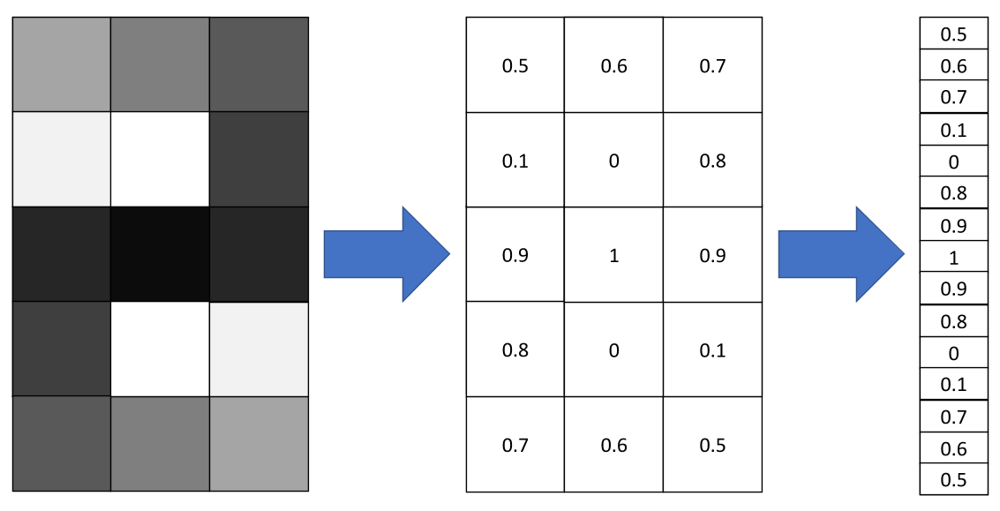

There are many different ways to encode text for neural network applications. You can replace each letter by their position in the alphabet, you can replace each word by their position in some dictionary, you can create complex vectors that distribute words in some N-dimensional space, etc, etc.
Most encodings of text is done on the word level, since we know that we want to use words anyways and learning to create words from letters turns out to be quite challenging ('runes' and 'nurse' contain the exact same letters but mean very different things).

In this exercise we will learn to create and use two types of embeddings:
* Bag of Words (BoW)
* Word2Vec (Skip-gram)

We will also learn about another Word2Vec implementation called Continuous Bag of Words (CBoW), and you may implement this as well as an optional task.
 
Finally we will also learn to use pretrained embeddings, where you simply use embeddings created by someone else.

Before we can start with each embedding, we have to discuss the so-called preprocessing pipeline.
The preprocessing pipeline is simply all the step we take from raw data (text) to the input of our neural networks.
There are many ways to form such a pipeline, with many different optional steps to add on, but generally it consists of some or all of the following parts:
* Cleaning - Removing unnecessary/unimportant parts of the text (like making all letters lowercase, removing special characters, etc)
   - Example: "Does Michael like 99 cats?" $\rightarrow$ "does michael like 99 cats"
* Tokenization - Splitting the text into its constituent parts (like words, letters, and/or symbols depending on what embedding you use)
   - Example: "does michael like 99 cats" $\rightarrow$ \["does", "michael", "like", "99", "cats"\]
* Stemming/lemmatization - Switch all words into their baseform (like removing plural, changing verbs to their root form, etc)
   - Example: \["does*", "michael", "like", "99", "cats"\] $\rightarrow$ \["do", "michael", "like", "99", "cat"\]
* Replace rare/special tokens - Switch some rare (only shows up once or twice in the dataset) or special (names, numbers, etc) tokens for tags
   - Example: \["do", "michael", "like", "99", "cat"\] $\rightarrow$ \["do", "\<NAME\>", "like", "\<NUMBER\>", "cat"\]
* Indexing - Create a token to number mapping and replace each token by its number
   - Example: \["do", "\<NAME\>", "like", "\<NUMBER\>", "cat"\] $\rightarrow$ \[454, 3, 872, 2, 234\]
* Embedding - Use an embedder to get a vector to use as input to the machine learning model.

This might seem overwhelming but there are a lot of toolkits that will help you with these steps.
This might also seem like we're getting rid of a lot of useful data, and that's true but often having well-formatted data is better than having more data.
In the end it depends from problem to problem which preprocessing steps are best.
For this exercise you will only need to think of tokenizing, indexing, and embedding.
The AG News dataset have already been tokenized and indexed, but you will need to create a tokeizer and indexer for the "cat on the mat" dataset.

### Datasets

In this exercise we will use two text datasets the "cat on the mat"-dataset and the [AG News dataset](https://www.kaggle.com/amananandrai/ag-news-classification-dataset). The code for creating/downloading both datasets are provided below. The former dataset is a small dummy dataset we will use to visulize and understand the methods. AG News is a large dataset of excerpts from news articles from a few different topics that can be used to train, for example, a news classifier.

#### "Cat on the mat"-dataset

In [2]:
import itertools

animals = ['cat','dog','goat','elephant','eagle','zebra','rhino', 'hippo']
actions = ['sat','stood','jumped','slept']
furniture = ['mat','rug','sofa','bed']

# Generate all combinations of animal, action and furniture
animal_corpus = [f'the {x[0]} {x[1]} on the {x[2]}' for x in itertools.product(animals, actions, furniture)]
vocabulary_size = len(animals) + len(actions) + len(furniture) + 2

print(f'There are {len(animal_corpus)} sentences in the corpus, with a vocabulary of {vocabulary_size} words')
print(f'The first sentence in the corpus is "{animal_corpus[0]}"')


There are 128 sentences in the corpus, with a vocabulary of 18 words
The first sentence in the corpus is "the cat sat on the mat"


#### AG News dataset

In [3]:
## Download,tokenize, and index the AG News dataset
# This is done in a separate cell as indexing takes some time

ag_train, ag_test = AG_NEWS(ngrams=1, vocab=None, root='data')

120000lines [00:04, 25986.43lines/s]
120000lines [00:08, 13402.12lines/s]
7600lines [00:00, 13304.00lines/s]


In [4]:
# Our labels are numbers, here's what type of article they represent
ag_labels = {
    0 : 'World',
    1 : 'Sports',
    2 : 'Business',
    3 : 'Sci/Tec'
}

# vocab is a class that will give us the index for any given word/token (vocab['hi'] = <some number>)
vocab = ag_train.get_vocab()

# nr2word is a list that contains the actual tokens for a given index (nr2word[5678] = <some word/token>)
nr2word = vocab.itos

# Let's make a function that takes an entire tensor and returns the string version of that tensor
def tensor2text(tensor):
    return ' '.join([nr2word[index] for index in tensor])

# And a function to turn text into the indexed version (though it won't work with special characters)
def text2tensor(text):
    tensor = torch.Tensor([vocab[token] for token in text.split(' ')])
    return tensor.int()

# And let's see what the dataset actually contains
ag_train_len = len(ag_train) #Get the number of entries in the AG_NEWS dataset

print(
    f'ag_train contains {len(ag_train)} labelled text snippets '
    f'and has a vocabulary size of {len(vocab)}\n'
    f'On index 0, ag_train contains:\n{ag_train[0]}\n'
    f'which has the label {ag_train[0][0]} that translates into "{ag_labels[ag_train[0][0]]}" '
    f'and the text snippet itself translates into:\n{tensor2text(ag_train[0][1])}'
)

ag_train contains 120000 labelled text snippets and has a vocabulary size of 95812
On index 0, ag_train contains:
(2, tensor([  432,   426,     2,  1606, 14839,   114,    67,     3,   849,    14,
           28,    15,    28,    16, 50726,     4,   432,   375,    17,    10,
        67508,     7, 52259,     4,    43,  4010,   784,   326,     2]))
which has the label 2 that translates into "Business" and the text snippet itself translates into:
wall st . bears claw back into the black ( reuters ) reuters - short-sellers , wall street ' s dwindling\band of ultra-cynics , are seeing green again .


## Tokenizing and Indexing
This new corpus of texts needs to be tokenized and indexed before we can start using it.
The tokenizer only needs to be able to handle this simple dataset, so it can be fairly simple.

**Exercise 1.1:** Write a tokenizer and an vocabulary class with a function that will give you the index of a token, and a function that will give you the token at a certain index.


In [5]:
def simple_tokenizer(text):
    '''
    Takes a text and returns a list of the individual words
    Args:
        text (str): The text to tokenize
    Returns ([str]): A list of individual words
    '''
    ## WRITE A TOKENIZER (Hint: use the 'split' function)
    list_words = text.split()
    return list_words

class SimpleVocabulary():
    
    def __init__(self, corpus):
        '''
        Takes a corpus, tokenizes it, and sets the internal variables needed
        to return the index of any given word (and what word has a given index)
        Args:
            corpus ([str]): The corpus as a list of non-tokenized texts
        '''
        ## WRITE A FUNCTION TO INITIALIZE THE VOCABULARY
        # HINT: Create a dictionary that contains the index for each unique word and antother to contain the word for a given index
        # HINT: Each new, previously unseen token from the tokenized corpus, should be entered into the dictionaries
        
        current_index = 0
        self.token2index = {}
        self.index2token = []
        
        for text in corpus:
            tokenized = simple_tokenizer(text)
            
            for token in tokenized:
                if self.get_index(token)==None:
                    self.index2token.append(token)
                    self.token2index[token] = current_index
                    current_index += 1
    
    def get_index(self, token):
        '''
        Takes a token and returns the index of that token
        Args:
            token (str): A token
        Returns (int): The index of the given token
        '''
        ## WRITE A FUNCTION THAT RETURNS THE INDEX OF A GIVEN TOKEN
        return self.token2index.get(token)
    

    def get_token(self, index):
        '''
        Takes an index and returns the token that index represents
        Args:
            index (int): An index
        Returns (str): The token that the given index represents
        '''
        ## WRITE A FUNCTION THAT RETURNS THE TOKEN OF A GIVEN INDEX
        return self.index2token[int(index)]

    
    def __len__(self):
        '''
        Returns (int): The number of words in the vocabulary
        '''
        ## WRITE A FUNCTION THAT RETURNS THE LENGTH OF THE VOCABULARY
        return len(self.token2index)
    
def index_sequence(sequence, vocabulary):
    '''
    Takes a tokenized text and a vocabulary and returns an indexed sequence
    Args:
        sequence ([str]): A list of individual tokens
    Returns ([int]): A list of indexes
    '''
    
    return [vocabulary.get_index(token) for token in sequence]
    

**Check your solution**: The code cell below will try to tokenize and index a few sentences

In [6]:
animal_vocab = SimpleVocabulary(animal_corpus)
test_sequence = 'the cat stood on the mat'
tokenized_sequence = simple_tokenizer(test_sequence)
print(tokenized_sequence)
indexed_sequence = index_sequence(tokenized_sequence, animal_vocab)
print(indexed_sequence)
assert len(tokenized_sequence) == 6, 'The tokenized sequence should contain all words of the original sequence'
assert len(tokenized_sequence) == len(indexed_sequence), 'The indexed sequence should be as long as the tokenized sequence'
assert indexed_sequence[0] == indexed_sequence[4], 'The index of the same word should be the same'
assert len(animal_vocab) >= 18, 'There should be at least 18 words in the vocabulary (more if you have a out-of-vocabulary token/index)'
print('simple_tokenizer and SimpleVocabulary seems to be properly implemented!')

['the', 'cat', 'stood', 'on', 'the', 'mat']
[0, 1, 8, 3, 0, 4]
simple_tokenizer and SimpleVocabulary seems to be properly implemented!


## Bag of Words (BoW)

Bag of Words is often seen as the default way to embed text as it is very easy to do.
In bag of words each text is represented as a N-dimensional vector, where N is the number of words in the vocabulary.
Each word in the vocabulary is given an index and each text is represented by a vector where the index of each word contains the number of occurences of this word in the text.
For example if we have the vocabulary \["the", "cat", "dog", "sat", "on", "mat", "sofa"\] then the text "the cat sat on the mat" would be represented by the BoW vector \[2, 1, 0, 1, 1, 1, 0\]
Simply put, each text is represented by the by stuffing all of its words into a bag, without care for their order.
While getting rid of the order of words might seem distastrous ("I do like candy" and "do I like candy" doesn't mean the same thing), this simple approach can still be enough to tackle many problems.
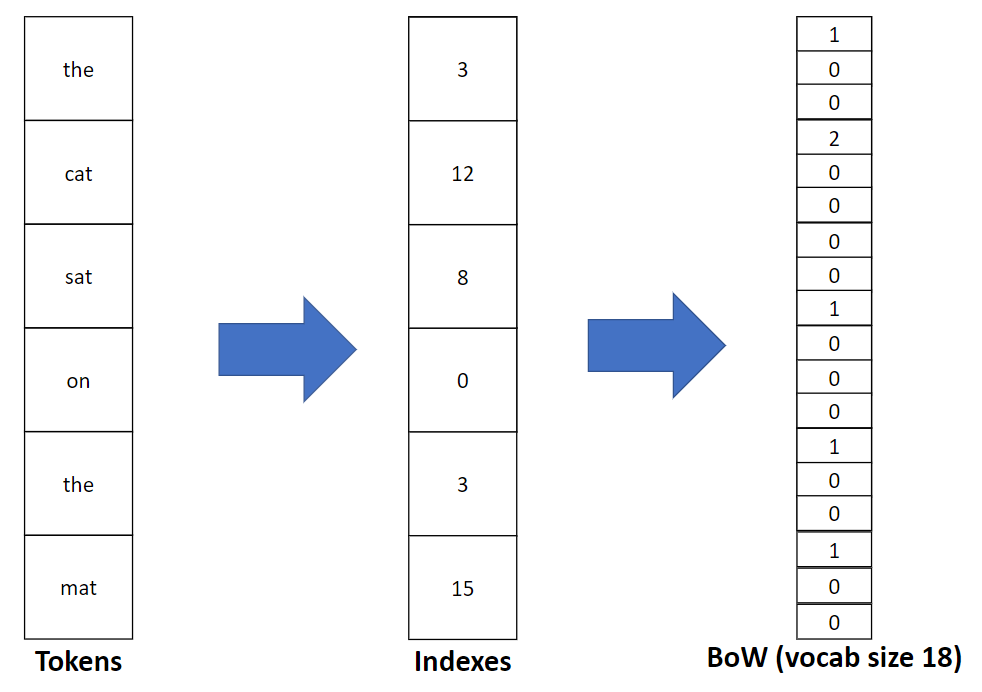

**Exercise 1.2**: Make a BoW embedder that takes the tensor (index vector) representation of a text, the length of the vocabulary, and returns a Bag of Words representation. How sparse are the vectors (how many zero/nonzero elements are there)? Why is this the case?

In [7]:
def bow_embedder(tensor, vocab_length):
    '''
    Takes a tensor and a vocabulary and returns the BoW embedding of that tensor
    Args:
        tensor (torch.Tensor): A tensor of words represented by their index in the vocabulary
        vocab_lenght (int): The number of entries in the vocabulary
    Returns (torch.Tensor): An tensor containing the BoW embedding of the input tensor
    '''
    ## ADD CODE HERE
    tensor = tensor.long()
    BoW = torch.zeros(vocab_length)
    for index in tensor:
        BoW[index] += 1
        
    return BoW

**Check your solution**: The code cell below will try to embed a few sentences using your embedder and will check that the embeddings seem correct.

In [8]:
vocab_length = len(vocab)

sentence_1 = 'the cat dances well for a little while'
sentence_2 = 'for a while the little cat dances well'
sentence_3 = 'the dog sits for a while'
sentence_4 = 'the cat and the dog'

sentence_1_indexed = text2tensor(sentence_1)
sentence_2_indexed = text2tensor(sentence_2)
sentence_3_indexed = text2tensor(sentence_3)
sentence_4_indexed = text2tensor(sentence_4)

sentence_1_bow = bow_embedder(sentence_1_indexed, vocab_length)
sentence_2_bow = bow_embedder(sentence_2_indexed, vocab_length)
sentence_3_bow = bow_embedder(sentence_3_indexed, vocab_length)
sentence_4_bow = bow_embedder(sentence_4_indexed, vocab_length)

# Assert statements are mainly used to test code
# You give them a statement that should be True and they throw an error if it doesn't
assert isinstance(sentence_1_bow, torch.Tensor), 'The BoW embedding should be a tensor'
assert len(sentence_1_bow) == vocab_length, 'The length of the BoW embedding should be the same as the vocabulary'
assert torch.all(sentence_1_bow == sentence_2_bow), 'Texts with the exact same words should have the same BoW embedding'
assert torch.any(sentence_1_bow != sentence_3_bow), 'Texts with different words should have different BoW embeddings'
assert sum(sentence_1_bow) == len(sentence_1_indexed), 'The sum of the BoW embedding should be the number of words in the text'
assert max(sentence_4_bow) == 2, 'A BoW embeddings should count the number of occurances of each word'

print('The bow_embedder seems to be properly implemented!')

The bow_embedder seems to be properly implemented!


#### Visualizing BoW

Before we use our embedder to train an actual neural network on the AG News dataset, let's see what it looks like using our smaller "cat on the mat"-dataset.

In [9]:
## Let's take a sentence and create the BoW representation for it
animal_vocab = SimpleVocabulary(animal_corpus) # Create vocabulary
test_sequence = 'the cat stood on the mat' # Create the sentence
tokenized_sequence = simple_tokenizer(test_sequence) # Tokenize the sentence
indexed_sequence = torch.Tensor(index_sequence(tokenized_sequence, animal_vocab)) #Index the sentence and turn it into a tensor
bow_sequence = bow_embedder(indexed_sequence, len(animal_vocab)) # Create the BoW embedding of the sentence

print(f'The sentence \n"{test_sequence}"\nwas embedded with the BoW representation \n{bow_sequence}\n')

The sentence 
"the cat stood on the mat"
was embedded with the BoW representation 
tensor([2., 1., 0., 1., 1., 0., 0., 0., 1., 0., 0., 0., 0., 0., 0., 0., 0., 0.])



### Training a news text classifier

So now that we have a way to embed our sentences, let's use that to train a classifier on the AG News dataset.

**Exercise 1.3**: Create a neural network and the train and test loops, and get at least 80% accuracy on the test set. 



In [10]:
# We create our own dataset to load the BoW embedded texts
class BoWDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, embedder):
        self.dataset = dataset
        self.embedder = embedder
        
    def __getitem__(self, index):
        return self.dataset[index][0], self.embedder(self.dataset[index][1], len(vocab))
  
    def __len__(self):
        return len(self.dataset)

In [11]:
bow_train_data = BoWDataset(ag_train, bow_embedder)
bow_test_data = BoWDataset(ag_test, bow_embedder)
bow_trainloader = DataLoader(bow_train_data, batch_size=1000, shuffle=True)
bow_testloader = DataLoader(bow_test_data, batch_size=1000, shuffle=False)

BOW_SIZE = len(vocab) # The size of the BoW embedding is the size of the vocabulary
CLASS_SIZE = len(ag_labels) # The size of the classes is the size of the labels

# CREATE A NEURAL NETWORK TO TRAIN
network = nn.Sequential(
    nn.Linear(BOW_SIZE,100),
    nn.Sigmoid(),
    nn.Linear(100,CLASS_SIZE) # HINT: We want our input to be the size of our BoW embedding and our output to be the different possible classes
)


# Use for instance Adam
optimizer = optim.Adam(network.parameters(), lr=0.01)

# What loss function works well when we have different classes?
loss_function = nn.CrossEntropyLoss()

epochs = 1 # The dataset is large so one epoch should do for our purpose (and anything more would take forever)

for epoch in range(epochs):
    # For each batch of data (since the dataset is too large to run all data through the network at once)
    for batch_nr, (labels, data) in enumerate(bow_trainloader):
       ## WRITE TRAINING CODE HERE
    
        # Predict for each BoW represented text in the batch what class they belong to
        prediction = network(data)
        
        # Calculate the loss of the prediction by comparing to the expected output
        loss = loss_function(prediction, labels)
        
        # Backpropagate the loss through the network to find the gradients of all parameters
        loss.backward()
        
        # Update the parameters along their gradients
        optimizer.step()
        
        # Clear stored gradient values
        optimizer.zero_grad()
        
        #Print the epoch, batch, and loss
        print(
            f'\rEpoch {epoch+1} [{batch_nr+1}/{len(bow_trainloader)}] - Loss: {loss}',
            end=''
        )



Epoch 1 [120/120] - Loss: 0.23371677100658417

In [12]:
print(labels)

tensor([3, 3, 3, 1, 2, 2, 0, 0, 2, 3, 0, 3, 1, 1, 0, 0, 2, 1, 0, 2, 0, 0, 3, 0,
        3, 3, 3, 1, 2, 2, 1, 1, 3, 1, 2, 2, 3, 1, 1, 1, 2, 2, 1, 2, 3, 3, 0, 2,
        0, 0, 2, 1, 3, 3, 2, 1, 0, 3, 1, 1, 3, 0, 3, 1, 1, 2, 0, 3, 0, 0, 0, 1,
        2, 3, 2, 0, 3, 3, 1, 0, 1, 0, 1, 1, 2, 3, 2, 0, 1, 3, 0, 3, 2, 3, 0, 0,
        1, 3, 2, 3, 1, 1, 3, 3, 0, 3, 3, 3, 0, 2, 1, 2, 1, 0, 0, 1, 2, 2, 2, 2,
        2, 2, 2, 2, 1, 0, 3, 3, 2, 2, 3, 2, 2, 0, 3, 2, 0, 3, 1, 0, 2, 1, 3, 0,
        2, 1, 3, 3, 3, 1, 3, 2, 3, 0, 0, 3, 2, 3, 2, 2, 2, 3, 1, 0, 0, 2, 0, 2,
        0, 1, 3, 0, 0, 1, 3, 0, 1, 1, 1, 3, 1, 1, 0, 0, 1, 0, 2, 3, 0, 0, 0, 2,
        0, 0, 1, 0, 3, 2, 1, 2, 1, 0, 3, 1, 2, 1, 2, 2, 1, 2, 2, 2, 2, 0, 1, 0,
        3, 3, 2, 0, 0, 0, 0, 2, 1, 0, 3, 3, 1, 1, 1, 1, 3, 1, 2, 2, 3, 0, 1, 3,
        2, 0, 3, 1, 0, 3, 1, 3, 3, 1, 2, 3, 2, 0, 2, 1, 2, 0, 0, 2, 1, 0, 0, 2,
        3, 0, 3, 1, 1, 0, 3, 2, 2, 1, 1, 2, 0, 2, 3, 1, 0, 2, 0, 2, 3, 0, 1, 3,
        3, 2, 2, 2, 2, 1, 2, 0, 3, 1, 1,

We should analyse the performance of our network besides the loss. Let's calculate the accuracy and the confusion matrix.

**Exercise 1.4**: Calculate accuracy and the confusion matrix using predictions from the test set. Feel free to use the code for confusion matrix computation and visualisation provided below.



In [13]:
with torch.no_grad():
    correct = 0
    total = 0
    y_pred = []
    y_true = []
    # For each batch of testing data (since the dataset is too large to run all data through the network at once)
    for batch_nr, (labels, data) in enumerate(bow_testloader):
        ## WRITE THE TESTING CODE HERE
        # HINT: Find where the prediction equals the label and add to the correct count
        prediction = network(data)
        for index in range(len(prediction)):
            if torch.argmax(prediction[index]) == labels[index].item():
                correct += 1
            total += 1
            y_true.append(labels[index].item())
            y_pred.append(torch.argmax(prediction[index]).item())
    
    print(f'The accuracy of the network is {str(100*correct/total)[:4]}%.')
    

The accuracy of the network is 92.2%.


In [14]:
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    import itertools
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = numpy.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    plt.tight_layout()

Confusion matrix, without normalization
[[1714   54   73   59]
 [   8 1874    9    9]
 [  48   14 1682  156]
 [  38   16  108 1738]]


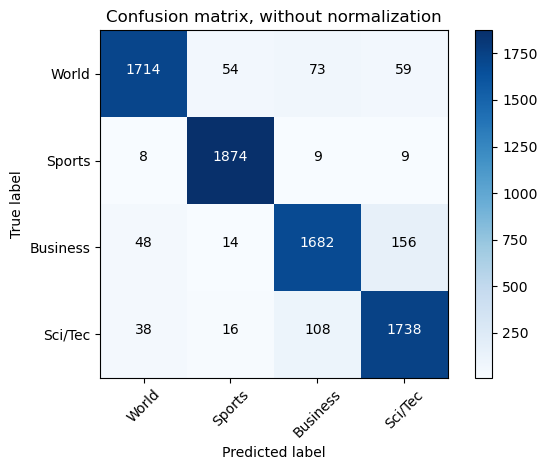

In [15]:
cnf_matrix = confusion_matrix(y_true, y_pred,labels=[0, 1, 2, 3])
numpy.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['World', 'Sports', 'Business', 'Sci/Tec'],
                      title='Confusion matrix, without normalization')

In [16]:
# Let's print a sentence and predict it's category
sentence_index = 0
prediction = torch.argmax(network(torch.unsqueeze(bow_embedder(ag_train[sentence_index][1], len(vocab)), dim=0))).item()
print(
    f'The network predicted that \n"{tensor2text(ag_train[sentence_index][1])}"\n should be in the category {ag_labels[prediction]}'
)

The network predicted that 
"wall st . bears claw back into the black ( reuters ) reuters - short-sellers , wall street ' s dwindling\band of ultra-cynics , are seeing green again ."
 should be in the category Business


## 2. Word2Vec

As you might already have thought BoW embeddings have a few problems.
Firstly, it diregards the order of words which, as previously stated, can be quite important.
Secondly, the size of the embedding grows larger with the size of the vocabulary.
While the second issue can be solved by limiting the vocabulary to the most common/important words, this remains a fairly large vector with very few non-zero elements (a sparse vector).

One commonly used alternative that fixes both of these issues is the so-called Word2Vec embeddings.
Word2Vec can be summarized as using machine learning to learn non-sparse (most, if not all, entries are non-zero) word embeddings with fewer dimensions (typically between 100 and 1000). A text is then represented as a matrix where the first row (or column depending on how you use it) represents the first word and so on.
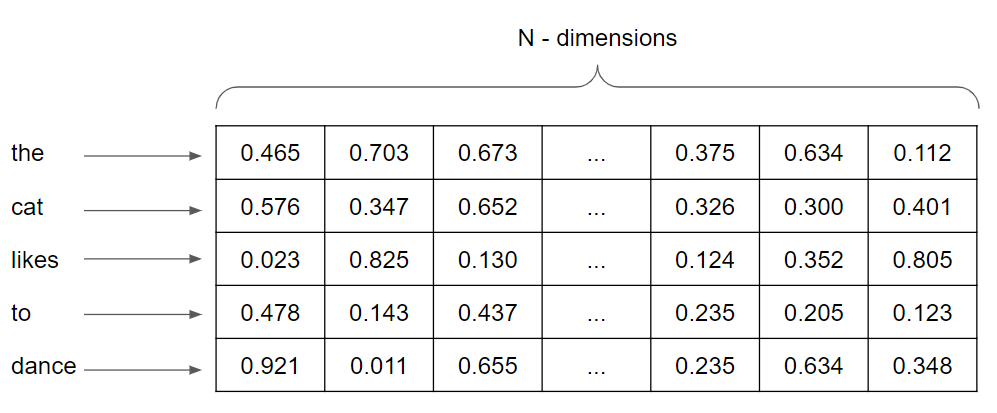

So how do you learn an embedding?
Again, there are many ways to do this, but the most common Word2Vec methods use the idea that a word is defined by the company it keeps.
That is, an embedding of a word is good if you can either use it to predict which the surrounding words are or if it can be predicted using the surrounding words.
So you either train a model to predict the surrounding words from the central word, or train it to predict a word from the surrounding ones.
These two methods are called Skip-Gram and Continuous Bag of Words (CBoW) respectively and are illustrated by the images below.

<h1><center>Skip-gram</center></h1>| <h2><center>CBoW</center></h2>
- | -
<img src="attachment:image-3.png" width="300"> | <img src="attachment:image-2.png" width="300">

The logic behind these methods can be better understood by imagining synonyms.
If we're creating embeddings (codes) to represent different words, it makes sense that similar words should have similar embeddings.
Since synonymous words would have many similar surrounding words in many sentences, telling the difference between the two would be difficult, and thus giving them similar embeddings would lead to a lesser error.
However, words that have slightly different meaning cannot have the same embeddings, because that would make predicting words from that embedding more difficult.

While training useful such embeddings for every single words takes huge datasets of texts, this only has to be done once and then those embeddings can be used for many different applications.
Due to this time consuming training we will only train a very small sample of word embeddings to learn how it's done and better understand them.
Afterwards we will use pretrained embeddings to do some actual prediction.

With this in mind we will use the "cat on the mat" dataset to train our embeddings.
Our goal is to create embeddings where each group of words (animals, furniture, actions, and other) are given distinct groups in the encoding space.

### Skip-gram embedding

In Skip-gram embeddings we want to predict the surrounding words from a given one.
Rather than for a given word predicting all the surrounding words at once, we'll create context-target pairs.
We decide on a window size, and create a context target pair with the central word being the context and each word in the window of surrounding words will be our target. 
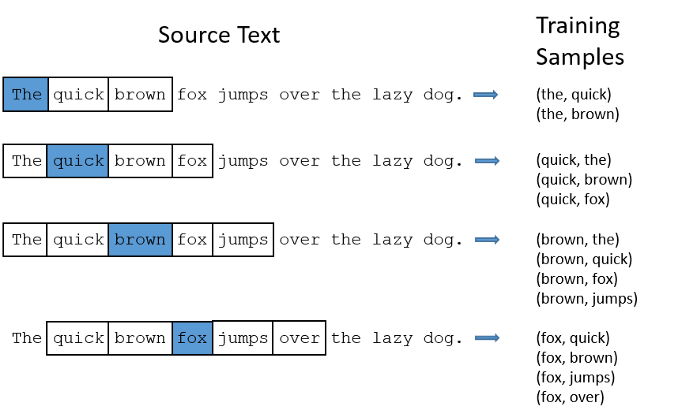

The goal of the training is to predict the target word given the context word.
We provide the function for creating context-target pairs below, so you don't need to implement this yourself.

We'll use these context-target pairs to train a neural network to predict the target word and, hopefully, during this training the hidden layer of the neural network will become the embedding of our context word.
So in order to get the embedding after training, we simply input a word and extract the values of the hidden layer of the network

In [17]:
## Hyperparameters for Skip-gram Embedding
WINDOW_SIZE = 2
EMBEDDING_SIZE = 2

In [18]:
# This is code for the skipgram generation (you don't need to understand it)
def skipgrams(sequences, window_size = 2, shuffle = True):
    couples = []
    for sequence in sequences:
        for i, wi in enumerate(sequence):
    
            window_start = max(0, i - window_size)
            window_end = min(len(sequence), i + window_size + 1)
            for j in range(window_start, window_end):
                if j != i:
                    wj = sequence[j]
                    couples.append([wi, wj])

    if shuffle:
        seed = random.randint(0, 10e6)
        random.shuffle(couples)

    return torch.Tensor(couples)

In [19]:
# We print the path from text to skip-grams so you can see the process

animal_vocab = SimpleVocabulary(animal_corpus)
test_sequence = 'the cat stood on the mat'
print('The sentence:',test_sequence)
tokenized_sequence = simple_tokenizer(test_sequence)
print('The sentence split into tokens:',tokenized_sequence)
indexed_sequence = [animal_vocab.get_index(token) for token in tokenized_sequence]
print('The indexed sentence:', indexed_sequence)
skipgrams_sequence = skipgrams([indexed_sequence], shuffle=False).int()
print('All generated skip-gram pairs:', skipgrams_sequence)
skipgrams_sequence_words = [(animal_vocab.get_token(x[0]), animal_vocab.get_token(x[1])) for x in skipgrams_sequence]
print('The skip-gram pairs as text:', skipgrams_sequence_words)

The sentence: the cat stood on the mat
The sentence split into tokens: ['the', 'cat', 'stood', 'on', 'the', 'mat']
The indexed sentence: [0, 1, 8, 3, 0, 4]
All generated skip-gram pairs: tensor([[0, 1],
        [0, 8],
        [1, 0],
        [1, 8],
        [1, 3],
        [8, 0],
        [8, 1],
        [8, 3],
        [8, 0],
        [3, 1],
        [3, 8],
        [3, 0],
        [3, 4],
        [0, 8],
        [0, 3],
        [0, 4],
        [4, 3],
        [4, 0]], dtype=torch.int32)
The skip-gram pairs as text: [('the', 'cat'), ('the', 'stood'), ('cat', 'the'), ('cat', 'stood'), ('cat', 'on'), ('stood', 'the'), ('stood', 'cat'), ('stood', 'on'), ('stood', 'the'), ('on', 'cat'), ('on', 'stood'), ('on', 'the'), ('on', 'mat'), ('the', 'stood'), ('the', 'on'), ('the', 'mat'), ('mat', 'on'), ('mat', 'the')]


In [20]:
# We create the actual skip-gram pairs for the entire "cat on the mat"-dataset

animal_vocab = SimpleVocabulary(animal_corpus)
indexed_text = [[animal_vocab.get_index(token) for token in simple_tokenizer(text)] for text in animal_corpus]
pairs = skipgrams(indexed_text, WINDOW_SIZE)
print(f'There are {len(pairs)} pairs of skip-grams created from the "cat in the mat" dataset.')

There are 2304 pairs of skip-grams created from the "cat in the mat" dataset.


For creating the skipgram embedding we will not use nn.Sequential as we usually do when creating neural networks.
Instead we will create a subclass of nn.Module to create our own PyTorch module.
This is useful when we need to create neural networks with non-linear structure, or with some quirk that cannot be implemented with existing modules.
In short a nn.Module needs only a single function called 'forward' that takes the input and performs the forward pass of the network using differentiable functions (most torch functions and mathematical operations supports this).
Any part of the module that needs to be initialized (like nn.Linear) needs to be so in the \_\_init\_\_ function of the network after the super().\_\_init\_\_() statement.
In this exercise you will not need to write the \_\_init\_\_ function.
For more information on creating networks as subclasses of nn.Module, read **[here](https://pytorch.org/tutorials/beginner/pytorch_with_examples.html#nn-module)**.

**Exercise 2.1**: Create the SkipgramEmbedder class, a neural network that first reduces the one-hot embedding of one word to a smaller embedding space and then predicts the one-hot embedding of the paired word using that. These embeddings should then be such that most groups of words are separate on the embedding space (though if two groups overlaps that is fine). Think of why the groups gets embedded the way they do.

In [21]:
# An Embedding layer used for turning int into one-hot
to_onehot = nn.Embedding.from_pretrained(torch.eye(len(animal_vocab))) 

class SkipgramEmbedder(nn.Module):
    def __init__(self):
        super().__init__()
        self.input_layer = nn.Linear(len(animal_vocab), EMBEDDING_SIZE)
        self.output_layer = nn.Linear(EMBEDDING_SIZE, len(animal_vocab))
        self.softmax = nn.Softmax()
    
    def embed(self, context_index):       
        # IMPLEMENT THE EMBEDDING STEP OF THE SKIP-GRAM EMBEDDER
        context_onehot = to_onehot(context_index) # Make a one-hot representation of the index
        embedding = self.input_layer(context_onehot) # Pass the one-hot representation throught the first layer to create an embedding
        return embedding
    
    def forward(self, context_index):
        # IMPLEMENT THE FORWARD PASS FOR PREDICTING TARGET WORD FROM THE CONTEXT WORD
        embedding = self.embed(context_index) # Use the self.embed function
        output = self.output_layer(embedding) # Pass the embedding through the second layer to create an output
        prediction = self.softmax(output) # Pass the output through softmax 
        return prediction
        


#### Learing the embeddings
Run the code below to train your embedder so it learns the embeddings

**Exercise 2.2:** Implement a network that trains your embedder by predicting targets based on context.

**Hint**: The code for training is very similar to exercise 1.3, but we now need to use *pairs* to extract the current contexts for prediction and targets for evaluation, and some way of keeping track of indexes. 

In [22]:
model = SkipgramEmbedder()
optimizer = torch.optim.RMSprop(model.parameters(), lr=0.01)
loss_function = nn.CrossEntropyLoss()

#Epochs
TOTAL_EPOCHS = 1000
BATCH_SIZE = len(pairs)-1
EMBEDDING_SIZE = 100
# For each epoch
for epoch in range(TOTAL_EPOCHS):
    # 
    # A variable for containing the sum of all batch losses for this epoch
    epoch_loss = 0
    # 
    # Lower index
    start = 0
    # 
    # For each batch
    for batch_nr, end in enumerate(range(BATCH_SIZE,len(pairs),BATCH_SIZE)):
        #
        targets = torch.Tensor(pairs[start:end,0]).long()  # From the pairs we created, the first word is always the targe and the second one is always the context.
        contexts = torch.Tensor(pairs[start:end,1]).long()
        # 
        start = end
        # 
        # Predict for context word in the batch what the target word should be
        prediction = model.forward(contexts)
        # 
        # Calculate the loss of the prediction by comparing to the expected output
        loss = loss_function(prediction, targets)
        # 
        # Backpropagate the loss through the network to find the gradients of all parameters
        loss.backward()
        # 
        # Update the parameters along their gradients
        optimizer.step()
        # 
        # Clear stored gradient values
        optimizer.zero_grad()
        # 
        # Add the loss to the total epoch loss (item() turns a PyTorch scalar into a normal Python datatype)
        epoch_loss += loss.item()
        # 
        #Print the epoch, batch, and loss
        print(
            f'\rEpoch {epoch+1} [{batch_nr+1}/{len(targets)/BATCH_SIZE}] - Loss: {loss}',
            end=''
        )

Epoch 23 [1/1.0] - Loss: 2.6787822246551514

/var/folders/bf/nb0qdmqs7855vpz6wqh3ds580000gn/T/ipykernel_61512/1056882524.py:21: UserWarning: Implicit dimension choice for softmax has been deprecated. Change the call to include dim=X as an argument.
  prediction = self.softmax(output) # Pass the output through softmax


Epoch 1000 [1/1.0] - Loss: 2.642302989959717

#### Visualizing the embeddings
You don't need to understand the code below, instead we will explain it here.
Below we run each individual word in the "cat on the mat" dataset throgh the SkimgramEmbedder in order to get its embedding. Then we use [Prinipal Component Analysis (PCA)](https://en.wikipedia.org/wiki/Principal_component_analysis) in order to reduce the embedding dimensionality to 2 (if you have changed the dimensionality to anything larger) and then we print that as a graph where each group of words have been given the same color in order to display how they are grouped. Ideally the training should have converged towards clear groupings of similar words. If it hasn't try running the training again (it shouldn't take that many tries to get an embedding that clearly separates most groups of words). If you cannot get an embedding that separates all groups, don't worry about it so long as most groups are separated.

The embeddings if all words in the vocabulary
[[ 3.57  0.06]
 [ 2.26  2.52]
 [-0.33  3.54]
 [-0.93  3.38]
 [ 2.36  2.63]
 [ 2.34  2.61]
 [ 2.25  2.65]
 [ 2.29  2.56]
 [-0.43  3.49]
 [-0.43  3.44]
 [-0.43  3.4 ]
 [ 2.3   2.57]
 [ 2.24  2.5 ]
 [ 2.24  2.5 ]
 [ 2.25  2.51]
 [ 2.32  2.59]
 [ 2.28  2.55]
 [ 2.25  2.51]]


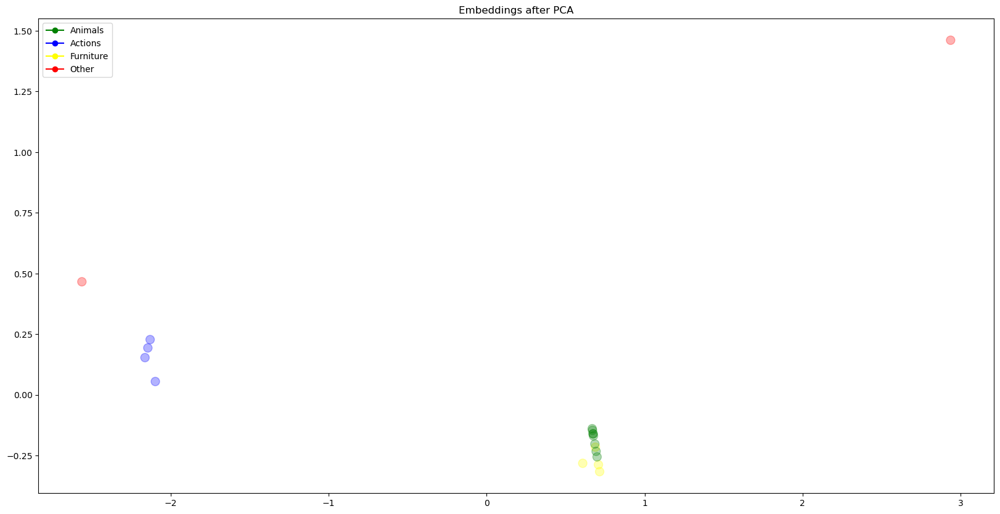

In [23]:
%matplotlib inline
from sklearn.decomposition import PCA
from matplotlib import pyplot as plt


category_colors = {'animals' : 'green', 
                   'actions' : 'blue',
                   'furniture' : 'yellow'}

colors = []
for i in range(vocabulary_size):
    colors.append('red')
    
for word in animal_vocab.index2token:
    index = animal_vocab.get_index(word)
    if word in animals:
        colors[index] = category_colors['animals']
    elif word in actions:
        colors[index] = category_colors['actions']
    elif word in furniture:
        colors[index] = category_colors['furniture']

# Plots embeddings using PCA (you don't need to understand it)
def plot_embeddings_after_pca(vectors):  
        """
        Perform PCA and plot the resulting 2 components on X and Y axis
        Args:
          embedding_weights - the set of vectors to 
        """
        pca = PCA(n_components=2)
        vectors_pca = pca.fit_transform(vectors)
        plt.figure(figsize=(20,10))
        
        # We do not draw the first element, which is the 'Out-of-Vocabulary' token
        plt.scatter(vectors_pca[:,0], vectors_pca[:,1], c=colors, s=100, alpha=0.3);
        plt.title('Embeddings after PCA')
        legend_elements = [
                    plt.Line2D([0], [0], marker='o', color=category_colors['animals'], label='Animals'),
                    plt.Line2D([0], [0], marker='o', color=category_colors['actions'], label='Actions'),
                    plt.Line2D([0], [0], marker='o', color=category_colors['furniture'], label='Furniture'),
                    plt.Line2D([0], [0], marker='o', color='red', label='Other'),
                  ]

        # Create the figure
        plt.legend(handles=legend_elements)

# Extracting the embeddings for every word in the vocabulary, detaching them from PyTorch, and turning them into numpy
numpy_word_vectors = model.embed(torch.Tensor(range(vocabulary_size)).long()).detach().numpy()

print('The embeddings if all words in the vocabulary')
print(numpy_word_vectors)

# Display the most significant axes of the word vectors using PCA
plot_embeddings_after_pca(numpy_word_vectors)

## 3. Using pretrained embeddings

A problem with training word embeddings is that you would need to have a dataset containing all words you want to embed in many different sentences.
This adds up to needing really large datasets (the entirety of Wikipedia for example) to create good embeddings.
This is unfeasible for most people as it requires huge amounts of computational power and the ability to download and store huge datasets.
Not to mention that if everyone did this it would waste a lot of energy compared to reusing pre-trained networks.
Consequently, pre-trained embeddings created by researchers with access to large computational resources have been made publicly available.
Thus, this is an efficient way to get access to good word embeddings while saving time and energy.

We will use one such pretrained embedding network to train a network to make predictions on the AG News dataset.

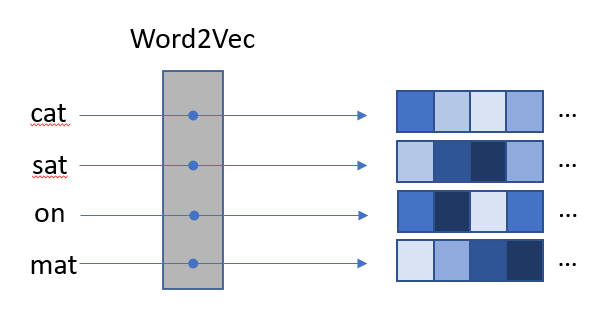


In [24]:
from gensim.models import KeyedVectors

# Load embeddings from the pre-trained file
import gensim.downloader as api
wv = api.load('word2vec-google-news-300')

In [25]:
print(wv['horse'])

[ 5.34e-04  3.11e-02  5.04e-03 -9.18e-02 -8.36e-03 -1.66e-01  3.93e-02
  2.98e-02  1.70e-01 -2.04e-01  2.41e-01 -3.05e-01 -2.25e-02 -3.71e-01
 -5.62e-02  1.51e-01 -1.22e-01  3.42e-01  3.05e-02 -2.95e-01  6.54e-02
 -9.28e-02  1.49e-01  8.15e-02 -6.93e-02  1.98e-01 -1.66e-01  2.00e-01
  1.17e-01 -3.69e-01 -2.48e-01  1.26e-01  3.59e-01  1.51e-01 -7.76e-02
  2.91e-01 -1.75e-02 -1.21e-01 -1.00e-01  1.44e-01  5.92e-03  2.36e-02
  3.20e-01  1.83e-01  9.52e-02  9.23e-02  8.30e-02 -1.34e-01  9.57e-02
  1.67e-01  1.88e-02 -2.80e-02 -1.03e-02  1.12e-01 -8.11e-02  1.80e-01
  8.35e-02 -5.91e-02  1.71e-01  1.68e-02  8.74e-02  9.03e-02  9.23e-02
 -9.77e-02 -2.39e-02 -2.07e-01 -1.21e-02  1.45e-01  6.20e-02 -1.44e-02
  2.81e-01  6.84e-02 -2.13e-01  4.69e-02 -1.00e-01 -1.36e-01  7.47e-02
 -2.70e-01  7.57e-02 -5.52e-02 -2.01e-02 -3.81e-01  1.68e-01 -3.91e-01
  5.54e-02  2.24e-01 -6.29e-03  7.76e-02  2.03e-01 -1.05e-01 -3.12e-02
  3.54e-01  1.54e-01 -1.26e-01 -2.25e-02 -3.81e-01  3.12e-01  2.13e-01
  1.97

Word embeddings contain mathematical representations of the underlying meaning of words. As every embedding is in the same dimensions, you can utilize linear algebra to look inside how the model thinks.
Try playing around with a few words and methods to investigate how the model views language.

In [26]:
king = wv.most_similar("king")
dist = wv.similarity("king","reign")
print(king)
print(dist)

[('kings', 0.7138045430183411), ('queen', 0.6510956883430481), ('monarch', 0.6413194537162781), ('crown_prince', 0.6204220056533813), ('prince', 0.6159993410110474), ('sultan', 0.5864824056625366), ('ruler', 0.5797567367553711), ('princes', 0.5646552443504333), ('Prince_Paras', 0.5432944297790527), ('throne', 0.5422105193138123)]
0.32994267


There is a famous example of embedding maths that goes "king" - "man" + "woman" = "queen". This example, and embedding maths in general, utilize the fact that embeddings are just vectors in a high dimenionsal vector space, and certain features of language tend to exist along certain axises and cluster together with similar words. We would thus expect king to have a presence in the "royalty"-axis, and in the "man"-axis. Removing man and adding woman should thus result in "royalty" + "woman", in other words a queen. See if you can find any other examples where semantic mathematics work, or an example where it clearly doesn't work. Do the results make sense to you?

In [27]:
print(wv.similar_by_vector(wv['king']))
print("")
similars = wv.similar_by_vector(wv['king']-wv['man']+wv['woman']-wv['boy']+wv['girl'])
print(similars)

similars[0]

[('king', 1.0), ('kings', 0.7138044834136963), ('queen', 0.6510956883430481), ('monarch', 0.6413194537162781), ('crown_prince', 0.6204220056533813), ('prince', 0.6159993410110474), ('sultan', 0.5864824056625366), ('ruler', 0.5797566771507263), ('princes', 0.5646551847457886), ('Prince_Paras', 0.543294370174408)]

[('queen', 0.7167508602142334), ('king', 0.6456761360168457), ('princess', 0.6246699690818787), ('monarch', 0.5621277689933777), ('queens', 0.5329185128211975), ('Queen_Consort', 0.5304834246635437), ('goddess', 0.507165789604187), ('empress', 0.505368173122406), ('very_pampered_McElhatton', 0.4988248646259308), ('prince', 0.48208680748939514)]


('queen', 0.7167508602142334)

You might be interested in investigating the vocabulary of your model

In [28]:
nr_of_words = 10
for i in range(nr_of_words):
    word = wv.index_to_key[i]
    index = wv.key_to_index[word]
    print(word)

</s>
in
for
that
is
on
##
The
with
said


### Training a FFNN with w2v


We want to train a network using our pretrained embeddings. To do this, we utilize the task and code from the AGnews-prediction with BoW, but modify it to suit our w2v-embeddings.
First we create the dataset.

In [29]:
# We create our own dataset to load the w2v embedded texts
class w2vDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, embedder):
        self.dataset = dataset
        self.embedder = embedder
        
    def __getitem__(self, index):
        return self.dataset[index][0], self.embedder(self.dataset[index][1], 300)
  
    def __len__(self):
        return len(self.dataset)

Then we create an embedder that encodes every word using our w2v encoder (wv.get_vector(token)).
Compared to when we used a BoW-encoder, we now face two issues: out of vocabulary (OOV) words and varying sentence length.

**Exercise 3.1:** Create a w2v-embedder using our pre-trained w2v model. <br>
**Exercise 3.1.1:** Describe three possible ways to deal with OOV-words and varying sentence length. What are the benefits and drawbacks of the methods you have described? <br>
**Exercise 3.1.2:** Implement one of these methods for OOV and varying input length to make training of a FFNN possible (your methods do not have to be good, just compileable). <br>
**Hint:** <br>
for x in range(len(tokens)): <br>
    try: # compute word2vec embedding from word. Add it to the way you store embeddings <br>
    except: # handle (or ignore) oov

In [30]:
def w2v_embedder(tensor, embedding_length):
    '''
    Takes a tensor and a embedding length and returns the w2v embedding of that tensor
    Args:
        tensor (torch.Tensor): A tensor of words represented by their index in the vocabulary
        embedding_length (int): The length of the embedding
    Returns (torch.Tensor): An tensor containing the w2v embedding of the input tensor
    '''
    ## ADD CODE HERE
    
    tensor = tensor.long()
    # Initiate your embedding
    embedding = torch.zeros(embedding_length)
    # How do we get words from our tensor?
    words = tensor2text(tensor)
    # How do we get tokens from our words?
    tokens = simple_tokenizer(words)
    # What do we loop over?
    for x in range(len(tokens)):
        try: # compute word2vec embedding from word. Add it to the way you store embeddings
            embedding += wv.get_vector(tokens[x])/len(tokens)
        except: # handle (or ignore) oov
            exception = 505
        # How do we handle OOV?
        # How do we embed our token?
        # How do we store it?
    return embedding


Then we design and train a network

**Exercise 3.2:** Build a model that takes w2v-ecnodings of the AG-NEWS dataset as inputs and outputs AG-NEWS classes. The network might not converge towards good performance depending on your solutions to 3.1. Why?

**Hint:** Recall the BoW-classifier that we implemented and reuse that structure. <br>
Your performance might be really bad (25% accuracy). This is OK and will be amended below. 

In [31]:
w2v_train_data = w2vDataset(ag_train, w2v_embedder)
w2v_test_data = w2vDataset(ag_test, w2v_embedder)
w2v_trainloader = DataLoader(w2v_train_data, batch_size=1000, shuffle=True)
w2v_testloader = DataLoader(w2v_test_data, batch_size=1000, shuffle=False)

embedding_length = 300
CLASS_SIZE = len(ag_labels) # The size of the classes is the size of the labels


# CREATE A NEURAL NETWORK TO TRAIN
network = nn.Sequential(
    nn.Linear(embedding_length,100),
    nn.Sigmoid(),
    nn.Linear(100,CLASS_SIZE) # HINT: We want our input to be the size of our w2v embeddings and our output to be the different possible classes
)


# Initialize optimizer, loss function and number of epochs
optimizer = optim.Adam(network.parameters(), lr=0.01)
loss_function = nn.CrossEntropyLoss()
epochs = 1


for epoch in range(epochs):
    # For each batch of data (since the dataset is too large to run all data through the network at once)
    for batch_nr, (labels, data) in enumerate(w2v_trainloader):
       ## WRITE TRAINING CODE HERE
       
        # Predict for each BoW represented text in the batch what class they belong to
        prediction = network(data)
        # Calculate the loss of the prediction by comparing to the expected output
        loss = loss_function(prediction, labels)
        # Backpropagate the loss through the network to find the gradients of all parameters
        loss.backward()
        # Update the parameters along their gradients
        optimizer.step()
        # Clear stored gradient values
        optimizer.zero_grad()
        
        #Print the epoch, batch, and loss
        print(
            f'\rEpoch {epoch+1} [{batch_nr+1}/{len(w2v_trainloader)}] - Loss: {loss}',
            end=''
        )
        


Epoch 1 [120/120] - Loss: 0.36588153243064886

**Exercise 3.3:** Let's once again calculate accuracy and the confusion matrix.

In [40]:
with torch.no_grad():
    classes = [0, 1, 2, 3]
    correct = 0
    total = 0
    y_pred = []
    y_true = []
    # For each batch of testing data (since the dataset is too large to run all data through the network at once)
    # Calculate the accuracy, precision and recall
    for batch_nr, (labels, data) in enumerate(w2v_testloader):
        prediction = network(data)
        for index in range(len(prediction)):
            if torch.argmax(prediction[index]) == labels[index].item():
                correct += 1
            total += 1
            y_true.append(labels[index].item())
            y_pred.append(torch.argmax(prediction[index]).item())
            
    print(f'The accuracy of the network is {str(100*correct/total)[:4]}%.')

The accuracy of the network is 87.7%.


Confusion matrix, without normalization
[[1669   68  101   62]
 [  41 1817   27   15]
 [ 105   23 1541  231]
 [  77   24  159 1640]]


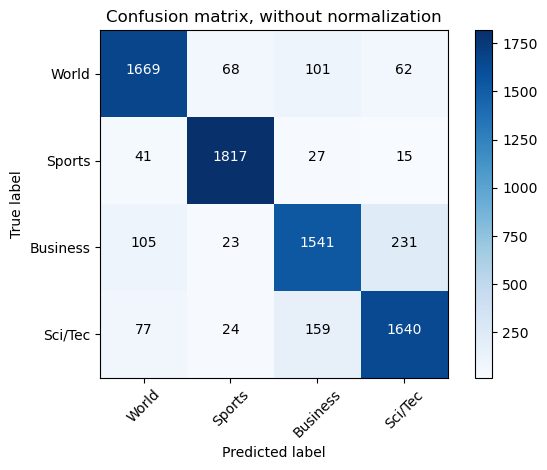

In [41]:
cnf_matrix = confusion_matrix(y_true, y_pred,labels=[0, 1, 2, 3])
numpy.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['World', 'Sports', 'Business', 'Sci/Tec'],
                      title='Confusion matrix, without normalization')

Let us also investigate how the pretrained embeddings separate the animals, actions and furnitures from our initial corpus. You can also insert any words from the word2vec corpus (wv.vocab) here and see how they are projected in a 2D-space using PCA.

The embeddings if all words in the vocabulary
[[ 0.08  0.1   0.05 ...  0.    0.05 -0.07]
 [ 0.01  0.2  -0.29 ...  0.49 -0.28  0.06]
 [ 0.2   0.08  0.15 ... -0.04  0.17 -0.01]
 ...
 [-0.09 -0.1  -0.49 ...  0.02  0.08  0.  ]
 [ 0.    0.35 -0.32 ...  0.35 -0.1   0.23]
 [-0.06  0.14 -0.34 ...  0.15 -0.01  0.17]]


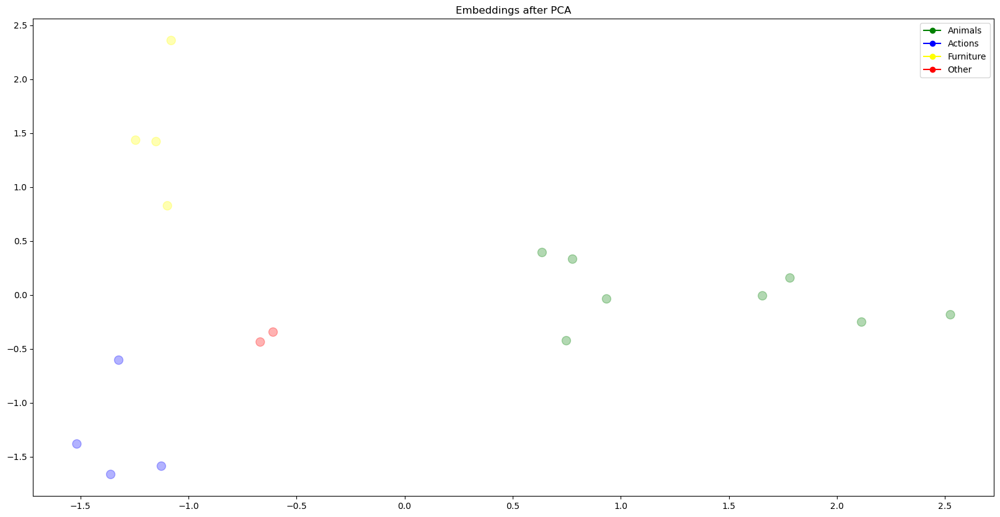

In [34]:
#%matplotlib inline
from sklearn.decomposition import PCA
from matplotlib import pyplot as plt

numpy_word_vectors = numpy.zeros([18,300])

category_colors = {'animals' : 'green', 
                   'actions' : 'blue',
                   'furniture' : 'yellow'}

colors = []
for i in range(vocabulary_size):
    colors.append('red')
    
for word in animal_vocab.index2token:
    index = animal_vocab.get_index(word)
    numpy_word_vectors[index,:] = wv[word]
    if word in animals:
        colors[index] = category_colors['animals']
    elif word in actions:
        colors[index] = category_colors['actions']
    elif word in furniture:
        colors[index] = category_colors['furniture']

# Plots embeddings using PCA (you don't need to understand it)
def plot_embeddings_after_pca(vectors):  
        """
        Perform PCA and plot the resulting 2 components on X and Y axis
        Args:
          embedding_weights - the set of vectors to 
        """
        pca = PCA(n_components=2)
        vectors_pca = pca.fit_transform(vectors)
        plt.figure(figsize=(20,10))
        
        # We do not draw the first element, which is the 'Out-of-Vocabulary' token
        plt.scatter(vectors_pca[:,0], vectors_pca[:,1], c=colors, s=100, alpha=0.3);
        plt.title('Embeddings after PCA')
        legend_elements = [
                    plt.Line2D([0], [0], marker='o', color=category_colors['animals'], label='Animals'),
                    plt.Line2D([0], [0], marker='o', color=category_colors['actions'], label='Actions'),
                    plt.Line2D([0], [0], marker='o', color=category_colors['furniture'], label='Furniture'),
                    plt.Line2D([0], [0], marker='o', color='red', label='Other'),
                  ]

        # Create the figure
        plt.legend(handles=legend_elements);

# Extracting the embeddings for every word in the vocabulary, detaching them from PyTorch, and turning them into numpy


print('The embeddings if all words in the vocabulary')
print(numpy_word_vectors)

# Display the most significant axes of the word vectors using PCA
plot_embeddings_after_pca(numpy_word_vectors)

We see that despite spanning 300 million words, animals, actions and furnitures are all separated by the model, with animals being the most spread out of the three.

## 4. Recurrent Neural Networks

As a final task, let us use embeddings where they are really matter, in recurrent neural networks (RNNs) (or Transformers, but that's a topic for another course). RNNs are covered in the first lecture in ANN3, but consider this a teaser where you don't yet need to understand the inner workings of the black box.

<a title="fdeloche, CC BY-SA 4.0 &lt;https://creativecommons.org/licenses/by-sa/4.0&gt;, via Wikimedia Commons" href="https://commons.wikimedia.org/wiki/File:Recurrent_neural_network_unfold.svg"><img width="512" alt="Recurrent neural network unfold" src="https://upload.wikimedia.org/wikipedia/commons/thumb/b/b5/Recurrent_neural_network_unfold.svg/512px-Recurrent_neural_network_unfold.svg.png"></a>

RNNs have a major benefit in that they can use input sequences of any length in the same network. When using BoW, our encodings collapsed to the same dimensions, but with w2v we faced the challenge of having varying input dimensions. In RNNs, our input is fed sequentially to the network together with the previous network output. After our first input token is transformed to a prediction, this prediction is fed to the same network together with the next token, until all tokens have been seen. Thus, regardless of if our input sequence is one word or 100 words, the network size remains the same (but for 100 words we will have to backprop 100 times through the network to train it. What issues might this cause?).

We shall now implement another w2v embedder, this time maintaining the sequential structure of our data. But first, let's make a third dataset class.


In [51]:
# We create our own dataset to load the w2v embedded texts
class rnnDataset(torch.utils.data.Dataset):
    def __init__(self, dataset, embedder):
        self.dataset = dataset
        self.embedder = embedder
        
    def __getitem__(self, index):
        return self.dataset[index][0], self.embedder(self.dataset[index][1], 300)
  
    def __len__(self):
        return len(self.dataset)

**Exercise 4.1:** Implement an emedder for rnnDataset which takes an input tensor, transforms it to words->tokens->embeddings, then stores the embeddings while maintainin the structural integrity of the original sentences. <br>
**Hint:** The embedder should be quite similar to w2v-embedder. Consider using numpy.shape() to investigate the shape of your dataset and remember that you can go from list to numpy.array with numpy.asarray(). <br>
You don't necessarily need the embedding length since we create sequences of embeddings

In [56]:
def rnn_embedder(tensor, embedding_length):
    '''
    Takes a tensor and a embedding length and returns a sequence of the w2v embeddings of each token in that tensor
    Args:
        tensor (torch.Tensor): A tensor of words represented by their index in the vocabulary
        embedding_length (int): The length of the embedding
    Returns (torch.Tensor): An tensor containing the w2v embeddings of the input tensor
    '''
    ## ADD CODE HERE
    
    tensor = tensor.long()
    # Initate your embedding
    embedding = []
    # How do we get words from our tensor?
    words = tensor2text(tensor)
    # How do we get tokens from our words?
    tokens = simple_tokenizer(words)
    # What do we loop over?
    for x in range(len(tokens)):
        # How do we handle OOV?
        # How do we embed our token?
        # How do we store it?
        try: # compute word2vec embedding from word. Add it to the way you store embeddings
            embedding.append(wv.get_vector(tokens[x]))
            # 
        except: # handle (or ignore) oov
            exception = 505
    return numpy.asarray(embedding)

   

We shall now design an LSTM network. When implementing machine learning models, one often has to consult the root documentation. Let us therefore go to https://pytorch.org/docs/stable/generated/torch.nn.LSTM.html to study the input, hidden and output sizes of the torch.nn.LSTM class.

**Exercise 4.2:** Finish the implementation of our LSTM network class. <br>
**Hint:** Don't miss the batch_first=True command when looking at batch size or sequence length first. <br>
Defining the init and the forward 

In [57]:
from torch.autograd import Variable 

class LSTM1(nn.Module):
    def __init__(self, num_classes, input_size, hidden_size, num_layers, seq_length):
        super(LSTM1, self).__init__()
        self.num_classes = num_classes #nr of classes
        self.num_layers = num_layers #nr of layers
        self.input_size = input_size #input size
        self.hidden_size = hidden_size #hidden state
        self.seq_length = seq_length #sequence length

        ## TASK: Insert the correct dimensions for our LSTM and FC layers
        self.lstm = nn.LSTM(input_size=input_size, hidden_size=hidden_size, num_layers=num_layers, batch_first=True) # LSTM layer
        self.fc_1 =  nn.Linear(hidden_size, 100) #fFirst FC layer
        self.fc = nn.Linear(100, num_classes) # Final FC layer

        self.relu = nn.ReLU()
    
    def forward(self,x):
        h_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size)) #hidden state
        c_0 = Variable(torch.zeros(self.num_layers, x.size(0), self.hidden_size)) #internal state

        # Propagate input through LSTM
        output, (hn, cn) = self.lstm(x, (h_0, c_0)) #lstm with input, hidden, and internal state
        hn = hn.view(-1, self.hidden_size) #reshaping the data for Dense layer next
        out = self.relu(hn)
        out = self.fc_1(out) #first Dense
        out = self.relu(out) #relu
        out = self.fc(out) #Final Output
        return out


In [58]:
num_epochs = 2 #2 epochs
learning_rate = 0.001 #0.001 lr


input_size = 300 #number of features
hidden_size = 50 #number of features in hidden state
num_layers = 1 #number of stacked lstm layers
sequence_length = 100
num_classes = 4
device=torch.device('cpu')

lstm1 = LSTM1(num_classes=num_classes, input_size=input_size, hidden_size=hidden_size, 
              num_layers=num_layers, seq_length=sequence_length) #our lstm class

Using our LSTM class and RNN dataloader, let's train out network and see how well it works.

**Exercise 4.3:** Train the network to reach an accuracy of over 90%. <br>
**Hint:** Consider starting with batch size = 1 or else data will have multiple sequence lengths. <br>
Use torch.from_numpy to convert a numpy array to torch

In [59]:
optimizer = torch.optim.Adam(lstm1.parameters(), lr=learning_rate)

rnn_train_data = rnnDataset(ag_train, rnn_embedder)
rnn_test_data = rnnDataset(ag_test, rnn_embedder)
rnn_trainloader = DataLoader(rnn_train_data, batch_size=1, shuffle=True)
rnn_testloader = DataLoader(rnn_test_data, batch_size=1, shuffle=False)

for epoch in range(num_epochs):
    for batch_nr, (labels, data) in enumerate(rnn_trainloader):
        data = torch.from_numpy(data)
        print(data.shape)

        prediction = lstm1.forward(data)

        loss = loss_function(prediction, labels)
        loss.backward()

        optimizer.step()
        optimizer.zero_grad()

        print(
            f'\rEpoch {epoch+1} [{batch_nr+1}/{len(rnn_trainloader)}] - Loss: {loss}',
            end=''
        )

torch.Size([1, 36, 300])
Epoch 1 [1/120000] - Loss: 1.397138237953186torch.Size([1, 35, 300])
Epoch 1 [2/120000] - Loss: 1.4601593017578125torch.Size([1, 35, 300])
Epoch 1 [3/120000] - Loss: 1.3838129043579102torch.Size([1, 50, 300])
Epoch 1 [4/120000] - Loss: 1.3747034072875977torch.Size([1, 36, 300])
Epoch 1 [5/120000] - Loss: 1.3306009769439697torch.Size([1, 31, 300])
Epoch 1 [6/120000] - Loss: 1.4191527366638184torch.Size([1, 29, 300])
Epoch 1 [7/120000] - Loss: 1.3305195569992065torch.Size([1, 34, 300])
Epoch 1 [8/120000] - Loss: 1.4526031017303467torch.Size([1, 48, 300])
Epoch 1 [9/120000] - Loss: 1.333595871925354torch.Size([1, 24, 300])
Epoch 1 [10/120000] - Loss: 1.4206171035766602torch.Size([1, 29, 300])
Epoch 1 [11/120000] - Loss: 1.4469791650772095torch.Size([1, 24, 300])
Epoch 1 [12/120000] - Loss: 1.437770128250122torch.Size([1, 25, 300])
Epoch 1 [13/120000] - Loss: 1.451365351676941torch.Size([1, 39, 300])
Epoch 1 [14/120000] - Loss: 1.3384013175964355torch.Size([1, 32, 

Epoch 1 [119/120000] - Loss: 1.281820297241211torch.Size([1, 12, 300])
Epoch 1 [120/120000] - Loss: 1.2812601327896118torch.Size([1, 27, 300])
Epoch 1 [121/120000] - Loss: 1.378984808921814torch.Size([1, 33, 300])
Epoch 1 [122/120000] - Loss: 1.2636408805847168torch.Size([1, 26, 300])
Epoch 1 [123/120000] - Loss: 1.4390277862548828torch.Size([1, 32, 300])
Epoch 1 [124/120000] - Loss: 1.3649779558181763torch.Size([1, 28, 300])
Epoch 1 [125/120000] - Loss: 1.358170986175537torch.Size([1, 18, 300])
Epoch 1 [126/120000] - Loss: 1.2932592630386353torch.Size([1, 31, 300])
Epoch 1 [127/120000] - Loss: 1.2351415157318115torch.Size([1, 23, 300])
Epoch 1 [128/120000] - Loss: 1.29983389377594torch.Size([1, 34, 300])
Epoch 1 [129/120000] - Loss: 1.295833706855774torch.Size([1, 48, 300])
Epoch 1 [130/120000] - Loss: 1.3033891916275024torch.Size([1, 36, 300])
Epoch 1 [131/120000] - Loss: 1.5689945220947266torch.Size([1, 19, 300])
Epoch 1 [132/120000] - Loss: 1.3006054162979126torch.Size([1, 30, 300]

Epoch 1 [245/120000] - Loss: 1.2350318431854248torch.Size([1, 21, 300])
Epoch 1 [246/120000] - Loss: 1.2892701625823975torch.Size([1, 30, 300])
Epoch 1 [247/120000] - Loss: 1.5551462173461914torch.Size([1, 52, 300])
Epoch 1 [248/120000] - Loss: 1.090557336807251torch.Size([1, 26, 300])
Epoch 1 [249/120000] - Loss: 1.4615817070007324torch.Size([1, 35, 300])
Epoch 1 [250/120000] - Loss: 1.9884235858917236torch.Size([1, 30, 300])
Epoch 1 [251/120000] - Loss: 1.6157485246658325torch.Size([1, 34, 300])
Epoch 1 [252/120000] - Loss: 1.0367680788040161torch.Size([1, 30, 300])
Epoch 1 [253/120000] - Loss: 1.6346631050109863torch.Size([1, 28, 300])
Epoch 1 [254/120000] - Loss: 1.0836645364761353torch.Size([1, 44, 300])
Epoch 1 [255/120000] - Loss: 1.4500283002853394torch.Size([1, 24, 300])
Epoch 1 [256/120000] - Loss: 1.5734896659851074torch.Size([1, 26, 300])
Epoch 1 [257/120000] - Loss: 1.464525580406189torch.Size([1, 35, 300])
Epoch 1 [258/120000] - Loss: 1.7385845184326172torch.Size([1, 31, 

Epoch 1 [373/120000] - Loss: 1.5903687477111816torch.Size([1, 24, 300])
Epoch 1 [374/120000] - Loss: 0.1805938482284546torch.Size([1, 19, 300])
Epoch 1 [375/120000] - Loss: 1.455972671508789torch.Size([1, 45, 300])
Epoch 1 [376/120000] - Loss: 0.42394134402275085torch.Size([1, 31, 300])
Epoch 1 [377/120000] - Loss: 0.3830549418926239torch.Size([1, 33, 300])
Epoch 1 [378/120000] - Loss: 1.1629621982574463torch.Size([1, 31, 300])
Epoch 1 [379/120000] - Loss: 2.0084798336029053torch.Size([1, 22, 300])
Epoch 1 [380/120000] - Loss: 0.3009187877178192torch.Size([1, 32, 300])
Epoch 1 [381/120000] - Loss: 0.6267039775848389torch.Size([1, 34, 300])
Epoch 1 [382/120000] - Loss: 0.423565536737442torch.Size([1, 34, 300])
Epoch 1 [383/120000] - Loss: 2.7453713417053223torch.Size([1, 21, 300])
Epoch 1 [384/120000] - Loss: 2.482232093811035torch.Size([1, 28, 300])
Epoch 1 [385/120000] - Loss: 1.086044192314148torch.Size([1, 31, 300])
Epoch 1 [386/120000] - Loss: 2.1336328983306885torch.Size([1, 31, 3

Epoch 1 [502/120000] - Loss: 3.7271876335144043torch.Size([1, 42, 300])
Epoch 1 [503/120000] - Loss: 0.8297976851463318torch.Size([1, 34, 300])
Epoch 1 [504/120000] - Loss: 0.7248630523681641torch.Size([1, 37, 300])
Epoch 1 [505/120000] - Loss: 0.29346776008605957torch.Size([1, 39, 300])
Epoch 1 [506/120000] - Loss: 0.18237534165382385torch.Size([1, 35, 300])
Epoch 1 [507/120000] - Loss: 0.7433634996414185torch.Size([1, 31, 300])
Epoch 1 [508/120000] - Loss: 1.6792182922363281torch.Size([1, 58, 300])
Epoch 1 [509/120000] - Loss: 0.11538729071617126torch.Size([1, 34, 300])
Epoch 1 [510/120000] - Loss: 0.14867274463176727torch.Size([1, 31, 300])
Epoch 1 [511/120000] - Loss: 0.9032166600227356torch.Size([1, 28, 300])
Epoch 1 [512/120000] - Loss: 0.9297507405281067torch.Size([1, 43, 300])
Epoch 1 [513/120000] - Loss: 2.551830768585205torch.Size([1, 33, 300])
Epoch 1 [514/120000] - Loss: 0.14356254041194916torch.Size([1, 40, 300])
Epoch 1 [515/120000] - Loss: 0.10619685053825378torch.Size([

Epoch 1 [623/120000] - Loss: 0.6783210635185242torch.Size([1, 31, 300])
Epoch 1 [624/120000] - Loss: 0.5636338591575623torch.Size([1, 36, 300])
Epoch 1 [625/120000] - Loss: 2.9031825065612793torch.Size([1, 24, 300])
Epoch 1 [626/120000] - Loss: 0.508267343044281torch.Size([1, 27, 300])
Epoch 1 [627/120000] - Loss: 0.4757107198238373torch.Size([1, 23, 300])
Epoch 1 [628/120000] - Loss: 0.4217226505279541torch.Size([1, 28, 300])
Epoch 1 [629/120000] - Loss: 0.5100951790809631torch.Size([1, 33, 300])
Epoch 1 [630/120000] - Loss: 1.002542495727539torch.Size([1, 36, 300])
Epoch 1 [631/120000] - Loss: 0.9655411839485168torch.Size([1, 36, 300])
Epoch 1 [632/120000] - Loss: 1.187067985534668torch.Size([1, 22, 300])
Epoch 1 [633/120000] - Loss: 0.6666026711463928torch.Size([1, 27, 300])
Epoch 1 [634/120000] - Loss: 0.475776731967926torch.Size([1, 35, 300])
Epoch 1 [635/120000] - Loss: 0.0882708877325058torch.Size([1, 31, 300])
Epoch 1 [636/120000] - Loss: 1.041163444519043torch.Size([1, 31, 300

Epoch 1 [745/120000] - Loss: 0.7330667972564697torch.Size([1, 37, 300])
Epoch 1 [746/120000] - Loss: 0.41810593008995056torch.Size([1, 44, 300])
Epoch 1 [747/120000] - Loss: 0.031181249767541885torch.Size([1, 44, 300])
Epoch 1 [748/120000] - Loss: 2.5042099952697754torch.Size([1, 26, 300])
Epoch 1 [749/120000] - Loss: 0.7009745240211487torch.Size([1, 27, 300])
Epoch 1 [750/120000] - Loss: 1.0918289422988892torch.Size([1, 46, 300])
Epoch 1 [751/120000] - Loss: 5.070733070373535torch.Size([1, 31, 300])
Epoch 1 [752/120000] - Loss: 0.76570063829422torch.Size([1, 24, 300])
Epoch 1 [753/120000] - Loss: 0.2816762626171112torch.Size([1, 31, 300])
Epoch 1 [754/120000] - Loss: 1.0455745458602905torch.Size([1, 37, 300])
Epoch 1 [755/120000] - Loss: 0.061608441174030304torch.Size([1, 37, 300])
Epoch 1 [756/120000] - Loss: 0.037209175527095795torch.Size([1, 18, 300])
Epoch 1 [757/120000] - Loss: 0.10880972445011139torch.Size([1, 29, 300])
Epoch 1 [758/120000] - Loss: 1.0505614280700684torch.Size([

Epoch 1 [872/120000] - Loss: 1.7103095054626465torch.Size([1, 38, 300])
Epoch 1 [873/120000] - Loss: 0.6505236625671387torch.Size([1, 56, 300])
Epoch 1 [874/120000] - Loss: 0.6645151376724243torch.Size([1, 39, 300])
Epoch 1 [875/120000] - Loss: 1.2847802639007568torch.Size([1, 34, 300])
Epoch 1 [876/120000] - Loss: 0.23871393501758575torch.Size([1, 23, 300])
Epoch 1 [877/120000] - Loss: 0.4395074248313904torch.Size([1, 26, 300])
Epoch 1 [878/120000] - Loss: 0.23719103634357452torch.Size([1, 27, 300])
Epoch 1 [879/120000] - Loss: 0.05622728168964386torch.Size([1, 79, 300])
Epoch 1 [880/120000] - Loss: 0.5899918675422668torch.Size([1, 33, 300])
Epoch 1 [881/120000] - Loss: 0.09541607648134232torch.Size([1, 23, 300])
Epoch 1 [882/120000] - Loss: 0.42230600118637085torch.Size([1, 23, 300])
Epoch 1 [883/120000] - Loss: 1.6295006275177002torch.Size([1, 40, 300])
Epoch 1 [884/120000] - Loss: 0.39699214696884155torch.Size([1, 47, 300])
Epoch 1 [885/120000] - Loss: 0.4410412907600403torch.Size(

Epoch 1 [1005/120000] - Loss: 0.5069310665130615torch.Size([1, 23, 300])
Epoch 1 [1006/120000] - Loss: 0.06904379278421402torch.Size([1, 38, 300])
Epoch 1 [1007/120000] - Loss: 0.696078896522522torch.Size([1, 29, 300])
Epoch 1 [1008/120000] - Loss: 0.07856514304876328torch.Size([1, 19, 300])
Epoch 1 [1009/120000] - Loss: 0.41977423429489136torch.Size([1, 40, 300])
Epoch 1 [1010/120000] - Loss: 0.815377414226532torch.Size([1, 38, 300])
Epoch 1 [1011/120000] - Loss: 0.14158551394939423torch.Size([1, 27, 300])
Epoch 1 [1012/120000] - Loss: 0.4335154592990875torch.Size([1, 37, 300])
Epoch 1 [1013/120000] - Loss: 1.3008511066436768torch.Size([1, 38, 300])
Epoch 1 [1014/120000] - Loss: 1.5493159294128418torch.Size([1, 27, 300])
Epoch 1 [1015/120000] - Loss: 1.104492425918579torch.Size([1, 19, 300])
Epoch 1 [1016/120000] - Loss: 0.4290739893913269torch.Size([1, 33, 300])
Epoch 1 [1017/120000] - Loss: 0.11045000702142715torch.Size([1, 31, 300])
Epoch 1 [1018/120000] - Loss: 0.06858564913272858

Epoch 1 [1124/120000] - Loss: 0.02512025646865368torch.Size([1, 45, 300])
Epoch 1 [1125/120000] - Loss: 0.08435533940792084torch.Size([1, 27, 300])
Epoch 1 [1126/120000] - Loss: 0.13656313717365265torch.Size([1, 31, 300])
Epoch 1 [1127/120000] - Loss: 0.08573754131793976torch.Size([1, 24, 300])
Epoch 1 [1128/120000] - Loss: 0.049626391381025314torch.Size([1, 29, 300])
Epoch 1 [1129/120000] - Loss: 1.2566560506820679torch.Size([1, 28, 300])
Epoch 1 [1130/120000] - Loss: 0.04239165410399437torch.Size([1, 23, 300])
Epoch 1 [1131/120000] - Loss: 0.02499992772936821torch.Size([1, 23, 300])
Epoch 1 [1132/120000] - Loss: 2.6202552318573torch.Size([1, 39, 300])
Epoch 1 [1133/120000] - Loss: 0.6995143294334412torch.Size([1, 31, 300])
Epoch 1 [1134/120000] - Loss: 0.04417836293578148torch.Size([1, 37, 300])
Epoch 1 [1135/120000] - Loss: 1.1952465772628784torch.Size([1, 31, 300])
Epoch 1 [1136/120000] - Loss: 2.5416910648345947torch.Size([1, 33, 300])
Epoch 1 [1137/120000] - Loss: 0.0289062671363

Epoch 1 [1253/120000] - Loss: 0.1427406221628189torch.Size([1, 29, 300])
Epoch 1 [1254/120000] - Loss: 0.2644181251525879torch.Size([1, 17, 300])
Epoch 1 [1255/120000] - Loss: 0.14528293907642365torch.Size([1, 38, 300])
Epoch 1 [1256/120000] - Loss: 0.19279630482196808torch.Size([1, 28, 300])
Epoch 1 [1257/120000] - Loss: 0.7941688299179077torch.Size([1, 17, 300])
Epoch 1 [1258/120000] - Loss: 0.47866347432136536torch.Size([1, 41, 300])
Epoch 1 [1259/120000] - Loss: 0.09187019616365433torch.Size([1, 32, 300])
Epoch 1 [1260/120000] - Loss: 0.0681571364402771torch.Size([1, 40, 300])
Epoch 1 [1261/120000] - Loss: 1.7188959121704102torch.Size([1, 32, 300])
Epoch 1 [1262/120000] - Loss: 0.8302127718925476torch.Size([1, 31, 300])
Epoch 1 [1263/120000] - Loss: 0.3084564208984375torch.Size([1, 35, 300])
Epoch 1 [1264/120000] - Loss: 0.5118330121040344torch.Size([1, 36, 300])
Epoch 1 [1265/120000] - Loss: 0.2881697118282318torch.Size([1, 30, 300])
Epoch 1 [1266/120000] - Loss: 0.118309959769248

Epoch 1 [1370/120000] - Loss: 0.029416870325803757torch.Size([1, 36, 300])
Epoch 1 [1371/120000] - Loss: 0.47030943632125854torch.Size([1, 31, 300])
Epoch 1 [1372/120000] - Loss: 0.1732800453901291torch.Size([1, 33, 300])
Epoch 1 [1373/120000] - Loss: 1.8718801736831665torch.Size([1, 32, 300])
Epoch 1 [1374/120000] - Loss: 0.21692229807376862torch.Size([1, 36, 300])
Epoch 1 [1375/120000] - Loss: 0.17472140491008759torch.Size([1, 34, 300])
Epoch 1 [1376/120000] - Loss: 0.8172125220298767torch.Size([1, 26, 300])
Epoch 1 [1377/120000] - Loss: 1.7903602123260498torch.Size([1, 19, 300])
Epoch 1 [1378/120000] - Loss: 0.46606189012527466torch.Size([1, 28, 300])
Epoch 1 [1379/120000] - Loss: 0.0442909300327301torch.Size([1, 37, 300])
Epoch 1 [1380/120000] - Loss: 0.26551756262779236torch.Size([1, 33, 300])
Epoch 1 [1381/120000] - Loss: 0.04915222153067589torch.Size([1, 56, 300])
Epoch 1 [1382/120000] - Loss: 0.06629231572151184torch.Size([1, 14, 300])
Epoch 1 [1383/120000] - Loss: 0.7384247183

Epoch 1 [1491/120000] - Loss: 0.023279456421732903torch.Size([1, 23, 300])
Epoch 1 [1492/120000] - Loss: 0.1110256165266037torch.Size([1, 50, 300])
Epoch 1 [1493/120000] - Loss: 1.0403718948364258torch.Size([1, 36, 300])
Epoch 1 [1494/120000] - Loss: 0.12837116420269012torch.Size([1, 54, 300])
Epoch 1 [1495/120000] - Loss: 0.22158126533031464torch.Size([1, 29, 300])
Epoch 1 [1496/120000] - Loss: 0.3423248529434204torch.Size([1, 39, 300])
Epoch 1 [1497/120000] - Loss: 2.4270522594451904torch.Size([1, 31, 300])
Epoch 1 [1498/120000] - Loss: 0.08390185236930847torch.Size([1, 28, 300])
Epoch 1 [1499/120000] - Loss: 0.3619081974029541torch.Size([1, 29, 300])
Epoch 1 [1500/120000] - Loss: 2.881883382797241torch.Size([1, 28, 300])
Epoch 1 [1501/120000] - Loss: 3.280230760574341torch.Size([1, 24, 300])
Epoch 1 [1502/120000] - Loss: 0.5479373931884766torch.Size([1, 25, 300])
Epoch 1 [1503/120000] - Loss: 0.19312684237957torch.Size([1, 24, 300])
Epoch 1 [1504/120000] - Loss: 2.1119041442871094to

Epoch 1 [1605/120000] - Loss: 0.15474463999271393torch.Size([1, 28, 300])
Epoch 1 [1606/120000] - Loss: 1.2967873811721802torch.Size([1, 39, 300])
Epoch 1 [1607/120000] - Loss: 0.07348639518022537torch.Size([1, 29, 300])
Epoch 1 [1608/120000] - Loss: 0.16526594758033752torch.Size([1, 32, 300])
Epoch 1 [1609/120000] - Loss: 2.2371926307678223torch.Size([1, 35, 300])
Epoch 1 [1610/120000] - Loss: 3.194789409637451torch.Size([1, 27, 300])
Epoch 1 [1611/120000] - Loss: 0.550550639629364torch.Size([1, 29, 300])
Epoch 1 [1612/120000] - Loss: 0.06378056108951569torch.Size([1, 25, 300])
Epoch 1 [1613/120000] - Loss: 0.09135787189006805torch.Size([1, 26, 300])
Epoch 1 [1614/120000] - Loss: 0.09856224805116653torch.Size([1, 11, 300])
Epoch 1 [1615/120000] - Loss: 0.5964016318321228torch.Size([1, 24, 300])
Epoch 1 [1616/120000] - Loss: 0.5601491332054138torch.Size([1, 35, 300])
Epoch 1 [1617/120000] - Loss: 0.5516201257705688torch.Size([1, 25, 300])
Epoch 1 [1618/120000] - Loss: 0.038320127874612

Epoch 1 [1724/120000] - Loss: 5.185720920562744torch.Size([1, 29, 300])
Epoch 1 [1725/120000] - Loss: 0.04508288577198982torch.Size([1, 27, 300])
Epoch 1 [1726/120000] - Loss: 0.040955957025289536torch.Size([1, 38, 300])
Epoch 1 [1727/120000] - Loss: 0.00767354853451252torch.Size([1, 39, 300])
Epoch 1 [1728/120000] - Loss: 0.022481925785541534torch.Size([1, 63, 300])
Epoch 1 [1729/120000] - Loss: 5.20637321472168torch.Size([1, 30, 300])
Epoch 1 [1730/120000] - Loss: 1.7413796186447144torch.Size([1, 32, 300])
Epoch 1 [1731/120000] - Loss: 0.09095980226993561torch.Size([1, 32, 300])
Epoch 1 [1732/120000] - Loss: 0.05959030240774155torch.Size([1, 44, 300])
Epoch 1 [1733/120000] - Loss: 2.2715201377868652torch.Size([1, 36, 300])
Epoch 1 [1734/120000] - Loss: 0.004572531208395958torch.Size([1, 37, 300])
Epoch 1 [1735/120000] - Loss: 1.0292943716049194torch.Size([1, 23, 300])
Epoch 1 [1736/120000] - Loss: 0.9134759902954102torch.Size([1, 33, 300])
Epoch 1 [1737/120000] - Loss: 0.311233192682

Epoch 1 [1843/120000] - Loss: 0.07129597663879395torch.Size([1, 40, 300])
Epoch 1 [1844/120000] - Loss: 1.7890172004699707torch.Size([1, 41, 300])
Epoch 1 [1845/120000] - Loss: 0.24482294917106628torch.Size([1, 27, 300])
Epoch 1 [1846/120000] - Loss: 0.09999345988035202torch.Size([1, 27, 300])
Epoch 1 [1847/120000] - Loss: 0.026070397347211838torch.Size([1, 31, 300])
Epoch 1 [1848/120000] - Loss: 0.07596850395202637torch.Size([1, 36, 300])
Epoch 1 [1849/120000] - Loss: 1.662410020828247torch.Size([1, 25, 300])
Epoch 1 [1850/120000] - Loss: 0.08812768757343292torch.Size([1, 19, 300])
Epoch 1 [1851/120000] - Loss: 1.6962459087371826torch.Size([1, 14, 300])
Epoch 1 [1852/120000] - Loss: 0.07154659926891327torch.Size([1, 29, 300])
Epoch 1 [1853/120000] - Loss: 1.0882368087768555torch.Size([1, 42, 300])
Epoch 1 [1854/120000] - Loss: 0.6056674122810364torch.Size([1, 36, 300])
Epoch 1 [1855/120000] - Loss: 0.06410586088895798torch.Size([1, 34, 300])
Epoch 1 [1856/120000] - Loss: 0.02902682125

Epoch 1 [1967/120000] - Loss: 0.057217348366975784torch.Size([1, 45, 300])
Epoch 1 [1968/120000] - Loss: 0.4115561544895172torch.Size([1, 39, 300])
Epoch 1 [1969/120000] - Loss: 0.307506799697876torch.Size([1, 38, 300])
Epoch 1 [1970/120000] - Loss: 0.11400901526212692torch.Size([1, 31, 300])
Epoch 1 [1971/120000] - Loss: 0.2030377835035324torch.Size([1, 32, 300])
Epoch 1 [1972/120000] - Loss: 0.0649542286992073torch.Size([1, 37, 300])
Epoch 1 [1973/120000] - Loss: 0.033929627388715744torch.Size([1, 35, 300])
Epoch 1 [1974/120000] - Loss: 1.8793327808380127torch.Size([1, 33, 300])
Epoch 1 [1975/120000] - Loss: 0.10271476954221725torch.Size([1, 30, 300])
Epoch 1 [1976/120000] - Loss: 0.04574473947286606torch.Size([1, 36, 300])
Epoch 1 [1977/120000] - Loss: 0.33843204379081726torch.Size([1, 40, 300])
Epoch 1 [1978/120000] - Loss: 0.03977267071604729torch.Size([1, 24, 300])
Epoch 1 [1979/120000] - Loss: 0.6795340776443481torch.Size([1, 35, 300])
Epoch 1 [1980/120000] - Loss: 0.09633455425

Epoch 1 [2092/120000] - Loss: 2.886275053024292torch.Size([1, 22, 300])
Epoch 1 [2093/120000] - Loss: 1.6178569793701172torch.Size([1, 37, 300])
Epoch 1 [2094/120000] - Loss: 3.0673909187316895torch.Size([1, 30, 300])
Epoch 1 [2095/120000] - Loss: 0.08265715837478638torch.Size([1, 26, 300])
Epoch 1 [2096/120000] - Loss: 0.49541175365448torch.Size([1, 43, 300])
Epoch 1 [2097/120000] - Loss: 0.6951236128807068torch.Size([1, 41, 300])
Epoch 1 [2098/120000] - Loss: 0.07042887061834335torch.Size([1, 24, 300])
Epoch 1 [2099/120000] - Loss: 0.15511679649353027torch.Size([1, 21, 300])
Epoch 1 [2100/120000] - Loss: 0.13887211680412292torch.Size([1, 21, 300])
Epoch 1 [2101/120000] - Loss: 3.5907468795776367torch.Size([1, 38, 300])
Epoch 1 [2102/120000] - Loss: 0.16389314830303192torch.Size([1, 25, 300])
Epoch 1 [2103/120000] - Loss: 0.12720027565956116torch.Size([1, 37, 300])
Epoch 1 [2104/120000] - Loss: 2.021883010864258torch.Size([1, 29, 300])
Epoch 1 [2105/120000] - Loss: 0.02773680165410041

Epoch 1 [2206/120000] - Loss: 1.5634822845458984torch.Size([1, 33, 300])
Epoch 1 [2207/120000] - Loss: 0.11305830627679825torch.Size([1, 33, 300])
Epoch 1 [2208/120000] - Loss: 0.10066847503185272torch.Size([1, 7, 300])
Epoch 1 [2209/120000] - Loss: 0.4055784344673157torch.Size([1, 22, 300])
Epoch 1 [2210/120000] - Loss: 0.39305198192596436torch.Size([1, 35, 300])
Epoch 1 [2211/120000] - Loss: 0.12840984761714935torch.Size([1, 21, 300])
Epoch 1 [2212/120000] - Loss: 0.12839612364768982torch.Size([1, 27, 300])
Epoch 1 [2213/120000] - Loss: 0.3852737843990326torch.Size([1, 22, 300])
Epoch 1 [2214/120000] - Loss: 0.12686116993427277torch.Size([1, 32, 300])
Epoch 1 [2215/120000] - Loss: 5.459750175476074torch.Size([1, 32, 300])
Epoch 1 [2216/120000] - Loss: 0.7646726965904236torch.Size([1, 37, 300])
Epoch 1 [2217/120000] - Loss: 0.9160540103912354torch.Size([1, 26, 300])
Epoch 1 [2218/120000] - Loss: 0.7071020007133484torch.Size([1, 33, 300])
Epoch 1 [2219/120000] - Loss: 0.029430877417325

Epoch 1 [2335/120000] - Loss: 0.021858373656868935torch.Size([1, 39, 300])
Epoch 1 [2336/120000] - Loss: 0.03242667764425278torch.Size([1, 57, 300])
Epoch 1 [2337/120000] - Loss: 1.817753791809082torch.Size([1, 44, 300])
Epoch 1 [2338/120000] - Loss: 1.0675138235092163torch.Size([1, 29, 300])
Epoch 1 [2339/120000] - Loss: 0.0753631740808487torch.Size([1, 27, 300])
Epoch 1 [2340/120000] - Loss: 0.1414337009191513torch.Size([1, 28, 300])
Epoch 1 [2341/120000] - Loss: 0.03617080673575401torch.Size([1, 52, 300])
Epoch 1 [2342/120000] - Loss: 0.03268549591302872torch.Size([1, 26, 300])
Epoch 1 [2343/120000] - Loss: 0.209309384226799torch.Size([1, 36, 300])
Epoch 1 [2344/120000] - Loss: 0.35605210065841675torch.Size([1, 39, 300])
Epoch 1 [2345/120000] - Loss: 2.2149224281311035torch.Size([1, 26, 300])
Epoch 1 [2346/120000] - Loss: 0.10225414484739304torch.Size([1, 42, 300])
Epoch 1 [2347/120000] - Loss: 0.16153661906719208torch.Size([1, 28, 300])
Epoch 1 [2348/120000] - Loss: 0.1910506337881

Epoch 1 [2452/120000] - Loss: 0.7556524872779846torch.Size([1, 32, 300])
Epoch 1 [2453/120000] - Loss: 0.047845423221588135torch.Size([1, 23, 300])
Epoch 1 [2454/120000] - Loss: 0.05387037992477417torch.Size([1, 55, 300])
Epoch 1 [2455/120000] - Loss: 0.4334220290184021torch.Size([1, 38, 300])
Epoch 1 [2456/120000] - Loss: 0.1820605993270874torch.Size([1, 40, 300])
Epoch 1 [2457/120000] - Loss: 2.873978614807129torch.Size([1, 33, 300])
Epoch 1 [2458/120000] - Loss: 0.11947733908891678torch.Size([1, 31, 300])
Epoch 1 [2459/120000] - Loss: 0.019665507599711418torch.Size([1, 28, 300])
Epoch 1 [2460/120000] - Loss: 0.023873955011367798torch.Size([1, 41, 300])
Epoch 1 [2461/120000] - Loss: 1.5910683870315552torch.Size([1, 35, 300])
Epoch 1 [2462/120000] - Loss: 0.2304885983467102torch.Size([1, 39, 300])
Epoch 1 [2463/120000] - Loss: 0.3650472164154053torch.Size([1, 33, 300])
Epoch 1 [2464/120000] - Loss: 0.2679871618747711torch.Size([1, 32, 300])
Epoch 1 [2465/120000] - Loss: 0.064779944717

Epoch 1 [2566/120000] - Loss: 0.06656260043382645torch.Size([1, 38, 300])
Epoch 1 [2567/120000] - Loss: 0.24266581237316132torch.Size([1, 26, 300])
Epoch 1 [2568/120000] - Loss: 0.1183561384677887torch.Size([1, 43, 300])
Epoch 1 [2569/120000] - Loss: 1.7536075115203857torch.Size([1, 24, 300])
Epoch 1 [2570/120000] - Loss: 0.042385026812553406torch.Size([1, 14, 300])
Epoch 1 [2571/120000] - Loss: 0.4381598234176636torch.Size([1, 32, 300])
Epoch 1 [2572/120000] - Loss: 0.5551703572273254torch.Size([1, 26, 300])
Epoch 1 [2573/120000] - Loss: 0.06028337404131889torch.Size([1, 31, 300])
Epoch 1 [2574/120000] - Loss: 0.07220049202442169torch.Size([1, 50, 300])
Epoch 1 [2575/120000] - Loss: 0.1003655269742012torch.Size([1, 24, 300])
Epoch 1 [2576/120000] - Loss: 0.3209255337715149torch.Size([1, 34, 300])
Epoch 1 [2577/120000] - Loss: 0.18480005860328674torch.Size([1, 40, 300])
Epoch 1 [2578/120000] - Loss: 0.30030521750450134torch.Size([1, 30, 300])
Epoch 1 [2579/120000] - Loss: 0.06788216531

Epoch 1 [2684/120000] - Loss: 0.43094170093536377torch.Size([1, 25, 300])
Epoch 1 [2685/120000] - Loss: 0.015157399699091911torch.Size([1, 27, 300])
Epoch 1 [2686/120000] - Loss: 0.024340249598026276torch.Size([1, 22, 300])
Epoch 1 [2687/120000] - Loss: 2.4511427879333496torch.Size([1, 35, 300])
Epoch 1 [2688/120000] - Loss: 0.09559766948223114torch.Size([1, 45, 300])
Epoch 1 [2689/120000] - Loss: 0.0135536203160882torch.Size([1, 25, 300])
Epoch 1 [2690/120000] - Loss: 0.06600511074066162torch.Size([1, 32, 300])
Epoch 1 [2691/120000] - Loss: 0.04713571444153786torch.Size([1, 32, 300])
Epoch 1 [2692/120000] - Loss: 0.5549259185791016torch.Size([1, 18, 300])
Epoch 1 [2693/120000] - Loss: 0.012942596338689327torch.Size([1, 25, 300])
Epoch 1 [2694/120000] - Loss: 1.1626737117767334torch.Size([1, 24, 300])
Epoch 1 [2695/120000] - Loss: 0.019054114818572998torch.Size([1, 27, 300])
Epoch 1 [2696/120000] - Loss: 0.6760547757148743torch.Size([1, 19, 300])
Epoch 1 [2697/120000] - Loss: 0.5168789

Epoch 1 [2802/120000] - Loss: 0.23737815022468567torch.Size([1, 65, 300])
Epoch 1 [2803/120000] - Loss: 0.12294349074363708torch.Size([1, 30, 300])
Epoch 1 [2804/120000] - Loss: 3.0297558307647705torch.Size([1, 64, 300])
Epoch 1 [2805/120000] - Loss: 5.352913856506348torch.Size([1, 32, 300])
Epoch 1 [2806/120000] - Loss: 0.0067757368087768555torch.Size([1, 36, 300])
Epoch 1 [2807/120000] - Loss: 3.140021800994873torch.Size([1, 26, 300])
Epoch 1 [2808/120000] - Loss: 2.8894360065460205torch.Size([1, 25, 300])
Epoch 1 [2809/120000] - Loss: 0.13755005598068237torch.Size([1, 31, 300])
Epoch 1 [2810/120000] - Loss: 0.2654692828655243torch.Size([1, 32, 300])
Epoch 1 [2811/120000] - Loss: 0.02335282601416111torch.Size([1, 26, 300])
Epoch 1 [2812/120000] - Loss: 0.13703110814094543torch.Size([1, 42, 300])
Epoch 1 [2813/120000] - Loss: 0.0773129090666771torch.Size([1, 46, 300])
Epoch 1 [2814/120000] - Loss: 0.2305159568786621torch.Size([1, 33, 300])
Epoch 1 [2815/120000] - Loss: 0.1719187200069

Epoch 1 [2922/120000] - Loss: 0.1224927231669426torch.Size([1, 27, 300])
Epoch 1 [2923/120000] - Loss: 0.009762519970536232torch.Size([1, 21, 300])
Epoch 1 [2924/120000] - Loss: 0.23956453800201416torch.Size([1, 27, 300])
Epoch 1 [2925/120000] - Loss: 0.04892430454492569torch.Size([1, 25, 300])
Epoch 1 [2926/120000] - Loss: 1.163198471069336torch.Size([1, 34, 300])
Epoch 1 [2927/120000] - Loss: 0.14070364832878113torch.Size([1, 27, 300])
Epoch 1 [2928/120000] - Loss: 2.7493815422058105torch.Size([1, 35, 300])
Epoch 1 [2929/120000] - Loss: 1.439136266708374torch.Size([1, 33, 300])
Epoch 1 [2930/120000] - Loss: 0.02444995380938053torch.Size([1, 32, 300])
Epoch 1 [2931/120000] - Loss: 0.7130215167999268torch.Size([1, 37, 300])
Epoch 1 [2932/120000] - Loss: 0.06497668474912643torch.Size([1, 30, 300])
Epoch 1 [2933/120000] - Loss: 0.08161814510822296torch.Size([1, 21, 300])
Epoch 1 [2934/120000] - Loss: 2.0010805130004883torch.Size([1, 29, 300])
Epoch 1 [2935/120000] - Loss: 0.0460777804255

Epoch 1 [3041/120000] - Loss: 0.047714728862047195torch.Size([1, 26, 300])
Epoch 1 [3042/120000] - Loss: 0.05681265518069267torch.Size([1, 41, 300])
Epoch 1 [3043/120000] - Loss: 1.5391108989715576torch.Size([1, 23, 300])
Epoch 1 [3044/120000] - Loss: 2.0818684101104736torch.Size([1, 36, 300])
Epoch 1 [3045/120000] - Loss: 2.0398011207580566torch.Size([1, 34, 300])
Epoch 1 [3046/120000] - Loss: 0.09662486612796783torch.Size([1, 31, 300])
Epoch 1 [3047/120000] - Loss: 0.056134194135665894torch.Size([1, 16, 300])
Epoch 1 [3048/120000] - Loss: 0.4949096143245697torch.Size([1, 31, 300])
Epoch 1 [3049/120000] - Loss: 0.2652762234210968torch.Size([1, 29, 300])
Epoch 1 [3050/120000] - Loss: 0.05209990218281746torch.Size([1, 19, 300])
Epoch 1 [3051/120000] - Loss: 0.020465519279241562torch.Size([1, 35, 300])
Epoch 1 [3052/120000] - Loss: 2.1809465885162354torch.Size([1, 37, 300])
Epoch 1 [3053/120000] - Loss: 0.49823275208473206torch.Size([1, 41, 300])
Epoch 1 [3054/120000] - Loss: 0.138402432

Epoch 1 [3177/120000] - Loss: 0.014263112097978592torch.Size([1, 26, 300])
Epoch 1 [3178/120000] - Loss: 0.24028964340686798torch.Size([1, 28, 300])
Epoch 1 [3179/120000] - Loss: 0.4476945102214813torch.Size([1, 23, 300])
Epoch 1 [3180/120000] - Loss: 0.051680341362953186torch.Size([1, 33, 300])
Epoch 1 [3181/120000] - Loss: 0.06266463547945023torch.Size([1, 37, 300])
Epoch 1 [3182/120000] - Loss: 0.17976915836334229torch.Size([1, 29, 300])
Epoch 1 [3183/120000] - Loss: 0.14670683443546295torch.Size([1, 33, 300])
Epoch 1 [3184/120000] - Loss: 0.4813074469566345torch.Size([1, 38, 300])
Epoch 1 [3185/120000] - Loss: 2.128891706466675torch.Size([1, 22, 300])
Epoch 1 [3186/120000] - Loss: 0.00772074842825532torch.Size([1, 23, 300])
Epoch 1 [3187/120000] - Loss: 0.010768163949251175torch.Size([1, 34, 300])
Epoch 1 [3188/120000] - Loss: 0.39654722809791565torch.Size([1, 36, 300])
Epoch 1 [3189/120000] - Loss: 0.14463026821613312torch.Size([1, 29, 300])
Epoch 1 [3190/120000] - Loss: 2.8743438

Epoch 1 [3303/120000] - Loss: 0.03688201308250427torch.Size([1, 33, 300])
Epoch 1 [3304/120000] - Loss: 0.12939783930778503torch.Size([1, 36, 300])
Epoch 1 [3305/120000] - Loss: 0.21832793951034546torch.Size([1, 32, 300])
Epoch 1 [3306/120000] - Loss: 0.5016480088233948torch.Size([1, 30, 300])
Epoch 1 [3307/120000] - Loss: 0.09504725784063339torch.Size([1, 34, 300])
Epoch 1 [3308/120000] - Loss: 0.7756251096725464torch.Size([1, 29, 300])
Epoch 1 [3309/120000] - Loss: 0.045907460153102875torch.Size([1, 13, 300])
Epoch 1 [3310/120000] - Loss: 0.22774340212345123torch.Size([1, 30, 300])
Epoch 1 [3311/120000] - Loss: 2.7300734519958496torch.Size([1, 40, 300])
Epoch 1 [3312/120000] - Loss: 0.09532634913921356torch.Size([1, 33, 300])
Epoch 1 [3313/120000] - Loss: 0.27493536472320557torch.Size([1, 29, 300])
Epoch 1 [3314/120000] - Loss: 0.03906546160578728torch.Size([1, 35, 300])
Epoch 1 [3315/120000] - Loss: 0.029286406934261322torch.Size([1, 37, 300])
Epoch 1 [3316/120000] - Loss: 0.0698061

Epoch 1 [3419/120000] - Loss: 0.8613168597221375torch.Size([1, 26, 300])
Epoch 1 [3420/120000] - Loss: 0.11803265661001205torch.Size([1, 34, 300])
Epoch 1 [3421/120000] - Loss: 1.9332243204116821torch.Size([1, 32, 300])
Epoch 1 [3422/120000] - Loss: 1.1773366928100586torch.Size([1, 19, 300])
Epoch 1 [3423/120000] - Loss: 0.1475113183259964torch.Size([1, 35, 300])
Epoch 1 [3424/120000] - Loss: 0.06593034416437149torch.Size([1, 36, 300])
Epoch 1 [3425/120000] - Loss: 0.03417297080159187torch.Size([1, 28, 300])
Epoch 1 [3426/120000] - Loss: 0.03839194402098656torch.Size([1, 32, 300])
Epoch 1 [3427/120000] - Loss: 0.04779030382633209torch.Size([1, 38, 300])
Epoch 1 [3428/120000] - Loss: 0.12371274828910828torch.Size([1, 38, 300])
Epoch 1 [3429/120000] - Loss: 2.893357276916504torch.Size([1, 40, 300])
Epoch 1 [3430/120000] - Loss: 0.23838543891906738torch.Size([1, 38, 300])
Epoch 1 [3431/120000] - Loss: 0.07314374297857285torch.Size([1, 30, 300])
Epoch 1 [3432/120000] - Loss: 0.916895627975

Epoch 1 [3542/120000] - Loss: 0.0594664141535759torch.Size([1, 38, 300])
Epoch 1 [3543/120000] - Loss: 0.15473249554634094torch.Size([1, 33, 300])
Epoch 1 [3544/120000] - Loss: 0.2999300956726074torch.Size([1, 25, 300])
Epoch 1 [3545/120000] - Loss: 0.07535245269536972torch.Size([1, 41, 300])
Epoch 1 [3546/120000] - Loss: 2.552056312561035torch.Size([1, 28, 300])
Epoch 1 [3547/120000] - Loss: 0.07405433803796768torch.Size([1, 34, 300])
Epoch 1 [3548/120000] - Loss: 0.023882335051894188torch.Size([1, 22, 300])
Epoch 1 [3549/120000] - Loss: 0.9380607604980469torch.Size([1, 38, 300])
Epoch 1 [3550/120000] - Loss: 0.06618811190128326torch.Size([1, 34, 300])
Epoch 1 [3551/120000] - Loss: 0.04696193337440491torch.Size([1, 41, 300])
Epoch 1 [3552/120000] - Loss: 0.08527427911758423torch.Size([1, 36, 300])
Epoch 1 [3553/120000] - Loss: 0.7778136730194092torch.Size([1, 44, 300])
Epoch 1 [3554/120000] - Loss: 0.2896712124347687torch.Size([1, 22, 300])
Epoch 1 [3555/120000] - Loss: 0.013532921671

Epoch 1 [3684/120000] - Loss: 3.1343305110931396torch.Size([1, 23, 300])
Epoch 1 [3685/120000] - Loss: 0.28535446524620056torch.Size([1, 33, 300])
Epoch 1 [3686/120000] - Loss: 1.274604320526123torch.Size([1, 42, 300])
Epoch 1 [3687/120000] - Loss: 0.003328856313601136torch.Size([1, 30, 300])
Epoch 1 [3688/120000] - Loss: 0.05154629424214363torch.Size([1, 21, 300])
Epoch 1 [3689/120000] - Loss: 0.14112484455108643torch.Size([1, 29, 300])
Epoch 1 [3690/120000] - Loss: 2.9525511264801025torch.Size([1, 30, 300])
Epoch 1 [3691/120000] - Loss: 0.19804570078849792torch.Size([1, 29, 300])
Epoch 1 [3692/120000] - Loss: 0.04264482483267784torch.Size([1, 36, 300])
Epoch 1 [3693/120000] - Loss: 0.06296321004629135torch.Size([1, 41, 300])
Epoch 1 [3694/120000] - Loss: 0.32571130990982056torch.Size([1, 24, 300])
Epoch 1 [3695/120000] - Loss: 0.1000986248254776torch.Size([1, 36, 300])
Epoch 1 [3696/120000] - Loss: 0.8713340163230896torch.Size([1, 30, 300])
Epoch 1 [3697/120000] - Loss: 0.12415211647

Epoch 1 [3821/120000] - Loss: 0.06014980375766754torch.Size([1, 33, 300])
Epoch 1 [3822/120000] - Loss: 1.0047385692596436torch.Size([1, 47, 300])
Epoch 1 [3823/120000] - Loss: 0.08732005953788757torch.Size([1, 49, 300])
Epoch 1 [3824/120000] - Loss: 0.07738407701253891torch.Size([1, 32, 300])
Epoch 1 [3825/120000] - Loss: 0.042142074555158615torch.Size([1, 32, 300])
Epoch 1 [3826/120000] - Loss: 2.443995475769043torch.Size([1, 25, 300])
Epoch 1 [3827/120000] - Loss: 0.283870130777359torch.Size([1, 31, 300])
Epoch 1 [3828/120000] - Loss: 0.09910349547863007torch.Size([1, 37, 300])
Epoch 1 [3829/120000] - Loss: 0.1751667559146881torch.Size([1, 42, 300])
Epoch 1 [3830/120000] - Loss: 0.09609537571668625torch.Size([1, 28, 300])
Epoch 1 [3831/120000] - Loss: 0.03481214866042137torch.Size([1, 34, 300])
Epoch 1 [3832/120000] - Loss: 0.04916856437921524torch.Size([1, 39, 300])
Epoch 1 [3833/120000] - Loss: 0.9477131366729736torch.Size([1, 31, 300])
Epoch 1 [3834/120000] - Loss: 0.075053125619

Epoch 1 [3940/120000] - Loss: 1.289602279663086torch.Size([1, 27, 300])
Epoch 1 [3941/120000] - Loss: 0.2492569237947464torch.Size([1, 29, 300])
Epoch 1 [3942/120000] - Loss: 0.03835821524262428torch.Size([1, 34, 300])
Epoch 1 [3943/120000] - Loss: 0.22912149131298065torch.Size([1, 45, 300])
Epoch 1 [3944/120000] - Loss: 0.010076486505568027torch.Size([1, 34, 300])
Epoch 1 [3945/120000] - Loss: 0.13940298557281494torch.Size([1, 30, 300])
Epoch 1 [3946/120000] - Loss: 0.13493193686008453torch.Size([1, 26, 300])
Epoch 1 [3947/120000] - Loss: 0.17731750011444092torch.Size([1, 35, 300])
Epoch 1 [3948/120000] - Loss: 0.39075154066085815torch.Size([1, 24, 300])
Epoch 1 [3949/120000] - Loss: 1.2139157056808472torch.Size([1, 35, 300])
Epoch 1 [3950/120000] - Loss: 0.07198597490787506torch.Size([1, 36, 300])
Epoch 1 [3951/120000] - Loss: 0.05541613698005676torch.Size([1, 35, 300])
Epoch 1 [3952/120000] - Loss: 0.08473578840494156torch.Size([1, 34, 300])
Epoch 1 [3953/120000] - Loss: 0.067404538

Epoch 1 [4059/120000] - Loss: 4.631522178649902torch.Size([1, 33, 300])
Epoch 1 [4060/120000] - Loss: 0.03742795065045357torch.Size([1, 36, 300])
Epoch 1 [4061/120000] - Loss: 0.11317349225282669torch.Size([1, 22, 300])
Epoch 1 [4062/120000] - Loss: 0.04380395635962486torch.Size([1, 22, 300])
Epoch 1 [4063/120000] - Loss: 0.46456897258758545torch.Size([1, 23, 300])
Epoch 1 [4064/120000] - Loss: 0.031286049634218216torch.Size([1, 26, 300])
Epoch 1 [4065/120000] - Loss: 2.2042081356048584torch.Size([1, 21, 300])
Epoch 1 [4066/120000] - Loss: 0.01867462694644928torch.Size([1, 38, 300])
Epoch 1 [4067/120000] - Loss: 0.047317881137132645torch.Size([1, 40, 300])
Epoch 1 [4068/120000] - Loss: 0.07979534566402435torch.Size([1, 42, 300])
Epoch 1 [4069/120000] - Loss: 0.20729860663414001torch.Size([1, 36, 300])
Epoch 1 [4070/120000] - Loss: 4.442415714263916torch.Size([1, 35, 300])
Epoch 1 [4071/120000] - Loss: 0.19780774414539337torch.Size([1, 25, 300])
Epoch 1 [4072/120000] - Loss: 1.333083033

Epoch 1 [4186/120000] - Loss: 0.0342332199215889torch.Size([1, 36, 300])
Epoch 1 [4187/120000] - Loss: 0.1007641926407814torch.Size([1, 36, 300])
Epoch 1 [4188/120000] - Loss: 0.017134374007582664torch.Size([1, 30, 300])
Epoch 1 [4189/120000] - Loss: 0.13611452281475067torch.Size([1, 29, 300])
Epoch 1 [4190/120000] - Loss: 1.4546884298324585torch.Size([1, 38, 300])
Epoch 1 [4191/120000] - Loss: 0.01266484148800373torch.Size([1, 35, 300])
Epoch 1 [4192/120000] - Loss: 0.06502516567707062torch.Size([1, 43, 300])
Epoch 1 [4193/120000] - Loss: 3.7944865226745605torch.Size([1, 26, 300])
Epoch 1 [4194/120000] - Loss: 0.3408425748348236torch.Size([1, 32, 300])
Epoch 1 [4195/120000] - Loss: 0.20307455956935883torch.Size([1, 33, 300])
Epoch 1 [4196/120000] - Loss: 0.06754293292760849torch.Size([1, 45, 300])
Epoch 1 [4197/120000] - Loss: 0.08843010663986206torch.Size([1, 26, 300])
Epoch 1 [4198/120000] - Loss: 0.14764286577701569torch.Size([1, 33, 300])
Epoch 1 [4199/120000] - Loss: 0.3568727076

Epoch 1 [4306/120000] - Loss: 0.08623109757900238torch.Size([1, 35, 300])
Epoch 1 [4307/120000] - Loss: 0.11977296322584152torch.Size([1, 31, 300])
Epoch 1 [4308/120000] - Loss: 4.016689777374268torch.Size([1, 25, 300])
Epoch 1 [4309/120000] - Loss: 0.024026889353990555torch.Size([1, 27, 300])
Epoch 1 [4310/120000] - Loss: 3.999091148376465torch.Size([1, 35, 300])
Epoch 1 [4311/120000] - Loss: 0.11329324543476105torch.Size([1, 27, 300])
Epoch 1 [4312/120000] - Loss: 0.030035728588700294torch.Size([1, 21, 300])
Epoch 1 [4313/120000] - Loss: 0.05914746969938278torch.Size([1, 23, 300])
Epoch 1 [4314/120000] - Loss: 1.6569993495941162torch.Size([1, 22, 300])
Epoch 1 [4315/120000] - Loss: 0.09337182343006134torch.Size([1, 20, 300])
Epoch 1 [4316/120000] - Loss: 0.04217373579740524torch.Size([1, 47, 300])
Epoch 1 [4317/120000] - Loss: 0.08311834186315536torch.Size([1, 29, 300])
Epoch 1 [4318/120000] - Loss: 0.14697907865047455torch.Size([1, 33, 300])
Epoch 1 [4319/120000] - Loss: 0.148953914

Epoch 1 [4425/120000] - Loss: 0.014471572823822498torch.Size([1, 31, 300])
Epoch 1 [4426/120000] - Loss: 0.034705765545368195torch.Size([1, 42, 300])
Epoch 1 [4427/120000] - Loss: 0.10668276995420456torch.Size([1, 27, 300])
Epoch 1 [4428/120000] - Loss: 0.07830977439880371torch.Size([1, 34, 300])
Epoch 1 [4429/120000] - Loss: 0.1756671965122223torch.Size([1, 24, 300])
Epoch 1 [4430/120000] - Loss: 0.19470751285552979torch.Size([1, 40, 300])
Epoch 1 [4431/120000] - Loss: 0.02050943300127983torch.Size([1, 24, 300])
Epoch 1 [4432/120000] - Loss: 0.38300129771232605torch.Size([1, 26, 300])
Epoch 1 [4433/120000] - Loss: 0.025986075401306152torch.Size([1, 43, 300])
Epoch 1 [4434/120000] - Loss: 0.05568114295601845torch.Size([1, 38, 300])
Epoch 1 [4435/120000] - Loss: 0.027060015127062798torch.Size([1, 23, 300])
Epoch 1 [4436/120000] - Loss: 0.15573377907276154torch.Size([1, 34, 300])
Epoch 1 [4437/120000] - Loss: 0.2697852849960327torch.Size([1, 29, 300])
Epoch 1 [4438/120000] - Loss: 2.3278

Epoch 1 [4561/120000] - Loss: 0.025801725685596466torch.Size([1, 26, 300])
Epoch 1 [4562/120000] - Loss: 0.3768773674964905torch.Size([1, 28, 300])
Epoch 1 [4563/120000] - Loss: 0.20530618727207184torch.Size([1, 33, 300])
Epoch 1 [4564/120000] - Loss: 0.1547800749540329torch.Size([1, 22, 300])
Epoch 1 [4565/120000] - Loss: 0.10202165693044662torch.Size([1, 25, 300])
Epoch 1 [4566/120000] - Loss: 2.950061798095703torch.Size([1, 30, 300])
Epoch 1 [4567/120000] - Loss: 1.4111213684082031torch.Size([1, 47, 300])
Epoch 1 [4568/120000] - Loss: 0.07676281780004501torch.Size([1, 24, 300])
Epoch 1 [4569/120000] - Loss: 0.05320359766483307torch.Size([1, 25, 300])
Epoch 1 [4570/120000] - Loss: 0.01784062758088112torch.Size([1, 27, 300])
Epoch 1 [4571/120000] - Loss: 0.03155301883816719torch.Size([1, 40, 300])
Epoch 1 [4572/120000] - Loss: 0.12991857528686523torch.Size([1, 21, 300])
Epoch 1 [4573/120000] - Loss: 0.12508182227611542torch.Size([1, 29, 300])
Epoch 1 [4574/120000] - Loss: 0.0235583540

Epoch 1 [4681/120000] - Loss: 0.17642994225025177torch.Size([1, 31, 300])
Epoch 1 [4682/120000] - Loss: 0.010099616833031178torch.Size([1, 39, 300])
Epoch 1 [4683/120000] - Loss: 0.05136025696992874torch.Size([1, 22, 300])
Epoch 1 [4684/120000] - Loss: 0.08697009831666946torch.Size([1, 30, 300])
Epoch 1 [4685/120000] - Loss: 0.07015284895896912torch.Size([1, 23, 300])
Epoch 1 [4686/120000] - Loss: 0.10859126597642899torch.Size([1, 33, 300])
Epoch 1 [4687/120000] - Loss: 0.026783833280205727torch.Size([1, 33, 300])
Epoch 1 [4688/120000] - Loss: 0.010295732878148556torch.Size([1, 23, 300])
Epoch 1 [4689/120000] - Loss: 1.573818325996399torch.Size([1, 25, 300])
Epoch 1 [4690/120000] - Loss: 0.04911147803068161torch.Size([1, 19, 300])
Epoch 1 [4691/120000] - Loss: 0.6036645770072937torch.Size([1, 38, 300])
Epoch 1 [4692/120000] - Loss: 0.06118197366595268torch.Size([1, 33, 300])
Epoch 1 [4693/120000] - Loss: 0.005953199230134487torch.Size([1, 37, 300])
Epoch 1 [4694/120000] - Loss: 0.00808

Epoch 1 [4799/120000] - Loss: 2.1023662090301514torch.Size([1, 25, 300])
Epoch 1 [4800/120000] - Loss: 0.08285963535308838torch.Size([1, 34, 300])
Epoch 1 [4801/120000] - Loss: 1.4146583080291748torch.Size([1, 33, 300])
Epoch 1 [4802/120000] - Loss: 0.06512926518917084torch.Size([1, 41, 300])
Epoch 1 [4803/120000] - Loss: 0.14981959760189056torch.Size([1, 36, 300])
Epoch 1 [4804/120000] - Loss: 0.1423211246728897torch.Size([1, 42, 300])
Epoch 1 [4805/120000] - Loss: 0.009301305748522282torch.Size([1, 32, 300])
Epoch 1 [4806/120000] - Loss: 0.18236680328845978torch.Size([1, 38, 300])
Epoch 1 [4807/120000] - Loss: 0.022592417895793915torch.Size([1, 23, 300])
Epoch 1 [4808/120000] - Loss: 0.18959031999111176torch.Size([1, 26, 300])
Epoch 1 [4809/120000] - Loss: 0.2088015079498291torch.Size([1, 41, 300])
Epoch 1 [4810/120000] - Loss: 0.05020793154835701torch.Size([1, 13, 300])
Epoch 1 [4811/120000] - Loss: 3.076331853866577torch.Size([1, 33, 300])
Epoch 1 [4812/120000] - Loss: 0.1307046562

Epoch 1 [4927/120000] - Loss: 0.44873422384262085torch.Size([1, 30, 300])
Epoch 1 [4928/120000] - Loss: 2.6393866539001465torch.Size([1, 34, 300])
Epoch 1 [4929/120000] - Loss: 0.3142301142215729torch.Size([1, 56, 300])
Epoch 1 [4930/120000] - Loss: 0.04518201947212219torch.Size([1, 37, 300])
Epoch 1 [4931/120000] - Loss: 0.06906949728727341torch.Size([1, 21, 300])
Epoch 1 [4932/120000] - Loss: 0.005873800255358219torch.Size([1, 57, 300])
Epoch 1 [4933/120000] - Loss: 2.849635601043701torch.Size([1, 19, 300])
Epoch 1 [4934/120000] - Loss: 0.09209049493074417torch.Size([1, 32, 300])
Epoch 1 [4935/120000] - Loss: 0.013971147127449512torch.Size([1, 27, 300])
Epoch 1 [4936/120000] - Loss: 0.09128105640411377torch.Size([1, 37, 300])
Epoch 1 [4937/120000] - Loss: 0.017145507037639618torch.Size([1, 37, 300])
Epoch 1 [4938/120000] - Loss: 0.12223704159259796torch.Size([1, 29, 300])
Epoch 1 [4939/120000] - Loss: 0.028384394943714142torch.Size([1, 42, 300])
Epoch 1 [4940/120000] - Loss: 0.023566

Epoch 1 [5049/120000] - Loss: 0.6664638519287109torch.Size([1, 41, 300])
Epoch 1 [5050/120000] - Loss: 0.015632234513759613torch.Size([1, 34, 300])
Epoch 1 [5051/120000] - Loss: 1.2913339138031006torch.Size([1, 32, 300])
Epoch 1 [5052/120000] - Loss: 0.4512837529182434torch.Size([1, 29, 300])
Epoch 1 [5053/120000] - Loss: 1.5478389263153076torch.Size([1, 34, 300])
Epoch 1 [5054/120000] - Loss: 1.0226478576660156torch.Size([1, 33, 300])
Epoch 1 [5055/120000] - Loss: 0.4297405779361725torch.Size([1, 39, 300])
Epoch 1 [5056/120000] - Loss: 0.20177017152309418torch.Size([1, 37, 300])
Epoch 1 [5057/120000] - Loss: 0.015940023586153984torch.Size([1, 62, 300])
Epoch 1 [5058/120000] - Loss: 0.6734158992767334torch.Size([1, 26, 300])
Epoch 1 [5059/120000] - Loss: 1.7164431810379028torch.Size([1, 33, 300])
Epoch 1 [5060/120000] - Loss: 0.12953974306583405torch.Size([1, 17, 300])
Epoch 1 [5061/120000] - Loss: 0.12376804649829865torch.Size([1, 38, 300])
Epoch 1 [5062/120000] - Loss: 0.039968777447

Epoch 1 [5175/120000] - Loss: 0.11030194908380508torch.Size([1, 41, 300])
Epoch 1 [5176/120000] - Loss: 0.010165818966925144torch.Size([1, 23, 300])
Epoch 1 [5177/120000] - Loss: 0.07033609598875046torch.Size([1, 50, 300])
Epoch 1 [5178/120000] - Loss: 0.014333974570035934torch.Size([1, 34, 300])
Epoch 1 [5179/120000] - Loss: 0.06270427256822586torch.Size([1, 46, 300])
Epoch 1 [5180/120000] - Loss: 0.05197417736053467torch.Size([1, 35, 300])
Epoch 1 [5181/120000] - Loss: 0.06423968821763992torch.Size([1, 32, 300])
Epoch 1 [5182/120000] - Loss: 0.10650414228439331torch.Size([1, 28, 300])
Epoch 1 [5183/120000] - Loss: 0.10129789263010025torch.Size([1, 20, 300])
Epoch 1 [5184/120000] - Loss: 3.6029224395751953torch.Size([1, 42, 300])
Epoch 1 [5185/120000] - Loss: 0.03519810736179352torch.Size([1, 36, 300])
Epoch 1 [5186/120000] - Loss: 0.89859539270401torch.Size([1, 31, 300])
Epoch 1 [5187/120000] - Loss: 0.02402537688612938torch.Size([1, 33, 300])
Epoch 1 [5188/120000] - Loss: 0.00824086

Epoch 1 [5290/120000] - Loss: 0.037308864295482635torch.Size([1, 35, 300])
Epoch 1 [5291/120000] - Loss: 0.1098315566778183torch.Size([1, 44, 300])
Epoch 1 [5292/120000] - Loss: 0.07562658935785294torch.Size([1, 37, 300])
Epoch 1 [5293/120000] - Loss: 0.08874617516994476torch.Size([1, 33, 300])
Epoch 1 [5294/120000] - Loss: 0.9429976940155029torch.Size([1, 23, 300])
Epoch 1 [5295/120000] - Loss: 0.16954201459884644torch.Size([1, 33, 300])
Epoch 1 [5296/120000] - Loss: 3.9517617225646973torch.Size([1, 40, 300])
Epoch 1 [5297/120000] - Loss: 0.05797269940376282torch.Size([1, 28, 300])
Epoch 1 [5298/120000] - Loss: 2.1150448322296143torch.Size([1, 29, 300])
Epoch 1 [5299/120000] - Loss: 0.6442055106163025torch.Size([1, 21, 300])
Epoch 1 [5300/120000] - Loss: 0.240507110953331torch.Size([1, 32, 300])
Epoch 1 [5301/120000] - Loss: 2.7290258407592773torch.Size([1, 34, 300])
Epoch 1 [5302/120000] - Loss: 0.06975513696670532torch.Size([1, 30, 300])
Epoch 1 [5303/120000] - Loss: 0.3111023008823

Epoch 1 [5403/120000] - Loss: 0.02583901584148407torch.Size([1, 35, 300])
Epoch 1 [5404/120000] - Loss: 0.10745960474014282torch.Size([1, 29, 300])
Epoch 1 [5405/120000] - Loss: 0.057350631803274155torch.Size([1, 29, 300])
Epoch 1 [5406/120000] - Loss: 0.0088890315964818torch.Size([1, 25, 300])
Epoch 1 [5407/120000] - Loss: 2.1570472717285156torch.Size([1, 30, 300])
Epoch 1 [5408/120000] - Loss: 3.5849363803863525torch.Size([1, 32, 300])
Epoch 1 [5409/120000] - Loss: 0.11935494095087051torch.Size([1, 31, 300])
Epoch 1 [5410/120000] - Loss: 3.708890438079834torch.Size([1, 44, 300])
Epoch 1 [5411/120000] - Loss: 0.0329425223171711torch.Size([1, 16, 300])
Epoch 1 [5412/120000] - Loss: 0.04033363237977028torch.Size([1, 26, 300])
Epoch 1 [5413/120000] - Loss: 0.02399802766740322torch.Size([1, 33, 300])
Epoch 1 [5414/120000] - Loss: 0.07584596425294876torch.Size([1, 18, 300])
Epoch 1 [5415/120000] - Loss: 0.03384481370449066torch.Size([1, 35, 300])
Epoch 1 [5416/120000] - Loss: 0.02649515308

Epoch 1 [5540/120000] - Loss: 0.07419668883085251torch.Size([1, 37, 300])
Epoch 1 [5541/120000] - Loss: 0.17657692730426788torch.Size([1, 34, 300])
Epoch 1 [5542/120000] - Loss: 0.045860547572374344torch.Size([1, 25, 300])
Epoch 1 [5543/120000] - Loss: 0.1279316544532776torch.Size([1, 24, 300])
Epoch 1 [5544/120000] - Loss: 3.9437217712402344torch.Size([1, 18, 300])
Epoch 1 [5545/120000] - Loss: 1.9993715286254883torch.Size([1, 30, 300])
Epoch 1 [5546/120000] - Loss: 0.3184751570224762torch.Size([1, 40, 300])
Epoch 1 [5547/120000] - Loss: 0.09133774787187576torch.Size([1, 38, 300])
Epoch 1 [5548/120000] - Loss: 0.8132681250572205torch.Size([1, 30, 300])
Epoch 1 [5549/120000] - Loss: 0.8747023940086365torch.Size([1, 28, 300])
Epoch 1 [5550/120000] - Loss: 0.07711350172758102torch.Size([1, 30, 300])
Epoch 1 [5551/120000] - Loss: 0.21552036702632904torch.Size([1, 44, 300])
Epoch 1 [5552/120000] - Loss: 0.13824504613876343torch.Size([1, 22, 300])
Epoch 1 [5553/120000] - Loss: 0.10679655522

Epoch 1 [5655/120000] - Loss: 0.33948275446891785torch.Size([1, 18, 300])
Epoch 1 [5656/120000] - Loss: 0.03940039128065109torch.Size([1, 38, 300])
Epoch 1 [5657/120000] - Loss: 0.13672494888305664torch.Size([1, 26, 300])
Epoch 1 [5658/120000] - Loss: 0.04215636104345322torch.Size([1, 32, 300])
Epoch 1 [5659/120000] - Loss: 0.1387578845024109torch.Size([1, 31, 300])
Epoch 1 [5660/120000] - Loss: 0.44364017248153687torch.Size([1, 18, 300])
Epoch 1 [5661/120000] - Loss: 0.042080242186784744torch.Size([1, 26, 300])
Epoch 1 [5662/120000] - Loss: 0.06832326203584671torch.Size([1, 29, 300])
Epoch 1 [5663/120000] - Loss: 2.7970027923583984torch.Size([1, 50, 300])
Epoch 1 [5664/120000] - Loss: 0.09947212040424347torch.Size([1, 40, 300])
Epoch 1 [5665/120000] - Loss: 0.12141554802656174torch.Size([1, 23, 300])
Epoch 1 [5666/120000] - Loss: 0.12456782162189484torch.Size([1, 27, 300])
Epoch 1 [5667/120000] - Loss: 0.0823374018073082torch.Size([1, 32, 300])
Epoch 1 [5668/120000] - Loss: 0.02259847

Epoch 1 [5769/120000] - Loss: 0.5540065169334412torch.Size([1, 32, 300])
Epoch 1 [5770/120000] - Loss: 0.05928094685077667torch.Size([1, 41, 300])
Epoch 1 [5771/120000] - Loss: 0.45714816451072693torch.Size([1, 31, 300])
Epoch 1 [5772/120000] - Loss: 0.04934661462903023torch.Size([1, 35, 300])
Epoch 1 [5773/120000] - Loss: 0.11792798340320587torch.Size([1, 35, 300])
Epoch 1 [5774/120000] - Loss: 0.020701533183455467torch.Size([1, 31, 300])
Epoch 1 [5775/120000] - Loss: 0.15341560542583466torch.Size([1, 26, 300])
Epoch 1 [5776/120000] - Loss: 0.046711333096027374torch.Size([1, 43, 300])
Epoch 1 [5777/120000] - Loss: 0.13768397271633148torch.Size([1, 35, 300])
Epoch 1 [5778/120000] - Loss: 0.08009567111730576torch.Size([1, 36, 300])
Epoch 1 [5779/120000] - Loss: 0.4412970244884491torch.Size([1, 43, 300])
Epoch 1 [5780/120000] - Loss: 0.22132152318954468torch.Size([1, 42, 300])
Epoch 1 [5781/120000] - Loss: 0.050891101360321045torch.Size([1, 42, 300])
Epoch 1 [5782/120000] - Loss: 0.12132

Epoch 1 [5887/120000] - Loss: 0.060966987162828445torch.Size([1, 37, 300])
Epoch 1 [5888/120000] - Loss: 0.08815573900938034torch.Size([1, 18, 300])
Epoch 1 [5889/120000] - Loss: 0.005664132069796324torch.Size([1, 35, 300])
Epoch 1 [5890/120000] - Loss: 0.02062341384589672torch.Size([1, 29, 300])
Epoch 1 [5891/120000] - Loss: 0.05325626954436302torch.Size([1, 29, 300])
Epoch 1 [5892/120000] - Loss: 0.10131900757551193torch.Size([1, 20, 300])
Epoch 1 [5893/120000] - Loss: 1.394136667251587torch.Size([1, 19, 300])
Epoch 1 [5894/120000] - Loss: 0.13285143673419952torch.Size([1, 32, 300])
Epoch 1 [5895/120000] - Loss: 0.0820750817656517torch.Size([1, 32, 300])
Epoch 1 [5896/120000] - Loss: 2.272106885910034torch.Size([1, 14, 300])
Epoch 1 [5897/120000] - Loss: 1.3530330657958984torch.Size([1, 37, 300])
Epoch 1 [5898/120000] - Loss: 3.3976471424102783torch.Size([1, 24, 300])
Epoch 1 [5899/120000] - Loss: 0.007664321456104517torch.Size([1, 31, 300])
Epoch 1 [5900/120000] - Loss: 0.0048060375

Epoch 1 [6021/120000] - Loss: 0.1060551181435585torch.Size([1, 30, 300])
Epoch 1 [6022/120000] - Loss: 0.1531648486852646torch.Size([1, 30, 300])
Epoch 1 [6023/120000] - Loss: 0.2024506777524948torch.Size([1, 36, 300])
Epoch 1 [6024/120000] - Loss: 0.045296184718608856torch.Size([1, 34, 300])
Epoch 1 [6025/120000] - Loss: 0.5901168584823608torch.Size([1, 28, 300])
Epoch 1 [6026/120000] - Loss: 0.17694693803787231torch.Size([1, 33, 300])
Epoch 1 [6027/120000] - Loss: 0.4724695086479187torch.Size([1, 34, 300])
Epoch 1 [6028/120000] - Loss: 2.465965747833252torch.Size([1, 23, 300])
Epoch 1 [6029/120000] - Loss: 0.28085973858833313torch.Size([1, 26, 300])
Epoch 1 [6030/120000] - Loss: 0.011315574869513512torch.Size([1, 32, 300])
Epoch 1 [6031/120000] - Loss: 2.040283441543579torch.Size([1, 19, 300])
Epoch 1 [6032/120000] - Loss: 0.18409495055675507torch.Size([1, 25, 300])
Epoch 1 [6033/120000] - Loss: 0.07038531452417374torch.Size([1, 37, 300])
Epoch 1 [6034/120000] - Loss: 0.0086388681083

Epoch 1 [6146/120000] - Loss: 0.14653870463371277torch.Size([1, 45, 300])
Epoch 1 [6147/120000] - Loss: 0.029944105073809624torch.Size([1, 21, 300])
Epoch 1 [6148/120000] - Loss: 0.033224619925022125torch.Size([1, 30, 300])
Epoch 1 [6149/120000] - Loss: 0.08991020917892456torch.Size([1, 41, 300])
Epoch 1 [6150/120000] - Loss: 0.00715077156201005torch.Size([1, 32, 300])
Epoch 1 [6151/120000] - Loss: 0.27205732464790344torch.Size([1, 33, 300])
Epoch 1 [6152/120000] - Loss: 0.8581961393356323torch.Size([1, 40, 300])
Epoch 1 [6153/120000] - Loss: 0.006322027184069157torch.Size([1, 17, 300])
Epoch 1 [6154/120000] - Loss: 0.04646863415837288torch.Size([1, 32, 300])
Epoch 1 [6155/120000] - Loss: 0.02752053365111351torch.Size([1, 29, 300])
Epoch 1 [6156/120000] - Loss: 1.6118111610412598torch.Size([1, 43, 300])
Epoch 1 [6157/120000] - Loss: 0.10105569660663605torch.Size([1, 26, 300])
Epoch 1 [6158/120000] - Loss: 0.006669404450803995torch.Size([1, 41, 300])
Epoch 1 [6159/120000] - Loss: 0.0064

Epoch 1 [6271/120000] - Loss: 1.333951711654663torch.Size([1, 22, 300])
Epoch 1 [6272/120000] - Loss: 0.6946859359741211torch.Size([1, 31, 300])
Epoch 1 [6273/120000] - Loss: 0.027210954576730728torch.Size([1, 36, 300])
Epoch 1 [6274/120000] - Loss: 0.13939863443374634torch.Size([1, 42, 300])
Epoch 1 [6275/120000] - Loss: 0.23265664279460907torch.Size([1, 36, 300])
Epoch 1 [6276/120000] - Loss: 0.006595390848815441torch.Size([1, 31, 300])
Epoch 1 [6277/120000] - Loss: 0.09356486797332764torch.Size([1, 24, 300])
Epoch 1 [6278/120000] - Loss: 0.12353575974702835torch.Size([1, 40, 300])
Epoch 1 [6279/120000] - Loss: 0.004496938548982143torch.Size([1, 35, 300])
Epoch 1 [6280/120000] - Loss: 0.10091744363307953torch.Size([1, 30, 300])
Epoch 1 [6281/120000] - Loss: 0.15533451735973358torch.Size([1, 40, 300])
Epoch 1 [6282/120000] - Loss: 0.10790156573057175torch.Size([1, 27, 300])
Epoch 1 [6283/120000] - Loss: 0.006027023307979107torch.Size([1, 30, 300])
Epoch 1 [6284/120000] - Loss: 0.00538

Epoch 1 [6395/120000] - Loss: 0.008387341164052486torch.Size([1, 32, 300])
Epoch 1 [6396/120000] - Loss: 0.060725145041942596torch.Size([1, 22, 300])
Epoch 1 [6397/120000] - Loss: 0.17760051786899567torch.Size([1, 26, 300])
Epoch 1 [6398/120000] - Loss: 0.11717800796031952torch.Size([1, 31, 300])
Epoch 1 [6399/120000] - Loss: 0.0069661131128668785torch.Size([1, 30, 300])
Epoch 1 [6400/120000] - Loss: 0.005650737322866917torch.Size([1, 35, 300])
Epoch 1 [6401/120000] - Loss: 0.7374938726425171torch.Size([1, 26, 300])
Epoch 1 [6402/120000] - Loss: 0.015242405235767365torch.Size([1, 31, 300])
Epoch 1 [6403/120000] - Loss: 0.16413991153240204torch.Size([1, 17, 300])
Epoch 1 [6404/120000] - Loss: 1.1455016136169434torch.Size([1, 38, 300])
Epoch 1 [6405/120000] - Loss: 0.09590769559144974torch.Size([1, 37, 300])
Epoch 1 [6406/120000] - Loss: 0.16482779383659363torch.Size([1, 44, 300])
Epoch 1 [6407/120000] - Loss: 0.012858925387263298torch.Size([1, 20, 300])
Epoch 1 [6408/120000] - Loss: 0.0

Epoch 1 [6523/120000] - Loss: 1.9323234558105469torch.Size([1, 27, 300])
Epoch 1 [6524/120000] - Loss: 0.12109516561031342torch.Size([1, 34, 300])
Epoch 1 [6525/120000] - Loss: 0.048176854848861694torch.Size([1, 27, 300])
Epoch 1 [6526/120000] - Loss: 0.03657279163599014torch.Size([1, 24, 300])
Epoch 1 [6527/120000] - Loss: 2.29372239112854torch.Size([1, 34, 300])
Epoch 1 [6528/120000] - Loss: 5.713229656219482torch.Size([1, 34, 300])
Epoch 1 [6529/120000] - Loss: 0.4924085736274719torch.Size([1, 28, 300])
Epoch 1 [6530/120000] - Loss: 0.013977495022118092torch.Size([1, 23, 300])
Epoch 1 [6531/120000] - Loss: 0.009573856368660927torch.Size([1, 68, 300])
Epoch 1 [6532/120000] - Loss: 0.011259232647716999torch.Size([1, 32, 300])
Epoch 1 [6533/120000] - Loss: 0.004062376916408539torch.Size([1, 28, 300])
Epoch 1 [6534/120000] - Loss: 2.5595197677612305torch.Size([1, 33, 300])
Epoch 1 [6535/120000] - Loss: 0.20816045999526978torch.Size([1, 45, 300])
Epoch 1 [6536/120000] - Loss: 0.345130443

Epoch 1 [6646/120000] - Loss: 0.25749894976615906torch.Size([1, 33, 300])
Epoch 1 [6647/120000] - Loss: 0.17884856462478638torch.Size([1, 26, 300])
Epoch 1 [6648/120000] - Loss: 2.4591140747070312torch.Size([1, 24, 300])
Epoch 1 [6649/120000] - Loss: 0.4516405463218689torch.Size([1, 31, 300])
Epoch 1 [6650/120000] - Loss: 0.2277606725692749torch.Size([1, 44, 300])
Epoch 1 [6651/120000] - Loss: 0.0034544337540864944torch.Size([1, 34, 300])
Epoch 1 [6652/120000] - Loss: 0.29058772325515747torch.Size([1, 46, 300])
Epoch 1 [6653/120000] - Loss: 0.21692441403865814torch.Size([1, 27, 300])
Epoch 1 [6654/120000] - Loss: 0.1880747526884079torch.Size([1, 38, 300])
Epoch 1 [6655/120000] - Loss: 0.011994264088571072torch.Size([1, 12, 300])
Epoch 1 [6656/120000] - Loss: 0.13688276708126068torch.Size([1, 26, 300])
Epoch 1 [6657/120000] - Loss: 0.08408544212579727torch.Size([1, 31, 300])
Epoch 1 [6658/120000] - Loss: 0.2214859277009964torch.Size([1, 19, 300])
Epoch 1 [6659/120000] - Loss: 0.09037774

Epoch 1 [6760/120000] - Loss: 0.17818453907966614torch.Size([1, 42, 300])
Epoch 1 [6761/120000] - Loss: 1.8902782201766968torch.Size([1, 22, 300])
Epoch 1 [6762/120000] - Loss: 0.01746430993080139torch.Size([1, 32, 300])
Epoch 1 [6763/120000] - Loss: 0.035158172249794006torch.Size([1, 25, 300])
Epoch 1 [6764/120000] - Loss: 0.006526346318423748torch.Size([1, 28, 300])
Epoch 1 [6765/120000] - Loss: 0.24714668095111847torch.Size([1, 33, 300])
Epoch 1 [6766/120000] - Loss: 0.025674276053905487torch.Size([1, 43, 300])
Epoch 1 [6767/120000] - Loss: 0.006515450309962034torch.Size([1, 41, 300])
Epoch 1 [6768/120000] - Loss: 0.3794211745262146torch.Size([1, 35, 300])
Epoch 1 [6769/120000] - Loss: 1.9565448760986328torch.Size([1, 28, 300])
Epoch 1 [6770/120000] - Loss: 0.025923117995262146torch.Size([1, 28, 300])
Epoch 1 [6771/120000] - Loss: 0.023537278175354004torch.Size([1, 53, 300])
Epoch 1 [6772/120000] - Loss: 0.1019405946135521torch.Size([1, 41, 300])
Epoch 1 [6773/120000] - Loss: 0.0907

Epoch 1 [6872/120000] - Loss: 2.1590914726257324torch.Size([1, 22, 300])
Epoch 1 [6873/120000] - Loss: 0.0014675810234621167torch.Size([1, 45, 300])
Epoch 1 [6874/120000] - Loss: 0.008572682738304138torch.Size([1, 40, 300])
Epoch 1 [6875/120000] - Loss: 0.013499756343662739torch.Size([1, 33, 300])
Epoch 1 [6876/120000] - Loss: 0.721258282661438torch.Size([1, 41, 300])
Epoch 1 [6877/120000] - Loss: 2.1282713413238525torch.Size([1, 39, 300])
Epoch 1 [6878/120000] - Loss: 0.0026443772949278355torch.Size([1, 41, 300])
Epoch 1 [6879/120000] - Loss: 0.24481874704360962torch.Size([1, 33, 300])
Epoch 1 [6880/120000] - Loss: 0.0023085628636181355torch.Size([1, 21, 300])
Epoch 1 [6881/120000] - Loss: 0.026995966210961342torch.Size([1, 35, 300])
Epoch 1 [6882/120000] - Loss: 0.002792033366858959torch.Size([1, 35, 300])
Epoch 1 [6883/120000] - Loss: 0.02608863078057766torch.Size([1, 37, 300])
Epoch 1 [6884/120000] - Loss: 0.007307230960577726torch.Size([1, 28, 300])
Epoch 1 [6885/120000] - Loss: 0

Epoch 1 [7001/120000] - Loss: 0.06378727406263351torch.Size([1, 26, 300])
Epoch 1 [7002/120000] - Loss: 0.008066575974225998torch.Size([1, 45, 300])
Epoch 1 [7003/120000] - Loss: 0.5005929470062256torch.Size([1, 22, 300])
Epoch 1 [7004/120000] - Loss: 0.1607714593410492torch.Size([1, 26, 300])
Epoch 1 [7005/120000] - Loss: 0.011513101868331432torch.Size([1, 31, 300])
Epoch 1 [7006/120000] - Loss: 1.0345712900161743torch.Size([1, 37, 300])
Epoch 1 [7007/120000] - Loss: 0.01510550081729889torch.Size([1, 33, 300])
Epoch 1 [7008/120000] - Loss: 0.07097867131233215torch.Size([1, 59, 300])
Epoch 1 [7009/120000] - Loss: 5.415384292602539torch.Size([1, 30, 300])
Epoch 1 [7010/120000] - Loss: 0.11598660796880722torch.Size([1, 17, 300])
Epoch 1 [7011/120000] - Loss: 0.1464795023202896torch.Size([1, 47, 300])
Epoch 1 [7012/120000] - Loss: 0.0035798768512904644torch.Size([1, 37, 300])
Epoch 1 [7013/120000] - Loss: 0.0014134189113974571torch.Size([1, 34, 300])
Epoch 1 [7014/120000] - Loss: 0.880544

Epoch 1 [7133/120000] - Loss: 0.15085843205451965torch.Size([1, 28, 300])
Epoch 1 [7134/120000] - Loss: 0.8685186505317688torch.Size([1, 25, 300])
Epoch 1 [7135/120000] - Loss: 0.11038617789745331torch.Size([1, 29, 300])
Epoch 1 [7136/120000] - Loss: 0.19276966154575348torch.Size([1, 27, 300])
Epoch 1 [7137/120000] - Loss: 0.17541365325450897torch.Size([1, 43, 300])
Epoch 1 [7138/120000] - Loss: 0.22882956266403198torch.Size([1, 20, 300])
Epoch 1 [7139/120000] - Loss: 0.13527916371822357torch.Size([1, 27, 300])
Epoch 1 [7140/120000] - Loss: 0.21778875589370728torch.Size([1, 27, 300])
Epoch 1 [7141/120000] - Loss: 0.2626786231994629torch.Size([1, 22, 300])
Epoch 1 [7142/120000] - Loss: 0.009366733953356743torch.Size([1, 31, 300])
Epoch 1 [7143/120000] - Loss: 0.27140188217163086torch.Size([1, 30, 300])
Epoch 1 [7144/120000] - Loss: 0.15559901297092438torch.Size([1, 30, 300])
Epoch 1 [7145/120000] - Loss: 0.22285741567611694torch.Size([1, 35, 300])
Epoch 1 [7146/120000] - Loss: 0.3258254

Epoch 1 [7251/120000] - Loss: 0.4873785078525543torch.Size([1, 28, 300])
Epoch 1 [7252/120000] - Loss: 0.010116610676050186torch.Size([1, 38, 300])
Epoch 1 [7253/120000] - Loss: 0.007775161415338516torch.Size([1, 42, 300])
Epoch 1 [7254/120000] - Loss: 0.04798734933137894torch.Size([1, 35, 300])
Epoch 1 [7255/120000] - Loss: 0.01631433516740799torch.Size([1, 42, 300])
Epoch 1 [7256/120000] - Loss: 0.18022359907627106torch.Size([1, 27, 300])
Epoch 1 [7257/120000] - Loss: 2.486499309539795torch.Size([1, 30, 300])
Epoch 1 [7258/120000] - Loss: 0.037220317870378494torch.Size([1, 23, 300])
Epoch 1 [7259/120000] - Loss: 0.18564310669898987torch.Size([1, 37, 300])
Epoch 1 [7260/120000] - Loss: 0.30280032753944397torch.Size([1, 32, 300])
Epoch 1 [7261/120000] - Loss: 0.13613367080688477torch.Size([1, 40, 300])
Epoch 1 [7262/120000] - Loss: 0.06943134218454361torch.Size([1, 29, 300])
Epoch 1 [7263/120000] - Loss: 0.1450563222169876torch.Size([1, 35, 300])
Epoch 1 [7264/120000] - Loss: 0.1023297

Epoch 1 [7388/120000] - Loss: 2.7668704986572266torch.Size([1, 23, 300])
Epoch 1 [7389/120000] - Loss: 0.27937188744544983torch.Size([1, 34, 300])
Epoch 1 [7390/120000] - Loss: 0.013058265671133995torch.Size([1, 33, 300])
Epoch 1 [7391/120000] - Loss: 0.09003419429063797torch.Size([1, 48, 300])
Epoch 1 [7392/120000] - Loss: 0.06862494349479675torch.Size([1, 35, 300])
Epoch 1 [7393/120000] - Loss: 0.009883514605462551torch.Size([1, 20, 300])
Epoch 1 [7394/120000] - Loss: 1.3774996995925903torch.Size([1, 42, 300])
Epoch 1 [7395/120000] - Loss: 1.3536914587020874torch.Size([1, 24, 300])
Epoch 1 [7396/120000] - Loss: 0.049784623086452484torch.Size([1, 30, 300])
Epoch 1 [7397/120000] - Loss: 0.009147520177066326torch.Size([1, 33, 300])
Epoch 1 [7398/120000] - Loss: 0.1353878527879715torch.Size([1, 33, 300])
Epoch 1 [7399/120000] - Loss: 0.08908232301473618torch.Size([1, 30, 300])
Epoch 1 [7400/120000] - Loss: 0.011109402403235435torch.Size([1, 31, 300])
Epoch 1 [7401/120000] - Loss: 4.20895

Epoch 1 [7503/120000] - Loss: 0.04249802604317665torch.Size([1, 42, 300])
Epoch 1 [7504/120000] - Loss: 0.4823917746543884torch.Size([1, 26, 300])
Epoch 1 [7505/120000] - Loss: 0.3214426636695862torch.Size([1, 37, 300])
Epoch 1 [7506/120000] - Loss: 0.07984564453363419torch.Size([1, 31, 300])
Epoch 1 [7507/120000] - Loss: 0.08960692584514618torch.Size([1, 26, 300])
Epoch 1 [7508/120000] - Loss: 0.09740619361400604torch.Size([1, 24, 300])
Epoch 1 [7509/120000] - Loss: 0.06224522739648819torch.Size([1, 27, 300])
Epoch 1 [7510/120000] - Loss: 2.0224406719207764torch.Size([1, 33, 300])
Epoch 1 [7511/120000] - Loss: 0.21520943939685822torch.Size([1, 29, 300])
Epoch 1 [7512/120000] - Loss: 0.2628222405910492torch.Size([1, 35, 300])
Epoch 1 [7513/120000] - Loss: 0.061411261558532715torch.Size([1, 28, 300])
Epoch 1 [7514/120000] - Loss: 0.12492959946393967torch.Size([1, 39, 300])
Epoch 1 [7515/120000] - Loss: 0.14571191370487213torch.Size([1, 37, 300])
Epoch 1 [7516/120000] - Loss: 1.518735885

Epoch 1 [7632/120000] - Loss: 2.051579475402832torch.Size([1, 38, 300])
Epoch 1 [7633/120000] - Loss: 0.29882270097732544torch.Size([1, 62, 300])
Epoch 1 [7634/120000] - Loss: 0.01692459173500538torch.Size([1, 33, 300])
Epoch 1 [7635/120000] - Loss: 0.009657330811023712torch.Size([1, 15, 300])
Epoch 1 [7636/120000] - Loss: 0.34572428464889526torch.Size([1, 47, 300])
Epoch 1 [7637/120000] - Loss: 0.005249881185591221torch.Size([1, 23, 300])
Epoch 1 [7638/120000] - Loss: 0.7347118258476257torch.Size([1, 20, 300])
Epoch 1 [7639/120000] - Loss: 0.16408023238182068torch.Size([1, 26, 300])
Epoch 1 [7640/120000] - Loss: 0.004194272682070732torch.Size([1, 23, 300])
Epoch 1 [7641/120000] - Loss: 0.23542138934135437torch.Size([1, 33, 300])
Epoch 1 [7642/120000] - Loss: 0.012624231167137623torch.Size([1, 29, 300])
Epoch 1 [7643/120000] - Loss: 0.0046568987891077995torch.Size([1, 42, 300])
Epoch 1 [7644/120000] - Loss: 0.007706080097705126torch.Size([1, 41, 300])
Epoch 1 [7645/120000] - Loss: 0.66

Epoch 1 [7758/120000] - Loss: 1.087109088897705torch.Size([1, 30, 300])
Epoch 1 [7759/120000] - Loss: 0.008833497762680054torch.Size([1, 33, 300])
Epoch 1 [7760/120000] - Loss: 2.9865036010742188torch.Size([1, 28, 300])
Epoch 1 [7761/120000] - Loss: 0.007800119463354349torch.Size([1, 33, 300])
Epoch 1 [7762/120000] - Loss: 0.013218509033322334torch.Size([1, 34, 300])
Epoch 1 [7763/120000] - Loss: 0.02115868777036667torch.Size([1, 32, 300])
Epoch 1 [7764/120000] - Loss: 0.09200111776590347torch.Size([1, 18, 300])
Epoch 1 [7765/120000] - Loss: 0.12351574748754501torch.Size([1, 40, 300])
Epoch 1 [7766/120000] - Loss: 0.00916512031108141torch.Size([1, 26, 300])
Epoch 1 [7767/120000] - Loss: 0.027827121317386627torch.Size([1, 56, 300])
Epoch 1 [7768/120000] - Loss: 0.1535973995923996torch.Size([1, 34, 300])
Epoch 1 [7769/120000] - Loss: 0.02971477620303631torch.Size([1, 28, 300])
Epoch 1 [7770/120000] - Loss: 0.010308475233614445torch.Size([1, 47, 300])
Epoch 1 [7771/120000] - Loss: 0.03399

Epoch 1 [7883/120000] - Loss: 0.1580214649438858torch.Size([1, 45, 300])
Epoch 1 [7884/120000] - Loss: 0.012870929203927517torch.Size([1, 36, 300])
Epoch 1 [7885/120000] - Loss: 0.9036727547645569torch.Size([1, 22, 300])
Epoch 1 [7886/120000] - Loss: 0.056095197796821594torch.Size([1, 33, 300])
Epoch 1 [7887/120000] - Loss: 0.3442474901676178torch.Size([1, 29, 300])
Epoch 1 [7888/120000] - Loss: 0.4934796988964081torch.Size([1, 28, 300])
Epoch 1 [7889/120000] - Loss: 0.145491361618042torch.Size([1, 25, 300])
Epoch 1 [7890/120000] - Loss: 0.1309364289045334torch.Size([1, 45, 300])
Epoch 1 [7891/120000] - Loss: 1.0391216278076172torch.Size([1, 46, 300])
Epoch 1 [7892/120000] - Loss: 0.006203088443726301torch.Size([1, 46, 300])
Epoch 1 [7893/120000] - Loss: 0.00468810461461544torch.Size([1, 28, 300])
Epoch 1 [7894/120000] - Loss: 0.10697363317012787torch.Size([1, 40, 300])
Epoch 1 [7895/120000] - Loss: 0.07508663833141327torch.Size([1, 29, 300])
Epoch 1 [7896/120000] - Loss: 1.93468403816

Epoch 1 [8005/120000] - Loss: 0.010240040719509125torch.Size([1, 30, 300])
Epoch 1 [8006/120000] - Loss: 0.10758571326732635torch.Size([1, 29, 300])
Epoch 1 [8007/120000] - Loss: 0.8491647243499756torch.Size([1, 42, 300])
Epoch 1 [8008/120000] - Loss: 2.309015989303589torch.Size([1, 30, 300])
Epoch 1 [8009/120000] - Loss: 0.13852781057357788torch.Size([1, 45, 300])
Epoch 1 [8010/120000] - Loss: 0.006020387634634972torch.Size([1, 36, 300])
Epoch 1 [8011/120000] - Loss: 0.010793636552989483torch.Size([1, 41, 300])
Epoch 1 [8012/120000] - Loss: 0.006777749862521887torch.Size([1, 37, 300])
Epoch 1 [8013/120000] - Loss: 0.04976489022374153torch.Size([1, 20, 300])
Epoch 1 [8014/120000] - Loss: 0.003078129142522812torch.Size([1, 24, 300])
Epoch 1 [8015/120000] - Loss: 0.0023642226587980986torch.Size([1, 25, 300])
Epoch 1 [8016/120000] - Loss: 0.4463069438934326torch.Size([1, 37, 300])
Epoch 1 [8017/120000] - Loss: 0.0055287545546889305torch.Size([1, 33, 300])
Epoch 1 [8018/120000] - Loss: 0.0

Epoch 1 [8117/120000] - Loss: 0.2095412313938141torch.Size([1, 26, 300])
Epoch 1 [8118/120000] - Loss: 0.3607378900051117torch.Size([1, 31, 300])
Epoch 1 [8119/120000] - Loss: 0.11581918597221375torch.Size([1, 31, 300])
Epoch 1 [8120/120000] - Loss: 0.537099301815033torch.Size([1, 22, 300])
Epoch 1 [8121/120000] - Loss: 1.1227729320526123torch.Size([1, 32, 300])
Epoch 1 [8122/120000] - Loss: 0.9461516737937927torch.Size([1, 40, 300])
Epoch 1 [8123/120000] - Loss: 1.6447937488555908torch.Size([1, 30, 300])
Epoch 1 [8124/120000] - Loss: 0.18211185932159424torch.Size([1, 25, 300])
Epoch 1 [8125/120000] - Loss: 1.4179377555847168torch.Size([1, 57, 300])
Epoch 1 [8126/120000] - Loss: 1.18380606174469torch.Size([1, 35, 300])
Epoch 1 [8127/120000] - Loss: 0.13053643703460693torch.Size([1, 28, 300])
Epoch 1 [8128/120000] - Loss: 0.011559884995222092torch.Size([1, 33, 300])
Epoch 1 [8129/120000] - Loss: 0.1774555742740631torch.Size([1, 15, 300])
Epoch 1 [8130/120000] - Loss: 0.3948419988155365t

Epoch 1 [8241/120000] - Loss: 0.31329092383384705torch.Size([1, 35, 300])
Epoch 1 [8242/120000] - Loss: 1.046004056930542torch.Size([1, 27, 300])
Epoch 1 [8243/120000] - Loss: 0.9751800894737244torch.Size([1, 39, 300])
Epoch 1 [8244/120000] - Loss: 0.27626943588256836torch.Size([1, 32, 300])
Epoch 1 [8245/120000] - Loss: 0.4305940866470337torch.Size([1, 31, 300])
Epoch 1 [8246/120000] - Loss: 0.035023048520088196torch.Size([1, 20, 300])
Epoch 1 [8247/120000] - Loss: 0.2646564543247223torch.Size([1, 38, 300])
Epoch 1 [8248/120000] - Loss: 0.2175663858652115torch.Size([1, 30, 300])
Epoch 1 [8249/120000] - Loss: 0.11280392855405807torch.Size([1, 46, 300])
Epoch 1 [8250/120000] - Loss: 0.04723476245999336torch.Size([1, 41, 300])
Epoch 1 [8251/120000] - Loss: 0.02762548439204693torch.Size([1, 35, 300])
Epoch 1 [8252/120000] - Loss: 0.3754425346851349torch.Size([1, 41, 300])
Epoch 1 [8253/120000] - Loss: 0.22856809198856354torch.Size([1, 26, 300])
Epoch 1 [8254/120000] - Loss: 0.063017837703

Epoch 1 [8363/120000] - Loss: 0.8593901991844177torch.Size([1, 37, 300])
Epoch 1 [8364/120000] - Loss: 0.14286431670188904torch.Size([1, 30, 300])
Epoch 1 [8365/120000] - Loss: 0.009307919070124626torch.Size([1, 21, 300])
Epoch 1 [8366/120000] - Loss: 0.05088487267494202torch.Size([1, 40, 300])
Epoch 1 [8367/120000] - Loss: 0.018806129693984985torch.Size([1, 36, 300])
Epoch 1 [8368/120000] - Loss: 0.0452805757522583torch.Size([1, 25, 300])
Epoch 1 [8369/120000] - Loss: 0.015337969176471233torch.Size([1, 33, 300])
Epoch 1 [8370/120000] - Loss: 0.2802528440952301torch.Size([1, 35, 300])
Epoch 1 [8371/120000] - Loss: 2.0640511512756348torch.Size([1, 30, 300])
Epoch 1 [8372/120000] - Loss: 0.04340703785419464torch.Size([1, 40, 300])
Epoch 1 [8373/120000] - Loss: 0.03714221343398094torch.Size([1, 29, 300])
Epoch 1 [8374/120000] - Loss: 0.02880897931754589torch.Size([1, 23, 300])
Epoch 1 [8375/120000] - Loss: 1.7602583169937134torch.Size([1, 24, 300])
Epoch 1 [8376/120000] - Loss: 0.03161481

Epoch 1 [8479/120000] - Loss: 0.19167153537273407torch.Size([1, 30, 300])
Epoch 1 [8480/120000] - Loss: 0.08770648390054703torch.Size([1, 29, 300])
Epoch 1 [8481/120000] - Loss: 2.3864080905914307torch.Size([1, 35, 300])
Epoch 1 [8482/120000] - Loss: 0.09850672632455826torch.Size([1, 26, 300])
Epoch 1 [8483/120000] - Loss: 3.23799467086792torch.Size([1, 32, 300])
Epoch 1 [8484/120000] - Loss: 0.040687594562768936torch.Size([1, 31, 300])
Epoch 1 [8485/120000] - Loss: 0.09652268886566162torch.Size([1, 44, 300])
Epoch 1 [8486/120000] - Loss: 1.764778733253479torch.Size([1, 22, 300])
Epoch 1 [8487/120000] - Loss: 0.159117192029953torch.Size([1, 36, 300])
Epoch 1 [8488/120000] - Loss: 0.1970374584197998torch.Size([1, 30, 300])
Epoch 1 [8489/120000] - Loss: 0.32666316628456116torch.Size([1, 26, 300])
Epoch 1 [8490/120000] - Loss: 0.2852044403553009torch.Size([1, 39, 300])
Epoch 1 [8491/120000] - Loss: 0.057212844491004944torch.Size([1, 46, 300])
Epoch 1 [8492/120000] - Loss: 0.09467071294784

Epoch 1 [8599/120000] - Loss: 0.22744062542915344torch.Size([1, 39, 300])
Epoch 1 [8600/120000] - Loss: 0.15075232088565826torch.Size([1, 35, 300])
Epoch 1 [8601/120000] - Loss: 0.1228509247303009torch.Size([1, 37, 300])
Epoch 1 [8602/120000] - Loss: 0.05041889473795891torch.Size([1, 28, 300])
Epoch 1 [8603/120000] - Loss: 0.17681679129600525torch.Size([1, 35, 300])
Epoch 1 [8604/120000] - Loss: 0.06299399584531784torch.Size([1, 29, 300])
Epoch 1 [8605/120000] - Loss: 0.06673423200845718torch.Size([1, 31, 300])
Epoch 1 [8606/120000] - Loss: 0.6247011423110962torch.Size([1, 29, 300])
Epoch 1 [8607/120000] - Loss: 0.3648844361305237torch.Size([1, 31, 300])
Epoch 1 [8608/120000] - Loss: 2.1179869174957275torch.Size([1, 29, 300])
Epoch 1 [8609/120000] - Loss: 0.7422662377357483torch.Size([1, 37, 300])
Epoch 1 [8610/120000] - Loss: 0.4858793020248413torch.Size([1, 29, 300])
Epoch 1 [8611/120000] - Loss: 1.0063971281051636torch.Size([1, 31, 300])
Epoch 1 [8612/120000] - Loss: 0.0082003092393

Epoch 1 [8711/120000] - Loss: 0.436010479927063torch.Size([1, 37, 300])
Epoch 1 [8712/120000] - Loss: 0.4974997639656067torch.Size([1, 31, 300])
Epoch 1 [8713/120000] - Loss: 0.12559998035430908torch.Size([1, 42, 300])
Epoch 1 [8714/120000] - Loss: 0.237235426902771torch.Size([1, 36, 300])
Epoch 1 [8715/120000] - Loss: 0.20324735343456268torch.Size([1, 32, 300])
Epoch 1 [8716/120000] - Loss: 0.30286169052124023torch.Size([1, 36, 300])
Epoch 1 [8717/120000] - Loss: 2.039846420288086torch.Size([1, 32, 300])
Epoch 1 [8718/120000] - Loss: 0.10240674018859863torch.Size([1, 25, 300])
Epoch 1 [8719/120000] - Loss: 0.03046516515314579torch.Size([1, 43, 300])
Epoch 1 [8720/120000] - Loss: 0.11504032462835312torch.Size([1, 30, 300])
Epoch 1 [8721/120000] - Loss: 0.3004392981529236torch.Size([1, 40, 300])
Epoch 1 [8722/120000] - Loss: 0.49444615840911865torch.Size([1, 46, 300])
Epoch 1 [8723/120000] - Loss: 0.5147801637649536torch.Size([1, 28, 300])
Epoch 1 [8724/120000] - Loss: 0.015736797824501

Epoch 1 [8837/120000] - Loss: 0.15501929819583893torch.Size([1, 36, 300])
Epoch 1 [8838/120000] - Loss: 0.12383324652910233torch.Size([1, 41, 300])
Epoch 1 [8839/120000] - Loss: 0.5299391746520996torch.Size([1, 34, 300])
Epoch 1 [8840/120000] - Loss: 0.07282469421625137torch.Size([1, 41, 300])
Epoch 1 [8841/120000] - Loss: 0.028360407799482346torch.Size([1, 26, 300])
Epoch 1 [8842/120000] - Loss: 0.014178963378071785torch.Size([1, 26, 300])
Epoch 1 [8843/120000] - Loss: 1.340909719467163torch.Size([1, 30, 300])
Epoch 1 [8844/120000] - Loss: 1.074629545211792torch.Size([1, 28, 300])
Epoch 1 [8845/120000] - Loss: 0.03350594639778137torch.Size([1, 31, 300])
Epoch 1 [8846/120000] - Loss: 0.11401911824941635torch.Size([1, 33, 300])
Epoch 1 [8847/120000] - Loss: 0.29328054189682007torch.Size([1, 36, 300])
Epoch 1 [8848/120000] - Loss: 7.075392723083496torch.Size([1, 32, 300])
Epoch 1 [8849/120000] - Loss: 0.299111932516098torch.Size([1, 63, 300])
Epoch 1 [8850/120000] - Loss: 6.6531076431274

Epoch 1 [8953/120000] - Loss: 3.2866592407226562torch.Size([1, 38, 300])
Epoch 1 [8954/120000] - Loss: 0.14718540012836456torch.Size([1, 38, 300])
Epoch 1 [8955/120000] - Loss: 0.44143226742744446torch.Size([1, 24, 300])
Epoch 1 [8956/120000] - Loss: 0.08785650879144669torch.Size([1, 37, 300])
Epoch 1 [8957/120000] - Loss: 0.24933598935604095torch.Size([1, 26, 300])
Epoch 1 [8958/120000] - Loss: 0.3040010631084442torch.Size([1, 30, 300])
Epoch 1 [8959/120000] - Loss: 0.06452929973602295torch.Size([1, 42, 300])
Epoch 1 [8960/120000] - Loss: 1.8597545623779297torch.Size([1, 47, 300])
Epoch 1 [8961/120000] - Loss: 0.05050911381840706torch.Size([1, 78, 300])
Epoch 1 [8962/120000] - Loss: 0.6233731508255005torch.Size([1, 27, 300])
Epoch 1 [8963/120000] - Loss: 0.26024362444877625torch.Size([1, 25, 300])
Epoch 1 [8964/120000] - Loss: 0.24078001081943512torch.Size([1, 41, 300])
Epoch 1 [8965/120000] - Loss: 0.05556894466280937torch.Size([1, 31, 300])
Epoch 1 [8966/120000] - Loss: 0.0100720021

Epoch 1 [9078/120000] - Loss: 0.09408755600452423torch.Size([1, 43, 300])
Epoch 1 [9079/120000] - Loss: 0.16280092298984528torch.Size([1, 19, 300])
Epoch 1 [9080/120000] - Loss: 0.04042923077940941torch.Size([1, 26, 300])
Epoch 1 [9081/120000] - Loss: 0.005717352963984013torch.Size([1, 47, 300])
Epoch 1 [9082/120000] - Loss: 0.25725123286247253torch.Size([1, 38, 300])
Epoch 1 [9083/120000] - Loss: 0.11831483244895935torch.Size([1, 34, 300])
Epoch 1 [9084/120000] - Loss: 0.049949295818805695torch.Size([1, 30, 300])
Epoch 1 [9085/120000] - Loss: 0.13670757412910461torch.Size([1, 29, 300])
Epoch 1 [9086/120000] - Loss: 0.003968935459852219torch.Size([1, 31, 300])
Epoch 1 [9087/120000] - Loss: 0.0068825320340693torch.Size([1, 34, 300])
Epoch 1 [9088/120000] - Loss: 0.23835904896259308torch.Size([1, 35, 300])
Epoch 1 [9089/120000] - Loss: 0.060945454984903336torch.Size([1, 32, 300])
Epoch 1 [9090/120000] - Loss: 1.3482353687286377torch.Size([1, 33, 300])
Epoch 1 [9091/120000] - Loss: 0.0116

Epoch 1 [9199/120000] - Loss: 2.612880229949951torch.Size([1, 30, 300])
Epoch 1 [9200/120000] - Loss: 0.12485100328922272torch.Size([1, 23, 300])
Epoch 1 [9201/120000] - Loss: 0.031466733664274216torch.Size([1, 40, 300])
Epoch 1 [9202/120000] - Loss: 0.39543139934539795torch.Size([1, 28, 300])
Epoch 1 [9203/120000] - Loss: 0.14946426451206207torch.Size([1, 18, 300])
Epoch 1 [9204/120000] - Loss: 1.0518577098846436torch.Size([1, 75, 300])
Epoch 1 [9205/120000] - Loss: 3.425304651260376torch.Size([1, 30, 300])
Epoch 1 [9206/120000] - Loss: 0.06041467934846878torch.Size([1, 29, 300])
Epoch 1 [9207/120000] - Loss: 0.06107981503009796torch.Size([1, 28, 300])
Epoch 1 [9208/120000] - Loss: 0.03868569806218147torch.Size([1, 25, 300])
Epoch 1 [9209/120000] - Loss: 0.9858196973800659torch.Size([1, 38, 300])
Epoch 1 [9210/120000] - Loss: 0.09896443039178848torch.Size([1, 34, 300])
Epoch 1 [9211/120000] - Loss: 0.08782736212015152torch.Size([1, 31, 300])
Epoch 1 [9212/120000] - Loss: 1.35533034801

Epoch 1 [9333/120000] - Loss: 0.04826284945011139torch.Size([1, 43, 300])
Epoch 1 [9334/120000] - Loss: 2.3124048709869385torch.Size([1, 29, 300])
Epoch 1 [9335/120000] - Loss: 0.1646750271320343torch.Size([1, 33, 300])
Epoch 1 [9336/120000] - Loss: 0.017546307295560837torch.Size([1, 30, 300])
Epoch 1 [9337/120000] - Loss: 3.2198591232299805torch.Size([1, 50, 300])
Epoch 1 [9338/120000] - Loss: 0.11516134440898895torch.Size([1, 37, 300])
Epoch 1 [9339/120000] - Loss: 0.07893116772174835torch.Size([1, 43, 300])
Epoch 1 [9340/120000] - Loss: 1.9123471975326538torch.Size([1, 32, 300])
Epoch 1 [9341/120000] - Loss: 0.14236971735954285torch.Size([1, 24, 300])
Epoch 1 [9342/120000] - Loss: 0.39034757018089294torch.Size([1, 18, 300])
Epoch 1 [9343/120000] - Loss: 0.30802178382873535torch.Size([1, 23, 300])
Epoch 1 [9344/120000] - Loss: 0.08671457320451736torch.Size([1, 27, 300])
Epoch 1 [9345/120000] - Loss: 2.1926095485687256torch.Size([1, 23, 300])
Epoch 1 [9346/120000] - Loss: 0.7003678083

Epoch 1 [9450/120000] - Loss: 0.17458747327327728torch.Size([1, 35, 300])
Epoch 1 [9451/120000] - Loss: 0.9688338041305542torch.Size([1, 32, 300])
Epoch 1 [9452/120000] - Loss: 0.0589873380959034torch.Size([1, 42, 300])
Epoch 1 [9453/120000] - Loss: 0.0993705615401268torch.Size([1, 22, 300])
Epoch 1 [9454/120000] - Loss: 0.24678461253643036torch.Size([1, 22, 300])
Epoch 1 [9455/120000] - Loss: 1.3732004165649414torch.Size([1, 31, 300])
Epoch 1 [9456/120000] - Loss: 0.18068350851535797torch.Size([1, 42, 300])
Epoch 1 [9457/120000] - Loss: 0.16579590737819672torch.Size([1, 41, 300])
Epoch 1 [9458/120000] - Loss: 1.5013656616210938torch.Size([1, 29, 300])
Epoch 1 [9459/120000] - Loss: 0.07519920915365219torch.Size([1, 44, 300])
Epoch 1 [9460/120000] - Loss: 0.013771282508969307torch.Size([1, 44, 300])
Epoch 1 [9461/120000] - Loss: 0.2765675485134125torch.Size([1, 38, 300])
Epoch 1 [9462/120000] - Loss: 0.04733027145266533torch.Size([1, 33, 300])
Epoch 1 [9463/120000] - Loss: 0.05387568846

Epoch 1 [9563/120000] - Loss: 0.08825342357158661torch.Size([1, 58, 300])
Epoch 1 [9564/120000] - Loss: 0.1863958090543747torch.Size([1, 22, 300])
Epoch 1 [9565/120000] - Loss: 0.8303979635238647torch.Size([1, 33, 300])
Epoch 1 [9566/120000] - Loss: 0.390933632850647torch.Size([1, 31, 300])
Epoch 1 [9567/120000] - Loss: 0.4977495074272156torch.Size([1, 41, 300])
Epoch 1 [9568/120000] - Loss: 1.1414504051208496torch.Size([1, 26, 300])
Epoch 1 [9569/120000] - Loss: 0.06309673935174942torch.Size([1, 36, 300])
Epoch 1 [9570/120000] - Loss: 0.5574044585227966torch.Size([1, 36, 300])
Epoch 1 [9571/120000] - Loss: 2.5590555667877197torch.Size([1, 30, 300])
Epoch 1 [9572/120000] - Loss: 1.555273413658142torch.Size([1, 32, 300])
Epoch 1 [9573/120000] - Loss: 0.20884880423545837torch.Size([1, 25, 300])
Epoch 1 [9574/120000] - Loss: 5.983023643493652torch.Size([1, 38, 300])
Epoch 1 [9575/120000] - Loss: 0.026237279176712036torch.Size([1, 37, 300])
Epoch 1 [9576/120000] - Loss: 0.8827871084213257t

Epoch 1 [9688/120000] - Loss: 0.05983242020010948torch.Size([1, 20, 300])
Epoch 1 [9689/120000] - Loss: 0.08344344049692154torch.Size([1, 35, 300])
Epoch 1 [9690/120000] - Loss: 0.07462096214294434torch.Size([1, 26, 300])
Epoch 1 [9691/120000] - Loss: 0.06094646453857422torch.Size([1, 39, 300])
Epoch 1 [9692/120000] - Loss: 0.11932732164859772torch.Size([1, 38, 300])
Epoch 1 [9693/120000] - Loss: 0.2106526494026184torch.Size([1, 34, 300])
Epoch 1 [9694/120000] - Loss: 0.060750722885131836torch.Size([1, 33, 300])
Epoch 1 [9695/120000] - Loss: 0.21543703973293304torch.Size([1, 28, 300])
Epoch 1 [9696/120000] - Loss: 0.04388986900448799torch.Size([1, 30, 300])
Epoch 1 [9697/120000] - Loss: 0.0359971784055233torch.Size([1, 37, 300])
Epoch 1 [9698/120000] - Loss: 0.03099045902490616torch.Size([1, 31, 300])
Epoch 1 [9699/120000] - Loss: 0.07377632707357407torch.Size([1, 36, 300])
Epoch 1 [9700/120000] - Loss: 0.5118328928947449torch.Size([1, 32, 300])
Epoch 1 [9701/120000] - Loss: 0.07783192

Epoch 1 [9808/120000] - Loss: 0.05994425341486931torch.Size([1, 25, 300])
Epoch 1 [9809/120000] - Loss: 0.19581817090511322torch.Size([1, 29, 300])
Epoch 1 [9810/120000] - Loss: 0.17260608077049255torch.Size([1, 32, 300])
Epoch 1 [9811/120000] - Loss: 0.011536435224115849torch.Size([1, 31, 300])
Epoch 1 [9812/120000] - Loss: 0.13816511631011963torch.Size([1, 35, 300])
Epoch 1 [9813/120000] - Loss: 0.016936780884861946torch.Size([1, 37, 300])
Epoch 1 [9814/120000] - Loss: 0.08301203697919846torch.Size([1, 36, 300])
Epoch 1 [9815/120000] - Loss: 0.11425032466650009torch.Size([1, 32, 300])
Epoch 1 [9816/120000] - Loss: 0.036129873245954514torch.Size([1, 26, 300])
Epoch 1 [9817/120000] - Loss: 0.009957284666597843torch.Size([1, 24, 300])
Epoch 1 [9818/120000] - Loss: 1.9056730270385742torch.Size([1, 22, 300])
Epoch 1 [9819/120000] - Loss: 0.02492307312786579torch.Size([1, 30, 300])
Epoch 1 [9820/120000] - Loss: 0.34937435388565063torch.Size([1, 34, 300])
Epoch 1 [9821/120000] - Loss: 0.119

Epoch 1 [9919/120000] - Loss: 2.024167776107788torch.Size([1, 56, 300])
Epoch 1 [9920/120000] - Loss: 0.006868916563689709torch.Size([1, 35, 300])
Epoch 1 [9921/120000] - Loss: 0.041681382805109024torch.Size([1, 56, 300])
Epoch 1 [9922/120000] - Loss: 0.5406807661056519torch.Size([1, 36, 300])
Epoch 1 [9923/120000] - Loss: 0.04851953312754631torch.Size([1, 29, 300])
Epoch 1 [9924/120000] - Loss: 0.007794915232807398torch.Size([1, 56, 300])
Epoch 1 [9925/120000] - Loss: 0.06124857813119888torch.Size([1, 31, 300])
Epoch 1 [9926/120000] - Loss: 0.013197450898587704torch.Size([1, 40, 300])
Epoch 1 [9927/120000] - Loss: 0.23123176395893097torch.Size([1, 42, 300])
Epoch 1 [9928/120000] - Loss: 0.05616169050335884torch.Size([1, 27, 300])
Epoch 1 [9929/120000] - Loss: 0.06356501579284668torch.Size([1, 33, 300])
Epoch 1 [9930/120000] - Loss: 0.06384643912315369torch.Size([1, 39, 300])
Epoch 1 [9931/120000] - Loss: 0.05712401494383812torch.Size([1, 22, 300])
Epoch 1 [9932/120000] - Loss: 0.08055

Epoch 1 [10030/120000] - Loss: 0.03665588051080704torch.Size([1, 30, 300])
Epoch 1 [10031/120000] - Loss: 0.02844337187707424torch.Size([1, 21, 300])
Epoch 1 [10032/120000] - Loss: 1.4898899793624878torch.Size([1, 29, 300])
Epoch 1 [10033/120000] - Loss: 0.017332278192043304torch.Size([1, 31, 300])
Epoch 1 [10034/120000] - Loss: 0.2861669361591339torch.Size([1, 42, 300])
Epoch 1 [10035/120000] - Loss: 0.04757912829518318torch.Size([1, 25, 300])
Epoch 1 [10036/120000] - Loss: 0.015142252668738365torch.Size([1, 46, 300])
Epoch 1 [10037/120000] - Loss: 0.42377811670303345torch.Size([1, 20, 300])
Epoch 1 [10038/120000] - Loss: 0.047742344439029694torch.Size([1, 32, 300])
Epoch 1 [10039/120000] - Loss: 1.3620500564575195torch.Size([1, 35, 300])
Epoch 1 [10040/120000] - Loss: 3.182872772216797torch.Size([1, 26, 300])
Epoch 1 [10041/120000] - Loss: 0.028846273198723793torch.Size([1, 26, 300])
Epoch 1 [10042/120000] - Loss: 0.045387666672468185torch.Size([1, 49, 300])
Epoch 1 [10043/120000] - 

Epoch 1 [10153/120000] - Loss: 0.123875692486763torch.Size([1, 42, 300])
Epoch 1 [10154/120000] - Loss: 0.008077454753220081torch.Size([1, 22, 300])
Epoch 1 [10155/120000] - Loss: 0.14219124615192413torch.Size([1, 40, 300])
Epoch 1 [10156/120000] - Loss: 0.1484202891588211torch.Size([1, 39, 300])
Epoch 1 [10157/120000] - Loss: 0.12665721774101257torch.Size([1, 24, 300])
Epoch 1 [10158/120000] - Loss: 0.02740594558417797torch.Size([1, 39, 300])
Epoch 1 [10159/120000] - Loss: 0.3784763216972351torch.Size([1, 41, 300])
Epoch 1 [10160/120000] - Loss: 0.016633402556180954torch.Size([1, 32, 300])
Epoch 1 [10161/120000] - Loss: 0.004223475232720375torch.Size([1, 36, 300])
Epoch 1 [10162/120000] - Loss: 0.07863060384988785torch.Size([1, 30, 300])
Epoch 1 [10163/120000] - Loss: 0.05702132731676102torch.Size([1, 33, 300])
Epoch 1 [10164/120000] - Loss: 0.16120176017284393torch.Size([1, 19, 300])
Epoch 1 [10165/120000] - Loss: 0.0872705727815628torch.Size([1, 25, 300])
Epoch 1 [10166/120000] - Lo

Epoch 1 [10273/120000] - Loss: 0.05414336174726486torch.Size([1, 30, 300])
Epoch 1 [10274/120000] - Loss: 0.07237149029970169torch.Size([1, 21, 300])
Epoch 1 [10275/120000] - Loss: 2.63848876953125torch.Size([1, 32, 300])
Epoch 1 [10276/120000] - Loss: 0.15318457782268524torch.Size([1, 27, 300])
Epoch 1 [10277/120000] - Loss: 0.6367762684822083torch.Size([1, 39, 300])
Epoch 1 [10278/120000] - Loss: 0.034224580973386765torch.Size([1, 26, 300])
Epoch 1 [10279/120000] - Loss: 0.0436553880572319torch.Size([1, 38, 300])
Epoch 1 [10280/120000] - Loss: 0.026264334097504616torch.Size([1, 46, 300])
Epoch 1 [10281/120000] - Loss: 0.07686946541070938torch.Size([1, 40, 300])
Epoch 1 [10282/120000] - Loss: 0.05270398035645485torch.Size([1, 23, 300])
Epoch 1 [10283/120000] - Loss: 0.04965248331427574torch.Size([1, 21, 300])
Epoch 1 [10284/120000] - Loss: 0.24095061421394348torch.Size([1, 28, 300])
Epoch 1 [10285/120000] - Loss: 0.0940171405673027torch.Size([1, 28, 300])
Epoch 1 [10286/120000] - Loss

Epoch 1 [10388/120000] - Loss: 3.077117919921875torch.Size([1, 31, 300])
Epoch 1 [10389/120000] - Loss: 0.02805352210998535torch.Size([1, 40, 300])
Epoch 1 [10390/120000] - Loss: 0.09702350199222565torch.Size([1, 35, 300])
Epoch 1 [10391/120000] - Loss: 0.0390901118516922torch.Size([1, 39, 300])
Epoch 1 [10392/120000] - Loss: 0.18204131722450256torch.Size([1, 37, 300])
Epoch 1 [10393/120000] - Loss: 0.02024405263364315torch.Size([1, 33, 300])
Epoch 1 [10394/120000] - Loss: 0.05770188570022583torch.Size([1, 24, 300])
Epoch 1 [10395/120000] - Loss: 3.788581132888794torch.Size([1, 27, 300])
Epoch 1 [10396/120000] - Loss: 2.309021472930908torch.Size([1, 36, 300])
Epoch 1 [10397/120000] - Loss: 0.06075644493103027torch.Size([1, 29, 300])
Epoch 1 [10398/120000] - Loss: 0.029122350737452507torch.Size([1, 39, 300])
Epoch 1 [10399/120000] - Loss: 0.04503536596894264torch.Size([1, 59, 300])
Epoch 1 [10400/120000] - Loss: 0.042291101068258286torch.Size([1, 54, 300])
Epoch 1 [10401/120000] - Loss:

Epoch 1 [10502/120000] - Loss: 0.06566658616065979torch.Size([1, 34, 300])
Epoch 1 [10503/120000] - Loss: 0.008335207588970661torch.Size([1, 30, 300])
Epoch 1 [10504/120000] - Loss: 0.8383254408836365torch.Size([1, 20, 300])
Epoch 1 [10505/120000] - Loss: 0.22385473549365997torch.Size([1, 51, 300])
Epoch 1 [10506/120000] - Loss: 0.14194335043430328torch.Size([1, 22, 300])
Epoch 1 [10507/120000] - Loss: 0.05132356658577919torch.Size([1, 38, 300])
Epoch 1 [10508/120000] - Loss: 0.5848679542541504torch.Size([1, 27, 300])
Epoch 1 [10509/120000] - Loss: 0.1461779773235321torch.Size([1, 23, 300])
Epoch 1 [10510/120000] - Loss: 0.10388296842575073torch.Size([1, 19, 300])
Epoch 1 [10511/120000] - Loss: 0.3299327790737152torch.Size([1, 22, 300])
Epoch 1 [10512/120000] - Loss: 0.0606001615524292torch.Size([1, 40, 300])
Epoch 1 [10513/120000] - Loss: 0.07124435901641846torch.Size([1, 35, 300])
Epoch 1 [10514/120000] - Loss: 0.0378512404859066torch.Size([1, 38, 300])
Epoch 1 [10515/120000] - Loss:

Epoch 1 [10620/120000] - Loss: 4.118727207183838torch.Size([1, 38, 300])
Epoch 1 [10621/120000] - Loss: 1.6876416206359863torch.Size([1, 22, 300])
Epoch 1 [10622/120000] - Loss: 0.6213999390602112torch.Size([1, 30, 300])
Epoch 1 [10623/120000] - Loss: 0.04192501679062843torch.Size([1, 37, 300])
Epoch 1 [10624/120000] - Loss: 3.0851011276245117torch.Size([1, 27, 300])
Epoch 1 [10625/120000] - Loss: 0.09670906513929367torch.Size([1, 32, 300])
Epoch 1 [10626/120000] - Loss: 0.06372855603694916torch.Size([1, 28, 300])
Epoch 1 [10627/120000] - Loss: 0.03729267045855522torch.Size([1, 18, 300])
Epoch 1 [10628/120000] - Loss: 0.1314554363489151torch.Size([1, 31, 300])
Epoch 1 [10629/120000] - Loss: 0.10363162308931351torch.Size([1, 32, 300])
Epoch 1 [10630/120000] - Loss: 0.37239664793014526torch.Size([1, 27, 300])
Epoch 1 [10631/120000] - Loss: 0.014883782714605331torch.Size([1, 18, 300])
Epoch 1 [10632/120000] - Loss: 2.7722373008728027torch.Size([1, 30, 300])
Epoch 1 [10633/120000] - Loss: 

Epoch 1 [10735/120000] - Loss: 0.7052822113037109torch.Size([1, 34, 300])
Epoch 1 [10736/120000] - Loss: 0.059677232056856155torch.Size([1, 34, 300])
Epoch 1 [10737/120000] - Loss: 1.015566110610962torch.Size([1, 26, 300])
Epoch 1 [10738/120000] - Loss: 0.3463199734687805torch.Size([1, 28, 300])
Epoch 1 [10739/120000] - Loss: 0.010007327422499657torch.Size([1, 24, 300])
Epoch 1 [10740/120000] - Loss: 0.0499834306538105torch.Size([1, 41, 300])
Epoch 1 [10741/120000] - Loss: 0.02161656692624092torch.Size([1, 29, 300])
Epoch 1 [10742/120000] - Loss: 0.06414521485567093torch.Size([1, 30, 300])
Epoch 1 [10743/120000] - Loss: 0.020162159577012062torch.Size([1, 24, 300])
Epoch 1 [10744/120000] - Loss: 0.24084943532943726torch.Size([1, 23, 300])
Epoch 1 [10745/120000] - Loss: 2.834850788116455torch.Size([1, 15, 300])
Epoch 1 [10746/120000] - Loss: 0.6408517956733704torch.Size([1, 38, 300])
Epoch 1 [10747/120000] - Loss: 0.09752028435468674torch.Size([1, 39, 300])
Epoch 1 [10748/120000] - Loss:

Epoch 1 [10846/120000] - Loss: 0.14227573573589325torch.Size([1, 46, 300])
Epoch 1 [10847/120000] - Loss: 0.12274454534053802torch.Size([1, 32, 300])
Epoch 1 [10848/120000] - Loss: 0.006991919595748186torch.Size([1, 40, 300])
Epoch 1 [10849/120000] - Loss: 0.07816547155380249torch.Size([1, 13, 300])
Epoch 1 [10850/120000] - Loss: 0.49516358971595764torch.Size([1, 38, 300])
Epoch 1 [10851/120000] - Loss: 0.06820646673440933torch.Size([1, 30, 300])
Epoch 1 [10852/120000] - Loss: 0.17663976550102234torch.Size([1, 33, 300])
Epoch 1 [10853/120000] - Loss: 2.3631591796875torch.Size([1, 53, 300])
Epoch 1 [10854/120000] - Loss: 0.1953662484884262torch.Size([1, 30, 300])
Epoch 1 [10855/120000] - Loss: 0.09253017604351044torch.Size([1, 32, 300])
Epoch 1 [10856/120000] - Loss: 0.02088647522032261torch.Size([1, 39, 300])
Epoch 1 [10857/120000] - Loss: 0.1765252649784088torch.Size([1, 30, 300])
Epoch 1 [10858/120000] - Loss: 0.07887773960828781torch.Size([1, 29, 300])
Epoch 1 [10859/120000] - Loss:

Epoch 1 [10959/120000] - Loss: 0.002640334889292717torch.Size([1, 35, 300])
Epoch 1 [10960/120000] - Loss: 0.11053294688463211torch.Size([1, 19, 300])
Epoch 1 [10961/120000] - Loss: 0.22005632519721985torch.Size([1, 15, 300])
Epoch 1 [10962/120000] - Loss: 0.364559531211853torch.Size([1, 33, 300])
Epoch 1 [10963/120000] - Loss: 0.1792418509721756torch.Size([1, 66, 300])
Epoch 1 [10964/120000] - Loss: 0.2216997891664505torch.Size([1, 25, 300])
Epoch 1 [10965/120000] - Loss: 0.13687756657600403torch.Size([1, 37, 300])
Epoch 1 [10966/120000] - Loss: 0.9060656428337097torch.Size([1, 24, 300])
Epoch 1 [10967/120000] - Loss: 0.04312608391046524torch.Size([1, 36, 300])
Epoch 1 [10968/120000] - Loss: 0.13072934746742249torch.Size([1, 19, 300])
Epoch 1 [10969/120000] - Loss: 1.6422744989395142torch.Size([1, 28, 300])
Epoch 1 [10970/120000] - Loss: 1.1228795051574707torch.Size([1, 34, 300])
Epoch 1 [10971/120000] - Loss: 0.012361342087388039torch.Size([1, 34, 300])
Epoch 1 [10972/120000] - Loss:

Epoch 1 [11071/120000] - Loss: 0.14322853088378906torch.Size([1, 39, 300])
Epoch 1 [11072/120000] - Loss: 0.20477665960788727torch.Size([1, 40, 300])
Epoch 1 [11073/120000] - Loss: 0.09913318604230881torch.Size([1, 38, 300])
Epoch 1 [11074/120000] - Loss: 0.08974675089120865torch.Size([1, 32, 300])
Epoch 1 [11075/120000] - Loss: 0.11787702143192291torch.Size([1, 36, 300])
Epoch 1 [11076/120000] - Loss: 0.22200889885425568torch.Size([1, 35, 300])
Epoch 1 [11077/120000] - Loss: 0.0912097841501236torch.Size([1, 31, 300])
Epoch 1 [11078/120000] - Loss: 0.11378711462020874torch.Size([1, 50, 300])
Epoch 1 [11079/120000] - Loss: 0.07440364360809326torch.Size([1, 32, 300])
Epoch 1 [11080/120000] - Loss: 0.11408314853906631torch.Size([1, 37, 300])
Epoch 1 [11081/120000] - Loss: 0.2698814868927002torch.Size([1, 31, 300])
Epoch 1 [11082/120000] - Loss: 0.09126691520214081torch.Size([1, 58, 300])
Epoch 1 [11083/120000] - Loss: 0.10079598426818848torch.Size([1, 30, 300])
Epoch 1 [11084/120000] - Lo

Epoch 1 [11201/120000] - Loss: 0.12373244017362595torch.Size([1, 35, 300])
Epoch 1 [11202/120000] - Loss: 0.061409130692481995torch.Size([1, 30, 300])
Epoch 1 [11203/120000] - Loss: 2.003636598587036torch.Size([1, 41, 300])
Epoch 1 [11204/120000] - Loss: 0.029947228729724884torch.Size([1, 27, 300])
Epoch 1 [11205/120000] - Loss: 0.28938019275665283torch.Size([1, 36, 300])
Epoch 1 [11206/120000] - Loss: 0.04679517820477486torch.Size([1, 36, 300])
Epoch 1 [11207/120000] - Loss: 0.039931781589984894torch.Size([1, 45, 300])
Epoch 1 [11208/120000] - Loss: 0.018763311207294464torch.Size([1, 31, 300])
Epoch 1 [11209/120000] - Loss: 0.1316964328289032torch.Size([1, 24, 300])
Epoch 1 [11210/120000] - Loss: 0.027566343545913696torch.Size([1, 37, 300])
Epoch 1 [11211/120000] - Loss: 0.5785273313522339torch.Size([1, 34, 300])
Epoch 1 [11212/120000] - Loss: 0.041646964848041534torch.Size([1, 30, 300])
Epoch 1 [11213/120000] - Loss: 0.06976670026779175torch.Size([1, 38, 300])
Epoch 1 [11214/120000] 

Epoch 1 [11330/120000] - Loss: 0.10754985362291336torch.Size([1, 28, 300])
Epoch 1 [11331/120000] - Loss: 0.12387274205684662torch.Size([1, 28, 300])
Epoch 1 [11332/120000] - Loss: 0.5156362652778625torch.Size([1, 45, 300])
Epoch 1 [11333/120000] - Loss: 0.069588802754879torch.Size([1, 39, 300])
Epoch 1 [11334/120000] - Loss: 0.054167866706848145torch.Size([1, 34, 300])
Epoch 1 [11335/120000] - Loss: 0.038451824337244034torch.Size([1, 39, 300])
Epoch 1 [11336/120000] - Loss: 0.2106257975101471torch.Size([1, 36, 300])
Epoch 1 [11337/120000] - Loss: 0.021252287551760674torch.Size([1, 36, 300])
Epoch 1 [11338/120000] - Loss: 0.035000599920749664torch.Size([1, 31, 300])
Epoch 1 [11339/120000] - Loss: 0.3003111183643341torch.Size([1, 29, 300])
Epoch 1 [11340/120000] - Loss: 0.004399027209728956torch.Size([1, 38, 300])
Epoch 1 [11341/120000] - Loss: 0.009197721257805824torch.Size([1, 30, 300])
Epoch 1 [11342/120000] - Loss: 0.14038358628749847torch.Size([1, 41, 300])
Epoch 1 [11343/120000] -

Epoch 1 [11440/120000] - Loss: 0.005045301280915737torch.Size([1, 38, 300])
Epoch 1 [11441/120000] - Loss: 0.1281246393918991torch.Size([1, 17, 300])
Epoch 1 [11442/120000] - Loss: 0.6733974814414978torch.Size([1, 26, 300])
Epoch 1 [11443/120000] - Loss: 0.00295452494174242torch.Size([1, 42, 300])
Epoch 1 [11444/120000] - Loss: 0.1377340406179428torch.Size([1, 34, 300])
Epoch 1 [11445/120000] - Loss: 2.2672815322875977torch.Size([1, 30, 300])
Epoch 1 [11446/120000] - Loss: 0.12148480117321014torch.Size([1, 37, 300])
Epoch 1 [11447/120000] - Loss: 0.005936016328632832torch.Size([1, 26, 300])
Epoch 1 [11448/120000] - Loss: 0.03191310539841652torch.Size([1, 35, 300])
Epoch 1 [11449/120000] - Loss: 1.112727165222168torch.Size([1, 30, 300])
Epoch 1 [11450/120000] - Loss: 2.4807000160217285torch.Size([1, 31, 300])
Epoch 1 [11451/120000] - Loss: 0.000795762927737087torch.Size([1, 37, 300])
Epoch 1 [11452/120000] - Loss: 0.17589278519153595torch.Size([1, 34, 300])
Epoch 1 [11453/120000] - Loss

Epoch 1 [11558/120000] - Loss: 0.018879948183894157torch.Size([1, 48, 300])
Epoch 1 [11559/120000] - Loss: 0.02015538327395916torch.Size([1, 31, 300])
Epoch 1 [11560/120000] - Loss: 0.015508060343563557torch.Size([1, 22, 300])
Epoch 1 [11561/120000] - Loss: 4.74372673034668torch.Size([1, 29, 300])
Epoch 1 [11562/120000] - Loss: 0.019530493766069412torch.Size([1, 37, 300])
Epoch 1 [11563/120000] - Loss: 0.035011883825063705torch.Size([1, 34, 300])
Epoch 1 [11564/120000] - Loss: 0.020207604393363torch.Size([1, 40, 300])
Epoch 1 [11565/120000] - Loss: 0.11905770748853683torch.Size([1, 37, 300])
Epoch 1 [11566/120000] - Loss: 0.028219956904649734torch.Size([1, 27, 300])
Epoch 1 [11567/120000] - Loss: 0.15539176762104034torch.Size([1, 36, 300])
Epoch 1 [11568/120000] - Loss: 0.017685923725366592torch.Size([1, 36, 300])
Epoch 1 [11569/120000] - Loss: 0.24286818504333496torch.Size([1, 23, 300])
Epoch 1 [11570/120000] - Loss: 0.024840282276272774torch.Size([1, 36, 300])
Epoch 1 [11571/120000] 

Epoch 1 [11676/120000] - Loss: 0.09806231409311295torch.Size([1, 44, 300])
Epoch 1 [11677/120000] - Loss: 0.11304233223199844torch.Size([1, 42, 300])
Epoch 1 [11678/120000] - Loss: 0.0951877310872078torch.Size([1, 27, 300])
Epoch 1 [11679/120000] - Loss: 0.01574583351612091torch.Size([1, 33, 300])
Epoch 1 [11680/120000] - Loss: 0.1106136366724968torch.Size([1, 39, 300])
Epoch 1 [11681/120000] - Loss: 0.0802556499838829torch.Size([1, 40, 300])
Epoch 1 [11682/120000] - Loss: 0.10570210963487625torch.Size([1, 41, 300])
Epoch 1 [11683/120000] - Loss: 0.105088010430336torch.Size([1, 22, 300])
Epoch 1 [11684/120000] - Loss: 0.010944928973913193torch.Size([1, 41, 300])
Epoch 1 [11685/120000] - Loss: 0.09308664500713348torch.Size([1, 51, 300])
Epoch 1 [11686/120000] - Loss: 0.050746530294418335torch.Size([1, 39, 300])
Epoch 1 [11687/120000] - Loss: 0.2689668536186218torch.Size([1, 27, 300])
Epoch 1 [11688/120000] - Loss: 0.09817945957183838torch.Size([1, 36, 300])
Epoch 1 [11689/120000] - Loss

Epoch 1 [11793/120000] - Loss: 0.10234185308218002torch.Size([1, 33, 300])
Epoch 1 [11794/120000] - Loss: 0.0163746140897274torch.Size([1, 38, 300])
Epoch 1 [11795/120000] - Loss: 0.007089222315698862torch.Size([1, 37, 300])
Epoch 1 [11796/120000] - Loss: 0.042813532054424286torch.Size([1, 29, 300])
Epoch 1 [11797/120000] - Loss: 0.037717852741479874torch.Size([1, 32, 300])
Epoch 1 [11798/120000] - Loss: 0.0765535905957222torch.Size([1, 34, 300])
Epoch 1 [11799/120000] - Loss: 0.005670533049851656torch.Size([1, 22, 300])
Epoch 1 [11800/120000] - Loss: 0.10494495183229446torch.Size([1, 23, 300])
Epoch 1 [11801/120000] - Loss: 0.2234145551919937torch.Size([1, 51, 300])
Epoch 1 [11802/120000] - Loss: 0.08380812406539917torch.Size([1, 41, 300])
Epoch 1 [11803/120000] - Loss: 0.041540272533893585torch.Size([1, 42, 300])
Epoch 1 [11804/120000] - Loss: 0.07125046849250793torch.Size([1, 42, 300])
Epoch 1 [11805/120000] - Loss: 0.18955422937870026torch.Size([1, 35, 300])
Epoch 1 [11806/120000] 

Epoch 1 [11905/120000] - Loss: 0.6983988285064697torch.Size([1, 32, 300])
Epoch 1 [11906/120000] - Loss: 0.15459196269512177torch.Size([1, 29, 300])
Epoch 1 [11907/120000] - Loss: 0.002132286550477147torch.Size([1, 14, 300])
Epoch 1 [11908/120000] - Loss: 0.01816670224070549torch.Size([1, 33, 300])
Epoch 1 [11909/120000] - Loss: 3.022447109222412torch.Size([1, 35, 300])
Epoch 1 [11910/120000] - Loss: 0.0015244778478518128torch.Size([1, 28, 300])
Epoch 1 [11911/120000] - Loss: 3.5000295639038086torch.Size([1, 27, 300])
Epoch 1 [11912/120000] - Loss: 0.05106476694345474torch.Size([1, 32, 300])
Epoch 1 [11913/120000] - Loss: 0.17322660982608795torch.Size([1, 29, 300])
Epoch 1 [11914/120000] - Loss: 0.10752598196268082torch.Size([1, 25, 300])
Epoch 1 [11915/120000] - Loss: 0.08468047529459torch.Size([1, 36, 300])
Epoch 1 [11916/120000] - Loss: 0.9985926151275635torch.Size([1, 52, 300])
Epoch 1 [11917/120000] - Loss: 3.875654697418213torch.Size([1, 44, 300])
Epoch 1 [11918/120000] - Loss: 0

Epoch 1 [12021/120000] - Loss: 0.0693916380405426torch.Size([1, 44, 300])
Epoch 1 [12022/120000] - Loss: 1.3805280923843384torch.Size([1, 24, 300])
Epoch 1 [12023/120000] - Loss: 0.027957195416092873torch.Size([1, 25, 300])
Epoch 1 [12024/120000] - Loss: 0.1552424430847168torch.Size([1, 33, 300])
Epoch 1 [12025/120000] - Loss: 0.02511455863714218torch.Size([1, 36, 300])
Epoch 1 [12026/120000] - Loss: 2.1482784748077393torch.Size([1, 38, 300])
Epoch 1 [12027/120000] - Loss: 0.15901947021484375torch.Size([1, 29, 300])
Epoch 1 [12028/120000] - Loss: 0.018058763816952705torch.Size([1, 30, 300])
Epoch 1 [12029/120000] - Loss: 0.03273822367191315torch.Size([1, 54, 300])
Epoch 1 [12030/120000] - Loss: 0.1318511813879013torch.Size([1, 35, 300])
Epoch 1 [12031/120000] - Loss: 0.015959616750478745torch.Size([1, 39, 300])
Epoch 1 [12032/120000] - Loss: 1.8525279760360718torch.Size([1, 31, 300])
Epoch 1 [12033/120000] - Loss: 0.020502308383584023torch.Size([1, 36, 300])
Epoch 1 [12034/120000] - Lo

Epoch 1 [12137/120000] - Loss: 0.09397145360708237torch.Size([1, 25, 300])
Epoch 1 [12138/120000] - Loss: 0.07544354349374771torch.Size([1, 33, 300])
Epoch 1 [12139/120000] - Loss: 0.1448371857404709torch.Size([1, 33, 300])
Epoch 1 [12140/120000] - Loss: 0.10969771444797516torch.Size([1, 25, 300])
Epoch 1 [12141/120000] - Loss: 0.13501766324043274torch.Size([1, 19, 300])
Epoch 1 [12142/120000] - Loss: 0.12056537717580795torch.Size([1, 44, 300])
Epoch 1 [12143/120000] - Loss: 1.4659414291381836torch.Size([1, 37, 300])
Epoch 1 [12144/120000] - Loss: 0.10483288764953613torch.Size([1, 31, 300])
Epoch 1 [12145/120000] - Loss: 0.023861734196543694torch.Size([1, 46, 300])
Epoch 1 [12146/120000] - Loss: 2.1937179565429688torch.Size([1, 30, 300])
Epoch 1 [12147/120000] - Loss: 1.9554387331008911torch.Size([1, 31, 300])
Epoch 1 [12148/120000] - Loss: 0.2716359496116638torch.Size([1, 59, 300])
Epoch 1 [12149/120000] - Loss: 1.2595454454421997torch.Size([1, 43, 300])
Epoch 1 [12150/120000] - Loss:

Epoch 1 [12250/120000] - Loss: 0.03275829553604126torch.Size([1, 34, 300])
Epoch 1 [12251/120000] - Loss: 0.040054794400930405torch.Size([1, 40, 300])
Epoch 1 [12252/120000] - Loss: 0.08492141216993332torch.Size([1, 30, 300])
Epoch 1 [12253/120000] - Loss: 0.27322715520858765torch.Size([1, 34, 300])
Epoch 1 [12254/120000] - Loss: 0.5871984362602234torch.Size([1, 25, 300])
Epoch 1 [12255/120000] - Loss: 0.07442854344844818torch.Size([1, 34, 300])
Epoch 1 [12256/120000] - Loss: 0.786284327507019torch.Size([1, 24, 300])
Epoch 1 [12257/120000] - Loss: 0.01796100102365017torch.Size([1, 31, 300])
Epoch 1 [12258/120000] - Loss: 0.1356423795223236torch.Size([1, 30, 300])
Epoch 1 [12259/120000] - Loss: 0.045363400131464005torch.Size([1, 19, 300])
Epoch 1 [12260/120000] - Loss: 0.3878006935119629torch.Size([1, 42, 300])
Epoch 1 [12261/120000] - Loss: 0.02218722179532051torch.Size([1, 35, 300])
Epoch 1 [12262/120000] - Loss: 0.030076216906309128torch.Size([1, 23, 300])
Epoch 1 [12263/120000] - Lo

Epoch 1 [12370/120000] - Loss: 0.010771348141133785torch.Size([1, 20, 300])
Epoch 1 [12371/120000] - Loss: 2.4176979064941406torch.Size([1, 17, 300])
Epoch 1 [12372/120000] - Loss: 0.5270326137542725torch.Size([1, 34, 300])
Epoch 1 [12373/120000] - Loss: 1.1059129238128662torch.Size([1, 27, 300])
Epoch 1 [12374/120000] - Loss: 0.08754387497901917torch.Size([1, 25, 300])
Epoch 1 [12375/120000] - Loss: 0.013289681635797024torch.Size([1, 32, 300])
Epoch 1 [12376/120000] - Loss: 5.153614521026611torch.Size([1, 30, 300])
Epoch 1 [12377/120000] - Loss: 0.2858757972717285torch.Size([1, 27, 300])
Epoch 1 [12378/120000] - Loss: 0.39357438683509827torch.Size([1, 18, 300])
Epoch 1 [12379/120000] - Loss: 0.024896562099456787torch.Size([1, 38, 300])
Epoch 1 [12380/120000] - Loss: 0.0944533720612526torch.Size([1, 14, 300])
Epoch 1 [12381/120000] - Loss: 0.6016297340393066torch.Size([1, 37, 300])
Epoch 1 [12382/120000] - Loss: 0.016003962606191635torch.Size([1, 27, 300])
Epoch 1 [12383/120000] - Loss

Epoch 1 [12496/120000] - Loss: 0.1944090873003006torch.Size([1, 25, 300])
Epoch 1 [12497/120000] - Loss: 1.0157225131988525torch.Size([1, 32, 300])
Epoch 1 [12498/120000] - Loss: 0.15290266275405884torch.Size([1, 47, 300])
Epoch 1 [12499/120000] - Loss: 0.0889742448925972torch.Size([1, 26, 300])
Epoch 1 [12500/120000] - Loss: 0.3572642505168915torch.Size([1, 43, 300])
Epoch 1 [12501/120000] - Loss: 0.0819016695022583torch.Size([1, 48, 300])
Epoch 1 [12502/120000] - Loss: 0.0813000351190567torch.Size([1, 32, 300])
Epoch 1 [12503/120000] - Loss: 1.7954853773117065torch.Size([1, 39, 300])
Epoch 1 [12504/120000] - Loss: 2.187894344329834torch.Size([1, 34, 300])
Epoch 1 [12505/120000] - Loss: 0.08044562488794327torch.Size([1, 36, 300])
Epoch 1 [12506/120000] - Loss: 0.008025896735489368torch.Size([1, 26, 300])
Epoch 1 [12507/120000] - Loss: 0.11200491338968277torch.Size([1, 36, 300])
Epoch 1 [12508/120000] - Loss: 0.26290959119796753torch.Size([1, 37, 300])
Epoch 1 [12509/120000] - Loss: 0.

Epoch 1 [12611/120000] - Loss: 0.0882854014635086torch.Size([1, 46, 300])
Epoch 1 [12612/120000] - Loss: 0.004586059134453535torch.Size([1, 30, 300])
Epoch 1 [12613/120000] - Loss: 0.03599223494529724torch.Size([1, 28, 300])
Epoch 1 [12614/120000] - Loss: 1.2945200204849243torch.Size([1, 22, 300])
Epoch 1 [12615/120000] - Loss: 0.056154705584049225torch.Size([1, 41, 300])
Epoch 1 [12616/120000] - Loss: 0.1512805074453354torch.Size([1, 20, 300])
Epoch 1 [12617/120000] - Loss: 0.07653779536485672torch.Size([1, 33, 300])
Epoch 1 [12618/120000] - Loss: 0.07818950712680817torch.Size([1, 33, 300])
Epoch 1 [12619/120000] - Loss: 0.001419608946889639torch.Size([1, 38, 300])
Epoch 1 [12620/120000] - Loss: 0.03275056928396225torch.Size([1, 32, 300])
Epoch 1 [12621/120000] - Loss: 0.0246718879789114torch.Size([1, 30, 300])
Epoch 1 [12622/120000] - Loss: 0.09101519733667374torch.Size([1, 42, 300])
Epoch 1 [12623/120000] - Loss: 0.2253151834011078torch.Size([1, 39, 300])
Epoch 1 [12624/120000] - Lo

Epoch 1 [12723/120000] - Loss: 0.24749864637851715torch.Size([1, 43, 300])
Epoch 1 [12724/120000] - Loss: 1.6805205345153809torch.Size([1, 34, 300])
Epoch 1 [12725/120000] - Loss: 0.016166668385267258torch.Size([1, 54, 300])
Epoch 1 [12726/120000] - Loss: 0.17305998504161835torch.Size([1, 39, 300])
Epoch 1 [12727/120000] - Loss: 0.08876493573188782torch.Size([1, 39, 300])
Epoch 1 [12728/120000] - Loss: 0.07737337052822113torch.Size([1, 41, 300])
Epoch 1 [12729/120000] - Loss: 0.09879111498594284torch.Size([1, 35, 300])
Epoch 1 [12730/120000] - Loss: 0.11295268684625626torch.Size([1, 42, 300])
Epoch 1 [12731/120000] - Loss: 0.17207208275794983torch.Size([1, 32, 300])
Epoch 1 [12732/120000] - Loss: 1.2032458782196045torch.Size([1, 26, 300])
Epoch 1 [12733/120000] - Loss: 0.07334903627634048torch.Size([1, 28, 300])
Epoch 1 [12734/120000] - Loss: 0.02735259011387825torch.Size([1, 31, 300])
Epoch 1 [12735/120000] - Loss: 0.02952440083026886torch.Size([1, 29, 300])
Epoch 1 [12736/120000] - L

Epoch 1 [12840/120000] - Loss: 0.12384261935949326torch.Size([1, 38, 300])
Epoch 1 [12841/120000] - Loss: 0.24972562491893768torch.Size([1, 29, 300])
Epoch 1 [12842/120000] - Loss: 0.0336938351392746torch.Size([1, 30, 300])
Epoch 1 [12843/120000] - Loss: 0.038612984120845795torch.Size([1, 21, 300])
Epoch 1 [12844/120000] - Loss: 0.34976211190223694torch.Size([1, 33, 300])
Epoch 1 [12845/120000] - Loss: 0.02120187133550644torch.Size([1, 44, 300])
Epoch 1 [12846/120000] - Loss: 0.7811859846115112torch.Size([1, 34, 300])
Epoch 1 [12847/120000] - Loss: 0.013760700821876526torch.Size([1, 28, 300])
Epoch 1 [12848/120000] - Loss: 0.07416868209838867torch.Size([1, 34, 300])
Epoch 1 [12849/120000] - Loss: 0.026246335357427597torch.Size([1, 36, 300])
Epoch 1 [12850/120000] - Loss: 0.07318972796201706torch.Size([1, 33, 300])
Epoch 1 [12851/120000] - Loss: 0.14280551671981812torch.Size([1, 33, 300])
Epoch 1 [12852/120000] - Loss: 0.13323484361171722torch.Size([1, 19, 300])
Epoch 1 [12853/120000] -

Epoch 1 [12950/120000] - Loss: 0.24774302542209625torch.Size([1, 27, 300])
Epoch 1 [12951/120000] - Loss: 2.2950685024261475torch.Size([1, 34, 300])
Epoch 1 [12952/120000] - Loss: 1.4629902839660645torch.Size([1, 37, 300])
Epoch 1 [12953/120000] - Loss: 0.053824856877326965torch.Size([1, 37, 300])
Epoch 1 [12954/120000] - Loss: 3.514699935913086torch.Size([1, 33, 300])
Epoch 1 [12955/120000] - Loss: 0.04531954228878021torch.Size([1, 34, 300])
Epoch 1 [12956/120000] - Loss: 0.018610037863254547torch.Size([1, 31, 300])
Epoch 1 [12957/120000] - Loss: 0.43164753913879395torch.Size([1, 43, 300])
Epoch 1 [12958/120000] - Loss: 0.021260689944028854torch.Size([1, 28, 300])
Epoch 1 [12959/120000] - Loss: 0.04631181061267853torch.Size([1, 24, 300])
Epoch 1 [12960/120000] - Loss: 1.1360673904418945torch.Size([1, 31, 300])
Epoch 1 [12961/120000] - Loss: 0.0536796897649765torch.Size([1, 31, 300])
Epoch 1 [12962/120000] - Loss: 0.03933196887373924torch.Size([1, 39, 300])
Epoch 1 [12963/120000] - Los

Epoch 1 [13079/120000] - Loss: 0.11221463233232498torch.Size([1, 32, 300])
Epoch 1 [13080/120000] - Loss: 0.05151697248220444torch.Size([1, 40, 300])
Epoch 1 [13081/120000] - Loss: 0.02548498846590519torch.Size([1, 50, 300])
Epoch 1 [13082/120000] - Loss: 0.03569527342915535torch.Size([1, 30, 300])
Epoch 1 [13083/120000] - Loss: 0.011442393064498901torch.Size([1, 37, 300])
Epoch 1 [13084/120000] - Loss: 0.06890271604061127torch.Size([1, 25, 300])
Epoch 1 [13085/120000] - Loss: 0.14157557487487793torch.Size([1, 40, 300])
Epoch 1 [13086/120000] - Loss: 0.08105063438415527torch.Size([1, 66, 300])
Epoch 1 [13087/120000] - Loss: 0.24392132461071014torch.Size([1, 43, 300])
Epoch 1 [13088/120000] - Loss: 0.015203777700662613torch.Size([1, 31, 300])
Epoch 1 [13089/120000] - Loss: 0.020616289228200912torch.Size([1, 44, 300])
Epoch 1 [13090/120000] - Loss: 0.106667660176754torch.Size([1, 31, 300])
Epoch 1 [13091/120000] - Loss: 0.07271230220794678torch.Size([1, 30, 300])
Epoch 1 [13092/120000] -

Epoch 1 [13210/120000] - Loss: 0.019134696573019028torch.Size([1, 18, 300])
Epoch 1 [13211/120000] - Loss: 0.293759286403656torch.Size([1, 41, 300])
Epoch 1 [13212/120000] - Loss: 0.46762922406196594torch.Size([1, 32, 300])
Epoch 1 [13213/120000] - Loss: 0.23421522974967957torch.Size([1, 26, 300])
Epoch 1 [13214/120000] - Loss: 0.11796379089355469torch.Size([1, 34, 300])
Epoch 1 [13215/120000] - Loss: 0.18103548884391785torch.Size([1, 31, 300])
Epoch 1 [13216/120000] - Loss: 0.0054136342369019985torch.Size([1, 18, 300])
Epoch 1 [13217/120000] - Loss: 0.02460966259241104torch.Size([1, 27, 300])
Epoch 1 [13218/120000] - Loss: 0.5662652850151062torch.Size([1, 37, 300])
Epoch 1 [13219/120000] - Loss: 0.015909753739833832torch.Size([1, 19, 300])
Epoch 1 [13220/120000] - Loss: 3.2069740295410156torch.Size([1, 28, 300])
Epoch 1 [13221/120000] - Loss: 0.023906312882900238torch.Size([1, 40, 300])
Epoch 1 [13222/120000] - Loss: 0.1189059391617775torch.Size([1, 18, 300])
Epoch 1 [13223/120000] - 

Epoch 1 [13324/120000] - Loss: 0.10438559204339981torch.Size([1, 58, 300])
Epoch 1 [13325/120000] - Loss: 0.02164071425795555torch.Size([1, 41, 300])
Epoch 1 [13326/120000] - Loss: 0.008736837655305862torch.Size([1, 25, 300])
Epoch 1 [13327/120000] - Loss: 0.03515080735087395torch.Size([1, 29, 300])
Epoch 1 [13328/120000] - Loss: 0.0032702796161174774torch.Size([1, 32, 300])
Epoch 1 [13329/120000] - Loss: 0.010370062664151192torch.Size([1, 39, 300])
Epoch 1 [13330/120000] - Loss: 0.013607834465801716torch.Size([1, 35, 300])
Epoch 1 [13331/120000] - Loss: 0.12050598859786987torch.Size([1, 39, 300])
Epoch 1 [13332/120000] - Loss: 0.18577705323696136torch.Size([1, 34, 300])
Epoch 1 [13333/120000] - Loss: 0.9880028963088989torch.Size([1, 41, 300])
Epoch 1 [13334/120000] - Loss: 0.2770547866821289torch.Size([1, 25, 300])
Epoch 1 [13335/120000] - Loss: 0.011514044366776943torch.Size([1, 42, 300])
Epoch 1 [13336/120000] - Loss: 0.22853603959083557torch.Size([1, 37, 300])
Epoch 1 [13337/120000

Epoch 1 [13464/120000] - Loss: 0.07043498009443283torch.Size([1, 37, 300])
Epoch 1 [13465/120000] - Loss: 0.04808858036994934torch.Size([1, 34, 300])
Epoch 1 [13466/120000] - Loss: 0.014986427500844002torch.Size([1, 29, 300])
Epoch 1 [13467/120000] - Loss: 0.02291123755276203torch.Size([1, 26, 300])
Epoch 1 [13468/120000] - Loss: 0.32611972093582153torch.Size([1, 28, 300])
Epoch 1 [13469/120000] - Loss: 0.014819889329373837torch.Size([1, 23, 300])
Epoch 1 [13470/120000] - Loss: 0.11827977746725082torch.Size([1, 14, 300])
Epoch 1 [13471/120000] - Loss: 0.1996990591287613torch.Size([1, 47, 300])
Epoch 1 [13472/120000] - Loss: 0.5686586499214172torch.Size([1, 22, 300])
Epoch 1 [13473/120000] - Loss: 2.7156455516815186torch.Size([1, 26, 300])
Epoch 1 [13474/120000] - Loss: 0.3332676887512207torch.Size([1, 32, 300])
Epoch 1 [13475/120000] - Loss: 0.024524519219994545torch.Size([1, 34, 300])
Epoch 1 [13476/120000] - Loss: 0.44427457451820374torch.Size([1, 29, 300])
Epoch 1 [13477/120000] - L

Epoch 1 [13589/120000] - Loss: 0.02402549237012863torch.Size([1, 35, 300])
Epoch 1 [13590/120000] - Loss: 0.03757986053824425torch.Size([1, 35, 300])
Epoch 1 [13591/120000] - Loss: 0.06677649170160294torch.Size([1, 32, 300])
Epoch 1 [13592/120000] - Loss: 0.03139279782772064torch.Size([1, 31, 300])
Epoch 1 [13593/120000] - Loss: 0.021009283140301704torch.Size([1, 33, 300])
Epoch 1 [13594/120000] - Loss: 0.13611598312854767torch.Size([1, 38, 300])
Epoch 1 [13595/120000] - Loss: 0.033579837530851364torch.Size([1, 36, 300])
Epoch 1 [13596/120000] - Loss: 0.04102907329797745torch.Size([1, 27, 300])
Epoch 1 [13597/120000] - Loss: 0.028269672766327858torch.Size([1, 28, 300])
Epoch 1 [13598/120000] - Loss: 0.08776086568832397torch.Size([1, 26, 300])
Epoch 1 [13599/120000] - Loss: 0.018285397440195084torch.Size([1, 35, 300])
Epoch 1 [13600/120000] - Loss: 0.09358201920986176torch.Size([1, 35, 300])
Epoch 1 [13601/120000] - Loss: 0.42532333731651306torch.Size([1, 26, 300])
Epoch 1 [13602/120000

Epoch 1 [13705/120000] - Loss: 0.12910325825214386torch.Size([1, 28, 300])
Epoch 1 [13706/120000] - Loss: 0.243050217628479torch.Size([1, 42, 300])
Epoch 1 [13707/120000] - Loss: 0.16771259903907776torch.Size([1, 24, 300])
Epoch 1 [13708/120000] - Loss: 1.574360966682434torch.Size([1, 35, 300])
Epoch 1 [13709/120000] - Loss: 0.2907496988773346torch.Size([1, 31, 300])
Epoch 1 [13710/120000] - Loss: 0.078117735683918torch.Size([1, 30, 300])
Epoch 1 [13711/120000] - Loss: 0.3407723009586334torch.Size([1, 24, 300])
Epoch 1 [13712/120000] - Loss: 0.013256036676466465torch.Size([1, 25, 300])
Epoch 1 [13713/120000] - Loss: 0.39804020524024963torch.Size([1, 40, 300])
Epoch 1 [13714/120000] - Loss: 0.02324102073907852torch.Size([1, 22, 300])
Epoch 1 [13715/120000] - Loss: 0.20865675806999207torch.Size([1, 40, 300])
Epoch 1 [13716/120000] - Loss: 0.05119423195719719torch.Size([1, 28, 300])
Epoch 1 [13717/120000] - Loss: 0.008438289165496826torch.Size([1, 24, 300])
Epoch 1 [13718/120000] - Loss: 

Epoch 1 [13842/120000] - Loss: 0.014159335754811764torch.Size([1, 26, 300])
Epoch 1 [13843/120000] - Loss: 0.21813473105430603torch.Size([1, 43, 300])
Epoch 1 [13844/120000] - Loss: 0.007586122490465641torch.Size([1, 39, 300])
Epoch 1 [13845/120000] - Loss: 0.14886988699436188torch.Size([1, 33, 300])
Epoch 1 [13846/120000] - Loss: 0.7737564444541931torch.Size([1, 30, 300])
Epoch 1 [13847/120000] - Loss: 0.49628496170043945torch.Size([1, 41, 300])
Epoch 1 [13848/120000] - Loss: 0.009898859076201916torch.Size([1, 33, 300])
Epoch 1 [13849/120000] - Loss: 0.10434005409479141torch.Size([1, 36, 300])
Epoch 1 [13850/120000] - Loss: 0.24973444640636444torch.Size([1, 28, 300])
Epoch 1 [13851/120000] - Loss: 0.01850132830440998torch.Size([1, 52, 300])
Epoch 1 [13852/120000] - Loss: 0.15355731546878815torch.Size([1, 37, 300])
Epoch 1 [13853/120000] - Loss: 0.008668768219649792torch.Size([1, 21, 300])
Epoch 1 [13854/120000] - Loss: 0.017886413261294365torch.Size([1, 16, 300])
Epoch 1 [13855/120000

Epoch 1 [13962/120000] - Loss: 0.026254812255501747torch.Size([1, 44, 300])
Epoch 1 [13963/120000] - Loss: 0.019311392679810524torch.Size([1, 31, 300])
Epoch 1 [13964/120000] - Loss: 0.008101104758679867torch.Size([1, 22, 300])
Epoch 1 [13965/120000] - Loss: 1.8550702333450317torch.Size([1, 37, 300])
Epoch 1 [13966/120000] - Loss: 0.00040189296123571694torch.Size([1, 26, 300])
Epoch 1 [13967/120000] - Loss: 0.0393279604613781torch.Size([1, 29, 300])
Epoch 1 [13968/120000] - Loss: 1.6670386791229248torch.Size([1, 32, 300])
Epoch 1 [13969/120000] - Loss: 0.1590055376291275torch.Size([1, 33, 300])
Epoch 1 [13970/120000] - Loss: 0.019432757049798965torch.Size([1, 23, 300])
Epoch 1 [13971/120000] - Loss: 0.01848447695374489torch.Size([1, 35, 300])
Epoch 1 [13972/120000] - Loss: 0.059884969145059586torch.Size([1, 34, 300])
Epoch 1 [13973/120000] - Loss: 0.12234727293252945torch.Size([1, 32, 300])
Epoch 1 [13974/120000] - Loss: 0.11542266607284546torch.Size([1, 24, 300])
Epoch 1 [13975/120000

Epoch 1 [14075/120000] - Loss: 1.115755319595337torch.Size([1, 31, 300])
Epoch 1 [14076/120000] - Loss: 0.2365073412656784torch.Size([1, 38, 300])
Epoch 1 [14077/120000] - Loss: 0.012220744974911213torch.Size([1, 45, 300])
Epoch 1 [14078/120000] - Loss: 0.07391185313463211torch.Size([1, 34, 300])
Epoch 1 [14079/120000] - Loss: 0.0927949771285057torch.Size([1, 25, 300])
Epoch 1 [14080/120000] - Loss: 0.06572474539279938torch.Size([1, 36, 300])
Epoch 1 [14081/120000] - Loss: 0.01072759460657835torch.Size([1, 28, 300])
Epoch 1 [14082/120000] - Loss: 2.863212823867798torch.Size([1, 22, 300])
Epoch 1 [14083/120000] - Loss: 0.04087837412953377torch.Size([1, 32, 300])
Epoch 1 [14084/120000] - Loss: 0.015601133927702904torch.Size([1, 30, 300])
Epoch 1 [14085/120000] - Loss: 0.015275748446583748torch.Size([1, 28, 300])
Epoch 1 [14086/120000] - Loss: 0.0271542239934206torch.Size([1, 23, 300])
Epoch 1 [14087/120000] - Loss: 0.052248355001211166torch.Size([1, 25, 300])
Epoch 1 [14088/120000] - Los

Epoch 1 [14185/120000] - Loss: 0.11576397716999054torch.Size([1, 30, 300])
Epoch 1 [14186/120000] - Loss: 3.3777472972869873torch.Size([1, 31, 300])
Epoch 1 [14187/120000] - Loss: 0.04181023687124252torch.Size([1, 23, 300])
Epoch 1 [14188/120000] - Loss: 0.03664955869317055torch.Size([1, 34, 300])
Epoch 1 [14189/120000] - Loss: 0.05297547206282616torch.Size([1, 33, 300])
Epoch 1 [14190/120000] - Loss: 0.2328508496284485torch.Size([1, 38, 300])
Epoch 1 [14191/120000] - Loss: 0.04426378756761551torch.Size([1, 38, 300])
Epoch 1 [14192/120000] - Loss: 0.5422595739364624torch.Size([1, 32, 300])
Epoch 1 [14193/120000] - Loss: 0.2825772762298584torch.Size([1, 31, 300])
Epoch 1 [14194/120000] - Loss: 0.21720093488693237torch.Size([1, 26, 300])
Epoch 1 [14195/120000] - Loss: 0.02563023939728737torch.Size([1, 33, 300])
Epoch 1 [14196/120000] - Loss: 0.006331740878522396torch.Size([1, 39, 300])
Epoch 1 [14197/120000] - Loss: 0.0355159267783165torch.Size([1, 25, 300])
Epoch 1 [14198/120000] - Loss

Epoch 1 [14298/120000] - Loss: 0.005733947269618511torch.Size([1, 38, 300])
Epoch 1 [14299/120000] - Loss: 0.07695070654153824torch.Size([1, 28, 300])
Epoch 1 [14300/120000] - Loss: 0.09108811616897583torch.Size([1, 43, 300])
Epoch 1 [14301/120000] - Loss: 0.21874354779720306torch.Size([1, 33, 300])
Epoch 1 [14302/120000] - Loss: 0.8047134876251221torch.Size([1, 30, 300])
Epoch 1 [14303/120000] - Loss: 0.05390777066349983torch.Size([1, 28, 300])
Epoch 1 [14304/120000] - Loss: 0.026313452050089836torch.Size([1, 29, 300])
Epoch 1 [14305/120000] - Loss: 0.1356414556503296torch.Size([1, 27, 300])
Epoch 1 [14306/120000] - Loss: 0.08793675899505615torch.Size([1, 37, 300])
Epoch 1 [14307/120000] - Loss: 1.0908873081207275torch.Size([1, 34, 300])
Epoch 1 [14308/120000] - Loss: 0.09510654956102371torch.Size([1, 21, 300])
Epoch 1 [14309/120000] - Loss: 0.021189266815781593torch.Size([1, 38, 300])
Epoch 1 [14310/120000] - Loss: 0.11286739259958267torch.Size([1, 33, 300])
Epoch 1 [14311/120000] - 

Epoch 1 [14408/120000] - Loss: 0.010200983844697475torch.Size([1, 30, 300])
Epoch 1 [14409/120000] - Loss: 0.06425824016332626torch.Size([1, 31, 300])
Epoch 1 [14410/120000] - Loss: 0.01657266914844513torch.Size([1, 52, 300])
Epoch 1 [14411/120000] - Loss: 0.14533139765262604torch.Size([1, 44, 300])
Epoch 1 [14412/120000] - Loss: 0.05542256683111191torch.Size([1, 27, 300])
Epoch 1 [14413/120000] - Loss: 1.4054663181304932torch.Size([1, 32, 300])
Epoch 1 [14414/120000] - Loss: 0.008160226978361607torch.Size([1, 38, 300])
Epoch 1 [14415/120000] - Loss: 3.6590967178344727torch.Size([1, 33, 300])
Epoch 1 [14416/120000] - Loss: 0.01983778551220894torch.Size([1, 29, 300])
Epoch 1 [14417/120000] - Loss: 0.43669673800468445torch.Size([1, 43, 300])
Epoch 1 [14418/120000] - Loss: 2.4856748580932617torch.Size([1, 37, 300])
Epoch 1 [14419/120000] - Loss: 0.02628825418651104torch.Size([1, 24, 300])
Epoch 1 [14420/120000] - Loss: 0.042134419083595276torch.Size([1, 39, 300])
Epoch 1 [14421/120000] - 

Epoch 1 [14518/120000] - Loss: 0.12757106125354767torch.Size([1, 37, 300])
Epoch 1 [14519/120000] - Loss: 0.007098691537976265torch.Size([1, 28, 300])
Epoch 1 [14520/120000] - Loss: 0.3641068935394287torch.Size([1, 25, 300])
Epoch 1 [14521/120000] - Loss: 0.07308147102594376torch.Size([1, 26, 300])
Epoch 1 [14522/120000] - Loss: 0.04575510323047638torch.Size([1, 34, 300])
Epoch 1 [14523/120000] - Loss: 3.4008524417877197torch.Size([1, 28, 300])
Epoch 1 [14524/120000] - Loss: 0.11232629418373108torch.Size([1, 37, 300])
Epoch 1 [14525/120000] - Loss: 0.10468162596225739torch.Size([1, 20, 300])
Epoch 1 [14526/120000] - Loss: 2.5420515537261963torch.Size([1, 36, 300])
Epoch 1 [14527/120000] - Loss: 0.2496923804283142torch.Size([1, 31, 300])
Epoch 1 [14528/120000] - Loss: 0.3498624563217163torch.Size([1, 28, 300])
Epoch 1 [14529/120000] - Loss: 0.446907639503479torch.Size([1, 47, 300])
Epoch 1 [14530/120000] - Loss: 0.00696552125737071torch.Size([1, 19, 300])
Epoch 1 [14531/120000] - Loss: 

Epoch 1 [14634/120000] - Loss: 0.14010673761367798torch.Size([1, 44, 300])
Epoch 1 [14635/120000] - Loss: 0.3193473517894745torch.Size([1, 26, 300])
Epoch 1 [14636/120000] - Loss: 0.03372253477573395torch.Size([1, 23, 300])
Epoch 1 [14637/120000] - Loss: 0.015578599646687508torch.Size([1, 31, 300])
Epoch 1 [14638/120000] - Loss: 0.0047189537435770035torch.Size([1, 23, 300])
Epoch 1 [14639/120000] - Loss: 0.002459360286593437torch.Size([1, 27, 300])
Epoch 1 [14640/120000] - Loss: 0.0020399729255586863torch.Size([1, 40, 300])
Epoch 1 [14641/120000] - Loss: 0.012502978555858135torch.Size([1, 30, 300])
Epoch 1 [14642/120000] - Loss: 0.0418073795735836torch.Size([1, 31, 300])
Epoch 1 [14643/120000] - Loss: 0.01971389912068844torch.Size([1, 29, 300])
Epoch 1 [14644/120000] - Loss: 0.06689167767763138torch.Size([1, 25, 300])
Epoch 1 [14645/120000] - Loss: 1.1215041875839233torch.Size([1, 41, 300])
Epoch 1 [14646/120000] - Loss: 0.10116484761238098torch.Size([1, 26, 300])
Epoch 1 [14647/120000

Epoch 1 [14748/120000] - Loss: 0.0066421679221093655torch.Size([1, 34, 300])
Epoch 1 [14749/120000] - Loss: 0.13265757262706757torch.Size([1, 34, 300])
Epoch 1 [14750/120000] - Loss: 0.006777512840926647torch.Size([1, 46, 300])
Epoch 1 [14751/120000] - Loss: 0.03193804621696472torch.Size([1, 29, 300])
Epoch 1 [14752/120000] - Loss: 0.007255514618009329torch.Size([1, 56, 300])
Epoch 1 [14753/120000] - Loss: 0.002441998338326812torch.Size([1, 36, 300])
Epoch 1 [14754/120000] - Loss: 0.2737962007522583torch.Size([1, 34, 300])
Epoch 1 [14755/120000] - Loss: 0.008440653793513775torch.Size([1, 29, 300])
Epoch 1 [14756/120000] - Loss: 0.02561943419277668torch.Size([1, 35, 300])
Epoch 1 [14757/120000] - Loss: 0.008278696797788143torch.Size([1, 33, 300])
Epoch 1 [14758/120000] - Loss: 0.02636326290667057torch.Size([1, 32, 300])
Epoch 1 [14759/120000] - Loss: 4.883734226226807torch.Size([1, 32, 300])
Epoch 1 [14760/120000] - Loss: 0.13267239928245544torch.Size([1, 32, 300])
Epoch 1 [14761/120000

Epoch 1 [14862/120000] - Loss: 3.1531834602355957torch.Size([1, 27, 300])
Epoch 1 [14863/120000] - Loss: 2.105699062347412torch.Size([1, 39, 300])
Epoch 1 [14864/120000] - Loss: 0.04337507486343384torch.Size([1, 21, 300])
Epoch 1 [14865/120000] - Loss: 0.11614710092544556torch.Size([1, 34, 300])
Epoch 1 [14866/120000] - Loss: 0.016534915193915367torch.Size([1, 11, 300])
Epoch 1 [14867/120000] - Loss: 0.03568986803293228torch.Size([1, 20, 300])
Epoch 1 [14868/120000] - Loss: 0.041215669363737106torch.Size([1, 37, 300])
Epoch 1 [14869/120000] - Loss: 0.00642472505569458torch.Size([1, 39, 300])
Epoch 1 [14870/120000] - Loss: 0.5131472945213318torch.Size([1, 36, 300])
Epoch 1 [14871/120000] - Loss: 0.7885963320732117torch.Size([1, 33, 300])
Epoch 1 [14872/120000] - Loss: 0.016142738983035088torch.Size([1, 35, 300])
Epoch 1 [14873/120000] - Loss: 0.007114671170711517torch.Size([1, 56, 300])
Epoch 1 [14874/120000] - Loss: 2.386861562728882torch.Size([1, 55, 300])
Epoch 1 [14875/120000] - Los

Epoch 1 [14974/120000] - Loss: 0.028295399621129036torch.Size([1, 33, 300])
Epoch 1 [14975/120000] - Loss: 0.10172988474369049torch.Size([1, 22, 300])
Epoch 1 [14976/120000] - Loss: 0.024769693613052368torch.Size([1, 38, 300])
Epoch 1 [14977/120000] - Loss: 0.4184877276420593torch.Size([1, 36, 300])
Epoch 1 [14978/120000] - Loss: 0.032018981873989105torch.Size([1, 26, 300])
Epoch 1 [14979/120000] - Loss: 0.027918707579374313torch.Size([1, 37, 300])
Epoch 1 [14980/120000] - Loss: 0.3897695541381836torch.Size([1, 33, 300])
Epoch 1 [14981/120000] - Loss: 0.17408227920532227torch.Size([1, 35, 300])
Epoch 1 [14982/120000] - Loss: 0.01202041283249855torch.Size([1, 42, 300])
Epoch 1 [14983/120000] - Loss: 0.024818535894155502torch.Size([1, 21, 300])
Epoch 1 [14984/120000] - Loss: 0.031132949516177177torch.Size([1, 36, 300])
Epoch 1 [14985/120000] - Loss: 0.20521648228168488torch.Size([1, 30, 300])
Epoch 1 [14986/120000] - Loss: 0.08143201470375061torch.Size([1, 20, 300])
Epoch 1 [14987/120000

Epoch 1 [15093/120000] - Loss: 0.07209102064371109torch.Size([1, 20, 300])
Epoch 1 [15094/120000] - Loss: 0.4802558720111847torch.Size([1, 15, 300])
Epoch 1 [15095/120000] - Loss: 0.2567024827003479torch.Size([1, 33, 300])
Epoch 1 [15096/120000] - Loss: 0.05185839533805847torch.Size([1, 24, 300])
Epoch 1 [15097/120000] - Loss: 0.2991434931755066torch.Size([1, 46, 300])
Epoch 1 [15098/120000] - Loss: 0.07060850411653519torch.Size([1, 33, 300])
Epoch 1 [15099/120000] - Loss: 0.015942370519042015torch.Size([1, 42, 300])
Epoch 1 [15100/120000] - Loss: 0.010371950455009937torch.Size([1, 36, 300])
Epoch 1 [15101/120000] - Loss: 0.022364778444170952torch.Size([1, 22, 300])
Epoch 1 [15102/120000] - Loss: 0.034531883895397186torch.Size([1, 33, 300])
Epoch 1 [15103/120000] - Loss: 0.21502235531806946torch.Size([1, 30, 300])
Epoch 1 [15104/120000] - Loss: 0.03563223406672478torch.Size([1, 40, 300])
Epoch 1 [15105/120000] - Loss: 0.04713946953415871torch.Size([1, 38, 300])
Epoch 1 [15106/120000] -

Epoch 1 [15224/120000] - Loss: 0.026840815320611torch.Size([1, 29, 300])
Epoch 1 [15225/120000] - Loss: 0.034288398921489716torch.Size([1, 14, 300])
Epoch 1 [15226/120000] - Loss: 1.3290897607803345torch.Size([1, 35, 300])
Epoch 1 [15227/120000] - Loss: 3.5230743885040283torch.Size([1, 31, 300])
Epoch 1 [15228/120000] - Loss: 0.0753253623843193torch.Size([1, 33, 300])
Epoch 1 [15229/120000] - Loss: 0.13379321992397308torch.Size([1, 29, 300])
Epoch 1 [15230/120000] - Loss: 0.06904368847608566torch.Size([1, 15, 300])
Epoch 1 [15231/120000] - Loss: 0.04889104515314102torch.Size([1, 30, 300])
Epoch 1 [15232/120000] - Loss: 0.0363517589867115torch.Size([1, 27, 300])
Epoch 1 [15233/120000] - Loss: 0.062241081148386torch.Size([1, 23, 300])
Epoch 1 [15234/120000] - Loss: 0.10925376415252686torch.Size([1, 32, 300])
Epoch 1 [15235/120000] - Loss: 0.14753949642181396torch.Size([1, 28, 300])
Epoch 1 [15236/120000] - Loss: 0.8385694622993469torch.Size([1, 17, 300])
Epoch 1 [15237/120000] - Loss: 5.

Epoch 1 [15342/120000] - Loss: 0.021371901035308838torch.Size([1, 34, 300])
Epoch 1 [15343/120000] - Loss: 0.059426650404930115torch.Size([1, 36, 300])
Epoch 1 [15344/120000] - Loss: 0.0691717341542244torch.Size([1, 25, 300])
Epoch 1 [15345/120000] - Loss: 0.027491888031363487torch.Size([1, 31, 300])
Epoch 1 [15346/120000] - Loss: 0.02744990400969982torch.Size([1, 33, 300])
Epoch 1 [15347/120000] - Loss: 0.09417175501585007torch.Size([1, 28, 300])
Epoch 1 [15348/120000] - Loss: 0.03637658804655075torch.Size([1, 30, 300])
Epoch 1 [15349/120000] - Loss: 0.046410370618104935torch.Size([1, 35, 300])
Epoch 1 [15350/120000] - Loss: 0.014190363697707653torch.Size([1, 32, 300])
Epoch 1 [15351/120000] - Loss: 0.03153349831700325torch.Size([1, 28, 300])
Epoch 1 [15352/120000] - Loss: 0.028092699125409126torch.Size([1, 22, 300])
Epoch 1 [15353/120000] - Loss: 0.0693807378411293torch.Size([1, 22, 300])
Epoch 1 [15354/120000] - Loss: 0.060198184102773666torch.Size([1, 42, 300])
Epoch 1 [15355/12000

Epoch 1 [15454/120000] - Loss: 0.044252268970012665torch.Size([1, 43, 300])
Epoch 1 [15455/120000] - Loss: 0.0316610112786293torch.Size([1, 36, 300])
Epoch 1 [15456/120000] - Loss: 0.21838466823101044torch.Size([1, 23, 300])
Epoch 1 [15457/120000] - Loss: 0.09425105899572372torch.Size([1, 35, 300])
Epoch 1 [15458/120000] - Loss: 0.3988746106624603torch.Size([1, 43, 300])
Epoch 1 [15459/120000] - Loss: 0.033687494695186615torch.Size([1, 42, 300])
Epoch 1 [15460/120000] - Loss: 0.6608153581619263torch.Size([1, 39, 300])
Epoch 1 [15461/120000] - Loss: 0.00921744666993618torch.Size([1, 18, 300])
Epoch 1 [15462/120000] - Loss: 0.035467375069856644torch.Size([1, 43, 300])
Epoch 1 [15463/120000] - Loss: 0.014238549396395683torch.Size([1, 27, 300])
Epoch 1 [15464/120000] - Loss: 0.0147389592602849torch.Size([1, 31, 300])
Epoch 1 [15465/120000] - Loss: 0.04170333594083786torch.Size([1, 40, 300])
Epoch 1 [15466/120000] - Loss: 0.09431528300046921torch.Size([1, 32, 300])
Epoch 1 [15467/120000] - 

Epoch 1 [15568/120000] - Loss: 0.005703129339963198torch.Size([1, 24, 300])
Epoch 1 [15569/120000] - Loss: 0.1487894505262375torch.Size([1, 32, 300])
Epoch 1 [15570/120000] - Loss: 0.0537099689245224torch.Size([1, 28, 300])
Epoch 1 [15571/120000] - Loss: 0.021320439875125885torch.Size([1, 23, 300])
Epoch 1 [15572/120000] - Loss: 0.06027495488524437torch.Size([1, 29, 300])
Epoch 1 [15573/120000] - Loss: 0.05222742259502411torch.Size([1, 29, 300])
Epoch 1 [15574/120000] - Loss: 0.06273293495178223torch.Size([1, 34, 300])
Epoch 1 [15575/120000] - Loss: 0.06318593770265579torch.Size([1, 22, 300])
Epoch 1 [15576/120000] - Loss: 0.04505838453769684torch.Size([1, 34, 300])
Epoch 1 [15577/120000] - Loss: 0.7404634952545166torch.Size([1, 35, 300])
Epoch 1 [15578/120000] - Loss: 0.11345725506544113torch.Size([1, 60, 300])
Epoch 1 [15579/120000] - Loss: 0.0461612232029438torch.Size([1, 39, 300])
Epoch 1 [15580/120000] - Loss: 0.027449555695056915torch.Size([1, 23, 300])
Epoch 1 [15581/120000] - L

Epoch 1 [15683/120000] - Loss: 1.2693870067596436torch.Size([1, 23, 300])
Epoch 1 [15684/120000] - Loss: 0.017923062667250633torch.Size([1, 32, 300])
Epoch 1 [15685/120000] - Loss: 0.06990054994821548torch.Size([1, 26, 300])
Epoch 1 [15686/120000] - Loss: 0.033041369169950485torch.Size([1, 40, 300])
Epoch 1 [15687/120000] - Loss: 0.04387218505144119torch.Size([1, 52, 300])
Epoch 1 [15688/120000] - Loss: 0.038530513644218445torch.Size([1, 24, 300])
Epoch 1 [15689/120000] - Loss: 0.014253710396587849torch.Size([1, 18, 300])
Epoch 1 [15690/120000] - Loss: 0.052455153316259384torch.Size([1, 43, 300])
Epoch 1 [15691/120000] - Loss: 0.03139383718371391torch.Size([1, 22, 300])
Epoch 1 [15692/120000] - Loss: 0.019579125568270683torch.Size([1, 29, 300])
Epoch 1 [15693/120000] - Loss: 0.026453590020537376torch.Size([1, 20, 300])
Epoch 1 [15694/120000] - Loss: 0.3037671446800232torch.Size([1, 38, 300])
Epoch 1 [15695/120000] - Loss: 0.07607898116111755torch.Size([1, 21, 300])
Epoch 1 [15696/12000

Epoch 1 [15800/120000] - Loss: 0.008906991221010685torch.Size([1, 31, 300])
Epoch 1 [15801/120000] - Loss: 1.7290700674057007torch.Size([1, 32, 300])
Epoch 1 [15802/120000] - Loss: 0.13088247179985046torch.Size([1, 28, 300])
Epoch 1 [15803/120000] - Loss: 0.11296003311872482torch.Size([1, 17, 300])
Epoch 1 [15804/120000] - Loss: 0.12857696413993835torch.Size([1, 37, 300])
Epoch 1 [15805/120000] - Loss: 0.10157395899295807torch.Size([1, 32, 300])
Epoch 1 [15806/120000] - Loss: 0.015440567396581173torch.Size([1, 31, 300])
Epoch 1 [15807/120000] - Loss: 0.026669276878237724torch.Size([1, 47, 300])
Epoch 1 [15808/120000] - Loss: 0.23495054244995117torch.Size([1, 31, 300])
Epoch 1 [15809/120000] - Loss: 0.6548519730567932torch.Size([1, 28, 300])
Epoch 1 [15810/120000] - Loss: 0.5733475089073181torch.Size([1, 16, 300])
Epoch 1 [15811/120000] - Loss: 0.0284518301486969torch.Size([1, 24, 300])
Epoch 1 [15812/120000] - Loss: 0.39315053820610046torch.Size([1, 27, 300])
Epoch 1 [15813/120000] - L

Epoch 1 [15915/120000] - Loss: 0.015578364953398705torch.Size([1, 35, 300])
Epoch 1 [15916/120000] - Loss: 0.05344240739941597torch.Size([1, 32, 300])
Epoch 1 [15917/120000] - Loss: 0.1282840371131897torch.Size([1, 15, 300])
Epoch 1 [15918/120000] - Loss: 0.06460819393396378torch.Size([1, 12, 300])
Epoch 1 [15919/120000] - Loss: 2.504289388656616torch.Size([1, 31, 300])
Epoch 1 [15920/120000] - Loss: 2.242854356765747torch.Size([1, 23, 300])
Epoch 1 [15921/120000] - Loss: 0.1558435559272766torch.Size([1, 37, 300])
Epoch 1 [15922/120000] - Loss: 0.10068529099225998torch.Size([1, 13, 300])
Epoch 1 [15923/120000] - Loss: 0.06804443895816803torch.Size([1, 43, 300])
Epoch 1 [15924/120000] - Loss: 0.032276637852191925torch.Size([1, 30, 300])
Epoch 1 [15925/120000] - Loss: 0.22726388275623322torch.Size([1, 31, 300])
Epoch 1 [15926/120000] - Loss: 0.01161137968301773torch.Size([1, 21, 300])
Epoch 1 [15927/120000] - Loss: 0.12023742496967316torch.Size([1, 31, 300])
Epoch 1 [15928/120000] - Loss

Epoch 1 [16031/120000] - Loss: 0.04719928279519081torch.Size([1, 50, 300])
Epoch 1 [16032/120000] - Loss: 0.058497801423072815torch.Size([1, 21, 300])
Epoch 1 [16033/120000] - Loss: 0.104617640376091torch.Size([1, 35, 300])
Epoch 1 [16034/120000] - Loss: 0.10459766536951065torch.Size([1, 34, 300])
Epoch 1 [16035/120000] - Loss: 0.14130660891532898torch.Size([1, 31, 300])
Epoch 1 [16036/120000] - Loss: 0.07667548954486847torch.Size([1, 35, 300])
Epoch 1 [16037/120000] - Loss: 0.0560188926756382torch.Size([1, 35, 300])
Epoch 1 [16038/120000] - Loss: 0.8536146283149719torch.Size([1, 25, 300])
Epoch 1 [16039/120000] - Loss: 0.019106393679976463torch.Size([1, 32, 300])
Epoch 1 [16040/120000] - Loss: 0.04003429412841797torch.Size([1, 33, 300])
Epoch 1 [16041/120000] - Loss: 0.08815759420394897torch.Size([1, 30, 300])
Epoch 1 [16042/120000] - Loss: 0.042427875101566315torch.Size([1, 31, 300])
Epoch 1 [16043/120000] - Loss: 1.680588722229004torch.Size([1, 42, 300])
Epoch 1 [16044/120000] - Los

Epoch 1 [16144/120000] - Loss: 0.030274005606770515torch.Size([1, 27, 300])
Epoch 1 [16145/120000] - Loss: 0.00932398159056902torch.Size([1, 33, 300])
Epoch 1 [16146/120000] - Loss: 1.3238555192947388torch.Size([1, 26, 300])
Epoch 1 [16147/120000] - Loss: 0.07332377880811691torch.Size([1, 17, 300])
Epoch 1 [16148/120000] - Loss: 4.942235469818115torch.Size([1, 36, 300])
Epoch 1 [16149/120000] - Loss: 0.021525567397475243torch.Size([1, 28, 300])
Epoch 1 [16150/120000] - Loss: 0.15457020699977875torch.Size([1, 36, 300])
Epoch 1 [16151/120000] - Loss: 1.128622055053711torch.Size([1, 39, 300])
Epoch 1 [16152/120000] - Loss: 0.02105364017188549torch.Size([1, 28, 300])
Epoch 1 [16153/120000] - Loss: 0.03142191097140312torch.Size([1, 35, 300])
Epoch 1 [16154/120000] - Loss: 0.01858605071902275torch.Size([1, 34, 300])
Epoch 1 [16155/120000] - Loss: 1.7684882879257202torch.Size([1, 35, 300])
Epoch 1 [16156/120000] - Loss: 0.1985948383808136torch.Size([1, 30, 300])
Epoch 1 [16157/120000] - Loss:

Epoch 1 [16257/120000] - Loss: 2.331846237182617torch.Size([1, 35, 300])
Epoch 1 [16258/120000] - Loss: 0.10294623672962189torch.Size([1, 28, 300])
Epoch 1 [16259/120000] - Loss: 0.6684502363204956torch.Size([1, 31, 300])
Epoch 1 [16260/120000] - Loss: 0.05912847816944122torch.Size([1, 31, 300])
Epoch 1 [16261/120000] - Loss: 0.8166048526763916torch.Size([1, 35, 300])
Epoch 1 [16262/120000] - Loss: 0.026941891759634018torch.Size([1, 24, 300])
Epoch 1 [16263/120000] - Loss: 0.2754959166049957torch.Size([1, 35, 300])
Epoch 1 [16264/120000] - Loss: 0.005432248581200838torch.Size([1, 32, 300])
Epoch 1 [16265/120000] - Loss: 0.04678038880228996torch.Size([1, 48, 300])
Epoch 1 [16266/120000] - Loss: 0.0023223592434078455torch.Size([1, 27, 300])
Epoch 1 [16267/120000] - Loss: 0.03739407658576965torch.Size([1, 34, 300])
Epoch 1 [16268/120000] - Loss: 0.038648080080747604torch.Size([1, 27, 300])
Epoch 1 [16269/120000] - Loss: 0.03059038706123829torch.Size([1, 44, 300])
Epoch 1 [16270/120000] - 

Epoch 1 [16368/120000] - Loss: 0.04893236607313156torch.Size([1, 28, 300])
Epoch 1 [16369/120000] - Loss: 0.19804081320762634torch.Size([1, 26, 300])
Epoch 1 [16370/120000] - Loss: 0.062432385981082916torch.Size([1, 28, 300])
Epoch 1 [16371/120000] - Loss: 0.08985790610313416torch.Size([1, 29, 300])
Epoch 1 [16372/120000] - Loss: 2.218064785003662torch.Size([1, 31, 300])
Epoch 1 [16373/120000] - Loss: 0.15168046951293945torch.Size([1, 34, 300])
Epoch 1 [16374/120000] - Loss: 0.020909123122692108torch.Size([1, 32, 300])
Epoch 1 [16375/120000] - Loss: 0.045016560703516006torch.Size([1, 34, 300])
Epoch 1 [16376/120000] - Loss: 0.049082763493061066torch.Size([1, 44, 300])
Epoch 1 [16377/120000] - Loss: 0.019322851672768593torch.Size([1, 36, 300])
Epoch 1 [16378/120000] - Loss: 0.821236789226532torch.Size([1, 34, 300])
Epoch 1 [16379/120000] - Loss: 0.08274451643228531torch.Size([1, 28, 300])
Epoch 1 [16380/120000] - Loss: 0.03384723514318466torch.Size([1, 23, 300])
Epoch 1 [16381/120000] -

Epoch 1 [16482/120000] - Loss: 0.009111964143812656torch.Size([1, 33, 300])
Epoch 1 [16483/120000] - Loss: 0.06392180919647217torch.Size([1, 21, 300])
Epoch 1 [16484/120000] - Loss: 0.016208073124289513torch.Size([1, 20, 300])
Epoch 1 [16485/120000] - Loss: 0.04374861717224121torch.Size([1, 34, 300])
Epoch 1 [16486/120000] - Loss: 0.19629546999931335torch.Size([1, 27, 300])
Epoch 1 [16487/120000] - Loss: 0.050028786063194275torch.Size([1, 30, 300])
Epoch 1 [16488/120000] - Loss: 0.08904578536748886torch.Size([1, 25, 300])
Epoch 1 [16489/120000] - Loss: 0.07359382510185242torch.Size([1, 34, 300])
Epoch 1 [16490/120000] - Loss: 0.03622932732105255torch.Size([1, 21, 300])
Epoch 1 [16491/120000] - Loss: 0.011407624930143356torch.Size([1, 26, 300])
Epoch 1 [16492/120000] - Loss: 0.04813629761338234torch.Size([1, 34, 300])
Epoch 1 [16493/120000] - Loss: 0.088532455265522torch.Size([1, 37, 300])
Epoch 1 [16494/120000] - Loss: 0.060341622680425644torch.Size([1, 33, 300])
Epoch 1 [16495/120000]

Epoch 1 [16599/120000] - Loss: 0.17241185903549194torch.Size([1, 45, 300])
Epoch 1 [16600/120000] - Loss: 0.09043775498867035torch.Size([1, 28, 300])
Epoch 1 [16601/120000] - Loss: 0.0037557794712483883torch.Size([1, 37, 300])
Epoch 1 [16602/120000] - Loss: 0.01141493208706379torch.Size([1, 26, 300])
Epoch 1 [16603/120000] - Loss: 0.015845337882637978torch.Size([1, 40, 300])
Epoch 1 [16604/120000] - Loss: 0.04703916236758232torch.Size([1, 25, 300])
Epoch 1 [16605/120000] - Loss: 0.011413635686039925torch.Size([1, 36, 300])
Epoch 1 [16606/120000] - Loss: 0.1361089050769806torch.Size([1, 73, 300])
Epoch 1 [16607/120000] - Loss: 0.09775003790855408torch.Size([1, 22, 300])
Epoch 1 [16608/120000] - Loss: 0.00748839508742094torch.Size([1, 38, 300])
Epoch 1 [16609/120000] - Loss: 0.03952621668577194torch.Size([1, 41, 300])
Epoch 1 [16610/120000] - Loss: 0.0024989587254822254torch.Size([1, 28, 300])
Epoch 1 [16611/120000] - Loss: 0.05649928003549576torch.Size([1, 29, 300])
Epoch 1 [16612/12000

Epoch 1 [16729/120000] - Loss: 0.03308577090501785torch.Size([1, 43, 300])
Epoch 1 [16730/120000] - Loss: 0.03636808320879936torch.Size([1, 29, 300])
Epoch 1 [16731/120000] - Loss: 0.022507453337311745torch.Size([1, 36, 300])
Epoch 1 [16732/120000] - Loss: 0.03352392837405205torch.Size([1, 42, 300])
Epoch 1 [16733/120000] - Loss: 0.02387465350329876torch.Size([1, 36, 300])
Epoch 1 [16734/120000] - Loss: 0.1979357749223709torch.Size([1, 33, 300])
Epoch 1 [16735/120000] - Loss: 1.5815815925598145torch.Size([1, 28, 300])
Epoch 1 [16736/120000] - Loss: 0.27992716431617737torch.Size([1, 34, 300])
Epoch 1 [16737/120000] - Loss: 0.16618356108665466torch.Size([1, 25, 300])
Epoch 1 [16738/120000] - Loss: 0.0948011577129364torch.Size([1, 33, 300])
Epoch 1 [16739/120000] - Loss: 0.014080937951803207torch.Size([1, 43, 300])
Epoch 1 [16740/120000] - Loss: 0.07248015701770782torch.Size([1, 25, 300])
Epoch 1 [16741/120000] - Loss: 0.1064629852771759torch.Size([1, 38, 300])
Epoch 1 [16742/120000] - Lo

Epoch 1 [16868/120000] - Loss: 0.028689326718449593torch.Size([1, 29, 300])
Epoch 1 [16869/120000] - Loss: 0.02881801314651966torch.Size([1, 38, 300])
Epoch 1 [16870/120000] - Loss: 0.358521431684494torch.Size([1, 29, 300])
Epoch 1 [16871/120000] - Loss: 0.09085813164710999torch.Size([1, 26, 300])
Epoch 1 [16872/120000] - Loss: 0.019710976630449295torch.Size([1, 26, 300])
Epoch 1 [16873/120000] - Loss: 0.06282787024974823torch.Size([1, 39, 300])
Epoch 1 [16874/120000] - Loss: 0.044438038021326065torch.Size([1, 45, 300])
Epoch 1 [16875/120000] - Loss: 0.9575810432434082torch.Size([1, 38, 300])
Epoch 1 [16876/120000] - Loss: 0.043205779045820236torch.Size([1, 28, 300])
Epoch 1 [16877/120000] - Loss: 0.051204878836870193torch.Size([1, 35, 300])
Epoch 1 [16878/120000] - Loss: 0.03129170835018158torch.Size([1, 46, 300])
Epoch 1 [16879/120000] - Loss: 0.525307297706604torch.Size([1, 20, 300])
Epoch 1 [16880/120000] - Loss: 0.11128120124340057torch.Size([1, 33, 300])
Epoch 1 [16881/120000] - 

Epoch 1 [16985/120000] - Loss: 0.01941007561981678torch.Size([1, 26, 300])
Epoch 1 [16986/120000] - Loss: 0.06244257837533951torch.Size([1, 45, 300])
Epoch 1 [16987/120000] - Loss: 0.23423050343990326torch.Size([1, 35, 300])
Epoch 1 [16988/120000] - Loss: 0.186346635222435torch.Size([1, 25, 300])
Epoch 1 [16989/120000] - Loss: 0.011642133817076683torch.Size([1, 49, 300])
Epoch 1 [16990/120000] - Loss: 3.6657874584198torch.Size([1, 33, 300])
Epoch 1 [16991/120000] - Loss: 0.09873323142528534torch.Size([1, 35, 300])
Epoch 1 [16992/120000] - Loss: 0.06611648201942444torch.Size([1, 31, 300])
Epoch 1 [16993/120000] - Loss: 0.2655590772628784torch.Size([1, 31, 300])
Epoch 1 [16994/120000] - Loss: 0.01426416914910078torch.Size([1, 26, 300])
Epoch 1 [16995/120000] - Loss: 0.11990831792354584torch.Size([1, 38, 300])
Epoch 1 [16996/120000] - Loss: 0.12749405205249786torch.Size([1, 31, 300])
Epoch 1 [16997/120000] - Loss: 0.08334112167358398torch.Size([1, 26, 300])
Epoch 1 [16998/120000] - Loss: 

Epoch 1 [17114/120000] - Loss: 0.051058877259492874torch.Size([1, 51, 300])
Epoch 1 [17115/120000] - Loss: 0.20091459155082703torch.Size([1, 27, 300])
Epoch 1 [17116/120000] - Loss: 1.4440561532974243torch.Size([1, 25, 300])
Epoch 1 [17117/120000] - Loss: 0.09424465894699097torch.Size([1, 37, 300])
Epoch 1 [17118/120000] - Loss: 0.03816764056682587torch.Size([1, 31, 300])
Epoch 1 [17119/120000] - Loss: 0.407574862241745torch.Size([1, 36, 300])
Epoch 1 [17120/120000] - Loss: 0.2512392997741699torch.Size([1, 35, 300])
Epoch 1 [17121/120000] - Loss: 0.19475381076335907torch.Size([1, 42, 300])
Epoch 1 [17122/120000] - Loss: 0.00555791798979044torch.Size([1, 23, 300])
Epoch 1 [17123/120000] - Loss: 0.011948678642511368torch.Size([1, 27, 300])
Epoch 1 [17124/120000] - Loss: 0.009623682126402855torch.Size([1, 35, 300])
Epoch 1 [17125/120000] - Loss: 0.031811606138944626torch.Size([1, 22, 300])
Epoch 1 [17126/120000] - Loss: 0.017932547256350517torch.Size([1, 35, 300])
Epoch 1 [17127/120000] -

Epoch 1 [17235/120000] - Loss: 0.39256277680397034torch.Size([1, 50, 300])
Epoch 1 [17236/120000] - Loss: 0.32894861698150635torch.Size([1, 29, 300])
Epoch 1 [17237/120000] - Loss: 0.6409730315208435torch.Size([1, 35, 300])
Epoch 1 [17238/120000] - Loss: 0.29071635007858276torch.Size([1, 42, 300])
Epoch 1 [17239/120000] - Loss: 0.04688151925802231torch.Size([1, 23, 300])
Epoch 1 [17240/120000] - Loss: 0.45554012060165405torch.Size([1, 35, 300])
Epoch 1 [17241/120000] - Loss: 0.11632931977510452torch.Size([1, 37, 300])
Epoch 1 [17242/120000] - Loss: 0.01591034047305584torch.Size([1, 34, 300])
Epoch 1 [17243/120000] - Loss: 0.06921322643756866torch.Size([1, 27, 300])
Epoch 1 [17244/120000] - Loss: 0.06426830589771271torch.Size([1, 22, 300])
Epoch 1 [17245/120000] - Loss: 2.3942558765411377torch.Size([1, 14, 300])
Epoch 1 [17246/120000] - Loss: 0.08208178728818893torch.Size([1, 43, 300])
Epoch 1 [17247/120000] - Loss: 0.4806846082210541torch.Size([1, 43, 300])
Epoch 1 [17248/120000] - Los

Epoch 1 [17362/120000] - Loss: 0.004927515052258968torch.Size([1, 21, 300])
Epoch 1 [17363/120000] - Loss: 0.08173591643571854torch.Size([1, 37, 300])
Epoch 1 [17364/120000] - Loss: 0.04257068410515785torch.Size([1, 25, 300])
Epoch 1 [17365/120000] - Loss: 0.28241685032844543torch.Size([1, 33, 300])
Epoch 1 [17366/120000] - Loss: 0.08103986084461212torch.Size([1, 28, 300])
Epoch 1 [17367/120000] - Loss: 0.029365822672843933torch.Size([1, 30, 300])
Epoch 1 [17368/120000] - Loss: 0.007272674702107906torch.Size([1, 36, 300])
Epoch 1 [17369/120000] - Loss: 0.4990389347076416torch.Size([1, 46, 300])
Epoch 1 [17370/120000] - Loss: 0.1293359249830246torch.Size([1, 35, 300])
Epoch 1 [17371/120000] - Loss: 0.21128061413764954torch.Size([1, 27, 300])
Epoch 1 [17372/120000] - Loss: 0.024012457579374313torch.Size([1, 23, 300])
Epoch 1 [17373/120000] - Loss: 0.01509704627096653torch.Size([1, 38, 300])
Epoch 1 [17374/120000] - Loss: 0.24684543907642365torch.Size([1, 36, 300])
Epoch 1 [17375/120000] 

Epoch 1 [17482/120000] - Loss: 0.04168572649359703torch.Size([1, 32, 300])
Epoch 1 [17483/120000] - Loss: 0.012377943843603134torch.Size([1, 18, 300])
Epoch 1 [17484/120000] - Loss: 0.054618556052446365torch.Size([1, 31, 300])
Epoch 1 [17485/120000] - Loss: 0.0007850425899960101torch.Size([1, 39, 300])
Epoch 1 [17486/120000] - Loss: 1.4411516189575195torch.Size([1, 28, 300])
Epoch 1 [17487/120000] - Loss: 0.15274345874786377torch.Size([1, 35, 300])
Epoch 1 [17488/120000] - Loss: 3.499908208847046torch.Size([1, 33, 300])
Epoch 1 [17489/120000] - Loss: 0.055581577122211456torch.Size([1, 33, 300])
Epoch 1 [17490/120000] - Loss: 0.9371811151504517torch.Size([1, 45, 300])
Epoch 1 [17491/120000] - Loss: 0.009693811647593975torch.Size([1, 38, 300])
Epoch 1 [17492/120000] - Loss: 0.0009983561467379332torch.Size([1, 38, 300])
Epoch 1 [17493/120000] - Loss: 0.0011987651232630014torch.Size([1, 54, 300])
Epoch 1 [17494/120000] - Loss: 0.07492804527282715torch.Size([1, 32, 300])
Epoch 1 [17495/1200

Epoch 1 [17607/120000] - Loss: 0.2740158140659332torch.Size([1, 36, 300])
Epoch 1 [17608/120000] - Loss: 0.06990699470043182torch.Size([1, 29, 300])
Epoch 1 [17609/120000] - Loss: 0.03903244435787201torch.Size([1, 37, 300])
Epoch 1 [17610/120000] - Loss: 0.549359142780304torch.Size([1, 37, 300])
Epoch 1 [17611/120000] - Loss: 0.054038673639297485torch.Size([1, 35, 300])
Epoch 1 [17612/120000] - Loss: 0.20827797055244446torch.Size([1, 30, 300])
Epoch 1 [17613/120000] - Loss: 0.00455532455816865torch.Size([1, 28, 300])
Epoch 1 [17614/120000] - Loss: 0.004672323819249868torch.Size([1, 34, 300])
Epoch 1 [17615/120000] - Loss: 0.8033456206321716torch.Size([1, 37, 300])
Epoch 1 [17616/120000] - Loss: 0.7837504744529724torch.Size([1, 52, 300])
Epoch 1 [17617/120000] - Loss: 3.0545904636383057torch.Size([1, 30, 300])
Epoch 1 [17618/120000] - Loss: 0.051073942333459854torch.Size([1, 30, 300])
Epoch 1 [17619/120000] - Loss: 0.060989197343587875torch.Size([1, 42, 300])
Epoch 1 [17620/120000] - Lo

Epoch 1 [17730/120000] - Loss: 0.02042534202337265torch.Size([1, 23, 300])
Epoch 1 [17731/120000] - Loss: 2.7005791664123535torch.Size([1, 42, 300])
Epoch 1 [17732/120000] - Loss: 0.577068030834198torch.Size([1, 30, 300])
Epoch 1 [17733/120000] - Loss: 0.14163103699684143torch.Size([1, 37, 300])
Epoch 1 [17734/120000] - Loss: 0.00281461956910789torch.Size([1, 39, 300])
Epoch 1 [17735/120000] - Loss: 0.00496416911482811torch.Size([1, 27, 300])
Epoch 1 [17736/120000] - Loss: 3.455303907394409torch.Size([1, 45, 300])
Epoch 1 [17737/120000] - Loss: 0.013229450210928917torch.Size([1, 46, 300])
Epoch 1 [17738/120000] - Loss: 0.04495137184858322torch.Size([1, 28, 300])
Epoch 1 [17739/120000] - Loss: 0.01860617659986019torch.Size([1, 38, 300])
Epoch 1 [17740/120000] - Loss: 0.0359811969101429torch.Size([1, 27, 300])
Epoch 1 [17741/120000] - Loss: 0.08143992722034454torch.Size([1, 34, 300])
Epoch 1 [17742/120000] - Loss: 0.024506140500307083torch.Size([1, 24, 300])
Epoch 1 [17743/120000] - Loss

Epoch 1 [17855/120000] - Loss: 0.06161124259233475torch.Size([1, 28, 300])
Epoch 1 [17856/120000] - Loss: 0.0035563574638217688torch.Size([1, 27, 300])
Epoch 1 [17857/120000] - Loss: 0.0077295019291341305torch.Size([1, 38, 300])
Epoch 1 [17858/120000] - Loss: 0.1465047299861908torch.Size([1, 30, 300])
Epoch 1 [17859/120000] - Loss: 0.0027846628800034523torch.Size([1, 25, 300])
Epoch 1 [17860/120000] - Loss: 0.34319815039634705torch.Size([1, 39, 300])
Epoch 1 [17861/120000] - Loss: 0.5562369227409363torch.Size([1, 15, 300])
Epoch 1 [17862/120000] - Loss: 0.17939549684524536torch.Size([1, 21, 300])
Epoch 1 [17863/120000] - Loss: 0.23458120226860046torch.Size([1, 28, 300])
Epoch 1 [17864/120000] - Loss: 0.08093487471342087torch.Size([1, 35, 300])
Epoch 1 [17865/120000] - Loss: 0.006941844243556261torch.Size([1, 36, 300])
Epoch 1 [17866/120000] - Loss: 0.20183934271335602torch.Size([1, 32, 300])
Epoch 1 [17867/120000] - Loss: 0.14030340313911438torch.Size([1, 33, 300])
Epoch 1 [17868/12000

Epoch 1 [17978/120000] - Loss: 0.7134054899215698torch.Size([1, 30, 300])
Epoch 1 [17979/120000] - Loss: 0.6704668402671814torch.Size([1, 34, 300])
Epoch 1 [17980/120000] - Loss: 0.006246092729270458torch.Size([1, 20, 300])
Epoch 1 [17981/120000] - Loss: 0.0038564850110560656torch.Size([1, 30, 300])
Epoch 1 [17982/120000] - Loss: 0.028393780812621117torch.Size([1, 23, 300])
Epoch 1 [17983/120000] - Loss: 0.16582125425338745torch.Size([1, 23, 300])
Epoch 1 [17984/120000] - Loss: 1.4959144592285156torch.Size([1, 70, 300])
Epoch 1 [17985/120000] - Loss: 0.23153112828731537torch.Size([1, 34, 300])
Epoch 1 [17986/120000] - Loss: 0.012117109261453152torch.Size([1, 41, 300])
Epoch 1 [17987/120000] - Loss: 0.004709342960268259torch.Size([1, 28, 300])
Epoch 1 [17988/120000] - Loss: 0.011890605092048645torch.Size([1, 36, 300])
Epoch 1 [17989/120000] - Loss: 0.16830414533615112torch.Size([1, 29, 300])
Epoch 1 [17990/120000] - Loss: 0.128998801112175torch.Size([1, 43, 300])
Epoch 1 [17991/120000] 

Epoch 1 [18103/120000] - Loss: 0.170901358127594torch.Size([1, 40, 300])
Epoch 1 [18104/120000] - Loss: 0.13535068929195404torch.Size([1, 28, 300])
Epoch 1 [18105/120000] - Loss: 0.04114314168691635torch.Size([1, 34, 300])
Epoch 1 [18106/120000] - Loss: 1.2308851480484009torch.Size([1, 37, 300])
Epoch 1 [18107/120000] - Loss: 0.07208725064992905torch.Size([1, 37, 300])
Epoch 1 [18108/120000] - Loss: 0.006317170336842537torch.Size([1, 34, 300])
Epoch 1 [18109/120000] - Loss: 0.0069419629871845245torch.Size([1, 30, 300])
Epoch 1 [18110/120000] - Loss: 0.08423174172639847torch.Size([1, 50, 300])
Epoch 1 [18111/120000] - Loss: 0.028729984536767006torch.Size([1, 36, 300])
Epoch 1 [18112/120000] - Loss: 0.17001551389694214torch.Size([1, 24, 300])
Epoch 1 [18113/120000] - Loss: 0.05617960914969444torch.Size([1, 33, 300])
Epoch 1 [18114/120000] - Loss: 0.13510587811470032torch.Size([1, 31, 300])
Epoch 1 [18115/120000] - Loss: 0.01221026387065649torch.Size([1, 30, 300])
Epoch 1 [18116/120000] -

Epoch 1 [18213/120000] - Loss: 0.2552656829357147torch.Size([1, 31, 300])
Epoch 1 [18214/120000] - Loss: 0.30745550990104675torch.Size([1, 26, 300])
Epoch 1 [18215/120000] - Loss: 0.007966884411871433torch.Size([1, 35, 300])
Epoch 1 [18216/120000] - Loss: 0.00405644066631794torch.Size([1, 38, 300])
Epoch 1 [18217/120000] - Loss: 0.03048655577003956torch.Size([1, 34, 300])
Epoch 1 [18218/120000] - Loss: 0.020373482257127762torch.Size([1, 18, 300])
Epoch 1 [18219/120000] - Loss: 0.016010532155632973torch.Size([1, 27, 300])
Epoch 1 [18220/120000] - Loss: 0.004507144447416067torch.Size([1, 24, 300])
Epoch 1 [18221/120000] - Loss: 0.043482713401317596torch.Size([1, 34, 300])
Epoch 1 [18222/120000] - Loss: 0.00460931658744812torch.Size([1, 32, 300])
Epoch 1 [18223/120000] - Loss: 0.7834764122962952torch.Size([1, 28, 300])
Epoch 1 [18224/120000] - Loss: 0.0028106968384236097torch.Size([1, 52, 300])
Epoch 1 [18225/120000] - Loss: 0.719326913356781torch.Size([1, 26, 300])
Epoch 1 [18226/120000]

Epoch 1 [18342/120000] - Loss: 0.015505360439419746torch.Size([1, 33, 300])
Epoch 1 [18343/120000] - Loss: 0.6768864393234253torch.Size([1, 34, 300])
Epoch 1 [18344/120000] - Loss: 0.004879708867520094torch.Size([1, 23, 300])
Epoch 1 [18345/120000] - Loss: 0.0035584955476224422torch.Size([1, 28, 300])
Epoch 1 [18346/120000] - Loss: 0.13208039104938507torch.Size([1, 39, 300])
Epoch 1 [18347/120000] - Loss: 0.0271845031529665torch.Size([1, 31, 300])
Epoch 1 [18348/120000] - Loss: 3.1707217693328857torch.Size([1, 28, 300])
Epoch 1 [18349/120000] - Loss: 0.32044553756713867torch.Size([1, 32, 300])
Epoch 1 [18350/120000] - Loss: 0.12555067241191864torch.Size([1, 38, 300])
Epoch 1 [18351/120000] - Loss: 2.6272709369659424torch.Size([1, 30, 300])
Epoch 1 [18352/120000] - Loss: 0.0035175136290490627torch.Size([1, 33, 300])
Epoch 1 [18353/120000] - Loss: 0.10826022177934647torch.Size([1, 25, 300])
Epoch 1 [18354/120000] - Loss: 0.9474221467971802torch.Size([1, 30, 300])
Epoch 1 [18355/120000] -

Epoch 1 [18465/120000] - Loss: 0.19067497551441193torch.Size([1, 52, 300])
Epoch 1 [18466/120000] - Loss: 0.0967850312590599torch.Size([1, 29, 300])
Epoch 1 [18467/120000] - Loss: 0.08788904547691345torch.Size([1, 25, 300])
Epoch 1 [18468/120000] - Loss: 0.028743304312229156torch.Size([1, 24, 300])
Epoch 1 [18469/120000] - Loss: 0.01355738379061222torch.Size([1, 33, 300])
Epoch 1 [18470/120000] - Loss: 0.05784917250275612torch.Size([1, 34, 300])
Epoch 1 [18471/120000] - Loss: 5.6803436279296875torch.Size([1, 37, 300])
Epoch 1 [18472/120000] - Loss: 0.19072501361370087torch.Size([1, 35, 300])
Epoch 1 [18473/120000] - Loss: 0.08195680379867554torch.Size([1, 30, 300])
Epoch 1 [18474/120000] - Loss: 0.8215959668159485torch.Size([1, 28, 300])
Epoch 1 [18475/120000] - Loss: 0.013891676440834999torch.Size([1, 65, 300])
Epoch 1 [18476/120000] - Loss: 0.07949899882078171torch.Size([1, 60, 300])
Epoch 1 [18477/120000] - Loss: 0.07695456594228745torch.Size([1, 36, 300])
Epoch 1 [18478/120000] - L

Epoch 1 [18588/120000] - Loss: 0.7556487917900085torch.Size([1, 31, 300])
Epoch 1 [18589/120000] - Loss: 0.0971362292766571torch.Size([1, 23, 300])
Epoch 1 [18590/120000] - Loss: 0.0732804611325264torch.Size([1, 35, 300])
Epoch 1 [18591/120000] - Loss: 0.03368576616048813torch.Size([1, 30, 300])
Epoch 1 [18592/120000] - Loss: 0.004854796454310417torch.Size([1, 41, 300])
Epoch 1 [18593/120000] - Loss: 0.35242730379104614torch.Size([1, 27, 300])
Epoch 1 [18594/120000] - Loss: 0.07542651891708374torch.Size([1, 25, 300])
Epoch 1 [18595/120000] - Loss: 0.006382083520293236torch.Size([1, 26, 300])
Epoch 1 [18596/120000] - Loss: 0.04480798915028572torch.Size([1, 26, 300])
Epoch 1 [18597/120000] - Loss: 0.676563024520874torch.Size([1, 23, 300])
Epoch 1 [18598/120000] - Loss: 0.5852177143096924torch.Size([1, 39, 300])
Epoch 1 [18599/120000] - Loss: 0.10257846862077713torch.Size([1, 29, 300])
Epoch 1 [18600/120000] - Loss: 0.3288443684577942torch.Size([1, 43, 300])
Epoch 1 [18601/120000] - Loss:

Epoch 1 [18714/120000] - Loss: 0.025838667526841164torch.Size([1, 89, 300])
Epoch 1 [18715/120000] - Loss: 0.008145683445036411torch.Size([1, 27, 300])
Epoch 1 [18716/120000] - Loss: 0.0028426735661923885torch.Size([1, 48, 300])
Epoch 1 [18717/120000] - Loss: 0.032833974808454514torch.Size([1, 35, 300])
Epoch 1 [18718/120000] - Loss: 0.1148795485496521torch.Size([1, 40, 300])
Epoch 1 [18719/120000] - Loss: 0.02719714865088463torch.Size([1, 31, 300])
Epoch 1 [18720/120000] - Loss: 0.2487090677022934torch.Size([1, 27, 300])
Epoch 1 [18721/120000] - Loss: 0.012381122447550297torch.Size([1, 25, 300])
Epoch 1 [18722/120000] - Loss: 0.0020261728204786777torch.Size([1, 36, 300])
Epoch 1 [18723/120000] - Loss: 2.011030435562134torch.Size([1, 23, 300])
Epoch 1 [18724/120000] - Loss: 0.008419967256486416torch.Size([1, 27, 300])
Epoch 1 [18725/120000] - Loss: 0.036725517362356186torch.Size([1, 40, 300])
Epoch 1 [18726/120000] - Loss: 0.04684966802597046torch.Size([1, 19, 300])
Epoch 1 [18727/1200

Epoch 1 [18839/120000] - Loss: 1.2726686000823975torch.Size([1, 17, 300])
Epoch 1 [18840/120000] - Loss: 0.11612958461046219torch.Size([1, 29, 300])
Epoch 1 [18841/120000] - Loss: 0.03927202522754669torch.Size([1, 27, 300])
Epoch 1 [18842/120000] - Loss: 0.017642119899392128torch.Size([1, 27, 300])
Epoch 1 [18843/120000] - Loss: 0.0370643325150013torch.Size([1, 21, 300])
Epoch 1 [18844/120000] - Loss: 0.04848182946443558torch.Size([1, 32, 300])
Epoch 1 [18845/120000] - Loss: 0.09168128669261932torch.Size([1, 35, 300])
Epoch 1 [18846/120000] - Loss: 0.13157761096954346torch.Size([1, 29, 300])
Epoch 1 [18847/120000] - Loss: 0.4365588426589966torch.Size([1, 34, 300])
Epoch 1 [18848/120000] - Loss: 0.04538162797689438torch.Size([1, 29, 300])
Epoch 1 [18849/120000] - Loss: 0.06186867505311966torch.Size([1, 29, 300])
Epoch 1 [18850/120000] - Loss: 0.30561426281929016torch.Size([1, 19, 300])
Epoch 1 [18851/120000] - Loss: 0.9058259725570679torch.Size([1, 29, 300])
Epoch 1 [18852/120000] - Los

Epoch 1 [18957/120000] - Loss: 0.060566727072000504torch.Size([1, 39, 300])
Epoch 1 [18958/120000] - Loss: 0.04612969234585762torch.Size([1, 29, 300])
Epoch 1 [18959/120000] - Loss: 0.7333831191062927torch.Size([1, 24, 300])
Epoch 1 [18960/120000] - Loss: 0.06358906626701355torch.Size([1, 38, 300])
Epoch 1 [18961/120000] - Loss: 0.008738846518099308torch.Size([1, 28, 300])
Epoch 1 [18962/120000] - Loss: 0.12744976580142975torch.Size([1, 25, 300])
Epoch 1 [18963/120000] - Loss: 0.03447084501385689torch.Size([1, 30, 300])
Epoch 1 [18964/120000] - Loss: 0.001508170971646905torch.Size([1, 17, 300])
Epoch 1 [18965/120000] - Loss: 0.9002983570098877torch.Size([1, 42, 300])
Epoch 1 [18966/120000] - Loss: 0.11840622872114182torch.Size([1, 39, 300])
Epoch 1 [18967/120000] - Loss: 0.013267448171973228torch.Size([1, 33, 300])
Epoch 1 [18968/120000] - Loss: 1.6800681352615356torch.Size([1, 17, 300])
Epoch 1 [18969/120000] - Loss: 0.029268695041537285torch.Size([1, 43, 300])
Epoch 1 [18970/120000] 

Epoch 1 [19079/120000] - Loss: 0.0031686832662671804torch.Size([1, 44, 300])
Epoch 1 [19080/120000] - Loss: 0.08796732872724533torch.Size([1, 33, 300])
Epoch 1 [19081/120000] - Loss: 0.010742690414190292torch.Size([1, 37, 300])
Epoch 1 [19082/120000] - Loss: 0.02137773483991623torch.Size([1, 26, 300])
Epoch 1 [19083/120000] - Loss: 0.022346941754221916torch.Size([1, 33, 300])
Epoch 1 [19084/120000] - Loss: 0.11888011544942856torch.Size([1, 49, 300])
Epoch 1 [19085/120000] - Loss: 0.02160501666367054torch.Size([1, 32, 300])
Epoch 1 [19086/120000] - Loss: 0.0015137653099372983torch.Size([1, 28, 300])
Epoch 1 [19087/120000] - Loss: 0.43105068802833557torch.Size([1, 26, 300])
Epoch 1 [19088/120000] - Loss: 0.03404923155903816torch.Size([1, 28, 300])
Epoch 1 [19089/120000] - Loss: 1.1767185926437378torch.Size([1, 28, 300])
Epoch 1 [19090/120000] - Loss: 0.014157690107822418torch.Size([1, 29, 300])
Epoch 1 [19091/120000] - Loss: 0.06328172981739044torch.Size([1, 35, 300])
Epoch 1 [19092/1200

Epoch 1 [19201/120000] - Loss: 0.06134320795536041torch.Size([1, 40, 300])
Epoch 1 [19202/120000] - Loss: 0.06430508196353912torch.Size([1, 21, 300])
Epoch 1 [19203/120000] - Loss: 0.15562503039836884torch.Size([1, 40, 300])
Epoch 1 [19204/120000] - Loss: 0.0017728578532114625torch.Size([1, 38, 300])
Epoch 1 [19205/120000] - Loss: 0.2014276534318924torch.Size([1, 35, 300])
Epoch 1 [19206/120000] - Loss: 0.06531689316034317torch.Size([1, 41, 300])
Epoch 1 [19207/120000] - Loss: 0.07270066440105438torch.Size([1, 36, 300])
Epoch 1 [19208/120000] - Loss: 0.03526151925325394torch.Size([1, 33, 300])
Epoch 1 [19209/120000] - Loss: 0.06670311838388443torch.Size([1, 37, 300])
Epoch 1 [19210/120000] - Loss: 0.06511307507753372torch.Size([1, 39, 300])
Epoch 1 [19211/120000] - Loss: 0.0030030175112187862torch.Size([1, 35, 300])
Epoch 1 [19212/120000] - Loss: 0.06154084950685501torch.Size([1, 45, 300])
Epoch 1 [19213/120000] - Loss: 0.14090216159820557torch.Size([1, 39, 300])
Epoch 1 [19214/120000]

Epoch 1 [19332/120000] - Loss: 0.008605184964835644torch.Size([1, 43, 300])
Epoch 1 [19333/120000] - Loss: 0.025502884760499torch.Size([1, 22, 300])
Epoch 1 [19334/120000] - Loss: 0.21694974601268768torch.Size([1, 32, 300])
Epoch 1 [19335/120000] - Loss: 0.022626565769314766torch.Size([1, 24, 300])
Epoch 1 [19336/120000] - Loss: 0.05089699476957321torch.Size([1, 22, 300])
Epoch 1 [19337/120000] - Loss: 0.018735116347670555torch.Size([1, 35, 300])
Epoch 1 [19338/120000] - Loss: 0.014470045454800129torch.Size([1, 35, 300])
Epoch 1 [19339/120000] - Loss: 0.017452478408813477torch.Size([1, 33, 300])
Epoch 1 [19340/120000] - Loss: 0.0996103584766388torch.Size([1, 36, 300])
Epoch 1 [19341/120000] - Loss: 3.227269411087036torch.Size([1, 40, 300])
Epoch 1 [19342/120000] - Loss: 0.08397967368364334torch.Size([1, 38, 300])
Epoch 1 [19343/120000] - Loss: 0.2643570601940155torch.Size([1, 21, 300])
Epoch 1 [19344/120000] - Loss: 0.016865283250808716torch.Size([1, 33, 300])
Epoch 1 [19345/120000] - 

Epoch 1 [19452/120000] - Loss: 0.02465839684009552torch.Size([1, 34, 300])
Epoch 1 [19453/120000] - Loss: 0.0189102441072464torch.Size([1, 36, 300])
Epoch 1 [19454/120000] - Loss: 0.021469097584486008torch.Size([1, 31, 300])
Epoch 1 [19455/120000] - Loss: 0.012814556248486042torch.Size([1, 59, 300])
Epoch 1 [19456/120000] - Loss: 0.17875924706459045torch.Size([1, 32, 300])
Epoch 1 [19457/120000] - Loss: 0.01873687095940113torch.Size([1, 29, 300])
Epoch 1 [19458/120000] - Loss: 0.17314651608467102torch.Size([1, 25, 300])
Epoch 1 [19459/120000] - Loss: 0.18189851939678192torch.Size([1, 35, 300])
Epoch 1 [19460/120000] - Loss: 0.056066568940877914torch.Size([1, 26, 300])
Epoch 1 [19461/120000] - Loss: 0.023269323632121086torch.Size([1, 31, 300])
Epoch 1 [19462/120000] - Loss: 0.028051551431417465torch.Size([1, 30, 300])
Epoch 1 [19463/120000] - Loss: 0.03883890435099602torch.Size([1, 37, 300])
Epoch 1 [19464/120000] - Loss: 0.022509783506393433torch.Size([1, 43, 300])
Epoch 1 [19465/12000

Epoch 1 [19570/120000] - Loss: 0.07089705765247345torch.Size([1, 19, 300])
Epoch 1 [19571/120000] - Loss: 0.045482784509658813torch.Size([1, 32, 300])
Epoch 1 [19572/120000] - Loss: 0.0764995887875557torch.Size([1, 27, 300])
Epoch 1 [19573/120000] - Loss: 0.07460392266511917torch.Size([1, 31, 300])
Epoch 1 [19574/120000] - Loss: 0.1564355194568634torch.Size([1, 56, 300])
Epoch 1 [19575/120000] - Loss: 0.02833537943661213torch.Size([1, 34, 300])
Epoch 1 [19576/120000] - Loss: 0.00416305148974061torch.Size([1, 42, 300])
Epoch 1 [19577/120000] - Loss: 0.05902577191591263torch.Size([1, 40, 300])
Epoch 1 [19578/120000] - Loss: 0.038539230823516846torch.Size([1, 41, 300])
Epoch 1 [19579/120000] - Loss: 0.0038785722572356462torch.Size([1, 26, 300])
Epoch 1 [19580/120000] - Loss: 0.04052402079105377torch.Size([1, 23, 300])
Epoch 1 [19581/120000] - Loss: 0.03111295774579048torch.Size([1, 26, 300])
Epoch 1 [19582/120000] - Loss: 0.8103873133659363torch.Size([1, 35, 300])
Epoch 1 [19583/120000] -

Epoch 1 [19688/120000] - Loss: 0.13005946576595306torch.Size([1, 26, 300])
Epoch 1 [19689/120000] - Loss: 0.06084921583533287torch.Size([1, 38, 300])
Epoch 1 [19690/120000] - Loss: 0.06713392585515976torch.Size([1, 35, 300])
Epoch 1 [19691/120000] - Loss: 1.5068385601043701torch.Size([1, 32, 300])
Epoch 1 [19692/120000] - Loss: 0.11546026170253754torch.Size([1, 33, 300])
Epoch 1 [19693/120000] - Loss: 0.2205062210559845torch.Size([1, 38, 300])
Epoch 1 [19694/120000] - Loss: 0.09908266365528107torch.Size([1, 39, 300])
Epoch 1 [19695/120000] - Loss: 2.946117639541626torch.Size([1, 39, 300])
Epoch 1 [19696/120000] - Loss: 0.061273135244846344torch.Size([1, 33, 300])
Epoch 1 [19697/120000] - Loss: 0.364263117313385torch.Size([1, 38, 300])
Epoch 1 [19698/120000] - Loss: 0.00394625635817647torch.Size([1, 20, 300])
Epoch 1 [19699/120000] - Loss: 0.08438623696565628torch.Size([1, 33, 300])
Epoch 1 [19700/120000] - Loss: 0.03483275696635246torch.Size([1, 24, 300])
Epoch 1 [19701/120000] - Loss:

Epoch 1 [19821/120000] - Loss: 0.008492308668792248torch.Size([1, 32, 300])
Epoch 1 [19822/120000] - Loss: 0.002314628567546606torch.Size([1, 43, 300])
Epoch 1 [19823/120000] - Loss: 3.203087568283081torch.Size([1, 30, 300])
Epoch 1 [19824/120000] - Loss: 0.02650444023311138torch.Size([1, 36, 300])
Epoch 1 [19825/120000] - Loss: 2.717613935470581torch.Size([1, 35, 300])
Epoch 1 [19826/120000] - Loss: 0.0022356535773724318torch.Size([1, 36, 300])
Epoch 1 [19827/120000] - Loss: 0.02631472982466221torch.Size([1, 40, 300])
Epoch 1 [19828/120000] - Loss: 0.021617382764816284torch.Size([1, 33, 300])
Epoch 1 [19829/120000] - Loss: 1.1162811517715454torch.Size([1, 21, 300])
Epoch 1 [19830/120000] - Loss: 0.4597195088863373torch.Size([1, 26, 300])
Epoch 1 [19831/120000] - Loss: 0.74308842420578torch.Size([1, 29, 300])
Epoch 1 [19832/120000] - Loss: 0.1460372656583786torch.Size([1, 36, 300])
Epoch 1 [19833/120000] - Loss: 0.0007308434578590095torch.Size([1, 28, 300])
Epoch 1 [19834/120000] - Los

Epoch 1 [19952/120000] - Loss: 0.051383018493652344torch.Size([1, 31, 300])
Epoch 1 [19953/120000] - Loss: 0.06641536206007004torch.Size([1, 27, 300])
Epoch 1 [19954/120000] - Loss: 0.07619619369506836torch.Size([1, 41, 300])
Epoch 1 [19955/120000] - Loss: 0.12776905298233032torch.Size([1, 39, 300])
Epoch 1 [19956/120000] - Loss: 0.018739445134997368torch.Size([1, 30, 300])
Epoch 1 [19957/120000] - Loss: 0.052620064467191696torch.Size([1, 18, 300])
Epoch 1 [19958/120000] - Loss: 0.04682054743170738torch.Size([1, 31, 300])
Epoch 1 [19959/120000] - Loss: 3.9865803718566895torch.Size([1, 29, 300])
Epoch 1 [19960/120000] - Loss: 0.11243688315153122torch.Size([1, 46, 300])
Epoch 1 [19961/120000] - Loss: 0.11851666867733002torch.Size([1, 24, 300])
Epoch 1 [19962/120000] - Loss: 0.020717646926641464torch.Size([1, 31, 300])
Epoch 1 [19963/120000] - Loss: 0.0005911033367738128torch.Size([1, 33, 300])
Epoch 1 [19964/120000] - Loss: 0.01134893111884594torch.Size([1, 37, 300])
Epoch 1 [19965/12000

Epoch 1 [20068/120000] - Loss: 0.0009457168052904308torch.Size([1, 46, 300])
Epoch 1 [20069/120000] - Loss: 3.495777130126953torch.Size([1, 35, 300])
Epoch 1 [20070/120000] - Loss: 0.005841209087520838torch.Size([1, 32, 300])
Epoch 1 [20071/120000] - Loss: 0.06304021924734116torch.Size([1, 25, 300])
Epoch 1 [20072/120000] - Loss: 0.052910685539245605torch.Size([1, 24, 300])
Epoch 1 [20073/120000] - Loss: 0.558422327041626torch.Size([1, 30, 300])
Epoch 1 [20074/120000] - Loss: 0.1294582635164261torch.Size([1, 25, 300])
Epoch 1 [20075/120000] - Loss: 0.006661351770162582torch.Size([1, 31, 300])
Epoch 1 [20076/120000] - Loss: 0.0007245299639180303torch.Size([1, 30, 300])
Epoch 1 [20077/120000] - Loss: 0.16701500117778778torch.Size([1, 25, 300])
Epoch 1 [20078/120000] - Loss: 0.015694785863161087torch.Size([1, 35, 300])
Epoch 1 [20079/120000] - Loss: 0.011273023672401905torch.Size([1, 39, 300])
Epoch 1 [20080/120000] - Loss: 0.01918393187224865torch.Size([1, 24, 300])
Epoch 1 [20081/120000

Epoch 1 [20187/120000] - Loss: 3.0922529697418213torch.Size([1, 39, 300])
Epoch 1 [20188/120000] - Loss: 2.9299802780151367torch.Size([1, 26, 300])
Epoch 1 [20189/120000] - Loss: 0.007335396017879248torch.Size([1, 42, 300])
Epoch 1 [20190/120000] - Loss: 0.09474900364875793torch.Size([1, 22, 300])
Epoch 1 [20191/120000] - Loss: 0.2649860382080078torch.Size([1, 28, 300])
Epoch 1 [20192/120000] - Loss: 0.022945374250411987torch.Size([1, 28, 300])
Epoch 1 [20193/120000] - Loss: 0.0739811584353447torch.Size([1, 30, 300])
Epoch 1 [20194/120000] - Loss: 3.54451584815979torch.Size([1, 25, 300])
Epoch 1 [20195/120000] - Loss: 0.5706796646118164torch.Size([1, 47, 300])
Epoch 1 [20196/120000] - Loss: 0.5399284958839417torch.Size([1, 35, 300])
Epoch 1 [20197/120000] - Loss: 0.018138723447918892torch.Size([1, 44, 300])
Epoch 1 [20198/120000] - Loss: 0.14774250984191895torch.Size([1, 26, 300])
Epoch 1 [20199/120000] - Loss: 0.023608185350894928torch.Size([1, 39, 300])
Epoch 1 [20200/120000] - Loss:

Epoch 1 [20304/120000] - Loss: 0.2614904046058655torch.Size([1, 25, 300])
Epoch 1 [20305/120000] - Loss: 0.016258038580417633torch.Size([1, 24, 300])
Epoch 1 [20306/120000] - Loss: 0.16971667110919952torch.Size([1, 36, 300])
Epoch 1 [20307/120000] - Loss: 0.024041784927248955torch.Size([1, 22, 300])
Epoch 1 [20308/120000] - Loss: 2.0353024005889893torch.Size([1, 26, 300])
Epoch 1 [20309/120000] - Loss: 0.026393335312604904torch.Size([1, 41, 300])
Epoch 1 [20310/120000] - Loss: 0.022476214915513992torch.Size([1, 28, 300])
Epoch 1 [20311/120000] - Loss: 0.00282817124389112torch.Size([1, 33, 300])
Epoch 1 [20312/120000] - Loss: 0.00466081453487277torch.Size([1, 34, 300])
Epoch 1 [20313/120000] - Loss: 0.019535521045327187torch.Size([1, 34, 300])
Epoch 1 [20314/120000] - Loss: 0.08087396621704102torch.Size([1, 31, 300])
Epoch 1 [20315/120000] - Loss: 0.005407350137829781torch.Size([1, 32, 300])
Epoch 1 [20316/120000] - Loss: 0.8917810916900635torch.Size([1, 26, 300])
Epoch 1 [20317/120000]

Epoch 1 [20417/120000] - Loss: 0.08010733872652054torch.Size([1, 37, 300])
Epoch 1 [20418/120000] - Loss: 0.10838431119918823torch.Size([1, 43, 300])
Epoch 1 [20419/120000] - Loss: 0.029275178909301758torch.Size([1, 32, 300])
Epoch 1 [20420/120000] - Loss: 0.013713432475924492torch.Size([1, 46, 300])
Epoch 1 [20421/120000] - Loss: 0.050856322050094604torch.Size([1, 40, 300])
Epoch 1 [20422/120000] - Loss: 0.04250122606754303torch.Size([1, 39, 300])
Epoch 1 [20423/120000] - Loss: 0.5075953602790833torch.Size([1, 22, 300])
Epoch 1 [20424/120000] - Loss: 0.3962031900882721torch.Size([1, 32, 300])
Epoch 1 [20425/120000] - Loss: 0.07591115683317184torch.Size([1, 32, 300])
Epoch 1 [20426/120000] - Loss: 0.018516074866056442torch.Size([1, 32, 300])
Epoch 1 [20427/120000] - Loss: 0.006538308225572109torch.Size([1, 33, 300])
Epoch 1 [20428/120000] - Loss: 0.0069495392963290215torch.Size([1, 42, 300])
Epoch 1 [20429/120000] - Loss: 0.003993988502770662torch.Size([1, 20, 300])
Epoch 1 [20430/1200

Epoch 1 [20540/120000] - Loss: 0.16051238775253296torch.Size([1, 30, 300])
Epoch 1 [20541/120000] - Loss: 0.10121268033981323torch.Size([1, 38, 300])
Epoch 1 [20542/120000] - Loss: 0.08968866616487503torch.Size([1, 24, 300])
Epoch 1 [20543/120000] - Loss: 0.076167032122612torch.Size([1, 31, 300])
Epoch 1 [20544/120000] - Loss: 0.00885984767228365torch.Size([1, 25, 300])
Epoch 1 [20545/120000] - Loss: 0.016803978011012077torch.Size([1, 11, 300])
Epoch 1 [20546/120000] - Loss: 0.12034555524587631torch.Size([1, 30, 300])
Epoch 1 [20547/120000] - Loss: 0.04669073969125748torch.Size([1, 25, 300])
Epoch 1 [20548/120000] - Loss: 0.03702929615974426torch.Size([1, 22, 300])
Epoch 1 [20549/120000] - Loss: 0.43619775772094727torch.Size([1, 29, 300])
Epoch 1 [20550/120000] - Loss: 0.009781762026250362torch.Size([1, 33, 300])
Epoch 1 [20551/120000] - Loss: 0.008769097737967968torch.Size([1, 37, 300])
Epoch 1 [20552/120000] - Loss: 0.04006887972354889torch.Size([1, 42, 300])
Epoch 1 [20553/120000] -

Epoch 1 [20657/120000] - Loss: 0.09476646035909653torch.Size([1, 14, 300])
Epoch 1 [20658/120000] - Loss: 0.006584969349205494torch.Size([1, 39, 300])
Epoch 1 [20659/120000] - Loss: 0.04561570659279823torch.Size([1, 43, 300])
Epoch 1 [20660/120000] - Loss: 0.006187805440276861torch.Size([1, 34, 300])
Epoch 1 [20661/120000] - Loss: 0.054107338190078735torch.Size([1, 21, 300])
Epoch 1 [20662/120000] - Loss: 0.018518531695008278torch.Size([1, 59, 300])
Epoch 1 [20663/120000] - Loss: 0.08687218278646469torch.Size([1, 39, 300])
Epoch 1 [20664/120000] - Loss: 0.006202259100973606torch.Size([1, 29, 300])
Epoch 1 [20665/120000] - Loss: 0.44166630506515503torch.Size([1, 36, 300])
Epoch 1 [20666/120000] - Loss: 0.15645918250083923torch.Size([1, 41, 300])
Epoch 1 [20667/120000] - Loss: 0.007240957580506802torch.Size([1, 25, 300])
Epoch 1 [20668/120000] - Loss: 1.9518616199493408torch.Size([1, 26, 300])
Epoch 1 [20669/120000] - Loss: 0.06343546509742737torch.Size([1, 32, 300])
Epoch 1 [20670/12000

Epoch 1 [20769/120000] - Loss: 0.14631310105323792torch.Size([1, 27, 300])
Epoch 1 [20770/120000] - Loss: 0.08998309820890427torch.Size([1, 34, 300])
Epoch 1 [20771/120000] - Loss: 0.10765465348958969torch.Size([1, 29, 300])
Epoch 1 [20772/120000] - Loss: 0.04712843894958496torch.Size([1, 35, 300])
Epoch 1 [20773/120000] - Loss: 1.0024323463439941torch.Size([1, 37, 300])
Epoch 1 [20774/120000] - Loss: 0.0349043644964695torch.Size([1, 33, 300])
Epoch 1 [20775/120000] - Loss: 0.03849736601114273torch.Size([1, 33, 300])
Epoch 1 [20776/120000] - Loss: 1.0862314701080322torch.Size([1, 43, 300])
Epoch 1 [20777/120000] - Loss: 1.6987369060516357torch.Size([1, 32, 300])
Epoch 1 [20778/120000] - Loss: 0.01837950013577938torch.Size([1, 66, 300])
Epoch 1 [20779/120000] - Loss: 0.7236020565032959torch.Size([1, 46, 300])
Epoch 1 [20780/120000] - Loss: 0.00740450294688344torch.Size([1, 35, 300])
Epoch 1 [20781/120000] - Loss: 0.04135499522089958torch.Size([1, 21, 300])
Epoch 1 [20782/120000] - Loss:

Epoch 1 [20884/120000] - Loss: 0.10636524111032486torch.Size([1, 45, 300])
Epoch 1 [20885/120000] - Loss: 0.007837614975869656torch.Size([1, 33, 300])
Epoch 1 [20886/120000] - Loss: 0.14812541007995605torch.Size([1, 36, 300])
Epoch 1 [20887/120000] - Loss: 1.175104022026062torch.Size([1, 31, 300])
Epoch 1 [20888/120000] - Loss: 3.83434796333313torch.Size([1, 34, 300])
Epoch 1 [20889/120000] - Loss: 3.4312338829040527torch.Size([1, 27, 300])
Epoch 1 [20890/120000] - Loss: 2.3650641441345215torch.Size([1, 37, 300])
Epoch 1 [20891/120000] - Loss: 0.0188587736338377torch.Size([1, 35, 300])
Epoch 1 [20892/120000] - Loss: 0.03478267788887024torch.Size([1, 22, 300])
Epoch 1 [20893/120000] - Loss: 0.04361647367477417torch.Size([1, 31, 300])
Epoch 1 [20894/120000] - Loss: 0.27047890424728394torch.Size([1, 37, 300])
Epoch 1 [20895/120000] - Loss: 0.5043343305587769torch.Size([1, 21, 300])
Epoch 1 [20896/120000] - Loss: 0.06312640011310577torch.Size([1, 61, 300])
Epoch 1 [20897/120000] - Loss: 0.

Epoch 1 [21005/120000] - Loss: 2.4173266887664795torch.Size([1, 43, 300])
Epoch 1 [21006/120000] - Loss: 0.0666360929608345torch.Size([1, 26, 300])
Epoch 1 [21007/120000] - Loss: 0.05335889384150505torch.Size([1, 24, 300])
Epoch 1 [21008/120000] - Loss: 0.04209910333156586torch.Size([1, 38, 300])
Epoch 1 [21009/120000] - Loss: 0.05656236782670021torch.Size([1, 55, 300])
Epoch 1 [21010/120000] - Loss: 0.08778903633356094torch.Size([1, 24, 300])
Epoch 1 [21011/120000] - Loss: 0.07708679139614105torch.Size([1, 58, 300])
Epoch 1 [21012/120000] - Loss: 0.04655500128865242torch.Size([1, 30, 300])
Epoch 1 [21013/120000] - Loss: 0.34052079916000366torch.Size([1, 35, 300])
Epoch 1 [21014/120000] - Loss: 0.047127071768045425torch.Size([1, 39, 300])
Epoch 1 [21015/120000] - Loss: 0.02669910527765751torch.Size([1, 31, 300])
Epoch 1 [21016/120000] - Loss: 0.42869552969932556torch.Size([1, 35, 300])
Epoch 1 [21017/120000] - Loss: 0.014435147866606712torch.Size([1, 25, 300])
Epoch 1 [21018/120000] - 

Epoch 1 [21118/120000] - Loss: 0.046639200299978256torch.Size([1, 25, 300])
Epoch 1 [21119/120000] - Loss: 0.15203841030597687torch.Size([1, 33, 300])
Epoch 1 [21120/120000] - Loss: 0.06538724154233932torch.Size([1, 29, 300])
Epoch 1 [21121/120000] - Loss: 0.002964984392747283torch.Size([1, 23, 300])
Epoch 1 [21122/120000] - Loss: 0.08191726356744766torch.Size([1, 27, 300])
Epoch 1 [21123/120000] - Loss: 0.0074532534927129745torch.Size([1, 34, 300])
Epoch 1 [21124/120000] - Loss: 0.06730122864246368torch.Size([1, 28, 300])
Epoch 1 [21125/120000] - Loss: 0.3468412458896637torch.Size([1, 39, 300])
Epoch 1 [21126/120000] - Loss: 0.12177033722400665torch.Size([1, 18, 300])
Epoch 1 [21127/120000] - Loss: 0.06740554422140121torch.Size([1, 37, 300])
Epoch 1 [21128/120000] - Loss: 0.05086765065789223torch.Size([1, 20, 300])
Epoch 1 [21129/120000] - Loss: 0.04265579208731651torch.Size([1, 27, 300])
Epoch 1 [21130/120000] - Loss: 1.7571182250976562torch.Size([1, 33, 300])
Epoch 1 [21131/120000] 

Epoch 1 [21256/120000] - Loss: 0.07226569950580597torch.Size([1, 33, 300])
Epoch 1 [21257/120000] - Loss: 0.18594138324260712torch.Size([1, 56, 300])
Epoch 1 [21258/120000] - Loss: 0.22831708192825317torch.Size([1, 30, 300])
Epoch 1 [21259/120000] - Loss: 0.10177554190158844torch.Size([1, 24, 300])
Epoch 1 [21260/120000] - Loss: 0.019823528826236725torch.Size([1, 22, 300])
Epoch 1 [21261/120000] - Loss: 0.06624389439821243torch.Size([1, 48, 300])
Epoch 1 [21262/120000] - Loss: 0.02024393528699875torch.Size([1, 42, 300])
Epoch 1 [21263/120000] - Loss: 0.36335858702659607torch.Size([1, 25, 300])
Epoch 1 [21264/120000] - Loss: 0.0016424274072051048torch.Size([1, 30, 300])
Epoch 1 [21265/120000] - Loss: 0.06114485487341881torch.Size([1, 16, 300])
Epoch 1 [21266/120000] - Loss: 0.014302598312497139torch.Size([1, 20, 300])
Epoch 1 [21267/120000] - Loss: 1.7430745363235474torch.Size([1, 30, 300])
Epoch 1 [21268/120000] - Loss: 0.002338652964681387torch.Size([1, 26, 300])
Epoch 1 [21269/120000

Epoch 1 [21370/120000] - Loss: 0.02060963399708271torch.Size([1, 32, 300])
Epoch 1 [21371/120000] - Loss: 0.05596106871962547torch.Size([1, 41, 300])
Epoch 1 [21372/120000] - Loss: 0.0077348253689706326torch.Size([1, 36, 300])
Epoch 1 [21373/120000] - Loss: 0.056745752692222595torch.Size([1, 39, 300])
Epoch 1 [21374/120000] - Loss: 1.300980806350708torch.Size([1, 37, 300])
Epoch 1 [21375/120000] - Loss: 0.004599705338478088torch.Size([1, 29, 300])
Epoch 1 [21376/120000] - Loss: 0.007144025061279535torch.Size([1, 17, 300])
Epoch 1 [21377/120000] - Loss: 0.018263274803757668torch.Size([1, 34, 300])
Epoch 1 [21378/120000] - Loss: 0.3450436592102051torch.Size([1, 32, 300])
Epoch 1 [21379/120000] - Loss: 0.009346302598714828torch.Size([1, 33, 300])
Epoch 1 [21380/120000] - Loss: 0.09717690199613571torch.Size([1, 33, 300])
Epoch 1 [21381/120000] - Loss: 0.5081983804702759torch.Size([1, 22, 300])
Epoch 1 [21382/120000] - Loss: 0.7027274370193481torch.Size([1, 27, 300])
Epoch 1 [21383/120000] 

Epoch 1 [21491/120000] - Loss: 1.2711641788482666torch.Size([1, 32, 300])
Epoch 1 [21492/120000] - Loss: 0.017501678317785263torch.Size([1, 34, 300])
Epoch 1 [21493/120000] - Loss: 0.017148787155747414torch.Size([1, 25, 300])
Epoch 1 [21494/120000] - Loss: 0.018813617527484894torch.Size([1, 39, 300])
Epoch 1 [21495/120000] - Loss: 0.22910214960575104torch.Size([1, 36, 300])
Epoch 1 [21496/120000] - Loss: 1.3832879066467285torch.Size([1, 20, 300])
Epoch 1 [21497/120000] - Loss: 4.732470989227295torch.Size([1, 35, 300])
Epoch 1 [21498/120000] - Loss: 0.04170139133930206torch.Size([1, 39, 300])
Epoch 1 [21499/120000] - Loss: 0.05048644542694092torch.Size([1, 34, 300])
Epoch 1 [21500/120000] - Loss: 0.46054014563560486torch.Size([1, 39, 300])
Epoch 1 [21501/120000] - Loss: 0.01851162686944008torch.Size([1, 31, 300])
Epoch 1 [21502/120000] - Loss: 0.035725757479667664torch.Size([1, 25, 300])
Epoch 1 [21503/120000] - Loss: 0.04182235524058342torch.Size([1, 27, 300])
Epoch 1 [21504/120000] - 

Epoch 1 [21617/120000] - Loss: 0.21066945791244507torch.Size([1, 16, 300])
Epoch 1 [21618/120000] - Loss: 0.02198106236755848torch.Size([1, 38, 300])
Epoch 1 [21619/120000] - Loss: 2.6946866512298584torch.Size([1, 35, 300])
Epoch 1 [21620/120000] - Loss: 0.02259393408894539torch.Size([1, 20, 300])
Epoch 1 [21621/120000] - Loss: 0.3634694218635559torch.Size([1, 39, 300])
Epoch 1 [21622/120000] - Loss: 3.5795137882232666torch.Size([1, 33, 300])
Epoch 1 [21623/120000] - Loss: 0.19650401175022125torch.Size([1, 35, 300])
Epoch 1 [21624/120000] - Loss: 0.0340556837618351torch.Size([1, 46, 300])
Epoch 1 [21625/120000] - Loss: 0.07610483467578888torch.Size([1, 45, 300])
Epoch 1 [21626/120000] - Loss: 0.032796021550893784torch.Size([1, 24, 300])
Epoch 1 [21627/120000] - Loss: 0.09592469781637192torch.Size([1, 34, 300])
Epoch 1 [21628/120000] - Loss: 0.04977169260382652torch.Size([1, 25, 300])
Epoch 1 [21629/120000] - Loss: 0.1981922835111618torch.Size([1, 49, 300])
Epoch 1 [21630/120000] - Loss

Epoch 1 [21734/120000] - Loss: 0.033751580864191055torch.Size([1, 36, 300])
Epoch 1 [21735/120000] - Loss: 0.019903581589460373torch.Size([1, 34, 300])
Epoch 1 [21736/120000] - Loss: 0.04520469531416893torch.Size([1, 36, 300])
Epoch 1 [21737/120000] - Loss: 0.16674301028251648torch.Size([1, 37, 300])
Epoch 1 [21738/120000] - Loss: 0.02834569290280342torch.Size([1, 35, 300])
Epoch 1 [21739/120000] - Loss: 0.1682509481906891torch.Size([1, 33, 300])
Epoch 1 [21740/120000] - Loss: 0.10091582685709torch.Size([1, 24, 300])
Epoch 1 [21741/120000] - Loss: 0.038911256939172745torch.Size([1, 40, 300])
Epoch 1 [21742/120000] - Loss: 0.02086779475212097torch.Size([1, 43, 300])
Epoch 1 [21743/120000] - Loss: 0.0417478121817112torch.Size([1, 22, 300])
Epoch 1 [21744/120000] - Loss: 0.5960664749145508torch.Size([1, 43, 300])
Epoch 1 [21745/120000] - Loss: 0.04951203987002373torch.Size([1, 30, 300])
Epoch 1 [21746/120000] - Loss: 0.4068739712238312torch.Size([1, 29, 300])
Epoch 1 [21747/120000] - Loss

Epoch 1 [21847/120000] - Loss: 0.0684790089726448torch.Size([1, 32, 300])
Epoch 1 [21848/120000] - Loss: 0.03868122398853302torch.Size([1, 24, 300])
Epoch 1 [21849/120000] - Loss: 0.055928830057382584torch.Size([1, 33, 300])
Epoch 1 [21850/120000] - Loss: 0.0958588495850563torch.Size([1, 38, 300])
Epoch 1 [21851/120000] - Loss: 0.052350401878356934torch.Size([1, 39, 300])
Epoch 1 [21852/120000] - Loss: 0.06340794265270233torch.Size([1, 25, 300])
Epoch 1 [21853/120000] - Loss: 0.0467255562543869torch.Size([1, 37, 300])
Epoch 1 [21854/120000] - Loss: 0.011404796503484249torch.Size([1, 39, 300])
Epoch 1 [21855/120000] - Loss: 0.028451135382056236torch.Size([1, 25, 300])
Epoch 1 [21856/120000] - Loss: 0.38731274008750916torch.Size([1, 31, 300])
Epoch 1 [21857/120000] - Loss: 0.4476659297943115torch.Size([1, 36, 300])
Epoch 1 [21858/120000] - Loss: 0.058494314551353455torch.Size([1, 37, 300])
Epoch 1 [21859/120000] - Loss: 0.042359545826911926torch.Size([1, 37, 300])
Epoch 1 [21860/120000] 

Epoch 1 [21971/120000] - Loss: 0.09460217505693436torch.Size([1, 34, 300])
Epoch 1 [21972/120000] - Loss: 0.15664194524288177torch.Size([1, 26, 300])
Epoch 1 [21973/120000] - Loss: 0.20869700610637665torch.Size([1, 31, 300])
Epoch 1 [21974/120000] - Loss: 0.12231225520372391torch.Size([1, 29, 300])
Epoch 1 [21975/120000] - Loss: 0.28928256034851074torch.Size([1, 37, 300])
Epoch 1 [21976/120000] - Loss: 0.13969755172729492torch.Size([1, 35, 300])
Epoch 1 [21977/120000] - Loss: 0.0029384789522737265torch.Size([1, 22, 300])
Epoch 1 [21978/120000] - Loss: 0.022107118740677834torch.Size([1, 37, 300])
Epoch 1 [21979/120000] - Loss: 0.010009216144680977torch.Size([1, 42, 300])
Epoch 1 [21980/120000] - Loss: 0.020346615463495255torch.Size([1, 14, 300])
Epoch 1 [21981/120000] - Loss: 0.10104923695325851torch.Size([1, 27, 300])
Epoch 1 [21982/120000] - Loss: 0.095557801425457torch.Size([1, 25, 300])
Epoch 1 [21983/120000] - Loss: 0.07185862213373184torch.Size([1, 41, 300])
Epoch 1 [21984/120000]

Epoch 1 [22089/120000] - Loss: 0.3743933141231537torch.Size([1, 43, 300])
Epoch 1 [22090/120000] - Loss: 0.011075212620198727torch.Size([1, 15, 300])
Epoch 1 [22091/120000] - Loss: 0.1146390289068222torch.Size([1, 33, 300])
Epoch 1 [22092/120000] - Loss: 4.168539047241211torch.Size([1, 45, 300])
Epoch 1 [22093/120000] - Loss: 3.142939567565918torch.Size([1, 31, 300])
Epoch 1 [22094/120000] - Loss: 0.08441811800003052torch.Size([1, 23, 300])
Epoch 1 [22095/120000] - Loss: 0.00453408295288682torch.Size([1, 27, 300])
Epoch 1 [22096/120000] - Loss: 0.0926986038684845torch.Size([1, 35, 300])
Epoch 1 [22097/120000] - Loss: 0.02662087231874466torch.Size([1, 40, 300])
Epoch 1 [22098/120000] - Loss: 0.06566658616065979torch.Size([1, 37, 300])
Epoch 1 [22099/120000] - Loss: 0.009447745978832245torch.Size([1, 37, 300])
Epoch 1 [22100/120000] - Loss: 0.06028730049729347torch.Size([1, 39, 300])
Epoch 1 [22101/120000] - Loss: 0.17975032329559326torch.Size([1, 28, 300])
Epoch 1 [22102/120000] - Loss:

Epoch 1 [22206/120000] - Loss: 0.7217219471931458torch.Size([1, 26, 300])
Epoch 1 [22207/120000] - Loss: 0.009571731090545654torch.Size([1, 29, 300])
Epoch 1 [22208/120000] - Loss: 0.03142629936337471torch.Size([1, 47, 300])
Epoch 1 [22209/120000] - Loss: 0.017988163977861404torch.Size([1, 29, 300])
Epoch 1 [22210/120000] - Loss: 0.0640408992767334torch.Size([1, 40, 300])
Epoch 1 [22211/120000] - Loss: 0.018256133422255516torch.Size([1, 38, 300])
Epoch 1 [22212/120000] - Loss: 0.6081795692443848torch.Size([1, 25, 300])
Epoch 1 [22213/120000] - Loss: 0.28246790170669556torch.Size([1, 20, 300])
Epoch 1 [22214/120000] - Loss: 0.0583164244890213torch.Size([1, 36, 300])
Epoch 1 [22215/120000] - Loss: 0.0341411717236042torch.Size([1, 33, 300])
Epoch 1 [22216/120000] - Loss: 0.05100608989596367torch.Size([1, 20, 300])
Epoch 1 [22217/120000] - Loss: 0.09195990860462189torch.Size([1, 36, 300])
Epoch 1 [22218/120000] - Loss: 0.040811315178871155torch.Size([1, 15, 300])
Epoch 1 [22219/120000] - L

Epoch 1 [22319/120000] - Loss: 0.01919422298669815torch.Size([1, 31, 300])
Epoch 1 [22320/120000] - Loss: 0.018684688955545425torch.Size([1, 26, 300])
Epoch 1 [22321/120000] - Loss: 0.10441973805427551torch.Size([1, 29, 300])
Epoch 1 [22322/120000] - Loss: 1.4269912242889404torch.Size([1, 31, 300])
Epoch 1 [22323/120000] - Loss: 0.0597124919295311torch.Size([1, 44, 300])
Epoch 1 [22324/120000] - Loss: 2.1133549213409424torch.Size([1, 24, 300])
Epoch 1 [22325/120000] - Loss: 0.6409514546394348torch.Size([1, 31, 300])
Epoch 1 [22326/120000] - Loss: 0.00044824567157775164torch.Size([1, 42, 300])
Epoch 1 [22327/120000] - Loss: 0.6108580231666565torch.Size([1, 22, 300])
Epoch 1 [22328/120000] - Loss: 0.018779456615447998torch.Size([1, 30, 300])
Epoch 1 [22329/120000] - Loss: 0.9736382365226746torch.Size([1, 30, 300])
Epoch 1 [22330/120000] - Loss: 0.058811672031879425torch.Size([1, 33, 300])
Epoch 1 [22331/120000] - Loss: 0.010811444371938705torch.Size([1, 24, 300])
Epoch 1 [22332/120000] -

Epoch 1 [22455/120000] - Loss: 0.08502313494682312torch.Size([1, 23, 300])
Epoch 1 [22456/120000] - Loss: 0.05738271400332451torch.Size([1, 47, 300])
Epoch 1 [22457/120000] - Loss: 0.07002059370279312torch.Size([1, 39, 300])
Epoch 1 [22458/120000] - Loss: 1.0111355781555176torch.Size([1, 40, 300])
Epoch 1 [22459/120000] - Loss: 5.118169784545898torch.Size([1, 31, 300])
Epoch 1 [22460/120000] - Loss: 0.009149291552603245torch.Size([1, 28, 300])
Epoch 1 [22461/120000] - Loss: 0.11014851927757263torch.Size([1, 31, 300])
Epoch 1 [22462/120000] - Loss: 0.13651956617832184torch.Size([1, 38, 300])
Epoch 1 [22463/120000] - Loss: 0.017184527590870857torch.Size([1, 22, 300])
Epoch 1 [22464/120000] - Loss: 0.013337558135390282torch.Size([1, 30, 300])
Epoch 1 [22465/120000] - Loss: 0.07859137654304504torch.Size([1, 30, 300])
Epoch 1 [22466/120000] - Loss: 0.31077149510383606torch.Size([1, 38, 300])
Epoch 1 [22467/120000] - Loss: 0.06355103105306625torch.Size([1, 30, 300])
Epoch 1 [22468/120000] - 

Epoch 1 [22568/120000] - Loss: 0.045402705669403076torch.Size([1, 48, 300])
Epoch 1 [22569/120000] - Loss: 0.012334495782852173torch.Size([1, 18, 300])
Epoch 1 [22570/120000] - Loss: 0.02211936190724373torch.Size([1, 31, 300])
Epoch 1 [22571/120000] - Loss: 0.12640585005283356torch.Size([1, 36, 300])
Epoch 1 [22572/120000] - Loss: 0.27397722005844116torch.Size([1, 27, 300])
Epoch 1 [22573/120000] - Loss: 0.026741238310933113torch.Size([1, 44, 300])
Epoch 1 [22574/120000] - Loss: 0.017098162323236465torch.Size([1, 23, 300])
Epoch 1 [22575/120000] - Loss: 0.05153236910700798torch.Size([1, 38, 300])
Epoch 1 [22576/120000] - Loss: 0.048540882766246796torch.Size([1, 30, 300])
Epoch 1 [22577/120000] - Loss: 0.0815398097038269torch.Size([1, 23, 300])
Epoch 1 [22578/120000] - Loss: 0.10594864934682846torch.Size([1, 32, 300])
Epoch 1 [22579/120000] - Loss: 0.28160518407821655torch.Size([1, 33, 300])
Epoch 1 [22580/120000] - Loss: 0.03536543250083923torch.Size([1, 41, 300])
Epoch 1 [22581/120000

Epoch 1 [22680/120000] - Loss: 0.0020914841443300247torch.Size([1, 22, 300])
Epoch 1 [22681/120000] - Loss: 0.600919783115387torch.Size([1, 22, 300])
Epoch 1 [22682/120000] - Loss: 0.024562671780586243torch.Size([1, 25, 300])
Epoch 1 [22683/120000] - Loss: 1.4265809059143066torch.Size([1, 22, 300])
Epoch 1 [22684/120000] - Loss: 0.010293491184711456torch.Size([1, 28, 300])
Epoch 1 [22685/120000] - Loss: 1.3644077777862549torch.Size([1, 32, 300])
Epoch 1 [22686/120000] - Loss: 0.739290714263916torch.Size([1, 29, 300])
Epoch 1 [22687/120000] - Loss: 0.25249558687210083torch.Size([1, 24, 300])
Epoch 1 [22688/120000] - Loss: 0.02559933252632618torch.Size([1, 36, 300])
Epoch 1 [22689/120000] - Loss: 0.04233497753739357torch.Size([1, 29, 300])
Epoch 1 [22690/120000] - Loss: 0.017952335998415947torch.Size([1, 43, 300])
Epoch 1 [22691/120000] - Loss: 0.11624718457460403torch.Size([1, 35, 300])
Epoch 1 [22692/120000] - Loss: 0.002572681289166212torch.Size([1, 27, 300])
Epoch 1 [22693/120000] - 

Epoch 1 [22796/120000] - Loss: 0.04792530834674835torch.Size([1, 34, 300])
Epoch 1 [22797/120000] - Loss: 0.00975756160914898torch.Size([1, 24, 300])
Epoch 1 [22798/120000] - Loss: 0.4905458986759186torch.Size([1, 38, 300])
Epoch 1 [22799/120000] - Loss: 0.000696654780767858torch.Size([1, 33, 300])
Epoch 1 [22800/120000] - Loss: 0.06765913963317871torch.Size([1, 38, 300])
Epoch 1 [22801/120000] - Loss: 0.0767536610364914torch.Size([1, 29, 300])
Epoch 1 [22802/120000] - Loss: 0.6473994851112366torch.Size([1, 32, 300])
Epoch 1 [22803/120000] - Loss: 1.0076830387115479torch.Size([1, 39, 300])
Epoch 1 [22804/120000] - Loss: 0.002238389104604721torch.Size([1, 30, 300])
Epoch 1 [22805/120000] - Loss: 0.10149016231298447torch.Size([1, 29, 300])
Epoch 1 [22806/120000] - Loss: 0.03213973715901375torch.Size([1, 31, 300])
Epoch 1 [22807/120000] - Loss: 0.02805780991911888torch.Size([1, 28, 300])
Epoch 1 [22808/120000] - Loss: 0.3900408446788788torch.Size([1, 18, 300])
Epoch 1 [22809/120000] - Los

Epoch 1 [22931/120000] - Loss: 0.03217702358961105torch.Size([1, 31, 300])
Epoch 1 [22932/120000] - Loss: 0.009738555178046227torch.Size([1, 37, 300])
Epoch 1 [22933/120000] - Loss: 0.0006705658161081374torch.Size([1, 36, 300])
Epoch 1 [22934/120000] - Loss: 0.2694050073623657torch.Size([1, 27, 300])
Epoch 1 [22935/120000] - Loss: 0.02622845396399498torch.Size([1, 29, 300])
Epoch 1 [22936/120000] - Loss: 0.007023052778095007torch.Size([1, 28, 300])
Epoch 1 [22937/120000] - Loss: 0.00887733418494463torch.Size([1, 29, 300])
Epoch 1 [22938/120000] - Loss: 0.09134656190872192torch.Size([1, 31, 300])
Epoch 1 [22939/120000] - Loss: 0.03464565798640251torch.Size([1, 27, 300])
Epoch 1 [22940/120000] - Loss: 0.008322675712406635torch.Size([1, 26, 300])
Epoch 1 [22941/120000] - Loss: 0.012846450321376324torch.Size([1, 29, 300])
Epoch 1 [22942/120000] - Loss: 1.978345274925232torch.Size([1, 25, 300])
Epoch 1 [22943/120000] - Loss: 0.007679345551878214torch.Size([1, 29, 300])
Epoch 1 [22944/120000

Epoch 1 [23047/120000] - Loss: 0.02765830047428608torch.Size([1, 36, 300])
Epoch 1 [23048/120000] - Loss: 0.10548318922519684torch.Size([1, 34, 300])
Epoch 1 [23049/120000] - Loss: 0.08552055060863495torch.Size([1, 32, 300])
Epoch 1 [23050/120000] - Loss: 0.04777757450938225torch.Size([1, 16, 300])
Epoch 1 [23051/120000] - Loss: 1.2011184692382812torch.Size([1, 23, 300])
Epoch 1 [23052/120000] - Loss: 0.032734647393226624torch.Size([1, 43, 300])
Epoch 1 [23053/120000] - Loss: 0.29446542263031006torch.Size([1, 28, 300])
Epoch 1 [23054/120000] - Loss: 0.04851328954100609torch.Size([1, 25, 300])
Epoch 1 [23055/120000] - Loss: 0.015279857441782951torch.Size([1, 35, 300])
Epoch 1 [23056/120000] - Loss: 0.0893837958574295torch.Size([1, 24, 300])
Epoch 1 [23057/120000] - Loss: 0.04865511879324913torch.Size([1, 27, 300])
Epoch 1 [23058/120000] - Loss: 0.13873526453971863torch.Size([1, 39, 300])
Epoch 1 [23059/120000] - Loss: 0.009303667582571507torch.Size([1, 29, 300])
Epoch 1 [23060/120000] -

Epoch 1 [23157/120000] - Loss: 0.36422866582870483torch.Size([1, 31, 300])
Epoch 1 [23158/120000] - Loss: 0.024844352155923843torch.Size([1, 18, 300])
Epoch 1 [23159/120000] - Loss: 0.058214422315359116torch.Size([1, 20, 300])
Epoch 1 [23160/120000] - Loss: 2.5629467964172363torch.Size([1, 35, 300])
Epoch 1 [23161/120000] - Loss: 1.7156908512115479torch.Size([1, 27, 300])
Epoch 1 [23162/120000] - Loss: 0.08787496387958527torch.Size([1, 41, 300])
Epoch 1 [23163/120000] - Loss: 0.06696871668100357torch.Size([1, 31, 300])
Epoch 1 [23164/120000] - Loss: 0.012980958446860313torch.Size([1, 48, 300])
Epoch 1 [23165/120000] - Loss: 0.06426394730806351torch.Size([1, 33, 300])
Epoch 1 [23166/120000] - Loss: 0.11350025236606598torch.Size([1, 10, 300])
Epoch 1 [23167/120000] - Loss: 0.05806887894868851torch.Size([1, 32, 300])
Epoch 1 [23168/120000] - Loss: 2.0619454383850098torch.Size([1, 17, 300])
Epoch 1 [23169/120000] - Loss: 3.467559576034546torch.Size([1, 26, 300])
Epoch 1 [23170/120000] - Lo

Epoch 1 [23267/120000] - Loss: 4.068532466888428torch.Size([1, 32, 300])
Epoch 1 [23268/120000] - Loss: 0.033928822726011276torch.Size([1, 42, 300])
Epoch 1 [23269/120000] - Loss: 0.01519356295466423torch.Size([1, 32, 300])
Epoch 1 [23270/120000] - Loss: 0.030569111928343773torch.Size([1, 28, 300])
Epoch 1 [23271/120000] - Loss: 0.057981137186288834torch.Size([1, 24, 300])
Epoch 1 [23272/120000] - Loss: 0.13967297971248627torch.Size([1, 39, 300])
Epoch 1 [23273/120000] - Loss: 0.0924476832151413torch.Size([1, 19, 300])
Epoch 1 [23274/120000] - Loss: 0.02929265983402729torch.Size([1, 29, 300])
Epoch 1 [23275/120000] - Loss: 0.079347163438797torch.Size([1, 23, 300])
Epoch 1 [23276/120000] - Loss: 0.08056199550628662torch.Size([1, 32, 300])
Epoch 1 [23277/120000] - Loss: 0.0655582994222641torch.Size([1, 17, 300])
Epoch 1 [23278/120000] - Loss: 0.1001637652516365torch.Size([1, 36, 300])
Epoch 1 [23279/120000] - Loss: 0.15900614857673645torch.Size([1, 18, 300])
Epoch 1 [23280/120000] - Loss

Epoch 1 [23378/120000] - Loss: 0.07761883735656738torch.Size([1, 42, 300])
Epoch 1 [23379/120000] - Loss: 0.1908341646194458torch.Size([1, 29, 300])
Epoch 1 [23380/120000] - Loss: 0.0037941390182822943torch.Size([1, 28, 300])
Epoch 1 [23381/120000] - Loss: 0.16359519958496094torch.Size([1, 29, 300])
Epoch 1 [23382/120000] - Loss: 0.0840814933180809torch.Size([1, 37, 300])
Epoch 1 [23383/120000] - Loss: 0.03260554000735283torch.Size([1, 29, 300])
Epoch 1 [23384/120000] - Loss: 0.08805564045906067torch.Size([1, 18, 300])
Epoch 1 [23385/120000] - Loss: 0.10582394152879715torch.Size([1, 54, 300])
Epoch 1 [23386/120000] - Loss: 0.042775385081768036torch.Size([1, 23, 300])
Epoch 1 [23387/120000] - Loss: 0.67733234167099torch.Size([1, 33, 300])
Epoch 1 [23388/120000] - Loss: 0.029887298122048378torch.Size([1, 31, 300])
Epoch 1 [23389/120000] - Loss: 0.04358189180493355torch.Size([1, 28, 300])
Epoch 1 [23390/120000] - Loss: 0.019438954070210457torch.Size([1, 24, 300])
Epoch 1 [23391/120000] - 

Epoch 1 [23491/120000] - Loss: 0.002676240401342511torch.Size([1, 34, 300])
Epoch 1 [23492/120000] - Loss: 0.053999822586774826torch.Size([1, 30, 300])
Epoch 1 [23493/120000] - Loss: 0.017523817718029022torch.Size([1, 30, 300])
Epoch 1 [23494/120000] - Loss: 0.04618455842137337torch.Size([1, 33, 300])
Epoch 1 [23495/120000] - Loss: 0.0339820571243763torch.Size([1, 26, 300])
Epoch 1 [23496/120000] - Loss: 0.4917428195476532torch.Size([1, 26, 300])
Epoch 1 [23497/120000] - Loss: 0.04099028557538986torch.Size([1, 32, 300])
Epoch 1 [23498/120000] - Loss: 0.12429382652044296torch.Size([1, 31, 300])
Epoch 1 [23499/120000] - Loss: 0.025972716510295868torch.Size([1, 12, 300])
Epoch 1 [23500/120000] - Loss: 0.04607721045613289torch.Size([1, 34, 300])
Epoch 1 [23501/120000] - Loss: 0.0017309696413576603torch.Size([1, 33, 300])
Epoch 1 [23502/120000] - Loss: 0.03465383127331734torch.Size([1, 37, 300])
Epoch 1 [23503/120000] - Loss: 0.01841367408633232torch.Size([1, 35, 300])
Epoch 1 [23504/120000

Epoch 1 [23603/120000] - Loss: 0.08737129718065262torch.Size([1, 32, 300])
Epoch 1 [23604/120000] - Loss: 0.06841934472322464torch.Size([1, 45, 300])
Epoch 1 [23605/120000] - Loss: 0.060956668108701706torch.Size([1, 63, 300])
Epoch 1 [23606/120000] - Loss: 0.28431445360183716torch.Size([1, 37, 300])
Epoch 1 [23607/120000] - Loss: 0.856773853302002torch.Size([1, 37, 300])
Epoch 1 [23608/120000] - Loss: 0.02588803879916668torch.Size([1, 28, 300])
Epoch 1 [23609/120000] - Loss: 0.056093282997608185torch.Size([1, 22, 300])
Epoch 1 [23610/120000] - Loss: 0.014404715038836002torch.Size([1, 33, 300])
Epoch 1 [23611/120000] - Loss: 0.17407116293907166torch.Size([1, 25, 300])
Epoch 1 [23612/120000] - Loss: 1.2253923416137695torch.Size([1, 32, 300])
Epoch 1 [23613/120000] - Loss: 0.26646459102630615torch.Size([1, 44, 300])
Epoch 1 [23614/120000] - Loss: 0.12662886083126068torch.Size([1, 29, 300])
Epoch 1 [23615/120000] - Loss: 0.4314432740211487torch.Size([1, 31, 300])
Epoch 1 [23616/120000] - L

Epoch 1 [23736/120000] - Loss: 0.4350217282772064torch.Size([1, 33, 300])
Epoch 1 [23737/120000] - Loss: 0.1425045281648636torch.Size([1, 23, 300])
Epoch 1 [23738/120000] - Loss: 0.03955131396651268torch.Size([1, 27, 300])
Epoch 1 [23739/120000] - Loss: 0.012773009948432446torch.Size([1, 25, 300])
Epoch 1 [23740/120000] - Loss: 0.02590917982161045torch.Size([1, 29, 300])
Epoch 1 [23741/120000] - Loss: 0.5185779333114624torch.Size([1, 30, 300])
Epoch 1 [23742/120000] - Loss: 0.03535185381770134torch.Size([1, 27, 300])
Epoch 1 [23743/120000] - Loss: 0.014667537994682789torch.Size([1, 23, 300])
Epoch 1 [23744/120000] - Loss: 0.07606595009565353torch.Size([1, 43, 300])
Epoch 1 [23745/120000] - Loss: 0.0681459978222847torch.Size([1, 16, 300])
Epoch 1 [23746/120000] - Loss: 0.1732586920261383torch.Size([1, 35, 300])
Epoch 1 [23747/120000] - Loss: 0.9908163547515869torch.Size([1, 39, 300])
Epoch 1 [23748/120000] - Loss: 0.01173109095543623torch.Size([1, 18, 300])
Epoch 1 [23749/120000] - Loss

Epoch 1 [23847/120000] - Loss: 0.049636032432317734torch.Size([1, 14, 300])
Epoch 1 [23848/120000] - Loss: 0.034945808351039886torch.Size([1, 30, 300])
Epoch 1 [23849/120000] - Loss: 0.15524418652057648torch.Size([1, 38, 300])
Epoch 1 [23850/120000] - Loss: 0.05794300138950348torch.Size([1, 20, 300])
Epoch 1 [23851/120000] - Loss: 0.9307558536529541torch.Size([1, 16, 300])
Epoch 1 [23852/120000] - Loss: 0.04878273978829384torch.Size([1, 28, 300])
Epoch 1 [23853/120000] - Loss: 0.3583934009075165torch.Size([1, 29, 300])
Epoch 1 [23854/120000] - Loss: 0.013702143914997578torch.Size([1, 40, 300])
Epoch 1 [23855/120000] - Loss: 0.12882044911384583torch.Size([1, 34, 300])
Epoch 1 [23856/120000] - Loss: 0.07015863060951233torch.Size([1, 21, 300])
Epoch 1 [23857/120000] - Loss: 0.5815664529800415torch.Size([1, 27, 300])
Epoch 1 [23858/120000] - Loss: 0.033766333013772964torch.Size([1, 29, 300])
Epoch 1 [23859/120000] - Loss: 0.04812493547797203torch.Size([1, 49, 300])
Epoch 1 [23860/120000] -

Epoch 1 [23958/120000] - Loss: 0.07489673793315887torch.Size([1, 47, 300])
Epoch 1 [23959/120000] - Loss: 6.854299135738984e-05torch.Size([1, 40, 300])
Epoch 1 [23960/120000] - Loss: 0.0001225396408699453torch.Size([1, 27, 300])
Epoch 1 [23961/120000] - Loss: 0.15614819526672363torch.Size([1, 31, 300])
Epoch 1 [23962/120000] - Loss: 0.15771524608135223torch.Size([1, 31, 300])
Epoch 1 [23963/120000] - Loss: 0.4184282720088959torch.Size([1, 34, 300])
Epoch 1 [23964/120000] - Loss: 0.06688398122787476torch.Size([1, 28, 300])
Epoch 1 [23965/120000] - Loss: 0.6650298237800598torch.Size([1, 31, 300])
Epoch 1 [23966/120000] - Loss: 0.13666462898254395torch.Size([1, 28, 300])
Epoch 1 [23967/120000] - Loss: 1.1975761651992798torch.Size([1, 37, 300])
Epoch 1 [23968/120000] - Loss: 0.06929364800453186torch.Size([1, 39, 300])
Epoch 1 [23969/120000] - Loss: 0.037478361278772354torch.Size([1, 24, 300])
Epoch 1 [23970/120000] - Loss: 0.06309450417757034torch.Size([1, 26, 300])
Epoch 1 [23971/120000] 

Epoch 1 [24092/120000] - Loss: 0.0019645453430712223torch.Size([1, 27, 300])
Epoch 1 [24093/120000] - Loss: 0.026044148951768875torch.Size([1, 15, 300])
Epoch 1 [24094/120000] - Loss: 2.1816720962524414torch.Size([1, 48, 300])
Epoch 1 [24095/120000] - Loss: 0.02728983759880066torch.Size([1, 26, 300])
Epoch 1 [24096/120000] - Loss: 0.002620122628286481torch.Size([1, 51, 300])
Epoch 1 [24097/120000] - Loss: 0.08363687247037888torch.Size([1, 32, 300])
Epoch 1 [24098/120000] - Loss: 0.02223105914890766torch.Size([1, 22, 300])
Epoch 1 [24099/120000] - Loss: 0.04529857635498047torch.Size([1, 18, 300])
Epoch 1 [24100/120000] - Loss: 0.058037493377923965torch.Size([1, 25, 300])
Epoch 1 [24101/120000] - Loss: 0.00024232311989180744torch.Size([1, 47, 300])
Epoch 1 [24102/120000] - Loss: 0.057315513491630554torch.Size([1, 26, 300])
Epoch 1 [24103/120000] - Loss: 0.40703290700912476torch.Size([1, 24, 300])
Epoch 1 [24104/120000] - Loss: 1.0393539667129517torch.Size([1, 43, 300])
Epoch 1 [24105/120

Epoch 1 [24223/120000] - Loss: 0.009886465966701508torch.Size([1, 25, 300])
Epoch 1 [24224/120000] - Loss: 0.0251621063798666torch.Size([1, 32, 300])
Epoch 1 [24225/120000] - Loss: 0.15667130053043365torch.Size([1, 35, 300])
Epoch 1 [24226/120000] - Loss: 0.0006484074983745813torch.Size([1, 37, 300])
Epoch 1 [24227/120000] - Loss: 0.005534326657652855torch.Size([1, 30, 300])
Epoch 1 [24228/120000] - Loss: 0.050529513508081436torch.Size([1, 19, 300])
Epoch 1 [24229/120000] - Loss: 0.016768692061305046torch.Size([1, 22, 300])
Epoch 1 [24230/120000] - Loss: 0.09597765654325485torch.Size([1, 36, 300])
Epoch 1 [24231/120000] - Loss: 0.005615293979644775torch.Size([1, 27, 300])
Epoch 1 [24232/120000] - Loss: 0.01385346706956625torch.Size([1, 28, 300])
Epoch 1 [24233/120000] - Loss: 0.10778255760669708torch.Size([1, 37, 300])
Epoch 1 [24234/120000] - Loss: 0.04509599134325981torch.Size([1, 53, 300])
Epoch 1 [24235/120000] - Loss: 0.011904033832252026torch.Size([1, 41, 300])
Epoch 1 [24236/120

Epoch 1 [24342/120000] - Loss: 0.25997838377952576torch.Size([1, 35, 300])
Epoch 1 [24343/120000] - Loss: 0.060045067220926285torch.Size([1, 27, 300])
Epoch 1 [24344/120000] - Loss: 1.3235342502593994torch.Size([1, 39, 300])
Epoch 1 [24345/120000] - Loss: 0.6719752550125122torch.Size([1, 32, 300])
Epoch 1 [24346/120000] - Loss: 0.053506478667259216torch.Size([1, 38, 300])
Epoch 1 [24347/120000] - Loss: 0.04574473947286606torch.Size([1, 30, 300])
Epoch 1 [24348/120000] - Loss: 0.06424013525247574torch.Size([1, 27, 300])
Epoch 1 [24349/120000] - Loss: 0.18507441878318787torch.Size([1, 29, 300])
Epoch 1 [24350/120000] - Loss: 0.20130358636379242torch.Size([1, 29, 300])
Epoch 1 [24351/120000] - Loss: 1.615190863609314torch.Size([1, 27, 300])
Epoch 1 [24352/120000] - Loss: 0.2027764916419983torch.Size([1, 41, 300])
Epoch 1 [24353/120000] - Loss: 0.5482854247093201torch.Size([1, 39, 300])
Epoch 1 [24354/120000] - Loss: 0.07456475496292114torch.Size([1, 34, 300])
Epoch 1 [24355/120000] - Loss

Epoch 1 [24460/120000] - Loss: 0.024343157187104225torch.Size([1, 30, 300])
Epoch 1 [24461/120000] - Loss: 0.052770137786865234torch.Size([1, 36, 300])
Epoch 1 [24462/120000] - Loss: 0.273812860250473torch.Size([1, 29, 300])
Epoch 1 [24463/120000] - Loss: 0.03403310105204582torch.Size([1, 40, 300])
Epoch 1 [24464/120000] - Loss: 0.09212582558393478torch.Size([1, 38, 300])
Epoch 1 [24465/120000] - Loss: 0.01643453910946846torch.Size([1, 34, 300])
Epoch 1 [24466/120000] - Loss: 0.06591092050075531torch.Size([1, 30, 300])
Epoch 1 [24467/120000] - Loss: 3.3881239891052246torch.Size([1, 28, 300])
Epoch 1 [24468/120000] - Loss: 0.025568772107362747torch.Size([1, 39, 300])
Epoch 1 [24469/120000] - Loss: 0.05527796968817711torch.Size([1, 20, 300])
Epoch 1 [24470/120000] - Loss: 0.023266177624464035torch.Size([1, 45, 300])
Epoch 1 [24471/120000] - Loss: 0.05441547930240631torch.Size([1, 39, 300])
Epoch 1 [24472/120000] - Loss: 0.01958228088915348torch.Size([1, 34, 300])
Epoch 1 [24473/120000] -

Epoch 1 [24574/120000] - Loss: 0.14521685242652893torch.Size([1, 20, 300])
Epoch 1 [24575/120000] - Loss: 0.003736658487468958torch.Size([1, 40, 300])
Epoch 1 [24576/120000] - Loss: 0.031261321157217026torch.Size([1, 47, 300])
Epoch 1 [24577/120000] - Loss: 0.03143323212862015torch.Size([1, 29, 300])
Epoch 1 [24578/120000] - Loss: 0.994468092918396torch.Size([1, 32, 300])
Epoch 1 [24579/120000] - Loss: 0.2528715133666992torch.Size([1, 38, 300])
Epoch 1 [24580/120000] - Loss: 0.03266369178891182torch.Size([1, 17, 300])
Epoch 1 [24581/120000] - Loss: 0.01932343654334545torch.Size([1, 31, 300])
Epoch 1 [24582/120000] - Loss: 0.015368608757853508torch.Size([1, 31, 300])
Epoch 1 [24583/120000] - Loss: 0.35550570487976074torch.Size([1, 35, 300])
Epoch 1 [24584/120000] - Loss: 1.0363770723342896torch.Size([1, 24, 300])
Epoch 1 [24585/120000] - Loss: 0.0667475014925003torch.Size([1, 35, 300])
Epoch 1 [24586/120000] - Loss: 0.024003613740205765torch.Size([1, 26, 300])
Epoch 1 [24587/120000] - L

Epoch 1 [24687/120000] - Loss: 1.6083934307098389torch.Size([1, 32, 300])
Epoch 1 [24688/120000] - Loss: 0.011867515742778778torch.Size([1, 37, 300])
Epoch 1 [24689/120000] - Loss: 0.08321410417556763torch.Size([1, 31, 300])
Epoch 1 [24690/120000] - Loss: 0.03357730060815811torch.Size([1, 36, 300])
Epoch 1 [24691/120000] - Loss: 0.02470421977341175torch.Size([1, 30, 300])
Epoch 1 [24692/120000] - Loss: 3.3473143577575684torch.Size([1, 37, 300])
Epoch 1 [24693/120000] - Loss: 0.017639895901083946torch.Size([1, 38, 300])
Epoch 1 [24694/120000] - Loss: 0.04750171676278114torch.Size([1, 19, 300])
Epoch 1 [24695/120000] - Loss: 0.08233355730772018torch.Size([1, 50, 300])
Epoch 1 [24696/120000] - Loss: 0.02962370030581951torch.Size([1, 22, 300])
Epoch 1 [24697/120000] - Loss: 0.019091658294200897torch.Size([1, 32, 300])
Epoch 1 [24698/120000] - Loss: 0.0010026433737948537torch.Size([1, 33, 300])
Epoch 1 [24699/120000] - Loss: 0.5307490229606628torch.Size([1, 33, 300])
Epoch 1 [24700/120000] 

Epoch 1 [24807/120000] - Loss: 3.376253604888916torch.Size([1, 32, 300])
Epoch 1 [24808/120000] - Loss: 0.37492114305496216torch.Size([1, 32, 300])
Epoch 1 [24809/120000] - Loss: 0.6927165985107422torch.Size([1, 33, 300])
Epoch 1 [24810/120000] - Loss: 0.013579846359789371torch.Size([1, 29, 300])
Epoch 1 [24811/120000] - Loss: 0.051025573164224625torch.Size([1, 28, 300])
Epoch 1 [24812/120000] - Loss: 0.42958778142929077torch.Size([1, 29, 300])
Epoch 1 [24813/120000] - Loss: 0.10325302183628082torch.Size([1, 38, 300])
Epoch 1 [24814/120000] - Loss: 0.01025797612965107torch.Size([1, 27, 300])
Epoch 1 [24815/120000] - Loss: 0.18135106563568115torch.Size([1, 25, 300])
Epoch 1 [24816/120000] - Loss: 0.12098141014575958torch.Size([1, 31, 300])
Epoch 1 [24817/120000] - Loss: 0.0032197798136621714torch.Size([1, 21, 300])
Epoch 1 [24818/120000] - Loss: 0.028681796044111252torch.Size([1, 27, 300])
Epoch 1 [24819/120000] - Loss: 0.04893191158771515torch.Size([1, 32, 300])
Epoch 1 [24820/120000] 

Epoch 1 [24941/120000] - Loss: 0.024127667769789696torch.Size([1, 33, 300])
Epoch 1 [24942/120000] - Loss: 0.1172800064086914torch.Size([1, 47, 300])
Epoch 1 [24943/120000] - Loss: 0.003836297197267413torch.Size([1, 44, 300])
Epoch 1 [24944/120000] - Loss: 0.03769030421972275torch.Size([1, 26, 300])
Epoch 1 [24945/120000] - Loss: 0.1797052025794983torch.Size([1, 27, 300])
Epoch 1 [24946/120000] - Loss: 0.06007964536547661torch.Size([1, 33, 300])
Epoch 1 [24947/120000] - Loss: 2.62015700340271torch.Size([1, 20, 300])
Epoch 1 [24948/120000] - Loss: 0.15727001428604126torch.Size([1, 37, 300])
Epoch 1 [24949/120000] - Loss: 0.2693188786506653torch.Size([1, 33, 300])
Epoch 1 [24950/120000] - Loss: 0.0009087961516343057torch.Size([1, 29, 300])
Epoch 1 [24951/120000] - Loss: 0.07960909605026245torch.Size([1, 28, 300])
Epoch 1 [24952/120000] - Loss: 0.09043252468109131torch.Size([1, 29, 300])
Epoch 1 [24953/120000] - Loss: 0.6627553701400757torch.Size([1, 35, 300])
Epoch 1 [24954/120000] - Los

Epoch 1 [25070/120000] - Loss: 0.05810689553618431torch.Size([1, 21, 300])
Epoch 1 [25071/120000] - Loss: 0.15601275861263275torch.Size([1, 24, 300])
Epoch 1 [25072/120000] - Loss: 1.0786181688308716torch.Size([1, 24, 300])
Epoch 1 [25073/120000] - Loss: 0.0527314618229866torch.Size([1, 34, 300])
Epoch 1 [25074/120000] - Loss: 1.5631593465805054torch.Size([1, 25, 300])
Epoch 1 [25075/120000] - Loss: 0.0430326834321022torch.Size([1, 38, 300])
Epoch 1 [25076/120000] - Loss: 0.14385443925857544torch.Size([1, 29, 300])
Epoch 1 [25077/120000] - Loss: 0.1879836767911911torch.Size([1, 35, 300])
Epoch 1 [25078/120000] - Loss: 0.06682009249925613torch.Size([1, 25, 300])
Epoch 1 [25079/120000] - Loss: 0.0259831715375185torch.Size([1, 21, 300])
Epoch 1 [25080/120000] - Loss: 0.43728744983673096torch.Size([1, 28, 300])
Epoch 1 [25081/120000] - Loss: 0.035270724445581436torch.Size([1, 26, 300])
Epoch 1 [25082/120000] - Loss: 0.06631685793399811torch.Size([1, 27, 300])
Epoch 1 [25083/120000] - Loss:

Epoch 1 [25205/120000] - Loss: 0.09242203831672668torch.Size([1, 37, 300])
Epoch 1 [25206/120000] - Loss: 0.1163778156042099torch.Size([1, 36, 300])
Epoch 1 [25207/120000] - Loss: 0.050394296646118164torch.Size([1, 33, 300])
Epoch 1 [25208/120000] - Loss: 0.03598349541425705torch.Size([1, 36, 300])
Epoch 1 [25209/120000] - Loss: 0.039357300847768784torch.Size([1, 51, 300])
Epoch 1 [25210/120000] - Loss: 1.4495444297790527torch.Size([1, 27, 300])
Epoch 1 [25211/120000] - Loss: 0.025602584704756737torch.Size([1, 30, 300])
Epoch 1 [25212/120000] - Loss: 0.08037830889225006torch.Size([1, 20, 300])
Epoch 1 [25213/120000] - Loss: 0.6750394105911255torch.Size([1, 39, 300])
Epoch 1 [25214/120000] - Loss: 0.09835774451494217torch.Size([1, 29, 300])
Epoch 1 [25215/120000] - Loss: 0.02084362879395485torch.Size([1, 35, 300])
Epoch 1 [25216/120000] - Loss: 0.07451806217432022torch.Size([1, 30, 300])
Epoch 1 [25217/120000] - Loss: 0.01057402789592743torch.Size([1, 26, 300])
Epoch 1 [25218/120000] - 

Epoch 1 [25328/120000] - Loss: 0.051399100571870804torch.Size([1, 29, 300])
Epoch 1 [25329/120000] - Loss: 0.0013805630151182413torch.Size([1, 37, 300])
Epoch 1 [25330/120000] - Loss: 0.0342402458190918torch.Size([1, 25, 300])
Epoch 1 [25331/120000] - Loss: 0.08575800061225891torch.Size([1, 45, 300])
Epoch 1 [25332/120000] - Loss: 0.9113531708717346torch.Size([1, 27, 300])
Epoch 1 [25333/120000] - Loss: 0.13310013711452484torch.Size([1, 32, 300])
Epoch 1 [25334/120000] - Loss: 0.22856619954109192torch.Size([1, 33, 300])
Epoch 1 [25335/120000] - Loss: 0.01109065767377615torch.Size([1, 22, 300])
Epoch 1 [25336/120000] - Loss: 0.05073259025812149torch.Size([1, 27, 300])
Epoch 1 [25337/120000] - Loss: 0.2947288453578949torch.Size([1, 30, 300])
Epoch 1 [25338/120000] - Loss: 0.042997170239686966torch.Size([1, 34, 300])
Epoch 1 [25339/120000] - Loss: 0.149094820022583torch.Size([1, 27, 300])
Epoch 1 [25340/120000] - Loss: 0.05973416566848755torch.Size([1, 38, 300])
Epoch 1 [25341/120000] - L

Epoch 1 [25457/120000] - Loss: 0.14321209490299225torch.Size([1, 33, 300])
Epoch 1 [25458/120000] - Loss: 0.05386100709438324torch.Size([1, 17, 300])
Epoch 1 [25459/120000] - Loss: 0.05246646702289581torch.Size([1, 33, 300])
Epoch 1 [25460/120000] - Loss: 0.05437449738383293torch.Size([1, 40, 300])
Epoch 1 [25461/120000] - Loss: 0.02939603477716446torch.Size([1, 35, 300])
Epoch 1 [25462/120000] - Loss: 1.511073350906372torch.Size([1, 49, 300])
Epoch 1 [25463/120000] - Loss: 0.011754889972507954torch.Size([1, 36, 300])
Epoch 1 [25464/120000] - Loss: 0.0269380621612072torch.Size([1, 37, 300])
Epoch 1 [25465/120000] - Loss: 0.08342228084802628torch.Size([1, 14, 300])
Epoch 1 [25466/120000] - Loss: 0.03601224347949028torch.Size([1, 35, 300])
Epoch 1 [25467/120000] - Loss: 0.10708170384168625torch.Size([1, 23, 300])
Epoch 1 [25468/120000] - Loss: 0.06736686825752258torch.Size([1, 42, 300])
Epoch 1 [25469/120000] - Loss: 0.4018569886684418torch.Size([1, 34, 300])
Epoch 1 [25470/120000] - Los

Epoch 1 [25570/120000] - Loss: 3.3765151500701904torch.Size([1, 21, 300])
Epoch 1 [25571/120000] - Loss: 0.5092527270317078torch.Size([1, 18, 300])
Epoch 1 [25572/120000] - Loss: 1.8136301040649414torch.Size([1, 35, 300])
Epoch 1 [25573/120000] - Loss: 2.6842398643493652torch.Size([1, 26, 300])
Epoch 1 [25574/120000] - Loss: 0.03172152861952782torch.Size([1, 18, 300])
Epoch 1 [25575/120000] - Loss: 0.544377863407135torch.Size([1, 25, 300])
Epoch 1 [25576/120000] - Loss: 1.0452477931976318torch.Size([1, 34, 300])
Epoch 1 [25577/120000] - Loss: 0.050371285527944565torch.Size([1, 26, 300])
Epoch 1 [25578/120000] - Loss: 1.7120248079299927torch.Size([1, 45, 300])
Epoch 1 [25579/120000] - Loss: 0.10733165591955185torch.Size([1, 34, 300])
Epoch 1 [25580/120000] - Loss: 1.4809479713439941torch.Size([1, 33, 300])
Epoch 1 [25581/120000] - Loss: 0.00025722055579535663torch.Size([1, 39, 300])
Epoch 1 [25582/120000] - Loss: 0.03359205648303032torch.Size([1, 34, 300])
Epoch 1 [25583/120000] - Loss:

Epoch 1 [25707/120000] - Loss: 0.12913312017917633torch.Size([1, 42, 300])
Epoch 1 [25708/120000] - Loss: 0.0012265071272850037torch.Size([1, 28, 300])
Epoch 1 [25709/120000] - Loss: 0.09496887773275375torch.Size([1, 29, 300])
Epoch 1 [25710/120000] - Loss: 0.019917136058211327torch.Size([1, 44, 300])
Epoch 1 [25711/120000] - Loss: 0.02312314510345459torch.Size([1, 18, 300])
Epoch 1 [25712/120000] - Loss: 0.06190766766667366torch.Size([1, 33, 300])
Epoch 1 [25713/120000] - Loss: 10.110353469848633torch.Size([1, 43, 300])
Epoch 1 [25714/120000] - Loss: 0.029284324496984482torch.Size([1, 28, 300])
Epoch 1 [25715/120000] - Loss: 0.10209980607032776torch.Size([1, 24, 300])
Epoch 1 [25716/120000] - Loss: 0.07794076949357986torch.Size([1, 29, 300])
Epoch 1 [25717/120000] - Loss: 0.11575792729854584torch.Size([1, 27, 300])
Epoch 1 [25718/120000] - Loss: 0.48549357056617737torch.Size([1, 18, 300])
Epoch 1 [25719/120000] - Loss: 0.12623564898967743torch.Size([1, 35, 300])
Epoch 1 [25720/120000]

Epoch 1 [25838/120000] - Loss: 0.02466770075261593torch.Size([1, 62, 300])
Epoch 1 [25839/120000] - Loss: 0.0021458473056554794torch.Size([1, 49, 300])
Epoch 1 [25840/120000] - Loss: 1.903883934020996torch.Size([1, 42, 300])
Epoch 1 [25841/120000] - Loss: 0.1105516254901886torch.Size([1, 33, 300])
Epoch 1 [25842/120000] - Loss: 0.39134567975997925torch.Size([1, 26, 300])
Epoch 1 [25843/120000] - Loss: 0.08879591524600983torch.Size([1, 37, 300])
Epoch 1 [25844/120000] - Loss: 0.009317131713032722torch.Size([1, 30, 300])
Epoch 1 [25845/120000] - Loss: 2.0516815185546875torch.Size([1, 40, 300])
Epoch 1 [25846/120000] - Loss: 0.16880078613758087torch.Size([1, 37, 300])
Epoch 1 [25847/120000] - Loss: 0.026547392830252647torch.Size([1, 31, 300])
Epoch 1 [25848/120000] - Loss: 0.8580869436264038torch.Size([1, 44, 300])
Epoch 1 [25849/120000] - Loss: 0.0602114275097847torch.Size([1, 28, 300])
Epoch 1 [25850/120000] - Loss: 0.5025016665458679torch.Size([1, 30, 300])
Epoch 1 [25851/120000] - Los

Epoch 1 [25972/120000] - Loss: 1.690481185913086torch.Size([1, 26, 300])
Epoch 1 [25973/120000] - Loss: 0.056871555745601654torch.Size([1, 45, 300])
Epoch 1 [25974/120000] - Loss: 0.5939659476280212torch.Size([1, 30, 300])
Epoch 1 [25975/120000] - Loss: 0.006669878028333187torch.Size([1, 38, 300])
Epoch 1 [25976/120000] - Loss: 0.0188278891146183torch.Size([1, 36, 300])
Epoch 1 [25977/120000] - Loss: 0.8722298741340637torch.Size([1, 29, 300])
Epoch 1 [25978/120000] - Loss: 0.034616295248270035torch.Size([1, 34, 300])
Epoch 1 [25979/120000] - Loss: 0.05960468202829361torch.Size([1, 40, 300])
Epoch 1 [25980/120000] - Loss: 0.029191819950938225torch.Size([1, 27, 300])
Epoch 1 [25981/120000] - Loss: 0.20693674683570862torch.Size([1, 46, 300])
Epoch 1 [25982/120000] - Loss: 0.7768235206604004torch.Size([1, 46, 300])
Epoch 1 [25983/120000] - Loss: 0.4048558473587036torch.Size([1, 19, 300])
Epoch 1 [25984/120000] - Loss: 0.0726526603102684torch.Size([1, 35, 300])
Epoch 1 [25985/120000] - Loss

Epoch 1 [26087/120000] - Loss: 0.11556625366210938torch.Size([1, 22, 300])
Epoch 1 [26088/120000] - Loss: 0.021819068118929863torch.Size([1, 31, 300])
Epoch 1 [26089/120000] - Loss: 0.04553210735321045torch.Size([1, 29, 300])
Epoch 1 [26090/120000] - Loss: 0.027902014553546906torch.Size([1, 20, 300])
Epoch 1 [26091/120000] - Loss: 0.5928196310997009torch.Size([1, 20, 300])
Epoch 1 [26092/120000] - Loss: 0.08024046570062637torch.Size([1, 42, 300])
Epoch 1 [26093/120000] - Loss: 0.05673437565565109torch.Size([1, 28, 300])
Epoch 1 [26094/120000] - Loss: 0.016318555921316147torch.Size([1, 29, 300])
Epoch 1 [26095/120000] - Loss: 0.10401856154203415torch.Size([1, 32, 300])
Epoch 1 [26096/120000] - Loss: 0.018567444756627083torch.Size([1, 28, 300])
Epoch 1 [26097/120000] - Loss: 0.02030292898416519torch.Size([1, 33, 300])
Epoch 1 [26098/120000] - Loss: 0.0067633045837283134torch.Size([1, 37, 300])
Epoch 1 [26099/120000] - Loss: 1.091659665107727torch.Size([1, 46, 300])
Epoch 1 [26100/120000]

Epoch 1 [26215/120000] - Loss: 0.013246155343949795torch.Size([1, 33, 300])
Epoch 1 [26216/120000] - Loss: 0.02158786728978157torch.Size([1, 32, 300])
Epoch 1 [26217/120000] - Loss: 0.022090326994657516torch.Size([1, 41, 300])
Epoch 1 [26218/120000] - Loss: 0.001671228208579123torch.Size([1, 40, 300])
Epoch 1 [26219/120000] - Loss: 0.008855121210217476torch.Size([1, 34, 300])
Epoch 1 [26220/120000] - Loss: 0.12753161787986755torch.Size([1, 29, 300])
Epoch 1 [26221/120000] - Loss: 2.2829222679138184torch.Size([1, 24, 300])
Epoch 1 [26222/120000] - Loss: 0.13086563348770142torch.Size([1, 22, 300])
Epoch 1 [26223/120000] - Loss: 0.021674545481801033torch.Size([1, 25, 300])
Epoch 1 [26224/120000] - Loss: 0.045631881803274155torch.Size([1, 22, 300])
Epoch 1 [26225/120000] - Loss: 0.09733038395643234torch.Size([1, 30, 300])
Epoch 1 [26226/120000] - Loss: 1.994131088256836torch.Size([1, 29, 300])
Epoch 1 [26227/120000] - Loss: 0.019259590655565262torch.Size([1, 27, 300])
Epoch 1 [26228/120000

Epoch 1 [26353/120000] - Loss: 3.8193233013153076torch.Size([1, 35, 300])
Epoch 1 [26354/120000] - Loss: 1.0281968116760254torch.Size([1, 36, 300])
Epoch 1 [26355/120000] - Loss: 0.01280149258673191torch.Size([1, 29, 300])
Epoch 1 [26356/120000] - Loss: 0.16740268468856812torch.Size([1, 28, 300])
Epoch 1 [26357/120000] - Loss: 0.039151668548583984torch.Size([1, 36, 300])
Epoch 1 [26358/120000] - Loss: 0.06833673268556595torch.Size([1, 23, 300])
Epoch 1 [26359/120000] - Loss: 0.014109265059232712torch.Size([1, 26, 300])
Epoch 1 [26360/120000] - Loss: 0.011093014851212502torch.Size([1, 42, 300])
Epoch 1 [26361/120000] - Loss: 0.08511116355657578torch.Size([1, 30, 300])
Epoch 1 [26362/120000] - Loss: 0.019208256155252457torch.Size([1, 22, 300])
Epoch 1 [26363/120000] - Loss: 0.08064227551221848torch.Size([1, 41, 300])
Epoch 1 [26364/120000] - Loss: 0.001841636374592781torch.Size([1, 29, 300])
Epoch 1 [26365/120000] - Loss: 0.5649595856666565torch.Size([1, 43, 300])
Epoch 1 [26366/120000] 

Epoch 1 [26479/120000] - Loss: 0.010368174873292446torch.Size([1, 31, 300])
Epoch 1 [26480/120000] - Loss: 0.015908580273389816torch.Size([1, 30, 300])
Epoch 1 [26481/120000] - Loss: 0.004712427966296673torch.Size([1, 32, 300])
Epoch 1 [26482/120000] - Loss: 0.01587420329451561torch.Size([1, 39, 300])
Epoch 1 [26483/120000] - Loss: 0.02103286236524582torch.Size([1, 24, 300])
Epoch 1 [26484/120000] - Loss: 0.14283104240894318torch.Size([1, 41, 300])
Epoch 1 [26485/120000] - Loss: 0.007510165683925152torch.Size([1, 25, 300])
Epoch 1 [26486/120000] - Loss: 0.47532904148101807torch.Size([1, 36, 300])
Epoch 1 [26487/120000] - Loss: 0.017841799184679985torch.Size([1, 34, 300])
Epoch 1 [26488/120000] - Loss: 0.17887039482593536torch.Size([1, 21, 300])
Epoch 1 [26489/120000] - Loss: 0.034138407558202744torch.Size([1, 35, 300])
Epoch 1 [26490/120000] - Loss: 0.001765955938026309torch.Size([1, 22, 300])
Epoch 1 [26491/120000] - Loss: 1.6731839179992676torch.Size([1, 37, 300])
Epoch 1 [26492/1200

Epoch 1 [26601/120000] - Loss: 0.000745018885936588torch.Size([1, 31, 300])
Epoch 1 [26602/120000] - Loss: 0.02610175497829914torch.Size([1, 27, 300])
Epoch 1 [26603/120000] - Loss: 0.010001426562666893torch.Size([1, 29, 300])
Epoch 1 [26604/120000] - Loss: 0.010147410444915295torch.Size([1, 37, 300])
Epoch 1 [26605/120000] - Loss: 0.018263274803757668torch.Size([1, 45, 300])
Epoch 1 [26606/120000] - Loss: 0.009882098063826561torch.Size([1, 29, 300])
Epoch 1 [26607/120000] - Loss: 0.20003651082515717torch.Size([1, 26, 300])
Epoch 1 [26608/120000] - Loss: 0.02634120173752308torch.Size([1, 19, 300])
Epoch 1 [26609/120000] - Loss: 0.104948490858078torch.Size([1, 35, 300])
Epoch 1 [26610/120000] - Loss: 0.07559730112552643torch.Size([1, 41, 300])
Epoch 1 [26611/120000] - Loss: 0.03626599907875061torch.Size([1, 26, 300])
Epoch 1 [26612/120000] - Loss: 0.01750929281115532torch.Size([1, 27, 300])
Epoch 1 [26613/120000] - Loss: 0.06716937571763992torch.Size([1, 34, 300])
Epoch 1 [26614/120000]

Epoch 1 [26720/120000] - Loss: 0.0035008827690035105torch.Size([1, 25, 300])
Epoch 1 [26721/120000] - Loss: 0.032252974808216095torch.Size([1, 29, 300])
Epoch 1 [26722/120000] - Loss: 0.13266979157924652torch.Size([1, 40, 300])
Epoch 1 [26723/120000] - Loss: 0.017153240740299225torch.Size([1, 50, 300])
Epoch 1 [26724/120000] - Loss: 0.16288146376609802torch.Size([1, 40, 300])
Epoch 1 [26725/120000] - Loss: 0.0471988283097744torch.Size([1, 26, 300])
Epoch 1 [26726/120000] - Loss: 0.00497543765231967torch.Size([1, 33, 300])
Epoch 1 [26727/120000] - Loss: 0.0033437078818678856torch.Size([1, 34, 300])
Epoch 1 [26728/120000] - Loss: 0.010271544568240643torch.Size([1, 27, 300])
Epoch 1 [26729/120000] - Loss: 0.00661161495372653torch.Size([1, 21, 300])
Epoch 1 [26730/120000] - Loss: 0.33832141757011414torch.Size([1, 27, 300])
Epoch 1 [26731/120000] - Loss: 0.009532883763313293torch.Size([1, 29, 300])
Epoch 1 [26732/120000] - Loss: 0.09489678591489792torch.Size([1, 36, 300])
Epoch 1 [26733/120

Epoch 1 [26844/120000] - Loss: 0.008900138549506664torch.Size([1, 33, 300])
Epoch 1 [26845/120000] - Loss: 0.010139032267034054torch.Size([1, 41, 300])
Epoch 1 [26846/120000] - Loss: 0.0057591930963099torch.Size([1, 38, 300])
Epoch 1 [26847/120000] - Loss: 0.02541990764439106torch.Size([1, 21, 300])
Epoch 1 [26848/120000] - Loss: 0.12764136493206024torch.Size([1, 26, 300])
Epoch 1 [26849/120000] - Loss: 0.0028439811430871487torch.Size([1, 25, 300])
Epoch 1 [26850/120000] - Loss: 1.4089171886444092torch.Size([1, 50, 300])
Epoch 1 [26851/120000] - Loss: 4.769234657287598torch.Size([1, 19, 300])
Epoch 1 [26852/120000] - Loss: 0.21086786687374115torch.Size([1, 32, 300])
Epoch 1 [26853/120000] - Loss: 0.04212413355708122torch.Size([1, 16, 300])
Epoch 1 [26854/120000] - Loss: 0.05497325211763382torch.Size([1, 38, 300])
Epoch 1 [26855/120000] - Loss: 0.027553237974643707torch.Size([1, 57, 300])
Epoch 1 [26856/120000] - Loss: 0.003645561868324876torch.Size([1, 28, 300])
Epoch 1 [26857/120000] 

Epoch 1 [26966/120000] - Loss: 0.010700467973947525torch.Size([1, 42, 300])
Epoch 1 [26967/120000] - Loss: 0.014263934455811977torch.Size([1, 31, 300])
Epoch 1 [26968/120000] - Loss: 0.00021038226259406656torch.Size([1, 40, 300])
Epoch 1 [26969/120000] - Loss: 0.05276131629943848torch.Size([1, 22, 300])
Epoch 1 [26970/120000] - Loss: 0.0002953569928649813torch.Size([1, 32, 300])
Epoch 1 [26971/120000] - Loss: 0.32874545454978943torch.Size([1, 36, 300])
Epoch 1 [26972/120000] - Loss: 0.027574576437473297torch.Size([1, 45, 300])
Epoch 1 [26973/120000] - Loss: 5.685477256774902torch.Size([1, 19, 300])
Epoch 1 [26974/120000] - Loss: 0.24302665889263153torch.Size([1, 38, 300])
Epoch 1 [26975/120000] - Loss: 0.012373351491987705torch.Size([1, 40, 300])
Epoch 1 [26976/120000] - Loss: 3.4730849266052246torch.Size([1, 37, 300])
Epoch 1 [26977/120000] - Loss: 0.008127709850668907torch.Size([1, 35, 300])
Epoch 1 [26978/120000] - Loss: 0.0025348695926368237torch.Size([1, 21, 300])
Epoch 1 [26979/1

Epoch 1 [27092/120000] - Loss: 2.338514804840088torch.Size([1, 48, 300])
Epoch 1 [27093/120000] - Loss: 0.0024824298452585936torch.Size([1, 28, 300])
Epoch 1 [27094/120000] - Loss: 0.001049682730808854torch.Size([1, 21, 300])
Epoch 1 [27095/120000] - Loss: 0.022653253749012947torch.Size([1, 36, 300])
Epoch 1 [27096/120000] - Loss: 4.0284295082092285torch.Size([1, 30, 300])
Epoch 1 [27097/120000] - Loss: 0.030199291184544563torch.Size([1, 24, 300])
Epoch 1 [27098/120000] - Loss: 0.01935102976858616torch.Size([1, 37, 300])
Epoch 1 [27099/120000] - Loss: 0.027467533946037292torch.Size([1, 42, 300])
Epoch 1 [27100/120000] - Loss: 0.012232167646288872torch.Size([1, 38, 300])
Epoch 1 [27101/120000] - Loss: 0.06398197263479233torch.Size([1, 40, 300])
Epoch 1 [27102/120000] - Loss: 0.06631284207105637torch.Size([1, 18, 300])
Epoch 1 [27103/120000] - Loss: 0.017892736941576004torch.Size([1, 31, 300])
Epoch 1 [27104/120000] - Loss: 0.008286499418318272torch.Size([1, 38, 300])
Epoch 1 [27105/1200

Epoch 1 [27219/120000] - Loss: 0.027058158069849014torch.Size([1, 29, 300])
Epoch 1 [27220/120000] - Loss: 0.1324695348739624torch.Size([1, 35, 300])
Epoch 1 [27221/120000] - Loss: 0.014682691544294357torch.Size([1, 31, 300])
Epoch 1 [27222/120000] - Loss: 0.0010795724811032414torch.Size([1, 45, 300])
Epoch 1 [27223/120000] - Loss: 0.006584377493709326torch.Size([1, 18, 300])
Epoch 1 [27224/120000] - Loss: 0.06299097090959549torch.Size([1, 32, 300])
Epoch 1 [27225/120000] - Loss: 0.028125500306487083torch.Size([1, 40, 300])
Epoch 1 [27226/120000] - Loss: 0.009358230978250504torch.Size([1, 20, 300])
Epoch 1 [27227/120000] - Loss: 0.021840877830982208torch.Size([1, 33, 300])
Epoch 1 [27228/120000] - Loss: 0.008432615548372269torch.Size([1, 28, 300])
Epoch 1 [27229/120000] - Loss: 0.004837594460695982torch.Size([1, 25, 300])
Epoch 1 [27230/120000] - Loss: 0.04180898144841194torch.Size([1, 44, 300])
Epoch 1 [27231/120000] - Loss: 0.053192295134067535torch.Size([1, 27, 300])
Epoch 1 [27232/

Epoch 1 [27345/120000] - Loss: 0.034164559096097946torch.Size([1, 27, 300])
Epoch 1 [27346/120000] - Loss: 0.05436569079756737torch.Size([1, 31, 300])
Epoch 1 [27347/120000] - Loss: 0.08076313138008118torch.Size([1, 39, 300])
Epoch 1 [27348/120000] - Loss: 1.7000224590301514torch.Size([1, 51, 300])
Epoch 1 [27349/120000] - Loss: 5.558660984039307torch.Size([1, 24, 300])
Epoch 1 [27350/120000] - Loss: 0.02985270321369171torch.Size([1, 28, 300])
Epoch 1 [27351/120000] - Loss: 0.08484957367181778torch.Size([1, 30, 300])
Epoch 1 [27352/120000] - Loss: 0.08070705085992813torch.Size([1, 16, 300])
Epoch 1 [27353/120000] - Loss: 0.19097648561000824torch.Size([1, 55, 300])
Epoch 1 [27354/120000] - Loss: 0.07117863744497299torch.Size([1, 25, 300])
Epoch 1 [27355/120000] - Loss: 0.03104211948812008torch.Size([1, 23, 300])
Epoch 1 [27356/120000] - Loss: 0.06123815104365349torch.Size([1, 28, 300])
Epoch 1 [27357/120000] - Loss: 0.26038944721221924torch.Size([1, 31, 300])
Epoch 1 [27358/120000] - Lo

Epoch 1 [27473/120000] - Loss: 1.0843366384506226torch.Size([1, 26, 300])
Epoch 1 [27474/120000] - Loss: 0.02644256129860878torch.Size([1, 21, 300])
Epoch 1 [27475/120000] - Loss: 0.004089802503585815torch.Size([1, 29, 300])
Epoch 1 [27476/120000] - Loss: 0.05463176220655441torch.Size([1, 47, 300])
Epoch 1 [27477/120000] - Loss: 0.000625176471658051torch.Size([1, 35, 300])
Epoch 1 [27478/120000] - Loss: 0.06512792408466339torch.Size([1, 15, 300])
Epoch 1 [27479/120000] - Loss: 0.06926128268241882torch.Size([1, 34, 300])
Epoch 1 [27480/120000] - Loss: 0.004238313529640436torch.Size([1, 35, 300])
Epoch 1 [27481/120000] - Loss: 0.04613925516605377torch.Size([1, 24, 300])
Epoch 1 [27482/120000] - Loss: 0.027043189853429794torch.Size([1, 16, 300])
Epoch 1 [27483/120000] - Loss: 0.05356139689683914torch.Size([1, 39, 300])
Epoch 1 [27484/120000] - Loss: 0.029987836256623268torch.Size([1, 24, 300])
Epoch 1 [27485/120000] - Loss: 0.06178003177046776torch.Size([1, 33, 300])
Epoch 1 [27486/120000

Epoch 1 [27604/120000] - Loss: 0.09666155278682709torch.Size([1, 31, 300])
Epoch 1 [27605/120000] - Loss: 0.4171704053878784torch.Size([1, 41, 300])
Epoch 1 [27606/120000] - Loss: 3.400139093399048torch.Size([1, 46, 300])
Epoch 1 [27607/120000] - Loss: 0.08045431971549988torch.Size([1, 30, 300])
Epoch 1 [27608/120000] - Loss: 0.006231284234672785torch.Size([1, 44, 300])
Epoch 1 [27609/120000] - Loss: 0.111053466796875torch.Size([1, 30, 300])
Epoch 1 [27610/120000] - Loss: 0.0572146475315094torch.Size([1, 31, 300])
Epoch 1 [27611/120000] - Loss: 0.27488672733306885torch.Size([1, 24, 300])
Epoch 1 [27612/120000] - Loss: 0.07391384989023209torch.Size([1, 26, 300])
Epoch 1 [27613/120000] - Loss: 0.0018775707576423883torch.Size([1, 35, 300])
Epoch 1 [27614/120000] - Loss: 0.04306945204734802torch.Size([1, 26, 300])
Epoch 1 [27615/120000] - Loss: 0.002118606586009264torch.Size([1, 30, 300])
Epoch 1 [27616/120000] - Loss: 0.08217249065637589torch.Size([1, 33, 300])
Epoch 1 [27617/120000] - Lo

Epoch 1 [27731/120000] - Loss: 0.024371545761823654torch.Size([1, 31, 300])
Epoch 1 [27732/120000] - Loss: 0.022088462486863136torch.Size([1, 37, 300])
Epoch 1 [27733/120000] - Loss: 0.0015310243470594287torch.Size([1, 32, 300])
Epoch 1 [27734/120000] - Loss: 0.03769374638795853torch.Size([1, 53, 300])
Epoch 1 [27735/120000] - Loss: 0.06582487374544144torch.Size([1, 30, 300])
Epoch 1 [27736/120000] - Loss: 0.16129103302955627torch.Size([1, 21, 300])
Epoch 1 [27737/120000] - Loss: 0.059797726571559906torch.Size([1, 39, 300])
Epoch 1 [27738/120000] - Loss: 0.2551504075527191torch.Size([1, 33, 300])
Epoch 1 [27739/120000] - Loss: 0.07113578170537949torch.Size([1, 32, 300])
Epoch 1 [27740/120000] - Loss: 0.3659319281578064torch.Size([1, 36, 300])
Epoch 1 [27741/120000] - Loss: 0.013955041766166687torch.Size([1, 29, 300])
Epoch 1 [27742/120000] - Loss: 0.013530217111110687torch.Size([1, 33, 300])
Epoch 1 [27743/120000] - Loss: 0.26880913972854614torch.Size([1, 24, 300])
Epoch 1 [27744/12000

Epoch 1 [27862/120000] - Loss: 0.06837503612041473torch.Size([1, 33, 300])
Epoch 1 [27863/120000] - Loss: 0.07724670320749283torch.Size([1, 30, 300])
Epoch 1 [27864/120000] - Loss: 0.02457488514482975torch.Size([1, 54, 300])
Epoch 1 [27865/120000] - Loss: 0.04222801700234413torch.Size([1, 32, 300])
Epoch 1 [27866/120000] - Loss: 0.025196397677063942torch.Size([1, 29, 300])
Epoch 1 [27867/120000] - Loss: 0.13263210654258728torch.Size([1, 38, 300])
Epoch 1 [27868/120000] - Loss: 0.1243709921836853torch.Size([1, 19, 300])
Epoch 1 [27869/120000] - Loss: 1.8655059337615967torch.Size([1, 29, 300])
Epoch 1 [27870/120000] - Loss: 0.047684721648693085torch.Size([1, 30, 300])
Epoch 1 [27871/120000] - Loss: 0.14199134707450867torch.Size([1, 30, 300])
Epoch 1 [27872/120000] - Loss: 0.057358287274837494torch.Size([1, 28, 300])
Epoch 1 [27873/120000] - Loss: 0.022359415888786316torch.Size([1, 26, 300])
Epoch 1 [27874/120000] - Loss: 0.04395866394042969torch.Size([1, 34, 300])
Epoch 1 [27875/120000] 

Epoch 1 [27991/120000] - Loss: 0.23426899313926697torch.Size([1, 40, 300])
Epoch 1 [27992/120000] - Loss: 0.1888594776391983torch.Size([1, 51, 300])
Epoch 1 [27993/120000] - Loss: 0.0686277225613594torch.Size([1, 29, 300])
Epoch 1 [27994/120000] - Loss: 0.017992496490478516torch.Size([1, 32, 300])
Epoch 1 [27995/120000] - Loss: 0.05400095134973526torch.Size([1, 29, 300])
Epoch 1 [27996/120000] - Loss: 0.025702277198433876torch.Size([1, 24, 300])
Epoch 1 [27997/120000] - Loss: 5.384145259857178torch.Size([1, 33, 300])
Epoch 1 [27998/120000] - Loss: 0.06415438652038574torch.Size([1, 37, 300])
Epoch 1 [27999/120000] - Loss: 1.4947128295898438torch.Size([1, 34, 300])
Epoch 1 [28000/120000] - Loss: 0.019237840548157692torch.Size([1, 31, 300])
Epoch 1 [28001/120000] - Loss: 1.732252597808838torch.Size([1, 45, 300])
Epoch 1 [28002/120000] - Loss: 0.20985150337219238torch.Size([1, 23, 300])
Epoch 1 [28003/120000] - Loss: 0.036891091614961624torch.Size([1, 28, 300])
Epoch 1 [28004/120000] - Los

Epoch 1 [28119/120000] - Loss: 0.044344644993543625torch.Size([1, 15, 300])
Epoch 1 [28120/120000] - Loss: 0.010532389394938946torch.Size([1, 31, 300])
Epoch 1 [28121/120000] - Loss: 0.05244983732700348torch.Size([1, 37, 300])
Epoch 1 [28122/120000] - Loss: 0.8129937648773193torch.Size([1, 14, 300])
Epoch 1 [28123/120000] - Loss: 0.8835355043411255torch.Size([1, 36, 300])
Epoch 1 [28124/120000] - Loss: 0.010244996286928654torch.Size([1, 31, 300])
Epoch 1 [28125/120000] - Loss: 0.12475209683179855torch.Size([1, 29, 300])
Epoch 1 [28126/120000] - Loss: 0.6690823435783386torch.Size([1, 31, 300])
Epoch 1 [28127/120000] - Loss: 0.037289686501026154torch.Size([1, 36, 300])
Epoch 1 [28128/120000] - Loss: 0.04241793230175972torch.Size([1, 32, 300])
Epoch 1 [28129/120000] - Loss: 0.2030065506696701torch.Size([1, 27, 300])
Epoch 1 [28130/120000] - Loss: 0.034046005457639694torch.Size([1, 37, 300])
Epoch 1 [28131/120000] - Loss: 0.05799103528261185torch.Size([1, 35, 300])
Epoch 1 [28132/120000] -

Epoch 1 [28241/120000] - Loss: 0.03737225756049156torch.Size([1, 29, 300])
Epoch 1 [28242/120000] - Loss: 0.05146613344550133torch.Size([1, 32, 300])
Epoch 1 [28243/120000] - Loss: 0.19386401772499084torch.Size([1, 31, 300])
Epoch 1 [28244/120000] - Loss: 0.014378275722265244torch.Size([1, 29, 300])
Epoch 1 [28245/120000] - Loss: 1.360822319984436torch.Size([1, 18, 300])
Epoch 1 [28246/120000] - Loss: 0.17158550024032593torch.Size([1, 31, 300])
Epoch 1 [28247/120000] - Loss: 0.01944935880601406torch.Size([1, 40, 300])
Epoch 1 [28248/120000] - Loss: 0.07366979867219925torch.Size([1, 46, 300])
Epoch 1 [28249/120000] - Loss: 0.010378320701420307torch.Size([1, 30, 300])
Epoch 1 [28250/120000] - Loss: 0.033080119639635086torch.Size([1, 32, 300])
Epoch 1 [28251/120000] - Loss: 0.01790444552898407torch.Size([1, 30, 300])
Epoch 1 [28252/120000] - Loss: 0.010480603203177452torch.Size([1, 18, 300])
Epoch 1 [28253/120000] - Loss: 0.6873710751533508torch.Size([1, 27, 300])
Epoch 1 [28254/120000] -

Epoch 1 [28370/120000] - Loss: 0.004784682299941778torch.Size([1, 46, 300])
Epoch 1 [28371/120000] - Loss: 0.007387226447463036torch.Size([1, 40, 300])
Epoch 1 [28372/120000] - Loss: 4.521255970001221torch.Size([1, 45, 300])
Epoch 1 [28373/120000] - Loss: 0.009017103351652622torch.Size([1, 27, 300])
Epoch 1 [28374/120000] - Loss: 0.07987723499536514torch.Size([1, 29, 300])
Epoch 1 [28375/120000] - Loss: 0.5695984363555908torch.Size([1, 42, 300])
Epoch 1 [28376/120000] - Loss: 0.022870458662509918torch.Size([1, 42, 300])
Epoch 1 [28377/120000] - Loss: 0.7657317519187927torch.Size([1, 34, 300])
Epoch 1 [28378/120000] - Loss: 0.05318155512213707torch.Size([1, 39, 300])
Epoch 1 [28379/120000] - Loss: 0.00915224477648735torch.Size([1, 29, 300])
Epoch 1 [28380/120000] - Loss: 0.41779401898384094torch.Size([1, 28, 300])
Epoch 1 [28381/120000] - Loss: 0.37290695309638977torch.Size([1, 35, 300])
Epoch 1 [28382/120000] - Loss: 0.14487048983573914torch.Size([1, 21, 300])
Epoch 1 [28383/120000] - 

Epoch 1 [28496/120000] - Loss: 0.34584981203079224torch.Size([1, 35, 300])
Epoch 1 [28497/120000] - Loss: 0.014031804166734219torch.Size([1, 32, 300])
Epoch 1 [28498/120000] - Loss: 0.0306036826223135torch.Size([1, 38, 300])
Epoch 1 [28499/120000] - Loss: 0.0611400343477726torch.Size([1, 33, 300])
Epoch 1 [28500/120000] - Loss: 0.010666265152394772torch.Size([1, 26, 300])
Epoch 1 [28501/120000] - Loss: 0.029784319922327995torch.Size([1, 31, 300])
Epoch 1 [28502/120000] - Loss: 0.06691431254148483torch.Size([1, 28, 300])
Epoch 1 [28503/120000] - Loss: 0.22693921625614166torch.Size([1, 26, 300])
Epoch 1 [28504/120000] - Loss: 0.051783237606287torch.Size([1, 27, 300])
Epoch 1 [28505/120000] - Loss: 0.012548891827464104torch.Size([1, 32, 300])
Epoch 1 [28506/120000] - Loss: 0.024100670590996742torch.Size([1, 45, 300])
Epoch 1 [28507/120000] - Loss: 1.1669135093688965torch.Size([1, 35, 300])
Epoch 1 [28508/120000] - Loss: 0.16884438693523407torch.Size([1, 26, 300])
Epoch 1 [28509/120000] - 

Epoch 1 [28624/120000] - Loss: 0.3490460515022278torch.Size([1, 36, 300])
Epoch 1 [28625/120000] - Loss: 0.017721176147460938torch.Size([1, 43, 300])
Epoch 1 [28626/120000] - Loss: 0.04638191685080528torch.Size([1, 47, 300])
Epoch 1 [28627/120000] - Loss: 0.18351426720619202torch.Size([1, 32, 300])
Epoch 1 [28628/120000] - Loss: 0.02524486929178238torch.Size([1, 22, 300])
Epoch 1 [28629/120000] - Loss: 0.028382308781147003torch.Size([1, 40, 300])
Epoch 1 [28630/120000] - Loss: 0.8181219100952148torch.Size([1, 36, 300])
Epoch 1 [28631/120000] - Loss: 0.01936740055680275torch.Size([1, 24, 300])
Epoch 1 [28632/120000] - Loss: 0.0440279096364975torch.Size([1, 34, 300])
Epoch 1 [28633/120000] - Loss: 0.0015942256432026625torch.Size([1, 29, 300])
Epoch 1 [28634/120000] - Loss: 0.006452677771449089torch.Size([1, 30, 300])
Epoch 1 [28635/120000] - Loss: 0.18187645077705383torch.Size([1, 35, 300])
Epoch 1 [28636/120000] - Loss: 0.022480178624391556torch.Size([1, 33, 300])
Epoch 1 [28637/120000]

Epoch 1 [28754/120000] - Loss: 0.0067795258946716785torch.Size([1, 23, 300])
Epoch 1 [28755/120000] - Loss: 0.13875830173492432torch.Size([1, 17, 300])
Epoch 1 [28756/120000] - Loss: 0.5737259387969971torch.Size([1, 31, 300])
Epoch 1 [28757/120000] - Loss: 0.007594285998493433torch.Size([1, 35, 300])
Epoch 1 [28758/120000] - Loss: 0.009259968064725399torch.Size([1, 27, 300])
Epoch 1 [28759/120000] - Loss: 0.25134509801864624torch.Size([1, 38, 300])
Epoch 1 [28760/120000] - Loss: 0.04083946719765663torch.Size([1, 38, 300])
Epoch 1 [28761/120000] - Loss: 1.7173877954483032torch.Size([1, 47, 300])
Epoch 1 [28762/120000] - Loss: 0.143652081489563torch.Size([1, 23, 300])
Epoch 1 [28763/120000] - Loss: 0.006651760078966618torch.Size([1, 35, 300])
Epoch 1 [28764/120000] - Loss: 0.04865580052137375torch.Size([1, 43, 300])
Epoch 1 [28765/120000] - Loss: 0.006707652006298304torch.Size([1, 39, 300])
Epoch 1 [28766/120000] - Loss: 0.37635236978530884torch.Size([1, 20, 300])
Epoch 1 [28767/120000] 

Epoch 1 [28877/120000] - Loss: 0.1139972060918808torch.Size([1, 25, 300])
Epoch 1 [28878/120000] - Loss: 0.2750606834888458torch.Size([1, 45, 300])
Epoch 1 [28879/120000] - Loss: 0.051657021045684814torch.Size([1, 36, 300])
Epoch 1 [28880/120000] - Loss: 0.07070769369602203torch.Size([1, 29, 300])
Epoch 1 [28881/120000] - Loss: 0.005591822322458029torch.Size([1, 38, 300])
Epoch 1 [28882/120000] - Loss: 2.449775218963623torch.Size([1, 40, 300])
Epoch 1 [28883/120000] - Loss: 0.22170208394527435torch.Size([1, 26, 300])
Epoch 1 [28884/120000] - Loss: 0.07323537021875381torch.Size([1, 24, 300])
Epoch 1 [28885/120000] - Loss: 0.09442029148340225torch.Size([1, 21, 300])
Epoch 1 [28886/120000] - Loss: 0.007537378463894129torch.Size([1, 26, 300])
Epoch 1 [28887/120000] - Loss: 0.1756414920091629torch.Size([1, 28, 300])
Epoch 1 [28888/120000] - Loss: 0.008529895916581154torch.Size([1, 44, 300])
Epoch 1 [28889/120000] - Loss: 0.031431153416633606torch.Size([1, 31, 300])
Epoch 1 [28890/120000] - 

Epoch 1 [29002/120000] - Loss: 0.023842528462409973torch.Size([1, 40, 300])
Epoch 1 [29003/120000] - Loss: 0.01874307170510292torch.Size([1, 14, 300])
Epoch 1 [29004/120000] - Loss: 0.1108437106013298torch.Size([1, 27, 300])
Epoch 1 [29005/120000] - Loss: 3.954030752182007torch.Size([1, 68, 300])
Epoch 1 [29006/120000] - Loss: 0.023138638585805893torch.Size([1, 31, 300])
Epoch 1 [29007/120000] - Loss: 0.03841167315840721torch.Size([1, 44, 300])
Epoch 1 [29008/120000] - Loss: 0.020320100709795952torch.Size([1, 27, 300])
Epoch 1 [29009/120000] - Loss: 0.017345283180475235torch.Size([1, 35, 300])
Epoch 1 [29010/120000] - Loss: 0.013801970519125462torch.Size([1, 28, 300])
Epoch 1 [29011/120000] - Loss: 1.6706595420837402torch.Size([1, 29, 300])
Epoch 1 [29012/120000] - Loss: 0.017017768695950508torch.Size([1, 27, 300])
Epoch 1 [29013/120000] - Loss: 2.316988945007324torch.Size([1, 29, 300])
Epoch 1 [29014/120000] - Loss: 0.05518614500761032torch.Size([1, 23, 300])
Epoch 1 [29015/120000] - 

Epoch 1 [29129/120000] - Loss: 0.012435046955943108torch.Size([1, 33, 300])
Epoch 1 [29130/120000] - Loss: 0.06233987584710121torch.Size([1, 30, 300])
Epoch 1 [29131/120000] - Loss: 0.0910337045788765torch.Size([1, 53, 300])
Epoch 1 [29132/120000] - Loss: 0.20718958973884583torch.Size([1, 30, 300])
Epoch 1 [29133/120000] - Loss: 0.018850702792406082torch.Size([1, 26, 300])
Epoch 1 [29134/120000] - Loss: 1.6212232112884521torch.Size([1, 22, 300])
Epoch 1 [29135/120000] - Loss: 2.0676021575927734torch.Size([1, 35, 300])
Epoch 1 [29136/120000] - Loss: 0.012658249586820602torch.Size([1, 29, 300])
Epoch 1 [29137/120000] - Loss: 0.03295878693461418torch.Size([1, 29, 300])
Epoch 1 [29138/120000] - Loss: 0.055390309542417526torch.Size([1, 32, 300])
Epoch 1 [29139/120000] - Loss: 0.07935982942581177torch.Size([1, 33, 300])
Epoch 1 [29140/120000] - Loss: 0.7109909653663635torch.Size([1, 32, 300])
Epoch 1 [29141/120000] - Loss: 0.043785128742456436torch.Size([1, 14, 300])
Epoch 1 [29142/120000] -

Epoch 1 [29253/120000] - Loss: 0.03962372988462448torch.Size([1, 24, 300])
Epoch 1 [29254/120000] - Loss: 0.03134196624159813torch.Size([1, 21, 300])
Epoch 1 [29255/120000] - Loss: 0.020287860184907913torch.Size([1, 35, 300])
Epoch 1 [29256/120000] - Loss: 3.136770248413086torch.Size([1, 35, 300])
Epoch 1 [29257/120000] - Loss: 0.4022914171218872torch.Size([1, 28, 300])
Epoch 1 [29258/120000] - Loss: 0.02655087597668171torch.Size([1, 25, 300])
Epoch 1 [29259/120000] - Loss: 0.0010659971740096807torch.Size([1, 21, 300])
Epoch 1 [29260/120000] - Loss: 0.33913344144821167torch.Size([1, 30, 300])
Epoch 1 [29261/120000] - Loss: 3.689579963684082torch.Size([1, 15, 300])
Epoch 1 [29262/120000] - Loss: 0.06484463065862656torch.Size([1, 36, 300])
Epoch 1 [29263/120000] - Loss: 0.08315224200487137torch.Size([1, 27, 300])
Epoch 1 [29264/120000] - Loss: 0.08429134637117386torch.Size([1, 23, 300])
Epoch 1 [29265/120000] - Loss: 0.04935432970523834torch.Size([1, 30, 300])
Epoch 1 [29266/120000] - Lo

Epoch 1 [29383/120000] - Loss: 2.2263052463531494torch.Size([1, 65, 300])
Epoch 1 [29384/120000] - Loss: 0.009145866148173809torch.Size([1, 40, 300])
Epoch 1 [29385/120000] - Loss: 0.24558575451374054torch.Size([1, 28, 300])
Epoch 1 [29386/120000] - Loss: 0.18858930468559265torch.Size([1, 18, 300])
Epoch 1 [29387/120000] - Loss: 1.8194600343704224torch.Size([1, 26, 300])
Epoch 1 [29388/120000] - Loss: 0.005928313825279474torch.Size([1, 39, 300])
Epoch 1 [29389/120000] - Loss: 0.07820339500904083torch.Size([1, 36, 300])
Epoch 1 [29390/120000] - Loss: 0.23217003047466278torch.Size([1, 40, 300])
Epoch 1 [29391/120000] - Loss: 0.004429766442626715torch.Size([1, 26, 300])
Epoch 1 [29392/120000] - Loss: 2.1570215225219727torch.Size([1, 32, 300])
Epoch 1 [29393/120000] - Loss: 0.0034722534473985434torch.Size([1, 20, 300])
Epoch 1 [29394/120000] - Loss: 0.05033467337489128torch.Size([1, 49, 300])
Epoch 1 [29395/120000] - Loss: 0.057093165814876556torch.Size([1, 35, 300])
Epoch 1 [29396/120000]

Epoch 1 [29514/120000] - Loss: 0.02620186097919941torch.Size([1, 30, 300])
Epoch 1 [29515/120000] - Loss: 1.517488956451416torch.Size([1, 41, 300])
Epoch 1 [29516/120000] - Loss: 0.011168346740305424torch.Size([1, 37, 300])
Epoch 1 [29517/120000] - Loss: 0.061084747314453125torch.Size([1, 28, 300])
Epoch 1 [29518/120000] - Loss: 0.029962152242660522torch.Size([1, 28, 300])
Epoch 1 [29519/120000] - Loss: 1.6087933778762817torch.Size([1, 32, 300])
Epoch 1 [29520/120000] - Loss: 0.025081776082515717torch.Size([1, 39, 300])
Epoch 1 [29521/120000] - Loss: 0.01963266171514988torch.Size([1, 34, 300])
Epoch 1 [29522/120000] - Loss: 0.0874621719121933torch.Size([1, 43, 300])
Epoch 1 [29523/120000] - Loss: 0.11211766302585602torch.Size([1, 29, 300])
Epoch 1 [29524/120000] - Loss: 0.022555354982614517torch.Size([1, 22, 300])
Epoch 1 [29525/120000] - Loss: 0.11022166162729263torch.Size([1, 36, 300])
Epoch 1 [29526/120000] - Loss: 1.3696863651275635torch.Size([1, 21, 300])
Epoch 1 [29527/120000] - 

Epoch 1 [29644/120000] - Loss: 0.0773204118013382torch.Size([1, 42, 300])
Epoch 1 [29645/120000] - Loss: 0.019143233075737953torch.Size([1, 44, 300])
Epoch 1 [29646/120000] - Loss: 1.776317834854126torch.Size([1, 30, 300])
Epoch 1 [29647/120000] - Loss: 0.06107846647500992torch.Size([1, 39, 300])
Epoch 1 [29648/120000] - Loss: 0.027707697823643684torch.Size([1, 32, 300])
Epoch 1 [29649/120000] - Loss: 0.04567766562104225torch.Size([1, 30, 300])
Epoch 1 [29650/120000] - Loss: 0.026681695133447647torch.Size([1, 23, 300])
Epoch 1 [29651/120000] - Loss: 0.017342353239655495torch.Size([1, 31, 300])
Epoch 1 [29652/120000] - Loss: 0.14661778509616852torch.Size([1, 39, 300])
Epoch 1 [29653/120000] - Loss: 0.19391341507434845torch.Size([1, 38, 300])
Epoch 1 [29654/120000] - Loss: 0.043757516890764236torch.Size([1, 32, 300])
Epoch 1 [29655/120000] - Loss: 0.0044059110805392265torch.Size([1, 39, 300])
Epoch 1 [29656/120000] - Loss: 0.11505477875471115torch.Size([1, 29, 300])
Epoch 1 [29657/120000

Epoch 1 [29767/120000] - Loss: 0.011449934914708138torch.Size([1, 38, 300])
Epoch 1 [29768/120000] - Loss: 0.01254853792488575torch.Size([1, 48, 300])
Epoch 1 [29769/120000] - Loss: 0.008890803903341293torch.Size([1, 30, 300])
Epoch 1 [29770/120000] - Loss: 0.08241787552833557torch.Size([1, 27, 300])
Epoch 1 [29771/120000] - Loss: 1.3602547645568848torch.Size([1, 41, 300])
Epoch 1 [29772/120000] - Loss: 0.26146554946899414torch.Size([1, 46, 300])
Epoch 1 [29773/120000] - Loss: 0.0126979174092412torch.Size([1, 34, 300])
Epoch 1 [29774/120000] - Loss: 0.00967397727072239torch.Size([1, 34, 300])
Epoch 1 [29775/120000] - Loss: 0.010102213360369205torch.Size([1, 24, 300])
Epoch 1 [29776/120000] - Loss: 0.3222361207008362torch.Size([1, 22, 300])
Epoch 1 [29777/120000] - Loss: 0.009016276337206364torch.Size([1, 40, 300])
Epoch 1 [29778/120000] - Loss: 2.928272008895874torch.Size([1, 36, 300])
Epoch 1 [29779/120000] - Loss: 0.2916088402271271torch.Size([1, 30, 300])
Epoch 1 [29780/120000] - Lo

Epoch 1 [29896/120000] - Loss: 0.03453522175550461torch.Size([1, 40, 300])
Epoch 1 [29897/120000] - Loss: 0.0033919441048055887torch.Size([1, 41, 300])
Epoch 1 [29898/120000] - Loss: 0.006786985322833061torch.Size([1, 36, 300])
Epoch 1 [29899/120000] - Loss: 0.8410933017730713torch.Size([1, 43, 300])
Epoch 1 [29900/120000] - Loss: 0.18600483238697052torch.Size([1, 38, 300])
Epoch 1 [29901/120000] - Loss: 0.025093168020248413torch.Size([1, 28, 300])
Epoch 1 [29902/120000] - Loss: 0.020110052078962326torch.Size([1, 23, 300])
Epoch 1 [29903/120000] - Loss: 0.026078643277287483torch.Size([1, 40, 300])
Epoch 1 [29904/120000] - Loss: 0.013365671038627625torch.Size([1, 35, 300])
Epoch 1 [29905/120000] - Loss: 0.42030981183052063torch.Size([1, 38, 300])
Epoch 1 [29906/120000] - Loss: 1.5024471282958984torch.Size([1, 37, 300])
Epoch 1 [29907/120000] - Loss: 0.12069449573755264torch.Size([1, 35, 300])
Epoch 1 [29908/120000] - Loss: 0.37900441884994507torch.Size([1, 33, 300])
Epoch 1 [29909/12000

Epoch 1 [30020/120000] - Loss: 0.05184685066342354torch.Size([1, 23, 300])
Epoch 1 [30021/120000] - Loss: 0.0019377756398171186torch.Size([1, 45, 300])
Epoch 1 [30022/120000] - Loss: 1.534666895866394torch.Size([1, 39, 300])
Epoch 1 [30023/120000] - Loss: 0.008151122368872166torch.Size([1, 32, 300])
Epoch 1 [30024/120000] - Loss: 0.008233888074755669torch.Size([1, 33, 300])
Epoch 1 [30025/120000] - Loss: 0.029679827392101288torch.Size([1, 35, 300])
Epoch 1 [30026/120000] - Loss: 0.014077176339924335torch.Size([1, 29, 300])
Epoch 1 [30027/120000] - Loss: 0.010205821134150028torch.Size([1, 76, 300])
Epoch 1 [30028/120000] - Loss: 2.814091682434082torch.Size([1, 44, 300])
Epoch 1 [30029/120000] - Loss: 0.007198824547231197torch.Size([1, 30, 300])
Epoch 1 [30030/120000] - Loss: 0.004088852554559708torch.Size([1, 40, 300])
Epoch 1 [30031/120000] - Loss: 0.3465476930141449torch.Size([1, 32, 300])
Epoch 1 [30032/120000] - Loss: 0.39143750071525574torch.Size([1, 28, 300])
Epoch 1 [30033/120000

Epoch 1 [30145/120000] - Loss: 0.0558151975274086torch.Size([1, 32, 300])
Epoch 1 [30146/120000] - Loss: 0.0522426962852478torch.Size([1, 20, 300])
Epoch 1 [30147/120000] - Loss: 0.007260603364557028torch.Size([1, 27, 300])
Epoch 1 [30148/120000] - Loss: 0.07586806267499924torch.Size([1, 28, 300])
Epoch 1 [30149/120000] - Loss: 0.07813548296689987torch.Size([1, 32, 300])
Epoch 1 [30150/120000] - Loss: 0.0017854715697467327torch.Size([1, 27, 300])
Epoch 1 [30151/120000] - Loss: 0.04365093633532524torch.Size([1, 26, 300])
Epoch 1 [30152/120000] - Loss: 0.0020981458947062492torch.Size([1, 23, 300])
Epoch 1 [30153/120000] - Loss: 0.022259389981627464torch.Size([1, 29, 300])
Epoch 1 [30154/120000] - Loss: 0.12319140136241913torch.Size([1, 28, 300])
Epoch 1 [30155/120000] - Loss: 0.08819939941167831torch.Size([1, 22, 300])
Epoch 1 [30156/120000] - Loss: 0.868118405342102torch.Size([1, 38, 300])
Epoch 1 [30157/120000] - Loss: 0.045553747564554214torch.Size([1, 27, 300])
Epoch 1 [30158/120000]

Epoch 1 [30275/120000] - Loss: 0.006519595626741648torch.Size([1, 22, 300])
Epoch 1 [30276/120000] - Loss: 0.00048756631440483034torch.Size([1, 32, 300])
Epoch 1 [30277/120000] - Loss: 0.0030374841298907995torch.Size([1, 33, 300])
Epoch 1 [30278/120000] - Loss: 0.004051691386848688torch.Size([1, 41, 300])
Epoch 1 [30279/120000] - Loss: 0.0037474660202860832torch.Size([1, 31, 300])
Epoch 1 [30280/120000] - Loss: 0.00361218536272645torch.Size([1, 27, 300])
Epoch 1 [30281/120000] - Loss: 0.0018735252087935805torch.Size([1, 25, 300])
Epoch 1 [30282/120000] - Loss: 0.056040871888399124torch.Size([1, 32, 300])
Epoch 1 [30283/120000] - Loss: 0.07616791129112244torch.Size([1, 26, 300])
Epoch 1 [30284/120000] - Loss: 3.7344868183135986torch.Size([1, 25, 300])
Epoch 1 [30285/120000] - Loss: 0.010588418692350388torch.Size([1, 44, 300])
Epoch 1 [30286/120000] - Loss: 0.06424516439437866torch.Size([1, 38, 300])
Epoch 1 [30287/120000] - Loss: 0.012654365040361881torch.Size([1, 24, 300])
Epoch 1 [302

Epoch 1 [30402/120000] - Loss: 0.06261929124593735torch.Size([1, 31, 300])
Epoch 1 [30403/120000] - Loss: 0.024116147309541702torch.Size([1, 32, 300])
Epoch 1 [30404/120000] - Loss: 0.058890122920274734torch.Size([1, 35, 300])
Epoch 1 [30405/120000] - Loss: 0.8758068680763245torch.Size([1, 19, 300])
Epoch 1 [30406/120000] - Loss: 0.10278565436601639torch.Size([1, 31, 300])
Epoch 1 [30407/120000] - Loss: 0.21198244392871857torch.Size([1, 25, 300])
Epoch 1 [30408/120000] - Loss: 0.010987376794219017torch.Size([1, 34, 300])
Epoch 1 [30409/120000] - Loss: 0.07244700193405151torch.Size([1, 38, 300])
Epoch 1 [30410/120000] - Loss: 0.009043092839419842torch.Size([1, 32, 300])
Epoch 1 [30411/120000] - Loss: 2.437868595123291torch.Size([1, 32, 300])
Epoch 1 [30412/120000] - Loss: 1.8757071495056152torch.Size([1, 34, 300])
Epoch 1 [30413/120000] - Loss: 0.048419706523418427torch.Size([1, 41, 300])
Epoch 1 [30414/120000] - Loss: 0.3000390827655792torch.Size([1, 32, 300])
Epoch 1 [30415/120000] - 

Epoch 1 [30529/120000] - Loss: 0.03726327046751976torch.Size([1, 34, 300])
Epoch 1 [30530/120000] - Loss: 0.1040261834859848torch.Size([1, 27, 300])
Epoch 1 [30531/120000] - Loss: 1.7941447496414185torch.Size([1, 39, 300])
Epoch 1 [30532/120000] - Loss: 0.029619766399264336torch.Size([1, 21, 300])
Epoch 1 [30533/120000] - Loss: 0.05802444368600845torch.Size([1, 38, 300])
Epoch 1 [30534/120000] - Loss: 0.0017263285117223859torch.Size([1, 42, 300])
Epoch 1 [30535/120000] - Loss: 0.008427414111793041torch.Size([1, 55, 300])
Epoch 1 [30536/120000] - Loss: 0.12868639826774597torch.Size([1, 37, 300])
Epoch 1 [30537/120000] - Loss: 0.014314115047454834torch.Size([1, 33, 300])
Epoch 1 [30538/120000] - Loss: 3.3100199699401855torch.Size([1, 34, 300])
Epoch 1 [30539/120000] - Loss: 0.11386360228061676torch.Size([1, 28, 300])
Epoch 1 [30540/120000] - Loss: 0.0033587967045605183torch.Size([1, 24, 300])
Epoch 1 [30541/120000] - Loss: 0.18947285413742065torch.Size([1, 36, 300])
Epoch 1 [30542/120000

Epoch 1 [30663/120000] - Loss: 0.1093645840883255torch.Size([1, 37, 300])
Epoch 1 [30664/120000] - Loss: 0.017345400527119637torch.Size([1, 38, 300])
Epoch 1 [30665/120000] - Loss: 0.06271311640739441torch.Size([1, 27, 300])
Epoch 1 [30666/120000] - Loss: 0.011140643619000912torch.Size([1, 32, 300])
Epoch 1 [30667/120000] - Loss: 0.010926888324320316torch.Size([1, 33, 300])
Epoch 1 [30668/120000] - Loss: 0.30234095454216003torch.Size([1, 35, 300])
Epoch 1 [30669/120000] - Loss: 0.17142653465270996torch.Size([1, 32, 300])
Epoch 1 [30670/120000] - Loss: 0.04156588762998581torch.Size([1, 19, 300])
Epoch 1 [30671/120000] - Loss: 0.0026320121251046658torch.Size([1, 36, 300])
Epoch 1 [30672/120000] - Loss: 0.031006408855319023torch.Size([1, 38, 300])
Epoch 1 [30673/120000] - Loss: 0.04216870665550232torch.Size([1, 43, 300])
Epoch 1 [30674/120000] - Loss: 0.004047417547553778torch.Size([1, 35, 300])
Epoch 1 [30675/120000] - Loss: 0.08576445281505585torch.Size([1, 36, 300])
Epoch 1 [30676/1200

Epoch 1 [30797/120000] - Loss: 0.004876506049185991torch.Size([1, 39, 300])
Epoch 1 [30798/120000] - Loss: 3.8132190704345703torch.Size([1, 21, 300])
Epoch 1 [30799/120000] - Loss: 0.8272165060043335torch.Size([1, 32, 300])
Epoch 1 [30800/120000] - Loss: 0.04208904504776001torch.Size([1, 31, 300])
Epoch 1 [30801/120000] - Loss: 0.10494709759950638torch.Size([1, 20, 300])
Epoch 1 [30802/120000] - Loss: 0.43790173530578613torch.Size([1, 35, 300])
Epoch 1 [30803/120000] - Loss: 0.0007917130133137107torch.Size([1, 45, 300])
Epoch 1 [30804/120000] - Loss: 0.06648608297109604torch.Size([1, 19, 300])
Epoch 1 [30805/120000] - Loss: 5.12451696395874torch.Size([1, 67, 300])
Epoch 1 [30806/120000] - Loss: 0.0008680627797730267torch.Size([1, 29, 300])
Epoch 1 [30807/120000] - Loss: 0.0008866431307978928torch.Size([1, 25, 300])
Epoch 1 [30808/120000] - Loss: 0.004421933554112911torch.Size([1, 23, 300])
Epoch 1 [30809/120000] - Loss: 1.315063714981079torch.Size([1, 27, 300])
Epoch 1 [30810/120000] -

Epoch 1 [30914/120000] - Loss: 0.5182290077209473torch.Size([1, 38, 300])
Epoch 1 [30915/120000] - Loss: 0.0036668223328888416torch.Size([1, 43, 300])
Epoch 1 [30916/120000] - Loss: 0.019567200914025307torch.Size([1, 33, 300])
Epoch 1 [30917/120000] - Loss: 0.037468139082193375torch.Size([1, 27, 300])
Epoch 1 [30918/120000] - Loss: 0.007741804234683514torch.Size([1, 33, 300])
Epoch 1 [30919/120000] - Loss: 0.2508853077888489torch.Size([1, 29, 300])
Epoch 1 [30920/120000] - Loss: 0.008980597369372845torch.Size([1, 38, 300])
Epoch 1 [30921/120000] - Loss: 0.013455651700496674torch.Size([1, 24, 300])
Epoch 1 [30922/120000] - Loss: 0.057818569242954254torch.Size([1, 37, 300])
Epoch 1 [30923/120000] - Loss: 0.15071602165699005torch.Size([1, 54, 300])
Epoch 1 [30924/120000] - Loss: 0.03402215614914894torch.Size([1, 32, 300])
Epoch 1 [30925/120000] - Loss: 0.010921699926257133torch.Size([1, 50, 300])
Epoch 1 [30926/120000] - Loss: 2.2808444499969482torch.Size([1, 33, 300])
Epoch 1 [30927/1200

Epoch 1 [31036/120000] - Loss: 0.03543354943394661torch.Size([1, 32, 300])
Epoch 1 [31037/120000] - Loss: 0.0695139691233635torch.Size([1, 44, 300])
Epoch 1 [31038/120000] - Loss: 0.03003758005797863torch.Size([1, 42, 300])
Epoch 1 [31039/120000] - Loss: 0.06448984891176224torch.Size([1, 33, 300])
Epoch 1 [31040/120000] - Loss: 0.23119817674160004torch.Size([1, 27, 300])
Epoch 1 [31041/120000] - Loss: 0.047569237649440765torch.Size([1, 21, 300])
Epoch 1 [31042/120000] - Loss: 0.11200565844774246torch.Size([1, 29, 300])
Epoch 1 [31043/120000] - Loss: 0.04380612447857857torch.Size([1, 43, 300])
Epoch 1 [31044/120000] - Loss: 0.08647952973842621torch.Size([1, 27, 300])
Epoch 1 [31045/120000] - Loss: 0.5520707368850708torch.Size([1, 17, 300])
Epoch 1 [31046/120000] - Loss: 2.3197014331817627torch.Size([1, 22, 300])
Epoch 1 [31047/120000] - Loss: 0.047615956515073776torch.Size([1, 21, 300])
Epoch 1 [31048/120000] - Loss: 1.8061420917510986torch.Size([1, 32, 300])
Epoch 1 [31049/120000] - Lo

Epoch 1 [31161/120000] - Loss: 0.8725842237472534torch.Size([1, 35, 300])
Epoch 1 [31162/120000] - Loss: 0.012345563620328903torch.Size([1, 34, 300])
Epoch 1 [31163/120000] - Loss: 0.014119608327746391torch.Size([1, 35, 300])
Epoch 1 [31164/120000] - Loss: 0.1851111799478531torch.Size([1, 33, 300])
Epoch 1 [31165/120000] - Loss: 0.02509409934282303torch.Size([1, 27, 300])
Epoch 1 [31166/120000] - Loss: 0.08386984467506409torch.Size([1, 34, 300])
Epoch 1 [31167/120000] - Loss: 0.049845755100250244torch.Size([1, 28, 300])
Epoch 1 [31168/120000] - Loss: 0.010633003897964954torch.Size([1, 33, 300])
Epoch 1 [31169/120000] - Loss: 0.0364534892141819torch.Size([1, 37, 300])
Epoch 1 [31170/120000] - Loss: 0.09250354766845703torch.Size([1, 52, 300])
Epoch 1 [31171/120000] - Loss: 0.25629404187202454torch.Size([1, 27, 300])
Epoch 1 [31172/120000] - Loss: 0.5301393866539001torch.Size([1, 33, 300])
Epoch 1 [31173/120000] - Loss: 0.01055362168699503torch.Size([1, 19, 300])
Epoch 1 [31174/120000] - 

Epoch 1 [31278/120000] - Loss: 1.949792742729187torch.Size([1, 33, 300])
Epoch 1 [31279/120000] - Loss: 2.889892816543579torch.Size([1, 26, 300])
Epoch 1 [31280/120000] - Loss: 0.04296165704727173torch.Size([1, 43, 300])
Epoch 1 [31281/120000] - Loss: 0.3317853510379791torch.Size([1, 31, 300])
Epoch 1 [31282/120000] - Loss: 0.1441837102174759torch.Size([1, 41, 300])
Epoch 1 [31283/120000] - Loss: 0.05850229784846306torch.Size([1, 33, 300])
Epoch 1 [31284/120000] - Loss: 0.012611047364771366torch.Size([1, 14, 300])
Epoch 1 [31285/120000] - Loss: 0.031717024743556976torch.Size([1, 34, 300])
Epoch 1 [31286/120000] - Loss: 0.8736496567726135torch.Size([1, 35, 300])
Epoch 1 [31287/120000] - Loss: 0.45132383704185486torch.Size([1, 34, 300])
Epoch 1 [31288/120000] - Loss: 0.0067511084489524364torch.Size([1, 27, 300])
Epoch 1 [31289/120000] - Loss: 0.1341121643781662torch.Size([1, 26, 300])
Epoch 1 [31290/120000] - Loss: 0.0024650683626532555torch.Size([1, 38, 300])
Epoch 1 [31291/120000] - Lo

Epoch 1 [31388/120000] - Loss: 0.4868773818016052torch.Size([1, 36, 300])
Epoch 1 [31389/120000] - Loss: 0.016626721248030663torch.Size([1, 37, 300])
Epoch 1 [31390/120000] - Loss: 3.036883592605591torch.Size([1, 12, 300])
Epoch 1 [31391/120000] - Loss: 0.07728609442710876torch.Size([1, 29, 300])
Epoch 1 [31392/120000] - Loss: 0.0756293535232544torch.Size([1, 27, 300])
Epoch 1 [31393/120000] - Loss: 0.029058780521154404torch.Size([1, 33, 300])
Epoch 1 [31394/120000] - Loss: 0.15849943459033966torch.Size([1, 35, 300])
Epoch 1 [31395/120000] - Loss: 0.027646126225590706torch.Size([1, 23, 300])
Epoch 1 [31396/120000] - Loss: 0.031559139490127563torch.Size([1, 28, 300])
Epoch 1 [31397/120000] - Loss: 0.020714495331048965torch.Size([1, 75, 300])
Epoch 1 [31398/120000] - Loss: 0.06870385259389877torch.Size([1, 38, 300])
Epoch 1 [31399/120000] - Loss: 0.0218594241887331torch.Size([1, 21, 300])
Epoch 1 [31400/120000] - Loss: 0.5413762927055359torch.Size([1, 23, 300])
Epoch 1 [31401/120000] - L

Epoch 1 [31503/120000] - Loss: 0.039583053439855576torch.Size([1, 21, 300])
Epoch 1 [31504/120000] - Loss: 0.015915032476186752torch.Size([1, 32, 300])
Epoch 1 [31505/120000] - Loss: 0.016680533066391945torch.Size([1, 31, 300])
Epoch 1 [31506/120000] - Loss: 0.09442310780286789torch.Size([1, 46, 300])
Epoch 1 [31507/120000] - Loss: 0.021804021671414375torch.Size([1, 36, 300])
Epoch 1 [31508/120000] - Loss: 0.020622478798031807torch.Size([1, 34, 300])
Epoch 1 [31509/120000] - Loss: 0.05359743908047676torch.Size([1, 37, 300])
Epoch 1 [31510/120000] - Loss: 0.09237399697303772torch.Size([1, 27, 300])
Epoch 1 [31511/120000] - Loss: 0.7191249132156372torch.Size([1, 32, 300])
Epoch 1 [31512/120000] - Loss: 0.015311437658965588torch.Size([1, 39, 300])
Epoch 1 [31513/120000] - Loss: 0.038012150675058365torch.Size([1, 34, 300])
Epoch 1 [31514/120000] - Loss: 0.00557285500690341torch.Size([1, 24, 300])
Epoch 1 [31515/120000] - Loss: 0.2440471351146698torch.Size([1, 41, 300])
Epoch 1 [31516/12000

Epoch 1 [31638/120000] - Loss: 3.1123781204223633torch.Size([1, 29, 300])
Epoch 1 [31639/120000] - Loss: 0.04701709747314453torch.Size([1, 25, 300])
Epoch 1 [31640/120000] - Loss: 0.06489323079586029torch.Size([1, 22, 300])
Epoch 1 [31641/120000] - Loss: 0.0038903281092643738torch.Size([1, 42, 300])
Epoch 1 [31642/120000] - Loss: 0.06898538768291473torch.Size([1, 26, 300])
Epoch 1 [31643/120000] - Loss: 0.04360688477754593torch.Size([1, 30, 300])
Epoch 1 [31644/120000] - Loss: 0.00544493505731225torch.Size([1, 37, 300])
Epoch 1 [31645/120000] - Loss: 0.05303335562348366torch.Size([1, 36, 300])
Epoch 1 [31646/120000] - Loss: 0.06374790519475937torch.Size([1, 41, 300])
Epoch 1 [31647/120000] - Loss: 0.33686715364456177torch.Size([1, 36, 300])
Epoch 1 [31648/120000] - Loss: 0.02071612887084484torch.Size([1, 20, 300])
Epoch 1 [31649/120000] - Loss: 0.02620813064277172torch.Size([1, 30, 300])
Epoch 1 [31650/120000] - Loss: 0.00811399333178997torch.Size([1, 30, 300])
Epoch 1 [31651/120000] -

Epoch 1 [31757/120000] - Loss: 0.018404662609100342torch.Size([1, 17, 300])
Epoch 1 [31758/120000] - Loss: 1.1913925409317017torch.Size([1, 25, 300])
Epoch 1 [31759/120000] - Loss: 0.07316114008426666torch.Size([1, 44, 300])
Epoch 1 [31760/120000] - Loss: 0.003316618502140045torch.Size([1, 43, 300])
Epoch 1 [31761/120000] - Loss: 0.061951033771038055torch.Size([1, 24, 300])
Epoch 1 [31762/120000] - Loss: 0.045167893171310425torch.Size([1, 32, 300])
Epoch 1 [31763/120000] - Loss: 0.03534587100148201torch.Size([1, 26, 300])
Epoch 1 [31764/120000] - Loss: 0.04313681647181511torch.Size([1, 40, 300])
Epoch 1 [31765/120000] - Loss: 0.04536032676696777torch.Size([1, 41, 300])
Epoch 1 [31766/120000] - Loss: 0.04795984923839569torch.Size([1, 34, 300])
Epoch 1 [31767/120000] - Loss: 0.0037010284140706062torch.Size([1, 29, 300])
Epoch 1 [31768/120000] - Loss: 0.004498243797570467torch.Size([1, 35, 300])
Epoch 1 [31769/120000] - Loss: 0.04535599797964096torch.Size([1, 27, 300])
Epoch 1 [31770/1200

Epoch 1 [31881/120000] - Loss: 0.33533287048339844torch.Size([1, 24, 300])
Epoch 1 [31882/120000] - Loss: 0.049314387142658234torch.Size([1, 30, 300])
Epoch 1 [31883/120000] - Loss: 2.362544059753418torch.Size([1, 35, 300])
Epoch 1 [31884/120000] - Loss: 0.002882851054891944torch.Size([1, 28, 300])
Epoch 1 [31885/120000] - Loss: 0.009746228344738483torch.Size([1, 38, 300])
Epoch 1 [31886/120000] - Loss: 0.007064956706017256torch.Size([1, 37, 300])
Epoch 1 [31887/120000] - Loss: 0.023100897669792175torch.Size([1, 34, 300])
Epoch 1 [31888/120000] - Loss: 0.07494275271892548torch.Size([1, 21, 300])
Epoch 1 [31889/120000] - Loss: 0.0011175584513694048torch.Size([1, 38, 300])
Epoch 1 [31890/120000] - Loss: 0.04979165643453598torch.Size([1, 34, 300])
Epoch 1 [31891/120000] - Loss: 0.038303833454847336torch.Size([1, 30, 300])
Epoch 1 [31892/120000] - Loss: 1.3610727787017822torch.Size([1, 43, 300])
Epoch 1 [31893/120000] - Loss: 0.03833596035838127torch.Size([1, 46, 300])
Epoch 1 [31894/12000

Epoch 1 [32008/120000] - Loss: 0.11833643913269043torch.Size([1, 34, 300])
Epoch 1 [32009/120000] - Loss: 0.11926405131816864torch.Size([1, 26, 300])
Epoch 1 [32010/120000] - Loss: 0.11372093856334686torch.Size([1, 41, 300])
Epoch 1 [32011/120000] - Loss: 0.03330717980861664torch.Size([1, 35, 300])
Epoch 1 [32012/120000] - Loss: 0.004666865803301334torch.Size([1, 39, 300])
Epoch 1 [32013/120000] - Loss: 0.02482958324253559torch.Size([1, 19, 300])
Epoch 1 [32014/120000] - Loss: 3.52105450630188torch.Size([1, 34, 300])
Epoch 1 [32015/120000] - Loss: 0.07265066355466843torch.Size([1, 15, 300])
Epoch 1 [32016/120000] - Loss: 0.02861819975078106torch.Size([1, 39, 300])
Epoch 1 [32017/120000] - Loss: 0.02279984951019287torch.Size([1, 33, 300])
Epoch 1 [32018/120000] - Loss: 0.07351519167423248torch.Size([1, 37, 300])
Epoch 1 [32019/120000] - Loss: 0.027908505871891975torch.Size([1, 28, 300])
Epoch 1 [32020/120000] - Loss: 0.015540102496743202torch.Size([1, 23, 300])
Epoch 1 [32021/120000] - 

Epoch 1 [32131/120000] - Loss: 0.0388469323515892torch.Size([1, 31, 300])
Epoch 1 [32132/120000] - Loss: 0.0419929176568985torch.Size([1, 25, 300])
Epoch 1 [32133/120000] - Loss: 0.1358546018600464torch.Size([1, 39, 300])
Epoch 1 [32134/120000] - Loss: 0.10045437514781952torch.Size([1, 39, 300])
Epoch 1 [32135/120000] - Loss: 0.09683492034673691torch.Size([1, 33, 300])
Epoch 1 [32136/120000] - Loss: 0.07234332710504532torch.Size([1, 19, 300])
Epoch 1 [32137/120000] - Loss: 0.06187203526496887torch.Size([1, 38, 300])
Epoch 1 [32138/120000] - Loss: 0.001991552533581853torch.Size([1, 33, 300])
Epoch 1 [32139/120000] - Loss: 0.08406078070402145torch.Size([1, 36, 300])
Epoch 1 [32140/120000] - Loss: 0.0008911690674722195torch.Size([1, 34, 300])
Epoch 1 [32141/120000] - Loss: 3.658761978149414torch.Size([1, 36, 300])
Epoch 1 [32142/120000] - Loss: 0.0007479969062842429torch.Size([1, 40, 300])
Epoch 1 [32143/120000] - Loss: 0.24885277450084686torch.Size([1, 41, 300])
Epoch 1 [32144/120000] - 

Epoch 1 [32259/120000] - Loss: 0.006803916767239571torch.Size([1, 19, 300])
Epoch 1 [32260/120000] - Loss: 0.02862248569726944torch.Size([1, 27, 300])
Epoch 1 [32261/120000] - Loss: 0.0009576263837516308torch.Size([1, 21, 300])
Epoch 1 [32262/120000] - Loss: 0.15054693818092346torch.Size([1, 41, 300])
Epoch 1 [32263/120000] - Loss: 0.06702969968318939torch.Size([1, 23, 300])
Epoch 1 [32264/120000] - Loss: 0.10407979041337967torch.Size([1, 30, 300])
Epoch 1 [32265/120000] - Loss: 0.08627626299858093torch.Size([1, 31, 300])
Epoch 1 [32266/120000] - Loss: 0.024083448573946953torch.Size([1, 33, 300])
Epoch 1 [32267/120000] - Loss: 0.11364571750164032torch.Size([1, 32, 300])
Epoch 1 [32268/120000] - Loss: 0.02087818644940853torch.Size([1, 21, 300])
Epoch 1 [32269/120000] - Loss: 0.025563541799783707torch.Size([1, 34, 300])
Epoch 1 [32270/120000] - Loss: 0.020438188686966896torch.Size([1, 32, 300])
Epoch 1 [32271/120000] - Loss: 0.01959443837404251torch.Size([1, 26, 300])
Epoch 1 [32272/1200

Epoch 1 [32390/120000] - Loss: 4.943027019500732torch.Size([1, 38, 300])
Epoch 1 [32391/120000] - Loss: 0.07351130992174149torch.Size([1, 34, 300])
Epoch 1 [32392/120000] - Loss: 0.01176549308001995torch.Size([1, 41, 300])
Epoch 1 [32393/120000] - Loss: 0.0627884641289711torch.Size([1, 37, 300])
Epoch 1 [32394/120000] - Loss: 0.08237440139055252torch.Size([1, 32, 300])
Epoch 1 [32395/120000] - Loss: 0.05266089364886284torch.Size([1, 30, 300])
Epoch 1 [32396/120000] - Loss: 0.015225850977003574torch.Size([1, 33, 300])
Epoch 1 [32397/120000] - Loss: 0.02797713316977024torch.Size([1, 28, 300])
Epoch 1 [32398/120000] - Loss: 0.0886160284280777torch.Size([1, 22, 300])
Epoch 1 [32399/120000] - Loss: 0.016893649473786354torch.Size([1, 39, 300])
Epoch 1 [32400/120000] - Loss: 0.05396367982029915torch.Size([1, 24, 300])
Epoch 1 [32401/120000] - Loss: 0.3796294033527374torch.Size([1, 47, 300])
Epoch 1 [32402/120000] - Loss: 0.6213648915290833torch.Size([1, 31, 300])
Epoch 1 [32403/120000] - Loss

Epoch 1 [32517/120000] - Loss: 0.18349908292293549torch.Size([1, 43, 300])
Epoch 1 [32518/120000] - Loss: 0.00886670034378767torch.Size([1, 25, 300])
Epoch 1 [32519/120000] - Loss: 0.017153708264231682torch.Size([1, 29, 300])
Epoch 1 [32520/120000] - Loss: 0.06837882101535797torch.Size([1, 43, 300])
Epoch 1 [32521/120000] - Loss: 0.07446339726448059torch.Size([1, 28, 300])
Epoch 1 [32522/120000] - Loss: 0.026579316705465317torch.Size([1, 29, 300])
Epoch 1 [32523/120000] - Loss: 0.030940530821681023torch.Size([1, 20, 300])
Epoch 1 [32524/120000] - Loss: 3.9691824913024902torch.Size([1, 28, 300])
Epoch 1 [32525/120000] - Loss: 0.06085672974586487torch.Size([1, 32, 300])
Epoch 1 [32526/120000] - Loss: 0.1223301887512207torch.Size([1, 20, 300])
Epoch 1 [32527/120000] - Loss: 0.1062111034989357torch.Size([1, 31, 300])
Epoch 1 [32528/120000] - Loss: 0.03494177758693695torch.Size([1, 32, 300])
Epoch 1 [32529/120000] - Loss: 1.369166374206543torch.Size([1, 23, 300])
Epoch 1 [32530/120000] - Lo

Epoch 1 [32649/120000] - Loss: 0.06136709079146385torch.Size([1, 32, 300])
Epoch 1 [32650/120000] - Loss: 0.007727018091827631torch.Size([1, 32, 300])
Epoch 1 [32651/120000] - Loss: 0.020408522337675095torch.Size([1, 37, 300])
Epoch 1 [32652/120000] - Loss: 0.9374530911445618torch.Size([1, 35, 300])
Epoch 1 [32653/120000] - Loss: 0.2719831168651581torch.Size([1, 28, 300])
Epoch 1 [32654/120000] - Loss: 0.03128916770219803torch.Size([1, 21, 300])
Epoch 1 [32655/120000] - Loss: 0.09947902709245682torch.Size([1, 50, 300])
Epoch 1 [32656/120000] - Loss: 0.019620973616838455torch.Size([1, 48, 300])
Epoch 1 [32657/120000] - Loss: 0.03295174986124039torch.Size([1, 33, 300])
Epoch 1 [32658/120000] - Loss: 0.6593654155731201torch.Size([1, 37, 300])
Epoch 1 [32659/120000] - Loss: 0.06269139796495438torch.Size([1, 26, 300])
Epoch 1 [32660/120000] - Loss: 0.07571721822023392torch.Size([1, 31, 300])
Epoch 1 [32661/120000] - Loss: 0.007301669102162123torch.Size([1, 35, 300])
Epoch 1 [32662/120000] -

Epoch 1 [32773/120000] - Loss: 0.015824686735868454torch.Size([1, 27, 300])
Epoch 1 [32774/120000] - Loss: 0.07285628467798233torch.Size([1, 24, 300])
Epoch 1 [32775/120000] - Loss: 0.08199524879455566torch.Size([1, 37, 300])
Epoch 1 [32776/120000] - Loss: 0.008779850788414478torch.Size([1, 29, 300])
Epoch 1 [32777/120000] - Loss: 0.017581330612301826torch.Size([1, 18, 300])
Epoch 1 [32778/120000] - Loss: 0.03624139726161957torch.Size([1, 29, 300])
Epoch 1 [32779/120000] - Loss: 0.034281373023986816torch.Size([1, 31, 300])
Epoch 1 [32780/120000] - Loss: 0.0180477574467659torch.Size([1, 35, 300])
Epoch 1 [32781/120000] - Loss: 2.5621535778045654torch.Size([1, 38, 300])
Epoch 1 [32782/120000] - Loss: 1.402379035949707torch.Size([1, 34, 300])
Epoch 1 [32783/120000] - Loss: 0.05609384551644325torch.Size([1, 34, 300])
Epoch 1 [32784/120000] - Loss: 0.0065565467812120914torch.Size([1, 35, 300])
Epoch 1 [32785/120000] - Loss: 0.1721637099981308torch.Size([1, 30, 300])
Epoch 1 [32786/120000] -

Epoch 1 [32900/120000] - Loss: 0.05172516778111458torch.Size([1, 89, 300])
Epoch 1 [32901/120000] - Loss: 0.08293797820806503torch.Size([1, 37, 300])
Epoch 1 [32902/120000] - Loss: 0.03578418865799904torch.Size([1, 18, 300])
Epoch 1 [32903/120000] - Loss: 0.014520919881761074torch.Size([1, 32, 300])
Epoch 1 [32904/120000] - Loss: 0.006476247683167458torch.Size([1, 39, 300])
Epoch 1 [32905/120000] - Loss: 0.10221830755472183torch.Size([1, 35, 300])
Epoch 1 [32906/120000] - Loss: 0.006687521934509277torch.Size([1, 41, 300])
Epoch 1 [32907/120000] - Loss: 0.009088692255318165torch.Size([1, 24, 300])
Epoch 1 [32908/120000] - Loss: 0.0032296422868967056torch.Size([1, 36, 300])
Epoch 1 [32909/120000] - Loss: 0.010160745121538639torch.Size([1, 29, 300])
Epoch 1 [32910/120000] - Loss: 0.09449534863233566torch.Size([1, 35, 300])
Epoch 1 [32911/120000] - Loss: 0.06697161495685577torch.Size([1, 42, 300])
Epoch 1 [32912/120000] - Loss: 0.0067804730497300625torch.Size([1, 32, 300])
Epoch 1 [32913/1

Epoch 1 [33023/120000] - Loss: 0.005531244445592165torch.Size([1, 46, 300])
Epoch 1 [33024/120000] - Loss: 0.10423264652490616torch.Size([1, 50, 300])
Epoch 1 [33025/120000] - Loss: 1.7826902866363525torch.Size([1, 30, 300])
Epoch 1 [33026/120000] - Loss: 0.10909152030944824torch.Size([1, 30, 300])
Epoch 1 [33027/120000] - Loss: 0.031375009566545486torch.Size([1, 37, 300])
Epoch 1 [33028/120000] - Loss: 0.014344433322548866torch.Size([1, 45, 300])
Epoch 1 [33029/120000] - Loss: 0.014541245996952057torch.Size([1, 46, 300])
Epoch 1 [33030/120000] - Loss: 0.40401574969291687torch.Size([1, 32, 300])
Epoch 1 [33031/120000] - Loss: 0.061477068811655045torch.Size([1, 28, 300])
Epoch 1 [33032/120000] - Loss: 0.0030099109280854464torch.Size([1, 30, 300])
Epoch 1 [33033/120000] - Loss: 0.08703172951936722torch.Size([1, 27, 300])
Epoch 1 [33034/120000] - Loss: 0.0038406909443438053torch.Size([1, 20, 300])
Epoch 1 [33035/120000] - Loss: 0.28699710965156555torch.Size([1, 57, 300])
Epoch 1 [33036/12

Epoch 1 [33150/120000] - Loss: 0.08039304614067078torch.Size([1, 48, 300])
Epoch 1 [33151/120000] - Loss: 1.9252784252166748torch.Size([1, 37, 300])
Epoch 1 [33152/120000] - Loss: 0.021818600594997406torch.Size([1, 29, 300])
Epoch 1 [33153/120000] - Loss: 0.14083629846572876torch.Size([1, 29, 300])
Epoch 1 [33154/120000] - Loss: 0.0246012881398201torch.Size([1, 31, 300])
Epoch 1 [33155/120000] - Loss: 0.02148018218576908torch.Size([1, 21, 300])
Epoch 1 [33156/120000] - Loss: 0.012220862321555614torch.Size([1, 22, 300])
Epoch 1 [33157/120000] - Loss: 3.42425537109375torch.Size([1, 35, 300])
Epoch 1 [33158/120000] - Loss: 0.0027506633196026087torch.Size([1, 28, 300])
Epoch 1 [33159/120000] - Loss: 0.009417278692126274torch.Size([1, 28, 300])
Epoch 1 [33160/120000] - Loss: 0.27266985177993774torch.Size([1, 39, 300])
Epoch 1 [33161/120000] - Loss: 0.05506814271211624torch.Size([1, 37, 300])
Epoch 1 [33162/120000] - Loss: 0.007228412665426731torch.Size([1, 42, 300])
Epoch 1 [33163/120000] -

Epoch 1 [33280/120000] - Loss: 2.8276071548461914torch.Size([1, 40, 300])
Epoch 1 [33281/120000] - Loss: 2.4025256633758545torch.Size([1, 29, 300])
Epoch 1 [33282/120000] - Loss: 4.629148006439209torch.Size([1, 33, 300])
Epoch 1 [33283/120000] - Loss: 0.023148538544774055torch.Size([1, 74, 300])
Epoch 1 [33284/120000] - Loss: 2.8101806640625torch.Size([1, 39, 300])
Epoch 1 [33285/120000] - Loss: 0.012454237788915634torch.Size([1, 25, 300])
Epoch 1 [33286/120000] - Loss: 0.051154591143131256torch.Size([1, 33, 300])
Epoch 1 [33287/120000] - Loss: 0.06542252749204636torch.Size([1, 35, 300])
Epoch 1 [33288/120000] - Loss: 0.025796614587306976torch.Size([1, 23, 300])
Epoch 1 [33289/120000] - Loss: 0.02523847669363022torch.Size([1, 30, 300])
Epoch 1 [33290/120000] - Loss: 0.037351127713918686torch.Size([1, 35, 300])
Epoch 1 [33291/120000] - Loss: 0.06224825233221054torch.Size([1, 36, 300])
Epoch 1 [33292/120000] - Loss: 0.13404877483844757torch.Size([1, 34, 300])
Epoch 1 [33293/120000] - Los

Epoch 1 [33408/120000] - Loss: 0.06923836469650269torch.Size([1, 30, 300])
Epoch 1 [33409/120000] - Loss: 0.49826517701148987torch.Size([1, 42, 300])
Epoch 1 [33410/120000] - Loss: 0.06665761768817902torch.Size([1, 33, 300])
Epoch 1 [33411/120000] - Loss: 0.05418243259191513torch.Size([1, 36, 300])
Epoch 1 [33412/120000] - Loss: 0.0768335834145546torch.Size([1, 40, 300])
Epoch 1 [33413/120000] - Loss: 0.573984682559967torch.Size([1, 27, 300])
Epoch 1 [33414/120000] - Loss: 0.0578533336520195torch.Size([1, 40, 300])
Epoch 1 [33415/120000] - Loss: 0.07760978490114212torch.Size([1, 72, 300])
Epoch 1 [33416/120000] - Loss: 3.809788703918457torch.Size([1, 31, 300])
Epoch 1 [33417/120000] - Loss: 0.605570912361145torch.Size([1, 35, 300])
Epoch 1 [33418/120000] - Loss: 0.03988894075155258torch.Size([1, 25, 300])
Epoch 1 [33419/120000] - Loss: 0.03327593207359314torch.Size([1, 43, 300])
Epoch 1 [33420/120000] - Loss: 0.06898516416549683torch.Size([1, 29, 300])
Epoch 1 [33421/120000] - Loss: 0.

Epoch 1 [33532/120000] - Loss: 0.10050752758979797torch.Size([1, 42, 300])
Epoch 1 [33533/120000] - Loss: 0.3859937787055969torch.Size([1, 39, 300])
Epoch 1 [33534/120000] - Loss: 0.5710970163345337torch.Size([1, 29, 300])
Epoch 1 [33535/120000] - Loss: 0.07084008306264877torch.Size([1, 28, 300])
Epoch 1 [33536/120000] - Loss: 0.3786495625972748torch.Size([1, 29, 300])
Epoch 1 [33537/120000] - Loss: 0.004731530323624611torch.Size([1, 36, 300])
Epoch 1 [33538/120000] - Loss: 0.04503422603011131torch.Size([1, 27, 300])
Epoch 1 [33539/120000] - Loss: 1.0525355339050293torch.Size([1, 38, 300])
Epoch 1 [33540/120000] - Loss: 0.06107375770807266torch.Size([1, 33, 300])
Epoch 1 [33541/120000] - Loss: 0.13351432979106903torch.Size([1, 45, 300])
Epoch 1 [33542/120000] - Loss: 0.9455504417419434torch.Size([1, 29, 300])
Epoch 1 [33543/120000] - Loss: 0.0324816070497036torch.Size([1, 36, 300])
Epoch 1 [33544/120000] - Loss: 0.02117561176419258torch.Size([1, 37, 300])
Epoch 1 [33545/120000] - Loss:

Epoch 1 [33652/120000] - Loss: 0.0004580163804348558torch.Size([1, 39, 300])
Epoch 1 [33653/120000] - Loss: 0.12365849316120148torch.Size([1, 39, 300])
Epoch 1 [33654/120000] - Loss: 0.014913027174770832torch.Size([1, 29, 300])
Epoch 1 [33655/120000] - Loss: 0.05850117281079292torch.Size([1, 43, 300])
Epoch 1 [33656/120000] - Loss: 0.025000276044011116torch.Size([1, 31, 300])
Epoch 1 [33657/120000] - Loss: 0.0690760612487793torch.Size([1, 30, 300])
Epoch 1 [33658/120000] - Loss: 0.15420572459697723torch.Size([1, 42, 300])
Epoch 1 [33659/120000] - Loss: 0.1942278891801834torch.Size([1, 64, 300])
Epoch 1 [33660/120000] - Loss: 0.1410774439573288torch.Size([1, 24, 300])
Epoch 1 [33661/120000] - Loss: 0.3604717552661896torch.Size([1, 32, 300])
Epoch 1 [33662/120000] - Loss: 3.1735785007476807torch.Size([1, 34, 300])
Epoch 1 [33663/120000] - Loss: 0.011937017552554607torch.Size([1, 37, 300])
Epoch 1 [33664/120000] - Loss: 0.0164302010089159torch.Size([1, 31, 300])
Epoch 1 [33665/120000] - L

Epoch 1 [33775/120000] - Loss: 0.007051344029605389torch.Size([1, 29, 300])
Epoch 1 [33776/120000] - Loss: 0.19956842064857483torch.Size([1, 23, 300])
Epoch 1 [33777/120000] - Loss: 0.007647167891263962torch.Size([1, 33, 300])
Epoch 1 [33778/120000] - Loss: 0.21986545622348785torch.Size([1, 24, 300])
Epoch 1 [33779/120000] - Loss: 0.04190695285797119torch.Size([1, 19, 300])
Epoch 1 [33780/120000] - Loss: 3.839787006378174torch.Size([1, 27, 300])
Epoch 1 [33781/120000] - Loss: 1.7055861949920654torch.Size([1, 37, 300])
Epoch 1 [33782/120000] - Loss: 0.06050344184041023torch.Size([1, 22, 300])
Epoch 1 [33783/120000] - Loss: 0.012736053206026554torch.Size([1, 42, 300])
Epoch 1 [33784/120000] - Loss: 0.09495478868484497torch.Size([1, 31, 300])
Epoch 1 [33785/120000] - Loss: 0.06347395479679108torch.Size([1, 42, 300])
Epoch 1 [33786/120000] - Loss: 0.026752380654215813torch.Size([1, 35, 300])
Epoch 1 [33787/120000] - Loss: 0.040580570697784424torch.Size([1, 28, 300])
Epoch 1 [33788/120000] 

Epoch 1 [33901/120000] - Loss: 0.7939615845680237torch.Size([1, 16, 300])
Epoch 1 [33902/120000] - Loss: 0.029759211465716362torch.Size([1, 30, 300])
Epoch 1 [33903/120000] - Loss: 0.4214840531349182torch.Size([1, 26, 300])
Epoch 1 [33904/120000] - Loss: 0.009607860818505287torch.Size([1, 21, 300])
Epoch 1 [33905/120000] - Loss: 0.07142118364572525torch.Size([1, 31, 300])
Epoch 1 [33906/120000] - Loss: 0.017255418002605438torch.Size([1, 43, 300])
Epoch 1 [33907/120000] - Loss: 0.00902655441313982torch.Size([1, 30, 300])
Epoch 1 [33908/120000] - Loss: 0.01006704568862915torch.Size([1, 45, 300])
Epoch 1 [33909/120000] - Loss: 0.04079483449459076torch.Size([1, 30, 300])
Epoch 1 [33910/120000] - Loss: 0.9229329824447632torch.Size([1, 12, 300])
Epoch 1 [33911/120000] - Loss: 0.1873738169670105torch.Size([1, 31, 300])
Epoch 1 [33912/120000] - Loss: 0.04142499342560768torch.Size([1, 40, 300])
Epoch 1 [33913/120000] - Loss: 0.03203364089131355torch.Size([1, 28, 300])
Epoch 1 [33914/120000] - L

Epoch 1 [34019/120000] - Loss: 0.15681050717830658torch.Size([1, 31, 300])
Epoch 1 [34020/120000] - Loss: 0.06524006277322769torch.Size([1, 35, 300])
Epoch 1 [34021/120000] - Loss: 0.02030479721724987torch.Size([1, 34, 300])
Epoch 1 [34022/120000] - Loss: 0.06075666844844818torch.Size([1, 33, 300])
Epoch 1 [34023/120000] - Loss: 0.0024635223671793938torch.Size([1, 24, 300])
Epoch 1 [34024/120000] - Loss: 0.23729681968688965torch.Size([1, 26, 300])
Epoch 1 [34025/120000] - Loss: 0.025146760046482086torch.Size([1, 32, 300])
Epoch 1 [34026/120000] - Loss: 0.024460773915052414torch.Size([1, 33, 300])
Epoch 1 [34027/120000] - Loss: 0.010423741303384304torch.Size([1, 30, 300])
Epoch 1 [34028/120000] - Loss: 0.1283988505601883torch.Size([1, 36, 300])
Epoch 1 [34029/120000] - Loss: 0.015578364953398705torch.Size([1, 27, 300])
Epoch 1 [34030/120000] - Loss: 0.002012729411944747torch.Size([1, 47, 300])
Epoch 1 [34031/120000] - Loss: 0.07515387237071991torch.Size([1, 35, 300])
Epoch 1 [34032/1200

Epoch 1 [34131/120000] - Loss: 0.01297272089868784torch.Size([1, 29, 300])
Epoch 1 [34132/120000] - Loss: 0.07507745921611786torch.Size([1, 27, 300])
Epoch 1 [34133/120000] - Loss: 0.2294711470603943torch.Size([1, 31, 300])
Epoch 1 [34134/120000] - Loss: 0.2617502808570862torch.Size([1, 41, 300])
Epoch 1 [34135/120000] - Loss: 0.05079275742173195torch.Size([1, 28, 300])
Epoch 1 [34136/120000] - Loss: 0.020549725741147995torch.Size([1, 42, 300])
Epoch 1 [34137/120000] - Loss: 0.11733799427747726torch.Size([1, 40, 300])
Epoch 1 [34138/120000] - Loss: 0.10367020219564438torch.Size([1, 33, 300])
Epoch 1 [34139/120000] - Loss: 0.03074946440756321torch.Size([1, 26, 300])
Epoch 1 [34140/120000] - Loss: 0.01100683119148016torch.Size([1, 38, 300])
Epoch 1 [34141/120000] - Loss: 0.1319921314716339torch.Size([1, 24, 300])
Epoch 1 [34142/120000] - Loss: 0.06475826352834702torch.Size([1, 33, 300])
Epoch 1 [34143/120000] - Loss: 0.06490205973386765torch.Size([1, 32, 300])
Epoch 1 [34144/120000] - Lo

Epoch 1 [34260/120000] - Loss: 0.042964737862348557torch.Size([1, 38, 300])
Epoch 1 [34261/120000] - Loss: 0.018202053382992744torch.Size([1, 41, 300])
Epoch 1 [34262/120000] - Loss: 0.1326792985200882torch.Size([1, 33, 300])
Epoch 1 [34263/120000] - Loss: 0.06960704177618027torch.Size([1, 31, 300])
Epoch 1 [34264/120000] - Loss: 0.015636341646313667torch.Size([1, 26, 300])
Epoch 1 [34265/120000] - Loss: 0.6340951323509216torch.Size([1, 45, 300])
Epoch 1 [34266/120000] - Loss: 0.7243819236755371torch.Size([1, 25, 300])
Epoch 1 [34267/120000] - Loss: 0.5695282816886902torch.Size([1, 34, 300])
Epoch 1 [34268/120000] - Loss: 0.019965514540672302torch.Size([1, 33, 300])
Epoch 1 [34269/120000] - Loss: 0.05836174264550209torch.Size([1, 33, 300])
Epoch 1 [34270/120000] - Loss: 0.01747719570994377torch.Size([1, 34, 300])
Epoch 1 [34271/120000] - Loss: 0.10222584009170532torch.Size([1, 34, 300])
Epoch 1 [34272/120000] - Loss: 0.028233632445335388torch.Size([1, 31, 300])
Epoch 1 [34273/120000] -

Epoch 1 [34398/120000] - Loss: 0.40756717324256897torch.Size([1, 34, 300])
Epoch 1 [34399/120000] - Loss: 0.022536590695381165torch.Size([1, 29, 300])
Epoch 1 [34400/120000] - Loss: 0.002764572389423847torch.Size([1, 15, 300])
Epoch 1 [34401/120000] - Loss: 0.2312767058610916torch.Size([1, 35, 300])
Epoch 1 [34402/120000] - Loss: 0.008680230937898159torch.Size([1, 25, 300])
Epoch 1 [34403/120000] - Loss: 0.006252845283597708torch.Size([1, 30, 300])
Epoch 1 [34404/120000] - Loss: 0.01908160001039505torch.Size([1, 27, 300])
Epoch 1 [34405/120000] - Loss: 0.012830914929509163torch.Size([1, 37, 300])
Epoch 1 [34406/120000] - Loss: 0.04152391850948334torch.Size([1, 25, 300])
Epoch 1 [34407/120000] - Loss: 0.03845515102148056torch.Size([1, 22, 300])
Epoch 1 [34408/120000] - Loss: 1.7777724266052246torch.Size([1, 29, 300])
Epoch 1 [34409/120000] - Loss: 0.058073826134204865torch.Size([1, 36, 300])
Epoch 1 [34410/120000] - Loss: 0.023595262318849564torch.Size([1, 35, 300])
Epoch 1 [34411/12000

Epoch 1 [34528/120000] - Loss: 2.818948745727539torch.Size([1, 42, 300])
Epoch 1 [34529/120000] - Loss: 0.0005305789527483284torch.Size([1, 34, 300])
Epoch 1 [34530/120000] - Loss: 0.011369321495294571torch.Size([1, 32, 300])
Epoch 1 [34531/120000] - Loss: 0.017126990482211113torch.Size([1, 11, 300])
Epoch 1 [34532/120000] - Loss: 0.5633732080459595torch.Size([1, 37, 300])
Epoch 1 [34533/120000] - Loss: 0.021603967994451523torch.Size([1, 38, 300])
Epoch 1 [34534/120000] - Loss: 0.04156680405139923torch.Size([1, 30, 300])
Epoch 1 [34535/120000] - Loss: 0.044848568737506866torch.Size([1, 36, 300])
Epoch 1 [34536/120000] - Loss: 0.023531107231974602torch.Size([1, 31, 300])
Epoch 1 [34537/120000] - Loss: 0.013020966202020645torch.Size([1, 19, 300])
Epoch 1 [34538/120000] - Loss: 1.3645652532577515torch.Size([1, 39, 300])
Epoch 1 [34539/120000] - Loss: 0.08546243607997894torch.Size([1, 29, 300])
Epoch 1 [34540/120000] - Loss: 0.01976766251027584torch.Size([1, 47, 300])
Epoch 1 [34541/120000

Epoch 1 [34660/120000] - Loss: 0.006257820874452591torch.Size([1, 32, 300])
Epoch 1 [34661/120000] - Loss: 0.011857503093779087torch.Size([1, 37, 300])
Epoch 1 [34662/120000] - Loss: 0.19388455152511597torch.Size([1, 31, 300])
Epoch 1 [34663/120000] - Loss: 0.03059905767440796torch.Size([1, 23, 300])
Epoch 1 [34664/120000] - Loss: 0.013518220745027065torch.Size([1, 25, 300])
Epoch 1 [34665/120000] - Loss: 0.011753829196095467torch.Size([1, 30, 300])
Epoch 1 [34666/120000] - Loss: 0.8702760934829712torch.Size([1, 36, 300])
Epoch 1 [34667/120000] - Loss: 0.4070911407470703torch.Size([1, 40, 300])
Epoch 1 [34668/120000] - Loss: 0.005033914465457201torch.Size([1, 25, 300])
Epoch 1 [34669/120000] - Loss: 0.012088607996702194torch.Size([1, 29, 300])
Epoch 1 [34670/120000] - Loss: 0.22431959211826324torch.Size([1, 23, 300])
Epoch 1 [34671/120000] - Loss: 0.8446826934814453torch.Size([1, 19, 300])
Epoch 1 [34672/120000] - Loss: 0.10960905253887177torch.Size([1, 28, 300])
Epoch 1 [34673/120000]

Epoch 1 [34774/120000] - Loss: 0.48601034283638torch.Size([1, 32, 300])
Epoch 1 [34775/120000] - Loss: 0.00814154464751482torch.Size([1, 37, 300])
Epoch 1 [34776/120000] - Loss: 0.00037126801908016205torch.Size([1, 29, 300])
Epoch 1 [34777/120000] - Loss: 9.551538467407227torch.Size([1, 37, 300])
Epoch 1 [34778/120000] - Loss: 0.04224938899278641torch.Size([1, 33, 300])
Epoch 1 [34779/120000] - Loss: 0.0012496052077040076torch.Size([1, 17, 300])
Epoch 1 [34780/120000] - Loss: 0.3304380774497986torch.Size([1, 34, 300])
Epoch 1 [34781/120000] - Loss: 0.03143785148859024torch.Size([1, 45, 300])
Epoch 1 [34782/120000] - Loss: 0.004649304784834385torch.Size([1, 42, 300])
Epoch 1 [34783/120000] - Loss: 0.23051691055297852torch.Size([1, 25, 300])
Epoch 1 [34784/120000] - Loss: 0.22820645570755005torch.Size([1, 38, 300])
Epoch 1 [34785/120000] - Loss: 0.6345692873001099torch.Size([1, 34, 300])
Epoch 1 [34786/120000] - Loss: 0.010231073014438152torch.Size([1, 67, 300])
Epoch 1 [34787/120000] - 

Epoch 1 [34904/120000] - Loss: 0.01069681253284216torch.Size([1, 35, 300])
Epoch 1 [34905/120000] - Loss: 1.0030579566955566torch.Size([1, 27, 300])
Epoch 1 [34906/120000] - Loss: 0.03524276241660118torch.Size([1, 32, 300])
Epoch 1 [34907/120000] - Loss: 0.11423777788877487torch.Size([1, 45, 300])
Epoch 1 [34908/120000] - Loss: 0.01726783812046051torch.Size([1, 29, 300])
Epoch 1 [34909/120000] - Loss: 0.03634532168507576torch.Size([1, 36, 300])
Epoch 1 [34910/120000] - Loss: 0.0353614017367363torch.Size([1, 24, 300])
Epoch 1 [34911/120000] - Loss: 0.01948723942041397torch.Size([1, 29, 300])
Epoch 1 [34912/120000] - Loss: 3.8742269680369645e-05torch.Size([1, 33, 300])
Epoch 1 [34913/120000] - Loss: 0.030523326247930527torch.Size([1, 21, 300])
Epoch 1 [34914/120000] - Loss: 3.5708389282226562torch.Size([1, 33, 300])
Epoch 1 [34915/120000] - Loss: 0.00014375607133843005torch.Size([1, 29, 300])
Epoch 1 [34916/120000] - Loss: 0.7858562469482422torch.Size([1, 37, 300])
Epoch 1 [34917/120000]

Epoch 1 [35032/120000] - Loss: 0.11725296825170517torch.Size([1, 29, 300])
Epoch 1 [35033/120000] - Loss: 0.02278877981007099torch.Size([1, 21, 300])
Epoch 1 [35034/120000] - Loss: 0.06323461979627609torch.Size([1, 45, 300])
Epoch 1 [35035/120000] - Loss: 0.00015496007108595222torch.Size([1, 30, 300])
Epoch 1 [35036/120000] - Loss: 0.0215515848249197torch.Size([1, 29, 300])
Epoch 1 [35037/120000] - Loss: 0.0188930481672287torch.Size([1, 28, 300])
Epoch 1 [35038/120000] - Loss: 0.10427561402320862torch.Size([1, 55, 300])
Epoch 1 [35039/120000] - Loss: 3.23565936088562torch.Size([1, 30, 300])
Epoch 1 [35040/120000] - Loss: 0.02893104963004589torch.Size([1, 44, 300])
Epoch 1 [35041/120000] - Loss: 0.8667470216751099torch.Size([1, 38, 300])
Epoch 1 [35042/120000] - Loss: 2.6040306091308594torch.Size([1, 26, 300])
Epoch 1 [35043/120000] - Loss: 0.021300485357642174torch.Size([1, 32, 300])
Epoch 1 [35044/120000] - Loss: 0.07420232892036438torch.Size([1, 17, 300])
Epoch 1 [35045/120000] - Los

Epoch 1 [35158/120000] - Loss: 0.018908372148871422torch.Size([1, 46, 300])
Epoch 1 [35159/120000] - Loss: 0.9459896087646484torch.Size([1, 7, 300])
Epoch 1 [35160/120000] - Loss: 0.27531129121780396torch.Size([1, 59, 300])
Epoch 1 [35161/120000] - Loss: 0.24466101825237274torch.Size([1, 38, 300])
Epoch 1 [35162/120000] - Loss: 0.04377531632781029torch.Size([1, 43, 300])
Epoch 1 [35163/120000] - Loss: 0.011282453313469887torch.Size([1, 21, 300])
Epoch 1 [35164/120000] - Loss: 0.0368766151368618torch.Size([1, 24, 300])
Epoch 1 [35165/120000] - Loss: 0.1944120228290558torch.Size([1, 37, 300])
Epoch 1 [35166/120000] - Loss: 4.279521817807108e-05torch.Size([1, 36, 300])
Epoch 1 [35167/120000] - Loss: 0.06274446845054626torch.Size([1, 39, 300])
Epoch 1 [35168/120000] - Loss: 0.46813881397247314torch.Size([1, 42, 300])
Epoch 1 [35169/120000] - Loss: 0.062176112085580826torch.Size([1, 35, 300])
Epoch 1 [35170/120000] - Loss: 0.014968576841056347torch.Size([1, 18, 300])
Epoch 1 [35171/120000] 

Epoch 1 [35288/120000] - Loss: 8.40390202938579e-05torch.Size([1, 44, 300])
Epoch 1 [35289/120000] - Loss: 0.6911012530326843torch.Size([1, 24, 300])
Epoch 1 [35290/120000] - Loss: 0.023703185841441154torch.Size([1, 41, 300])
Epoch 1 [35291/120000] - Loss: 0.04015110805630684torch.Size([1, 33, 300])
Epoch 1 [35292/120000] - Loss: 4.424990177154541torch.Size([1, 33, 300])
Epoch 1 [35293/120000] - Loss: 0.002241838490590453torch.Size([1, 26, 300])
Epoch 1 [35294/120000] - Loss: 0.0022368428763002157torch.Size([1, 41, 300])
Epoch 1 [35295/120000] - Loss: 0.00027926836628466845torch.Size([1, 36, 300])
Epoch 1 [35296/120000] - Loss: 0.034903328865766525torch.Size([1, 43, 300])
Epoch 1 [35297/120000] - Loss: 0.03261569142341614torch.Size([1, 23, 300])
Epoch 1 [35298/120000] - Loss: 0.03211110830307007torch.Size([1, 27, 300])
Epoch 1 [35299/120000] - Loss: 0.40446755290031433torch.Size([1, 28, 300])
Epoch 1 [35300/120000] - Loss: 0.022041119635105133torch.Size([1, 24, 300])
Epoch 1 [35301/120

Epoch 1 [35413/120000] - Loss: 0.3975967764854431torch.Size([1, 27, 300])
Epoch 1 [35414/120000] - Loss: 0.04108959808945656torch.Size([1, 23, 300])
Epoch 1 [35415/120000] - Loss: 0.07337606698274612torch.Size([1, 45, 300])
Epoch 1 [35416/120000] - Loss: 0.1645531803369522torch.Size([1, 40, 300])
Epoch 1 [35417/120000] - Loss: 0.13630937039852142torch.Size([1, 45, 300])
Epoch 1 [35418/120000] - Loss: 0.49955347180366516torch.Size([1, 18, 300])
Epoch 1 [35419/120000] - Loss: 0.08180622011423111torch.Size([1, 32, 300])
Epoch 1 [35420/120000] - Loss: 0.28795143961906433torch.Size([1, 27, 300])
Epoch 1 [35421/120000] - Loss: 0.0011319665936753154torch.Size([1, 42, 300])
Epoch 1 [35422/120000] - Loss: 0.5684416890144348torch.Size([1, 31, 300])
Epoch 1 [35423/120000] - Loss: 0.043399959802627563torch.Size([1, 37, 300])
Epoch 1 [35424/120000] - Loss: 0.02877643331885338torch.Size([1, 40, 300])
Epoch 1 [35425/120000] - Loss: 0.6299008727073669torch.Size([1, 21, 300])
Epoch 1 [35426/120000] - L

Epoch 1 [35539/120000] - Loss: 0.02161073312163353torch.Size([1, 37, 300])
Epoch 1 [35540/120000] - Loss: 0.0292458888143301torch.Size([1, 37, 300])
Epoch 1 [35541/120000] - Loss: 0.000440262199845165torch.Size([1, 28, 300])
Epoch 1 [35542/120000] - Loss: 0.4153922200202942torch.Size([1, 35, 300])
Epoch 1 [35543/120000] - Loss: 0.15445539355278015torch.Size([1, 32, 300])
Epoch 1 [35544/120000] - Loss: 0.037806473672389984torch.Size([1, 22, 300])
Epoch 1 [35545/120000] - Loss: 0.020850516855716705torch.Size([1, 26, 300])
Epoch 1 [35546/120000] - Loss: 0.03954077139496803torch.Size([1, 42, 300])
Epoch 1 [35547/120000] - Loss: 0.03827033191919327torch.Size([1, 35, 300])
Epoch 1 [35548/120000] - Loss: 0.01090130116790533torch.Size([1, 20, 300])
Epoch 1 [35549/120000] - Loss: 0.5792044401168823torch.Size([1, 25, 300])
Epoch 1 [35550/120000] - Loss: 0.01832975633442402torch.Size([1, 42, 300])
Epoch 1 [35551/120000] - Loss: 0.0567844957113266torch.Size([1, 38, 300])
Epoch 1 [35552/120000] - L

Epoch 1 [35664/120000] - Loss: 0.03840421885251999torch.Size([1, 32, 300])
Epoch 1 [35665/120000] - Loss: 0.18343687057495117torch.Size([1, 33, 300])
Epoch 1 [35666/120000] - Loss: 1.1555180549621582torch.Size([1, 39, 300])
Epoch 1 [35667/120000] - Loss: 0.049888283014297485torch.Size([1, 36, 300])
Epoch 1 [35668/120000] - Loss: 0.045628804713487625torch.Size([1, 31, 300])
Epoch 1 [35669/120000] - Loss: 0.9183782339096069torch.Size([1, 27, 300])
Epoch 1 [35670/120000] - Loss: 0.0344877727329731torch.Size([1, 39, 300])
Epoch 1 [35671/120000] - Loss: 0.09079848229885101torch.Size([1, 25, 300])
Epoch 1 [35672/120000] - Loss: 0.04893747344613075torch.Size([1, 33, 300])
Epoch 1 [35673/120000] - Loss: 0.006844764109700918torch.Size([1, 43, 300])
Epoch 1 [35674/120000] - Loss: 0.0813770741224289torch.Size([1, 28, 300])
Epoch 1 [35675/120000] - Loss: 0.03294898197054863torch.Size([1, 37, 300])
Epoch 1 [35676/120000] - Loss: 0.038059890270233154torch.Size([1, 29, 300])
Epoch 1 [35677/120000] - 

Epoch 1 [35788/120000] - Loss: 0.5135881900787354torch.Size([1, 37, 300])
Epoch 1 [35789/120000] - Loss: 0.00251108780503273torch.Size([1, 53, 300])
Epoch 1 [35790/120000] - Loss: 0.029864158481359482torch.Size([1, 42, 300])
Epoch 1 [35791/120000] - Loss: 0.021867938339710236torch.Size([1, 35, 300])
Epoch 1 [35792/120000] - Loss: 0.03890804573893547torch.Size([1, 46, 300])
Epoch 1 [35793/120000] - Loss: 0.3888012766838074torch.Size([1, 33, 300])
Epoch 1 [35794/120000] - Loss: 0.8050857782363892torch.Size([1, 41, 300])
Epoch 1 [35795/120000] - Loss: 4.974736213684082torch.Size([1, 39, 300])
Epoch 1 [35796/120000] - Loss: 0.04381399601697922torch.Size([1, 26, 300])
Epoch 1 [35797/120000] - Loss: 0.13237033784389496torch.Size([1, 26, 300])
Epoch 1 [35798/120000] - Loss: 0.006749450694769621torch.Size([1, 28, 300])
Epoch 1 [35799/120000] - Loss: 0.1454990953207016torch.Size([1, 26, 300])
Epoch 1 [35800/120000] - Loss: 0.031031949445605278torch.Size([1, 36, 300])
Epoch 1 [35801/120000] - Lo

Epoch 1 [35915/120000] - Loss: 0.24849282205104828torch.Size([1, 44, 300])
Epoch 1 [35916/120000] - Loss: 0.045280005782842636torch.Size([1, 41, 300])
Epoch 1 [35917/120000] - Loss: 0.45544078946113586torch.Size([1, 28, 300])
Epoch 1 [35918/120000] - Loss: 0.021626949310302734torch.Size([1, 35, 300])
Epoch 1 [35919/120000] - Loss: 0.2389683574438095torch.Size([1, 31, 300])
Epoch 1 [35920/120000] - Loss: 0.06539986282587051torch.Size([1, 39, 300])
Epoch 1 [35921/120000] - Loss: 0.03775309771299362torch.Size([1, 34, 300])
Epoch 1 [35922/120000] - Loss: 1.6128418445587158torch.Size([1, 28, 300])
Epoch 1 [35923/120000] - Loss: 0.20276588201522827torch.Size([1, 38, 300])
Epoch 1 [35924/120000] - Loss: 0.018400801345705986torch.Size([1, 35, 300])
Epoch 1 [35925/120000] - Loss: 0.044096123427152634torch.Size([1, 18, 300])
Epoch 1 [35926/120000] - Loss: 0.009816349484026432torch.Size([1, 29, 300])
Epoch 1 [35927/120000] - Loss: 0.48213425278663635torch.Size([1, 37, 300])
Epoch 1 [35928/120000]

Epoch 1 [36043/120000] - Loss: 0.03827802091836929torch.Size([1, 38, 300])
Epoch 1 [36044/120000] - Loss: 0.003962523303925991torch.Size([1, 36, 300])
Epoch 1 [36045/120000] - Loss: 1.2868971824645996torch.Size([1, 36, 300])
Epoch 1 [36046/120000] - Loss: 0.018615303561091423torch.Size([1, 45, 300])
Epoch 1 [36047/120000] - Loss: 0.027531320229172707torch.Size([1, 26, 300])
Epoch 1 [36048/120000] - Loss: 2.4962105751037598torch.Size([1, 28, 300])
Epoch 1 [36049/120000] - Loss: 0.0014003242831677198torch.Size([1, 38, 300])
Epoch 1 [36050/120000] - Loss: 0.023787816986441612torch.Size([1, 27, 300])
Epoch 1 [36051/120000] - Loss: 0.006982449442148209torch.Size([1, 34, 300])
Epoch 1 [36052/120000] - Loss: 0.04158887267112732torch.Size([1, 27, 300])
Epoch 1 [36053/120000] - Loss: 0.12218566238880157torch.Size([1, 22, 300])
Epoch 1 [36054/120000] - Loss: 0.07748998701572418torch.Size([1, 27, 300])
Epoch 1 [36055/120000] - Loss: 0.014725098386406898torch.Size([1, 30, 300])
Epoch 1 [36056/1200

Epoch 1 [36167/120000] - Loss: 0.02638857439160347torch.Size([1, 27, 300])
Epoch 1 [36168/120000] - Loss: 0.004798444453626871torch.Size([1, 54, 300])
Epoch 1 [36169/120000] - Loss: 0.08902397751808167torch.Size([1, 39, 300])
Epoch 1 [36170/120000] - Loss: 0.06559581309556961torch.Size([1, 51, 300])
Epoch 1 [36171/120000] - Loss: 0.11770801246166229torch.Size([1, 26, 300])
Epoch 1 [36172/120000] - Loss: 0.00427677296102047torch.Size([1, 43, 300])
Epoch 1 [36173/120000] - Loss: 0.16493374109268188torch.Size([1, 23, 300])
Epoch 1 [36174/120000] - Loss: 0.04682600498199463torch.Size([1, 43, 300])
Epoch 1 [36175/120000] - Loss: 0.2293543815612793torch.Size([1, 29, 300])
Epoch 1 [36176/120000] - Loss: 0.39334893226623535torch.Size([1, 35, 300])
Epoch 1 [36177/120000] - Loss: 0.010431055910885334torch.Size([1, 30, 300])
Epoch 1 [36178/120000] - Loss: 0.37432870268821716torch.Size([1, 29, 300])
Epoch 1 [36179/120000] - Loss: 0.052746616303920746torch.Size([1, 18, 300])
Epoch 1 [36180/120000] 

Epoch 1 [36293/120000] - Loss: 0.11549615859985352torch.Size([1, 37, 300])
Epoch 1 [36294/120000] - Loss: 0.02668250910937786torch.Size([1, 32, 300])
Epoch 1 [36295/120000] - Loss: 0.004241281189024448torch.Size([1, 31, 300])
Epoch 1 [36296/120000] - Loss: 0.050981055945158005torch.Size([1, 32, 300])
Epoch 1 [36297/120000] - Loss: 0.022715134546160698torch.Size([1, 24, 300])
Epoch 1 [36298/120000] - Loss: 0.026514191180467606torch.Size([1, 38, 300])
Epoch 1 [36299/120000] - Loss: 0.05052690953016281torch.Size([1, 32, 300])
Epoch 1 [36300/120000] - Loss: 0.0009572691051289439torch.Size([1, 25, 300])
Epoch 1 [36301/120000] - Loss: 0.11379104852676392torch.Size([1, 51, 300])
Epoch 1 [36302/120000] - Loss: 0.021486949175596237torch.Size([1, 28, 300])
Epoch 1 [36303/120000] - Loss: 0.0002150304353563115torch.Size([1, 28, 300])
Epoch 1 [36304/120000] - Loss: 1.1345558166503906torch.Size([1, 29, 300])
Epoch 1 [36305/120000] - Loss: 0.010605404153466225torch.Size([1, 28, 300])
Epoch 1 [36306/1

Epoch 1 [36422/120000] - Loss: 0.012824089266359806torch.Size([1, 31, 300])
Epoch 1 [36423/120000] - Loss: 0.10464104264974594torch.Size([1, 26, 300])
Epoch 1 [36424/120000] - Loss: 0.0630328357219696torch.Size([1, 27, 300])
Epoch 1 [36425/120000] - Loss: 0.03799975663423538torch.Size([1, 35, 300])
Epoch 1 [36426/120000] - Loss: 0.02723137103021145torch.Size([1, 28, 300])
Epoch 1 [36427/120000] - Loss: 0.02418980747461319torch.Size([1, 53, 300])
Epoch 1 [36428/120000] - Loss: 0.0509105883538723torch.Size([1, 34, 300])
Epoch 1 [36429/120000] - Loss: 4.792304039001465torch.Size([1, 32, 300])
Epoch 1 [36430/120000] - Loss: 0.02680634707212448torch.Size([1, 36, 300])
Epoch 1 [36431/120000] - Loss: 0.03562038764357567torch.Size([1, 36, 300])
Epoch 1 [36432/120000] - Loss: 0.03502189740538597torch.Size([1, 49, 300])
Epoch 1 [36433/120000] - Loss: 0.0004396664153318852torch.Size([1, 37, 300])
Epoch 1 [36434/120000] - Loss: 0.11239682883024216torch.Size([1, 34, 300])
Epoch 1 [36435/120000] - L

Epoch 1 [36548/120000] - Loss: 0.034497104585170746torch.Size([1, 87, 300])
Epoch 1 [36549/120000] - Loss: 1.380725622177124torch.Size([1, 21, 300])
Epoch 1 [36550/120000] - Loss: 0.15251986682415009torch.Size([1, 34, 300])
Epoch 1 [36551/120000] - Loss: 0.01798921823501587torch.Size([1, 29, 300])
Epoch 1 [36552/120000] - Loss: 0.019139843061566353torch.Size([1, 29, 300])
Epoch 1 [36553/120000] - Loss: 0.06402859836816788torch.Size([1, 30, 300])
Epoch 1 [36554/120000] - Loss: 0.02583053521811962torch.Size([1, 18, 300])
Epoch 1 [36555/120000] - Loss: 0.03993682190775871torch.Size([1, 37, 300])
Epoch 1 [36556/120000] - Loss: 0.07267649471759796torch.Size([1, 33, 300])
Epoch 1 [36557/120000] - Loss: 0.27254942059516907torch.Size([1, 18, 300])
Epoch 1 [36558/120000] - Loss: 2.8207035064697266torch.Size([1, 37, 300])
Epoch 1 [36559/120000] - Loss: 0.16325576603412628torch.Size([1, 24, 300])
Epoch 1 [36560/120000] - Loss: 0.05395769327878952torch.Size([1, 37, 300])
Epoch 1 [36561/120000] - L

Epoch 1 [36670/120000] - Loss: 0.0054360427893698215torch.Size([1, 26, 300])
Epoch 1 [36671/120000] - Loss: 0.01379456277936697torch.Size([1, 33, 300])
Epoch 1 [36672/120000] - Loss: 0.17363354563713074torch.Size([1, 30, 300])
Epoch 1 [36673/120000] - Loss: 0.0062958477064967155torch.Size([1, 24, 300])
Epoch 1 [36674/120000] - Loss: 0.0625079795718193torch.Size([1, 17, 300])
Epoch 1 [36675/120000] - Loss: 3.0916788578033447torch.Size([1, 33, 300])
Epoch 1 [36676/120000] - Loss: 0.05930083245038986torch.Size([1, 32, 300])
Epoch 1 [36677/120000] - Loss: 0.15667669475078583torch.Size([1, 25, 300])
Epoch 1 [36678/120000] - Loss: 1.9249529838562012torch.Size([1, 38, 300])
Epoch 1 [36679/120000] - Loss: 0.02690475806593895torch.Size([1, 37, 300])
Epoch 1 [36680/120000] - Loss: 0.06650760769844055torch.Size([1, 36, 300])
Epoch 1 [36681/120000] - Loss: 0.024998880922794342torch.Size([1, 26, 300])
Epoch 1 [36682/120000] - Loss: 0.03933219984173775torch.Size([1, 25, 300])
Epoch 1 [36683/120000] 

Epoch 1 [36793/120000] - Loss: 4.424707889556885torch.Size([1, 35, 300])
Epoch 1 [36794/120000] - Loss: 0.7111600637435913torch.Size([1, 44, 300])
Epoch 1 [36795/120000] - Loss: 0.03353176638484001torch.Size([1, 26, 300])
Epoch 1 [36796/120000] - Loss: 0.031774766743183136torch.Size([1, 31, 300])
Epoch 1 [36797/120000] - Loss: 0.03895987197756767torch.Size([1, 29, 300])
Epoch 1 [36798/120000] - Loss: 0.0006812873762100935torch.Size([1, 44, 300])
Epoch 1 [36799/120000] - Loss: 0.17810562252998352torch.Size([1, 37, 300])
Epoch 1 [36800/120000] - Loss: 0.07970982044935226torch.Size([1, 28, 300])
Epoch 1 [36801/120000] - Loss: 0.0776909738779068torch.Size([1, 26, 300])
Epoch 1 [36802/120000] - Loss: 2.9635672569274902torch.Size([1, 36, 300])
Epoch 1 [36803/120000] - Loss: 0.08103051781654358torch.Size([1, 21, 300])
Epoch 1 [36804/120000] - Loss: 1.8200573921203613torch.Size([1, 34, 300])
Epoch 1 [36805/120000] - Loss: 0.04644542187452316torch.Size([1, 35, 300])
Epoch 1 [36806/120000] - Los

Epoch 1 [36921/120000] - Loss: 0.0010452766437083483torch.Size([1, 30, 300])
Epoch 1 [36922/120000] - Loss: 0.9978591203689575torch.Size([1, 30, 300])
Epoch 1 [36923/120000] - Loss: 0.7606528997421265torch.Size([1, 31, 300])
Epoch 1 [36924/120000] - Loss: 0.005243833642452955torch.Size([1, 50, 300])
Epoch 1 [36925/120000] - Loss: 4.142828464508057torch.Size([1, 28, 300])
Epoch 1 [36926/120000] - Loss: 0.13467514514923096torch.Size([1, 32, 300])
Epoch 1 [36927/120000] - Loss: 0.11256801337003708torch.Size([1, 25, 300])
Epoch 1 [36928/120000] - Loss: 0.058747150003910065torch.Size([1, 26, 300])
Epoch 1 [36929/120000] - Loss: 0.012948833405971527torch.Size([1, 30, 300])
Epoch 1 [36930/120000] - Loss: 0.3427734076976776torch.Size([1, 23, 300])
Epoch 1 [36931/120000] - Loss: 0.06715142726898193torch.Size([1, 37, 300])
Epoch 1 [36932/120000] - Loss: 0.056538596749305725torch.Size([1, 16, 300])
Epoch 1 [36933/120000] - Loss: 0.983081579208374torch.Size([1, 25, 300])
Epoch 1 [36934/120000] - L

Epoch 1 [37047/120000] - Loss: 1.2558197975158691torch.Size([1, 31, 300])
Epoch 1 [37048/120000] - Loss: 0.040337640792131424torch.Size([1, 39, 300])
Epoch 1 [37049/120000] - Loss: 0.05710172280669212torch.Size([1, 33, 300])
Epoch 1 [37050/120000] - Loss: 0.002839939668774605torch.Size([1, 29, 300])
Epoch 1 [37051/120000] - Loss: 0.492273211479187torch.Size([1, 37, 300])
Epoch 1 [37052/120000] - Loss: 0.0837022215127945torch.Size([1, 26, 300])
Epoch 1 [37053/120000] - Loss: 0.007224506698548794torch.Size([1, 35, 300])
Epoch 1 [37054/120000] - Loss: 0.0009581027552485466torch.Size([1, 66, 300])
Epoch 1 [37055/120000] - Loss: 0.025427695363759995torch.Size([1, 39, 300])
Epoch 1 [37056/120000] - Loss: 0.9694882035255432torch.Size([1, 48, 300])
Epoch 1 [37057/120000] - Loss: 3.4526305198669434torch.Size([1, 37, 300])
Epoch 1 [37058/120000] - Loss: 0.039351798593997955torch.Size([1, 37, 300])
Epoch 1 [37059/120000] - Loss: 0.0013986576814204454torch.Size([1, 39, 300])
Epoch 1 [37060/120000]

Epoch 1 [37170/120000] - Loss: 0.14132307469844818torch.Size([1, 35, 300])
Epoch 1 [37171/120000] - Loss: 0.004718004260212183torch.Size([1, 27, 300])
Epoch 1 [37172/120000] - Loss: 0.005683097522705793torch.Size([1, 28, 300])
Epoch 1 [37173/120000] - Loss: 2.237044095993042torch.Size([1, 39, 300])
Epoch 1 [37174/120000] - Loss: 0.003669435391202569torch.Size([1, 35, 300])
Epoch 1 [37175/120000] - Loss: 0.021847760304808617torch.Size([1, 30, 300])
Epoch 1 [37176/120000] - Loss: 0.015716848894953728torch.Size([1, 20, 300])
Epoch 1 [37177/120000] - Loss: 0.009936394169926643torch.Size([1, 38, 300])
Epoch 1 [37178/120000] - Loss: 0.009897679090499878torch.Size([1, 33, 300])
Epoch 1 [37179/120000] - Loss: 0.004669001325964928torch.Size([1, 39, 300])
Epoch 1 [37180/120000] - Loss: 0.01431105937808752torch.Size([1, 43, 300])
Epoch 1 [37181/120000] - Loss: 0.03392386808991432torch.Size([1, 62, 300])
Epoch 1 [37182/120000] - Loss: 3.9904892444610596torch.Size([1, 30, 300])
Epoch 1 [37183/12000

Epoch 1 [37290/120000] - Loss: 0.0030449714977294207torch.Size([1, 39, 300])
Epoch 1 [37291/120000] - Loss: 0.20548035204410553torch.Size([1, 28, 300])
Epoch 1 [37292/120000] - Loss: 0.9155285358428955torch.Size([1, 23, 300])
Epoch 1 [37293/120000] - Loss: 0.015563693828880787torch.Size([1, 25, 300])
Epoch 1 [37294/120000] - Loss: 0.09906668215990067torch.Size([1, 22, 300])
Epoch 1 [37295/120000] - Loss: 0.18779084086418152torch.Size([1, 34, 300])
Epoch 1 [37296/120000] - Loss: 0.05300543084740639torch.Size([1, 34, 300])
Epoch 1 [37297/120000] - Loss: 0.23118020594120026torch.Size([1, 37, 300])
Epoch 1 [37298/120000] - Loss: 0.05872950330376625torch.Size([1, 29, 300])
Epoch 1 [37299/120000] - Loss: 0.04061640053987503torch.Size([1, 29, 300])
Epoch 1 [37300/120000] - Loss: 0.020566891878843307torch.Size([1, 29, 300])
Epoch 1 [37301/120000] - Loss: 0.05713595077395439torch.Size([1, 27, 300])
Epoch 1 [37302/120000] - Loss: 0.01167241483926773torch.Size([1, 34, 300])
Epoch 1 [37303/120000]

Epoch 1 [37416/120000] - Loss: 0.025883276015520096torch.Size([1, 30, 300])
Epoch 1 [37417/120000] - Loss: 0.012905880808830261torch.Size([1, 32, 300])
Epoch 1 [37418/120000] - Loss: 0.009351144544780254torch.Size([1, 38, 300])
Epoch 1 [37419/120000] - Loss: 0.020638594403862953torch.Size([1, 24, 300])
Epoch 1 [37420/120000] - Loss: 3.633782386779785torch.Size([1, 22, 300])
Epoch 1 [37421/120000] - Loss: 0.07421107590198517torch.Size([1, 34, 300])
Epoch 1 [37422/120000] - Loss: 0.11388860642910004torch.Size([1, 34, 300])
Epoch 1 [37423/120000] - Loss: 0.011200646869838238torch.Size([1, 48, 300])
Epoch 1 [37424/120000] - Loss: 0.22489486634731293torch.Size([1, 26, 300])
Epoch 1 [37425/120000] - Loss: 0.024283938109874725torch.Size([1, 33, 300])
Epoch 1 [37426/120000] - Loss: 0.021755965426564217torch.Size([1, 26, 300])
Epoch 1 [37427/120000] - Loss: 0.010376669466495514torch.Size([1, 27, 300])
Epoch 1 [37428/120000] - Loss: 0.08842737227678299torch.Size([1, 28, 300])
Epoch 1 [37429/1200

Epoch 1 [37545/120000] - Loss: 0.4155101776123047torch.Size([1, 25, 300])
Epoch 1 [37546/120000] - Loss: 0.04328169673681259torch.Size([1, 39, 300])
Epoch 1 [37547/120000] - Loss: 0.04701004549860954torch.Size([1, 28, 300])
Epoch 1 [37548/120000] - Loss: 0.029748912900686264torch.Size([1, 21, 300])
Epoch 1 [37549/120000] - Loss: 0.035134002566337585torch.Size([1, 27, 300])
Epoch 1 [37550/120000] - Loss: 0.04103410616517067torch.Size([1, 31, 300])
Epoch 1 [37551/120000] - Loss: 0.4032682776451111torch.Size([1, 48, 300])
Epoch 1 [37552/120000] - Loss: 3.195708990097046torch.Size([1, 25, 300])
Epoch 1 [37553/120000] - Loss: 0.1035197302699089torch.Size([1, 35, 300])
Epoch 1 [37554/120000] - Loss: 0.04992389306426048torch.Size([1, 26, 300])
Epoch 1 [37555/120000] - Loss: 0.026519648730754852torch.Size([1, 27, 300])
Epoch 1 [37556/120000] - Loss: 0.05745306238532066torch.Size([1, 26, 300])
Epoch 1 [37557/120000] - Loss: 0.03341406211256981torch.Size([1, 32, 300])
Epoch 1 [37558/120000] - Lo

Epoch 1 [37672/120000] - Loss: 0.5317208170890808torch.Size([1, 28, 300])
Epoch 1 [37673/120000] - Loss: 0.022487055510282516torch.Size([1, 47, 300])
Epoch 1 [37674/120000] - Loss: 0.2575311064720154torch.Size([1, 30, 300])
Epoch 1 [37675/120000] - Loss: 0.17519927024841309torch.Size([1, 39, 300])
Epoch 1 [37676/120000] - Loss: 0.08235419541597366torch.Size([1, 29, 300])
Epoch 1 [37677/120000] - Loss: 0.039212651550769806torch.Size([1, 27, 300])
Epoch 1 [37678/120000] - Loss: 0.17476464807987213torch.Size([1, 29, 300])
Epoch 1 [37679/120000] - Loss: 0.221781924366951torch.Size([1, 74, 300])
Epoch 1 [37680/120000] - Loss: 0.04756344109773636torch.Size([1, 35, 300])
Epoch 1 [37681/120000] - Loss: 0.0185409989207983torch.Size([1, 36, 300])
Epoch 1 [37682/120000] - Loss: 0.2614820599555969torch.Size([1, 32, 300])
Epoch 1 [37683/120000] - Loss: 0.039379991590976715torch.Size([1, 36, 300])
Epoch 1 [37684/120000] - Loss: 0.06817606836557388torch.Size([1, 35, 300])
Epoch 1 [37685/120000] - Los

Epoch 1 [37800/120000] - Loss: 0.012360046617686749torch.Size([1, 32, 300])
Epoch 1 [37801/120000] - Loss: 0.4619044065475464torch.Size([1, 33, 300])
Epoch 1 [37802/120000] - Loss: 0.9040263891220093torch.Size([1, 44, 300])
Epoch 1 [37803/120000] - Loss: 0.06307301670312881torch.Size([1, 35, 300])
Epoch 1 [37804/120000] - Loss: 0.0006804534932598472torch.Size([1, 19, 300])
Epoch 1 [37805/120000] - Loss: 2.821526527404785torch.Size([1, 38, 300])
Epoch 1 [37806/120000] - Loss: 4.1560540199279785torch.Size([1, 27, 300])
Epoch 1 [37807/120000] - Loss: 0.15570858120918274torch.Size([1, 30, 300])
Epoch 1 [37808/120000] - Loss: 0.05890338495373726torch.Size([1, 42, 300])
Epoch 1 [37809/120000] - Loss: 0.09306959062814713torch.Size([1, 49, 300])
Epoch 1 [37810/120000] - Loss: 0.0804261565208435torch.Size([1, 43, 300])
Epoch 1 [37811/120000] - Loss: 0.08969226479530334torch.Size([1, 44, 300])
Epoch 1 [37812/120000] - Loss: 0.010354135185480118torch.Size([1, 31, 300])
Epoch 1 [37813/120000] - Lo

Epoch 1 [37926/120000] - Loss: 0.007173614576458931torch.Size([1, 23, 300])
Epoch 1 [37927/120000] - Loss: 0.20193345844745636torch.Size([1, 23, 300])
Epoch 1 [37928/120000] - Loss: 0.005888139829039574torch.Size([1, 36, 300])
Epoch 1 [37929/120000] - Loss: 0.03994930535554886torch.Size([1, 47, 300])
Epoch 1 [37930/120000] - Loss: 0.0519510880112648torch.Size([1, 57, 300])
Epoch 1 [37931/120000] - Loss: 0.017209017649292946torch.Size([1, 33, 300])
Epoch 1 [37932/120000] - Loss: 0.11924172937870026torch.Size([1, 30, 300])
Epoch 1 [37933/120000] - Loss: 0.0559636615216732torch.Size([1, 36, 300])
Epoch 1 [37934/120000] - Loss: 0.017263034358620644torch.Size([1, 43, 300])
Epoch 1 [37935/120000] - Loss: 4.824719429016113torch.Size([1, 35, 300])
Epoch 1 [37936/120000] - Loss: 0.03152749314904213torch.Size([1, 36, 300])
Epoch 1 [37937/120000] - Loss: 0.05300712585449219torch.Size([1, 16, 300])
Epoch 1 [37938/120000] - Loss: 0.38582685589790344torch.Size([1, 23, 300])
Epoch 1 [37939/120000] - 

Epoch 1 [38052/120000] - Loss: 0.39693483710289torch.Size([1, 29, 300])
Epoch 1 [38053/120000] - Loss: 0.07287977635860443torch.Size([1, 29, 300])
Epoch 1 [38054/120000] - Loss: 0.05751406401395798torch.Size([1, 42, 300])
Epoch 1 [38055/120000] - Loss: 0.30528920888900757torch.Size([1, 31, 300])
Epoch 1 [38056/120000] - Loss: 0.04552595689892769torch.Size([1, 36, 300])
Epoch 1 [38057/120000] - Loss: 0.020565958693623543torch.Size([1, 27, 300])
Epoch 1 [38058/120000] - Loss: 2.4251129627227783torch.Size([1, 30, 300])
Epoch 1 [38059/120000] - Loss: 3.5257465839385986torch.Size([1, 43, 300])
Epoch 1 [38060/120000] - Loss: 0.16751410067081451torch.Size([1, 32, 300])
Epoch 1 [38061/120000] - Loss: 0.026575833559036255torch.Size([1, 26, 300])
Epoch 1 [38062/120000] - Loss: 0.09767792373895645torch.Size([1, 23, 300])
Epoch 1 [38063/120000] - Loss: 0.32620981335639954torch.Size([1, 31, 300])
Epoch 1 [38064/120000] - Loss: 0.03763818368315697torch.Size([1, 33, 300])
Epoch 1 [38065/120000] - Los

Epoch 1 [38180/120000] - Loss: 0.37897789478302torch.Size([1, 38, 300])
Epoch 1 [38181/120000] - Loss: 0.07877758890390396torch.Size([1, 33, 300])
Epoch 1 [38182/120000] - Loss: 2.1276979446411133torch.Size([1, 37, 300])
Epoch 1 [38183/120000] - Loss: 0.025306589901447296torch.Size([1, 32, 300])
Epoch 1 [38184/120000] - Loss: 0.043855756521224976torch.Size([1, 32, 300])
Epoch 1 [38185/120000] - Loss: 0.010051113553345203torch.Size([1, 41, 300])
Epoch 1 [38186/120000] - Loss: 0.04175432771444321torch.Size([1, 32, 300])
Epoch 1 [38187/120000] - Loss: 0.00800330936908722torch.Size([1, 25, 300])
Epoch 1 [38188/120000] - Loss: 0.0003351603518240154torch.Size([1, 25, 300])
Epoch 1 [38189/120000] - Loss: 0.0009433348895981908torch.Size([1, 32, 300])
Epoch 1 [38190/120000] - Loss: 0.005310358013957739torch.Size([1, 32, 300])
Epoch 1 [38191/120000] - Loss: 0.0029301587492227554torch.Size([1, 23, 300])
Epoch 1 [38192/120000] - Loss: 0.27742964029312134torch.Size([1, 42, 300])
Epoch 1 [38193/1200

Epoch 1 [38305/120000] - Loss: 0.05217345058917999torch.Size([1, 24, 300])
Epoch 1 [38306/120000] - Loss: 0.9737179279327393torch.Size([1, 27, 300])
Epoch 1 [38307/120000] - Loss: 1.609208106994629torch.Size([1, 35, 300])
Epoch 1 [38308/120000] - Loss: 1.600211501121521torch.Size([1, 30, 300])
Epoch 1 [38309/120000] - Loss: 0.05099634826183319torch.Size([1, 28, 300])
Epoch 1 [38310/120000] - Loss: 0.047915078699588776torch.Size([1, 34, 300])
Epoch 1 [38311/120000] - Loss: 0.056313373148441315torch.Size([1, 33, 300])
Epoch 1 [38312/120000] - Loss: 0.0022049658000469208torch.Size([1, 24, 300])
Epoch 1 [38313/120000] - Loss: 0.6752414703369141torch.Size([1, 32, 300])
Epoch 1 [38314/120000] - Loss: 0.0005330810672603548torch.Size([1, 27, 300])
Epoch 1 [38315/120000] - Loss: 0.277641624212265torch.Size([1, 38, 300])
Epoch 1 [38316/120000] - Loss: 3.9092655181884766torch.Size([1, 42, 300])
Epoch 1 [38317/120000] - Loss: 0.45473626255989075torch.Size([1, 35, 300])
Epoch 1 [38318/120000] - Los

Epoch 1 [38433/120000] - Loss: 8.332382276421413e-05torch.Size([1, 46, 300])
Epoch 1 [38434/120000] - Loss: 0.021652614697813988torch.Size([1, 20, 300])
Epoch 1 [38435/120000] - Loss: 0.0016469499096274376torch.Size([1, 33, 300])
Epoch 1 [38436/120000] - Loss: 0.0005410637822933495torch.Size([1, 22, 300])
Epoch 1 [38437/120000] - Loss: 0.0352042093873024torch.Size([1, 33, 300])
Epoch 1 [38438/120000] - Loss: 0.10406862199306488torch.Size([1, 30, 300])
Epoch 1 [38439/120000] - Loss: 0.04984462261199951torch.Size([1, 32, 300])
Epoch 1 [38440/120000] - Loss: 2.975870132446289torch.Size([1, 18, 300])
Epoch 1 [38441/120000] - Loss: 0.018356559798121452torch.Size([1, 41, 300])
Epoch 1 [38442/120000] - Loss: 0.0020427091512829065torch.Size([1, 37, 300])
Epoch 1 [38443/120000] - Loss: 0.0011426832061260939torch.Size([1, 34, 300])
Epoch 1 [38444/120000] - Loss: 0.7590568661689758torch.Size([1, 41, 300])
Epoch 1 [38445/120000] - Loss: 0.01579499989748001torch.Size([1, 25, 300])
Epoch 1 [38446/12

Epoch 1 [38564/120000] - Loss: 9.333651541965082e-05torch.Size([1, 35, 300])
Epoch 1 [38565/120000] - Loss: 0.016905486583709717torch.Size([1, 29, 300])
Epoch 1 [38566/120000] - Loss: 0.05447779595851898torch.Size([1, 32, 300])
Epoch 1 [38567/120000] - Loss: 0.162587970495224torch.Size([1, 28, 300])
Epoch 1 [38568/120000] - Loss: 0.1927008479833603torch.Size([1, 43, 300])
Epoch 1 [38569/120000] - Loss: 0.08172042667865753torch.Size([1, 16, 300])
Epoch 1 [38570/120000] - Loss: 0.5695202946662903torch.Size([1, 36, 300])
Epoch 1 [38571/120000] - Loss: 0.5110681056976318torch.Size([1, 18, 300])
Epoch 1 [38572/120000] - Loss: 0.03112543746829033torch.Size([1, 30, 300])
Epoch 1 [38573/120000] - Loss: 0.05721036717295647torch.Size([1, 31, 300])
Epoch 1 [38574/120000] - Loss: 0.0006005152827128768torch.Size([1, 63, 300])
Epoch 1 [38575/120000] - Loss: 0.7512539625167847torch.Size([1, 16, 300])
Epoch 1 [38576/120000] - Loss: 0.4787006378173828torch.Size([1, 21, 300])
Epoch 1 [38577/120000] - Lo

Epoch 1 [38688/120000] - Loss: 0.2434554100036621torch.Size([1, 58, 300])
Epoch 1 [38689/120000] - Loss: 0.03142387419939041torch.Size([1, 29, 300])
Epoch 1 [38690/120000] - Loss: 0.02324090525507927torch.Size([1, 28, 300])
Epoch 1 [38691/120000] - Loss: 0.077260822057724torch.Size([1, 27, 300])
Epoch 1 [38692/120000] - Loss: 0.028256114572286606torch.Size([1, 26, 300])
Epoch 1 [38693/120000] - Loss: 0.5553706884384155torch.Size([1, 33, 300])
Epoch 1 [38694/120000] - Loss: 0.08440069854259491torch.Size([1, 35, 300])
Epoch 1 [38695/120000] - Loss: 0.05511586368083954torch.Size([1, 44, 300])
Epoch 1 [38696/120000] - Loss: 0.06366200000047684torch.Size([1, 34, 300])
Epoch 1 [38697/120000] - Loss: 0.0001578206429257989torch.Size([1, 32, 300])
Epoch 1 [38698/120000] - Loss: 0.0685834214091301torch.Size([1, 34, 300])
Epoch 1 [38699/120000] - Loss: 0.01102109719067812torch.Size([1, 34, 300])
Epoch 1 [38700/120000] - Loss: 0.1353447586297989torch.Size([1, 29, 300])
Epoch 1 [38701/120000] - Los

Epoch 1 [38815/120000] - Loss: 0.44729191064834595torch.Size([1, 37, 300])
Epoch 1 [38816/120000] - Loss: 0.015312964096665382torch.Size([1, 39, 300])
Epoch 1 [38817/120000] - Loss: 0.026038922369480133torch.Size([1, 48, 300])
Epoch 1 [38818/120000] - Loss: 0.0002840353990904987torch.Size([1, 24, 300])
Epoch 1 [38819/120000] - Loss: 0.01579640805721283torch.Size([1, 34, 300])
Epoch 1 [38820/120000] - Loss: 2.662912368774414torch.Size([1, 32, 300])
Epoch 1 [38821/120000] - Loss: 0.03286927565932274torch.Size([1, 27, 300])
Epoch 1 [38822/120000] - Loss: 0.268073707818985torch.Size([1, 32, 300])
Epoch 1 [38823/120000] - Loss: 0.031490642577409744torch.Size([1, 24, 300])
Epoch 1 [38824/120000] - Loss: 0.013391431421041489torch.Size([1, 32, 300])
Epoch 1 [38825/120000] - Loss: 0.021087490022182465torch.Size([1, 25, 300])
Epoch 1 [38826/120000] - Loss: 9.560128091834486e-05torch.Size([1, 20, 300])
Epoch 1 [38827/120000] - Loss: 0.8297653198242188torch.Size([1, 32, 300])
Epoch 1 [38828/120000

Epoch 1 [38937/120000] - Loss: 0.04634219780564308torch.Size([1, 38, 300])
Epoch 1 [38938/120000] - Loss: 0.7809262275695801torch.Size([1, 29, 300])
Epoch 1 [38939/120000] - Loss: 0.194891557097435torch.Size([1, 38, 300])
Epoch 1 [38940/120000] - Loss: 0.03386290743947029torch.Size([1, 32, 300])
Epoch 1 [38941/120000] - Loss: 0.15070894360542297torch.Size([1, 33, 300])
Epoch 1 [38942/120000] - Loss: 0.0067563182674348354torch.Size([1, 29, 300])
Epoch 1 [38943/120000] - Loss: 0.03406374901533127torch.Size([1, 43, 300])
Epoch 1 [38944/120000] - Loss: 0.05673167109489441torch.Size([1, 25, 300])
Epoch 1 [38945/120000] - Loss: 0.07479055225849152torch.Size([1, 35, 300])
Epoch 1 [38946/120000] - Loss: 4.660974445869215e-05torch.Size([1, 31, 300])
Epoch 1 [38947/120000] - Loss: 4.684815212385729e-05torch.Size([1, 33, 300])
Epoch 1 [38948/120000] - Loss: 0.18480125069618225torch.Size([1, 17, 300])
Epoch 1 [38949/120000] - Loss: 0.05289779603481293torch.Size([1, 38, 300])
Epoch 1 [38950/120000]

Epoch 1 [39049/120000] - Loss: 0.5166530013084412torch.Size([1, 26, 300])
Epoch 1 [39050/120000] - Loss: 0.5709163546562195torch.Size([1, 26, 300])
Epoch 1 [39051/120000] - Loss: 1.0217419862747192torch.Size([1, 25, 300])
Epoch 1 [39052/120000] - Loss: 0.04667890816926956torch.Size([1, 19, 300])
Epoch 1 [39053/120000] - Loss: 0.0026820660568773746torch.Size([1, 19, 300])
Epoch 1 [39054/120000] - Loss: 0.09869035333395004torch.Size([1, 52, 300])
Epoch 1 [39055/120000] - Loss: 0.00012611546844709665torch.Size([1, 26, 300])
Epoch 1 [39056/120000] - Loss: 0.04777757450938225torch.Size([1, 36, 300])
Epoch 1 [39057/120000] - Loss: 0.12932273745536804torch.Size([1, 34, 300])
Epoch 1 [39058/120000] - Loss: 0.007571215741336346torch.Size([1, 36, 300])
Epoch 1 [39059/120000] - Loss: 0.02374335005879402torch.Size([1, 31, 300])
Epoch 1 [39060/120000] - Loss: 0.009742332622408867torch.Size([1, 35, 300])
Epoch 1 [39061/120000] - Loss: 0.282754123210907torch.Size([1, 26, 300])
Epoch 1 [39062/120000] 

Epoch 1 [39184/120000] - Loss: 0.011853733099997044torch.Size([1, 17, 300])
Epoch 1 [39185/120000] - Loss: 0.07481079548597336torch.Size([1, 22, 300])
Epoch 1 [39186/120000] - Loss: 0.6861551403999329torch.Size([1, 33, 300])
Epoch 1 [39187/120000] - Loss: 0.004435463342815638torch.Size([1, 25, 300])
Epoch 1 [39188/120000] - Loss: 0.02698424644768238torch.Size([1, 37, 300])
Epoch 1 [39189/120000] - Loss: 0.03285278007388115torch.Size([1, 33, 300])
Epoch 1 [39190/120000] - Loss: 0.03380240499973297torch.Size([1, 22, 300])
Epoch 1 [39191/120000] - Loss: 0.04547503963112831torch.Size([1, 21, 300])
Epoch 1 [39192/120000] - Loss: 1.225492238998413torch.Size([1, 33, 300])
Epoch 1 [39193/120000] - Loss: 0.03956025093793869torch.Size([1, 51, 300])
Epoch 1 [39194/120000] - Loss: 0.1988842934370041torch.Size([1, 29, 300])
Epoch 1 [39195/120000] - Loss: 0.036204952746629715torch.Size([1, 21, 300])
Epoch 1 [39196/120000] - Loss: 0.05415239557623863torch.Size([1, 41, 300])
Epoch 1 [39197/120000] - L

Epoch 1 [39306/120000] - Loss: 0.03878718614578247torch.Size([1, 27, 300])
Epoch 1 [39307/120000] - Loss: 0.023566387593746185torch.Size([1, 42, 300])
Epoch 1 [39308/120000] - Loss: 0.03988000750541687torch.Size([1, 31, 300])
Epoch 1 [39309/120000] - Loss: 0.006386229302734137torch.Size([1, 31, 300])
Epoch 1 [39310/120000] - Loss: 0.010964738205075264torch.Size([1, 38, 300])
Epoch 1 [39311/120000] - Loss: 0.02475527487695217torch.Size([1, 30, 300])
Epoch 1 [39312/120000] - Loss: 0.011190509423613548torch.Size([1, 25, 300])
Epoch 1 [39313/120000] - Loss: 0.012750294990837574torch.Size([1, 26, 300])
Epoch 1 [39314/120000] - Loss: 1.1042319536209106torch.Size([1, 27, 300])
Epoch 1 [39315/120000] - Loss: 0.0853261649608612torch.Size([1, 44, 300])
Epoch 1 [39316/120000] - Loss: 0.19853228330612183torch.Size([1, 40, 300])
Epoch 1 [39317/120000] - Loss: 0.022737273946404457torch.Size([1, 34, 300])
Epoch 1 [39318/120000] - Loss: 0.02014603652060032torch.Size([1, 22, 300])
Epoch 1 [39319/120000

Epoch 1 [39433/120000] - Loss: 0.23407921195030212torch.Size([1, 27, 300])
Epoch 1 [39434/120000] - Loss: 0.10662094503641129torch.Size([1, 32, 300])
Epoch 1 [39435/120000] - Loss: 0.039884474128484726torch.Size([1, 33, 300])
Epoch 1 [39436/120000] - Loss: 0.5461194515228271torch.Size([1, 38, 300])
Epoch 1 [39437/120000] - Loss: 0.018557850271463394torch.Size([1, 34, 300])
Epoch 1 [39438/120000] - Loss: 0.04541409760713577torch.Size([1, 28, 300])
Epoch 1 [39439/120000] - Loss: 0.024993300437927246torch.Size([1, 30, 300])
Epoch 1 [39440/120000] - Loss: 0.15933139622211456torch.Size([1, 39, 300])
Epoch 1 [39441/120000] - Loss: 0.051713962107896805torch.Size([1, 39, 300])
Epoch 1 [39442/120000] - Loss: 0.08864308148622513torch.Size([1, 37, 300])
Epoch 1 [39443/120000] - Loss: 1.4012097120285034torch.Size([1, 31, 300])
Epoch 1 [39444/120000] - Loss: 0.04582320153713226torch.Size([1, 29, 300])
Epoch 1 [39445/120000] - Loss: 0.024355607107281685torch.Size([1, 58, 300])
Epoch 1 [39446/120000]

Epoch 1 [39553/120000] - Loss: 0.013298386707901955torch.Size([1, 26, 300])
Epoch 1 [39554/120000] - Loss: 0.9302481412887573torch.Size([1, 27, 300])
Epoch 1 [39555/120000] - Loss: 0.09523683041334152torch.Size([1, 46, 300])
Epoch 1 [39556/120000] - Loss: 0.015482589602470398torch.Size([1, 37, 300])
Epoch 1 [39557/120000] - Loss: 0.07888423651456833torch.Size([1, 22, 300])
Epoch 1 [39558/120000] - Loss: 0.6630556583404541torch.Size([1, 26, 300])
Epoch 1 [39559/120000] - Loss: 0.02826666086912155torch.Size([1, 34, 300])
Epoch 1 [39560/120000] - Loss: 0.07707542926073074torch.Size([1, 37, 300])
Epoch 1 [39561/120000] - Loss: 0.018968263640999794torch.Size([1, 31, 300])
Epoch 1 [39562/120000] - Loss: 0.020380724221467972torch.Size([1, 31, 300])
Epoch 1 [39563/120000] - Loss: 0.09866205602884293torch.Size([1, 32, 300])
Epoch 1 [39564/120000] - Loss: 0.018289025872945786torch.Size([1, 35, 300])
Epoch 1 [39565/120000] - Loss: 0.05656912922859192torch.Size([1, 44, 300])
Epoch 1 [39566/120000]

Epoch 1 [39677/120000] - Loss: 0.040154773741960526torch.Size([1, 78, 300])
Epoch 1 [39678/120000] - Loss: 0.08282934874296188torch.Size([1, 31, 300])
Epoch 1 [39679/120000] - Loss: 0.018005844205617905torch.Size([1, 32, 300])
Epoch 1 [39680/120000] - Loss: 2.9050583839416504torch.Size([1, 61, 300])
Epoch 1 [39681/120000] - Loss: 0.1514604240655899torch.Size([1, 22, 300])
Epoch 1 [39682/120000] - Loss: 1.1478769779205322torch.Size([1, 29, 300])
Epoch 1 [39683/120000] - Loss: 0.13793127238750458torch.Size([1, 39, 300])
Epoch 1 [39684/120000] - Loss: 0.05820092558860779torch.Size([1, 39, 300])
Epoch 1 [39685/120000] - Loss: 0.0006612736615352333torch.Size([1, 31, 300])
Epoch 1 [39686/120000] - Loss: 0.0013610394671559334torch.Size([1, 29, 300])
Epoch 1 [39687/120000] - Loss: 1.268898606300354torch.Size([1, 24, 300])
Epoch 1 [39688/120000] - Loss: 0.10238855332136154torch.Size([1, 27, 300])
Epoch 1 [39689/120000] - Loss: 0.016418708488345146torch.Size([1, 19, 300])
Epoch 1 [39690/120000] 

Epoch 1 [39811/120000] - Loss: 0.012722517363727093torch.Size([1, 47, 300])
Epoch 1 [39812/120000] - Loss: 5.3798089027404785torch.Size([1, 34, 300])
Epoch 1 [39813/120000] - Loss: 0.03019813448190689torch.Size([1, 20, 300])
Epoch 1 [39814/120000] - Loss: 0.07558216154575348torch.Size([1, 28, 300])
Epoch 1 [39815/120000] - Loss: 1.0304467678070068torch.Size([1, 44, 300])
Epoch 1 [39816/120000] - Loss: 0.021577950567007065torch.Size([1, 32, 300])
Epoch 1 [39817/120000] - Loss: 0.01037584338337183torch.Size([1, 30, 300])
Epoch 1 [39818/120000] - Loss: 0.07943172752857208torch.Size([1, 33, 300])
Epoch 1 [39819/120000] - Loss: 1.4420807361602783torch.Size([1, 33, 300])
Epoch 1 [39820/120000] - Loss: 0.00991703663021326torch.Size([1, 38, 300])
Epoch 1 [39821/120000] - Loss: 3.6968257427215576torch.Size([1, 32, 300])
Epoch 1 [39822/120000] - Loss: 0.038066316395998torch.Size([1, 38, 300])
Epoch 1 [39823/120000] - Loss: 0.06978849321603775torch.Size([1, 29, 300])
Epoch 1 [39824/120000] - Loss

Epoch 1 [39924/120000] - Loss: 0.014341025613248348torch.Size([1, 27, 300])
Epoch 1 [39925/120000] - Loss: 0.03239089995622635torch.Size([1, 46, 300])
Epoch 1 [39926/120000] - Loss: 0.007749966345727444torch.Size([1, 37, 300])
Epoch 1 [39927/120000] - Loss: 0.01527786161750555torch.Size([1, 28, 300])
Epoch 1 [39928/120000] - Loss: 0.0006903410539962351torch.Size([1, 26, 300])
Epoch 1 [39929/120000] - Loss: 0.020018214359879494torch.Size([1, 45, 300])
Epoch 1 [39930/120000] - Loss: 0.01792493648827076torch.Size([1, 40, 300])
Epoch 1 [39931/120000] - Loss: 0.00016258825780823827torch.Size([1, 31, 300])
Epoch 1 [39932/120000] - Loss: 0.0022712168283760548torch.Size([1, 49, 300])
Epoch 1 [39933/120000] - Loss: 0.03867514431476593torch.Size([1, 39, 300])
Epoch 1 [39934/120000] - Loss: 0.014328686520457268torch.Size([1, 23, 300])
Epoch 1 [39935/120000] - Loss: 0.6862048506736755torch.Size([1, 29, 300])
Epoch 1 [39936/120000] - Loss: 0.02154645137488842torch.Size([1, 35, 300])
Epoch 1 [39937/

Epoch 1 [40060/120000] - Loss: 0.0031802100129425526torch.Size([1, 39, 300])
Epoch 1 [40061/120000] - Loss: 0.03637785464525223torch.Size([1, 33, 300])
Epoch 1 [40062/120000] - Loss: 0.007066850550472736torch.Size([1, 45, 300])
Epoch 1 [40063/120000] - Loss: 0.008131730370223522torch.Size([1, 34, 300])
Epoch 1 [40064/120000] - Loss: 0.09062330424785614torch.Size([1, 27, 300])
Epoch 1 [40065/120000] - Loss: 0.017917560413479805torch.Size([1, 28, 300])
Epoch 1 [40066/120000] - Loss: 0.007967712357640266torch.Size([1, 29, 300])
Epoch 1 [40067/120000] - Loss: 0.017671635374426842torch.Size([1, 20, 300])
Epoch 1 [40068/120000] - Loss: 0.49333077669143677torch.Size([1, 32, 300])
Epoch 1 [40069/120000] - Loss: 0.023844972252845764torch.Size([1, 22, 300])
Epoch 1 [40070/120000] - Loss: 0.009074989706277847torch.Size([1, 24, 300])
Epoch 1 [40071/120000] - Loss: 0.019311275333166122torch.Size([1, 37, 300])
Epoch 1 [40072/120000] - Loss: 0.2727544605731964torch.Size([1, 34, 300])
Epoch 1 [40073/1

Epoch 1 [40189/120000] - Loss: 1.9629948139190674torch.Size([1, 53, 300])
Epoch 1 [40190/120000] - Loss: 0.019642014056444168torch.Size([1, 28, 300])
Epoch 1 [40191/120000] - Loss: 0.03614873066544533torch.Size([1, 38, 300])
Epoch 1 [40192/120000] - Loss: 0.0337655246257782torch.Size([1, 19, 300])
Epoch 1 [40193/120000] - Loss: 0.004557579290121794torch.Size([1, 31, 300])
Epoch 1 [40194/120000] - Loss: 0.01019909605383873torch.Size([1, 35, 300])
Epoch 1 [40195/120000] - Loss: 0.12764525413513184torch.Size([1, 29, 300])
Epoch 1 [40196/120000] - Loss: 0.018335023894906044torch.Size([1, 35, 300])
Epoch 1 [40197/120000] - Loss: 0.006183777004480362torch.Size([1, 28, 300])
Epoch 1 [40198/120000] - Loss: 2.062925338745117torch.Size([1, 27, 300])
Epoch 1 [40199/120000] - Loss: 0.009431921876966953torch.Size([1, 24, 300])
Epoch 1 [40200/120000] - Loss: 0.11099959164857864torch.Size([1, 21, 300])
Epoch 1 [40201/120000] - Loss: 0.041290368884801865torch.Size([1, 31, 300])
Epoch 1 [40202/120000] 

Epoch 1 [40311/120000] - Loss: 0.33994922041893005torch.Size([1, 28, 300])
Epoch 1 [40312/120000] - Loss: 0.17518746852874756torch.Size([1, 34, 300])
Epoch 1 [40313/120000] - Loss: 0.00955201219767332torch.Size([1, 28, 300])
Epoch 1 [40314/120000] - Loss: 0.02979554422199726torch.Size([1, 39, 300])
Epoch 1 [40315/120000] - Loss: 0.02622961439192295torch.Size([1, 39, 300])
Epoch 1 [40316/120000] - Loss: 0.005941704846918583torch.Size([1, 36, 300])
Epoch 1 [40317/120000] - Loss: 0.13305766880512238torch.Size([1, 33, 300])
Epoch 1 [40318/120000] - Loss: 0.029788371175527573torch.Size([1, 19, 300])
Epoch 1 [40319/120000] - Loss: 0.2115423083305359torch.Size([1, 52, 300])
Epoch 1 [40320/120000] - Loss: 0.008696775883436203torch.Size([1, 21, 300])
Epoch 1 [40321/120000] - Loss: 0.03152899444103241torch.Size([1, 27, 300])
Epoch 1 [40322/120000] - Loss: 0.06310603022575378torch.Size([1, 25, 300])
Epoch 1 [40323/120000] - Loss: 0.23112930357456207torch.Size([1, 23, 300])
Epoch 1 [40324/120000] 

Epoch 1 [40443/120000] - Loss: 1.404003620147705torch.Size([1, 32, 300])
Epoch 1 [40444/120000] - Loss: 0.29929137229919434torch.Size([1, 24, 300])
Epoch 1 [40445/120000] - Loss: 0.027560891583561897torch.Size([1, 22, 300])
Epoch 1 [40446/120000] - Loss: 0.047414179891347885torch.Size([1, 54, 300])
Epoch 1 [40447/120000] - Loss: 0.13633662462234497torch.Size([1, 36, 300])
Epoch 1 [40448/120000] - Loss: 0.8014310598373413torch.Size([1, 28, 300])
Epoch 1 [40449/120000] - Loss: 0.02070293389260769torch.Size([1, 34, 300])
Epoch 1 [40450/120000] - Loss: 0.008724074810743332torch.Size([1, 37, 300])
Epoch 1 [40451/120000] - Loss: 0.01874307170510292torch.Size([1, 22, 300])
Epoch 1 [40452/120000] - Loss: 0.02586817368865013torch.Size([1, 41, 300])
Epoch 1 [40453/120000] - Loss: 0.005633667577058077torch.Size([1, 30, 300])
Epoch 1 [40454/120000] - Loss: 0.12531931698322296torch.Size([1, 36, 300])
Epoch 1 [40455/120000] - Loss: 0.050179362297058105torch.Size([1, 33, 300])
Epoch 1 [40456/120000] 

Epoch 1 [40572/120000] - Loss: 0.23452869057655334torch.Size([1, 42, 300])
Epoch 1 [40573/120000] - Loss: 0.0005614373367279768torch.Size([1, 23, 300])
Epoch 1 [40574/120000] - Loss: 0.0161435604095459torch.Size([1, 35, 300])
Epoch 1 [40575/120000] - Loss: 0.0308506079018116torch.Size([1, 38, 300])
Epoch 1 [40576/120000] - Loss: 0.018718501552939415torch.Size([1, 28, 300])
Epoch 1 [40577/120000] - Loss: 0.16007408499717712torch.Size([1, 27, 300])
Epoch 1 [40578/120000] - Loss: 3.731299877166748torch.Size([1, 44, 300])
Epoch 1 [40579/120000] - Loss: 0.01539326086640358torch.Size([1, 39, 300])
Epoch 1 [40580/120000] - Loss: 0.0010493254521861672torch.Size([1, 33, 300])
Epoch 1 [40581/120000] - Loss: 0.00420816196128726torch.Size([1, 38, 300])
Epoch 1 [40582/120000] - Loss: 0.01809634454548359torch.Size([1, 18, 300])
Epoch 1 [40583/120000] - Loss: 0.10739140212535858torch.Size([1, 40, 300])
Epoch 1 [40584/120000] - Loss: 0.00587972579523921torch.Size([1, 30, 300])
Epoch 1 [40585/120000] -

Epoch 1 [40701/120000] - Loss: 0.0017532228957861662torch.Size([1, 38, 300])
Epoch 1 [40702/120000] - Loss: 0.0013165149139240384torch.Size([1, 35, 300])
Epoch 1 [40703/120000] - Loss: 0.055628031492233276torch.Size([1, 28, 300])
Epoch 1 [40704/120000] - Loss: 0.02118506468832493torch.Size([1, 39, 300])
Epoch 1 [40705/120000] - Loss: 0.021905725821852684torch.Size([1, 25, 300])
Epoch 1 [40706/120000] - Loss: 0.017546776682138443torch.Size([1, 36, 300])
Epoch 1 [40707/120000] - Loss: 0.0055759372189641torch.Size([1, 39, 300])
Epoch 1 [40708/120000] - Loss: 0.01675943098962307torch.Size([1, 45, 300])
Epoch 1 [40709/120000] - Loss: 4.255831718444824torch.Size([1, 32, 300])
Epoch 1 [40710/120000] - Loss: 0.30758094787597656torch.Size([1, 31, 300])
Epoch 1 [40711/120000] - Loss: 0.9915821552276611torch.Size([1, 34, 300])
Epoch 1 [40712/120000] - Loss: 0.0698738694190979torch.Size([1, 28, 300])
Epoch 1 [40713/120000] - Loss: 0.1420861780643463torch.Size([1, 30, 300])
Epoch 1 [40714/120000] -

Epoch 1 [40829/120000] - Loss: 0.0022500455379486084torch.Size([1, 42, 300])
Epoch 1 [40830/120000] - Loss: 0.03523056209087372torch.Size([1, 41, 300])
Epoch 1 [40831/120000] - Loss: 0.03906213864684105torch.Size([1, 36, 300])
Epoch 1 [40832/120000] - Loss: 0.034753430634737015torch.Size([1, 32, 300])
Epoch 1 [40833/120000] - Loss: 0.8256425857543945torch.Size([1, 36, 300])
Epoch 1 [40834/120000] - Loss: 0.012684381566941738torch.Size([1, 36, 300])
Epoch 1 [40835/120000] - Loss: 0.04717392474412918torch.Size([1, 41, 300])
Epoch 1 [40836/120000] - Loss: 0.017156053334474564torch.Size([1, 30, 300])
Epoch 1 [40837/120000] - Loss: 0.018011698499321938torch.Size([1, 33, 300])
Epoch 1 [40838/120000] - Loss: 0.04470323026180267torch.Size([1, 33, 300])
Epoch 1 [40839/120000] - Loss: 0.009353389032185078torch.Size([1, 33, 300])
Epoch 1 [40840/120000] - Loss: 0.24570399522781372torch.Size([1, 66, 300])
Epoch 1 [40841/120000] - Loss: 0.01654839888215065torch.Size([1, 24, 300])
Epoch 1 [40842/1200

Epoch 1 [40956/120000] - Loss: 0.18170419335365295torch.Size([1, 41, 300])
Epoch 1 [40957/120000] - Loss: 0.04061182215809822torch.Size([1, 45, 300])
Epoch 1 [40958/120000] - Loss: 0.00223910273052752torch.Size([1, 39, 300])
Epoch 1 [40959/120000] - Loss: 0.010960139334201813torch.Size([1, 23, 300])
Epoch 1 [40960/120000] - Loss: 0.0039024401921778917torch.Size([1, 28, 300])
Epoch 1 [40961/120000] - Loss: 0.21239665150642395torch.Size([1, 38, 300])
Epoch 1 [40962/120000] - Loss: 0.11149800568819046torch.Size([1, 23, 300])
Epoch 1 [40963/120000] - Loss: 2.6977527141571045torch.Size([1, 30, 300])
Epoch 1 [40964/120000] - Loss: 0.00010108436981681734torch.Size([1, 40, 300])
Epoch 1 [40965/120000] - Loss: 0.663101077079773torch.Size([1, 31, 300])
Epoch 1 [40966/120000] - Loss: 0.019919006153941154torch.Size([1, 31, 300])
Epoch 1 [40967/120000] - Loss: 0.6625366806983948torch.Size([1, 52, 300])
Epoch 1 [40968/120000] - Loss: 0.009235872887074947torch.Size([1, 45, 300])
Epoch 1 [40969/120000

Epoch 1 [41078/120000] - Loss: 0.04129059612751007torch.Size([1, 31, 300])
Epoch 1 [41079/120000] - Loss: 0.03311091288924217torch.Size([1, 34, 300])
Epoch 1 [41080/120000] - Loss: 0.5220860242843628torch.Size([1, 38, 300])
Epoch 1 [41081/120000] - Loss: 0.013314149342477322torch.Size([1, 28, 300])
Epoch 1 [41082/120000] - Loss: 0.020828217267990112torch.Size([1, 39, 300])
Epoch 1 [41083/120000] - Loss: 0.03154193237423897torch.Size([1, 35, 300])
Epoch 1 [41084/120000] - Loss: 0.03645256906747818torch.Size([1, 21, 300])
Epoch 1 [41085/120000] - Loss: 0.11441162973642349torch.Size([1, 58, 300])
Epoch 1 [41086/120000] - Loss: 0.030693627893924713torch.Size([1, 22, 300])
Epoch 1 [41087/120000] - Loss: 0.010277090594172478torch.Size([1, 32, 300])
Epoch 1 [41088/120000] - Loss: 0.0011270844843238592torch.Size([1, 39, 300])
Epoch 1 [41089/120000] - Loss: 0.012697446160018444torch.Size([1, 30, 300])
Epoch 1 [41090/120000] - Loss: 0.0006507901125587523torch.Size([1, 31, 300])
Epoch 1 [41091/12

Epoch 1 [41199/120000] - Loss: 0.014927942305803299torch.Size([1, 33, 300])
Epoch 1 [41200/120000] - Loss: 0.02291042171418667torch.Size([1, 22, 300])
Epoch 1 [41201/120000] - Loss: 0.04613242298364639torch.Size([1, 38, 300])
Epoch 1 [41202/120000] - Loss: 0.046195484697818756torch.Size([1, 25, 300])
Epoch 1 [41203/120000] - Loss: 0.040962137281894684torch.Size([1, 28, 300])
Epoch 1 [41204/120000] - Loss: 0.004004199523478746torch.Size([1, 18, 300])
Epoch 1 [41205/120000] - Loss: 0.03699609637260437torch.Size([1, 21, 300])
Epoch 1 [41206/120000] - Loss: 0.001061114715412259torch.Size([1, 30, 300])
Epoch 1 [41207/120000] - Loss: 0.7753573060035706torch.Size([1, 30, 300])
Epoch 1 [41208/120000] - Loss: 0.02006039395928383torch.Size([1, 57, 300])
Epoch 1 [41209/120000] - Loss: 2.158925771713257torch.Size([1, 26, 300])
Epoch 1 [41210/120000] - Loss: 0.03856274485588074torch.Size([1, 33, 300])
Epoch 1 [41211/120000] - Loss: 0.4343069791793823torch.Size([1, 31, 300])
Epoch 1 [41212/120000] -

Epoch 1 [41322/120000] - Loss: 0.02112787589430809torch.Size([1, 47, 300])
Epoch 1 [41323/120000] - Loss: 0.009472544305026531torch.Size([1, 34, 300])
Epoch 1 [41324/120000] - Loss: 0.03476402536034584torch.Size([1, 15, 300])
Epoch 1 [41325/120000] - Loss: 0.6258474588394165torch.Size([1, 33, 300])
Epoch 1 [41326/120000] - Loss: 1.0919036865234375torch.Size([1, 21, 300])
Epoch 1 [41327/120000] - Loss: 0.07148933410644531torch.Size([1, 44, 300])
Epoch 1 [41328/120000] - Loss: 0.10958565026521683torch.Size([1, 37, 300])
Epoch 1 [41329/120000] - Loss: 0.0006641327636316419torch.Size([1, 23, 300])
Epoch 1 [41330/120000] - Loss: 0.02792508341372013torch.Size([1, 30, 300])
Epoch 1 [41331/120000] - Loss: 0.03018679842352867torch.Size([1, 36, 300])
Epoch 1 [41332/120000] - Loss: 0.5291620492935181torch.Size([1, 19, 300])
Epoch 1 [41333/120000] - Loss: 0.19674727320671082torch.Size([1, 32, 300])
Epoch 1 [41334/120000] - Loss: 0.04085972160100937torch.Size([1, 20, 300])
Epoch 1 [41335/120000] - 

Epoch 1 [41447/120000] - Loss: 0.002156077418476343torch.Size([1, 42, 300])
Epoch 1 [41448/120000] - Loss: 0.01614062674343586torch.Size([1, 26, 300])
Epoch 1 [41449/120000] - Loss: 0.17582258582115173torch.Size([1, 26, 300])
Epoch 1 [41450/120000] - Loss: 0.01131097786128521torch.Size([1, 23, 300])
Epoch 1 [41451/120000] - Loss: 0.023236477747559547torch.Size([1, 30, 300])
Epoch 1 [41452/120000] - Loss: 0.02590104751288891torch.Size([1, 23, 300])
Epoch 1 [41453/120000] - Loss: 0.13652528822422028torch.Size([1, 33, 300])
Epoch 1 [41454/120000] - Loss: 0.10873733460903168torch.Size([1, 28, 300])
Epoch 1 [41455/120000] - Loss: 0.05716049298644066torch.Size([1, 27, 300])
Epoch 1 [41456/120000] - Loss: 0.030786916613578796torch.Size([1, 35, 300])
Epoch 1 [41457/120000] - Loss: 0.32171326875686646torch.Size([1, 41, 300])
Epoch 1 [41458/120000] - Loss: 1.4693485498428345torch.Size([1, 25, 300])
Epoch 1 [41459/120000] - Loss: 0.007609547581523657torch.Size([1, 22, 300])
Epoch 1 [41460/120000]

Epoch 1 [41576/120000] - Loss: 0.12477397918701172torch.Size([1, 38, 300])
Epoch 1 [41577/120000] - Loss: 0.10061123222112656torch.Size([1, 43, 300])
Epoch 1 [41578/120000] - Loss: 0.4537723660469055torch.Size([1, 31, 300])
Epoch 1 [41579/120000] - Loss: 0.02277631126344204torch.Size([1, 31, 300])
Epoch 1 [41580/120000] - Loss: 0.02294863760471344torch.Size([1, 31, 300])
Epoch 1 [41581/120000] - Loss: 2.0543627738952637torch.Size([1, 25, 300])
Epoch 1 [41582/120000] - Loss: 0.07483690232038498torch.Size([1, 22, 300])
Epoch 1 [41583/120000] - Loss: 0.02690974809229374torch.Size([1, 35, 300])
Epoch 1 [41584/120000] - Loss: 0.021504215896129608torch.Size([1, 27, 300])
Epoch 1 [41585/120000] - Loss: 0.010187413543462753torch.Size([1, 32, 300])
Epoch 1 [41586/120000] - Loss: 0.0010006187949329615torch.Size([1, 39, 300])
Epoch 1 [41587/120000] - Loss: 0.13996829092502594torch.Size([1, 37, 300])
Epoch 1 [41588/120000] - Loss: 1.4353108406066895torch.Size([1, 33, 300])
Epoch 1 [41589/120000] -

Epoch 1 [41700/120000] - Loss: 0.06828974932432175torch.Size([1, 24, 300])
Epoch 1 [41701/120000] - Loss: 0.010803189128637314torch.Size([1, 40, 300])
Epoch 1 [41702/120000] - Loss: 0.005459755193442106torch.Size([1, 21, 300])
Epoch 1 [41703/120000] - Loss: 0.048596981912851334torch.Size([1, 20, 300])
Epoch 1 [41704/120000] - Loss: 0.3825734257698059torch.Size([1, 34, 300])
Epoch 1 [41705/120000] - Loss: 0.05615290254354477torch.Size([1, 38, 300])
Epoch 1 [41706/120000] - Loss: 0.027508705854415894torch.Size([1, 27, 300])
Epoch 1 [41707/120000] - Loss: 2.9782540798187256torch.Size([1, 19, 300])
Epoch 1 [41708/120000] - Loss: 0.15246868133544922torch.Size([1, 37, 300])
Epoch 1 [41709/120000] - Loss: 0.002883089007809758torch.Size([1, 30, 300])
Epoch 1 [41710/120000] - Loss: 0.12050672620534897torch.Size([1, 32, 300])
Epoch 1 [41711/120000] - Loss: 0.0058120540343225torch.Size([1, 26, 300])
Epoch 1 [41712/120000] - Loss: 0.014845024794340134torch.Size([1, 37, 300])
Epoch 1 [41713/120000]

Epoch 1 [41823/120000] - Loss: 3.827505111694336torch.Size([1, 34, 300])
Epoch 1 [41824/120000] - Loss: 0.00832858681678772torch.Size([1, 29, 300])
Epoch 1 [41825/120000] - Loss: 0.018932586535811424torch.Size([1, 36, 300])
Epoch 1 [41826/120000] - Loss: 0.007092655170708895torch.Size([1, 35, 300])
Epoch 1 [41827/120000] - Loss: 0.003112830687314272torch.Size([1, 29, 300])
Epoch 1 [41828/120000] - Loss: 2.431614398956299torch.Size([1, 32, 300])
Epoch 1 [41829/120000] - Loss: 0.006346429232507944torch.Size([1, 31, 300])
Epoch 1 [41830/120000] - Loss: 0.008277750574052334torch.Size([1, 26, 300])
Epoch 1 [41831/120000] - Loss: 5.335776329040527torch.Size([1, 39, 300])
Epoch 1 [41832/120000] - Loss: 0.002373974770307541torch.Size([1, 31, 300])
Epoch 1 [41833/120000] - Loss: 0.0022226886358112097torch.Size([1, 19, 300])
Epoch 1 [41834/120000] - Loss: 0.01126547995954752torch.Size([1, 41, 300])
Epoch 1 [41835/120000] - Loss: 0.014861115254461765torch.Size([1, 33, 300])
Epoch 1 [41836/120000]

Epoch 1 [41953/120000] - Loss: 0.22616460919380188torch.Size([1, 20, 300])
Epoch 1 [41954/120000] - Loss: 0.09816411137580872torch.Size([1, 29, 300])
Epoch 1 [41955/120000] - Loss: 0.00015579440514557064torch.Size([1, 25, 300])
Epoch 1 [41956/120000] - Loss: 0.36956825852394104torch.Size([1, 33, 300])
Epoch 1 [41957/120000] - Loss: 0.06158512830734253torch.Size([1, 31, 300])
Epoch 1 [41958/120000] - Loss: 0.024016182869672775torch.Size([1, 31, 300])
Epoch 1 [41959/120000] - Loss: 2.0895559787750244torch.Size([1, 25, 300])
Epoch 1 [41960/120000] - Loss: 0.023876748979091644torch.Size([1, 33, 300])
Epoch 1 [41961/120000] - Loss: 6.806619057897478e-05torch.Size([1, 28, 300])
Epoch 1 [41962/120000] - Loss: 0.007666332647204399torch.Size([1, 33, 300])
Epoch 1 [41963/120000] - Loss: 0.008536633104085922torch.Size([1, 26, 300])
Epoch 1 [41964/120000] - Loss: 0.10133376717567444torch.Size([1, 44, 300])
Epoch 1 [41965/120000] - Loss: 0.04283991456031799torch.Size([1, 22, 300])
Epoch 1 [41966/12

Epoch 1 [42083/120000] - Loss: 0.21181637048721313torch.Size([1, 32, 300])
Epoch 1 [42084/120000] - Loss: 0.019715886563062668torch.Size([1, 46, 300])
Epoch 1 [42085/120000] - Loss: 0.011360245756804943torch.Size([1, 43, 300])
Epoch 1 [42086/120000] - Loss: 0.03791723772883415torch.Size([1, 39, 300])
Epoch 1 [42087/120000] - Loss: 0.053809721022844315torch.Size([1, 47, 300])
Epoch 1 [42088/120000] - Loss: 0.016990577802062035torch.Size([1, 31, 300])
Epoch 1 [42089/120000] - Loss: 0.03803877532482147torch.Size([1, 32, 300])
Epoch 1 [42090/120000] - Loss: 0.0642709881067276torch.Size([1, 27, 300])
Epoch 1 [42091/120000] - Loss: 0.9415842890739441torch.Size([1, 36, 300])
Epoch 1 [42092/120000] - Loss: 0.1088838130235672torch.Size([1, 29, 300])
Epoch 1 [42093/120000] - Loss: 0.019089553505182266torch.Size([1, 27, 300])
Epoch 1 [42094/120000] - Loss: 0.03750167042016983torch.Size([1, 37, 300])
Epoch 1 [42095/120000] - Loss: 0.06668639183044434torch.Size([1, 23, 300])
Epoch 1 [42096/120000] 

Epoch 1 [42212/120000] - Loss: 1.7495185136795044torch.Size([1, 27, 300])
Epoch 1 [42213/120000] - Loss: 0.03631439805030823torch.Size([1, 31, 300])
Epoch 1 [42214/120000] - Loss: 1.5156291723251343torch.Size([1, 57, 300])
Epoch 1 [42215/120000] - Loss: 0.042445696890354156torch.Size([1, 41, 300])
Epoch 1 [42216/120000] - Loss: 0.009981126524508torch.Size([1, 45, 300])
Epoch 1 [42217/120000] - Loss: 0.7183661460876465torch.Size([1, 24, 300])
Epoch 1 [42218/120000] - Loss: 0.7805629372596741torch.Size([1, 31, 300])
Epoch 1 [42219/120000] - Loss: 2.5178945064544678torch.Size([1, 30, 300])
Epoch 1 [42220/120000] - Loss: 0.06125777214765549torch.Size([1, 32, 300])
Epoch 1 [42221/120000] - Loss: 0.04324539378285408torch.Size([1, 26, 300])
Epoch 1 [42222/120000] - Loss: 0.16795137524604797torch.Size([1, 48, 300])
Epoch 1 [42223/120000] - Loss: 0.021908408030867577torch.Size([1, 24, 300])
Epoch 1 [42224/120000] - Loss: 0.04833179712295532torch.Size([1, 39, 300])
Epoch 1 [42225/120000] - Loss:

Epoch 1 [42336/120000] - Loss: 0.06585154682397842torch.Size([1, 21, 300])
Epoch 1 [42337/120000] - Loss: 0.014767150394618511torch.Size([1, 30, 300])
Epoch 1 [42338/120000] - Loss: 0.05632869899272919torch.Size([1, 43, 300])
Epoch 1 [42339/120000] - Loss: 0.019225329160690308torch.Size([1, 31, 300])
Epoch 1 [42340/120000] - Loss: 0.0008068405441008508torch.Size([1, 31, 300])
Epoch 1 [42341/120000] - Loss: 0.029178505763411522torch.Size([1, 37, 300])
Epoch 1 [42342/120000] - Loss: 0.07347553968429565torch.Size([1, 32, 300])
Epoch 1 [42343/120000] - Loss: 0.10147454589605331torch.Size([1, 60, 300])
Epoch 1 [42344/120000] - Loss: 0.09766873717308044torch.Size([1, 36, 300])
Epoch 1 [42345/120000] - Loss: 0.049309056252241135torch.Size([1, 31, 300])
Epoch 1 [42346/120000] - Loss: 0.9674316644668579torch.Size([1, 29, 300])
Epoch 1 [42347/120000] - Loss: 0.015767777338624torch.Size([1, 38, 300])
Epoch 1 [42348/120000] - Loss: 0.00042429505265317857torch.Size([1, 22, 300])
Epoch 1 [42349/1200

Epoch 1 [42464/120000] - Loss: 0.35943448543548584torch.Size([1, 33, 300])
Epoch 1 [42465/120000] - Loss: 0.027373122051358223torch.Size([1, 31, 300])
Epoch 1 [42466/120000] - Loss: 0.22674015164375305torch.Size([1, 29, 300])
Epoch 1 [42467/120000] - Loss: 0.16835732758045197torch.Size([1, 23, 300])
Epoch 1 [42468/120000] - Loss: 0.04169601574540138torch.Size([1, 42, 300])
Epoch 1 [42469/120000] - Loss: 0.06942588835954666torch.Size([1, 34, 300])
Epoch 1 [42470/120000] - Loss: 0.019498812034726143torch.Size([1, 38, 300])
Epoch 1 [42471/120000] - Loss: 0.004199139773845673torch.Size([1, 37, 300])
Epoch 1 [42472/120000] - Loss: 0.05896710976958275torch.Size([1, 43, 300])
Epoch 1 [42473/120000] - Loss: 0.21080201864242554torch.Size([1, 50, 300])
Epoch 1 [42474/120000] - Loss: 0.051015038043260574torch.Size([1, 29, 300])
Epoch 1 [42475/120000] - Loss: 0.027142854407429695torch.Size([1, 28, 300])
Epoch 1 [42476/120000] - Loss: 0.11024525761604309torch.Size([1, 29, 300])
Epoch 1 [42477/12000

Epoch 1 [42580/120000] - Loss: 3.9993155002593994torch.Size([1, 17, 300])
Epoch 1 [42581/120000] - Loss: 0.34575921297073364torch.Size([1, 38, 300])
Epoch 1 [42582/120000] - Loss: 0.013086151331663132torch.Size([1, 11, 300])
Epoch 1 [42583/120000] - Loss: 0.04753820598125458torch.Size([1, 43, 300])
Epoch 1 [42584/120000] - Loss: 0.04294406995177269torch.Size([1, 23, 300])
Epoch 1 [42585/120000] - Loss: 0.030584027990698814torch.Size([1, 29, 300])
Epoch 1 [42586/120000] - Loss: 0.16372263431549072torch.Size([1, 23, 300])
Epoch 1 [42587/120000] - Loss: 0.20451484620571136torch.Size([1, 24, 300])
Epoch 1 [42588/120000] - Loss: 0.5634374022483826torch.Size([1, 44, 300])
Epoch 1 [42589/120000] - Loss: 0.013324500992894173torch.Size([1, 37, 300])
Epoch 1 [42590/120000] - Loss: 0.019693678244948387torch.Size([1, 38, 300])
Epoch 1 [42591/120000] - Loss: 0.10750991851091385torch.Size([1, 23, 300])
Epoch 1 [42592/120000] - Loss: 0.0004858981992583722torch.Size([1, 39, 300])
Epoch 1 [42593/120000

Epoch 1 [42714/120000] - Loss: 0.016443921253085136torch.Size([1, 31, 300])
Epoch 1 [42715/120000] - Loss: 0.0073813097551465034torch.Size([1, 35, 300])
Epoch 1 [42716/120000] - Loss: 0.4134159982204437torch.Size([1, 42, 300])
Epoch 1 [42717/120000] - Loss: 0.11466634273529053torch.Size([1, 23, 300])
Epoch 1 [42718/120000] - Loss: 0.02674831822514534torch.Size([1, 19, 300])
Epoch 1 [42719/120000] - Loss: 0.0270960982888937torch.Size([1, 19, 300])
Epoch 1 [42720/120000] - Loss: 0.16311298310756683torch.Size([1, 38, 300])
Epoch 1 [42721/120000] - Loss: 0.05037230625748634torch.Size([1, 22, 300])
Epoch 1 [42722/120000] - Loss: 1.4020087718963623torch.Size([1, 31, 300])
Epoch 1 [42723/120000] - Loss: 0.046597786247730255torch.Size([1, 35, 300])
Epoch 1 [42724/120000] - Loss: 0.04156748950481415torch.Size([1, 30, 300])
Epoch 1 [42725/120000] - Loss: 0.017621740698814392torch.Size([1, 23, 300])
Epoch 1 [42726/120000] - Loss: 0.5239821076393127torch.Size([1, 33, 300])
Epoch 1 [42727/120000] -

Epoch 1 [42834/120000] - Loss: 6.273725986480713torch.Size([1, 24, 300])
Epoch 1 [42835/120000] - Loss: 0.005249288398772478torch.Size([1, 34, 300])
Epoch 1 [42836/120000] - Loss: 0.01011330634355545torch.Size([1, 35, 300])
Epoch 1 [42837/120000] - Loss: 0.008525995537638664torch.Size([1, 74, 300])
Epoch 1 [42838/120000] - Loss: 4.040410995483398torch.Size([1, 42, 300])
Epoch 1 [42839/120000] - Loss: 0.0209959764033556torch.Size([1, 34, 300])
Epoch 1 [42840/120000] - Loss: 0.04924539476633072torch.Size([1, 34, 300])
Epoch 1 [42841/120000] - Loss: 2.147961378097534torch.Size([1, 36, 300])
Epoch 1 [42842/120000] - Loss: 0.027571214362978935torch.Size([1, 39, 300])
Epoch 1 [42843/120000] - Loss: 0.14870788156986237torch.Size([1, 58, 300])
Epoch 1 [42844/120000] - Loss: 0.011379103176295757torch.Size([1, 18, 300])
Epoch 1 [42845/120000] - Loss: 0.014249596744775772torch.Size([1, 20, 300])
Epoch 1 [42846/120000] - Loss: 0.38105034828186035torch.Size([1, 29, 300])
Epoch 1 [42847/120000] - Lo

Epoch 1 [42959/120000] - Loss: 0.0006037319544702768torch.Size([1, 29, 300])
Epoch 1 [42960/120000] - Loss: 0.09044167399406433torch.Size([1, 36, 300])
Epoch 1 [42961/120000] - Loss: 0.01815195195376873torch.Size([1, 26, 300])
Epoch 1 [42962/120000] - Loss: 0.12973995506763458torch.Size([1, 31, 300])
Epoch 1 [42963/120000] - Loss: 0.030109532177448273torch.Size([1, 25, 300])
Epoch 1 [42964/120000] - Loss: 0.972640872001648torch.Size([1, 30, 300])
Epoch 1 [42965/120000] - Loss: 0.03865782916545868torch.Size([1, 32, 300])
Epoch 1 [42966/120000] - Loss: 0.02901998907327652torch.Size([1, 35, 300])
Epoch 1 [42967/120000] - Loss: 0.006444860715419054torch.Size([1, 18, 300])
Epoch 1 [42968/120000] - Loss: 0.03429911285638809torch.Size([1, 33, 300])
Epoch 1 [42969/120000] - Loss: 0.21971255540847778torch.Size([1, 46, 300])
Epoch 1 [42970/120000] - Loss: 0.6501761674880981torch.Size([1, 23, 300])
Epoch 1 [42971/120000] - Loss: 0.025629309937357903torch.Size([1, 49, 300])
Epoch 1 [42972/120000] 

Epoch 1 [43090/120000] - Loss: 0.01976637728512287torch.Size([1, 38, 300])
Epoch 1 [43091/120000] - Loss: 0.3274064362049103torch.Size([1, 25, 300])
Epoch 1 [43092/120000] - Loss: 0.009435109794139862torch.Size([1, 35, 300])
Epoch 1 [43093/120000] - Loss: 0.2750067114830017torch.Size([1, 42, 300])
Epoch 1 [43094/120000] - Loss: 0.24163053929805756torch.Size([1, 31, 300])
Epoch 1 [43095/120000] - Loss: 0.030118321999907494torch.Size([1, 64, 300])
Epoch 1 [43096/120000] - Loss: 2.8560941219329834torch.Size([1, 33, 300])
Epoch 1 [43097/120000] - Loss: 0.07095690816640854torch.Size([1, 33, 300])
Epoch 1 [43098/120000] - Loss: 0.09858385473489761torch.Size([1, 32, 300])
Epoch 1 [43099/120000] - Loss: 0.06164834275841713torch.Size([1, 42, 300])
Epoch 1 [43100/120000] - Loss: 0.08871137350797653torch.Size([1, 28, 300])
Epoch 1 [43101/120000] - Loss: 0.006242775823920965torch.Size([1, 36, 300])
Epoch 1 [43102/120000] - Loss: 0.0026253541000187397torch.Size([1, 38, 300])
Epoch 1 [43103/120000] 

Epoch 1 [43214/120000] - Loss: 0.11301049590110779torch.Size([1, 28, 300])
Epoch 1 [43215/120000] - Loss: 0.28279662132263184torch.Size([1, 42, 300])
Epoch 1 [43216/120000] - Loss: 0.0009197533945553005torch.Size([1, 30, 300])
Epoch 1 [43217/120000] - Loss: 0.04872211068868637torch.Size([1, 29, 300])
Epoch 1 [43218/120000] - Loss: 0.05675138533115387torch.Size([1, 45, 300])
Epoch 1 [43219/120000] - Loss: 0.0760234147310257torch.Size([1, 39, 300])
Epoch 1 [43220/120000] - Loss: 0.01080684456974268torch.Size([1, 32, 300])
Epoch 1 [43221/120000] - Loss: 0.01430271565914154torch.Size([1, 25, 300])
Epoch 1 [43222/120000] - Loss: 0.0647953599691391torch.Size([1, 40, 300])
Epoch 1 [43223/120000] - Loss: 0.00011717586312443018torch.Size([1, 34, 300])
Epoch 1 [43224/120000] - Loss: 0.06686123460531235torch.Size([1, 26, 300])
Epoch 1 [43225/120000] - Loss: 0.05386597663164139torch.Size([1, 23, 300])
Epoch 1 [43226/120000] - Loss: 0.1174236461520195torch.Size([1, 14, 300])
Epoch 1 [43227/120000] 

Epoch 1 [43330/120000] - Loss: 0.021738234907388687torch.Size([1, 24, 300])
Epoch 1 [43331/120000] - Loss: 0.03575681149959564torch.Size([1, 40, 300])
Epoch 1 [43332/120000] - Loss: 0.15952502191066742torch.Size([1, 33, 300])
Epoch 1 [43333/120000] - Loss: 0.024821210652589798torch.Size([1, 31, 300])
Epoch 1 [43334/120000] - Loss: 0.05993987247347832torch.Size([1, 15, 300])
Epoch 1 [43335/120000] - Loss: 0.04354308918118477torch.Size([1, 33, 300])
Epoch 1 [43336/120000] - Loss: 0.001997858053073287torch.Size([1, 48, 300])
Epoch 1 [43337/120000] - Loss: 0.0024228524416685104torch.Size([1, 34, 300])
Epoch 1 [43338/120000] - Loss: 1.2812561988830566torch.Size([1, 28, 300])
Epoch 1 [43339/120000] - Loss: 0.11032169312238693torch.Size([1, 18, 300])
Epoch 1 [43340/120000] - Loss: 0.038742806762456894torch.Size([1, 28, 300])
Epoch 1 [43341/120000] - Loss: 0.8672796487808228torch.Size([1, 37, 300])
Epoch 1 [43342/120000] - Loss: 0.26524055004119873torch.Size([1, 44, 300])
Epoch 1 [43343/120000

Epoch 1 [43447/120000] - Loss: 0.01907610334455967torch.Size([1, 44, 300])
Epoch 1 [43448/120000] - Loss: 0.1453460305929184torch.Size([1, 37, 300])
Epoch 1 [43449/120000] - Loss: 0.07301841676235199torch.Size([1, 22, 300])
Epoch 1 [43450/120000] - Loss: 0.11138102412223816torch.Size([1, 34, 300])
Epoch 1 [43451/120000] - Loss: 0.02528194896876812torch.Size([1, 40, 300])
Epoch 1 [43452/120000] - Loss: 0.006841212511062622torch.Size([1, 31, 300])
Epoch 1 [43453/120000] - Loss: 0.021356847137212753torch.Size([1, 32, 300])
Epoch 1 [43454/120000] - Loss: 0.01452021487057209torch.Size([1, 30, 300])
Epoch 1 [43455/120000] - Loss: 0.07343732565641403torch.Size([1, 45, 300])
Epoch 1 [43456/120000] - Loss: 0.0020477056968957186torch.Size([1, 31, 300])
Epoch 1 [43457/120000] - Loss: 0.02330717444419861torch.Size([1, 24, 300])
Epoch 1 [43458/120000] - Loss: 0.028852296993136406torch.Size([1, 16, 300])
Epoch 1 [43459/120000] - Loss: 0.17476394772529602torch.Size([1, 27, 300])
Epoch 1 [43460/120000

Epoch 1 [43573/120000] - Loss: 0.0009700122172944248torch.Size([1, 37, 300])
Epoch 1 [43574/120000] - Loss: 0.5093868374824524torch.Size([1, 25, 300])
Epoch 1 [43575/120000] - Loss: 0.08202116191387177torch.Size([1, 29, 300])
Epoch 1 [43576/120000] - Loss: 0.10426637530326843torch.Size([1, 31, 300])
Epoch 1 [43577/120000] - Loss: 0.4406620264053345torch.Size([1, 45, 300])
Epoch 1 [43578/120000] - Loss: 0.20117822289466858torch.Size([1, 19, 300])
Epoch 1 [43579/120000] - Loss: 0.07006816565990448torch.Size([1, 40, 300])
Epoch 1 [43580/120000] - Loss: 0.03098595142364502torch.Size([1, 33, 300])
Epoch 1 [43581/120000] - Loss: 0.13818763196468353torch.Size([1, 14, 300])
Epoch 1 [43582/120000] - Loss: 3.5011632442474365torch.Size([1, 28, 300])
Epoch 1 [43583/120000] - Loss: 3.6981489658355713torch.Size([1, 23, 300])
Epoch 1 [43584/120000] - Loss: 0.045280005782842636torch.Size([1, 32, 300])
Epoch 1 [43585/120000] - Loss: 0.023139452561736107torch.Size([1, 29, 300])
Epoch 1 [43586/120000] - 

Epoch 1 [43697/120000] - Loss: 0.017338018864393234torch.Size([1, 41, 300])
Epoch 1 [43698/120000] - Loss: 3.914788007736206torch.Size([1, 27, 300])
Epoch 1 [43699/120000] - Loss: 0.019484899938106537torch.Size([1, 26, 300])
Epoch 1 [43700/120000] - Loss: 0.003425684291869402torch.Size([1, 31, 300])
Epoch 1 [43701/120000] - Loss: 0.01514495350420475torch.Size([1, 30, 300])
Epoch 1 [43702/120000] - Loss: 0.024320470169186592torch.Size([1, 18, 300])
Epoch 1 [43703/120000] - Loss: 0.02749038115143776torch.Size([1, 42, 300])
Epoch 1 [43704/120000] - Loss: 0.053128428757190704torch.Size([1, 45, 300])
Epoch 1 [43705/120000] - Loss: 0.12269435077905655torch.Size([1, 42, 300])
Epoch 1 [43706/120000] - Loss: 0.28868019580841064torch.Size([1, 47, 300])
Epoch 1 [43707/120000] - Loss: 0.014928764663636684torch.Size([1, 32, 300])
Epoch 1 [43708/120000] - Loss: 0.24843034148216248torch.Size([1, 43, 300])
Epoch 1 [43709/120000] - Loss: 0.3780381679534912torch.Size([1, 25, 300])
Epoch 1 [43710/120000]

Epoch 1 [43822/120000] - Loss: 0.020737729966640472torch.Size([1, 32, 300])
Epoch 1 [43823/120000] - Loss: 0.02108854055404663torch.Size([1, 32, 300])
Epoch 1 [43824/120000] - Loss: 0.07596651464700699torch.Size([1, 54, 300])
Epoch 1 [43825/120000] - Loss: 0.02609443850815296torch.Size([1, 24, 300])
Epoch 1 [43826/120000] - Loss: 0.0001438752660760656torch.Size([1, 33, 300])
Epoch 1 [43827/120000] - Loss: 0.05466686561703682torch.Size([1, 20, 300])
Epoch 1 [43828/120000] - Loss: 0.08447015285491943torch.Size([1, 23, 300])
Epoch 1 [43829/120000] - Loss: 0.007494429592043161torch.Size([1, 22, 300])
Epoch 1 [43830/120000] - Loss: 0.20004528760910034torch.Size([1, 23, 300])
Epoch 1 [43831/120000] - Loss: 0.018802035599946976torch.Size([1, 31, 300])
Epoch 1 [43832/120000] - Loss: 0.004671611823141575torch.Size([1, 23, 300])
Epoch 1 [43833/120000] - Loss: 0.006907512433826923torch.Size([1, 35, 300])
Epoch 1 [43834/120000] - Loss: 0.007404739502817392torch.Size([1, 38, 300])
Epoch 1 [43835/12

Epoch 1 [43951/120000] - Loss: 0.1638910174369812torch.Size([1, 29, 300])
Epoch 1 [43952/120000] - Loss: 1.3916051387786865torch.Size([1, 30, 300])
Epoch 1 [43953/120000] - Loss: 0.017092421650886536torch.Size([1, 59, 300])
Epoch 1 [43954/120000] - Loss: 0.003420694498345256torch.Size([1, 25, 300])
Epoch 1 [43955/120000] - Loss: 0.03260646387934685torch.Size([1, 28, 300])
Epoch 1 [43956/120000] - Loss: 0.04269623011350632torch.Size([1, 41, 300])
Epoch 1 [43957/120000] - Loss: 0.02397579699754715torch.Size([1, 29, 300])
Epoch 1 [43958/120000] - Loss: 0.027095286175608635torch.Size([1, 20, 300])
Epoch 1 [43959/120000] - Loss: 0.05954447761178017torch.Size([1, 39, 300])
Epoch 1 [43960/120000] - Loss: 0.029613979160785675torch.Size([1, 31, 300])
Epoch 1 [43961/120000] - Loss: 0.04904644191265106torch.Size([1, 25, 300])
Epoch 1 [43962/120000] - Loss: 0.053837962448596954torch.Size([1, 32, 300])
Epoch 1 [43963/120000] - Loss: 0.5527841448783875torch.Size([1, 31, 300])
Epoch 1 [43964/120000] 

Epoch 1 [44079/120000] - Loss: 0.22946801781654358torch.Size([1, 39, 300])
Epoch 1 [44080/120000] - Loss: 0.09545812010765076torch.Size([1, 26, 300])
Epoch 1 [44081/120000] - Loss: 0.17266325652599335torch.Size([1, 16, 300])
Epoch 1 [44082/120000] - Loss: 0.049123167991638184torch.Size([1, 68, 300])
Epoch 1 [44083/120000] - Loss: 0.031930308789014816torch.Size([1, 30, 300])
Epoch 1 [44084/120000] - Loss: 0.02870843932032585torch.Size([1, 30, 300])
Epoch 1 [44085/120000] - Loss: 0.15319450199604034torch.Size([1, 36, 300])
Epoch 1 [44086/120000] - Loss: 0.0009827552130445838torch.Size([1, 33, 300])
Epoch 1 [44087/120000] - Loss: 0.013650874607264996torch.Size([1, 26, 300])
Epoch 1 [44088/120000] - Loss: 0.034917257726192474torch.Size([1, 30, 300])
Epoch 1 [44089/120000] - Loss: 0.016837384551763535torch.Size([1, 31, 300])
Epoch 1 [44090/120000] - Loss: 0.020710991695523262torch.Size([1, 38, 300])
Epoch 1 [44091/120000] - Loss: 1.2208317518234253torch.Size([1, 33, 300])
Epoch 1 [44092/120

Epoch 1 [44209/120000] - Loss: 0.04017343744635582torch.Size([1, 34, 300])
Epoch 1 [44210/120000] - Loss: 0.02354438044130802torch.Size([1, 32, 300])
Epoch 1 [44211/120000] - Loss: 0.027274757623672485torch.Size([1, 33, 300])
Epoch 1 [44212/120000] - Loss: 0.02268436923623085torch.Size([1, 38, 300])
Epoch 1 [44213/120000] - Loss: 0.02686356194317341torch.Size([1, 38, 300])
Epoch 1 [44214/120000] - Loss: 0.002300118561834097torch.Size([1, 24, 300])
Epoch 1 [44215/120000] - Loss: 0.07597855478525162torch.Size([1, 27, 300])
Epoch 1 [44216/120000] - Loss: 0.0017433458706364036torch.Size([1, 41, 300])
Epoch 1 [44217/120000] - Loss: 2.466583013534546torch.Size([1, 41, 300])
Epoch 1 [44218/120000] - Loss: 8.463501580990851e-05torch.Size([1, 38, 300])
Epoch 1 [44219/120000] - Loss: 0.023612376302480698torch.Size([1, 32, 300])
Epoch 1 [44220/120000] - Loss: 0.03193284943699837torch.Size([1, 28, 300])
Epoch 1 [44221/120000] - Loss: 0.08005771040916443torch.Size([1, 21, 300])
Epoch 1 [44222/12000

Epoch 1 [44337/120000] - Loss: 0.0036440177354961634torch.Size([1, 30, 300])
Epoch 1 [44338/120000] - Loss: 0.11973108351230621torch.Size([1, 54, 300])
Epoch 1 [44339/120000] - Loss: 0.06013644486665726torch.Size([1, 34, 300])
Epoch 1 [44340/120000] - Loss: 0.021886948496103287torch.Size([1, 45, 300])
Epoch 1 [44341/120000] - Loss: 0.015235478058457375torch.Size([1, 31, 300])
Epoch 1 [44342/120000] - Loss: 0.001989886863157153torch.Size([1, 31, 300])
Epoch 1 [44343/120000] - Loss: 0.5782264471054077torch.Size([1, 23, 300])
Epoch 1 [44344/120000] - Loss: 0.0007471630233339965torch.Size([1, 42, 300])
Epoch 1 [44345/120000] - Loss: 0.11899293959140778torch.Size([1, 21, 300])
Epoch 1 [44346/120000] - Loss: 1.67438805103302torch.Size([1, 37, 300])
Epoch 1 [44347/120000] - Loss: 0.009899213910102844torch.Size([1, 37, 300])
Epoch 1 [44348/120000] - Loss: 0.01273275725543499torch.Size([1, 13, 300])
Epoch 1 [44349/120000] - Loss: 0.08510372042655945torch.Size([1, 25, 300])
Epoch 1 [44350/120000

Epoch 1 [44468/120000] - Loss: 0.563090980052948torch.Size([1, 43, 300])
Epoch 1 [44469/120000] - Loss: 0.003387073054909706torch.Size([1, 57, 300])
Epoch 1 [44470/120000] - Loss: 0.0502307191491127torch.Size([1, 33, 300])
Epoch 1 [44471/120000] - Loss: 0.7292324900627136torch.Size([1, 23, 300])
Epoch 1 [44472/120000] - Loss: 0.09240812808275223torch.Size([1, 37, 300])
Epoch 1 [44473/120000] - Loss: 0.014117727987468243torch.Size([1, 23, 300])
Epoch 1 [44474/120000] - Loss: 0.2501618266105652torch.Size([1, 31, 300])
Epoch 1 [44475/120000] - Loss: 0.033524852246046066torch.Size([1, 32, 300])
Epoch 1 [44476/120000] - Loss: 0.00028046013903804123torch.Size([1, 34, 300])
Epoch 1 [44477/120000] - Loss: 0.35036540031433105torch.Size([1, 24, 300])
Epoch 1 [44478/120000] - Loss: 0.10155575722455978torch.Size([1, 36, 300])
Epoch 1 [44479/120000] - Loss: 1.5616295058862306e-05torch.Size([1, 23, 300])
Epoch 1 [44480/120000] - Loss: 0.06157515197992325torch.Size([1, 31, 300])
Epoch 1 [44481/120000

Epoch 1 [44596/120000] - Loss: 0.0939658060669899torch.Size([1, 31, 300])
Epoch 1 [44597/120000] - Loss: 0.13132141530513763torch.Size([1, 39, 300])
Epoch 1 [44598/120000] - Loss: 0.6451473832130432torch.Size([1, 37, 300])
Epoch 1 [44599/120000] - Loss: 0.0009554826538078487torch.Size([1, 33, 300])
Epoch 1 [44600/120000] - Loss: 1.18660306930542torch.Size([1, 37, 300])
Epoch 1 [44601/120000] - Loss: 0.7396145462989807torch.Size([1, 33, 300])
Epoch 1 [44602/120000] - Loss: 0.3772770166397095torch.Size([1, 32, 300])
Epoch 1 [44603/120000] - Loss: 0.08748587965965271torch.Size([1, 41, 300])
Epoch 1 [44604/120000] - Loss: 0.02235778234899044torch.Size([1, 24, 300])
Epoch 1 [44605/120000] - Loss: 0.00019035911827813834torch.Size([1, 29, 300])
Epoch 1 [44606/120000] - Loss: 0.026661964133381844torch.Size([1, 29, 300])
Epoch 1 [44607/120000] - Loss: 0.06714652478694916torch.Size([1, 38, 300])
Epoch 1 [44608/120000] - Loss: 0.008913135156035423torch.Size([1, 35, 300])
Epoch 1 [44609/120000] - 

Epoch 1 [44714/120000] - Loss: 0.730199933052063torch.Size([1, 31, 300])
Epoch 1 [44715/120000] - Loss: 0.06604126840829849torch.Size([1, 73, 300])
Epoch 1 [44716/120000] - Loss: 0.05889023467898369torch.Size([1, 25, 300])
Epoch 1 [44717/120000] - Loss: 0.007716726511716843torch.Size([1, 21, 300])
Epoch 1 [44718/120000] - Loss: 0.24661052227020264torch.Size([1, 33, 300])
Epoch 1 [44719/120000] - Loss: 0.003758035833016038torch.Size([1, 33, 300])
Epoch 1 [44720/120000] - Loss: 0.08131706714630127torch.Size([1, 30, 300])
Epoch 1 [44721/120000] - Loss: 0.09810002893209457torch.Size([1, 25, 300])
Epoch 1 [44722/120000] - Loss: 0.187231183052063torch.Size([1, 19, 300])
Epoch 1 [44723/120000] - Loss: 0.05783173441886902torch.Size([1, 33, 300])
Epoch 1 [44724/120000] - Loss: 0.0322432778775692torch.Size([1, 24, 300])
Epoch 1 [44725/120000] - Loss: 0.7094309329986572torch.Size([1, 36, 300])
Epoch 1 [44726/120000] - Loss: 0.06229832023382187torch.Size([1, 30, 300])
Epoch 1 [44727/120000] - Loss

Epoch 1 [44844/120000] - Loss: 0.015973929315805435torch.Size([1, 37, 300])
Epoch 1 [44845/120000] - Loss: 0.024320470169186592torch.Size([1, 33, 300])
Epoch 1 [44846/120000] - Loss: 1.4052330255508423torch.Size([1, 30, 300])
Epoch 1 [44847/120000] - Loss: 0.0007337023853324354torch.Size([1, 37, 300])
Epoch 1 [44848/120000] - Loss: 0.031279925256967545torch.Size([1, 38, 300])
Epoch 1 [44849/120000] - Loss: 0.0007752750534564257torch.Size([1, 28, 300])
Epoch 1 [44850/120000] - Loss: 0.049704886972904205torch.Size([1, 30, 300])
Epoch 1 [44851/120000] - Loss: 0.029124202206730843torch.Size([1, 39, 300])
Epoch 1 [44852/120000] - Loss: 0.00034278715611435473torch.Size([1, 35, 300])
Epoch 1 [44853/120000] - Loss: 0.0874054878950119torch.Size([1, 35, 300])
Epoch 1 [44854/120000] - Loss: 0.022172879427671432torch.Size([1, 36, 300])
Epoch 1 [44855/120000] - Loss: 0.044038061052560806torch.Size([1, 20, 300])
Epoch 1 [44856/120000] - Loss: 0.4165304899215698torch.Size([1, 28, 300])
Epoch 1 [44857

Epoch 1 [44976/120000] - Loss: 0.000379132863599807torch.Size([1, 30, 300])
Epoch 1 [44977/120000] - Loss: 0.030304884538054466torch.Size([1, 26, 300])
Epoch 1 [44978/120000] - Loss: 0.005059771239757538torch.Size([1, 33, 300])
Epoch 1 [44979/120000] - Loss: 0.00013553177996072918torch.Size([1, 31, 300])
Epoch 1 [44980/120000] - Loss: 0.2672806978225708torch.Size([1, 34, 300])
Epoch 1 [44981/120000] - Loss: 4.911616325378418torch.Size([1, 40, 300])
Epoch 1 [44982/120000] - Loss: 0.04587535187602043torch.Size([1, 21, 300])
Epoch 1 [44983/120000] - Loss: 0.012227809987962246torch.Size([1, 34, 300])
Epoch 1 [44984/120000] - Loss: 0.028664883226156235torch.Size([1, 22, 300])
Epoch 1 [44985/120000] - Loss: 0.21030272543430328torch.Size([1, 34, 300])
Epoch 1 [44986/120000] - Loss: 0.39666083455085754torch.Size([1, 27, 300])
Epoch 1 [44987/120000] - Loss: 3.242440288886428e-05torch.Size([1, 27, 300])
Epoch 1 [44988/120000] - Loss: 0.1137022152543068torch.Size([1, 27, 300])
Epoch 1 [44989/1200

Epoch 1 [45090/120000] - Loss: 0.005539780016988516torch.Size([1, 26, 300])
Epoch 1 [45091/120000] - Loss: 0.009423892013728619torch.Size([1, 18, 300])
Epoch 1 [45092/120000] - Loss: 0.01675579696893692torch.Size([1, 31, 300])
Epoch 1 [45093/120000] - Loss: 0.00819699838757515torch.Size([1, 34, 300])
Epoch 1 [45094/120000] - Loss: 0.010130535811185837torch.Size([1, 25, 300])
Epoch 1 [45095/120000] - Loss: 0.010450875386595726torch.Size([1, 56, 300])
Epoch 1 [45096/120000] - Loss: 4.239730358123779torch.Size([1, 33, 300])
Epoch 1 [45097/120000] - Loss: 0.000950004265177995torch.Size([1, 20, 300])
Epoch 1 [45098/120000] - Loss: 0.02624145895242691torch.Size([1, 22, 300])
Epoch 1 [45099/120000] - Loss: 0.3820575475692749torch.Size([1, 22, 300])
Epoch 1 [45100/120000] - Loss: 0.009173034690320492torch.Size([1, 32, 300])
Epoch 1 [45101/120000] - Loss: 0.010823236778378487torch.Size([1, 31, 300])
Epoch 1 [45102/120000] - Loss: 0.017965683713555336torch.Size([1, 25, 300])
Epoch 1 [45103/12000

Epoch 1 [45212/120000] - Loss: 0.012386656366288662torch.Size([1, 25, 300])
Epoch 1 [45213/120000] - Loss: 0.07350245118141174torch.Size([1, 32, 300])
Epoch 1 [45214/120000] - Loss: 0.01343977265059948torch.Size([1, 22, 300])
Epoch 1 [45215/120000] - Loss: 0.03167521953582764torch.Size([1, 44, 300])
Epoch 1 [45216/120000] - Loss: 0.10078758001327515torch.Size([1, 35, 300])
Epoch 1 [45217/120000] - Loss: 0.03249291703104973torch.Size([1, 32, 300])
Epoch 1 [45218/120000] - Loss: 0.023215746507048607torch.Size([1, 26, 300])
Epoch 1 [45219/120000] - Loss: 0.012393721379339695torch.Size([1, 34, 300])
Epoch 1 [45220/120000] - Loss: 0.021351946517825127torch.Size([1, 27, 300])
Epoch 1 [45221/120000] - Loss: 0.07522474974393845torch.Size([1, 31, 300])
Epoch 1 [45222/120000] - Loss: 0.0426432266831398torch.Size([1, 25, 300])
Epoch 1 [45223/120000] - Loss: 0.33852043747901917torch.Size([1, 33, 300])
Epoch 1 [45224/120000] - Loss: 0.019864315167069435torch.Size([1, 28, 300])
Epoch 1 [45225/120000

Epoch 1 [45330/120000] - Loss: 0.1368756890296936torch.Size([1, 28, 300])
Epoch 1 [45331/120000] - Loss: 0.07930862158536911torch.Size([1, 33, 300])
Epoch 1 [45332/120000] - Loss: 2.827501058578491torch.Size([1, 21, 300])
Epoch 1 [45333/120000] - Loss: 0.007687389384955168torch.Size([1, 26, 300])
Epoch 1 [45334/120000] - Loss: 0.056903764605522156torch.Size([1, 31, 300])
Epoch 1 [45335/120000] - Loss: 0.2677074670791626torch.Size([1, 29, 300])
Epoch 1 [45336/120000] - Loss: 0.0013525871327146888torch.Size([1, 16, 300])
Epoch 1 [45337/120000] - Loss: 1.27149498462677torch.Size([1, 29, 300])
Epoch 1 [45338/120000] - Loss: 0.00858509261161089torch.Size([1, 25, 300])
Epoch 1 [45339/120000] - Loss: 0.057646073400974274torch.Size([1, 29, 300])
Epoch 1 [45340/120000] - Loss: 0.4008283317089081torch.Size([1, 27, 300])
Epoch 1 [45341/120000] - Loss: 0.24933356046676636torch.Size([1, 21, 300])
Epoch 1 [45342/120000] - Loss: 0.8002798557281494torch.Size([1, 42, 300])
Epoch 1 [45343/120000] - Loss

Epoch 1 [45452/120000] - Loss: 0.01483034249395132torch.Size([1, 34, 300])
Epoch 1 [45453/120000] - Loss: 0.036651741713285446torch.Size([1, 33, 300])
Epoch 1 [45454/120000] - Loss: 0.0774260014295578torch.Size([1, 38, 300])
Epoch 1 [45455/120000] - Loss: 0.0003090619284193963torch.Size([1, 28, 300])
Epoch 1 [45456/120000] - Loss: 0.3470309376716614torch.Size([1, 51, 300])
Epoch 1 [45457/120000] - Loss: 0.002476959954947233torch.Size([1, 35, 300])
Epoch 1 [45458/120000] - Loss: 0.8884332180023193torch.Size([1, 37, 300])
Epoch 1 [45459/120000] - Loss: 0.0005723983631469309torch.Size([1, 31, 300])
Epoch 1 [45460/120000] - Loss: 0.0465693399310112torch.Size([1, 25, 300])
Epoch 1 [45461/120000] - Loss: 0.024463564157485962torch.Size([1, 26, 300])
Epoch 1 [45462/120000] - Loss: 0.0049179065972566605torch.Size([1, 21, 300])
Epoch 1 [45463/120000] - Loss: 1.7247661352157593torch.Size([1, 34, 300])
Epoch 1 [45464/120000] - Loss: 0.0311139989644289torch.Size([1, 24, 300])
Epoch 1 [45465/120000]

Epoch 1 [45573/120000] - Loss: 0.712938129901886torch.Size([1, 34, 300])
Epoch 1 [45574/120000] - Loss: 0.0011208925861865282torch.Size([1, 25, 300])
Epoch 1 [45575/120000] - Loss: 0.0390448272228241torch.Size([1, 25, 300])
Epoch 1 [45576/120000] - Loss: 0.007552995812147856torch.Size([1, 36, 300])
Epoch 1 [45577/120000] - Loss: 0.000505677133332938torch.Size([1, 36, 300])
Epoch 1 [45578/120000] - Loss: 0.03267892077565193torch.Size([1, 41, 300])
Epoch 1 [45579/120000] - Loss: 1.3477332592010498torch.Size([1, 29, 300])
Epoch 1 [45580/120000] - Loss: 0.007198114413768053torch.Size([1, 24, 300])
Epoch 1 [45581/120000] - Loss: 0.07157478481531143torch.Size([1, 41, 300])
Epoch 1 [45582/120000] - Loss: 0.23654572665691376torch.Size([1, 40, 300])
Epoch 1 [45583/120000] - Loss: 0.22827762365341187torch.Size([1, 27, 300])
Epoch 1 [45584/120000] - Loss: 0.7014533281326294torch.Size([1, 26, 300])
Epoch 1 [45585/120000] - Loss: 0.06154746562242508torch.Size([1, 21, 300])
Epoch 1 [45586/120000] - 

Epoch 1 [45695/120000] - Loss: 0.3910149931907654torch.Size([1, 38, 300])
Epoch 1 [45696/120000] - Loss: 0.1317506730556488torch.Size([1, 37, 300])
Epoch 1 [45697/120000] - Loss: 0.021102312952280045torch.Size([1, 43, 300])
Epoch 1 [45698/120000] - Loss: 0.0002119316632160917torch.Size([1, 29, 300])
Epoch 1 [45699/120000] - Loss: 0.06724973767995834torch.Size([1, 32, 300])
Epoch 1 [45700/120000] - Loss: 0.0096890889108181torch.Size([1, 49, 300])
Epoch 1 [45701/120000] - Loss: 2.2411095415009186e-05torch.Size([1, 27, 300])
Epoch 1 [45702/120000] - Loss: 0.0013954435708001256torch.Size([1, 35, 300])
Epoch 1 [45703/120000] - Loss: 0.000757645582780242torch.Size([1, 33, 300])
Epoch 1 [45704/120000] - Loss: 0.1920613944530487torch.Size([1, 49, 300])
Epoch 1 [45705/120000] - Loss: 0.03764621913433075torch.Size([1, 26, 300])
Epoch 1 [45706/120000] - Loss: 0.022094175219535828torch.Size([1, 19, 300])
Epoch 1 [45707/120000] - Loss: 0.07487616688013077torch.Size([1, 76, 300])
Epoch 1 [45708/1200

Epoch 1 [45814/120000] - Loss: 3.7939209938049316torch.Size([1, 26, 300])
Epoch 1 [45815/120000] - Loss: 0.04750910401344299torch.Size([1, 41, 300])
Epoch 1 [45816/120000] - Loss: 0.018402907997369766torch.Size([1, 35, 300])
Epoch 1 [45817/120000] - Loss: 0.06198151037096977torch.Size([1, 35, 300])
Epoch 1 [45818/120000] - Loss: 0.04234594851732254torch.Size([1, 43, 300])
Epoch 1 [45819/120000] - Loss: 0.3134508430957794torch.Size([1, 30, 300])
Epoch 1 [45820/120000] - Loss: 0.022368041798472404torch.Size([1, 37, 300])
Epoch 1 [45821/120000] - Loss: 0.0633762776851654torch.Size([1, 20, 300])
Epoch 1 [45822/120000] - Loss: 0.012376531027257442torch.Size([1, 29, 300])
Epoch 1 [45823/120000] - Loss: 0.6259430646896362torch.Size([1, 36, 300])
Epoch 1 [45824/120000] - Loss: 0.0034517014864832163torch.Size([1, 24, 300])
Epoch 1 [45825/120000] - Loss: 0.6895385980606079torch.Size([1, 28, 300])
Epoch 1 [45826/120000] - Loss: 0.002869894728064537torch.Size([1, 21, 300])
Epoch 1 [45827/120000] -

Epoch 1 [45937/120000] - Loss: 1.1083837747573853torch.Size([1, 30, 300])
Epoch 1 [45938/120000] - Loss: 0.0020239122677594423torch.Size([1, 19, 300])
Epoch 1 [45939/120000] - Loss: 0.08579268306493759torch.Size([1, 16, 300])
Epoch 1 [45940/120000] - Loss: 1.1022865772247314torch.Size([1, 35, 300])
Epoch 1 [45941/120000] - Loss: 0.023139452561736107torch.Size([1, 23, 300])
Epoch 1 [45942/120000] - Loss: 0.39952102303504944torch.Size([1, 19, 300])
Epoch 1 [45943/120000] - Loss: 0.25255441665649414torch.Size([1, 38, 300])
Epoch 1 [45944/120000] - Loss: 0.00037865620106458664torch.Size([1, 31, 300])
Epoch 1 [45945/120000] - Loss: 0.01137544959783554torch.Size([1, 26, 300])
Epoch 1 [45946/120000] - Loss: 0.05831754952669144torch.Size([1, 36, 300])
Epoch 1 [45947/120000] - Loss: 0.049452587962150574torch.Size([1, 29, 300])
Epoch 1 [45948/120000] - Loss: 0.0208209790289402torch.Size([1, 35, 300])
Epoch 1 [45949/120000] - Loss: 0.04057633504271507torch.Size([1, 38, 300])
Epoch 1 [45950/120000

Epoch 1 [46057/120000] - Loss: 0.06887122243642807torch.Size([1, 42, 300])
Epoch 1 [46058/120000] - Loss: 0.0001560327800689265torch.Size([1, 30, 300])
Epoch 1 [46059/120000] - Loss: 0.040176987648010254torch.Size([1, 25, 300])
Epoch 1 [46060/120000] - Loss: 0.058421678841114044torch.Size([1, 47, 300])
Epoch 1 [46061/120000] - Loss: 0.24135608971118927torch.Size([1, 42, 300])
Epoch 1 [46062/120000] - Loss: 0.03754943236708641torch.Size([1, 30, 300])
Epoch 1 [46063/120000] - Loss: 0.0116522666066885torch.Size([1, 24, 300])
Epoch 1 [46064/120000] - Loss: 0.6989833116531372torch.Size([1, 32, 300])
Epoch 1 [46065/120000] - Loss: 0.008460275828838348torch.Size([1, 29, 300])
Epoch 1 [46066/120000] - Loss: 0.020040415227413177torch.Size([1, 88, 300])
Epoch 1 [46067/120000] - Loss: 0.006673430558294058torch.Size([1, 50, 300])
Epoch 1 [46068/120000] - Loss: 0.03995240107178688torch.Size([1, 33, 300])
Epoch 1 [46069/120000] - Loss: 0.004859304521232843torch.Size([1, 29, 300])
Epoch 1 [46070/1200

Epoch 1 [46175/120000] - Loss: 0.0007513322634622455torch.Size([1, 30, 300])
Epoch 1 [46176/120000] - Loss: 0.00010358751023886725torch.Size([1, 30, 300])
Epoch 1 [46177/120000] - Loss: 0.0019491974962875247torch.Size([1, 36, 300])
Epoch 1 [46178/120000] - Loss: 0.31614944338798523torch.Size([1, 34, 300])
Epoch 1 [46179/120000] - Loss: 0.9132779836654663torch.Size([1, 36, 300])
Epoch 1 [46180/120000] - Loss: 0.07262583822011948torch.Size([1, 32, 300])
Epoch 1 [46181/120000] - Loss: 0.026785224676132202torch.Size([1, 27, 300])
Epoch 1 [46182/120000] - Loss: 0.000557267339900136torch.Size([1, 24, 300])
Epoch 1 [46183/120000] - Loss: 9.762764238985255e-05torch.Size([1, 36, 300])
Epoch 1 [46184/120000] - Loss: 0.001992623321712017torch.Size([1, 30, 300])
Epoch 1 [46185/120000] - Loss: 0.00012754580529872328torch.Size([1, 34, 300])
Epoch 1 [46186/120000] - Loss: 0.0015793481143191457torch.Size([1, 38, 300])
Epoch 1 [46187/120000] - Loss: 0.000493762141559273torch.Size([1, 31, 300])
Epoch 1 

Epoch 1 [46290/120000] - Loss: 0.026699919253587723torch.Size([1, 27, 300])
Epoch 1 [46291/120000] - Loss: 0.000667468411847949torch.Size([1, 27, 300])
Epoch 1 [46292/120000] - Loss: 0.017007924616336823torch.Size([1, 25, 300])
Epoch 1 [46293/120000] - Loss: 0.0120955565944314torch.Size([1, 52, 300])
Epoch 1 [46294/120000] - Loss: 0.07504383474588394torch.Size([1, 27, 300])
Epoch 1 [46295/120000] - Loss: 7.199982064776123e-05torch.Size([1, 38, 300])
Epoch 1 [46296/120000] - Loss: 0.010918398387730122torch.Size([1, 22, 300])
Epoch 1 [46297/120000] - Loss: 4.2606892585754395torch.Size([1, 29, 300])
Epoch 1 [46298/120000] - Loss: 4.529942543740617e-06torch.Size([1, 42, 300])
Epoch 1 [46299/120000] - Loss: 0.00011622230522334576torch.Size([1, 46, 300])
Epoch 1 [46300/120000] - Loss: 0.00025138078490272164torch.Size([1, 18, 300])
Epoch 1 [46301/120000] - Loss: 0.0680229440331459torch.Size([1, 27, 300])
Epoch 1 [46302/120000] - Loss: 0.00022766382608097047torch.Size([1, 31, 300])
Epoch 1 [46

Epoch 1 [46410/120000] - Loss: 0.009572557173669338torch.Size([1, 23, 300])
Epoch 1 [46411/120000] - Loss: 0.007695551961660385torch.Size([1, 30, 300])
Epoch 1 [46412/120000] - Loss: 0.0014062763657420874torch.Size([1, 15, 300])
Epoch 1 [46413/120000] - Loss: 0.012273618020117283torch.Size([1, 40, 300])
Epoch 1 [46414/120000] - Loss: 0.0005092516075819731torch.Size([1, 26, 300])
Epoch 1 [46415/120000] - Loss: 0.0009510761592537165torch.Size([1, 19, 300])
Epoch 1 [46416/120000] - Loss: 0.09206711500883102torch.Size([1, 32, 300])
Epoch 1 [46417/120000] - Loss: 0.03883179649710655torch.Size([1, 42, 300])
Epoch 1 [46418/120000] - Loss: 4.529942543740617e-06torch.Size([1, 36, 300])
Epoch 1 [46419/120000] - Loss: 0.0014116332167759538torch.Size([1, 27, 300])
Epoch 1 [46420/120000] - Loss: 5.3881147323409095e-05torch.Size([1, 45, 300])
Epoch 1 [46421/120000] - Loss: 0.030231906101107597torch.Size([1, 38, 300])
Epoch 1 [46422/120000] - Loss: 6.985420623095706e-05torch.Size([1, 29, 300])
Epoch 

Epoch 1 [46535/120000] - Loss: 0.000129691296024248torch.Size([1, 38, 300])
Epoch 1 [46536/120000] - Loss: 0.7414460778236389torch.Size([1, 40, 300])
Epoch 1 [46537/120000] - Loss: 0.015674365684390068torch.Size([1, 39, 300])
Epoch 1 [46538/120000] - Loss: 3.528532761265524e-05torch.Size([1, 67, 300])
Epoch 1 [46539/120000] - Loss: 0.09195762127637863torch.Size([1, 26, 300])
Epoch 1 [46540/120000] - Loss: 1.3828182090946939e-05torch.Size([1, 29, 300])
Epoch 1 [46541/120000] - Loss: 0.0013271104544401169torch.Size([1, 33, 300])
Epoch 1 [46542/120000] - Loss: 0.09247387945652008torch.Size([1, 27, 300])
Epoch 1 [46543/120000] - Loss: 0.0006021831650286913torch.Size([1, 30, 300])
Epoch 1 [46544/120000] - Loss: 0.000321336614433676torch.Size([1, 40, 300])
Epoch 1 [46545/120000] - Loss: 0.00600367970764637torch.Size([1, 44, 300])
Epoch 1 [46546/120000] - Loss: 0.020175710320472717torch.Size([1, 34, 300])
Epoch 1 [46547/120000] - Loss: 0.12639103829860687torch.Size([1, 31, 300])
Epoch 1 [4654

Epoch 1 [46645/120000] - Loss: 0.005022883880883455torch.Size([1, 28, 300])
Epoch 1 [46646/120000] - Loss: 0.22792090475559235torch.Size([1, 23, 300])
Epoch 1 [46647/120000] - Loss: 5.575037956237793torch.Size([1, 43, 300])
Epoch 1 [46648/120000] - Loss: 0.002471251878887415torch.Size([1, 36, 300])
Epoch 1 [46649/120000] - Loss: 2.0406150817871094torch.Size([1, 29, 300])
Epoch 1 [46650/120000] - Loss: 0.04920147731900215torch.Size([1, 39, 300])
Epoch 1 [46651/120000] - Loss: 0.002418927848339081torch.Size([1, 29, 300])
Epoch 1 [46652/120000] - Loss: 0.09309794008731842torch.Size([1, 28, 300])
Epoch 1 [46653/120000] - Loss: 0.1666470468044281torch.Size([1, 36, 300])
Epoch 1 [46654/120000] - Loss: 0.0036743050441145897torch.Size([1, 32, 300])
Epoch 1 [46655/120000] - Loss: 0.07514768093824387torch.Size([1, 22, 300])
Epoch 1 [46656/120000] - Loss: 0.11936170607805252torch.Size([1, 20, 300])
Epoch 1 [46657/120000] - Loss: 0.031295984983444214torch.Size([1, 33, 300])
Epoch 1 [46658/120000] 

Epoch 1 [46759/120000] - Loss: 0.018810225650668144torch.Size([1, 39, 300])
Epoch 1 [46760/120000] - Loss: 0.006546480115503073torch.Size([1, 23, 300])
Epoch 1 [46761/120000] - Loss: 0.8669160604476929torch.Size([1, 32, 300])
Epoch 1 [46762/120000] - Loss: 0.18714745342731476torch.Size([1, 39, 300])
Epoch 1 [46763/120000] - Loss: 0.008118368685245514torch.Size([1, 27, 300])
Epoch 1 [46764/120000] - Loss: 0.12486079335212708torch.Size([1, 38, 300])
Epoch 1 [46765/120000] - Loss: 0.007578196004033089torch.Size([1, 41, 300])
Epoch 1 [46766/120000] - Loss: 1.0251625776290894torch.Size([1, 37, 300])
Epoch 1 [46767/120000] - Loss: 0.42650580406188965torch.Size([1, 36, 300])
Epoch 1 [46768/120000] - Loss: 0.0003623305819928646torch.Size([1, 34, 300])
Epoch 1 [46769/120000] - Loss: 0.10979118198156357torch.Size([1, 25, 300])
Epoch 1 [46770/120000] - Loss: 0.014362059533596039torch.Size([1, 27, 300])
Epoch 1 [46771/120000] - Loss: 0.030066153034567833torch.Size([1, 34, 300])
Epoch 1 [46772/1200

Epoch 1 [46886/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 38, 300])
Epoch 1 [46887/120000] - Loss: 4.595553398132324torch.Size([1, 26, 300])
Epoch 1 [46888/120000] - Loss: 0.01941697485744953torch.Size([1, 26, 300])
Epoch 1 [46889/120000] - Loss: 0.010176675394177437torch.Size([1, 37, 300])
Epoch 1 [46890/120000] - Loss: 0.0002294515579706058torch.Size([1, 23, 300])
Epoch 1 [46891/120000] - Loss: 0.05797190964221954torch.Size([1, 23, 300])
Epoch 1 [46892/120000] - Loss: 0.2502927780151367torch.Size([1, 34, 300])
Epoch 1 [46893/120000] - Loss: 0.020415646955370903torch.Size([1, 27, 300])
Epoch 1 [46894/120000] - Loss: 0.35855257511138916torch.Size([1, 38, 300])
Epoch 1 [46895/120000] - Loss: 0.5648736953735352torch.Size([1, 29, 300])
Epoch 1 [46896/120000] - Loss: 0.02940818853676319torch.Size([1, 25, 300])
Epoch 1 [46897/120000] - Loss: 0.17025534808635712torch.Size([1, 27, 300])
Epoch 1 [46898/120000] - Loss: 0.0050193252973258495torch.Size([1, 28, 300])
Epoch 1 [46899/12000

Epoch 1 [47009/120000] - Loss: 0.01749429851770401torch.Size([1, 25, 300])
Epoch 1 [47010/120000] - Loss: 3.8506767749786377torch.Size([1, 34, 300])
Epoch 1 [47011/120000] - Loss: 0.019667847082018852torch.Size([1, 40, 300])
Epoch 1 [47012/120000] - Loss: 0.05823893845081329torch.Size([1, 24, 300])
Epoch 1 [47013/120000] - Loss: 0.02622287906706333torch.Size([1, 24, 300])
Epoch 1 [47014/120000] - Loss: 0.011540441773831844torch.Size([1, 35, 300])
Epoch 1 [47015/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 41, 300])
Epoch 1 [47016/120000] - Loss: 0.025889664888381958torch.Size([1, 24, 300])
Epoch 1 [47017/120000] - Loss: 0.012324722483754158torch.Size([1, 30, 300])
Epoch 1 [47018/120000] - Loss: 0.1305529773235321torch.Size([1, 37, 300])
Epoch 1 [47019/120000] - Loss: 0.018566157668828964torch.Size([1, 32, 300])
Epoch 1 [47020/120000] - Loss: 0.030624492093920708torch.Size([1, 35, 300])
Epoch 1 [47021/120000] - Loss: 0.7659174799919128torch.Size([1, 33, 300])
Epoch 1 [47022/1200

Epoch 1 [47138/120000] - Loss: 0.041128382086753845torch.Size([1, 24, 300])
Epoch 1 [47139/120000] - Loss: 0.014705950394272804torch.Size([1, 25, 300])
Epoch 1 [47140/120000] - Loss: 1.0146973133087158torch.Size([1, 16, 300])
Epoch 1 [47141/120000] - Loss: 0.06219257786870003torch.Size([1, 33, 300])
Epoch 1 [47142/120000] - Loss: 0.10310614854097366torch.Size([1, 32, 300])
Epoch 1 [47143/120000] - Loss: 0.00033849707688204944torch.Size([1, 40, 300])
Epoch 1 [47144/120000] - Loss: 0.021857907995581627torch.Size([1, 26, 300])
Epoch 1 [47145/120000] - Loss: 0.0025206005666404963torch.Size([1, 41, 300])
Epoch 1 [47146/120000] - Loss: 0.7815410494804382torch.Size([1, 15, 300])
Epoch 1 [47147/120000] - Loss: 0.042155563831329346torch.Size([1, 27, 300])
Epoch 1 [47148/120000] - Loss: 0.03502201288938522torch.Size([1, 40, 300])
Epoch 1 [47149/120000] - Loss: 0.02931199222803116torch.Size([1, 39, 300])
Epoch 1 [47150/120000] - Loss: 6.294052582234144e-05torch.Size([1, 48, 300])
Epoch 1 [47151/1

Epoch 1 [47251/120000] - Loss: 0.03167129307985306torch.Size([1, 34, 300])
Epoch 1 [47252/120000] - Loss: 5.125986263010418e-06torch.Size([1, 31, 300])
Epoch 1 [47253/120000] - Loss: 0.057566847652196884torch.Size([1, 30, 300])
Epoch 1 [47254/120000] - Loss: 0.09744858741760254torch.Size([1, 41, 300])
Epoch 1 [47255/120000] - Loss: 0.0036485311575233936torch.Size([1, 19, 300])
Epoch 1 [47256/120000] - Loss: 0.7759519219398499torch.Size([1, 48, 300])
Epoch 1 [47257/120000] - Loss: 0.26870253682136536torch.Size([1, 37, 300])
Epoch 1 [47258/120000] - Loss: 0.04378170520067215torch.Size([1, 35, 300])
Epoch 1 [47259/120000] - Loss: 0.07956032454967499torch.Size([1, 29, 300])
Epoch 1 [47260/120000] - Loss: 6.8662193370983e-05torch.Size([1, 28, 300])
Epoch 1 [47261/120000] - Loss: 0.010942216962575912torch.Size([1, 34, 300])
Epoch 1 [47262/120000] - Loss: 0.31616777181625366torch.Size([1, 33, 300])
Epoch 1 [47263/120000] - Loss: 0.20186886191368103torch.Size([1, 47, 300])
Epoch 1 [47264/12000

Epoch 1 [47361/120000] - Loss: 0.005048622377216816torch.Size([1, 39, 300])
Epoch 1 [47362/120000] - Loss: 0.05919915437698364torch.Size([1, 30, 300])
Epoch 1 [47363/120000] - Loss: 0.005018139258027077torch.Size([1, 31, 300])
Epoch 1 [47364/120000] - Loss: 0.014133713208138943torch.Size([1, 30, 300])
Epoch 1 [47365/120000] - Loss: 0.009073926135897636torch.Size([1, 40, 300])
Epoch 1 [47366/120000] - Loss: 0.3833339214324951torch.Size([1, 28, 300])
Epoch 1 [47367/120000] - Loss: 0.275158554315567torch.Size([1, 34, 300])
Epoch 1 [47368/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 18, 300])
Epoch 1 [47369/120000] - Loss: 0.6108338236808777torch.Size([1, 37, 300])
Epoch 1 [47370/120000] - Loss: 7.283422019099817e-05torch.Size([1, 35, 300])
Epoch 1 [47371/120000] - Loss: 0.06752566248178482torch.Size([1, 41, 300])
Epoch 1 [47372/120000] - Loss: 0.045725610107183456torch.Size([1, 35, 300])
Epoch 1 [47373/120000] - Loss: 0.0028147385455667973torch.Size([1, 31, 300])
Epoch 1 [47374/12

Epoch 1 [47478/120000] - Loss: 0.13870319724082947torch.Size([1, 27, 300])
Epoch 1 [47479/120000] - Loss: 0.061596110463142395torch.Size([1, 15, 300])
Epoch 1 [47480/120000] - Loss: 0.09425193071365356torch.Size([1, 35, 300])
Epoch 1 [47481/120000] - Loss: 0.01571919582784176torch.Size([1, 39, 300])
Epoch 1 [47482/120000] - Loss: 0.004733072593808174torch.Size([1, 28, 300])
Epoch 1 [47483/120000] - Loss: 0.35207852721214294torch.Size([1, 33, 300])
Epoch 1 [47484/120000] - Loss: 0.015214580111205578torch.Size([1, 24, 300])
Epoch 1 [47485/120000] - Loss: 0.04497690126299858torch.Size([1, 27, 300])
Epoch 1 [47486/120000] - Loss: 0.32441046833992004torch.Size([1, 36, 300])
Epoch 1 [47487/120000] - Loss: 0.6957664489746094torch.Size([1, 25, 300])
Epoch 1 [47488/120000] - Loss: 0.013377786614000797torch.Size([1, 31, 300])
Epoch 1 [47489/120000] - Loss: 5.090107151772827e-05torch.Size([1, 34, 300])
Epoch 1 [47490/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 38, 300])
Epoch 1 [47491/12

Epoch 1 [47599/120000] - Loss: 0.0533994622528553torch.Size([1, 22, 300])
Epoch 1 [47600/120000] - Loss: 0.3614041209220886torch.Size([1, 29, 300])
Epoch 1 [47601/120000] - Loss: 0.03420211747288704torch.Size([1, 36, 300])
Epoch 1 [47602/120000] - Loss: 1.9181524515151978torch.Size([1, 54, 300])
Epoch 1 [47603/120000] - Loss: 0.03827102109789848torch.Size([1, 30, 300])
Epoch 1 [47604/120000] - Loss: 0.1429174393415451torch.Size([1, 16, 300])
Epoch 1 [47605/120000] - Loss: 0.5480496883392334torch.Size([1, 40, 300])
Epoch 1 [47606/120000] - Loss: 0.03933655470609665torch.Size([1, 28, 300])
Epoch 1 [47607/120000] - Loss: 0.009721319191157818torch.Size([1, 25, 300])
Epoch 1 [47608/120000] - Loss: 0.006959601771086454torch.Size([1, 19, 300])
Epoch 1 [47609/120000] - Loss: 0.026892922818660736torch.Size([1, 23, 300])
Epoch 1 [47610/120000] - Loss: 0.03701987490057945torch.Size([1, 18, 300])
Epoch 1 [47611/120000] - Loss: 0.9472593069076538torch.Size([1, 20, 300])
Epoch 1 [47612/120000] - Los

Epoch 1 [47712/120000] - Loss: 0.04370080307126045torch.Size([1, 41, 300])
Epoch 1 [47713/120000] - Loss: 0.27949512004852295torch.Size([1, 40, 300])
Epoch 1 [47714/120000] - Loss: 0.17166773974895477torch.Size([1, 54, 300])
Epoch 1 [47715/120000] - Loss: 4.8493170738220215torch.Size([1, 14, 300])
Epoch 1 [47716/120000] - Loss: 1.0182973146438599torch.Size([1, 27, 300])
Epoch 1 [47717/120000] - Loss: 0.0075234174728393555torch.Size([1, 24, 300])
Epoch 1 [47718/120000] - Loss: 0.10818158835172653torch.Size([1, 33, 300])
Epoch 1 [47719/120000] - Loss: 0.020429078489542007torch.Size([1, 43, 300])
Epoch 1 [47720/120000] - Loss: 0.07333840429782867torch.Size([1, 35, 300])
Epoch 1 [47721/120000] - Loss: 0.09401659667491913torch.Size([1, 34, 300])
Epoch 1 [47722/120000] - Loss: 0.05258522927761078torch.Size([1, 38, 300])
Epoch 1 [47723/120000] - Loss: 0.017043201252818108torch.Size([1, 33, 300])
Epoch 1 [47724/120000] - Loss: 1.3058642148971558torch.Size([1, 67, 300])
Epoch 1 [47725/120000] -

Epoch 1 [47825/120000] - Loss: 0.1422603279352188torch.Size([1, 43, 300])
Epoch 1 [47826/120000] - Loss: 0.03588252514600754torch.Size([1, 36, 300])
Epoch 1 [47827/120000] - Loss: 0.797450840473175torch.Size([1, 30, 300])
Epoch 1 [47828/120000] - Loss: 0.09897501766681671torch.Size([1, 25, 300])
Epoch 1 [47829/120000] - Loss: 0.042329151183366776torch.Size([1, 27, 300])
Epoch 1 [47830/120000] - Loss: 0.17981675267219543torch.Size([1, 27, 300])
Epoch 1 [47831/120000] - Loss: 0.04234926402568817torch.Size([1, 30, 300])
Epoch 1 [47832/120000] - Loss: 2.051380157470703torch.Size([1, 34, 300])
Epoch 1 [47833/120000] - Loss: 0.10755017399787903torch.Size([1, 25, 300])
Epoch 1 [47834/120000] - Loss: 0.10213984549045563torch.Size([1, 29, 300])
Epoch 1 [47835/120000] - Loss: 0.07773012667894363torch.Size([1, 28, 300])
Epoch 1 [47836/120000] - Loss: 0.03351067006587982torch.Size([1, 35, 300])
Epoch 1 [47837/120000] - Loss: 0.09160580486059189torch.Size([1, 27, 300])
Epoch 1 [47838/120000] - Loss

Epoch 1 [47950/120000] - Loss: 0.029857216402888298torch.Size([1, 39, 300])
Epoch 1 [47951/120000] - Loss: 0.01337519846856594torch.Size([1, 35, 300])
Epoch 1 [47952/120000] - Loss: 0.08361757546663284torch.Size([1, 35, 300])
Epoch 1 [47953/120000] - Loss: 0.1871635615825653torch.Size([1, 25, 300])
Epoch 1 [47954/120000] - Loss: 0.5340314507484436torch.Size([1, 41, 300])
Epoch 1 [47955/120000] - Loss: 0.028332019224762917torch.Size([1, 22, 300])
Epoch 1 [47956/120000] - Loss: 0.026425959542393684torch.Size([1, 52, 300])
Epoch 1 [47957/120000] - Loss: 0.0940483883023262torch.Size([1, 31, 300])
Epoch 1 [47958/120000] - Loss: 0.5034492611885071torch.Size([1, 29, 300])
Epoch 1 [47959/120000] - Loss: 0.02320200204849243torch.Size([1, 47, 300])
Epoch 1 [47960/120000] - Loss: 1.7853840589523315torch.Size([1, 43, 300])
Epoch 1 [47961/120000] - Loss: 0.185577854514122torch.Size([1, 30, 300])
Epoch 1 [47962/120000] - Loss: 0.051924265921115875torch.Size([1, 39, 300])
Epoch 1 [47963/120000] - Los

Epoch 1 [48069/120000] - Loss: 1.9659892320632935torch.Size([1, 34, 300])
Epoch 1 [48070/120000] - Loss: 0.24226555228233337torch.Size([1, 25, 300])
Epoch 1 [48071/120000] - Loss: 0.00572991743683815torch.Size([1, 27, 300])
Epoch 1 [48072/120000] - Loss: 0.256531685590744torch.Size([1, 31, 300])
Epoch 1 [48073/120000] - Loss: 0.002448895713314414torch.Size([1, 35, 300])
Epoch 1 [48074/120000] - Loss: 0.015981554985046387torch.Size([1, 41, 300])
Epoch 1 [48075/120000] - Loss: 0.0004120216181036085torch.Size([1, 23, 300])
Epoch 1 [48076/120000] - Loss: 0.00345015712082386torch.Size([1, 29, 300])
Epoch 1 [48077/120000] - Loss: 0.07340265065431595torch.Size([1, 27, 300])
Epoch 1 [48078/120000] - Loss: 0.07121094316244125torch.Size([1, 25, 300])
Epoch 1 [48079/120000] - Loss: 0.1223866194486618torch.Size([1, 30, 300])
Epoch 1 [48080/120000] - Loss: 2.383167028427124torch.Size([1, 18, 300])
Epoch 1 [48081/120000] - Loss: 0.025622455403208733torch.Size([1, 31, 300])
Epoch 1 [48082/120000] - L

Epoch 1 [48191/120000] - Loss: 0.09713254868984222torch.Size([1, 27, 300])
Epoch 1 [48192/120000] - Loss: 0.13209429383277893torch.Size([1, 26, 300])
Epoch 1 [48193/120000] - Loss: 0.018044479191303253torch.Size([1, 28, 300])
Epoch 1 [48194/120000] - Loss: 0.014951665885746479torch.Size([1, 39, 300])
Epoch 1 [48195/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 25, 300])
Epoch 1 [48196/120000] - Loss: 0.09364335238933563torch.Size([1, 30, 300])
Epoch 1 [48197/120000] - Loss: 5.066266385256313e-05torch.Size([1, 22, 300])
Epoch 1 [48198/120000] - Loss: 0.015229138545691967torch.Size([1, 31, 300])
Epoch 1 [48199/120000] - Loss: 0.02606075629591942torch.Size([1, 32, 300])
Epoch 1 [48200/120000] - Loss: 0.012437519617378712torch.Size([1, 27, 300])
Epoch 1 [48201/120000] - Loss: 0.11959084123373032torch.Size([1, 36, 300])
Epoch 1 [48202/120000] - Loss: 0.00032074074260890484torch.Size([1, 43, 300])
Epoch 1 [48203/120000] - Loss: 0.21409335732460022torch.Size([1, 40, 300])
Epoch 1 [4820

Epoch 1 [48310/120000] - Loss: 0.06622861325740814torch.Size([1, 70, 300])
Epoch 1 [48311/120000] - Loss: 0.03684432804584503torch.Size([1, 29, 300])
Epoch 1 [48312/120000] - Loss: 0.030944114550948143torch.Size([1, 31, 300])
Epoch 1 [48313/120000] - Loss: 0.11414036899805069torch.Size([1, 30, 300])
Epoch 1 [48314/120000] - Loss: 0.035634998232126236torch.Size([1, 27, 300])
Epoch 1 [48315/120000] - Loss: 0.0001734344696160406torch.Size([1, 21, 300])
Epoch 1 [48316/120000] - Loss: 0.29548904299736023torch.Size([1, 29, 300])
Epoch 1 [48317/120000] - Loss: 0.48106932640075684torch.Size([1, 27, 300])
Epoch 1 [48318/120000] - Loss: 0.025594335049390793torch.Size([1, 48, 300])
Epoch 1 [48319/120000] - Loss: 0.018498051911592484torch.Size([1, 21, 300])
Epoch 1 [48320/120000] - Loss: 0.00427617970854044torch.Size([1, 27, 300])
Epoch 1 [48321/120000] - Loss: 0.038355689495801926torch.Size([1, 32, 300])
Epoch 1 [48322/120000] - Loss: 0.00034564718953333795torch.Size([1, 37, 300])
Epoch 1 [48323/

Epoch 1 [48433/120000] - Loss: 3.576214658096433e-05torch.Size([1, 32, 300])
Epoch 1 [48434/120000] - Loss: 0.012507452629506588torch.Size([1, 29, 300])
Epoch 1 [48435/120000] - Loss: 0.028079833835363388torch.Size([1, 28, 300])
Epoch 1 [48436/120000] - Loss: 0.7823479175567627torch.Size([1, 33, 300])
Epoch 1 [48437/120000] - Loss: 7.998623186722398e-05torch.Size([1, 32, 300])
Epoch 1 [48438/120000] - Loss: 0.012432809919118881torch.Size([1, 15, 300])
Epoch 1 [48439/120000] - Loss: 0.02070573717355728torch.Size([1, 39, 300])
Epoch 1 [48440/120000] - Loss: 0.011356120929121971torch.Size([1, 31, 300])
Epoch 1 [48441/120000] - Loss: 3.914118766784668torch.Size([1, 35, 300])
Epoch 1 [48442/120000] - Loss: 0.0005788319394923747torch.Size([1, 23, 300])
Epoch 1 [48443/120000] - Loss: 0.0009214208112098277torch.Size([1, 26, 300])
Epoch 1 [48444/120000] - Loss: 0.05171022564172745torch.Size([1, 21, 300])
Epoch 1 [48445/120000] - Loss: 0.8196338415145874torch.Size([1, 24, 300])
Epoch 1 [48446/12

Epoch 1 [48555/120000] - Loss: 0.03854990005493164torch.Size([1, 50, 300])
Epoch 1 [48556/120000] - Loss: 0.013619947247207165torch.Size([1, 40, 300])
Epoch 1 [48557/120000] - Loss: 0.09269849210977554torch.Size([1, 37, 300])
Epoch 1 [48558/120000] - Loss: 1.1086402082582936e-05torch.Size([1, 20, 300])
Epoch 1 [48559/120000] - Loss: 0.06384363770484924torch.Size([1, 39, 300])
Epoch 1 [48560/120000] - Loss: 0.0966026782989502torch.Size([1, 32, 300])
Epoch 1 [48561/120000] - Loss: 0.0444880947470665torch.Size([1, 30, 300])
Epoch 1 [48562/120000] - Loss: 0.10123929381370544torch.Size([1, 29, 300])
Epoch 1 [48563/120000] - Loss: 0.24431803822517395torch.Size([1, 24, 300])
Epoch 1 [48564/120000] - Loss: 3.0580949783325195torch.Size([1, 37, 300])
Epoch 1 [48565/120000] - Loss: 0.07434908300638199torch.Size([1, 34, 300])
Epoch 1 [48566/120000] - Loss: 0.06738269329071045torch.Size([1, 31, 300])
Epoch 1 [48567/120000] - Loss: 0.00032431588624604046torch.Size([1, 57, 300])
Epoch 1 [48568/120000

Epoch 1 [48668/120000] - Loss: 0.29222169518470764torch.Size([1, 29, 300])
Epoch 1 [48669/120000] - Loss: 0.003956705331802368torch.Size([1, 32, 300])
Epoch 1 [48670/120000] - Loss: 0.05719573050737381torch.Size([1, 15, 300])
Epoch 1 [48671/120000] - Loss: 0.11816263198852539torch.Size([1, 35, 300])
Epoch 1 [48672/120000] - Loss: 0.04918014258146286torch.Size([1, 26, 300])
Epoch 1 [48673/120000] - Loss: 0.10068841278553009torch.Size([1, 31, 300])
Epoch 1 [48674/120000] - Loss: 0.019203929230570793torch.Size([1, 44, 300])
Epoch 1 [48675/120000] - Loss: 0.6343640089035034torch.Size([1, 17, 300])
Epoch 1 [48676/120000] - Loss: 0.015724828466773033torch.Size([1, 45, 300])
Epoch 1 [48677/120000] - Loss: 0.034763794392347336torch.Size([1, 29, 300])
Epoch 1 [48678/120000] - Loss: 0.09424997866153717torch.Size([1, 39, 300])
Epoch 1 [48679/120000] - Loss: 0.0012284121476113796torch.Size([1, 22, 300])
Epoch 1 [48680/120000] - Loss: 0.8410674929618835torch.Size([1, 35, 300])
Epoch 1 [48681/120000

Epoch 1 [48787/120000] - Loss: 0.011680427007377148torch.Size([1, 41, 300])
Epoch 1 [48788/120000] - Loss: 0.011409275233745575torch.Size([1, 24, 300])
Epoch 1 [48789/120000] - Loss: 0.7866799235343933torch.Size([1, 34, 300])
Epoch 1 [48790/120000] - Loss: 0.018672754988074303torch.Size([1, 38, 300])
Epoch 1 [48791/120000] - Loss: 0.002247785683721304torch.Size([1, 28, 300])
Epoch 1 [48792/120000] - Loss: 0.010117200203239918torch.Size([1, 36, 300])
Epoch 1 [48793/120000] - Loss: 0.10897254943847656torch.Size([1, 29, 300])
Epoch 1 [48794/120000] - Loss: 0.014447485096752644torch.Size([1, 31, 300])
Epoch 1 [48795/120000] - Loss: 0.20229770243167877torch.Size([1, 25, 300])
Epoch 1 [48796/120000] - Loss: 0.08346713334321976torch.Size([1, 38, 300])
Epoch 1 [48797/120000] - Loss: 0.01712827943265438torch.Size([1, 30, 300])
Epoch 1 [48798/120000] - Loss: 1.1814231872558594torch.Size([1, 28, 300])
Epoch 1 [48799/120000] - Loss: 0.027366742491722107torch.Size([1, 27, 300])
Epoch 1 [48800/12000

Epoch 1 [48909/120000] - Loss: 0.03750040754675865torch.Size([1, 36, 300])
Epoch 1 [48910/120000] - Loss: 0.05921274796128273torch.Size([1, 35, 300])
Epoch 1 [48911/120000] - Loss: 0.008755744434893131torch.Size([1, 29, 300])
Epoch 1 [48912/120000] - Loss: 0.022880712524056435torch.Size([1, 36, 300])
Epoch 1 [48913/120000] - Loss: 3.2603561878204346torch.Size([1, 34, 300])
Epoch 1 [48914/120000] - Loss: 0.014778544194996357torch.Size([1, 14, 300])
Epoch 1 [48915/120000] - Loss: 0.04123511537909508torch.Size([1, 41, 300])
Epoch 1 [48916/120000] - Loss: 0.004183470271527767torch.Size([1, 24, 300])
Epoch 1 [48917/120000] - Loss: 5.748440742492676torch.Size([1, 12, 300])
Epoch 1 [48918/120000] - Loss: 0.5274373888969421torch.Size([1, 20, 300])
Epoch 1 [48919/120000] - Loss: 0.2612760663032532torch.Size([1, 20, 300])
Epoch 1 [48920/120000] - Loss: 0.0006671110168099403torch.Size([1, 42, 300])
Epoch 1 [48921/120000] - Loss: 0.015152585692703724torch.Size([1, 18, 300])
Epoch 1 [48922/120000] 

Epoch 1 [49029/120000] - Loss: 1.110332727432251torch.Size([1, 34, 300])
Epoch 1 [49030/120000] - Loss: 0.13131065666675568torch.Size([1, 16, 300])
Epoch 1 [49031/120000] - Loss: 2.5631608963012695torch.Size([1, 42, 300])
Epoch 1 [49032/120000] - Loss: 0.01944854110479355torch.Size([1, 25, 300])
Epoch 1 [49033/120000] - Loss: 0.05951055884361267torch.Size([1, 22, 300])
Epoch 1 [49034/120000] - Loss: 0.06120933219790459torch.Size([1, 28, 300])
Epoch 1 [49035/120000] - Loss: 0.05647213011980057torch.Size([1, 35, 300])
Epoch 1 [49036/120000] - Loss: 1.2716201543807983torch.Size([1, 63, 300])
Epoch 1 [49037/120000] - Loss: 0.7573437690734863torch.Size([1, 41, 300])
Epoch 1 [49038/120000] - Loss: 0.10663990676403046torch.Size([1, 29, 300])
Epoch 1 [49039/120000] - Loss: 0.5760581493377686torch.Size([1, 32, 300])
Epoch 1 [49040/120000] - Loss: 0.007816205732524395torch.Size([1, 29, 300])
Epoch 1 [49041/120000] - Loss: 0.0048628635704517365torch.Size([1, 34, 300])
Epoch 1 [49042/120000] - Los

Epoch 1 [49146/120000] - Loss: 0.27478376030921936torch.Size([1, 37, 300])
Epoch 1 [49147/120000] - Loss: 0.01729947328567505torch.Size([1, 17, 300])
Epoch 1 [49148/120000] - Loss: 0.36132878065109253torch.Size([1, 25, 300])
Epoch 1 [49149/120000] - Loss: 0.022876868024468422torch.Size([1, 32, 300])
Epoch 1 [49150/120000] - Loss: 0.0043722037225961685torch.Size([1, 39, 300])
Epoch 1 [49151/120000] - Loss: 0.4456312954425812torch.Size([1, 37, 300])
Epoch 1 [49152/120000] - Loss: 0.017185229808092117torch.Size([1, 28, 300])
Epoch 1 [49153/120000] - Loss: 0.22177323698997498torch.Size([1, 36, 300])
Epoch 1 [49154/120000] - Loss: 0.032941944897174835torch.Size([1, 32, 300])
Epoch 1 [49155/120000] - Loss: 0.26289594173431396torch.Size([1, 24, 300])
Epoch 1 [49156/120000] - Loss: 0.12137109786272049torch.Size([1, 29, 300])
Epoch 1 [49157/120000] - Loss: 0.03884601220488548torch.Size([1, 33, 300])
Epoch 1 [49158/120000] - Loss: 0.013697205111384392torch.Size([1, 28, 300])
Epoch 1 [49159/12000

Epoch 1 [49266/120000] - Loss: 0.027293549850583076torch.Size([1, 36, 300])
Epoch 1 [49267/120000] - Loss: 0.001801416976377368torch.Size([1, 35, 300])
Epoch 1 [49268/120000] - Loss: 0.1327313929796219torch.Size([1, 34, 300])
Epoch 1 [49269/120000] - Loss: 0.030097270384430885torch.Size([1, 27, 300])
Epoch 1 [49270/120000] - Loss: 0.7658393979072571torch.Size([1, 25, 300])
Epoch 1 [49271/120000] - Loss: 0.057499658316373825torch.Size([1, 34, 300])
Epoch 1 [49272/120000] - Loss: 0.051918722689151764torch.Size([1, 47, 300])
Epoch 1 [49273/120000] - Loss: 0.018951302394270897torch.Size([1, 38, 300])
Epoch 1 [49274/120000] - Loss: 0.027631979435682297torch.Size([1, 26, 300])
Epoch 1 [49275/120000] - Loss: 0.05851905047893524torch.Size([1, 31, 300])
Epoch 1 [49276/120000] - Loss: 0.007583401631563902torch.Size([1, 27, 300])
Epoch 1 [49277/120000] - Loss: 0.3750498592853546torch.Size([1, 37, 300])
Epoch 1 [49278/120000] - Loss: 0.2991623282432556torch.Size([1, 30, 300])
Epoch 1 [49279/120000

Epoch 1 [49385/120000] - Loss: 0.057447321712970734torch.Size([1, 20, 300])
Epoch 1 [49386/120000] - Loss: 0.004809596575796604torch.Size([1, 21, 300])
Epoch 1 [49387/120000] - Loss: 0.5904732942581177torch.Size([1, 33, 300])
Epoch 1 [49388/120000] - Loss: 0.062297314405441284torch.Size([1, 32, 300])
Epoch 1 [49389/120000] - Loss: 0.021934647113084793torch.Size([1, 29, 300])
Epoch 1 [49390/120000] - Loss: 0.07917778939008713torch.Size([1, 32, 300])
Epoch 1 [49391/120000] - Loss: 0.10375940054655075torch.Size([1, 32, 300])
Epoch 1 [49392/120000] - Loss: 0.013822310604155064torch.Size([1, 30, 300])
Epoch 1 [49393/120000] - Loss: 0.007619366981089115torch.Size([1, 31, 300])
Epoch 1 [49394/120000] - Loss: 0.1905059963464737torch.Size([1, 29, 300])
Epoch 1 [49395/120000] - Loss: 0.005351859610527754torch.Size([1, 31, 300])
Epoch 1 [49396/120000] - Loss: 0.537065863609314torch.Size([1, 32, 300])
Epoch 1 [49397/120000] - Loss: 0.09217507392168045torch.Size([1, 32, 300])
Epoch 1 [49398/120000]

Epoch 1 [49504/120000] - Loss: 1.8030152320861816torch.Size([1, 35, 300])
Epoch 1 [49505/120000] - Loss: 0.08894916623830795torch.Size([1, 41, 300])
Epoch 1 [49506/120000] - Loss: 0.08386808633804321torch.Size([1, 27, 300])
Epoch 1 [49507/120000] - Loss: 0.8174875378608704torch.Size([1, 29, 300])
Epoch 1 [49508/120000] - Loss: 0.011904858984053135torch.Size([1, 37, 300])
Epoch 1 [49509/120000] - Loss: 0.06526061147451401torch.Size([1, 31, 300])
Epoch 1 [49510/120000] - Loss: 0.022007068619132042torch.Size([1, 26, 300])
Epoch 1 [49511/120000] - Loss: 0.052635446190834045torch.Size([1, 35, 300])
Epoch 1 [49512/120000] - Loss: 0.05072953179478645torch.Size([1, 29, 300])
Epoch 1 [49513/120000] - Loss: 0.01611963100731373torch.Size([1, 24, 300])
Epoch 1 [49514/120000] - Loss: 0.06528908759355545torch.Size([1, 38, 300])
Epoch 1 [49515/120000] - Loss: 0.1975841224193573torch.Size([1, 32, 300])
Epoch 1 [49516/120000] - Loss: 0.007949145510792732torch.Size([1, 33, 300])
Epoch 1 [49517/120000] -

Epoch 1 [49630/120000] - Loss: 0.05647066608071327torch.Size([1, 23, 300])
Epoch 1 [49631/120000] - Loss: 0.02640715055167675torch.Size([1, 35, 300])
Epoch 1 [49632/120000] - Loss: 0.02929798513650894torch.Size([1, 25, 300])
Epoch 1 [49633/120000] - Loss: 1.2150006294250488torch.Size([1, 31, 300])
Epoch 1 [49634/120000] - Loss: 0.0010333680547773838torch.Size([1, 34, 300])
Epoch 1 [49635/120000] - Loss: 0.1650235950946808torch.Size([1, 34, 300])
Epoch 1 [49636/120000] - Loss: 0.03285577893257141torch.Size([1, 28, 300])
Epoch 1 [49637/120000] - Loss: 0.2516128420829773torch.Size([1, 40, 300])
Epoch 1 [49638/120000] - Loss: 0.06651987880468369torch.Size([1, 16, 300])
Epoch 1 [49639/120000] - Loss: 1.5207223892211914torch.Size([1, 39, 300])
Epoch 1 [49640/120000] - Loss: 0.3385545015335083torch.Size([1, 27, 300])
Epoch 1 [49641/120000] - Loss: 0.029073024168610573torch.Size([1, 37, 300])
Epoch 1 [49642/120000] - Loss: 0.021953539922833443torch.Size([1, 38, 300])
Epoch 1 [49643/120000] - L

Epoch 1 [49750/120000] - Loss: 0.041077014058828354torch.Size([1, 40, 300])
Epoch 1 [49751/120000] - Loss: 0.023676292970776558torch.Size([1, 27, 300])
Epoch 1 [49752/120000] - Loss: 0.03918067365884781torch.Size([1, 30, 300])
Epoch 1 [49753/120000] - Loss: 0.10564998537302017torch.Size([1, 38, 300])
Epoch 1 [49754/120000] - Loss: 0.04201063513755798torch.Size([1, 25, 300])
Epoch 1 [49755/120000] - Loss: 0.08741007000207901torch.Size([1, 16, 300])
Epoch 1 [49756/120000] - Loss: 0.07500170171260834torch.Size([1, 35, 300])
Epoch 1 [49757/120000] - Loss: 0.034610189497470856torch.Size([1, 44, 300])
Epoch 1 [49758/120000] - Loss: 0.006003561429679394torch.Size([1, 35, 300])
Epoch 1 [49759/120000] - Loss: 0.03995835408568382torch.Size([1, 37, 300])
Epoch 1 [49760/120000] - Loss: 0.15045873820781708torch.Size([1, 28, 300])
Epoch 1 [49761/120000] - Loss: 0.22491991519927979torch.Size([1, 30, 300])
Epoch 1 [49762/120000] - Loss: 0.011602895334362984torch.Size([1, 21, 300])
Epoch 1 [49763/12000

Epoch 1 [49866/120000] - Loss: 0.018028322607278824torch.Size([1, 40, 300])
Epoch 1 [49867/120000] - Loss: 0.10884907096624374torch.Size([1, 33, 300])
Epoch 1 [49868/120000] - Loss: 0.03702768683433533torch.Size([1, 27, 300])
Epoch 1 [49869/120000] - Loss: 0.059502921998500824torch.Size([1, 26, 300])
Epoch 1 [49870/120000] - Loss: 0.84598308801651torch.Size([1, 35, 300])
Epoch 1 [49871/120000] - Loss: 0.6085141897201538torch.Size([1, 30, 300])
Epoch 1 [49872/120000] - Loss: 0.027803584933280945torch.Size([1, 28, 300])
Epoch 1 [49873/120000] - Loss: 0.17906028032302856torch.Size([1, 38, 300])
Epoch 1 [49874/120000] - Loss: 0.5949751734733582torch.Size([1, 26, 300])
Epoch 1 [49875/120000] - Loss: 0.008469022810459137torch.Size([1, 28, 300])
Epoch 1 [49876/120000] - Loss: 0.021921353414654732torch.Size([1, 25, 300])
Epoch 1 [49877/120000] - Loss: 0.039105359464883804torch.Size([1, 28, 300])
Epoch 1 [49878/120000] - Loss: 0.3273438811302185torch.Size([1, 32, 300])
Epoch 1 [49879/120000] - 

Epoch 1 [49986/120000] - Loss: 1.4252963066101074torch.Size([1, 31, 300])
Epoch 1 [49987/120000] - Loss: 0.022466422989964485torch.Size([1, 84, 300])
Epoch 1 [49988/120000] - Loss: 1.363978624343872torch.Size([1, 28, 300])
Epoch 1 [49989/120000] - Loss: 0.02666451781988144torch.Size([1, 17, 300])
Epoch 1 [49990/120000] - Loss: 0.043213654309511185torch.Size([1, 55, 300])
Epoch 1 [49991/120000] - Loss: 1.2501561641693115torch.Size([1, 28, 300])
Epoch 1 [49992/120000] - Loss: 0.020238913595676422torch.Size([1, 37, 300])
Epoch 1 [49993/120000] - Loss: 0.030251452699303627torch.Size([1, 36, 300])
Epoch 1 [49994/120000] - Loss: 0.6146765351295471torch.Size([1, 37, 300])
Epoch 1 [49995/120000] - Loss: 0.028336884453892708torch.Size([1, 40, 300])
Epoch 1 [49996/120000] - Loss: 0.04545168578624725torch.Size([1, 29, 300])
Epoch 1 [49997/120000] - Loss: 0.019853096455335617torch.Size([1, 35, 300])
Epoch 1 [49998/120000] - Loss: 0.031030792742967606torch.Size([1, 46, 300])
Epoch 1 [49999/120000] 

Epoch 1 [50104/120000] - Loss: 0.05590098723769188torch.Size([1, 32, 300])
Epoch 1 [50105/120000] - Loss: 0.083365797996521torch.Size([1, 26, 300])
Epoch 1 [50106/120000] - Loss: 0.017635326832532883torch.Size([1, 39, 300])
Epoch 1 [50107/120000] - Loss: 0.05419892072677612torch.Size([1, 30, 300])
Epoch 1 [50108/120000] - Loss: 0.052043549716472626torch.Size([1, 31, 300])
Epoch 1 [50109/120000] - Loss: 0.011679484508931637torch.Size([1, 32, 300])
Epoch 1 [50110/120000] - Loss: 0.015027293935418129torch.Size([1, 38, 300])
Epoch 1 [50111/120000] - Loss: 0.20942221581935883torch.Size([1, 27, 300])
Epoch 1 [50112/120000] - Loss: 0.42254433035850525torch.Size([1, 26, 300])
Epoch 1 [50113/120000] - Loss: 0.002378731733188033torch.Size([1, 25, 300])
Epoch 1 [50114/120000] - Loss: 0.014278154820203781torch.Size([1, 29, 300])
Epoch 1 [50115/120000] - Loss: 0.051936376839876175torch.Size([1, 32, 300])
Epoch 1 [50116/120000] - Loss: 0.055160313844680786torch.Size([1, 28, 300])
Epoch 1 [50117/1200

Epoch 1 [50227/120000] - Loss: 0.009790733456611633torch.Size([1, 34, 300])
Epoch 1 [50228/120000] - Loss: 0.06367139518260956torch.Size([1, 38, 300])
Epoch 1 [50229/120000] - Loss: 0.029031800106167793torch.Size([1, 22, 300])
Epoch 1 [50230/120000] - Loss: 0.008638749830424786torch.Size([1, 34, 300])
Epoch 1 [50231/120000] - Loss: 0.09512215852737427torch.Size([1, 27, 300])
Epoch 1 [50232/120000] - Loss: 0.5514875054359436torch.Size([1, 32, 300])
Epoch 1 [50233/120000] - Loss: 0.47057127952575684torch.Size([1, 29, 300])
Epoch 1 [50234/120000] - Loss: 0.1858290284872055torch.Size([1, 25, 300])
Epoch 1 [50235/120000] - Loss: 0.028215784579515457torch.Size([1, 14, 300])
Epoch 1 [50236/120000] - Loss: 0.7574483752250671torch.Size([1, 32, 300])
Epoch 1 [50237/120000] - Loss: 0.2444334328174591torch.Size([1, 22, 300])
Epoch 1 [50238/120000] - Loss: 0.022877100855112076torch.Size([1, 30, 300])
Epoch 1 [50239/120000] - Loss: 0.012413500808179379torch.Size([1, 31, 300])
Epoch 1 [50240/120000] 

Epoch 1 [50346/120000] - Loss: 0.006332096178084612torch.Size([1, 26, 300])
Epoch 1 [50347/120000] - Loss: 0.009121295996010303torch.Size([1, 41, 300])
Epoch 1 [50348/120000] - Loss: 1.9277669191360474torch.Size([1, 28, 300])
Epoch 1 [50349/120000] - Loss: 0.05412055179476738torch.Size([1, 28, 300])
Epoch 1 [50350/120000] - Loss: 0.023918533697724342torch.Size([1, 32, 300])
Epoch 1 [50351/120000] - Loss: 0.24867244064807892torch.Size([1, 43, 300])
Epoch 1 [50352/120000] - Loss: 0.0925927683711052torch.Size([1, 30, 300])
Epoch 1 [50353/120000] - Loss: 2.7330942153930664torch.Size([1, 30, 300])
Epoch 1 [50354/120000] - Loss: 0.3648109436035156torch.Size([1, 21, 300])
Epoch 1 [50355/120000] - Loss: 0.008686021901667118torch.Size([1, 29, 300])
Epoch 1 [50356/120000] - Loss: 0.10836184769868851torch.Size([1, 21, 300])
Epoch 1 [50357/120000] - Loss: 0.004895960912108421torch.Size([1, 29, 300])
Epoch 1 [50358/120000] - Loss: 0.020545287057757378torch.Size([1, 31, 300])
Epoch 1 [50359/120000] 

Epoch 1 [50474/120000] - Loss: 0.7054722309112549torch.Size([1, 26, 300])
Epoch 1 [50475/120000] - Loss: 0.04527157545089722torch.Size([1, 39, 300])
Epoch 1 [50476/120000] - Loss: 2.399137258529663torch.Size([1, 32, 300])
Epoch 1 [50477/120000] - Loss: 0.021308885887265205torch.Size([1, 41, 300])
Epoch 1 [50478/120000] - Loss: 0.02947578765451908torch.Size([1, 26, 300])
Epoch 1 [50479/120000] - Loss: 1.4478280544281006torch.Size([1, 27, 300])
Epoch 1 [50480/120000] - Loss: 0.055441174656152725torch.Size([1, 36, 300])
Epoch 1 [50481/120000] - Loss: 0.03619138523936272torch.Size([1, 33, 300])
Epoch 1 [50482/120000] - Loss: 0.020502308383584023torch.Size([1, 33, 300])
Epoch 1 [50483/120000] - Loss: 2.1967616081237793torch.Size([1, 21, 300])
Epoch 1 [50484/120000] - Loss: 0.0011559001868590713torch.Size([1, 23, 300])
Epoch 1 [50485/120000] - Loss: 0.04622895270586014torch.Size([1, 33, 300])
Epoch 1 [50486/120000] - Loss: 0.060319848358631134torch.Size([1, 35, 300])
Epoch 1 [50487/120000] -

Epoch 1 [50602/120000] - Loss: 0.023357950150966644torch.Size([1, 48, 300])
Epoch 1 [50603/120000] - Loss: 0.01844843290746212torch.Size([1, 27, 300])
Epoch 1 [50604/120000] - Loss: 0.004349771421402693torch.Size([1, 28, 300])
Epoch 1 [50605/120000] - Loss: 0.019486187025904655torch.Size([1, 36, 300])
Epoch 1 [50606/120000] - Loss: 0.017169060185551643torch.Size([1, 34, 300])
Epoch 1 [50607/120000] - Loss: 0.0003369478799868375torch.Size([1, 41, 300])
Epoch 1 [50608/120000] - Loss: 0.06308744847774506torch.Size([1, 28, 300])
Epoch 1 [50609/120000] - Loss: 0.033828217536211014torch.Size([1, 44, 300])
Epoch 1 [50610/120000] - Loss: 2.539794683456421torch.Size([1, 38, 300])
Epoch 1 [50611/120000] - Loss: 0.001784638618119061torch.Size([1, 40, 300])
Epoch 1 [50612/120000] - Loss: 0.007680291775614023torch.Size([1, 37, 300])
Epoch 1 [50613/120000] - Loss: 2.725574016571045torch.Size([1, 36, 300])
Epoch 1 [50614/120000] - Loss: 0.7179954051971436torch.Size([1, 29, 300])
Epoch 1 [50615/120000

Epoch 1 [50715/120000] - Loss: 0.05330532044172287torch.Size([1, 36, 300])
Epoch 1 [50716/120000] - Loss: 0.0017027654685080051torch.Size([1, 38, 300])
Epoch 1 [50717/120000] - Loss: 0.08208178728818893torch.Size([1, 28, 300])
Epoch 1 [50718/120000] - Loss: 0.03647118806838989torch.Size([1, 35, 300])
Epoch 1 [50719/120000] - Loss: 0.10260094702243805torch.Size([1, 24, 300])
Epoch 1 [50720/120000] - Loss: 0.28262779116630554torch.Size([1, 27, 300])
Epoch 1 [50721/120000] - Loss: 0.005255098920315504torch.Size([1, 11, 300])
Epoch 1 [50722/120000] - Loss: 0.05078539252281189torch.Size([1, 32, 300])
Epoch 1 [50723/120000] - Loss: 0.0003718638326972723torch.Size([1, 35, 300])
Epoch 1 [50724/120000] - Loss: 2.264974000354414e-06torch.Size([1, 28, 300])
Epoch 1 [50725/120000] - Loss: 0.03272553160786629torch.Size([1, 31, 300])
Epoch 1 [50726/120000] - Loss: 0.022579481825232506torch.Size([1, 34, 300])
Epoch 1 [50727/120000] - Loss: 0.017101561650633812torch.Size([1, 38, 300])
Epoch 1 [50728/1

Epoch 1 [50825/120000] - Loss: 0.0051305778324604034torch.Size([1, 23, 300])
Epoch 1 [50826/120000] - Loss: 0.026988770812749863torch.Size([1, 34, 300])
Epoch 1 [50827/120000] - Loss: 0.015324116684496403torch.Size([1, 27, 300])
Epoch 1 [50828/120000] - Loss: 0.010762974619865417torch.Size([1, 24, 300])
Epoch 1 [50829/120000] - Loss: 0.11105858534574509torch.Size([1, 30, 300])
Epoch 1 [50830/120000] - Loss: 0.05748232454061508torch.Size([1, 38, 300])
Epoch 1 [50831/120000] - Loss: 0.007179769221693277torch.Size([1, 35, 300])
Epoch 1 [50832/120000] - Loss: 0.018269477412104607torch.Size([1, 33, 300])
Epoch 1 [50833/120000] - Loss: 0.06414275616407394torch.Size([1, 33, 300])
Epoch 1 [50834/120000] - Loss: 0.010303756222128868torch.Size([1, 45, 300])
Epoch 1 [50835/120000] - Loss: 1.5540037155151367torch.Size([1, 32, 300])
Epoch 1 [50836/120000] - Loss: 0.002379445359110832torch.Size([1, 40, 300])
Epoch 1 [50837/120000] - Loss: 0.004878285340964794torch.Size([1, 27, 300])
Epoch 1 [50838/1

Epoch 1 [50935/120000] - Loss: 1.4528011083602905torch.Size([1, 32, 300])
Epoch 1 [50936/120000] - Loss: 0.011289997026324272torch.Size([1, 54, 300])
Epoch 1 [50937/120000] - Loss: 0.05059332028031349torch.Size([1, 27, 300])
Epoch 1 [50938/120000] - Loss: 0.006152499467134476torch.Size([1, 46, 300])
Epoch 1 [50939/120000] - Loss: 4.922948837280273torch.Size([1, 33, 300])
Epoch 1 [50940/120000] - Loss: 1.029047966003418torch.Size([1, 38, 300])
Epoch 1 [50941/120000] - Loss: 0.0038163464050740004torch.Size([1, 41, 300])
Epoch 1 [50942/120000] - Loss: 0.04308178275823593torch.Size([1, 34, 300])
Epoch 1 [50943/120000] - Loss: 0.04105035588145256torch.Size([1, 36, 300])
Epoch 1 [50944/120000] - Loss: 0.12576346099376678torch.Size([1, 37, 300])
Epoch 1 [50945/120000] - Loss: 0.03985686972737312torch.Size([1, 30, 300])
Epoch 1 [50946/120000] - Loss: 0.08851128816604614torch.Size([1, 28, 300])
Epoch 1 [50947/120000] - Loss: 0.008800766430795193torch.Size([1, 31, 300])
Epoch 1 [50948/120000] - 

Epoch 1 [51062/120000] - Loss: 0.011183436028659344torch.Size([1, 36, 300])
Epoch 1 [51063/120000] - Loss: 0.06295705586671829torch.Size([1, 33, 300])
Epoch 1 [51064/120000] - Loss: 0.0932343453168869torch.Size([1, 20, 300])
Epoch 1 [51065/120000] - Loss: 0.10670334100723267torch.Size([1, 30, 300])
Epoch 1 [51066/120000] - Loss: 0.039621781557798386torch.Size([1, 18, 300])
Epoch 1 [51067/120000] - Loss: 0.1470387578010559torch.Size([1, 38, 300])
Epoch 1 [51068/120000] - Loss: 0.011200882494449615torch.Size([1, 36, 300])
Epoch 1 [51069/120000] - Loss: 0.019846785813570023torch.Size([1, 65, 300])
Epoch 1 [51070/120000] - Loss: 0.04843583330512047torch.Size([1, 45, 300])
Epoch 1 [51071/120000] - Loss: 0.012561369687318802torch.Size([1, 28, 300])
Epoch 1 [51072/120000] - Loss: 0.007804377935826778torch.Size([1, 43, 300])
Epoch 1 [51073/120000] - Loss: 0.08908472210168839torch.Size([1, 33, 300])
Epoch 1 [51074/120000] - Loss: 1.332051157951355torch.Size([1, 71, 300])
Epoch 1 [51075/120000] 

Epoch 1 [51177/120000] - Loss: 0.10839714109897614torch.Size([1, 43, 300])
Epoch 1 [51178/120000] - Loss: 0.02958863414824009torch.Size([1, 27, 300])
Epoch 1 [51179/120000] - Loss: 0.01113474927842617torch.Size([1, 25, 300])
Epoch 1 [51180/120000] - Loss: 0.0062343645840883255torch.Size([1, 36, 300])
Epoch 1 [51181/120000] - Loss: 0.010148944333195686torch.Size([1, 27, 300])
Epoch 1 [51182/120000] - Loss: 0.45657700300216675torch.Size([1, 21, 300])
Epoch 1 [51183/120000] - Loss: 0.5659674406051636torch.Size([1, 29, 300])
Epoch 1 [51184/120000] - Loss: 0.006860747467726469torch.Size([1, 27, 300])
Epoch 1 [51185/120000] - Loss: 0.8548246026039124torch.Size([1, 39, 300])
Epoch 1 [51186/120000] - Loss: 0.030327552929520607torch.Size([1, 24, 300])
Epoch 1 [51187/120000] - Loss: 0.9112369418144226torch.Size([1, 27, 300])
Epoch 1 [51188/120000] - Loss: 0.0024345065467059612torch.Size([1, 28, 300])
Epoch 1 [51189/120000] - Loss: 0.017333684489130974torch.Size([1, 22, 300])
Epoch 1 [51190/12000

Epoch 1 [51285/120000] - Loss: 0.01591784879565239torch.Size([1, 42, 300])
Epoch 1 [51286/120000] - Loss: 0.014073650352656841torch.Size([1, 33, 300])
Epoch 1 [51287/120000] - Loss: 7.371185302734375torch.Size([1, 25, 300])
Epoch 1 [51288/120000] - Loss: 0.054177578538656235torch.Size([1, 17, 300])
Epoch 1 [51289/120000] - Loss: 0.060419730842113495torch.Size([1, 34, 300])
Epoch 1 [51290/120000] - Loss: 0.025485452264547348torch.Size([1, 32, 300])
Epoch 1 [51291/120000] - Loss: 0.00016652150952722877torch.Size([1, 30, 300])
Epoch 1 [51292/120000] - Loss: 2.779740810394287torch.Size([1, 37, 300])
Epoch 1 [51293/120000] - Loss: 2.1796822547912598torch.Size([1, 26, 300])
Epoch 1 [51294/120000] - Loss: 0.03106442280113697torch.Size([1, 46, 300])
Epoch 1 [51295/120000] - Loss: 0.017398471012711525torch.Size([1, 22, 300])
Epoch 1 [51296/120000] - Loss: 0.046653877943754196torch.Size([1, 36, 300])
Epoch 1 [51297/120000] - Loss: 0.030782870948314667torch.Size([1, 39, 300])
Epoch 1 [51298/12000

Epoch 1 [51397/120000] - Loss: 0.02435467578470707torch.Size([1, 33, 300])
Epoch 1 [51398/120000] - Loss: 0.029643142595887184torch.Size([1, 32, 300])
Epoch 1 [51399/120000] - Loss: 4.649054244509898e-05torch.Size([1, 28, 300])
Epoch 1 [51400/120000] - Loss: 0.7970919609069824torch.Size([1, 30, 300])
Epoch 1 [51401/120000] - Loss: 0.5947466492652893torch.Size([1, 30, 300])
Epoch 1 [51402/120000] - Loss: 0.006100960075855255torch.Size([1, 31, 300])
Epoch 1 [51403/120000] - Loss: 0.06935615837574005torch.Size([1, 34, 300])
Epoch 1 [51404/120000] - Loss: 0.042999569326639175torch.Size([1, 24, 300])
Epoch 1 [51405/120000] - Loss: 0.07056384533643723torch.Size([1, 41, 300])
Epoch 1 [51406/120000] - Loss: 2.7754087448120117torch.Size([1, 29, 300])
Epoch 1 [51407/120000] - Loss: 2.604318857192993torch.Size([1, 34, 300])
Epoch 1 [51408/120000] - Loss: 0.09400444477796555torch.Size([1, 22, 300])
Epoch 1 [51409/120000] - Loss: 2.6788220405578613torch.Size([1, 44, 300])
Epoch 1 [51410/120000] - L

Epoch 1 [51517/120000] - Loss: 0.004313213750720024torch.Size([1, 31, 300])
Epoch 1 [51518/120000] - Loss: 0.26001212000846863torch.Size([1, 31, 300])
Epoch 1 [51519/120000] - Loss: 0.07402665913105011torch.Size([1, 18, 300])
Epoch 1 [51520/120000] - Loss: 0.021292665973305702torch.Size([1, 43, 300])
Epoch 1 [51521/120000] - Loss: 0.022242484614253044torch.Size([1, 44, 300])
Epoch 1 [51522/120000] - Loss: 0.24816779792308807torch.Size([1, 42, 300])
Epoch 1 [51523/120000] - Loss: 0.050172559916973114torch.Size([1, 39, 300])
Epoch 1 [51524/120000] - Loss: 0.14860165119171143torch.Size([1, 19, 300])
Epoch 1 [51525/120000] - Loss: 0.03221511468291283torch.Size([1, 39, 300])
Epoch 1 [51526/120000] - Loss: 0.00631420873105526torch.Size([1, 29, 300])
Epoch 1 [51527/120000] - Loss: 0.5198166370391846torch.Size([1, 33, 300])
Epoch 1 [51528/120000] - Loss: 0.027557644993066788torch.Size([1, 34, 300])
Epoch 1 [51529/120000] - Loss: 0.04777246341109276torch.Size([1, 33, 300])
Epoch 1 [51530/120000

Epoch 1 [51637/120000] - Loss: 0.9751021862030029torch.Size([1, 18, 300])
Epoch 1 [51638/120000] - Loss: 3.7927398681640625torch.Size([1, 29, 300])
Epoch 1 [51639/120000] - Loss: 0.05090073123574257torch.Size([1, 32, 300])
Epoch 1 [51640/120000] - Loss: 0.005097013432532549torch.Size([1, 27, 300])
Epoch 1 [51641/120000] - Loss: 1.0331463813781738torch.Size([1, 23, 300])
Epoch 1 [51642/120000] - Loss: 0.012701330706477165torch.Size([1, 26, 300])
Epoch 1 [51643/120000] - Loss: 0.01868773065507412torch.Size([1, 26, 300])
Epoch 1 [51644/120000] - Loss: 0.0029522664844989777torch.Size([1, 45, 300])
Epoch 1 [51645/120000] - Loss: 2.209963321685791torch.Size([1, 35, 300])
Epoch 1 [51646/120000] - Loss: 0.003917164634913206torch.Size([1, 32, 300])
Epoch 1 [51647/120000] - Loss: 0.04283009469509125torch.Size([1, 35, 300])
Epoch 1 [51648/120000] - Loss: 0.023302864283323288torch.Size([1, 40, 300])
Epoch 1 [51649/120000] - Loss: 0.009000563062727451torch.Size([1, 38, 300])
Epoch 1 [51650/120000] 

Epoch 1 [51760/120000] - Loss: 0.04409133270382881torch.Size([1, 44, 300])
Epoch 1 [51761/120000] - Loss: 0.08695206791162491torch.Size([1, 37, 300])
Epoch 1 [51762/120000] - Loss: 0.047905534505844116torch.Size([1, 30, 300])
Epoch 1 [51763/120000] - Loss: 0.07477152347564697torch.Size([1, 41, 300])
Epoch 1 [51764/120000] - Loss: 0.2753009498119354torch.Size([1, 34, 300])
Epoch 1 [51765/120000] - Loss: 0.014167563058435917torch.Size([1, 20, 300])
Epoch 1 [51766/120000] - Loss: 3.211301565170288torch.Size([1, 24, 300])
Epoch 1 [51767/120000] - Loss: 0.7781046032905579torch.Size([1, 29, 300])
Epoch 1 [51768/120000] - Loss: 0.014295429922640324torch.Size([1, 41, 300])
Epoch 1 [51769/120000] - Loss: 0.009740916080772877torch.Size([1, 34, 300])
Epoch 1 [51770/120000] - Loss: 0.08169692009687424torch.Size([1, 25, 300])
Epoch 1 [51771/120000] - Loss: 0.01413030456751585torch.Size([1, 32, 300])
Epoch 1 [51772/120000] - Loss: 0.26256850361824036torch.Size([1, 33, 300])
Epoch 1 [51773/120000] - 

Epoch 1 [51874/120000] - Loss: 0.019066862761974335torch.Size([1, 36, 300])
Epoch 1 [51875/120000] - Loss: 0.034682389348745346torch.Size([1, 35, 300])
Epoch 1 [51876/120000] - Loss: 0.03624829649925232torch.Size([1, 19, 300])
Epoch 1 [51877/120000] - Loss: 0.34828099608421326torch.Size([1, 33, 300])
Epoch 1 [51878/120000] - Loss: 0.35520055890083313torch.Size([1, 50, 300])
Epoch 1 [51879/120000] - Loss: 0.14284375309944153torch.Size([1, 36, 300])
Epoch 1 [51880/120000] - Loss: 0.6330051422119141torch.Size([1, 37, 300])
Epoch 1 [51881/120000] - Loss: 0.01593967154622078torch.Size([1, 35, 300])
Epoch 1 [51882/120000] - Loss: 0.014981143176555634torch.Size([1, 30, 300])
Epoch 1 [51883/120000] - Loss: 0.5743122696876526torch.Size([1, 40, 300])
Epoch 1 [51884/120000] - Loss: 0.19784902036190033torch.Size([1, 26, 300])
Epoch 1 [51885/120000] - Loss: 0.07091471552848816torch.Size([1, 26, 300])
Epoch 1 [51886/120000] - Loss: 0.006502659525722265torch.Size([1, 28, 300])
Epoch 1 [51887/120000] 

Epoch 1 [51995/120000] - Loss: 0.13672785460948944torch.Size([1, 42, 300])
Epoch 1 [51996/120000] - Loss: 0.026952799409627914torch.Size([1, 32, 300])
Epoch 1 [51997/120000] - Loss: 0.052940987050533295torch.Size([1, 41, 300])
Epoch 1 [51998/120000] - Loss: 0.073371522128582torch.Size([1, 28, 300])
Epoch 1 [51999/120000] - Loss: 0.8024028539657593torch.Size([1, 37, 300])
Epoch 1 [52000/120000] - Loss: 0.005626436788588762torch.Size([1, 30, 300])
Epoch 1 [52001/120000] - Loss: 0.0020378315821290016torch.Size([1, 21, 300])
Epoch 1 [52002/120000] - Loss: 0.0225202739238739torch.Size([1, 56, 300])
Epoch 1 [52003/120000] - Loss: 0.004311195574700832torch.Size([1, 27, 300])
Epoch 1 [52004/120000] - Loss: 0.06160743162035942torch.Size([1, 34, 300])
Epoch 1 [52005/120000] - Loss: 0.02523847669363022torch.Size([1, 41, 300])
Epoch 1 [52006/120000] - Loss: 0.0779452845454216torch.Size([1, 32, 300])
Epoch 1 [52007/120000] - Loss: 0.04782132804393768torch.Size([1, 37, 300])
Epoch 1 [52008/120000] -

Epoch 1 [52117/120000] - Loss: 0.07221724092960358torch.Size([1, 27, 300])
Epoch 1 [52118/120000] - Loss: 0.11789301782846451torch.Size([1, 34, 300])
Epoch 1 [52119/120000] - Loss: 0.05183779448270798torch.Size([1, 31, 300])
Epoch 1 [52120/120000] - Loss: 0.045363061130046844torch.Size([1, 29, 300])
Epoch 1 [52121/120000] - Loss: 0.2815648019313812torch.Size([1, 30, 300])
Epoch 1 [52122/120000] - Loss: 0.011098910123109818torch.Size([1, 27, 300])
Epoch 1 [52123/120000] - Loss: 0.014739545993506908torch.Size([1, 56, 300])
Epoch 1 [52124/120000] - Loss: 0.007378706708550453torch.Size([1, 37, 300])
Epoch 1 [52125/120000] - Loss: 0.015449371188879013torch.Size([1, 29, 300])
Epoch 1 [52126/120000] - Loss: 0.03776411712169647torch.Size([1, 29, 300])
Epoch 1 [52127/120000] - Loss: 0.07617299258708954torch.Size([1, 24, 300])
Epoch 1 [52128/120000] - Loss: 0.3698351979255676torch.Size([1, 31, 300])
Epoch 1 [52129/120000] - Loss: 0.06600868701934814torch.Size([1, 31, 300])
Epoch 1 [52130/120000]

Epoch 1 [52238/120000] - Loss: 0.01763954386115074torch.Size([1, 37, 300])
Epoch 1 [52239/120000] - Loss: 0.04868781939148903torch.Size([1, 31, 300])
Epoch 1 [52240/120000] - Loss: 0.006935925222933292torch.Size([1, 26, 300])
Epoch 1 [52241/120000] - Loss: 0.0070275510661304torch.Size([1, 8, 300])
Epoch 1 [52242/120000] - Loss: 1.2924654483795166torch.Size([1, 34, 300])
Epoch 1 [52243/120000] - Loss: 0.030028672888875008torch.Size([1, 35, 300])
Epoch 1 [52244/120000] - Loss: 0.016214288771152496torch.Size([1, 39, 300])
Epoch 1 [52245/120000] - Loss: 0.08246748894453049torch.Size([1, 17, 300])
Epoch 1 [52246/120000] - Loss: 1.029822826385498torch.Size([1, 39, 300])
Epoch 1 [52247/120000] - Loss: 0.015849092975258827torch.Size([1, 43, 300])
Epoch 1 [52248/120000] - Loss: 0.006309352349489927torch.Size([1, 29, 300])
Epoch 1 [52249/120000] - Loss: 0.20107488334178925torch.Size([1, 35, 300])
Epoch 1 [52250/120000] - Loss: 0.20176257193088531torch.Size([1, 50, 300])
Epoch 1 [52251/120000] - 

Epoch 1 [52358/120000] - Loss: 0.36474183201789856torch.Size([1, 36, 300])
Epoch 1 [52359/120000] - Loss: 0.0026833738666027784torch.Size([1, 29, 300])
Epoch 1 [52360/120000] - Loss: 0.6387367844581604torch.Size([1, 31, 300])
Epoch 1 [52361/120000] - Loss: 0.08471300452947617torch.Size([1, 22, 300])
Epoch 1 [52362/120000] - Loss: 0.008118841797113419torch.Size([1, 38, 300])
Epoch 1 [52363/120000] - Loss: 0.02229902893304825torch.Size([1, 43, 300])
Epoch 1 [52364/120000] - Loss: 0.007688927464187145torch.Size([1, 35, 300])
Epoch 1 [52365/120000] - Loss: 0.003968341741710901torch.Size([1, 30, 300])
Epoch 1 [52366/120000] - Loss: 0.01790725626051426torch.Size([1, 38, 300])
Epoch 1 [52367/120000] - Loss: 0.000507464399561286torch.Size([1, 31, 300])
Epoch 1 [52368/120000] - Loss: 0.0760423094034195torch.Size([1, 39, 300])
Epoch 1 [52369/120000] - Loss: 0.057592619210481644torch.Size([1, 18, 300])
Epoch 1 [52370/120000] - Loss: 0.8402323126792908torch.Size([1, 39, 300])
Epoch 1 [52371/120000

Epoch 1 [52481/120000] - Loss: 0.0035100297536700964torch.Size([1, 32, 300])
Epoch 1 [52482/120000] - Loss: 0.027286125347018242torch.Size([1, 36, 300])
Epoch 1 [52483/120000] - Loss: 0.038349151611328125torch.Size([1, 36, 300])
Epoch 1 [52484/120000] - Loss: 0.2774285674095154torch.Size([1, 30, 300])
Epoch 1 [52485/120000] - Loss: 0.0638117641210556torch.Size([1, 37, 300])
Epoch 1 [52486/120000] - Loss: 0.10181376338005066torch.Size([1, 45, 300])
Epoch 1 [52487/120000] - Loss: 1.247418999671936torch.Size([1, 33, 300])
Epoch 1 [52488/120000] - Loss: 0.006663601845502853torch.Size([1, 30, 300])
Epoch 1 [52489/120000] - Loss: 0.0009899006690829992torch.Size([1, 35, 300])
Epoch 1 [52490/120000] - Loss: 0.004568852484226227torch.Size([1, 59, 300])
Epoch 1 [52491/120000] - Loss: 0.009368977509438992torch.Size([1, 32, 300])
Epoch 1 [52492/120000] - Loss: 0.0004493180604185909torch.Size([1, 24, 300])
Epoch 1 [52493/120000] - Loss: 0.004222169518470764torch.Size([1, 27, 300])
Epoch 1 [52494/12

Epoch 1 [52591/120000] - Loss: 0.005061669275164604torch.Size([1, 21, 300])
Epoch 1 [52592/120000] - Loss: 0.03197591379284859torch.Size([1, 38, 300])
Epoch 1 [52593/120000] - Loss: 0.04214264824986458torch.Size([1, 57, 300])
Epoch 1 [52594/120000] - Loss: 0.004531353246420622torch.Size([1, 15, 300])
Epoch 1 [52595/120000] - Loss: 0.027718134224414825torch.Size([1, 26, 300])
Epoch 1 [52596/120000] - Loss: 2.126033067703247torch.Size([1, 28, 300])
Epoch 1 [52597/120000] - Loss: 2.240572929382324torch.Size([1, 17, 300])
Epoch 1 [52598/120000] - Loss: 0.03561682254076004torch.Size([1, 31, 300])
Epoch 1 [52599/120000] - Loss: 0.16800831258296967torch.Size([1, 36, 300])
Epoch 1 [52600/120000] - Loss: 0.003248535329475999torch.Size([1, 32, 300])
Epoch 1 [52601/120000] - Loss: 0.003150026546791196torch.Size([1, 27, 300])
Epoch 1 [52602/120000] - Loss: 0.200541153550148torch.Size([1, 30, 300])
Epoch 1 [52603/120000] - Loss: 0.10228169709444046torch.Size([1, 34, 300])
Epoch 1 [52604/120000] - L

Epoch 1 [52715/120000] - Loss: 2.5159695148468018torch.Size([1, 45, 300])
Epoch 1 [52716/120000] - Loss: 0.057541973888874054torch.Size([1, 22, 300])
Epoch 1 [52717/120000] - Loss: 0.7929834127426147torch.Size([1, 72, 300])
Epoch 1 [52718/120000] - Loss: 2.8749163150787354torch.Size([1, 46, 300])
Epoch 1 [52719/120000] - Loss: 0.0038849846459925175torch.Size([1, 29, 300])
Epoch 1 [52720/120000] - Loss: 3.7682318687438965torch.Size([1, 36, 300])
Epoch 1 [52721/120000] - Loss: 0.016684168949723244torch.Size([1, 38, 300])
Epoch 1 [52722/120000] - Loss: 0.01296448428183794torch.Size([1, 32, 300])
Epoch 1 [52723/120000] - Loss: 0.07611091434955597torch.Size([1, 23, 300])
Epoch 1 [52724/120000] - Loss: 0.08160979300737381torch.Size([1, 37, 300])
Epoch 1 [52725/120000] - Loss: 0.00104301399551332torch.Size([1, 22, 300])
Epoch 1 [52726/120000] - Loss: 0.01953166350722313torch.Size([1, 33, 300])
Epoch 1 [52727/120000] - Loss: 0.006108661647886038torch.Size([1, 25, 300])
Epoch 1 [52728/120000] -

Epoch 1 [52837/120000] - Loss: 0.7072468400001526torch.Size([1, 26, 300])
Epoch 1 [52838/120000] - Loss: 0.01841367408633232torch.Size([1, 34, 300])
Epoch 1 [52839/120000] - Loss: 0.0389716811478138torch.Size([1, 40, 300])
Epoch 1 [52840/120000] - Loss: 0.7695604562759399torch.Size([1, 26, 300])
Epoch 1 [52841/120000] - Loss: 0.012296579778194427torch.Size([1, 24, 300])
Epoch 1 [52842/120000] - Loss: 0.00460753683000803torch.Size([1, 32, 300])
Epoch 1 [52843/120000] - Loss: 0.02000664547085762torch.Size([1, 34, 300])
Epoch 1 [52844/120000] - Loss: 0.005975477397441864torch.Size([1, 41, 300])
Epoch 1 [52845/120000] - Loss: 0.0055174920707941055torch.Size([1, 37, 300])
Epoch 1 [52846/120000] - Loss: 0.6803432703018188torch.Size([1, 35, 300])
Epoch 1 [52847/120000] - Loss: 0.03462677076458931torch.Size([1, 67, 300])
Epoch 1 [52848/120000] - Loss: 0.7840327024459839torch.Size([1, 15, 300])
Epoch 1 [52849/120000] - Loss: 0.1594260185956955torch.Size([1, 29, 300])
Epoch 1 [52850/120000] - Lo

Epoch 1 [52959/120000] - Loss: 0.006313498131930828torch.Size([1, 41, 300])
Epoch 1 [52960/120000] - Loss: 4.033833026885986torch.Size([1, 29, 300])
Epoch 1 [52961/120000] - Loss: 0.049503643065690994torch.Size([1, 26, 300])
Epoch 1 [52962/120000] - Loss: 0.00447901850566268torch.Size([1, 19, 300])
Epoch 1 [52963/120000] - Loss: 0.8553259372711182torch.Size([1, 35, 300])
Epoch 1 [52964/120000] - Loss: 0.0016552807064726949torch.Size([1, 31, 300])
Epoch 1 [52965/120000] - Loss: 0.012960247695446014torch.Size([1, 29, 300])
Epoch 1 [52966/120000] - Loss: 0.003093103179708123torch.Size([1, 37, 300])
Epoch 1 [52967/120000] - Loss: 0.005938386544585228torch.Size([1, 28, 300])
Epoch 1 [52968/120000] - Loss: 0.05281434953212738torch.Size([1, 29, 300])
Epoch 1 [52969/120000] - Loss: 0.03136356920003891torch.Size([1, 29, 300])
Epoch 1 [52970/120000] - Loss: 2.734245538711548torch.Size([1, 31, 300])
Epoch 1 [52971/120000] - Loss: 0.03386152535676956torch.Size([1, 27, 300])
Epoch 1 [52972/120000] 

Epoch 1 [53082/120000] - Loss: 0.0014156806282699108torch.Size([1, 22, 300])
Epoch 1 [53083/120000] - Loss: 6.007021903991699torch.Size([1, 26, 300])
Epoch 1 [53084/120000] - Loss: 0.05094604939222336torch.Size([1, 42, 300])
Epoch 1 [53085/120000] - Loss: 0.21765096485614777torch.Size([1, 34, 300])
Epoch 1 [53086/120000] - Loss: 0.0073532648384571075torch.Size([1, 33, 300])
Epoch 1 [53087/120000] - Loss: 0.013207686133682728torch.Size([1, 18, 300])
Epoch 1 [53088/120000] - Loss: 0.6815119385719299torch.Size([1, 33, 300])
Epoch 1 [53089/120000] - Loss: 0.00783595908433199torch.Size([1, 27, 300])
Epoch 1 [53090/120000] - Loss: 0.49493759870529175torch.Size([1, 37, 300])
Epoch 1 [53091/120000] - Loss: 0.0036588646471500397torch.Size([1, 28, 300])
Epoch 1 [53092/120000] - Loss: 0.05835016071796417torch.Size([1, 32, 300])
Epoch 1 [53093/120000] - Loss: 0.0042838952504098415torch.Size([1, 19, 300])
Epoch 1 [53094/120000] - Loss: 0.055936381220817566torch.Size([1, 42, 300])
Epoch 1 [53095/120

Epoch 1 [53205/120000] - Loss: 0.004183944780379534torch.Size([1, 32, 300])
Epoch 1 [53206/120000] - Loss: 1.1405415534973145torch.Size([1, 39, 300])
Epoch 1 [53207/120000] - Loss: 0.0020093980710953474torch.Size([1, 35, 300])
Epoch 1 [53208/120000] - Loss: 1.563628911972046torch.Size([1, 21, 300])
Epoch 1 [53209/120000] - Loss: 0.013989250175654888torch.Size([1, 32, 300])
Epoch 1 [53210/120000] - Loss: 0.016440637409687042torch.Size([1, 25, 300])
Epoch 1 [53211/120000] - Loss: 2.0099310874938965torch.Size([1, 26, 300])
Epoch 1 [53212/120000] - Loss: 2.1748714447021484torch.Size([1, 40, 300])
Epoch 1 [53213/120000] - Loss: 0.014173791743814945torch.Size([1, 42, 300])
Epoch 1 [53214/120000] - Loss: 3.7703731060028076torch.Size([1, 32, 300])
Epoch 1 [53215/120000] - Loss: 0.0021106365602463484torch.Size([1, 43, 300])
Epoch 1 [53216/120000] - Loss: 0.008530132472515106torch.Size([1, 34, 300])
Epoch 1 [53217/120000] - Loss: 0.3850797712802887torch.Size([1, 28, 300])
Epoch 1 [53218/120000] 

Epoch 1 [53322/120000] - Loss: 0.039572395384311676torch.Size([1, 17, 300])
Epoch 1 [53323/120000] - Loss: 5.844398021697998torch.Size([1, 34, 300])
Epoch 1 [53324/120000] - Loss: 0.05398107320070267torch.Size([1, 39, 300])
Epoch 1 [53325/120000] - Loss: 0.14593404531478882torch.Size([1, 29, 300])
Epoch 1 [53326/120000] - Loss: 2.276690721511841torch.Size([1, 29, 300])
Epoch 1 [53327/120000] - Loss: 0.13231614232063293torch.Size([1, 38, 300])
Epoch 1 [53328/120000] - Loss: 0.008417248725891113torch.Size([1, 38, 300])
Epoch 1 [53329/120000] - Loss: 0.036791589111089706torch.Size([1, 33, 300])
Epoch 1 [53330/120000] - Loss: 0.0020240312442183495torch.Size([1, 25, 300])
Epoch 1 [53331/120000] - Loss: 0.001073499326594174torch.Size([1, 33, 300])
Epoch 1 [53332/120000] - Loss: 3.3752870559692383torch.Size([1, 30, 300])
Epoch 1 [53333/120000] - Loss: 0.1191050112247467torch.Size([1, 39, 300])
Epoch 1 [53334/120000] - Loss: 0.06738781929016113torch.Size([1, 27, 300])
Epoch 1 [53335/120000] - 

Epoch 1 [53442/120000] - Loss: 0.23647458851337433torch.Size([1, 44, 300])
Epoch 1 [53443/120000] - Loss: 0.4056776762008667torch.Size([1, 21, 300])
Epoch 1 [53444/120000] - Loss: 0.0019493164727464318torch.Size([1, 34, 300])
Epoch 1 [53445/120000] - Loss: 0.04313282296061516torch.Size([1, 35, 300])
Epoch 1 [53446/120000] - Loss: 0.003148719435557723torch.Size([1, 26, 300])
Epoch 1 [53447/120000] - Loss: 0.0165631715208292torch.Size([1, 38, 300])
Epoch 1 [53448/120000] - Loss: 0.02337169274687767torch.Size([1, 38, 300])
Epoch 1 [53449/120000] - Loss: 0.009420230984687805torch.Size([1, 40, 300])
Epoch 1 [53450/120000] - Loss: 0.1432466059923172torch.Size([1, 25, 300])
Epoch 1 [53451/120000] - Loss: 0.004986350424587727torch.Size([1, 33, 300])
Epoch 1 [53452/120000] - Loss: 0.07393133640289307torch.Size([1, 30, 300])
Epoch 1 [53453/120000] - Loss: 0.035127904266119torch.Size([1, 34, 300])
Epoch 1 [53454/120000] - Loss: 0.6314089298248291torch.Size([1, 41, 300])
Epoch 1 [53455/120000] - L

Epoch 1 [53568/120000] - Loss: 0.07600175589323044torch.Size([1, 34, 300])
Epoch 1 [53569/120000] - Loss: 0.022513046860694885torch.Size([1, 42, 300])
Epoch 1 [53570/120000] - Loss: 0.17934459447860718torch.Size([1, 31, 300])
Epoch 1 [53571/120000] - Loss: 0.010540174320340157torch.Size([1, 33, 300])
Epoch 1 [53572/120000] - Loss: 0.15893203020095825torch.Size([1, 33, 300])
Epoch 1 [53573/120000] - Loss: 0.8127540946006775torch.Size([1, 41, 300])
Epoch 1 [53574/120000] - Loss: 0.0028867737855762243torch.Size([1, 28, 300])
Epoch 1 [53575/120000] - Loss: 0.006865956820547581torch.Size([1, 26, 300])
Epoch 1 [53576/120000] - Loss: 0.07766317576169968torch.Size([1, 29, 300])
Epoch 1 [53577/120000] - Loss: 0.022030390799045563torch.Size([1, 18, 300])
Epoch 1 [53578/120000] - Loss: 0.10025014728307724torch.Size([1, 36, 300])
Epoch 1 [53579/120000] - Loss: 0.007893085479736328torch.Size([1, 17, 300])
Epoch 1 [53580/120000] - Loss: 0.04808017238974571torch.Size([1, 21, 300])
Epoch 1 [53581/1200

Epoch 1 [53687/120000] - Loss: 0.008717811666429043torch.Size([1, 27, 300])
Epoch 1 [53688/120000] - Loss: 0.6941651701927185torch.Size([1, 33, 300])
Epoch 1 [53689/120000] - Loss: 0.001157329068519175torch.Size([1, 34, 300])
Epoch 1 [53690/120000] - Loss: 0.12173740565776825torch.Size([1, 27, 300])
Epoch 1 [53691/120000] - Loss: 0.021675828844308853torch.Size([1, 27, 300])
Epoch 1 [53692/120000] - Loss: 0.002272644080221653torch.Size([1, 39, 300])
Epoch 1 [53693/120000] - Loss: 0.011016970500349998torch.Size([1, 31, 300])
Epoch 1 [53694/120000] - Loss: 1.2925667762756348torch.Size([1, 37, 300])
Epoch 1 [53695/120000] - Loss: 0.19633875787258148torch.Size([1, 31, 300])
Epoch 1 [53696/120000] - Loss: 0.031065231189131737torch.Size([1, 27, 300])
Epoch 1 [53697/120000] - Loss: 0.005030830856412649torch.Size([1, 25, 300])
Epoch 1 [53698/120000] - Loss: 0.004319860599935055torch.Size([1, 28, 300])
Epoch 1 [53699/120000] - Loss: 0.027275336906313896torch.Size([1, 27, 300])
Epoch 1 [53700/120

Epoch 1 [53808/120000] - Loss: 0.024846794083714485torch.Size([1, 22, 300])
Epoch 1 [53809/120000] - Loss: 2.583453416824341torch.Size([1, 30, 300])
Epoch 1 [53810/120000] - Loss: 0.01510550081729889torch.Size([1, 41, 300])
Epoch 1 [53811/120000] - Loss: 0.03835247829556465torch.Size([1, 28, 300])
Epoch 1 [53812/120000] - Loss: 0.16302569210529327torch.Size([1, 31, 300])
Epoch 1 [53813/120000] - Loss: 0.01680128090083599torch.Size([1, 31, 300])
Epoch 1 [53814/120000] - Loss: 0.8952512741088867torch.Size([1, 38, 300])
Epoch 1 [53815/120000] - Loss: 1.5850262641906738torch.Size([1, 34, 300])
Epoch 1 [53816/120000] - Loss: 0.09864790737628937torch.Size([1, 29, 300])
Epoch 1 [53817/120000] - Loss: 0.0037320267874747515torch.Size([1, 32, 300])
Epoch 1 [53818/120000] - Loss: 0.026016738265752792torch.Size([1, 33, 300])
Epoch 1 [53819/120000] - Loss: 0.5337823033332825torch.Size([1, 31, 300])
Epoch 1 [53820/120000] - Loss: 0.05713425949215889torch.Size([1, 55, 300])
Epoch 1 [53821/120000] - L

Epoch 1 [53919/120000] - Loss: 0.38807034492492676torch.Size([1, 38, 300])
Epoch 1 [53920/120000] - Loss: 0.08737872540950775torch.Size([1, 41, 300])
Epoch 1 [53921/120000] - Loss: 0.08960812538862228torch.Size([1, 31, 300])
Epoch 1 [53922/120000] - Loss: 0.019451580941677094torch.Size([1, 25, 300])
Epoch 1 [53923/120000] - Loss: 3.729529619216919torch.Size([1, 26, 300])
Epoch 1 [53924/120000] - Loss: 0.6108514070510864torch.Size([1, 31, 300])
Epoch 1 [53925/120000] - Loss: 0.704990804195404torch.Size([1, 40, 300])
Epoch 1 [53926/120000] - Loss: 0.04311603680253029torch.Size([1, 27, 300])
Epoch 1 [53927/120000] - Loss: 0.0036834506317973137torch.Size([1, 32, 300])
Epoch 1 [53928/120000] - Loss: 0.004486850928515196torch.Size([1, 36, 300])
Epoch 1 [53929/120000] - Loss: 0.5699731111526489torch.Size([1, 31, 300])
Epoch 1 [53930/120000] - Loss: 0.01564561389386654torch.Size([1, 23, 300])
Epoch 1 [53931/120000] - Loss: 0.1612158566713333torch.Size([1, 33, 300])
Epoch 1 [53932/120000] - Los

Epoch 1 [54032/120000] - Loss: 0.019874248653650284torch.Size([1, 53, 300])
Epoch 1 [54033/120000] - Loss: 0.26721692085266113torch.Size([1, 33, 300])
Epoch 1 [54034/120000] - Loss: 0.0008618692518211901torch.Size([1, 34, 300])
Epoch 1 [54035/120000] - Loss: 0.03502178192138672torch.Size([1, 27, 300])
Epoch 1 [54036/120000] - Loss: 0.047207243740558624torch.Size([1, 41, 300])
Epoch 1 [54037/120000] - Loss: 0.033189792186021805torch.Size([1, 19, 300])
Epoch 1 [54038/120000] - Loss: 0.0402652770280838torch.Size([1, 36, 300])
Epoch 1 [54039/120000] - Loss: 0.01641448773443699torch.Size([1, 33, 300])
Epoch 1 [54040/120000] - Loss: 0.009833820164203644torch.Size([1, 29, 300])
Epoch 1 [54041/120000] - Loss: 0.1257779598236084torch.Size([1, 34, 300])
Epoch 1 [54042/120000] - Loss: 0.759366512298584torch.Size([1, 38, 300])
Epoch 1 [54043/120000] - Loss: 0.007117393426597118torch.Size([1, 20, 300])
Epoch 1 [54044/120000] - Loss: 0.05129797384142876torch.Size([1, 29, 300])
Epoch 1 [54045/120000]

Epoch 1 [54153/120000] - Loss: 3.6413121223449707torch.Size([1, 27, 300])
Epoch 1 [54154/120000] - Loss: 0.7776472568511963torch.Size([1, 25, 300])
Epoch 1 [54155/120000] - Loss: 0.06551386415958405torch.Size([1, 39, 300])
Epoch 1 [54156/120000] - Loss: 0.0395861454308033torch.Size([1, 51, 300])
Epoch 1 [54157/120000] - Loss: 0.011906743980944157torch.Size([1, 30, 300])
Epoch 1 [54158/120000] - Loss: 2.9205052852630615torch.Size([1, 34, 300])
Epoch 1 [54159/120000] - Loss: 0.011426364071667194torch.Size([1, 32, 300])
Epoch 1 [54160/120000] - Loss: 0.07770619541406631torch.Size([1, 53, 300])
Epoch 1 [54161/120000] - Loss: 0.030840666964650154torch.Size([1, 36, 300])
Epoch 1 [54162/120000] - Loss: 0.013883564621210098torch.Size([1, 21, 300])
Epoch 1 [54163/120000] - Loss: 0.6680609583854675torch.Size([1, 26, 300])
Epoch 1 [54164/120000] - Loss: 3.031965970993042torch.Size([1, 25, 300])
Epoch 1 [54165/120000] - Loss: 0.030459845438599586torch.Size([1, 34, 300])
Epoch 1 [54166/120000] - Lo

Epoch 1 [54275/120000] - Loss: 0.03999042510986328torch.Size([1, 36, 300])
Epoch 1 [54276/120000] - Loss: 0.017294669523835182torch.Size([1, 42, 300])
Epoch 1 [54277/120000] - Loss: 0.13121186196804047torch.Size([1, 31, 300])
Epoch 1 [54278/120000] - Loss: 0.03814847767353058torch.Size([1, 35, 300])
Epoch 1 [54279/120000] - Loss: 0.039910707622766495torch.Size([1, 35, 300])
Epoch 1 [54280/120000] - Loss: 0.016787448897957802torch.Size([1, 21, 300])
Epoch 1 [54281/120000] - Loss: 0.08695950359106064torch.Size([1, 41, 300])
Epoch 1 [54282/120000] - Loss: 0.14461448788642883torch.Size([1, 32, 300])
Epoch 1 [54283/120000] - Loss: 0.057866498827934265torch.Size([1, 27, 300])
Epoch 1 [54284/120000] - Loss: 0.30228886008262634torch.Size([1, 28, 300])
Epoch 1 [54285/120000] - Loss: 0.2952525317668915torch.Size([1, 25, 300])
Epoch 1 [54286/120000] - Loss: 0.48091334104537964torch.Size([1, 24, 300])
Epoch 1 [54287/120000] - Loss: 0.013569379225373268torch.Size([1, 28, 300])
Epoch 1 [54288/120000

Epoch 1 [54399/120000] - Loss: 0.04128281772136688torch.Size([1, 25, 300])
Epoch 1 [54400/120000] - Loss: 0.016505014151334763torch.Size([1, 30, 300])
Epoch 1 [54401/120000] - Loss: 0.008380248211324215torch.Size([1, 29, 300])
Epoch 1 [54402/120000] - Loss: 0.05709834396839142torch.Size([1, 21, 300])
Epoch 1 [54403/120000] - Loss: 0.6594509482383728torch.Size([1, 45, 300])
Epoch 1 [54404/120000] - Loss: 0.024934466928243637torch.Size([1, 30, 300])
Epoch 1 [54405/120000] - Loss: 0.20904450118541718torch.Size([1, 28, 300])
Epoch 1 [54406/120000] - Loss: 0.03720952197909355torch.Size([1, 45, 300])
Epoch 1 [54407/120000] - Loss: 0.023952404037117958torch.Size([1, 29, 300])
Epoch 1 [54408/120000] - Loss: 0.009574919007718563torch.Size([1, 25, 300])
Epoch 1 [54409/120000] - Loss: 0.027773788198828697torch.Size([1, 37, 300])
Epoch 1 [54410/120000] - Loss: 0.03174762800335884torch.Size([1, 24, 300])
Epoch 1 [54411/120000] - Loss: 0.03509936109185219torch.Size([1, 33, 300])
Epoch 1 [54412/12000

Epoch 1 [54524/120000] - Loss: 2.4729042053222656torch.Size([1, 18, 300])
Epoch 1 [54525/120000] - Loss: 0.014823060482740402torch.Size([1, 55, 300])
Epoch 1 [54526/120000] - Loss: 0.11674702167510986torch.Size([1, 79, 300])
Epoch 1 [54527/120000] - Loss: 0.2699182629585266torch.Size([1, 38, 300])
Epoch 1 [54528/120000] - Loss: 0.04889104515314102torch.Size([1, 29, 300])
Epoch 1 [54529/120000] - Loss: 0.04839721694588661torch.Size([1, 36, 300])
Epoch 1 [54530/120000] - Loss: 0.035733576864004135torch.Size([1, 34, 300])
Epoch 1 [54531/120000] - Loss: 0.0036404544953256845torch.Size([1, 36, 300])
Epoch 1 [54532/120000] - Loss: 1.9291388988494873torch.Size([1, 36, 300])
Epoch 1 [54533/120000] - Loss: 0.026404596865177155torch.Size([1, 29, 300])
Epoch 1 [54534/120000] - Loss: 0.01984655112028122torch.Size([1, 37, 300])
Epoch 1 [54535/120000] - Loss: 0.04699753597378731torch.Size([1, 44, 300])
Epoch 1 [54536/120000] - Loss: 0.030920768156647682torch.Size([1, 40, 300])
Epoch 1 [54537/120000]

Epoch 1 [54641/120000] - Loss: 0.043016467243433torch.Size([1, 28, 300])
Epoch 1 [54642/120000] - Loss: 0.04508505016565323torch.Size([1, 31, 300])
Epoch 1 [54643/120000] - Loss: 0.0012691308511421084torch.Size([1, 26, 300])
Epoch 1 [54644/120000] - Loss: 0.04113467410206795torch.Size([1, 36, 300])
Epoch 1 [54645/120000] - Loss: 0.029087960720062256torch.Size([1, 21, 300])
Epoch 1 [54646/120000] - Loss: 0.003962760791182518torch.Size([1, 24, 300])
Epoch 1 [54647/120000] - Loss: 0.06658446043729782torch.Size([1, 38, 300])
Epoch 1 [54648/120000] - Loss: 0.3514300584793091torch.Size([1, 57, 300])
Epoch 1 [54649/120000] - Loss: 1.844042181968689torch.Size([1, 29, 300])
Epoch 1 [54650/120000] - Loss: 0.08818531781435013torch.Size([1, 30, 300])
Epoch 1 [54651/120000] - Loss: 0.1657858043909073torch.Size([1, 66, 300])
Epoch 1 [54652/120000] - Loss: 0.037965327501297torch.Size([1, 33, 300])
Epoch 1 [54653/120000] - Loss: 0.0007360848248936236torch.Size([1, 29, 300])
Epoch 1 [54654/120000] - Lo

Epoch 1 [54756/120000] - Loss: 0.00039104922325350344torch.Size([1, 29, 300])
Epoch 1 [54757/120000] - Loss: 0.453041672706604torch.Size([1, 24, 300])
Epoch 1 [54758/120000] - Loss: 0.00800236314535141torch.Size([1, 31, 300])
Epoch 1 [54759/120000] - Loss: 0.13102155923843384torch.Size([1, 24, 300])
Epoch 1 [54760/120000] - Loss: 0.9063326120376587torch.Size([1, 30, 300])
Epoch 1 [54761/120000] - Loss: 0.10047076642513275torch.Size([1, 37, 300])
Epoch 1 [54762/120000] - Loss: 0.07454594224691391torch.Size([1, 33, 300])
Epoch 1 [54763/120000] - Loss: 0.030761023983359337torch.Size([1, 29, 300])
Epoch 1 [54764/120000] - Loss: 0.06170079857110977torch.Size([1, 25, 300])
Epoch 1 [54765/120000] - Loss: 0.048076651990413666torch.Size([1, 32, 300])
Epoch 1 [54766/120000] - Loss: 0.006769106257706881torch.Size([1, 15, 300])
Epoch 1 [54767/120000] - Loss: 0.2282945066690445torch.Size([1, 40, 300])
Epoch 1 [54768/120000] - Loss: 0.05752948299050331torch.Size([1, 25, 300])
Epoch 1 [54769/120000] 

Epoch 1 [54879/120000] - Loss: 0.017540568485856056torch.Size([1, 28, 300])
Epoch 1 [54880/120000] - Loss: 0.016874894499778748torch.Size([1, 29, 300])
Epoch 1 [54881/120000] - Loss: 0.02991645410656929torch.Size([1, 31, 300])
Epoch 1 [54882/120000] - Loss: 1.4062495231628418torch.Size([1, 36, 300])
Epoch 1 [54883/120000] - Loss: 0.11026404798030853torch.Size([1, 32, 300])
Epoch 1 [54884/120000] - Loss: 0.1327957957983017torch.Size([1, 34, 300])
Epoch 1 [54885/120000] - Loss: 0.003832615679129958torch.Size([1, 22, 300])
Epoch 1 [54886/120000] - Loss: 0.011375803500413895torch.Size([1, 27, 300])
Epoch 1 [54887/120000] - Loss: 0.008978588506579399torch.Size([1, 44, 300])
Epoch 1 [54888/120000] - Loss: 0.00041321321623399854torch.Size([1, 25, 300])
Epoch 1 [54889/120000] - Loss: 1.3464550971984863torch.Size([1, 36, 300])
Epoch 1 [54890/120000] - Loss: 0.005732998717576265torch.Size([1, 25, 300])
Epoch 1 [54891/120000] - Loss: 0.047748368233442307torch.Size([1, 32, 300])
Epoch 1 [54892/120

Epoch 1 [55001/120000] - Loss: 0.04288879781961441torch.Size([1, 25, 300])
Epoch 1 [55002/120000] - Loss: 0.2355279177427292torch.Size([1, 26, 300])
Epoch 1 [55003/120000] - Loss: 0.03977816924452782torch.Size([1, 41, 300])
Epoch 1 [55004/120000] - Loss: 0.45098188519477844torch.Size([1, 45, 300])
Epoch 1 [55005/120000] - Loss: 1.0391674041748047torch.Size([1, 27, 300])
Epoch 1 [55006/120000] - Loss: 0.00769271282479167torch.Size([1, 30, 300])
Epoch 1 [55007/120000] - Loss: 0.005067836493253708torch.Size([1, 23, 300])
Epoch 1 [55008/120000] - Loss: 0.07814519107341766torch.Size([1, 35, 300])
Epoch 1 [55009/120000] - Loss: 0.005958176217973232torch.Size([1, 26, 300])
Epoch 1 [55010/120000] - Loss: 0.0021289559081196785torch.Size([1, 29, 300])
Epoch 1 [55011/120000] - Loss: 0.474195271730423torch.Size([1, 40, 300])
Epoch 1 [55012/120000] - Loss: 0.027876276522874832torch.Size([1, 17, 300])
Epoch 1 [55013/120000] - Loss: 0.0345323421061039torch.Size([1, 28, 300])
Epoch 1 [55014/120000] - 

Epoch 1 [55124/120000] - Loss: 0.0009193961159326136torch.Size([1, 21, 300])
Epoch 1 [55125/120000] - Loss: 0.22881145775318146torch.Size([1, 30, 300])
Epoch 1 [55126/120000] - Loss: 0.00661031249910593torch.Size([1, 33, 300])
Epoch 1 [55127/120000] - Loss: 0.02605796977877617torch.Size([1, 25, 300])
Epoch 1 [55128/120000] - Loss: 0.020090539008378983torch.Size([1, 25, 300])
Epoch 1 [55129/120000] - Loss: 0.02663271315395832torch.Size([1, 23, 300])
Epoch 1 [55130/120000] - Loss: 0.001986555755138397torch.Size([1, 28, 300])
Epoch 1 [55131/120000] - Loss: 0.01830822043120861torch.Size([1, 31, 300])
Epoch 1 [55132/120000] - Loss: 0.3700006604194641torch.Size([1, 33, 300])
Epoch 1 [55133/120000] - Loss: 0.02600349672138691torch.Size([1, 28, 300])
Epoch 1 [55134/120000] - Loss: 0.5075132846832275torch.Size([1, 30, 300])
Epoch 1 [55135/120000] - Loss: 0.045142367482185364torch.Size([1, 41, 300])
Epoch 1 [55136/120000] - Loss: 0.11019539088010788torch.Size([1, 31, 300])
Epoch 1 [55137/120000]

Epoch 1 [55246/120000] - Loss: 0.00012933371181134135torch.Size([1, 29, 300])
Epoch 1 [55247/120000] - Loss: 0.014805559068918228torch.Size([1, 37, 300])
Epoch 1 [55248/120000] - Loss: 0.015015903860330582torch.Size([1, 23, 300])
Epoch 1 [55249/120000] - Loss: 0.1282167136669159torch.Size([1, 26, 300])
Epoch 1 [55250/120000] - Loss: 0.04385598376393318torch.Size([1, 26, 300])
Epoch 1 [55251/120000] - Loss: 0.00879119522869587torch.Size([1, 24, 300])
Epoch 1 [55252/120000] - Loss: 0.0009511952521279454torch.Size([1, 24, 300])
Epoch 1 [55253/120000] - Loss: 0.0543818324804306torch.Size([1, 34, 300])
Epoch 1 [55254/120000] - Loss: 0.007439291104674339torch.Size([1, 33, 300])
Epoch 1 [55255/120000] - Loss: 0.003770624753087759torch.Size([1, 17, 300])
Epoch 1 [55256/120000] - Loss: 0.13154175877571106torch.Size([1, 24, 300])
Epoch 1 [55257/120000] - Loss: 0.04619833081960678torch.Size([1, 32, 300])
Epoch 1 [55258/120000] - Loss: 0.029363274574279785torch.Size([1, 23, 300])
Epoch 1 [55259/12

Epoch 1 [55366/120000] - Loss: 0.006253437604755163torch.Size([1, 44, 300])
Epoch 1 [55367/120000] - Loss: 0.0026135831139981747torch.Size([1, 15, 300])
Epoch 1 [55368/120000] - Loss: 0.059759993106126785torch.Size([1, 27, 300])
Epoch 1 [55369/120000] - Loss: 0.0020553194917738438torch.Size([1, 26, 300])
Epoch 1 [55370/120000] - Loss: 0.034169744700193405torch.Size([1, 35, 300])
Epoch 1 [55371/120000] - Loss: 0.011497664265334606torch.Size([1, 25, 300])
Epoch 1 [55372/120000] - Loss: 0.05469045415520668torch.Size([1, 56, 300])
Epoch 1 [55373/120000] - Loss: 0.04778644070029259torch.Size([1, 28, 300])
Epoch 1 [55374/120000] - Loss: 0.028894569724798203torch.Size([1, 16, 300])
Epoch 1 [55375/120000] - Loss: 0.00158184755127877torch.Size([1, 37, 300])
Epoch 1 [55376/120000] - Loss: 0.01708105392754078torch.Size([1, 24, 300])
Epoch 1 [55377/120000] - Loss: 0.1785339117050171torch.Size([1, 34, 300])
Epoch 1 [55378/120000] - Loss: 0.0080768633633852torch.Size([1, 32, 300])
Epoch 1 [55379/120

Epoch 1 [55490/120000] - Loss: 0.0014282988850027323torch.Size([1, 22, 300])
Epoch 1 [55491/120000] - Loss: 0.0015381659613922238torch.Size([1, 31, 300])
Epoch 1 [55492/120000] - Loss: 0.016611361876130104torch.Size([1, 34, 300])
Epoch 1 [55493/120000] - Loss: 0.00931358803063631torch.Size([1, 68, 300])
Epoch 1 [55494/120000] - Loss: 0.0005882440018467605torch.Size([1, 31, 300])
Epoch 1 [55495/120000] - Loss: 1.4657257795333862torch.Size([1, 31, 300])
Epoch 1 [55496/120000] - Loss: 1.9586219787597656torch.Size([1, 37, 300])
Epoch 1 [55497/120000] - Loss: 0.030702298507094383torch.Size([1, 34, 300])
Epoch 1 [55498/120000] - Loss: 0.02969290502369404torch.Size([1, 44, 300])
Epoch 1 [55499/120000] - Loss: 0.12571951746940613torch.Size([1, 38, 300])
Epoch 1 [55500/120000] - Loss: 0.0014073477359488606torch.Size([1, 26, 300])
Epoch 1 [55501/120000] - Loss: 0.015115128830075264torch.Size([1, 42, 300])
Epoch 1 [55502/120000] - Loss: 0.015319890342652798torch.Size([1, 39, 300])
Epoch 1 [55503/

Epoch 1 [55602/120000] - Loss: 1.6906274557113647torch.Size([1, 33, 300])
Epoch 1 [55603/120000] - Loss: 0.05409401282668114torch.Size([1, 33, 300])
Epoch 1 [55604/120000] - Loss: 0.020115425810217857torch.Size([1, 20, 300])
Epoch 1 [55605/120000] - Loss: 0.007881258614361286torch.Size([1, 39, 300])
Epoch 1 [55606/120000] - Loss: 2.5677475929260254torch.Size([1, 31, 300])
Epoch 1 [55607/120000] - Loss: 0.026128001511096954torch.Size([1, 25, 300])
Epoch 1 [55608/120000] - Loss: 0.145615354180336torch.Size([1, 79, 300])
Epoch 1 [55609/120000] - Loss: 1.3437182903289795torch.Size([1, 32, 300])
Epoch 1 [55610/120000] - Loss: 0.10849030315876007torch.Size([1, 50, 300])
Epoch 1 [55611/120000] - Loss: 0.13204467296600342torch.Size([1, 34, 300])
Epoch 1 [55612/120000] - Loss: 0.0010032388381659985torch.Size([1, 31, 300])
Epoch 1 [55613/120000] - Loss: 0.653802752494812torch.Size([1, 43, 300])
Epoch 1 [55614/120000] - Loss: 0.26299628615379333torch.Size([1, 26, 300])
Epoch 1 [55615/120000] - Lo

Epoch 1 [55723/120000] - Loss: 0.051603808999061584torch.Size([1, 31, 300])
Epoch 1 [55724/120000] - Loss: 0.3939371705055237torch.Size([1, 24, 300])
Epoch 1 [55725/120000] - Loss: 0.17291228473186493torch.Size([1, 30, 300])
Epoch 1 [55726/120000] - Loss: 0.0012736550997942686torch.Size([1, 35, 300])
Epoch 1 [55727/120000] - Loss: 0.018508702516555786torch.Size([1, 17, 300])
Epoch 1 [55728/120000] - Loss: 0.011728499084711075torch.Size([1, 28, 300])
Epoch 1 [55729/120000] - Loss: 0.14456920325756073torch.Size([1, 38, 300])
Epoch 1 [55730/120000] - Loss: 0.058075178414583206torch.Size([1, 28, 300])
Epoch 1 [55731/120000] - Loss: 0.3763122856616974torch.Size([1, 27, 300])
Epoch 1 [55732/120000] - Loss: 0.1883798986673355torch.Size([1, 24, 300])
Epoch 1 [55733/120000] - Loss: 4.6733245849609375torch.Size([1, 19, 300])
Epoch 1 [55734/120000] - Loss: 0.020186107605695724torch.Size([1, 15, 300])
Epoch 1 [55735/120000] - Loss: 0.00853840634226799torch.Size([1, 19, 300])
Epoch 1 [55736/120000]

Epoch 1 [55845/120000] - Loss: 0.0054673426784574986torch.Size([1, 30, 300])
Epoch 1 [55846/120000] - Loss: 0.5014506578445435torch.Size([1, 27, 300])
Epoch 1 [55847/120000] - Loss: 0.08081327378749847torch.Size([1, 44, 300])
Epoch 1 [55848/120000] - Loss: 0.29968923330307007torch.Size([1, 45, 300])
Epoch 1 [55849/120000] - Loss: 0.4633362889289856torch.Size([1, 29, 300])
Epoch 1 [55850/120000] - Loss: 0.10053987056016922torch.Size([1, 27, 300])
Epoch 1 [55851/120000] - Loss: 1.4262926578521729torch.Size([1, 28, 300])
Epoch 1 [55852/120000] - Loss: 0.6400337815284729torch.Size([1, 40, 300])
Epoch 1 [55853/120000] - Loss: 0.06884440779685974torch.Size([1, 28, 300])
Epoch 1 [55854/120000] - Loss: 0.08354553580284119torch.Size([1, 47, 300])
Epoch 1 [55855/120000] - Loss: 1.4110451936721802torch.Size([1, 43, 300])
Epoch 1 [55856/120000] - Loss: 0.0015870844945311546torch.Size([1, 32, 300])
Epoch 1 [55857/120000] - Loss: 0.9593077301979065torch.Size([1, 20, 300])
Epoch 1 [55858/120000] - Lo

Epoch 1 [55965/120000] - Loss: 0.03920440003275871torch.Size([1, 25, 300])
Epoch 1 [55966/120000] - Loss: 0.05687110498547554torch.Size([1, 29, 300])
Epoch 1 [55967/120000] - Loss: 0.09937671571969986torch.Size([1, 26, 300])
Epoch 1 [55968/120000] - Loss: 0.04630020260810852torch.Size([1, 37, 300])
Epoch 1 [55969/120000] - Loss: 0.026213590055704117torch.Size([1, 48, 300])
Epoch 1 [55970/120000] - Loss: 0.026064705103635788torch.Size([1, 39, 300])
Epoch 1 [55971/120000] - Loss: 0.034567929804325104torch.Size([1, 36, 300])
Epoch 1 [55972/120000] - Loss: 0.02353588119149208torch.Size([1, 40, 300])
Epoch 1 [55973/120000] - Loss: 0.028167687356472015torch.Size([1, 33, 300])
Epoch 1 [55974/120000] - Loss: 0.001527334563434124torch.Size([1, 35, 300])
Epoch 1 [55975/120000] - Loss: 0.10724662989377975torch.Size([1, 36, 300])
Epoch 1 [55976/120000] - Loss: 2.153496026992798torch.Size([1, 33, 300])
Epoch 1 [55977/120000] - Loss: 0.03564351052045822torch.Size([1, 35, 300])
Epoch 1 [55978/120000]

Epoch 1 [56089/120000] - Loss: 0.46890610456466675torch.Size([1, 31, 300])
Epoch 1 [56090/120000] - Loss: 0.06679299473762512torch.Size([1, 24, 300])
Epoch 1 [56091/120000] - Loss: 0.017530962824821472torch.Size([1, 29, 300])
Epoch 1 [56092/120000] - Loss: 0.013301326893270016torch.Size([1, 28, 300])
Epoch 1 [56093/120000] - Loss: 0.13091029226779938torch.Size([1, 26, 300])
Epoch 1 [56094/120000] - Loss: 0.018946858122944832torch.Size([1, 41, 300])
Epoch 1 [56095/120000] - Loss: 1.2409127950668335torch.Size([1, 19, 300])
Epoch 1 [56096/120000] - Loss: 1.0282800197601318torch.Size([1, 28, 300])
Epoch 1 [56097/120000] - Loss: 0.046960342675447464torch.Size([1, 26, 300])
Epoch 1 [56098/120000] - Loss: 0.5238961577415466torch.Size([1, 25, 300])
Epoch 1 [56099/120000] - Loss: 0.013911192305386066torch.Size([1, 30, 300])
Epoch 1 [56100/120000] - Loss: 0.010793519206345081torch.Size([1, 30, 300])
Epoch 1 [56101/120000] - Loss: 0.08368051052093506torch.Size([1, 14, 300])
Epoch 1 [56102/120000]

Epoch 1 [56210/120000] - Loss: 0.02484935149550438torch.Size([1, 38, 300])
Epoch 1 [56211/120000] - Loss: 0.03581547364592552torch.Size([1, 38, 300])
Epoch 1 [56212/120000] - Loss: 0.05642357096076012torch.Size([1, 39, 300])
Epoch 1 [56213/120000] - Loss: 0.09427210688591003torch.Size([1, 33, 300])
Epoch 1 [56214/120000] - Loss: 0.0008338788175024092torch.Size([1, 23, 300])
Epoch 1 [56215/120000] - Loss: 0.000692842761054635torch.Size([1, 39, 300])
Epoch 1 [56216/120000] - Loss: 9.512448741588742e-05torch.Size([1, 29, 300])
Epoch 1 [56217/120000] - Loss: 0.20573055744171143torch.Size([1, 28, 300])
Epoch 1 [56218/120000] - Loss: 0.003669435391202569torch.Size([1, 38, 300])
Epoch 1 [56219/120000] - Loss: 0.3825250566005707torch.Size([1, 37, 300])
Epoch 1 [56220/120000] - Loss: 0.022086013108491898torch.Size([1, 39, 300])
Epoch 1 [56221/120000] - Loss: 0.11947701871395111torch.Size([1, 35, 300])
Epoch 1 [56222/120000] - Loss: 0.027840454131364822torch.Size([1, 30, 300])
Epoch 1 [56223/120

Epoch 1 [56328/120000] - Loss: 0.04119736701250076torch.Size([1, 31, 300])
Epoch 1 [56329/120000] - Loss: 0.024870863184332848torch.Size([1, 30, 300])
Epoch 1 [56330/120000] - Loss: 0.028170470148324966torch.Size([1, 24, 300])
Epoch 1 [56331/120000] - Loss: 0.002500266768038273torch.Size([1, 49, 300])
Epoch 1 [56332/120000] - Loss: 0.19786418974399567torch.Size([1, 23, 300])
Epoch 1 [56333/120000] - Loss: 0.13234704732894897torch.Size([1, 42, 300])
Epoch 1 [56334/120000] - Loss: 0.20987778902053833torch.Size([1, 31, 300])
Epoch 1 [56335/120000] - Loss: 0.020849348977208138torch.Size([1, 29, 300])
Epoch 1 [56336/120000] - Loss: 0.04160614311695099torch.Size([1, 28, 300])
Epoch 1 [56337/120000] - Loss: 0.029340818524360657torch.Size([1, 28, 300])
Epoch 1 [56338/120000] - Loss: 0.06453801691532135torch.Size([1, 36, 300])
Epoch 1 [56339/120000] - Loss: 0.05836871638894081torch.Size([1, 23, 300])
Epoch 1 [56340/120000] - Loss: 0.22708645462989807torch.Size([1, 37, 300])
Epoch 1 [56341/12000

Epoch 1 [56442/120000] - Loss: 0.3376704156398773torch.Size([1, 32, 300])
Epoch 1 [56443/120000] - Loss: 0.020428378134965897torch.Size([1, 31, 300])
Epoch 1 [56444/120000] - Loss: 0.016515333205461502torch.Size([1, 39, 300])
Epoch 1 [56445/120000] - Loss: 0.5278346538543701torch.Size([1, 42, 300])
Epoch 1 [56446/120000] - Loss: 0.0083217304199934torch.Size([1, 17, 300])
Epoch 1 [56447/120000] - Loss: 0.5431168079376221torch.Size([1, 32, 300])
Epoch 1 [56448/120000] - Loss: 0.610923171043396torch.Size([1, 37, 300])
Epoch 1 [56449/120000] - Loss: 0.012220626696944237torch.Size([1, 23, 300])
Epoch 1 [56450/120000] - Loss: 0.8525930047035217torch.Size([1, 51, 300])
Epoch 1 [56451/120000] - Loss: 0.02294735610485077torch.Size([1, 35, 300])
Epoch 1 [56452/120000] - Loss: 0.04834553971886635torch.Size([1, 29, 300])
Epoch 1 [56453/120000] - Loss: 0.009483762085437775torch.Size([1, 32, 300])
Epoch 1 [56454/120000] - Loss: 0.1658954918384552torch.Size([1, 23, 300])
Epoch 1 [56455/120000] - Loss

Epoch 1 [56563/120000] - Loss: 0.053243495523929596torch.Size([1, 32, 300])
Epoch 1 [56564/120000] - Loss: 0.05314674228429794torch.Size([1, 32, 300])
Epoch 1 [56565/120000] - Loss: 0.3332540988922119torch.Size([1, 27, 300])
Epoch 1 [56566/120000] - Loss: 0.008718048222362995torch.Size([1, 26, 300])
Epoch 1 [56567/120000] - Loss: 0.02079167403280735torch.Size([1, 15, 300])
Epoch 1 [56568/120000] - Loss: 0.046730104833841324torch.Size([1, 42, 300])
Epoch 1 [56569/120000] - Loss: 2.0364575386047363torch.Size([1, 16, 300])
Epoch 1 [56570/120000] - Loss: 0.3526991903781891torch.Size([1, 30, 300])
Epoch 1 [56571/120000] - Loss: 0.0032314248383045197torch.Size([1, 38, 300])
Epoch 1 [56572/120000] - Loss: 0.19754332304000854torch.Size([1, 24, 300])
Epoch 1 [56573/120000] - Loss: 0.00526067242026329torch.Size([1, 28, 300])
Epoch 1 [56574/120000] - Loss: 0.001026341924443841torch.Size([1, 24, 300])
Epoch 1 [56575/120000] - Loss: 0.09504855424165726torch.Size([1, 24, 300])
Epoch 1 [56576/120000]

Epoch 1 [56686/120000] - Loss: 0.013013670220971107torch.Size([1, 30, 300])
Epoch 1 [56687/120000] - Loss: 0.0009965697536244988torch.Size([1, 43, 300])
Epoch 1 [56688/120000] - Loss: 0.004764513578265905torch.Size([1, 26, 300])
Epoch 1 [56689/120000] - Loss: 0.047518085688352585torch.Size([1, 36, 300])
Epoch 1 [56690/120000] - Loss: 0.02274251915514469torch.Size([1, 38, 300])
Epoch 1 [56691/120000] - Loss: 0.128850519657135torch.Size([1, 28, 300])
Epoch 1 [56692/120000] - Loss: 0.01003636047244072torch.Size([1, 31, 300])
Epoch 1 [56693/120000] - Loss: 0.002096242504194379torch.Size([1, 47, 300])
Epoch 1 [56694/120000] - Loss: 0.5352430939674377torch.Size([1, 32, 300])
Epoch 1 [56695/120000] - Loss: 0.049097176641225815torch.Size([1, 46, 300])
Epoch 1 [56696/120000] - Loss: 0.06749112159013748torch.Size([1, 36, 300])
Epoch 1 [56697/120000] - Loss: 0.033429279923439026torch.Size([1, 30, 300])
Epoch 1 [56698/120000] - Loss: 0.0003695997002068907torch.Size([1, 34, 300])
Epoch 1 [56699/120

Epoch 1 [56806/120000] - Loss: 0.05234010890126228torch.Size([1, 26, 300])
Epoch 1 [56807/120000] - Loss: 0.0013919912744313478torch.Size([1, 22, 300])
Epoch 1 [56808/120000] - Loss: 0.24102172255516052torch.Size([1, 33, 300])
Epoch 1 [56809/120000] - Loss: 0.24997809529304504torch.Size([1, 25, 300])
Epoch 1 [56810/120000] - Loss: 0.18266238272190094torch.Size([1, 30, 300])
Epoch 1 [56811/120000] - Loss: 0.00638196524232626torch.Size([1, 30, 300])
Epoch 1 [56812/120000] - Loss: 0.020693477243185043torch.Size([1, 30, 300])
Epoch 1 [56813/120000] - Loss: 0.012310592457652092torch.Size([1, 45, 300])
Epoch 1 [56814/120000] - Loss: 1.214163899421692torch.Size([1, 24, 300])
Epoch 1 [56815/120000] - Loss: 0.005806957371532917torch.Size([1, 44, 300])
Epoch 1 [56816/120000] - Loss: 0.09743647277355194torch.Size([1, 55, 300])
Epoch 1 [56817/120000] - Loss: 0.04741645231842995torch.Size([1, 35, 300])
Epoch 1 [56818/120000] - Loss: 0.2995653748512268torch.Size([1, 34, 300])
Epoch 1 [56819/120000] 

Epoch 1 [56928/120000] - Loss: 0.014024515636265278torch.Size([1, 43, 300])
Epoch 1 [56929/120000] - Loss: 0.011028171516954899torch.Size([1, 41, 300])
Epoch 1 [56930/120000] - Loss: 0.02164129912853241torch.Size([1, 34, 300])
Epoch 1 [56931/120000] - Loss: 0.2643226683139801torch.Size([1, 33, 300])
Epoch 1 [56932/120000] - Loss: 0.021117137745022774torch.Size([1, 26, 300])
Epoch 1 [56933/120000] - Loss: 0.029985174536705017torch.Size([1, 26, 300])
Epoch 1 [56934/120000] - Loss: 5.33994197845459torch.Size([1, 41, 300])
Epoch 1 [56935/120000] - Loss: 0.08914556354284286torch.Size([1, 39, 300])
Epoch 1 [56936/120000] - Loss: 0.012747704982757568torch.Size([1, 48, 300])
Epoch 1 [56937/120000] - Loss: 0.06728428602218628torch.Size([1, 29, 300])
Epoch 1 [56938/120000] - Loss: 0.11441620439291torch.Size([1, 27, 300])
Epoch 1 [56939/120000] - Loss: 0.0911528691649437torch.Size([1, 19, 300])
Epoch 1 [56940/120000] - Loss: 0.05956750363111496torch.Size([1, 29, 300])
Epoch 1 [56941/120000] - Los

Epoch 1 [57043/120000] - Loss: 0.042958345264196396torch.Size([1, 38, 300])
Epoch 1 [57044/120000] - Loss: 1.9003593921661377torch.Size([1, 25, 300])
Epoch 1 [57045/120000] - Loss: 0.11495106667280197torch.Size([1, 41, 300])
Epoch 1 [57046/120000] - Loss: 0.018449602648615837torch.Size([1, 31, 300])
Epoch 1 [57047/120000] - Loss: 0.16010932624340057torch.Size([1, 39, 300])
Epoch 1 [57048/120000] - Loss: 0.8799859285354614torch.Size([1, 23, 300])
Epoch 1 [57049/120000] - Loss: 0.03068333864212036torch.Size([1, 37, 300])
Epoch 1 [57050/120000] - Loss: 0.06177566200494766torch.Size([1, 36, 300])
Epoch 1 [57051/120000] - Loss: 4.287109851837158torch.Size([1, 26, 300])
Epoch 1 [57052/120000] - Loss: 1.8032786846160889torch.Size([1, 23, 300])
Epoch 1 [57053/120000] - Loss: 0.009761692956089973torch.Size([1, 34, 300])
Epoch 1 [57054/120000] - Loss: 0.056705765426158905torch.Size([1, 27, 300])
Epoch 1 [57055/120000] - Loss: 0.009282763116061687torch.Size([1, 25, 300])
Epoch 1 [57056/120000] - 

Epoch 1 [57161/120000] - Loss: 0.3059754967689514torch.Size([1, 26, 300])
Epoch 1 [57162/120000] - Loss: 0.1274755746126175torch.Size([1, 24, 300])
Epoch 1 [57163/120000] - Loss: 0.037181608378887177torch.Size([1, 33, 300])
Epoch 1 [57164/120000] - Loss: 0.14035022258758545torch.Size([1, 34, 300])
Epoch 1 [57165/120000] - Loss: 0.047961439937353134torch.Size([1, 33, 300])
Epoch 1 [57166/120000] - Loss: 0.04441158473491669torch.Size([1, 31, 300])
Epoch 1 [57167/120000] - Loss: 0.261414498090744torch.Size([1, 23, 300])
Epoch 1 [57168/120000] - Loss: 0.09544988721609116torch.Size([1, 32, 300])
Epoch 1 [57169/120000] - Loss: 0.04784883186221123torch.Size([1, 38, 300])
Epoch 1 [57170/120000] - Loss: 0.44048139452934265torch.Size([1, 32, 300])
Epoch 1 [57171/120000] - Loss: 0.04178839921951294torch.Size([1, 31, 300])
Epoch 1 [57172/120000] - Loss: 1.0874968767166138torch.Size([1, 26, 300])
Epoch 1 [57173/120000] - Loss: 3.7968196868896484torch.Size([1, 16, 300])
Epoch 1 [57174/120000] - Loss

Epoch 1 [57280/120000] - Loss: 0.05065746232867241torch.Size([1, 34, 300])
Epoch 1 [57281/120000] - Loss: 0.0029805542435497046torch.Size([1, 36, 300])
Epoch 1 [57282/120000] - Loss: 0.4864042401313782torch.Size([1, 25, 300])
Epoch 1 [57283/120000] - Loss: 2.3650336265563965torch.Size([1, 33, 300])
Epoch 1 [57284/120000] - Loss: 0.018155815079808235torch.Size([1, 33, 300])
Epoch 1 [57285/120000] - Loss: 0.0030588763765990734torch.Size([1, 24, 300])
Epoch 1 [57286/120000] - Loss: 0.011444278061389923torch.Size([1, 33, 300])
Epoch 1 [57287/120000] - Loss: 0.02277631126344204torch.Size([1, 26, 300])
Epoch 1 [57288/120000] - Loss: 0.005913381930440664torch.Size([1, 35, 300])
Epoch 1 [57289/120000] - Loss: 0.025971438735723495torch.Size([1, 29, 300])
Epoch 1 [57290/120000] - Loss: 1.0747745037078857torch.Size([1, 32, 300])
Epoch 1 [57291/120000] - Loss: 0.29637905955314636torch.Size([1, 26, 300])
Epoch 1 [57292/120000] - Loss: 0.053546253591775894torch.Size([1, 20, 300])
Epoch 1 [57293/1200

Epoch 1 [57402/120000] - Loss: 0.003125902730971575torch.Size([1, 20, 300])
Epoch 1 [57403/120000] - Loss: 1.2789971828460693torch.Size([1, 33, 300])
Epoch 1 [57404/120000] - Loss: 0.3969084918498993torch.Size([1, 30, 300])
Epoch 1 [57405/120000] - Loss: 0.6400638818740845torch.Size([1, 53, 300])
Epoch 1 [57406/120000] - Loss: 0.009701485745608807torch.Size([1, 26, 300])
Epoch 1 [57407/120000] - Loss: 0.041171856224536896torch.Size([1, 42, 300])
Epoch 1 [57408/120000] - Loss: 0.09136266261339188torch.Size([1, 28, 300])
Epoch 1 [57409/120000] - Loss: 0.7433983087539673torch.Size([1, 30, 300])
Epoch 1 [57410/120000] - Loss: 0.04159184917807579torch.Size([1, 27, 300])
Epoch 1 [57411/120000] - Loss: 0.018167754635214806torch.Size([1, 35, 300])
Epoch 1 [57412/120000] - Loss: 0.007021158933639526torch.Size([1, 31, 300])
Epoch 1 [57413/120000] - Loss: 0.006028681993484497torch.Size([1, 23, 300])
Epoch 1 [57414/120000] - Loss: 0.22641131281852722torch.Size([1, 50, 300])
Epoch 1 [57415/120000] 

Epoch 1 [57520/120000] - Loss: 0.27754390239715576torch.Size([1, 36, 300])
Epoch 1 [57521/120000] - Loss: 0.30487343668937683torch.Size([1, 37, 300])
Epoch 1 [57522/120000] - Loss: 0.1662515103816986torch.Size([1, 28, 300])
Epoch 1 [57523/120000] - Loss: 0.008518313057720661torch.Size([1, 31, 300])
Epoch 1 [57524/120000] - Loss: 0.3978760540485382torch.Size([1, 31, 300])
Epoch 1 [57525/120000] - Loss: 0.05736098811030388torch.Size([1, 23, 300])
Epoch 1 [57526/120000] - Loss: 0.0028322129510343075torch.Size([1, 27, 300])
Epoch 1 [57527/120000] - Loss: 0.007853582501411438torch.Size([1, 24, 300])
Epoch 1 [57528/120000] - Loss: 0.13882511854171753torch.Size([1, 40, 300])
Epoch 1 [57529/120000] - Loss: 0.018306465819478035torch.Size([1, 44, 300])
Epoch 1 [57530/120000] - Loss: 0.04602188244462013torch.Size([1, 41, 300])
Epoch 1 [57531/120000] - Loss: 0.00495088379830122torch.Size([1, 26, 300])
Epoch 1 [57532/120000] - Loss: 0.16809800267219543torch.Size([1, 34, 300])
Epoch 1 [57533/120000]

Epoch 1 [57644/120000] - Loss: 4.379906177520752torch.Size([1, 42, 300])
Epoch 1 [57645/120000] - Loss: 0.004997026175260544torch.Size([1, 16, 300])
Epoch 1 [57646/120000] - Loss: 0.05339245870709419torch.Size([1, 39, 300])
Epoch 1 [57647/120000] - Loss: 0.032098639756441116torch.Size([1, 37, 300])
Epoch 1 [57648/120000] - Loss: 0.12587739527225494torch.Size([1, 36, 300])
Epoch 1 [57649/120000] - Loss: 0.031135492026805878torch.Size([1, 25, 300])
Epoch 1 [57650/120000] - Loss: 0.0029893494211137295torch.Size([1, 32, 300])
Epoch 1 [57651/120000] - Loss: 0.030165284872055054torch.Size([1, 28, 300])
Epoch 1 [57652/120000] - Loss: 0.007489933166652918torch.Size([1, 25, 300])
Epoch 1 [57653/120000] - Loss: 0.0013154434273019433torch.Size([1, 30, 300])
Epoch 1 [57654/120000] - Loss: 0.031021086499094963torch.Size([1, 16, 300])
Epoch 1 [57655/120000] - Loss: 10.388150215148926torch.Size([1, 19, 300])
Epoch 1 [57656/120000] - Loss: 2.6615724563598633torch.Size([1, 35, 300])
Epoch 1 [57657/1200

Epoch 1 [57772/120000] - Loss: 0.19502438604831696torch.Size([1, 23, 300])
Epoch 1 [57773/120000] - Loss: 0.027659112587571144torch.Size([1, 37, 300])
Epoch 1 [57774/120000] - Loss: 0.5367228388786316torch.Size([1, 34, 300])
Epoch 1 [57775/120000] - Loss: 0.1566569209098816torch.Size([1, 32, 300])
Epoch 1 [57776/120000] - Loss: 0.44328823685646057torch.Size([1, 33, 300])
Epoch 1 [57777/120000] - Loss: 0.06001700460910797torch.Size([1, 40, 300])
Epoch 1 [57778/120000] - Loss: 0.05340918153524399torch.Size([1, 33, 300])
Epoch 1 [57779/120000] - Loss: 0.0026830171700567007torch.Size([1, 28, 300])
Epoch 1 [57780/120000] - Loss: 0.08752650767564774torch.Size([1, 32, 300])
Epoch 1 [57781/120000] - Loss: 0.0002885640424210578torch.Size([1, 29, 300])
Epoch 1 [57782/120000] - Loss: 0.08181808143854141torch.Size([1, 41, 300])
Epoch 1 [57783/120000] - Loss: 0.03376022353768349torch.Size([1, 30, 300])
Epoch 1 [57784/120000] - Loss: 0.015491627156734467torch.Size([1, 24, 300])
Epoch 1 [57785/120000

Epoch 1 [57885/120000] - Loss: 0.08168263733386993torch.Size([1, 24, 300])
Epoch 1 [57886/120000] - Loss: 0.0418827198445797torch.Size([1, 31, 300])
Epoch 1 [57887/120000] - Loss: 0.027989767491817474torch.Size([1, 41, 300])
Epoch 1 [57888/120000] - Loss: 0.14092452824115753torch.Size([1, 39, 300])
Epoch 1 [57889/120000] - Loss: 1.1946544647216797torch.Size([1, 34, 300])
Epoch 1 [57890/120000] - Loss: 6.750373363494873torch.Size([1, 30, 300])
Epoch 1 [57891/120000] - Loss: 0.08608104288578033torch.Size([1, 34, 300])
Epoch 1 [57892/120000] - Loss: 0.013369552791118622torch.Size([1, 44, 300])
Epoch 1 [57893/120000] - Loss: 0.022023044526576996torch.Size([1, 30, 300])
Epoch 1 [57894/120000] - Loss: 0.0013167529832571745torch.Size([1, 30, 300])
Epoch 1 [57895/120000] - Loss: 0.02677118219435215torch.Size([1, 27, 300])
Epoch 1 [57896/120000] - Loss: 0.09872836619615555torch.Size([1, 46, 300])
Epoch 1 [57897/120000] - Loss: 0.14424656331539154torch.Size([1, 27, 300])
Epoch 1 [57898/120000] -

Epoch 1 [58005/120000] - Loss: 0.0017487009754404426torch.Size([1, 40, 300])
Epoch 1 [58006/120000] - Loss: 0.02376965805888176torch.Size([1, 40, 300])
Epoch 1 [58007/120000] - Loss: 0.3494666516780853torch.Size([1, 25, 300])
Epoch 1 [58008/120000] - Loss: 0.22557798027992249torch.Size([1, 31, 300])
Epoch 1 [58009/120000] - Loss: 0.0845222994685173torch.Size([1, 30, 300])
Epoch 1 [58010/120000] - Loss: 0.025953203439712524torch.Size([1, 26, 300])
Epoch 1 [58011/120000] - Loss: 0.0013316344702616334torch.Size([1, 34, 300])
Epoch 1 [58012/120000] - Loss: 1.1568996906280518torch.Size([1, 24, 300])
Epoch 1 [58013/120000] - Loss: 0.04442651942372322torch.Size([1, 33, 300])
Epoch 1 [58014/120000] - Loss: 0.07845813035964966torch.Size([1, 22, 300])
Epoch 1 [58015/120000] - Loss: 0.021888114511966705torch.Size([1, 44, 300])
Epoch 1 [58016/120000] - Loss: 0.745997965335846torch.Size([1, 32, 300])
Epoch 1 [58017/120000] - Loss: 0.007528741378337145torch.Size([1, 42, 300])
Epoch 1 [58018/120000] 

Epoch 1 [58125/120000] - Loss: 0.011331133544445038torch.Size([1, 23, 300])
Epoch 1 [58126/120000] - Loss: 0.012131948955357075torch.Size([1, 34, 300])
Epoch 1 [58127/120000] - Loss: 0.11813276261091232torch.Size([1, 31, 300])
Epoch 1 [58128/120000] - Loss: 0.377362996339798torch.Size([1, 27, 300])
Epoch 1 [58129/120000] - Loss: 0.0029218385461717844torch.Size([1, 30, 300])
Epoch 1 [58130/120000] - Loss: 1.0830587148666382torch.Size([1, 35, 300])
Epoch 1 [58131/120000] - Loss: 0.006649628281593323torch.Size([1, 33, 300])
Epoch 1 [58132/120000] - Loss: 0.030330905690789223torch.Size([1, 26, 300])
Epoch 1 [58133/120000] - Loss: 3.327206611633301torch.Size([1, 25, 300])
Epoch 1 [58134/120000] - Loss: 0.006520543247461319torch.Size([1, 19, 300])
Epoch 1 [58135/120000] - Loss: 3.957606077194214torch.Size([1, 25, 300])
Epoch 1 [58136/120000] - Loss: 0.07247350364923477torch.Size([1, 20, 300])
Epoch 1 [58137/120000] - Loss: 0.16492605209350586torch.Size([1, 24, 300])
Epoch 1 [58138/120000] - 

Epoch 1 [58244/120000] - Loss: 0.01899048686027527torch.Size([1, 38, 300])
Epoch 1 [58245/120000] - Loss: 0.02521546185016632torch.Size([1, 43, 300])
Epoch 1 [58246/120000] - Loss: 0.28365829586982727torch.Size([1, 40, 300])
Epoch 1 [58247/120000] - Loss: 0.22803516685962677torch.Size([1, 35, 300])
Epoch 1 [58248/120000] - Loss: 0.7335589528083801torch.Size([1, 30, 300])
Epoch 1 [58249/120000] - Loss: 0.017702320590615273torch.Size([1, 36, 300])
Epoch 1 [58250/120000] - Loss: 0.15508076548576355torch.Size([1, 34, 300])
Epoch 1 [58251/120000] - Loss: 0.013944461941719055torch.Size([1, 28, 300])
Epoch 1 [58252/120000] - Loss: 3.6960630416870117torch.Size([1, 22, 300])
Epoch 1 [58253/120000] - Loss: 3.1276755332946777torch.Size([1, 44, 300])
Epoch 1 [58254/120000] - Loss: 0.0007205988513305783torch.Size([1, 40, 300])
Epoch 1 [58255/120000] - Loss: 0.5162291526794434torch.Size([1, 42, 300])
Epoch 1 [58256/120000] - Loss: 0.02876913547515869torch.Size([1, 35, 300])
Epoch 1 [58257/120000] - 

Epoch 1 [58365/120000] - Loss: 0.0223053228110075torch.Size([1, 29, 300])
Epoch 1 [58366/120000] - Loss: 0.00021300431399140507torch.Size([1, 29, 300])
Epoch 1 [58367/120000] - Loss: 0.014031685888767242torch.Size([1, 35, 300])
Epoch 1 [58368/120000] - Loss: 0.05337098613381386torch.Size([1, 32, 300])
Epoch 1 [58369/120000] - Loss: 0.16382929682731628torch.Size([1, 34, 300])
Epoch 1 [58370/120000] - Loss: 0.21901477873325348torch.Size([1, 40, 300])
Epoch 1 [58371/120000] - Loss: 0.05329311639070511torch.Size([1, 35, 300])
Epoch 1 [58372/120000] - Loss: 0.00199690624140203torch.Size([1, 26, 300])
Epoch 1 [58373/120000] - Loss: 0.0010376551654189825torch.Size([1, 26, 300])
Epoch 1 [58374/120000] - Loss: 0.001019911258481443torch.Size([1, 30, 300])
Epoch 1 [58375/120000] - Loss: 0.02837303839623928torch.Size([1, 28, 300])
Epoch 1 [58376/120000] - Loss: 0.0004383556661196053torch.Size([1, 21, 300])
Epoch 1 [58377/120000] - Loss: 0.05805673077702522torch.Size([1, 24, 300])
Epoch 1 [58378/12

Epoch 1 [58479/120000] - Loss: 0.02523103728890419torch.Size([1, 25, 300])
Epoch 1 [58480/120000] - Loss: 0.040717121213674545torch.Size([1, 42, 300])
Epoch 1 [58481/120000] - Loss: 0.028022920712828636torch.Size([1, 24, 300])
Epoch 1 [58482/120000] - Loss: 0.09965729713439941torch.Size([1, 21, 300])
Epoch 1 [58483/120000] - Loss: 0.029195178300142288torch.Size([1, 31, 300])
Epoch 1 [58484/120000] - Loss: 0.027643458917737007torch.Size([1, 31, 300])
Epoch 1 [58485/120000] - Loss: 0.0011981697753071785torch.Size([1, 19, 300])
Epoch 1 [58486/120000] - Loss: 4.103245258331299torch.Size([1, 26, 300])
Epoch 1 [58487/120000] - Loss: 0.1502162665128708torch.Size([1, 36, 300])
Epoch 1 [58488/120000] - Loss: 0.05784062296152115torch.Size([1, 22, 300])
Epoch 1 [58489/120000] - Loss: 0.013690738007426262torch.Size([1, 27, 300])
Epoch 1 [58490/120000] - Loss: 0.002712144749239087torch.Size([1, 33, 300])
Epoch 1 [58491/120000] - Loss: 0.01493428461253643torch.Size([1, 31, 300])
Epoch 1 [58492/12000

Epoch 1 [58604/120000] - Loss: 0.02863800898194313torch.Size([1, 36, 300])
Epoch 1 [58605/120000] - Loss: 0.02743436209857464torch.Size([1, 37, 300])
Epoch 1 [58606/120000] - Loss: 0.011999211274087429torch.Size([1, 39, 300])
Epoch 1 [58607/120000] - Loss: 0.01619880646467209torch.Size([1, 27, 300])
Epoch 1 [58608/120000] - Loss: 0.6168440580368042torch.Size([1, 20, 300])
Epoch 1 [58609/120000] - Loss: 1.3854997158050537torch.Size([1, 31, 300])
Epoch 1 [58610/120000] - Loss: 0.0077505577355623245torch.Size([1, 35, 300])
Epoch 1 [58611/120000] - Loss: 0.04686274752020836torch.Size([1, 37, 300])
Epoch 1 [58612/120000] - Loss: 0.02454429306089878torch.Size([1, 25, 300])
Epoch 1 [58613/120000] - Loss: 0.02062411420047283torch.Size([1, 38, 300])
Epoch 1 [58614/120000] - Loss: 0.09309262037277222torch.Size([1, 30, 300])
Epoch 1 [58615/120000] - Loss: 0.019620388746261597torch.Size([1, 26, 300])
Epoch 1 [58616/120000] - Loss: 0.23245976865291595torch.Size([1, 36, 300])
Epoch 1 [58617/120000] 

Epoch 1 [58725/120000] - Loss: 1.2094162702560425torch.Size([1, 26, 300])
Epoch 1 [58726/120000] - Loss: 0.1458316445350647torch.Size([1, 24, 300])
Epoch 1 [58727/120000] - Loss: 2.747647523880005torch.Size([1, 28, 300])
Epoch 1 [58728/120000] - Loss: 0.8296587467193604torch.Size([1, 23, 300])
Epoch 1 [58729/120000] - Loss: 1.3255704641342163torch.Size([1, 32, 300])
Epoch 1 [58730/120000] - Loss: 0.03453660383820534torch.Size([1, 19, 300])
Epoch 1 [58731/120000] - Loss: 0.061265286058187485torch.Size([1, 38, 300])
Epoch 1 [58732/120000] - Loss: 0.0022747849579900503torch.Size([1, 37, 300])
Epoch 1 [58733/120000] - Loss: 0.042296357452869415torch.Size([1, 30, 300])
Epoch 1 [58734/120000] - Loss: 0.022552791982889175torch.Size([1, 33, 300])
Epoch 1 [58735/120000] - Loss: 0.36487385630607605torch.Size([1, 42, 300])
Epoch 1 [58736/120000] - Loss: 0.054726120084524155torch.Size([1, 30, 300])
Epoch 1 [58737/120000] - Loss: 1.3849639892578125torch.Size([1, 22, 300])
Epoch 1 [58738/120000] - L

Epoch 1 [58847/120000] - Loss: 0.0002138386043952778torch.Size([1, 41, 300])
Epoch 1 [58848/120000] - Loss: 0.059202298521995544torch.Size([1, 34, 300])
Epoch 1 [58849/120000] - Loss: 0.02352260798215866torch.Size([1, 46, 300])
Epoch 1 [58850/120000] - Loss: 0.894717812538147torch.Size([1, 36, 300])
Epoch 1 [58851/120000] - Loss: 1.7925055027008057torch.Size([1, 23, 300])
Epoch 1 [58852/120000] - Loss: 0.45843732357025146torch.Size([1, 28, 300])
Epoch 1 [58853/120000] - Loss: 0.02574712224304676torch.Size([1, 32, 300])
Epoch 1 [58854/120000] - Loss: 2.4293363094329834torch.Size([1, 38, 300])
Epoch 1 [58855/120000] - Loss: 0.10780375450849533torch.Size([1, 31, 300])
Epoch 1 [58856/120000] - Loss: 0.02578592486679554torch.Size([1, 26, 300])
Epoch 1 [58857/120000] - Loss: 0.10679569840431213torch.Size([1, 42, 300])
Epoch 1 [58858/120000] - Loss: 0.055782049894332886torch.Size([1, 25, 300])
Epoch 1 [58859/120000] - Loss: 0.05881515517830849torch.Size([1, 30, 300])
Epoch 1 [58860/120000] - 

Epoch 1 [58970/120000] - Loss: 0.03686236962676048torch.Size([1, 36, 300])
Epoch 1 [58971/120000] - Loss: 0.3457062244415283torch.Size([1, 29, 300])
Epoch 1 [58972/120000] - Loss: 0.11086558550596237torch.Size([1, 28, 300])
Epoch 1 [58973/120000] - Loss: 0.03778696060180664torch.Size([1, 74, 300])
Epoch 1 [58974/120000] - Loss: 5.710335731506348torch.Size([1, 23, 300])
Epoch 1 [58975/120000] - Loss: 0.4416501224040985torch.Size([1, 37, 300])
Epoch 1 [58976/120000] - Loss: 0.03614712134003639torch.Size([1, 38, 300])
Epoch 1 [58977/120000] - Loss: 0.8188987374305725torch.Size([1, 22, 300])
Epoch 1 [58978/120000] - Loss: 0.036519117653369904torch.Size([1, 43, 300])
Epoch 1 [58979/120000] - Loss: 0.046151887625455856torch.Size([1, 39, 300])
Epoch 1 [58980/120000] - Loss: 0.23599906265735626torch.Size([1, 21, 300])
Epoch 1 [58981/120000] - Loss: 0.12241720408201218torch.Size([1, 36, 300])
Epoch 1 [58982/120000] - Loss: 0.03000750206410885torch.Size([1, 35, 300])
Epoch 1 [58983/120000] - Los

Epoch 1 [59089/120000] - Loss: 0.44599074125289917torch.Size([1, 22, 300])
Epoch 1 [59090/120000] - Loss: 0.9779499769210815torch.Size([1, 32, 300])
Epoch 1 [59091/120000] - Loss: 0.060294147580862045torch.Size([1, 21, 300])
Epoch 1 [59092/120000] - Loss: 0.1631627082824707torch.Size([1, 32, 300])
Epoch 1 [59093/120000] - Loss: 0.0963418036699295torch.Size([1, 49, 300])
Epoch 1 [59094/120000] - Loss: 0.09441149979829788torch.Size([1, 43, 300])
Epoch 1 [59095/120000] - Loss: 0.34278059005737305torch.Size([1, 23, 300])
Epoch 1 [59096/120000] - Loss: 0.022322693839669228torch.Size([1, 30, 300])
Epoch 1 [59097/120000] - Loss: 0.010836916044354439torch.Size([1, 24, 300])
Epoch 1 [59098/120000] - Loss: 0.05838344618678093torch.Size([1, 27, 300])
Epoch 1 [59099/120000] - Loss: 0.05742830038070679torch.Size([1, 36, 300])
Epoch 1 [59100/120000] - Loss: 0.0034286542795598507torch.Size([1, 29, 300])
Epoch 1 [59101/120000] - Loss: 0.1243041455745697torch.Size([1, 22, 300])
Epoch 1 [59102/120000] -

Epoch 1 [59207/120000] - Loss: 0.005074597429484129torch.Size([1, 38, 300])
Epoch 1 [59208/120000] - Loss: 0.018709493800997734torch.Size([1, 25, 300])
Epoch 1 [59209/120000] - Loss: 0.06422325223684311torch.Size([1, 29, 300])
Epoch 1 [59210/120000] - Loss: 0.01968374289572239torch.Size([1, 36, 300])
Epoch 1 [59211/120000] - Loss: 0.37722837924957275torch.Size([1, 17, 300])
Epoch 1 [59212/120000] - Loss: 0.030552463605999947torch.Size([1, 28, 300])
Epoch 1 [59213/120000] - Loss: 0.09428870677947998torch.Size([1, 28, 300])
Epoch 1 [59214/120000] - Loss: 0.01643911376595497torch.Size([1, 30, 300])
Epoch 1 [59215/120000] - Loss: 0.0644582137465477torch.Size([1, 44, 300])
Epoch 1 [59216/120000] - Loss: 0.031141385436058044torch.Size([1, 52, 300])
Epoch 1 [59217/120000] - Loss: 0.052679892629384995torch.Size([1, 32, 300])
Epoch 1 [59218/120000] - Loss: 0.23150748014450073torch.Size([1, 34, 300])
Epoch 1 [59219/120000] - Loss: 0.5939168930053711torch.Size([1, 31, 300])
Epoch 1 [59220/120000]

Epoch 1 [59328/120000] - Loss: 0.0322137288749218torch.Size([1, 32, 300])
Epoch 1 [59329/120000] - Loss: 0.003365331096574664torch.Size([1, 23, 300])
Epoch 1 [59330/120000] - Loss: 0.018822040408849716torch.Size([1, 27, 300])
Epoch 1 [59331/120000] - Loss: 0.2852645814418793torch.Size([1, 39, 300])
Epoch 1 [59332/120000] - Loss: 0.17340083420276642torch.Size([1, 45, 300])
Epoch 1 [59333/120000] - Loss: 0.005597393959760666torch.Size([1, 34, 300])
Epoch 1 [59334/120000] - Loss: 0.08486512303352356torch.Size([1, 37, 300])
Epoch 1 [59335/120000] - Loss: 0.027799295261502266torch.Size([1, 36, 300])
Epoch 1 [59336/120000] - Loss: 0.05372047424316406torch.Size([1, 25, 300])
Epoch 1 [59337/120000] - Loss: 0.8657184839248657torch.Size([1, 21, 300])
Epoch 1 [59338/120000] - Loss: 0.019164634868502617torch.Size([1, 39, 300])
Epoch 1 [59339/120000] - Loss: 0.3896314203739166torch.Size([1, 28, 300])
Epoch 1 [59340/120000] - Loss: 0.0030488932970911264torch.Size([1, 34, 300])
Epoch 1 [59341/120000]

Epoch 1 [59448/120000] - Loss: 0.005045301280915737torch.Size([1, 22, 300])
Epoch 1 [59449/120000] - Loss: 0.01380020659416914torch.Size([1, 32, 300])
Epoch 1 [59450/120000] - Loss: 0.01003966573625803torch.Size([1, 42, 300])
Epoch 1 [59451/120000] - Loss: 0.004527318757027388torch.Size([1, 29, 300])
Epoch 1 [59452/120000] - Loss: 0.016016749665141106torch.Size([1, 39, 300])
Epoch 1 [59453/120000] - Loss: 0.039475567638874054torch.Size([1, 30, 300])
Epoch 1 [59454/120000] - Loss: 0.005253676325082779torch.Size([1, 31, 300])
Epoch 1 [59455/120000] - Loss: 0.6690467596054077torch.Size([1, 21, 300])
Epoch 1 [59456/120000] - Loss: 0.01686129719018936torch.Size([1, 17, 300])
Epoch 1 [59457/120000] - Loss: 4.247828006744385torch.Size([1, 37, 300])
Epoch 1 [59458/120000] - Loss: 0.0002829628065228462torch.Size([1, 26, 300])
Epoch 1 [59459/120000] - Loss: 0.004566123243421316torch.Size([1, 37, 300])
Epoch 1 [59460/120000] - Loss: 0.005362293682992458torch.Size([1, 34, 300])
Epoch 1 [59461/1200

Epoch 1 [59568/120000] - Loss: 0.10051259398460388torch.Size([1, 42, 300])
Epoch 1 [59569/120000] - Loss: 0.007667160592973232torch.Size([1, 25, 300])
Epoch 1 [59570/120000] - Loss: 1.5775619745254517torch.Size([1, 31, 300])
Epoch 1 [59571/120000] - Loss: 0.041733406484127045torch.Size([1, 41, 300])
Epoch 1 [59572/120000] - Loss: 0.1258026659488678torch.Size([1, 24, 300])
Epoch 1 [59573/120000] - Loss: 0.009385865181684494torch.Size([1, 32, 300])
Epoch 1 [59574/120000] - Loss: 0.1716151237487793torch.Size([1, 26, 300])
Epoch 1 [59575/120000] - Loss: 0.017064295709133148torch.Size([1, 24, 300])
Epoch 1 [59576/120000] - Loss: 0.007698036264628172torch.Size([1, 40, 300])
Epoch 1 [59577/120000] - Loss: 0.04959757626056671torch.Size([1, 53, 300])
Epoch 1 [59578/120000] - Loss: 0.008213788270950317torch.Size([1, 26, 300])
Epoch 1 [59579/120000] - Loss: 0.014113026671111584torch.Size([1, 32, 300])
Epoch 1 [59580/120000] - Loss: 0.003676324151456356torch.Size([1, 27, 300])
Epoch 1 [59581/12000

Epoch 1 [59687/120000] - Loss: 0.0011250602547079325torch.Size([1, 47, 300])
Epoch 1 [59688/120000] - Loss: 0.07630223035812378torch.Size([1, 36, 300])
Epoch 1 [59689/120000] - Loss: 0.0032637445256114006torch.Size([1, 39, 300])
Epoch 1 [59690/120000] - Loss: 0.04312482848763466torch.Size([1, 14, 300])
Epoch 1 [59691/120000] - Loss: 0.6341161727905273torch.Size([1, 32, 300])
Epoch 1 [59692/120000] - Loss: 1.4474036693572998torch.Size([1, 13, 300])
Epoch 1 [59693/120000] - Loss: 0.019353719428181648torch.Size([1, 26, 300])
Epoch 1 [59694/120000] - Loss: 0.10204242914915085torch.Size([1, 30, 300])
Epoch 1 [59695/120000] - Loss: 0.017504723742604256torch.Size([1, 24, 300])
Epoch 1 [59696/120000] - Loss: 0.005533970892429352torch.Size([1, 38, 300])
Epoch 1 [59697/120000] - Loss: 1.183814525604248torch.Size([1, 24, 300])
Epoch 1 [59698/120000] - Loss: 0.006556191481649876torch.Size([1, 33, 300])
Epoch 1 [59699/120000] - Loss: 0.024326171725988388torch.Size([1, 36, 300])
Epoch 1 [59700/12000

Epoch 1 [59812/120000] - Loss: 0.0941004678606987torch.Size([1, 23, 300])
Epoch 1 [59813/120000] - Loss: 1.9957337379455566torch.Size([1, 25, 300])
Epoch 1 [59814/120000] - Loss: 0.006372607313096523torch.Size([1, 42, 300])
Epoch 1 [59815/120000] - Loss: 0.009334729053080082torch.Size([1, 42, 300])
Epoch 1 [59816/120000] - Loss: 0.034105341881513596torch.Size([1, 23, 300])
Epoch 1 [59817/120000] - Loss: 0.26657581329345703torch.Size([1, 40, 300])
Epoch 1 [59818/120000] - Loss: 0.6739078164100647torch.Size([1, 37, 300])
Epoch 1 [59819/120000] - Loss: 0.01372060552239418torch.Size([1, 35, 300])
Epoch 1 [59820/120000] - Loss: 0.0053877863101661205torch.Size([1, 26, 300])
Epoch 1 [59821/120000] - Loss: 0.38415616750717163torch.Size([1, 31, 300])
Epoch 1 [59822/120000] - Loss: 0.15844327211380005torch.Size([1, 38, 300])
Epoch 1 [59823/120000] - Loss: 0.08468058705329895torch.Size([1, 31, 300])
Epoch 1 [59824/120000] - Loss: 0.5920983552932739torch.Size([1, 39, 300])
Epoch 1 [59825/120000] -

Epoch 1 [59933/120000] - Loss: 1.1948139667510986torch.Size([1, 29, 300])
Epoch 1 [59934/120000] - Loss: 0.1163041740655899torch.Size([1, 42, 300])
Epoch 1 [59935/120000] - Loss: 0.046520981937646866torch.Size([1, 31, 300])
Epoch 1 [59936/120000] - Loss: 0.09892912209033966torch.Size([1, 31, 300])
Epoch 1 [59937/120000] - Loss: 0.017167771235108376torch.Size([1, 30, 300])
Epoch 1 [59938/120000] - Loss: 0.232865571975708torch.Size([1, 34, 300])
Epoch 1 [59939/120000] - Loss: 0.014547002501785755torch.Size([1, 40, 300])
Epoch 1 [59940/120000] - Loss: 5.431252956390381torch.Size([1, 27, 300])
Epoch 1 [59941/120000] - Loss: 0.009864983148872852torch.Size([1, 28, 300])
Epoch 1 [59942/120000] - Loss: 0.02501922845840454torch.Size([1, 43, 300])
Epoch 1 [59943/120000] - Loss: 0.023863479495048523torch.Size([1, 28, 300])
Epoch 1 [59944/120000] - Loss: 2.160991907119751torch.Size([1, 33, 300])
Epoch 1 [59945/120000] - Loss: 1.5077241659164429torch.Size([1, 97, 300])
Epoch 1 [59946/120000] - Loss

Epoch 1 [60043/120000] - Loss: 0.07647187262773514torch.Size([1, 39, 300])
Epoch 1 [60044/120000] - Loss: 0.047886330634355545torch.Size([1, 32, 300])
Epoch 1 [60045/120000] - Loss: 0.021681077778339386torch.Size([1, 38, 300])
Epoch 1 [60046/120000] - Loss: 0.27676695585250854torch.Size([1, 46, 300])
Epoch 1 [60047/120000] - Loss: 0.026180725544691086torch.Size([1, 25, 300])
Epoch 1 [60048/120000] - Loss: 7.436203956604004torch.Size([1, 24, 300])
Epoch 1 [60049/120000] - Loss: 0.07252894341945648torch.Size([1, 36, 300])
Epoch 1 [60050/120000] - Loss: 0.03295036405324936torch.Size([1, 50, 300])
Epoch 1 [60051/120000] - Loss: 0.13510306179523468torch.Size([1, 26, 300])
Epoch 1 [60052/120000] - Loss: 0.7099591493606567torch.Size([1, 51, 300])
Epoch 1 [60053/120000] - Loss: 0.08415579795837402torch.Size([1, 24, 300])
Epoch 1 [60054/120000] - Loss: 4.601032733917236torch.Size([1, 31, 300])
Epoch 1 [60055/120000] - Loss: 0.39767736196517944torch.Size([1, 23, 300])
Epoch 1 [60056/120000] - Lo

Epoch 1 [60166/120000] - Loss: 0.237667977809906torch.Size([1, 24, 300])
Epoch 1 [60167/120000] - Loss: 0.009652371518313885torch.Size([1, 41, 300])
Epoch 1 [60168/120000] - Loss: 0.0046907151117920876torch.Size([1, 22, 300])
Epoch 1 [60169/120000] - Loss: 0.12153072655200958torch.Size([1, 37, 300])
Epoch 1 [60170/120000] - Loss: 0.2517395317554474torch.Size([1, 32, 300])
Epoch 1 [60171/120000] - Loss: 0.06969109922647476torch.Size([1, 29, 300])
Epoch 1 [60172/120000] - Loss: 0.015748415142297745torch.Size([1, 28, 300])
Epoch 1 [60173/120000] - Loss: 0.0051378123462200165torch.Size([1, 26, 300])
Epoch 1 [60174/120000] - Loss: 0.11816368997097015torch.Size([1, 28, 300])
Epoch 1 [60175/120000] - Loss: 0.1312292069196701torch.Size([1, 25, 300])
Epoch 1 [60176/120000] - Loss: 0.04967221990227699torch.Size([1, 32, 300])
Epoch 1 [60177/120000] - Loss: 0.05966106057167053torch.Size([1, 27, 300])
Epoch 1 [60178/120000] - Loss: 0.00958684366196394torch.Size([1, 25, 300])
Epoch 1 [60179/120000] 

Epoch 1 [60288/120000] - Loss: 0.0297195203602314torch.Size([1, 44, 300])
Epoch 1 [60289/120000] - Loss: 0.027685781940817833torch.Size([1, 22, 300])
Epoch 1 [60290/120000] - Loss: 0.028332019224762917torch.Size([1, 34, 300])
Epoch 1 [60291/120000] - Loss: 0.23947399854660034torch.Size([1, 23, 300])
Epoch 1 [60292/120000] - Loss: 0.34411346912384033torch.Size([1, 15, 300])
Epoch 1 [60293/120000] - Loss: 0.06649556010961533torch.Size([1, 34, 300])
Epoch 1 [60294/120000] - Loss: 0.07470017671585083torch.Size([1, 48, 300])
Epoch 1 [60295/120000] - Loss: 0.09930763393640518torch.Size([1, 21, 300])
Epoch 1 [60296/120000] - Loss: 0.008493018336594105torch.Size([1, 26, 300])
Epoch 1 [60297/120000] - Loss: 0.2232026755809784torch.Size([1, 39, 300])
Epoch 1 [60298/120000] - Loss: 0.040081936866045torch.Size([1, 30, 300])
Epoch 1 [60299/120000] - Loss: 0.0022587282583117485torch.Size([1, 30, 300])
Epoch 1 [60300/120000] - Loss: 0.038454003632068634torch.Size([1, 28, 300])
Epoch 1 [60301/120000] 

Epoch 1 [60412/120000] - Loss: 0.07078211009502411torch.Size([1, 56, 300])
Epoch 1 [60413/120000] - Loss: 0.03080437146127224torch.Size([1, 44, 300])
Epoch 1 [60414/120000] - Loss: 0.0007519278442487121torch.Size([1, 35, 300])
Epoch 1 [60415/120000] - Loss: 0.0023982354905456305torch.Size([1, 34, 300])
Epoch 1 [60416/120000] - Loss: 0.01896042563021183torch.Size([1, 28, 300])
Epoch 1 [60417/120000] - Loss: 0.002073521027341485torch.Size([1, 25, 300])
Epoch 1 [60418/120000] - Loss: 0.059580981731414795torch.Size([1, 22, 300])
Epoch 1 [60419/120000] - Loss: 0.0007494263118132949torch.Size([1, 31, 300])
Epoch 1 [60420/120000] - Loss: 0.8467483520507812torch.Size([1, 45, 300])
Epoch 1 [60421/120000] - Loss: 0.0010855264263227582torch.Size([1, 36, 300])
Epoch 1 [60422/120000] - Loss: 0.02624761313199997torch.Size([1, 31, 300])
Epoch 1 [60423/120000] - Loss: 0.36647871136665344torch.Size([1, 29, 300])
Epoch 1 [60424/120000] - Loss: 0.005939926952123642torch.Size([1, 67, 300])
Epoch 1 [60425/

Epoch 1 [60530/120000] - Loss: 0.11117763072252274torch.Size([1, 28, 300])
Epoch 1 [60531/120000] - Loss: 0.00599017133936286torch.Size([1, 44, 300])
Epoch 1 [60532/120000] - Loss: 0.0006177900941111147torch.Size([1, 28, 300])
Epoch 1 [60533/120000] - Loss: 0.0013294914970174432torch.Size([1, 30, 300])
Epoch 1 [60534/120000] - Loss: 0.02520267479121685torch.Size([1, 26, 300])
Epoch 1 [60535/120000] - Loss: 0.28186169266700745torch.Size([1, 30, 300])
Epoch 1 [60536/120000] - Loss: 0.035189591348171234torch.Size([1, 27, 300])
Epoch 1 [60537/120000] - Loss: 0.035935886204242706torch.Size([1, 18, 300])
Epoch 1 [60538/120000] - Loss: 0.00831676460802555torch.Size([1, 35, 300])
Epoch 1 [60539/120000] - Loss: 0.12574957311153412torch.Size([1, 27, 300])
Epoch 1 [60540/120000] - Loss: 0.0011600677389651537torch.Size([1, 37, 300])
Epoch 1 [60541/120000] - Loss: 0.023229606449604034torch.Size([1, 25, 300])
Epoch 1 [60542/120000] - Loss: 0.17549698054790497torch.Size([1, 39, 300])
Epoch 1 [60543/1

Epoch 1 [60652/120000] - Loss: 0.009012022987008095torch.Size([1, 52, 300])
Epoch 1 [60653/120000] - Loss: 0.002624878427013755torch.Size([1, 37, 300])
Epoch 1 [60654/120000] - Loss: 0.011636006645858288torch.Size([1, 28, 300])
Epoch 1 [60655/120000] - Loss: 0.018912116065621376torch.Size([1, 17, 300])
Epoch 1 [60656/120000] - Loss: 0.01169633399695158torch.Size([1, 26, 300])
Epoch 1 [60657/120000] - Loss: 0.5233274698257446torch.Size([1, 43, 300])
Epoch 1 [60658/120000] - Loss: 0.006264218129217625torch.Size([1, 29, 300])
Epoch 1 [60659/120000] - Loss: 0.0017563169822096825torch.Size([1, 35, 300])
Epoch 1 [60660/120000] - Loss: 0.031177783384919167torch.Size([1, 32, 300])
Epoch 1 [60661/120000] - Loss: 0.04376265034079552torch.Size([1, 18, 300])
Epoch 1 [60662/120000] - Loss: 0.013232273980975151torch.Size([1, 28, 300])
Epoch 1 [60663/120000] - Loss: 0.22410868108272552torch.Size([1, 43, 300])
Epoch 1 [60664/120000] - Loss: 1.652514934539795torch.Size([1, 23, 300])
Epoch 1 [60665/1200

Epoch 1 [60774/120000] - Loss: 0.021887298673391342torch.Size([1, 30, 300])
Epoch 1 [60775/120000] - Loss: 0.03394380211830139torch.Size([1, 23, 300])
Epoch 1 [60776/120000] - Loss: 0.010938325896859169torch.Size([1, 36, 300])
Epoch 1 [60777/120000] - Loss: 0.020413078367710114torch.Size([1, 31, 300])
Epoch 1 [60778/120000] - Loss: 0.031917259097099304torch.Size([1, 20, 300])
Epoch 1 [60779/120000] - Loss: 0.065360888838768torch.Size([1, 27, 300])
Epoch 1 [60780/120000] - Loss: 0.30044424533843994torch.Size([1, 29, 300])
Epoch 1 [60781/120000] - Loss: 0.015736328437924385torch.Size([1, 32, 300])
Epoch 1 [60782/120000] - Loss: 0.20844347774982452torch.Size([1, 26, 300])
Epoch 1 [60783/120000] - Loss: 2.5524611473083496torch.Size([1, 35, 300])
Epoch 1 [60784/120000] - Loss: 0.015557942911982536torch.Size([1, 35, 300])
Epoch 1 [60785/120000] - Loss: 0.07774611562490463torch.Size([1, 37, 300])
Epoch 1 [60786/120000] - Loss: 0.24030624330043793torch.Size([1, 28, 300])
Epoch 1 [60787/120000]

Epoch 1 [60901/120000] - Loss: 0.005077562294900417torch.Size([1, 22, 300])
Epoch 1 [60902/120000] - Loss: 0.14166134595870972torch.Size([1, 34, 300])
Epoch 1 [60903/120000] - Loss: 0.11302977055311203torch.Size([1, 35, 300])
Epoch 1 [60904/120000] - Loss: 0.012737230397760868torch.Size([1, 34, 300])
Epoch 1 [60905/120000] - Loss: 0.009713409468531609torch.Size([1, 70, 300])
Epoch 1 [60906/120000] - Loss: 0.44003990292549133torch.Size([1, 43, 300])
Epoch 1 [60907/120000] - Loss: 0.014131950214505196torch.Size([1, 39, 300])
Epoch 1 [60908/120000] - Loss: 0.034278951585292816torch.Size([1, 30, 300])
Epoch 1 [60909/120000] - Loss: 0.0063925073482096195torch.Size([1, 32, 300])
Epoch 1 [60910/120000] - Loss: 0.02135603129863739torch.Size([1, 58, 300])
Epoch 1 [60911/120000] - Loss: 4.473670959472656torch.Size([1, 25, 300])
Epoch 1 [60912/120000] - Loss: 0.07551959902048111torch.Size([1, 29, 300])
Epoch 1 [60913/120000] - Loss: 0.06526786834001541torch.Size([1, 26, 300])
Epoch 1 [60914/12000

Epoch 1 [61020/120000] - Loss: 0.009827209636569023torch.Size([1, 21, 300])
Epoch 1 [61021/120000] - Loss: 0.016404401510953903torch.Size([1, 37, 300])
Epoch 1 [61022/120000] - Loss: 0.051459793001413345torch.Size([1, 33, 300])
Epoch 1 [61023/120000] - Loss: 0.026662776246666908torch.Size([1, 41, 300])
Epoch 1 [61024/120000] - Loss: 0.020365772768855095torch.Size([1, 21, 300])
Epoch 1 [61025/120000] - Loss: 0.08311395347118378torch.Size([1, 27, 300])
Epoch 1 [61026/120000] - Loss: 0.006265165749937296torch.Size([1, 31, 300])
Epoch 1 [61027/120000] - Loss: 0.04046415165066719torch.Size([1, 23, 300])
Epoch 1 [61028/120000] - Loss: 0.008143081329762936torch.Size([1, 58, 300])
Epoch 1 [61029/120000] - Loss: 0.011974004097282887torch.Size([1, 39, 300])
Epoch 1 [61030/120000] - Loss: 0.003815040225163102torch.Size([1, 35, 300])
Epoch 1 [61031/120000] - Loss: 0.008849567733705044torch.Size([1, 44, 300])
Epoch 1 [61032/120000] - Loss: 0.0019042231142520905torch.Size([1, 27, 300])
Epoch 1 [6103

Epoch 1 [61141/120000] - Loss: 0.023196645081043243torch.Size([1, 39, 300])
Epoch 1 [61142/120000] - Loss: 0.04654715210199356torch.Size([1, 28, 300])
Epoch 1 [61143/120000] - Loss: 0.024711081758141518torch.Size([1, 28, 300])
Epoch 1 [61144/120000] - Loss: 0.017872711643576622torch.Size([1, 24, 300])
Epoch 1 [61145/120000] - Loss: 0.036657948046922684torch.Size([1, 49, 300])
Epoch 1 [61146/120000] - Loss: 0.448194295167923torch.Size([1, 30, 300])
Epoch 1 [61147/120000] - Loss: 0.014948965050280094torch.Size([1, 23, 300])
Epoch 1 [61148/120000] - Loss: 0.017927981913089752torch.Size([1, 35, 300])
Epoch 1 [61149/120000] - Loss: 0.011045148596167564torch.Size([1, 33, 300])
Epoch 1 [61150/120000] - Loss: 0.024520331993699074torch.Size([1, 31, 300])
Epoch 1 [61151/120000] - Loss: 0.00946144387125969torch.Size([1, 30, 300])
Epoch 1 [61152/120000] - Loss: 0.010966506786644459torch.Size([1, 20, 300])
Epoch 1 [61153/120000] - Loss: 0.09341460466384888torch.Size([1, 23, 300])
Epoch 1 [61154/120

Epoch 1 [61263/120000] - Loss: 0.07390310615301132torch.Size([1, 51, 300])
Epoch 1 [61264/120000] - Loss: 0.00792915839701891torch.Size([1, 21, 300])
Epoch 1 [61265/120000] - Loss: 0.02858622558414936torch.Size([1, 34, 300])
Epoch 1 [61266/120000] - Loss: 0.0011304186191409826torch.Size([1, 49, 300])
Epoch 1 [61267/120000] - Loss: 0.18383212387561798torch.Size([1, 26, 300])
Epoch 1 [61268/120000] - Loss: 0.1890023648738861torch.Size([1, 28, 300])
Epoch 1 [61269/120000] - Loss: 0.0030488932970911264torch.Size([1, 40, 300])
Epoch 1 [61270/120000] - Loss: 2.1620397567749023torch.Size([1, 42, 300])
Epoch 1 [61271/120000] - Loss: 0.0013311582151800394torch.Size([1, 33, 300])
Epoch 1 [61272/120000] - Loss: 0.016370628029108047torch.Size([1, 26, 300])
Epoch 1 [61273/120000] - Loss: 0.5186421275138855torch.Size([1, 23, 300])
Epoch 1 [61274/120000] - Loss: 0.10237004607915878torch.Size([1, 18, 300])
Epoch 1 [61275/120000] - Loss: 0.12780514359474182torch.Size([1, 21, 300])
Epoch 1 [61276/120000

Epoch 1 [61387/120000] - Loss: 0.03137708827853203torch.Size([1, 29, 300])
Epoch 1 [61388/120000] - Loss: 0.007845539599657059torch.Size([1, 38, 300])
Epoch 1 [61389/120000] - Loss: 0.0057817124761641026torch.Size([1, 37, 300])
Epoch 1 [61390/120000] - Loss: 0.0037600549403578043torch.Size([1, 26, 300])
Epoch 1 [61391/120000] - Loss: 0.030217217281460762torch.Size([1, 49, 300])
Epoch 1 [61392/120000] - Loss: 3.826000690460205torch.Size([1, 53, 300])
Epoch 1 [61393/120000] - Loss: 0.01409233920276165torch.Size([1, 61, 300])
Epoch 1 [61394/120000] - Loss: 0.004597094841301441torch.Size([1, 22, 300])
Epoch 1 [61395/120000] - Loss: 0.01584850624203682torch.Size([1, 32, 300])
Epoch 1 [61396/120000] - Loss: 2.2957630157470703torch.Size([1, 39, 300])
Epoch 1 [61397/120000] - Loss: 0.013733657076954842torch.Size([1, 33, 300])
Epoch 1 [61398/120000] - Loss: 0.08786743134260178torch.Size([1, 35, 300])
Epoch 1 [61399/120000] - Loss: 0.018178759142756462torch.Size([1, 30, 300])
Epoch 1 [61400/1200

Epoch 1 [61502/120000] - Loss: 0.14534303545951843torch.Size([1, 20, 300])
Epoch 1 [61503/120000] - Loss: 0.23959633708000183torch.Size([1, 34, 300])
Epoch 1 [61504/120000] - Loss: 0.03747962415218353torch.Size([1, 25, 300])
Epoch 1 [61505/120000] - Loss: 0.15721002221107483torch.Size([1, 33, 300])
Epoch 1 [61506/120000] - Loss: 0.136384055018425torch.Size([1, 37, 300])
Epoch 1 [61507/120000] - Loss: 0.4495328664779663torch.Size([1, 31, 300])
Epoch 1 [61508/120000] - Loss: 1.320810079574585torch.Size([1, 21, 300])
Epoch 1 [61509/120000] - Loss: 2.4696919918060303torch.Size([1, 20, 300])
Epoch 1 [61510/120000] - Loss: 0.08439116179943085torch.Size([1, 34, 300])
Epoch 1 [61511/120000] - Loss: 0.03720929101109505torch.Size([1, 25, 300])
Epoch 1 [61512/120000] - Loss: 0.1011115163564682torch.Size([1, 42, 300])
Epoch 1 [61513/120000] - Loss: 0.06325151771306992torch.Size([1, 52, 300])
Epoch 1 [61514/120000] - Loss: 0.06757591664791107torch.Size([1, 51, 300])
Epoch 1 [61515/120000] - Loss: 0

Epoch 1 [61624/120000] - Loss: 0.19493688642978668torch.Size([1, 34, 300])
Epoch 1 [61625/120000] - Loss: 0.05930566415190697torch.Size([1, 38, 300])
Epoch 1 [61626/120000] - Loss: 0.028125731274485588torch.Size([1, 53, 300])
Epoch 1 [61627/120000] - Loss: 0.025533562526106834torch.Size([1, 40, 300])
Epoch 1 [61628/120000] - Loss: 0.21702392399311066torch.Size([1, 41, 300])
Epoch 1 [61629/120000] - Loss: 0.11590614169836044torch.Size([1, 24, 300])
Epoch 1 [61630/120000] - Loss: 0.16493161022663116torch.Size([1, 31, 300])
Epoch 1 [61631/120000] - Loss: 0.015823395922780037torch.Size([1, 41, 300])
Epoch 1 [61632/120000] - Loss: 1.0141538381576538torch.Size([1, 25, 300])
Epoch 1 [61633/120000] - Loss: 0.04217201843857765torch.Size([1, 29, 300])
Epoch 1 [61634/120000] - Loss: 0.06889848411083221torch.Size([1, 33, 300])
Epoch 1 [61635/120000] - Loss: 0.03174612671136856torch.Size([1, 24, 300])
Epoch 1 [61636/120000] - Loss: 0.10283190757036209torch.Size([1, 24, 300])
Epoch 1 [61637/120000] 

Epoch 1 [61746/120000] - Loss: 0.21129769086837769torch.Size([1, 35, 300])
Epoch 1 [61747/120000] - Loss: 0.03990337625145912torch.Size([1, 23, 300])
Epoch 1 [61748/120000] - Loss: 4.914111614227295torch.Size([1, 30, 300])
Epoch 1 [61749/120000] - Loss: 0.019087916240096092torch.Size([1, 38, 300])
Epoch 1 [61750/120000] - Loss: 0.016920842230319977torch.Size([1, 18, 300])
Epoch 1 [61751/120000] - Loss: 0.15415126085281372torch.Size([1, 30, 300])
Epoch 1 [61752/120000] - Loss: 0.15813271701335907torch.Size([1, 16, 300])
Epoch 1 [61753/120000] - Loss: 0.09770657867193222torch.Size([1, 29, 300])
Epoch 1 [61754/120000] - Loss: 0.002623927313834429torch.Size([1, 33, 300])
Epoch 1 [61755/120000] - Loss: 0.004110697191208601torch.Size([1, 25, 300])
Epoch 1 [61756/120000] - Loss: 0.01834602653980255torch.Size([1, 17, 300])
Epoch 1 [61757/120000] - Loss: 0.022110149264335632torch.Size([1, 37, 300])
Epoch 1 [61758/120000] - Loss: 0.018807651475071907torch.Size([1, 46, 300])
Epoch 1 [61759/120000

Epoch 1 [61870/120000] - Loss: 0.009029152803122997torch.Size([1, 33, 300])
Epoch 1 [61871/120000] - Loss: 0.0216977596282959torch.Size([1, 46, 300])
Epoch 1 [61872/120000] - Loss: 0.0012471048394218087torch.Size([1, 27, 300])
Epoch 1 [61873/120000] - Loss: 0.4700216054916382torch.Size([1, 32, 300])
Epoch 1 [61874/120000] - Loss: 0.0011077941162511706torch.Size([1, 58, 300])
Epoch 1 [61875/120000] - Loss: 0.00035589560866355896torch.Size([1, 36, 300])
Epoch 1 [61876/120000] - Loss: 0.03976293280720711torch.Size([1, 20, 300])
Epoch 1 [61877/120000] - Loss: 0.06636203825473785torch.Size([1, 30, 300])
Epoch 1 [61878/120000] - Loss: 0.271727055311203torch.Size([1, 27, 300])
Epoch 1 [61879/120000] - Loss: 0.019803427159786224torch.Size([1, 51, 300])
Epoch 1 [61880/120000] - Loss: 0.0696663036942482torch.Size([1, 34, 300])
Epoch 1 [61881/120000] - Loss: 0.015055594965815544torch.Size([1, 28, 300])
Epoch 1 [61882/120000] - Loss: 1.9693248271942139torch.Size([1, 36, 300])
Epoch 1 [61883/120000

Epoch 1 [61990/120000] - Loss: 0.12588843703269958torch.Size([1, 25, 300])
Epoch 1 [61991/120000] - Loss: 0.14452308416366577torch.Size([1, 38, 300])
Epoch 1 [61992/120000] - Loss: 0.0091953594237566torch.Size([1, 25, 300])
Epoch 1 [61993/120000] - Loss: 0.2556108236312866torch.Size([1, 24, 300])
Epoch 1 [61994/120000] - Loss: 0.02194339409470558torch.Size([1, 25, 300])
Epoch 1 [61995/120000] - Loss: 0.07670199126005173torch.Size([1, 31, 300])
Epoch 1 [61996/120000] - Loss: 0.12153305113315582torch.Size([1, 29, 300])
Epoch 1 [61997/120000] - Loss: 0.0012265071272850037torch.Size([1, 30, 300])
Epoch 1 [61998/120000] - Loss: 0.1147640272974968torch.Size([1, 32, 300])
Epoch 1 [61999/120000] - Loss: 0.08719223737716675torch.Size([1, 31, 300])
Epoch 1 [62000/120000] - Loss: 0.24986158311367035torch.Size([1, 29, 300])
Epoch 1 [62001/120000] - Loss: 0.3174275755882263torch.Size([1, 36, 300])
Epoch 1 [62002/120000] - Loss: 0.001453534816391766torch.Size([1, 36, 300])
Epoch 1 [62003/120000] - L

Epoch 1 [62111/120000] - Loss: 0.04629496484994888torch.Size([1, 27, 300])
Epoch 1 [62112/120000] - Loss: 0.015665682032704353torch.Size([1, 22, 300])
Epoch 1 [62113/120000] - Loss: 1.062142014503479torch.Size([1, 20, 300])
Epoch 1 [62114/120000] - Loss: 0.015700066462159157torch.Size([1, 43, 300])
Epoch 1 [62115/120000] - Loss: 0.029545927420258522torch.Size([1, 36, 300])
Epoch 1 [62116/120000] - Loss: 0.016179922968149185torch.Size([1, 58, 300])
Epoch 1 [62117/120000] - Loss: 0.5724892616271973torch.Size([1, 28, 300])
Epoch 1 [62118/120000] - Loss: 0.030734898522496223torch.Size([1, 24, 300])
Epoch 1 [62119/120000] - Loss: 0.05800892040133476torch.Size([1, 37, 300])
Epoch 1 [62120/120000] - Loss: 0.01915656588971615torch.Size([1, 26, 300])
Epoch 1 [62121/120000] - Loss: 0.24055229127407074torch.Size([1, 29, 300])
Epoch 1 [62122/120000] - Loss: 0.8741722702980042torch.Size([1, 32, 300])
Epoch 1 [62123/120000] - Loss: 0.01198425143957138torch.Size([1, 28, 300])
Epoch 1 [62124/120000] -

Epoch 1 [62236/120000] - Loss: 0.699683427810669torch.Size([1, 30, 300])
Epoch 1 [62237/120000] - Loss: 0.8092396259307861torch.Size([1, 45, 300])
Epoch 1 [62238/120000] - Loss: 0.007766881491988897torch.Size([1, 38, 300])
Epoch 1 [62239/120000] - Loss: 0.007008255925029516torch.Size([1, 25, 300])
Epoch 1 [62240/120000] - Loss: 0.11006437987089157torch.Size([1, 35, 300])
Epoch 1 [62241/120000] - Loss: 0.24180155992507935torch.Size([1, 16, 300])
Epoch 1 [62242/120000] - Loss: 0.0816534161567688torch.Size([1, 28, 300])
Epoch 1 [62243/120000] - Loss: 0.006160674151033163torch.Size([1, 34, 300])
Epoch 1 [62244/120000] - Loss: 0.07164336740970612torch.Size([1, 47, 300])
Epoch 1 [62245/120000] - Loss: 0.17311744391918182torch.Size([1, 46, 300])
Epoch 1 [62246/120000] - Loss: 0.0785277858376503torch.Size([1, 28, 300])
Epoch 1 [62247/120000] - Loss: 0.047804396599531174torch.Size([1, 28, 300])
Epoch 1 [62248/120000] - Loss: 0.013266271911561489torch.Size([1, 45, 300])
Epoch 1 [62249/120000] - 

Epoch 1 [62356/120000] - Loss: 0.09724017977714539torch.Size([1, 35, 300])
Epoch 1 [62357/120000] - Loss: 0.026887699961662292torch.Size([1, 33, 300])
Epoch 1 [62358/120000] - Loss: 0.011732150800526142torch.Size([1, 29, 300])
Epoch 1 [62359/120000] - Loss: 0.01873675361275673torch.Size([1, 42, 300])
Epoch 1 [62360/120000] - Loss: 0.6353604793548584torch.Size([1, 28, 300])
Epoch 1 [62361/120000] - Loss: 0.03211053088307381torch.Size([1, 20, 300])
Epoch 1 [62362/120000] - Loss: 0.020592933520674706torch.Size([1, 37, 300])
Epoch 1 [62363/120000] - Loss: 0.03099415823817253torch.Size([1, 17, 300])
Epoch 1 [62364/120000] - Loss: 0.013857581652700901torch.Size([1, 47, 300])
Epoch 1 [62365/120000] - Loss: 0.02763058803975582torch.Size([1, 30, 300])
Epoch 1 [62366/120000] - Loss: 0.031088806688785553torch.Size([1, 41, 300])
Epoch 1 [62367/120000] - Loss: 0.17174655199050903torch.Size([1, 27, 300])
Epoch 1 [62368/120000] - Loss: 0.023593399673700333torch.Size([1, 29, 300])
Epoch 1 [62369/12000

Epoch 1 [62478/120000] - Loss: 0.035664331167936325torch.Size([1, 38, 300])
Epoch 1 [62479/120000] - Loss: 0.1311279982328415torch.Size([1, 35, 300])
Epoch 1 [62480/120000] - Loss: 0.0024730355944484472torch.Size([1, 34, 300])
Epoch 1 [62481/120000] - Loss: 0.025536002591252327torch.Size([1, 38, 300])
Epoch 1 [62482/120000] - Loss: 0.13144999742507935torch.Size([1, 27, 300])
Epoch 1 [62483/120000] - Loss: 0.05925387144088745torch.Size([1, 45, 300])
Epoch 1 [62484/120000] - Loss: 0.160969078540802torch.Size([1, 43, 300])
Epoch 1 [62485/120000] - Loss: 0.04207601398229599torch.Size([1, 24, 300])
Epoch 1 [62486/120000] - Loss: 0.10255640745162964torch.Size([1, 26, 300])
Epoch 1 [62487/120000] - Loss: 0.7844520211219788torch.Size([1, 37, 300])
Epoch 1 [62488/120000] - Loss: 0.0699213370680809torch.Size([1, 41, 300])
Epoch 1 [62489/120000] - Loss: 0.017602648586034775torch.Size([1, 30, 300])
Epoch 1 [62490/120000] - Loss: 0.026604970917105675torch.Size([1, 23, 300])
Epoch 1 [62491/120000] -

Epoch 1 [62595/120000] - Loss: 0.011732857674360275torch.Size([1, 23, 300])
Epoch 1 [62596/120000] - Loss: 0.1403810977935791torch.Size([1, 27, 300])
Epoch 1 [62597/120000] - Loss: 0.04408414661884308torch.Size([1, 34, 300])
Epoch 1 [62598/120000] - Loss: 0.07270842045545578torch.Size([1, 23, 300])
Epoch 1 [62599/120000] - Loss: 0.07533808052539825torch.Size([1, 34, 300])
Epoch 1 [62600/120000] - Loss: 0.02807832695543766torch.Size([1, 30, 300])
Epoch 1 [62601/120000] - Loss: 0.03634888678789139torch.Size([1, 29, 300])
Epoch 1 [62602/120000] - Loss: 0.07319404184818268torch.Size([1, 43, 300])
Epoch 1 [62603/120000] - Loss: 0.03224535658955574torch.Size([1, 30, 300])
Epoch 1 [62604/120000] - Loss: 0.04954539239406586torch.Size([1, 27, 300])
Epoch 1 [62605/120000] - Loss: 0.03436315432190895torch.Size([1, 23, 300])
Epoch 1 [62606/120000] - Loss: 1.0494184494018555torch.Size([1, 37, 300])
Epoch 1 [62607/120000] - Loss: 1.3796477317810059torch.Size([1, 21, 300])
Epoch 1 [62608/120000] - Lo

Epoch 1 [62714/120000] - Loss: 0.07027531415224075torch.Size([1, 22, 300])
Epoch 1 [62715/120000] - Loss: 0.0559423565864563torch.Size([1, 29, 300])
Epoch 1 [62716/120000] - Loss: 0.02765006758272648torch.Size([1, 32, 300])
Epoch 1 [62717/120000] - Loss: 2.2841243743896484torch.Size([1, 32, 300])
Epoch 1 [62718/120000] - Loss: 0.02009708248078823torch.Size([1, 39, 300])
Epoch 1 [62719/120000] - Loss: 0.06533654779195786torch.Size([1, 37, 300])
Epoch 1 [62720/120000] - Loss: 1.4893637895584106torch.Size([1, 32, 300])
Epoch 1 [62721/120000] - Loss: 0.004393330309540033torch.Size([1, 79, 300])
Epoch 1 [62722/120000] - Loss: 0.46005403995513916torch.Size([1, 23, 300])
Epoch 1 [62723/120000] - Loss: 0.01669343002140522torch.Size([1, 24, 300])
Epoch 1 [62724/120000] - Loss: 0.02252213843166828torch.Size([1, 31, 300])
Epoch 1 [62725/120000] - Loss: 0.009477739222347736torch.Size([1, 36, 300])
Epoch 1 [62726/120000] - Loss: 0.014104681089520454torch.Size([1, 30, 300])
Epoch 1 [62727/120000] - 

Epoch 1 [62834/120000] - Loss: 0.05270952358841896torch.Size([1, 30, 300])
Epoch 1 [62835/120000] - Loss: 0.004997381940484047torch.Size([1, 33, 300])
Epoch 1 [62836/120000] - Loss: 0.4886992871761322torch.Size([1, 42, 300])
Epoch 1 [62837/120000] - Loss: 0.0002286172821186483torch.Size([1, 35, 300])
Epoch 1 [62838/120000] - Loss: 0.03452980890870094torch.Size([1, 33, 300])
Epoch 1 [62839/120000] - Loss: 5.139824867248535torch.Size([1, 41, 300])
Epoch 1 [62840/120000] - Loss: 0.0192792359739542torch.Size([1, 34, 300])
Epoch 1 [62841/120000] - Loss: 4.5390472412109375torch.Size([1, 25, 300])
Epoch 1 [62842/120000] - Loss: 0.03684788942337036torch.Size([1, 27, 300])
Epoch 1 [62843/120000] - Loss: 0.03238893672823906torch.Size([1, 27, 300])
Epoch 1 [62844/120000] - Loss: 0.017542559653520584torch.Size([1, 36, 300])
Epoch 1 [62845/120000] - Loss: 0.04953733831644058torch.Size([1, 40, 300])
Epoch 1 [62846/120000] - Loss: 0.024488110095262527torch.Size([1, 27, 300])
Epoch 1 [62847/120000] - 

Epoch 1 [62953/120000] - Loss: 0.03517359495162964torch.Size([1, 29, 300])
Epoch 1 [62954/120000] - Loss: 0.012582441791892052torch.Size([1, 34, 300])
Epoch 1 [62955/120000] - Loss: 0.027355490252375603torch.Size([1, 42, 300])
Epoch 1 [62956/120000] - Loss: 0.11782468110322952torch.Size([1, 37, 300])
Epoch 1 [62957/120000] - Loss: 0.12868031859397888torch.Size([1, 36, 300])
Epoch 1 [62958/120000] - Loss: 0.1016923040151596torch.Size([1, 26, 300])
Epoch 1 [62959/120000] - Loss: 0.015306507237255573torch.Size([1, 32, 300])
Epoch 1 [62960/120000] - Loss: 0.209700345993042torch.Size([1, 29, 300])
Epoch 1 [62961/120000] - Loss: 0.0007510940195061266torch.Size([1, 31, 300])
Epoch 1 [62962/120000] - Loss: 0.01706230267882347torch.Size([1, 34, 300])
Epoch 1 [62963/120000] - Loss: 0.15858305990695953torch.Size([1, 36, 300])
Epoch 1 [62964/120000] - Loss: 0.015521205961704254torch.Size([1, 34, 300])
Epoch 1 [62965/120000] - Loss: 0.020030248910188675torch.Size([1, 24, 300])
Epoch 1 [62966/120000

Epoch 1 [63073/120000] - Loss: 0.01591491512954235torch.Size([1, 20, 300])
Epoch 1 [63074/120000] - Loss: 0.08745518326759338torch.Size([1, 39, 300])
Epoch 1 [63075/120000] - Loss: 5.6980417866725475e-05torch.Size([1, 41, 300])
Epoch 1 [63076/120000] - Loss: 0.16792204976081848torch.Size([1, 23, 300])
Epoch 1 [63077/120000] - Loss: 0.008577883243560791torch.Size([1, 44, 300])
Epoch 1 [63078/120000] - Loss: 0.3010980486869812torch.Size([1, 27, 300])
Epoch 1 [63079/120000] - Loss: 0.033510785549879074torch.Size([1, 40, 300])
Epoch 1 [63080/120000] - Loss: 0.030395783483982086torch.Size([1, 20, 300])
Epoch 1 [63081/120000] - Loss: 0.11366348713636398torch.Size([1, 33, 300])
Epoch 1 [63082/120000] - Loss: 0.1711738258600235torch.Size([1, 22, 300])
Epoch 1 [63083/120000] - Loss: 0.29794228076934814torch.Size([1, 37, 300])
Epoch 1 [63084/120000] - Loss: 0.048932138830423355torch.Size([1, 15, 300])
Epoch 1 [63085/120000] - Loss: 0.009134644642472267torch.Size([1, 32, 300])
Epoch 1 [63086/1200

Epoch 1 [63197/120000] - Loss: 2.3799352645874023torch.Size([1, 23, 300])
Epoch 1 [63198/120000] - Loss: 0.0026261862367391586torch.Size([1, 35, 300])
Epoch 1 [63199/120000] - Loss: 0.024335479363799095torch.Size([1, 34, 300])
Epoch 1 [63200/120000] - Loss: 0.01954791322350502torch.Size([1, 40, 300])
Epoch 1 [63201/120000] - Loss: 0.0030891813803464174torch.Size([1, 42, 300])
Epoch 1 [63202/120000] - Loss: 0.0026022878009825945torch.Size([1, 21, 300])
Epoch 1 [63203/120000] - Loss: 0.22696097195148468torch.Size([1, 28, 300])
Epoch 1 [63204/120000] - Loss: 0.4924279451370239torch.Size([1, 124, 300])
Epoch 1 [63205/120000] - Loss: 0.24404573440551758torch.Size([1, 25, 300])
Epoch 1 [63206/120000] - Loss: 0.007584939710795879torch.Size([1, 31, 300])
Epoch 1 [63207/120000] - Loss: 0.07007716596126556torch.Size([1, 27, 300])
Epoch 1 [63208/120000] - Loss: 1.7342482805252075torch.Size([1, 46, 300])
Epoch 1 [63209/120000] - Loss: 0.07083242386579514torch.Size([1, 36, 300])
Epoch 1 [63210/1200

Epoch 1 [63314/120000] - Loss: 0.14028403162956238torch.Size([1, 43, 300])
Epoch 1 [63315/120000] - Loss: 0.07700004428625107torch.Size([1, 23, 300])
Epoch 1 [63316/120000] - Loss: 2.4295754432678223torch.Size([1, 35, 300])
Epoch 1 [63317/120000] - Loss: 0.0923333466053009torch.Size([1, 36, 300])
Epoch 1 [63318/120000] - Loss: 0.5716185569763184torch.Size([1, 27, 300])
Epoch 1 [63319/120000] - Loss: 0.00207399670034647torch.Size([1, 26, 300])
Epoch 1 [63320/120000] - Loss: 0.777166485786438torch.Size([1, 29, 300])
Epoch 1 [63321/120000] - Loss: 0.0866110548377037torch.Size([1, 22, 300])
Epoch 1 [63322/120000] - Loss: 0.00885157659649849torch.Size([1, 33, 300])
Epoch 1 [63323/120000] - Loss: 0.0018694796599447727torch.Size([1, 30, 300])
Epoch 1 [63324/120000] - Loss: 0.004013460595160723torch.Size([1, 21, 300])
Epoch 1 [63325/120000] - Loss: 0.001987864263355732torch.Size([1, 22, 300])
Epoch 1 [63326/120000] - Loss: 0.05412043631076813torch.Size([1, 33, 300])
Epoch 1 [63327/120000] - Lo

Epoch 1 [63437/120000] - Loss: 0.050711967051029205torch.Size([1, 25, 300])
Epoch 1 [63438/120000] - Loss: 0.14455094933509827torch.Size([1, 33, 300])
Epoch 1 [63439/120000] - Loss: 1.7236964702606201torch.Size([1, 40, 300])
Epoch 1 [63440/120000] - Loss: 0.009415507316589355torch.Size([1, 26, 300])
Epoch 1 [63441/120000] - Loss: 0.06838805973529816torch.Size([1, 38, 300])
Epoch 1 [63442/120000] - Loss: 0.4043336510658264torch.Size([1, 35, 300])
Epoch 1 [63443/120000] - Loss: 0.09490903466939926torch.Size([1, 25, 300])
Epoch 1 [63444/120000] - Loss: 0.019186971709132195torch.Size([1, 36, 300])
Epoch 1 [63445/120000] - Loss: 0.0031770016066730022torch.Size([1, 28, 300])
Epoch 1 [63446/120000] - Loss: 0.1982048898935318torch.Size([1, 32, 300])
Epoch 1 [63447/120000] - Loss: 0.08189793676137924torch.Size([1, 25, 300])
Epoch 1 [63448/120000] - Loss: 0.5232970118522644torch.Size([1, 19, 300])
Epoch 1 [63449/120000] - Loss: 0.01554914005100727torch.Size([1, 34, 300])
Epoch 1 [63450/120000] -

Epoch 1 [63558/120000] - Loss: 0.1431494951248169torch.Size([1, 30, 300])
Epoch 1 [63559/120000] - Loss: 0.06466999650001526torch.Size([1, 12, 300])
Epoch 1 [63560/120000] - Loss: 0.06588335335254669torch.Size([1, 33, 300])
Epoch 1 [63561/120000] - Loss: 0.517949104309082torch.Size([1, 25, 300])
Epoch 1 [63562/120000] - Loss: 0.02885415032505989torch.Size([1, 38, 300])
Epoch 1 [63563/120000] - Loss: 0.8846995234489441torch.Size([1, 25, 300])
Epoch 1 [63564/120000] - Loss: 0.005480502732098103torch.Size([1, 19, 300])
Epoch 1 [63565/120000] - Loss: 0.29592204093933105torch.Size([1, 29, 300])
Epoch 1 [63566/120000] - Loss: 0.0016608743462711573torch.Size([1, 19, 300])
Epoch 1 [63567/120000] - Loss: 1.3025645017623901torch.Size([1, 24, 300])
Epoch 1 [63568/120000] - Loss: 0.22412535548210144torch.Size([1, 31, 300])
Epoch 1 [63569/120000] - Loss: 0.5553751587867737torch.Size([1, 28, 300])
Epoch 1 [63570/120000] - Loss: 0.010165700688958168torch.Size([1, 25, 300])
Epoch 1 [63571/120000] - Lo

Epoch 1 [63681/120000] - Loss: 0.34348559379577637torch.Size([1, 28, 300])
Epoch 1 [63682/120000] - Loss: 2.101820230484009torch.Size([1, 23, 300])
Epoch 1 [63683/120000] - Loss: 0.012743585743010044torch.Size([1, 41, 300])
Epoch 1 [63684/120000] - Loss: 0.20481638610363007torch.Size([1, 29, 300])
Epoch 1 [63685/120000] - Loss: 0.002034857403486967torch.Size([1, 23, 300])
Epoch 1 [63686/120000] - Loss: 0.6339467763900757torch.Size([1, 33, 300])
Epoch 1 [63687/120000] - Loss: 0.5500507354736328torch.Size([1, 27, 300])
Epoch 1 [63688/120000] - Loss: 0.38997724652290344torch.Size([1, 28, 300])
Epoch 1 [63689/120000] - Loss: 0.10964035242795944torch.Size([1, 48, 300])
Epoch 1 [63690/120000] - Loss: 0.5587217807769775torch.Size([1, 38, 300])
Epoch 1 [63691/120000] - Loss: 0.8180781602859497torch.Size([1, 25, 300])
Epoch 1 [63692/120000] - Loss: 0.0016061275964602828torch.Size([1, 29, 300])
Epoch 1 [63693/120000] - Loss: 0.0053132036700844765torch.Size([1, 32, 300])
Epoch 1 [63694/120000] - 

Epoch 1 [63802/120000] - Loss: 0.03910558670759201torch.Size([1, 41, 300])
Epoch 1 [63803/120000] - Loss: 0.011606312356889248torch.Size([1, 36, 300])
Epoch 1 [63804/120000] - Loss: 0.004696173127740622torch.Size([1, 37, 300])
Epoch 1 [63805/120000] - Loss: 0.0025202438700944185torch.Size([1, 38, 300])
Epoch 1 [63806/120000] - Loss: 0.009868405759334564torch.Size([1, 38, 300])
Epoch 1 [63807/120000] - Loss: 0.46898722648620605torch.Size([1, 19, 300])
Epoch 1 [63808/120000] - Loss: 0.046985480934381485torch.Size([1, 43, 300])
Epoch 1 [63809/120000] - Loss: 0.017773408442735672torch.Size([1, 35, 300])
Epoch 1 [63810/120000] - Loss: 0.0061543951742351055torch.Size([1, 38, 300])
Epoch 1 [63811/120000] - Loss: 0.0004567056894302368torch.Size([1, 36, 300])
Epoch 1 [63812/120000] - Loss: 0.1540391594171524torch.Size([1, 28, 300])
Epoch 1 [63813/120000] - Loss: 0.0017789267003536224torch.Size([1, 20, 300])
Epoch 1 [63814/120000] - Loss: 0.03935879096388817torch.Size([1, 39, 300])
Epoch 1 [6381

Epoch 1 [63925/120000] - Loss: 0.0017953482456505299torch.Size([1, 35, 300])
Epoch 1 [63926/120000] - Loss: 0.08582080155611038torch.Size([1, 41, 300])
Epoch 1 [63927/120000] - Loss: 0.0641183853149414torch.Size([1, 28, 300])
Epoch 1 [63928/120000] - Loss: 0.0029916076455265284torch.Size([1, 22, 300])
Epoch 1 [63929/120000] - Loss: 0.6628780364990234torch.Size([1, 28, 300])
Epoch 1 [63930/120000] - Loss: 0.015987655147910118torch.Size([1, 36, 300])
Epoch 1 [63931/120000] - Loss: 0.006695810705423355torch.Size([1, 33, 300])
Epoch 1 [63932/120000] - Loss: 0.13683484494686127torch.Size([1, 21, 300])
Epoch 1 [63933/120000] - Loss: 0.0252924095839262torch.Size([1, 33, 300])
Epoch 1 [63934/120000] - Loss: 3.942605972290039torch.Size([1, 15, 300])
Epoch 1 [63935/120000] - Loss: 0.03366997838020325torch.Size([1, 30, 300])
Epoch 1 [63936/120000] - Loss: 0.0030541226733475924torch.Size([1, 29, 300])
Epoch 1 [63937/120000] - Loss: 0.00022790218645241112torch.Size([1, 23, 300])
Epoch 1 [63938/1200

Epoch 1 [64047/120000] - Loss: 0.03260207921266556torch.Size([1, 30, 300])
Epoch 1 [64048/120000] - Loss: 0.007152901962399483torch.Size([1, 32, 300])
Epoch 1 [64049/120000] - Loss: 0.2736434042453766torch.Size([1, 31, 300])
Epoch 1 [64050/120000] - Loss: 0.1775827407836914torch.Size([1, 37, 300])
Epoch 1 [64051/120000] - Loss: 0.0029768699314445257torch.Size([1, 34, 300])
Epoch 1 [64052/120000] - Loss: 0.019288942217826843torch.Size([1, 17, 300])
Epoch 1 [64053/120000] - Loss: 0.09289003908634186torch.Size([1, 37, 300])
Epoch 1 [64054/120000] - Loss: 0.023019468411803246torch.Size([1, 20, 300])
Epoch 1 [64055/120000] - Loss: 0.17241086065769196torch.Size([1, 21, 300])
Epoch 1 [64056/120000] - Loss: 0.19887590408325195torch.Size([1, 33, 300])
Epoch 1 [64057/120000] - Loss: 0.010219037532806396torch.Size([1, 23, 300])
Epoch 1 [64058/120000] - Loss: 0.0006924853660166264torch.Size([1, 30, 300])
Epoch 1 [64059/120000] - Loss: 0.02975701168179512torch.Size([1, 51, 300])
Epoch 1 [64060/1200

Epoch 1 [64169/120000] - Loss: 0.03260934725403786torch.Size([1, 29, 300])
Epoch 1 [64170/120000] - Loss: 0.01378445141017437torch.Size([1, 50, 300])
Epoch 1 [64171/120000] - Loss: 2.034149169921875torch.Size([1, 26, 300])
Epoch 1 [64172/120000] - Loss: 0.03633992001414299torch.Size([1, 26, 300])
Epoch 1 [64173/120000] - Loss: 0.2827194333076477torch.Size([1, 33, 300])
Epoch 1 [64174/120000] - Loss: 0.12402607500553131torch.Size([1, 35, 300])
Epoch 1 [64175/120000] - Loss: 1.1086402082582936e-05torch.Size([1, 27, 300])
Epoch 1 [64176/120000] - Loss: 0.0545416884124279torch.Size([1, 36, 300])
Epoch 1 [64177/120000] - Loss: 0.15965621173381805torch.Size([1, 17, 300])
Epoch 1 [64178/120000] - Loss: 0.016234111040830612torch.Size([1, 44, 300])
Epoch 1 [64179/120000] - Loss: 0.029478218406438828torch.Size([1, 34, 300])
Epoch 1 [64180/120000] - Loss: 0.00900765135884285torch.Size([1, 37, 300])
Epoch 1 [64181/120000] - Loss: 0.018771735951304436torch.Size([1, 37, 300])
Epoch 1 [64182/120000] 

Epoch 1 [64280/120000] - Loss: 0.16604918241500854torch.Size([1, 18, 300])
Epoch 1 [64281/120000] - Loss: 0.23344209790229797torch.Size([1, 29, 300])
Epoch 1 [64282/120000] - Loss: 0.023188024759292603torch.Size([1, 24, 300])
Epoch 1 [64283/120000] - Loss: 0.029821116477251053torch.Size([1, 28, 300])
Epoch 1 [64284/120000] - Loss: 0.024927258491516113torch.Size([1, 27, 300])
Epoch 1 [64285/120000] - Loss: 0.019199250265955925torch.Size([1, 38, 300])
Epoch 1 [64286/120000] - Loss: 0.058341726660728455torch.Size([1, 27, 300])
Epoch 1 [64287/120000] - Loss: 0.01588100753724575torch.Size([1, 20, 300])
Epoch 1 [64288/120000] - Loss: 0.03224097192287445torch.Size([1, 30, 300])
Epoch 1 [64289/120000] - Loss: 0.0628669410943985torch.Size([1, 36, 300])
Epoch 1 [64290/120000] - Loss: 0.03813551366329193torch.Size([1, 20, 300])
Epoch 1 [64291/120000] - Loss: 0.08583929389715195torch.Size([1, 27, 300])
Epoch 1 [64292/120000] - Loss: 0.3623097240924835torch.Size([1, 37, 300])
Epoch 1 [64293/120000]

Epoch 1 [64407/120000] - Loss: 0.07884667068719864torch.Size([1, 28, 300])
Epoch 1 [64408/120000] - Loss: 0.06512792408466339torch.Size([1, 38, 300])
Epoch 1 [64409/120000] - Loss: 0.015635637566447258torch.Size([1, 27, 300])
Epoch 1 [64410/120000] - Loss: 0.21410095691680908torch.Size([1, 27, 300])
Epoch 1 [64411/120000] - Loss: 0.03412273898720741torch.Size([1, 32, 300])
Epoch 1 [64412/120000] - Loss: 0.01974405348300934torch.Size([1, 26, 300])
Epoch 1 [64413/120000] - Loss: 0.09432081878185272torch.Size([1, 35, 300])
Epoch 1 [64414/120000] - Loss: 0.7041770219802856torch.Size([1, 22, 300])
Epoch 1 [64415/120000] - Loss: 0.04987592250108719torch.Size([1, 19, 300])
Epoch 1 [64416/120000] - Loss: 0.00010907054820563644torch.Size([1, 30, 300])
Epoch 1 [64417/120000] - Loss: 0.042788632214069366torch.Size([1, 32, 300])
Epoch 1 [64418/120000] - Loss: 8.22540732769994e-06torch.Size([1, 42, 300])
Epoch 1 [64419/120000] - Loss: 2.4676019165781327e-05torch.Size([1, 21, 300])
Epoch 1 [64420/12

Epoch 1 [64522/120000] - Loss: 0.00012110930401831865torch.Size([1, 35, 300])
Epoch 1 [64523/120000] - Loss: 0.3426797389984131torch.Size([1, 56, 300])
Epoch 1 [64524/120000] - Loss: 0.0024188091047108173torch.Size([1, 39, 300])
Epoch 1 [64525/120000] - Loss: 0.0004040378553327173torch.Size([1, 21, 300])
Epoch 1 [64526/120000] - Loss: 6.151010165922344e-05torch.Size([1, 26, 300])
Epoch 1 [64527/120000] - Loss: 0.013361554592847824torch.Size([1, 40, 300])
Epoch 1 [64528/120000] - Loss: 0.019846901297569275torch.Size([1, 33, 300])
Epoch 1 [64529/120000] - Loss: 0.030084893107414246torch.Size([1, 43, 300])
Epoch 1 [64530/120000] - Loss: 0.031296100467443466torch.Size([1, 25, 300])
Epoch 1 [64531/120000] - Loss: 0.34070250391960144torch.Size([1, 31, 300])
Epoch 1 [64532/120000] - Loss: 0.06279585510492325torch.Size([1, 25, 300])
Epoch 1 [64533/120000] - Loss: 0.016428325325250626torch.Size([1, 36, 300])
Epoch 1 [64534/120000] - Loss: 0.03222954273223877torch.Size([1, 32, 300])
Epoch 1 [645

Epoch 1 [64643/120000] - Loss: 0.08614907413721085torch.Size([1, 42, 300])
Epoch 1 [64644/120000] - Loss: 0.10565577447414398torch.Size([1, 58, 300])
Epoch 1 [64645/120000] - Loss: 0.02655923366546631torch.Size([1, 42, 300])
Epoch 1 [64646/120000] - Loss: 0.03829178959131241torch.Size([1, 33, 300])
Epoch 1 [64647/120000] - Loss: 0.015620381571352482torch.Size([1, 34, 300])
Epoch 1 [64648/120000] - Loss: 0.0249702800065279torch.Size([1, 26, 300])
Epoch 1 [64649/120000] - Loss: 2.861018856492592e-06torch.Size([1, 30, 300])
Epoch 1 [64650/120000] - Loss: 0.0015163839561864734torch.Size([1, 38, 300])
Epoch 1 [64651/120000] - Loss: 0.01760300062596798torch.Size([1, 35, 300])
Epoch 1 [64652/120000] - Loss: 2.1400506496429443torch.Size([1, 30, 300])
Epoch 1 [64653/120000] - Loss: 0.007462956011295319torch.Size([1, 29, 300])
Epoch 1 [64654/120000] - Loss: 0.026368023827672005torch.Size([1, 26, 300])
Epoch 1 [64655/120000] - Loss: 0.027121273800730705torch.Size([1, 28, 300])
Epoch 1 [64656/1200

Epoch 1 [64766/120000] - Loss: 0.4137134253978729torch.Size([1, 34, 300])
Epoch 1 [64767/120000] - Loss: 0.08436957746744156torch.Size([1, 30, 300])
Epoch 1 [64768/120000] - Loss: 0.03239240124821663torch.Size([1, 27, 300])
Epoch 1 [64769/120000] - Loss: 0.031913336366415024torch.Size([1, 35, 300])
Epoch 1 [64770/120000] - Loss: 0.23919586837291718torch.Size([1, 38, 300])
Epoch 1 [64771/120000] - Loss: 0.021731236949563026torch.Size([1, 17, 300])
Epoch 1 [64772/120000] - Loss: 0.18898914754390717torch.Size([1, 23, 300])
Epoch 1 [64773/120000] - Loss: 0.30303525924682617torch.Size([1, 24, 300])
Epoch 1 [64774/120000] - Loss: 2.3552467823028564torch.Size([1, 39, 300])
Epoch 1 [64775/120000] - Loss: 0.6370874643325806torch.Size([1, 67, 300])
Epoch 1 [64776/120000] - Loss: 0.0032707550562918186torch.Size([1, 30, 300])
Epoch 1 [64777/120000] - Loss: 0.017018940299749374torch.Size([1, 40, 300])
Epoch 1 [64778/120000] - Loss: 0.9291312098503113torch.Size([1, 33, 300])
Epoch 1 [64779/120000] -

Epoch 1 [64885/120000] - Loss: 0.017772823572158813torch.Size([1, 32, 300])
Epoch 1 [64886/120000] - Loss: 0.03902659937739372torch.Size([1, 31, 300])
Epoch 1 [64887/120000] - Loss: 0.009925181046128273torch.Size([1, 30, 300])
Epoch 1 [64888/120000] - Loss: 0.028715388849377632torch.Size([1, 26, 300])
Epoch 1 [64889/120000] - Loss: 0.021993540227413177torch.Size([1, 32, 300])
Epoch 1 [64890/120000] - Loss: 0.2088443636894226torch.Size([1, 26, 300])
Epoch 1 [64891/120000] - Loss: 0.004491360858082771torch.Size([1, 32, 300])
Epoch 1 [64892/120000] - Loss: 0.09549441933631897torch.Size([1, 32, 300])
Epoch 1 [64893/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 27, 300])
Epoch 1 [64894/120000] - Loss: 0.17883959412574768torch.Size([1, 28, 300])
Epoch 1 [64895/120000] - Loss: 1.549708758830093e-05torch.Size([1, 45, 300])
Epoch 1 [64896/120000] - Loss: 0.11452485620975494torch.Size([1, 19, 300])
Epoch 1 [64897/120000] - Loss: 0.667142391204834torch.Size([1, 44, 300])
Epoch 1 [64898/120

Epoch 1 [65007/120000] - Loss: 0.012280918657779694torch.Size([1, 54, 300])
Epoch 1 [65008/120000] - Loss: 0.04515421763062477torch.Size([1, 26, 300])
Epoch 1 [65009/120000] - Loss: 0.02307107485830784torch.Size([1, 23, 300])
Epoch 1 [65010/120000] - Loss: 0.3133541941642761torch.Size([1, 26, 300])
Epoch 1 [65011/120000] - Loss: 7.045020902296528e-05torch.Size([1, 13, 300])
Epoch 1 [65012/120000] - Loss: 0.05894957855343819torch.Size([1, 35, 300])
Epoch 1 [65013/120000] - Loss: 0.021668478846549988torch.Size([1, 30, 300])
Epoch 1 [65014/120000] - Loss: 1.8933409452438354torch.Size([1, 38, 300])
Epoch 1 [65015/120000] - Loss: 0.004940563812851906torch.Size([1, 44, 300])
Epoch 1 [65016/120000] - Loss: 8.344646857949556e-07torch.Size([1, 35, 300])
Epoch 1 [65017/120000] - Loss: 1.3239235877990723torch.Size([1, 23, 300])
Epoch 1 [65018/120000] - Loss: 0.011728852055966854torch.Size([1, 30, 300])
Epoch 1 [65019/120000] - Loss: 0.022621437907218933torch.Size([1, 36, 300])
Epoch 1 [65020/1200

Epoch 1 [65129/120000] - Loss: 0.00027247529942542315torch.Size([1, 29, 300])
Epoch 1 [65130/120000] - Loss: 0.4231334626674652torch.Size([1, 20, 300])
Epoch 1 [65131/120000] - Loss: 0.0567329116165638torch.Size([1, 31, 300])
Epoch 1 [65132/120000] - Loss: 0.14426936209201813torch.Size([1, 46, 300])
Epoch 1 [65133/120000] - Loss: 0.008054514415562153torch.Size([1, 28, 300])
Epoch 1 [65134/120000] - Loss: 4.063985824584961torch.Size([1, 34, 300])
Epoch 1 [65135/120000] - Loss: 0.03067004308104515torch.Size([1, 26, 300])
Epoch 1 [65136/120000] - Loss: 0.05755514279007912torch.Size([1, 31, 300])
Epoch 1 [65137/120000] - Loss: 0.5640751719474792torch.Size([1, 35, 300])
Epoch 1 [65138/120000] - Loss: 5.960446742392378e-06torch.Size([1, 18, 300])
Epoch 1 [65139/120000] - Loss: 0.004201514180749655torch.Size([1, 30, 300])
Epoch 1 [65140/120000] - Loss: 0.008727620355784893torch.Size([1, 30, 300])
Epoch 1 [65141/120000] - Loss: 0.06328989565372467torch.Size([1, 38, 300])
Epoch 1 [65142/120000]

Epoch 1 [65252/120000] - Loss: 0.04755900800228119torch.Size([1, 32, 300])
Epoch 1 [65253/120000] - Loss: 0.029276683926582336torch.Size([1, 43, 300])
Epoch 1 [65254/120000] - Loss: 0.006254859268665314torch.Size([1, 24, 300])
Epoch 1 [65255/120000] - Loss: 0.036740802228450775torch.Size([1, 39, 300])
Epoch 1 [65256/120000] - Loss: 0.013069679029285908torch.Size([1, 34, 300])
Epoch 1 [65257/120000] - Loss: 0.004302531015127897torch.Size([1, 35, 300])
Epoch 1 [65258/120000] - Loss: 0.014358769170939922torch.Size([1, 28, 300])
Epoch 1 [65259/120000] - Loss: 0.016771623864769936torch.Size([1, 36, 300])
Epoch 1 [65260/120000] - Loss: 4.782818794250488torch.Size([1, 18, 300])
Epoch 1 [65261/120000] - Loss: 2.498525381088257torch.Size([1, 57, 300])
Epoch 1 [65262/120000] - Loss: 0.026370925828814507torch.Size([1, 30, 300])
Epoch 1 [65263/120000] - Loss: 0.6404542922973633torch.Size([1, 29, 300])
Epoch 1 [65264/120000] - Loss: 0.004499549046158791torch.Size([1, 42, 300])
Epoch 1 [65265/120000

Epoch 1 [65376/120000] - Loss: 0.15042664110660553torch.Size([1, 43, 300])
Epoch 1 [65377/120000] - Loss: 0.0882255882024765torch.Size([1, 39, 300])
Epoch 1 [65378/120000] - Loss: 0.00013815402053296566torch.Size([1, 38, 300])
Epoch 1 [65379/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 39, 300])
Epoch 1 [65380/120000] - Loss: 0.0torch.Size([1, 44, 300])
Epoch 1 [65381/120000] - Loss: 0.003369727171957493torch.Size([1, 28, 300])
Epoch 1 [65382/120000] - Loss: 1.680836794548668e-05torch.Size([1, 44, 300])
Epoch 1 [65383/120000] - Loss: 0.017279788851737976torch.Size([1, 15, 300])
Epoch 1 [65384/120000] - Loss: 0.051385510712862015torch.Size([1, 35, 300])
Epoch 1 [65385/120000] - Loss: 0.46287739276885986torch.Size([1, 35, 300])
Epoch 1 [65386/120000] - Loss: 0.9659253358840942torch.Size([1, 51, 300])
Epoch 1 [65387/120000] - Loss: 0.0068067582324147224torch.Size([1, 33, 300])
Epoch 1 [65388/120000] - Loss: 0.14972682297229767torch.Size([1, 37, 300])
Epoch 1 [65389/120000] - Loss:

Epoch 1 [65500/120000] - Loss: 0.013281799852848053torch.Size([1, 38, 300])
Epoch 1 [65501/120000] - Loss: 0.01498865894973278torch.Size([1, 34, 300])
Epoch 1 [65502/120000] - Loss: 0.007773387245833874torch.Size([1, 33, 300])
Epoch 1 [65503/120000] - Loss: 0.0018567480146884918torch.Size([1, 25, 300])
Epoch 1 [65504/120000] - Loss: 0.008240390568971634torch.Size([1, 31, 300])
Epoch 1 [65505/120000] - Loss: 1.8345965147018433torch.Size([1, 52, 300])
Epoch 1 [65506/120000] - Loss: 0.02192310243844986torch.Size([1, 28, 300])
Epoch 1 [65507/120000] - Loss: 0.00045158201828598976torch.Size([1, 23, 300])
Epoch 1 [65508/120000] - Loss: 3.2760672569274902torch.Size([1, 32, 300])
Epoch 1 [65509/120000] - Loss: 0.0019292092183604836torch.Size([1, 25, 300])
Epoch 1 [65510/120000] - Loss: 0.2074376344680786torch.Size([1, 31, 300])
Epoch 1 [65511/120000] - Loss: 0.1322018802165985torch.Size([1, 34, 300])
Epoch 1 [65512/120000] - Loss: 5.8410845667822286e-05torch.Size([1, 23, 300])
Epoch 1 [65513/1

Epoch 1 [65622/120000] - Loss: 0.45702701807022095torch.Size([1, 39, 300])
Epoch 1 [65623/120000] - Loss: 0.022089393809437752torch.Size([1, 34, 300])
Epoch 1 [65624/120000] - Loss: 0.0543733648955822torch.Size([1, 42, 300])
Epoch 1 [65625/120000] - Loss: 0.03393907845020294torch.Size([1, 43, 300])
Epoch 1 [65626/120000] - Loss: 0.04006853699684143torch.Size([1, 30, 300])
Epoch 1 [65627/120000] - Loss: 0.10598275065422058torch.Size([1, 30, 300])
Epoch 1 [65628/120000] - Loss: 0.028472917154431343torch.Size([1, 37, 300])
Epoch 1 [65629/120000] - Loss: 9.65590606938349e-06torch.Size([1, 37, 300])
Epoch 1 [65630/120000] - Loss: 0.03818255662918091torch.Size([1, 40, 300])
Epoch 1 [65631/120000] - Loss: 0.054137151688337326torch.Size([1, 33, 300])
Epoch 1 [65632/120000] - Loss: 0.2596503794193268torch.Size([1, 38, 300])
Epoch 1 [65633/120000] - Loss: 0.7740212678909302torch.Size([1, 28, 300])
Epoch 1 [65634/120000] - Loss: 0.0007606235449202359torch.Size([1, 35, 300])
Epoch 1 [65635/120000]

Epoch 1 [65741/120000] - Loss: 0.029498472809791565torch.Size([1, 47, 300])
Epoch 1 [65742/120000] - Loss: 0.02853536605834961torch.Size([1, 35, 300])
Epoch 1 [65743/120000] - Loss: 0.03260311484336853torch.Size([1, 38, 300])
Epoch 1 [65744/120000] - Loss: 0.07612638175487518torch.Size([1, 39, 300])
Epoch 1 [65745/120000] - Loss: 0.010267296805977821torch.Size([1, 37, 300])
Epoch 1 [65746/120000] - Loss: 4.887569048150908e-06torch.Size([1, 42, 300])
Epoch 1 [65747/120000] - Loss: 0.09398718923330307torch.Size([1, 36, 300])
Epoch 1 [65748/120000] - Loss: 0.020214030519127846torch.Size([1, 38, 300])
Epoch 1 [65749/120000] - Loss: 0.007047911174595356torch.Size([1, 41, 300])
Epoch 1 [65750/120000] - Loss: 0.0038801159244030714torch.Size([1, 32, 300])
Epoch 1 [65751/120000] - Loss: 0.0034702338743954897torch.Size([1, 17, 300])
Epoch 1 [65752/120000] - Loss: 5.460097312927246torch.Size([1, 37, 300])
Epoch 1 [65753/120000] - Loss: 0.9381657838821411torch.Size([1, 33, 300])
Epoch 1 [65754/120

Epoch 1 [65861/120000] - Loss: 0.008319484069943428torch.Size([1, 31, 300])
Epoch 1 [65862/120000] - Loss: 0.016335444524884224torch.Size([1, 39, 300])
Epoch 1 [65863/120000] - Loss: 0.008754917420446873torch.Size([1, 42, 300])
Epoch 1 [65864/120000] - Loss: 0.03565765917301178torch.Size([1, 36, 300])
Epoch 1 [65865/120000] - Loss: 0.012370290234684944torch.Size([1, 25, 300])
Epoch 1 [65866/120000] - Loss: 0.015637045726180077torch.Size([1, 39, 300])
Epoch 1 [65867/120000] - Loss: 0.0076107303611934185torch.Size([1, 22, 300])
Epoch 1 [65868/120000] - Loss: 0.040497347712516785torch.Size([1, 34, 300])
Epoch 1 [65869/120000] - Loss: 0.026771994307637215torch.Size([1, 24, 300])
Epoch 1 [65870/120000] - Loss: 0.09150006622076035torch.Size([1, 35, 300])
Epoch 1 [65871/120000] - Loss: 0.03584054484963417torch.Size([1, 28, 300])
Epoch 1 [65872/120000] - Loss: 0.04123683273792267torch.Size([1, 17, 300])
Epoch 1 [65873/120000] - Loss: 0.0005023409612476826torch.Size([1, 43, 300])
Epoch 1 [65874

Epoch 1 [65972/120000] - Loss: 0.003744021989405155torch.Size([1, 16, 300])
Epoch 1 [65973/120000] - Loss: 1.585974931716919torch.Size([1, 16, 300])
Epoch 1 [65974/120000] - Loss: 0.1567322462797165torch.Size([1, 33, 300])
Epoch 1 [65975/120000] - Loss: 0.024038759991526604torch.Size([1, 22, 300])
Epoch 1 [65976/120000] - Loss: 0.05555259436368942torch.Size([1, 29, 300])
Epoch 1 [65977/120000] - Loss: 0.21881988644599915torch.Size([1, 34, 300])
Epoch 1 [65978/120000] - Loss: 0.020001504570245743torch.Size([1, 25, 300])
Epoch 1 [65979/120000] - Loss: 0.15402403473854065torch.Size([1, 28, 300])
Epoch 1 [65980/120000] - Loss: 0.13579028844833374torch.Size([1, 38, 300])
Epoch 1 [65981/120000] - Loss: 0.01581823267042637torch.Size([1, 33, 300])
Epoch 1 [65982/120000] - Loss: 0.04028039053082466torch.Size([1, 33, 300])
Epoch 1 [65983/120000] - Loss: 0.030125031247735023torch.Size([1, 26, 300])
Epoch 1 [65984/120000] - Loss: 0.012337204068899155torch.Size([1, 26, 300])
Epoch 1 [65985/120000] 

Epoch 1 [66093/120000] - Loss: 0.02336854860186577torch.Size([1, 67, 300])
Epoch 1 [66094/120000] - Loss: 0.039569877088069916torch.Size([1, 33, 300])
Epoch 1 [66095/120000] - Loss: 0.012669550254940987torch.Size([1, 45, 300])
Epoch 1 [66096/120000] - Loss: 0.011116121895611286torch.Size([1, 40, 300])
Epoch 1 [66097/120000] - Loss: 0.0008275659638457torch.Size([1, 31, 300])
Epoch 1 [66098/120000] - Loss: 0.028974361717700958torch.Size([1, 35, 300])
Epoch 1 [66099/120000] - Loss: 2.52720492426306e-05torch.Size([1, 32, 300])
Epoch 1 [66100/120000] - Loss: 0.016410617157816887torch.Size([1, 31, 300])
Epoch 1 [66101/120000] - Loss: 0.0013336582342162728torch.Size([1, 34, 300])
Epoch 1 [66102/120000] - Loss: 1.3217151165008545torch.Size([1, 43, 300])
Epoch 1 [66103/120000] - Loss: 0.5932621359825134torch.Size([1, 36, 300])
Epoch 1 [66104/120000] - Loss: 0.31165245175361633torch.Size([1, 29, 300])
Epoch 1 [66105/120000] - Loss: 0.02010420896112919torch.Size([1, 24, 300])
Epoch 1 [66106/12000

Epoch 1 [66215/120000] - Loss: 0.005625725723803043torch.Size([1, 28, 300])
Epoch 1 [66216/120000] - Loss: 0.04273483529686928torch.Size([1, 25, 300])
Epoch 1 [66217/120000] - Loss: 0.006030815187841654torch.Size([1, 33, 300])
Epoch 1 [66218/120000] - Loss: 0.028624339029192924torch.Size([1, 32, 300])
Epoch 1 [66219/120000] - Loss: 0.04671907052397728torch.Size([1, 26, 300])
Epoch 1 [66220/120000] - Loss: 0.03305739909410477torch.Size([1, 32, 300])
Epoch 1 [66221/120000] - Loss: 0.028439316898584366torch.Size([1, 21, 300])
Epoch 1 [66222/120000] - Loss: 0.16794542968273163torch.Size([1, 20, 300])
Epoch 1 [66223/120000] - Loss: 0.041861340403556824torch.Size([1, 21, 300])
Epoch 1 [66224/120000] - Loss: 0.014705833047628403torch.Size([1, 28, 300])
Epoch 1 [66225/120000] - Loss: 0.04194216430187225torch.Size([1, 37, 300])
Epoch 1 [66226/120000] - Loss: 0.010185289196670055torch.Size([1, 34, 300])
Epoch 1 [66227/120000] - Loss: 8.895475387573242torch.Size([1, 27, 300])
Epoch 1 [66228/12000

Epoch 1 [66340/120000] - Loss: 0.006644062697887421torch.Size([1, 39, 300])
Epoch 1 [66341/120000] - Loss: 0.0008722314960323274torch.Size([1, 29, 300])
Epoch 1 [66342/120000] - Loss: 0.014865578152239323torch.Size([1, 20, 300])
Epoch 1 [66343/120000] - Loss: 0.08138454705476761torch.Size([1, 33, 300])
Epoch 1 [66344/120000] - Loss: 0.014026631601154804torch.Size([1, 30, 300])
Epoch 1 [66345/120000] - Loss: 0.02161400020122528torch.Size([1, 36, 300])
Epoch 1 [66346/120000] - Loss: 4.192920684814453torch.Size([1, 39, 300])
Epoch 1 [66347/120000] - Loss: 0.01949401944875717torch.Size([1, 23, 300])
Epoch 1 [66348/120000] - Loss: 0.16789452731609344torch.Size([1, 18, 300])
Epoch 1 [66349/120000] - Loss: 0.04909638315439224torch.Size([1, 21, 300])
Epoch 1 [66350/120000] - Loss: 0.05054798722267151torch.Size([1, 23, 300])
Epoch 1 [66351/120000] - Loss: 0.1857546865940094torch.Size([1, 23, 300])
Epoch 1 [66352/120000] - Loss: 0.007611795328557491torch.Size([1, 35, 300])
Epoch 1 [66353/120000]

Epoch 1 [66464/120000] - Loss: 0.6077787280082703torch.Size([1, 38, 300])
Epoch 1 [66465/120000] - Loss: 0.3429971933364868torch.Size([1, 49, 300])
Epoch 1 [66466/120000] - Loss: 0.011828286573290825torch.Size([1, 26, 300])
Epoch 1 [66467/120000] - Loss: 0.12692207098007202torch.Size([1, 36, 300])
Epoch 1 [66468/120000] - Loss: 0.002451511798426509torch.Size([1, 33, 300])
Epoch 1 [66469/120000] - Loss: 0.02822783775627613torch.Size([1, 18, 300])
Epoch 1 [66470/120000] - Loss: 0.024539757519960403torch.Size([1, 33, 300])
Epoch 1 [66471/120000] - Loss: 0.021748967468738556torch.Size([1, 40, 300])
Epoch 1 [66472/120000] - Loss: 0.00022075122979003936torch.Size([1, 28, 300])
Epoch 1 [66473/120000] - Loss: 0.09864120930433273torch.Size([1, 22, 300])
Epoch 1 [66474/120000] - Loss: 0.026358386501669884torch.Size([1, 37, 300])
Epoch 1 [66475/120000] - Loss: 0.016755444929003716torch.Size([1, 27, 300])
Epoch 1 [66476/120000] - Loss: 0.022495446726679802torch.Size([1, 54, 300])
Epoch 1 [66477/12

Epoch 1 [66583/120000] - Loss: 0.005743547808378935torch.Size([1, 27, 300])
Epoch 1 [66584/120000] - Loss: 0.3726576566696167torch.Size([1, 28, 300])
Epoch 1 [66585/120000] - Loss: 0.08078358322381973torch.Size([1, 22, 300])
Epoch 1 [66586/120000] - Loss: 0.06854669004678726torch.Size([1, 29, 300])
Epoch 1 [66587/120000] - Loss: 0.1044527068734169torch.Size([1, 32, 300])
Epoch 1 [66588/120000] - Loss: 0.45394250750541687torch.Size([1, 33, 300])
Epoch 1 [66589/120000] - Loss: 0.03232869133353233torch.Size([1, 25, 300])
Epoch 1 [66590/120000] - Loss: 0.07140187174081802torch.Size([1, 37, 300])
Epoch 1 [66591/120000] - Loss: 0.0050466060638427734torch.Size([1, 32, 300])
Epoch 1 [66592/120000] - Loss: 0.0039020839612931013torch.Size([1, 26, 300])
Epoch 1 [66593/120000] - Loss: 0.07440950721502304torch.Size([1, 27, 300])
Epoch 1 [66594/120000] - Loss: 0.04475509747862816torch.Size([1, 34, 300])
Epoch 1 [66595/120000] - Loss: 0.008971263654530048torch.Size([1, 21, 300])
Epoch 1 [66596/120000

Epoch 1 [66705/120000] - Loss: 0.008152422495186329torch.Size([1, 29, 300])
Epoch 1 [66706/120000] - Loss: 0.009210360236465931torch.Size([1, 30, 300])
Epoch 1 [66707/120000] - Loss: 0.0007893307483755052torch.Size([1, 23, 300])
Epoch 1 [66708/120000] - Loss: 0.13948635756969452torch.Size([1, 17, 300])
Epoch 1 [66709/120000] - Loss: 0.012728873640298843torch.Size([1, 34, 300])
Epoch 1 [66710/120000] - Loss: 0.04021672531962395torch.Size([1, 42, 300])
Epoch 1 [66711/120000] - Loss: 0.003295112634077668torch.Size([1, 34, 300])
Epoch 1 [66712/120000] - Loss: 0.19188813865184784torch.Size([1, 40, 300])
Epoch 1 [66713/120000] - Loss: 0.0015945826889947057torch.Size([1, 42, 300])
Epoch 1 [66714/120000] - Loss: 0.354961097240448torch.Size([1, 36, 300])
Epoch 1 [66715/120000] - Loss: 0.02566300518810749torch.Size([1, 32, 300])
Epoch 1 [66716/120000] - Loss: 0.008206694386899471torch.Size([1, 33, 300])
Epoch 1 [66717/120000] - Loss: 0.013057559728622437torch.Size([1, 28, 300])
Epoch 1 [66718/12

Epoch 1 [66826/120000] - Loss: 0.016569387167692184torch.Size([1, 28, 300])
Epoch 1 [66827/120000] - Loss: 0.041433800011873245torch.Size([1, 35, 300])
Epoch 1 [66828/120000] - Loss: 0.014070593751966953torch.Size([1, 22, 300])
Epoch 1 [66829/120000] - Loss: 0.07061361521482468torch.Size([1, 29, 300])
Epoch 1 [66830/120000] - Loss: 0.025041084736585617torch.Size([1, 25, 300])
Epoch 1 [66831/120000] - Loss: 0.0678354874253273torch.Size([1, 40, 300])
Epoch 1 [66832/120000] - Loss: 0.000432278640801087torch.Size([1, 27, 300])
Epoch 1 [66833/120000] - Loss: 0.009374174289405346torch.Size([1, 17, 300])
Epoch 1 [66834/120000] - Loss: 1.7437578439712524torch.Size([1, 29, 300])
Epoch 1 [66835/120000] - Loss: 0.22056569159030914torch.Size([1, 30, 300])
Epoch 1 [66836/120000] - Loss: 0.02887430228292942torch.Size([1, 45, 300])
Epoch 1 [66837/120000] - Loss: 0.2355310320854187torch.Size([1, 28, 300])
Epoch 1 [66838/120000] - Loss: 0.0994260385632515torch.Size([1, 17, 300])
Epoch 1 [66839/120000] 

Epoch 1 [66947/120000] - Loss: 0.025597937405109406torch.Size([1, 18, 300])
Epoch 1 [66948/120000] - Loss: 0.023615637794137torch.Size([1, 34, 300])
Epoch 1 [66949/120000] - Loss: 0.058852698653936386torch.Size([1, 31, 300])
Epoch 1 [66950/120000] - Loss: 0.032641537487506866torch.Size([1, 31, 300])
Epoch 1 [66951/120000] - Loss: 0.9035025238990784torch.Size([1, 31, 300])
Epoch 1 [66952/120000] - Loss: 0.22891300916671753torch.Size([1, 32, 300])
Epoch 1 [66953/120000] - Loss: 0.028274888172745705torch.Size([1, 26, 300])
Epoch 1 [66954/120000] - Loss: 0.01573527231812477torch.Size([1, 40, 300])
Epoch 1 [66955/120000] - Loss: 0.2665192782878876torch.Size([1, 38, 300])
Epoch 1 [66956/120000] - Loss: 1.4732497930526733torch.Size([1, 38, 300])
Epoch 1 [66957/120000] - Loss: 0.0102998623624444torch.Size([1, 36, 300])
Epoch 1 [66958/120000] - Loss: 0.0005043664714321494torch.Size([1, 30, 300])
Epoch 1 [66959/120000] - Loss: 0.07741838693618774torch.Size([1, 31, 300])
Epoch 1 [66960/120000] - 

Epoch 1 [67069/120000] - Loss: 2.933379888534546torch.Size([1, 34, 300])
Epoch 1 [67070/120000] - Loss: 0.02640088088810444torch.Size([1, 34, 300])
Epoch 1 [67071/120000] - Loss: 4.458328112377785e-05torch.Size([1, 40, 300])
Epoch 1 [67072/120000] - Loss: 0.033906351774930954torch.Size([1, 21, 300])
Epoch 1 [67073/120000] - Loss: 0.1948496699333191torch.Size([1, 16, 300])
Epoch 1 [67074/120000] - Loss: 0.00027307120035402477torch.Size([1, 41, 300])
Epoch 1 [67075/120000] - Loss: 0.09943186491727829torch.Size([1, 34, 300])
Epoch 1 [67076/120000] - Loss: 0.056495338678359985torch.Size([1, 32, 300])
Epoch 1 [67077/120000] - Loss: 0.03148844838142395torch.Size([1, 35, 300])
Epoch 1 [67078/120000] - Loss: 0.031366460025310516torch.Size([1, 28, 300])
Epoch 1 [67079/120000] - Loss: 0.04566832631826401torch.Size([1, 31, 300])
Epoch 1 [67080/120000] - Loss: 0.055133577436208725torch.Size([1, 24, 300])
Epoch 1 [67081/120000] - Loss: 0.0422084778547287torch.Size([1, 24, 300])
Epoch 1 [67082/12000

Epoch 1 [67190/120000] - Loss: 0.20760510861873627torch.Size([1, 32, 300])
Epoch 1 [67191/120000] - Loss: 0.04438934847712517torch.Size([1, 37, 300])
Epoch 1 [67192/120000] - Loss: 0.050292957574129105torch.Size([1, 28, 300])
Epoch 1 [67193/120000] - Loss: 0.028467124328017235torch.Size([1, 32, 300])
Epoch 1 [67194/120000] - Loss: 0.008205038495361805torch.Size([1, 31, 300])
Epoch 1 [67195/120000] - Loss: 0.0013524680398404598torch.Size([1, 28, 300])
Epoch 1 [67196/120000] - Loss: 0.02054026536643505torch.Size([1, 28, 300])
Epoch 1 [67197/120000] - Loss: 0.01691017486155033torch.Size([1, 26, 300])
Epoch 1 [67198/120000] - Loss: 0.01339884102344513torch.Size([1, 26, 300])
Epoch 1 [67199/120000] - Loss: 0.5576481819152832torch.Size([1, 36, 300])
Epoch 1 [67200/120000] - Loss: 0.0003667397249955684torch.Size([1, 33, 300])
Epoch 1 [67201/120000] - Loss: 0.05516042560338974torch.Size([1, 38, 300])
Epoch 1 [67202/120000] - Loss: 0.09375309199094772torch.Size([1, 21, 300])
Epoch 1 [67203/1200

Epoch 1 [67312/120000] - Loss: 0.07324722409248352torch.Size([1, 32, 300])
Epoch 1 [67313/120000] - Loss: 1.168244216387393e-05torch.Size([1, 32, 300])
Epoch 1 [67314/120000] - Loss: 0.1146467849612236torch.Size([1, 28, 300])
Epoch 1 [67315/120000] - Loss: 0.04658640921115875torch.Size([1, 28, 300])
Epoch 1 [67316/120000] - Loss: 2.317861557006836torch.Size([1, 19, 300])
Epoch 1 [67317/120000] - Loss: 0.12012167274951935torch.Size([1, 33, 300])
Epoch 1 [67318/120000] - Loss: 0.12232174724340439torch.Size([1, 42, 300])
Epoch 1 [67319/120000] - Loss: 0.3077729642391205torch.Size([1, 33, 300])
Epoch 1 [67320/120000] - Loss: 1.5057685375213623torch.Size([1, 44, 300])
Epoch 1 [67321/120000] - Loss: 0.07323049753904343torch.Size([1, 34, 300])
Epoch 1 [67322/120000] - Loss: 0.6948394775390625torch.Size([1, 29, 300])
Epoch 1 [67323/120000] - Loss: 0.005358262453228235torch.Size([1, 26, 300])
Epoch 1 [67324/120000] - Loss: 0.0825897678732872torch.Size([1, 36, 300])
Epoch 1 [67325/120000] - Loss

Epoch 1 [67426/120000] - Loss: 0.23152253031730652torch.Size([1, 46, 300])
Epoch 1 [67427/120000] - Loss: 1.368966817855835torch.Size([1, 27, 300])
Epoch 1 [67428/120000] - Loss: 0.007256816141307354torch.Size([1, 40, 300])
Epoch 1 [67429/120000] - Loss: 0.07852183282375336torch.Size([1, 23, 300])
Epoch 1 [67430/120000] - Loss: 0.08779460191726685torch.Size([1, 29, 300])
Epoch 1 [67431/120000] - Loss: 0.00590129429474473torch.Size([1, 26, 300])
Epoch 1 [67432/120000] - Loss: 0.06273506581783295torch.Size([1, 25, 300])
Epoch 1 [67433/120000] - Loss: 0.0006370898918248713torch.Size([1, 41, 300])
Epoch 1 [67434/120000] - Loss: 0.09244388341903687torch.Size([1, 34, 300])
Epoch 1 [67435/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 49, 300])
Epoch 1 [67436/120000] - Loss: 3.302042750874534e-05torch.Size([1, 42, 300])
Epoch 1 [67437/120000] - Loss: 0.6728038787841797torch.Size([1, 27, 300])
Epoch 1 [67438/120000] - Loss: 0.08202039450407028torch.Size([1, 33, 300])
Epoch 1 [67439/12000

Epoch 1 [67547/120000] - Loss: 0.09714888781309128torch.Size([1, 25, 300])
Epoch 1 [67548/120000] - Loss: 0.002511444501578808torch.Size([1, 49, 300])
Epoch 1 [67549/120000] - Loss: 0.0031036799773573875torch.Size([1, 40, 300])
Epoch 1 [67550/120000] - Loss: 0.003945306409150362torch.Size([1, 40, 300])
Epoch 1 [67551/120000] - Loss: 2.182323455810547torch.Size([1, 27, 300])
Epoch 1 [67552/120000] - Loss: 0.08175228536128998torch.Size([1, 27, 300])
Epoch 1 [67553/120000] - Loss: 0.001188525347970426torch.Size([1, 26, 300])
Epoch 1 [67554/120000] - Loss: 0.042499855160713196torch.Size([1, 34, 300])
Epoch 1 [67555/120000] - Loss: 0.0752057284116745torch.Size([1, 35, 300])
Epoch 1 [67556/120000] - Loss: 0.013819724321365356torch.Size([1, 28, 300])
Epoch 1 [67557/120000] - Loss: 0.19214314222335815torch.Size([1, 35, 300])
Epoch 1 [67558/120000] - Loss: 0.031273916363716125torch.Size([1, 38, 300])
Epoch 1 [67559/120000] - Loss: 1.0919115543365479torch.Size([1, 39, 300])
Epoch 1 [67560/120000

Epoch 1 [67669/120000] - Loss: 0.1872141808271408torch.Size([1, 39, 300])
Epoch 1 [67670/120000] - Loss: 0.18812689185142517torch.Size([1, 31, 300])
Epoch 1 [67671/120000] - Loss: 3.21770977973938torch.Size([1, 25, 300])
Epoch 1 [67672/120000] - Loss: 0.06926417350769043torch.Size([1, 19, 300])
Epoch 1 [67673/120000] - Loss: 0.0027127391658723354torch.Size([1, 30, 300])
Epoch 1 [67674/120000] - Loss: 0.026646757498383522torch.Size([1, 41, 300])
Epoch 1 [67675/120000] - Loss: 0.020264029502868652torch.Size([1, 35, 300])
Epoch 1 [67676/120000] - Loss: 0.015236065723001957torch.Size([1, 37, 300])
Epoch 1 [67677/120000] - Loss: 0.08855198323726654torch.Size([1, 24, 300])
Epoch 1 [67678/120000] - Loss: 0.08926539868116379torch.Size([1, 45, 300])
Epoch 1 [67679/120000] - Loss: 0.0005480932886712253torch.Size([1, 34, 300])
Epoch 1 [67680/120000] - Loss: 0.050903111696243286torch.Size([1, 34, 300])
Epoch 1 [67681/120000] - Loss: 0.03698254004120827torch.Size([1, 59, 300])
Epoch 1 [67682/120000

Epoch 1 [67787/120000] - Loss: 1.0314674377441406torch.Size([1, 44, 300])
Epoch 1 [67788/120000] - Loss: 0.0805663913488388torch.Size([1, 38, 300])
Epoch 1 [67789/120000] - Loss: 0.13754798471927643torch.Size([1, 22, 300])
Epoch 1 [67790/120000] - Loss: 0.0604199543595314torch.Size([1, 28, 300])
Epoch 1 [67791/120000] - Loss: 0.0002236116270069033torch.Size([1, 36, 300])
Epoch 1 [67792/120000] - Loss: 0.04138324782252312torch.Size([1, 37, 300])
Epoch 1 [67793/120000] - Loss: 0.02456255629658699torch.Size([1, 28, 300])
Epoch 1 [67794/120000] - Loss: 0.0008884296985343099torch.Size([1, 13, 300])
Epoch 1 [67795/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 34, 300])
Epoch 1 [67796/120000] - Loss: 0.0006872437661513686torch.Size([1, 43, 300])
Epoch 1 [67797/120000] - Loss: 0.03350156545639038torch.Size([1, 29, 300])
Epoch 1 [67798/120000] - Loss: 0.03231634199619293torch.Size([1, 36, 300])
Epoch 1 [67799/120000] - Loss: 0.0001429217227268964torch.Size([1, 28, 300])
Epoch 1 [67800/12

Epoch 1 [67910/120000] - Loss: 0.011402557604014874torch.Size([1, 37, 300])
Epoch 1 [67911/120000] - Loss: 2.5748875486897305e-05torch.Size([1, 32, 300])
Epoch 1 [67912/120000] - Loss: 0.03615206480026245torch.Size([1, 29, 300])
Epoch 1 [67913/120000] - Loss: 0.37183815240859985torch.Size([1, 42, 300])
Epoch 1 [67914/120000] - Loss: 0.015774348750710487torch.Size([1, 26, 300])
Epoch 1 [67915/120000] - Loss: 2.312633478140924e-05torch.Size([1, 52, 300])
Epoch 1 [67916/120000] - Loss: 0.015325643122196198torch.Size([1, 31, 300])
Epoch 1 [67917/120000] - Loss: 0.02485807240009308torch.Size([1, 38, 300])
Epoch 1 [67918/120000] - Loss: 4.1960789531003684e-05torch.Size([1, 32, 300])
Epoch 1 [67919/120000] - Loss: 0.0006441186997108161torch.Size([1, 33, 300])
Epoch 1 [67920/120000] - Loss: 0.28525739908218384torch.Size([1, 38, 300])
Epoch 1 [67921/120000] - Loss: 1.089728593826294torch.Size([1, 37, 300])
Epoch 1 [67922/120000] - Loss: 0.00010954733443213627torch.Size([1, 28, 300])
Epoch 1 [67

Epoch 1 [68026/120000] - Loss: 0.02010689675807953torch.Size([1, 32, 300])
Epoch 1 [68027/120000] - Loss: 5.722029527532868e-06torch.Size([1, 43, 300])
Epoch 1 [68028/120000] - Loss: 0.5054906606674194torch.Size([1, 17, 300])
Epoch 1 [68029/120000] - Loss: 0.5299350619316101torch.Size([1, 30, 300])
Epoch 1 [68030/120000] - Loss: 0.011803664267063141torch.Size([1, 33, 300])
Epoch 1 [68031/120000] - Loss: 3.8510305881500244torch.Size([1, 35, 300])
Epoch 1 [68032/120000] - Loss: 0.019461752846837044torch.Size([1, 21, 300])
Epoch 1 [68033/120000] - Loss: 0.00019572250312194228torch.Size([1, 35, 300])
Epoch 1 [68034/120000] - Loss: 0.00731279281899333torch.Size([1, 49, 300])
Epoch 1 [68035/120000] - Loss: 0.027699001133441925torch.Size([1, 30, 300])
Epoch 1 [68036/120000] - Loss: 0.0032669526990503073torch.Size([1, 47, 300])
Epoch 1 [68037/120000] - Loss: 0.21774925291538239torch.Size([1, 35, 300])
Epoch 1 [68038/120000] - Loss: 0.0001726001501083374torch.Size([1, 26, 300])
Epoch 1 [68039/1

Epoch 1 [68137/120000] - Loss: 0.013412720523774624torch.Size([1, 27, 300])
Epoch 1 [68138/120000] - Loss: 0.011338086798787117torch.Size([1, 47, 300])
Epoch 1 [68139/120000] - Loss: 0.011415875516831875torch.Size([1, 38, 300])
Epoch 1 [68140/120000] - Loss: 2.90866428258596e-05torch.Size([1, 34, 300])
Epoch 1 [68141/120000] - Loss: 0.004104998894035816torch.Size([1, 25, 300])
Epoch 1 [68142/120000] - Loss: 0.0014002051902934909torch.Size([1, 32, 300])
Epoch 1 [68143/120000] - Loss: 0.056461311876773834torch.Size([1, 63, 300])
Epoch 1 [68144/120000] - Loss: 0.020881805568933487torch.Size([1, 38, 300])
Epoch 1 [68145/120000] - Loss: 0.0040697380900382996torch.Size([1, 42, 300])
Epoch 1 [68146/120000] - Loss: 0.008796630427241325torch.Size([1, 37, 300])
Epoch 1 [68147/120000] - Loss: 0.017416395246982574torch.Size([1, 27, 300])
Epoch 1 [68148/120000] - Loss: 0.4731086194515228torch.Size([1, 37, 300])
Epoch 1 [68149/120000] - Loss: 0.05323117598891258torch.Size([1, 38, 300])
Epoch 1 [6815

Epoch 1 [68254/120000] - Loss: 0.011539380997419357torch.Size([1, 32, 300])
Epoch 1 [68255/120000] - Loss: 0.03461652249097824torch.Size([1, 29, 300])
Epoch 1 [68256/120000] - Loss: 0.17652267217636108torch.Size([1, 22, 300])
Epoch 1 [68257/120000] - Loss: 0.02225729078054428torch.Size([1, 30, 300])
Epoch 1 [68258/120000] - Loss: 0.030407346785068512torch.Size([1, 28, 300])
Epoch 1 [68259/120000] - Loss: 0.031396035104990005torch.Size([1, 33, 300])
Epoch 1 [68260/120000] - Loss: 0.006476247683167458torch.Size([1, 34, 300])
Epoch 1 [68261/120000] - Loss: 0.1589813381433487torch.Size([1, 39, 300])
Epoch 1 [68262/120000] - Loss: 0.019829604774713516torch.Size([1, 36, 300])
Epoch 1 [68263/120000] - Loss: 0.037727613002061844torch.Size([1, 41, 300])
Epoch 1 [68264/120000] - Loss: 1.989997148513794torch.Size([1, 29, 300])
Epoch 1 [68265/120000] - Loss: 1.2278481335670222e-05torch.Size([1, 30, 300])
Epoch 1 [68266/120000] - Loss: 0.09322696179151535torch.Size([1, 15, 300])
Epoch 1 [68267/1200

Epoch 1 [68368/120000] - Loss: 0.06480530649423599torch.Size([1, 29, 300])
Epoch 1 [68369/120000] - Loss: 0.2464110553264618torch.Size([1, 28, 300])
Epoch 1 [68370/120000] - Loss: 0.7655586004257202torch.Size([1, 25, 300])
Epoch 1 [68371/120000] - Loss: 0.06432934105396271torch.Size([1, 30, 300])
Epoch 1 [68372/120000] - Loss: 0.0758456289768219torch.Size([1, 42, 300])
Epoch 1 [68373/120000] - Loss: 0.1738715022802353torch.Size([1, 28, 300])
Epoch 1 [68374/120000] - Loss: 1.0149459838867188torch.Size([1, 30, 300])
Epoch 1 [68375/120000] - Loss: 0.060322992503643036torch.Size([1, 17, 300])
Epoch 1 [68376/120000] - Loss: 2.801112651824951torch.Size([1, 25, 300])
Epoch 1 [68377/120000] - Loss: 3.2186455882765586e-06torch.Size([1, 36, 300])
Epoch 1 [68378/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 31, 300])
Epoch 1 [68379/120000] - Loss: 0.1264510303735733torch.Size([1, 31, 300])
Epoch 1 [68380/120000] - Loss: 0.047115929424762726torch.Size([1, 35, 300])
Epoch 1 [68381/120000] - 

Epoch 1 [68484/120000] - Loss: 0.7407809495925903torch.Size([1, 41, 300])
Epoch 1 [68485/120000] - Loss: 0.036980241537094116torch.Size([1, 18, 300])
Epoch 1 [68486/120000] - Loss: 0.004235345870256424torch.Size([1, 39, 300])
Epoch 1 [68487/120000] - Loss: 0.7604743838310242torch.Size([1, 26, 300])
Epoch 1 [68488/120000] - Loss: 13.66176700592041torch.Size([1, 31, 300])
Epoch 1 [68489/120000] - Loss: 0.0026963327545672655torch.Size([1, 27, 300])
Epoch 1 [68490/120000] - Loss: 0.016649935394525528torch.Size([1, 17, 300])
Epoch 1 [68491/120000] - Loss: 0.6127399206161499torch.Size([1, 36, 300])
Epoch 1 [68492/120000] - Loss: 5.8412379075889476e-06torch.Size([1, 28, 300])
Epoch 1 [68493/120000] - Loss: 1.7523612768854946e-05torch.Size([1, 31, 300])
Epoch 1 [68494/120000] - Loss: 8.940656698541716e-06torch.Size([1, 36, 300])
Epoch 1 [68495/120000] - Loss: 0.11482130736112595torch.Size([1, 43, 300])
Epoch 1 [68496/120000] - Loss: 0.07679395377635956torch.Size([1, 25, 300])
Epoch 1 [68497/12

Epoch 1 [68596/120000] - Loss: 0.00014077626110520214torch.Size([1, 24, 300])
Epoch 1 [68597/120000] - Loss: 0.03743598982691765torch.Size([1, 28, 300])
Epoch 1 [68598/120000] - Loss: 0.06514166295528412torch.Size([1, 22, 300])
Epoch 1 [68599/120000] - Loss: 0.031517673283815384torch.Size([1, 38, 300])
Epoch 1 [68600/120000] - Loss: 0.08371779322624207torch.Size([1, 34, 300])
Epoch 1 [68601/120000] - Loss: 0.0015666127437725663torch.Size([1, 25, 300])
Epoch 1 [68602/120000] - Loss: 0.34545597434043884torch.Size([1, 36, 300])
Epoch 1 [68603/120000] - Loss: 0.08667708188295364torch.Size([1, 23, 300])
Epoch 1 [68604/120000] - Loss: 0.17678901553153992torch.Size([1, 22, 300])
Epoch 1 [68605/120000] - Loss: 0.36587944626808167torch.Size([1, 52, 300])
Epoch 1 [68606/120000] - Loss: 0.0473719984292984torch.Size([1, 33, 300])
Epoch 1 [68607/120000] - Loss: 0.05121416598558426torch.Size([1, 39, 300])
Epoch 1 [68608/120000] - Loss: 0.031230125576257706torch.Size([1, 37, 300])
Epoch 1 [68609/1200

Epoch 1 [68711/120000] - Loss: 0.004603264853358269torch.Size([1, 42, 300])
Epoch 1 [68712/120000] - Loss: 0.144917830824852torch.Size([1, 26, 300])
Epoch 1 [68713/120000] - Loss: 0.00395575538277626torch.Size([1, 34, 300])
Epoch 1 [68714/120000] - Loss: 0.04121990129351616torch.Size([1, 23, 300])
Epoch 1 [68715/120000] - Loss: 0.04758299142122269torch.Size([1, 21, 300])
Epoch 1 [68716/120000] - Loss: 0.019896451383829117torch.Size([1, 30, 300])
Epoch 1 [68717/120000] - Loss: 0.18807385861873627torch.Size([1, 34, 300])
Epoch 1 [68718/120000] - Loss: 0.04266698658466339torch.Size([1, 24, 300])
Epoch 1 [68719/120000] - Loss: 0.01384464930742979torch.Size([1, 41, 300])
Epoch 1 [68720/120000] - Loss: 0.014608681201934814torch.Size([1, 34, 300])
Epoch 1 [68721/120000] - Loss: 0.02597562037408352torch.Size([1, 41, 300])
Epoch 1 [68722/120000] - Loss: 0.002339247614145279torch.Size([1, 43, 300])
Epoch 1 [68723/120000] - Loss: 0.05335923284292221torch.Size([1, 27, 300])
Epoch 1 [68724/120000] 

Epoch 1 [68822/120000] - Loss: 0.016630707308650017torch.Size([1, 38, 300])
Epoch 1 [68823/120000] - Loss: 0.30508196353912354torch.Size([1, 28, 300])
Epoch 1 [68824/120000] - Loss: 0.027260256931185722torch.Size([1, 51, 300])
Epoch 1 [68825/120000] - Loss: 0.026264218613505363torch.Size([1, 29, 300])
Epoch 1 [68826/120000] - Loss: 0.035507068037986755torch.Size([1, 25, 300])
Epoch 1 [68827/120000] - Loss: 0.057393744587898254torch.Size([1, 33, 300])
Epoch 1 [68828/120000] - Loss: 0.009265872649848461torch.Size([1, 23, 300])
Epoch 1 [68829/120000] - Loss: 0.0068298461847007275torch.Size([1, 24, 300])
Epoch 1 [68830/120000] - Loss: 0.6232988834381104torch.Size([1, 24, 300])
Epoch 1 [68831/120000] - Loss: 0.4073428809642792torch.Size([1, 29, 300])
Epoch 1 [68832/120000] - Loss: 1.8360726833343506torch.Size([1, 24, 300])
Epoch 1 [68833/120000] - Loss: 0.074361152946949torch.Size([1, 25, 300])
Epoch 1 [68834/120000] - Loss: 0.19353312253952026torch.Size([1, 38, 300])
Epoch 1 [68835/120000]

Epoch 1 [68942/120000] - Loss: 0.01186633761972189torch.Size([1, 24, 300])
Epoch 1 [68943/120000] - Loss: 0.8424011468887329torch.Size([1, 19, 300])
Epoch 1 [68944/120000] - Loss: 3.111086130142212torch.Size([1, 19, 300])
Epoch 1 [68945/120000] - Loss: 1.6793904304504395torch.Size([1, 23, 300])
Epoch 1 [68946/120000] - Loss: 0.00018761781393550336torch.Size([1, 24, 300])
Epoch 1 [68947/120000] - Loss: 0.007167459931224585torch.Size([1, 34, 300])
Epoch 1 [68948/120000] - Loss: 0.0013230626937001944torch.Size([1, 30, 300])
Epoch 1 [68949/120000] - Loss: 0.01297942828387022torch.Size([1, 29, 300])
Epoch 1 [68950/120000] - Loss: 0.02190735749900341torch.Size([1, 23, 300])
Epoch 1 [68951/120000] - Loss: 0.05117090046405792torch.Size([1, 34, 300])
Epoch 1 [68952/120000] - Loss: 0.1259736716747284torch.Size([1, 21, 300])
Epoch 1 [68953/120000] - Loss: 0.3335038423538208torch.Size([1, 40, 300])
Epoch 1 [68954/120000] - Loss: 0.27612200379371643torch.Size([1, 34, 300])
Epoch 1 [68955/120000] - 

Epoch 1 [69066/120000] - Loss: 0.0015852991491556168torch.Size([1, 23, 300])
Epoch 1 [69067/120000] - Loss: 0.028838513419032097torch.Size([1, 46, 300])
Epoch 1 [69068/120000] - Loss: 0.021696241572499275torch.Size([1, 31, 300])
Epoch 1 [69069/120000] - Loss: 0.22160886228084564torch.Size([1, 29, 300])
Epoch 1 [69070/120000] - Loss: 0.09512432664632797torch.Size([1, 33, 300])
Epoch 1 [69071/120000] - Loss: 0.01522866915911436torch.Size([1, 39, 300])
Epoch 1 [69072/120000] - Loss: 2.421977996826172torch.Size([1, 20, 300])
Epoch 1 [69073/120000] - Loss: 0.4385254383087158torch.Size([1, 36, 300])
Epoch 1 [69074/120000] - Loss: 0.18036703765392303torch.Size([1, 36, 300])
Epoch 1 [69075/120000] - Loss: 0.026996545493602753torch.Size([1, 18, 300])
Epoch 1 [69076/120000] - Loss: 0.46775245666503906torch.Size([1, 20, 300])
Epoch 1 [69077/120000] - Loss: 0.5150933265686035torch.Size([1, 27, 300])
Epoch 1 [69078/120000] - Loss: 0.00879757571965456torch.Size([1, 38, 300])
Epoch 1 [69079/120000] -

Epoch 1 [69192/120000] - Loss: 0.05111188814043999torch.Size([1, 28, 300])
Epoch 1 [69193/120000] - Loss: 0.11605741083621979torch.Size([1, 23, 300])
Epoch 1 [69194/120000] - Loss: 0.08053702861070633torch.Size([1, 28, 300])
Epoch 1 [69195/120000] - Loss: 0.053785208612680435torch.Size([1, 45, 300])
Epoch 1 [69196/120000] - Loss: 0.052723657339811325torch.Size([1, 40, 300])
Epoch 1 [69197/120000] - Loss: 0.05963309481739998torch.Size([1, 32, 300])
Epoch 1 [69198/120000] - Loss: 0.13641847670078278torch.Size([1, 32, 300])
Epoch 1 [69199/120000] - Loss: 0.3820982873439789torch.Size([1, 22, 300])
Epoch 1 [69200/120000] - Loss: 0.09977748990058899torch.Size([1, 37, 300])
Epoch 1 [69201/120000] - Loss: 0.021953191608190536torch.Size([1, 42, 300])
Epoch 1 [69202/120000] - Loss: 0.02884604223072529torch.Size([1, 23, 300])
Epoch 1 [69203/120000] - Loss: 0.07412385195493698torch.Size([1, 36, 300])
Epoch 1 [69204/120000] - Loss: 0.31389763951301575torch.Size([1, 32, 300])
Epoch 1 [69205/120000] 

Epoch 1 [69311/120000] - Loss: 0.5867517590522766torch.Size([1, 21, 300])
Epoch 1 [69312/120000] - Loss: 0.03274814411997795torch.Size([1, 32, 300])
Epoch 1 [69313/120000] - Loss: 0.022772349417209625torch.Size([1, 35, 300])
Epoch 1 [69314/120000] - Loss: 0.058153461664915085torch.Size([1, 31, 300])
Epoch 1 [69315/120000] - Loss: 0.04082619026303291torch.Size([1, 48, 300])
Epoch 1 [69316/120000] - Loss: 0.007096797693520784torch.Size([1, 30, 300])
Epoch 1 [69317/120000] - Loss: 0.24698549509048462torch.Size([1, 42, 300])
Epoch 1 [69318/120000] - Loss: 0.017211712896823883torch.Size([1, 21, 300])
Epoch 1 [69319/120000] - Loss: 0.08586029708385468torch.Size([1, 41, 300])
Epoch 1 [69320/120000] - Loss: 0.14132751524448395torch.Size([1, 26, 300])
Epoch 1 [69321/120000] - Loss: 0.02186117321252823torch.Size([1, 38, 300])
Epoch 1 [69322/120000] - Loss: 0.025592708960175514torch.Size([1, 33, 300])
Epoch 1 [69323/120000] - Loss: 0.013469177298247814torch.Size([1, 35, 300])
Epoch 1 [69324/12000

Epoch 1 [69425/120000] - Loss: 0.005507178138941526torch.Size([1, 30, 300])
Epoch 1 [69426/120000] - Loss: 0.001348182326182723torch.Size([1, 32, 300])
Epoch 1 [69427/120000] - Loss: 0.03486131131649017torch.Size([1, 28, 300])
Epoch 1 [69428/120000] - Loss: 0.1093117967247963torch.Size([1, 26, 300])
Epoch 1 [69429/120000] - Loss: 0.06946103274822235torch.Size([1, 26, 300])
Epoch 1 [69430/120000] - Loss: 0.04148538038134575torch.Size([1, 66, 300])
Epoch 1 [69431/120000] - Loss: 0.048107098788022995torch.Size([1, 44, 300])
Epoch 1 [69432/120000] - Loss: 0.08144761621952057torch.Size([1, 13, 300])
Epoch 1 [69433/120000] - Loss: 0.649947464466095torch.Size([1, 26, 300])
Epoch 1 [69434/120000] - Loss: 0.1210685521364212torch.Size([1, 21, 300])
Epoch 1 [69435/120000] - Loss: 0.02770955301821232torch.Size([1, 29, 300])
Epoch 1 [69436/120000] - Loss: 3.0846352577209473torch.Size([1, 37, 300])
Epoch 1 [69437/120000] - Loss: 1.702749252319336torch.Size([1, 42, 300])
Epoch 1 [69438/120000] - Loss

Epoch 1 [69544/120000] - Loss: 0.03295786306262016torch.Size([1, 30, 300])
Epoch 1 [69545/120000] - Loss: 0.025464767590165138torch.Size([1, 33, 300])
Epoch 1 [69546/120000] - Loss: 0.25707387924194336torch.Size([1, 31, 300])
Epoch 1 [69547/120000] - Loss: 0.003557545365765691torch.Size([1, 33, 300])
Epoch 1 [69548/120000] - Loss: 0.1389993131160736torch.Size([1, 42, 300])
Epoch 1 [69549/120000] - Loss: 0.6403306126594543torch.Size([1, 22, 300])
Epoch 1 [69550/120000] - Loss: 3.247333526611328torch.Size([1, 26, 300])
Epoch 1 [69551/120000] - Loss: 0.007500700186938047torch.Size([1, 51, 300])
Epoch 1 [69552/120000] - Loss: 0.01556017342954874torch.Size([1, 19, 300])
Epoch 1 [69553/120000] - Loss: 1.7195563316345215torch.Size([1, 31, 300])
Epoch 1 [69554/120000] - Loss: 0.00010501786891836673torch.Size([1, 32, 300])
Epoch 1 [69555/120000] - Loss: 0.4717337489128113torch.Size([1, 21, 300])
Epoch 1 [69556/120000] - Loss: 0.02372332662343979torch.Size([1, 34, 300])
Epoch 1 [69557/120000] - 

Epoch 1 [69664/120000] - Loss: 0.03817429766058922torch.Size([1, 48, 300])
Epoch 1 [69665/120000] - Loss: 0.024448441341519356torch.Size([1, 46, 300])
Epoch 1 [69666/120000] - Loss: 0.11224638670682907torch.Size([1, 29, 300])
Epoch 1 [69667/120000] - Loss: 0.011140171438455582torch.Size([1, 27, 300])
Epoch 1 [69668/120000] - Loss: 0.3048205077648163torch.Size([1, 35, 300])
Epoch 1 [69669/120000] - Loss: 6.55629628454335e-05torch.Size([1, 28, 300])
Epoch 1 [69670/120000] - Loss: 0.0029273061081767082torch.Size([1, 29, 300])
Epoch 1 [69671/120000] - Loss: 0.04243861511349678torch.Size([1, 33, 300])
Epoch 1 [69672/120000] - Loss: 0.028180783614516258torch.Size([1, 31, 300])
Epoch 1 [69673/120000] - Loss: 0.052568718791007996torch.Size([1, 46, 300])
Epoch 1 [69674/120000] - Loss: 0.04705963283777237torch.Size([1, 55, 300])
Epoch 1 [69675/120000] - Loss: 0.08220740407705307torch.Size([1, 27, 300])
Epoch 1 [69676/120000] - Loss: 0.01238818746060133torch.Size([1, 32, 300])
Epoch 1 [69677/1200

Epoch 1 [69779/120000] - Loss: 0.2797282934188843torch.Size([1, 16, 300])
Epoch 1 [69780/120000] - Loss: 0.16825397312641144torch.Size([1, 40, 300])
Epoch 1 [69781/120000] - Loss: 0.22994959354400635torch.Size([1, 58, 300])
Epoch 1 [69782/120000] - Loss: 0.02710781618952751torch.Size([1, 33, 300])
Epoch 1 [69783/120000] - Loss: 0.02540677599608898torch.Size([1, 30, 300])
Epoch 1 [69784/120000] - Loss: 0.032574500888586044torch.Size([1, 22, 300])
Epoch 1 [69785/120000] - Loss: 0.4034707248210907torch.Size([1, 29, 300])
Epoch 1 [69786/120000] - Loss: 0.9324247241020203torch.Size([1, 23, 300])
Epoch 1 [69787/120000] - Loss: 0.49300384521484375torch.Size([1, 33, 300])
Epoch 1 [69788/120000] - Loss: 0.43926143646240234torch.Size([1, 32, 300])
Epoch 1 [69789/120000] - Loss: 1.0406306982040405torch.Size([1, 30, 300])
Epoch 1 [69790/120000] - Loss: 0.001762266969308257torch.Size([1, 27, 300])
Epoch 1 [69791/120000] - Loss: 0.07643421739339828torch.Size([1, 37, 300])
Epoch 1 [69792/120000] - Lo

Epoch 1 [69899/120000] - Loss: 0.056250154972076416torch.Size([1, 27, 300])
Epoch 1 [69900/120000] - Loss: 0.717236340045929torch.Size([1, 43, 300])
Epoch 1 [69901/120000] - Loss: 0.17663836479187012torch.Size([1, 35, 300])
Epoch 1 [69902/120000] - Loss: 0.047381434589624405torch.Size([1, 39, 300])
Epoch 1 [69903/120000] - Loss: 1.207050085067749torch.Size([1, 31, 300])
Epoch 1 [69904/120000] - Loss: 0.4580625295639038torch.Size([1, 29, 300])
Epoch 1 [69905/120000] - Loss: 0.09350156784057617torch.Size([1, 33, 300])
Epoch 1 [69906/120000] - Loss: 0.10233496874570847torch.Size([1, 29, 300])
Epoch 1 [69907/120000] - Loss: 0.08790913969278336torch.Size([1, 30, 300])
Epoch 1 [69908/120000] - Loss: 0.5993684530258179torch.Size([1, 18, 300])
Epoch 1 [69909/120000] - Loss: 1.3306832313537598torch.Size([1, 27, 300])
Epoch 1 [69910/120000] - Loss: 0.0649726614356041torch.Size([1, 29, 300])
Epoch 1 [69911/120000] - Loss: 3.0517112463712692e-05torch.Size([1, 25, 300])
Epoch 1 [69912/120000] - Los

Epoch 1 [70025/120000] - Loss: 0.6267884373664856torch.Size([1, 30, 300])
Epoch 1 [70026/120000] - Loss: 3.6836037635803223torch.Size([1, 34, 300])
Epoch 1 [70027/120000] - Loss: 0.022193051874637604torch.Size([1, 22, 300])
Epoch 1 [70028/120000] - Loss: 0.0034973190631717443torch.Size([1, 22, 300])
Epoch 1 [70029/120000] - Loss: 0.08343204110860825torch.Size([1, 25, 300])
Epoch 1 [70030/120000] - Loss: 1.0182735919952393torch.Size([1, 44, 300])
Epoch 1 [70031/120000] - Loss: 0.011265832930803299torch.Size([1, 23, 300])
Epoch 1 [70032/120000] - Loss: 0.28450167179107666torch.Size([1, 36, 300])
Epoch 1 [70033/120000] - Loss: 0.013082621619105339torch.Size([1, 37, 300])
Epoch 1 [70034/120000] - Loss: 0.0014179424615576863torch.Size([1, 34, 300])
Epoch 1 [70035/120000] - Loss: 0.00028939827461726964torch.Size([1, 31, 300])
Epoch 1 [70036/120000] - Loss: 1.098897933959961torch.Size([1, 25, 300])
Epoch 1 [70037/120000] - Loss: 0.03981093317270279torch.Size([1, 36, 300])
Epoch 1 [70038/12000

Epoch 1 [70150/120000] - Loss: 0.03192984685301781torch.Size([1, 28, 300])
Epoch 1 [70151/120000] - Loss: 0.007574528455734253torch.Size([1, 27, 300])
Epoch 1 [70152/120000] - Loss: 0.018650757148861885torch.Size([1, 28, 300])
Epoch 1 [70153/120000] - Loss: 0.03655049577355385torch.Size([1, 28, 300])
Epoch 1 [70154/120000] - Loss: 0.06312225759029388torch.Size([1, 29, 300])
Epoch 1 [70155/120000] - Loss: 0.048215705901384354torch.Size([1, 25, 300])
Epoch 1 [70156/120000] - Loss: 0.010143516585230827torch.Size([1, 35, 300])
Epoch 1 [70157/120000] - Loss: 0.01916954666376114torch.Size([1, 36, 300])
Epoch 1 [70158/120000] - Loss: 0.033073317259550095torch.Size([1, 37, 300])
Epoch 1 [70159/120000] - Loss: 0.03728566691279411torch.Size([1, 31, 300])
Epoch 1 [70160/120000] - Loss: 0.006138044875115156torch.Size([1, 27, 300])
Epoch 1 [70161/120000] - Loss: 0.10657497495412827torch.Size([1, 34, 300])
Epoch 1 [70162/120000] - Loss: 0.46137768030166626torch.Size([1, 30, 300])
Epoch 1 [70163/1200

Epoch 1 [70269/120000] - Loss: 0.07679671049118042torch.Size([1, 40, 300])
Epoch 1 [70270/120000] - Loss: 0.012941066175699234torch.Size([1, 28, 300])
Epoch 1 [70271/120000] - Loss: 1.6810466051101685torch.Size([1, 40, 300])
Epoch 1 [70272/120000] - Loss: 0.00016115797916427255torch.Size([1, 19, 300])
Epoch 1 [70273/120000] - Loss: 0.10117927938699722torch.Size([1, 22, 300])
Epoch 1 [70274/120000] - Loss: 0.1283714771270752torch.Size([1, 29, 300])
Epoch 1 [70275/120000] - Loss: 0.06289324909448624torch.Size([1, 33, 300])
Epoch 1 [70276/120000] - Loss: 0.05170264095067978torch.Size([1, 23, 300])
Epoch 1 [70277/120000] - Loss: 2.249075174331665torch.Size([1, 28, 300])
Epoch 1 [70278/120000] - Loss: 0.04733948037028313torch.Size([1, 13, 300])
Epoch 1 [70279/120000] - Loss: 0.6248618364334106torch.Size([1, 21, 300])
Epoch 1 [70280/120000] - Loss: 0.0009698931244201958torch.Size([1, 39, 300])
Epoch 1 [70281/120000] - Loss: 0.028170816600322723torch.Size([1, 34, 300])
Epoch 1 [70282/120000] 

Epoch 1 [70385/120000] - Loss: 0.08030515164136887torch.Size([1, 26, 300])
Epoch 1 [70386/120000] - Loss: 0.00016759421851020306torch.Size([1, 25, 300])
Epoch 1 [70387/120000] - Loss: 0.027724510058760643torch.Size([1, 42, 300])
Epoch 1 [70388/120000] - Loss: 0.11219672858715057torch.Size([1, 35, 300])
Epoch 1 [70389/120000] - Loss: 0.015632586553692818torch.Size([1, 25, 300])
Epoch 1 [70390/120000] - Loss: 0.02121599204838276torch.Size([1, 38, 300])
Epoch 1 [70391/120000] - Loss: 2.7481465339660645torch.Size([1, 33, 300])
Epoch 1 [70392/120000] - Loss: 0.021687492728233337torch.Size([1, 29, 300])
Epoch 1 [70393/120000] - Loss: 0.016337789595127106torch.Size([1, 40, 300])
Epoch 1 [70394/120000] - Loss: 0.07023552805185318torch.Size([1, 27, 300])
Epoch 1 [70395/120000] - Loss: 0.08580034226179123torch.Size([1, 36, 300])
Epoch 1 [70396/120000] - Loss: 2.618673324584961torch.Size([1, 21, 300])
Epoch 1 [70397/120000] - Loss: 0.07325465232133865torch.Size([1, 27, 300])
Epoch 1 [70398/120000

Epoch 1 [70498/120000] - Loss: 0.008201965130865574torch.Size([1, 49, 300])
Epoch 1 [70499/120000] - Loss: 0.05302804335951805torch.Size([1, 34, 300])
Epoch 1 [70500/120000] - Loss: 1.2017427682876587torch.Size([1, 29, 300])
Epoch 1 [70501/120000] - Loss: 0.30660173296928406torch.Size([1, 26, 300])
Epoch 1 [70502/120000] - Loss: 0.33116886019706726torch.Size([1, 39, 300])
Epoch 1 [70503/120000] - Loss: 0.00025078488397412torch.Size([1, 25, 300])
Epoch 1 [70504/120000] - Loss: 0.17377743124961853torch.Size([1, 39, 300])
Epoch 1 [70505/120000] - Loss: 0.5246508121490479torch.Size([1, 31, 300])
Epoch 1 [70506/120000] - Loss: 0.009707505814731121torch.Size([1, 35, 300])
Epoch 1 [70507/120000] - Loss: 0.012833504937589169torch.Size([1, 27, 300])
Epoch 1 [70508/120000] - Loss: 0.013167097233235836torch.Size([1, 20, 300])
Epoch 1 [70509/120000] - Loss: 0.1604474037885666torch.Size([1, 17, 300])
Epoch 1 [70510/120000] - Loss: 0.1232176423072815torch.Size([1, 33, 300])
Epoch 1 [70511/120000] - 

Epoch 1 [70610/120000] - Loss: 0.005980099085718393torch.Size([1, 32, 300])
Epoch 1 [70611/120000] - Loss: 0.11450614780187607torch.Size([1, 17, 300])
Epoch 1 [70612/120000] - Loss: 0.22893396019935608torch.Size([1, 39, 300])
Epoch 1 [70613/120000] - Loss: 0.1908484399318695torch.Size([1, 31, 300])
Epoch 1 [70614/120000] - Loss: 0.02300875075161457torch.Size([1, 23, 300])
Epoch 1 [70615/120000] - Loss: 2.4653491973876953torch.Size([1, 40, 300])
Epoch 1 [70616/120000] - Loss: 0.02992108277976513torch.Size([1, 31, 300])
Epoch 1 [70617/120000] - Loss: 0.0803191214799881torch.Size([1, 32, 300])
Epoch 1 [70618/120000] - Loss: 0.12316378951072693torch.Size([1, 28, 300])
Epoch 1 [70619/120000] - Loss: 0.07096945494413376torch.Size([1, 44, 300])
Epoch 1 [70620/120000] - Loss: 0.024852724745869637torch.Size([1, 52, 300])
Epoch 1 [70621/120000] - Loss: 0.047821443527936935torch.Size([1, 31, 300])
Epoch 1 [70622/120000] - Loss: 0.04175684601068497torch.Size([1, 30, 300])
Epoch 1 [70623/120000] - 

Epoch 1 [70727/120000] - Loss: 0.04477766901254654torch.Size([1, 40, 300])
Epoch 1 [70728/120000] - Loss: 0.0022288737818598747torch.Size([1, 32, 300])
Epoch 1 [70729/120000] - Loss: 0.0002917817619163543torch.Size([1, 20, 300])
Epoch 1 [70730/120000] - Loss: 0.2761795222759247torch.Size([1, 26, 300])
Epoch 1 [70731/120000] - Loss: 0.03245067968964577torch.Size([1, 30, 300])
Epoch 1 [70732/120000] - Loss: 0.22109095752239227torch.Size([1, 21, 300])
Epoch 1 [70733/120000] - Loss: 3.8597347736358643torch.Size([1, 13, 300])
Epoch 1 [70734/120000] - Loss: 0.46789926290512085torch.Size([1, 43, 300])
Epoch 1 [70735/120000] - Loss: 0.051865413784980774torch.Size([1, 26, 300])
Epoch 1 [70736/120000] - Loss: 0.06125508248806torch.Size([1, 39, 300])
Epoch 1 [70737/120000] - Loss: 0.026392405852675438torch.Size([1, 23, 300])
Epoch 1 [70738/120000] - Loss: 0.06950907409191132torch.Size([1, 37, 300])
Epoch 1 [70739/120000] - Loss: 0.018847191706299782torch.Size([1, 32, 300])
Epoch 1 [70740/120000] 

Epoch 1 [70836/120000] - Loss: 0.10274337977170944torch.Size([1, 27, 300])
Epoch 1 [70837/120000] - Loss: 0.025127695873379707torch.Size([1, 22, 300])
Epoch 1 [70838/120000] - Loss: 0.017497461289167404torch.Size([1, 22, 300])
Epoch 1 [70839/120000] - Loss: 3.6487159729003906torch.Size([1, 23, 300])
Epoch 1 [70840/120000] - Loss: 0.37808138132095337torch.Size([1, 26, 300])
Epoch 1 [70841/120000] - Loss: 0.020156433805823326torch.Size([1, 23, 300])
Epoch 1 [70842/120000] - Loss: 0.026401113718748093torch.Size([1, 30, 300])
Epoch 1 [70843/120000] - Loss: 0.026956280693411827torch.Size([1, 34, 300])
Epoch 1 [70844/120000] - Loss: 0.030175579711794853torch.Size([1, 31, 300])
Epoch 1 [70845/120000] - Loss: 0.015988945960998535torch.Size([1, 29, 300])
Epoch 1 [70846/120000] - Loss: 2.741090774536133torch.Size([1, 22, 300])
Epoch 1 [70847/120000] - Loss: 0.049403462558984756torch.Size([1, 22, 300])
Epoch 1 [70848/120000] - Loss: 0.06613723188638687torch.Size([1, 23, 300])
Epoch 1 [70849/12000

Epoch 1 [70949/120000] - Loss: 0.10489804297685623torch.Size([1, 37, 300])
Epoch 1 [70950/120000] - Loss: 0.02276407554745674torch.Size([1, 27, 300])
Epoch 1 [70951/120000] - Loss: 0.04020802304148674torch.Size([1, 31, 300])
Epoch 1 [70952/120000] - Loss: 0.03736995905637741torch.Size([1, 20, 300])
Epoch 1 [70953/120000] - Loss: 0.15123121440410614torch.Size([1, 24, 300])
Epoch 1 [70954/120000] - Loss: 0.030339349061250687torch.Size([1, 32, 300])
Epoch 1 [70955/120000] - Loss: 0.042323093861341476torch.Size([1, 18, 300])
Epoch 1 [70956/120000] - Loss: 0.029221922159194946torch.Size([1, 44, 300])
Epoch 1 [70957/120000] - Loss: 0.005652752239257097torch.Size([1, 28, 300])
Epoch 1 [70958/120000] - Loss: 0.1438901573419571torch.Size([1, 52, 300])
Epoch 1 [70959/120000] - Loss: 0.040865786373615265torch.Size([1, 33, 300])
Epoch 1 [70960/120000] - Loss: 0.03411087393760681torch.Size([1, 36, 300])
Epoch 1 [70961/120000] - Loss: 0.0217740461230278torch.Size([1, 28, 300])
Epoch 1 [70962/120000]

Epoch 1 [71073/120000] - Loss: 0.15616095066070557torch.Size([1, 21, 300])
Epoch 1 [71074/120000] - Loss: 0.48508313298225403torch.Size([1, 30, 300])
Epoch 1 [71075/120000] - Loss: 0.07990386337041855torch.Size([1, 44, 300])
Epoch 1 [71076/120000] - Loss: 0.1490379273891449torch.Size([1, 27, 300])
Epoch 1 [71077/120000] - Loss: 2.074220174108632e-05torch.Size([1, 30, 300])
Epoch 1 [71078/120000] - Loss: 0.06607496738433838torch.Size([1, 32, 300])
Epoch 1 [71079/120000] - Loss: 0.6028116345405579torch.Size([1, 39, 300])
Epoch 1 [71080/120000] - Loss: 0.11387690156698227torch.Size([1, 28, 300])
Epoch 1 [71081/120000] - Loss: 0.056461088359355927torch.Size([1, 64, 300])
Epoch 1 [71082/120000] - Loss: 0.06656750291585922torch.Size([1, 39, 300])
Epoch 1 [71083/120000] - Loss: 0.023627744987607002torch.Size([1, 26, 300])
Epoch 1 [71084/120000] - Loss: 0.0005585778853856027torch.Size([1, 36, 300])
Epoch 1 [71085/120000] - Loss: 0.0021250303834676743torch.Size([1, 36, 300])
Epoch 1 [71086/1200

Epoch 1 [71206/120000] - Loss: 0.02536400593817234torch.Size([1, 23, 300])
Epoch 1 [71207/120000] - Loss: 1.516359806060791torch.Size([1, 34, 300])
Epoch 1 [71208/120000] - Loss: 0.01339966431260109torch.Size([1, 17, 300])
Epoch 1 [71209/120000] - Loss: 0.01741827093064785torch.Size([1, 33, 300])
Epoch 1 [71210/120000] - Loss: 0.045199908316135406torch.Size([1, 34, 300])
Epoch 1 [71211/120000] - Loss: 0.015809081494808197torch.Size([1, 33, 300])
Epoch 1 [71212/120000] - Loss: 0.012214620597660542torch.Size([1, 40, 300])
Epoch 1 [71213/120000] - Loss: 0.01459505409002304torch.Size([1, 35, 300])
Epoch 1 [71214/120000] - Loss: 0.041859738528728485torch.Size([1, 36, 300])
Epoch 1 [71215/120000] - Loss: 0.010046274401247501torch.Size([1, 47, 300])
Epoch 1 [71216/120000] - Loss: 0.36323025822639465torch.Size([1, 37, 300])
Epoch 1 [71217/120000] - Loss: 0.0073690032586455345torch.Size([1, 29, 300])
Epoch 1 [71218/120000] - Loss: 0.08837641775608063torch.Size([1, 41, 300])
Epoch 1 [71219/12000

Epoch 1 [71323/120000] - Loss: 0.002757915062829852torch.Size([1, 24, 300])
Epoch 1 [71324/120000] - Loss: 0.01487509161233902torch.Size([1, 29, 300])
Epoch 1 [71325/120000] - Loss: 1.7848150730133057torch.Size([1, 36, 300])
Epoch 1 [71326/120000] - Loss: 0.007998460903763771torch.Size([1, 43, 300])
Epoch 1 [71327/120000] - Loss: 0.004635659046471119torch.Size([1, 19, 300])
Epoch 1 [71328/120000] - Loss: 3.2067043781280518torch.Size([1, 20, 300])
Epoch 1 [71329/120000] - Loss: 0.004782546777278185torch.Size([1, 23, 300])
Epoch 1 [71330/120000] - Loss: 0.16536688804626465torch.Size([1, 37, 300])
Epoch 1 [71331/120000] - Loss: 0.025584109127521515torch.Size([1, 24, 300])
Epoch 1 [71332/120000] - Loss: 0.35365667939186096torch.Size([1, 31, 300])
Epoch 1 [71333/120000] - Loss: 0.0031789029017090797torch.Size([1, 27, 300])
Epoch 1 [71334/120000] - Loss: 0.023268042132258415torch.Size([1, 26, 300])
Epoch 1 [71335/120000] - Loss: 0.05095035210251808torch.Size([1, 38, 300])
Epoch 1 [71336/1200

Epoch 1 [71441/120000] - Loss: 1.0936017036437988torch.Size([1, 21, 300])
Epoch 1 [71442/120000] - Loss: 0.007110173348337412torch.Size([1, 37, 300])
Epoch 1 [71443/120000] - Loss: 0.008474579080939293torch.Size([1, 27, 300])
Epoch 1 [71444/120000] - Loss: 0.042799368500709534torch.Size([1, 35, 300])
Epoch 1 [71445/120000] - Loss: 0.00130282377358526torch.Size([1, 38, 300])
Epoch 1 [71446/120000] - Loss: 0.044154297560453415torch.Size([1, 34, 300])
Epoch 1 [71447/120000] - Loss: 0.008422804065048695torch.Size([1, 27, 300])
Epoch 1 [71448/120000] - Loss: 0.01715570129454136torch.Size([1, 34, 300])
Epoch 1 [71449/120000] - Loss: 0.06707829982042313torch.Size([1, 20, 300])
Epoch 1 [71450/120000] - Loss: 0.003459779778495431torch.Size([1, 28, 300])
Epoch 1 [71451/120000] - Loss: 0.010342337191104889torch.Size([1, 39, 300])
Epoch 1 [71452/120000] - Loss: 0.2629949152469635torch.Size([1, 30, 300])
Epoch 1 [71453/120000] - Loss: 0.014315642416477203torch.Size([1, 34, 300])
Epoch 1 [71454/1200

Epoch 1 [71556/120000] - Loss: 0.007231252733618021torch.Size([1, 41, 300])
Epoch 1 [71557/120000] - Loss: 0.021708257496356964torch.Size([1, 27, 300])
Epoch 1 [71558/120000] - Loss: 0.6841808557510376torch.Size([1, 21, 300])
Epoch 1 [71559/120000] - Loss: 2.729574203491211torch.Size([1, 49, 300])
Epoch 1 [71560/120000] - Loss: 3.614521026611328torch.Size([1, 30, 300])
Epoch 1 [71561/120000] - Loss: 0.014742013067007065torch.Size([1, 34, 300])
Epoch 1 [71562/120000] - Loss: 0.47762101888656616torch.Size([1, 43, 300])
Epoch 1 [71563/120000] - Loss: 0.023110216483473778torch.Size([1, 31, 300])
Epoch 1 [71564/120000] - Loss: 0.045366477221250534torch.Size([1, 44, 300])
Epoch 1 [71565/120000] - Loss: 0.01438708882778883torch.Size([1, 30, 300])
Epoch 1 [71566/120000] - Loss: 0.1644757241010666torch.Size([1, 25, 300])
Epoch 1 [71567/120000] - Loss: 0.020460497587919235torch.Size([1, 37, 300])
Epoch 1 [71568/120000] - Loss: 0.010476474650204182torch.Size([1, 39, 300])
Epoch 1 [71569/120000] -

Epoch 1 [71688/120000] - Loss: 1.4662635294371285e-05torch.Size([1, 50, 300])
Epoch 1 [71689/120000] - Loss: 0.0028565814718604088torch.Size([1, 30, 300])
Epoch 1 [71690/120000] - Loss: 0.011559296399354935torch.Size([1, 34, 300])
Epoch 1 [71691/120000] - Loss: 0.597789466381073torch.Size([1, 27, 300])
Epoch 1 [71692/120000] - Loss: 0.013858875259757042torch.Size([1, 40, 300])
Epoch 1 [71693/120000] - Loss: 0.018665969371795654torch.Size([1, 26, 300])
Epoch 1 [71694/120000] - Loss: 0.1257437914609909torch.Size([1, 21, 300])
Epoch 1 [71695/120000] - Loss: 0.03660565987229347torch.Size([1, 38, 300])
Epoch 1 [71696/120000] - Loss: 3.120758533477783torch.Size([1, 27, 300])
Epoch 1 [71697/120000] - Loss: 0.03569527342915535torch.Size([1, 22, 300])
Epoch 1 [71698/120000] - Loss: 0.006106054875999689torch.Size([1, 20, 300])
Epoch 1 [71699/120000] - Loss: 0.0017141900025308132torch.Size([1, 34, 300])
Epoch 1 [71700/120000] - Loss: 0.007594049442559481torch.Size([1, 29, 300])
Epoch 1 [71701/120

Epoch 1 [71821/120000] - Loss: 0.03318898752331734torch.Size([1, 19, 300])
Epoch 1 [71822/120000] - Loss: 0.009556027129292488torch.Size([1, 32, 300])
Epoch 1 [71823/120000] - Loss: 0.014374750666320324torch.Size([1, 30, 300])
Epoch 1 [71824/120000] - Loss: 0.02744758501648903torch.Size([1, 31, 300])
Epoch 1 [71825/120000] - Loss: 0.5449946522712708torch.Size([1, 37, 300])
Epoch 1 [71826/120000] - Loss: 0.02831011638045311torch.Size([1, 25, 300])
Epoch 1 [71827/120000] - Loss: 0.008946925401687622torch.Size([1, 46, 300])
Epoch 1 [71828/120000] - Loss: 0.027018940076231956torch.Size([1, 38, 300])
Epoch 1 [71829/120000] - Loss: 0.030328361317515373torch.Size([1, 30, 300])
Epoch 1 [71830/120000] - Loss: 0.04393778741359711torch.Size([1, 32, 300])
Epoch 1 [71831/120000] - Loss: 0.00012230125139467418torch.Size([1, 37, 300])
Epoch 1 [71832/120000] - Loss: 0.26495155692100525torch.Size([1, 43, 300])
Epoch 1 [71833/120000] - Loss: 0.005819994490593672torch.Size([1, 29, 300])
Epoch 1 [71834/12

Epoch 1 [71939/120000] - Loss: 0.028308378532528877torch.Size([1, 30, 300])
Epoch 1 [71940/120000] - Loss: 0.1976681500673294torch.Size([1, 29, 300])
Epoch 1 [71941/120000] - Loss: 0.20684166252613068torch.Size([1, 29, 300])
Epoch 1 [71942/120000] - Loss: 0.030886324122548103torch.Size([1, 33, 300])
Epoch 1 [71943/120000] - Loss: 0.006249291356652975torch.Size([1, 32, 300])
Epoch 1 [71944/120000] - Loss: 0.005809446331113577torch.Size([1, 31, 300])
Epoch 1 [71945/120000] - Loss: 0.5586639046669006torch.Size([1, 36, 300])
Epoch 1 [71946/120000] - Loss: 3.8604698181152344torch.Size([1, 40, 300])
Epoch 1 [71947/120000] - Loss: 0.01816728711128235torch.Size([1, 36, 300])
Epoch 1 [71948/120000] - Loss: 0.02220272831618786torch.Size([1, 29, 300])
Epoch 1 [71949/120000] - Loss: 0.07805367559194565torch.Size([1, 34, 300])
Epoch 1 [71950/120000] - Loss: 0.7471436262130737torch.Size([1, 38, 300])
Epoch 1 [71951/120000] - Loss: 0.02562512643635273torch.Size([1, 28, 300])
Epoch 1 [71952/120000] - 

Epoch 1 [72073/120000] - Loss: 0.01552237942814827torch.Size([1, 37, 300])
Epoch 1 [72074/120000] - Loss: 0.05947910621762276torch.Size([1, 36, 300])
Epoch 1 [72075/120000] - Loss: 0.02751566283404827torch.Size([1, 32, 300])
Epoch 1 [72076/120000] - Loss: 0.025394108146429062torch.Size([1, 55, 300])
Epoch 1 [72077/120000] - Loss: 0.0078087542206048965torch.Size([1, 29, 300])
Epoch 1 [72078/120000] - Loss: 0.0070217507891356945torch.Size([1, 29, 300])
Epoch 1 [72079/120000] - Loss: 0.008437935262918472torch.Size([1, 19, 300])
Epoch 1 [72080/120000] - Loss: 0.011315220966935158torch.Size([1, 61, 300])
Epoch 1 [72081/120000] - Loss: 0.0395607091486454torch.Size([1, 36, 300])
Epoch 1 [72082/120000] - Loss: 0.024573838338255882torch.Size([1, 28, 300])
Epoch 1 [72083/120000] - Loss: 0.008532732725143433torch.Size([1, 25, 300])
Epoch 1 [72084/120000] - Loss: 0.014960943721234798torch.Size([1, 38, 300])
Epoch 1 [72085/120000] - Loss: 0.0896182656288147torch.Size([1, 30, 300])
Epoch 1 [72086/12

Epoch 1 [72185/120000] - Loss: 0.058890461921691895torch.Size([1, 13, 300])
Epoch 1 [72186/120000] - Loss: 0.21217308938503265torch.Size([1, 28, 300])
Epoch 1 [72187/120000] - Loss: 0.5912227034568787torch.Size([1, 20, 300])
Epoch 1 [72188/120000] - Loss: 0.007365216501057148torch.Size([1, 44, 300])
Epoch 1 [72189/120000] - Loss: 0.024404585361480713torch.Size([1, 24, 300])
Epoch 1 [72190/120000] - Loss: 0.01204491127282381torch.Size([1, 42, 300])
Epoch 1 [72191/120000] - Loss: 0.010881372727453709torch.Size([1, 30, 300])
Epoch 1 [72192/120000] - Loss: 0.10456964373588562torch.Size([1, 29, 300])
Epoch 1 [72193/120000] - Loss: 0.463824987411499torch.Size([1, 35, 300])
Epoch 1 [72194/120000] - Loss: 0.007120589260011911torch.Size([1, 38, 300])
Epoch 1 [72195/120000] - Loss: 0.1392650604248047torch.Size([1, 40, 300])
Epoch 1 [72196/120000] - Loss: 0.04038824513554573torch.Size([1, 26, 300])
Epoch 1 [72197/120000] - Loss: 0.008434033952653408torch.Size([1, 25, 300])
Epoch 1 [72198/120000] 

Epoch 1 [72302/120000] - Loss: 0.004253863822668791torch.Size([1, 28, 300])
Epoch 1 [72303/120000] - Loss: 0.9031023979187012torch.Size([1, 19, 300])
Epoch 1 [72304/120000] - Loss: 0.03461260721087456torch.Size([1, 42, 300])
Epoch 1 [72305/120000] - Loss: 0.05236850306391716torch.Size([1, 40, 300])
Epoch 1 [72306/120000] - Loss: 0.005936253350228071torch.Size([1, 37, 300])
Epoch 1 [72307/120000] - Loss: 0.023236477747559547torch.Size([1, 40, 300])
Epoch 1 [72308/120000] - Loss: 0.27837392687797546torch.Size([1, 26, 300])
Epoch 1 [72309/120000] - Loss: 0.08899747580289841torch.Size([1, 44, 300])
Epoch 1 [72310/120000] - Loss: 0.004482341464608908torch.Size([1, 24, 300])
Epoch 1 [72311/120000] - Loss: 0.05097674950957298torch.Size([1, 25, 300])
Epoch 1 [72312/120000] - Loss: 0.04885324090719223torch.Size([1, 42, 300])
Epoch 1 [72313/120000] - Loss: 2.221339702606201torch.Size([1, 36, 300])
Epoch 1 [72314/120000] - Loss: 0.12117796391248703torch.Size([1, 36, 300])
Epoch 1 [72315/120000] -

Epoch 1 [72416/120000] - Loss: 0.07336553931236267torch.Size([1, 35, 300])
Epoch 1 [72417/120000] - Loss: 0.014341260306537151torch.Size([1, 44, 300])
Epoch 1 [72418/120000] - Loss: 0.032774101942777634torch.Size([1, 37, 300])
Epoch 1 [72419/120000] - Loss: 0.027349110692739487torch.Size([1, 31, 300])
Epoch 1 [72420/120000] - Loss: 0.03840697184205055torch.Size([1, 26, 300])
Epoch 1 [72421/120000] - Loss: 0.001669562072493136torch.Size([1, 27, 300])
Epoch 1 [72422/120000] - Loss: 0.3450741171836853torch.Size([1, 21, 300])
Epoch 1 [72423/120000] - Loss: 0.08983295410871506torch.Size([1, 26, 300])
Epoch 1 [72424/120000] - Loss: 0.06095319241285324torch.Size([1, 37, 300])
Epoch 1 [72425/120000] - Loss: 0.05182410031557083torch.Size([1, 33, 300])
Epoch 1 [72426/120000] - Loss: 0.008472805842757225torch.Size([1, 27, 300])
Epoch 1 [72427/120000] - Loss: 0.002998382318764925torch.Size([1, 58, 300])
Epoch 1 [72428/120000] - Loss: 0.02059515379369259torch.Size([1, 27, 300])
Epoch 1 [72429/12000

Epoch 1 [72533/120000] - Loss: 1.1247237920761108torch.Size([1, 23, 300])
Epoch 1 [72534/120000] - Loss: 0.010345994494855404torch.Size([1, 24, 300])
Epoch 1 [72535/120000] - Loss: 0.03978985175490379torch.Size([1, 33, 300])
Epoch 1 [72536/120000] - Loss: 0.06808007508516312torch.Size([1, 35, 300])
Epoch 1 [72537/120000] - Loss: 0.0005004345439374447torch.Size([1, 33, 300])
Epoch 1 [72538/120000] - Loss: 0.19802898168563843torch.Size([1, 20, 300])
Epoch 1 [72539/120000] - Loss: 0.01280219852924347torch.Size([1, 36, 300])
Epoch 1 [72540/120000] - Loss: 0.004786106292158365torch.Size([1, 33, 300])
Epoch 1 [72541/120000] - Loss: 0.15771789848804474torch.Size([1, 17, 300])
Epoch 1 [72542/120000] - Loss: 0.8534246683120728torch.Size([1, 32, 300])
Epoch 1 [72543/120000] - Loss: 0.025381673127412796torch.Size([1, 26, 300])
Epoch 1 [72544/120000] - Loss: 0.004889554809778929torch.Size([1, 50, 300])
Epoch 1 [72545/120000] - Loss: 0.04963557794690132torch.Size([1, 15, 300])
Epoch 1 [72546/120000

Epoch 1 [72648/120000] - Loss: 0.023793289437890053torch.Size([1, 30, 300])
Epoch 1 [72649/120000] - Loss: 0.000743708573281765torch.Size([1, 37, 300])
Epoch 1 [72650/120000] - Loss: 0.36629003286361694torch.Size([1, 20, 300])
Epoch 1 [72651/120000] - Loss: 2.3154664039611816torch.Size([1, 36, 300])
Epoch 1 [72652/120000] - Loss: 0.0017437029164284468torch.Size([1, 40, 300])
Epoch 1 [72653/120000] - Loss: 0.20020367205142975torch.Size([1, 34, 300])
Epoch 1 [72654/120000] - Loss: 0.022297978401184082torch.Size([1, 38, 300])
Epoch 1 [72655/120000] - Loss: 0.0003313469351269305torch.Size([1, 20, 300])
Epoch 1 [72656/120000] - Loss: 0.002161073498427868torch.Size([1, 37, 300])
Epoch 1 [72657/120000] - Loss: 0.005853889975696802torch.Size([1, 35, 300])
Epoch 1 [72658/120000] - Loss: 0.008078282698988914torch.Size([1, 18, 300])
Epoch 1 [72659/120000] - Loss: 0.011055287905037403torch.Size([1, 39, 300])
Epoch 1 [72660/120000] - Loss: 0.011769263073801994torch.Size([1, 19, 300])
Epoch 1 [72661

Epoch 1 [72768/120000] - Loss: 0.04601049795746803torch.Size([1, 32, 300])
Epoch 1 [72769/120000] - Loss: 0.09805852919816971torch.Size([1, 32, 300])
Epoch 1 [72770/120000] - Loss: 0.0507153682410717torch.Size([1, 26, 300])
Epoch 1 [72771/120000] - Loss: 0.030005188658833504torch.Size([1, 21, 300])
Epoch 1 [72772/120000] - Loss: 0.7727324962615967torch.Size([1, 30, 300])
Epoch 1 [72773/120000] - Loss: 0.038739826530218124torch.Size([1, 33, 300])
Epoch 1 [72774/120000] - Loss: 0.2154231071472168torch.Size([1, 27, 300])
Epoch 1 [72775/120000] - Loss: 0.0749649852514267torch.Size([1, 26, 300])
Epoch 1 [72776/120000] - Loss: 0.00015984688070602715torch.Size([1, 31, 300])
Epoch 1 [72777/120000] - Loss: 0.020743802189826965torch.Size([1, 38, 300])
Epoch 1 [72778/120000] - Loss: 0.044751908630132675torch.Size([1, 30, 300])
Epoch 1 [72779/120000] - Loss: 0.0009161804337054491torch.Size([1, 32, 300])
Epoch 1 [72780/120000] - Loss: 0.006853880826383829torch.Size([1, 33, 300])
Epoch 1 [72781/1200

Epoch 1 [72888/120000] - Loss: 0.0009629856795072556torch.Size([1, 50, 300])
Epoch 1 [72889/120000] - Loss: 0.013241096399724483torch.Size([1, 28, 300])
Epoch 1 [72890/120000] - Loss: 0.2900123596191406torch.Size([1, 44, 300])
Epoch 1 [72891/120000] - Loss: 0.09596466273069382torch.Size([1, 34, 300])
Epoch 1 [72892/120000] - Loss: 2.894906759262085torch.Size([1, 51, 300])
Epoch 1 [72893/120000] - Loss: 2.871487855911255torch.Size([1, 37, 300])
Epoch 1 [72894/120000] - Loss: 0.008608730509877205torch.Size([1, 35, 300])
Epoch 1 [72895/120000] - Loss: 0.0003182381624355912torch.Size([1, 26, 300])
Epoch 1 [72896/120000] - Loss: 0.008668176829814911torch.Size([1, 35, 300])
Epoch 1 [72897/120000] - Loss: 0.29392942786216736torch.Size([1, 29, 300])
Epoch 1 [72898/120000] - Loss: 0.03742840886116028torch.Size([1, 27, 300])
Epoch 1 [72899/120000] - Loss: 0.07267815619707108torch.Size([1, 28, 300])
Epoch 1 [72900/120000] - Loss: 0.0166845191270113torch.Size([1, 16, 300])
Epoch 1 [72901/120000] -

Epoch 1 [73006/120000] - Loss: 0.00028868322260677814torch.Size([1, 25, 300])
Epoch 1 [73007/120000] - Loss: 5.9602869441732764e-05torch.Size([1, 32, 300])
Epoch 1 [73008/120000] - Loss: 0.7219185829162598torch.Size([1, 33, 300])
Epoch 1 [73009/120000] - Loss: 0.023714128881692886torch.Size([1, 39, 300])
Epoch 1 [73010/120000] - Loss: 0.0017213303362950683torch.Size([1, 28, 300])
Epoch 1 [73011/120000] - Loss: 0.8396918773651123torch.Size([1, 32, 300])
Epoch 1 [73012/120000] - Loss: 0.009138070046901703torch.Size([1, 33, 300])
Epoch 1 [73013/120000] - Loss: 0.1747089922428131torch.Size([1, 21, 300])
Epoch 1 [73014/120000] - Loss: 0.03311264514923096torch.Size([1, 26, 300])
Epoch 1 [73015/120000] - Loss: 0.053505461663007736torch.Size([1, 23, 300])
Epoch 1 [73016/120000] - Loss: 0.020044971257448196torch.Size([1, 38, 300])
Epoch 1 [73017/120000] - Loss: 0.00890604592859745torch.Size([1, 23, 300])
Epoch 1 [73018/120000] - Loss: 0.07489873468875885torch.Size([1, 32, 300])
Epoch 1 [73019/1

Epoch 1 [73129/120000] - Loss: 0.04165702685713768torch.Size([1, 24, 300])
Epoch 1 [73130/120000] - Loss: 2.4249355792999268torch.Size([1, 34, 300])
Epoch 1 [73131/120000] - Loss: 0.20995528995990753torch.Size([1, 62, 300])
Epoch 1 [73132/120000] - Loss: 0.0186172928661108torch.Size([1, 34, 300])
Epoch 1 [73133/120000] - Loss: 0.012302114628255367torch.Size([1, 26, 300])
Epoch 1 [73134/120000] - Loss: 0.038263220340013504torch.Size([1, 20, 300])
Epoch 1 [73135/120000] - Loss: 1.873655080795288torch.Size([1, 30, 300])
Epoch 1 [73136/120000] - Loss: 0.16306214034557343torch.Size([1, 28, 300])
Epoch 1 [73137/120000] - Loss: 0.3252162039279938torch.Size([1, 36, 300])
Epoch 1 [73138/120000] - Loss: 0.05435530096292496torch.Size([1, 30, 300])
Epoch 1 [73139/120000] - Loss: 0.0358990840613842torch.Size([1, 31, 300])
Epoch 1 [73140/120000] - Loss: 0.025423627346754074torch.Size([1, 66, 300])
Epoch 1 [73141/120000] - Loss: 3.804189682006836torch.Size([1, 33, 300])
Epoch 1 [73142/120000] - Loss:

Epoch 1 [73248/120000] - Loss: 0.5606904625892639torch.Size([1, 38, 300])
Epoch 1 [73249/120000] - Loss: 0.1701602190732956torch.Size([1, 40, 300])
Epoch 1 [73250/120000] - Loss: 0.10351037979125977torch.Size([1, 32, 300])
Epoch 1 [73251/120000] - Loss: 0.06191764026880264torch.Size([1, 39, 300])
Epoch 1 [73252/120000] - Loss: 0.2720416188240051torch.Size([1, 31, 300])
Epoch 1 [73253/120000] - Loss: 0.0006139777251519263torch.Size([1, 21, 300])
Epoch 1 [73254/120000] - Loss: 0.027271972969174385torch.Size([1, 19, 300])
Epoch 1 [73255/120000] - Loss: 0.10096324235200882torch.Size([1, 38, 300])
Epoch 1 [73256/120000] - Loss: 0.9939501285552979torch.Size([1, 21, 300])
Epoch 1 [73257/120000] - Loss: 0.06754538416862488torch.Size([1, 29, 300])
Epoch 1 [73258/120000] - Loss: 0.20511113107204437torch.Size([1, 37, 300])
Epoch 1 [73259/120000] - Loss: 0.07020474970340729torch.Size([1, 32, 300])
Epoch 1 [73260/120000] - Loss: 9.536738616588991e-07torch.Size([1, 41, 300])
Epoch 1 [73261/120000] -

Epoch 1 [73369/120000] - Loss: 0.08353687077760696torch.Size([1, 40, 300])
Epoch 1 [73370/120000] - Loss: 0.10073842853307724torch.Size([1, 29, 300])
Epoch 1 [73371/120000] - Loss: 2.8490614567999728e-05torch.Size([1, 27, 300])
Epoch 1 [73372/120000] - Loss: 0.05275633931159973torch.Size([1, 36, 300])
Epoch 1 [73373/120000] - Loss: 0.8456215858459473torch.Size([1, 35, 300])
Epoch 1 [73374/120000] - Loss: 0.05729040876030922torch.Size([1, 22, 300])
Epoch 1 [73375/120000] - Loss: 0.02453475631773472torch.Size([1, 28, 300])
Epoch 1 [73376/120000] - Loss: 0.2252325862646103torch.Size([1, 36, 300])
Epoch 1 [73377/120000] - Loss: 1.2642865180969238torch.Size([1, 25, 300])
Epoch 1 [73378/120000] - Loss: 1.132840633392334torch.Size([1, 27, 300])
Epoch 1 [73379/120000] - Loss: 1.219290852546692torch.Size([1, 27, 300])
Epoch 1 [73380/120000] - Loss: 0.01103182602673769torch.Size([1, 39, 300])
Epoch 1 [73381/120000] - Loss: 0.7979113459587097torch.Size([1, 22, 300])
Epoch 1 [73382/120000] - Loss:

Epoch 1 [73487/120000] - Loss: 0.018850818276405334torch.Size([1, 70, 300])
Epoch 1 [73488/120000] - Loss: 2.515126943588257torch.Size([1, 22, 300])
Epoch 1 [73489/120000] - Loss: 0.007960380055010319torch.Size([1, 25, 300])
Epoch 1 [73490/120000] - Loss: 0.022640783339738846torch.Size([1, 35, 300])
Epoch 1 [73491/120000] - Loss: 0.11933716386556625torch.Size([1, 18, 300])
Epoch 1 [73492/120000] - Loss: 0.9817215204238892torch.Size([1, 24, 300])
Epoch 1 [73493/120000] - Loss: 1.4001126289367676torch.Size([1, 26, 300])
Epoch 1 [73494/120000] - Loss: 0.023877330124378204torch.Size([1, 23, 300])
Epoch 1 [73495/120000] - Loss: 0.05444449186325073torch.Size([1, 68, 300])
Epoch 1 [73496/120000] - Loss: 0.04598226398229599torch.Size([1, 24, 300])
Epoch 1 [73497/120000] - Loss: 0.04809108003973961torch.Size([1, 25, 300])
Epoch 1 [73498/120000] - Loss: 0.043848566710948944torch.Size([1, 42, 300])
Epoch 1 [73499/120000] - Loss: 0.0004520586517173797torch.Size([1, 33, 300])
Epoch 1 [73500/120000]

Epoch 1 [73609/120000] - Loss: 0.6763085722923279torch.Size([1, 25, 300])
Epoch 1 [73610/120000] - Loss: 4.529942543740617e-06torch.Size([1, 43, 300])
Epoch 1 [73611/120000] - Loss: 0.05719742178916931torch.Size([1, 38, 300])
Epoch 1 [73612/120000] - Loss: 0.0002889215829782188torch.Size([1, 30, 300])
Epoch 1 [73613/120000] - Loss: 0.45034122467041016torch.Size([1, 22, 300])
Epoch 1 [73614/120000] - Loss: 0.004774479195475578torch.Size([1, 20, 300])
Epoch 1 [73615/120000] - Loss: 0.033869821578264236torch.Size([1, 33, 300])
Epoch 1 [73616/120000] - Loss: 0.0004142856632824987torch.Size([1, 39, 300])
Epoch 1 [73617/120000] - Loss: 5.276087284088135torch.Size([1, 35, 300])
Epoch 1 [73618/120000] - Loss: 0.04018362984061241torch.Size([1, 28, 300])
Epoch 1 [73619/120000] - Loss: 1.1205610462639015e-05torch.Size([1, 24, 300])
Epoch 1 [73620/120000] - Loss: 0.13787570595741272torch.Size([1, 46, 300])
Epoch 1 [73621/120000] - Loss: 0.24067974090576172torch.Size([1, 31, 300])
Epoch 1 [73622/12

Epoch 1 [73728/120000] - Loss: 0.026900697499513626torch.Size([1, 19, 300])
Epoch 1 [73729/120000] - Loss: 0.2521481513977051torch.Size([1, 37, 300])
Epoch 1 [73730/120000] - Loss: 0.029070822522044182torch.Size([1, 35, 300])
Epoch 1 [73731/120000] - Loss: 0.09393607825040817torch.Size([1, 16, 300])
Epoch 1 [73732/120000] - Loss: 0.03739522397518158torch.Size([1, 38, 300])
Epoch 1 [73733/120000] - Loss: 0.05764764919877052torch.Size([1, 30, 300])
Epoch 1 [73734/120000] - Loss: 0.07101265341043472torch.Size([1, 30, 300])
Epoch 1 [73735/120000] - Loss: 1.0438669919967651torch.Size([1, 24, 300])
Epoch 1 [73736/120000] - Loss: 0.12349003553390503torch.Size([1, 30, 300])
Epoch 1 [73737/120000] - Loss: 0.004128861241042614torch.Size([1, 34, 300])
Epoch 1 [73738/120000] - Loss: 0.025013763457536697torch.Size([1, 29, 300])
Epoch 1 [73739/120000] - Loss: 0.3294939398765564torch.Size([1, 31, 300])
Epoch 1 [73740/120000] - Loss: 0.5961635112762451torch.Size([1, 23, 300])
Epoch 1 [73741/120000] - 

Epoch 1 [73849/120000] - Loss: 0.07340364903211594torch.Size([1, 25, 300])
Epoch 1 [73850/120000] - Loss: 0.013769754208624363torch.Size([1, 36, 300])
Epoch 1 [73851/120000] - Loss: 0.0013948483392596245torch.Size([1, 16, 300])
Epoch 1 [73852/120000] - Loss: 0.010781490243971348torch.Size([1, 37, 300])
Epoch 1 [73853/120000] - Loss: 0.000105375460407231torch.Size([1, 18, 300])
Epoch 1 [73854/120000] - Loss: 0.05780664086341858torch.Size([1, 22, 300])
Epoch 1 [73855/120000] - Loss: 0.003875365946441889torch.Size([1, 36, 300])
Epoch 1 [73856/120000] - Loss: 0.000674616196192801torch.Size([1, 52, 300])
Epoch 1 [73857/120000] - Loss: 0.0010898133041337132torch.Size([1, 27, 300])
Epoch 1 [73858/120000] - Loss: 0.04666343703866005torch.Size([1, 15, 300])
Epoch 1 [73859/120000] - Loss: 0.5830175280570984torch.Size([1, 32, 300])
Epoch 1 [73860/120000] - Loss: 0.05426396057009697torch.Size([1, 31, 300])
Epoch 1 [73861/120000] - Loss: 0.054470229893922806torch.Size([1, 49, 300])
Epoch 1 [73862/1

Epoch 1 [73973/120000] - Loss: 0.025771869346499443torch.Size([1, 22, 300])
Epoch 1 [73974/120000] - Loss: 0.03894519805908203torch.Size([1, 38, 300])
Epoch 1 [73975/120000] - Loss: 0.007486975286155939torch.Size([1, 26, 300])
Epoch 1 [73976/120000] - Loss: 0.001111128251068294torch.Size([1, 28, 300])
Epoch 1 [73977/120000] - Loss: 0.0023080871906131506torch.Size([1, 33, 300])
Epoch 1 [73978/120000] - Loss: 0.009845388121902943torch.Size([1, 21, 300])
Epoch 1 [73979/120000] - Loss: 0.00020323118951637298torch.Size([1, 26, 300])
Epoch 1 [73980/120000] - Loss: 0.005911722779273987torch.Size([1, 37, 300])
Epoch 1 [73981/120000] - Loss: 0.00043025295599363744torch.Size([1, 32, 300])
Epoch 1 [73982/120000] - Loss: 0.05062856525182724torch.Size([1, 21, 300])
Epoch 1 [73983/120000] - Loss: 1.1920858014491387e-05torch.Size([1, 30, 300])
Epoch 1 [73984/120000] - Loss: 0.026234490796923637torch.Size([1, 41, 300])
Epoch 1 [73985/120000] - Loss: 0.05971193313598633torch.Size([1, 38, 300])
Epoch 1 

Epoch 1 [74093/120000] - Loss: 0.04865250736474991torch.Size([1, 33, 300])
Epoch 1 [74094/120000] - Loss: 0.02714413031935692torch.Size([1, 43, 300])
Epoch 1 [74095/120000] - Loss: 0.0031098597683012486torch.Size([1, 39, 300])
Epoch 1 [74096/120000] - Loss: 0.0002022777043748647torch.Size([1, 34, 300])
Epoch 1 [74097/120000] - Loss: 0.0003756771038752049torch.Size([1, 35, 300])
Epoch 1 [74098/120000] - Loss: 0.03477426990866661torch.Size([1, 30, 300])
Epoch 1 [74099/120000] - Loss: 0.00843178853392601torch.Size([1, 35, 300])
Epoch 1 [74100/120000] - Loss: 0.40124431252479553torch.Size([1, 31, 300])
Epoch 1 [74101/120000] - Loss: 0.024195043370127678torch.Size([1, 21, 300])
Epoch 1 [74102/120000] - Loss: 0.15120917558670044torch.Size([1, 38, 300])
Epoch 1 [74103/120000] - Loss: 0.015088357031345367torch.Size([1, 42, 300])
Epoch 1 [74104/120000] - Loss: 0.02493237517774105torch.Size([1, 36, 300])
Epoch 1 [74105/120000] - Loss: 0.0776761919260025torch.Size([1, 42, 300])
Epoch 1 [74106/120

Epoch 1 [74212/120000] - Loss: 0.07657688856124878torch.Size([1, 22, 300])
Epoch 1 [74213/120000] - Loss: 0.0352899432182312torch.Size([1, 22, 300])
Epoch 1 [74214/120000] - Loss: 1.1943347454071045torch.Size([1, 36, 300])
Epoch 1 [74215/120000] - Loss: 0.10908200591802597torch.Size([1, 36, 300])
Epoch 1 [74216/120000] - Loss: 0.055246271193027496torch.Size([1, 33, 300])
Epoch 1 [74217/120000] - Loss: 0.05999264121055603torch.Size([1, 26, 300])
Epoch 1 [74218/120000] - Loss: 0.0767463743686676torch.Size([1, 62, 300])
Epoch 1 [74219/120000] - Loss: 0.676147997379303torch.Size([1, 34, 300])
Epoch 1 [74220/120000] - Loss: 0.022480178624391556torch.Size([1, 40, 300])
Epoch 1 [74221/120000] - Loss: 0.049405843019485474torch.Size([1, 26, 300])
Epoch 1 [74222/120000] - Loss: 0.005710241384804249torch.Size([1, 43, 300])
Epoch 1 [74223/120000] - Loss: 0.09612829238176346torch.Size([1, 22, 300])
Epoch 1 [74224/120000] - Loss: 0.09760137647390366torch.Size([1, 27, 300])
Epoch 1 [74225/120000] - L

Epoch 1 [74328/120000] - Loss: 0.03397756442427635torch.Size([1, 27, 300])
Epoch 1 [74329/120000] - Loss: 0.16755130887031555torch.Size([1, 26, 300])
Epoch 1 [74330/120000] - Loss: 0.013291092589497566torch.Size([1, 26, 300])
Epoch 1 [74331/120000] - Loss: 0.04762914031744003torch.Size([1, 36, 300])
Epoch 1 [74332/120000] - Loss: 0.0017013374017551541torch.Size([1, 32, 300])
Epoch 1 [74333/120000] - Loss: 0.22647489607334137torch.Size([1, 33, 300])
Epoch 1 [74334/120000] - Loss: 0.17275753617286682torch.Size([1, 34, 300])
Epoch 1 [74335/120000] - Loss: 0.277748167514801torch.Size([1, 27, 300])
Epoch 1 [74336/120000] - Loss: 0.028731489554047585torch.Size([1, 31, 300])
Epoch 1 [74337/120000] - Loss: 0.0060385167598724365torch.Size([1, 27, 300])
Epoch 1 [74338/120000] - Loss: 0.8179745078086853torch.Size([1, 63, 300])
Epoch 1 [74339/120000] - Loss: 4.756337511935271e-05torch.Size([1, 37, 300])
Epoch 1 [74340/120000] - Loss: 0.061462271958589554torch.Size([1, 32, 300])
Epoch 1 [74341/1200

Epoch 1 [74450/120000] - Loss: 0.04483397677540779torch.Size([1, 37, 300])
Epoch 1 [74451/120000] - Loss: 0.053851064294576645torch.Size([1, 31, 300])
Epoch 1 [74452/120000] - Loss: 4.035393238067627torch.Size([1, 36, 300])
Epoch 1 [74453/120000] - Loss: 0.0005347490659914911torch.Size([1, 30, 300])
Epoch 1 [74454/120000] - Loss: 0.01694217324256897torch.Size([1, 24, 300])
Epoch 1 [74455/120000] - Loss: 0.03516116738319397torch.Size([1, 34, 300])
Epoch 1 [74456/120000] - Loss: 0.02091064117848873torch.Size([1, 28, 300])
Epoch 1 [74457/120000] - Loss: 0.16466380655765533torch.Size([1, 30, 300])
Epoch 1 [74458/120000] - Loss: 0.09474781155586243torch.Size([1, 29, 300])
Epoch 1 [74459/120000] - Loss: 0.021090524271130562torch.Size([1, 34, 300])
Epoch 1 [74460/120000] - Loss: 0.05349811911582947torch.Size([1, 23, 300])
Epoch 1 [74461/120000] - Loss: 0.0018467529444023967torch.Size([1, 31, 300])
Epoch 1 [74462/120000] - Loss: 0.03399346396327019torch.Size([1, 35, 300])
Epoch 1 [74463/120000

Epoch 1 [74574/120000] - Loss: 0.042534586042165756torch.Size([1, 31, 300])
Epoch 1 [74575/120000] - Loss: 0.0378885418176651torch.Size([1, 25, 300])
Epoch 1 [74576/120000] - Loss: 0.14542828500270844torch.Size([1, 33, 300])
Epoch 1 [74577/120000] - Loss: 6.5205356804654e-05torch.Size([1, 22, 300])
Epoch 1 [74578/120000] - Loss: 0.4917649030685425torch.Size([1, 20, 300])
Epoch 1 [74579/120000] - Loss: 0.010805194266140461torch.Size([1, 32, 300])
Epoch 1 [74580/120000] - Loss: 0.07529330253601074torch.Size([1, 20, 300])
Epoch 1 [74581/120000] - Loss: 0.24977856874465942torch.Size([1, 33, 300])
Epoch 1 [74582/120000] - Loss: 1.8037563562393188torch.Size([1, 25, 300])
Epoch 1 [74583/120000] - Loss: 0.2706121504306793torch.Size([1, 47, 300])
Epoch 1 [74584/120000] - Loss: 0.030628077685832977torch.Size([1, 35, 300])
Epoch 1 [74585/120000] - Loss: 0.007799528073519468torch.Size([1, 35, 300])
Epoch 1 [74586/120000] - Loss: 0.024104394018650055torch.Size([1, 31, 300])
Epoch 1 [74587/120000] -

Epoch 1 [74696/120000] - Loss: 0.007451833691447973torch.Size([1, 22, 300])
Epoch 1 [74697/120000] - Loss: 0.0007152383332140744torch.Size([1, 37, 300])
Epoch 1 [74698/120000] - Loss: 2.5152843591058627e-05torch.Size([1, 39, 300])
Epoch 1 [74699/120000] - Loss: 0.03408955782651901torch.Size([1, 30, 300])
Epoch 1 [74700/120000] - Loss: 0.1439778059720993torch.Size([1, 15, 300])
Epoch 1 [74701/120000] - Loss: 0.15226222574710846torch.Size([1, 39, 300])
Epoch 1 [74702/120000] - Loss: 0.1490156352519989torch.Size([1, 32, 300])
Epoch 1 [74703/120000] - Loss: 0.0019132657907903194torch.Size([1, 34, 300])
Epoch 1 [74704/120000] - Loss: 0.01880308799445629torch.Size([1, 22, 300])
Epoch 1 [74705/120000] - Loss: 0.005736673250794411torch.Size([1, 31, 300])
Epoch 1 [74706/120000] - Loss: 0.030287884175777435torch.Size([1, 39, 300])
Epoch 1 [74707/120000] - Loss: 0.028652489185333252torch.Size([1, 20, 300])
Epoch 1 [74708/120000] - Loss: 0.40707504749298096torch.Size([1, 30, 300])
Epoch 1 [74709/1

Epoch 1 [74819/120000] - Loss: 1.838904857635498torch.Size([1, 70, 300])
Epoch 1 [74820/120000] - Loss: 0.3227943480014801torch.Size([1, 22, 300])
Epoch 1 [74821/120000] - Loss: 0.4190925061702728torch.Size([1, 20, 300])
Epoch 1 [74822/120000] - Loss: 0.08427206426858902torch.Size([1, 22, 300])
Epoch 1 [74823/120000] - Loss: 0.0502484031021595torch.Size([1, 32, 300])
Epoch 1 [74824/120000] - Loss: 0.20971301198005676torch.Size([1, 38, 300])
Epoch 1 [74825/120000] - Loss: 0.010206883773207664torch.Size([1, 18, 300])
Epoch 1 [74826/120000] - Loss: 0.21332819759845734torch.Size([1, 28, 300])
Epoch 1 [74827/120000] - Loss: 0.05042387917637825torch.Size([1, 32, 300])
Epoch 1 [74828/120000] - Loss: 0.04453814774751663torch.Size([1, 17, 300])
Epoch 1 [74829/120000] - Loss: 5.72880220413208torch.Size([1, 26, 300])
Epoch 1 [74830/120000] - Loss: 0.00740627758204937torch.Size([1, 36, 300])
Epoch 1 [74831/120000] - Loss: 0.009668074548244476torch.Size([1, 23, 300])
Epoch 1 [74832/120000] - Loss: 

Epoch 1 [74932/120000] - Loss: 0.10508351027965546torch.Size([1, 27, 300])
Epoch 1 [74933/120000] - Loss: 0.25568753480911255torch.Size([1, 25, 300])
Epoch 1 [74934/120000] - Loss: 0.6294144988059998torch.Size([1, 37, 300])
Epoch 1 [74935/120000] - Loss: 0.014301422983407974torch.Size([1, 35, 300])
Epoch 1 [74936/120000] - Loss: 0.057338815182447433torch.Size([1, 24, 300])
Epoch 1 [74937/120000] - Loss: 0.030701488256454468torch.Size([1, 24, 300])
Epoch 1 [74938/120000] - Loss: 0.023681648075580597torch.Size([1, 38, 300])
Epoch 1 [74939/120000] - Loss: 0.020346850156784058torch.Size([1, 39, 300])
Epoch 1 [74940/120000] - Loss: 0.4298193156719208torch.Size([1, 28, 300])
Epoch 1 [74941/120000] - Loss: 0.24941058456897736torch.Size([1, 33, 300])
Epoch 1 [74942/120000] - Loss: 0.06357575953006744torch.Size([1, 35, 300])
Epoch 1 [74943/120000] - Loss: 0.04160168021917343torch.Size([1, 35, 300])
Epoch 1 [74944/120000] - Loss: 4.8465704917907715torch.Size([1, 47, 300])
Epoch 1 [74945/120000] 

Epoch 1 [75056/120000] - Loss: 0.15636487305164337torch.Size([1, 46, 300])
Epoch 1 [75057/120000] - Loss: 0.7003912329673767torch.Size([1, 34, 300])
Epoch 1 [75058/120000] - Loss: 1.4647316932678223torch.Size([1, 25, 300])
Epoch 1 [75059/120000] - Loss: 0.016437940299510956torch.Size([1, 34, 300])
Epoch 1 [75060/120000] - Loss: 0.0900295078754425torch.Size([1, 59, 300])
Epoch 1 [75061/120000] - Loss: 0.017811467871069908torch.Size([1, 33, 300])
Epoch 1 [75062/120000] - Loss: 2.52681040763855torch.Size([1, 26, 300])
Epoch 1 [75063/120000] - Loss: 0.49182483553886414torch.Size([1, 40, 300])
Epoch 1 [75064/120000] - Loss: 0.03608652576804161torch.Size([1, 25, 300])
Epoch 1 [75065/120000] - Loss: 0.04501929506659508torch.Size([1, 39, 300])
Epoch 1 [75066/120000] - Loss: 0.01525238435715437torch.Size([1, 30, 300])
Epoch 1 [75067/120000] - Loss: 1.6771012544631958torch.Size([1, 48, 300])
Epoch 1 [75068/120000] - Loss: 0.03348807618021965torch.Size([1, 41, 300])
Epoch 1 [75069/120000] - Loss:

Epoch 1 [75175/120000] - Loss: 0.021330125629901886torch.Size([1, 27, 300])
Epoch 1 [75176/120000] - Loss: 2.2833564281463623torch.Size([1, 29, 300])
Epoch 1 [75177/120000] - Loss: 0.01882917620241642torch.Size([1, 18, 300])
Epoch 1 [75178/120000] - Loss: 0.019163349643349648torch.Size([1, 30, 300])
Epoch 1 [75179/120000] - Loss: 0.01549385767430067torch.Size([1, 37, 300])
Epoch 1 [75180/120000] - Loss: 0.016209129244089127torch.Size([1, 13, 300])
Epoch 1 [75181/120000] - Loss: 0.04891896992921829torch.Size([1, 32, 300])
Epoch 1 [75182/120000] - Loss: 1.9928605556488037torch.Size([1, 36, 300])
Epoch 1 [75183/120000] - Loss: 0.03305036574602127torch.Size([1, 35, 300])
Epoch 1 [75184/120000] - Loss: 0.007291728165000677torch.Size([1, 26, 300])
Epoch 1 [75185/120000] - Loss: 0.02442028932273388torch.Size([1, 52, 300])
Epoch 1 [75186/120000] - Loss: 4.12862491607666torch.Size([1, 37, 300])
Epoch 1 [75187/120000] - Loss: 0.021592535078525543torch.Size([1, 29, 300])
Epoch 1 [75188/120000] - 

Epoch 1 [75297/120000] - Loss: 0.02707509696483612torch.Size([1, 36, 300])
Epoch 1 [75298/120000] - Loss: 0.0060210986994206905torch.Size([1, 14, 300])
Epoch 1 [75299/120000] - Loss: 1.2033356428146362torch.Size([1, 21, 300])
Epoch 1 [75300/120000] - Loss: 0.005559577606618404torch.Size([1, 31, 300])
Epoch 1 [75301/120000] - Loss: 0.015731634572148323torch.Size([1, 36, 300])
Epoch 1 [75302/120000] - Loss: 0.02413081005215645torch.Size([1, 28, 300])
Epoch 1 [75303/120000] - Loss: 0.16558611392974854torch.Size([1, 31, 300])
Epoch 1 [75304/120000] - Loss: 0.05518851429224014torch.Size([1, 28, 300])
Epoch 1 [75305/120000] - Loss: 0.025662308558821678torch.Size([1, 19, 300])
Epoch 1 [75306/120000] - Loss: 0.015321299433708191torch.Size([1, 27, 300])
Epoch 1 [75307/120000] - Loss: 3.312258005142212torch.Size([1, 32, 300])
Epoch 1 [75308/120000] - Loss: 0.08532145619392395torch.Size([1, 39, 300])
Epoch 1 [75309/120000] - Loss: 0.019983509555459023torch.Size([1, 39, 300])
Epoch 1 [75310/120000

Epoch 1 [75420/120000] - Loss: 0.2422388792037964torch.Size([1, 28, 300])
Epoch 1 [75421/120000] - Loss: 0.8322441577911377torch.Size([1, 29, 300])
Epoch 1 [75422/120000] - Loss: 0.2799859941005707torch.Size([1, 34, 300])
Epoch 1 [75423/120000] - Loss: 1.9550132492440753e-05torch.Size([1, 33, 300])
Epoch 1 [75424/120000] - Loss: 0.23946358263492584torch.Size([1, 31, 300])
Epoch 1 [75425/120000] - Loss: 0.20446091890335083torch.Size([1, 26, 300])
Epoch 1 [75426/120000] - Loss: 0.026532534509897232torch.Size([1, 20, 300])
Epoch 1 [75427/120000] - Loss: 0.06604361534118652torch.Size([1, 22, 300])
Epoch 1 [75428/120000] - Loss: 0.022298095747828484torch.Size([1, 27, 300])
Epoch 1 [75429/120000] - Loss: 0.22794462740421295torch.Size([1, 31, 300])
Epoch 1 [75430/120000] - Loss: 0.029014892876148224torch.Size([1, 33, 300])
Epoch 1 [75431/120000] - Loss: 0.25089505314826965torch.Size([1, 50, 300])
Epoch 1 [75432/120000] - Loss: 0.03675642982125282torch.Size([1, 34, 300])
Epoch 1 [75433/120000]

Epoch 1 [75543/120000] - Loss: 0.03530064597725868torch.Size([1, 39, 300])
Epoch 1 [75544/120000] - Loss: 0.05042308568954468torch.Size([1, 39, 300])
Epoch 1 [75545/120000] - Loss: 0.021008115261793137torch.Size([1, 33, 300])
Epoch 1 [75546/120000] - Loss: 0.03324894979596138torch.Size([1, 37, 300])
Epoch 1 [75547/120000] - Loss: 3.1574628353118896torch.Size([1, 31, 300])
Epoch 1 [75548/120000] - Loss: 0.13982079923152924torch.Size([1, 34, 300])
Epoch 1 [75549/120000] - Loss: 0.03633566573262215torch.Size([1, 16, 300])
Epoch 1 [75550/120000] - Loss: 0.03751980885863304torch.Size([1, 35, 300])
Epoch 1 [75551/120000] - Loss: 0.09598469734191895torch.Size([1, 28, 300])
Epoch 1 [75552/120000] - Loss: 0.38450413942337036torch.Size([1, 32, 300])
Epoch 1 [75553/120000] - Loss: 0.03324606642127037torch.Size([1, 34, 300])
Epoch 1 [75554/120000] - Loss: 2.871596574783325torch.Size([1, 27, 300])
Epoch 1 [75555/120000] - Loss: 0.019030021503567696torch.Size([1, 33, 300])
Epoch 1 [75556/120000] - L

Epoch 1 [75664/120000] - Loss: 0.06028977036476135torch.Size([1, 21, 300])
Epoch 1 [75665/120000] - Loss: 4.104076385498047torch.Size([1, 29, 300])
Epoch 1 [75666/120000] - Loss: 0.0954858586192131torch.Size([1, 28, 300])
Epoch 1 [75667/120000] - Loss: 0.010751770809292793torch.Size([1, 31, 300])
Epoch 1 [75668/120000] - Loss: 0.0950649231672287torch.Size([1, 24, 300])
Epoch 1 [75669/120000] - Loss: 0.05763166770339012torch.Size([1, 47, 300])
Epoch 1 [75670/120000] - Loss: 0.025379115715622902torch.Size([1, 35, 300])
Epoch 1 [75671/120000] - Loss: 0.07491908222436905torch.Size([1, 40, 300])
Epoch 1 [75672/120000] - Loss: 0.015472025610506535torch.Size([1, 27, 300])
Epoch 1 [75673/120000] - Loss: 0.040348172187805176torch.Size([1, 28, 300])
Epoch 1 [75674/120000] - Loss: 0.14044946432113647torch.Size([1, 31, 300])
Epoch 1 [75675/120000] - Loss: 0.4951011836528778torch.Size([1, 23, 300])
Epoch 1 [75676/120000] - Loss: 0.08181193470954895torch.Size([1, 35, 300])
Epoch 1 [75677/120000] - L

Epoch 1 [75783/120000] - Loss: 0.007810291834175587torch.Size([1, 28, 300])
Epoch 1 [75784/120000] - Loss: 0.005866215564310551torch.Size([1, 21, 300])
Epoch 1 [75785/120000] - Loss: 2.385737180709839torch.Size([1, 36, 300])
Epoch 1 [75786/120000] - Loss: 0.010169005021452904torch.Size([1, 18, 300])
Epoch 1 [75787/120000] - Loss: 0.08696573227643967torch.Size([1, 36, 300])
Epoch 1 [75788/120000] - Loss: 0.0045209103263914585torch.Size([1, 48, 300])
Epoch 1 [75789/120000] - Loss: 2.18679141998291torch.Size([1, 28, 300])
Epoch 1 [75790/120000] - Loss: 0.015668263658881187torch.Size([1, 37, 300])
Epoch 1 [75791/120000] - Loss: 0.12126730382442474torch.Size([1, 20, 300])
Epoch 1 [75792/120000] - Loss: 0.00866770464926958torch.Size([1, 23, 300])
Epoch 1 [75793/120000] - Loss: 0.3936493992805481torch.Size([1, 35, 300])
Epoch 1 [75794/120000] - Loss: 0.05312221124768257torch.Size([1, 34, 300])
Epoch 1 [75795/120000] - Loss: 0.08212867379188538torch.Size([1, 23, 300])
Epoch 1 [75796/120000] - 

Epoch 1 [75906/120000] - Loss: 0.05094117671251297torch.Size([1, 54, 300])
Epoch 1 [75907/120000] - Loss: 0.05897924676537514torch.Size([1, 39, 300])
Epoch 1 [75908/120000] - Loss: 0.06857384741306305torch.Size([1, 22, 300])
Epoch 1 [75909/120000] - Loss: 0.03447314724326134torch.Size([1, 21, 300])
Epoch 1 [75910/120000] - Loss: 0.023236362263560295torch.Size([1, 29, 300])
Epoch 1 [75911/120000] - Loss: 0.013581963256001472torch.Size([1, 22, 300])
Epoch 1 [75912/120000] - Loss: 0.012452472001314163torch.Size([1, 32, 300])
Epoch 1 [75913/120000] - Loss: 0.0021871235221624374torch.Size([1, 29, 300])
Epoch 1 [75914/120000] - Loss: 0.5542389750480652torch.Size([1, 51, 300])
Epoch 1 [75915/120000] - Loss: 0.021914472803473473torch.Size([1, 18, 300])
Epoch 1 [75916/120000] - Loss: 0.012885992415249348torch.Size([1, 43, 300])
Epoch 1 [75917/120000] - Loss: 0.036205410957336426torch.Size([1, 32, 300])
Epoch 1 [75918/120000] - Loss: 0.047834739089012146torch.Size([1, 22, 300])
Epoch 1 [75919/12

Epoch 1 [76027/120000] - Loss: 0.062415141612291336torch.Size([1, 28, 300])
Epoch 1 [76028/120000] - Loss: 0.0948571041226387torch.Size([1, 36, 300])
Epoch 1 [76029/120000] - Loss: 0.04153009504079819torch.Size([1, 42, 300])
Epoch 1 [76030/120000] - Loss: 0.1569637656211853torch.Size([1, 66, 300])
Epoch 1 [76031/120000] - Loss: 0.013280858285725117torch.Size([1, 33, 300])
Epoch 1 [76032/120000] - Loss: 0.012750530615448952torch.Size([1, 32, 300])
Epoch 1 [76033/120000] - Loss: 0.0342264249920845torch.Size([1, 20, 300])
Epoch 1 [76034/120000] - Loss: 1.6729977130889893torch.Size([1, 28, 300])
Epoch 1 [76035/120000] - Loss: 0.012047856114804745torch.Size([1, 25, 300])
Epoch 1 [76036/120000] - Loss: 0.4830642342567444torch.Size([1, 32, 300])
Epoch 1 [76037/120000] - Loss: 0.027378804981708527torch.Size([1, 33, 300])
Epoch 1 [76038/120000] - Loss: 0.0798303484916687torch.Size([1, 26, 300])
Epoch 1 [76039/120000] - Loss: 0.11831271648406982torch.Size([1, 52, 300])
Epoch 1 [76040/120000] - L

Epoch 1 [76145/120000] - Loss: 0.00572209432721138torch.Size([1, 26, 300])
Epoch 1 [76146/120000] - Loss: 0.01782095432281494torch.Size([1, 43, 300])
Epoch 1 [76147/120000] - Loss: 0.016066256910562515torch.Size([1, 34, 300])
Epoch 1 [76148/120000] - Loss: 0.0542147271335125torch.Size([1, 41, 300])
Epoch 1 [76149/120000] - Loss: 0.013010376133024693torch.Size([1, 23, 300])
Epoch 1 [76150/120000] - Loss: 0.022676793858408928torch.Size([1, 35, 300])
Epoch 1 [76151/120000] - Loss: 0.0016918168403208256torch.Size([1, 27, 300])
Epoch 1 [76152/120000] - Loss: 0.033069971948862076torch.Size([1, 30, 300])
Epoch 1 [76153/120000] - Loss: 0.003193400101736188torch.Size([1, 30, 300])
Epoch 1 [76154/120000] - Loss: 0.22166550159454346torch.Size([1, 20, 300])
Epoch 1 [76155/120000] - Loss: 0.03614194691181183torch.Size([1, 24, 300])
Epoch 1 [76156/120000] - Loss: 0.32926976680755615torch.Size([1, 32, 300])
Epoch 1 [76157/120000] - Loss: 0.010045683942735195torch.Size([1, 24, 300])
Epoch 1 [76158/120

Epoch 1 [76266/120000] - Loss: 0.06677404046058655torch.Size([1, 27, 300])
Epoch 1 [76267/120000] - Loss: 0.06732797622680664torch.Size([1, 36, 300])
Epoch 1 [76268/120000] - Loss: 0.0003300360403954983torch.Size([1, 29, 300])
Epoch 1 [76269/120000] - Loss: 0.11948928982019424torch.Size([1, 35, 300])
Epoch 1 [76270/120000] - Loss: 0.12813816964626312torch.Size([1, 45, 300])
Epoch 1 [76271/120000] - Loss: 0.27765733003616333torch.Size([1, 29, 300])
Epoch 1 [76272/120000] - Loss: 0.03149884566664696torch.Size([1, 24, 300])
Epoch 1 [76273/120000] - Loss: 0.051960255950689316torch.Size([1, 22, 300])
Epoch 1 [76274/120000] - Loss: 0.0028460018802434206torch.Size([1, 28, 300])
Epoch 1 [76275/120000] - Loss: 0.013234979473054409torch.Size([1, 29, 300])
Epoch 1 [76276/120000] - Loss: 0.07700137048959732torch.Size([1, 30, 300])
Epoch 1 [76277/120000] - Loss: 0.030109183862805367torch.Size([1, 29, 300])
Epoch 1 [76278/120000] - Loss: 0.027500471100211143torch.Size([1, 29, 300])
Epoch 1 [76279/12

Epoch 1 [76392/120000] - Loss: 0.7404797673225403torch.Size([1, 33, 300])
Epoch 1 [76393/120000] - Loss: 0.017260456457734108torch.Size([1, 16, 300])
Epoch 1 [76394/120000] - Loss: 0.022889915853738785torch.Size([1, 36, 300])
Epoch 1 [76395/120000] - Loss: 0.8755462169647217torch.Size([1, 37, 300])
Epoch 1 [76396/120000] - Loss: 0.000192504478036426torch.Size([1, 32, 300])
Epoch 1 [76397/120000] - Loss: 0.033593323081731796torch.Size([1, 30, 300])
Epoch 1 [76398/120000] - Loss: 0.031196849420666695torch.Size([1, 31, 300])
Epoch 1 [76399/120000] - Loss: 0.027614932507276535torch.Size([1, 27, 300])
Epoch 1 [76400/120000] - Loss: 0.4769773781299591torch.Size([1, 34, 300])
Epoch 1 [76401/120000] - Loss: 0.018925685435533524torch.Size([1, 23, 300])
Epoch 1 [76402/120000] - Loss: 0.1790003776550293torch.Size([1, 33, 300])
Epoch 1 [76403/120000] - Loss: 0.009359647519886494torch.Size([1, 50, 300])
Epoch 1 [76404/120000] - Loss: 0.041560400277376175torch.Size([1, 44, 300])
Epoch 1 [76405/12000

Epoch 1 [76506/120000] - Loss: 0.3941138684749603torch.Size([1, 39, 300])
Epoch 1 [76507/120000] - Loss: 0.005640306044369936torch.Size([1, 23, 300])
Epoch 1 [76508/120000] - Loss: 0.04852362349629402torch.Size([1, 40, 300])
Epoch 1 [76509/120000] - Loss: 0.03485866263508797torch.Size([1, 24, 300])
Epoch 1 [76510/120000] - Loss: 0.011424125172197819torch.Size([1, 55, 300])
Epoch 1 [76511/120000] - Loss: 0.018221953883767128torch.Size([1, 26, 300])
Epoch 1 [76512/120000] - Loss: 0.3014516532421112torch.Size([1, 25, 300])
Epoch 1 [76513/120000] - Loss: 0.04851124435663223torch.Size([1, 32, 300])
Epoch 1 [76514/120000] - Loss: 0.0005707303644157946torch.Size([1, 38, 300])
Epoch 1 [76515/120000] - Loss: 4.283087730407715torch.Size([1, 12, 300])
Epoch 1 [76516/120000] - Loss: 0.7728167176246643torch.Size([1, 32, 300])
Epoch 1 [76517/120000] - Loss: 1.1883509159088135torch.Size([1, 25, 300])
Epoch 1 [76518/120000] - Loss: 0.03097682259976864torch.Size([1, 48, 300])
Epoch 1 [76519/120000] - L

Epoch 1 [76629/120000] - Loss: 0.01802527904510498torch.Size([1, 29, 300])
Epoch 1 [76630/120000] - Loss: 0.015995750203728676torch.Size([1, 29, 300])
Epoch 1 [76631/120000] - Loss: 0.004041955806314945torch.Size([1, 39, 300])
Epoch 1 [76632/120000] - Loss: 0.0026963327545672655torch.Size([1, 35, 300])
Epoch 1 [76633/120000] - Loss: 0.0708220899105072torch.Size([1, 31, 300])
Epoch 1 [76634/120000] - Loss: 0.015303571708500385torch.Size([1, 26, 300])
Epoch 1 [76635/120000] - Loss: 4.181983470916748torch.Size([1, 28, 300])
Epoch 1 [76636/120000] - Loss: 0.017201518639922142torch.Size([1, 32, 300])
Epoch 1 [76637/120000] - Loss: 0.3775961697101593torch.Size([1, 26, 300])
Epoch 1 [76638/120000] - Loss: 0.27597835659980774torch.Size([1, 37, 300])
Epoch 1 [76639/120000] - Loss: 0.07942336052656174torch.Size([1, 35, 300])
Epoch 1 [76640/120000] - Loss: 0.012418210506439209torch.Size([1, 40, 300])
Epoch 1 [76641/120000] - Loss: 0.17951823770999908torch.Size([1, 41, 300])
Epoch 1 [76642/120000]

Epoch 1 [76750/120000] - Loss: 0.026134854182600975torch.Size([1, 39, 300])
Epoch 1 [76751/120000] - Loss: 0.03253468871116638torch.Size([1, 29, 300])
Epoch 1 [76752/120000] - Loss: 0.045714106410741806torch.Size([1, 33, 300])
Epoch 1 [76753/120000] - Loss: 0.08983393013477325torch.Size([1, 39, 300])
Epoch 1 [76754/120000] - Loss: 0.033681731671094894torch.Size([1, 53, 300])
Epoch 1 [76755/120000] - Loss: 0.02615935727953911torch.Size([1, 31, 300])
Epoch 1 [76756/120000] - Loss: 0.00010799778101500124torch.Size([1, 41, 300])
Epoch 1 [76757/120000] - Loss: 0.030343743041157722torch.Size([1, 37, 300])
Epoch 1 [76758/120000] - Loss: 0.15179437398910522torch.Size([1, 25, 300])
Epoch 1 [76759/120000] - Loss: 0.003251268295571208torch.Size([1, 22, 300])
Epoch 1 [76760/120000] - Loss: 3.8717212677001953torch.Size([1, 36, 300])
Epoch 1 [76761/120000] - Loss: 0.007027314510196447torch.Size([1, 43, 300])
Epoch 1 [76762/120000] - Loss: 0.05505358800292015torch.Size([1, 26, 300])
Epoch 1 [76763/12

Epoch 1 [76863/120000] - Loss: 0.03291783854365349torch.Size([1, 32, 300])
Epoch 1 [76864/120000] - Loss: 0.004554256331175566torch.Size([1, 21, 300])
Epoch 1 [76865/120000] - Loss: 0.013591606169939041torch.Size([1, 32, 300])
Epoch 1 [76866/120000] - Loss: 0.040341418236494064torch.Size([1, 25, 300])
Epoch 1 [76867/120000] - Loss: 0.8594264388084412torch.Size([1, 53, 300])
Epoch 1 [76868/120000] - Loss: 0.0006809299811720848torch.Size([1, 29, 300])
Epoch 1 [76869/120000] - Loss: 0.2047768533229828torch.Size([1, 41, 300])
Epoch 1 [76870/120000] - Loss: 0.20778419077396393torch.Size([1, 29, 300])
Epoch 1 [76871/120000] - Loss: 0.009258550591766834torch.Size([1, 25, 300])
Epoch 1 [76872/120000] - Loss: 0.5506564378738403torch.Size([1, 28, 300])
Epoch 1 [76873/120000] - Loss: 0.011415168642997742torch.Size([1, 33, 300])
Epoch 1 [76874/120000] - Loss: 0.005020511336624622torch.Size([1, 26, 300])
Epoch 1 [76875/120000] - Loss: 0.18831808865070343torch.Size([1, 21, 300])
Epoch 1 [76876/12000

Epoch 1 [76983/120000] - Loss: 2.0864927768707275torch.Size([1, 21, 300])
Epoch 1 [76984/120000] - Loss: 2.2520365715026855torch.Size([1, 26, 300])
Epoch 1 [76985/120000] - Loss: 0.025160593912005424torch.Size([1, 38, 300])
Epoch 1 [76986/120000] - Loss: 0.004316180944442749torch.Size([1, 25, 300])
Epoch 1 [76987/120000] - Loss: 0.07466576993465424torch.Size([1, 29, 300])
Epoch 1 [76988/120000] - Loss: 0.005315694026648998torch.Size([1, 38, 300])
Epoch 1 [76989/120000] - Loss: 0.0032637445256114006torch.Size([1, 36, 300])
Epoch 1 [76990/120000] - Loss: 0.015586580149829388torch.Size([1, 32, 300])
Epoch 1 [76991/120000] - Loss: 0.5091533064842224torch.Size([1, 28, 300])
Epoch 1 [76992/120000] - Loss: 0.061630409210920334torch.Size([1, 26, 300])
Epoch 1 [76993/120000] - Loss: 0.0034417223650962114torch.Size([1, 21, 300])
Epoch 1 [76994/120000] - Loss: 0.012955540791153908torch.Size([1, 21, 300])
Epoch 1 [76995/120000] - Loss: 0.05056079477071762torch.Size([1, 26, 300])
Epoch 1 [76996/120

Epoch 1 [77107/120000] - Loss: 0.04217373579740524torch.Size([1, 31, 300])
Epoch 1 [77108/120000] - Loss: 0.020650504156947136torch.Size([1, 36, 300])
Epoch 1 [77109/120000] - Loss: 0.0037087483797222376torch.Size([1, 33, 300])
Epoch 1 [77110/120000] - Loss: 0.11477624624967575torch.Size([1, 26, 300])
Epoch 1 [77111/120000] - Loss: 0.0736246183514595torch.Size([1, 42, 300])
Epoch 1 [77112/120000] - Loss: 0.0003305127320345491torch.Size([1, 25, 300])
Epoch 1 [77113/120000] - Loss: 0.13627900183200836torch.Size([1, 38, 300])
Epoch 1 [77114/120000] - Loss: 0.005265178624540567torch.Size([1, 39, 300])
Epoch 1 [77115/120000] - Loss: 0.0032832310535013676torch.Size([1, 20, 300])
Epoch 1 [77116/120000] - Loss: 0.006200837437063456torch.Size([1, 42, 300])
Epoch 1 [77117/120000] - Loss: 0.7528501152992249torch.Size([1, 29, 300])
Epoch 1 [77118/120000] - Loss: 0.03161412104964256torch.Size([1, 39, 300])
Epoch 1 [77119/120000] - Loss: 0.00015770144818816334torch.Size([1, 32, 300])
Epoch 1 [77120/

Epoch 1 [77229/120000] - Loss: 0.08681479841470718torch.Size([1, 33, 300])
Epoch 1 [77230/120000] - Loss: 0.11597036570310593torch.Size([1, 28, 300])
Epoch 1 [77231/120000] - Loss: 0.1566449999809265torch.Size([1, 32, 300])
Epoch 1 [77232/120000] - Loss: 0.43106913566589355torch.Size([1, 35, 300])
Epoch 1 [77233/120000] - Loss: 0.006175247021019459torch.Size([1, 32, 300])
Epoch 1 [77234/120000] - Loss: 0.017814865335822105torch.Size([1, 37, 300])
Epoch 1 [77235/120000] - Loss: 0.09388702362775803torch.Size([1, 35, 300])
Epoch 1 [77236/120000] - Loss: 0.3937227427959442torch.Size([1, 25, 300])
Epoch 1 [77237/120000] - Loss: 0.6090660691261292torch.Size([1, 31, 300])
Epoch 1 [77238/120000] - Loss: 0.060526780784130096torch.Size([1, 30, 300])
Epoch 1 [77239/120000] - Loss: 0.026768164709210396torch.Size([1, 24, 300])
Epoch 1 [77240/120000] - Loss: 0.03956151008605957torch.Size([1, 36, 300])
Epoch 1 [77241/120000] - Loss: 0.0815383791923523torch.Size([1, 43, 300])
Epoch 1 [77242/120000] - 

Epoch 1 [77352/120000] - Loss: 0.17852722108364105torch.Size([1, 24, 300])
Epoch 1 [77353/120000] - Loss: 0.04142259061336517torch.Size([1, 27, 300])
Epoch 1 [77354/120000] - Loss: 0.03640061244368553torch.Size([1, 32, 300])
Epoch 1 [77355/120000] - Loss: 0.21371297538280487torch.Size([1, 24, 300])
Epoch 1 [77356/120000] - Loss: 0.08523333817720413torch.Size([1, 23, 300])
Epoch 1 [77357/120000] - Loss: 0.11569474637508392torch.Size([1, 42, 300])
Epoch 1 [77358/120000] - Loss: 0.30725371837615967torch.Size([1, 22, 300])
Epoch 1 [77359/120000] - Loss: 0.12310444563627243torch.Size([1, 28, 300])
Epoch 1 [77360/120000] - Loss: 0.12625372409820557torch.Size([1, 37, 300])
Epoch 1 [77361/120000] - Loss: 0.21431207656860352torch.Size([1, 17, 300])
Epoch 1 [77362/120000] - Loss: 0.5327330231666565torch.Size([1, 24, 300])
Epoch 1 [77363/120000] - Loss: 0.08324657380580902torch.Size([1, 24, 300])
Epoch 1 [77364/120000] - Loss: 0.07648181170225143torch.Size([1, 38, 300])
Epoch 1 [77365/120000] - L

Epoch 1 [77476/120000] - Loss: 0.9595199823379517torch.Size([1, 32, 300])
Epoch 1 [77477/120000] - Loss: 0.03284689411520958torch.Size([1, 29, 300])
Epoch 1 [77478/120000] - Loss: 0.016762128099799156torch.Size([1, 29, 300])
Epoch 1 [77479/120000] - Loss: 0.015439745038747787torch.Size([1, 23, 300])
Epoch 1 [77480/120000] - Loss: 0.4595591425895691torch.Size([1, 42, 300])
Epoch 1 [77481/120000] - Loss: 0.062481775879859924torch.Size([1, 31, 300])
Epoch 1 [77482/120000] - Loss: 0.207838237285614torch.Size([1, 34, 300])
Epoch 1 [77483/120000] - Loss: 0.07512301951646805torch.Size([1, 29, 300])
Epoch 1 [77484/120000] - Loss: 0.057509224861860275torch.Size([1, 57, 300])
Epoch 1 [77485/120000] - Loss: 0.05093313381075859torch.Size([1, 36, 300])
Epoch 1 [77486/120000] - Loss: 0.8815903663635254torch.Size([1, 24, 300])
Epoch 1 [77487/120000] - Loss: 0.09106384962797165torch.Size([1, 39, 300])
Epoch 1 [77488/120000] - Loss: 0.926580548286438torch.Size([1, 17, 300])
Epoch 1 [77489/120000] - Los

Epoch 1 [77596/120000] - Loss: 0.009995761327445507torch.Size([1, 40, 300])
Epoch 1 [77597/120000] - Loss: 0.011172826401889324torch.Size([1, 42, 300])
Epoch 1 [77598/120000] - Loss: 0.06313915550708771torch.Size([1, 23, 300])
Epoch 1 [77599/120000] - Loss: 0.012976015917956829torch.Size([1, 32, 300])
Epoch 1 [77600/120000] - Loss: 0.05718976631760597torch.Size([1, 29, 300])
Epoch 1 [77601/120000] - Loss: 0.14153055846691132torch.Size([1, 31, 300])
Epoch 1 [77602/120000] - Loss: 0.12976686656475067torch.Size([1, 37, 300])
Epoch 1 [77603/120000] - Loss: 0.44089049100875854torch.Size([1, 32, 300])
Epoch 1 [77604/120000] - Loss: 0.11771659553050995torch.Size([1, 44, 300])
Epoch 1 [77605/120000] - Loss: 0.27977874875068665torch.Size([1, 28, 300])
Epoch 1 [77606/120000] - Loss: 3.4637999534606934torch.Size([1, 28, 300])
Epoch 1 [77607/120000] - Loss: 0.009384565986692905torch.Size([1, 25, 300])
Epoch 1 [77608/120000] - Loss: 0.12257266044616699torch.Size([1, 30, 300])
Epoch 1 [77609/120000]

Epoch 1 [77716/120000] - Loss: 0.02258787304162979torch.Size([1, 17, 300])
Epoch 1 [77717/120000] - Loss: 0.1665676236152649torch.Size([1, 41, 300])
Epoch 1 [77718/120000] - Loss: 0.05627844110131264torch.Size([1, 21, 300])
Epoch 1 [77719/120000] - Loss: 0.01891656033694744torch.Size([1, 32, 300])
Epoch 1 [77720/120000] - Loss: 0.017858894541859627torch.Size([1, 34, 300])
Epoch 1 [77721/120000] - Loss: 0.005831134971231222torch.Size([1, 40, 300])
Epoch 1 [77722/120000] - Loss: 0.0407714881002903torch.Size([1, 42, 300])
Epoch 1 [77723/120000] - Loss: 0.04779393970966339torch.Size([1, 37, 300])
Epoch 1 [77724/120000] - Loss: 1.67216157913208torch.Size([1, 40, 300])
Epoch 1 [77725/120000] - Loss: 0.03885748237371445torch.Size([1, 18, 300])
Epoch 1 [77726/120000] - Loss: 0.04338774457573891torch.Size([1, 35, 300])
Epoch 1 [77727/120000] - Loss: 0.025139087811112404torch.Size([1, 35, 300])
Epoch 1 [77728/120000] - Loss: 0.07233700901269913torch.Size([1, 24, 300])
Epoch 1 [77729/120000] - Lo

Epoch 1 [77841/120000] - Loss: 0.02130655199289322torch.Size([1, 31, 300])
Epoch 1 [77842/120000] - Loss: 0.048627980053424835torch.Size([1, 23, 300])
Epoch 1 [77843/120000] - Loss: 0.06966007500886917torch.Size([1, 25, 300])
Epoch 1 [77844/120000] - Loss: 0.023868251591920853torch.Size([1, 27, 300])
Epoch 1 [77845/120000] - Loss: 0.011152432300150394torch.Size([1, 50, 300])
Epoch 1 [77846/120000] - Loss: 3.0555734634399414torch.Size([1, 39, 300])
Epoch 1 [77847/120000] - Loss: 0.0002252801787108183torch.Size([1, 28, 300])
Epoch 1 [77848/120000] - Loss: 0.0016449266113340855torch.Size([1, 20, 300])
Epoch 1 [77849/120000] - Loss: 0.10713985562324524torch.Size([1, 21, 300])
Epoch 1 [77850/120000] - Loss: 0.05413861945271492torch.Size([1, 24, 300])
Epoch 1 [77851/120000] - Loss: 0.06976158916950226torch.Size([1, 35, 300])
Epoch 1 [77852/120000] - Loss: 0.06649478524923325torch.Size([1, 39, 300])
Epoch 1 [77853/120000] - Loss: 0.19710078835487366torch.Size([1, 25, 300])
Epoch 1 [77854/1200

Epoch 1 [77954/120000] - Loss: 1.3359203338623047torch.Size([1, 22, 300])
Epoch 1 [77955/120000] - Loss: 0.15819254517555237torch.Size([1, 19, 300])
Epoch 1 [77956/120000] - Loss: 0.025380045175552368torch.Size([1, 28, 300])
Epoch 1 [77957/120000] - Loss: 0.050537221133708954torch.Size([1, 28, 300])
Epoch 1 [77958/120000] - Loss: 0.0018267625709995627torch.Size([1, 39, 300])
Epoch 1 [77959/120000] - Loss: 0.012097558937966824torch.Size([1, 41, 300])
Epoch 1 [77960/120000] - Loss: 0.00029202012228779495torch.Size([1, 24, 300])
Epoch 1 [77961/120000] - Loss: 0.02508607693016529torch.Size([1, 32, 300])
Epoch 1 [77962/120000] - Loss: 0.015898490324616432torch.Size([1, 26, 300])
Epoch 1 [77963/120000] - Loss: 0.060910120606422424torch.Size([1, 56, 300])
Epoch 1 [77964/120000] - Loss: 4.3987260141875595e-05torch.Size([1, 16, 300])
Epoch 1 [77965/120000] - Loss: 0.0050525362603366375torch.Size([1, 36, 300])
Epoch 1 [77966/120000] - Loss: 0.0033062815200537443torch.Size([1, 26, 300])
Epoch 1 [

Epoch 1 [78076/120000] - Loss: 8.463501580990851e-05torch.Size([1, 29, 300])
Epoch 1 [78077/120000] - Loss: 0.08878599107265472torch.Size([1, 31, 300])
Epoch 1 [78078/120000] - Loss: 0.001604342251084745torch.Size([1, 38, 300])
Epoch 1 [78079/120000] - Loss: 0.05684013292193413torch.Size([1, 36, 300])
Epoch 1 [78080/120000] - Loss: 0.018781211227178574torch.Size([1, 34, 300])
Epoch 1 [78081/120000] - Loss: 0.010138087905943394torch.Size([1, 20, 300])
Epoch 1 [78082/120000] - Loss: 1.5039892196655273torch.Size([1, 39, 300])
Epoch 1 [78083/120000] - Loss: 0.0018240257631987333torch.Size([1, 38, 300])
Epoch 1 [78084/120000] - Loss: 1.0950441360473633torch.Size([1, 23, 300])
Epoch 1 [78085/120000] - Loss: 0.047993142157793045torch.Size([1, 27, 300])
Epoch 1 [78086/120000] - Loss: 0.0505705401301384torch.Size([1, 31, 300])
Epoch 1 [78087/120000] - Loss: 0.19854822754859924torch.Size([1, 46, 300])
Epoch 1 [78088/120000] - Loss: 2.799138307571411torch.Size([1, 28, 300])
Epoch 1 [78089/120000]

Epoch 1 [78198/120000] - Loss: 0.7638335227966309torch.Size([1, 37, 300])
Epoch 1 [78199/120000] - Loss: 0.008780442178249359torch.Size([1, 30, 300])
Epoch 1 [78200/120000] - Loss: 0.6140967011451721torch.Size([1, 29, 300])
Epoch 1 [78201/120000] - Loss: 0.3374922275543213torch.Size([1, 25, 300])
Epoch 1 [78202/120000] - Loss: 0.03702964261174202torch.Size([1, 36, 300])
Epoch 1 [78203/120000] - Loss: 0.009513400495052338torch.Size([1, 33, 300])
Epoch 1 [78204/120000] - Loss: 0.042816732078790665torch.Size([1, 29, 300])
Epoch 1 [78205/120000] - Loss: 0.035331256687641144torch.Size([1, 47, 300])
Epoch 1 [78206/120000] - Loss: 0.22108608484268188torch.Size([1, 32, 300])
Epoch 1 [78207/120000] - Loss: 1.6470441818237305torch.Size([1, 40, 300])
Epoch 1 [78208/120000] - Loss: 0.03662312775850296torch.Size([1, 42, 300])
Epoch 1 [78209/120000] - Loss: 0.39304906129837036torch.Size([1, 31, 300])
Epoch 1 [78210/120000] - Loss: 0.18422535061836243torch.Size([1, 32, 300])
Epoch 1 [78211/120000] - 

Epoch 1 [78315/120000] - Loss: 0.011625637300312519torch.Size([1, 32, 300])
Epoch 1 [78316/120000] - Loss: 0.015053246170282364torch.Size([1, 37, 300])
Epoch 1 [78317/120000] - Loss: 0.005652633961290121torch.Size([1, 36, 300])
Epoch 1 [78318/120000] - Loss: 0.7365506887435913torch.Size([1, 15, 300])
Epoch 1 [78319/120000] - Loss: 0.04459777846932411torch.Size([1, 41, 300])
Epoch 1 [78320/120000] - Loss: 0.6143091917037964torch.Size([1, 42, 300])
Epoch 1 [78321/120000] - Loss: 0.0019910766277462244torch.Size([1, 37, 300])
Epoch 1 [78322/120000] - Loss: 0.008773825131356716torch.Size([1, 34, 300])
Epoch 1 [78323/120000] - Loss: 0.0004773192631546408torch.Size([1, 35, 300])
Epoch 1 [78324/120000] - Loss: 0.13838259875774384torch.Size([1, 24, 300])
Epoch 1 [78325/120000] - Loss: 0.5844110250473022torch.Size([1, 37, 300])
Epoch 1 [78326/120000] - Loss: 0.005365139339119196torch.Size([1, 23, 300])
Epoch 1 [78327/120000] - Loss: 0.021369099617004395torch.Size([1, 37, 300])
Epoch 1 [78328/120

Epoch 1 [78436/120000] - Loss: 0.10816115885972977torch.Size([1, 39, 300])
Epoch 1 [78437/120000] - Loss: 0.017543146386742592torch.Size([1, 34, 300])
Epoch 1 [78438/120000] - Loss: 0.018478743731975555torch.Size([1, 41, 300])
Epoch 1 [78439/120000] - Loss: 0.2600286602973938torch.Size([1, 25, 300])
Epoch 1 [78440/120000] - Loss: 0.002357443794608116torch.Size([1, 52, 300])
Epoch 1 [78441/120000] - Loss: 0.02276023104786873torch.Size([1, 19, 300])
Epoch 1 [78442/120000] - Loss: 0.24778248369693756torch.Size([1, 36, 300])
Epoch 1 [78443/120000] - Loss: 0.00023898606013972312torch.Size([1, 43, 300])
Epoch 1 [78444/120000] - Loss: 0.009515171870589256torch.Size([1, 28, 300])
Epoch 1 [78445/120000] - Loss: 0.038959987461566925torch.Size([1, 37, 300])
Epoch 1 [78446/120000] - Loss: 0.29082196950912476torch.Size([1, 39, 300])
Epoch 1 [78447/120000] - Loss: 0.6757410168647766torch.Size([1, 23, 300])
Epoch 1 [78448/120000] - Loss: 2.109015464782715torch.Size([1, 40, 300])
Epoch 1 [78449/120000

Epoch 1 [78557/120000] - Loss: 0.08756975829601288torch.Size([1, 21, 300])
Epoch 1 [78558/120000] - Loss: 0.21355141699314117torch.Size([1, 37, 300])
Epoch 1 [78559/120000] - Loss: 0.37978002429008484torch.Size([1, 44, 300])
Epoch 1 [78560/120000] - Loss: 0.20073837041854858torch.Size([1, 68, 300])
Epoch 1 [78561/120000] - Loss: 0.37098759412765503torch.Size([1, 23, 300])
Epoch 1 [78562/120000] - Loss: 0.005350910592824221torch.Size([1, 60, 300])
Epoch 1 [78563/120000] - Loss: 0.0016265984158962965torch.Size([1, 23, 300])
Epoch 1 [78564/120000] - Loss: 0.0026567422319203615torch.Size([1, 45, 300])
Epoch 1 [78565/120000] - Loss: 8.725739462533966e-05torch.Size([1, 26, 300])
Epoch 1 [78566/120000] - Loss: 0.196341410279274torch.Size([1, 33, 300])
Epoch 1 [78567/120000] - Loss: 0.13472630083560944torch.Size([1, 41, 300])
Epoch 1 [78568/120000] - Loss: 0.33120498061180115torch.Size([1, 39, 300])
Epoch 1 [78569/120000] - Loss: 0.09808176755905151torch.Size([1, 37, 300])
Epoch 1 [78570/12000

Epoch 1 [78678/120000] - Loss: 0.27988436818122864torch.Size([1, 39, 300])
Epoch 1 [78679/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 38, 300])
Epoch 1 [78680/120000] - Loss: 0.007130649872124195torch.Size([1, 25, 300])
Epoch 1 [78681/120000] - Loss: 0.07787416130304337torch.Size([1, 38, 300])
Epoch 1 [78682/120000] - Loss: 0.005495559424161911torch.Size([1, 23, 300])
Epoch 1 [78683/120000] - Loss: 0.2009587585926056torch.Size([1, 24, 300])
Epoch 1 [78684/120000] - Loss: 0.19918236136436462torch.Size([1, 30, 300])
Epoch 1 [78685/120000] - Loss: 0.027544308453798294torch.Size([1, 29, 300])
Epoch 1 [78686/120000] - Loss: 5.435795901576057e-05torch.Size([1, 27, 300])
Epoch 1 [78687/120000] - Loss: 3.686469554901123torch.Size([1, 28, 300])
Epoch 1 [78688/120000] - Loss: 0.0212249793112278torch.Size([1, 52, 300])
Epoch 1 [78689/120000] - Loss: 0.00318068522028625torch.Size([1, 43, 300])
Epoch 1 [78690/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 33, 300])
Epoch 1 [78691/120

Epoch 1 [78796/120000] - Loss: 0.0271983090788126torch.Size([1, 26, 300])
Epoch 1 [78797/120000] - Loss: 0.14195793867111206torch.Size([1, 31, 300])
Epoch 1 [78798/120000] - Loss: 0.00025293012731708586torch.Size([1, 28, 300])
Epoch 1 [78799/120000] - Loss: 0.006268127355724573torch.Size([1, 59, 300])
Epoch 1 [78800/120000] - Loss: 0.00022766382608097047torch.Size([1, 56, 300])
Epoch 1 [78801/120000] - Loss: 0.0537351630628109torch.Size([1, 14, 300])
Epoch 1 [78802/120000] - Loss: 0.21989090740680695torch.Size([1, 33, 300])
Epoch 1 [78803/120000] - Loss: 0.05038817599415779torch.Size([1, 26, 300])
Epoch 1 [78804/120000] - Loss: 0.046748533844947815torch.Size([1, 38, 300])
Epoch 1 [78805/120000] - Loss: 0.0021318108774721622torch.Size([1, 28, 300])
Epoch 1 [78806/120000] - Loss: 0.00035375059815123677torch.Size([1, 41, 300])
Epoch 1 [78807/120000] - Loss: 0.0008744944934733212torch.Size([1, 37, 300])
Epoch 1 [78808/120000] - Loss: 0.5188685655593872torch.Size([1, 22, 300])
Epoch 1 [7880

Epoch 1 [78916/120000] - Loss: 0.006296084728091955torch.Size([1, 32, 300])
Epoch 1 [78917/120000] - Loss: 0.010197089985013008torch.Size([1, 31, 300])
Epoch 1 [78918/120000] - Loss: 0.021147366613149643torch.Size([1, 25, 300])
Epoch 1 [78919/120000] - Loss: 0.0012057899730280042torch.Size([1, 39, 300])
Epoch 1 [78920/120000] - Loss: 0.0037834506947547197torch.Size([1, 42, 300])
Epoch 1 [78921/120000] - Loss: 0.07214925438165665torch.Size([1, 54, 300])
Epoch 1 [78922/120000] - Loss: 0.13090139627456665torch.Size([1, 33, 300])
Epoch 1 [78923/120000] - Loss: 0.19635051488876343torch.Size([1, 33, 300])
Epoch 1 [78924/120000] - Loss: 0.03039127215743065torch.Size([1, 45, 300])
Epoch 1 [78925/120000] - Loss: 0.04243370145559311torch.Size([1, 55, 300])
Epoch 1 [78926/120000] - Loss: 6.8760085105896torch.Size([1, 22, 300])
Epoch 1 [78927/120000] - Loss: 0.09444458782672882torch.Size([1, 39, 300])
Epoch 1 [78928/120000] - Loss: 1.5824021100997925torch.Size([1, 35, 300])
Epoch 1 [78929/120000] 

Epoch 1 [79041/120000] - Loss: 0.01126724760979414torch.Size([1, 35, 300])
Epoch 1 [79042/120000] - Loss: 0.12275107949972153torch.Size([1, 43, 300])
Epoch 1 [79043/120000] - Loss: 0.03950685262680054torch.Size([1, 33, 300])
Epoch 1 [79044/120000] - Loss: 0.0070726508274674416torch.Size([1, 32, 300])
Epoch 1 [79045/120000] - Loss: 0.06686659157276154torch.Size([1, 41, 300])
Epoch 1 [79046/120000] - Loss: 0.042479973286390305torch.Size([1, 26, 300])
Epoch 1 [79047/120000] - Loss: 0.017419325187802315torch.Size([1, 37, 300])
Epoch 1 [79048/120000] - Loss: 0.05262628570199013torch.Size([1, 29, 300])
Epoch 1 [79049/120000] - Loss: 0.020649688318371773torch.Size([1, 26, 300])
Epoch 1 [79050/120000] - Loss: 0.013737889938056469torch.Size([1, 46, 300])
Epoch 1 [79051/120000] - Loss: 0.05002221092581749torch.Size([1, 41, 300])
Epoch 1 [79052/120000] - Loss: 2.2096683979034424torch.Size([1, 28, 300])
Epoch 1 [79053/120000] - Loss: 0.013661693781614304torch.Size([1, 37, 300])
Epoch 1 [79054/1200

Epoch 1 [79163/120000] - Loss: 0.011110463179647923torch.Size([1, 31, 300])
Epoch 1 [79164/120000] - Loss: 0.025468021631240845torch.Size([1, 30, 300])
Epoch 1 [79165/120000] - Loss: 1.163008689880371torch.Size([1, 23, 300])
Epoch 1 [79166/120000] - Loss: 0.032229773700237274torch.Size([1, 29, 300])
Epoch 1 [79167/120000] - Loss: 0.12332766503095627torch.Size([1, 31, 300])
Epoch 1 [79168/120000] - Loss: 0.02627803571522236torch.Size([1, 40, 300])
Epoch 1 [79169/120000] - Loss: 0.06321738660335541torch.Size([1, 35, 300])
Epoch 1 [79170/120000] - Loss: 0.007368411403149366torch.Size([1, 28, 300])
Epoch 1 [79171/120000] - Loss: 0.0003570872650016099torch.Size([1, 28, 300])
Epoch 1 [79172/120000] - Loss: 0.0035405587404966354torch.Size([1, 26, 300])
Epoch 1 [79173/120000] - Loss: 0.022707676514983177torch.Size([1, 30, 300])
Epoch 1 [79174/120000] - Loss: 0.002415836090222001torch.Size([1, 29, 300])
Epoch 1 [79175/120000] - Loss: 0.008935819379985332torch.Size([1, 39, 300])
Epoch 1 [79176/1

Epoch 1 [79286/120000] - Loss: 0.029193324968218803torch.Size([1, 38, 300])
Epoch 1 [79287/120000] - Loss: 0.027567153796553612torch.Size([1, 50, 300])
Epoch 1 [79288/120000] - Loss: 0.0027368729934096336torch.Size([1, 31, 300])
Epoch 1 [79289/120000] - Loss: 0.010599978268146515torch.Size([1, 32, 300])
Epoch 1 [79290/120000] - Loss: 0.014201529324054718torch.Size([1, 32, 300])
Epoch 1 [79291/120000] - Loss: 4.037631988525391torch.Size([1, 33, 300])
Epoch 1 [79292/120000] - Loss: 0.005979862064123154torch.Size([1, 35, 300])
Epoch 1 [79293/120000] - Loss: 0.16455702483654022torch.Size([1, 27, 300])
Epoch 1 [79294/120000] - Loss: 0.05981883406639099torch.Size([1, 35, 300])
Epoch 1 [79295/120000] - Loss: 0.3287218511104584torch.Size([1, 27, 300])
Epoch 1 [79296/120000] - Loss: 0.13022661209106445torch.Size([1, 37, 300])
Epoch 1 [79297/120000] - Loss: 0.046968646347522736torch.Size([1, 26, 300])
Epoch 1 [79298/120000] - Loss: 0.04460929334163666torch.Size([1, 32, 300])
Epoch 1 [79299/12000

Epoch 1 [79401/120000] - Loss: 0.5714758634567261torch.Size([1, 39, 300])
Epoch 1 [79402/120000] - Loss: 0.0006772369961254299torch.Size([1, 31, 300])
Epoch 1 [79403/120000] - Loss: 0.01937628537416458torch.Size([1, 30, 300])
Epoch 1 [79404/120000] - Loss: 0.027315355837345123torch.Size([1, 22, 300])
Epoch 1 [79405/120000] - Loss: 0.12121587246656418torch.Size([1, 34, 300])
Epoch 1 [79406/120000] - Loss: 0.005263399798423052torch.Size([1, 23, 300])
Epoch 1 [79407/120000] - Loss: 3.765517234802246torch.Size([1, 27, 300])
Epoch 1 [79408/120000] - Loss: 0.01835983619093895torch.Size([1, 32, 300])
Epoch 1 [79409/120000] - Loss: 0.00172371044754982torch.Size([1, 31, 300])
Epoch 1 [79410/120000] - Loss: 0.07162672281265259torch.Size([1, 25, 300])
Epoch 1 [79411/120000] - Loss: 0.007664084900170565torch.Size([1, 30, 300])
Epoch 1 [79412/120000] - Loss: 0.006606996525079012torch.Size([1, 24, 300])
Epoch 1 [79413/120000] - Loss: 0.018122918903827667torch.Size([1, 35, 300])
Epoch 1 [79414/120000

Epoch 1 [79520/120000] - Loss: 0.29746031761169434torch.Size([1, 25, 300])
Epoch 1 [79521/120000] - Loss: 0.8077622652053833torch.Size([1, 32, 300])
Epoch 1 [79522/120000] - Loss: 0.012984841130673885torch.Size([1, 27, 300])
Epoch 1 [79523/120000] - Loss: 0.012316126376390457torch.Size([1, 21, 300])
Epoch 1 [79524/120000] - Loss: 0.01816178485751152torch.Size([1, 31, 300])
Epoch 1 [79525/120000] - Loss: 0.014754582196474075torch.Size([1, 41, 300])
Epoch 1 [79526/120000] - Loss: 0.01231589075177908torch.Size([1, 30, 300])
Epoch 1 [79527/120000] - Loss: 0.20656487345695496torch.Size([1, 35, 300])
Epoch 1 [79528/120000] - Loss: 0.038944050669670105torch.Size([1, 26, 300])
Epoch 1 [79529/120000] - Loss: 0.0925324559211731torch.Size([1, 40, 300])
Epoch 1 [79530/120000] - Loss: 0.006467245984822512torch.Size([1, 25, 300])
Epoch 1 [79531/120000] - Loss: 1.5261002779006958torch.Size([1, 37, 300])
Epoch 1 [79532/120000] - Loss: 0.002193070948123932torch.Size([1, 44, 300])
Epoch 1 [79533/120000]

Epoch 1 [79645/120000] - Loss: 1.0053414106369019torch.Size([1, 26, 300])
Epoch 1 [79646/120000] - Loss: 0.003329687984660268torch.Size([1, 25, 300])
Epoch 1 [79647/120000] - Loss: 0.11589977145195007torch.Size([1, 27, 300])
Epoch 1 [79648/120000] - Loss: 0.048097215592861176torch.Size([1, 37, 300])
Epoch 1 [79649/120000] - Loss: 0.0009598892065696418torch.Size([1, 35, 300])
Epoch 1 [79650/120000] - Loss: 0.0005447572330012918torch.Size([1, 47, 300])
Epoch 1 [79651/120000] - Loss: 0.018168339505791664torch.Size([1, 30, 300])
Epoch 1 [79652/120000] - Loss: 0.049106258898973465torch.Size([1, 31, 300])
Epoch 1 [79653/120000] - Loss: 0.0018772137118503451torch.Size([1, 36, 300])
Epoch 1 [79654/120000] - Loss: 0.011119305156171322torch.Size([1, 22, 300])
Epoch 1 [79655/120000] - Loss: 0.03413103520870209torch.Size([1, 24, 300])
Epoch 1 [79656/120000] - Loss: 0.04498111829161644torch.Size([1, 22, 300])
Epoch 1 [79657/120000] - Loss: 0.07996989786624908torch.Size([1, 34, 300])
Epoch 1 [79658/

Epoch 1 [79768/120000] - Loss: 0.008682594634592533torch.Size([1, 36, 300])
Epoch 1 [79769/120000] - Loss: 0.00996070820838213torch.Size([1, 17, 300])
Epoch 1 [79770/120000] - Loss: 0.07403164356946945torch.Size([1, 34, 300])
Epoch 1 [79771/120000] - Loss: 0.37472888827323914torch.Size([1, 26, 300])
Epoch 1 [79772/120000] - Loss: 0.15651290118694305torch.Size([1, 81, 300])
Epoch 1 [79773/120000] - Loss: 0.13668543100357056torch.Size([1, 24, 300])
Epoch 1 [79774/120000] - Loss: 0.08631759881973267torch.Size([1, 22, 300])
Epoch 1 [79775/120000] - Loss: 0.4259099066257477torch.Size([1, 22, 300])
Epoch 1 [79776/120000] - Loss: 0.12400279939174652torch.Size([1, 26, 300])
Epoch 1 [79777/120000] - Loss: 0.11513467878103256torch.Size([1, 34, 300])
Epoch 1 [79778/120000] - Loss: 0.003055786481127143torch.Size([1, 32, 300])
Epoch 1 [79779/120000] - Loss: 0.16590477526187897torch.Size([1, 45, 300])
Epoch 1 [79780/120000] - Loss: 0.00237980205565691torch.Size([1, 32, 300])
Epoch 1 [79781/120000] -

Epoch 1 [79893/120000] - Loss: 0.10236316174268723torch.Size([1, 32, 300])
Epoch 1 [79894/120000] - Loss: 0.05195629596710205torch.Size([1, 31, 300])
Epoch 1 [79895/120000] - Loss: 0.006129988469183445torch.Size([1, 28, 300])
Epoch 1 [79896/120000] - Loss: 0.5181978940963745torch.Size([1, 32, 300])
Epoch 1 [79897/120000] - Loss: 0.09661924093961716torch.Size([1, 39, 300])
Epoch 1 [79898/120000] - Loss: 0.4718875288963318torch.Size([1, 37, 300])
Epoch 1 [79899/120000] - Loss: 0.09675862640142441torch.Size([1, 22, 300])
Epoch 1 [79900/120000] - Loss: 0.018057124689221382torch.Size([1, 32, 300])
Epoch 1 [79901/120000] - Loss: 1.9264850616455078torch.Size([1, 33, 300])
Epoch 1 [79902/120000] - Loss: 0.10389360785484314torch.Size([1, 26, 300])
Epoch 1 [79903/120000] - Loss: 0.08881326019763947torch.Size([1, 25, 300])
Epoch 1 [79904/120000] - Loss: 0.0033699646592140198torch.Size([1, 20, 300])
Epoch 1 [79905/120000] - Loss: 0.07356436550617218torch.Size([1, 37, 300])
Epoch 1 [79906/120000] -

Epoch 1 [80012/120000] - Loss: 1.073484182357788torch.Size([1, 43, 300])
Epoch 1 [80013/120000] - Loss: 0.034115828573703766torch.Size([1, 28, 300])
Epoch 1 [80014/120000] - Loss: 0.0005003153928555548torch.Size([1, 23, 300])
Epoch 1 [80015/120000] - Loss: 0.2861041724681854torch.Size([1, 26, 300])
Epoch 1 [80016/120000] - Loss: 0.03725006431341171torch.Size([1, 34, 300])
Epoch 1 [80017/120000] - Loss: 7.252268314361572torch.Size([1, 37, 300])
Epoch 1 [80018/120000] - Loss: 1.2891335487365723torch.Size([1, 31, 300])
Epoch 1 [80019/120000] - Loss: 0.09128812700510025torch.Size([1, 36, 300])
Epoch 1 [80020/120000] - Loss: 0.07823922485113144torch.Size([1, 35, 300])
Epoch 1 [80021/120000] - Loss: 0.005554005969315767torch.Size([1, 30, 300])
Epoch 1 [80022/120000] - Loss: 0.009289494715631008torch.Size([1, 38, 300])
Epoch 1 [80023/120000] - Loss: 0.03656095266342163torch.Size([1, 50, 300])
Epoch 1 [80024/120000] - Loss: 0.05741333216428757torch.Size([1, 30, 300])
Epoch 1 [80025/120000] - L

Epoch 1 [80133/120000] - Loss: 3.0399606227874756torch.Size([1, 40, 300])
Epoch 1 [80134/120000] - Loss: 0.02258460968732834torch.Size([1, 27, 300])
Epoch 1 [80135/120000] - Loss: 0.033072393387556076torch.Size([1, 32, 300])
Epoch 1 [80136/120000] - Loss: 0.0011592342052608728torch.Size([1, 33, 300])
Epoch 1 [80137/120000] - Loss: 0.0004539651272352785torch.Size([1, 49, 300])
Epoch 1 [80138/120000] - Loss: 0.09233715385198593torch.Size([1, 35, 300])
Epoch 1 [80139/120000] - Loss: 0.034919559955596924torch.Size([1, 31, 300])
Epoch 1 [80140/120000] - Loss: 0.2030385583639145torch.Size([1, 30, 300])
Epoch 1 [80141/120000] - Loss: 0.19805695116519928torch.Size([1, 25, 300])
Epoch 1 [80142/120000] - Loss: 5.557613372802734torch.Size([1, 29, 300])
Epoch 1 [80143/120000] - Loss: 0.012428689748048782torch.Size([1, 16, 300])
Epoch 1 [80144/120000] - Loss: 0.06736787408590317torch.Size([1, 34, 300])
Epoch 1 [80145/120000] - Loss: 8.337257385253906torch.Size([1, 37, 300])
Epoch 1 [80146/120000] -

Epoch 1 [80253/120000] - Loss: 0.021046286448836327torch.Size([1, 20, 300])
Epoch 1 [80254/120000] - Loss: 3.1138808727264404torch.Size([1, 20, 300])
Epoch 1 [80255/120000] - Loss: 0.024246355518698692torch.Size([1, 31, 300])
Epoch 1 [80256/120000] - Loss: 0.000976800569333136torch.Size([1, 28, 300])
Epoch 1 [80257/120000] - Loss: 0.026852188631892204torch.Size([1, 36, 300])
Epoch 1 [80258/120000] - Loss: 0.6949160099029541torch.Size([1, 27, 300])
Epoch 1 [80259/120000] - Loss: 0.03312129154801369torch.Size([1, 26, 300])
Epoch 1 [80260/120000] - Loss: 0.06339619308710098torch.Size([1, 41, 300])
Epoch 1 [80261/120000] - Loss: 0.03907681256532669torch.Size([1, 43, 300])
Epoch 1 [80262/120000] - Loss: 0.027709901332855225torch.Size([1, 31, 300])
Epoch 1 [80263/120000] - Loss: 0.05195595696568489torch.Size([1, 38, 300])
Epoch 1 [80264/120000] - Loss: 0.057442259043455124torch.Size([1, 28, 300])
Epoch 1 [80265/120000] - Loss: 0.17019259929656982torch.Size([1, 39, 300])
Epoch 1 [80266/120000

Epoch 1 [80377/120000] - Loss: 0.0030882307328283787torch.Size([1, 35, 300])
Epoch 1 [80378/120000] - Loss: 0.008562754839658737torch.Size([1, 30, 300])
Epoch 1 [80379/120000] - Loss: 0.00026651646476238966torch.Size([1, 26, 300])
Epoch 1 [80380/120000] - Loss: 0.01028464175760746torch.Size([1, 30, 300])
Epoch 1 [80381/120000] - Loss: 0.02713693678379059torch.Size([1, 26, 300])
Epoch 1 [80382/120000] - Loss: 0.11479952186346054torch.Size([1, 29, 300])
Epoch 1 [80383/120000] - Loss: 0.14681512117385864torch.Size([1, 29, 300])
Epoch 1 [80384/120000] - Loss: 0.09963344782590866torch.Size([1, 27, 300])
Epoch 1 [80385/120000] - Loss: 0.3303585648536682torch.Size([1, 20, 300])
Epoch 1 [80386/120000] - Loss: 0.005582220386713743torch.Size([1, 27, 300])
Epoch 1 [80387/120000] - Loss: 0.0003231241717003286torch.Size([1, 32, 300])
Epoch 1 [80388/120000] - Loss: 5.282022953033447torch.Size([1, 44, 300])
Epoch 1 [80389/120000] - Loss: 0.011680662631988525torch.Size([1, 25, 300])
Epoch 1 [80390/120

Epoch 1 [80495/120000] - Loss: 0.0047279708087444305torch.Size([1, 38, 300])
Epoch 1 [80496/120000] - Loss: 0.7387460470199585torch.Size([1, 27, 300])
Epoch 1 [80497/120000] - Loss: 0.009368859231472015torch.Size([1, 37, 300])
Epoch 1 [80498/120000] - Loss: 0.0014729375252500176torch.Size([1, 18, 300])
Epoch 1 [80499/120000] - Loss: 0.07234110683202744torch.Size([1, 20, 300])
Epoch 1 [80500/120000] - Loss: 0.024124760180711746torch.Size([1, 41, 300])
Epoch 1 [80501/120000] - Loss: 0.061329420655965805torch.Size([1, 44, 300])
Epoch 1 [80502/120000] - Loss: 0.013114506378769875torch.Size([1, 24, 300])
Epoch 1 [80503/120000] - Loss: 0.1896471381187439torch.Size([1, 31, 300])
Epoch 1 [80504/120000] - Loss: 0.21236716210842133torch.Size([1, 32, 300])
Epoch 1 [80505/120000] - Loss: 0.004404724109917879torch.Size([1, 38, 300])
Epoch 1 [80506/120000] - Loss: 0.0068731787614524364torch.Size([1, 20, 300])
Epoch 1 [80507/120000] - Loss: 0.0018574618734419346torch.Size([1, 44, 300])
Epoch 1 [80508

Epoch 1 [80612/120000] - Loss: 0.010282281786203384torch.Size([1, 21, 300])
Epoch 1 [80613/120000] - Loss: 0.11850205808877945torch.Size([1, 29, 300])
Epoch 1 [80614/120000] - Loss: 0.22178974747657776torch.Size([1, 35, 300])
Epoch 1 [80615/120000] - Loss: 0.21703514456748962torch.Size([1, 38, 300])
Epoch 1 [80616/120000] - Loss: 0.16577965021133423torch.Size([1, 38, 300])
Epoch 1 [80617/120000] - Loss: 0.008957440964877605torch.Size([1, 24, 300])
Epoch 1 [80618/120000] - Loss: 0.041048865765333176torch.Size([1, 38, 300])
Epoch 1 [80619/120000] - Loss: 0.007126743905246258torch.Size([1, 33, 300])
Epoch 1 [80620/120000] - Loss: 0.0075920382514595985torch.Size([1, 24, 300])
Epoch 1 [80621/120000] - Loss: 0.44154635071754456torch.Size([1, 29, 300])
Epoch 1 [80622/120000] - Loss: 3.5513527393341064torch.Size([1, 37, 300])
Epoch 1 [80623/120000] - Loss: 0.06279271841049194torch.Size([1, 28, 300])
Epoch 1 [80624/120000] - Loss: 0.04174095392227173torch.Size([1, 28, 300])
Epoch 1 [80625/12000

Epoch 1 [80733/120000] - Loss: 0.025933805853128433torch.Size([1, 33, 300])
Epoch 1 [80734/120000] - Loss: 0.11412016302347183torch.Size([1, 26, 300])
Epoch 1 [80735/120000] - Loss: 0.7183061242103577torch.Size([1, 19, 300])
Epoch 1 [80736/120000] - Loss: 1.6437941789627075torch.Size([1, 19, 300])
Epoch 1 [80737/120000] - Loss: 3.0309224128723145torch.Size([1, 23, 300])
Epoch 1 [80738/120000] - Loss: 0.6803019046783447torch.Size([1, 29, 300])
Epoch 1 [80739/120000] - Loss: 0.17738349735736847torch.Size([1, 32, 300])
Epoch 1 [80740/120000] - Loss: 0.04755798354744911torch.Size([1, 21, 300])
Epoch 1 [80741/120000] - Loss: 0.05064159631729126torch.Size([1, 50, 300])
Epoch 1 [80742/120000] - Loss: 6.243773460388184torch.Size([1, 35, 300])
Epoch 1 [80743/120000] - Loss: 0.6313658952713013torch.Size([1, 41, 300])
Epoch 1 [80744/120000] - Loss: 0.4282795488834381torch.Size([1, 29, 300])
Epoch 1 [80745/120000] - Loss: 0.008848031051456928torch.Size([1, 24, 300])
Epoch 1 [80746/120000] - Loss: 

Epoch 1 [80854/120000] - Loss: 0.687281608581543torch.Size([1, 31, 300])
Epoch 1 [80855/120000] - Loss: 0.5958111882209778torch.Size([1, 32, 300])
Epoch 1 [80856/120000] - Loss: 0.0006802152493037283torch.Size([1, 31, 300])
Epoch 1 [80857/120000] - Loss: 0.006856840569525957torch.Size([1, 30, 300])
Epoch 1 [80858/120000] - Loss: 0.00015722469834145159torch.Size([1, 21, 300])
Epoch 1 [80859/120000] - Loss: 0.0009234455064870417torch.Size([1, 29, 300])
Epoch 1 [80860/120000] - Loss: 0.0816807672381401torch.Size([1, 38, 300])
Epoch 1 [80861/120000] - Loss: 1.2151806354522705torch.Size([1, 34, 300])
Epoch 1 [80862/120000] - Loss: 0.5486276745796204torch.Size([1, 28, 300])
Epoch 1 [80863/120000] - Loss: 0.08828267455101013torch.Size([1, 28, 300])
Epoch 1 [80864/120000] - Loss: 0.002775033703073859torch.Size([1, 26, 300])
Epoch 1 [80865/120000] - Loss: 0.014186837710440159torch.Size([1, 23, 300])
Epoch 1 [80866/120000] - Loss: 0.1141912043094635torch.Size([1, 34, 300])
Epoch 1 [80867/120000]

Epoch 1 [80968/120000] - Loss: 0.040158435702323914torch.Size([1, 44, 300])
Epoch 1 [80969/120000] - Loss: 0.0004551566671580076torch.Size([1, 28, 300])
Epoch 1 [80970/120000] - Loss: 0.017207611352205276torch.Size([1, 33, 300])
Epoch 1 [80971/120000] - Loss: 0.003381013870239258torch.Size([1, 37, 300])
Epoch 1 [80972/120000] - Loss: 0.09120216965675354torch.Size([1, 27, 300])
Epoch 1 [80973/120000] - Loss: 0.1300084888935089torch.Size([1, 50, 300])
Epoch 1 [80974/120000] - Loss: 0.03566628694534302torch.Size([1, 32, 300])
Epoch 1 [80975/120000] - Loss: 0.012197074480354786torch.Size([1, 37, 300])
Epoch 1 [80976/120000] - Loss: 0.03193331137299538torch.Size([1, 35, 300])
Epoch 1 [80977/120000] - Loss: 0.23053385317325592torch.Size([1, 23, 300])
Epoch 1 [80978/120000] - Loss: 0.6776967644691467torch.Size([1, 35, 300])
Epoch 1 [80979/120000] - Loss: 0.0030942915473133326torch.Size([1, 35, 300])
Epoch 1 [80980/120000] - Loss: 0.007264508865773678torch.Size([1, 34, 300])
Epoch 1 [80981/120

Epoch 1 [81094/120000] - Loss: 0.00549318827688694torch.Size([1, 35, 300])
Epoch 1 [81095/120000] - Loss: 0.025062477216124535torch.Size([1, 27, 300])
Epoch 1 [81096/120000] - Loss: 0.4024077355861664torch.Size([1, 38, 300])
Epoch 1 [81097/120000] - Loss: 0.5818648338317871torch.Size([1, 28, 300])
Epoch 1 [81098/120000] - Loss: 0.029315117746591568torch.Size([1, 27, 300])
Epoch 1 [81099/120000] - Loss: 0.030606919899582863torch.Size([1, 28, 300])
Epoch 1 [81100/120000] - Loss: 0.03894714638590813torch.Size([1, 15, 300])
Epoch 1 [81101/120000] - Loss: 0.19198967516422272torch.Size([1, 19, 300])
Epoch 1 [81102/120000] - Loss: 0.0019516960019245744torch.Size([1, 31, 300])
Epoch 1 [81103/120000] - Loss: 0.17577169835567474torch.Size([1, 26, 300])
Epoch 1 [81104/120000] - Loss: 0.02342991903424263torch.Size([1, 26, 300])
Epoch 1 [81105/120000] - Loss: 0.007177757099270821torch.Size([1, 33, 300])
Epoch 1 [81106/120000] - Loss: 0.02092359960079193torch.Size([1, 30, 300])
Epoch 1 [81107/120000

Epoch 1 [81216/120000] - Loss: 0.012167279608547688torch.Size([1, 34, 300])
Epoch 1 [81217/120000] - Loss: 0.0011634016409516335torch.Size([1, 28, 300])
Epoch 1 [81218/120000] - Loss: 0.018814904615283012torch.Size([1, 25, 300])
Epoch 1 [81219/120000] - Loss: 0.06695333123207092torch.Size([1, 17, 300])
Epoch 1 [81220/120000] - Loss: 0.0027429359033703804torch.Size([1, 96, 300])
Epoch 1 [81221/120000] - Loss: 0.32646363973617554torch.Size([1, 35, 300])
Epoch 1 [81222/120000] - Loss: 0.008779733441770077torch.Size([1, 33, 300])
Epoch 1 [81223/120000] - Loss: 0.010689381510019302torch.Size([1, 32, 300])
Epoch 1 [81224/120000] - Loss: 0.04080890864133835torch.Size([1, 54, 300])
Epoch 1 [81225/120000] - Loss: 0.013971147127449512torch.Size([1, 32, 300])
Epoch 1 [81226/120000] - Loss: 0.02779674530029297torch.Size([1, 13, 300])
Epoch 1 [81227/120000] - Loss: 3.566843271255493torch.Size([1, 28, 300])
Epoch 1 [81228/120000] - Loss: 0.04966235160827637torch.Size([1, 15, 300])
Epoch 1 [81229/120

Epoch 1 [81339/120000] - Loss: 0.020513521507382393torch.Size([1, 25, 300])
Epoch 1 [81340/120000] - Loss: 0.008653640747070312torch.Size([1, 26, 300])
Epoch 1 [81341/120000] - Loss: 0.028951086103916168torch.Size([1, 31, 300])
Epoch 1 [81342/120000] - Loss: 0.18442967534065247torch.Size([1, 29, 300])
Epoch 1 [81343/120000] - Loss: 0.0077442885376513torch.Size([1, 32, 300])
Epoch 1 [81344/120000] - Loss: 0.02680855244398117torch.Size([1, 28, 300])
Epoch 1 [81345/120000] - Loss: 0.03832769766449928torch.Size([1, 31, 300])
Epoch 1 [81346/120000] - Loss: 0.0018961322493851185torch.Size([1, 40, 300])
Epoch 1 [81347/120000] - Loss: 0.009553901851177216torch.Size([1, 71, 300])
Epoch 1 [81348/120000] - Loss: 0.04546045884490013torch.Size([1, 26, 300])
Epoch 1 [81349/120000] - Loss: 0.0006711614551022649torch.Size([1, 24, 300])
Epoch 1 [81350/120000] - Loss: 0.04237062856554985torch.Size([1, 38, 300])
Epoch 1 [81351/120000] - Loss: 0.4541926383972168torch.Size([1, 30, 300])
Epoch 1 [81352/1200

Epoch 1 [81460/120000] - Loss: 0.7848765254020691torch.Size([1, 40, 300])
Epoch 1 [81461/120000] - Loss: 0.2692336142063141torch.Size([1, 31, 300])
Epoch 1 [81462/120000] - Loss: 0.007738610729575157torch.Size([1, 27, 300])
Epoch 1 [81463/120000] - Loss: 0.9863166213035583torch.Size([1, 21, 300])
Epoch 1 [81464/120000] - Loss: 0.35496771335601807torch.Size([1, 25, 300])
Epoch 1 [81465/120000] - Loss: 0.005938860587775707torch.Size([1, 32, 300])
Epoch 1 [81466/120000] - Loss: 0.009787900373339653torch.Size([1, 81, 300])
Epoch 1 [81467/120000] - Loss: 0.006888451520353556torch.Size([1, 28, 300])
Epoch 1 [81468/120000] - Loss: 0.9565901160240173torch.Size([1, 34, 300])
Epoch 1 [81469/120000] - Loss: 0.29622793197631836torch.Size([1, 36, 300])
Epoch 1 [81470/120000] - Loss: 0.006199178751558065torch.Size([1, 13, 300])
Epoch 1 [81471/120000] - Loss: 0.039728447794914246torch.Size([1, 31, 300])
Epoch 1 [81472/120000] - Loss: 0.06127683445811272torch.Size([1, 24, 300])
Epoch 1 [81473/120000] 

Epoch 1 [81582/120000] - Loss: 0.037749309092760086torch.Size([1, 34, 300])
Epoch 1 [81583/120000] - Loss: 0.035003941506147385torch.Size([1, 22, 300])
Epoch 1 [81584/120000] - Loss: 0.5119185447692871torch.Size([1, 38, 300])
Epoch 1 [81585/120000] - Loss: 0.045410335063934326torch.Size([1, 28, 300])
Epoch 1 [81586/120000] - Loss: 0.2614525854587555torch.Size([1, 20, 300])
Epoch 1 [81587/120000] - Loss: 3.5864903926849365torch.Size([1, 25, 300])
Epoch 1 [81588/120000] - Loss: 0.11524633318185806torch.Size([1, 28, 300])
Epoch 1 [81589/120000] - Loss: 0.4275273382663727torch.Size([1, 31, 300])
Epoch 1 [81590/120000] - Loss: 0.023665117099881172torch.Size([1, 24, 300])
Epoch 1 [81591/120000] - Loss: 0.6716993451118469torch.Size([1, 44, 300])
Epoch 1 [81592/120000] - Loss: 0.022395668551325798torch.Size([1, 37, 300])
Epoch 1 [81593/120000] - Loss: 0.008203620091080666torch.Size([1, 27, 300])
Epoch 1 [81594/120000] - Loss: 0.8389321565628052torch.Size([1, 27, 300])
Epoch 1 [81595/120000] - 

Epoch 1 [81702/120000] - Loss: 0.004409352783113718torch.Size([1, 32, 300])
Epoch 1 [81703/120000] - Loss: 0.021170591935515404torch.Size([1, 25, 300])
Epoch 1 [81704/120000] - Loss: 0.03917253389954567torch.Size([1, 41, 300])
Epoch 1 [81705/120000] - Loss: 0.0253645870834589torch.Size([1, 19, 300])
Epoch 1 [81706/120000] - Loss: 0.035401906818151474torch.Size([1, 25, 300])
Epoch 1 [81707/120000] - Loss: 1.197183609008789torch.Size([1, 40, 300])
Epoch 1 [81708/120000] - Loss: 0.13119325041770935torch.Size([1, 32, 300])
Epoch 1 [81709/120000] - Loss: 0.008988749235868454torch.Size([1, 32, 300])
Epoch 1 [81710/120000] - Loss: 0.025393294170498848torch.Size([1, 21, 300])
Epoch 1 [81711/120000] - Loss: 0.33095407485961914torch.Size([1, 29, 300])
Epoch 1 [81712/120000] - Loss: 0.059476301074028015torch.Size([1, 28, 300])
Epoch 1 [81713/120000] - Loss: 0.026698177680373192torch.Size([1, 30, 300])
Epoch 1 [81714/120000] - Loss: 0.011414225213229656torch.Size([1, 26, 300])
Epoch 1 [81715/12000

Epoch 1 [81826/120000] - Loss: 0.0509914755821228torch.Size([1, 27, 300])
Epoch 1 [81827/120000] - Loss: 0.012324015609920025torch.Size([1, 38, 300])
Epoch 1 [81828/120000] - Loss: 0.03306109085679054torch.Size([1, 33, 300])
Epoch 1 [81829/120000] - Loss: 0.1276550143957138torch.Size([1, 35, 300])
Epoch 1 [81830/120000] - Loss: 0.022181974723935127torch.Size([1, 42, 300])
Epoch 1 [81831/120000] - Loss: 0.4312286078929901torch.Size([1, 37, 300])
Epoch 1 [81832/120000] - Loss: 0.014723336324095726torch.Size([1, 13, 300])
Epoch 1 [81833/120000] - Loss: 0.04374861717224121torch.Size([1, 37, 300])
Epoch 1 [81834/120000] - Loss: 0.1801569014787674torch.Size([1, 25, 300])
Epoch 1 [81835/120000] - Loss: 1.0150421857833862torch.Size([1, 19, 300])
Epoch 1 [81836/120000] - Loss: 0.0023356794845312834torch.Size([1, 29, 300])
Epoch 1 [81837/120000] - Loss: 0.051133181899785995torch.Size([1, 31, 300])
Epoch 1 [81838/120000] - Loss: 0.2574363648891449torch.Size([1, 31, 300])
Epoch 1 [81839/120000] - 

Epoch 1 [81948/120000] - Loss: 0.04849296063184738torch.Size([1, 23, 300])
Epoch 1 [81949/120000] - Loss: 0.016063909977674484torch.Size([1, 45, 300])
Epoch 1 [81950/120000] - Loss: 0.023432014510035515torch.Size([1, 30, 300])
Epoch 1 [81951/120000] - Loss: 0.0062620858661830425torch.Size([1, 39, 300])
Epoch 1 [81952/120000] - Loss: 0.0014826982514932752torch.Size([1, 33, 300])
Epoch 1 [81953/120000] - Loss: 0.03477761149406433torch.Size([1, 27, 300])
Epoch 1 [81954/120000] - Loss: 0.02831556275486946torch.Size([1, 38, 300])
Epoch 1 [81955/120000] - Loss: 0.005142319016158581torch.Size([1, 29, 300])
Epoch 1 [81956/120000] - Loss: 0.16424694657325745torch.Size([1, 33, 300])
Epoch 1 [81957/120000] - Loss: 0.01873476430773735torch.Size([1, 34, 300])
Epoch 1 [81958/120000] - Loss: 0.25628677010536194torch.Size([1, 39, 300])
Epoch 1 [81959/120000] - Loss: 0.06227244809269905torch.Size([1, 30, 300])
Epoch 1 [81960/120000] - Loss: 0.01733485609292984torch.Size([1, 30, 300])
Epoch 1 [81961/120

Epoch 1 [82059/120000] - Loss: 0.0035971002653241158torch.Size([1, 29, 300])
Epoch 1 [82060/120000] - Loss: 0.06697473675012589torch.Size([1, 38, 300])
Epoch 1 [82061/120000] - Loss: 0.06904757767915726torch.Size([1, 35, 300])
Epoch 1 [82062/120000] - Loss: 0.02723531611263752torch.Size([1, 34, 300])
Epoch 1 [82063/120000] - Loss: 0.05311949923634529torch.Size([1, 32, 300])
Epoch 1 [82064/120000] - Loss: 0.5163463354110718torch.Size([1, 31, 300])
Epoch 1 [82065/120000] - Loss: 0.018826954066753387torch.Size([1, 22, 300])
Epoch 1 [82066/120000] - Loss: 0.0011386347468942404torch.Size([1, 32, 300])
Epoch 1 [82067/120000] - Loss: 0.009032697416841984torch.Size([1, 23, 300])
Epoch 1 [82068/120000] - Loss: 0.020821912214159966torch.Size([1, 46, 300])
Epoch 1 [82069/120000] - Loss: 0.00011574551899684593torch.Size([1, 36, 300])
Epoch 1 [82070/120000] - Loss: 0.6509670615196228torch.Size([1, 26, 300])
Epoch 1 [82071/120000] - Loss: 0.03164726868271828torch.Size([1, 35, 300])
Epoch 1 [82072/12

Epoch 1 [82176/120000] - Loss: 0.006901947781443596torch.Size([1, 32, 300])
Epoch 1 [82177/120000] - Loss: 0.8731333017349243torch.Size([1, 29, 300])
Epoch 1 [82178/120000] - Loss: 0.09894467145204544torch.Size([1, 32, 300])
Epoch 1 [82179/120000] - Loss: 0.008813410066068172torch.Size([1, 24, 300])
Epoch 1 [82180/120000] - Loss: 0.04015717655420303torch.Size([1, 42, 300])
Epoch 1 [82181/120000] - Loss: 0.2808161675930023torch.Size([1, 34, 300])
Epoch 1 [82182/120000] - Loss: 0.0013529442949220538torch.Size([1, 28, 300])
Epoch 1 [82183/120000] - Loss: 0.01164932083338499torch.Size([1, 36, 300])
Epoch 1 [82184/120000] - Loss: 0.3876318633556366torch.Size([1, 26, 300])
Epoch 1 [82185/120000] - Loss: 0.015165735967457294torch.Size([1, 33, 300])
Epoch 1 [82186/120000] - Loss: 0.10665373504161835torch.Size([1, 44, 300])
Epoch 1 [82187/120000] - Loss: 0.011556349694728851torch.Size([1, 24, 300])
Epoch 1 [82188/120000] - Loss: 0.006307811941951513torch.Size([1, 23, 300])
Epoch 1 [82189/120000

Epoch 1 [82298/120000] - Loss: 0.14842356741428375torch.Size([1, 44, 300])
Epoch 1 [82299/120000] - Loss: 0.09712368249893188torch.Size([1, 96, 300])
Epoch 1 [82300/120000] - Loss: 2.0943174362182617torch.Size([1, 27, 300])
Epoch 1 [82301/120000] - Loss: 0.08477598428726196torch.Size([1, 27, 300])
Epoch 1 [82302/120000] - Loss: 0.004276654217392206torch.Size([1, 39, 300])
Epoch 1 [82303/120000] - Loss: 0.002274665981531143torch.Size([1, 29, 300])
Epoch 1 [82304/120000] - Loss: 0.1444934755563736torch.Size([1, 21, 300])
Epoch 1 [82305/120000] - Loss: 0.04176690801978111torch.Size([1, 25, 300])
Epoch 1 [82306/120000] - Loss: 0.018893400207161903torch.Size([1, 28, 300])
Epoch 1 [82307/120000] - Loss: 0.011910748668015003torch.Size([1, 30, 300])
Epoch 1 [82308/120000] - Loss: 0.02306012623012066torch.Size([1, 44, 300])
Epoch 1 [82309/120000] - Loss: 0.039731428027153015torch.Size([1, 37, 300])
Epoch 1 [82310/120000] - Loss: 0.01331732515245676torch.Size([1, 37, 300])
Epoch 1 [82311/120000]

Epoch 1 [82415/120000] - Loss: 0.0004067785630468279torch.Size([1, 41, 300])
Epoch 1 [82416/120000] - Loss: 0.0017738097812980413torch.Size([1, 24, 300])
Epoch 1 [82417/120000] - Loss: 0.12284417450428009torch.Size([1, 26, 300])
Epoch 1 [82418/120000] - Loss: 0.04891113564372063torch.Size([1, 36, 300])
Epoch 1 [82419/120000] - Loss: 0.02743436209857464torch.Size([1, 34, 300])
Epoch 1 [82420/120000] - Loss: 0.00034683887497521937torch.Size([1, 30, 300])
Epoch 1 [82421/120000] - Loss: 0.05701502040028572torch.Size([1, 31, 300])
Epoch 1 [82422/120000] - Loss: 0.026472166180610657torch.Size([1, 32, 300])
Epoch 1 [82423/120000] - Loss: 0.08618789911270142torch.Size([1, 32, 300])
Epoch 1 [82424/120000] - Loss: 0.06172724813222885torch.Size([1, 25, 300])
Epoch 1 [82425/120000] - Loss: 0.17529411613941193torch.Size([1, 42, 300])
Epoch 1 [82426/120000] - Loss: 0.1837194412946701torch.Size([1, 31, 300])
Epoch 1 [82427/120000] - Loss: 0.006901119370013475torch.Size([1, 31, 300])
Epoch 1 [82428/12

Epoch 1 [82537/120000] - Loss: 0.38420236110687256torch.Size([1, 28, 300])
Epoch 1 [82538/120000] - Loss: 0.01933279074728489torch.Size([1, 24, 300])
Epoch 1 [82539/120000] - Loss: 0.03854186832904816torch.Size([1, 29, 300])
Epoch 1 [82540/120000] - Loss: 0.00565358204767108torch.Size([1, 26, 300])
Epoch 1 [82541/120000] - Loss: 0.0017970141489058733torch.Size([1, 41, 300])
Epoch 1 [82542/120000] - Loss: 0.00825587846338749torch.Size([1, 36, 300])
Epoch 1 [82543/120000] - Loss: 0.3139350712299347torch.Size([1, 29, 300])
Epoch 1 [82544/120000] - Loss: 0.004987536929547787torch.Size([1, 46, 300])
Epoch 1 [82545/120000] - Loss: 0.025730740278959274torch.Size([1, 27, 300])
Epoch 1 [82546/120000] - Loss: 0.5498312711715698torch.Size([1, 29, 300])
Epoch 1 [82547/120000] - Loss: 0.4066482484340668torch.Size([1, 18, 300])
Epoch 1 [82548/120000] - Loss: 0.018299559131264687torch.Size([1, 25, 300])
Epoch 1 [82549/120000] - Loss: 0.08494320511817932torch.Size([1, 42, 300])
Epoch 1 [82550/120000] 

Epoch 1 [82656/120000] - Loss: 0.0038623036816716194torch.Size([1, 33, 300])
Epoch 1 [82657/120000] - Loss: 0.013168391771614552torch.Size([1, 38, 300])
Epoch 1 [82658/120000] - Loss: 0.027378225699067116torch.Size([1, 23, 300])
Epoch 1 [82659/120000] - Loss: 0.6733867526054382torch.Size([1, 38, 300])
Epoch 1 [82660/120000] - Loss: 0.017676789313554764torch.Size([1, 40, 300])
Epoch 1 [82661/120000] - Loss: 0.014495189301669598torch.Size([1, 34, 300])
Epoch 1 [82662/120000] - Loss: 0.0078094638884067535torch.Size([1, 40, 300])
Epoch 1 [82663/120000] - Loss: 0.44873374700546265torch.Size([1, 29, 300])
Epoch 1 [82664/120000] - Loss: 0.009114917367696762torch.Size([1, 19, 300])
Epoch 1 [82665/120000] - Loss: 0.12444320321083069torch.Size([1, 31, 300])
Epoch 1 [82666/120000] - Loss: 0.14155881106853485torch.Size([1, 36, 300])
Epoch 1 [82667/120000] - Loss: 0.10290956497192383torch.Size([1, 28, 300])
Epoch 1 [82668/120000] - Loss: 0.02986774407327175torch.Size([1, 28, 300])
Epoch 1 [82669/12

Epoch 1 [82785/120000] - Loss: 0.24184322357177734torch.Size([1, 28, 300])
Epoch 1 [82786/120000] - Loss: 2.9471993446350098torch.Size([1, 43, 300])
Epoch 1 [82787/120000] - Loss: 0.003990901168435812torch.Size([1, 24, 300])
Epoch 1 [82788/120000] - Loss: 0.007448520511388779torch.Size([1, 37, 300])
Epoch 1 [82789/120000] - Loss: 0.0700511634349823torch.Size([1, 22, 300])
Epoch 1 [82790/120000] - Loss: 0.679816484451294torch.Size([1, 35, 300])
Epoch 1 [82791/120000] - Loss: 0.022807655856013298torch.Size([1, 29, 300])
Epoch 1 [82792/120000] - Loss: 0.02097146213054657torch.Size([1, 36, 300])
Epoch 1 [82793/120000] - Loss: 2.1933960914611816torch.Size([1, 16, 300])
Epoch 1 [82794/120000] - Loss: 2.9746124744415283torch.Size([1, 28, 300])
Epoch 1 [82795/120000] - Loss: 0.016428207978606224torch.Size([1, 46, 300])
Epoch 1 [82796/120000] - Loss: 0.3052065372467041torch.Size([1, 33, 300])
Epoch 1 [82797/120000] - Loss: 0.030427236109972torch.Size([1, 42, 300])
Epoch 1 [82798/120000] - Loss:

Epoch 1 [82897/120000] - Loss: 0.8908316493034363torch.Size([1, 35, 300])
Epoch 1 [82898/120000] - Loss: 1.1636552810668945torch.Size([1, 27, 300])
Epoch 1 [82899/120000] - Loss: 0.0072677042335271835torch.Size([1, 45, 300])
Epoch 1 [82900/120000] - Loss: 0.0053682224825024605torch.Size([1, 19, 300])
Epoch 1 [82901/120000] - Loss: 0.07667814195156097torch.Size([1, 40, 300])
Epoch 1 [82902/120000] - Loss: 0.05642954260110855torch.Size([1, 42, 300])
Epoch 1 [82903/120000] - Loss: 0.1353677660226822torch.Size([1, 28, 300])
Epoch 1 [82904/120000] - Loss: 0.055968958884477615torch.Size([1, 53, 300])
Epoch 1 [82905/120000] - Loss: 0.1616896688938141torch.Size([1, 26, 300])
Epoch 1 [82906/120000] - Loss: 0.026824569329619408torch.Size([1, 16, 300])
Epoch 1 [82907/120000] - Loss: 0.03825071454048157torch.Size([1, 26, 300])
Epoch 1 [82908/120000] - Loss: 0.025744682177901268torch.Size([1, 34, 300])
Epoch 1 [82909/120000] - Loss: 0.0814271792769432torch.Size([1, 36, 300])
Epoch 1 [82910/120000] 

Epoch 1 [83009/120000] - Loss: 0.20986203849315643torch.Size([1, 31, 300])
Epoch 1 [83010/120000] - Loss: 0.041638731956481934torch.Size([1, 33, 300])
Epoch 1 [83011/120000] - Loss: 0.018418239429593086torch.Size([1, 40, 300])
Epoch 1 [83012/120000] - Loss: 0.2672894597053528torch.Size([1, 27, 300])
Epoch 1 [83013/120000] - Loss: 0.05772281810641289torch.Size([1, 38, 300])
Epoch 1 [83014/120000] - Loss: 0.04682179540395737torch.Size([1, 38, 300])
Epoch 1 [83015/120000] - Loss: 0.025297408923506737torch.Size([1, 34, 300])
Epoch 1 [83016/120000] - Loss: 0.027707582339644432torch.Size([1, 41, 300])
Epoch 1 [83017/120000] - Loss: 0.269518107175827torch.Size([1, 27, 300])
Epoch 1 [83018/120000] - Loss: 0.10381946712732315torch.Size([1, 24, 300])
Epoch 1 [83019/120000] - Loss: 0.048804763704538345torch.Size([1, 27, 300])
Epoch 1 [83020/120000] - Loss: 0.707057535648346torch.Size([1, 30, 300])
Epoch 1 [83021/120000] - Loss: 0.05662792921066284torch.Size([1, 41, 300])
Epoch 1 [83022/120000] - 

Epoch 1 [83129/120000] - Loss: 0.0029799600597471torch.Size([1, 36, 300])
Epoch 1 [83130/120000] - Loss: 0.012807023711502552torch.Size([1, 31, 300])
Epoch 1 [83131/120000] - Loss: 0.039174824953079224torch.Size([1, 34, 300])
Epoch 1 [83132/120000] - Loss: 0.022154225036501884torch.Size([1, 34, 300])
Epoch 1 [83133/120000] - Loss: 0.14178290963172913torch.Size([1, 38, 300])
Epoch 1 [83134/120000] - Loss: 0.08253488689661026torch.Size([1, 37, 300])
Epoch 1 [83135/120000] - Loss: 0.07596032321453094torch.Size([1, 35, 300])
Epoch 1 [83136/120000] - Loss: 0.6830618977546692torch.Size([1, 22, 300])
Epoch 1 [83137/120000] - Loss: 0.01995663344860077torch.Size([1, 32, 300])
Epoch 1 [83138/120000] - Loss: 0.3940415382385254torch.Size([1, 27, 300])
Epoch 1 [83139/120000] - Loss: 0.39591991901397705torch.Size([1, 21, 300])
Epoch 1 [83140/120000] - Loss: 0.05380012094974518torch.Size([1, 18, 300])
Epoch 1 [83141/120000] - Loss: 0.05203427001833916torch.Size([1, 32, 300])
Epoch 1 [83142/120000] - 

Epoch 1 [83246/120000] - Loss: 0.0465015210211277torch.Size([1, 32, 300])
Epoch 1 [83247/120000] - Loss: 0.015025884844362736torch.Size([1, 47, 300])
Epoch 1 [83248/120000] - Loss: 0.02661971189081669torch.Size([1, 34, 300])
Epoch 1 [83249/120000] - Loss: 0.0822775661945343torch.Size([1, 36, 300])
Epoch 1 [83250/120000] - Loss: 0.11649952083826065torch.Size([1, 26, 300])
Epoch 1 [83251/120000] - Loss: 0.06219515576958656torch.Size([1, 30, 300])
Epoch 1 [83252/120000] - Loss: 0.041039712727069855torch.Size([1, 21, 300])
Epoch 1 [83253/120000] - Loss: 0.07147257775068283torch.Size([1, 32, 300])
Epoch 1 [83254/120000] - Loss: 0.05800948292016983torch.Size([1, 33, 300])
Epoch 1 [83255/120000] - Loss: 0.016264019533991814torch.Size([1, 25, 300])
Epoch 1 [83256/120000] - Loss: 1.140343427658081torch.Size([1, 35, 300])
Epoch 1 [83257/120000] - Loss: 0.03145552799105644torch.Size([1, 25, 300])
Epoch 1 [83258/120000] - Loss: 0.19456374645233154torch.Size([1, 24, 300])
Epoch 1 [83259/120000] - L

Epoch 1 [83358/120000] - Loss: 0.02429080195724964torch.Size([1, 38, 300])
Epoch 1 [83359/120000] - Loss: 0.002809983678162098torch.Size([1, 29, 300])
Epoch 1 [83360/120000] - Loss: 0.020005594938993454torch.Size([1, 59, 300])
Epoch 1 [83361/120000] - Loss: 0.025244172662496567torch.Size([1, 27, 300])
Epoch 1 [83362/120000] - Loss: 0.012636002153158188torch.Size([1, 26, 300])
Epoch 1 [83363/120000] - Loss: 0.00817358773201704torch.Size([1, 35, 300])
Epoch 1 [83364/120000] - Loss: 0.0031838936265558004torch.Size([1, 28, 300])
Epoch 1 [83365/120000] - Loss: 0.061850406229496torch.Size([1, 37, 300])
Epoch 1 [83366/120000] - Loss: 0.0045186555944383144torch.Size([1, 24, 300])
Epoch 1 [83367/120000] - Loss: 0.02230917103588581torch.Size([1, 31, 300])
Epoch 1 [83368/120000] - Loss: 0.024654673412442207torch.Size([1, 31, 300])
Epoch 1 [83369/120000] - Loss: 0.24342185258865356torch.Size([1, 33, 300])
Epoch 1 [83370/120000] - Loss: 0.026575369760394096torch.Size([1, 49, 300])
Epoch 1 [83371/12

Epoch 1 [83467/120000] - Loss: 0.061068709939718246torch.Size([1, 29, 300])
Epoch 1 [83468/120000] - Loss: 0.014712058939039707torch.Size([1, 29, 300])
Epoch 1 [83469/120000] - Loss: 0.018882637843489647torch.Size([1, 29, 300])
Epoch 1 [83470/120000] - Loss: 0.02771998941898346torch.Size([1, 35, 300])
Epoch 1 [83471/120000] - Loss: 0.03447464480996132torch.Size([1, 40, 300])
Epoch 1 [83472/120000] - Loss: 0.04223453253507614torch.Size([1, 29, 300])
Epoch 1 [83473/120000] - Loss: 0.003014427376911044torch.Size([1, 37, 300])
Epoch 1 [83474/120000] - Loss: 0.5275459885597229torch.Size([1, 19, 300])
Epoch 1 [83475/120000] - Loss: 0.3109470009803772torch.Size([1, 40, 300])
Epoch 1 [83476/120000] - Loss: 4.361922264099121torch.Size([1, 32, 300])
Epoch 1 [83477/120000] - Loss: 4.678942680358887torch.Size([1, 33, 300])
Epoch 1 [83478/120000] - Loss: 0.0017586969770491123torch.Size([1, 31, 300])
Epoch 1 [83479/120000] - Loss: 0.713017463684082torch.Size([1, 38, 300])
Epoch 1 [83480/120000] - Lo

Epoch 1 [83585/120000] - Loss: 0.007750202901661396torch.Size([1, 34, 300])
Epoch 1 [83586/120000] - Loss: 0.004867371171712875torch.Size([1, 28, 300])
Epoch 1 [83587/120000] - Loss: 0.005549026653170586torch.Size([1, 34, 300])
Epoch 1 [83588/120000] - Loss: 0.06483279168605804torch.Size([1, 27, 300])
Epoch 1 [83589/120000] - Loss: 0.5393681526184082torch.Size([1, 38, 300])
Epoch 1 [83590/120000] - Loss: 0.04066195338964462torch.Size([1, 22, 300])
Epoch 1 [83591/120000] - Loss: 0.3348935842514038torch.Size([1, 32, 300])
Epoch 1 [83592/120000] - Loss: 0.09816249459981918torch.Size([1, 34, 300])
Epoch 1 [83593/120000] - Loss: 0.0007883778307586908torch.Size([1, 38, 300])
Epoch 1 [83594/120000] - Loss: 0.11348407715559006torch.Size([1, 31, 300])
Epoch 1 [83595/120000] - Loss: 0.0961230918765068torch.Size([1, 28, 300])
Epoch 1 [83596/120000] - Loss: 0.3917831778526306torch.Size([1, 35, 300])
Epoch 1 [83597/120000] - Loss: 0.10167152434587479torch.Size([1, 30, 300])
Epoch 1 [83598/120000] -

Epoch 1 [83711/120000] - Loss: 0.00020382710499688983torch.Size([1, 32, 300])
Epoch 1 [83712/120000] - Loss: 0.02022886648774147torch.Size([1, 31, 300])
Epoch 1 [83713/120000] - Loss: 0.0003058442671317607torch.Size([1, 26, 300])
Epoch 1 [83714/120000] - Loss: 0.07396964728832245torch.Size([1, 14, 300])
Epoch 1 [83715/120000] - Loss: 0.15252968668937683torch.Size([1, 34, 300])
Epoch 1 [83716/120000] - Loss: 0.010693981312215328torch.Size([1, 44, 300])
Epoch 1 [83717/120000] - Loss: 0.0012186489766463637torch.Size([1, 25, 300])
Epoch 1 [83718/120000] - Loss: 0.11286696791648865torch.Size([1, 45, 300])
Epoch 1 [83719/120000] - Loss: 0.006607588846236467torch.Size([1, 31, 300])
Epoch 1 [83720/120000] - Loss: 0.03212830796837807torch.Size([1, 26, 300])
Epoch 1 [83721/120000] - Loss: 0.008947870694100857torch.Size([1, 21, 300])
Epoch 1 [83722/120000] - Loss: 0.25709137320518494torch.Size([1, 25, 300])
Epoch 1 [83723/120000] - Loss: 0.0028998488560318947torch.Size([1, 26, 300])
Epoch 1 [8372

Epoch 1 [83832/120000] - Loss: 0.019461985677480698torch.Size([1, 32, 300])
Epoch 1 [83833/120000] - Loss: 0.007645511534065008torch.Size([1, 24, 300])
Epoch 1 [83834/120000] - Loss: 0.2312380075454712torch.Size([1, 42, 300])
Epoch 1 [83835/120000] - Loss: 4.625213477993384e-05torch.Size([1, 43, 300])
Epoch 1 [83836/120000] - Loss: 0.00017188502533826977torch.Size([1, 17, 300])
Epoch 1 [83837/120000] - Loss: 0.017667420208454132torch.Size([1, 26, 300])
Epoch 1 [83838/120000] - Loss: 3.856558322906494torch.Size([1, 29, 300])
Epoch 1 [83839/120000] - Loss: 0.0013750869547948241torch.Size([1, 31, 300])
Epoch 1 [83840/120000] - Loss: 0.044134676456451416torch.Size([1, 28, 300])
Epoch 1 [83841/120000] - Loss: 0.008711075410246849torch.Size([1, 28, 300])
Epoch 1 [83842/120000] - Loss: 0.00511753186583519torch.Size([1, 38, 300])
Epoch 1 [83843/120000] - Loss: 0.0012298409128561616torch.Size([1, 36, 300])
Epoch 1 [83844/120000] - Loss: 0.1510578989982605torch.Size([1, 28, 300])
Epoch 1 [83845/

Epoch 1 [83945/120000] - Loss: 0.008042097091674805torch.Size([1, 26, 300])
Epoch 1 [83946/120000] - Loss: 0.03188192844390869torch.Size([1, 35, 300])
Epoch 1 [83947/120000] - Loss: 0.07536361366510391torch.Size([1, 28, 300])
Epoch 1 [83948/120000] - Loss: 0.09630531817674637torch.Size([1, 49, 300])
Epoch 1 [83949/120000] - Loss: 0.022365359589457512torch.Size([1, 35, 300])
Epoch 1 [83950/120000] - Loss: 0.03548026084899902torch.Size([1, 47, 300])
Epoch 1 [83951/120000] - Loss: 0.010256442241370678torch.Size([1, 30, 300])
Epoch 1 [83952/120000] - Loss: 0.07989891618490219torch.Size([1, 27, 300])
Epoch 1 [83953/120000] - Loss: 0.7103511691093445torch.Size([1, 42, 300])
Epoch 1 [83954/120000] - Loss: 0.000530936405993998torch.Size([1, 41, 300])
Epoch 1 [83955/120000] - Loss: 0.0068719950504601torch.Size([1, 38, 300])
Epoch 1 [83956/120000] - Loss: 0.02504771202802658torch.Size([1, 26, 300])
Epoch 1 [83957/120000] - Loss: 0.05838187038898468torch.Size([1, 42, 300])
Epoch 1 [83958/120000] 

Epoch 1 [84083/120000] - Loss: 1.48782479763031torch.Size([1, 31, 300])
Epoch 1 [84084/120000] - Loss: 2.0479846000671387torch.Size([1, 27, 300])
Epoch 1 [84085/120000] - Loss: 0.04403714835643768torch.Size([1, 24, 300])
Epoch 1 [84086/120000] - Loss: 0.006955813616514206torch.Size([1, 33, 300])
Epoch 1 [84087/120000] - Loss: 0.11166635900735855torch.Size([1, 27, 300])
Epoch 1 [84088/120000] - Loss: 0.032179445028305054torch.Size([1, 36, 300])
Epoch 1 [84089/120000] - Loss: 0.18897493183612823torch.Size([1, 39, 300])
Epoch 1 [84090/120000] - Loss: 0.0004935238393954933torch.Size([1, 36, 300])
Epoch 1 [84091/120000] - Loss: 0.020588846877217293torch.Size([1, 23, 300])
Epoch 1 [84092/120000] - Loss: 0.011263357475399971torch.Size([1, 27, 300])
Epoch 1 [84093/120000] - Loss: 0.022253094241023064torch.Size([1, 44, 300])
Epoch 1 [84094/120000] - Loss: 0.020272206515073776torch.Size([1, 25, 300])
Epoch 1 [84095/120000] - Loss: 0.08207882195711136torch.Size([1, 31, 300])
Epoch 1 [84096/120000

Epoch 1 [84194/120000] - Loss: 0.030951742082834244torch.Size([1, 29, 300])
Epoch 1 [84195/120000] - Loss: 0.0002422039397060871torch.Size([1, 34, 300])
Epoch 1 [84196/120000] - Loss: 0.09210918843746185torch.Size([1, 20, 300])
Epoch 1 [84197/120000] - Loss: 0.3184843361377716torch.Size([1, 16, 300])
Epoch 1 [84198/120000] - Loss: 0.19566978514194489torch.Size([1, 54, 300])
Epoch 1 [84199/120000] - Loss: 1.5088505744934082torch.Size([1, 40, 300])
Epoch 1 [84200/120000] - Loss: 0.00048708971007727087torch.Size([1, 19, 300])
Epoch 1 [84201/120000] - Loss: 0.0016052944120019674torch.Size([1, 31, 300])
Epoch 1 [84202/120000] - Loss: 0.022965529933571815torch.Size([1, 44, 300])
Epoch 1 [84203/120000] - Loss: 0.4758656919002533torch.Size([1, 45, 300])
Epoch 1 [84204/120000] - Loss: 0.3709583282470703torch.Size([1, 29, 300])
Epoch 1 [84205/120000] - Loss: 0.017636263743042946torch.Size([1, 23, 300])
Epoch 1 [84206/120000] - Loss: 0.03553755581378937torch.Size([1, 30, 300])
Epoch 1 [84207/1200

Epoch 1 [84304/120000] - Loss: 0.10116850584745407torch.Size([1, 24, 300])
Epoch 1 [84305/120000] - Loss: 2.425389528274536torch.Size([1, 43, 300])
Epoch 1 [84306/120000] - Loss: 0.014011467806994915torch.Size([1, 42, 300])
Epoch 1 [84307/120000] - Loss: 0.3073536455631256torch.Size([1, 31, 300])
Epoch 1 [84308/120000] - Loss: 0.045397691428661346torch.Size([1, 47, 300])
Epoch 1 [84309/120000] - Loss: 0.12143570929765701torch.Size([1, 34, 300])
Epoch 1 [84310/120000] - Loss: 0.005805653985589743torch.Size([1, 39, 300])
Epoch 1 [84311/120000] - Loss: 0.014969751238822937torch.Size([1, 32, 300])
Epoch 1 [84312/120000] - Loss: 0.016415659338235855torch.Size([1, 35, 300])
Epoch 1 [84313/120000] - Loss: 0.022790877148509026torch.Size([1, 37, 300])
Epoch 1 [84314/120000] - Loss: 0.0007494263118132949torch.Size([1, 49, 300])
Epoch 1 [84315/120000] - Loss: 0.02707672119140625torch.Size([1, 36, 300])
Epoch 1 [84316/120000] - Loss: 8.451581379631534e-05torch.Size([1, 38, 300])
Epoch 1 [84317/120

Epoch 1 [84418/120000] - Loss: 0.0265504103153944torch.Size([1, 29, 300])
Epoch 1 [84419/120000] - Loss: 0.0026217871345579624torch.Size([1, 33, 300])
Epoch 1 [84420/120000] - Loss: 0.002317007165402174torch.Size([1, 22, 300])
Epoch 1 [84421/120000] - Loss: 0.02068810537457466torch.Size([1, 30, 300])
Epoch 1 [84422/120000] - Loss: 0.004321759566664696torch.Size([1, 43, 300])
Epoch 1 [84423/120000] - Loss: 0.02794235572218895torch.Size([1, 22, 300])
Epoch 1 [84424/120000] - Loss: 0.008258006535470486torch.Size([1, 43, 300])
Epoch 1 [84425/120000] - Loss: 0.010631470941007137torch.Size([1, 26, 300])
Epoch 1 [84426/120000] - Loss: 0.0019180249655619264torch.Size([1, 22, 300])
Epoch 1 [84427/120000] - Loss: 0.0734390988945961torch.Size([1, 22, 300])
Epoch 1 [84428/120000] - Loss: 0.0207003653049469torch.Size([1, 25, 300])
Epoch 1 [84429/120000] - Loss: 0.027007684111595154torch.Size([1, 43, 300])
Epoch 1 [84430/120000] - Loss: 0.61380535364151torch.Size([1, 29, 300])
Epoch 1 [84431/120000]

Epoch 1 [84541/120000] - Loss: 0.013580081053078175torch.Size([1, 31, 300])
Epoch 1 [84542/120000] - Loss: 0.021236183121800423torch.Size([1, 30, 300])
Epoch 1 [84543/120000] - Loss: 0.004924549721181393torch.Size([1, 41, 300])
Epoch 1 [84544/120000] - Loss: 0.028595376759767532torch.Size([1, 33, 300])
Epoch 1 [84545/120000] - Loss: 0.004590924363583326torch.Size([1, 29, 300])
Epoch 1 [84546/120000] - Loss: 0.019358981400728226torch.Size([1, 42, 300])
Epoch 1 [84547/120000] - Loss: 0.00042822727118618786torch.Size([1, 37, 300])
Epoch 1 [84548/120000] - Loss: 0.017079295590519905torch.Size([1, 24, 300])
Epoch 1 [84549/120000] - Loss: 0.0009639384225010872torch.Size([1, 33, 300])
Epoch 1 [84550/120000] - Loss: 0.02344680391252041torch.Size([1, 82, 300])
Epoch 1 [84551/120000] - Loss: 2.1518056392669678torch.Size([1, 26, 300])
Epoch 1 [84552/120000] - Loss: 3.6963162422180176torch.Size([1, 38, 300])
Epoch 1 [84553/120000] - Loss: 0.0007600279641337693torch.Size([1, 37, 300])
Epoch 1 [8455

Epoch 1 [84654/120000] - Loss: 0.06396855413913727torch.Size([1, 47, 300])
Epoch 1 [84655/120000] - Loss: 0.155759796500206torch.Size([1, 28, 300])
Epoch 1 [84656/120000] - Loss: 0.08441439270973206torch.Size([1, 22, 300])
Epoch 1 [84657/120000] - Loss: 0.14231626689434052torch.Size([1, 26, 300])
Epoch 1 [84658/120000] - Loss: 0.4309757649898529torch.Size([1, 40, 300])
Epoch 1 [84659/120000] - Loss: 0.06607697904109955torch.Size([1, 28, 300])
Epoch 1 [84660/120000] - Loss: 0.5436049699783325torch.Size([1, 18, 300])
Epoch 1 [84661/120000] - Loss: 0.03970908746123314torch.Size([1, 29, 300])
Epoch 1 [84662/120000] - Loss: 0.14179925620555878torch.Size([1, 39, 300])
Epoch 1 [84663/120000] - Loss: 0.010910497978329659torch.Size([1, 38, 300])
Epoch 1 [84664/120000] - Loss: 1.476912498474121torch.Size([1, 53, 300])
Epoch 1 [84665/120000] - Loss: 1.2000188827514648torch.Size([1, 31, 300])
Epoch 1 [84666/120000] - Loss: 0.006741754245012999torch.Size([1, 29, 300])
Epoch 1 [84667/120000] - Loss:

Epoch 1 [84774/120000] - Loss: 0.6545395255088806torch.Size([1, 21, 300])
Epoch 1 [84775/120000] - Loss: 0.009479628875851631torch.Size([1, 42, 300])
Epoch 1 [84776/120000] - Loss: 3.2073841094970703torch.Size([1, 21, 300])
Epoch 1 [84777/120000] - Loss: 0.1300467997789383torch.Size([1, 24, 300])
Epoch 1 [84778/120000] - Loss: 0.1636158525943756torch.Size([1, 35, 300])
Epoch 1 [84779/120000] - Loss: 0.30894142389297485torch.Size([1, 32, 300])
Epoch 1 [84780/120000] - Loss: 0.006068968679755926torch.Size([1, 34, 300])
Epoch 1 [84781/120000] - Loss: 0.01153443194925785torch.Size([1, 25, 300])
Epoch 1 [84782/120000] - Loss: 0.0005625095800496638torch.Size([1, 30, 300])
Epoch 1 [84783/120000] - Loss: 0.002727956511080265torch.Size([1, 37, 300])
Epoch 1 [84784/120000] - Loss: 0.007197167258709669torch.Size([1, 40, 300])
Epoch 1 [84785/120000] - Loss: 0.001985484967008233torch.Size([1, 30, 300])
Epoch 1 [84786/120000] - Loss: 0.03882434219121933torch.Size([1, 37, 300])
Epoch 1 [84787/120000]

Epoch 1 [84896/120000] - Loss: 0.020696746185421944torch.Size([1, 46, 300])
Epoch 1 [84897/120000] - Loss: 0.6234903931617737torch.Size([1, 33, 300])
Epoch 1 [84898/120000] - Loss: 0.038876745849847794torch.Size([1, 32, 300])
Epoch 1 [84899/120000] - Loss: 0.010144813917577267torch.Size([1, 39, 300])
Epoch 1 [84900/120000] - Loss: 0.30204734206199646torch.Size([1, 36, 300])
Epoch 1 [84901/120000] - Loss: 7.807903602952138e-05torch.Size([1, 34, 300])
Epoch 1 [84902/120000] - Loss: 0.018681412562727928torch.Size([1, 40, 300])
Epoch 1 [84903/120000] - Loss: 0.03199542686343193torch.Size([1, 49, 300])
Epoch 1 [84904/120000] - Loss: 0.6287228465080261torch.Size([1, 25, 300])
Epoch 1 [84905/120000] - Loss: 0.009096252731978893torch.Size([1, 28, 300])
Epoch 1 [84906/120000] - Loss: 0.07025620341300964torch.Size([1, 25, 300])
Epoch 1 [84907/120000] - Loss: 0.01018753182142973torch.Size([1, 32, 300])
Epoch 1 [84908/120000] - Loss: 0.05148685351014137torch.Size([1, 25, 300])
Epoch 1 [84909/12000

Epoch 1 [85008/120000] - Loss: 9.476689592702314e-05torch.Size([1, 20, 300])
Epoch 1 [85009/120000] - Loss: 0.06113801524043083torch.Size([1, 26, 300])
Epoch 1 [85010/120000] - Loss: 0.05312288925051689torch.Size([1, 31, 300])
Epoch 1 [85011/120000] - Loss: 3.6190145015716553torch.Size([1, 32, 300])
Epoch 1 [85012/120000] - Loss: 0.140272319316864torch.Size([1, 39, 300])
Epoch 1 [85013/120000] - Loss: 2.3022704124450684torch.Size([1, 30, 300])
Epoch 1 [85014/120000] - Loss: 0.0012124576605856419torch.Size([1, 36, 300])
Epoch 1 [85015/120000] - Loss: 0.1546739786863327torch.Size([1, 36, 300])
Epoch 1 [85016/120000] - Loss: 0.010454414412379265torch.Size([1, 18, 300])
Epoch 1 [85017/120000] - Loss: 0.013386726379394531torch.Size([1, 30, 300])
Epoch 1 [85018/120000] - Loss: 0.0015217402251437306torch.Size([1, 24, 300])
Epoch 1 [85019/120000] - Loss: 0.5009503364562988torch.Size([1, 26, 300])
Epoch 1 [85020/120000] - Loss: 0.04245586693286896torch.Size([1, 37, 300])
Epoch 1 [85021/120000] 

Epoch 1 [85128/120000] - Loss: 0.06560775637626648torch.Size([1, 22, 300])
Epoch 1 [85129/120000] - Loss: 1.7374515533447266torch.Size([1, 33, 300])
Epoch 1 [85130/120000] - Loss: 0.04202503710985184torch.Size([1, 31, 300])
Epoch 1 [85131/120000] - Loss: 0.0021716600749641657torch.Size([1, 32, 300])
Epoch 1 [85132/120000] - Loss: 2.825220326485578e-05torch.Size([1, 31, 300])
Epoch 1 [85133/120000] - Loss: 0.17383554577827454torch.Size([1, 41, 300])
Epoch 1 [85134/120000] - Loss: 0.013985841535031796torch.Size([1, 38, 300])
Epoch 1 [85135/120000] - Loss: 0.04305529221892357torch.Size([1, 40, 300])
Epoch 1 [85136/120000] - Loss: 0.07807021588087082torch.Size([1, 28, 300])
Epoch 1 [85137/120000] - Loss: 0.09078269451856613torch.Size([1, 39, 300])
Epoch 1 [85138/120000] - Loss: 0.020981034263968468torch.Size([1, 33, 300])
Epoch 1 [85139/120000] - Loss: 0.395705908536911torch.Size([1, 50, 300])
Epoch 1 [85140/120000] - Loss: 0.0058562601916491985torch.Size([1, 46, 300])
Epoch 1 [85141/12000

Epoch 1 [85251/120000] - Loss: 0.023828791454434395torch.Size([1, 22, 300])
Epoch 1 [85252/120000] - Loss: 0.06994223594665527torch.Size([1, 39, 300])
Epoch 1 [85253/120000] - Loss: 0.0253299530595541torch.Size([1, 36, 300])
Epoch 1 [85254/120000] - Loss: 0.0029717590659856796torch.Size([1, 31, 300])
Epoch 1 [85255/120000] - Loss: 0.005675037391483784torch.Size([1, 32, 300])
Epoch 1 [85256/120000] - Loss: 0.0021588134113699198torch.Size([1, 22, 300])
Epoch 1 [85257/120000] - Loss: 0.005825801752507687torch.Size([1, 58, 300])
Epoch 1 [85258/120000] - Loss: 0.013686975464224815torch.Size([1, 30, 300])
Epoch 1 [85259/120000] - Loss: 0.17327383160591125torch.Size([1, 28, 300])
Epoch 1 [85260/120000] - Loss: 0.00512275006622076torch.Size([1, 57, 300])
Epoch 1 [85261/120000] - Loss: 0.006685508880764246torch.Size([1, 29, 300])
Epoch 1 [85262/120000] - Loss: 0.18770131468772888torch.Size([1, 24, 300])
Epoch 1 [85263/120000] - Loss: 0.02338927797973156torch.Size([1, 30, 300])
Epoch 1 [85264/12

Epoch 1 [85372/120000] - Loss: 0.0009214208112098277torch.Size([1, 81, 300])
Epoch 1 [85373/120000] - Loss: 2.311993360519409torch.Size([1, 34, 300])
Epoch 1 [85374/120000] - Loss: 0.0062445527873933315torch.Size([1, 19, 300])
Epoch 1 [85375/120000] - Loss: 0.02437014877796173torch.Size([1, 33, 300])
Epoch 1 [85376/120000] - Loss: 0.12531143426895142torch.Size([1, 39, 300])
Epoch 1 [85377/120000] - Loss: 0.002715235808864236torch.Size([1, 22, 300])
Epoch 1 [85378/120000] - Loss: 0.22587096691131592torch.Size([1, 23, 300])
Epoch 1 [85379/120000] - Loss: 0.027450600638985634torch.Size([1, 48, 300])
Epoch 1 [85380/120000] - Loss: 5.090107151772827e-05torch.Size([1, 33, 300])
Epoch 1 [85381/120000] - Loss: 0.09606602787971497torch.Size([1, 34, 300])
Epoch 1 [85382/120000] - Loss: 0.0015723258256912231torch.Size([1, 49, 300])
Epoch 1 [85383/120000] - Loss: 0.006753239780664444torch.Size([1, 48, 300])
Epoch 1 [85384/120000] - Loss: 0.030817896127700806torch.Size([1, 30, 300])
Epoch 1 [85385/

Epoch 1 [85491/120000] - Loss: 0.11918924748897552torch.Size([1, 30, 300])
Epoch 1 [85492/120000] - Loss: 0.4370727241039276torch.Size([1, 23, 300])
Epoch 1 [85493/120000] - Loss: 0.02210315316915512torch.Size([1, 29, 300])
Epoch 1 [85494/120000] - Loss: 0.0012757980730384588torch.Size([1, 21, 300])
Epoch 1 [85495/120000] - Loss: 0.00784672237932682torch.Size([1, 31, 300])
Epoch 1 [85496/120000] - Loss: 0.05738496407866478torch.Size([1, 23, 300])
Epoch 1 [85497/120000] - Loss: 0.3026616871356964torch.Size([1, 31, 300])
Epoch 1 [85498/120000] - Loss: 0.00160624657291919torch.Size([1, 35, 300])
Epoch 1 [85499/120000] - Loss: 1.1696382761001587torch.Size([1, 32, 300])
Epoch 1 [85500/120000] - Loss: 0.1286415308713913torch.Size([1, 33, 300])
Epoch 1 [85501/120000] - Loss: 0.9785664081573486torch.Size([1, 29, 300])
Epoch 1 [85502/120000] - Loss: 0.026549018919467926torch.Size([1, 33, 300])
Epoch 1 [85503/120000] - Loss: 0.06433828175067902torch.Size([1, 25, 300])
Epoch 1 [85504/120000] - Lo

Epoch 1 [85613/120000] - Loss: 1.8395940065383911torch.Size([1, 19, 300])
Epoch 1 [85614/120000] - Loss: 0.1422443985939026torch.Size([1, 23, 300])
Epoch 1 [85615/120000] - Loss: 0.020823312923312187torch.Size([1, 30, 300])
Epoch 1 [85616/120000] - Loss: 2.7829525470733643torch.Size([1, 38, 300])
Epoch 1 [85617/120000] - Loss: 0.021491965278983116torch.Size([1, 23, 300])
Epoch 1 [85618/120000] - Loss: 0.20614948868751526torch.Size([1, 31, 300])
Epoch 1 [85619/120000] - Loss: 0.18179257214069366torch.Size([1, 37, 300])
Epoch 1 [85620/120000] - Loss: 0.27969881892204285torch.Size([1, 38, 300])
Epoch 1 [85621/120000] - Loss: 0.09517797827720642torch.Size([1, 26, 300])
Epoch 1 [85622/120000] - Loss: 0.002966410480439663torch.Size([1, 22, 300])
Epoch 1 [85623/120000] - Loss: 0.07576595991849899torch.Size([1, 28, 300])
Epoch 1 [85624/120000] - Loss: 0.02427591010928154torch.Size([1, 24, 300])
Epoch 1 [85625/120000] - Loss: 0.006383386440575123torch.Size([1, 27, 300])
Epoch 1 [85626/120000] -

Epoch 1 [85737/120000] - Loss: 0.0020801827777177095torch.Size([1, 21, 300])
Epoch 1 [85738/120000] - Loss: 0.008963111788034439torch.Size([1, 39, 300])
Epoch 1 [85739/120000] - Loss: 0.01865239627659321torch.Size([1, 16, 300])
Epoch 1 [85740/120000] - Loss: 0.2144346535205841torch.Size([1, 33, 300])
Epoch 1 [85741/120000] - Loss: 0.053136229515075684torch.Size([1, 29, 300])
Epoch 1 [85742/120000] - Loss: 0.02385661192238331torch.Size([1, 21, 300])
Epoch 1 [85743/120000] - Loss: 0.015694551169872284torch.Size([1, 34, 300])
Epoch 1 [85744/120000] - Loss: 1.1363086700439453torch.Size([1, 40, 300])
Epoch 1 [85745/120000] - Loss: 0.018867431208491325torch.Size([1, 27, 300])
Epoch 1 [85746/120000] - Loss: 0.018000224605202675torch.Size([1, 40, 300])
Epoch 1 [85747/120000] - Loss: 0.008112456649541855torch.Size([1, 37, 300])
Epoch 1 [85748/120000] - Loss: 0.029593726620078087torch.Size([1, 36, 300])
Epoch 1 [85749/120000] - Loss: 0.12393835186958313torch.Size([1, 41, 300])
Epoch 1 [85750/120

Epoch 1 [85858/120000] - Loss: 2.9533259868621826torch.Size([1, 57, 300])
Epoch 1 [85859/120000] - Loss: 0.002777649089694023torch.Size([1, 19, 300])
Epoch 1 [85860/120000] - Loss: 0.0673518255352974torch.Size([1, 33, 300])
Epoch 1 [85861/120000] - Loss: 0.1885405331850052torch.Size([1, 22, 300])
Epoch 1 [85862/120000] - Loss: 0.001166973845101893torch.Size([1, 39, 300])
Epoch 1 [85863/120000] - Loss: 0.07166267931461334torch.Size([1, 35, 300])
Epoch 1 [85864/120000] - Loss: 0.045391995459795torch.Size([1, 42, 300])
Epoch 1 [85865/120000] - Loss: 0.026072952896356583torch.Size([1, 29, 300])
Epoch 1 [85866/120000] - Loss: 0.27644068002700806torch.Size([1, 24, 300])
Epoch 1 [85867/120000] - Loss: 0.0024562685284763575torch.Size([1, 27, 300])
Epoch 1 [85868/120000] - Loss: 0.022533560171723366torch.Size([1, 32, 300])
Epoch 1 [85869/120000] - Loss: 0.5912483334541321torch.Size([1, 37, 300])
Epoch 1 [85870/120000] - Loss: 1.3323510885238647torch.Size([1, 32, 300])
Epoch 1 [85871/120000] - L

Epoch 1 [85981/120000] - Loss: 0.09081730991601944torch.Size([1, 33, 300])
Epoch 1 [85982/120000] - Loss: 0.014532786794006824torch.Size([1, 40, 300])
Epoch 1 [85983/120000] - Loss: 0.03962395712733269torch.Size([1, 30, 300])
Epoch 1 [85984/120000] - Loss: 0.006074537988752127torch.Size([1, 26, 300])
Epoch 1 [85985/120000] - Loss: 0.061197225004434586torch.Size([1, 17, 300])
Epoch 1 [85986/120000] - Loss: 0.020143933594226837torch.Size([1, 36, 300])
Epoch 1 [85987/120000] - Loss: 0.1167886033654213torch.Size([1, 43, 300])
Epoch 1 [85988/120000] - Loss: 0.06988587230443954torch.Size([1, 32, 300])
Epoch 1 [85989/120000] - Loss: 0.0003551805857568979torch.Size([1, 50, 300])
Epoch 1 [85990/120000] - Loss: 0.3736732602119446torch.Size([1, 35, 300])
Epoch 1 [85991/120000] - Loss: 0.016450252383947372torch.Size([1, 37, 300])
Epoch 1 [85992/120000] - Loss: 0.18526747822761536torch.Size([1, 41, 300])
Epoch 1 [85993/120000] - Loss: 0.10391660034656525torch.Size([1, 28, 300])
Epoch 1 [85994/12000

Epoch 1 [86102/120000] - Loss: 0.022037621587514877torch.Size([1, 39, 300])
Epoch 1 [86103/120000] - Loss: 0.035330794751644135torch.Size([1, 28, 300])
Epoch 1 [86104/120000] - Loss: 0.3601420819759369torch.Size([1, 29, 300])
Epoch 1 [86105/120000] - Loss: 7.903263758635148e-05torch.Size([1, 26, 300])
Epoch 1 [86106/120000] - Loss: 0.03612079098820686torch.Size([1, 34, 300])
Epoch 1 [86107/120000] - Loss: 0.1479354202747345torch.Size([1, 30, 300])
Epoch 1 [86108/120000] - Loss: 2.5888009071350098torch.Size([1, 27, 300])
Epoch 1 [86109/120000] - Loss: 0.027373701333999634torch.Size([1, 33, 300])
Epoch 1 [86110/120000] - Loss: 0.014693498611450195torch.Size([1, 25, 300])
Epoch 1 [86111/120000] - Loss: 0.04959927871823311torch.Size([1, 37, 300])
Epoch 1 [86112/120000] - Loss: 0.06834764778614044torch.Size([1, 44, 300])
Epoch 1 [86113/120000] - Loss: 0.00896181259304285torch.Size([1, 29, 300])
Epoch 1 [86114/120000] - Loss: 0.028778864070773125torch.Size([1, 30, 300])
Epoch 1 [86115/120000

Epoch 1 [86220/120000] - Loss: 0.3983420133590698torch.Size([1, 41, 300])
Epoch 1 [86221/120000] - Loss: 0.0002057340752799064torch.Size([1, 20, 300])
Epoch 1 [86222/120000] - Loss: 3.30318021774292torch.Size([1, 42, 300])
Epoch 1 [86223/120000] - Loss: 0.003336103865876794torch.Size([1, 31, 300])
Epoch 1 [86224/120000] - Loss: 0.024403421208262444torch.Size([1, 44, 300])
Epoch 1 [86225/120000] - Loss: 0.0002512616047170013torch.Size([1, 25, 300])
Epoch 1 [86226/120000] - Loss: 0.19538193941116333torch.Size([1, 31, 300])
Epoch 1 [86227/120000] - Loss: 3.689986228942871torch.Size([1, 21, 300])
Epoch 1 [86228/120000] - Loss: 3.9755005836486816torch.Size([1, 37, 300])
Epoch 1 [86229/120000] - Loss: 0.17673447728157043torch.Size([1, 35, 300])
Epoch 1 [86230/120000] - Loss: 0.006207945756614208torch.Size([1, 34, 300])
Epoch 1 [86231/120000] - Loss: 0.07478557527065277torch.Size([1, 37, 300])
Epoch 1 [86232/120000] - Loss: 0.023335590958595276torch.Size([1, 34, 300])
Epoch 1 [86233/120000] -

Epoch 1 [86342/120000] - Loss: 6.329813186312094e-05torch.Size([1, 26, 300])
Epoch 1 [86343/120000] - Loss: 0.0245984960347414torch.Size([1, 38, 300])
Epoch 1 [86344/120000] - Loss: 0.041817326098680496torch.Size([1, 29, 300])
Epoch 1 [86345/120000] - Loss: 0.40887314081192017torch.Size([1, 32, 300])
Epoch 1 [86346/120000] - Loss: 3.013302803039551torch.Size([1, 38, 300])
Epoch 1 [86347/120000] - Loss: 0.030904123559594154torch.Size([1, 29, 300])
Epoch 1 [86348/120000] - Loss: 0.03430613875389099torch.Size([1, 10, 300])
Epoch 1 [86349/120000] - Loss: 0.8266362547874451torch.Size([1, 25, 300])
Epoch 1 [86350/120000] - Loss: 0.022245284169912338torch.Size([1, 30, 300])
Epoch 1 [86351/120000] - Loss: 0.3148992359638214torch.Size([1, 34, 300])
Epoch 1 [86352/120000] - Loss: 0.04653463512659073torch.Size([1, 26, 300])
Epoch 1 [86353/120000] - Loss: 0.017144333571195602torch.Size([1, 28, 300])
Epoch 1 [86354/120000] - Loss: 0.058835163712501526torch.Size([1, 40, 300])
Epoch 1 [86355/120000] 

Epoch 1 [86465/120000] - Loss: 0.0005504761938937008torch.Size([1, 28, 300])
Epoch 1 [86466/120000] - Loss: 0.01753072813153267torch.Size([1, 43, 300])
Epoch 1 [86467/120000] - Loss: 0.08663740009069443torch.Size([1, 29, 300])
Epoch 1 [86468/120000] - Loss: 0.20120981335639954torch.Size([1, 18, 300])
Epoch 1 [86469/120000] - Loss: 0.024642927572131157torch.Size([1, 27, 300])
Epoch 1 [86470/120000] - Loss: 0.10139387100934982torch.Size([1, 24, 300])
Epoch 1 [86471/120000] - Loss: 0.0007136897183954716torch.Size([1, 31, 300])
Epoch 1 [86472/120000] - Loss: 0.0004638549580704421torch.Size([1, 36, 300])
Epoch 1 [86473/120000] - Loss: 0.09694615006446838torch.Size([1, 17, 300])
Epoch 1 [86474/120000] - Loss: 0.16456733644008636torch.Size([1, 20, 300])
Epoch 1 [86475/120000] - Loss: 0.00680758710950613torch.Size([1, 19, 300])
Epoch 1 [86476/120000] - Loss: 0.2697600722312927torch.Size([1, 37, 300])
Epoch 1 [86477/120000] - Loss: 0.14688685536384583torch.Size([1, 33, 300])
Epoch 1 [86478/1200

Epoch 1 [86589/120000] - Loss: 0.0840144231915474torch.Size([1, 51, 300])
Epoch 1 [86590/120000] - Loss: 0.009168427437543869torch.Size([1, 41, 300])
Epoch 1 [86591/120000] - Loss: 0.015093758702278137torch.Size([1, 30, 300])
Epoch 1 [86592/120000] - Loss: 0.004439498297870159torch.Size([1, 33, 300])
Epoch 1 [86593/120000] - Loss: 0.10589107125997543torch.Size([1, 35, 300])
Epoch 1 [86594/120000] - Loss: 0.017792146652936935torch.Size([1, 55, 300])
Epoch 1 [86595/120000] - Loss: 0.047264665365219116torch.Size([1, 32, 300])
Epoch 1 [86596/120000] - Loss: 0.045092687010765076torch.Size([1, 25, 300])
Epoch 1 [86597/120000] - Loss: 2.627490282058716torch.Size([1, 40, 300])
Epoch 1 [86598/120000] - Loss: 0.34036269783973694torch.Size([1, 34, 300])
Epoch 1 [86599/120000] - Loss: 0.21780380606651306torch.Size([1, 32, 300])
Epoch 1 [86600/120000] - Loss: 0.10242998600006104torch.Size([1, 41, 300])
Epoch 1 [86601/120000] - Loss: 0.04729047790169716torch.Size([1, 25, 300])
Epoch 1 [86602/120000]

Epoch 1 [86712/120000] - Loss: 0.15279534459114075torch.Size([1, 24, 300])
Epoch 1 [86713/120000] - Loss: 0.39878979325294495torch.Size([1, 26, 300])
Epoch 1 [86714/120000] - Loss: 0.03908323124051094torch.Size([1, 28, 300])
Epoch 1 [86715/120000] - Loss: 0.3858039975166321torch.Size([1, 32, 300])
Epoch 1 [86716/120000] - Loss: 0.0006297035724855959torch.Size([1, 22, 300])
Epoch 1 [86717/120000] - Loss: 0.0227307491004467torch.Size([1, 28, 300])
Epoch 1 [86718/120000] - Loss: 0.01134185865521431torch.Size([1, 22, 300])
Epoch 1 [86719/120000] - Loss: 0.00034564718953333795torch.Size([1, 40, 300])
Epoch 1 [86720/120000] - Loss: 3.2239415645599365torch.Size([1, 24, 300])
Epoch 1 [86721/120000] - Loss: 0.43717098236083984torch.Size([1, 31, 300])
Epoch 1 [86722/120000] - Loss: 1.0753132104873657torch.Size([1, 26, 300])
Epoch 1 [86723/120000] - Loss: 0.020340541377663612torch.Size([1, 34, 300])
Epoch 1 [86724/120000] - Loss: 0.07152784615755081torch.Size([1, 19, 300])
Epoch 1 [86725/120000] 

Epoch 1 [86831/120000] - Loss: 1.0496896505355835torch.Size([1, 42, 300])
Epoch 1 [86832/120000] - Loss: 0.010662254877388477torch.Size([1, 26, 300])
Epoch 1 [86833/120000] - Loss: 0.028478015214204788torch.Size([1, 34, 300])
Epoch 1 [86834/120000] - Loss: 0.00874250940978527torch.Size([1, 29, 300])
Epoch 1 [86835/120000] - Loss: 0.029242414981126785torch.Size([1, 30, 300])
Epoch 1 [86836/120000] - Loss: 0.05005645379424095torch.Size([1, 31, 300])
Epoch 1 [86837/120000] - Loss: 0.010492517612874508torch.Size([1, 31, 300])
Epoch 1 [86838/120000] - Loss: 0.10249669849872589torch.Size([1, 21, 300])
Epoch 1 [86839/120000] - Loss: 0.10881742089986801torch.Size([1, 69, 300])
Epoch 1 [86840/120000] - Loss: 0.02823861502110958torch.Size([1, 32, 300])
Epoch 1 [86841/120000] - Loss: 1.201466679573059torch.Size([1, 38, 300])
Epoch 1 [86842/120000] - Loss: 0.031802136451005936torch.Size([1, 32, 300])
Epoch 1 [86843/120000] - Loss: 0.00899170245975256torch.Size([1, 33, 300])
Epoch 1 [86844/120000] 

Epoch 1 [86954/120000] - Loss: 0.0003200257197022438torch.Size([1, 32, 300])
Epoch 1 [86955/120000] - Loss: 1.8824436664581299torch.Size([1, 31, 300])
Epoch 1 [86956/120000] - Loss: 0.026516862213611603torch.Size([1, 38, 300])
Epoch 1 [86957/120000] - Loss: 0.6683956384658813torch.Size([1, 32, 300])
Epoch 1 [86958/120000] - Loss: 0.06946403533220291torch.Size([1, 32, 300])
Epoch 1 [86959/120000] - Loss: 0.9425252676010132torch.Size([1, 26, 300])
Epoch 1 [86960/120000] - Loss: 0.014699607156217098torch.Size([1, 14, 300])
Epoch 1 [86961/120000] - Loss: 0.006388835143297911torch.Size([1, 22, 300])
Epoch 1 [86962/120000] - Loss: 0.06834564357995987torch.Size([1, 22, 300])
Epoch 1 [86963/120000] - Loss: 0.0002954761730507016torch.Size([1, 29, 300])
Epoch 1 [86964/120000] - Loss: 0.12577606737613678torch.Size([1, 31, 300])
Epoch 1 [86965/120000] - Loss: 0.03912324085831642torch.Size([1, 22, 300])
Epoch 1 [86966/120000] - Loss: 1.044891357421875torch.Size([1, 45, 300])
Epoch 1 [86967/120000] 

Epoch 1 [87079/120000] - Loss: 0.006347969174385071torch.Size([1, 32, 300])
Epoch 1 [87080/120000] - Loss: 0.01092806737869978torch.Size([1, 30, 300])
Epoch 1 [87081/120000] - Loss: 0.3713110089302063torch.Size([1, 26, 300])
Epoch 1 [87082/120000] - Loss: 0.024551039561629295torch.Size([1, 24, 300])
Epoch 1 [87083/120000] - Loss: 0.07667482644319534torch.Size([1, 29, 300])
Epoch 1 [87084/120000] - Loss: 0.003143371781334281torch.Size([1, 33, 300])
Epoch 1 [87085/120000] - Loss: 3.743382215499878torch.Size([1, 30, 300])
Epoch 1 [87086/120000] - Loss: 0.004088971298187971torch.Size([1, 30, 300])
Epoch 1 [87087/120000] - Loss: 0.005336918868124485torch.Size([1, 25, 300])
Epoch 1 [87088/120000] - Loss: 0.019320864230394363torch.Size([1, 28, 300])
Epoch 1 [87089/120000] - Loss: 0.19732560217380524torch.Size([1, 29, 300])
Epoch 1 [87090/120000] - Loss: 0.0024169061798602343torch.Size([1, 28, 300])
Epoch 1 [87091/120000] - Loss: 0.13254231214523315torch.Size([1, 48, 300])
Epoch 1 [87092/12000

Epoch 1 [87202/120000] - Loss: 0.0203463826328516torch.Size([1, 36, 300])
Epoch 1 [87203/120000] - Loss: 0.06838449835777283torch.Size([1, 35, 300])
Epoch 1 [87204/120000] - Loss: 0.046326834708452225torch.Size([1, 41, 300])
Epoch 1 [87205/120000] - Loss: 3.516612196108326e-05torch.Size([1, 41, 300])
Epoch 1 [87206/120000] - Loss: 0.011027109809219837torch.Size([1, 30, 300])
Epoch 1 [87207/120000] - Loss: 5.400034933700226e-05torch.Size([1, 27, 300])
Epoch 1 [87208/120000] - Loss: 0.01584862358868122torch.Size([1, 26, 300])
Epoch 1 [87209/120000] - Loss: 0.05243309587240219torch.Size([1, 30, 300])
Epoch 1 [87210/120000] - Loss: 0.05600942298769951torch.Size([1, 21, 300])
Epoch 1 [87211/120000] - Loss: 0.00403281394392252torch.Size([1, 30, 300])
Epoch 1 [87212/120000] - Loss: 0.25280505418777466torch.Size([1, 40, 300])
Epoch 1 [87213/120000] - Loss: 0.0006920088781043887torch.Size([1, 26, 300])
Epoch 1 [87214/120000] - Loss: 0.02872268669307232torch.Size([1, 35, 300])
Epoch 1 [87215/120

Epoch 1 [87321/120000] - Loss: 2.6702524337451905e-05torch.Size([1, 37, 300])
Epoch 1 [87322/120000] - Loss: 0.05312627926468849torch.Size([1, 35, 300])
Epoch 1 [87323/120000] - Loss: 0.02795928157866001torch.Size([1, 48, 300])
Epoch 1 [87324/120000] - Loss: 0.014287673868238926torch.Size([1, 37, 300])
Epoch 1 [87325/120000] - Loss: 0.3245147466659546torch.Size([1, 33, 300])
Epoch 1 [87326/120000] - Loss: 9.417090768693015e-05torch.Size([1, 21, 300])
Epoch 1 [87327/120000] - Loss: 0.12084789574146271torch.Size([1, 22, 300])
Epoch 1 [87328/120000] - Loss: 1.417397379875183torch.Size([1, 41, 300])
Epoch 1 [87329/120000] - Loss: 0.8619282245635986torch.Size([1, 22, 300])
Epoch 1 [87330/120000] - Loss: 0.00032085992279462516torch.Size([1, 30, 300])
Epoch 1 [87331/120000] - Loss: 3.0847795009613037torch.Size([1, 47, 300])
Epoch 1 [87332/120000] - Loss: 0.03601396828889847torch.Size([1, 40, 300])
Epoch 1 [87333/120000] - Loss: 0.06891239434480667torch.Size([1, 27, 300])
Epoch 1 [87334/120000

Epoch 1 [87434/120000] - Loss: 1.8668808937072754torch.Size([1, 18, 300])
Epoch 1 [87435/120000] - Loss: 0.10325151681900024torch.Size([1, 35, 300])
Epoch 1 [87436/120000] - Loss: 0.15484492480754852torch.Size([1, 30, 300])
Epoch 1 [87437/120000] - Loss: 0.022641366347670555torch.Size([1, 29, 300])
Epoch 1 [87438/120000] - Loss: 0.0010785006452351809torch.Size([1, 36, 300])
Epoch 1 [87439/120000] - Loss: 0.012418093159794807torch.Size([1, 29, 300])
Epoch 1 [87440/120000] - Loss: 0.00148781668394804torch.Size([1, 27, 300])
Epoch 1 [87441/120000] - Loss: 0.02088063769042492torch.Size([1, 35, 300])
Epoch 1 [87442/120000] - Loss: 0.015320242382586002torch.Size([1, 28, 300])
Epoch 1 [87443/120000] - Loss: 0.09717906266450882torch.Size([1, 35, 300])
Epoch 1 [87444/120000] - Loss: 0.3243832290172577torch.Size([1, 30, 300])
Epoch 1 [87445/120000] - Loss: 0.0005691815749742091torch.Size([1, 38, 300])
Epoch 1 [87446/120000] - Loss: 0.002795242937281728torch.Size([1, 32, 300])
Epoch 1 [87447/1200

Epoch 1 [87556/120000] - Loss: 0.0142159853130579torch.Size([1, 46, 300])
Epoch 1 [87557/120000] - Loss: 0.006402101833373308torch.Size([1, 44, 300])
Epoch 1 [87558/120000] - Loss: 0.05350456014275551torch.Size([1, 31, 300])
Epoch 1 [87559/120000] - Loss: 0.03349579870700836torch.Size([1, 24, 300])
Epoch 1 [87560/120000] - Loss: 0.11618902534246445torch.Size([1, 31, 300])
Epoch 1 [87561/120000] - Loss: 0.44090697169303894torch.Size([1, 34, 300])
Epoch 1 [87562/120000] - Loss: 0.012160919606685638torch.Size([1, 29, 300])
Epoch 1 [87563/120000] - Loss: 0.000920706195756793torch.Size([1, 21, 300])
Epoch 1 [87564/120000] - Loss: 0.8423976898193359torch.Size([1, 22, 300])
Epoch 1 [87565/120000] - Loss: 0.17485684156417847torch.Size([1, 34, 300])
Epoch 1 [87566/120000] - Loss: 0.006151196081191301torch.Size([1, 20, 300])
Epoch 1 [87567/120000] - Loss: 0.0019119569333270192torch.Size([1, 38, 300])
Epoch 1 [87568/120000] - Loss: 0.021854175254702568torch.Size([1, 36, 300])
Epoch 1 [87569/12000

Epoch 1 [87671/120000] - Loss: 0.06235925108194351torch.Size([1, 20, 300])
Epoch 1 [87672/120000] - Loss: 2.3821630477905273torch.Size([1, 20, 300])
Epoch 1 [87673/120000] - Loss: 0.03323407471179962torch.Size([1, 30, 300])
Epoch 1 [87674/120000] - Loss: 0.0013552061282098293torch.Size([1, 34, 300])
Epoch 1 [87675/120000] - Loss: 0.08238746225833893torch.Size([1, 26, 300])
Epoch 1 [87676/120000] - Loss: 0.37857067584991455torch.Size([1, 18, 300])
Epoch 1 [87677/120000] - Loss: 2.1414098739624023torch.Size([1, 34, 300])
Epoch 1 [87678/120000] - Loss: 0.05746949464082718torch.Size([1, 35, 300])
Epoch 1 [87679/120000] - Loss: 0.18082310259342194torch.Size([1, 32, 300])
Epoch 1 [87680/120000] - Loss: 0.016500324010849torch.Size([1, 30, 300])
Epoch 1 [87681/120000] - Loss: 0.7978591918945312torch.Size([1, 41, 300])
Epoch 1 [87682/120000] - Loss: 0.0036863009445369244torch.Size([1, 27, 300])
Epoch 1 [87683/120000] - Loss: 0.053367480635643005torch.Size([1, 48, 300])
Epoch 1 [87684/120000] - 

Epoch 1 [87793/120000] - Loss: 0.564943790435791torch.Size([1, 16, 300])
Epoch 1 [87794/120000] - Loss: 0.06773412227630615torch.Size([1, 36, 300])
Epoch 1 [87795/120000] - Loss: 0.0914454534649849torch.Size([1, 20, 300])
Epoch 1 [87796/120000] - Loss: 1.4300920963287354torch.Size([1, 35, 300])
Epoch 1 [87797/120000] - Loss: 0.05039066821336746torch.Size([1, 39, 300])
Epoch 1 [87798/120000] - Loss: 0.1213827133178711torch.Size([1, 29, 300])
Epoch 1 [87799/120000] - Loss: 0.0013785392511636019torch.Size([1, 33, 300])
Epoch 1 [87800/120000] - Loss: 0.5055901408195496torch.Size([1, 29, 300])
Epoch 1 [87801/120000] - Loss: 0.0016383809270337224torch.Size([1, 28, 300])
Epoch 1 [87802/120000] - Loss: 0.7018048167228699torch.Size([1, 29, 300])
Epoch 1 [87803/120000] - Loss: 0.2601238787174225torch.Size([1, 29, 300])
Epoch 1 [87804/120000] - Loss: 0.00804765522480011torch.Size([1, 38, 300])
Epoch 1 [87805/120000] - Loss: 0.04759129136800766torch.Size([1, 29, 300])
Epoch 1 [87806/120000] - Loss

Epoch 1 [87915/120000] - Loss: 0.04674580693244934torch.Size([1, 35, 300])
Epoch 1 [87916/120000] - Loss: 0.0043722037225961685torch.Size([1, 43, 300])
Epoch 1 [87917/120000] - Loss: 0.021588334813714027torch.Size([1, 29, 300])
Epoch 1 [87918/120000] - Loss: 0.01010303944349289torch.Size([1, 34, 300])
Epoch 1 [87919/120000] - Loss: 0.0015730400336906314torch.Size([1, 32, 300])
Epoch 1 [87920/120000] - Loss: 0.0157223641872406torch.Size([1, 62, 300])
Epoch 1 [87921/120000] - Loss: 4.716905117034912torch.Size([1, 26, 300])
Epoch 1 [87922/120000] - Loss: 0.05873332545161247torch.Size([1, 33, 300])
Epoch 1 [87923/120000] - Loss: 0.0032299987506121397torch.Size([1, 30, 300])
Epoch 1 [87924/120000] - Loss: 0.039236150681972504torch.Size([1, 33, 300])
Epoch 1 [87925/120000] - Loss: 0.0014512732159346342torch.Size([1, 20, 300])
Epoch 1 [87926/120000] - Loss: 0.0013450870756059885torch.Size([1, 31, 300])
Epoch 1 [87927/120000] - Loss: 0.3377155661582947torch.Size([1, 24, 300])
Epoch 1 [87928/12

Epoch 1 [88039/120000] - Loss: 0.018612612038850784torch.Size([1, 26, 300])
Epoch 1 [88040/120000] - Loss: 0.3148367702960968torch.Size([1, 29, 300])
Epoch 1 [88041/120000] - Loss: 0.0032991524785757065torch.Size([1, 20, 300])
Epoch 1 [88042/120000] - Loss: 0.07507059723138809torch.Size([1, 38, 300])
Epoch 1 [88043/120000] - Loss: 0.0009993088897317648torch.Size([1, 38, 300])
Epoch 1 [88044/120000] - Loss: 0.0028729853220283985torch.Size([1, 20, 300])
Epoch 1 [88045/120000] - Loss: 0.13703900575637817torch.Size([1, 32, 300])
Epoch 1 [88046/120000] - Loss: 0.021066946908831596torch.Size([1, 40, 300])
Epoch 1 [88047/120000] - Loss: 0.013485407456755638torch.Size([1, 27, 300])
Epoch 1 [88048/120000] - Loss: 0.036687251180410385torch.Size([1, 32, 300])
Epoch 1 [88049/120000] - Loss: 0.08169988542795181torch.Size([1, 31, 300])
Epoch 1 [88050/120000] - Loss: 0.053572241216897964torch.Size([1, 25, 300])
Epoch 1 [88051/120000] - Loss: 0.02144237793982029torch.Size([1, 42, 300])
Epoch 1 [88052/

Epoch 1 [88159/120000] - Loss: 0.03167244791984558torch.Size([1, 31, 300])
Epoch 1 [88160/120000] - Loss: 0.00625035772100091torch.Size([1, 31, 300])
Epoch 1 [88161/120000] - Loss: 0.00653807120397687torch.Size([1, 40, 300])
Epoch 1 [88162/120000] - Loss: 0.22442485392093658torch.Size([1, 32, 300])
Epoch 1 [88163/120000] - Loss: 0.5623558759689331torch.Size([1, 29, 300])
Epoch 1 [88164/120000] - Loss: 0.03830704838037491torch.Size([1, 35, 300])
Epoch 1 [88165/120000] - Loss: 0.014706538058817387torch.Size([1, 21, 300])
Epoch 1 [88166/120000] - Loss: 0.38532859086990356torch.Size([1, 18, 300])
Epoch 1 [88167/120000] - Loss: 0.005658797919750214torch.Size([1, 29, 300])
Epoch 1 [88168/120000] - Loss: 0.015766603872179985torch.Size([1, 60, 300])
Epoch 1 [88169/120000] - Loss: 0.001671109232120216torch.Size([1, 28, 300])
Epoch 1 [88170/120000] - Loss: 0.0006343498243950307torch.Size([1, 37, 300])
Epoch 1 [88171/120000] - Loss: 1.4101927280426025torch.Size([1, 37, 300])
Epoch 1 [88172/120000

Epoch 1 [88278/120000] - Loss: 0.014309884048998356torch.Size([1, 39, 300])
Epoch 1 [88279/120000] - Loss: 0.01386592909693718torch.Size([1, 50, 300])
Epoch 1 [88280/120000] - Loss: 1.5082008838653564torch.Size([1, 34, 300])
Epoch 1 [88281/120000] - Loss: 0.2202262133359909torch.Size([1, 38, 300])
Epoch 1 [88282/120000] - Loss: 0.004466557409614325torch.Size([1, 39, 300])
Epoch 1 [88283/120000] - Loss: 0.018323086202144623torch.Size([1, 31, 300])
Epoch 1 [88284/120000] - Loss: 0.004219439346343279torch.Size([1, 42, 300])
Epoch 1 [88285/120000] - Loss: 0.4674121141433716torch.Size([1, 31, 300])
Epoch 1 [88286/120000] - Loss: 0.0020086844451725483torch.Size([1, 32, 300])
Epoch 1 [88287/120000] - Loss: 0.0453881211578846torch.Size([1, 39, 300])
Epoch 1 [88288/120000] - Loss: 0.0016129115829244256torch.Size([1, 35, 300])
Epoch 1 [88289/120000] - Loss: 0.09012417495250702torch.Size([1, 37, 300])
Epoch 1 [88290/120000] - Loss: 0.003825134364888072torch.Size([1, 28, 300])
Epoch 1 [88291/12000

Epoch 1 [88401/120000] - Loss: 2.375081777572632torch.Size([1, 32, 300])
Epoch 1 [88402/120000] - Loss: 0.7267956137657166torch.Size([1, 38, 300])
Epoch 1 [88403/120000] - Loss: 0.0010034770239144564torch.Size([1, 23, 300])
Epoch 1 [88404/120000] - Loss: 0.005693765357136726torch.Size([1, 32, 300])
Epoch 1 [88405/120000] - Loss: 0.0005725175142288208torch.Size([1, 54, 300])
Epoch 1 [88406/120000] - Loss: 0.01994810439646244torch.Size([1, 36, 300])
Epoch 1 [88407/120000] - Loss: 0.022454185411334038torch.Size([1, 41, 300])
Epoch 1 [88408/120000] - Loss: 0.0953177884221077torch.Size([1, 30, 300])
Epoch 1 [88409/120000] - Loss: 0.03643038496375084torch.Size([1, 30, 300])
Epoch 1 [88410/120000] - Loss: 0.36329543590545654torch.Size([1, 26, 300])
Epoch 1 [88411/120000] - Loss: 0.025125138461589813torch.Size([1, 26, 300])
Epoch 1 [88412/120000] - Loss: 0.0040144105441868305torch.Size([1, 26, 300])
Epoch 1 [88413/120000] - Loss: 0.13647256791591644torch.Size([1, 31, 300])
Epoch 1 [88414/12000

Epoch 1 [88527/120000] - Loss: 0.04478849843144417torch.Size([1, 35, 300])
Epoch 1 [88528/120000] - Loss: 0.00016056202002801torch.Size([1, 25, 300])
Epoch 1 [88529/120000] - Loss: 0.019447021186351776torch.Size([1, 28, 300])
Epoch 1 [88530/120000] - Loss: 0.6478070020675659torch.Size([1, 24, 300])
Epoch 1 [88531/120000] - Loss: 0.0935545489192009torch.Size([1, 32, 300])
Epoch 1 [88532/120000] - Loss: 0.00044800734031014144torch.Size([1, 27, 300])
Epoch 1 [88533/120000] - Loss: 0.16183842718601227torch.Size([1, 34, 300])
Epoch 1 [88534/120000] - Loss: 0.06576549261808395torch.Size([1, 44, 300])
Epoch 1 [88535/120000] - Loss: 0.025033412501215935torch.Size([1, 32, 300])
Epoch 1 [88536/120000] - Loss: 0.016411321237683296torch.Size([1, 30, 300])
Epoch 1 [88537/120000] - Loss: 0.016181329265236855torch.Size([1, 23, 300])
Epoch 1 [88538/120000] - Loss: 0.020308535546064377torch.Size([1, 29, 300])
Epoch 1 [88539/120000] - Loss: 0.03155059367418289torch.Size([1, 32, 300])
Epoch 1 [88540/1200

Epoch 1 [88648/120000] - Loss: 0.09401041269302368torch.Size([1, 27, 300])
Epoch 1 [88649/120000] - Loss: 0.03308853879570961torch.Size([1, 34, 300])
Epoch 1 [88650/120000] - Loss: 0.13888384401798248torch.Size([1, 38, 300])
Epoch 1 [88651/120000] - Loss: 0.051799651235342026torch.Size([1, 37, 300])
Epoch 1 [88652/120000] - Loss: 0.03150808811187744torch.Size([1, 49, 300])
Epoch 1 [88653/120000] - Loss: 0.0016049373662099242torch.Size([1, 31, 300])
Epoch 1 [88654/120000] - Loss: 0.7563320398330688torch.Size([1, 33, 300])
Epoch 1 [88655/120000] - Loss: 0.078280009329319torch.Size([1, 29, 300])
Epoch 1 [88656/120000] - Loss: 0.055666934698820114torch.Size([1, 15, 300])
Epoch 1 [88657/120000] - Loss: 0.028987333178520203torch.Size([1, 26, 300])
Epoch 1 [88658/120000] - Loss: 0.038742806762456894torch.Size([1, 24, 300])
Epoch 1 [88659/120000] - Loss: 0.22103771567344666torch.Size([1, 24, 300])
Epoch 1 [88660/120000] - Loss: 0.1140575185418129torch.Size([1, 37, 300])
Epoch 1 [88661/120000] 

Epoch 1 [88767/120000] - Loss: 1.6763249635696411torch.Size([1, 14, 300])
Epoch 1 [88768/120000] - Loss: 0.05299593508243561torch.Size([1, 39, 300])
Epoch 1 [88769/120000] - Loss: 0.01255195215344429torch.Size([1, 24, 300])
Epoch 1 [88770/120000] - Loss: 0.10498552024364471torch.Size([1, 41, 300])
Epoch 1 [88771/120000] - Loss: 0.3526303172111511torch.Size([1, 32, 300])
Epoch 1 [88772/120000] - Loss: 0.07139132916927338torch.Size([1, 17, 300])
Epoch 1 [88773/120000] - Loss: 0.10718098282814026torch.Size([1, 35, 300])
Epoch 1 [88774/120000] - Loss: 0.01860138028860092torch.Size([1, 34, 300])
Epoch 1 [88775/120000] - Loss: 2.2935543060302734torch.Size([1, 36, 300])
Epoch 1 [88776/120000] - Loss: 0.00719101307913661torch.Size([1, 27, 300])
Epoch 1 [88777/120000] - Loss: 0.028109505772590637torch.Size([1, 41, 300])
Epoch 1 [88778/120000] - Loss: 0.02541188895702362torch.Size([1, 42, 300])
Epoch 1 [88779/120000] - Loss: 0.026425030082464218torch.Size([1, 37, 300])
Epoch 1 [88780/120000] - L

Epoch 1 [88892/120000] - Loss: 0.15821687877178192torch.Size([1, 35, 300])
Epoch 1 [88893/120000] - Loss: 0.04559030756354332torch.Size([1, 42, 300])
Epoch 1 [88894/120000] - Loss: 0.004702817182987928torch.Size([1, 36, 300])
Epoch 1 [88895/120000] - Loss: 0.23339857161045074torch.Size([1, 28, 300])
Epoch 1 [88896/120000] - Loss: 0.08318887650966644torch.Size([1, 25, 300])
Epoch 1 [88897/120000] - Loss: 0.01593450829386711torch.Size([1, 17, 300])
Epoch 1 [88898/120000] - Loss: 0.019662119448184967torch.Size([1, 23, 300])
Epoch 1 [88899/120000] - Loss: 0.1482667326927185torch.Size([1, 22, 300])
Epoch 1 [88900/120000] - Loss: 0.0914347916841507torch.Size([1, 36, 300])
Epoch 1 [88901/120000] - Loss: 2.384554386138916torch.Size([1, 37, 300])
Epoch 1 [88902/120000] - Loss: 0.2607777714729309torch.Size([1, 29, 300])
Epoch 1 [88903/120000] - Loss: 0.6633106470108032torch.Size([1, 43, 300])
Epoch 1 [88904/120000] - Loss: 0.0011649496154859662torch.Size([1, 35, 300])
Epoch 1 [88905/120000] - Lo

Epoch 1 [89017/120000] - Loss: 0.6024068593978882torch.Size([1, 42, 300])
Epoch 1 [89018/120000] - Loss: 0.13642534613609314torch.Size([1, 42, 300])
Epoch 1 [89019/120000] - Loss: 0.013320148922502995torch.Size([1, 28, 300])
Epoch 1 [89020/120000] - Loss: 0.21948103606700897torch.Size([1, 37, 300])
Epoch 1 [89021/120000] - Loss: 0.957880437374115torch.Size([1, 31, 300])
Epoch 1 [89022/120000] - Loss: 0.0010146714048460126torch.Size([1, 33, 300])
Epoch 1 [89023/120000] - Loss: 3.0020227432250977torch.Size([1, 23, 300])
Epoch 1 [89024/120000] - Loss: 0.06974446773529053torch.Size([1, 30, 300])
Epoch 1 [89025/120000] - Loss: 0.039020635187625885torch.Size([1, 12, 300])
Epoch 1 [89026/120000] - Loss: 0.0704381987452507torch.Size([1, 33, 300])
Epoch 1 [89027/120000] - Loss: 0.04957500100135803torch.Size([1, 24, 300])
Epoch 1 [89028/120000] - Loss: 0.06652768701314926torch.Size([1, 30, 300])
Epoch 1 [89029/120000] - Loss: 0.08150981366634369torch.Size([1, 24, 300])
Epoch 1 [89030/120000] - L

Epoch 1 [89137/120000] - Loss: 0.04706577584147453torch.Size([1, 32, 300])
Epoch 1 [89138/120000] - Loss: 0.013782923109829426torch.Size([1, 15, 300])
Epoch 1 [89139/120000] - Loss: 0.06674014031887054torch.Size([1, 38, 300])
Epoch 1 [89140/120000] - Loss: 0.3379794955253601torch.Size([1, 32, 300])
Epoch 1 [89141/120000] - Loss: 0.04157377779483795torch.Size([1, 26, 300])
Epoch 1 [89142/120000] - Loss: 0.41305309534072876torch.Size([1, 27, 300])
Epoch 1 [89143/120000] - Loss: 0.05139173939824104torch.Size([1, 40, 300])
Epoch 1 [89144/120000] - Loss: 0.05930319055914879torch.Size([1, 24, 300])
Epoch 1 [89145/120000] - Loss: 0.15416556596755981torch.Size([1, 27, 300])
Epoch 1 [89146/120000] - Loss: 0.189361110329628torch.Size([1, 24, 300])
Epoch 1 [89147/120000] - Loss: 0.04725920781493187torch.Size([1, 35, 300])
Epoch 1 [89148/120000] - Loss: 0.1718975454568863torch.Size([1, 33, 300])
Epoch 1 [89149/120000] - Loss: 1.866276741027832torch.Size([1, 33, 300])
Epoch 1 [89150/120000] - Loss:

Epoch 1 [89261/120000] - Loss: 0.0004644507134798914torch.Size([1, 26, 300])
Epoch 1 [89262/120000] - Loss: 0.025042828172445297torch.Size([1, 27, 300])
Epoch 1 [89263/120000] - Loss: 0.05850488319993019torch.Size([1, 30, 300])
Epoch 1 [89264/120000] - Loss: 0.04767528921365738torch.Size([1, 27, 300])
Epoch 1 [89265/120000] - Loss: 0.00381076498888433torch.Size([1, 32, 300])
Epoch 1 [89266/120000] - Loss: 0.18208692967891693torch.Size([1, 35, 300])
Epoch 1 [89267/120000] - Loss: 2.1082944869995117torch.Size([1, 26, 300])
Epoch 1 [89268/120000] - Loss: 0.45996546745300293torch.Size([1, 45, 300])
Epoch 1 [89269/120000] - Loss: 0.03476344794034958torch.Size([1, 21, 300])
Epoch 1 [89270/120000] - Loss: 0.04158487170934677torch.Size([1, 28, 300])
Epoch 1 [89271/120000] - Loss: 0.004170292988419533torch.Size([1, 29, 300])
Epoch 1 [89272/120000] - Loss: 0.0022291115019470453torch.Size([1, 32, 300])
Epoch 1 [89273/120000] - Loss: 0.03849644586443901torch.Size([1, 29, 300])
Epoch 1 [89274/12000

Epoch 1 [89383/120000] - Loss: 0.013789860531687737torch.Size([1, 20, 300])
Epoch 1 [89384/120000] - Loss: 0.0842796266078949torch.Size([1, 17, 300])
Epoch 1 [89385/120000] - Loss: 1.0981107950210571torch.Size([1, 31, 300])
Epoch 1 [89386/120000] - Loss: 0.0029774641152471304torch.Size([1, 34, 300])
Epoch 1 [89387/120000] - Loss: 0.1848253309726715torch.Size([1, 30, 300])
Epoch 1 [89388/120000] - Loss: 0.08716132491827011torch.Size([1, 48, 300])
Epoch 1 [89389/120000] - Loss: 0.030933711677789688torch.Size([1, 22, 300])
Epoch 1 [89390/120000] - Loss: 0.026467638090252876torch.Size([1, 31, 300])
Epoch 1 [89391/120000] - Loss: 0.0013871104456484318torch.Size([1, 29, 300])
Epoch 1 [89392/120000] - Loss: 0.003508960595354438torch.Size([1, 37, 300])
Epoch 1 [89393/120000] - Loss: 0.02500574104487896torch.Size([1, 26, 300])
Epoch 1 [89394/120000] - Loss: 0.0170572642236948torch.Size([1, 24, 300])
Epoch 1 [89395/120000] - Loss: 0.10167938470840454torch.Size([1, 30, 300])
Epoch 1 [89396/120000

Epoch 1 [89505/120000] - Loss: 0.00406308937817812torch.Size([1, 24, 300])
Epoch 1 [89506/120000] - Loss: 0.024506140500307083torch.Size([1, 46, 300])
Epoch 1 [89507/120000] - Loss: 0.0024473497178405523torch.Size([1, 21, 300])
Epoch 1 [89508/120000] - Loss: 2.103468418121338torch.Size([1, 22, 300])
Epoch 1 [89509/120000] - Loss: 0.1346443146467209torch.Size([1, 23, 300])
Epoch 1 [89510/120000] - Loss: 0.034911271184682846torch.Size([1, 24, 300])
Epoch 1 [89511/120000] - Loss: 0.0446615070104599torch.Size([1, 16, 300])
Epoch 1 [89512/120000] - Loss: 0.15176139771938324torch.Size([1, 31, 300])
Epoch 1 [89513/120000] - Loss: 0.061600036919116974torch.Size([1, 33, 300])
Epoch 1 [89514/120000] - Loss: 1.396266222000122torch.Size([1, 25, 300])
Epoch 1 [89515/120000] - Loss: 0.02232595719397068torch.Size([1, 26, 300])
Epoch 1 [89516/120000] - Loss: 0.02405994012951851torch.Size([1, 37, 300])
Epoch 1 [89517/120000] - Loss: 0.1289873719215393torch.Size([1, 17, 300])
Epoch 1 [89518/120000] - Lo

Epoch 1 [89632/120000] - Loss: 0.33102452754974365torch.Size([1, 33, 300])
Epoch 1 [89633/120000] - Loss: 0.33938688039779663torch.Size([1, 42, 300])
Epoch 1 [89634/120000] - Loss: 0.4395710229873657torch.Size([1, 27, 300])
Epoch 1 [89635/120000] - Loss: 0.004251726903021336torch.Size([1, 30, 300])
Epoch 1 [89636/120000] - Loss: 0.01965487189590931torch.Size([1, 28, 300])
Epoch 1 [89637/120000] - Loss: 0.0222272127866745torch.Size([1, 37, 300])
Epoch 1 [89638/120000] - Loss: 0.0741875022649765torch.Size([1, 28, 300])
Epoch 1 [89639/120000] - Loss: 1.7175782918930054torch.Size([1, 23, 300])
Epoch 1 [89640/120000] - Loss: 0.0031832996755838394torch.Size([1, 45, 300])
Epoch 1 [89641/120000] - Loss: 0.03931443393230438torch.Size([1, 18, 300])
Epoch 1 [89642/120000] - Loss: 0.9967848658561707torch.Size([1, 38, 300])
Epoch 1 [89643/120000] - Loss: 0.002072450239211321torch.Size([1, 30, 300])
Epoch 1 [89644/120000] - Loss: 0.016725551337003708torch.Size([1, 30, 300])
Epoch 1 [89645/120000] - 

Epoch 1 [89754/120000] - Loss: 0.11142367869615555torch.Size([1, 42, 300])
Epoch 1 [89755/120000] - Loss: 0.013932235538959503torch.Size([1, 22, 300])
Epoch 1 [89756/120000] - Loss: 0.005439362488687038torch.Size([1, 24, 300])
Epoch 1 [89757/120000] - Loss: 0.08369454741477966torch.Size([1, 41, 300])
Epoch 1 [89758/120000] - Loss: 1.3645954132080078torch.Size([1, 25, 300])
Epoch 1 [89759/120000] - Loss: 0.021648531779646873torch.Size([1, 23, 300])
Epoch 1 [89760/120000] - Loss: 0.008285672403872013torch.Size([1, 31, 300])
Epoch 1 [89761/120000] - Loss: 0.0004389514506328851torch.Size([1, 20, 300])
Epoch 1 [89762/120000] - Loss: 0.3412722945213318torch.Size([1, 39, 300])
Epoch 1 [89763/120000] - Loss: 0.2611079812049866torch.Size([1, 31, 300])
Epoch 1 [89764/120000] - Loss: 0.002365649910643697torch.Size([1, 31, 300])
Epoch 1 [89765/120000] - Loss: 3.397406908334233e-05torch.Size([1, 21, 300])
Epoch 1 [89766/120000] - Loss: 0.08872730284929276torch.Size([1, 24, 300])
Epoch 1 [89767/1200

Epoch 1 [89878/120000] - Loss: 0.12385072559118271torch.Size([1, 20, 300])
Epoch 1 [89879/120000] - Loss: 0.0005326044629327953torch.Size([1, 28, 300])
Epoch 1 [89880/120000] - Loss: 0.06228252872824669torch.Size([1, 32, 300])
Epoch 1 [89881/120000] - Loss: 0.2653547525405884torch.Size([1, 30, 300])
Epoch 1 [89882/120000] - Loss: 0.08372393250465393torch.Size([1, 37, 300])
Epoch 1 [89883/120000] - Loss: 0.5572795271873474torch.Size([1, 39, 300])
Epoch 1 [89884/120000] - Loss: 0.006999969482421875torch.Size([1, 34, 300])
Epoch 1 [89885/120000] - Loss: 0.0028526587411761284torch.Size([1, 34, 300])
Epoch 1 [89886/120000] - Loss: 0.0011399445356801152torch.Size([1, 40, 300])
Epoch 1 [89887/120000] - Loss: 0.03136761486530304torch.Size([1, 31, 300])
Epoch 1 [89888/120000] - Loss: 0.45852673053741455torch.Size([1, 22, 300])
Epoch 1 [89889/120000] - Loss: 0.5220038294792175torch.Size([1, 35, 300])
Epoch 1 [89890/120000] - Loss: 0.04325612634420395torch.Size([1, 37, 300])
Epoch 1 [89891/120000

Epoch 1 [90004/120000] - Loss: 0.3649355173110962torch.Size([1, 24, 300])
Epoch 1 [90005/120000] - Loss: 0.1989644169807434torch.Size([1, 35, 300])
Epoch 1 [90006/120000] - Loss: 0.015112427994608879torch.Size([1, 32, 300])
Epoch 1 [90007/120000] - Loss: 0.0004670721245929599torch.Size([1, 32, 300])
Epoch 1 [90008/120000] - Loss: 0.5438351631164551torch.Size([1, 28, 300])
Epoch 1 [90009/120000] - Loss: 0.26918691396713257torch.Size([1, 28, 300])
Epoch 1 [90010/120000] - Loss: 0.0025446198415011168torch.Size([1, 29, 300])
Epoch 1 [90011/120000] - Loss: 0.03373348340392113torch.Size([1, 26, 300])
Epoch 1 [90012/120000] - Loss: 0.0013229437172412872torch.Size([1, 28, 300])
Epoch 1 [90013/120000] - Loss: 0.0008156548719853163torch.Size([1, 32, 300])
Epoch 1 [90014/120000] - Loss: 0.010887150652706623torch.Size([1, 41, 300])
Epoch 1 [90015/120000] - Loss: 0.3079303205013275torch.Size([1, 35, 300])
Epoch 1 [90016/120000] - Loss: 0.2672087848186493torch.Size([1, 32, 300])
Epoch 1 [90017/12000

Epoch 1 [90123/120000] - Loss: 0.09052661061286926torch.Size([1, 35, 300])
Epoch 1 [90124/120000] - Loss: 0.0009597701136954129torch.Size([1, 35, 300])
Epoch 1 [90125/120000] - Loss: 0.03960482403635979torch.Size([1, 37, 300])
Epoch 1 [90126/120000] - Loss: 0.04956887662410736torch.Size([1, 59, 300])
Epoch 1 [90127/120000] - Loss: 0.12167154252529144torch.Size([1, 14, 300])
Epoch 1 [90128/120000] - Loss: 0.03856905549764633torch.Size([1, 35, 300])
Epoch 1 [90129/120000] - Loss: 0.011338440701365471torch.Size([1, 20, 300])
Epoch 1 [90130/120000] - Loss: 0.0016927688848227262torch.Size([1, 33, 300])
Epoch 1 [90131/120000] - Loss: 0.004232734441757202torch.Size([1, 41, 300])
Epoch 1 [90132/120000] - Loss: 0.03208628669381142torch.Size([1, 25, 300])
Epoch 1 [90133/120000] - Loss: 0.004412319976836443torch.Size([1, 37, 300])
Epoch 1 [90134/120000] - Loss: 0.11459820717573166torch.Size([1, 29, 300])
Epoch 1 [90135/120000] - Loss: 0.08238296210765839torch.Size([1, 18, 300])
Epoch 1 [90136/120

Epoch 1 [90235/120000] - Loss: 0.8000220656394958torch.Size([1, 33, 300])
Epoch 1 [90236/120000] - Loss: 0.20292168855667114torch.Size([1, 37, 300])
Epoch 1 [90237/120000] - Loss: 0.03856194391846657torch.Size([1, 23, 300])
Epoch 1 [90238/120000] - Loss: 0.0062658763490617275torch.Size([1, 28, 300])
Epoch 1 [90239/120000] - Loss: 0.005443867761641741torch.Size([1, 26, 300])
Epoch 1 [90240/120000] - Loss: 0.003521433798596263torch.Size([1, 41, 300])
Epoch 1 [90241/120000] - Loss: 0.009603256359696388torch.Size([1, 21, 300])
Epoch 1 [90242/120000] - Loss: 0.015136146917939186torch.Size([1, 29, 300])
Epoch 1 [90243/120000] - Loss: 0.042886968702077866torch.Size([1, 38, 300])
Epoch 1 [90244/120000] - Loss: 0.005500894505530596torch.Size([1, 25, 300])
Epoch 1 [90245/120000] - Loss: 0.012935535982251167torch.Size([1, 44, 300])
Epoch 1 [90246/120000] - Loss: 5.799123764038086torch.Size([1, 34, 300])
Epoch 1 [90247/120000] - Loss: 0.06329236179590225torch.Size([1, 32, 300])
Epoch 1 [90248/1200

Epoch 1 [90356/120000] - Loss: 4.225632667541504torch.Size([1, 31, 300])
Epoch 1 [90357/120000] - Loss: 0.016190361231565475torch.Size([1, 23, 300])
Epoch 1 [90358/120000] - Loss: 0.04891170561313629torch.Size([1, 23, 300])
Epoch 1 [90359/120000] - Loss: 0.0126979174092412torch.Size([1, 42, 300])
Epoch 1 [90360/120000] - Loss: 0.016797177493572235torch.Size([1, 34, 300])
Epoch 1 [90361/120000] - Loss: 0.05605405941605568torch.Size([1, 32, 300])
Epoch 1 [90362/120000] - Loss: 0.2729598879814148torch.Size([1, 24, 300])
Epoch 1 [90363/120000] - Loss: 2.9971518516540527torch.Size([1, 38, 300])
Epoch 1 [90364/120000] - Loss: 0.0015855372184887528torch.Size([1, 29, 300])
Epoch 1 [90365/120000] - Loss: 0.0001591317413840443torch.Size([1, 28, 300])
Epoch 1 [90366/120000] - Loss: 0.010699170641601086torch.Size([1, 31, 300])
Epoch 1 [90367/120000] - Loss: 0.0425422377884388torch.Size([1, 32, 300])
Epoch 1 [90368/120000] - Loss: 0.3043069541454315torch.Size([1, 25, 300])
Epoch 1 [90369/120000] - 

Epoch 1 [90477/120000] - Loss: 0.042146991938352585torch.Size([1, 27, 300])
Epoch 1 [90478/120000] - Loss: 0.16799409687519073torch.Size([1, 31, 300])
Epoch 1 [90479/120000] - Loss: 0.014565800316631794torch.Size([1, 27, 300])
Epoch 1 [90480/120000] - Loss: 0.02550683543086052torch.Size([1, 28, 300])
Epoch 1 [90481/120000] - Loss: 0.007539626210927963torch.Size([1, 17, 300])
Epoch 1 [90482/120000] - Loss: 0.09234747290611267torch.Size([1, 39, 300])
Epoch 1 [90483/120000] - Loss: 0.044174712151288986torch.Size([1, 37, 300])
Epoch 1 [90484/120000] - Loss: 0.08122925460338593torch.Size([1, 35, 300])
Epoch 1 [90485/120000] - Loss: 0.44093644618988037torch.Size([1, 39, 300])
Epoch 1 [90486/120000] - Loss: 0.030788304284214973torch.Size([1, 34, 300])
Epoch 1 [90487/120000] - Loss: 0.06264089792966843torch.Size([1, 30, 300])
Epoch 1 [90488/120000] - Loss: 0.05688811093568802torch.Size([1, 29, 300])
Epoch 1 [90489/120000] - Loss: 0.05425334721803665torch.Size([1, 40, 300])
Epoch 1 [90490/12000

Epoch 1 [90597/120000] - Loss: 0.0002643712505232543torch.Size([1, 36, 300])
Epoch 1 [90598/120000] - Loss: 0.010111063718795776torch.Size([1, 34, 300])
Epoch 1 [90599/120000] - Loss: 0.05831226333975792torch.Size([1, 35, 300])
Epoch 1 [90600/120000] - Loss: 0.030991384759545326torch.Size([1, 36, 300])
Epoch 1 [90601/120000] - Loss: 0.003187577472999692torch.Size([1, 37, 300])
Epoch 1 [90602/120000] - Loss: 0.0012001938885077834torch.Size([1, 28, 300])
Epoch 1 [90603/120000] - Loss: 0.06545569002628326torch.Size([1, 31, 300])
Epoch 1 [90604/120000] - Loss: 0.01424266304820776torch.Size([1, 39, 300])
Epoch 1 [90605/120000] - Loss: 0.043480999767780304torch.Size([1, 36, 300])
Epoch 1 [90606/120000] - Loss: 0.00029213930247351527torch.Size([1, 17, 300])
Epoch 1 [90607/120000] - Loss: 0.9348902106285095torch.Size([1, 35, 300])
Epoch 1 [90608/120000] - Loss: 0.5779757499694824torch.Size([1, 30, 300])
Epoch 1 [90609/120000] - Loss: 0.11221975088119507torch.Size([1, 30, 300])
Epoch 1 [90610/1

Epoch 1 [90707/120000] - Loss: 0.35147812962532043torch.Size([1, 28, 300])
Epoch 1 [90708/120000] - Loss: 0.14639918506145477torch.Size([1, 29, 300])
Epoch 1 [90709/120000] - Loss: 0.0008515069494023919torch.Size([1, 36, 300])
Epoch 1 [90710/120000] - Loss: 0.03812139853835106torch.Size([1, 68, 300])
Epoch 1 [90711/120000] - Loss: 0.07117264717817307torch.Size([1, 38, 300])
Epoch 1 [90712/120000] - Loss: 0.06223772093653679torch.Size([1, 29, 300])
Epoch 1 [90713/120000] - Loss: 0.06183841824531555torch.Size([1, 42, 300])
Epoch 1 [90714/120000] - Loss: 0.03305509313941002torch.Size([1, 39, 300])
Epoch 1 [90715/120000] - Loss: 0.13216908276081085torch.Size([1, 38, 300])
Epoch 1 [90716/120000] - Loss: 2.169585604860913e-05torch.Size([1, 27, 300])
Epoch 1 [90717/120000] - Loss: 0.014199061319231987torch.Size([1, 35, 300])
Epoch 1 [90718/120000] - Loss: 0.0008586533949710429torch.Size([1, 36, 300])
Epoch 1 [90719/120000] - Loss: 0.00011657988943625242torch.Size([1, 35, 300])
Epoch 1 [90720/

Epoch 1 [90823/120000] - Loss: 0.0029032959137111902torch.Size([1, 18, 300])
Epoch 1 [90824/120000] - Loss: 1.9108983278274536torch.Size([1, 35, 300])
Epoch 1 [90825/120000] - Loss: 0.010648572817444801torch.Size([1, 37, 300])
Epoch 1 [90826/120000] - Loss: 4.649401664733887torch.Size([1, 34, 300])
Epoch 1 [90827/120000] - Loss: 0.007222258020192385torch.Size([1, 38, 300])
Epoch 1 [90828/120000] - Loss: 0.020631704479455948torch.Size([1, 43, 300])
Epoch 1 [90829/120000] - Loss: 0.06564828008413315torch.Size([1, 23, 300])
Epoch 1 [90830/120000] - Loss: 0.01007754821330309torch.Size([1, 39, 300])
Epoch 1 [90831/120000] - Loss: 0.011080282740294933torch.Size([1, 38, 300])
Epoch 1 [90832/120000] - Loss: 0.00034409802174195647torch.Size([1, 29, 300])
Epoch 1 [90833/120000] - Loss: 0.5755510330200195torch.Size([1, 36, 300])
Epoch 1 [90834/120000] - Loss: 0.008353649638593197torch.Size([1, 22, 300])
Epoch 1 [90835/120000] - Loss: 0.07718589901924133torch.Size([1, 30, 300])
Epoch 1 [90836/1200

Epoch 1 [90943/120000] - Loss: 0.08431117981672287torch.Size([1, 32, 300])
Epoch 1 [90944/120000] - Loss: 0.017903391271829605torch.Size([1, 24, 300])
Epoch 1 [90945/120000] - Loss: 0.009356341324746609torch.Size([1, 35, 300])
Epoch 1 [90946/120000] - Loss: 0.005233160685747862torch.Size([1, 25, 300])
Epoch 1 [90947/120000] - Loss: 0.04530518501996994torch.Size([1, 40, 300])
Epoch 1 [90948/120000] - Loss: 0.013260978274047375torch.Size([1, 31, 300])
Epoch 1 [90949/120000] - Loss: 0.0021928329952061176torch.Size([1, 33, 300])
Epoch 1 [90950/120000] - Loss: 2.7953460216522217torch.Size([1, 42, 300])
Epoch 1 [90951/120000] - Loss: 0.00026425207033753395torch.Size([1, 38, 300])
Epoch 1 [90952/120000] - Loss: 0.022121461108326912torch.Size([1, 34, 300])
Epoch 1 [90953/120000] - Loss: 0.012192245572805405torch.Size([1, 37, 300])
Epoch 1 [90954/120000] - Loss: 0.017547478899359703torch.Size([1, 32, 300])
Epoch 1 [90955/120000] - Loss: 0.007114197593182325torch.Size([1, 23, 300])
Epoch 1 [9095

Epoch 1 [91062/120000] - Loss: 0.5757520198822021torch.Size([1, 30, 300])
Epoch 1 [91063/120000] - Loss: 0.0005479741375893354torch.Size([1, 37, 300])
Epoch 1 [91064/120000] - Loss: 0.028192490339279175torch.Size([1, 45, 300])
Epoch 1 [91065/120000] - Loss: 4.113905429840088torch.Size([1, 28, 300])
Epoch 1 [91066/120000] - Loss: 3.421248038648628e-05torch.Size([1, 33, 300])
Epoch 1 [91067/120000] - Loss: 0.04984371364116669torch.Size([1, 24, 300])
Epoch 1 [91068/120000] - Loss: 0.007708919234573841torch.Size([1, 28, 300])
Epoch 1 [91069/120000] - Loss: 0.0394839346408844torch.Size([1, 39, 300])
Epoch 1 [91070/120000] - Loss: 0.023151684552431107torch.Size([1, 43, 300])
Epoch 1 [91071/120000] - Loss: 0.08419480919837952torch.Size([1, 28, 300])
Epoch 1 [91072/120000] - Loss: 9.202533692587167e-05torch.Size([1, 27, 300])
Epoch 1 [91073/120000] - Loss: 0.39337387681007385torch.Size([1, 44, 300])
Epoch 1 [91074/120000] - Loss: 0.1074933260679245torch.Size([1, 23, 300])
Epoch 1 [91075/120000

Epoch 1 [91180/120000] - Loss: 0.5383700728416443torch.Size([1, 37, 300])
Epoch 1 [91181/120000] - Loss: 0.00027259447961114347torch.Size([1, 34, 300])
Epoch 1 [91182/120000] - Loss: 2.2699849605560303torch.Size([1, 26, 300])
Epoch 1 [91183/120000] - Loss: 0.5334698557853699torch.Size([1, 28, 300])
Epoch 1 [91184/120000] - Loss: 0.05036165192723274torch.Size([1, 30, 300])
Epoch 1 [91185/120000] - Loss: 0.09303679317235947torch.Size([1, 34, 300])
Epoch 1 [91186/120000] - Loss: 0.06369343400001526torch.Size([1, 35, 300])
Epoch 1 [91187/120000] - Loss: 0.016006192192435265torch.Size([1, 59, 300])
Epoch 1 [91188/120000] - Loss: 0.3041503131389618torch.Size([1, 22, 300])
Epoch 1 [91189/120000] - Loss: 0.026464851573109627torch.Size([1, 30, 300])
Epoch 1 [91190/120000] - Loss: 0.0007695574313402176torch.Size([1, 22, 300])
Epoch 1 [91191/120000] - Loss: 0.10854923725128174torch.Size([1, 39, 300])
Epoch 1 [91192/120000] - Loss: 0.053008709102869034torch.Size([1, 42, 300])
Epoch 1 [91193/120000

Epoch 1 [91296/120000] - Loss: 0.043247561901807785torch.Size([1, 26, 300])
Epoch 1 [91297/120000] - Loss: 0.0454573817551136torch.Size([1, 32, 300])
Epoch 1 [91298/120000] - Loss: 0.5959294438362122torch.Size([1, 31, 300])
Epoch 1 [91299/120000] - Loss: 0.02115437015891075torch.Size([1, 30, 300])
Epoch 1 [91300/120000] - Loss: 0.012914235703647137torch.Size([1, 38, 300])
Epoch 1 [91301/120000] - Loss: 0.503388524055481torch.Size([1, 31, 300])
Epoch 1 [91302/120000] - Loss: 1.1786727905273438torch.Size([1, 28, 300])
Epoch 1 [91303/120000] - Loss: 0.04019485414028168torch.Size([1, 26, 300])
Epoch 1 [91304/120000] - Loss: 1.089288592338562torch.Size([1, 27, 300])
Epoch 1 [91305/120000] - Loss: 0.398950457572937torch.Size([1, 26, 300])
Epoch 1 [91306/120000] - Loss: 0.036879029124975204torch.Size([1, 36, 300])
Epoch 1 [91307/120000] - Loss: 2.993314027786255torch.Size([1, 36, 300])
Epoch 1 [91308/120000] - Loss: 0.5399821400642395torch.Size([1, 40, 300])
Epoch 1 [91309/120000] - Loss: 0.0

Epoch 1 [91412/120000] - Loss: 0.02217206358909607torch.Size([1, 39, 300])
Epoch 1 [91413/120000] - Loss: 0.0016300498973578215torch.Size([1, 23, 300])
Epoch 1 [91414/120000] - Loss: 0.3942071199417114torch.Size([1, 31, 300])
Epoch 1 [91415/120000] - Loss: 8.427741704508662e-05torch.Size([1, 27, 300])
Epoch 1 [91416/120000] - Loss: 0.46163275837898254torch.Size([1, 41, 300])
Epoch 1 [91417/120000] - Loss: 1.4320087432861328torch.Size([1, 56, 300])
Epoch 1 [91418/120000] - Loss: 0.038373932242393494torch.Size([1, 29, 300])
Epoch 1 [91419/120000] - Loss: 0.023425493389368057torch.Size([1, 21, 300])
Epoch 1 [91420/120000] - Loss: 0.016150597482919693torch.Size([1, 44, 300])
Epoch 1 [91421/120000] - Loss: 0.02996458299458027torch.Size([1, 35, 300])
Epoch 1 [91422/120000] - Loss: 0.00269205286167562torch.Size([1, 36, 300])
Epoch 1 [91423/120000] - Loss: 0.06089688837528229torch.Size([1, 42, 300])
Epoch 1 [91424/120000] - Loss: 0.05983972176909447torch.Size([1, 34, 300])
Epoch 1 [91425/12000

Epoch 1 [91535/120000] - Loss: 1.33094322681427torch.Size([1, 26, 300])
Epoch 1 [91536/120000] - Loss: 0.0628996342420578torch.Size([1, 26, 300])
Epoch 1 [91537/120000] - Loss: 0.0519113652408123torch.Size([1, 34, 300])
Epoch 1 [91538/120000] - Loss: 0.05753893777728081torch.Size([1, 24, 300])
Epoch 1 [91539/120000] - Loss: 0.008838814683258533torch.Size([1, 33, 300])
Epoch 1 [91540/120000] - Loss: 0.12683439254760742torch.Size([1, 32, 300])
Epoch 1 [91541/120000] - Loss: 0.7740526795387268torch.Size([1, 34, 300])
Epoch 1 [91542/120000] - Loss: 0.057063326239585876torch.Size([1, 19, 300])
Epoch 1 [91543/120000] - Loss: 0.056475620716810226torch.Size([1, 22, 300])
Epoch 1 [91544/120000] - Loss: 4.194911956787109torch.Size([1, 27, 300])
Epoch 1 [91545/120000] - Loss: 0.04945429041981697torch.Size([1, 69, 300])
Epoch 1 [91546/120000] - Loss: 2.7542362213134766torch.Size([1, 30, 300])
Epoch 1 [91547/120000] - Loss: 0.008886787109076977torch.Size([1, 30, 300])
Epoch 1 [91548/120000] - Loss:

Epoch 1 [91657/120000] - Loss: 0.3022673726081848torch.Size([1, 26, 300])
Epoch 1 [91658/120000] - Loss: 0.10041049122810364torch.Size([1, 29, 300])
Epoch 1 [91659/120000] - Loss: 0.09361784160137177torch.Size([1, 23, 300])
Epoch 1 [91660/120000] - Loss: 0.01911037042737007torch.Size([1, 39, 300])
Epoch 1 [91661/120000] - Loss: 0.01830131560564041torch.Size([1, 21, 300])
Epoch 1 [91662/120000] - Loss: 2.731736898422241torch.Size([1, 32, 300])
Epoch 1 [91663/120000] - Loss: 0.38680341839790344torch.Size([1, 25, 300])
Epoch 1 [91664/120000] - Loss: 1.0553239583969116torch.Size([1, 32, 300])
Epoch 1 [91665/120000] - Loss: 0.2971580922603607torch.Size([1, 34, 300])
Epoch 1 [91666/120000] - Loss: 2.629796028137207torch.Size([1, 48, 300])
Epoch 1 [91667/120000] - Loss: 0.008638394996523857torch.Size([1, 50, 300])
Epoch 1 [91668/120000] - Loss: 1.3834048509597778torch.Size([1, 26, 300])
Epoch 1 [91669/120000] - Loss: 0.0014851979212835431torch.Size([1, 34, 300])
Epoch 1 [91670/120000] - Loss:

Epoch 1 [91778/120000] - Loss: 0.068985715508461torch.Size([1, 31, 300])
Epoch 1 [91779/120000] - Loss: 0.5030938386917114torch.Size([1, 28, 300])
Epoch 1 [91780/120000] - Loss: 0.020770423114299774torch.Size([1, 25, 300])
Epoch 1 [91781/120000] - Loss: 0.43888458609580994torch.Size([1, 28, 300])
Epoch 1 [91782/120000] - Loss: 0.04774598032236099torch.Size([1, 25, 300])
Epoch 1 [91783/120000] - Loss: 0.061814434826374054torch.Size([1, 28, 300])
Epoch 1 [91784/120000] - Loss: 0.0006661579827778041torch.Size([1, 43, 300])
Epoch 1 [91785/120000] - Loss: 0.27210044860839844torch.Size([1, 25, 300])
Epoch 1 [91786/120000] - Loss: 0.02648412436246872torch.Size([1, 19, 300])
Epoch 1 [91787/120000] - Loss: 0.01773780770599842torch.Size([1, 31, 300])
Epoch 1 [91788/120000] - Loss: 0.0535261407494545torch.Size([1, 25, 300])
Epoch 1 [91789/120000] - Loss: 0.40704917907714844torch.Size([1, 16, 300])
Epoch 1 [91790/120000] - Loss: 0.26107943058013916torch.Size([1, 19, 300])
Epoch 1 [91791/120000] - 

Epoch 1 [91901/120000] - Loss: 0.1270115226507187torch.Size([1, 35, 300])
Epoch 1 [91902/120000] - Loss: 0.051052533090114594torch.Size([1, 30, 300])
Epoch 1 [91903/120000] - Loss: 0.0720069408416748torch.Size([1, 33, 300])
Epoch 1 [91904/120000] - Loss: 0.0018262865487486124torch.Size([1, 36, 300])
Epoch 1 [91905/120000] - Loss: 0.013123919256031513torch.Size([1, 43, 300])
Epoch 1 [91906/120000] - Loss: 8.940656698541716e-06torch.Size([1, 27, 300])
Epoch 1 [91907/120000] - Loss: 0.04093845188617706torch.Size([1, 29, 300])
Epoch 1 [91908/120000] - Loss: 0.0630149245262146torch.Size([1, 34, 300])
Epoch 1 [91909/120000] - Loss: 0.0009971652179956436torch.Size([1, 26, 300])
Epoch 1 [91910/120000] - Loss: 0.08536360412836075torch.Size([1, 34, 300])
Epoch 1 [91911/120000] - Loss: 0.14766466617584229torch.Size([1, 30, 300])
Epoch 1 [91912/120000] - Loss: 5.185469490243122e-05torch.Size([1, 38, 300])
Epoch 1 [91913/120000] - Loss: 0.1453857123851776torch.Size([1, 22, 300])
Epoch 1 [91914/1200

Epoch 1 [92024/120000] - Loss: 2.126668930053711torch.Size([1, 28, 300])
Epoch 1 [92025/120000] - Loss: 0.012681674212217331torch.Size([1, 35, 300])
Epoch 1 [92026/120000] - Loss: 3.591050148010254torch.Size([1, 26, 300])
Epoch 1 [92027/120000] - Loss: 0.05797888711094856torch.Size([1, 40, 300])
Epoch 1 [92028/120000] - Loss: 1.1407337188720703torch.Size([1, 30, 300])
Epoch 1 [92029/120000] - Loss: 0.002175466390326619torch.Size([1, 40, 300])
Epoch 1 [92030/120000] - Loss: 0.0005530973430722952torch.Size([1, 42, 300])
Epoch 1 [92031/120000] - Loss: 0.0038127838633954525torch.Size([1, 34, 300])
Epoch 1 [92032/120000] - Loss: 0.14618796110153198torch.Size([1, 39, 300])
Epoch 1 [92033/120000] - Loss: 0.0024079871363937855torch.Size([1, 38, 300])
Epoch 1 [92034/120000] - Loss: 0.03310249373316765torch.Size([1, 33, 300])
Epoch 1 [92035/120000] - Loss: 0.014629240147769451torch.Size([1, 38, 300])
Epoch 1 [92036/120000] - Loss: 0.061560578644275665torch.Size([1, 20, 300])
Epoch 1 [92037/12000

Epoch 1 [92135/120000] - Loss: 0.11330995708703995torch.Size([1, 25, 300])
Epoch 1 [92136/120000] - Loss: 0.010224465280771255torch.Size([1, 40, 300])
Epoch 1 [92137/120000] - Loss: 0.006721861660480499torch.Size([1, 45, 300])
Epoch 1 [92138/120000] - Loss: 0.0006815256201662123torch.Size([1, 37, 300])
Epoch 1 [92139/120000] - Loss: 0.018328703939914703torch.Size([1, 29, 300])
Epoch 1 [92140/120000] - Loss: 0.07482252269983292torch.Size([1, 33, 300])
Epoch 1 [92141/120000] - Loss: 0.0001829695247579366torch.Size([1, 23, 300])
Epoch 1 [92142/120000] - Loss: 0.0004627825692296028torch.Size([1, 27, 300])
Epoch 1 [92143/120000] - Loss: 0.18915846943855286torch.Size([1, 23, 300])
Epoch 1 [92144/120000] - Loss: 0.6037007570266724torch.Size([1, 52, 300])
Epoch 1 [92145/120000] - Loss: 0.22608959674835205torch.Size([1, 32, 300])
Epoch 1 [92146/120000] - Loss: 0.0019189768936485052torch.Size([1, 26, 300])
Epoch 1 [92147/120000] - Loss: 0.33993053436279297torch.Size([1, 28, 300])
Epoch 1 [92148/

Epoch 1 [92257/120000] - Loss: 0.029520001262426376torch.Size([1, 30, 300])
Epoch 1 [92258/120000] - Loss: 0.24249857664108276torch.Size([1, 24, 300])
Epoch 1 [92259/120000] - Loss: 0.00014244495832826942torch.Size([1, 41, 300])
Epoch 1 [92260/120000] - Loss: 0.3190023899078369torch.Size([1, 32, 300])
Epoch 1 [92261/120000] - Loss: 0.706404983997345torch.Size([1, 42, 300])
Epoch 1 [92262/120000] - Loss: 0.040017686784267426torch.Size([1, 26, 300])
Epoch 1 [92263/120000] - Loss: 0.4212557375431061torch.Size([1, 32, 300])
Epoch 1 [92264/120000] - Loss: 0.2427392303943634torch.Size([1, 27, 300])
Epoch 1 [92265/120000] - Loss: 2.297823190689087torch.Size([1, 30, 300])
Epoch 1 [92266/120000] - Loss: 0.12234273552894592torch.Size([1, 29, 300])
Epoch 1 [92267/120000] - Loss: 0.019732249900698662torch.Size([1, 29, 300])
Epoch 1 [92268/120000] - Loss: 0.1039280965924263torch.Size([1, 26, 300])
Epoch 1 [92269/120000] - Loss: 0.11521053314208984torch.Size([1, 16, 300])
Epoch 1 [92270/120000] - Lo

Epoch 1 [92382/120000] - Loss: 4.670377254486084torch.Size([1, 37, 300])
Epoch 1 [92383/120000] - Loss: 0.015676360577344894torch.Size([1, 48, 300])
Epoch 1 [92384/120000] - Loss: 0.0008025524439290166torch.Size([1, 41, 300])
Epoch 1 [92385/120000] - Loss: 0.0008646087371744215torch.Size([1, 31, 300])
Epoch 1 [92386/120000] - Loss: 0.28232312202453613torch.Size([1, 24, 300])
Epoch 1 [92387/120000] - Loss: 0.0009400001727044582torch.Size([1, 37, 300])
Epoch 1 [92388/120000] - Loss: 2.9721531867980957torch.Size([1, 30, 300])
Epoch 1 [92389/120000] - Loss: 0.021064963191747665torch.Size([1, 41, 300])
Epoch 1 [92390/120000] - Loss: 0.00010013079008786008torch.Size([1, 29, 300])
Epoch 1 [92391/120000] - Loss: 0.04785894602537155torch.Size([1, 24, 300])
Epoch 1 [92392/120000] - Loss: 0.032340578734874725torch.Size([1, 32, 300])
Epoch 1 [92393/120000] - Loss: 0.03728761896491051torch.Size([1, 40, 300])
Epoch 1 [92394/120000] - Loss: 0.015103738754987717torch.Size([1, 41, 300])
Epoch 1 [92395/

Epoch 1 [92503/120000] - Loss: 0.19871827960014343torch.Size([1, 34, 300])
Epoch 1 [92504/120000] - Loss: 0.0018939905567094684torch.Size([1, 40, 300])
Epoch 1 [92505/120000] - Loss: 2.1666650772094727torch.Size([1, 30, 300])
Epoch 1 [92506/120000] - Loss: 0.014218805357813835torch.Size([1, 22, 300])
Epoch 1 [92507/120000] - Loss: 0.13219518959522247torch.Size([1, 34, 300])
Epoch 1 [92508/120000] - Loss: 0.0018706695409491658torch.Size([1, 36, 300])
Epoch 1 [92509/120000] - Loss: 0.0043707797303795815torch.Size([1, 35, 300])
Epoch 1 [92510/120000] - Loss: 0.00022194306075107306torch.Size([1, 30, 300])
Epoch 1 [92511/120000] - Loss: 0.19972063601016998torch.Size([1, 27, 300])
Epoch 1 [92512/120000] - Loss: 0.0057917870581150055torch.Size([1, 45, 300])
Epoch 1 [92513/120000] - Loss: 1.885918140411377torch.Size([1, 22, 300])
Epoch 1 [92514/120000] - Loss: 0.025235222652554512torch.Size([1, 40, 300])
Epoch 1 [92515/120000] - Loss: 0.009117634035646915torch.Size([1, 23, 300])
Epoch 1 [92516

Epoch 1 [92625/120000] - Loss: 0.19914719462394714torch.Size([1, 30, 300])
Epoch 1 [92626/120000] - Loss: 0.006242775823920965torch.Size([1, 35, 300])
Epoch 1 [92627/120000] - Loss: 0.5732925534248352torch.Size([1, 36, 300])
Epoch 1 [92628/120000] - Loss: 0.10977879166603088torch.Size([1, 29, 300])
Epoch 1 [92629/120000] - Loss: 0.013740124180912971torch.Size([1, 35, 300])
Epoch 1 [92630/120000] - Loss: 0.045613884925842285torch.Size([1, 19, 300])
Epoch 1 [92631/120000] - Loss: 0.08078182488679886torch.Size([1, 24, 300])
Epoch 1 [92632/120000] - Loss: 0.02732846513390541torch.Size([1, 22, 300])
Epoch 1 [92633/120000] - Loss: 0.3829335868358612torch.Size([1, 21, 300])
Epoch 1 [92634/120000] - Loss: 0.9002836346626282torch.Size([1, 27, 300])
Epoch 1 [92635/120000] - Loss: 0.06751652806997299torch.Size([1, 29, 300])
Epoch 1 [92636/120000] - Loss: 0.024257410317659378torch.Size([1, 44, 300])
Epoch 1 [92637/120000] - Loss: 0.0067985886707901955torch.Size([1, 40, 300])
Epoch 1 [92638/120000]

Epoch 1 [92749/120000] - Loss: 0.003891753265634179torch.Size([1, 34, 300])
Epoch 1 [92750/120000] - Loss: 0.006876138970255852torch.Size([1, 35, 300])
Epoch 1 [92751/120000] - Loss: 0.8069478869438171torch.Size([1, 31, 300])
Epoch 1 [92752/120000] - Loss: 0.08366801589727402torch.Size([1, 28, 300])
Epoch 1 [92753/120000] - Loss: 0.0011124381562694907torch.Size([1, 33, 300])
Epoch 1 [92754/120000] - Loss: 0.034226540476083755torch.Size([1, 30, 300])
Epoch 1 [92755/120000] - Loss: 0.00011038171214750037torch.Size([1, 35, 300])
Epoch 1 [92756/120000] - Loss: 2.374016761779785torch.Size([1, 53, 300])
Epoch 1 [92757/120000] - Loss: 0.020660780370235443torch.Size([1, 34, 300])
Epoch 1 [92758/120000] - Loss: 0.18920858204364777torch.Size([1, 27, 300])
Epoch 1 [92759/120000] - Loss: 0.01686715893447399torch.Size([1, 32, 300])
Epoch 1 [92760/120000] - Loss: 0.00045599075383506715torch.Size([1, 41, 300])
Epoch 1 [92761/120000] - Loss: 0.0706479400396347torch.Size([1, 28, 300])
Epoch 1 [92762/12

Epoch 1 [92872/120000] - Loss: 0.03367112949490547torch.Size([1, 31, 300])
Epoch 1 [92873/120000] - Loss: 0.33800995349884033torch.Size([1, 35, 300])
Epoch 1 [92874/120000] - Loss: 0.003690576646476984torch.Size([1, 20, 300])
Epoch 1 [92875/120000] - Loss: 0.014705833047628403torch.Size([1, 23, 300])
Epoch 1 [92876/120000] - Loss: 0.19550636410713196torch.Size([1, 34, 300])
Epoch 1 [92877/120000] - Loss: 0.012700153514742851torch.Size([1, 24, 300])
Epoch 1 [92878/120000] - Loss: 0.09825888276100159torch.Size([1, 29, 300])
Epoch 1 [92879/120000] - Loss: 0.046172380447387695torch.Size([1, 33, 300])
Epoch 1 [92880/120000] - Loss: 0.004033525940030813torch.Size([1, 31, 300])
Epoch 1 [92881/120000] - Loss: 0.017842384055256844torch.Size([1, 40, 300])
Epoch 1 [92882/120000] - Loss: 0.01580473966896534torch.Size([1, 41, 300])
Epoch 1 [92883/120000] - Loss: 0.0007666985620744526torch.Size([1, 23, 300])
Epoch 1 [92884/120000] - Loss: 0.06757146120071411torch.Size([1, 28, 300])
Epoch 1 [92885/12

Epoch 1 [92991/120000] - Loss: 0.01240608375519514torch.Size([1, 26, 300])
Epoch 1 [92992/120000] - Loss: 0.14248892664909363torch.Size([1, 31, 300])
Epoch 1 [92993/120000] - Loss: 0.0007788485381752253torch.Size([1, 34, 300])
Epoch 1 [92994/120000] - Loss: 0.006712506990879774torch.Size([1, 23, 300])
Epoch 1 [92995/120000] - Loss: 0.025978293269872665torch.Size([1, 22, 300])
Epoch 1 [92996/120000] - Loss: 0.6784000396728516torch.Size([1, 20, 300])
Epoch 1 [92997/120000] - Loss: 0.09891962260007858torch.Size([1, 32, 300])
Epoch 1 [92998/120000] - Loss: 0.6792482733726501torch.Size([1, 37, 300])
Epoch 1 [92999/120000] - Loss: 0.00028784899041056633torch.Size([1, 32, 300])
Epoch 1 [93000/120000] - Loss: 0.004910196177661419torch.Size([1, 41, 300])
Epoch 1 [93001/120000] - Loss: 0.8107953071594238torch.Size([1, 39, 300])
Epoch 1 [93002/120000] - Loss: 0.02026321180164814torch.Size([1, 33, 300])
Epoch 1 [93003/120000] - Loss: 0.013868163339793682torch.Size([1, 29, 300])
Epoch 1 [93004/1200

Epoch 1 [93113/120000] - Loss: 0.02182956598699093torch.Size([1, 23, 300])
Epoch 1 [93114/120000] - Loss: 0.0028805925976485014torch.Size([1, 45, 300])
Epoch 1 [93115/120000] - Loss: 0.024468915536999702torch.Size([1, 33, 300])
Epoch 1 [93116/120000] - Loss: 1.8335529565811157torch.Size([1, 40, 300])
Epoch 1 [93117/120000] - Loss: 0.00740450294688344torch.Size([1, 15, 300])
Epoch 1 [93118/120000] - Loss: 2.6908318996429443torch.Size([1, 33, 300])
Epoch 1 [93119/120000] - Loss: 0.07954909652471542torch.Size([1, 37, 300])
Epoch 1 [93120/120000] - Loss: 0.10911503434181213torch.Size([1, 51, 300])
Epoch 1 [93121/120000] - Loss: 0.020628200843930244torch.Size([1, 40, 300])
Epoch 1 [93122/120000] - Loss: 2.098061486321967e-05torch.Size([1, 37, 300])
Epoch 1 [93123/120000] - Loss: 0.03025573305785656torch.Size([1, 36, 300])
Epoch 1 [93124/120000] - Loss: 0.0009426202741451561torch.Size([1, 30, 300])
Epoch 1 [93125/120000] - Loss: 0.00016509123088326305torch.Size([1, 25, 300])
Epoch 1 [93126/1

Epoch 1 [93230/120000] - Loss: 0.7330596446990967torch.Size([1, 37, 300])
Epoch 1 [93231/120000] - Loss: 0.07967459410429001torch.Size([1, 31, 300])
Epoch 1 [93232/120000] - Loss: 0.0507136695086956torch.Size([1, 39, 300])
Epoch 1 [93233/120000] - Loss: 0.10909440368413925torch.Size([1, 32, 300])
Epoch 1 [93234/120000] - Loss: 0.06168364733457565torch.Size([1, 39, 300])
Epoch 1 [93235/120000] - Loss: 0.05695398896932602torch.Size([1, 31, 300])
Epoch 1 [93236/120000] - Loss: 0.06254918873310089torch.Size([1, 34, 300])
Epoch 1 [93237/120000] - Loss: 0.022435767576098442torch.Size([1, 38, 300])
Epoch 1 [93238/120000] - Loss: 0.753885805606842torch.Size([1, 38, 300])
Epoch 1 [93239/120000] - Loss: 0.0009241600637324154torch.Size([1, 34, 300])
Epoch 1 [93240/120000] - Loss: 0.016290057450532913torch.Size([1, 33, 300])
Epoch 1 [93241/120000] - Loss: 0.8740274906158447torch.Size([1, 31, 300])
Epoch 1 [93242/120000] - Loss: 0.026087122038006783torch.Size([1, 35, 300])
Epoch 1 [93243/120000] - 

Epoch 1 [93352/120000] - Loss: 0.0013948483392596245torch.Size([1, 33, 300])
Epoch 1 [93353/120000] - Loss: 0.050084006041288376torch.Size([1, 34, 300])
Epoch 1 [93354/120000] - Loss: 0.13353018462657928torch.Size([1, 28, 300])
Epoch 1 [93355/120000] - Loss: 0.1491249054670334torch.Size([1, 22, 300])
Epoch 1 [93356/120000] - Loss: 0.009139369241893291torch.Size([1, 37, 300])
Epoch 1 [93357/120000] - Loss: 0.06939541548490524torch.Size([1, 57, 300])
Epoch 1 [93358/120000] - Loss: 3.206305742263794torch.Size([1, 36, 300])
Epoch 1 [93359/120000] - Loss: 0.184415802359581torch.Size([1, 35, 300])
Epoch 1 [93360/120000] - Loss: 0.05417069047689438torch.Size([1, 34, 300])
Epoch 1 [93361/120000] - Loss: 0.00281200441531837torch.Size([1, 31, 300])
Epoch 1 [93362/120000] - Loss: 0.033885031938552856torch.Size([1, 35, 300])
Epoch 1 [93363/120000] - Loss: 0.019603906199336052torch.Size([1, 39, 300])
Epoch 1 [93364/120000] - Loss: 0.5286545157432556torch.Size([1, 61, 300])
Epoch 1 [93365/120000] - 

Epoch 1 [93478/120000] - Loss: 0.001630644896067679torch.Size([1, 30, 300])
Epoch 1 [93479/120000] - Loss: 0.007008847780525684torch.Size([1, 46, 300])
Epoch 1 [93480/120000] - Loss: 0.0025039531756192446torch.Size([1, 25, 300])
Epoch 1 [93481/120000] - Loss: 0.014663426205515862torch.Size([1, 27, 300])
Epoch 1 [93482/120000] - Loss: 0.015496557578444481torch.Size([1, 35, 300])
Epoch 1 [93483/120000] - Loss: 0.12062127143144608torch.Size([1, 31, 300])
Epoch 1 [93484/120000] - Loss: 0.1802189201116562torch.Size([1, 46, 300])
Epoch 1 [93485/120000] - Loss: 3.9394259452819824torch.Size([1, 31, 300])
Epoch 1 [93486/120000] - Loss: 0.039710573852062225torch.Size([1, 40, 300])
Epoch 1 [93487/120000] - Loss: 0.09901636838912964torch.Size([1, 28, 300])
Epoch 1 [93488/120000] - Loss: 0.010144578292965889torch.Size([1, 35, 300])
Epoch 1 [93489/120000] - Loss: 0.0028199690859764814torch.Size([1, 33, 300])
Epoch 1 [93490/120000] - Loss: 0.5409819483757019torch.Size([1, 102, 300])
Epoch 1 [93491/12

Epoch 1 [93596/120000] - Loss: 0.03827274218201637torch.Size([1, 51, 300])
Epoch 1 [93597/120000] - Loss: 2.3397092819213867torch.Size([1, 35, 300])
Epoch 1 [93598/120000] - Loss: 0.6772242784500122torch.Size([1, 18, 300])
Epoch 1 [93599/120000] - Loss: 0.039750099182128906torch.Size([1, 34, 300])
Epoch 1 [93600/120000] - Loss: 3.57326340675354torch.Size([1, 22, 300])
Epoch 1 [93601/120000] - Loss: 0.04232286661863327torch.Size([1, 41, 300])
Epoch 1 [93602/120000] - Loss: 0.004882792942225933torch.Size([1, 26, 300])
Epoch 1 [93603/120000] - Loss: 0.020812923088669777torch.Size([1, 30, 300])
Epoch 1 [93604/120000] - Loss: 0.00016652150952722877torch.Size([1, 22, 300])
Epoch 1 [93605/120000] - Loss: 0.017959946766495705torch.Size([1, 17, 300])
Epoch 1 [93606/120000] - Loss: 0.17043641209602356torch.Size([1, 25, 300])
Epoch 1 [93607/120000] - Loss: 0.07139654457569122torch.Size([1, 41, 300])
Epoch 1 [93608/120000] - Loss: 0.008123217150568962torch.Size([1, 16, 300])
Epoch 1 [93609/120000]

Epoch 1 [93718/120000] - Loss: 0.004297545645385981torch.Size([1, 13, 300])
Epoch 1 [93719/120000] - Loss: 0.027601713314652443torch.Size([1, 37, 300])
Epoch 1 [93720/120000] - Loss: 0.021621115505695343torch.Size([1, 30, 300])
Epoch 1 [93721/120000] - Loss: 0.05487463250756264torch.Size([1, 24, 300])
Epoch 1 [93722/120000] - Loss: 0.04897425323724747torch.Size([1, 30, 300])
Epoch 1 [93723/120000] - Loss: 5.006777428206988e-06torch.Size([1, 32, 300])
Epoch 1 [93724/120000] - Loss: 0.0414586178958416torch.Size([1, 40, 300])
Epoch 1 [93725/120000] - Loss: 0.016262495890259743torch.Size([1, 30, 300])
Epoch 1 [93726/120000] - Loss: 0.6776852011680603torch.Size([1, 32, 300])
Epoch 1 [93727/120000] - Loss: 0.0229952372610569torch.Size([1, 42, 300])
Epoch 1 [93728/120000] - Loss: 0.0039527867920696735torch.Size([1, 30, 300])
Epoch 1 [93729/120000] - Loss: 0.03743254393339157torch.Size([1, 32, 300])
Epoch 1 [93730/120000] - Loss: 0.009824730455875397torch.Size([1, 46, 300])
Epoch 1 [93731/1200

Epoch 1 [93842/120000] - Loss: 0.004361046943813562torch.Size([1, 36, 300])
Epoch 1 [93843/120000] - Loss: 0.177350252866745torch.Size([1, 41, 300])
Epoch 1 [93844/120000] - Loss: 0.003056499408558011torch.Size([1, 16, 300])
Epoch 1 [93845/120000] - Loss: 0.012460713274776936torch.Size([1, 39, 300])
Epoch 1 [93846/120000] - Loss: 0.7393054962158203torch.Size([1, 33, 300])
Epoch 1 [93847/120000] - Loss: 0.2902946472167969torch.Size([1, 40, 300])
Epoch 1 [93848/120000] - Loss: 0.2861611247062683torch.Size([1, 36, 300])
Epoch 1 [93849/120000] - Loss: 0.02727232128381729torch.Size([1, 34, 300])
Epoch 1 [93850/120000] - Loss: 0.0017446548445150256torch.Size([1, 41, 300])
Epoch 1 [93851/120000] - Loss: 0.14673955738544464torch.Size([1, 35, 300])
Epoch 1 [93852/120000] - Loss: 0.014429155737161636torch.Size([1, 23, 300])
Epoch 1 [93853/120000] - Loss: 1.7295966148376465torch.Size([1, 26, 300])
Epoch 1 [93854/120000] - Loss: 0.03230918571352959torch.Size([1, 48, 300])
Epoch 1 [93855/120000] - 

Epoch 1 [93967/120000] - Loss: 0.0003129946126136929torch.Size([1, 18, 300])
Epoch 1 [93968/120000] - Loss: 0.002848260570317507torch.Size([1, 32, 300])
Epoch 1 [93969/120000] - Loss: 0.9712138772010803torch.Size([1, 36, 300])
Epoch 1 [93970/120000] - Loss: 0.04607892036437988torch.Size([1, 32, 300])
Epoch 1 [93971/120000] - Loss: 0.02235661819577217torch.Size([1, 28, 300])
Epoch 1 [93972/120000] - Loss: 0.020940877497196198torch.Size([1, 38, 300])
Epoch 1 [93973/120000] - Loss: 0.03819965571165085torch.Size([1, 32, 300])
Epoch 1 [93974/120000] - Loss: 0.030690737068653107torch.Size([1, 64, 300])
Epoch 1 [93975/120000] - Loss: 0.5682575702667236torch.Size([1, 37, 300])
Epoch 1 [93976/120000] - Loss: 0.017407376319169998torch.Size([1, 61, 300])
Epoch 1 [93977/120000] - Loss: 0.03269980475306511torch.Size([1, 33, 300])
Epoch 1 [93978/120000] - Loss: 0.0002992897352669388torch.Size([1, 31, 300])
Epoch 1 [93979/120000] - Loss: 0.019625181332230568torch.Size([1, 36, 300])
Epoch 1 [93980/120

Epoch 1 [94088/120000] - Loss: 0.0029517910443246365torch.Size([1, 30, 300])
Epoch 1 [94089/120000] - Loss: 0.0017243054462596774torch.Size([1, 53, 300])
Epoch 1 [94090/120000] - Loss: 0.007388291414827108torch.Size([1, 35, 300])
Epoch 1 [94091/120000] - Loss: 0.8932347297668457torch.Size([1, 36, 300])
Epoch 1 [94092/120000] - Loss: 0.02559817023575306torch.Size([1, 29, 300])
Epoch 1 [94093/120000] - Loss: 0.006899580359458923torch.Size([1, 25, 300])
Epoch 1 [94094/120000] - Loss: 0.057861097157001495torch.Size([1, 22, 300])
Epoch 1 [94095/120000] - Loss: 0.04685182869434357torch.Size([1, 35, 300])
Epoch 1 [94096/120000] - Loss: 0.0375821553170681torch.Size([1, 27, 300])
Epoch 1 [94097/120000] - Loss: 0.635132372379303torch.Size([1, 39, 300])
Epoch 1 [94098/120000] - Loss: 0.0024115548003464937torch.Size([1, 32, 300])
Epoch 1 [94099/120000] - Loss: 2.848494291305542torch.Size([1, 22, 300])
Epoch 1 [94100/120000] - Loss: 0.07664082199335098torch.Size([1, 46, 300])
Epoch 1 [94101/120000]

Epoch 1 [94212/120000] - Loss: 0.0351787731051445torch.Size([1, 20, 300])
Epoch 1 [94213/120000] - Loss: 0.0006314906058833003torch.Size([1, 26, 300])
Epoch 1 [94214/120000] - Loss: 0.00047600860125385225torch.Size([1, 40, 300])
Epoch 1 [94215/120000] - Loss: 0.0653749629855156torch.Size([1, 41, 300])
Epoch 1 [94216/120000] - Loss: 0.1514337956905365torch.Size([1, 38, 300])
Epoch 1 [94217/120000] - Loss: 0.10009194165468216torch.Size([1, 24, 300])
Epoch 1 [94218/120000] - Loss: 0.023093674331903458torch.Size([1, 29, 300])
Epoch 1 [94219/120000] - Loss: 1.1806213855743408torch.Size([1, 22, 300])
Epoch 1 [94220/120000] - Loss: 0.07349923998117447torch.Size([1, 30, 300])
Epoch 1 [94221/120000] - Loss: 0.0206841342151165torch.Size([1, 22, 300])
Epoch 1 [94222/120000] - Loss: 0.21527066826820374torch.Size([1, 17, 300])
Epoch 1 [94223/120000] - Loss: 0.2748735249042511torch.Size([1, 44, 300])
Epoch 1 [94224/120000] - Loss: 0.01445947028696537torch.Size([1, 29, 300])
Epoch 1 [94225/120000] - 

Epoch 1 [94338/120000] - Loss: 6.353653589030728e-05torch.Size([1, 36, 300])
Epoch 1 [94339/120000] - Loss: 4.768370445162873e-07torch.Size([1, 30, 300])
Epoch 1 [94340/120000] - Loss: 0.01818707026541233torch.Size([1, 47, 300])
Epoch 1 [94341/120000] - Loss: 0.010907196439802647torch.Size([1, 25, 300])
Epoch 1 [94342/120000] - Loss: 0.020767971873283386torch.Size([1, 29, 300])
Epoch 1 [94343/120000] - Loss: 2.5559024810791016torch.Size([1, 33, 300])
Epoch 1 [94344/120000] - Loss: 0.06871442496776581torch.Size([1, 33, 300])
Epoch 1 [94345/120000] - Loss: 0.0008650851668789983torch.Size([1, 32, 300])
Epoch 1 [94346/120000] - Loss: 0.0046164365485310555torch.Size([1, 39, 300])
Epoch 1 [94347/120000] - Loss: 0.157888725399971torch.Size([1, 32, 300])
Epoch 1 [94348/120000] - Loss: 0.015956683084368706torch.Size([1, 30, 300])
Epoch 1 [94349/120000] - Loss: 0.07958069443702698torch.Size([1, 28, 300])
Epoch 1 [94350/120000] - Loss: 0.009426726028323174torch.Size([1, 36, 300])
Epoch 1 [94351/1

Epoch 1 [94461/120000] - Loss: 0.01737164333462715torch.Size([1, 30, 300])
Epoch 1 [94462/120000] - Loss: 0.5812390446662903torch.Size([1, 36, 300])
Epoch 1 [94463/120000] - Loss: 0.013557619415223598torch.Size([1, 28, 300])
Epoch 1 [94464/120000] - Loss: 0.5302708745002747torch.Size([1, 33, 300])
Epoch 1 [94465/120000] - Loss: 0.00970278400927782torch.Size([1, 32, 300])
Epoch 1 [94466/120000] - Loss: 0.0021983047481626272torch.Size([1, 25, 300])
Epoch 1 [94467/120000] - Loss: 0.009952917695045471torch.Size([1, 23, 300])
Epoch 1 [94468/120000] - Loss: 0.004944478161633015torch.Size([1, 28, 300])
Epoch 1 [94469/120000] - Loss: 0.6556362509727478torch.Size([1, 29, 300])
Epoch 1 [94470/120000] - Loss: 0.004552357830107212torch.Size([1, 30, 300])
Epoch 1 [94471/120000] - Loss: 0.00041083001997321844torch.Size([1, 30, 300])
Epoch 1 [94472/120000] - Loss: 0.0021947361528873444torch.Size([1, 27, 300])
Epoch 1 [94473/120000] - Loss: 0.06629722565412521torch.Size([1, 20, 300])
Epoch 1 [94474/12

Epoch 1 [94588/120000] - Loss: 0.05824838578701019torch.Size([1, 31, 300])
Epoch 1 [94589/120000] - Loss: 0.17120566964149475torch.Size([1, 17, 300])
Epoch 1 [94590/120000] - Loss: 0.001719545223750174torch.Size([1, 29, 300])
Epoch 1 [94591/120000] - Loss: 1.9468739032745361torch.Size([1, 28, 300])
Epoch 1 [94592/120000] - Loss: 0.004325320478528738torch.Size([1, 27, 300])
Epoch 1 [94593/120000] - Loss: 0.08473359793424606torch.Size([1, 40, 300])
Epoch 1 [94594/120000] - Loss: 0.058725904673337936torch.Size([1, 30, 300])
Epoch 1 [94595/120000] - Loss: 0.0010194348869845271torch.Size([1, 35, 300])
Epoch 1 [94596/120000] - Loss: 0.011453471146523952torch.Size([1, 32, 300])
Epoch 1 [94597/120000] - Loss: 0.009389054030179977torch.Size([1, 17, 300])
Epoch 1 [94598/120000] - Loss: 4.621180057525635torch.Size([1, 49, 300])
Epoch 1 [94599/120000] - Loss: 0.0024943212047219276torch.Size([1, 36, 300])
Epoch 1 [94600/120000] - Loss: 0.4624369740486145torch.Size([1, 36, 300])
Epoch 1 [94601/12000

Epoch 1 [94708/120000] - Loss: 0.004690358880907297torch.Size([1, 29, 300])
Epoch 1 [94709/120000] - Loss: 0.3274190425872803torch.Size([1, 34, 300])
Epoch 1 [94710/120000] - Loss: 3.3877499103546143torch.Size([1, 27, 300])
Epoch 1 [94711/120000] - Loss: 0.024944119155406952torch.Size([1, 40, 300])
Epoch 1 [94712/120000] - Loss: 0.04005914553999901torch.Size([1, 28, 300])
Epoch 1 [94713/120000] - Loss: 0.07491853088140488torch.Size([1, 31, 300])
Epoch 1 [94714/120000] - Loss: 0.00014578233822248876torch.Size([1, 18, 300])
Epoch 1 [94715/120000] - Loss: 0.08109394460916519torch.Size([1, 32, 300])
Epoch 1 [94716/120000] - Loss: 0.001987150404602289torch.Size([1, 28, 300])
Epoch 1 [94717/120000] - Loss: 0.005060957279056311torch.Size([1, 33, 300])
Epoch 1 [94718/120000] - Loss: 0.0014563917648047209torch.Size([1, 24, 300])
Epoch 1 [94719/120000] - Loss: 0.00013183678674977273torch.Size([1, 23, 300])
Epoch 1 [94720/120000] - Loss: 0.029990728944540024torch.Size([1, 32, 300])
Epoch 1 [94721

Epoch 1 [94832/120000] - Loss: 0.23720146715641022torch.Size([1, 34, 300])
Epoch 1 [94833/120000] - Loss: 0.01680843159556389torch.Size([1, 15, 300])
Epoch 1 [94834/120000] - Loss: 3.6828510761260986torch.Size([1, 37, 300])
Epoch 1 [94835/120000] - Loss: 4.0411134250462055e-05torch.Size([1, 27, 300])
Epoch 1 [94836/120000] - Loss: 0.38764968514442444torch.Size([1, 34, 300])
Epoch 1 [94837/120000] - Loss: 0.6871435642242432torch.Size([1, 25, 300])
Epoch 1 [94838/120000] - Loss: 0.13602858781814575torch.Size([1, 29, 300])
Epoch 1 [94839/120000] - Loss: 0.03398217260837555torch.Size([1, 43, 300])
Epoch 1 [94840/120000] - Loss: 0.06426730006933212torch.Size([1, 31, 300])
Epoch 1 [94841/120000] - Loss: 0.018644439056515694torch.Size([1, 41, 300])
Epoch 1 [94842/120000] - Loss: 0.0008734225411899388torch.Size([1, 31, 300])
Epoch 1 [94843/120000] - Loss: 0.0074472189880907536torch.Size([1, 33, 300])
Epoch 1 [94844/120000] - Loss: 0.008617830462753773torch.Size([1, 27, 300])
Epoch 1 [94845/120

Epoch 1 [94956/120000] - Loss: 0.8276407122612torch.Size([1, 22, 300])
Epoch 1 [94957/120000] - Loss: 1.3898303508758545torch.Size([1, 18, 300])
Epoch 1 [94958/120000] - Loss: 0.13612721860408783torch.Size([1, 26, 300])
Epoch 1 [94959/120000] - Loss: 0.10279856622219086torch.Size([1, 32, 300])
Epoch 1 [94960/120000] - Loss: 0.23802807927131653torch.Size([1, 34, 300])
Epoch 1 [94961/120000] - Loss: 0.14085111021995544torch.Size([1, 32, 300])
Epoch 1 [94962/120000] - Loss: 0.028373965993523598torch.Size([1, 36, 300])
Epoch 1 [94963/120000] - Loss: 0.02022220753133297torch.Size([1, 32, 300])
Epoch 1 [94964/120000] - Loss: 0.009027144871652126torch.Size([1, 31, 300])
Epoch 1 [94965/120000] - Loss: 0.07665495574474335torch.Size([1, 48, 300])
Epoch 1 [94966/120000] - Loss: 0.12144394963979721torch.Size([1, 21, 300])
Epoch 1 [94967/120000] - Loss: 0.08104140311479568torch.Size([1, 29, 300])
Epoch 1 [94968/120000] - Loss: 0.21299625933170319torch.Size([1, 24, 300])
Epoch 1 [94969/120000] - Los

Epoch 1 [95081/120000] - Loss: 0.006574074272066355torch.Size([1, 40, 300])
Epoch 1 [95082/120000] - Loss: 7.724463648628443e-05torch.Size([1, 34, 300])
Epoch 1 [95083/120000] - Loss: 9.679325739853084e-05torch.Size([1, 30, 300])
Epoch 1 [95084/120000] - Loss: 0.8382595777511597torch.Size([1, 35, 300])
Epoch 1 [95085/120000] - Loss: 0.02358175627887249torch.Size([1, 21, 300])
Epoch 1 [95086/120000] - Loss: 0.48792487382888794torch.Size([1, 24, 300])
Epoch 1 [95087/120000] - Loss: 0.0014610340585932136torch.Size([1, 34, 300])
Epoch 1 [95088/120000] - Loss: 0.04821740835905075torch.Size([1, 32, 300])
Epoch 1 [95089/120000] - Loss: 0.05706895515322685torch.Size([1, 29, 300])
Epoch 1 [95090/120000] - Loss: 3.6477376852417365e-05torch.Size([1, 58, 300])
Epoch 1 [95091/120000] - Loss: 0.004443770740181208torch.Size([1, 36, 300])
Epoch 1 [95092/120000] - Loss: 0.006692495197057724torch.Size([1, 24, 300])
Epoch 1 [95093/120000] - Loss: 0.005833149887621403torch.Size([1, 31, 300])
Epoch 1 [9509

Epoch 1 [95197/120000] - Loss: 0.683271050453186torch.Size([1, 31, 300])
Epoch 1 [95198/120000] - Loss: 0.013088975101709366torch.Size([1, 27, 300])
Epoch 1 [95199/120000] - Loss: 4.358097076416016torch.Size([1, 29, 300])
Epoch 1 [95200/120000] - Loss: 0.09064824134111404torch.Size([1, 37, 300])
Epoch 1 [95201/120000] - Loss: 0.0665416270494461torch.Size([1, 35, 300])
Epoch 1 [95202/120000] - Loss: 0.05361291766166687torch.Size([1, 35, 300])
Epoch 1 [95203/120000] - Loss: 0.023149237036705017torch.Size([1, 32, 300])
Epoch 1 [95204/120000] - Loss: 1.5435633659362793torch.Size([1, 25, 300])
Epoch 1 [95205/120000] - Loss: 0.053151827305555344torch.Size([1, 25, 300])
Epoch 1 [95206/120000] - Loss: 0.004679680336266756torch.Size([1, 32, 300])
Epoch 1 [95207/120000] - Loss: 0.03177661448717117torch.Size([1, 39, 300])
Epoch 1 [95208/120000] - Loss: 0.1327218860387802torch.Size([1, 31, 300])
Epoch 1 [95209/120000] - Loss: 0.005242766346782446torch.Size([1, 28, 300])
Epoch 1 [95210/120000] - Lo

Epoch 1 [95318/120000] - Loss: 0.1997353732585907torch.Size([1, 33, 300])
Epoch 1 [95319/120000] - Loss: 0.038296837359666824torch.Size([1, 46, 300])
Epoch 1 [95320/120000] - Loss: 0.17417481541633606torch.Size([1, 16, 300])
Epoch 1 [95321/120000] - Loss: 0.1580290049314499torch.Size([1, 33, 300])
Epoch 1 [95322/120000] - Loss: 0.03186368569731712torch.Size([1, 25, 300])
Epoch 1 [95323/120000] - Loss: 0.028175221756100655torch.Size([1, 32, 300])
Epoch 1 [95324/120000] - Loss: 0.03806987404823303torch.Size([1, 33, 300])
Epoch 1 [95325/120000] - Loss: 0.0650922954082489torch.Size([1, 20, 300])
Epoch 1 [95326/120000] - Loss: 0.0009662011871114373torch.Size([1, 48, 300])
Epoch 1 [95327/120000] - Loss: 0.0012329365126788616torch.Size([1, 19, 300])
Epoch 1 [95328/120000] - Loss: 0.06489144265651703torch.Size([1, 29, 300])
Epoch 1 [95329/120000] - Loss: 0.23025304079055786torch.Size([1, 42, 300])
Epoch 1 [95330/120000] - Loss: 0.02336191013455391torch.Size([1, 44, 300])
Epoch 1 [95331/120000]

Epoch 1 [95441/120000] - Loss: 0.019465142861008644torch.Size([1, 35, 300])
Epoch 1 [95442/120000] - Loss: 0.013471529819071293torch.Size([1, 26, 300])
Epoch 1 [95443/120000] - Loss: 0.41715437173843384torch.Size([1, 35, 300])
Epoch 1 [95444/120000] - Loss: 0.0007789676310494542torch.Size([1, 25, 300])
Epoch 1 [95445/120000] - Loss: 0.00775493448600173torch.Size([1, 30, 300])
Epoch 1 [95446/120000] - Loss: 0.015458056703209877torch.Size([1, 24, 300])
Epoch 1 [95447/120000] - Loss: 0.0015509016811847687torch.Size([1, 23, 300])
Epoch 1 [95448/120000] - Loss: 0.0003518439189065248torch.Size([1, 35, 300])
Epoch 1 [95449/120000] - Loss: 0.024017229676246643torch.Size([1, 35, 300])
Epoch 1 [95450/120000] - Loss: 0.00017474555352237076torch.Size([1, 26, 300])
Epoch 1 [95451/120000] - Loss: 0.273211270570755torch.Size([1, 40, 300])
Epoch 1 [95452/120000] - Loss: 7.045958042144775torch.Size([1, 24, 300])
Epoch 1 [95453/120000] - Loss: 0.060831714421510696torch.Size([1, 15, 300])
Epoch 1 [95454/

Epoch 1 [95566/120000] - Loss: 0.026769092306494713torch.Size([1, 31, 300])
Epoch 1 [95567/120000] - Loss: 3.3107290267944336torch.Size([1, 36, 300])
Epoch 1 [95568/120000] - Loss: 2.99965500831604torch.Size([1, 41, 300])
Epoch 1 [95569/120000] - Loss: 0.07797329872846603torch.Size([1, 28, 300])
Epoch 1 [95570/120000] - Loss: 0.0720292404294014torch.Size([1, 29, 300])
Epoch 1 [95571/120000] - Loss: 0.07686835527420044torch.Size([1, 28, 300])
Epoch 1 [95572/120000] - Loss: 0.001652424456551671torch.Size([1, 46, 300])
Epoch 1 [95573/120000] - Loss: 5.447716102935374e-05torch.Size([1, 25, 300])
Epoch 1 [95574/120000] - Loss: 0.20401065051555634torch.Size([1, 44, 300])
Epoch 1 [95575/120000] - Loss: 0.03129113093018532torch.Size([1, 35, 300])
Epoch 1 [95576/120000] - Loss: 0.09832695126533508torch.Size([1, 27, 300])
Epoch 1 [95577/120000] - Loss: 0.016618045046925545torch.Size([1, 33, 300])
Epoch 1 [95578/120000] - Loss: 0.00843427050858736torch.Size([1, 36, 300])
Epoch 1 [95579/120000] - 

Epoch 1 [95690/120000] - Loss: 0.9595527052879333torch.Size([1, 32, 300])
Epoch 1 [95691/120000] - Loss: 0.06883516907691956torch.Size([1, 59, 300])
Epoch 1 [95692/120000] - Loss: 0.0506746880710125torch.Size([1, 35, 300])
Epoch 1 [95693/120000] - Loss: 0.018526840955018997torch.Size([1, 35, 300])
Epoch 1 [95694/120000] - Loss: 0.006628786213696003torch.Size([1, 26, 300])
Epoch 1 [95695/120000] - Loss: 0.007720038760453463torch.Size([1, 28, 300])
Epoch 1 [95696/120000] - Loss: 0.021373417228460312torch.Size([1, 26, 300])
Epoch 1 [95697/120000] - Loss: 0.006219674367457628torch.Size([1, 40, 300])
Epoch 1 [95698/120000] - Loss: 0.03741026669740677torch.Size([1, 34, 300])
Epoch 1 [95699/120000] - Loss: 0.009117280133068562torch.Size([1, 34, 300])
Epoch 1 [95700/120000] - Loss: 0.05351065844297409torch.Size([1, 30, 300])
Epoch 1 [95701/120000] - Loss: 0.04636029526591301torch.Size([1, 71, 300])
Epoch 1 [95702/120000] - Loss: 0.01307897362858057torch.Size([1, 33, 300])
Epoch 1 [95703/120000

Epoch 1 [95806/120000] - Loss: 0.03241686522960663torch.Size([1, 38, 300])
Epoch 1 [95807/120000] - Loss: 4.687023162841797torch.Size([1, 42, 300])
Epoch 1 [95808/120000] - Loss: 0.022293083369731903torch.Size([1, 38, 300])
Epoch 1 [95809/120000] - Loss: 0.1524009257555008torch.Size([1, 25, 300])
Epoch 1 [95810/120000] - Loss: 4.684871673583984torch.Size([1, 34, 300])
Epoch 1 [95811/120000] - Loss: 0.029064223170280457torch.Size([1, 23, 300])
Epoch 1 [95812/120000] - Loss: 0.03203398734331131torch.Size([1, 23, 300])
Epoch 1 [95813/120000] - Loss: 0.02984124980866909torch.Size([1, 25, 300])
Epoch 1 [95814/120000] - Loss: 1.3593653440475464torch.Size([1, 23, 300])
Epoch 1 [95815/120000] - Loss: 0.03668621927499771torch.Size([1, 24, 300])
Epoch 1 [95816/120000] - Loss: 0.07305853068828583torch.Size([1, 33, 300])
Epoch 1 [95817/120000] - Loss: 0.0007169060409069061torch.Size([1, 22, 300])
Epoch 1 [95818/120000] - Loss: 0.10635045170783997torch.Size([1, 42, 300])
Epoch 1 [95819/120000] - Lo

Epoch 1 [95927/120000] - Loss: 0.044885724782943726torch.Size([1, 21, 300])
Epoch 1 [95928/120000] - Loss: 0.04255332052707672torch.Size([1, 55, 300])
Epoch 1 [95929/120000] - Loss: 0.00413171062245965torch.Size([1, 43, 300])
Epoch 1 [95930/120000] - Loss: 0.2695959508419037torch.Size([1, 23, 300])
Epoch 1 [95931/120000] - Loss: 0.14881421625614166torch.Size([1, 27, 300])
Epoch 1 [95932/120000] - Loss: 0.00650905491784215torch.Size([1, 36, 300])
Epoch 1 [95933/120000] - Loss: 0.002514179330319166torch.Size([1, 42, 300])
Epoch 1 [95934/120000] - Loss: 0.0012241258518770337torch.Size([1, 36, 300])
Epoch 1 [95935/120000] - Loss: 0.0026702960021793842torch.Size([1, 40, 300])
Epoch 1 [95936/120000] - Loss: 0.030377164483070374torch.Size([1, 32, 300])
Epoch 1 [95937/120000] - Loss: 0.013392606750130653torch.Size([1, 59, 300])
Epoch 1 [95938/120000] - Loss: 0.030178124085068703torch.Size([1, 35, 300])
Epoch 1 [95939/120000] - Loss: 0.06573735922574997torch.Size([1, 35, 300])
Epoch 1 [95940/12

Epoch 1 [96047/120000] - Loss: 0.009064829908311367torch.Size([1, 26, 300])
Epoch 1 [96048/120000] - Loss: 0.06821782141923904torch.Size([1, 44, 300])
Epoch 1 [96049/120000] - Loss: 0.013243802823126316torch.Size([1, 30, 300])
Epoch 1 [96050/120000] - Loss: 0.008612512610852718torch.Size([1, 47, 300])
Epoch 1 [96051/120000] - Loss: 0.25838232040405273torch.Size([1, 30, 300])
Epoch 1 [96052/120000] - Loss: 0.4877525269985199torch.Size([1, 39, 300])
Epoch 1 [96053/120000] - Loss: 0.021776027977466583torch.Size([1, 53, 300])
Epoch 1 [96054/120000] - Loss: 0.00011097769311163574torch.Size([1, 31, 300])
Epoch 1 [96055/120000] - Loss: 0.06648407876491547torch.Size([1, 37, 300])
Epoch 1 [96056/120000] - Loss: 0.0003405229654163122torch.Size([1, 38, 300])
Epoch 1 [96057/120000] - Loss: 0.01232154294848442torch.Size([1, 29, 300])
Epoch 1 [96058/120000] - Loss: 2.5571303367614746torch.Size([1, 37, 300])
Epoch 1 [96059/120000] - Loss: 0.0225977785885334torch.Size([1, 34, 300])
Epoch 1 [96060/1200

Epoch 1 [96169/120000] - Loss: 0.9514025449752808torch.Size([1, 22, 300])
Epoch 1 [96170/120000] - Loss: 0.01625698246061802torch.Size([1, 18, 300])
Epoch 1 [96171/120000] - Loss: 0.008673022501170635torch.Size([1, 37, 300])
Epoch 1 [96172/120000] - Loss: 0.008803248405456543torch.Size([1, 38, 300])
Epoch 1 [96173/120000] - Loss: 0.0162033811211586torch.Size([1, 38, 300])
Epoch 1 [96174/120000] - Loss: 0.21961885690689087torch.Size([1, 32, 300])
Epoch 1 [96175/120000] - Loss: 0.018619399517774582torch.Size([1, 30, 300])
Epoch 1 [96176/120000] - Loss: 0.8237416744232178torch.Size([1, 27, 300])
Epoch 1 [96177/120000] - Loss: 0.08658459782600403torch.Size([1, 40, 300])
Epoch 1 [96178/120000] - Loss: 0.034042663872241974torch.Size([1, 32, 300])
Epoch 1 [96179/120000] - Loss: 0.015640215948224068torch.Size([1, 40, 300])
Epoch 1 [96180/120000] - Loss: 0.06578323990106583torch.Size([1, 36, 300])
Epoch 1 [96181/120000] - Loss: 0.5091589689254761torch.Size([1, 28, 300])
Epoch 1 [96182/120000] -

Epoch 1 [96291/120000] - Loss: 0.0002361257211305201torch.Size([1, 24, 300])
Epoch 1 [96292/120000] - Loss: 3.776522397994995torch.Size([1, 22, 300])
Epoch 1 [96293/120000] - Loss: 1.6086713075637817torch.Size([1, 34, 300])
Epoch 1 [96294/120000] - Loss: 0.326230525970459torch.Size([1, 30, 300])
Epoch 1 [96295/120000] - Loss: 0.8999224901199341torch.Size([1, 28, 300])
Epoch 1 [96296/120000] - Loss: 0.023355156183242798torch.Size([1, 28, 300])
Epoch 1 [96297/120000] - Loss: 0.03447084501385689torch.Size([1, 21, 300])
Epoch 1 [96298/120000] - Loss: 0.036934174597263336torch.Size([1, 37, 300])
Epoch 1 [96299/120000] - Loss: 0.002399543533101678torch.Size([1, 26, 300])
Epoch 1 [96300/120000] - Loss: 0.5024261474609375torch.Size([1, 29, 300])
Epoch 1 [96301/120000] - Loss: 0.07494574040174484torch.Size([1, 25, 300])
Epoch 1 [96302/120000] - Loss: 0.0004032037395518273torch.Size([1, 22, 300])
Epoch 1 [96303/120000] - Loss: 0.7852652668952942torch.Size([1, 23, 300])
Epoch 1 [96304/120000] - L

Epoch 1 [96417/120000] - Loss: 0.0016070796409621835torch.Size([1, 31, 300])
Epoch 1 [96418/120000] - Loss: 0.04935024678707123torch.Size([1, 44, 300])
Epoch 1 [96419/120000] - Loss: 0.13005800545215607torch.Size([1, 32, 300])
Epoch 1 [96420/120000] - Loss: 0.1773945838212967torch.Size([1, 31, 300])
Epoch 1 [96421/120000] - Loss: 0.020974263548851013torch.Size([1, 26, 300])
Epoch 1 [96422/120000] - Loss: 0.09253658354282379torch.Size([1, 29, 300])
Epoch 1 [96423/120000] - Loss: 0.01797797717154026torch.Size([1, 35, 300])
Epoch 1 [96424/120000] - Loss: 0.07121627032756805torch.Size([1, 48, 300])
Epoch 1 [96425/120000] - Loss: 0.12369083613157272torch.Size([1, 33, 300])
Epoch 1 [96426/120000] - Loss: 0.030886555090546608torch.Size([1, 32, 300])
Epoch 1 [96427/120000] - Loss: 0.04374827444553375torch.Size([1, 26, 300])
Epoch 1 [96428/120000] - Loss: 0.05373787507414818torch.Size([1, 38, 300])
Epoch 1 [96429/120000] - Loss: 0.02478678897023201torch.Size([1, 30, 300])
Epoch 1 [96430/120000]

Epoch 1 [96541/120000] - Loss: 0.16785311698913574torch.Size([1, 52, 300])
Epoch 1 [96542/120000] - Loss: 0.033077698200941086torch.Size([1, 28, 300])
Epoch 1 [96543/120000] - Loss: 0.43694937229156494torch.Size([1, 23, 300])
Epoch 1 [96544/120000] - Loss: 0.5043566226959229torch.Size([1, 35, 300])
Epoch 1 [96545/120000] - Loss: 0.9842952489852905torch.Size([1, 31, 300])
Epoch 1 [96546/120000] - Loss: 0.03448639065027237torch.Size([1, 42, 300])
Epoch 1 [96547/120000] - Loss: 0.11576694995164871torch.Size([1, 30, 300])
Epoch 1 [96548/120000] - Loss: 0.007981549017131329torch.Size([1, 37, 300])
Epoch 1 [96549/120000] - Loss: 0.027115706354379654torch.Size([1, 37, 300])
Epoch 1 [96550/120000] - Loss: 0.14062617719173431torch.Size([1, 33, 300])
Epoch 1 [96551/120000] - Loss: 0.038358330726623535torch.Size([1, 41, 300])
Epoch 1 [96552/120000] - Loss: 0.00030417583184316754torch.Size([1, 33, 300])
Epoch 1 [96553/120000] - Loss: 0.014248304069042206torch.Size([1, 30, 300])
Epoch 1 [96554/1200

Epoch 1 [96659/120000] - Loss: 0.01480062585324049torch.Size([1, 42, 300])
Epoch 1 [96660/120000] - Loss: 0.015469677746295929torch.Size([1, 40, 300])
Epoch 1 [96661/120000] - Loss: 0.010767810046672821torch.Size([1, 33, 300])
Epoch 1 [96662/120000] - Loss: 0.009342051111161709torch.Size([1, 36, 300])
Epoch 1 [96663/120000] - Loss: 2.0507404804229736torch.Size([1, 27, 300])
Epoch 1 [96664/120000] - Loss: 0.04701812192797661torch.Size([1, 28, 300])
Epoch 1 [96665/120000] - Loss: 0.02528206631541252torch.Size([1, 38, 300])
Epoch 1 [96666/120000] - Loss: 1.8680145740509033torch.Size([1, 34, 300])
Epoch 1 [96667/120000] - Loss: 0.031911373138427734torch.Size([1, 30, 300])
Epoch 1 [96668/120000] - Loss: 0.057836346328258514torch.Size([1, 26, 300])
Epoch 1 [96669/120000] - Loss: 0.04493849352002144torch.Size([1, 25, 300])
Epoch 1 [96670/120000] - Loss: 0.0052535575814545155torch.Size([1, 30, 300])
Epoch 1 [96671/120000] - Loss: 0.06604740768671036torch.Size([1, 31, 300])
Epoch 1 [96672/12000

Epoch 1 [96781/120000] - Loss: 0.04407205432653427torch.Size([1, 26, 300])
Epoch 1 [96782/120000] - Loss: 0.00035089056473225355torch.Size([1, 29, 300])
Epoch 1 [96783/120000] - Loss: 0.01713835820555687torch.Size([1, 36, 300])
Epoch 1 [96784/120000] - Loss: 0.0038921094965189695torch.Size([1, 33, 300])
Epoch 1 [96785/120000] - Loss: 0.007649060804396868torch.Size([1, 38, 300])
Epoch 1 [96786/120000] - Loss: 0.04104406014084816torch.Size([1, 35, 300])
Epoch 1 [96787/120000] - Loss: 0.03850091993808746torch.Size([1, 39, 300])
Epoch 1 [96788/120000] - Loss: 1.5180529356002808torch.Size([1, 32, 300])
Epoch 1 [96789/120000] - Loss: 1.4686696529388428torch.Size([1, 37, 300])
Epoch 1 [96790/120000] - Loss: 1.669468641281128torch.Size([1, 42, 300])
Epoch 1 [96791/120000] - Loss: 0.0014347269898280501torch.Size([1, 36, 300])
Epoch 1 [96792/120000] - Loss: 0.07869517803192139torch.Size([1, 33, 300])
Epoch 1 [96793/120000] - Loss: 0.006066006608307362torch.Size([1, 43, 300])
Epoch 1 [96794/12000

Epoch 1 [96906/120000] - Loss: 0.18724718689918518torch.Size([1, 38, 300])
Epoch 1 [96907/120000] - Loss: 0.028659207746386528torch.Size([1, 36, 300])
Epoch 1 [96908/120000] - Loss: 0.35660845041275024torch.Size([1, 42, 300])
Epoch 1 [96909/120000] - Loss: 0.00019500737835187465torch.Size([1, 39, 300])
Epoch 1 [96910/120000] - Loss: 0.05671894550323486torch.Size([1, 26, 300])
Epoch 1 [96911/120000] - Loss: 0.07830051332712173torch.Size([1, 25, 300])
Epoch 1 [96912/120000] - Loss: 0.10575670003890991torch.Size([1, 32, 300])
Epoch 1 [96913/120000] - Loss: 0.002943352097645402torch.Size([1, 35, 300])
Epoch 1 [96914/120000] - Loss: 0.00016151554882526398torch.Size([1, 28, 300])
Epoch 1 [96915/120000] - Loss: 0.27088984847068787torch.Size([1, 41, 300])
Epoch 1 [96916/120000] - Loss: 0.014079056680202484torch.Size([1, 25, 300])
Epoch 1 [96917/120000] - Loss: 0.011016852222383022torch.Size([1, 26, 300])
Epoch 1 [96918/120000] - Loss: 0.21429100632667542torch.Size([1, 31, 300])
Epoch 1 [96919/

Epoch 1 [97029/120000] - Loss: 0.04329608008265495torch.Size([1, 31, 300])
Epoch 1 [97030/120000] - Loss: 0.4254581332206726torch.Size([1, 23, 300])
Epoch 1 [97031/120000] - Loss: 0.030200563371181488torch.Size([1, 41, 300])
Epoch 1 [97032/120000] - Loss: 0.017062772065401077torch.Size([1, 24, 300])
Epoch 1 [97033/120000] - Loss: 0.04974379390478134torch.Size([1, 28, 300])
Epoch 1 [97034/120000] - Loss: 0.5034575462341309torch.Size([1, 30, 300])
Epoch 1 [97035/120000] - Loss: 0.02357814647257328torch.Size([1, 35, 300])
Epoch 1 [97036/120000] - Loss: 0.06415706872940063torch.Size([1, 23, 300])
Epoch 1 [97037/120000] - Loss: 0.019588710740208626torch.Size([1, 22, 300])
Epoch 1 [97038/120000] - Loss: 0.027453962713479996torch.Size([1, 30, 300])
Epoch 1 [97039/120000] - Loss: 0.23126032948493958torch.Size([1, 32, 300])
Epoch 1 [97040/120000] - Loss: 1.680836794548668e-05torch.Size([1, 36, 300])
Epoch 1 [97041/120000] - Loss: 0.12335295230150223torch.Size([1, 38, 300])
Epoch 1 [97042/120000

Epoch 1 [97151/120000] - Loss: 0.010932784527540207torch.Size([1, 51, 300])
Epoch 1 [97152/120000] - Loss: 0.005935779307037592torch.Size([1, 32, 300])
Epoch 1 [97153/120000] - Loss: 0.008683067746460438torch.Size([1, 50, 300])
Epoch 1 [97154/120000] - Loss: 0.0110928975045681torch.Size([1, 30, 300])
Epoch 1 [97155/120000] - Loss: 0.026905454695224762torch.Size([1, 24, 300])
Epoch 1 [97156/120000] - Loss: 0.007283680606633425torch.Size([1, 23, 300])
Epoch 1 [97157/120000] - Loss: 0.004057034384459257torch.Size([1, 18, 300])
Epoch 1 [97158/120000] - Loss: 0.5790066719055176torch.Size([1, 34, 300])
Epoch 1 [97159/120000] - Loss: 0.0232519693672657torch.Size([1, 26, 300])
Epoch 1 [97160/120000] - Loss: 0.29292598366737366torch.Size([1, 34, 300])
Epoch 1 [97161/120000] - Loss: 0.007038086652755737torch.Size([1, 27, 300])
Epoch 1 [97162/120000] - Loss: 0.022926267236471176torch.Size([1, 19, 300])
Epoch 1 [97163/120000] - Loss: 2.60624361038208torch.Size([1, 33, 300])
Epoch 1 [97164/120000] 

Epoch 1 [97276/120000] - Loss: 0.0003231241717003286torch.Size([1, 59, 300])
Epoch 1 [97277/120000] - Loss: 0.009190988726913929torch.Size([1, 35, 300])
Epoch 1 [97278/120000] - Loss: 0.01967450976371765torch.Size([1, 36, 300])
Epoch 1 [97279/120000] - Loss: 0.00873955525457859torch.Size([1, 27, 300])
Epoch 1 [97280/120000] - Loss: 0.02582867629826069torch.Size([1, 32, 300])
Epoch 1 [97281/120000] - Loss: 1.3667213916778564torch.Size([1, 38, 300])
Epoch 1 [97282/120000] - Loss: 0.11793360114097595torch.Size([1, 39, 300])
Epoch 1 [97283/120000] - Loss: 0.005393121857196093torch.Size([1, 15, 300])
Epoch 1 [97284/120000] - Loss: 0.039828114211559296torch.Size([1, 45, 300])
Epoch 1 [97285/120000] - Loss: 1.7687839269638062torch.Size([1, 28, 300])
Epoch 1 [97286/120000] - Loss: 0.004151179920881987torch.Size([1, 41, 300])
Epoch 1 [97287/120000] - Loss: 0.015700887888669968torch.Size([1, 29, 300])
Epoch 1 [97288/120000] - Loss: 0.03178458288311958torch.Size([1, 32, 300])
Epoch 1 [97289/12000

Epoch 1 [97397/120000] - Loss: 0.0758822038769722torch.Size([1, 26, 300])
Epoch 1 [97398/120000] - Loss: 0.043090347200632095torch.Size([1, 36, 300])
Epoch 1 [97399/120000] - Loss: 0.002546165604144335torch.Size([1, 63, 300])
Epoch 1 [97400/120000] - Loss: 0.005671718157827854torch.Size([1, 42, 300])
Epoch 1 [97401/120000] - Loss: 0.025378882884979248torch.Size([1, 24, 300])
Epoch 1 [97402/120000] - Loss: 0.007091116160154343torch.Size([1, 43, 300])
Epoch 1 [97403/120000] - Loss: 0.015426011756062508torch.Size([1, 33, 300])
Epoch 1 [97404/120000] - Loss: 1.2591031789779663torch.Size([1, 18, 300])
Epoch 1 [97405/120000] - Loss: 0.6348562240600586torch.Size([1, 29, 300])
Epoch 1 [97406/120000] - Loss: 0.08620036393404007torch.Size([1, 38, 300])
Epoch 1 [97407/120000] - Loss: 0.00036042393185198307torch.Size([1, 29, 300])
Epoch 1 [97408/120000] - Loss: 5.3881147323409095e-05torch.Size([1, 16, 300])
Epoch 1 [97409/120000] - Loss: 0.00950596109032631torch.Size([1, 28, 300])
Epoch 1 [97410/1

Epoch 1 [97522/120000] - Loss: 0.3513833284378052torch.Size([1, 19, 300])
Epoch 1 [97523/120000] - Loss: 0.16669881343841553torch.Size([1, 21, 300])
Epoch 1 [97524/120000] - Loss: 1.0915796756744385torch.Size([1, 26, 300])
Epoch 1 [97525/120000] - Loss: 0.16585509479045868torch.Size([1, 53, 300])
Epoch 1 [97526/120000] - Loss: 0.07716316729784012torch.Size([1, 40, 300])
Epoch 1 [97527/120000] - Loss: 0.016923654824495316torch.Size([1, 34, 300])
Epoch 1 [97528/120000] - Loss: 0.06394227594137192torch.Size([1, 35, 300])
Epoch 1 [97529/120000] - Loss: 0.0313028022646904torch.Size([1, 34, 300])
Epoch 1 [97530/120000] - Loss: 0.01894404925405979torch.Size([1, 43, 300])
Epoch 1 [97531/120000] - Loss: 0.019465843215584755torch.Size([1, 34, 300])
Epoch 1 [97532/120000] - Loss: 0.01931525021791458torch.Size([1, 47, 300])
Epoch 1 [97533/120000] - Loss: 0.003186270361766219torch.Size([1, 30, 300])
Epoch 1 [97534/120000] - Loss: 0.12434172630310059torch.Size([1, 31, 300])
Epoch 1 [97535/120000] - 

Epoch 1 [97644/120000] - Loss: 0.10364484041929245torch.Size([1, 36, 300])
Epoch 1 [97645/120000] - Loss: 0.16650424897670746torch.Size([1, 38, 300])
Epoch 1 [97646/120000] - Loss: 0.014307416044175625torch.Size([1, 33, 300])
Epoch 1 [97647/120000] - Loss: 0.12346138060092926torch.Size([1, 26, 300])
Epoch 1 [97648/120000] - Loss: 0.012569375336170197torch.Size([1, 41, 300])
Epoch 1 [97649/120000] - Loss: 0.059036221355199814torch.Size([1, 39, 300])
Epoch 1 [97650/120000] - Loss: 0.6217718124389648torch.Size([1, 35, 300])
Epoch 1 [97651/120000] - Loss: 0.9149464964866638torch.Size([1, 27, 300])
Epoch 1 [97652/120000] - Loss: 0.08164506405591965torch.Size([1, 28, 300])
Epoch 1 [97653/120000] - Loss: 0.14234986901283264torch.Size([1, 42, 300])
Epoch 1 [97654/120000] - Loss: 0.01915586367249489torch.Size([1, 35, 300])
Epoch 1 [97655/120000] - Loss: 0.005930802319198847torch.Size([1, 34, 300])
Epoch 1 [97656/120000] - Loss: 0.03506655618548393torch.Size([1, 33, 300])
Epoch 1 [97657/120000] 

Epoch 1 [97768/120000] - Loss: 0.056820087134838104torch.Size([1, 27, 300])
Epoch 1 [97769/120000] - Loss: 0.023891648277640343torch.Size([1, 37, 300])
Epoch 1 [97770/120000] - Loss: 0.191999614238739torch.Size([1, 21, 300])
Epoch 1 [97771/120000] - Loss: 0.05216451361775398torch.Size([1, 37, 300])
Epoch 1 [97772/120000] - Loss: 0.09625454246997833torch.Size([1, 35, 300])
Epoch 1 [97773/120000] - Loss: 0.018826836720108986torch.Size([1, 25, 300])
Epoch 1 [97774/120000] - Loss: 0.06924915313720703torch.Size([1, 36, 300])
Epoch 1 [97775/120000] - Loss: 0.03232615441083908torch.Size([1, 43, 300])
Epoch 1 [97776/120000] - Loss: 0.05311542749404907torch.Size([1, 28, 300])
Epoch 1 [97777/120000] - Loss: 0.14377856254577637torch.Size([1, 34, 300])
Epoch 1 [97778/120000] - Loss: 0.023654755204916torch.Size([1, 29, 300])
Epoch 1 [97779/120000] - Loss: 0.02950970083475113torch.Size([1, 39, 300])
Epoch 1 [97780/120000] - Loss: 0.0019075546879321337torch.Size([1, 41, 300])
Epoch 1 [97781/120000] -

Epoch 1 [97893/120000] - Loss: 0.5316795706748962torch.Size([1, 21, 300])
Epoch 1 [97894/120000] - Loss: 0.08827699720859528torch.Size([1, 30, 300])
Epoch 1 [97895/120000] - Loss: 0.04522634297609329torch.Size([1, 37, 300])
Epoch 1 [97896/120000] - Loss: 0.015546206384897232torch.Size([1, 54, 300])
Epoch 1 [97897/120000] - Loss: 0.012592683546245098torch.Size([1, 35, 300])
Epoch 1 [97898/120000] - Loss: 0.12171861529350281torch.Size([1, 34, 300])
Epoch 1 [97899/120000] - Loss: 0.1369374394416809torch.Size([1, 28, 300])
Epoch 1 [97900/120000] - Loss: 0.15431606769561768torch.Size([1, 38, 300])
Epoch 1 [97901/120000] - Loss: 0.023544730618596077torch.Size([1, 32, 300])
Epoch 1 [97902/120000] - Loss: 0.0033621233887970448torch.Size([1, 35, 300])
Epoch 1 [97903/120000] - Loss: 0.08400926738977432torch.Size([1, 37, 300])
Epoch 1 [97904/120000] - Loss: 0.036017075181007385torch.Size([1, 30, 300])
Epoch 1 [97905/120000] - Loss: 0.009176932275295258torch.Size([1, 32, 300])
Epoch 1 [97906/12000

Epoch 1 [98016/120000] - Loss: 0.014296134933829308torch.Size([1, 39, 300])
Epoch 1 [98017/120000] - Loss: 0.012272322550415993torch.Size([1, 33, 300])
Epoch 1 [98018/120000] - Loss: 0.006604865193367004torch.Size([1, 29, 300])
Epoch 1 [98019/120000] - Loss: 0.05083751305937767torch.Size([1, 32, 300])
Epoch 1 [98020/120000] - Loss: 0.017424361780285835torch.Size([1, 30, 300])
Epoch 1 [98021/120000] - Loss: 0.0001677133986959234torch.Size([1, 33, 300])
Epoch 1 [98022/120000] - Loss: 0.03918399661779404torch.Size([1, 47, 300])
Epoch 1 [98023/120000] - Loss: 5.7102556228637695torch.Size([1, 26, 300])
Epoch 1 [98024/120000] - Loss: 0.0061124530620872974torch.Size([1, 43, 300])
Epoch 1 [98025/120000] - Loss: 0.03298139199614525torch.Size([1, 40, 300])
Epoch 1 [98026/120000] - Loss: 0.0015808953903615475torch.Size([1, 36, 300])
Epoch 1 [98027/120000] - Loss: 0.017208313569426537torch.Size([1, 32, 300])
Epoch 1 [98028/120000] - Loss: 0.008293593302369118torch.Size([1, 35, 300])
Epoch 1 [98029

Epoch 1 [98135/120000] - Loss: 0.011588402092456818torch.Size([1, 44, 300])
Epoch 1 [98136/120000] - Loss: 0.0651540607213974torch.Size([1, 33, 300])
Epoch 1 [98137/120000] - Loss: 0.04299340397119522torch.Size([1, 17, 300])
Epoch 1 [98138/120000] - Loss: 0.1331794410943985torch.Size([1, 26, 300])
Epoch 1 [98139/120000] - Loss: 0.013114153407514095torch.Size([1, 35, 300])
Epoch 1 [98140/120000] - Loss: 3.2066785934148356e-05torch.Size([1, 19, 300])
Epoch 1 [98141/120000] - Loss: 0.013955512084066868torch.Size([1, 23, 300])
Epoch 1 [98142/120000] - Loss: 0.08029371500015259torch.Size([1, 32, 300])
Epoch 1 [98143/120000] - Loss: 0.05190819501876831torch.Size([1, 35, 300])
Epoch 1 [98144/120000] - Loss: 0.011111288331449032torch.Size([1, 35, 300])
Epoch 1 [98145/120000] - Loss: 1.4305012882687151e-05torch.Size([1, 30, 300])
Epoch 1 [98146/120000] - Loss: 0.0341670960187912torch.Size([1, 36, 300])
Epoch 1 [98147/120000] - Loss: 0.20592975616455078torch.Size([1, 32, 300])
Epoch 1 [98148/120

Epoch 1 [98255/120000] - Loss: 0.07210810482501984torch.Size([1, 37, 300])
Epoch 1 [98256/120000] - Loss: 5.125868119648658e-05torch.Size([1, 32, 300])
Epoch 1 [98257/120000] - Loss: 3.194758028257638e-05torch.Size([1, 41, 300])
Epoch 1 [98258/120000] - Loss: 0.09801497310400009torch.Size([1, 45, 300])
Epoch 1 [98259/120000] - Loss: 0.0019792981911450624torch.Size([1, 23, 300])
Epoch 1 [98260/120000] - Loss: 0.01006881520152092torch.Size([1, 31, 300])
Epoch 1 [98261/120000] - Loss: 2.67568302154541torch.Size([1, 33, 300])
Epoch 1 [98262/120000] - Loss: 0.5394932627677917torch.Size([1, 45, 300])
Epoch 1 [98263/120000] - Loss: 0.1863098293542862torch.Size([1, 94, 300])
Epoch 1 [98264/120000] - Loss: 1.4646658897399902torch.Size([1, 20, 300])
Epoch 1 [98265/120000] - Loss: 1.5295014381408691torch.Size([1, 19, 300])
Epoch 1 [98266/120000] - Loss: 0.02322273515164852torch.Size([1, 22, 300])
Epoch 1 [98267/120000] - Loss: 0.005588503088802099torch.Size([1, 38, 300])
Epoch 1 [98268/120000] - 

Epoch 1 [98373/120000] - Loss: 0.14540550112724304torch.Size([1, 28, 300])
Epoch 1 [98374/120000] - Loss: 0.07338503748178482torch.Size([1, 35, 300])
Epoch 1 [98375/120000] - Loss: 0.01182133611291647torch.Size([1, 40, 300])
Epoch 1 [98376/120000] - Loss: 0.0014328223187476397torch.Size([1, 28, 300])
Epoch 1 [98377/120000] - Loss: 0.03325437009334564torch.Size([1, 27, 300])
Epoch 1 [98378/120000] - Loss: 1.5020257706055418e-05torch.Size([1, 38, 300])
Epoch 1 [98379/120000] - Loss: 0.005859341472387314torch.Size([1, 34, 300])
Epoch 1 [98380/120000] - Loss: 1.1622111797332764torch.Size([1, 29, 300])
Epoch 1 [98381/120000] - Loss: 0.028138713911175728torch.Size([1, 37, 300])
Epoch 1 [98382/120000] - Loss: 3.7603466510772705torch.Size([1, 21, 300])
Epoch 1 [98383/120000] - Loss: 0.018525084480643272torch.Size([1, 33, 300])
Epoch 1 [98384/120000] - Loss: 0.6490232944488525torch.Size([1, 24, 300])
Epoch 1 [98385/120000] - Loss: 0.07597767561674118torch.Size([1, 35, 300])
Epoch 1 [98386/12000

Epoch 1 [98491/120000] - Loss: 0.08904916793107986torch.Size([1, 30, 300])
Epoch 1 [98492/120000] - Loss: 0.09584205597639084torch.Size([1, 28, 300])
Epoch 1 [98493/120000] - Loss: 0.12400427460670471torch.Size([1, 36, 300])
Epoch 1 [98494/120000] - Loss: 0.06389530748128891torch.Size([1, 29, 300])
Epoch 1 [98495/120000] - Loss: 0.013046263717114925torch.Size([1, 16, 300])
Epoch 1 [98496/120000] - Loss: 0.11054158955812454torch.Size([1, 26, 300])
Epoch 1 [98497/120000] - Loss: 0.027908969670534134torch.Size([1, 41, 300])
Epoch 1 [98498/120000] - Loss: 0.08282210677862167torch.Size([1, 32, 300])
Epoch 1 [98499/120000] - Loss: 0.13323943316936493torch.Size([1, 38, 300])
Epoch 1 [98500/120000] - Loss: 0.041660115122795105torch.Size([1, 16, 300])
Epoch 1 [98501/120000] - Loss: 0.053197719156742096torch.Size([1, 35, 300])
Epoch 1 [98502/120000] - Loss: 0.0765036791563034torch.Size([1, 33, 300])
Epoch 1 [98503/120000] - Loss: 0.20518657565116882torch.Size([1, 35, 300])
Epoch 1 [98504/120000]

Epoch 1 [98607/120000] - Loss: 0.0007795632118359208torch.Size([1, 41, 300])
Epoch 1 [98608/120000] - Loss: 0.06354241818189621torch.Size([1, 21, 300])
Epoch 1 [98609/120000] - Loss: 0.0013484203955158591torch.Size([1, 23, 300])
Epoch 1 [98610/120000] - Loss: 0.04240776598453522torch.Size([1, 27, 300])
Epoch 1 [98611/120000] - Loss: 0.021788857877254486torch.Size([1, 30, 300])
Epoch 1 [98612/120000] - Loss: 0.005950355436652899torch.Size([1, 32, 300])
Epoch 1 [98613/120000] - Loss: 0.02039894461631775torch.Size([1, 34, 300])
Epoch 1 [98614/120000] - Loss: 0.08509550988674164torch.Size([1, 37, 300])
Epoch 1 [98615/120000] - Loss: 0.19289185106754303torch.Size([1, 37, 300])
Epoch 1 [98616/120000] - Loss: 0.0011179156135767698torch.Size([1, 29, 300])
Epoch 1 [98617/120000] - Loss: 6.0794889577664435e-05torch.Size([1, 36, 300])
Epoch 1 [98618/120000] - Loss: 0.09961608052253723torch.Size([1, 36, 300])
Epoch 1 [98619/120000] - Loss: 0.22238099575042725torch.Size([1, 39, 300])
Epoch 1 [98620

Epoch 1 [98724/120000] - Loss: 0.0029697385616600513torch.Size([1, 23, 300])
Epoch 1 [98725/120000] - Loss: 0.012747117318212986torch.Size([1, 27, 300])
Epoch 1 [98726/120000] - Loss: 0.7550678253173828torch.Size([1, 49, 300])
Epoch 1 [98727/120000] - Loss: 0.05001359432935715torch.Size([1, 18, 300])
Epoch 1 [98728/120000] - Loss: 0.0011017211945727468torch.Size([1, 40, 300])
Epoch 1 [98729/120000] - Loss: 0.3110710382461548torch.Size([1, 20, 300])
Epoch 1 [98730/120000] - Loss: 0.0015862513100728393torch.Size([1, 42, 300])
Epoch 1 [98731/120000] - Loss: 0.3033037483692169torch.Size([1, 28, 300])
Epoch 1 [98732/120000] - Loss: 0.02981058694422245torch.Size([1, 36, 300])
Epoch 1 [98733/120000] - Loss: 0.0014529397012665868torch.Size([1, 37, 300])
Epoch 1 [98734/120000] - Loss: 0.03354456275701523torch.Size([1, 29, 300])
Epoch 1 [98735/120000] - Loss: 0.012013934552669525torch.Size([1, 37, 300])
Epoch 1 [98736/120000] - Loss: 0.06005236506462097torch.Size([1, 40, 300])
Epoch 1 [98737/120

Epoch 1 [98843/120000] - Loss: 0.06937561929225922torch.Size([1, 34, 300])
Epoch 1 [98844/120000] - Loss: 0.12724068760871887torch.Size([1, 31, 300])
Epoch 1 [98845/120000] - Loss: 0.009145393967628479torch.Size([1, 25, 300])
Epoch 1 [98846/120000] - Loss: 0.03371123969554901torch.Size([1, 23, 300])
Epoch 1 [98847/120000] - Loss: 0.0030739696230739355torch.Size([1, 36, 300])
Epoch 1 [98848/120000] - Loss: 0.016172299161553383torch.Size([1, 32, 300])
Epoch 1 [98849/120000] - Loss: 0.16110606491565704torch.Size([1, 37, 300])
Epoch 1 [98850/120000] - Loss: 0.06135363504290581torch.Size([1, 38, 300])
Epoch 1 [98851/120000] - Loss: 0.05428575351834297torch.Size([1, 28, 300])
Epoch 1 [98852/120000] - Loss: 0.5239934325218201torch.Size([1, 45, 300])
Epoch 1 [98853/120000] - Loss: 0.3202339708805084torch.Size([1, 39, 300])
Epoch 1 [98854/120000] - Loss: 2.9646801948547363torch.Size([1, 45, 300])
Epoch 1 [98855/120000] - Loss: 0.0006163604557514191torch.Size([1, 26, 300])
Epoch 1 [98856/120000]

Epoch 1 [98967/120000] - Loss: 0.031516749411821365torch.Size([1, 10, 300])
Epoch 1 [98968/120000] - Loss: 0.005543573759496212torch.Size([1, 26, 300])
Epoch 1 [98969/120000] - Loss: 0.03131331503391266torch.Size([1, 22, 300])
Epoch 1 [98970/120000] - Loss: 0.03555366396903992torch.Size([1, 33, 300])
Epoch 1 [98971/120000] - Loss: 0.011621984653174877torch.Size([1, 35, 300])
Epoch 1 [98972/120000] - Loss: 2.396077979938127e-05torch.Size([1, 45, 300])
Epoch 1 [98973/120000] - Loss: 0.0015435221139341593torch.Size([1, 33, 300])
Epoch 1 [98974/120000] - Loss: 0.03391603007912636torch.Size([1, 31, 300])
Epoch 1 [98975/120000] - Loss: 0.004438905045390129torch.Size([1, 30, 300])
Epoch 1 [98976/120000] - Loss: 0.02349955216050148torch.Size([1, 25, 300])
Epoch 1 [98977/120000] - Loss: 0.0006625840906053782torch.Size([1, 36, 300])
Epoch 1 [98978/120000] - Loss: 0.00011407678539399058torch.Size([1, 31, 300])
Epoch 1 [98979/120000] - Loss: 0.11340031772851944torch.Size([1, 31, 300])
Epoch 1 [989

Epoch 1 [99091/120000] - Loss: 0.16970068216323853torch.Size([1, 38, 300])
Epoch 1 [99092/120000] - Loss: 0.03627462312579155torch.Size([1, 28, 300])
Epoch 1 [99093/120000] - Loss: 0.018740030005574226torch.Size([1, 31, 300])
Epoch 1 [99094/120000] - Loss: 0.06893397867679596torch.Size([1, 26, 300])
Epoch 1 [99095/120000] - Loss: 0.04167841002345085torch.Size([1, 46, 300])
Epoch 1 [99096/120000] - Loss: 0.02182839810848236torch.Size([1, 33, 300])
Epoch 1 [99097/120000] - Loss: 0.023658713325858116torch.Size([1, 25, 300])
Epoch 1 [99098/120000] - Loss: 0.019818736240267754torch.Size([1, 45, 300])
Epoch 1 [99099/120000] - Loss: 0.027366509661078453torch.Size([1, 42, 300])
Epoch 1 [99100/120000] - Loss: 0.03402065858244896torch.Size([1, 34, 300])
Epoch 1 [99101/120000] - Loss: 0.024904701858758926torch.Size([1, 23, 300])
Epoch 1 [99102/120000] - Loss: 0.04231303930282593torch.Size([1, 31, 300])
Epoch 1 [99103/120000] - Loss: 1.5364625453948975torch.Size([1, 71, 300])
Epoch 1 [99104/120000

Epoch 1 [99217/120000] - Loss: 2.7578251361846924torch.Size([1, 55, 300])
Epoch 1 [99218/120000] - Loss: 7.188061863416806e-05torch.Size([1, 35, 300])
Epoch 1 [99219/120000] - Loss: 0.10867980867624283torch.Size([1, 45, 300])
Epoch 1 [99220/120000] - Loss: 0.01337472815066576torch.Size([1, 32, 300])
Epoch 1 [99221/120000] - Loss: 0.008098740130662918torch.Size([1, 40, 300])
Epoch 1 [99222/120000] - Loss: 0.09874867647886276torch.Size([1, 32, 300])
Epoch 1 [99223/120000] - Loss: 0.01208472065627575torch.Size([1, 31, 300])
Epoch 1 [99224/120000] - Loss: 0.034682851284742355torch.Size([1, 32, 300])
Epoch 1 [99225/120000] - Loss: 0.10630521923303604torch.Size([1, 30, 300])
Epoch 1 [99226/120000] - Loss: 0.0025750594213604927torch.Size([1, 34, 300])
Epoch 1 [99227/120000] - Loss: 1.7999835014343262torch.Size([1, 35, 300])
Epoch 1 [99228/120000] - Loss: 0.4459077715873718torch.Size([1, 41, 300])
Epoch 1 [99229/120000] - Loss: 0.08003503829240799torch.Size([1, 37, 300])
Epoch 1 [99230/120000]

Epoch 1 [99343/120000] - Loss: 0.6901625394821167torch.Size([1, 34, 300])
Epoch 1 [99344/120000] - Loss: 0.02025667019188404torch.Size([1, 36, 300])
Epoch 1 [99345/120000] - Loss: 0.2868335247039795torch.Size([1, 37, 300])
Epoch 1 [99346/120000] - Loss: 0.11632104218006134torch.Size([1, 33, 300])
Epoch 1 [99347/120000] - Loss: 0.43791013956069946torch.Size([1, 41, 300])
Epoch 1 [99348/120000] - Loss: 0.056726716458797455torch.Size([1, 32, 300])
Epoch 1 [99349/120000] - Loss: 0.00020430385484360158torch.Size([1, 38, 300])
Epoch 1 [99350/120000] - Loss: 0.11140917241573334torch.Size([1, 36, 300])
Epoch 1 [99351/120000] - Loss: 0.0456547737121582torch.Size([1, 30, 300])
Epoch 1 [99352/120000] - Loss: 0.011571315117180347torch.Size([1, 27, 300])
Epoch 1 [99353/120000] - Loss: 0.07062894105911255torch.Size([1, 34, 300])
Epoch 1 [99354/120000] - Loss: 0.04742554575204849torch.Size([1, 34, 300])
Epoch 1 [99355/120000] - Loss: 0.0002119316632160917torch.Size([1, 42, 300])
Epoch 1 [99356/120000

Epoch 1 [99469/120000] - Loss: 2.0265558760002023e-06torch.Size([1, 24, 300])
Epoch 1 [99470/120000] - Loss: 0.02830791473388672torch.Size([1, 37, 300])
Epoch 1 [99471/120000] - Loss: 0.039526790380477905torch.Size([1, 39, 300])
Epoch 1 [99472/120000] - Loss: 0.40231359004974365torch.Size([1, 41, 300])
Epoch 1 [99473/120000] - Loss: 0.061615951359272torch.Size([1, 39, 300])
Epoch 1 [99474/120000] - Loss: 0.017449665814638138torch.Size([1, 30, 300])
Epoch 1 [99475/120000] - Loss: 0.02672533690929413torch.Size([1, 27, 300])
Epoch 1 [99476/120000] - Loss: 0.004118770360946655torch.Size([1, 20, 300])
Epoch 1 [99477/120000] - Loss: 0.02464664913713932torch.Size([1, 37, 300])
Epoch 1 [99478/120000] - Loss: 0.7966312170028687torch.Size([1, 30, 300])
Epoch 1 [99479/120000] - Loss: 0.3032958209514618torch.Size([1, 33, 300])
Epoch 1 [99480/120000] - Loss: 0.015996571630239487torch.Size([1, 41, 300])
Epoch 1 [99481/120000] - Loss: 7.188061863416806e-05torch.Size([1, 24, 300])
Epoch 1 [99482/12000

Epoch 1 [99591/120000] - Loss: 0.07260987162590027torch.Size([1, 42, 300])
Epoch 1 [99592/120000] - Loss: 0.05097641050815582torch.Size([1, 40, 300])
Epoch 1 [99593/120000] - Loss: 0.00645362539216876torch.Size([1, 24, 300])
Epoch 1 [99594/120000] - Loss: 0.4237809479236603torch.Size([1, 24, 300])
Epoch 1 [99595/120000] - Loss: 0.36843574047088623torch.Size([1, 29, 300])
Epoch 1 [99596/120000] - Loss: 0.03787786886096001torch.Size([1, 36, 300])
Epoch 1 [99597/120000] - Loss: 0.0036201435141265392torch.Size([1, 45, 300])
Epoch 1 [99598/120000] - Loss: 0.08435796946287155torch.Size([1, 31, 300])
Epoch 1 [99599/120000] - Loss: 0.32584264874458313torch.Size([1, 42, 300])
Epoch 1 [99600/120000] - Loss: 0.031933195888996124torch.Size([1, 29, 300])
Epoch 1 [99601/120000] - Loss: 0.013350144028663635torch.Size([1, 27, 300])
Epoch 1 [99602/120000] - Loss: 0.06272498518228531torch.Size([1, 39, 300])
Epoch 1 [99603/120000] - Loss: 0.0002833203470800072torch.Size([1, 36, 300])
Epoch 1 [99604/12000

Epoch 1 [99706/120000] - Loss: 1.579782247543335torch.Size([1, 30, 300])
Epoch 1 [99707/120000] - Loss: 0.06766950339078903torch.Size([1, 25, 300])
Epoch 1 [99708/120000] - Loss: 0.4951876997947693torch.Size([1, 39, 300])
Epoch 1 [99709/120000] - Loss: 0.0035283234901726246torch.Size([1, 39, 300])
Epoch 1 [99710/120000] - Loss: 0.014688212424516678torch.Size([1, 36, 300])
Epoch 1 [99711/120000] - Loss: 0.014277567155659199torch.Size([1, 35, 300])
Epoch 1 [99712/120000] - Loss: 8.201262971851975e-05torch.Size([1, 17, 300])
Epoch 1 [99713/120000] - Loss: 0.09005913883447647torch.Size([1, 20, 300])
Epoch 1 [99714/120000] - Loss: 0.01072028186172247torch.Size([1, 30, 300])
Epoch 1 [99715/120000] - Loss: 0.008310380391776562torch.Size([1, 49, 300])
Epoch 1 [99716/120000] - Loss: 0.0058352830819785595torch.Size([1, 54, 300])
Epoch 1 [99717/120000] - Loss: 0.0008445986895821989torch.Size([1, 28, 300])
Epoch 1 [99718/120000] - Loss: 0.026322856545448303torch.Size([1, 37, 300])
Epoch 1 [99719/1

Epoch 1 [99828/120000] - Loss: 0.08199865370988846torch.Size([1, 33, 300])
Epoch 1 [99829/120000] - Loss: 0.04001917317509651torch.Size([1, 28, 300])
Epoch 1 [99830/120000] - Loss: 0.017032183706760406torch.Size([1, 42, 300])
Epoch 1 [99831/120000] - Loss: 0.8370956182479858torch.Size([1, 32, 300])
Epoch 1 [99832/120000] - Loss: 0.1529490053653717torch.Size([1, 33, 300])
Epoch 1 [99833/120000] - Loss: 0.10327570885419846torch.Size([1, 34, 300])
Epoch 1 [99834/120000] - Loss: 0.06095431372523308torch.Size([1, 32, 300])
Epoch 1 [99835/120000] - Loss: 2.5629668016335927e-05torch.Size([1, 36, 300])
Epoch 1 [99836/120000] - Loss: 0.3545432388782501torch.Size([1, 41, 300])
Epoch 1 [99837/120000] - Loss: 0.025385739281773567torch.Size([1, 22, 300])
Epoch 1 [99838/120000] - Loss: 0.07504759728908539torch.Size([1, 33, 300])
Epoch 1 [99839/120000] - Loss: 0.03644590079784393torch.Size([1, 26, 300])
Epoch 1 [99840/120000] - Loss: 0.023877562955021858torch.Size([1, 25, 300])
Epoch 1 [99841/120000]

Epoch 1 [99954/120000] - Loss: 0.01702515222132206torch.Size([1, 30, 300])
Epoch 1 [99955/120000] - Loss: 0.2662365138530731torch.Size([1, 27, 300])
Epoch 1 [99956/120000] - Loss: 0.0522581972181797torch.Size([1, 28, 300])
Epoch 1 [99957/120000] - Loss: 0.06232273951172829torch.Size([1, 38, 300])
Epoch 1 [99958/120000] - Loss: 0.38336268067359924torch.Size([1, 23, 300])
Epoch 1 [99959/120000] - Loss: 0.43167051672935486torch.Size([1, 23, 300])
Epoch 1 [99960/120000] - Loss: 0.4265507757663727torch.Size([1, 39, 300])
Epoch 1 [99961/120000] - Loss: 0.06595735251903534torch.Size([1, 29, 300])
Epoch 1 [99962/120000] - Loss: 0.40950843691825867torch.Size([1, 34, 300])
Epoch 1 [99963/120000] - Loss: 0.8298375606536865torch.Size([1, 35, 300])
Epoch 1 [99964/120000] - Loss: 0.1115129292011261torch.Size([1, 35, 300])
Epoch 1 [99965/120000] - Loss: 2.6251282691955566torch.Size([1, 42, 300])
Epoch 1 [99966/120000] - Loss: 2.7502927780151367torch.Size([1, 34, 300])
Epoch 1 [99967/120000] - Loss: 0

Epoch 1 [100074/120000] - Loss: 0.13501495122909546torch.Size([1, 38, 300])
Epoch 1 [100075/120000] - Loss: 0.25000473856925964torch.Size([1, 30, 300])
Epoch 1 [100076/120000] - Loss: 0.04861458018422127torch.Size([1, 17, 300])
Epoch 1 [100077/120000] - Loss: 0.02618502266705036torch.Size([1, 36, 300])
Epoch 1 [100078/120000] - Loss: 0.005113499239087105torch.Size([1, 28, 300])
Epoch 1 [100079/120000] - Loss: 0.0012223399244248867torch.Size([1, 39, 300])
Epoch 1 [100080/120000] - Loss: 0.27807536721229553torch.Size([1, 33, 300])
Epoch 1 [100081/120000] - Loss: 0.013548445887863636torch.Size([1, 28, 300])
Epoch 1 [100082/120000] - Loss: 0.014678815379738808torch.Size([1, 26, 300])
Epoch 1 [100083/120000] - Loss: 0.0020403298549354076torch.Size([1, 20, 300])
Epoch 1 [100084/120000] - Loss: 0.024955397471785545torch.Size([1, 27, 300])
Epoch 1 [100085/120000] - Loss: 0.3673613965511322torch.Size([1, 28, 300])
Epoch 1 [100086/120000] - Loss: 0.01851104199886322torch.Size([1, 25, 300])
Epoch

Epoch 1 [100192/120000] - Loss: 0.021197786554694176torch.Size([1, 32, 300])
Epoch 1 [100193/120000] - Loss: 0.37439167499542236torch.Size([1, 36, 300])
Epoch 1 [100194/120000] - Loss: 0.09888345003128052torch.Size([1, 34, 300])
Epoch 1 [100195/120000] - Loss: 0.011815209873020649torch.Size([1, 26, 300])
Epoch 1 [100196/120000] - Loss: 0.013433068990707397torch.Size([1, 37, 300])
Epoch 1 [100197/120000] - Loss: 8.737658936297521e-05torch.Size([1, 21, 300])
Epoch 1 [100198/120000] - Loss: 1.1764181852340698torch.Size([1, 22, 300])
Epoch 1 [100199/120000] - Loss: 0.2145584523677826torch.Size([1, 30, 300])
Epoch 1 [100200/120000] - Loss: 0.06841655820608139torch.Size([1, 30, 300])
Epoch 1 [100201/120000] - Loss: 0.036975301802158356torch.Size([1, 29, 300])
Epoch 1 [100202/120000] - Loss: 0.0008563903393223882torch.Size([1, 37, 300])
Epoch 1 [100203/120000] - Loss: 0.078133724629879torch.Size([1, 35, 300])
Epoch 1 [100204/120000] - Loss: 0.0006947487709112465torch.Size([1, 25, 300])
Epoch 

Epoch 1 [100310/120000] - Loss: 0.0048114946112036705torch.Size([1, 40, 300])
Epoch 1 [100311/120000] - Loss: 0.011666405946016312torch.Size([1, 25, 300])
Epoch 1 [100312/120000] - Loss: 0.0018133163684979081torch.Size([1, 34, 300])
Epoch 1 [100313/120000] - Loss: 0.028803303837776184torch.Size([1, 27, 300])
Epoch 1 [100314/120000] - Loss: 0.03399116173386574torch.Size([1, 25, 300])
Epoch 1 [100315/120000] - Loss: 0.013041910715401173torch.Size([1, 35, 300])
Epoch 1 [100316/120000] - Loss: 0.1396365910768509torch.Size([1, 20, 300])
Epoch 1 [100317/120000] - Loss: 0.04016278684139252torch.Size([1, 35, 300])
Epoch 1 [100318/120000] - Loss: 0.04921577498316765torch.Size([1, 37, 300])
Epoch 1 [100319/120000] - Loss: 0.004451841115951538torch.Size([1, 49, 300])
Epoch 1 [100320/120000] - Loss: 1.1765233278274536torch.Size([1, 21, 300])
Epoch 1 [100321/120000] - Loss: 0.042952749878168106torch.Size([1, 17, 300])
Epoch 1 [100322/120000] - Loss: 0.018767407163977623torch.Size([1, 27, 300])
Epoc

Epoch 1 [100432/120000] - Loss: 0.21345627307891846torch.Size([1, 30, 300])
Epoch 1 [100433/120000] - Loss: 0.000835903687402606torch.Size([1, 30, 300])
Epoch 1 [100434/120000] - Loss: 2.1906347274780273torch.Size([1, 56, 300])
Epoch 1 [100435/120000] - Loss: 0.013541271910071373torch.Size([1, 33, 300])
Epoch 1 [100436/120000] - Loss: 0.4715537130832672torch.Size([1, 35, 300])
Epoch 1 [100437/120000] - Loss: 0.14756624400615692torch.Size([1, 31, 300])
Epoch 1 [100438/120000] - Loss: 0.03401409089565277torch.Size([1, 16, 300])
Epoch 1 [100439/120000] - Loss: 0.0138313639909029torch.Size([1, 40, 300])
Epoch 1 [100440/120000] - Loss: 0.3340233862400055torch.Size([1, 26, 300])
Epoch 1 [100441/120000] - Loss: 0.0056534637697041035torch.Size([1, 34, 300])
Epoch 1 [100442/120000] - Loss: 0.02409985661506653torch.Size([1, 30, 300])
Epoch 1 [100443/120000] - Loss: 0.5312285423278809torch.Size([1, 50, 300])
Epoch 1 [100444/120000] - Loss: 0.01490891631692648torch.Size([1, 35, 300])
Epoch 1 [1004

Epoch 1 [100555/120000] - Loss: 0.46152135729789734torch.Size([1, 19, 300])
Epoch 1 [100556/120000] - Loss: 0.06852331757545471torch.Size([1, 40, 300])
Epoch 1 [100557/120000] - Loss: 0.019802842289209366torch.Size([1, 26, 300])
Epoch 1 [100558/120000] - Loss: 0.2130502164363861torch.Size([1, 29, 300])
Epoch 1 [100559/120000] - Loss: 1.233002781867981torch.Size([1, 48, 300])
Epoch 1 [100560/120000] - Loss: 0.6647052764892578torch.Size([1, 26, 300])
Epoch 1 [100561/120000] - Loss: 0.4061276912689209torch.Size([1, 32, 300])
Epoch 1 [100562/120000] - Loss: 0.5126588940620422torch.Size([1, 35, 300])
Epoch 1 [100563/120000] - Loss: 1.4514230489730835torch.Size([1, 25, 300])
Epoch 1 [100564/120000] - Loss: 1.4838528633117676torch.Size([1, 25, 300])
Epoch 1 [100565/120000] - Loss: 0.022343328222632408torch.Size([1, 25, 300])
Epoch 1 [100566/120000] - Loss: 0.1092090904712677torch.Size([1, 32, 300])
Epoch 1 [100567/120000] - Loss: 0.019542768597602844torch.Size([1, 29, 300])
Epoch 1 [100568/12

Epoch 1 [100677/120000] - Loss: 0.0071324254386126995torch.Size([1, 23, 300])
Epoch 1 [100678/120000] - Loss: 0.10204792022705078torch.Size([1, 33, 300])
Epoch 1 [100679/120000] - Loss: 0.24485738575458527torch.Size([1, 25, 300])
Epoch 1 [100680/120000] - Loss: 0.11732909083366394torch.Size([1, 19, 300])
Epoch 1 [100681/120000] - Loss: 0.0038093398325145245torch.Size([1, 37, 300])
Epoch 1 [100682/120000] - Loss: 7.223821739898995e-05torch.Size([1, 33, 300])
Epoch 1 [100683/120000] - Loss: 0.034831490367650986torch.Size([1, 32, 300])
Epoch 1 [100684/120000] - Loss: 0.03533148393034935torch.Size([1, 32, 300])
Epoch 1 [100685/120000] - Loss: 0.0834273248910904torch.Size([1, 28, 300])
Epoch 1 [100686/120000] - Loss: 0.36184510588645935torch.Size([1, 22, 300])
Epoch 1 [100687/120000] - Loss: 0.000129691296024248torch.Size([1, 29, 300])
Epoch 1 [100688/120000] - Loss: 0.039255864918231964torch.Size([1, 31, 300])
Epoch 1 [100689/120000] - Loss: 0.12526600062847137torch.Size([1, 29, 300])
Epoc

Epoch 1 [100804/120000] - Loss: 0.019461635500192642torch.Size([1, 33, 300])
Epoch 1 [100805/120000] - Loss: 0.018178993836045265torch.Size([1, 28, 300])
Epoch 1 [100806/120000] - Loss: 0.00037293630884960294torch.Size([1, 23, 300])
Epoch 1 [100807/120000] - Loss: 0.043988440185785294torch.Size([1, 31, 300])
Epoch 1 [100808/120000] - Loss: 0.0003231241717003286torch.Size([1, 23, 300])
Epoch 1 [100809/120000] - Loss: 0.1452462375164032torch.Size([1, 24, 300])
Epoch 1 [100810/120000] - Loss: 2.23789381980896torch.Size([1, 54, 300])
Epoch 1 [100811/120000] - Loss: 0.0015424508601427078torch.Size([1, 18, 300])
Epoch 1 [100812/120000] - Loss: 0.007696853019297123torch.Size([1, 49, 300])
Epoch 1 [100813/120000] - Loss: 0.029144927859306335torch.Size([1, 16, 300])
Epoch 1 [100814/120000] - Loss: 0.033588021993637085torch.Size([1, 27, 300])
Epoch 1 [100815/120000] - Loss: 0.061258334666490555torch.Size([1, 34, 300])
Epoch 1 [100816/120000] - Loss: 0.03439010679721832torch.Size([1, 26, 300])
Ep

Epoch 1 [100927/120000] - Loss: 3.5424270629882812torch.Size([1, 35, 300])
Epoch 1 [100928/120000] - Loss: 0.10322464257478714torch.Size([1, 37, 300])
Epoch 1 [100929/120000] - Loss: 0.10511688143014908torch.Size([1, 30, 300])
Epoch 1 [100930/120000] - Loss: 0.022786332294344902torch.Size([1, 41, 300])
Epoch 1 [100931/120000] - Loss: 0.004484239965677261torch.Size([1, 33, 300])
Epoch 1 [100932/120000] - Loss: 0.07318650931119919torch.Size([1, 29, 300])
Epoch 1 [100933/120000] - Loss: 0.01016227900981903torch.Size([1, 33, 300])
Epoch 1 [100934/120000] - Loss: 0.020380372181534767torch.Size([1, 35, 300])
Epoch 1 [100935/120000] - Loss: 0.0013899675104767084torch.Size([1, 30, 300])
Epoch 1 [100936/120000] - Loss: 0.7298486232757568torch.Size([1, 120, 300])
Epoch 1 [100937/120000] - Loss: 0.003062441712245345torch.Size([1, 34, 300])
Epoch 1 [100938/120000] - Loss: 0.018127484247088432torch.Size([1, 35, 300])
Epoch 1 [100939/120000] - Loss: 0.9861328601837158torch.Size([1, 38, 300])
Epoch 1

Epoch 1 [101044/120000] - Loss: 0.02942485734820366torch.Size([1, 30, 300])
Epoch 1 [101045/120000] - Loss: 0.300983190536499torch.Size([1, 31, 300])
Epoch 1 [101046/120000] - Loss: 3.18841814994812torch.Size([1, 33, 300])
Epoch 1 [101047/120000] - Loss: 0.02638242021203041torch.Size([1, 31, 300])
Epoch 1 [101048/120000] - Loss: 0.3223021924495697torch.Size([1, 34, 300])
Epoch 1 [101049/120000] - Loss: 0.00911373645067215torch.Size([1, 26, 300])
Epoch 1 [101050/120000] - Loss: 4.824592113494873torch.Size([1, 35, 300])
Epoch 1 [101051/120000] - Loss: 0.0070012714713811874torch.Size([1, 24, 300])
Epoch 1 [101052/120000] - Loss: 0.6000474691390991torch.Size([1, 32, 300])
Epoch 1 [101053/120000] - Loss: 0.03577038645744324torch.Size([1, 28, 300])
Epoch 1 [101054/120000] - Loss: 0.02584749646484852torch.Size([1, 21, 300])
Epoch 1 [101055/120000] - Loss: 0.0016911027487367392torch.Size([1, 19, 300])
Epoch 1 [101056/120000] - Loss: 0.04674648866057396torch.Size([1, 25, 300])
Epoch 1 [101057/1

Epoch 1 [101158/120000] - Loss: 0.024998880922794342torch.Size([1, 36, 300])
Epoch 1 [101159/120000] - Loss: 0.20878292620182037torch.Size([1, 18, 300])
Epoch 1 [101160/120000] - Loss: 0.12870997190475464torch.Size([1, 27, 300])
Epoch 1 [101161/120000] - Loss: 0.003482351079583168torch.Size([1, 37, 300])
Epoch 1 [101162/120000] - Loss: 0.5967919230461121torch.Size([1, 37, 300])
Epoch 1 [101163/120000] - Loss: 3.8565056324005127torch.Size([1, 30, 300])
Epoch 1 [101164/120000] - Loss: 0.04116613417863846torch.Size([1, 26, 300])
Epoch 1 [101165/120000] - Loss: 0.40661823749542236torch.Size([1, 25, 300])
Epoch 1 [101166/120000] - Loss: 0.005313441157341003torch.Size([1, 35, 300])
Epoch 1 [101167/120000] - Loss: 0.007846485823392868torch.Size([1, 28, 300])
Epoch 1 [101168/120000] - Loss: 0.274298757314682torch.Size([1, 30, 300])
Epoch 1 [101169/120000] - Loss: 0.00468810461461544torch.Size([1, 35, 300])
Epoch 1 [101170/120000] - Loss: 0.06151484698057175torch.Size([1, 32, 300])
Epoch 1 [101

Epoch 1 [101268/120000] - Loss: 0.03318564221262932torch.Size([1, 26, 300])
Epoch 1 [101269/120000] - Loss: 0.0036004262510687113torch.Size([1, 33, 300])
Epoch 1 [101270/120000] - Loss: 0.01191216241568327torch.Size([1, 31, 300])
Epoch 1 [101271/120000] - Loss: 0.00022468426323030144torch.Size([1, 35, 300])
Epoch 1 [101272/120000] - Loss: 0.004418135620653629torch.Size([1, 24, 300])
Epoch 1 [101273/120000] - Loss: 0.003155968151986599torch.Size([1, 30, 300])
Epoch 1 [101274/120000] - Loss: 3.218599158572033e-05torch.Size([1, 41, 300])
Epoch 1 [101275/120000] - Loss: 0.020335519686341286torch.Size([1, 30, 300])
Epoch 1 [101276/120000] - Loss: 0.4478168487548828torch.Size([1, 40, 300])
Epoch 1 [101277/120000] - Loss: 0.02696138620376587torch.Size([1, 49, 300])
Epoch 1 [101278/120000] - Loss: 0.0002119316632160917torch.Size([1, 37, 300])
Epoch 1 [101279/120000] - Loss: 0.014979615807533264torch.Size([1, 18, 300])
Epoch 1 [101280/120000] - Loss: 0.04117940738797188torch.Size([1, 25, 300])


Epoch 1 [101383/120000] - Loss: 5.94836674281396e-05torch.Size([1, 36, 300])
Epoch 1 [101384/120000] - Loss: 0.35280677676200867torch.Size([1, 38, 300])
Epoch 1 [101385/120000] - Loss: 0.03635383024811745torch.Size([1, 36, 300])
Epoch 1 [101386/120000] - Loss: 0.015379996038973331torch.Size([1, 34, 300])
Epoch 1 [101387/120000] - Loss: 0.008752554655075073torch.Size([1, 14, 300])
Epoch 1 [101388/120000] - Loss: 0.04143322631716728torch.Size([1, 28, 300])
Epoch 1 [101389/120000] - Loss: 0.005181692540645599torch.Size([1, 18, 300])
Epoch 1 [101390/120000] - Loss: 0.33972296118736267torch.Size([1, 56, 300])
Epoch 1 [101391/120000] - Loss: 2.3270039558410645torch.Size([1, 21, 300])
Epoch 1 [101392/120000] - Loss: 0.0014368696138262749torch.Size([1, 45, 300])
Epoch 1 [101393/120000] - Loss: 0.20886766910552979torch.Size([1, 25, 300])
Epoch 1 [101394/120000] - Loss: 0.02279297448694706torch.Size([1, 29, 300])
Epoch 1 [101395/120000] - Loss: 0.07501187920570374torch.Size([1, 20, 300])
Epoch 1

Epoch 1 [101508/120000] - Loss: 0.7356983423233032torch.Size([1, 32, 300])
Epoch 1 [101509/120000] - Loss: 0.20336292684078217torch.Size([1, 21, 300])
Epoch 1 [101510/120000] - Loss: 0.017256472259759903torch.Size([1, 36, 300])
Epoch 1 [101511/120000] - Loss: 0.006614694371819496torch.Size([1, 19, 300])
Epoch 1 [101512/120000] - Loss: 0.160893976688385torch.Size([1, 31, 300])
Epoch 1 [101513/120000] - Loss: 0.10434284806251526torch.Size([1, 36, 300])
Epoch 1 [101514/120000] - Loss: 0.09094042330980301torch.Size([1, 32, 300])
Epoch 1 [101515/120000] - Loss: 0.004934632685035467torch.Size([1, 30, 300])
Epoch 1 [101516/120000] - Loss: 0.06225239485502243torch.Size([1, 29, 300])
Epoch 1 [101517/120000] - Loss: 0.07564438879489899torch.Size([1, 36, 300])
Epoch 1 [101518/120000] - Loss: 0.09943229705095291torch.Size([1, 31, 300])
Epoch 1 [101519/120000] - Loss: 0.00806385651230812torch.Size([1, 35, 300])
Epoch 1 [101520/120000] - Loss: 0.03447902202606201torch.Size([1, 19, 300])
Epoch 1 [101

Epoch 1 [101620/120000] - Loss: 0.003036176785826683torch.Size([1, 24, 300])
Epoch 1 [101621/120000] - Loss: 0.03180698677897453torch.Size([1, 31, 300])
Epoch 1 [101622/120000] - Loss: 0.039456773549318314torch.Size([1, 46, 300])
Epoch 1 [101623/120000] - Loss: 0.5608792901039124torch.Size([1, 33, 300])
Epoch 1 [101624/120000] - Loss: 0.0006802152493037283torch.Size([1, 23, 300])
Epoch 1 [101625/120000] - Loss: 0.033554475754499435torch.Size([1, 21, 300])
Epoch 1 [101626/120000] - Loss: 0.008010286837816238torch.Size([1, 33, 300])
Epoch 1 [101627/120000] - Loss: 0.03638072684407234torch.Size([1, 28, 300])
Epoch 1 [101628/120000] - Loss: 0.3079257607460022torch.Size([1, 33, 300])
Epoch 1 [101629/120000] - Loss: 0.04628688469529152torch.Size([1, 25, 300])
Epoch 1 [101630/120000] - Loss: 0.05726879462599754torch.Size([1, 24, 300])
Epoch 1 [101631/120000] - Loss: 2.745267391204834torch.Size([1, 29, 300])
Epoch 1 [101632/120000] - Loss: 0.004007286392152309torch.Size([1, 27, 300])
Epoch 1 [

Epoch 1 [101747/120000] - Loss: 0.006946106441318989torch.Size([1, 26, 300])
Epoch 1 [101748/120000] - Loss: 2.160012722015381torch.Size([1, 33, 300])
Epoch 1 [101749/120000] - Loss: 0.3694338798522949torch.Size([1, 31, 300])
Epoch 1 [101750/120000] - Loss: 0.03715324029326439torch.Size([1, 55, 300])
Epoch 1 [101751/120000] - Loss: 0.04947720840573311torch.Size([1, 19, 300])
Epoch 1 [101752/120000] - Loss: 0.0040037245489656925torch.Size([1, 22, 300])
Epoch 1 [101753/120000] - Loss: 0.2230457067489624torch.Size([1, 30, 300])
Epoch 1 [101754/120000] - Loss: 0.0026720792520791292torch.Size([1, 34, 300])
Epoch 1 [101755/120000] - Loss: 0.009686846286058426torch.Size([1, 42, 300])
Epoch 1 [101756/120000] - Loss: 0.02808644063770771torch.Size([1, 27, 300])
Epoch 1 [101757/120000] - Loss: 0.04530644044280052torch.Size([1, 47, 300])
Epoch 1 [101758/120000] - Loss: 0.02997800149023533torch.Size([1, 21, 300])
Epoch 1 [101759/120000] - Loss: 0.1530010849237442torch.Size([1, 34, 300])
Epoch 1 [10

Epoch 1 [101881/120000] - Loss: 0.011439446359872818torch.Size([1, 39, 300])
Epoch 1 [101882/120000] - Loss: 0.00024279984063468874torch.Size([1, 32, 300])
Epoch 1 [101883/120000] - Loss: 0.016084088012576103torch.Size([1, 26, 300])
Epoch 1 [101884/120000] - Loss: 0.002706676023080945torch.Size([1, 21, 300])
Epoch 1 [101885/120000] - Loss: 0.1461455374956131torch.Size([1, 50, 300])
Epoch 1 [101886/120000] - Loss: 1.168244216387393e-05torch.Size([1, 27, 300])
Epoch 1 [101887/120000] - Loss: 0.011116240173578262torch.Size([1, 35, 300])
Epoch 1 [101888/120000] - Loss: 0.009380669333040714torch.Size([1, 38, 300])
Epoch 1 [101889/120000] - Loss: 0.014743423089385033torch.Size([1, 28, 300])
Epoch 1 [101890/120000] - Loss: 0.21020101010799408torch.Size([1, 44, 300])
Epoch 1 [101891/120000] - Loss: 0.014217395335435867torch.Size([1, 33, 300])
Epoch 1 [101892/120000] - Loss: 0.3180742561817169torch.Size([1, 33, 300])
Epoch 1 [101893/120000] - Loss: 0.09096284955739975torch.Size([1, 44, 300])
Ep

Epoch 1 [102001/120000] - Loss: 0.0034122595097869635torch.Size([1, 31, 300])
Epoch 1 [102002/120000] - Loss: 0.0031553739681839943torch.Size([1, 46, 300])
Epoch 1 [102003/120000] - Loss: 4.768370445162873e-07torch.Size([1, 26, 300])
Epoch 1 [102004/120000] - Loss: 0.005161531735211611torch.Size([1, 34, 300])
Epoch 1 [102005/120000] - Loss: 0.0351833775639534torch.Size([1, 25, 300])
Epoch 1 [102006/120000] - Loss: 0.01274699904024601torch.Size([1, 46, 300])
Epoch 1 [102007/120000] - Loss: 0.05685657635331154torch.Size([1, 32, 300])
Epoch 1 [102008/120000] - Loss: 0.010886207222938538torch.Size([1, 38, 300])
Epoch 1 [102009/120000] - Loss: 0.07972049713134766torch.Size([1, 37, 300])
Epoch 1 [102010/120000] - Loss: 0.0011177966371178627torch.Size([1, 36, 300])
Epoch 1 [102011/120000] - Loss: 0.0064588370732963085torch.Size([1, 43, 300])
Epoch 1 [102012/120000] - Loss: 0.021264657378196716torch.Size([1, 62, 300])
Epoch 1 [102013/120000] - Loss: 0.022343678399920464torch.Size([1, 27, 300])

Epoch 1 [102108/120000] - Loss: 0.13794174790382385torch.Size([1, 31, 300])
Epoch 1 [102109/120000] - Loss: 0.06950084120035172torch.Size([1, 30, 300])
Epoch 1 [102110/120000] - Loss: 0.2112061083316803torch.Size([1, 50, 300])
Epoch 1 [102111/120000] - Loss: 0.07386446744203568torch.Size([1, 38, 300])
Epoch 1 [102112/120000] - Loss: 0.00403981888666749torch.Size([1, 39, 300])
Epoch 1 [102113/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 20, 300])
Epoch 1 [102114/120000] - Loss: 0.04309651255607605torch.Size([1, 42, 300])
Epoch 1 [102115/120000] - Loss: 0.022895624861121178torch.Size([1, 20, 300])
Epoch 1 [102116/120000] - Loss: 0.003462274558842182torch.Size([1, 29, 300])
Epoch 1 [102117/120000] - Loss: 0.4277186989784241torch.Size([1, 33, 300])
Epoch 1 [102118/120000] - Loss: 0.23564425110816956torch.Size([1, 31, 300])
Epoch 1 [102119/120000] - Loss: 0.11431221663951874torch.Size([1, 33, 300])
Epoch 1 [102120/120000] - Loss: 0.11389349400997162torch.Size([1, 44, 300])
Epoch 1 [

Epoch 1 [102219/120000] - Loss: 0.0017472729086875916torch.Size([1, 36, 300])
Epoch 1 [102220/120000] - Loss: 0.057451486587524414torch.Size([1, 36, 300])
Epoch 1 [102221/120000] - Loss: 0.006347376853227615torch.Size([1, 45, 300])
Epoch 1 [102222/120000] - Loss: 0.06885330379009247torch.Size([1, 22, 300])
Epoch 1 [102223/120000] - Loss: 0.009023009799420834torch.Size([1, 30, 300])
Epoch 1 [102224/120000] - Loss: 0.002022841712459922torch.Size([1, 68, 300])
Epoch 1 [102225/120000] - Loss: 0.010820524767041206torch.Size([1, 18, 300])
Epoch 1 [102226/120000] - Loss: 0.13571326434612274torch.Size([1, 40, 300])
Epoch 1 [102227/120000] - Loss: 0.03200177848339081torch.Size([1, 27, 300])
Epoch 1 [102228/120000] - Loss: 0.002148107625544071torch.Size([1, 35, 300])
Epoch 1 [102229/120000] - Loss: 3.123234637314454e-05torch.Size([1, 29, 300])
Epoch 1 [102230/120000] - Loss: 0.04827704653143883torch.Size([1, 56, 300])
Epoch 1 [102231/120000] - Loss: 0.22306077182292938torch.Size([1, 34, 300])
Ep

Epoch 1 [102334/120000] - Loss: 3.4361860752105713torch.Size([1, 17, 300])
Epoch 1 [102335/120000] - Loss: 2.7339773178100586torch.Size([1, 23, 300])
Epoch 1 [102336/120000] - Loss: 0.0009782296838238835torch.Size([1, 37, 300])
Epoch 1 [102337/120000] - Loss: 0.07194282114505768torch.Size([1, 35, 300])
Epoch 1 [102338/120000] - Loss: 0.502514123916626torch.Size([1, 36, 300])
Epoch 1 [102339/120000] - Loss: 0.06939586251974106torch.Size([1, 50, 300])
Epoch 1 [102340/120000] - Loss: 0.1915293186903torch.Size([1, 30, 300])
Epoch 1 [102341/120000] - Loss: 0.06484373658895493torch.Size([1, 37, 300])
Epoch 1 [102342/120000] - Loss: 0.009337209165096283torch.Size([1, 31, 300])
Epoch 1 [102343/120000] - Loss: 0.00023338454775512218torch.Size([1, 19, 300])
Epoch 1 [102344/120000] - Loss: 0.14636458456516266torch.Size([1, 34, 300])
Epoch 1 [102345/120000] - Loss: 0.00023588736075907946torch.Size([1, 34, 300])
Epoch 1 [102346/120000] - Loss: 0.1830085963010788torch.Size([1, 30, 300])
Epoch 1 [102

Epoch 1 [102445/120000] - Loss: 0.006120983976870775torch.Size([1, 37, 300])
Epoch 1 [102446/120000] - Loss: 0.00895200576633215torch.Size([1, 30, 300])
Epoch 1 [102447/120000] - Loss: 0.0699295625090599torch.Size([1, 29, 300])
Epoch 1 [102448/120000] - Loss: 0.6109075546264648torch.Size([1, 28, 300])
Epoch 1 [102449/120000] - Loss: 2.9444261599564925e-05torch.Size([1, 29, 300])
Epoch 1 [102450/120000] - Loss: 0.0008742563077248633torch.Size([1, 41, 300])
Epoch 1 [102451/120000] - Loss: 0.007157754618674517torch.Size([1, 41, 300])
Epoch 1 [102452/120000] - Loss: 0.003258991753682494torch.Size([1, 25, 300])
Epoch 1 [102453/120000] - Loss: 0.48250141739845276torch.Size([1, 17, 300])
Epoch 1 [102454/120000] - Loss: 0.1372065395116806torch.Size([1, 24, 300])
Epoch 1 [102455/120000] - Loss: 0.20025207102298737torch.Size([1, 31, 300])
Epoch 1 [102456/120000] - Loss: 0.02496958151459694torch.Size([1, 27, 300])
Epoch 1 [102457/120000] - Loss: 1.4316062927246094torch.Size([1, 27, 300])
Epoch 1 

Epoch 1 [102568/120000] - Loss: 0.011736981570720673torch.Size([1, 43, 300])
Epoch 1 [102569/120000] - Loss: 0.012039493769407272torch.Size([1, 40, 300])
Epoch 1 [102570/120000] - Loss: 0.004738530144095421torch.Size([1, 22, 300])
Epoch 1 [102571/120000] - Loss: 0.04205086827278137torch.Size([1, 33, 300])
Epoch 1 [102572/120000] - Loss: 0.8824670910835266torch.Size([1, 36, 300])
Epoch 1 [102573/120000] - Loss: 0.0018862566212192178torch.Size([1, 41, 300])
Epoch 1 [102574/120000] - Loss: 0.02216961607336998torch.Size([1, 29, 300])
Epoch 1 [102575/120000] - Loss: 0.02456429973244667torch.Size([1, 40, 300])
Epoch 1 [102576/120000] - Loss: 1.5497195136049413e-06torch.Size([1, 38, 300])
Epoch 1 [102577/120000] - Loss: 0.00330901425331831torch.Size([1, 27, 300])
Epoch 1 [102578/120000] - Loss: 0.0008206575294025242torch.Size([1, 35, 300])
Epoch 1 [102579/120000] - Loss: 0.0055761742405593395torch.Size([1, 39, 300])
Epoch 1 [102580/120000] - Loss: 0.26447319984436035torch.Size([1, 24, 300])
E

Epoch 1 [102700/120000] - Loss: 0.007655567489564419torch.Size([1, 20, 300])
Epoch 1 [102701/120000] - Loss: 2.2931790351867676torch.Size([1, 31, 300])
Epoch 1 [102702/120000] - Loss: 0.057768501341342926torch.Size([1, 34, 300])
Epoch 1 [102703/120000] - Loss: 0.09541195631027222torch.Size([1, 29, 300])
Epoch 1 [102704/120000] - Loss: 0.012181764468550682torch.Size([1, 38, 300])
Epoch 1 [102705/120000] - Loss: 0.017587071284651756torch.Size([1, 38, 300])
Epoch 1 [102706/120000] - Loss: 0.019358046352863312torch.Size([1, 45, 300])
Epoch 1 [102707/120000] - Loss: 0.033812083303928375torch.Size([1, 33, 300])
Epoch 1 [102708/120000] - Loss: 0.8709233999252319torch.Size([1, 37, 300])
Epoch 1 [102709/120000] - Loss: 0.1765034794807434torch.Size([1, 37, 300])
Epoch 1 [102710/120000] - Loss: 0.0038161089178174734torch.Size([1, 28, 300])
Epoch 1 [102711/120000] - Loss: 0.0066572073847055435torch.Size([1, 38, 300])
Epoch 1 [102712/120000] - Loss: 0.04737836495041847torch.Size([1, 37, 300])
Epoch

Epoch 1 [102820/120000] - Loss: 0.03161146491765976torch.Size([1, 31, 300])
Epoch 1 [102821/120000] - Loss: 0.0009222545195370913torch.Size([1, 21, 300])
Epoch 1 [102822/120000] - Loss: 0.002301902510225773torch.Size([1, 30, 300])
Epoch 1 [102823/120000] - Loss: 0.10967239737510681torch.Size([1, 27, 300])
Epoch 1 [102824/120000] - Loss: 5.364403477869928e-06torch.Size([1, 32, 300])
Epoch 1 [102825/120000] - Loss: 0.03871115669608116torch.Size([1, 43, 300])
Epoch 1 [102826/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 19, 300])
Epoch 1 [102827/120000] - Loss: 0.03646521270275116torch.Size([1, 20, 300])
Epoch 1 [102828/120000] - Loss: 0.00036173476837575436torch.Size([1, 41, 300])
Epoch 1 [102829/120000] - Loss: 5.8412379075889476e-06torch.Size([1, 36, 300])
Epoch 1 [102830/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 35, 300])
Epoch 1 [102831/120000] - Loss: 0.8600837588310242torch.Size([1, 38, 300])
Epoch 1 [102832/120000] - Loss: 0.022705812007188797torch.Size([1, 26, 3

Epoch 1 [102947/120000] - Loss: 0.010333606041967869torch.Size([1, 38, 300])
Epoch 1 [102948/120000] - Loss: 0.016696127131581306torch.Size([1, 41, 300])
Epoch 1 [102949/120000] - Loss: 0.0009109399979934096torch.Size([1, 23, 300])
Epoch 1 [102950/120000] - Loss: 0.1728937327861786torch.Size([1, 23, 300])
Epoch 1 [102951/120000] - Loss: 0.0007228621980175376torch.Size([1, 35, 300])
Epoch 1 [102952/120000] - Loss: 0.11711152642965317torch.Size([1, 28, 300])
Epoch 1 [102953/120000] - Loss: 0.007351253181695938torch.Size([1, 31, 300])
Epoch 1 [102954/120000] - Loss: 0.005971211474388838torch.Size([1, 33, 300])
Epoch 1 [102955/120000] - Loss: 0.002351378323510289torch.Size([1, 20, 300])
Epoch 1 [102956/120000] - Loss: 0.752048671245575torch.Size([1, 29, 300])
Epoch 1 [102957/120000] - Loss: 2.6330766677856445torch.Size([1, 41, 300])
Epoch 1 [102958/120000] - Loss: 0.014104210771620274torch.Size([1, 22, 300])
Epoch 1 [102959/120000] - Loss: 0.02865816466510296torch.Size([1, 31, 300])
Epoch 

Epoch 1 [103069/120000] - Loss: 2.50339189733495e-06torch.Size([1, 39, 300])
Epoch 1 [103070/120000] - Loss: 0.018596699461340904torch.Size([1, 26, 300])
Epoch 1 [103071/120000] - Loss: 3.671578815556131e-05torch.Size([1, 35, 300])
Epoch 1 [103072/120000] - Loss: 0.040748484432697296torch.Size([1, 22, 300])
Epoch 1 [103073/120000] - Loss: 0.24100682139396667torch.Size([1, 30, 300])
Epoch 1 [103074/120000] - Loss: 0.1986820250749588torch.Size([1, 40, 300])
Epoch 1 [103075/120000] - Loss: 1.8824524879455566torch.Size([1, 37, 300])
Epoch 1 [103076/120000] - Loss: 0.0189035777002573torch.Size([1, 33, 300])
Epoch 1 [103077/120000] - Loss: 0.00016258825780823827torch.Size([1, 33, 300])
Epoch 1 [103078/120000] - Loss: 0.07580021768808365torch.Size([1, 33, 300])
Epoch 1 [103079/120000] - Loss: 0.0006671110168099403torch.Size([1, 27, 300])
Epoch 1 [103080/120000] - Loss: 0.022396251559257507torch.Size([1, 37, 300])
Epoch 1 [103081/120000] - Loss: 0.00914976466447115torch.Size([1, 27, 300])
Epoc

Epoch 1 [103193/120000] - Loss: 0.02424042299389839torch.Size([1, 29, 300])
Epoch 1 [103194/120000] - Loss: 0.23205509781837463torch.Size([1, 39, 300])
Epoch 1 [103195/120000] - Loss: 0.023593632504343987torch.Size([1, 18, 300])
Epoch 1 [103196/120000] - Loss: 0.0001652104256208986torch.Size([1, 35, 300])
Epoch 1 [103197/120000] - Loss: 0.00046790618216618896torch.Size([1, 30, 300])
Epoch 1 [103198/120000] - Loss: 0.38326525688171387torch.Size([1, 38, 300])
Epoch 1 [103199/120000] - Loss: 0.3943427801132202torch.Size([1, 39, 300])
Epoch 1 [103200/120000] - Loss: 0.008777606301009655torch.Size([1, 33, 300])
Epoch 1 [103201/120000] - Loss: 0.04014996066689491torch.Size([1, 39, 300])
Epoch 1 [103202/120000] - Loss: 0.044340766966342926torch.Size([1, 34, 300])
Epoch 1 [103203/120000] - Loss: 0.0007097586058080196torch.Size([1, 27, 300])
Epoch 1 [103204/120000] - Loss: 0.003024529432877898torch.Size([1, 31, 300])
Epoch 1 [103205/120000] - Loss: 0.00990251824259758torch.Size([1, 28, 300])
Ep

Epoch 1 [103319/120000] - Loss: 3.5041141510009766torch.Size([1, 25, 300])
Epoch 1 [103320/120000] - Loss: 0.016366757452487946torch.Size([1, 34, 300])
Epoch 1 [103321/120000] - Loss: 0.00790538638830185torch.Size([1, 56, 300])
Epoch 1 [103322/120000] - Loss: 0.0007925468380562961torch.Size([1, 27, 300])
Epoch 1 [103323/120000] - Loss: 2.3841574147809297e-05torch.Size([1, 42, 300])
Epoch 1 [103324/120000] - Loss: 0.0010319390567019582torch.Size([1, 22, 300])
Epoch 1 [103325/120000] - Loss: 0.004101912025362253torch.Size([1, 24, 300])
Epoch 1 [103326/120000] - Loss: 0.10299065709114075torch.Size([1, 35, 300])
Epoch 1 [103327/120000] - Loss: 0.07922382652759552torch.Size([1, 39, 300])
Epoch 1 [103328/120000] - Loss: 0.008104770444333553torch.Size([1, 27, 300])
Epoch 1 [103329/120000] - Loss: 0.00048637480358593166torch.Size([1, 31, 300])
Epoch 1 [103330/120000] - Loss: 2.9205850296420977e-05torch.Size([1, 34, 300])
Epoch 1 [103331/120000] - Loss: 0.016371097415685654torch.Size([1, 29, 30

Epoch 1 [103444/120000] - Loss: 0.007451951969414949torch.Size([1, 72, 300])
Epoch 1 [103445/120000] - Loss: 1.9844965934753418torch.Size([1, 25, 300])
Epoch 1 [103446/120000] - Loss: 0.006328305695205927torch.Size([1, 36, 300])
Epoch 1 [103447/120000] - Loss: 0.11462414264678955torch.Size([1, 33, 300])
Epoch 1 [103448/120000] - Loss: 0.05066290125250816torch.Size([1, 33, 300])
Epoch 1 [103449/120000] - Loss: 0.0043703047558665276torch.Size([1, 30, 300])
Epoch 1 [103450/120000] - Loss: 0.0948777049779892torch.Size([1, 29, 300])
Epoch 1 [103451/120000] - Loss: 0.011623752303421497torch.Size([1, 31, 300])
Epoch 1 [103452/120000] - Loss: 0.011169643141329288torch.Size([1, 26, 300])
Epoch 1 [103453/120000] - Loss: 0.5152836441993713torch.Size([1, 39, 300])
Epoch 1 [103454/120000] - Loss: 0.04104165732860565torch.Size([1, 21, 300])
Epoch 1 [103455/120000] - Loss: 0.024840164929628372torch.Size([1, 26, 300])
Epoch 1 [103456/120000] - Loss: 0.22985753417015076torch.Size([1, 21, 300])
Epoch 1 

Epoch 1 [103568/120000] - Loss: 0.00025722055579535663torch.Size([1, 37, 300])
Epoch 1 [103569/120000] - Loss: 0.011576736345887184torch.Size([1, 37, 300])
Epoch 1 [103570/120000] - Loss: 0.02798745036125183torch.Size([1, 36, 300])
Epoch 1 [103571/120000] - Loss: 3.9219088648678735e-05torch.Size([1, 39, 300])
Epoch 1 [103572/120000] - Loss: 1.5909547805786133torch.Size([1, 44, 300])
Epoch 1 [103573/120000] - Loss: 6.723177648382261e-05torch.Size([1, 32, 300])
Epoch 1 [103574/120000] - Loss: 0.16292601823806763torch.Size([1, 40, 300])
Epoch 1 [103575/120000] - Loss: 0.06437494605779648torch.Size([1, 30, 300])
Epoch 1 [103576/120000] - Loss: 0.6587485074996948torch.Size([1, 17, 300])
Epoch 1 [103577/120000] - Loss: 1.6692101955413818torch.Size([1, 27, 300])
Epoch 1 [103578/120000] - Loss: 0.12431930750608444torch.Size([1, 32, 300])
Epoch 1 [103579/120000] - Loss: 0.03673287481069565torch.Size([1, 31, 300])
Epoch 1 [103580/120000] - Loss: 0.04218699038028717torch.Size([1, 31, 300])
Epoch 

Epoch 1 [103688/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 32, 300])
Epoch 1 [103689/120000] - Loss: 0.00016807096835691482torch.Size([1, 35, 300])
Epoch 1 [103690/120000] - Loss: 0.07136046886444092torch.Size([1, 25, 300])
Epoch 1 [103691/120000] - Loss: 0.008610385470092297torch.Size([1, 36, 300])
Epoch 1 [103692/120000] - Loss: 0.06413213908672333torch.Size([1, 32, 300])
Epoch 1 [103693/120000] - Loss: 0.18624570965766907torch.Size([1, 34, 300])
Epoch 1 [103694/120000] - Loss: 0.004145006649196148torch.Size([1, 36, 300])
Epoch 1 [103695/120000] - Loss: 0.08818411827087402torch.Size([1, 28, 300])
Epoch 1 [103696/120000] - Loss: 0.7171816825866699torch.Size([1, 35, 300])
Epoch 1 [103697/120000] - Loss: 0.359466016292572torch.Size([1, 33, 300])
Epoch 1 [103698/120000] - Loss: 0.03576267883181572torch.Size([1, 30, 300])
Epoch 1 [103699/120000] - Loss: 0.005626673810184002torch.Size([1, 33, 300])
Epoch 1 [103700/120000] - Loss: 0.025908134877681732torch.Size([1, 23, 300])
Epoch

Epoch 1 [103813/120000] - Loss: 1.3232143828645349e-05torch.Size([1, 27, 300])
Epoch 1 [103814/120000] - Loss: 0.17758893966674805torch.Size([1, 18, 300])
Epoch 1 [103815/120000] - Loss: 0.01047954149544239torch.Size([1, 32, 300])
Epoch 1 [103816/120000] - Loss: 0.0008977196994237602torch.Size([1, 41, 300])
Epoch 1 [103817/120000] - Loss: 0.16875164210796356torch.Size([1, 29, 300])
Epoch 1 [103818/120000] - Loss: 5.722029527532868e-06torch.Size([1, 32, 300])
Epoch 1 [103819/120000] - Loss: 5.960446742392378e-06torch.Size([1, 23, 300])
Epoch 1 [103820/120000] - Loss: 0.03572817146778107torch.Size([1, 38, 300])
Epoch 1 [103821/120000] - Loss: 0.0003494605771265924torch.Size([1, 47, 300])
Epoch 1 [103822/120000] - Loss: 0.007285929284989834torch.Size([1, 40, 300])
Epoch 1 [103823/120000] - Loss: 0.017341651022434235torch.Size([1, 33, 300])
Epoch 1 [103824/120000] - Loss: 4.434487345861271e-05torch.Size([1, 28, 300])
Epoch 1 [103825/120000] - Loss: 3.313963316031732e-05torch.Size([1, 23, 3

Epoch 1 [103938/120000] - Loss: 0.02370830811560154torch.Size([1, 38, 300])
Epoch 1 [103939/120000] - Loss: 0.03910856693983078torch.Size([1, 39, 300])
Epoch 1 [103940/120000] - Loss: 9.775113539944869e-06torch.Size([1, 30, 300])
Epoch 1 [103941/120000] - Loss: 0.013196391984820366torch.Size([1, 25, 300])
Epoch 1 [103942/120000] - Loss: 0.2685781419277191torch.Size([1, 52, 300])
Epoch 1 [103943/120000] - Loss: 0.036155056208372116torch.Size([1, 36, 300])
Epoch 1 [103944/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 1 [103945/120000] - Loss: 0.9084374904632568torch.Size([1, 26, 300])
Epoch 1 [103946/120000] - Loss: 0.19465471804141998torch.Size([1, 40, 300])
Epoch 1 [103947/120000] - Loss: 0.9451297521591187torch.Size([1, 44, 300])
Epoch 1 [103948/120000] - Loss: 1.5087900161743164torch.Size([1, 39, 300])
Epoch 1 [103949/120000] - Loss: 2.8490614567999728e-05torch.Size([1, 32, 300])
Epoch 1 [103950/120000] - Loss: 0.010195555165410042torch.Size([1, 30, 300])
Epoch 1 [103951/120000] 

Epoch 1 [104055/120000] - Loss: 0.015589632093906403torch.Size([1, 34, 300])
Epoch 1 [104056/120000] - Loss: 0.011393246240913868torch.Size([1, 35, 300])
Epoch 1 [104057/120000] - Loss: 0.057728104293346405torch.Size([1, 31, 300])
Epoch 1 [104058/120000] - Loss: 0.030987108126282692torch.Size([1, 36, 300])
Epoch 1 [104059/120000] - Loss: 0.010702237486839294torch.Size([1, 19, 300])
Epoch 1 [104060/120000] - Loss: 0.608404815196991torch.Size([1, 38, 300])
Epoch 1 [104061/120000] - Loss: 0.3077591061592102torch.Size([1, 35, 300])
Epoch 1 [104062/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 1 [104063/120000] - Loss: 0.022419098764657974torch.Size([1, 39, 300])
Epoch 1 [104064/120000] - Loss: 5.245195097813848e-06torch.Size([1, 29, 300])
Epoch 1 [104065/120000] - Loss: 0.017757365480065346torch.Size([1, 26, 300])
Epoch 1 [104066/120000] - Loss: 0.1157349944114685torch.Size([1, 40, 300])
Epoch 1 [104067/120000] - Loss: 0.3462730944156647torch.Size([1, 44, 300])
Epoch 1 [104068/120000] 

Epoch 1 [104177/120000] - Loss: 0.023293547332286835torch.Size([1, 31, 300])
Epoch 1 [104178/120000] - Loss: 0.0013492538128048182torch.Size([1, 19, 300])
Epoch 1 [104179/120000] - Loss: 0.03532837703824043torch.Size([1, 32, 300])
Epoch 1 [104180/120000] - Loss: 0.5259609222412109torch.Size([1, 27, 300])
Epoch 1 [104181/120000] - Loss: 0.0007088055717758834torch.Size([1, 40, 300])
Epoch 1 [104182/120000] - Loss: 0.006362420506775379torch.Size([1, 23, 300])
Epoch 1 [104183/120000] - Loss: 0.08482395112514496torch.Size([1, 25, 300])
Epoch 1 [104184/120000] - Loss: 0.017625488340854645torch.Size([1, 19, 300])
Epoch 1 [104185/120000] - Loss: 0.008497982285916805torch.Size([1, 56, 300])
Epoch 1 [104186/120000] - Loss: 0.0021230080164968967torch.Size([1, 39, 300])
Epoch 1 [104187/120000] - Loss: 0.007378351408988237torch.Size([1, 37, 300])
Epoch 1 [104188/120000] - Loss: 0.016612650826573372torch.Size([1, 31, 300])
Epoch 1 [104189/120000] - Loss: 0.9479910135269165torch.Size([1, 30, 300])
Ep

Epoch 1 [104296/120000] - Loss: 0.0077608488500118256torch.Size([1, 32, 300])
Epoch 1 [104297/120000] - Loss: 0.04569554328918457torch.Size([1, 40, 300])
Epoch 1 [104298/120000] - Loss: 5.745722592109814e-05torch.Size([1, 34, 300])
Epoch 1 [104299/120000] - Loss: 0.01445982325822115torch.Size([1, 25, 300])
Epoch 1 [104300/120000] - Loss: 0.0009402383584529161torch.Size([1, 30, 300])
Epoch 1 [104301/120000] - Loss: 0.027158169075846672torch.Size([1, 34, 300])
Epoch 1 [104302/120000] - Loss: 5.245195097813848e-06torch.Size([1, 74, 300])
Epoch 1 [104303/120000] - Loss: 2.7772624492645264torch.Size([1, 27, 300])
Epoch 1 [104304/120000] - Loss: 0.007319774944335222torch.Size([1, 26, 300])
Epoch 1 [104305/120000] - Loss: 0.01135069876909256torch.Size([1, 43, 300])
Epoch 1 [104306/120000] - Loss: 0.01823471300303936torch.Size([1, 31, 300])
Epoch 1 [104307/120000] - Loss: 2.72186017036438torch.Size([1, 37, 300])
Epoch 1 [104308/120000] - Loss: 0.0039001840632408857torch.Size([1, 41, 300])
Epoc

Epoch 1 [104422/120000] - Loss: 5.393012523651123torch.Size([1, 26, 300])
Epoch 1 [104423/120000] - Loss: 0.001208885689266026torch.Size([1, 49, 300])
Epoch 1 [104424/120000] - Loss: 0.037573084235191345torch.Size([1, 32, 300])
Epoch 1 [104425/120000] - Loss: 0.07654144614934921torch.Size([1, 43, 300])
Epoch 1 [104426/120000] - Loss: 0.03325679153203964torch.Size([1, 26, 300])
Epoch 1 [104427/120000] - Loss: 0.04575715214014053torch.Size([1, 43, 300])
Epoch 1 [104428/120000] - Loss: 0.045315325260162354torch.Size([1, 34, 300])
Epoch 1 [104429/120000] - Loss: 4.410646579344757e-05torch.Size([1, 31, 300])
Epoch 1 [104430/120000] - Loss: 0.6617268323898315torch.Size([1, 20, 300])
Epoch 1 [104431/120000] - Loss: 0.10969376564025879torch.Size([1, 27, 300])
Epoch 1 [104432/120000] - Loss: 0.1472707986831665torch.Size([1, 27, 300])
Epoch 1 [104433/120000] - Loss: 0.11677756905555725torch.Size([1, 19, 300])
Epoch 1 [104434/120000] - Loss: 0.1334063708782196torch.Size([1, 20, 300])
Epoch 1 [104

Epoch 1 [104547/120000] - Loss: 0.036645881831645966torch.Size([1, 33, 300])
Epoch 1 [104548/120000] - Loss: 0.003131369361653924torch.Size([1, 37, 300])
Epoch 1 [104549/120000] - Loss: 0.011940433643758297torch.Size([1, 28, 300])
Epoch 1 [104550/120000] - Loss: 0.81582111120224torch.Size([1, 22, 300])
Epoch 1 [104551/120000] - Loss: 0.08210890740156174torch.Size([1, 31, 300])
Epoch 1 [104552/120000] - Loss: 0.11021461337804794torch.Size([1, 31, 300])
Epoch 1 [104553/120000] - Loss: 0.002536058658733964torch.Size([1, 29, 300])
Epoch 1 [104554/120000] - Loss: 0.04002891108393669torch.Size([1, 42, 300])
Epoch 1 [104555/120000] - Loss: 0.29868677258491516torch.Size([1, 44, 300])
Epoch 1 [104556/120000] - Loss: 0.018658479675650597torch.Size([1, 18, 300])
Epoch 1 [104557/120000] - Loss: 0.028900939971208572torch.Size([1, 32, 300])
Epoch 1 [104558/120000] - Loss: 0.0465712733566761torch.Size([1, 34, 300])
Epoch 1 [104559/120000] - Loss: 0.03591242432594299torch.Size([1, 47, 300])
Epoch 1 [1

Epoch 1 [104669/120000] - Loss: 0.00883952435106039torch.Size([1, 32, 300])
Epoch 1 [104670/120000] - Loss: 0.07148467004299164torch.Size([1, 31, 300])
Epoch 1 [104671/120000] - Loss: 0.0036006637383252382torch.Size([1, 27, 300])
Epoch 1 [104672/120000] - Loss: 0.010810382664203644torch.Size([1, 40, 300])
Epoch 1 [104673/120000] - Loss: 0.017123593017458916torch.Size([1, 22, 300])
Epoch 1 [104674/120000] - Loss: 0.0975760743021965torch.Size([1, 38, 300])
Epoch 1 [104675/120000] - Loss: 0.04254692420363426torch.Size([1, 29, 300])
Epoch 1 [104676/120000] - Loss: 0.045010749250650406torch.Size([1, 24, 300])
Epoch 1 [104677/120000] - Loss: 0.004433801863342524torch.Size([1, 42, 300])
Epoch 1 [104678/120000] - Loss: 0.26232442259788513torch.Size([1, 26, 300])
Epoch 1 [104679/120000] - Loss: 2.191364288330078torch.Size([1, 34, 300])
Epoch 1 [104680/120000] - Loss: 0.10781573504209518torch.Size([1, 38, 300])
Epoch 1 [104681/120000] - Loss: 3.145110845565796torch.Size([1, 23, 300])
Epoch 1 [10

Epoch 1 [104791/120000] - Loss: 0.13395066559314728torch.Size([1, 33, 300])
Epoch 1 [104792/120000] - Loss: 0.06449923664331436torch.Size([1, 24, 300])
Epoch 1 [104793/120000] - Loss: 0.5972425937652588torch.Size([1, 39, 300])
Epoch 1 [104794/120000] - Loss: 0.023275263607501984torch.Size([1, 30, 300])
Epoch 1 [104795/120000] - Loss: 0.01955317333340645torch.Size([1, 42, 300])
Epoch 1 [104796/120000] - Loss: 0.01379409246146679torch.Size([1, 33, 300])
Epoch 1 [104797/120000] - Loss: 8.237022848334163e-05torch.Size([1, 32, 300])
Epoch 1 [104798/120000] - Loss: 0.12018436193466187torch.Size([1, 31, 300])
Epoch 1 [104799/120000] - Loss: 0.07805224508047104torch.Size([1, 29, 300])
Epoch 1 [104800/120000] - Loss: 0.33020785450935364torch.Size([1, 26, 300])
Epoch 1 [104801/120000] - Loss: 0.2981753647327423torch.Size([1, 23, 300])
Epoch 1 [104802/120000] - Loss: 5.578839045483619e-05torch.Size([1, 23, 300])
Epoch 1 [104803/120000] - Loss: 0.025208603590726852torch.Size([1, 30, 300])
Epoch 1 

Epoch 1 [104915/120000] - Loss: 0.1271103173494339torch.Size([1, 19, 300])
Epoch 1 [104916/120000] - Loss: 0.7489916682243347torch.Size([1, 48, 300])
Epoch 1 [104917/120000] - Loss: 2.207810401916504torch.Size([1, 32, 300])
Epoch 1 [104918/120000] - Loss: 0.13671235740184784torch.Size([1, 29, 300])
Epoch 1 [104919/120000] - Loss: 0.22147895395755768torch.Size([1, 26, 300])
Epoch 1 [104920/120000] - Loss: 0.06069754809141159torch.Size([1, 37, 300])
Epoch 1 [104921/120000] - Loss: 0.021836446598172188torch.Size([1, 49, 300])
Epoch 1 [104922/120000] - Loss: 0.0001070442158379592torch.Size([1, 35, 300])
Epoch 1 [104923/120000] - Loss: 0.11988156288862228torch.Size([1, 41, 300])
Epoch 1 [104924/120000] - Loss: 1.1829612255096436torch.Size([1, 38, 300])
Epoch 1 [104925/120000] - Loss: 0.0018421123968437314torch.Size([1, 27, 300])
Epoch 1 [104926/120000] - Loss: 0.005306207574903965torch.Size([1, 34, 300])
Epoch 1 [104927/120000] - Loss: 1.3283140659332275torch.Size([1, 46, 300])
Epoch 1 [104

Epoch 1 [105030/120000] - Loss: 0.0060423086397349834torch.Size([1, 44, 300])
Epoch 1 [105031/120000] - Loss: 0.005829120520502329torch.Size([1, 35, 300])
Epoch 1 [105032/120000] - Loss: 0.0578090064227581torch.Size([1, 37, 300])
Epoch 1 [105033/120000] - Loss: 0.20918898284435272torch.Size([1, 30, 300])
Epoch 1 [105034/120000] - Loss: 0.03780314326286316torch.Size([1, 33, 300])
Epoch 1 [105035/120000] - Loss: 0.0011743560899049044torch.Size([1, 29, 300])
Epoch 1 [105036/120000] - Loss: 3.2231574058532715torch.Size([1, 32, 300])
Epoch 1 [105037/120000] - Loss: 0.10886403918266296torch.Size([1, 35, 300])
Epoch 1 [105038/120000] - Loss: 0.24559488892555237torch.Size([1, 33, 300])
Epoch 1 [105039/120000] - Loss: 0.0018641252536326647torch.Size([1, 28, 300])
Epoch 1 [105040/120000] - Loss: 0.012493442744016647torch.Size([1, 17, 300])
Epoch 1 [105041/120000] - Loss: 0.8084970116615295torch.Size([1, 43, 300])
Epoch 1 [105042/120000] - Loss: 7.950943836476654e-05torch.Size([1, 38, 300])
Epoch

Epoch 1 [105154/120000] - Loss: 0.0987304225564003torch.Size([1, 34, 300])
Epoch 1 [105155/120000] - Loss: 0.006081291474401951torch.Size([1, 19, 300])
Epoch 1 [105156/120000] - Loss: 0.0662970021367073torch.Size([1, 38, 300])
Epoch 1 [105157/120000] - Loss: 0.1347905844449997torch.Size([1, 28, 300])
Epoch 1 [105158/120000] - Loss: 0.018466338515281677torch.Size([1, 34, 300])
Epoch 1 [105159/120000] - Loss: 0.01505488995462656torch.Size([1, 41, 300])
Epoch 1 [105160/120000] - Loss: 0.030733048915863037torch.Size([1, 44, 300])
Epoch 1 [105161/120000] - Loss: 0.365054190158844torch.Size([1, 36, 300])
Epoch 1 [105162/120000] - Loss: 0.02184542827308178torch.Size([1, 28, 300])
Epoch 1 [105163/120000] - Loss: 0.04234069213271141torch.Size([1, 31, 300])
Epoch 1 [105164/120000] - Loss: 0.00033384948619641364torch.Size([1, 49, 300])
Epoch 1 [105165/120000] - Loss: 0.0002503081923350692torch.Size([1, 35, 300])
Epoch 1 [105166/120000] - Loss: 1.2096799612045288torch.Size([1, 36, 300])
Epoch 1 [1

Epoch 1 [105282/120000] - Loss: 1.1780515909194946torch.Size([1, 23, 300])
Epoch 1 [105283/120000] - Loss: 0.0007645544828847051torch.Size([1, 21, 300])
Epoch 1 [105284/120000] - Loss: 0.023410821333527565torch.Size([1, 37, 300])
Epoch 1 [105285/120000] - Loss: 0.006175128277391195torch.Size([1, 33, 300])
Epoch 1 [105286/120000] - Loss: 2.372236667724792e-05torch.Size([1, 32, 300])
Epoch 1 [105287/120000] - Loss: 0.0012943708570674062torch.Size([1, 25, 300])
Epoch 1 [105288/120000] - Loss: 0.00825587846338749torch.Size([1, 25, 300])
Epoch 1 [105289/120000] - Loss: 0.03205938637256622torch.Size([1, 32, 300])
Epoch 1 [105290/120000] - Loss: 0.03020009957253933torch.Size([1, 43, 300])
Epoch 1 [105291/120000] - Loss: 0.011969763785600662torch.Size([1, 31, 300])
Epoch 1 [105292/120000] - Loss: 0.11924363672733307torch.Size([1, 34, 300])
Epoch 1 [105293/120000] - Loss: 0.04795587435364723torch.Size([1, 43, 300])
Epoch 1 [105294/120000] - Loss: 6.318072337307967e-06torch.Size([1, 32, 300])
Ep

Epoch 1 [105404/120000] - Loss: 0.28076738119125366torch.Size([1, 25, 300])
Epoch 1 [105405/120000] - Loss: 0.5010548830032349torch.Size([1, 19, 300])
Epoch 1 [105406/120000] - Loss: 0.008393606171011925torch.Size([1, 26, 300])
Epoch 1 [105407/120000] - Loss: 1.154226541519165torch.Size([1, 47, 300])
Epoch 1 [105408/120000] - Loss: 0.10490083694458008torch.Size([1, 23, 300])
Epoch 1 [105409/120000] - Loss: 0.003417130559682846torch.Size([1, 28, 300])
Epoch 1 [105410/120000] - Loss: 0.012991665862500668torch.Size([1, 26, 300])
Epoch 1 [105411/120000] - Loss: 0.03789738193154335torch.Size([1, 25, 300])
Epoch 1 [105412/120000] - Loss: 0.014537486247718334torch.Size([1, 39, 300])
Epoch 1 [105413/120000] - Loss: 0.3794103264808655torch.Size([1, 31, 300])
Epoch 1 [105414/120000] - Loss: 0.1020628809928894torch.Size([1, 24, 300])
Epoch 1 [105415/120000] - Loss: 0.39846229553222656torch.Size([1, 13, 300])
Epoch 1 [105416/120000] - Loss: 2.6940935640595853e-05torch.Size([1, 43, 300])
Epoch 1 [1

Epoch 1 [105518/120000] - Loss: 0.3777962028980255torch.Size([1, 34, 300])
Epoch 1 [105519/120000] - Loss: 0.008213315159082413torch.Size([1, 33, 300])
Epoch 1 [105520/120000] - Loss: 0.2515605390071869torch.Size([1, 30, 300])
Epoch 1 [105521/120000] - Loss: 0.026895474642515182torch.Size([1, 23, 300])
Epoch 1 [105522/120000] - Loss: 0.013363435864448547torch.Size([1, 46, 300])
Epoch 1 [105523/120000] - Loss: 0.47219565510749817torch.Size([1, 56, 300])
Epoch 1 [105524/120000] - Loss: 3.400377035140991torch.Size([1, 29, 300])
Epoch 1 [105525/120000] - Loss: 0.05919994041323662torch.Size([1, 27, 300])
Epoch 1 [105526/120000] - Loss: 0.012677672319114208torch.Size([1, 34, 300])
Epoch 1 [105527/120000] - Loss: 0.08598347008228302torch.Size([1, 34, 300])
Epoch 1 [105528/120000] - Loss: 0.005742125678807497torch.Size([1, 35, 300])
Epoch 1 [105529/120000] - Loss: 0.07258470356464386torch.Size([1, 36, 300])
Epoch 1 [105530/120000] - Loss: 0.004482341464608908torch.Size([1, 42, 300])
Epoch 1 [1

Epoch 1 [105643/120000] - Loss: 0.8920909762382507torch.Size([1, 40, 300])
Epoch 1 [105644/120000] - Loss: 0.3614789545536041torch.Size([1, 30, 300])
Epoch 1 [105645/120000] - Loss: 0.092842236161232torch.Size([1, 25, 300])
Epoch 1 [105646/120000] - Loss: 0.22463132441043854torch.Size([1, 30, 300])
Epoch 1 [105647/120000] - Loss: 0.6810531616210938torch.Size([1, 25, 300])
Epoch 1 [105648/120000] - Loss: 0.0005078217945992947torch.Size([1, 34, 300])
Epoch 1 [105649/120000] - Loss: 2.0265558760002023e-06torch.Size([1, 75, 300])
Epoch 1 [105650/120000] - Loss: 1.373354434967041torch.Size([1, 37, 300])
Epoch 1 [105651/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 30, 300])
Epoch 1 [105652/120000] - Loss: 0.10590726137161255torch.Size([1, 33, 300])
Epoch 1 [105653/120000] - Loss: 0.032145969569683075torch.Size([1, 41, 300])
Epoch 1 [105654/120000] - Loss: 0.05564054846763611torch.Size([1, 34, 300])
Epoch 1 [105655/120000] - Loss: 0.013539507985115051torch.Size([1, 35, 300])
Epoch 1 [

Epoch 1 [105769/120000] - Loss: 0.20391663908958435torch.Size([1, 33, 300])
Epoch 1 [105770/120000] - Loss: 0.014277567155659199torch.Size([1, 38, 300])
Epoch 1 [105771/120000] - Loss: 0.030383525416254997torch.Size([1, 24, 300])
Epoch 1 [105772/120000] - Loss: 0.011719662696123123torch.Size([1, 25, 300])
Epoch 1 [105773/120000] - Loss: 0.04580600559711456torch.Size([1, 23, 300])
Epoch 1 [105774/120000] - Loss: 0.5391045808792114torch.Size([1, 33, 300])
Epoch 1 [105775/120000] - Loss: 0.02630520798265934torch.Size([1, 47, 300])
Epoch 1 [105776/120000] - Loss: 0.025409333407878876torch.Size([1, 33, 300])
Epoch 1 [105777/120000] - Loss: 0.0torch.Size([1, 25, 300])
Epoch 1 [105778/120000] - Loss: 4.9470632802695036e-05torch.Size([1, 28, 300])
Epoch 1 [105779/120000] - Loss: 0.024449139833450317torch.Size([1, 22, 300])
Epoch 1 [105780/120000] - Loss: 0.0002646096108946949torch.Size([1, 31, 300])
Epoch 1 [105781/120000] - Loss: 0.04519728943705559torch.Size([1, 31, 300])
Epoch 1 [105782/120

Epoch 1 [105892/120000] - Loss: 8.070142939686775e-05torch.Size([1, 27, 300])
Epoch 1 [105893/120000] - Loss: 0.017412882298231125torch.Size([1, 34, 300])
Epoch 1 [105894/120000] - Loss: 0.006343349348753691torch.Size([1, 30, 300])
Epoch 1 [105895/120000] - Loss: 1.8283883333206177torch.Size([1, 37, 300])
Epoch 1 [105896/120000] - Loss: 0.027217449620366096torch.Size([1, 41, 300])
Epoch 1 [105897/120000] - Loss: 0.5846526026725769torch.Size([1, 21, 300])
Epoch 1 [105898/120000] - Loss: 0.16266143321990967torch.Size([1, 21, 300])
Epoch 1 [105899/120000] - Loss: 0.00883408822119236torch.Size([1, 31, 300])
Epoch 1 [105900/120000] - Loss: 0.06140677630901337torch.Size([1, 69, 300])
Epoch 1 [105901/120000] - Loss: 0.0093507906422019torch.Size([1, 32, 300])
Epoch 1 [105902/120000] - Loss: 0.11922987550497055torch.Size([1, 58, 300])
Epoch 1 [105903/120000] - Loss: 2.957453966140747torch.Size([1, 25, 300])
Epoch 1 [105904/120000] - Loss: 0.011687850579619408torch.Size([1, 32, 300])
Epoch 1 [10

Epoch 1 [106014/120000] - Loss: 0.0005402297829277813torch.Size([1, 34, 300])
Epoch 1 [106015/120000] - Loss: 0.012774540111422539torch.Size([1, 55, 300])
Epoch 1 [106016/120000] - Loss: 0.002957852790132165torch.Size([1, 36, 300])
Epoch 1 [106017/120000] - Loss: 0.008129247464239597torch.Size([1, 45, 300])
Epoch 1 [106018/120000] - Loss: 0.20333723723888397torch.Size([1, 41, 300])
Epoch 1 [106019/120000] - Loss: 0.011248741298913956torch.Size([1, 49, 300])
Epoch 1 [106020/120000] - Loss: 0.003407863900065422torch.Size([1, 35, 300])
Epoch 1 [106021/120000] - Loss: 0.0036145609337836504torch.Size([1, 32, 300])
Epoch 1 [106022/120000] - Loss: 0.002701088320463896torch.Size([1, 35, 300])
Epoch 1 [106023/120000] - Loss: 0.6175285577774048torch.Size([1, 23, 300])
Epoch 1 [106024/120000] - Loss: 0.2244989424943924torch.Size([1, 38, 300])
Epoch 1 [106025/120000] - Loss: 5.70977783203125torch.Size([1, 30, 300])
Epoch 1 [106026/120000] - Loss: 0.010503488592803478torch.Size([1, 39, 300])
Epoch 

Epoch 1 [106132/120000] - Loss: 0.03872709721326828torch.Size([1, 41, 300])
Epoch 1 [106133/120000] - Loss: 2.47952248173533e-05torch.Size([1, 34, 300])
Epoch 1 [106134/120000] - Loss: 0.019794894382357597torch.Size([1, 30, 300])
Epoch 1 [106135/120000] - Loss: 0.06533867120742798torch.Size([1, 25, 300])
Epoch 1 [106136/120000] - Loss: 0.0469634123146534torch.Size([1, 18, 300])
Epoch 1 [106137/120000] - Loss: 0.023206312209367752torch.Size([1, 44, 300])
Epoch 1 [106138/120000] - Loss: 0.15877702832221985torch.Size([1, 37, 300])
Epoch 1 [106139/120000] - Loss: 0.018319223076105118torch.Size([1, 42, 300])
Epoch 1 [106140/120000] - Loss: 0.13019752502441406torch.Size([1, 27, 300])
Epoch 1 [106141/120000] - Loss: 0.14757992327213287torch.Size([1, 42, 300])
Epoch 1 [106142/120000] - Loss: 0.03129390627145767torch.Size([1, 29, 300])
Epoch 1 [106143/120000] - Loss: 0.03653980419039726torch.Size([1, 28, 300])
Epoch 1 [106144/120000] - Loss: 0.10358519107103348torch.Size([1, 36, 300])
Epoch 1 [

Epoch 1 [106250/120000] - Loss: 1.6439526081085205torch.Size([1, 32, 300])
Epoch 1 [106251/120000] - Loss: 0.012680849991738796torch.Size([1, 25, 300])
Epoch 1 [106252/120000] - Loss: 0.2872506082057953torch.Size([1, 34, 300])
Epoch 1 [106253/120000] - Loss: 0.0016993143362924457torch.Size([1, 39, 300])
Epoch 1 [106254/120000] - Loss: 0.003977721557021141torch.Size([1, 37, 300])
Epoch 1 [106255/120000] - Loss: 0.013388137333095074torch.Size([1, 31, 300])
Epoch 1 [106256/120000] - Loss: 0.016696829348802567torch.Size([1, 42, 300])
Epoch 1 [106257/120000] - Loss: 0.002000237349420786torch.Size([1, 68, 300])
Epoch 1 [106258/120000] - Loss: 0.7040797472000122torch.Size([1, 30, 300])
Epoch 1 [106259/120000] - Loss: 0.03276660293340683torch.Size([1, 27, 300])
Epoch 1 [106260/120000] - Loss: 0.015146479941904545torch.Size([1, 24, 300])
Epoch 1 [106261/120000] - Loss: 0.10637971013784409torch.Size([1, 36, 300])
Epoch 1 [106262/120000] - Loss: 0.02336447313427925torch.Size([1, 37, 300])
Epoch 1

Epoch 1 [106372/120000] - Loss: 1.086643934249878torch.Size([1, 34, 300])
Epoch 1 [106373/120000] - Loss: 0.003418318461626768torch.Size([1, 33, 300])
Epoch 1 [106374/120000] - Loss: 0.15526500344276428torch.Size([1, 26, 300])
Epoch 1 [106375/120000] - Loss: 0.035153914242982864torch.Size([1, 38, 300])
Epoch 1 [106376/120000] - Loss: 0.016162563115358353torch.Size([1, 37, 300])
Epoch 1 [106377/120000] - Loss: 0.00016318420239258558torch.Size([1, 33, 300])
Epoch 1 [106378/120000] - Loss: 0.08002986758947372torch.Size([1, 30, 300])
Epoch 1 [106379/120000] - Loss: 0.011518169194459915torch.Size([1, 31, 300])
Epoch 1 [106380/120000] - Loss: 4.280089855194092torch.Size([1, 39, 300])
Epoch 1 [106381/120000] - Loss: 0.010412298142910004torch.Size([1, 56, 300])
Epoch 1 [106382/120000] - Loss: 0.5807511806488037torch.Size([1, 29, 300])
Epoch 1 [106383/120000] - Loss: 0.013716254383325577torch.Size([1, 29, 300])
Epoch 1 [106384/120000] - Loss: 0.03713152930140495torch.Size([1, 37, 300])
Epoch 1 

Epoch 1 [106492/120000] - Loss: 8.737658936297521e-05torch.Size([1, 36, 300])
Epoch 1 [106493/120000] - Loss: 0.0005022218101657927torch.Size([1, 15, 300])
Epoch 1 [106494/120000] - Loss: 0.1288815438747406torch.Size([1, 50, 300])
Epoch 1 [106495/120000] - Loss: 0.0025688763707876205torch.Size([1, 34, 300])
Epoch 1 [106496/120000] - Loss: 0.013711785897612572torch.Size([1, 28, 300])
Epoch 1 [106497/120000] - Loss: 0.018923228606581688torch.Size([1, 28, 300])
Epoch 1 [106498/120000] - Loss: 0.05779707804322243torch.Size([1, 39, 300])
Epoch 1 [106499/120000] - Loss: 0.0802999809384346torch.Size([1, 29, 300])
Epoch 1 [106500/120000] - Loss: 0.007570624351501465torch.Size([1, 32, 300])
Epoch 1 [106501/120000] - Loss: 0.05044722929596901torch.Size([1, 52, 300])
Epoch 1 [106502/120000] - Loss: 0.18257439136505127torch.Size([1, 34, 300])
Epoch 1 [106503/120000] - Loss: 0.01752662844955921torch.Size([1, 32, 300])
Epoch 1 [106504/120000] - Loss: 0.01574571616947651torch.Size([1, 34, 300])
Epoch

Epoch 1 [106612/120000] - Loss: 0.00012194366718176752torch.Size([1, 46, 300])
Epoch 1 [106613/120000] - Loss: 0.14227119088172913torch.Size([1, 31, 300])
Epoch 1 [106614/120000] - Loss: 0.029695451259613037torch.Size([1, 31, 300])
Epoch 1 [106615/120000] - Loss: 0.016623085364699364torch.Size([1, 26, 300])
Epoch 1 [106616/120000] - Loss: 2.038458114839159e-05torch.Size([1, 33, 300])
Epoch 1 [106617/120000] - Loss: 0.017017534002661705torch.Size([1, 26, 300])
Epoch 1 [106618/120000] - Loss: 0.00600391672924161torch.Size([1, 25, 300])
Epoch 1 [106619/120000] - Loss: 0.14025656878948212torch.Size([1, 36, 300])
Epoch 1 [106620/120000] - Loss: 0.17587187886238098torch.Size([1, 28, 300])
Epoch 1 [106621/120000] - Loss: 0.001255200942978263torch.Size([1, 21, 300])
Epoch 1 [106622/120000] - Loss: 0.04582194983959198torch.Size([1, 48, 300])
Epoch 1 [106623/120000] - Loss: 0.018258240073919296torch.Size([1, 29, 300])
Epoch 1 [106624/120000] - Loss: 0.03743380680680275torch.Size([1, 44, 300])
Ep

Epoch 1 [106738/120000] - Loss: 0.03746010363101959torch.Size([1, 20, 300])
Epoch 1 [106739/120000] - Loss: 0.2895955443382263torch.Size([1, 65, 300])
Epoch 1 [106740/120000] - Loss: 0.037624750286340714torch.Size([1, 24, 300])
Epoch 1 [106741/120000] - Loss: 0.033761490136384964torch.Size([1, 34, 300])
Epoch 1 [106742/120000] - Loss: 0.019956868141889572torch.Size([1, 32, 300])
Epoch 1 [106743/120000] - Loss: 0.010911324061453342torch.Size([1, 33, 300])
Epoch 1 [106744/120000] - Loss: 0.30974721908569336torch.Size([1, 27, 300])
Epoch 1 [106745/120000] - Loss: 0.020347900688648224torch.Size([1, 31, 300])
Epoch 1 [106746/120000] - Loss: 0.11271947622299194torch.Size([1, 30, 300])
Epoch 1 [106747/120000] - Loss: 0.014189423061907291torch.Size([1, 24, 300])
Epoch 1 [106748/120000] - Loss: 0.15947948396205902torch.Size([1, 32, 300])
Epoch 1 [106749/120000] - Loss: 0.04290227219462395torch.Size([1, 47, 300])
Epoch 1 [106750/120000] - Loss: 0.1735086739063263torch.Size([1, 36, 300])
Epoch 1 

Epoch 1 [106862/120000] - Loss: 0.052464090287685394torch.Size([1, 39, 300])
Epoch 1 [106863/120000] - Loss: 0.0006414977833628654torch.Size([1, 21, 300])
Epoch 1 [106864/120000] - Loss: 0.028316954150795937torch.Size([1, 49, 300])
Epoch 1 [106865/120000] - Loss: 0.02085658721625805torch.Size([1, 24, 300])
Epoch 1 [106866/120000] - Loss: 0.11156923323869705torch.Size([1, 33, 300])
Epoch 1 [106867/120000] - Loss: 0.06963817030191422torch.Size([1, 30, 300])
Epoch 1 [106868/120000] - Loss: 1.0867418050765991torch.Size([1, 23, 300])
Epoch 1 [106869/120000] - Loss: 0.0001716466504149139torch.Size([1, 30, 300])
Epoch 1 [106870/120000] - Loss: 0.1237640455365181torch.Size([1, 36, 300])
Epoch 1 [106871/120000] - Loss: 0.2193678915500641torch.Size([1, 42, 300])
Epoch 1 [106872/120000] - Loss: 0.008366653695702553torch.Size([1, 28, 300])
Epoch 1 [106873/120000] - Loss: 0.290558397769928torch.Size([1, 28, 300])
Epoch 1 [106874/120000] - Loss: 0.09994276612997055torch.Size([1, 37, 300])
Epoch 1 [1

Epoch 1 [106983/120000] - Loss: 0.407909095287323torch.Size([1, 38, 300])
Epoch 1 [106984/120000] - Loss: 0.022376900538802147torch.Size([1, 33, 300])
Epoch 1 [106985/120000] - Loss: 0.12475304305553436torch.Size([1, 36, 300])
Epoch 1 [106986/120000] - Loss: 0.001178642618469894torch.Size([1, 34, 300])
Epoch 1 [106987/120000] - Loss: 8.225102646974847e-05torch.Size([1, 29, 300])
Epoch 1 [106988/120000] - Loss: 0.9472147822380066torch.Size([1, 25, 300])
Epoch 1 [106989/120000] - Loss: 0.011940669268369675torch.Size([1, 32, 300])
Epoch 1 [106990/120000] - Loss: 0.012812908738851547torch.Size([1, 30, 300])
Epoch 1 [106991/120000] - Loss: 0.2378004938364029torch.Size([1, 31, 300])
Epoch 1 [106992/120000] - Loss: 0.009028090164065361torch.Size([1, 21, 300])
Epoch 1 [106993/120000] - Loss: 0.07330837845802307torch.Size([1, 30, 300])
Epoch 1 [106994/120000] - Loss: 0.04979086294770241torch.Size([1, 33, 300])
Epoch 1 [106995/120000] - Loss: 0.034551460295915604torch.Size([1, 40, 300])
Epoch 1 

Epoch 1 [107101/120000] - Loss: 0.03882812708616257torch.Size([1, 35, 300])
Epoch 1 [107102/120000] - Loss: 0.012745704501867294torch.Size([1, 29, 300])
Epoch 1 [107103/120000] - Loss: 0.5976982116699219torch.Size([1, 31, 300])
Epoch 1 [107104/120000] - Loss: 0.0063863480463624torch.Size([1, 31, 300])
Epoch 1 [107105/120000] - Loss: 0.019962944090366364torch.Size([1, 49, 300])
Epoch 1 [107106/120000] - Loss: 0.004706851206719875torch.Size([1, 33, 300])
Epoch 1 [107107/120000] - Loss: 0.15730780363082886torch.Size([1, 36, 300])
Epoch 1 [107108/120000] - Loss: 0.0010127659188583493torch.Size([1, 43, 300])
Epoch 1 [107109/120000] - Loss: 0.00040344204171560705torch.Size([1, 30, 300])
Epoch 1 [107110/120000] - Loss: 0.2310117930173874torch.Size([1, 30, 300])
Epoch 1 [107111/120000] - Loss: 0.04504790157079697torch.Size([1, 27, 300])
Epoch 1 [107112/120000] - Loss: 0.10920984297990799torch.Size([1, 23, 300])
Epoch 1 [107113/120000] - Loss: 0.04242239147424698torch.Size([1, 29, 300])
Epoch 1

Epoch 1 [107224/120000] - Loss: 3.224905252456665torch.Size([1, 27, 300])
Epoch 1 [107225/120000] - Loss: 0.005709885619580746torch.Size([1, 44, 300])
Epoch 1 [107226/120000] - Loss: 0.24242953956127167torch.Size([1, 29, 300])
Epoch 1 [107227/120000] - Loss: 0.1131482645869255torch.Size([1, 29, 300])
Epoch 1 [107228/120000] - Loss: 0.09242649376392365torch.Size([1, 40, 300])
Epoch 1 [107229/120000] - Loss: 0.009831813164055347torch.Size([1, 44, 300])
Epoch 1 [107230/120000] - Loss: 0.0021360930986702442torch.Size([1, 35, 300])
Epoch 1 [107231/120000] - Loss: 0.16365855932235718torch.Size([1, 19, 300])
Epoch 1 [107232/120000] - Loss: 2.145764938177308e-06torch.Size([1, 28, 300])
Epoch 1 [107233/120000] - Loss: 0.006286015268415213torch.Size([1, 26, 300])
Epoch 1 [107234/120000] - Loss: 0.03413817659020424torch.Size([1, 47, 300])
Epoch 1 [107235/120000] - Loss: 0.01139560341835022torch.Size([1, 31, 300])
Epoch 1 [107236/120000] - Loss: 4.768370445162873e-07torch.Size([1, 29, 300])
Epoch 

Epoch 1 [107340/120000] - Loss: 0.0022280411794781685torch.Size([1, 23, 300])
Epoch 1 [107341/120000] - Loss: 0.003691170597448945torch.Size([1, 26, 300])
Epoch 1 [107342/120000] - Loss: 0.06559792906045914torch.Size([1, 25, 300])
Epoch 1 [107343/120000] - Loss: 0.009425072930753231torch.Size([1, 39, 300])
Epoch 1 [107344/120000] - Loss: 1.168244216387393e-05torch.Size([1, 32, 300])
Epoch 1 [107345/120000] - Loss: 0.03171379119157791torch.Size([1, 35, 300])
Epoch 1 [107346/120000] - Loss: 0.014622779563069344torch.Size([1, 52, 300])
Epoch 1 [107347/120000] - Loss: 3.3787083625793457torch.Size([1, 39, 300])
Epoch 1 [107348/120000] - Loss: 0.1460985541343689torch.Size([1, 44, 300])
Epoch 1 [107349/120000] - Loss: 1.4576953649520874torch.Size([1, 28, 300])
Epoch 1 [107350/120000] - Loss: 0.04053180664777756torch.Size([1, 36, 300])
Epoch 1 [107351/120000] - Loss: 0.004618097562342882torch.Size([1, 30, 300])
Epoch 1 [107352/120000] - Loss: 0.05220920592546463torch.Size([1, 34, 300])
Epoch 1

Epoch 1 [107459/120000] - Loss: 2.3492507934570312torch.Size([1, 25, 300])
Epoch 1 [107460/120000] - Loss: 0.043773263692855835torch.Size([1, 20, 300])
Epoch 1 [107461/120000] - Loss: 0.36431410908699036torch.Size([1, 30, 300])
Epoch 1 [107462/120000] - Loss: 0.004243298899382353torch.Size([1, 28, 300])
Epoch 1 [107463/120000] - Loss: 0.981269121170044torch.Size([1, 34, 300])
Epoch 1 [107464/120000] - Loss: 0.023836124688386917torch.Size([1, 26, 300])
Epoch 1 [107465/120000] - Loss: 0.4719420373439789torch.Size([1, 32, 300])
Epoch 1 [107466/120000] - Loss: 0.003447068389505148torch.Size([1, 30, 300])
Epoch 1 [107467/120000] - Loss: 0.867612898349762torch.Size([1, 31, 300])
Epoch 1 [107468/120000] - Loss: 0.11879415810108185torch.Size([1, 40, 300])
Epoch 1 [107469/120000] - Loss: 0.9159445762634277torch.Size([1, 38, 300])
Epoch 1 [107470/120000] - Loss: 0.0005874100024811924torch.Size([1, 22, 300])
Epoch 1 [107471/120000] - Loss: 0.12641027569770813torch.Size([1, 29, 300])
Epoch 1 [1074

Epoch 1 [107582/120000] - Loss: 0.008868117816746235torch.Size([1, 26, 300])
Epoch 1 [107583/120000] - Loss: 0.09413323551416397torch.Size([1, 48, 300])
Epoch 1 [107584/120000] - Loss: 0.07706251740455627torch.Size([1, 38, 300])
Epoch 1 [107585/120000] - Loss: 0.08460938930511475torch.Size([1, 35, 300])
Epoch 1 [107586/120000] - Loss: 0.022754404693841934torch.Size([1, 40, 300])
Epoch 1 [107587/120000] - Loss: 0.008661440573632717torch.Size([1, 42, 300])
Epoch 1 [107588/120000] - Loss: 0.0028846340719610453torch.Size([1, 32, 300])
Epoch 1 [107589/120000] - Loss: 1.4382925033569336torch.Size([1, 35, 300])
Epoch 1 [107590/120000] - Loss: 0.009771255776286125torch.Size([1, 27, 300])
Epoch 1 [107591/120000] - Loss: 0.05672795698046684torch.Size([1, 38, 300])
Epoch 1 [107592/120000] - Loss: 0.00874097365885973torch.Size([1, 100, 300])
Epoch 1 [107593/120000] - Loss: 2.0492985248565674torch.Size([1, 19, 300])
Epoch 1 [107594/120000] - Loss: 0.036322906613349915torch.Size([1, 26, 300])
Epoch 

Epoch 1 [107706/120000] - Loss: 0.012958953157067299torch.Size([1, 39, 300])
Epoch 1 [107707/120000] - Loss: 0.006739741191267967torch.Size([1, 20, 300])
Epoch 1 [107708/120000] - Loss: 0.012394191697239876torch.Size([1, 32, 300])
Epoch 1 [107709/120000] - Loss: 0.01467905007302761torch.Size([1, 42, 300])
Epoch 1 [107710/120000] - Loss: 0.0034123784862458706torch.Size([1, 19, 300])
Epoch 1 [107711/120000] - Loss: 0.00875669065862894torch.Size([1, 38, 300])
Epoch 1 [107712/120000] - Loss: 0.5432896018028259torch.Size([1, 28, 300])
Epoch 1 [107713/120000] - Loss: 0.5720659494400024torch.Size([1, 38, 300])
Epoch 1 [107714/120000] - Loss: 0.0005779979983344674torch.Size([1, 33, 300])
Epoch 1 [107715/120000] - Loss: 0.029260244220495224torch.Size([1, 22, 300])
Epoch 1 [107716/120000] - Loss: 0.06854524463415146torch.Size([1, 29, 300])
Epoch 1 [107717/120000] - Loss: 0.012350980192422867torch.Size([1, 24, 300])
Epoch 1 [107718/120000] - Loss: 0.003993513528257608torch.Size([1, 40, 300])
Epoc

Epoch 1 [107830/120000] - Loss: 0.009773380123078823torch.Size([1, 38, 300])
Epoch 1 [107831/120000] - Loss: 0.05417667329311371torch.Size([1, 36, 300])
Epoch 1 [107832/120000] - Loss: 0.001050040009431541torch.Size([1, 32, 300])
Epoch 1 [107833/120000] - Loss: 0.0016346914926543832torch.Size([1, 35, 300])
Epoch 1 [107834/120000] - Loss: 0.18202343583106995torch.Size([1, 15, 300])
Epoch 1 [107835/120000] - Loss: 0.0001867835089797154torch.Size([1, 31, 300])
Epoch 1 [107836/120000] - Loss: 1.4305012882687151e-05torch.Size([1, 34, 300])
Epoch 1 [107837/120000] - Loss: 0.3329317569732666torch.Size([1, 34, 300])
Epoch 1 [107838/120000] - Loss: 0.1020483523607254torch.Size([1, 33, 300])
Epoch 1 [107839/120000] - Loss: 0.27778366208076477torch.Size([1, 18, 300])
Epoch 1 [107840/120000] - Loss: 0.027323244139552116torch.Size([1, 32, 300])
Epoch 1 [107841/120000] - Loss: 0.015474020503461361torch.Size([1, 40, 300])
Epoch 1 [107842/120000] - Loss: 0.00011812942830147222torch.Size([1, 40, 300])


Epoch 1 [107954/120000] - Loss: 0.006357445381581783torch.Size([1, 31, 300])
Epoch 1 [107955/120000] - Loss: 0.012262549251317978torch.Size([1, 43, 300])
Epoch 1 [107956/120000] - Loss: 0.010740331374108791torch.Size([1, 34, 300])
Epoch 1 [107957/120000] - Loss: 0.31583836674690247torch.Size([1, 32, 300])
Epoch 1 [107958/120000] - Loss: 0.2055811882019043torch.Size([1, 34, 300])
Epoch 1 [107959/120000] - Loss: 0.2368105798959732torch.Size([1, 38, 300])
Epoch 1 [107960/120000] - Loss: 0.019240764901041985torch.Size([1, 31, 300])
Epoch 1 [107961/120000] - Loss: 0.017938870936632156torch.Size([1, 26, 300])
Epoch 1 [107962/120000] - Loss: 0.004819799214601517torch.Size([1, 20, 300])
Epoch 1 [107963/120000] - Loss: 0.024180497974157333torch.Size([1, 27, 300])
Epoch 1 [107964/120000] - Loss: 0.0022743092849850655torch.Size([1, 28, 300])
Epoch 1 [107965/120000] - Loss: 0.019269414246082306torch.Size([1, 54, 300])
Epoch 1 [107966/120000] - Loss: 2.3483953555114567e-05torch.Size([1, 48, 300])
E

Epoch 1 [108076/120000] - Loss: 0.12222152948379517torch.Size([1, 30, 300])
Epoch 1 [108077/120000] - Loss: 0.010482254438102245torch.Size([1, 29, 300])
Epoch 1 [108078/120000] - Loss: 0.08832065016031265torch.Size([1, 32, 300])
Epoch 1 [108079/120000] - Loss: 0.03132301941514015torch.Size([1, 36, 300])
Epoch 1 [108080/120000] - Loss: 0.02452009916305542torch.Size([1, 30, 300])
Epoch 1 [108081/120000] - Loss: 0.03204184025526047torch.Size([1, 26, 300])
Epoch 1 [108082/120000] - Loss: 0.022690195590257645torch.Size([1, 20, 300])
Epoch 1 [108083/120000] - Loss: 0.0001551984460093081torch.Size([1, 23, 300])
Epoch 1 [108084/120000] - Loss: 0.6697037220001221torch.Size([1, 21, 300])
Epoch 1 [108085/120000] - Loss: 0.08282780647277832torch.Size([1, 41, 300])
Epoch 1 [108086/120000] - Loss: 0.04182155430316925torch.Size([1, 30, 300])
Epoch 1 [108087/120000] - Loss: 0.8939402103424072torch.Size([1, 29, 300])
Epoch 1 [108088/120000] - Loss: 0.09833775460720062torch.Size([1, 43, 300])
Epoch 1 [1

Epoch 1 [108201/120000] - Loss: 0.051242705434560776torch.Size([1, 34, 300])
Epoch 1 [108202/120000] - Loss: 0.2775196135044098torch.Size([1, 20, 300])
Epoch 1 [108203/120000] - Loss: 1.7626852989196777torch.Size([1, 73, 300])
Epoch 1 [108204/120000] - Loss: 3.366339683532715torch.Size([1, 41, 300])
Epoch 1 [108205/120000] - Loss: 0.018233541399240494torch.Size([1, 36, 300])
Epoch 1 [108206/120000] - Loss: 0.007177993655204773torch.Size([1, 31, 300])
Epoch 1 [108207/120000] - Loss: 0.046683117747306824torch.Size([1, 37, 300])
Epoch 1 [108208/120000] - Loss: 0.018732424825429916torch.Size([1, 24, 300])
Epoch 1 [108209/120000] - Loss: 0.016689209267497063torch.Size([1, 32, 300])
Epoch 1 [108210/120000] - Loss: 0.975039541721344torch.Size([1, 36, 300])
Epoch 1 [108211/120000] - Loss: 0.014961413107812405torch.Size([1, 40, 300])
Epoch 1 [108212/120000] - Loss: 0.22565047442913055torch.Size([1, 19, 300])
Epoch 1 [108213/120000] - Loss: 0.07567024976015091torch.Size([1, 26, 300])
Epoch 1 [10

Epoch 1 [108326/120000] - Loss: 0.2943028211593628torch.Size([1, 30, 300])
Epoch 1 [108327/120000] - Loss: 0.01449894905090332torch.Size([1, 40, 300])
Epoch 1 [108328/120000] - Loss: 0.00401737866923213torch.Size([1, 43, 300])
Epoch 1 [108329/120000] - Loss: 0.040378399193286896torch.Size([1, 48, 300])
Epoch 1 [108330/120000] - Loss: 0.10585364699363708torch.Size([1, 37, 300])
Epoch 1 [108331/120000] - Loss: 0.008043516427278519torch.Size([1, 40, 300])
Epoch 1 [108332/120000] - Loss: 0.01920778863132torch.Size([1, 23, 300])
Epoch 1 [108333/120000] - Loss: 0.10070426017045975torch.Size([1, 22, 300])
Epoch 1 [108334/120000] - Loss: 0.08100875467061996torch.Size([1, 44, 300])
Epoch 1 [108335/120000] - Loss: 0.03441717475652695torch.Size([1, 24, 300])
Epoch 1 [108336/120000] - Loss: 0.03738006576895714torch.Size([1, 17, 300])
Epoch 1 [108337/120000] - Loss: 0.039232369512319565torch.Size([1, 36, 300])
Epoch 1 [108338/120000] - Loss: 0.0001691436773398891torch.Size([1, 28, 300])
Epoch 1 [10

Epoch 1 [108447/120000] - Loss: 0.0037181309890002012torch.Size([1, 29, 300])
Epoch 1 [108448/120000] - Loss: 0.06333532929420471torch.Size([1, 24, 300])
Epoch 1 [108449/120000] - Loss: 0.010801656171679497torch.Size([1, 62, 300])
Epoch 1 [108450/120000] - Loss: 1.0332456827163696torch.Size([1, 39, 300])
Epoch 1 [108451/120000] - Loss: 0.05542515963315964torch.Size([1, 36, 300])
Epoch 1 [108452/120000] - Loss: 0.0019249258330091834torch.Size([1, 25, 300])
Epoch 1 [108453/120000] - Loss: 0.012424804270267487torch.Size([1, 30, 300])
Epoch 1 [108454/120000] - Loss: 0.00010895135346800089torch.Size([1, 24, 300])
Epoch 1 [108455/120000] - Loss: 0.031017271801829338torch.Size([1, 36, 300])
Epoch 1 [108456/120000] - Loss: 0.08572178333997726torch.Size([1, 32, 300])
Epoch 1 [108457/120000] - Loss: 0.02136244811117649torch.Size([1, 38, 300])
Epoch 1 [108458/120000] - Loss: 0.03997885808348656torch.Size([1, 24, 300])
Epoch 1 [108459/120000] - Loss: 0.14405304193496704torch.Size([1, 44, 300])
Epo

Epoch 1 [108563/120000] - Loss: 0.04352859407663345torch.Size([1, 25, 300])
Epoch 1 [108564/120000] - Loss: 0.05351902171969414torch.Size([1, 28, 300])
Epoch 1 [108565/120000] - Loss: 0.020336337387561798torch.Size([1, 36, 300])
Epoch 1 [108566/120000] - Loss: 0.026281172409653664torch.Size([1, 43, 300])
Epoch 1 [108567/120000] - Loss: 3.5813450813293457torch.Size([1, 12, 300])
Epoch 1 [108568/120000] - Loss: 0.05514666065573692torch.Size([1, 34, 300])
Epoch 1 [108569/120000] - Loss: 4.484192848205566torch.Size([1, 31, 300])
Epoch 1 [108570/120000] - Loss: 0.013891088776290417torch.Size([1, 19, 300])
Epoch 1 [108571/120000] - Loss: 0.09562075138092041torch.Size([1, 32, 300])
Epoch 1 [108572/120000] - Loss: 0.06186351925134659torch.Size([1, 27, 300])
Epoch 1 [108573/120000] - Loss: 0.020269518718123436torch.Size([1, 29, 300])
Epoch 1 [108574/120000] - Loss: 0.08395271003246307torch.Size([1, 36, 300])
Epoch 1 [108575/120000] - Loss: 2.9894213676452637torch.Size([1, 30, 300])
Epoch 1 [108

Epoch 1 [108682/120000] - Loss: 0.013104388490319252torch.Size([1, 32, 300])
Epoch 1 [108683/120000] - Loss: 0.01898019388318062torch.Size([1, 40, 300])
Epoch 1 [108684/120000] - Loss: 0.027908390387892723torch.Size([1, 35, 300])
Epoch 1 [108685/120000] - Loss: 0.019345184788107872torch.Size([1, 49, 300])
Epoch 1 [108686/120000] - Loss: 0.0009136793087236583torch.Size([1, 30, 300])
Epoch 1 [108687/120000] - Loss: 0.010527199134230614torch.Size([1, 29, 300])
Epoch 1 [108688/120000] - Loss: 0.35516947507858276torch.Size([1, 29, 300])
Epoch 1 [108689/120000] - Loss: 0.011156793683767319torch.Size([1, 31, 300])
Epoch 1 [108690/120000] - Loss: 0.07454926520586014torch.Size([1, 16, 300])
Epoch 1 [108691/120000] - Loss: 1.7405518293380737torch.Size([1, 31, 300])
Epoch 1 [108692/120000] - Loss: 0.005274428054690361torch.Size([1, 30, 300])
Epoch 1 [108693/120000] - Loss: 0.02634863369166851torch.Size([1, 32, 300])
Epoch 1 [108694/120000] - Loss: 0.006208301056176424torch.Size([1, 25, 300])
Epoc

Epoch 1 [108795/120000] - Loss: 0.0038020957726985216torch.Size([1, 39, 300])
Epoch 1 [108796/120000] - Loss: 0.03211410716176033torch.Size([1, 27, 300])
Epoch 1 [108797/120000] - Loss: 0.009039667434990406torch.Size([1, 37, 300])
Epoch 1 [108798/120000] - Loss: 0.015294297598302364torch.Size([1, 39, 300])
Epoch 1 [108799/120000] - Loss: 0.7538439631462097torch.Size([1, 32, 300])
Epoch 1 [108800/120000] - Loss: 0.31629714369773865torch.Size([1, 18, 300])
Epoch 1 [108801/120000] - Loss: 0.04903792962431908torch.Size([1, 41, 300])
Epoch 1 [108802/120000] - Loss: 0.027869785204529762torch.Size([1, 29, 300])
Epoch 1 [108803/120000] - Loss: 0.011632706969976425torch.Size([1, 38, 300])
Epoch 1 [108804/120000] - Loss: 0.025972137227654457torch.Size([1, 32, 300])
Epoch 1 [108805/120000] - Loss: 0.0004107108688913286torch.Size([1, 28, 300])
Epoch 1 [108806/120000] - Loss: 0.5876484513282776torch.Size([1, 37, 300])
Epoch 1 [108807/120000] - Loss: 0.0025409336667507887torch.Size([1, 29, 300])
Epo

Epoch 1 [108910/120000] - Loss: 0.025250565260648727torch.Size([1, 27, 300])
Epoch 1 [108911/120000] - Loss: 1.3853347301483154torch.Size([1, 44, 300])
Epoch 1 [108912/120000] - Loss: 0.1426726132631302torch.Size([1, 21, 300])
Epoch 1 [108913/120000] - Loss: 0.45897120237350464torch.Size([1, 33, 300])
Epoch 1 [108914/120000] - Loss: 0.00048137042904272676torch.Size([1, 24, 300])
Epoch 1 [108915/120000] - Loss: 0.06597866117954254torch.Size([1, 38, 300])
Epoch 1 [108916/120000] - Loss: 0.021648647263646126torch.Size([1, 34, 300])
Epoch 1 [108917/120000] - Loss: 0.015618621371686459torch.Size([1, 42, 300])
Epoch 1 [108918/120000] - Loss: 0.024508699774742126torch.Size([1, 29, 300])
Epoch 1 [108919/120000] - Loss: 0.015982845798134804torch.Size([1, 30, 300])
Epoch 1 [108920/120000] - Loss: 0.4835948348045349torch.Size([1, 40, 300])
Epoch 1 [108921/120000] - Loss: 0.0029301587492227554torch.Size([1, 31, 300])
Epoch 1 [108922/120000] - Loss: 0.05297038331627846torch.Size([1, 40, 300])
Epoch

Epoch 1 [109023/120000] - Loss: 0.15450340509414673torch.Size([1, 46, 300])
Epoch 1 [109024/120000] - Loss: 0.005050519946962595torch.Size([1, 28, 300])
Epoch 1 [109025/120000] - Loss: 0.027080435305833817torch.Size([1, 24, 300])
Epoch 1 [109026/120000] - Loss: 0.028500724583864212torch.Size([1, 30, 300])
Epoch 1 [109027/120000] - Loss: 0.2887682616710663torch.Size([1, 40, 300])
Epoch 1 [109028/120000] - Loss: 0.23352043330669403torch.Size([1, 22, 300])
Epoch 1 [109029/120000] - Loss: 0.014770086854696274torch.Size([1, 42, 300])
Epoch 1 [109030/120000] - Loss: 0.08036081492900848torch.Size([1, 32, 300])
Epoch 1 [109031/120000] - Loss: 0.4863971173763275torch.Size([1, 25, 300])
Epoch 1 [109032/120000] - Loss: 0.022598128765821457torch.Size([1, 35, 300])
Epoch 1 [109033/120000] - Loss: 0.0031579884234815836torch.Size([1, 30, 300])
Epoch 1 [109034/120000] - Loss: 0.07944153249263763torch.Size([1, 30, 300])
Epoch 1 [109035/120000] - Loss: 0.0012313887709751725torch.Size([1, 39, 300])
Epoch

Epoch 1 [109141/120000] - Loss: 0.028012488037347794torch.Size([1, 35, 300])
Epoch 1 [109142/120000] - Loss: 0.0009006972541101277torch.Size([1, 40, 300])
Epoch 1 [109143/120000] - Loss: 0.061075665056705475torch.Size([1, 37, 300])
Epoch 1 [109144/120000] - Loss: 1.5616295058862306e-05torch.Size([1, 26, 300])
Epoch 1 [109145/120000] - Loss: 0.004827629309147596torch.Size([1, 18, 300])
Epoch 1 [109146/120000] - Loss: 0.05339754372835159torch.Size([1, 34, 300])
Epoch 1 [109147/120000] - Loss: 0.003756254445761442torch.Size([1, 30, 300])
Epoch 1 [109148/120000] - Loss: 0.0297533106058836torch.Size([1, 28, 300])
Epoch 1 [109149/120000] - Loss: 0.34006646275520325torch.Size([1, 32, 300])
Epoch 1 [109150/120000] - Loss: 0.33041852712631226torch.Size([1, 29, 300])
Epoch 1 [109151/120000] - Loss: 0.02591882087290287torch.Size([1, 19, 300])
Epoch 1 [109152/120000] - Loss: 0.3379049301147461torch.Size([1, 31, 300])
Epoch 1 [109153/120000] - Loss: 0.007859496399760246torch.Size([1, 42, 300])
Epoc

Epoch 1 [109249/120000] - Loss: 0.14943243563175201torch.Size([1, 29, 300])
Epoch 1 [109250/120000] - Loss: 0.003413447644561529torch.Size([1, 19, 300])
Epoch 1 [109251/120000] - Loss: 2.974383592605591torch.Size([1, 35, 300])
Epoch 1 [109252/120000] - Loss: 0.03836417943239212torch.Size([1, 31, 300])
Epoch 1 [109253/120000] - Loss: 0.0212346650660038torch.Size([1, 24, 300])
Epoch 1 [109254/120000] - Loss: 4.5298504119273275e-05torch.Size([1, 29, 300])
Epoch 1 [109255/120000] - Loss: 0.048405397683382034torch.Size([1, 26, 300])
Epoch 1 [109256/120000] - Loss: 0.06031322851777077torch.Size([1, 46, 300])
Epoch 1 [109257/120000] - Loss: 0.023080628365278244torch.Size([1, 43, 300])
Epoch 1 [109258/120000] - Loss: 0.03732333704829216torch.Size([1, 24, 300])
Epoch 1 [109259/120000] - Loss: 0.20032428205013275torch.Size([1, 30, 300])
Epoch 1 [109260/120000] - Loss: 1.1379499435424805torch.Size([1, 34, 300])
Epoch 1 [109261/120000] - Loss: 0.44522804021835327torch.Size([1, 28, 300])
Epoch 1 [1

Epoch 1 [109372/120000] - Loss: 1.5020257706055418e-05torch.Size([1, 32, 300])
Epoch 1 [109373/120000] - Loss: 0.9141494631767273torch.Size([1, 75, 300])
Epoch 1 [109374/120000] - Loss: 5.7995924949646torch.Size([1, 39, 300])
Epoch 1 [109375/120000] - Loss: 0.03402054309844971torch.Size([1, 23, 300])
Epoch 1 [109376/120000] - Loss: 0.027746425941586494torch.Size([1, 22, 300])
Epoch 1 [109377/120000] - Loss: 0.17298778891563416torch.Size([1, 31, 300])
Epoch 1 [109378/120000] - Loss: 0.028777822852134705torch.Size([1, 40, 300])
Epoch 1 [109379/120000] - Loss: 4.768360213347478e-06torch.Size([1, 36, 300])
Epoch 1 [109380/120000] - Loss: 0.0torch.Size([1, 46, 300])
Epoch 1 [109381/120000] - Loss: 0.016163267195224762torch.Size([1, 40, 300])
Epoch 1 [109382/120000] - Loss: 0.08580340445041656torch.Size([1, 33, 300])
Epoch 1 [109383/120000] - Loss: 0.020466921851038933torch.Size([1, 24, 300])
Epoch 1 [109384/120000] - Loss: 0.10964889824390411torch.Size([1, 31, 300])
Epoch 1 [109385/120000] 

Epoch 1 [109496/120000] - Loss: 1.8160300254821777torch.Size([1, 17, 300])
Epoch 1 [109497/120000] - Loss: 0.03888339549303055torch.Size([1, 25, 300])
Epoch 1 [109498/120000] - Loss: 0.09234204143285751torch.Size([1, 23, 300])
Epoch 1 [109499/120000] - Loss: 2.539125671319198e-05torch.Size([1, 15, 300])
Epoch 1 [109500/120000] - Loss: 0.005120733752846718torch.Size([1, 19, 300])
Epoch 1 [109501/120000] - Loss: 0.034350138157606125torch.Size([1, 33, 300])
Epoch 1 [109502/120000] - Loss: 0.03917470946907997torch.Size([1, 37, 300])
Epoch 1 [109503/120000] - Loss: 0.8108823895454407torch.Size([1, 35, 300])
Epoch 1 [109504/120000] - Loss: 0.0013359201839193702torch.Size([1, 18, 300])
Epoch 1 [109505/120000] - Loss: 0.0245219599455595torch.Size([1, 33, 300])
Epoch 1 [109506/120000] - Loss: 0.03063582256436348torch.Size([1, 18, 300])
Epoch 1 [109507/120000] - Loss: 0.01901048794388771torch.Size([1, 37, 300])
Epoch 1 [109508/120000] - Loss: 0.11030760407447815torch.Size([1, 33, 300])
Epoch 1 [

Epoch 1 [109618/120000] - Loss: 3.135155202471651e-05torch.Size([1, 28, 300])
Epoch 1 [109619/120000] - Loss: 0.16324704885482788torch.Size([1, 23, 300])
Epoch 1 [109620/120000] - Loss: 0.018150195479393005torch.Size([1, 23, 300])
Epoch 1 [109621/120000] - Loss: 0.0012831796193495393torch.Size([1, 29, 300])
Epoch 1 [109622/120000] - Loss: 3.4420089721679688torch.Size([1, 31, 300])
Epoch 1 [109623/120000] - Loss: 4.942966461181641torch.Size([1, 37, 300])
Epoch 1 [109624/120000] - Loss: 0.0016229089815169573torch.Size([1, 36, 300])
Epoch 1 [109625/120000] - Loss: 0.010254553519189358torch.Size([1, 24, 300])
Epoch 1 [109626/120000] - Loss: 0.01836896687746048torch.Size([1, 29, 300])
Epoch 1 [109627/120000] - Loss: 0.008017854765057564torch.Size([1, 43, 300])
Epoch 1 [109628/120000] - Loss: 0.02151576802134514torch.Size([1, 48, 300])
Epoch 1 [109629/120000] - Loss: 0.17269104719161987torch.Size([1, 30, 300])
Epoch 1 [109630/120000] - Loss: 0.016394082456827164torch.Size([1, 31, 300])
Epoch

Epoch 1 [109727/120000] - Loss: 0.0009033175301738083torch.Size([1, 28, 300])
Epoch 1 [109728/120000] - Loss: 0.018304241821169853torch.Size([1, 32, 300])
Epoch 1 [109729/120000] - Loss: 0.03621162101626396torch.Size([1, 25, 300])
Epoch 1 [109730/120000] - Loss: 0.06124790757894516torch.Size([1, 21, 300])
Epoch 1 [109731/120000] - Loss: 0.029127212241292torch.Size([1, 23, 300])
Epoch 1 [109732/120000] - Loss: 0.0008984343148767948torch.Size([1, 30, 300])
Epoch 1 [109733/120000] - Loss: 1.5005147457122803torch.Size([1, 41, 300])
Epoch 1 [109734/120000] - Loss: 0.02304358407855034torch.Size([1, 43, 300])
Epoch 1 [109735/120000] - Loss: 0.00019393471302464604torch.Size([1, 45, 300])
Epoch 1 [109736/120000] - Loss: 4.8993817472364753e-05torch.Size([1, 52, 300])
Epoch 1 [109737/120000] - Loss: 0.3333740234375torch.Size([1, 27, 300])
Epoch 1 [109738/120000] - Loss: 0.11888371407985687torch.Size([1, 39, 300])
Epoch 1 [109739/120000] - Loss: 0.32062435150146484torch.Size([1, 30, 300])
Epoch 1 

Epoch 1 [109851/120000] - Loss: 0.10422276705503464torch.Size([1, 35, 300])
Epoch 1 [109852/120000] - Loss: 0.09532320499420166torch.Size([1, 26, 300])
Epoch 1 [109853/120000] - Loss: 0.0010767144849523902torch.Size([1, 25, 300])
Epoch 1 [109854/120000] - Loss: 0.575238823890686torch.Size([1, 50, 300])
Epoch 1 [109855/120000] - Loss: 0.19066521525382996torch.Size([1, 39, 300])
Epoch 1 [109856/120000] - Loss: 0.002243860624730587torch.Size([1, 30, 300])
Epoch 1 [109857/120000] - Loss: 0.18162955343723297torch.Size([1, 31, 300])
Epoch 1 [109858/120000] - Loss: 0.07175899296998978torch.Size([1, 34, 300])
Epoch 1 [109859/120000] - Loss: 0.0033899242989718914torch.Size([1, 38, 300])
Epoch 1 [109860/120000] - Loss: 0.5785711407661438torch.Size([1, 33, 300])
Epoch 1 [109861/120000] - Loss: 0.038146182894706726torch.Size([1, 26, 300])
Epoch 1 [109862/120000] - Loss: 0.285239577293396torch.Size([1, 35, 300])
Epoch 1 [109863/120000] - Loss: 0.1956874281167984torch.Size([1, 36, 300])
Epoch 1 [109

Epoch 1 [109976/120000] - Loss: 0.09270860254764557torch.Size([1, 85, 300])
Epoch 1 [109977/120000] - Loss: 0.04799053072929382torch.Size([1, 22, 300])
Epoch 1 [109978/120000] - Loss: 0.007603750564157963torch.Size([1, 25, 300])
Epoch 1 [109979/120000] - Loss: 0.1667546182870865torch.Size([1, 28, 300])
Epoch 1 [109980/120000] - Loss: 0.025325071066617966torch.Size([1, 39, 300])
Epoch 1 [109981/120000] - Loss: 0.941142737865448torch.Size([1, 22, 300])
Epoch 1 [109982/120000] - Loss: 0.020723018795251846torch.Size([1, 21, 300])
Epoch 1 [109983/120000] - Loss: 0.8823613524436951torch.Size([1, 25, 300])
Epoch 1 [109984/120000] - Loss: 0.0028713210485875607torch.Size([1, 33, 300])
Epoch 1 [109985/120000] - Loss: 0.005652633961290121torch.Size([1, 39, 300])
Epoch 1 [109986/120000] - Loss: 0.19738705456256866torch.Size([1, 28, 300])
Epoch 1 [109987/120000] - Loss: 1.6729196310043335torch.Size([1, 31, 300])
Epoch 1 [109988/120000] - Loss: 0.0009939497103914618torch.Size([1, 54, 300])
Epoch 1 [

Epoch 1 [110102/120000] - Loss: 0.0021237218752503395torch.Size([1, 38, 300])
Epoch 1 [110103/120000] - Loss: 0.01569889299571514torch.Size([1, 21, 300])
Epoch 1 [110104/120000] - Loss: 0.014535253867506981torch.Size([1, 22, 300])
Epoch 1 [110105/120000] - Loss: 0.019385874271392822torch.Size([1, 25, 300])
Epoch 1 [110106/120000] - Loss: 0.18155111372470856torch.Size([1, 46, 300])
Epoch 1 [110107/120000] - Loss: 0.09289579093456268torch.Size([1, 39, 300])
Epoch 1 [110108/120000] - Loss: 0.015211996622383595torch.Size([1, 28, 300])
Epoch 1 [110109/120000] - Loss: 0.8195011615753174torch.Size([1, 30, 300])
Epoch 1 [110110/120000] - Loss: 0.0005566716426983476torch.Size([1, 24, 300])
Epoch 1 [110111/120000] - Loss: 0.22044989466667175torch.Size([1, 24, 300])
Epoch 1 [110112/120000] - Loss: 4.768370445162873e-07torch.Size([1, 35, 300])
Epoch 1 [110113/120000] - Loss: 9.274052717955783e-05torch.Size([1, 33, 300])
Epoch 1 [110114/120000] - Loss: 0.24664880335330963torch.Size([1, 13, 300])
Ep

Epoch 1 [110223/120000] - Loss: 0.00466401781886816torch.Size([1, 33, 300])
Epoch 1 [110224/120000] - Loss: 0.016339784488081932torch.Size([1, 21, 300])
Epoch 1 [110225/120000] - Loss: 0.024304183200001717torch.Size([1, 29, 300])
Epoch 1 [110226/120000] - Loss: 0.002075781114399433torch.Size([1, 34, 300])
Epoch 1 [110227/120000] - Loss: 0.040433239191770554torch.Size([1, 36, 300])
Epoch 1 [110228/120000] - Loss: 0.01129954494535923torch.Size([1, 22, 300])
Epoch 1 [110229/120000] - Loss: 0.9494255185127258torch.Size([1, 15, 300])
Epoch 1 [110230/120000] - Loss: 0.35040175914764404torch.Size([1, 38, 300])
Epoch 1 [110231/120000] - Loss: 0.06801993399858475torch.Size([1, 23, 300])
Epoch 1 [110232/120000] - Loss: 0.00016389934171456844torch.Size([1, 28, 300])
Epoch 1 [110233/120000] - Loss: 5.524698734283447torch.Size([1, 20, 300])
Epoch 1 [110234/120000] - Loss: 0.006132357753813267torch.Size([1, 35, 300])
Epoch 1 [110235/120000] - Loss: 0.05985173583030701torch.Size([1, 53, 300])
Epoch 1

Epoch 1 [110338/120000] - Loss: 2.8870904445648193torch.Size([1, 38, 300])
Epoch 1 [110339/120000] - Loss: 0.017711572349071503torch.Size([1, 39, 300])
Epoch 1 [110340/120000] - Loss: 0.23817163705825806torch.Size([1, 32, 300])
Epoch 1 [110341/120000] - Loss: 0.05597763881087303torch.Size([1, 40, 300])
Epoch 1 [110342/120000] - Loss: 0.025509972125291824torch.Size([1, 21, 300])
Epoch 1 [110343/120000] - Loss: 0.3633595108985901torch.Size([1, 34, 300])
Epoch 1 [110344/120000] - Loss: 0.1535644829273224torch.Size([1, 25, 300])
Epoch 1 [110345/120000] - Loss: 0.015248392708599567torch.Size([1, 46, 300])
Epoch 1 [110346/120000] - Loss: 0.06839641183614731torch.Size([1, 34, 300])
Epoch 1 [110347/120000] - Loss: 0.6855326890945435torch.Size([1, 27, 300])
Epoch 1 [110348/120000] - Loss: 0.02297508344054222torch.Size([1, 35, 300])
Epoch 1 [110349/120000] - Loss: 0.7779814600944519torch.Size([1, 28, 300])
Epoch 1 [110350/120000] - Loss: 0.15976545214653015torch.Size([1, 23, 300])
Epoch 1 [11035

Epoch 1 [110453/120000] - Loss: 0.0391138419508934torch.Size([1, 38, 300])
Epoch 1 [110454/120000] - Loss: 0.0135129289701581torch.Size([1, 28, 300])
Epoch 1 [110455/120000] - Loss: 0.16178904473781586torch.Size([1, 29, 300])
Epoch 1 [110456/120000] - Loss: 1.0578186511993408torch.Size([1, 31, 300])
Epoch 1 [110457/120000] - Loss: 0.7900850772857666torch.Size([1, 31, 300])
Epoch 1 [110458/120000] - Loss: 0.00282317865639925torch.Size([1, 33, 300])
Epoch 1 [110459/120000] - Loss: 0.005721383262425661torch.Size([1, 31, 300])
Epoch 1 [110460/120000] - Loss: 0.2585773169994354torch.Size([1, 29, 300])
Epoch 1 [110461/120000] - Loss: 0.04913236200809479torch.Size([1, 35, 300])
Epoch 1 [110462/120000] - Loss: 0.20072783529758453torch.Size([1, 34, 300])
Epoch 1 [110463/120000] - Loss: 0.010022316128015518torch.Size([1, 29, 300])
Epoch 1 [110464/120000] - Loss: 0.02342025376856327torch.Size([1, 37, 300])
Epoch 1 [110465/120000] - Loss: 0.019292684271931648torch.Size([1, 35, 300])
Epoch 1 [11046

Epoch 1 [110568/120000] - Loss: 0.06478776782751083torch.Size([1, 26, 300])
Epoch 1 [110569/120000] - Loss: 0.009182248264551163torch.Size([1, 40, 300])
Epoch 1 [110570/120000] - Loss: 0.047063954174518585torch.Size([1, 31, 300])
Epoch 1 [110571/120000] - Loss: 0.001117082079872489torch.Size([1, 38, 300])
Epoch 1 [110572/120000] - Loss: 0.10997211188077927torch.Size([1, 30, 300])
Epoch 1 [110573/120000] - Loss: 0.0016600412782281637torch.Size([1, 19, 300])
Epoch 1 [110574/120000] - Loss: 0.2538508474826813torch.Size([1, 38, 300])
Epoch 1 [110575/120000] - Loss: 0.04626878723502159torch.Size([1, 30, 300])
Epoch 1 [110576/120000] - Loss: 0.014732263050973415torch.Size([1, 11, 300])
Epoch 1 [110577/120000] - Loss: 0.008689922280609608torch.Size([1, 32, 300])
Epoch 1 [110578/120000] - Loss: 0.010725707747042179torch.Size([1, 31, 300])
Epoch 1 [110579/120000] - Loss: 0.09018594026565552torch.Size([1, 32, 300])
Epoch 1 [110580/120000] - Loss: 0.1131490096449852torch.Size([1, 31, 300])
Epoch 

Epoch 1 [110681/120000] - Loss: 0.044915929436683655torch.Size([1, 27, 300])
Epoch 1 [110682/120000] - Loss: 0.04263443127274513torch.Size([1, 36, 300])
Epoch 1 [110683/120000] - Loss: 0.28199318051338196torch.Size([1, 40, 300])
Epoch 1 [110684/120000] - Loss: 0.019638624042272568torch.Size([1, 31, 300])
Epoch 1 [110685/120000] - Loss: 0.002323310589417815torch.Size([1, 22, 300])
Epoch 1 [110686/120000] - Loss: 0.01944807358086109torch.Size([1, 32, 300])
Epoch 1 [110687/120000] - Loss: 0.0002474478678777814torch.Size([1, 39, 300])
Epoch 1 [110688/120000] - Loss: 0.010610830038785934torch.Size([1, 28, 300])
Epoch 1 [110689/120000] - Loss: 0.1730237901210785torch.Size([1, 32, 300])
Epoch 1 [110690/120000] - Loss: 0.9219002723693848torch.Size([1, 32, 300])
Epoch 1 [110691/120000] - Loss: 0.020554862916469574torch.Size([1, 25, 300])
Epoch 1 [110692/120000] - Loss: 0.0043464479967951775torch.Size([1, 26, 300])
Epoch 1 [110693/120000] - Loss: 0.004338614176958799torch.Size([1, 30, 300])
Epoc

Epoch 1 [110794/120000] - Loss: 0.002320099389180541torch.Size([1, 27, 300])
Epoch 1 [110795/120000] - Loss: 0.03035842999815941torch.Size([1, 33, 300])
Epoch 1 [110796/120000] - Loss: 0.244106262922287torch.Size([1, 33, 300])
Epoch 1 [110797/120000] - Loss: 0.10484115034341812torch.Size([1, 28, 300])
Epoch 1 [110798/120000] - Loss: 1.811964830267243e-05torch.Size([1, 26, 300])
Epoch 1 [110799/120000] - Loss: 0.06689535826444626torch.Size([1, 35, 300])
Epoch 1 [110800/120000] - Loss: 0.03391176834702492torch.Size([1, 35, 300])
Epoch 1 [110801/120000] - Loss: 0.014228089712560177torch.Size([1, 36, 300])
Epoch 1 [110802/120000] - Loss: 0.01335708424448967torch.Size([1, 33, 300])
Epoch 1 [110803/120000] - Loss: 0.023416178300976753torch.Size([1, 18, 300])
Epoch 1 [110804/120000] - Loss: 0.3351704478263855torch.Size([1, 20, 300])
Epoch 1 [110805/120000] - Loss: 2.0883824825286865torch.Size([1, 43, 300])
Epoch 1 [110806/120000] - Loss: 0.08606879413127899torch.Size([1, 35, 300])
Epoch 1 [11

Epoch 1 [110923/120000] - Loss: 0.12435225397348404torch.Size([1, 18, 300])
Epoch 1 [110924/120000] - Loss: 0.00013565097469836473torch.Size([1, 19, 300])
Epoch 1 [110925/120000] - Loss: 0.003156087128445506torch.Size([1, 33, 300])
Epoch 1 [110926/120000] - Loss: 3.501554012298584torch.Size([1, 35, 300])
Epoch 1 [110927/120000] - Loss: 4.768370445162873e-07torch.Size([1, 34, 300])
Epoch 1 [110928/120000] - Loss: 0.02164503186941147torch.Size([1, 41, 300])
Epoch 1 [110929/120000] - Loss: 0.0010268182959407568torch.Size([1, 32, 300])
Epoch 1 [110930/120000] - Loss: 0.005744495894759893torch.Size([1, 24, 300])
Epoch 1 [110931/120000] - Loss: 0.0006444760947488248torch.Size([1, 29, 300])
Epoch 1 [110932/120000] - Loss: 0.7837406396865845torch.Size([1, 41, 300])
Epoch 1 [110933/120000] - Loss: 0.99300616979599torch.Size([1, 32, 300])
Epoch 1 [110934/120000] - Loss: 0.09937379509210587torch.Size([1, 27, 300])
Epoch 1 [110935/120000] - Loss: 0.051544032990932465torch.Size([1, 31, 300])
Epoch 

Epoch 1 [111051/120000] - Loss: 0.3173092007637024torch.Size([1, 36, 300])
Epoch 1 [111052/120000] - Loss: 0.12662571668624878torch.Size([1, 34, 300])
Epoch 1 [111053/120000] - Loss: 0.4289482533931732torch.Size([1, 14, 300])
Epoch 1 [111054/120000] - Loss: 0.5083496570587158torch.Size([1, 25, 300])
Epoch 1 [111055/120000] - Loss: 0.1376226842403412torch.Size([1, 33, 300])
Epoch 1 [111056/120000] - Loss: 0.4785817861557007torch.Size([1, 22, 300])
Epoch 1 [111057/120000] - Loss: 0.026479480788111687torch.Size([1, 41, 300])
Epoch 1 [111058/120000] - Loss: 0.18859227001667023torch.Size([1, 32, 300])
Epoch 1 [111059/120000] - Loss: 0.09401203691959381torch.Size([1, 17, 300])
Epoch 1 [111060/120000] - Loss: 0.0006576997111551464torch.Size([1, 37, 300])
Epoch 1 [111061/120000] - Loss: 0.057620078325271606torch.Size([1, 34, 300])
Epoch 1 [111062/120000] - Loss: 0.04149475693702698torch.Size([1, 40, 300])
Epoch 1 [111063/120000] - Loss: 0.27445369958877563torch.Size([1, 24, 300])
Epoch 1 [1110

Epoch 1 [111161/120000] - Loss: 0.0960228219628334torch.Size([1, 27, 300])
Epoch 1 [111162/120000] - Loss: 0.03771727904677391torch.Size([1, 34, 300])
Epoch 1 [111163/120000] - Loss: 0.0005759726045653224torch.Size([1, 43, 300])
Epoch 1 [111164/120000] - Loss: 0.03982021287083626torch.Size([1, 27, 300])
Epoch 1 [111165/120000] - Loss: 0.005423593334853649torch.Size([1, 22, 300])
Epoch 1 [111166/120000] - Loss: 0.06443195044994354torch.Size([1, 48, 300])
Epoch 1 [111167/120000] - Loss: 2.1324102878570557torch.Size([1, 28, 300])
Epoch 1 [111168/120000] - Loss: 0.0011843579122796655torch.Size([1, 14, 300])
Epoch 1 [111169/120000] - Loss: 0.10612630844116211torch.Size([1, 32, 300])
Epoch 1 [111170/120000] - Loss: 0.01855539344251156torch.Size([1, 34, 300])
Epoch 1 [111171/120000] - Loss: 0.013379433192312717torch.Size([1, 32, 300])
Epoch 1 [111172/120000] - Loss: 0.2136404812335968torch.Size([1, 34, 300])
Epoch 1 [111173/120000] - Loss: 0.13049709796905518torch.Size([1, 28, 300])
Epoch 1 [

Epoch 1 [111274/120000] - Loss: 0.11445075273513794torch.Size([1, 36, 300])
Epoch 1 [111275/120000] - Loss: 0.10258083045482635torch.Size([1, 25, 300])
Epoch 1 [111276/120000] - Loss: 0.3005790412425995torch.Size([1, 27, 300])
Epoch 1 [111277/120000] - Loss: 0.0038805908989161253torch.Size([1, 35, 300])
Epoch 1 [111278/120000] - Loss: 0.04600230231881142torch.Size([1, 46, 300])
Epoch 1 [111279/120000] - Loss: 0.0032985585276037455torch.Size([1, 30, 300])
Epoch 1 [111280/120000] - Loss: 0.09008986502885818torch.Size([1, 27, 300])
Epoch 1 [111281/120000] - Loss: 0.013729541562497616torch.Size([1, 33, 300])
Epoch 1 [111282/120000] - Loss: 0.03403552249073982torch.Size([1, 42, 300])
Epoch 1 [111283/120000] - Loss: 0.047303326427936554torch.Size([1, 32, 300])
Epoch 1 [111284/120000] - Loss: 0.0013156814966350794torch.Size([1, 38, 300])
Epoch 1 [111285/120000] - Loss: 0.14152394235134125torch.Size([1, 25, 300])
Epoch 1 [111286/120000] - Loss: 0.01810348592698574torch.Size([1, 40, 300])
Epoch

Epoch 1 [111393/120000] - Loss: 0.016279971227049828torch.Size([1, 28, 300])
Epoch 1 [111394/120000] - Loss: 0.031749822199344635torch.Size([1, 35, 300])
Epoch 1 [111395/120000] - Loss: 0.000219321038457565torch.Size([1, 38, 300])
Epoch 1 [111396/120000] - Loss: 0.0651111751794815torch.Size([1, 34, 300])
Epoch 1 [111397/120000] - Loss: 0.05918465927243233torch.Size([1, 37, 300])
Epoch 1 [111398/120000] - Loss: 0.028873374685645103torch.Size([1, 27, 300])
Epoch 1 [111399/120000] - Loss: 0.12221984565258026torch.Size([1, 45, 300])
Epoch 1 [111400/120000] - Loss: 0.1774044632911682torch.Size([1, 31, 300])
Epoch 1 [111401/120000] - Loss: 0.03581719845533371torch.Size([1, 58, 300])
Epoch 1 [111402/120000] - Loss: 0.09448959678411484torch.Size([1, 33, 300])
Epoch 1 [111403/120000] - Loss: 0.02351888082921505torch.Size([1, 30, 300])
Epoch 1 [111404/120000] - Loss: 0.009429323486983776torch.Size([1, 30, 300])
Epoch 1 [111405/120000] - Loss: 0.005835994146764278torch.Size([1, 34, 300])
Epoch 1 

Epoch 1 [111514/120000] - Loss: 0.03398539870977402torch.Size([1, 30, 300])
Epoch 1 [111515/120000] - Loss: 0.02547057718038559torch.Size([1, 19, 300])
Epoch 1 [111516/120000] - Loss: 0.009328233078122139torch.Size([1, 33, 300])
Epoch 1 [111517/120000] - Loss: 0.9991816282272339torch.Size([1, 26, 300])
Epoch 1 [111518/120000] - Loss: 0.2066551297903061torch.Size([1, 31, 300])
Epoch 1 [111519/120000] - Loss: 0.13479392230510712torch.Size([1, 41, 300])
Epoch 1 [111520/120000] - Loss: 0.054925862699747086torch.Size([1, 30, 300])
Epoch 1 [111521/120000] - Loss: 0.26509323716163635torch.Size([1, 24, 300])
Epoch 1 [111522/120000] - Loss: 0.3317272663116455torch.Size([1, 51, 300])
Epoch 1 [111523/120000] - Loss: 0.02552298828959465torch.Size([1, 42, 300])
Epoch 1 [111524/120000] - Loss: 0.035891033709049225torch.Size([1, 25, 300])
Epoch 1 [111525/120000] - Loss: 0.050845105201005936torch.Size([1, 20, 300])
Epoch 1 [111526/120000] - Loss: 0.0012488907668739557torch.Size([1, 37, 300])
Epoch 1 [

Epoch 1 [111624/120000] - Loss: 0.04394759610295296torch.Size([1, 40, 300])
Epoch 1 [111625/120000] - Loss: 0.08330459892749786torch.Size([1, 37, 300])
Epoch 1 [111626/120000] - Loss: 0.7434533834457397torch.Size([1, 23, 300])
Epoch 1 [111627/120000] - Loss: 0.1379736363887787torch.Size([1, 24, 300])
Epoch 1 [111628/120000] - Loss: 0.007068981416523457torch.Size([1, 32, 300])
Epoch 1 [111629/120000] - Loss: 1.5469882488250732torch.Size([1, 23, 300])
Epoch 1 [111630/120000] - Loss: 0.018864037469029427torch.Size([1, 42, 300])
Epoch 1 [111631/120000] - Loss: 0.2280271053314209torch.Size([1, 28, 300])
Epoch 1 [111632/120000] - Loss: 0.11422831565141678torch.Size([1, 24, 300])
Epoch 1 [111633/120000] - Loss: 1.7985230684280396torch.Size([1, 32, 300])
Epoch 1 [111634/120000] - Loss: 1.8589740991592407torch.Size([1, 30, 300])
Epoch 1 [111635/120000] - Loss: 0.11064479500055313torch.Size([1, 41, 300])
Epoch 1 [111636/120000] - Loss: 0.0009492897079326212torch.Size([1, 32, 300])
Epoch 1 [11163

Epoch 1 [111750/120000] - Loss: 0.23172308504581451torch.Size([1, 38, 300])
Epoch 1 [111751/120000] - Loss: 0.010223993100225925torch.Size([1, 24, 300])
Epoch 1 [111752/120000] - Loss: 0.16465379297733307torch.Size([1, 35, 300])
Epoch 1 [111753/120000] - Loss: 0.004448992665857077torch.Size([1, 30, 300])
Epoch 1 [111754/120000] - Loss: 0.046031106263399124torch.Size([1, 26, 300])
Epoch 1 [111755/120000] - Loss: 0.051304541528224945torch.Size([1, 38, 300])
Epoch 1 [111756/120000] - Loss: 0.0318525992333889torch.Size([1, 31, 300])
Epoch 1 [111757/120000] - Loss: 0.04537547752261162torch.Size([1, 39, 300])
Epoch 1 [111758/120000] - Loss: 0.029864158481359482torch.Size([1, 27, 300])
Epoch 1 [111759/120000] - Loss: 0.03851388394832611torch.Size([1, 26, 300])
Epoch 1 [111760/120000] - Loss: 0.10452024638652802torch.Size([1, 39, 300])
Epoch 1 [111761/120000] - Loss: 0.00035208225017413497torch.Size([1, 32, 300])
Epoch 1 [111762/120000] - Loss: 0.004081491846591234torch.Size([1, 21, 300])
Epoc

Epoch 1 [111876/120000] - Loss: 0.10522891581058502torch.Size([1, 30, 300])
Epoch 1 [111877/120000] - Loss: 0.28091952204704285torch.Size([1, 38, 300])
Epoch 1 [111878/120000] - Loss: 2.9205850296420977e-05torch.Size([1, 29, 300])
Epoch 1 [111879/120000] - Loss: 0.006008419673889875torch.Size([1, 32, 300])
Epoch 1 [111880/120000] - Loss: 0.08297572284936905torch.Size([1, 22, 300])
Epoch 1 [111881/120000] - Loss: 0.007271254435181618torch.Size([1, 23, 300])
Epoch 1 [111882/120000] - Loss: 2.4256887435913086torch.Size([1, 34, 300])
Epoch 1 [111883/120000] - Loss: 2.2523488998413086torch.Size([1, 36, 300])
Epoch 1 [111884/120000] - Loss: 1.074859857559204torch.Size([1, 33, 300])
Epoch 1 [111885/120000] - Loss: 0.00043442347669042647torch.Size([1, 21, 300])
Epoch 1 [111886/120000] - Loss: 0.0016887226374819875torch.Size([1, 30, 300])
Epoch 1 [111887/120000] - Loss: 0.02407309040427208torch.Size([1, 35, 300])
Epoch 1 [111888/120000] - Loss: 0.01565171591937542torch.Size([1, 27, 300])
Epoch 

Epoch 1 [111996/120000] - Loss: 0.005892524495720863torch.Size([1, 43, 300])
Epoch 1 [111997/120000] - Loss: 0.0075622242875397205torch.Size([1, 52, 300])
Epoch 1 [111998/120000] - Loss: 0.000966915744356811torch.Size([1, 23, 300])
Epoch 1 [111999/120000] - Loss: 2.3841830625315197e-06torch.Size([1, 38, 300])
Epoch 1 [112000/120000] - Loss: 0.010857434943318367torch.Size([1, 26, 300])
Epoch 1 [112001/120000] - Loss: 1.2469208240509033torch.Size([1, 24, 300])
Epoch 1 [112002/120000] - Loss: 0.00018857131362892687torch.Size([1, 30, 300])
Epoch 1 [112003/120000] - Loss: 0.06158927455544472torch.Size([1, 22, 300])
Epoch 1 [112004/120000] - Loss: 0.3756681978702545torch.Size([1, 26, 300])
Epoch 1 [112005/120000] - Loss: 0.004366269335150719torch.Size([1, 17, 300])
Epoch 1 [112006/120000] - Loss: 0.037616826593875885torch.Size([1, 37, 300])
Epoch 1 [112007/120000] - Loss: 0.015173133462667465torch.Size([1, 32, 300])
Epoch 1 [112008/120000] - Loss: 0.017406204715371132torch.Size([1, 29, 300])

Epoch 1 [112111/120000] - Loss: 0.02430732361972332torch.Size([1, 49, 300])
Epoch 1 [112112/120000] - Loss: 0.002699780510738492torch.Size([1, 18, 300])
Epoch 1 [112113/120000] - Loss: 0.12950308620929718torch.Size([1, 26, 300])
Epoch 1 [112114/120000] - Loss: 0.14532427489757538torch.Size([1, 28, 300])
Epoch 1 [112115/120000] - Loss: 0.042016349732875824torch.Size([1, 23, 300])
Epoch 1 [112116/120000] - Loss: 0.9641830921173096torch.Size([1, 38, 300])
Epoch 1 [112117/120000] - Loss: 0.015371191315352917torch.Size([1, 35, 300])
Epoch 1 [112118/120000] - Loss: 0.035260945558547974torch.Size([1, 43, 300])
Epoch 1 [112119/120000] - Loss: 0.5362608432769775torch.Size([1, 35, 300])
Epoch 1 [112120/120000] - Loss: 0.18140853941440582torch.Size([1, 47, 300])
Epoch 1 [112121/120000] - Loss: 0.02245371788740158torch.Size([1, 15, 300])
Epoch 1 [112122/120000] - Loss: 0.04597589001059532torch.Size([1, 18, 300])
Epoch 1 [112123/120000] - Loss: 0.12454046308994293torch.Size([1, 19, 300])
Epoch 1 [1

Epoch 1 [112232/120000] - Loss: 0.08245234191417694torch.Size([1, 31, 300])
Epoch 1 [112233/120000] - Loss: 1.8929998874664307torch.Size([1, 30, 300])
Epoch 1 [112234/120000] - Loss: 0.005238378420472145torch.Size([1, 29, 300])
Epoch 1 [112235/120000] - Loss: 0.06564794480800629torch.Size([1, 22, 300])
Epoch 1 [112236/120000] - Loss: 0.13577602803707123torch.Size([1, 33, 300])
Epoch 1 [112237/120000] - Loss: 0.09859735518693924torch.Size([1, 31, 300])
Epoch 1 [112238/120000] - Loss: 0.1291738748550415torch.Size([1, 37, 300])
Epoch 1 [112239/120000] - Loss: 0.18938438594341278torch.Size([1, 33, 300])
Epoch 1 [112240/120000] - Loss: 0.012335672974586487torch.Size([1, 26, 300])
Epoch 1 [112241/120000] - Loss: 0.0004320403386373073torch.Size([1, 23, 300])
Epoch 1 [112242/120000] - Loss: 0.367867112159729torch.Size([1, 26, 300])
Epoch 1 [112243/120000] - Loss: 0.010749530047178268torch.Size([1, 26, 300])
Epoch 1 [112244/120000] - Loss: 0.07012851536273956torch.Size([1, 30, 300])
Epoch 1 [11

Epoch 1 [112356/120000] - Loss: 0.0447799488902092torch.Size([1, 32, 300])
Epoch 1 [112357/120000] - Loss: 0.019749313592910767torch.Size([1, 41, 300])
Epoch 1 [112358/120000] - Loss: 0.018001511693000793torch.Size([1, 25, 300])
Epoch 1 [112359/120000] - Loss: 0.1872103214263916torch.Size([1, 31, 300])
Epoch 1 [112360/120000] - Loss: 0.580958366394043torch.Size([1, 28, 300])
Epoch 1 [112361/120000] - Loss: 7.176141662057489e-05torch.Size([1, 29, 300])
Epoch 1 [112362/120000] - Loss: 0.00014757021563127637torch.Size([1, 24, 300])
Epoch 1 [112363/120000] - Loss: 0.041639987379312515torch.Size([1, 30, 300])
Epoch 1 [112364/120000] - Loss: 2.4003000259399414torch.Size([1, 33, 300])
Epoch 1 [112365/120000] - Loss: 0.06284880638122559torch.Size([1, 34, 300])
Epoch 1 [112366/120000] - Loss: 0.0032511495519429445torch.Size([1, 34, 300])
Epoch 1 [112367/120000] - Loss: 0.18306340277194977torch.Size([1, 29, 300])
Epoch 1 [112368/120000] - Loss: 0.004294815473258495torch.Size([1, 33, 300])
Epoch 

Epoch 1 [112477/120000] - Loss: 0.06156293302774429torch.Size([1, 33, 300])
Epoch 1 [112478/120000] - Loss: 0.0001370812824461609torch.Size([1, 26, 300])
Epoch 1 [112479/120000] - Loss: 1.340705394744873torch.Size([1, 31, 300])
Epoch 1 [112480/120000] - Loss: 0.0019434866262599826torch.Size([1, 53, 300])
Epoch 1 [112481/120000] - Loss: 0.02974509447813034torch.Size([1, 34, 300])
Epoch 1 [112482/120000] - Loss: 0.05373866483569145torch.Size([1, 28, 300])
Epoch 1 [112483/120000] - Loss: 0.03602822870016098torch.Size([1, 58, 300])
Epoch 1 [112484/120000] - Loss: 1.62516450881958torch.Size([1, 39, 300])
Epoch 1 [112485/120000] - Loss: 0.07986050099134445torch.Size([1, 33, 300])
Epoch 1 [112486/120000] - Loss: 0.020141245797276497torch.Size([1, 28, 300])
Epoch 1 [112487/120000] - Loss: 0.008087743073701859torch.Size([1, 34, 300])
Epoch 1 [112488/120000] - Loss: 0.3231339752674103torch.Size([1, 29, 300])
Epoch 1 [112489/120000] - Loss: 0.15937133133411407torch.Size([1, 37, 300])
Epoch 1 [112

Epoch 1 [112602/120000] - Loss: 0.05900981277227402torch.Size([1, 25, 300])
Epoch 1 [112603/120000] - Loss: 0.2921392023563385torch.Size([1, 44, 300])
Epoch 1 [112604/120000] - Loss: 0.023203283548355103torch.Size([1, 22, 300])
Epoch 1 [112605/120000] - Loss: 0.26337936520576477torch.Size([1, 22, 300])
Epoch 1 [112606/120000] - Loss: 0.005063803866505623torch.Size([1, 22, 300])
Epoch 1 [112607/120000] - Loss: 0.0009335688664577901torch.Size([1, 36, 300])
Epoch 1 [112608/120000] - Loss: 0.08167868107557297torch.Size([1, 31, 300])
Epoch 1 [112609/120000] - Loss: 0.0torch.Size([1, 31, 300])
Epoch 1 [112610/120000] - Loss: 0.5184413194656372torch.Size([1, 36, 300])
Epoch 1 [112611/120000] - Loss: 0.10179729014635086torch.Size([1, 33, 300])
Epoch 1 [112612/120000] - Loss: 0.007239655591547489torch.Size([1, 37, 300])
Epoch 1 [112613/120000] - Loss: 0.06558241695165634torch.Size([1, 48, 300])
Epoch 1 [112614/120000] - Loss: 0.008679285645484924torch.Size([1, 27, 300])
Epoch 1 [112615/120000] 

Epoch 1 [112729/120000] - Loss: 0.8930137753486633torch.Size([1, 32, 300])
Epoch 1 [112730/120000] - Loss: 0.03913871571421623torch.Size([1, 31, 300])
Epoch 1 [112731/120000] - Loss: 0.2010754644870758torch.Size([1, 36, 300])
Epoch 1 [112732/120000] - Loss: 0.06710583716630936torch.Size([1, 43, 300])
Epoch 1 [112733/120000] - Loss: 0.05554131790995598torch.Size([1, 37, 300])
Epoch 1 [112734/120000] - Loss: 0.00020930961181875318torch.Size([1, 30, 300])
Epoch 1 [112735/120000] - Loss: 0.02037266455590725torch.Size([1, 24, 300])
Epoch 1 [112736/120000] - Loss: 0.021531984210014343torch.Size([1, 29, 300])
Epoch 1 [112737/120000] - Loss: 0.01130390539765358torch.Size([1, 26, 300])
Epoch 1 [112738/120000] - Loss: 0.03391660749912262torch.Size([1, 21, 300])
Epoch 1 [112739/120000] - Loss: 0.8094218969345093torch.Size([1, 26, 300])
Epoch 1 [112740/120000] - Loss: 0.007781194057315588torch.Size([1, 29, 300])
Epoch 1 [112741/120000] - Loss: 0.10093479603528976torch.Size([1, 36, 300])
Epoch 1 [1

Epoch 1 [112852/120000] - Loss: 0.8515480756759644torch.Size([1, 36, 300])
Epoch 1 [112853/120000] - Loss: 0.05053450167179108torch.Size([1, 34, 300])
Epoch 1 [112854/120000] - Loss: 0.0038640848360955715torch.Size([1, 16, 300])
Epoch 1 [112855/120000] - Loss: 2.6687240600585938torch.Size([1, 39, 300])
Epoch 1 [112856/120000] - Loss: 1.2999342679977417torch.Size([1, 34, 300])
Epoch 1 [112857/120000] - Loss: 0.023069094866514206torch.Size([1, 22, 300])
Epoch 1 [112858/120000] - Loss: 0.41811323165893555torch.Size([1, 27, 300])
Epoch 1 [112859/120000] - Loss: 4.2676016164477915e-05torch.Size([1, 35, 300])
Epoch 1 [112860/120000] - Loss: 0.048482056707143784torch.Size([1, 34, 300])
Epoch 1 [112861/120000] - Loss: 0.001540903584100306torch.Size([1, 35, 300])
Epoch 1 [112862/120000] - Loss: 0.2902226746082306torch.Size([1, 36, 300])
Epoch 1 [112863/120000] - Loss: 0.005453708581626415torch.Size([1, 37, 300])
Epoch 1 [112864/120000] - Loss: 0.02850176766514778torch.Size([1, 40, 300])
Epoch 1

Epoch 1 [112962/120000] - Loss: 0.07440342009067535torch.Size([1, 113, 300])
Epoch 1 [112963/120000] - Loss: 0.022243767976760864torch.Size([1, 28, 300])
Epoch 1 [112964/120000] - Loss: 0.005958294961601496torch.Size([1, 15, 300])
Epoch 1 [112965/120000] - Loss: 1.9274518489837646torch.Size([1, 41, 300])
Epoch 1 [112966/120000] - Loss: 0.004949104506522417torch.Size([1, 22, 300])
Epoch 1 [112967/120000] - Loss: 7.855583680793643e-05torch.Size([1, 35, 300])
Epoch 1 [112968/120000] - Loss: 0.2634000778198242torch.Size([1, 25, 300])
Epoch 1 [112969/120000] - Loss: 4.60137271147687e-05torch.Size([1, 41, 300])
Epoch 1 [112970/120000] - Loss: 0.01321239210665226torch.Size([1, 31, 300])
Epoch 1 [112971/120000] - Loss: 0.02451940067112446torch.Size([1, 32, 300])
Epoch 1 [112972/120000] - Loss: 0.010052765719592571torch.Size([1, 36, 300])
Epoch 1 [112973/120000] - Loss: 0.09419801086187363torch.Size([1, 35, 300])
Epoch 1 [112974/120000] - Loss: 3.7744555473327637torch.Size([1, 26, 300])
Epoch 1

Epoch 1 [113070/120000] - Loss: 0.030659407377243042torch.Size([1, 25, 300])
Epoch 1 [113071/120000] - Loss: 0.041801776736974716torch.Size([1, 31, 300])
Epoch 1 [113072/120000] - Loss: 1.147346019744873torch.Size([1, 32, 300])
Epoch 1 [113073/120000] - Loss: 5.483612312673358e-06torch.Size([1, 40, 300])
Epoch 1 [113074/120000] - Loss: 0.1267697960138321torch.Size([1, 36, 300])
Epoch 1 [113075/120000] - Loss: 0.029528219252824783torch.Size([1, 30, 300])
Epoch 1 [113076/120000] - Loss: 0.01860114559531212torch.Size([1, 36, 300])
Epoch 1 [113077/120000] - Loss: 1.6331539882230572e-05torch.Size([1, 26, 300])
Epoch 1 [113078/120000] - Loss: 0.11408006399869919torch.Size([1, 30, 300])
Epoch 1 [113079/120000] - Loss: 0.12601245939731598torch.Size([1, 50, 300])
Epoch 1 [113080/120000] - Loss: 0.028079601004719734torch.Size([1, 36, 300])
Epoch 1 [113081/120000] - Loss: 0.02170405723154545torch.Size([1, 36, 300])
Epoch 1 [113082/120000] - Loss: 0.1431756317615509torch.Size([1, 23, 300])
Epoch 1

Epoch 1 [113187/120000] - Loss: 0.003144084708765149torch.Size([1, 38, 300])
Epoch 1 [113188/120000] - Loss: 0.05619865655899048torch.Size([1, 25, 300])
Epoch 1 [113189/120000] - Loss: 0.39719635248184204torch.Size([1, 37, 300])
Epoch 1 [113190/120000] - Loss: 0.012391484342515469torch.Size([1, 36, 300])
Epoch 1 [113191/120000] - Loss: 0.002439976902678609torch.Size([1, 23, 300])
Epoch 1 [113192/120000] - Loss: 0.1912846863269806torch.Size([1, 27, 300])
Epoch 1 [113193/120000] - Loss: 0.02076948992908001torch.Size([1, 38, 300])
Epoch 1 [113194/120000] - Loss: 0.023545311763882637torch.Size([1, 43, 300])
Epoch 1 [113195/120000] - Loss: 0.0011236312566325068torch.Size([1, 21, 300])
Epoch 1 [113196/120000] - Loss: 3.3854863431770355e-05torch.Size([1, 43, 300])
Epoch 1 [113197/120000] - Loss: 0.0009239218779839575torch.Size([1, 36, 300])
Epoch 1 [113198/120000] - Loss: 0.017307205125689507torch.Size([1, 40, 300])
Epoch 1 [113199/120000] - Loss: 0.01126547995954752torch.Size([1, 22, 300])
E

Epoch 1 [113314/120000] - Loss: 0.025690890848636627torch.Size([1, 33, 300])
Epoch 1 [113315/120000] - Loss: 0.01905352994799614torch.Size([1, 31, 300])
Epoch 1 [113316/120000] - Loss: 0.007931404747068882torch.Size([1, 26, 300])
Epoch 1 [113317/120000] - Loss: 0.0005243833875283599torch.Size([1, 33, 300])
Epoch 1 [113318/120000] - Loss: 0.027167797088623047torch.Size([1, 31, 300])
Epoch 1 [113319/120000] - Loss: 0.40748319029808044torch.Size([1, 28, 300])
Epoch 1 [113320/120000] - Loss: 0.016827421262860298torch.Size([1, 44, 300])
Epoch 1 [113321/120000] - Loss: 0.003314836183562875torch.Size([1, 26, 300])
Epoch 1 [113322/120000] - Loss: 0.025133509188890457torch.Size([1, 25, 300])
Epoch 1 [113323/120000] - Loss: 0.015273399651050568torch.Size([1, 38, 300])
Epoch 1 [113324/120000] - Loss: 0.003500170074403286torch.Size([1, 21, 300])
Epoch 1 [113325/120000] - Loss: 0.11117987334728241torch.Size([1, 40, 300])
Epoch 1 [113326/120000] - Loss: 0.009960943832993507torch.Size([1, 36, 300])
E

Epoch 1 [113431/120000] - Loss: 0.017841681838035583torch.Size([1, 57, 300])
Epoch 1 [113432/120000] - Loss: 0.0001984637783607468torch.Size([1, 31, 300])
Epoch 1 [113433/120000] - Loss: 1.0952473878860474torch.Size([1, 30, 300])
Epoch 1 [113434/120000] - Loss: 0.026685642078518867torch.Size([1, 32, 300])
Epoch 1 [113435/120000] - Loss: 4.9232225137529895e-05torch.Size([1, 33, 300])
Epoch 1 [113436/120000] - Loss: 0.007999052293598652torch.Size([1, 26, 300])
Epoch 1 [113437/120000] - Loss: 0.0030108618084341288torch.Size([1, 37, 300])
Epoch 1 [113438/120000] - Loss: 0.00575445219874382torch.Size([1, 41, 300])
Epoch 1 [113439/120000] - Loss: 1.6939697265625torch.Size([1, 20, 300])
Epoch 1 [113440/120000] - Loss: 0.039929263293743134torch.Size([1, 30, 300])
Epoch 1 [113441/120000] - Loss: 0.20102837681770325torch.Size([1, 21, 300])
Epoch 1 [113442/120000] - Loss: 0.024252289906144142torch.Size([1, 22, 300])
Epoch 1 [113443/120000] - Loss: 0.002126219915226102torch.Size([1, 49, 300])
Epoc

Epoch 1 [113560/120000] - Loss: 0.013376610353589058torch.Size([1, 30, 300])
Epoch 1 [113561/120000] - Loss: 0.002207106677815318torch.Size([1, 20, 300])
Epoch 1 [113562/120000] - Loss: 8.201262971851975e-05torch.Size([1, 35, 300])
Epoch 1 [113563/120000] - Loss: 0.0018484188476577401torch.Size([1, 30, 300])
Epoch 1 [113564/120000] - Loss: 8.666139910928905e-05torch.Size([1, 25, 300])
Epoch 1 [113565/120000] - Loss: 1.4185804502631072e-05torch.Size([1, 31, 300])
Epoch 1 [113566/120000] - Loss: 0.047377798706293106torch.Size([1, 41, 300])
Epoch 1 [113567/120000] - Loss: 3.3854863431770355e-05torch.Size([1, 25, 300])
Epoch 1 [113568/120000] - Loss: 0.0004941195948049426torch.Size([1, 36, 300])
Epoch 1 [113569/120000] - Loss: 0.05117543041706085torch.Size([1, 23, 300])
Epoch 1 [113570/120000] - Loss: 0.232272669672966torch.Size([1, 37, 300])
Epoch 1 [113571/120000] - Loss: 0.05912094935774803torch.Size([1, 19, 300])
Epoch 1 [113572/120000] - Loss: 0.0546264573931694torch.Size([1, 35, 300]

Epoch 1 [113690/120000] - Loss: 0.26730185747146606torch.Size([1, 17, 300])
Epoch 1 [113691/120000] - Loss: 1.1444026313256472e-05torch.Size([1, 43, 300])
Epoch 1 [113692/120000] - Loss: 0.10650713741779327torch.Size([1, 29, 300])
Epoch 1 [113693/120000] - Loss: 6.48477507638745e-05torch.Size([1, 31, 300])
Epoch 1 [113694/120000] - Loss: 0.051553428173065186torch.Size([1, 24, 300])
Epoch 1 [113695/120000] - Loss: 0.06462015211582184torch.Size([1, 30, 300])
Epoch 1 [113696/120000] - Loss: 2.224979877471924torch.Size([1, 26, 300])
Epoch 1 [113697/120000] - Loss: 2.4043667316436768torch.Size([1, 19, 300])
Epoch 1 [113698/120000] - Loss: 0.001046586548909545torch.Size([1, 31, 300])
Epoch 1 [113699/120000] - Loss: 0.00013743886665906757torch.Size([1, 17, 300])
Epoch 1 [113700/120000] - Loss: 0.02083008550107479torch.Size([1, 38, 300])
Epoch 1 [113701/120000] - Loss: 0.38332098722457886torch.Size([1, 17, 300])
Epoch 1 [113702/120000] - Loss: 0.05700184777379036torch.Size([1, 26, 300])
Epoch 

Epoch 1 [113806/120000] - Loss: 0.12026195228099823torch.Size([1, 25, 300])
Epoch 1 [113807/120000] - Loss: 0.0005677518784068525torch.Size([1, 36, 300])
Epoch 1 [113808/120000] - Loss: 0.014360061846673489torch.Size([1, 34, 300])
Epoch 1 [113809/120000] - Loss: 0.16698847711086273torch.Size([1, 40, 300])
Epoch 1 [113810/120000] - Loss: 0.0006696127820760012torch.Size([1, 39, 300])
Epoch 1 [113811/120000] - Loss: 0.025890594348311424torch.Size([1, 21, 300])
Epoch 1 [113812/120000] - Loss: 1.2740490436553955torch.Size([1, 22, 300])
Epoch 1 [113813/120000] - Loss: 2.3245540432981215e-05torch.Size([1, 22, 300])
Epoch 1 [113814/120000] - Loss: 0.011060004122555256torch.Size([1, 38, 300])
Epoch 1 [113815/120000] - Loss: 0.27232182025909424torch.Size([1, 29, 300])
Epoch 1 [113816/120000] - Loss: 0.009309099987149239torch.Size([1, 40, 300])
Epoch 1 [113817/120000] - Loss: 0.16145314276218414torch.Size([1, 35, 300])
Epoch 1 [113818/120000] - Loss: 0.0014871024759486318torch.Size([1, 19, 300])


Epoch 1 [113922/120000] - Loss: 0.03435751050710678torch.Size([1, 26, 300])
Epoch 1 [113923/120000] - Loss: 0.0010661162668839097torch.Size([1, 36, 300])
Epoch 1 [113924/120000] - Loss: 0.0021197961177676916torch.Size([1, 31, 300])
Epoch 1 [113925/120000] - Loss: 0.007691884879022837torch.Size([1, 25, 300])
Epoch 1 [113926/120000] - Loss: 0.10103242844343185torch.Size([1, 37, 300])
Epoch 1 [113927/120000] - Loss: 0.0016749175265431404torch.Size([1, 56, 300])
Epoch 1 [113928/120000] - Loss: 4.463128566741943torch.Size([1, 24, 300])
Epoch 1 [113929/120000] - Loss: 0.03202752396464348torch.Size([1, 40, 300])
Epoch 1 [113930/120000] - Loss: 0.03607778623700142torch.Size([1, 30, 300])
Epoch 1 [113931/120000] - Loss: 0.0016198145458474755torch.Size([1, 35, 300])
Epoch 1 [113932/120000] - Loss: 0.029786519706249237torch.Size([1, 25, 300])
Epoch 1 [113933/120000] - Loss: 0.8145110607147217torch.Size([1, 34, 300])
Epoch 1 [113934/120000] - Loss: 0.02544977515935898torch.Size([1, 48, 300])
Epoch

Epoch 1 [114031/120000] - Loss: 0.06166213005781174torch.Size([1, 29, 300])
Epoch 1 [114032/120000] - Loss: 2.059978723526001torch.Size([1, 39, 300])
Epoch 1 [114033/120000] - Loss: 0.017447207123041153torch.Size([1, 32, 300])
Epoch 1 [114034/120000] - Loss: 0.04721201956272125torch.Size([1, 25, 300])
Epoch 1 [114035/120000] - Loss: 0.027390751987695694torch.Size([1, 37, 300])
Epoch 1 [114036/120000] - Loss: 0.0048472038470208645torch.Size([1, 29, 300])
Epoch 1 [114037/120000] - Loss: 0.12344957888126373torch.Size([1, 40, 300])
Epoch 1 [114038/120000] - Loss: 0.004066176246851683torch.Size([1, 24, 300])
Epoch 1 [114039/120000] - Loss: 0.04157492145895958torch.Size([1, 37, 300])
Epoch 1 [114040/120000] - Loss: 0.000311802898067981torch.Size([1, 22, 300])
Epoch 1 [114041/120000] - Loss: 0.045467179268598557torch.Size([1, 18, 300])
Epoch 1 [114042/120000] - Loss: 0.04490521550178528torch.Size([1, 39, 300])
Epoch 1 [114043/120000] - Loss: 0.00488504720851779torch.Size([1, 27, 300])
Epoch 1

Epoch 1 [114143/120000] - Loss: 0.006813862361013889torch.Size([1, 32, 300])
Epoch 1 [114144/120000] - Loss: 3.6210267543792725torch.Size([1, 21, 300])
Epoch 1 [114145/120000] - Loss: 4.1733245849609375torch.Size([1, 31, 300])
Epoch 1 [114146/120000] - Loss: 0.04615359753370285torch.Size([1, 29, 300])
Epoch 1 [114147/120000] - Loss: 0.0806080773472786torch.Size([1, 28, 300])
Epoch 1 [114148/120000] - Loss: 0.002973779570311308torch.Size([1, 36, 300])
Epoch 1 [114149/120000] - Loss: 6.854299135738984e-05torch.Size([1, 25, 300])
Epoch 1 [114150/120000] - Loss: 0.2868978679180145torch.Size([1, 29, 300])
Epoch 1 [114151/120000] - Loss: 0.07462472468614578torch.Size([1, 36, 300])
Epoch 1 [114152/120000] - Loss: 0.02065330743789673torch.Size([1, 29, 300])
Epoch 1 [114153/120000] - Loss: 0.039270997047424316torch.Size([1, 27, 300])
Epoch 1 [114154/120000] - Loss: 0.001321276999078691torch.Size([1, 42, 300])
Epoch 1 [114155/120000] - Loss: 0.0007443041540682316torch.Size([1, 41, 300])
Epoch 1 

Epoch 1 [114252/120000] - Loss: 0.0007688426994718611torch.Size([1, 39, 300])
Epoch 1 [114253/120000] - Loss: 0.010172427631914616torch.Size([1, 44, 300])
Epoch 1 [114254/120000] - Loss: 0.03548969700932503torch.Size([1, 30, 300])
Epoch 1 [114255/120000] - Loss: 0.41017016768455505torch.Size([1, 16, 300])
Epoch 1 [114256/120000] - Loss: 1.166368007659912torch.Size([1, 21, 300])
Epoch 1 [114257/120000] - Loss: 5.245195097813848e-06torch.Size([1, 36, 300])
Epoch 1 [114258/120000] - Loss: 0.0002735478919930756torch.Size([1, 28, 300])
Epoch 1 [114259/120000] - Loss: 0.0002203936892328784torch.Size([1, 35, 300])
Epoch 1 [114260/120000] - Loss: 8.237022848334163e-05torch.Size([1, 36, 300])
Epoch 1 [114261/120000] - Loss: 0.2050105333328247torch.Size([1, 25, 300])
Epoch 1 [114262/120000] - Loss: 0.05277206003665924torch.Size([1, 38, 300])
Epoch 1 [114263/120000] - Loss: 0.16653725504875183torch.Size([1, 35, 300])
Epoch 1 [114264/120000] - Loss: 1.458185076713562torch.Size([1, 18, 300])
Epoch 

Epoch 1 [114360/120000] - Loss: 0.22305810451507568torch.Size([1, 43, 300])
Epoch 1 [114361/120000] - Loss: 0.06027214974164963torch.Size([1, 13, 300])
Epoch 1 [114362/120000] - Loss: 1.5335336923599243torch.Size([1, 87, 300])
Epoch 1 [114363/120000] - Loss: 0.0855557844042778torch.Size([1, 38, 300])
Epoch 1 [114364/120000] - Loss: 3.123234637314454e-05torch.Size([1, 18, 300])
Epoch 1 [114365/120000] - Loss: 0.10366536676883698torch.Size([1, 44, 300])
Epoch 1 [114366/120000] - Loss: 0.0torch.Size([1, 47, 300])
Epoch 1 [114367/120000] - Loss: 0.0013492538128048182torch.Size([1, 27, 300])
Epoch 1 [114368/120000] - Loss: 0.012705803848803043torch.Size([1, 42, 300])
Epoch 1 [114369/120000] - Loss: 0.03714336082339287torch.Size([1, 46, 300])
Epoch 1 [114370/120000] - Loss: 0.030035151168704033torch.Size([1, 31, 300])
Epoch 1 [114371/120000] - Loss: 0.052695613354444504torch.Size([1, 35, 300])
Epoch 1 [114372/120000] - Loss: 0.739026665687561torch.Size([1, 99, 300])
Epoch 1 [114373/120000] -

Epoch 1 [114478/120000] - Loss: 0.017290450632572174torch.Size([1, 25, 300])
Epoch 1 [114479/120000] - Loss: 0.01363746915012598torch.Size([1, 17, 300])
Epoch 1 [114480/120000] - Loss: 0.01795175112783909torch.Size([1, 33, 300])
Epoch 1 [114481/120000] - Loss: 0.00036864637513644993torch.Size([1, 35, 300])
Epoch 1 [114482/120000] - Loss: 0.03267349675297737torch.Size([1, 33, 300])
Epoch 1 [114483/120000] - Loss: 0.00496191531419754torch.Size([1, 38, 300])
Epoch 1 [114484/120000] - Loss: 0.01350963581353426torch.Size([1, 47, 300])
Epoch 1 [114485/120000] - Loss: 0.019637921825051308torch.Size([1, 25, 300])
Epoch 1 [114486/120000] - Loss: 0.008214379660785198torch.Size([1, 36, 300])
Epoch 1 [114487/120000] - Loss: 0.07719925045967102torch.Size([1, 19, 300])
Epoch 1 [114488/120000] - Loss: 0.1651349812746048torch.Size([1, 29, 300])
Epoch 1 [114489/120000] - Loss: 0.023819712921977043torch.Size([1, 31, 300])
Epoch 1 [114490/120000] - Loss: 0.02819700911641121torch.Size([1, 42, 300])
Epoch 

Epoch 1 [114587/120000] - Loss: 0.06517338752746582torch.Size([1, 38, 300])
Epoch 1 [114588/120000] - Loss: 0.03968067094683647torch.Size([1, 33, 300])
Epoch 1 [114589/120000] - Loss: 1.3589766240329482e-05torch.Size([1, 27, 300])
Epoch 1 [114590/120000] - Loss: 0.000301673193462193torch.Size([1, 42, 300])
Epoch 1 [114591/120000] - Loss: 0.060411423444747925torch.Size([1, 32, 300])
Epoch 1 [114592/120000] - Loss: 0.012979899533092976torch.Size([1, 32, 300])
Epoch 1 [114593/120000] - Loss: 1.2099539041519165torch.Size([1, 17, 300])
Epoch 1 [114594/120000] - Loss: 0.10768547654151917torch.Size([1, 37, 300])
Epoch 1 [114595/120000] - Loss: 0.00017677174764685333torch.Size([1, 27, 300])
Epoch 1 [114596/120000] - Loss: 0.026256786659359932torch.Size([1, 29, 300])
Epoch 1 [114597/120000] - Loss: 0.38950860500335693torch.Size([1, 39, 300])
Epoch 1 [114598/120000] - Loss: 0.014500828459858894torch.Size([1, 40, 300])
Epoch 1 [114599/120000] - Loss: 0.06101364642381668torch.Size([1, 36, 300])
Ep

Epoch 1 [114704/120000] - Loss: 0.18597543239593506torch.Size([1, 33, 300])
Epoch 1 [114705/120000] - Loss: 0.0736800953745842torch.Size([1, 45, 300])
Epoch 1 [114706/120000] - Loss: 0.006572534330189228torch.Size([1, 37, 300])
Epoch 1 [114707/120000] - Loss: 0.028406988829374313torch.Size([1, 31, 300])
Epoch 1 [114708/120000] - Loss: 0.008585565723478794torch.Size([1, 32, 300])
Epoch 1 [114709/120000] - Loss: 0.014446898363530636torch.Size([1, 28, 300])
Epoch 1 [114710/120000] - Loss: 0.03685547411441803torch.Size([1, 30, 300])
Epoch 1 [114711/120000] - Loss: 0.1074286624789238torch.Size([1, 29, 300])
Epoch 1 [114712/120000] - Loss: 0.3087309002876282torch.Size([1, 42, 300])
Epoch 1 [114713/120000] - Loss: 0.5623955130577087torch.Size([1, 29, 300])
Epoch 1 [114714/120000] - Loss: 0.18279722332954407torch.Size([1, 25, 300])
Epoch 1 [114715/120000] - Loss: 0.1238740012049675torch.Size([1, 21, 300])
Epoch 1 [114716/120000] - Loss: 0.0017577449325472116torch.Size([1, 18, 300])
Epoch 1 [11

Epoch 1 [114820/120000] - Loss: 0.0011219641892239451torch.Size([1, 43, 300])
Epoch 1 [114821/120000] - Loss: 0.0038571974728256464torch.Size([1, 33, 300])
Epoch 1 [114822/120000] - Loss: 0.13148051500320435torch.Size([1, 31, 300])
Epoch 1 [114823/120000] - Loss: 0.019300634041428566torch.Size([1, 35, 300])
Epoch 1 [114824/120000] - Loss: 0.0454687736928463torch.Size([1, 26, 300])
Epoch 1 [114825/120000] - Loss: 0.001755483914166689torch.Size([1, 61, 300])
Epoch 1 [114826/120000] - Loss: 0.0018794744974002242torch.Size([1, 14, 300])
Epoch 1 [114827/120000] - Loss: 0.09209505468606949torch.Size([1, 38, 300])
Epoch 1 [114828/120000] - Loss: 0.05539459362626076torch.Size([1, 34, 300])
Epoch 1 [114829/120000] - Loss: 0.02823050320148468torch.Size([1, 46, 300])
Epoch 1 [114830/120000] - Loss: 0.018882520496845245torch.Size([1, 43, 300])
Epoch 1 [114831/120000] - Loss: 3.3378044463461265e-05torch.Size([1, 43, 300])
Epoch 1 [114832/120000] - Loss: 0.024849236011505127torch.Size([1, 28, 300])


Epoch 1 [114948/120000] - Loss: 0.041291624307632446torch.Size([1, 24, 300])
Epoch 1 [114949/120000] - Loss: 3.516612196108326e-05torch.Size([1, 32, 300])
Epoch 1 [114950/120000] - Loss: 0.0007521660882048309torch.Size([1, 34, 300])
Epoch 1 [114951/120000] - Loss: 0.006474234163761139torch.Size([1, 34, 300])
Epoch 1 [114952/120000] - Loss: 0.0020787552930414677torch.Size([1, 29, 300])
Epoch 1 [114953/120000] - Loss: 0.08688616752624512torch.Size([1, 25, 300])
Epoch 1 [114954/120000] - Loss: 0.011804606765508652torch.Size([1, 21, 300])
Epoch 1 [114955/120000] - Loss: 0.007943468168377876torch.Size([1, 42, 300])
Epoch 1 [114956/120000] - Loss: 0.3741632401943207torch.Size([1, 25, 300])
Epoch 1 [114957/120000] - Loss: 1.6563234329223633torch.Size([1, 38, 300])
Epoch 1 [114958/120000] - Loss: 0.0798460841178894torch.Size([1, 26, 300])
Epoch 1 [114959/120000] - Loss: 0.00023755589791107923torch.Size([1, 35, 300])
Epoch 1 [114960/120000] - Loss: 0.02525823749601841torch.Size([1, 36, 300])
Ep

Epoch 1 [115057/120000] - Loss: 0.32352298498153687torch.Size([1, 24, 300])
Epoch 1 [115058/120000] - Loss: 0.007716253399848938torch.Size([1, 45, 300])
Epoch 1 [115059/120000] - Loss: 0.054196663200855255torch.Size([1, 43, 300])
Epoch 1 [115060/120000] - Loss: 0.11075962334871292torch.Size([1, 25, 300])
Epoch 1 [115061/120000] - Loss: 0.0007620529504492879torch.Size([1, 28, 300])
Epoch 1 [115062/120000] - Loss: 0.000974656839389354torch.Size([1, 34, 300])
Epoch 1 [115063/120000] - Loss: 0.017277328297495842torch.Size([1, 23, 300])
Epoch 1 [115064/120000] - Loss: 1.3909955024719238torch.Size([1, 32, 300])
Epoch 1 [115065/120000] - Loss: 0.8047783374786377torch.Size([1, 32, 300])
Epoch 1 [115066/120000] - Loss: 0.035199835896492004torch.Size([1, 60, 300])
Epoch 1 [115067/120000] - Loss: 0.2108549326658249torch.Size([1, 18, 300])
Epoch 1 [115068/120000] - Loss: 0.6543684601783752torch.Size([1, 33, 300])
Epoch 1 [115069/120000] - Loss: 0.3888911306858063torch.Size([1, 24, 300])
Epoch 1 [1

Epoch 1 [115172/120000] - Loss: 0.3551346957683563torch.Size([1, 35, 300])
Epoch 1 [115173/120000] - Loss: 4.8397800128441304e-05torch.Size([1, 41, 300])
Epoch 1 [115174/120000] - Loss: 1.5210638046264648torch.Size([1, 46, 300])
Epoch 1 [115175/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 40, 300])
Epoch 1 [115176/120000] - Loss: 0.1283269226551056torch.Size([1, 25, 300])
Epoch 1 [115177/120000] - Loss: 0.013951867818832397torch.Size([1, 36, 300])
Epoch 1 [115178/120000] - Loss: 7.152555099310121e-07torch.Size([1, 26, 300])
Epoch 1 [115179/120000] - Loss: 0.10150287300348282torch.Size([1, 29, 300])
Epoch 1 [115180/120000] - Loss: 0.03434840962290764torch.Size([1, 41, 300])
Epoch 1 [115181/120000] - Loss: 0.09023681282997131torch.Size([1, 22, 300])
Epoch 1 [115182/120000] - Loss: 0.002631774405017495torch.Size([1, 36, 300])
Epoch 1 [115183/120000] - Loss: 3.6206586360931396torch.Size([1, 34, 300])
Epoch 1 [115184/120000] - Loss: 1.5357004404067993torch.Size([1, 33, 300])
Epoch 1

Epoch 1 [115284/120000] - Loss: 0.054475199431180954torch.Size([1, 46, 300])
Epoch 1 [115285/120000] - Loss: 0.3994819223880768torch.Size([1, 31, 300])
Epoch 1 [115286/120000] - Loss: 0.011041375808417797torch.Size([1, 34, 300])
Epoch 1 [115287/120000] - Loss: 0.030283141881227493torch.Size([1, 44, 300])
Epoch 1 [115288/120000] - Loss: 0.0037602924276143312torch.Size([1, 32, 300])
Epoch 1 [115289/120000] - Loss: 0.03797163814306259torch.Size([1, 28, 300])
Epoch 1 [115290/120000] - Loss: 0.0027185645885765553torch.Size([1, 21, 300])
Epoch 1 [115291/120000] - Loss: 0.0034874591510742903torch.Size([1, 34, 300])
Epoch 1 [115292/120000] - Loss: 0.006604865193367004torch.Size([1, 26, 300])
Epoch 1 [115293/120000] - Loss: 0.00031156453769654036torch.Size([1, 29, 300])
Epoch 1 [115294/120000] - Loss: 2.088047742843628torch.Size([1, 33, 300])
Epoch 1 [115295/120000] - Loss: 0.4523341655731201torch.Size([1, 22, 300])
Epoch 1 [115296/120000] - Loss: 0.08505149185657501torch.Size([1, 45, 300])
Epo

Epoch 1 [115398/120000] - Loss: 0.007111238315701485torch.Size([1, 42, 300])
Epoch 1 [115399/120000] - Loss: 0.0018331881146878004torch.Size([1, 26, 300])
Epoch 1 [115400/120000] - Loss: 0.01107910368591547torch.Size([1, 15, 300])
Epoch 1 [115401/120000] - Loss: 0.01896311715245247torch.Size([1, 35, 300])
Epoch 1 [115402/120000] - Loss: 0.04678494110703468torch.Size([1, 39, 300])
Epoch 1 [115403/120000] - Loss: 3.75305438041687torch.Size([1, 43, 300])
Epoch 1 [115404/120000] - Loss: 0.24349960684776306torch.Size([1, 29, 300])
Epoch 1 [115405/120000] - Loss: 0.007244626525789499torch.Size([1, 29, 300])
Epoch 1 [115406/120000] - Loss: 0.5182616710662842torch.Size([1, 26, 300])
Epoch 1 [115407/120000] - Loss: 0.0011023165425285697torch.Size([1, 34, 300])
Epoch 1 [115408/120000] - Loss: 0.23297333717346191torch.Size([1, 41, 300])
Epoch 1 [115409/120000] - Loss: 0.019674742594361305torch.Size([1, 35, 300])
Epoch 1 [115410/120000] - Loss: 0.0025704221334308386torch.Size([1, 28, 300])
Epoch 1

Epoch 1 [115527/120000] - Loss: 0.00024148885859176517torch.Size([1, 31, 300])
Epoch 1 [115528/120000] - Loss: 0.043790947645902634torch.Size([1, 33, 300])
Epoch 1 [115529/120000] - Loss: 0.12960822880268097torch.Size([1, 38, 300])
Epoch 1 [115530/120000] - Loss: 7.152555099310121e-07torch.Size([1, 35, 300])
Epoch 1 [115531/120000] - Loss: 0.0009146321099251509torch.Size([1, 36, 300])
Epoch 1 [115532/120000] - Loss: 0.06786712259054184torch.Size([1, 30, 300])
Epoch 1 [115533/120000] - Loss: 0.016182150691747665torch.Size([1, 44, 300])
Epoch 1 [115534/120000] - Loss: 0.01906394027173519torch.Size([1, 37, 300])
Epoch 1 [115535/120000] - Loss: 0.4356122612953186torch.Size([1, 26, 300])
Epoch 1 [115536/120000] - Loss: 0.0800810381770134torch.Size([1, 22, 300])
Epoch 1 [115537/120000] - Loss: 0.03976293280720711torch.Size([1, 34, 300])
Epoch 1 [115538/120000] - Loss: 1.740454912185669torch.Size([1, 20, 300])
Epoch 1 [115539/120000] - Loss: 0.4305354952812195torch.Size([1, 36, 300])
Epoch 1 

Epoch 1 [115648/120000] - Loss: 0.003644136479124427torch.Size([1, 34, 300])
Epoch 1 [115649/120000] - Loss: 0.005212170537561178torch.Size([1, 24, 300])
Epoch 1 [115650/120000] - Loss: 7.152301259338856e-05torch.Size([1, 31, 300])
Epoch 1 [115651/120000] - Loss: 0.000573351513594389torch.Size([1, 38, 300])
Epoch 1 [115652/120000] - Loss: 0.014861349947750568torch.Size([1, 31, 300])
Epoch 1 [115653/120000] - Loss: 0.515484631061554torch.Size([1, 36, 300])
Epoch 1 [115654/120000] - Loss: 0.005116464104503393torch.Size([1, 26, 300])
Epoch 1 [115655/120000] - Loss: 0.5445746183395386torch.Size([1, 30, 300])
Epoch 1 [115656/120000] - Loss: 0.8070315718650818torch.Size([1, 31, 300])
Epoch 1 [115657/120000] - Loss: 0.14571675658226013torch.Size([1, 32, 300])
Epoch 1 [115658/120000] - Loss: 0.011006241664290428torch.Size([1, 25, 300])
Epoch 1 [115659/120000] - Loss: 0.0024949158541858196torch.Size([1, 33, 300])
Epoch 1 [115660/120000] - Loss: 0.05659300833940506torch.Size([1, 27, 300])
Epoch 

Epoch 1 [115764/120000] - Loss: 0.012006395496428013torch.Size([1, 27, 300])
Epoch 1 [115765/120000] - Loss: 0.004261698108166456torch.Size([1, 30, 300])
Epoch 1 [115766/120000] - Loss: 0.04144752398133278torch.Size([1, 16, 300])
Epoch 1 [115767/120000] - Loss: 0.2119438648223877torch.Size([1, 28, 300])
Epoch 1 [115768/120000] - Loss: 0.017877046018838882torch.Size([1, 34, 300])
Epoch 1 [115769/120000] - Loss: 0.012976251542568207torch.Size([1, 33, 300])
Epoch 1 [115770/120000] - Loss: 0.000494715350214392torch.Size([1, 32, 300])
Epoch 1 [115771/120000] - Loss: 0.018032655119895935torch.Size([1, 33, 300])
Epoch 1 [115772/120000] - Loss: 0.037824150174856186torch.Size([1, 30, 300])
Epoch 1 [115773/120000] - Loss: 0.026135899126529694torch.Size([1, 93, 300])
Epoch 1 [115774/120000] - Loss: 0.10383912920951843torch.Size([1, 40, 300])
Epoch 1 [115775/120000] - Loss: 0.18528471887111664torch.Size([1, 39, 300])
Epoch 1 [115776/120000] - Loss: 0.007567074615508318torch.Size([1, 18, 300])
Epoc

Epoch 1 [115899/120000] - Loss: 0.010714267380535603torch.Size([1, 32, 300])
Epoch 1 [115900/120000] - Loss: 0.04558563977479935torch.Size([1, 29, 300])
Epoch 1 [115901/120000] - Loss: 0.8877292275428772torch.Size([1, 37, 300])
Epoch 1 [115902/120000] - Loss: 4.1549224853515625torch.Size([1, 26, 300])
Epoch 1 [115903/120000] - Loss: 1.6670300960540771torch.Size([1, 22, 300])
Epoch 1 [115904/120000] - Loss: 0.0019767999183386564torch.Size([1, 23, 300])
Epoch 1 [115905/120000] - Loss: 0.08327750861644745torch.Size([1, 31, 300])
Epoch 1 [115906/120000] - Loss: 0.006564836483448744torch.Size([1, 66, 300])
Epoch 1 [115907/120000] - Loss: 0.1471262276172638torch.Size([1, 39, 300])
Epoch 1 [115908/120000] - Loss: 0.00020418466010596603torch.Size([1, 35, 300])
Epoch 1 [115909/120000] - Loss: 0.17865516245365143torch.Size([1, 42, 300])
Epoch 1 [115910/120000] - Loss: 0.003848884953185916torch.Size([1, 35, 300])
Epoch 1 [115911/120000] - Loss: 1.1233452558517456torch.Size([1, 36, 300])
Epoch 1 [

Epoch 1 [116009/120000] - Loss: 0.004331374075263739torch.Size([1, 34, 300])
Epoch 1 [116010/120000] - Loss: 0.05124123394489288torch.Size([1, 42, 300])
Epoch 1 [116011/120000] - Loss: 0.007694842293858528torch.Size([1, 27, 300])
Epoch 1 [116012/120000] - Loss: 0.5531037449836731torch.Size([1, 45, 300])
Epoch 1 [116013/120000] - Loss: 0.15735271573066711torch.Size([1, 31, 300])
Epoch 1 [116014/120000] - Loss: 3.717500925064087torch.Size([1, 30, 300])
Epoch 1 [116015/120000] - Loss: 0.15370218455791473torch.Size([1, 31, 300])
Epoch 1 [116016/120000] - Loss: 0.01303096767514944torch.Size([1, 33, 300])
Epoch 1 [116017/120000] - Loss: 0.07582397013902664torch.Size([1, 20, 300])
Epoch 1 [116018/120000] - Loss: 0.02125450409948826torch.Size([1, 28, 300])
Epoch 1 [116019/120000] - Loss: 2.610649426060263e-05torch.Size([1, 24, 300])
Epoch 1 [116020/120000] - Loss: 0.0003499372396618128torch.Size([1, 26, 300])
Epoch 1 [116021/120000] - Loss: 0.1489732265472412torch.Size([1, 21, 300])
Epoch 1 [1

Epoch 1 [116124/120000] - Loss: 0.03533459082245827torch.Size([1, 39, 300])
Epoch 1 [116125/120000] - Loss: 0.0torch.Size([1, 40, 300])
Epoch 1 [116126/120000] - Loss: 0.0017456068890169263torch.Size([1, 24, 300])
Epoch 1 [116127/120000] - Loss: 0.07685544341802597torch.Size([1, 34, 300])
Epoch 1 [116128/120000] - Loss: 0.04687560349702835torch.Size([1, 32, 300])
Epoch 1 [116129/120000] - Loss: 0.02521011419594288torch.Size([1, 34, 300])
Epoch 1 [116130/120000] - Loss: 0.1990988403558731torch.Size([1, 34, 300])
Epoch 1 [116131/120000] - Loss: 1.4458009004592896torch.Size([1, 31, 300])
Epoch 1 [116132/120000] - Loss: 0.007327348925173283torch.Size([1, 24, 300])
Epoch 1 [116133/120000] - Loss: 0.44979602098464966torch.Size([1, 14, 300])
Epoch 1 [116134/120000] - Loss: 0.5241715908050537torch.Size([1, 41, 300])
Epoch 1 [116135/120000] - Loss: 0.0069966549053788185torch.Size([1, 25, 300])
Epoch 1 [116136/120000] - Loss: 0.0007889734115451574torch.Size([1, 36, 300])
Epoch 1 [116137/120000] 

Epoch 1 [116245/120000] - Loss: 0.010233905166387558torch.Size([1, 37, 300])
Epoch 1 [116246/120000] - Loss: 0.006508226040750742torch.Size([1, 30, 300])
Epoch 1 [116247/120000] - Loss: 0.05996210500597954torch.Size([1, 28, 300])
Epoch 1 [116248/120000] - Loss: 0.04157217964529991torch.Size([1, 42, 300])
Epoch 1 [116249/120000] - Loss: 2.849945068359375torch.Size([1, 24, 300])
Epoch 1 [116250/120000] - Loss: 0.17092406749725342torch.Size([1, 48, 300])
Epoch 1 [116251/120000] - Loss: 0.31965774297714233torch.Size([1, 19, 300])
Epoch 1 [116252/120000] - Loss: 5.577910423278809torch.Size([1, 32, 300])
Epoch 1 [116253/120000] - Loss: 0.0018638873007148504torch.Size([1, 26, 300])
Epoch 1 [116254/120000] - Loss: 0.007194445468485355torch.Size([1, 32, 300])
Epoch 1 [116255/120000] - Loss: 0.013633353635668755torch.Size([1, 14, 300])
Epoch 1 [116256/120000] - Loss: 1.4998865127563477torch.Size([1, 23, 300])
Epoch 1 [116257/120000] - Loss: 0.0017502479022368789torch.Size([1, 36, 300])
Epoch 1 [

Epoch 1 [116363/120000] - Loss: 0.05464000254869461torch.Size([1, 33, 300])
Epoch 1 [116364/120000] - Loss: 0.0026629245840013027torch.Size([1, 33, 300])
Epoch 1 [116365/120000] - Loss: 0.0874432772397995torch.Size([1, 29, 300])
Epoch 1 [116366/120000] - Loss: 0.4107568562030792torch.Size([1, 24, 300])
Epoch 1 [116367/120000] - Loss: 0.09505527466535568torch.Size([1, 32, 300])
Epoch 1 [116368/120000] - Loss: 0.4127902388572693torch.Size([1, 22, 300])
Epoch 1 [116369/120000] - Loss: 0.41915982961654663torch.Size([1, 32, 300])
Epoch 1 [116370/120000] - Loss: 0.022014880552887917torch.Size([1, 30, 300])
Epoch 1 [116371/120000] - Loss: 0.9752092957496643torch.Size([1, 40, 300])
Epoch 1 [116372/120000] - Loss: 0.021332575008273125torch.Size([1, 44, 300])
Epoch 1 [116373/120000] - Loss: 0.0025257135275751352torch.Size([1, 36, 300])
Epoch 1 [116374/120000] - Loss: 0.055404067039489746torch.Size([1, 30, 300])
Epoch 1 [116375/120000] - Loss: 0.003390755970031023torch.Size([1, 34, 300])
Epoch 1 

Epoch 1 [116480/120000] - Loss: 0.295054167509079torch.Size([1, 52, 300])
Epoch 1 [116481/120000] - Loss: 3.576278118089249e-07torch.Size([1, 29, 300])
Epoch 1 [116482/120000] - Loss: 0.0015062665333971381torch.Size([1, 32, 300])
Epoch 1 [116483/120000] - Loss: 0.0004323977918829769torch.Size([1, 43, 300])
Epoch 1 [116484/120000] - Loss: 0.35592883825302124torch.Size([1, 41, 300])
Epoch 1 [116485/120000] - Loss: 0.022029925137758255torch.Size([1, 20, 300])
Epoch 1 [116486/120000] - Loss: 0.14364483952522278torch.Size([1, 33, 300])
Epoch 1 [116487/120000] - Loss: 0.03670495003461838torch.Size([1, 28, 300])
Epoch 1 [116488/120000] - Loss: 0.007127927616238594torch.Size([1, 111, 300])
Epoch 1 [116489/120000] - Loss: 0.07437066733837128torch.Size([1, 59, 300])
Epoch 1 [116490/120000] - Loss: 0.14493794739246368torch.Size([1, 42, 300])
Epoch 1 [116491/120000] - Loss: 0.06909641623497009torch.Size([1, 33, 300])
Epoch 1 [116492/120000] - Loss: 0.010120032355189323torch.Size([1, 29, 300])
Epoc

Epoch 1 [116592/120000] - Loss: 0.02744549699127674torch.Size([1, 29, 300])
Epoch 1 [116593/120000] - Loss: 0.23392751812934875torch.Size([1, 28, 300])
Epoch 1 [116594/120000] - Loss: 0.045217227190732956torch.Size([1, 51, 300])
Epoch 1 [116595/120000] - Loss: 0.02009977027773857torch.Size([1, 39, 300])
Epoch 1 [116596/120000] - Loss: 0.059239599853754044torch.Size([1, 32, 300])
Epoch 1 [116597/120000] - Loss: 0.028915416449308395torch.Size([1, 25, 300])
Epoch 1 [116598/120000] - Loss: 0.042917802929878235torch.Size([1, 30, 300])
Epoch 1 [116599/120000] - Loss: 0.3184591829776764torch.Size([1, 32, 300])
Epoch 1 [116600/120000] - Loss: 0.0076983910985291torch.Size([1, 32, 300])
Epoch 1 [116601/120000] - Loss: 0.022757668048143387torch.Size([1, 36, 300])
Epoch 1 [116602/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 32, 300])
Epoch 1 [116603/120000] - Loss: 0.03466477245092392torch.Size([1, 34, 300])
Epoch 1 [116604/120000] - Loss: 0.20377692580223083torch.Size([1, 40, 300])
Epoch 

Epoch 1 [116709/120000] - Loss: 2.201577663421631torch.Size([1, 35, 300])
Epoch 1 [116710/120000] - Loss: 0.003650075290352106torch.Size([1, 31, 300])
Epoch 1 [116711/120000] - Loss: 0.057273298501968384torch.Size([1, 32, 300])
Epoch 1 [116712/120000] - Loss: 0.01810477301478386torch.Size([1, 22, 300])
Epoch 1 [116713/120000] - Loss: 0.02851926162838936torch.Size([1, 43, 300])
Epoch 1 [116714/120000] - Loss: 0.0002637753786984831torch.Size([1, 37, 300])
Epoch 1 [116715/120000] - Loss: 0.057409390807151794torch.Size([1, 27, 300])
Epoch 1 [116716/120000] - Loss: 0.004281165078282356torch.Size([1, 28, 300])
Epoch 1 [116717/120000] - Loss: 0.01519274152815342torch.Size([1, 35, 300])
Epoch 1 [116718/120000] - Loss: 0.16872072219848633torch.Size([1, 28, 300])
Epoch 1 [116719/120000] - Loss: 2.9533708095550537torch.Size([1, 22, 300])
Epoch 1 [116720/120000] - Loss: 2.1179041862487793torch.Size([1, 46, 300])
Epoch 1 [116721/120000] - Loss: 7.152555099310121e-07torch.Size([1, 35, 300])
Epoch 1 

Epoch 1 [116826/120000] - Loss: 0.027000490576028824torch.Size([1, 56, 300])
Epoch 1 [116827/120000] - Loss: 0.12067262083292007torch.Size([1, 44, 300])
Epoch 1 [116828/120000] - Loss: 0.003240930614992976torch.Size([1, 41, 300])
Epoch 1 [116829/120000] - Loss: 0.07328622043132782torch.Size([1, 36, 300])
Epoch 1 [116830/120000] - Loss: 0.007648942526429892torch.Size([1, 25, 300])
Epoch 1 [116831/120000] - Loss: 0.017686860635876656torch.Size([1, 24, 300])
Epoch 1 [116832/120000] - Loss: 0.011563066393136978torch.Size([1, 27, 300])
Epoch 1 [116833/120000] - Loss: 0.034960199147462845torch.Size([1, 29, 300])
Epoch 1 [116834/120000] - Loss: 5.686121585313231e-05torch.Size([1, 26, 300])
Epoch 1 [116835/120000] - Loss: 0.2555645704269409torch.Size([1, 28, 300])
Epoch 1 [116836/120000] - Loss: 0.0238800086081028torch.Size([1, 40, 300])
Epoch 1 [116837/120000] - Loss: 0.23444023728370667torch.Size([1, 30, 300])
Epoch 1 [116838/120000] - Loss: 0.04898367449641228torch.Size([1, 37, 300])
Epoch 

Epoch 1 [116952/120000] - Loss: 6.9141146923357155e-06torch.Size([1, 44, 300])
Epoch 1 [116953/120000] - Loss: 0.036795612424612045torch.Size([1, 56, 300])
Epoch 1 [116954/120000] - Loss: 0.004546305630356073torch.Size([1, 19, 300])
Epoch 1 [116955/120000] - Loss: 0.01751796156167984torch.Size([1, 36, 300])
Epoch 1 [116956/120000] - Loss: 5.960462772236497e-07torch.Size([1, 26, 300])
Epoch 1 [116957/120000] - Loss: 0.013410250656306744torch.Size([1, 31, 300])
Epoch 1 [116958/120000] - Loss: 0.42080262303352356torch.Size([1, 24, 300])
Epoch 1 [116959/120000] - Loss: 0.11335732042789459torch.Size([1, 34, 300])
Epoch 1 [116960/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 1 [116961/120000] - Loss: 0.040866244584321976torch.Size([1, 13, 300])
Epoch 1 [116962/120000] - Loss: 0.34693410992622375torch.Size([1, 50, 300])
Epoch 1 [116963/120000] - Loss: 0.06372441351413727torch.Size([1, 44, 300])
Epoch 1 [116964/120000] - Loss: 3.6000557884108275e-05torch.Size([1, 41, 300])
Epoch 1 [116965/

Epoch 1 [117060/120000] - Loss: 0.004947562236338854torch.Size([1, 34, 300])
Epoch 1 [117061/120000] - Loss: 0.00014065706636756659torch.Size([1, 22, 300])
Epoch 1 [117062/120000] - Loss: 0.1355130970478058torch.Size([1, 30, 300])
Epoch 1 [117063/120000] - Loss: 0.11909432709217072torch.Size([1, 32, 300])
Epoch 1 [117064/120000] - Loss: 0.008966774679720402torch.Size([1, 42, 300])
Epoch 1 [117065/120000] - Loss: 0.004346329253166914torch.Size([1, 31, 300])
Epoch 1 [117066/120000] - Loss: 0.006064821965992451torch.Size([1, 31, 300])
Epoch 1 [117067/120000] - Loss: 0.68123859167099torch.Size([1, 29, 300])
Epoch 1 [117068/120000] - Loss: 0.039171501994132996torch.Size([1, 67, 300])
Epoch 1 [117069/120000] - Loss: 0.001111485529690981torch.Size([1, 23, 300])
Epoch 1 [117070/120000] - Loss: 0.04437452182173729torch.Size([1, 32, 300])
Epoch 1 [117071/120000] - Loss: 0.06028595566749573torch.Size([1, 23, 300])
Epoch 1 [117072/120000] - Loss: 0.09115711599588394torch.Size([1, 28, 300])
Epoch 1

Epoch 1 [117168/120000] - Loss: 0.6977092623710632torch.Size([1, 32, 300])
Epoch 1 [117169/120000] - Loss: 0.024675028398633003torch.Size([1, 26, 300])
Epoch 1 [117170/120000] - Loss: 0.16574005782604218torch.Size([1, 29, 300])
Epoch 1 [117171/120000] - Loss: 0.0008708022069185972torch.Size([1, 21, 300])
Epoch 1 [117172/120000] - Loss: 2.4797513484954834torch.Size([1, 28, 300])
Epoch 1 [117173/120000] - Loss: 0.06242353841662407torch.Size([1, 53, 300])
Epoch 1 [117174/120000] - Loss: 0.019413700327277184torch.Size([1, 26, 300])
Epoch 1 [117175/120000] - Loss: 0.0008654424455016851torch.Size([1, 16, 300])
Epoch 1 [117176/120000] - Loss: 0.21675166487693787torch.Size([1, 22, 300])
Epoch 1 [117177/120000] - Loss: 0.02667856216430664torch.Size([1, 36, 300])
Epoch 1 [117178/120000] - Loss: 0.0006295844214037061torch.Size([1, 41, 300])
Epoch 1 [117179/120000] - Loss: 0.43865767121315torch.Size([1, 20, 300])
Epoch 1 [117180/120000] - Loss: 0.29114750027656555torch.Size([1, 29, 300])
Epoch 1 [

Epoch 1 [117279/120000] - Loss: 1.317859172821045torch.Size([1, 28, 300])
Epoch 1 [117280/120000] - Loss: 0.0016388569492846727torch.Size([1, 16, 300])
Epoch 1 [117281/120000] - Loss: 0.12341944128274918torch.Size([1, 23, 300])
Epoch 1 [117282/120000] - Loss: 4.768370445162873e-07torch.Size([1, 38, 300])
Epoch 1 [117283/120000] - Loss: 0.06996457278728485torch.Size([1, 29, 300])
Epoch 1 [117284/120000] - Loss: 0.021099979057908058torch.Size([1, 26, 300])
Epoch 1 [117285/120000] - Loss: 0.02987700141966343torch.Size([1, 46, 300])
Epoch 1 [117286/120000] - Loss: 0.035317447036504745torch.Size([1, 33, 300])
Epoch 1 [117287/120000] - Loss: 0.16139796376228333torch.Size([1, 28, 300])
Epoch 1 [117288/120000] - Loss: 0.00758139044046402torch.Size([1, 34, 300])
Epoch 1 [117289/120000] - Loss: 0.002615723293274641torch.Size([1, 34, 300])
Epoch 1 [117290/120000] - Loss: 0.016332747414708138torch.Size([1, 29, 300])
Epoch 1 [117291/120000] - Loss: 0.005314033944159746torch.Size([1, 36, 300])
Epoch

Epoch 1 [117393/120000] - Loss: 0.032294873148202896torch.Size([1, 36, 300])
Epoch 1 [117394/120000] - Loss: 2.4744951725006104torch.Size([1, 29, 300])
Epoch 1 [117395/120000] - Loss: 0.0588156059384346torch.Size([1, 26, 300])
Epoch 1 [117396/120000] - Loss: 0.025156408548355103torch.Size([1, 33, 300])
Epoch 1 [117397/120000] - Loss: 1.375291347503662torch.Size([1, 39, 300])
Epoch 1 [117398/120000] - Loss: 0.0005172345554456115torch.Size([1, 31, 300])
Epoch 1 [117399/120000] - Loss: 0.7284538149833679torch.Size([1, 28, 300])
Epoch 1 [117400/120000] - Loss: 0.011828286573290825torch.Size([1, 33, 300])
Epoch 1 [117401/120000] - Loss: 0.012780072167515755torch.Size([1, 34, 300])
Epoch 1 [117402/120000] - Loss: 0.07121383398771286torch.Size([1, 42, 300])
Epoch 1 [117403/120000] - Loss: 0.44303491711616516torch.Size([1, 33, 300])
Epoch 1 [117404/120000] - Loss: 0.08273936063051224torch.Size([1, 39, 300])
Epoch 1 [117405/120000] - Loss: 7.92710343375802e-05torch.Size([1, 29, 300])
Epoch 1 [1

Epoch 1 [117506/120000] - Loss: 0.6792404651641846torch.Size([1, 27, 300])
Epoch 1 [117507/120000] - Loss: 0.07129020988941193torch.Size([1, 22, 300])
Epoch 1 [117508/120000] - Loss: 4.637133679352701e-05torch.Size([1, 46, 300])
Epoch 1 [117509/120000] - Loss: 0.3371533453464508torch.Size([1, 22, 300])
Epoch 1 [117510/120000] - Loss: 0.006513555534183979torch.Size([1, 37, 300])
Epoch 1 [117511/120000] - Loss: 0.003632140113040805torch.Size([1, 18, 300])
Epoch 1 [117512/120000] - Loss: 0.11530868709087372torch.Size([1, 38, 300])
Epoch 1 [117513/120000] - Loss: 0.00013517419574782252torch.Size([1, 23, 300])
Epoch 1 [117514/120000] - Loss: 0.04824603721499443torch.Size([1, 86, 300])
Epoch 1 [117515/120000] - Loss: 0.003935213200747967torch.Size([1, 29, 300])
Epoch 1 [117516/120000] - Loss: 0.1330057978630066torch.Size([1, 32, 300])
Epoch 1 [117517/120000] - Loss: 0.055084049701690674torch.Size([1, 31, 300])
Epoch 1 [117518/120000] - Loss: 0.006834818981587887torch.Size([1, 37, 300])
Epoch

Epoch 1 [117618/120000] - Loss: 0.022895509377121925torch.Size([1, 29, 300])
Epoch 1 [117619/120000] - Loss: 4.076874756719917e-05torch.Size([1, 29, 300])
Epoch 1 [117620/120000] - Loss: 0.5722877979278564torch.Size([1, 23, 300])
Epoch 1 [117621/120000] - Loss: 0.04766528680920601torch.Size([1, 14, 300])
Epoch 1 [117622/120000] - Loss: 0.046476829797029495torch.Size([1, 32, 300])
Epoch 1 [117623/120000] - Loss: 0.0torch.Size([1, 28, 300])
Epoch 1 [117624/120000] - Loss: 0.021069280803203583torch.Size([1, 30, 300])
Epoch 1 [117625/120000] - Loss: 0.007497505750507116torch.Size([1, 25, 300])
Epoch 1 [117626/120000] - Loss: 2.928372383117676torch.Size([1, 22, 300])
Epoch 1 [117627/120000] - Loss: 8.415821503149346e-05torch.Size([1, 28, 300])
Epoch 1 [117628/120000] - Loss: 0.015000754967331886torch.Size([1, 28, 300])
Epoch 1 [117629/120000] - Loss: 2.675107479095459torch.Size([1, 24, 300])
Epoch 1 [117630/120000] - Loss: 0.008942554704844952torch.Size([1, 34, 300])
Epoch 1 [117631/120000]

Epoch 1 [117733/120000] - Loss: 0.01961127109825611torch.Size([1, 26, 300])
Epoch 1 [117734/120000] - Loss: 0.015372365713119507torch.Size([1, 28, 300])
Epoch 1 [117735/120000] - Loss: 0.008929558098316193torch.Size([1, 28, 300])
Epoch 1 [117736/120000] - Loss: 0.019081132486462593torch.Size([1, 17, 300])
Epoch 1 [117737/120000] - Loss: 0.4728618562221527torch.Size([1, 33, 300])
Epoch 1 [117738/120000] - Loss: 0.033094536513090134torch.Size([1, 40, 300])
Epoch 1 [117739/120000] - Loss: 0.009785657748579979torch.Size([1, 48, 300])
Epoch 1 [117740/120000] - Loss: 2.61808705329895torch.Size([1, 40, 300])
Epoch 1 [117741/120000] - Loss: 0.09534000605344772torch.Size([1, 26, 300])
Epoch 1 [117742/120000] - Loss: 0.00427238130941987torch.Size([1, 41, 300])
Epoch 1 [117743/120000] - Loss: 0.10325689613819122torch.Size([1, 32, 300])
Epoch 1 [117744/120000] - Loss: 0.05832834541797638torch.Size([1, 31, 300])
Epoch 1 [117745/120000] - Loss: 0.16737021505832672torch.Size([1, 38, 300])
Epoch 1 [11

Epoch 1 [117849/120000] - Loss: 0.00037353215157054365torch.Size([1, 72, 300])
Epoch 1 [117850/120000] - Loss: 0.02024405263364315torch.Size([1, 17, 300])
Epoch 1 [117851/120000] - Loss: 2.6269376277923584torch.Size([1, 31, 300])
Epoch 1 [117852/120000] - Loss: 0.09235301613807678torch.Size([1, 29, 300])
Epoch 1 [117853/120000] - Loss: 0.006207471713423729torch.Size([1, 34, 300])
Epoch 1 [117854/120000] - Loss: 1.3964402675628662torch.Size([1, 34, 300])
Epoch 1 [117855/120000] - Loss: 0.011118480004370213torch.Size([1, 29, 300])
Epoch 1 [117856/120000] - Loss: 0.015184405259788036torch.Size([1, 30, 300])
Epoch 1 [117857/120000] - Loss: 0.0855671688914299torch.Size([1, 29, 300])
Epoch 1 [117858/120000] - Loss: 0.012444112449884415torch.Size([1, 28, 300])
Epoch 1 [117859/120000] - Loss: 0.00594964437186718torch.Size([1, 22, 300])
Epoch 1 [117860/120000] - Loss: 0.6497531533241272torch.Size([1, 32, 300])
Epoch 1 [117861/120000] - Loss: 0.00665602320805192torch.Size([1, 55, 300])
Epoch 1 [

Epoch 1 [117958/120000] - Loss: 0.008327286690473557torch.Size([1, 25, 300])
Epoch 1 [117959/120000] - Loss: 0.04453039541840553torch.Size([1, 36, 300])
Epoch 1 [117960/120000] - Loss: 0.12737944722175598torch.Size([1, 28, 300])
Epoch 1 [117961/120000] - Loss: 0.025431763380765915torch.Size([1, 35, 300])
Epoch 1 [117962/120000] - Loss: 0.05914106220006943torch.Size([1, 45, 300])
Epoch 1 [117963/120000] - Loss: 0.00038961926475167274torch.Size([1, 30, 300])
Epoch 1 [117964/120000] - Loss: 0.01016688160598278torch.Size([1, 37, 300])
Epoch 1 [117965/120000] - Loss: 0.24953290820121765torch.Size([1, 40, 300])
Epoch 1 [117966/120000] - Loss: 0.6242141127586365torch.Size([1, 36, 300])
Epoch 1 [117967/120000] - Loss: 0.02622450515627861torch.Size([1, 20, 300])
Epoch 1 [117968/120000] - Loss: 0.014357594773173332torch.Size([1, 27, 300])
Epoch 1 [117969/120000] - Loss: 0.10534050315618515torch.Size([1, 51, 300])
Epoch 1 [117970/120000] - Loss: 1.3554178476333618torch.Size([1, 29, 300])
Epoch 1 

Epoch 1 [118066/120000] - Loss: 0.025553548708558083torch.Size([1, 28, 300])
Epoch 1 [118067/120000] - Loss: 0.003571918234229088torch.Size([1, 28, 300])
Epoch 1 [118068/120000] - Loss: 0.0724664106965065torch.Size([1, 39, 300])
Epoch 1 [118069/120000] - Loss: 0.007120115682482719torch.Size([1, 23, 300])
Epoch 1 [118070/120000] - Loss: 3.25632905960083torch.Size([1, 60, 300])
Epoch 1 [118071/120000] - Loss: 0.008304942399263382torch.Size([1, 31, 300])
Epoch 1 [118072/120000] - Loss: 0.1012987568974495torch.Size([1, 23, 300])
Epoch 1 [118073/120000] - Loss: 0.016902321949601173torch.Size([1, 43, 300])
Epoch 1 [118074/120000] - Loss: 0.06740119308233261torch.Size([1, 26, 300])
Epoch 1 [118075/120000] - Loss: 0.2782740294933319torch.Size([1, 19, 300])
Epoch 1 [118076/120000] - Loss: 0.0667179524898529torch.Size([1, 29, 300])
Epoch 1 [118077/120000] - Loss: 0.08961357921361923torch.Size([1, 28, 300])
Epoch 1 [118078/120000] - Loss: 0.023205846548080444torch.Size([1, 32, 300])
Epoch 1 [1180

Epoch 1 [118174/120000] - Loss: 0.2537282109260559torch.Size([1, 33, 300])
Epoch 1 [118175/120000] - Loss: 0.025364471599459648torch.Size([1, 35, 300])
Epoch 1 [118176/120000] - Loss: 0.022857874631881714torch.Size([1, 25, 300])
Epoch 1 [118177/120000] - Loss: 0.014820711687207222torch.Size([1, 35, 300])
Epoch 1 [118178/120000] - Loss: 0.026711640879511833torch.Size([1, 24, 300])
Epoch 1 [118179/120000] - Loss: 0.17465464770793915torch.Size([1, 36, 300])
Epoch 1 [118180/120000] - Loss: 0.044278956949710846torch.Size([1, 27, 300])
Epoch 1 [118181/120000] - Loss: 0.005760141648352146torch.Size([1, 28, 300])
Epoch 1 [118182/120000] - Loss: 0.1695023626089096torch.Size([1, 55, 300])
Epoch 1 [118183/120000] - Loss: 0.002369098598137498torch.Size([1, 25, 300])
Epoch 1 [118184/120000] - Loss: 0.8861896991729736torch.Size([1, 19, 300])
Epoch 1 [118185/120000] - Loss: 0.05503496900200844torch.Size([1, 20, 300])
Epoch 1 [118186/120000] - Loss: 0.8988642692565918torch.Size([1, 34, 300])
Epoch 1 [

Epoch 1 [118287/120000] - Loss: 0.32502174377441406torch.Size([1, 34, 300])
Epoch 1 [118288/120000] - Loss: 0.11206800490617752torch.Size([1, 34, 300])
Epoch 1 [118289/120000] - Loss: 0.00235958443954587torch.Size([1, 24, 300])
Epoch 1 [118290/120000] - Loss: 0.024862026795744896torch.Size([1, 20, 300])
Epoch 1 [118291/120000] - Loss: 0.2612246572971344torch.Size([1, 20, 300])
Epoch 1 [118292/120000] - Loss: 0.7993262410163879torch.Size([1, 56, 300])
Epoch 1 [118293/120000] - Loss: 0.04816924408078194torch.Size([1, 36, 300])
Epoch 1 [118294/120000] - Loss: 0.4662630259990692torch.Size([1, 32, 300])
Epoch 1 [118295/120000] - Loss: 0.405076801776886torch.Size([1, 37, 300])
Epoch 1 [118296/120000] - Loss: 0.13458095490932465torch.Size([1, 33, 300])
Epoch 1 [118297/120000] - Loss: 0.059913378208875656torch.Size([1, 42, 300])
Epoch 1 [118298/120000] - Loss: 0.004038631450384855torch.Size([1, 34, 300])
Epoch 1 [118299/120000] - Loss: 0.1415048986673355torch.Size([1, 30, 300])
Epoch 1 [118300

Epoch 1 [118412/120000] - Loss: 1.7165990357170813e-05torch.Size([1, 19, 300])
Epoch 1 [118413/120000] - Loss: 0.006284712348133326torch.Size([1, 36, 300])
Epoch 1 [118414/120000] - Loss: 0.5526272654533386torch.Size([1, 41, 300])
Epoch 1 [118415/120000] - Loss: 2.8214941024780273torch.Size([1, 23, 300])
Epoch 1 [118416/120000] - Loss: 0.1843266785144806torch.Size([1, 26, 300])
Epoch 1 [118417/120000] - Loss: 0.11682794988155365torch.Size([1, 37, 300])
Epoch 1 [118418/120000] - Loss: 0.006871166173368692torch.Size([1, 21, 300])
Epoch 1 [118419/120000] - Loss: 0.09881778806447983torch.Size([1, 42, 300])
Epoch 1 [118420/120000] - Loss: 2.2898285388946533torch.Size([1, 41, 300])
Epoch 1 [118421/120000] - Loss: 0.03860105574131012torch.Size([1, 32, 300])
Epoch 1 [118422/120000] - Loss: 0.001025627483613789torch.Size([1, 37, 300])
Epoch 1 [118423/120000] - Loss: 0.013112153857946396torch.Size([1, 23, 300])
Epoch 1 [118424/120000] - Loss: 0.05910634249448776torch.Size([1, 26, 300])
Epoch 1 [

Epoch 1 [118521/120000] - Loss: 0.011776921339333057torch.Size([1, 24, 300])
Epoch 1 [118522/120000] - Loss: 0.1715288609266281torch.Size([1, 16, 300])
Epoch 1 [118523/120000] - Loss: 0.17423391342163086torch.Size([1, 36, 300])
Epoch 1 [118524/120000] - Loss: 0.04789599031209946torch.Size([1, 28, 300])
Epoch 1 [118525/120000] - Loss: 0.0045568672940135torch.Size([1, 33, 300])
Epoch 1 [118526/120000] - Loss: 0.002662567887455225torch.Size([1, 19, 300])
Epoch 1 [118527/120000] - Loss: 3.983855962753296torch.Size([1, 32, 300])
Epoch 1 [118528/120000] - Loss: 0.00041416651220060885torch.Size([1, 34, 300])
Epoch 1 [118529/120000] - Loss: 0.4299970865249634torch.Size([1, 51, 300])
Epoch 1 [118530/120000] - Loss: 0.03913263976573944torch.Size([1, 32, 300])
Epoch 1 [118531/120000] - Loss: 0.024636298418045044torch.Size([1, 36, 300])
Epoch 1 [118532/120000] - Loss: 0.033346958458423615torch.Size([1, 26, 300])
Epoch 1 [118533/120000] - Loss: 0.04568711668252945torch.Size([1, 27, 300])
Epoch 1 [1

Epoch 1 [118634/120000] - Loss: 0.7202696800231934torch.Size([1, 33, 300])
Epoch 1 [118635/120000] - Loss: 0.0791066437959671torch.Size([1, 29, 300])
Epoch 1 [118636/120000] - Loss: 0.005314270965754986torch.Size([1, 37, 300])
Epoch 1 [118637/120000] - Loss: 0.03394829481840134torch.Size([1, 29, 300])
Epoch 1 [118638/120000] - Loss: 0.01937476545572281torch.Size([1, 29, 300])
Epoch 1 [118639/120000] - Loss: 0.056666117161512375torch.Size([1, 43, 300])
Epoch 1 [118640/120000] - Loss: 0.4785435199737549torch.Size([1, 27, 300])
Epoch 1 [118641/120000] - Loss: 0.11705087870359421torch.Size([1, 28, 300])
Epoch 1 [118642/120000] - Loss: 0.5196506977081299torch.Size([1, 45, 300])
Epoch 1 [118643/120000] - Loss: 0.01080601941794157torch.Size([1, 33, 300])
Epoch 1 [118644/120000] - Loss: 0.014998053200542927torch.Size([1, 41, 300])
Epoch 1 [118645/120000] - Loss: 0.3675978183746338torch.Size([1, 34, 300])
Epoch 1 [118646/120000] - Loss: 0.02023272216320038torch.Size([1, 36, 300])
Epoch 1 [11864

Epoch 1 [118743/120000] - Loss: 0.042935848236083984torch.Size([1, 27, 300])
Epoch 1 [118744/120000] - Loss: 0.052275847643613815torch.Size([1, 26, 300])
Epoch 1 [118745/120000] - Loss: 0.04049666225910187torch.Size([1, 41, 300])
Epoch 1 [118746/120000] - Loss: 0.003093103179708123torch.Size([1, 30, 300])
Epoch 1 [118747/120000] - Loss: 0.007946543395519257torch.Size([1, 36, 300])
Epoch 1 [118748/120000] - Loss: 0.0032252457458525896torch.Size([1, 32, 300])
Epoch 1 [118749/120000] - Loss: 0.006510713137686253torch.Size([1, 19, 300])
Epoch 1 [118750/120000] - Loss: 0.019330685958266258torch.Size([1, 22, 300])
Epoch 1 [118751/120000] - Loss: 0.0023415072355419397torch.Size([1, 34, 300])
Epoch 1 [118752/120000] - Loss: 0.08559397608041763torch.Size([1, 31, 300])
Epoch 1 [118753/120000] - Loss: 0.004559003282338381torch.Size([1, 26, 300])
Epoch 1 [118754/120000] - Loss: 0.006677811965346336torch.Size([1, 30, 300])
Epoch 1 [118755/120000] - Loss: 0.3840670883655548torch.Size([1, 32, 300])
E

Epoch 1 [118866/120000] - Loss: 0.0006180283380672336torch.Size([1, 59, 300])
Epoch 1 [118867/120000] - Loss: 0.008176425471901894torch.Size([1, 28, 300])
Epoch 1 [118868/120000] - Loss: 0.005654885899275541torch.Size([1, 22, 300])
Epoch 1 [118869/120000] - Loss: 2.3385820388793945torch.Size([1, 49, 300])
Epoch 1 [118870/120000] - Loss: 1.5853363275527954torch.Size([1, 17, 300])
Epoch 1 [118871/120000] - Loss: 0.007036310620605946torch.Size([1, 29, 300])
Epoch 1 [118872/120000] - Loss: 0.15227481722831726torch.Size([1, 37, 300])
Epoch 1 [118873/120000] - Loss: 0.012243707664310932torch.Size([1, 25, 300])
Epoch 1 [118874/120000] - Loss: 0.029384111985564232torch.Size([1, 43, 300])
Epoch 1 [118875/120000] - Loss: 0.09454740583896637torch.Size([1, 37, 300])
Epoch 1 [118876/120000] - Loss: 0.014844554476439953torch.Size([1, 23, 300])
Epoch 1 [118877/120000] - Loss: 0.010164285078644753torch.Size([1, 36, 300])
Epoch 1 [118878/120000] - Loss: 0.14925172924995422torch.Size([1, 21, 300])
Epoch

Epoch 1 [118982/120000] - Loss: 0.031118273735046387torch.Size([1, 38, 300])
Epoch 1 [118983/120000] - Loss: 0.04272318631410599torch.Size([1, 22, 300])
Epoch 1 [118984/120000] - Loss: 0.05081825330853462torch.Size([1, 27, 300])
Epoch 1 [118985/120000] - Loss: 1.2189042568206787torch.Size([1, 24, 300])
Epoch 1 [118986/120000] - Loss: 0.1077185571193695torch.Size([1, 38, 300])
Epoch 1 [118987/120000] - Loss: 0.04583367705345154torch.Size([1, 31, 300])
Epoch 1 [118988/120000] - Loss: 0.171864315867424torch.Size([1, 32, 300])
Epoch 1 [118989/120000] - Loss: 0.7301187515258789torch.Size([1, 27, 300])
Epoch 1 [118990/120000] - Loss: 0.13300569355487823torch.Size([1, 19, 300])
Epoch 1 [118991/120000] - Loss: 0.20074978470802307torch.Size([1, 43, 300])
Epoch 1 [118992/120000] - Loss: 0.07435949146747589torch.Size([1, 36, 300])
Epoch 1 [118993/120000] - Loss: 0.007023644633591175torch.Size([1, 26, 300])
Epoch 1 [118994/120000] - Loss: 0.4420107901096344torch.Size([1, 41, 300])
Epoch 1 [118995/

Epoch 1 [119096/120000] - Loss: 0.00493664899840951torch.Size([1, 32, 300])
Epoch 1 [119097/120000] - Loss: 0.003183418419212103torch.Size([1, 24, 300])
Epoch 1 [119098/120000] - Loss: 0.08618494868278503torch.Size([1, 23, 300])
Epoch 1 [119099/120000] - Loss: 0.004057034384459257torch.Size([1, 33, 300])
Epoch 1 [119100/120000] - Loss: 0.020906439051032066torch.Size([1, 25, 300])
Epoch 1 [119101/120000] - Loss: 0.007475379854440689torch.Size([1, 40, 300])
Epoch 1 [119102/120000] - Loss: 0.08378411829471588torch.Size([1, 40, 300])
Epoch 1 [119103/120000] - Loss: 0.10247334837913513torch.Size([1, 27, 300])
Epoch 1 [119104/120000] - Loss: 0.15188848972320557torch.Size([1, 28, 300])
Epoch 1 [119105/120000] - Loss: 0.0005304598016664386torch.Size([1, 24, 300])
Epoch 1 [119106/120000] - Loss: 0.015958677977323532torch.Size([1, 28, 300])
Epoch 1 [119107/120000] - Loss: 0.00011407678539399058torch.Size([1, 19, 300])
Epoch 1 [119108/120000] - Loss: 0.0577264167368412torch.Size([1, 60, 300])
Epo

Epoch 1 [119230/120000] - Loss: 0.0473942831158638torch.Size([1, 40, 300])
Epoch 1 [119231/120000] - Loss: 0.023756619542837143torch.Size([1, 35, 300])
Epoch 1 [119232/120000] - Loss: 0.012540297582745552torch.Size([1, 35, 300])
Epoch 1 [119233/120000] - Loss: 0.8971982598304749torch.Size([1, 31, 300])
Epoch 1 [119234/120000] - Loss: 0.056752510368824005torch.Size([1, 24, 300])
Epoch 1 [119235/120000] - Loss: 0.0002731903805397451torch.Size([1, 35, 300])
Epoch 1 [119236/120000] - Loss: 0.000125281119835563torch.Size([1, 25, 300])
Epoch 1 [119237/120000] - Loss: 0.00168658047914505torch.Size([1, 27, 300])
Epoch 1 [119238/120000] - Loss: 0.036417052149772644torch.Size([1, 20, 300])
Epoch 1 [119239/120000] - Loss: 0.06421598792076111torch.Size([1, 31, 300])
Epoch 1 [119240/120000] - Loss: 0.008477534167468548torch.Size([1, 28, 300])
Epoch 1 [119241/120000] - Loss: 0.0004751745145767927torch.Size([1, 28, 300])
Epoch 1 [119242/120000] - Loss: 0.00029118589009158313torch.Size([1, 37, 300])
E

Epoch 1 [119341/120000] - Loss: 0.01752803474664688torch.Size([1, 31, 300])
Epoch 1 [119342/120000] - Loss: 0.07051152735948563torch.Size([1, 36, 300])
Epoch 1 [119343/120000] - Loss: 0.09055884182453156torch.Size([1, 61, 300])
Epoch 1 [119344/120000] - Loss: 0.07206151634454727torch.Size([1, 33, 300])
Epoch 1 [119345/120000] - Loss: 0.00974823534488678torch.Size([1, 38, 300])
Epoch 1 [119346/120000] - Loss: 0.0020828000269830227torch.Size([1, 32, 300])
Epoch 1 [119347/120000] - Loss: 0.00937877967953682torch.Size([1, 35, 300])
Epoch 1 [119348/120000] - Loss: 0.000871159543748945torch.Size([1, 35, 300])
Epoch 1 [119349/120000] - Loss: 0.03892742469906807torch.Size([1, 58, 300])
Epoch 1 [119350/120000] - Loss: 0.15747687220573425torch.Size([1, 33, 300])
Epoch 1 [119351/120000] - Loss: 0.03205638751387596torch.Size([1, 26, 300])
Epoch 1 [119352/120000] - Loss: 1.1251120567321777torch.Size([1, 36, 300])
Epoch 1 [119353/120000] - Loss: 0.008029207587242126torch.Size([1, 27, 300])
Epoch 1 [

Epoch 1 [119458/120000] - Loss: 0.0135903125628829torch.Size([1, 31, 300])
Epoch 1 [119459/120000] - Loss: 0.007393971551209688torch.Size([1, 34, 300])
Epoch 1 [119460/120000] - Loss: 0.041037652641534805torch.Size([1, 36, 300])
Epoch 1 [119461/120000] - Loss: 0.0210510715842247torch.Size([1, 27, 300])
Epoch 1 [119462/120000] - Loss: 0.017044255509972572torch.Size([1, 32, 300])
Epoch 1 [119463/120000] - Loss: 0.0008507922757416964torch.Size([1, 89, 300])
Epoch 1 [119464/120000] - Loss: 0.014161803759634495torch.Size([1, 53, 300])
Epoch 1 [119465/120000] - Loss: 0.8887670636177063torch.Size([1, 25, 300])
Epoch 1 [119466/120000] - Loss: 0.04154713451862335torch.Size([1, 26, 300])
Epoch 1 [119467/120000] - Loss: 0.00033158526639454067torch.Size([1, 27, 300])
Epoch 1 [119468/120000] - Loss: 0.007006835658103228torch.Size([1, 42, 300])
Epoch 1 [119469/120000] - Loss: 0.003173436503857374torch.Size([1, 29, 300])
Epoch 1 [119470/120000] - Loss: 0.36089810729026794torch.Size([1, 33, 300])
Epoc

Epoch 1 [119569/120000] - Loss: 0.006322027184069157torch.Size([1, 38, 300])
Epoch 1 [119570/120000] - Loss: 0.06108788773417473torch.Size([1, 24, 300])
Epoch 1 [119571/120000] - Loss: 0.016956238076090813torch.Size([1, 25, 300])
Epoch 1 [119572/120000] - Loss: 0.035240691155195236torch.Size([1, 38, 300])
Epoch 1 [119573/120000] - Loss: 0.003524047089740634torch.Size([1, 29, 300])
Epoch 1 [119574/120000] - Loss: 0.004902841057628393torch.Size([1, 26, 300])
Epoch 1 [119575/120000] - Loss: 0.021646548062562943torch.Size([1, 26, 300])
Epoch 1 [119576/120000] - Loss: 0.0016085079405456781torch.Size([1, 39, 300])
Epoch 1 [119577/120000] - Loss: 0.4257577657699585torch.Size([1, 27, 300])
Epoch 1 [119578/120000] - Loss: 0.0006581762572750449torch.Size([1, 14, 300])
Epoch 1 [119579/120000] - Loss: 0.06794910132884979torch.Size([1, 38, 300])
Epoch 1 [119580/120000] - Loss: 0.0005436849314719439torch.Size([1, 33, 300])
Epoch 1 [119581/120000] - Loss: 0.0008534126682206988torch.Size([1, 36, 300])

Epoch 1 [119705/120000] - Loss: 0.20785731077194214torch.Size([1, 22, 300])
Epoch 1 [119706/120000] - Loss: 0.18894395232200623torch.Size([1, 28, 300])
Epoch 1 [119707/120000] - Loss: 0.04882440343499184torch.Size([1, 39, 300])
Epoch 1 [119708/120000] - Loss: 0.0020905323326587677torch.Size([1, 35, 300])
Epoch 1 [119709/120000] - Loss: 1.2728886604309082torch.Size([1, 29, 300])
Epoch 1 [119710/120000] - Loss: 0.18132083117961884torch.Size([1, 29, 300])
Epoch 1 [119711/120000] - Loss: 0.009099324233829975torch.Size([1, 37, 300])
Epoch 1 [119712/120000] - Loss: 0.008426113985478878torch.Size([1, 26, 300])
Epoch 1 [119713/120000] - Loss: 0.0940409004688263torch.Size([1, 36, 300])
Epoch 1 [119714/120000] - Loss: 0.04609508439898491torch.Size([1, 38, 300])
Epoch 1 [119715/120000] - Loss: 0.008740500546991825torch.Size([1, 47, 300])
Epoch 1 [119716/120000] - Loss: 0.0005383234238252044torch.Size([1, 14, 300])
Epoch 1 [119717/120000] - Loss: 0.01088325958698988torch.Size([1, 32, 300])
Epoch 1

Epoch 1 [119822/120000] - Loss: 0.14507921040058136torch.Size([1, 22, 300])
Epoch 1 [119823/120000] - Loss: 0.2526068091392517torch.Size([1, 28, 300])
Epoch 1 [119824/120000] - Loss: 0.20216916501522064torch.Size([1, 36, 300])
Epoch 1 [119825/120000] - Loss: 0.0011963837314397097torch.Size([1, 32, 300])
Epoch 1 [119826/120000] - Loss: 0.05429433286190033torch.Size([1, 34, 300])
Epoch 1 [119827/120000] - Loss: 0.017593394964933395torch.Size([1, 22, 300])
Epoch 1 [119828/120000] - Loss: 0.11659065634012222torch.Size([1, 17, 300])
Epoch 1 [119829/120000] - Loss: 0.6708284616470337torch.Size([1, 34, 300])
Epoch 1 [119830/120000] - Loss: 0.06745211780071259torch.Size([1, 31, 300])
Epoch 1 [119831/120000] - Loss: 1.3953250646591187torch.Size([1, 47, 300])
Epoch 1 [119832/120000] - Loss: 0.2867826223373413torch.Size([1, 38, 300])
Epoch 1 [119833/120000] - Loss: 0.08015915751457214torch.Size([1, 60, 300])
Epoch 1 [119834/120000] - Loss: 3.0671277046203613torch.Size([1, 35, 300])
Epoch 1 [11983

Epoch 1 [119943/120000] - Loss: 0.19462743401527405torch.Size([1, 27, 300])
Epoch 1 [119944/120000] - Loss: 0.004284251015633345torch.Size([1, 28, 300])
Epoch 1 [119945/120000] - Loss: 0.03370674327015877torch.Size([1, 24, 300])
Epoch 1 [119946/120000] - Loss: 0.0770781859755516torch.Size([1, 37, 300])
Epoch 1 [119947/120000] - Loss: 0.2138136625289917torch.Size([1, 44, 300])
Epoch 1 [119948/120000] - Loss: 0.16144096851348877torch.Size([1, 37, 300])
Epoch 1 [119949/120000] - Loss: 0.020842110738158226torch.Size([1, 31, 300])
Epoch 1 [119950/120000] - Loss: 0.029751110821962357torch.Size([1, 21, 300])
Epoch 1 [119951/120000] - Loss: 0.010787269100546837torch.Size([1, 23, 300])
Epoch 1 [119952/120000] - Loss: 0.11445096880197525torch.Size([1, 25, 300])
Epoch 1 [119953/120000] - Loss: 0.0165889672935009torch.Size([1, 42, 300])
Epoch 1 [119954/120000] - Loss: 0.006194676738232374torch.Size([1, 33, 300])
Epoch 1 [119955/120000] - Loss: 0.021351363509893417torch.Size([1, 33, 300])
Epoch 1 [

Epoch 2 [63/120000] - Loss: 0.07574540376663208torch.Size([1, 27, 300])
Epoch 2 [64/120000] - Loss: 0.004676595330238342torch.Size([1, 44, 300])
Epoch 2 [65/120000] - Loss: 0.06501410901546478torch.Size([1, 37, 300])
Epoch 2 [66/120000] - Loss: 0.013320030644536018torch.Size([1, 27, 300])
Epoch 2 [67/120000] - Loss: 0.03720630332827568torch.Size([1, 34, 300])
Epoch 2 [68/120000] - Loss: 0.01075872965157032torch.Size([1, 28, 300])
Epoch 2 [69/120000] - Loss: 0.0026276130229234695torch.Size([1, 34, 300])
Epoch 2 [70/120000] - Loss: 3.4406046867370605torch.Size([1, 28, 300])
Epoch 2 [71/120000] - Loss: 0.029683414846658707torch.Size([1, 44, 300])
Epoch 2 [72/120000] - Loss: 0.007856657728552818torch.Size([1, 45, 300])
Epoch 2 [73/120000] - Loss: 0.02933039888739586torch.Size([1, 25, 300])
Epoch 2 [74/120000] - Loss: 0.0009433348895981908torch.Size([1, 38, 300])
Epoch 2 [75/120000] - Loss: 0.02475922740995884torch.Size([1, 24, 300])
Epoch 2 [76/120000] - Loss: 0.035246558487415314torch.Siz

Epoch 2 [179/120000] - Loss: 0.03510730341076851torch.Size([1, 28, 300])
Epoch 2 [180/120000] - Loss: 0.02587665431201458torch.Size([1, 43, 300])
Epoch 2 [181/120000] - Loss: 0.13049878180027008torch.Size([1, 34, 300])
Epoch 2 [182/120000] - Loss: 0.04194250702857971torch.Size([1, 40, 300])
Epoch 2 [183/120000] - Loss: 6.592056161025539e-05torch.Size([1, 26, 300])
Epoch 2 [184/120000] - Loss: 0.42457661032676697torch.Size([1, 26, 300])
Epoch 2 [185/120000] - Loss: 0.0002693767019081861torch.Size([1, 37, 300])
Epoch 2 [186/120000] - Loss: 0.003280973294749856torch.Size([1, 35, 300])
Epoch 2 [187/120000] - Loss: 0.01462477631866932torch.Size([1, 30, 300])
Epoch 2 [188/120000] - Loss: 0.06403083354234695torch.Size([1, 37, 300])
Epoch 2 [189/120000] - Loss: 0.005173153709620237torch.Size([1, 24, 300])
Epoch 2 [190/120000] - Loss: 0.03395048528909683torch.Size([1, 42, 300])
Epoch 2 [191/120000] - Loss: 0.02105352282524109torch.Size([1, 38, 300])
Epoch 2 [192/120000] - Loss: 0.04888287186622

Epoch 2 [296/120000] - Loss: 0.034291625022888184torch.Size([1, 16, 300])
Epoch 2 [297/120000] - Loss: 4.395165920257568torch.Size([1, 42, 300])
Epoch 2 [298/120000] - Loss: 0.0005345107638277113torch.Size([1, 35, 300])
Epoch 2 [299/120000] - Loss: 0.007449112366884947torch.Size([1, 26, 300])
Epoch 2 [300/120000] - Loss: 0.020058758556842804torch.Size([1, 30, 300])
Epoch 2 [301/120000] - Loss: 0.05837219953536987torch.Size([1, 30, 300])
Epoch 2 [302/120000] - Loss: 0.00013386306818574667torch.Size([1, 33, 300])
Epoch 2 [303/120000] - Loss: 0.0004786299541592598torch.Size([1, 42, 300])
Epoch 2 [304/120000] - Loss: 0.03461272269487381torch.Size([1, 39, 300])
Epoch 2 [305/120000] - Loss: 0.12739528715610504torch.Size([1, 28, 300])
Epoch 2 [306/120000] - Loss: 0.5904531478881836torch.Size([1, 22, 300])
Epoch 2 [307/120000] - Loss: 0.3456786572933197torch.Size([1, 36, 300])
Epoch 2 [308/120000] - Loss: 0.03018101491034031torch.Size([1, 27, 300])
Epoch 2 [309/120000] - Loss: 0.00453111622482

Epoch 2 [424/120000] - Loss: 3.508946180343628torch.Size([1, 27, 300])
Epoch 2 [425/120000] - Loss: 0.37297970056533813torch.Size([1, 28, 300])
Epoch 2 [426/120000] - Loss: 0.12223418802022934torch.Size([1, 30, 300])
Epoch 2 [427/120000] - Loss: 0.01010398380458355torch.Size([1, 23, 300])
Epoch 2 [428/120000] - Loss: 0.010832435451447964torch.Size([1, 30, 300])
Epoch 2 [429/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 26, 300])
Epoch 2 [430/120000] - Loss: 1.3509860038757324torch.Size([1, 34, 300])
Epoch 2 [431/120000] - Loss: 0.02266082912683487torch.Size([1, 24, 300])
Epoch 2 [432/120000] - Loss: 0.00427712919190526torch.Size([1, 36, 300])
Epoch 2 [433/120000] - Loss: 0.16402064263820648torch.Size([1, 31, 300])
Epoch 2 [434/120000] - Loss: 0.0030272630974650383torch.Size([1, 29, 300])
Epoch 2 [435/120000] - Loss: 0.058018144220113754torch.Size([1, 31, 300])
Epoch 2 [436/120000] - Loss: 2.949997663497925torch.Size([1, 35, 300])
Epoch 2 [437/120000] - Loss: 0.13841021060943604t

Epoch 2 [562/120000] - Loss: 0.04581591114401817torch.Size([1, 25, 300])
Epoch 2 [563/120000] - Loss: 0.08884543925523758torch.Size([1, 24, 300])
Epoch 2 [564/120000] - Loss: 0.46467363834381104torch.Size([1, 18, 300])
Epoch 2 [565/120000] - Loss: 0.0012063853209838271torch.Size([1, 31, 300])
Epoch 2 [566/120000] - Loss: 9.190614218823612e-05torch.Size([1, 63, 300])
Epoch 2 [567/120000] - Loss: 0.2888948917388916torch.Size([1, 24, 300])
Epoch 2 [568/120000] - Loss: 0.019161945208907127torch.Size([1, 38, 300])
Epoch 2 [569/120000] - Loss: 0.11953086405992508torch.Size([1, 38, 300])
Epoch 2 [570/120000] - Loss: 0.2555699348449707torch.Size([1, 44, 300])
Epoch 2 [571/120000] - Loss: 0.008736127987504005torch.Size([1, 39, 300])
Epoch 2 [572/120000] - Loss: 0.032314494252204895torch.Size([1, 33, 300])
Epoch 2 [573/120000] - Loss: 0.06147168576717377torch.Size([1, 40, 300])
Epoch 2 [574/120000] - Loss: 0.006785564590245485torch.Size([1, 35, 300])
Epoch 2 [575/120000] - Loss: 0.01729349792003

Epoch 2 [675/120000] - Loss: 0.020840592682361603torch.Size([1, 41, 300])
Epoch 2 [676/120000] - Loss: 0.5997161865234375torch.Size([1, 35, 300])
Epoch 2 [677/120000] - Loss: 0.08263279497623444torch.Size([1, 35, 300])
Epoch 2 [678/120000] - Loss: 0.020702000707387924torch.Size([1, 27, 300])
Epoch 2 [679/120000] - Loss: 0.0764923021197319torch.Size([1, 79, 300])
Epoch 2 [680/120000] - Loss: 0.021700792014598846torch.Size([1, 41, 300])
Epoch 2 [681/120000] - Loss: 0.00014435203047469258torch.Size([1, 45, 300])
Epoch 2 [682/120000] - Loss: 0.008929203264415264torch.Size([1, 17, 300])
Epoch 2 [683/120000] - Loss: 0.01929011195898056torch.Size([1, 41, 300])
Epoch 2 [684/120000] - Loss: 0.02840629406273365torch.Size([1, 35, 300])
Epoch 2 [685/120000] - Loss: 0.02473934181034565torch.Size([1, 32, 300])
Epoch 2 [686/120000] - Loss: 0.0012253165477886796torch.Size([1, 35, 300])
Epoch 2 [687/120000] - Loss: 0.0905814915895462torch.Size([1, 26, 300])
Epoch 2 [688/120000] - Loss: 0.02159510180354

Epoch 2 [804/120000] - Loss: 0.1324247419834137torch.Size([1, 31, 300])
Epoch 2 [805/120000] - Loss: 0.009061521850526333torch.Size([1, 32, 300])
Epoch 2 [806/120000] - Loss: 0.04395158961415291torch.Size([1, 29, 300])
Epoch 2 [807/120000] - Loss: 0.09412987530231476torch.Size([1, 31, 300])
Epoch 2 [808/120000] - Loss: 0.010996690951287746torch.Size([1, 35, 300])
Epoch 2 [809/120000] - Loss: 0.015032460913062096torch.Size([1, 27, 300])
Epoch 2 [810/120000] - Loss: 0.016938189044594765torch.Size([1, 17, 300])
Epoch 2 [811/120000] - Loss: 0.04634322226047516torch.Size([1, 35, 300])
Epoch 2 [812/120000] - Loss: 0.008206221275031567torch.Size([1, 17, 300])
Epoch 2 [813/120000] - Loss: 0.006047285161912441torch.Size([1, 29, 300])
Epoch 2 [814/120000] - Loss: 0.19331276416778564torch.Size([1, 27, 300])
Epoch 2 [815/120000] - Loss: 0.0004520586517173797torch.Size([1, 28, 300])
Epoch 2 [816/120000] - Loss: 0.0010246747406199574torch.Size([1, 28, 300])
Epoch 2 [817/120000] - Loss: 1.19156813621

Epoch 2 [919/120000] - Loss: 0.05772922933101654torch.Size([1, 26, 300])
Epoch 2 [920/120000] - Loss: 0.08059763163328171torch.Size([1, 28, 300])
Epoch 2 [921/120000] - Loss: 0.10288073867559433torch.Size([1, 38, 300])
Epoch 2 [922/120000] - Loss: 0.08162473887205124torch.Size([1, 38, 300])
Epoch 2 [923/120000] - Loss: 0.09259971976280212torch.Size([1, 36, 300])
Epoch 2 [924/120000] - Loss: 0.0031726048327982426torch.Size([1, 40, 300])
Epoch 2 [925/120000] - Loss: 0.0018375907093286514torch.Size([1, 33, 300])
Epoch 2 [926/120000] - Loss: 1.168244216387393e-05torch.Size([1, 32, 300])
Epoch 2 [927/120000] - Loss: 0.04285658895969391torch.Size([1, 29, 300])
Epoch 2 [928/120000] - Loss: 0.4059596359729767torch.Size([1, 36, 300])
Epoch 2 [929/120000] - Loss: 0.010198859497904778torch.Size([1, 41, 300])
Epoch 2 [930/120000] - Loss: 0.2587411403656006torch.Size([1, 24, 300])
Epoch 2 [931/120000] - Loss: 0.005150620825588703torch.Size([1, 29, 300])
Epoch 2 [932/120000] - Loss: 0.02594878897070

Epoch 2 [1035/120000] - Loss: 0.1348375678062439torch.Size([1, 24, 300])
Epoch 2 [1036/120000] - Loss: 0.10863286256790161torch.Size([1, 36, 300])
Epoch 2 [1037/120000] - Loss: 0.010242636315524578torch.Size([1, 36, 300])
Epoch 2 [1038/120000] - Loss: 0.0019722788129001856torch.Size([1, 18, 300])
Epoch 2 [1039/120000] - Loss: 0.07042498141527176torch.Size([1, 38, 300])
Epoch 2 [1040/120000] - Loss: 4.371652126312256torch.Size([1, 22, 300])
Epoch 2 [1041/120000] - Loss: 0.1479516625404358torch.Size([1, 45, 300])
Epoch 2 [1042/120000] - Loss: 0.01530439406633377torch.Size([1, 23, 300])
Epoch 2 [1043/120000] - Loss: 0.5833090543746948torch.Size([1, 38, 300])
Epoch 2 [1044/120000] - Loss: 0.0007214327342808247torch.Size([1, 37, 300])
Epoch 2 [1045/120000] - Loss: 0.03094295784831047torch.Size([1, 31, 300])
Epoch 2 [1046/120000] - Loss: 0.017610613256692886torch.Size([1, 30, 300])
Epoch 2 [1047/120000] - Loss: 0.1509990692138672torch.Size([1, 27, 300])
Epoch 2 [1048/120000] - Loss: 0.008359

Epoch 2 [1163/120000] - Loss: 0.13263846933841705torch.Size([1, 24, 300])
Epoch 2 [1164/120000] - Loss: 0.5984736680984497torch.Size([1, 33, 300])
Epoch 2 [1165/120000] - Loss: 0.8358739614486694torch.Size([1, 20, 300])
Epoch 2 [1166/120000] - Loss: 0.018104422837495804torch.Size([1, 34, 300])
Epoch 2 [1167/120000] - Loss: 0.0013846105430275202torch.Size([1, 39, 300])
Epoch 2 [1168/120000] - Loss: 0.0019268295727670193torch.Size([1, 30, 300])
Epoch 2 [1169/120000] - Loss: 0.6877061724662781torch.Size([1, 31, 300])
Epoch 2 [1170/120000] - Loss: 0.031654659658670425torch.Size([1, 24, 300])
Epoch 2 [1171/120000] - Loss: 0.06273495405912399torch.Size([1, 27, 300])
Epoch 2 [1172/120000] - Loss: 0.13449843227863312torch.Size([1, 34, 300])
Epoch 2 [1173/120000] - Loss: 0.00014041867689229548torch.Size([1, 25, 300])
Epoch 2 [1174/120000] - Loss: 0.08751252293586731torch.Size([1, 36, 300])
Epoch 2 [1175/120000] - Loss: 0.030442846938967705torch.Size([1, 27, 300])
Epoch 2 [1176/120000] - Loss: 0

Epoch 2 [1300/120000] - Loss: 0.0038330908864736557torch.Size([1, 34, 300])
Epoch 2 [1301/120000] - Loss: 0.022728418931365013torch.Size([1, 39, 300])
Epoch 2 [1302/120000] - Loss: 0.0049978564493358135torch.Size([1, 31, 300])
Epoch 2 [1303/120000] - Loss: 0.10257319360971451torch.Size([1, 40, 300])
Epoch 2 [1304/120000] - Loss: 0.0018386616138741374torch.Size([1, 30, 300])
Epoch 2 [1305/120000] - Loss: 0.030550844967365265torch.Size([1, 45, 300])
Epoch 2 [1306/120000] - Loss: 0.0007739647408016026torch.Size([1, 33, 300])
Epoch 2 [1307/120000] - Loss: 0.00032824851223267615torch.Size([1, 22, 300])
Epoch 2 [1308/120000] - Loss: 0.19059428572654724torch.Size([1, 39, 300])
Epoch 2 [1309/120000] - Loss: 0.04378239065408707torch.Size([1, 38, 300])
Epoch 2 [1310/120000] - Loss: 1.2735235691070557torch.Size([1, 19, 300])
Epoch 2 [1311/120000] - Loss: 0.7881114482879639torch.Size([1, 18, 300])
Epoch 2 [1312/120000] - Loss: 0.10958436876535416torch.Size([1, 25, 300])
Epoch 2 [1313/120000] - Los

Epoch 2 [1433/120000] - Loss: 0.0011154150124639273torch.Size([1, 19, 300])
Epoch 2 [1434/120000] - Loss: 0.13434773683547974torch.Size([1, 30, 300])
Epoch 2 [1435/120000] - Loss: 0.008704693987965584torch.Size([1, 17, 300])
Epoch 2 [1436/120000] - Loss: 0.015041856095194817torch.Size([1, 23, 300])
Epoch 2 [1437/120000] - Loss: 0.03975479677319527torch.Size([1, 42, 300])
Epoch 2 [1438/120000] - Loss: 0.04215624928474426torch.Size([1, 34, 300])
Epoch 2 [1439/120000] - Loss: 0.00032109825406223536torch.Size([1, 55, 300])
Epoch 2 [1440/120000] - Loss: 0.032469492405653torch.Size([1, 31, 300])
Epoch 2 [1441/120000] - Loss: 0.007983086630702019torch.Size([1, 26, 300])
Epoch 2 [1442/120000] - Loss: 0.005691987462341785torch.Size([1, 44, 300])
Epoch 2 [1443/120000] - Loss: 0.00019178935326635838torch.Size([1, 32, 300])
Epoch 2 [1444/120000] - Loss: 4.9232225137529895e-05torch.Size([1, 25, 300])
Epoch 2 [1445/120000] - Loss: 0.012797137722373009torch.Size([1, 28, 300])
Epoch 2 [1446/120000] - 

Epoch 2 [1569/120000] - Loss: 0.0015376898227259517torch.Size([1, 31, 300])
Epoch 2 [1570/120000] - Loss: 0.001081715920008719torch.Size([1, 35, 300])
Epoch 2 [1571/120000] - Loss: 0.013631119392812252torch.Size([1, 27, 300])
Epoch 2 [1572/120000] - Loss: 0.19902284443378448torch.Size([1, 34, 300])
Epoch 2 [1573/120000] - Loss: 0.02153431810438633torch.Size([1, 37, 300])
Epoch 2 [1574/120000] - Loss: 0.00033206192892976105torch.Size([1, 45, 300])
Epoch 2 [1575/120000] - Loss: 0.0028257938101887703torch.Size([1, 34, 300])
Epoch 2 [1576/120000] - Loss: 0.0036745427642017603torch.Size([1, 42, 300])
Epoch 2 [1577/120000] - Loss: 0.005100571550428867torch.Size([1, 32, 300])
Epoch 2 [1578/120000] - Loss: 4.1623430252075195torch.Size([1, 31, 300])
Epoch 2 [1579/120000] - Loss: 0.0685187503695488torch.Size([1, 27, 300])
Epoch 2 [1580/120000] - Loss: 0.6388789415359497torch.Size([1, 36, 300])
Epoch 2 [1581/120000] - Loss: 0.022041235119104385torch.Size([1, 26, 300])
Epoch 2 [1582/120000] - Loss

Epoch 2 [1687/120000] - Loss: 0.016308939084410667torch.Size([1, 39, 300])
Epoch 2 [1688/120000] - Loss: 0.023775478824973106torch.Size([1, 32, 300])
Epoch 2 [1689/120000] - Loss: 0.00929929781705141torch.Size([1, 21, 300])
Epoch 2 [1690/120000] - Loss: 0.028218798339366913torch.Size([1, 25, 300])
Epoch 2 [1691/120000] - Loss: 0.34963229298591614torch.Size([1, 27, 300])
Epoch 2 [1692/120000] - Loss: 0.019482912495732307torch.Size([1, 34, 300])
Epoch 2 [1693/120000] - Loss: 0.10364945977926254torch.Size([1, 22, 300])
Epoch 2 [1694/120000] - Loss: 0.02813013643026352torch.Size([1, 30, 300])
Epoch 2 [1695/120000] - Loss: 0.013425188139081001torch.Size([1, 34, 300])
Epoch 2 [1696/120000] - Loss: 0.13699191808700562torch.Size([1, 37, 300])
Epoch 2 [1697/120000] - Loss: 0.04942842200398445torch.Size([1, 35, 300])
Epoch 2 [1698/120000] - Loss: 0.0010110987350344658torch.Size([1, 28, 300])
Epoch 2 [1699/120000] - Loss: 0.01303214393556118torch.Size([1, 33, 300])
Epoch 2 [1700/120000] - Loss: 0

Epoch 2 [1820/120000] - Loss: 0.45140931010246277torch.Size([1, 30, 300])
Epoch 2 [1821/120000] - Loss: 0.1347278654575348torch.Size([1, 71, 300])
Epoch 2 [1822/120000] - Loss: 0.557578980922699torch.Size([1, 38, 300])
Epoch 2 [1823/120000] - Loss: 0.0005009111482650042torch.Size([1, 28, 300])
Epoch 2 [1824/120000] - Loss: 0.003441247157752514torch.Size([1, 40, 300])
Epoch 2 [1825/120000] - Loss: 0.03523516654968262torch.Size([1, 31, 300])
Epoch 2 [1826/120000] - Loss: 0.012982840649783611torch.Size([1, 33, 300])
Epoch 2 [1827/120000] - Loss: 0.7339521050453186torch.Size([1, 32, 300])
Epoch 2 [1828/120000] - Loss: 0.0021978288423269987torch.Size([1, 55, 300])
Epoch 2 [1829/120000] - Loss: 0.00940735824406147torch.Size([1, 31, 300])
Epoch 2 [1830/120000] - Loss: 0.05262696370482445torch.Size([1, 29, 300])
Epoch 2 [1831/120000] - Loss: 0.060447558760643005torch.Size([1, 38, 300])
Epoch 2 [1832/120000] - Loss: 0.07829830795526505torch.Size([1, 32, 300])
Epoch 2 [1833/120000] - Loss: 0.030

Epoch 2 [1938/120000] - Loss: 0.001557805109769106torch.Size([1, 61, 300])
Epoch 2 [1939/120000] - Loss: 2.643418788909912torch.Size([1, 30, 300])
Epoch 2 [1940/120000] - Loss: 0.13850310444831848torch.Size([1, 47, 300])
Epoch 2 [1941/120000] - Loss: 0.002708578249439597torch.Size([1, 24, 300])
Epoch 2 [1942/120000] - Loss: 0.03979684039950371torch.Size([1, 54, 300])
Epoch 2 [1943/120000] - Loss: 0.0009104635682888329torch.Size([1, 26, 300])
Epoch 2 [1944/120000] - Loss: 0.013036850839853287torch.Size([1, 35, 300])
Epoch 2 [1945/120000] - Loss: 0.7775776386260986torch.Size([1, 37, 300])
Epoch 2 [1946/120000] - Loss: 0.0027778868097811937torch.Size([1, 25, 300])
Epoch 2 [1947/120000] - Loss: 0.0485539436340332torch.Size([1, 29, 300])
Epoch 2 [1948/120000] - Loss: 0.4164775311946869torch.Size([1, 28, 300])
Epoch 2 [1949/120000] - Loss: 1.7796745300292969torch.Size([1, 32, 300])
Epoch 2 [1950/120000] - Loss: 0.0067322817631065845torch.Size([1, 36, 300])
Epoch 2 [1951/120000] - Loss: 0.000

Epoch 2 [2073/120000] - Loss: 0.04517222195863724torch.Size([1, 27, 300])
Epoch 2 [2074/120000] - Loss: 0.005062855314463377torch.Size([1, 29, 300])
Epoch 2 [2075/120000] - Loss: 0.026479363441467285torch.Size([1, 14, 300])
Epoch 2 [2076/120000] - Loss: 0.11670353263616562torch.Size([1, 47, 300])
Epoch 2 [2077/120000] - Loss: 0.018459901213645935torch.Size([1, 29, 300])
Epoch 2 [2078/120000] - Loss: 0.031303610652685165torch.Size([1, 42, 300])
Epoch 2 [2079/120000] - Loss: 0.006758804898709059torch.Size([1, 29, 300])
Epoch 2 [2080/120000] - Loss: 0.06920310109853745torch.Size([1, 42, 300])
Epoch 2 [2081/120000] - Loss: 0.0506182536482811torch.Size([1, 35, 300])
Epoch 2 [2082/120000] - Loss: 0.029046854004263878torch.Size([1, 17, 300])
Epoch 2 [2083/120000] - Loss: 0.012607751414179802torch.Size([1, 38, 300])
Epoch 2 [2084/120000] - Loss: 0.05637478083372116torch.Size([1, 36, 300])
Epoch 2 [2085/120000] - Loss: 0.00011407678539399058torch.Size([1, 42, 300])
Epoch 2 [2086/120000] - Loss:

Epoch 2 [2206/120000] - Loss: 0.03316153958439827torch.Size([1, 39, 300])
Epoch 2 [2207/120000] - Loss: 0.22067908942699432torch.Size([1, 29, 300])
Epoch 2 [2208/120000] - Loss: 0.0004599228559527546torch.Size([1, 25, 300])
Epoch 2 [2209/120000] - Loss: 0.0974821075797081torch.Size([1, 37, 300])
Epoch 2 [2210/120000] - Loss: 0.40508919954299927torch.Size([1, 33, 300])
Epoch 2 [2211/120000] - Loss: 0.01568445935845375torch.Size([1, 28, 300])
Epoch 2 [2212/120000] - Loss: 0.025820080190896988torch.Size([1, 43, 300])
Epoch 2 [2213/120000] - Loss: 0.0005594118847511709torch.Size([1, 33, 300])
Epoch 2 [2214/120000] - Loss: 0.008838696405291557torch.Size([1, 39, 300])
Epoch 2 [2215/120000] - Loss: 0.0010545651894062757torch.Size([1, 31, 300])
Epoch 2 [2216/120000] - Loss: 0.005580797791481018torch.Size([1, 38, 300])
Epoch 2 [2217/120000] - Loss: 0.006595983169972897torch.Size([1, 33, 300])
Epoch 2 [2218/120000] - Loss: 0.0009558399324305356torch.Size([1, 34, 300])
Epoch 2 [2219/120000] - Los

Epoch 2 [2323/120000] - Loss: 0.08354191482067108torch.Size([1, 38, 300])
Epoch 2 [2324/120000] - Loss: 0.009841020219027996torch.Size([1, 16, 300])
Epoch 2 [2325/120000] - Loss: 0.029431108385324478torch.Size([1, 34, 300])
Epoch 2 [2326/120000] - Loss: 0.011106573045253754torch.Size([1, 39, 300])
Epoch 2 [2327/120000] - Loss: 0.013188391923904419torch.Size([1, 30, 300])
Epoch 2 [2328/120000] - Loss: 0.031134450808167458torch.Size([1, 28, 300])
Epoch 2 [2329/120000] - Loss: 0.05996154248714447torch.Size([1, 26, 300])
Epoch 2 [2330/120000] - Loss: 0.1788218468427658torch.Size([1, 32, 300])
Epoch 2 [2331/120000] - Loss: 0.5613057613372803torch.Size([1, 39, 300])
Epoch 2 [2332/120000] - Loss: 0.023829607293009758torch.Size([1, 27, 300])
Epoch 2 [2333/120000] - Loss: 0.4161531627178192torch.Size([1, 23, 300])
Epoch 2 [2334/120000] - Loss: 0.5468502640724182torch.Size([1, 29, 300])
Epoch 2 [2335/120000] - Loss: 0.4165992736816406torch.Size([1, 39, 300])
Epoch 2 [2336/120000] - Loss: 0.00438

Epoch 2 [2442/120000] - Loss: 0.0015870844945311546torch.Size([1, 30, 300])
Epoch 2 [2443/120000] - Loss: 0.013343439437448978torch.Size([1, 28, 300])
Epoch 2 [2444/120000] - Loss: 0.0526990070939064torch.Size([1, 18, 300])
Epoch 2 [2445/120000] - Loss: 0.4366479814052582torch.Size([1, 75, 300])
Epoch 2 [2446/120000] - Loss: 2.8661491870880127torch.Size([1, 26, 300])
Epoch 2 [2447/120000] - Loss: 0.39381924271583557torch.Size([1, 35, 300])
Epoch 2 [2448/120000] - Loss: 0.01698225736618042torch.Size([1, 32, 300])
Epoch 2 [2449/120000] - Loss: 0.0011697123991325498torch.Size([1, 27, 300])
Epoch 2 [2450/120000] - Loss: 0.6487370133399963torch.Size([1, 28, 300])
Epoch 2 [2451/120000] - Loss: 0.04765778407454491torch.Size([1, 32, 300])
Epoch 2 [2452/120000] - Loss: 0.14041270315647125torch.Size([1, 31, 300])
Epoch 2 [2453/120000] - Loss: 0.02808377332985401torch.Size([1, 22, 300])
Epoch 2 [2454/120000] - Loss: 6.282050132751465torch.Size([1, 31, 300])
Epoch 2 [2455/120000] - Loss: 0.0048380

Epoch 2 [2555/120000] - Loss: 0.7180286049842834torch.Size([1, 34, 300])
Epoch 2 [2556/120000] - Loss: 0.07755838334560394torch.Size([1, 29, 300])
Epoch 2 [2557/120000] - Loss: 0.009544691070914268torch.Size([1, 37, 300])
Epoch 2 [2558/120000] - Loss: 0.10151170939207077torch.Size([1, 34, 300])
Epoch 2 [2559/120000] - Loss: 0.4635828733444214torch.Size([1, 55, 300])
Epoch 2 [2560/120000] - Loss: 0.30052193999290466torch.Size([1, 54, 300])
Epoch 2 [2561/120000] - Loss: 0.0358487106859684torch.Size([1, 30, 300])
Epoch 2 [2562/120000] - Loss: 0.0022646752186119556torch.Size([1, 22, 300])
Epoch 2 [2563/120000] - Loss: 9.667406266089529e-05torch.Size([1, 34, 300])
Epoch 2 [2564/120000] - Loss: 0.011292943730950356torch.Size([1, 42, 300])
Epoch 2 [2565/120000] - Loss: 0.001409133430570364torch.Size([1, 44, 300])
Epoch 2 [2566/120000] - Loss: 0.08759596943855286torch.Size([1, 24, 300])
Epoch 2 [2567/120000] - Loss: 0.009152363054454327torch.Size([1, 34, 300])
Epoch 2 [2568/120000] - Loss: 1.2

Epoch 2 [2678/120000] - Loss: 0.016045961529016495torch.Size([1, 43, 300])
Epoch 2 [2679/120000] - Loss: 0.01379174180328846torch.Size([1, 37, 300])
Epoch 2 [2680/120000] - Loss: 0.056151434779167175torch.Size([1, 32, 300])
Epoch 2 [2681/120000] - Loss: 0.010577094741165638torch.Size([1, 39, 300])
Epoch 2 [2682/120000] - Loss: 5.209310256759636e-05torch.Size([1, 23, 300])
Epoch 2 [2683/120000] - Loss: 0.0034746292512863874torch.Size([1, 32, 300])
Epoch 2 [2684/120000] - Loss: 0.0035044467076659203torch.Size([1, 25, 300])
Epoch 2 [2685/120000] - Loss: 0.00046993177966214716torch.Size([1, 30, 300])
Epoch 2 [2686/120000] - Loss: 1.1491369009017944torch.Size([1, 25, 300])
Epoch 2 [2687/120000] - Loss: 0.15364401042461395torch.Size([1, 27, 300])
Epoch 2 [2688/120000] - Loss: 0.4747386574745178torch.Size([1, 19, 300])
Epoch 2 [2689/120000] - Loss: 0.24101178348064423torch.Size([1, 25, 300])
Epoch 2 [2690/120000] - Loss: 0.00026174934464506805torch.Size([1, 35, 300])
Epoch 2 [2691/120000] - L

Epoch 2 [2795/120000] - Loss: 0.0031316070817410946torch.Size([1, 37, 300])
Epoch 2 [2796/120000] - Loss: 0.009353742934763432torch.Size([1, 30, 300])
Epoch 2 [2797/120000] - Loss: 2.019254684448242torch.Size([1, 31, 300])
Epoch 2 [2798/120000] - Loss: 0.03498402610421181torch.Size([1, 29, 300])
Epoch 2 [2799/120000] - Loss: 5.54819393157959torch.Size([1, 32, 300])
Epoch 2 [2800/120000] - Loss: 0.14388416707515717torch.Size([1, 31, 300])
Epoch 2 [2801/120000] - Loss: 0.0017548889154568315torch.Size([1, 20, 300])
Epoch 2 [2802/120000] - Loss: 0.014744597487151623torch.Size([1, 31, 300])
Epoch 2 [2803/120000] - Loss: 0.06797048449516296torch.Size([1, 58, 300])
Epoch 2 [2804/120000] - Loss: 0.0064074317924678326torch.Size([1, 38, 300])
Epoch 2 [2805/120000] - Loss: 1.1761640310287476torch.Size([1, 45, 300])
Epoch 2 [2806/120000] - Loss: 0.00292397802695632torch.Size([1, 54, 300])
Epoch 2 [2807/120000] - Loss: 0.0004839917819481343torch.Size([1, 26, 300])
Epoch 2 [2808/120000] - Loss: 0.00

Epoch 2 [2909/120000] - Loss: 0.12642675638198853torch.Size([1, 23, 300])
Epoch 2 [2910/120000] - Loss: 0.00018368464952800423torch.Size([1, 25, 300])
Epoch 2 [2911/120000] - Loss: 0.0005628670332953334torch.Size([1, 41, 300])
Epoch 2 [2912/120000] - Loss: 0.20233802497386932torch.Size([1, 26, 300])
Epoch 2 [2913/120000] - Loss: 0.005938149522989988torch.Size([1, 33, 300])
Epoch 2 [2914/120000] - Loss: 0.049981389194726944torch.Size([1, 31, 300])
Epoch 2 [2915/120000] - Loss: 0.04382826015353203torch.Size([1, 35, 300])
Epoch 2 [2916/120000] - Loss: 0.5545653104782104torch.Size([1, 29, 300])
Epoch 2 [2917/120000] - Loss: 0.020059343427419662torch.Size([1, 29, 300])
Epoch 2 [2918/120000] - Loss: 1.3664882183074951torch.Size([1, 46, 300])
Epoch 2 [2919/120000] - Loss: 0.031868647783994675torch.Size([1, 33, 300])
Epoch 2 [2920/120000] - Loss: 0.030003570020198822torch.Size([1, 36, 300])
Epoch 2 [2921/120000] - Loss: 1.6841821670532227torch.Size([1, 35, 300])
Epoch 2 [2922/120000] - Loss: 0

Epoch 2 [3044/120000] - Loss: 0.002011063741520047torch.Size([1, 32, 300])
Epoch 2 [3045/120000] - Loss: 0.0340486578643322torch.Size([1, 20, 300])
Epoch 2 [3046/120000] - Loss: 0.06868081539869308torch.Size([1, 32, 300])
Epoch 2 [3047/120000] - Loss: 0.0044100647792220116torch.Size([1, 39, 300])
Epoch 2 [3048/120000] - Loss: 0.05795064941048622torch.Size([1, 37, 300])
Epoch 2 [3049/120000] - Loss: 0.22309739887714386torch.Size([1, 29, 300])
Epoch 2 [3050/120000] - Loss: 0.13083583116531372torch.Size([1, 32, 300])
Epoch 2 [3051/120000] - Loss: 0.25932905077934265torch.Size([1, 31, 300])
Epoch 2 [3052/120000] - Loss: 0.009307446889579296torch.Size([1, 28, 300])
Epoch 2 [3053/120000] - Loss: 0.008237671107053757torch.Size([1, 54, 300])
Epoch 2 [3054/120000] - Loss: 1.0016751289367676torch.Size([1, 36, 300])
Epoch 2 [3055/120000] - Loss: 0.6395335793495178torch.Size([1, 19, 300])
Epoch 2 [3056/120000] - Loss: 0.7952466011047363torch.Size([1, 28, 300])
Epoch 2 [3057/120000] - Loss: 0.08583

Epoch 2 [3156/120000] - Loss: 0.026741353794932365torch.Size([1, 40, 300])
Epoch 2 [3157/120000] - Loss: 0.013102740980684757torch.Size([1, 26, 300])
Epoch 2 [3158/120000] - Loss: 0.0005127069307491183torch.Size([1, 24, 300])
Epoch 2 [3159/120000] - Loss: 0.055842477828264236torch.Size([1, 24, 300])
Epoch 2 [3160/120000] - Loss: 0.02137143351137638torch.Size([1, 53, 300])
Epoch 2 [3161/120000] - Loss: 0.21077653765678406torch.Size([1, 30, 300])
Epoch 2 [3162/120000] - Loss: 0.03015117347240448torch.Size([1, 45, 300])
Epoch 2 [3163/120000] - Loss: 0.005612567532807589torch.Size([1, 35, 300])
Epoch 2 [3164/120000] - Loss: 0.03839469701051712torch.Size([1, 31, 300])
Epoch 2 [3165/120000] - Loss: 0.013716137036681175torch.Size([1, 25, 300])
Epoch 2 [3166/120000] - Loss: 0.6351332068443298torch.Size([1, 23, 300])
Epoch 2 [3167/120000] - Loss: 0.009414680302143097torch.Size([1, 20, 300])
Epoch 2 [3168/120000] - Loss: 0.23815079033374786torch.Size([1, 24, 300])
Epoch 2 [3169/120000] - Loss: 0

Epoch 2 [3294/120000] - Loss: 0.21395207941532135torch.Size([1, 30, 300])
Epoch 2 [3295/120000] - Loss: 0.2379268854856491torch.Size([1, 44, 300])
Epoch 2 [3296/120000] - Loss: 0.01918334700167179torch.Size([1, 16, 300])
Epoch 2 [3297/120000] - Loss: 0.0009759668610058725torch.Size([1, 42, 300])
Epoch 2 [3298/120000] - Loss: 0.003123882692307234torch.Size([1, 21, 300])
Epoch 2 [3299/120000] - Loss: 0.07994469255208969torch.Size([1, 14, 300])
Epoch 2 [3300/120000] - Loss: 0.07923638075590134torch.Size([1, 33, 300])
Epoch 2 [3301/120000] - Loss: 0.024735387414693832torch.Size([1, 36, 300])
Epoch 2 [3302/120000] - Loss: 0.0005916990339756012torch.Size([1, 23, 300])
Epoch 2 [3303/120000] - Loss: 0.013705671764910221torch.Size([1, 32, 300])
Epoch 2 [3304/120000] - Loss: 0.0387667752802372torch.Size([1, 26, 300])
Epoch 2 [3305/120000] - Loss: 0.005280238576233387torch.Size([1, 19, 300])
Epoch 2 [3306/120000] - Loss: 0.18873511254787445torch.Size([1, 21, 300])
Epoch 2 [3307/120000] - Loss: 0.

Epoch 2 [3426/120000] - Loss: 0.0028135497123003006torch.Size([1, 39, 300])
Epoch 2 [3427/120000] - Loss: 0.001105650793761015torch.Size([1, 32, 300])
Epoch 2 [3428/120000] - Loss: 0.06752444058656693torch.Size([1, 29, 300])
Epoch 2 [3429/120000] - Loss: 0.008233178406953812torch.Size([1, 28, 300])
Epoch 2 [3430/120000] - Loss: 0.023906312882900238torch.Size([1, 37, 300])
Epoch 2 [3431/120000] - Loss: 4.408820629119873torch.Size([1, 39, 300])
Epoch 2 [3432/120000] - Loss: 0.009869350120425224torch.Size([1, 31, 300])
Epoch 2 [3433/120000] - Loss: 0.016002437099814415torch.Size([1, 30, 300])
Epoch 2 [3434/120000] - Loss: 0.005952725186944008torch.Size([1, 36, 300])
Epoch 2 [3435/120000] - Loss: 0.004682884085923433torch.Size([1, 33, 300])
Epoch 2 [3436/120000] - Loss: 0.0005343916127458215torch.Size([1, 36, 300])
Epoch 2 [3437/120000] - Loss: 0.00343542592599988torch.Size([1, 29, 300])
Epoch 2 [3438/120000] - Loss: 0.01601557806134224torch.Size([1, 34, 300])
Epoch 2 [3439/120000] - Loss:

Epoch 2 [3538/120000] - Loss: 2.173917770385742torch.Size([1, 33, 300])
Epoch 2 [3539/120000] - Loss: 0.06635088473558426torch.Size([1, 29, 300])
Epoch 2 [3540/120000] - Loss: 0.024925049394369125torch.Size([1, 25, 300])
Epoch 2 [3541/120000] - Loss: 0.02940298058092594torch.Size([1, 28, 300])
Epoch 2 [3542/120000] - Loss: 0.022197948768734932torch.Size([1, 37, 300])
Epoch 2 [3543/120000] - Loss: 0.10071752220392227torch.Size([1, 21, 300])
Epoch 2 [3544/120000] - Loss: 0.06463121622800827torch.Size([1, 34, 300])
Epoch 2 [3545/120000] - Loss: 0.0034794998355209827torch.Size([1, 28, 300])
Epoch 2 [3546/120000] - Loss: 0.1881299614906311torch.Size([1, 39, 300])
Epoch 2 [3547/120000] - Loss: 0.00886859092861414torch.Size([1, 29, 300])
Epoch 2 [3548/120000] - Loss: 0.002422614488750696torch.Size([1, 38, 300])
Epoch 2 [3549/120000] - Loss: 0.018568849191069603torch.Size([1, 27, 300])
Epoch 2 [3550/120000] - Loss: 0.2462753802537918torch.Size([1, 30, 300])
Epoch 2 [3551/120000] - Loss: 0.0019

Epoch 2 [3657/120000] - Loss: 0.032628268003463745torch.Size([1, 28, 300])
Epoch 2 [3658/120000] - Loss: 0.001655518775805831torch.Size([1, 26, 300])
Epoch 2 [3659/120000] - Loss: 0.11967058479785919torch.Size([1, 34, 300])
Epoch 2 [3660/120000] - Loss: 0.002843743422999978torch.Size([1, 34, 300])
Epoch 2 [3661/120000] - Loss: 0.3792461156845093torch.Size([1, 36, 300])
Epoch 2 [3662/120000] - Loss: 0.03789474070072174torch.Size([1, 35, 300])
Epoch 2 [3663/120000] - Loss: 1.847726889536716e-05torch.Size([1, 29, 300])
Epoch 2 [3664/120000] - Loss: 0.061648230999708176torch.Size([1, 27, 300])
Epoch 2 [3665/120000] - Loss: 0.054413218051195145torch.Size([1, 34, 300])
Epoch 2 [3666/120000] - Loss: 0.0005896736984141171torch.Size([1, 23, 300])
Epoch 2 [3667/120000] - Loss: 7.045020902296528e-05torch.Size([1, 39, 300])
Epoch 2 [3668/120000] - Loss: 0.7008520364761353torch.Size([1, 21, 300])
Epoch 2 [3669/120000] - Loss: 0.0544067844748497torch.Size([1, 31, 300])
Epoch 2 [3670/120000] - Loss: 

Epoch 2 [3773/120000] - Loss: 0.17239008843898773torch.Size([1, 36, 300])
Epoch 2 [3774/120000] - Loss: 0.12800738215446472torch.Size([1, 41, 300])
Epoch 2 [3775/120000] - Loss: 0.011987078934907913torch.Size([1, 30, 300])
Epoch 2 [3776/120000] - Loss: 0.04820309579372406torch.Size([1, 25, 300])
Epoch 2 [3777/120000] - Loss: 0.008747236803174019torch.Size([1, 38, 300])
Epoch 2 [3778/120000] - Loss: 1.1123604774475098torch.Size([1, 31, 300])
Epoch 2 [3779/120000] - Loss: 0.0015028145862743258torch.Size([1, 40, 300])
Epoch 2 [3780/120000] - Loss: 0.0014749611727893353torch.Size([1, 33, 300])
Epoch 2 [3781/120000] - Loss: 0.05720788985490799torch.Size([1, 14, 300])
Epoch 2 [3782/120000] - Loss: 8.723163604736328torch.Size([1, 33, 300])
Epoch 2 [3783/120000] - Loss: 0.14248105883598328torch.Size([1, 45, 300])
Epoch 2 [3784/120000] - Loss: 0.034388840198516846torch.Size([1, 22, 300])
Epoch 2 [3785/120000] - Loss: 0.0037587485276162624torch.Size([1, 25, 300])
Epoch 2 [3786/120000] - Loss: 0.

Epoch 2 [3896/120000] - Loss: 0.02794235572218895torch.Size([1, 31, 300])
Epoch 2 [3897/120000] - Loss: 0.011120484210550785torch.Size([1, 42, 300])
Epoch 2 [3898/120000] - Loss: 0.0023347281385213137torch.Size([1, 42, 300])
Epoch 2 [3899/120000] - Loss: 0.0038086273707449436torch.Size([1, 26, 300])
Epoch 2 [3900/120000] - Loss: 0.0734897181391716torch.Size([1, 31, 300])
Epoch 2 [3901/120000] - Loss: 0.003064224496483803torch.Size([1, 45, 300])
Epoch 2 [3902/120000] - Loss: 0.03260738402605057torch.Size([1, 34, 300])
Epoch 2 [3903/120000] - Loss: 0.6443367600440979torch.Size([1, 30, 300])
Epoch 2 [3904/120000] - Loss: 0.0037165870890021324torch.Size([1, 36, 300])
Epoch 2 [3905/120000] - Loss: 0.023337453603744507torch.Size([1, 30, 300])
Epoch 2 [3906/120000] - Loss: 0.0005383234238252044torch.Size([1, 30, 300])
Epoch 2 [3907/120000] - Loss: 0.004434038884937763torch.Size([1, 31, 300])
Epoch 2 [3908/120000] - Loss: 0.0015070997178554535torch.Size([1, 26, 300])
Epoch 2 [3909/120000] - Lo

Epoch 2 [4026/120000] - Loss: 0.08896421641111374torch.Size([1, 39, 300])
Epoch 2 [4027/120000] - Loss: 0.9827651977539062torch.Size([1, 35, 300])
Epoch 2 [4028/120000] - Loss: 0.4122568666934967torch.Size([1, 30, 300])
Epoch 2 [4029/120000] - Loss: 0.10009226202964783torch.Size([1, 30, 300])
Epoch 2 [4030/120000] - Loss: 0.007050633896142244torch.Size([1, 38, 300])
Epoch 2 [4031/120000] - Loss: 0.016529520973563194torch.Size([1, 40, 300])
Epoch 2 [4032/120000] - Loss: 2.062299427052494e-05torch.Size([1, 34, 300])
Epoch 2 [4033/120000] - Loss: 0.0007452571298927069torch.Size([1, 26, 300])
Epoch 2 [4034/120000] - Loss: 1.5032271146774292torch.Size([1, 25, 300])
Epoch 2 [4035/120000] - Loss: 0.005215846933424473torch.Size([1, 29, 300])
Epoch 2 [4036/120000] - Loss: 0.7772435545921326torch.Size([1, 39, 300])
Epoch 2 [4037/120000] - Loss: 0.026976820081472397torch.Size([1, 33, 300])
Epoch 2 [4038/120000] - Loss: 0.512662947177887torch.Size([1, 40, 300])
Epoch 2 [4039/120000] - Loss: 0.0003

Epoch 2 [4151/120000] - Loss: 0.015939554199576378torch.Size([1, 94, 300])
Epoch 2 [4152/120000] - Loss: 0.029540950432419777torch.Size([1, 26, 300])
Epoch 2 [4153/120000] - Loss: 0.07484729588031769torch.Size([1, 35, 300])
Epoch 2 [4154/120000] - Loss: 4.124556289752945e-05torch.Size([1, 27, 300])
Epoch 2 [4155/120000] - Loss: 0.6642201542854309torch.Size([1, 25, 300])
Epoch 2 [4156/120000] - Loss: 0.00014602071314584464torch.Size([1, 28, 300])
Epoch 2 [4157/120000] - Loss: 0.004198190290480852torch.Size([1, 12, 300])
Epoch 2 [4158/120000] - Loss: 0.03624289110302925torch.Size([1, 42, 300])
Epoch 2 [4159/120000] - Loss: 0.035213761031627655torch.Size([1, 32, 300])
Epoch 2 [4160/120000] - Loss: 0.00205972115509212torch.Size([1, 35, 300])
Epoch 2 [4161/120000] - Loss: 0.02850002981722355torch.Size([1, 25, 300])
Epoch 2 [4162/120000] - Loss: 1.1324834823608398torch.Size([1, 43, 300])
Epoch 2 [4163/120000] - Loss: 0.18544556200504303torch.Size([1, 29, 300])
Epoch 2 [4164/120000] - Loss: 0

Epoch 2 [4273/120000] - Loss: 0.144584059715271torch.Size([1, 62, 300])
Epoch 2 [4274/120000] - Loss: 0.006705757696181536torch.Size([1, 29, 300])
Epoch 2 [4275/120000] - Loss: 0.05539437010884285torch.Size([1, 7, 300])
Epoch 2 [4276/120000] - Loss: 0.46202099323272705torch.Size([1, 38, 300])
Epoch 2 [4277/120000] - Loss: 0.0017163321608677506torch.Size([1, 24, 300])
Epoch 2 [4278/120000] - Loss: 0.0005267662927508354torch.Size([1, 35, 300])
Epoch 2 [4279/120000] - Loss: 0.00015793983766343445torch.Size([1, 68, 300])
Epoch 2 [4280/120000] - Loss: 0.028108347207307816torch.Size([1, 28, 300])
Epoch 2 [4281/120000] - Loss: 0.001534000039100647torch.Size([1, 32, 300])
Epoch 2 [4282/120000] - Loss: 0.0007229813490994275torch.Size([1, 28, 300])
Epoch 2 [4283/120000] - Loss: 0.04747522622346878torch.Size([1, 31, 300])
Epoch 2 [4284/120000] - Loss: 0.09599336236715317torch.Size([1, 33, 300])
Epoch 2 [4285/120000] - Loss: 0.19405490159988403torch.Size([1, 31, 300])
Epoch 2 [4286/120000] - Loss:

Epoch 2 [4394/120000] - Loss: 0.0004676678800024092torch.Size([1, 34, 300])
Epoch 2 [4395/120000] - Loss: 0.00865529477596283torch.Size([1, 23, 300])
Epoch 2 [4396/120000] - Loss: 2.912971019744873torch.Size([1, 30, 300])
Epoch 2 [4397/120000] - Loss: 0.0032715867273509502torch.Size([1, 32, 300])
Epoch 2 [4398/120000] - Loss: 0.0013754441170021892torch.Size([1, 41, 300])
Epoch 2 [4399/120000] - Loss: 0.24612674117088318torch.Size([1, 30, 300])
Epoch 2 [4400/120000] - Loss: 0.0019422968616709113torch.Size([1, 27, 300])
Epoch 2 [4401/120000] - Loss: 0.014835158362984657torch.Size([1, 26, 300])
Epoch 2 [4402/120000] - Loss: 0.030809111893177032torch.Size([1, 29, 300])
Epoch 2 [4403/120000] - Loss: 3.45700973412022e-05torch.Size([1, 16, 300])
Epoch 2 [4404/120000] - Loss: 0.06771261990070343torch.Size([1, 31, 300])
Epoch 2 [4405/120000] - Loss: 0.04628347232937813torch.Size([1, 39, 300])
Epoch 2 [4406/120000] - Loss: 0.28338906168937683torch.Size([1, 37, 300])
Epoch 2 [4407/120000] - Loss:

Epoch 2 [4509/120000] - Loss: 0.09044526517391205torch.Size([1, 31, 300])
Epoch 2 [4510/120000] - Loss: 0.002674457151442766torch.Size([1, 19, 300])
Epoch 2 [4511/120000] - Loss: 0.4171256124973297torch.Size([1, 28, 300])
Epoch 2 [4512/120000] - Loss: 0.00038699767901562154torch.Size([1, 33, 300])
Epoch 2 [4513/120000] - Loss: 0.0015778008382767439torch.Size([1, 40, 300])
Epoch 2 [4514/120000] - Loss: 0.08041350543498993torch.Size([1, 24, 300])
Epoch 2 [4515/120000] - Loss: 0.06499545276165009torch.Size([1, 31, 300])
Epoch 2 [4516/120000] - Loss: 0.05607907846570015torch.Size([1, 26, 300])
Epoch 2 [4517/120000] - Loss: 0.021445877850055695torch.Size([1, 26, 300])
Epoch 2 [4518/120000] - Loss: 1.2257425785064697torch.Size([1, 39, 300])
Epoch 2 [4519/120000] - Loss: 0.007058683317154646torch.Size([1, 30, 300])
Epoch 2 [4520/120000] - Loss: 0.0003044141922146082torch.Size([1, 22, 300])
Epoch 2 [4521/120000] - Loss: 0.3357602059841156torch.Size([1, 33, 300])
Epoch 2 [4522/120000] - Loss: 2

Epoch 2 [4641/120000] - Loss: 0.012908234260976315torch.Size([1, 29, 300])
Epoch 2 [4642/120000] - Loss: 0.01562812738120556torch.Size([1, 34, 300])
Epoch 2 [4643/120000] - Loss: 0.01585542969405651torch.Size([1, 25, 300])
Epoch 2 [4644/120000] - Loss: 0.6132034063339233torch.Size([1, 26, 300])
Epoch 2 [4645/120000] - Loss: 0.0007558587822131813torch.Size([1, 21, 300])
Epoch 2 [4646/120000] - Loss: 0.044008173048496246torch.Size([1, 56, 300])
Epoch 2 [4647/120000] - Loss: 0.021843211725354195torch.Size([1, 34, 300])
Epoch 2 [4648/120000] - Loss: 0.033283889293670654torch.Size([1, 30, 300])
Epoch 2 [4649/120000] - Loss: 0.08889441192150116torch.Size([1, 29, 300])
Epoch 2 [4650/120000] - Loss: 0.0014394884929060936torch.Size([1, 25, 300])
Epoch 2 [4651/120000] - Loss: 0.010963323526084423torch.Size([1, 25, 300])
Epoch 2 [4652/120000] - Loss: 0.006748503539711237torch.Size([1, 24, 300])
Epoch 2 [4653/120000] - Loss: 0.14369378983974457torch.Size([1, 31, 300])
Epoch 2 [4654/120000] - Loss:

Epoch 2 [4751/120000] - Loss: 0.5677753686904907torch.Size([1, 30, 300])
Epoch 2 [4752/120000] - Loss: 0.001698124222457409torch.Size([1, 33, 300])
Epoch 2 [4753/120000] - Loss: 0.06969098746776581torch.Size([1, 37, 300])
Epoch 2 [4754/120000] - Loss: 0.07014407217502594torch.Size([1, 41, 300])
Epoch 2 [4755/120000] - Loss: 0.0069661131128668785torch.Size([1, 30, 300])
Epoch 2 [4756/120000] - Loss: 0.4456707537174225torch.Size([1, 22, 300])
Epoch 2 [4757/120000] - Loss: 0.003763617714866996torch.Size([1, 24, 300])
Epoch 2 [4758/120000] - Loss: 0.02010374143719673torch.Size([1, 37, 300])
Epoch 2 [4759/120000] - Loss: 0.0008641323074698448torch.Size([1, 46, 300])
Epoch 2 [4760/120000] - Loss: 0.005818809382617474torch.Size([1, 15, 300])
Epoch 2 [4761/120000] - Loss: 0.3024466633796692torch.Size([1, 45, 300])
Epoch 2 [4762/120000] - Loss: 0.00037067217635922134torch.Size([1, 38, 300])
Epoch 2 [4763/120000] - Loss: 0.007747363764792681torch.Size([1, 24, 300])
Epoch 2 [4764/120000] - Loss: 

Epoch 2 [4864/120000] - Loss: 0.011236599646508694torch.Size([1, 18, 300])
Epoch 2 [4865/120000] - Loss: 0.0030348694417625666torch.Size([1, 48, 300])
Epoch 2 [4866/120000] - Loss: 0.0289236381649971torch.Size([1, 38, 300])
Epoch 2 [4867/120000] - Loss: 0.4767022430896759torch.Size([1, 29, 300])
Epoch 2 [4868/120000] - Loss: 0.009506197646260262torch.Size([1, 9, 300])
Epoch 2 [4869/120000] - Loss: 0.11049815267324448torch.Size([1, 43, 300])
Epoch 2 [4870/120000] - Loss: 0.9198527336120605torch.Size([1, 32, 300])
Epoch 2 [4871/120000] - Loss: 8.964136941358447e-05torch.Size([1, 24, 300])
Epoch 2 [4872/120000] - Loss: 0.00216535571962595torch.Size([1, 33, 300])
Epoch 2 [4873/120000] - Loss: 3.015949550899677e-05torch.Size([1, 34, 300])
Epoch 2 [4874/120000] - Loss: 0.11112450808286667torch.Size([1, 43, 300])
Epoch 2 [4875/120000] - Loss: 0.12404134124517441torch.Size([1, 30, 300])
Epoch 2 [4876/120000] - Loss: 0.029437359422445297torch.Size([1, 26, 300])
Epoch 2 [4877/120000] - Loss: 0.0

Epoch 2 [4987/120000] - Loss: 0.006779170595109463torch.Size([1, 33, 300])
Epoch 2 [4988/120000] - Loss: 0.061266183853149414torch.Size([1, 35, 300])
Epoch 2 [4989/120000] - Loss: 0.013510812073946torch.Size([1, 29, 300])
Epoch 2 [4990/120000] - Loss: 0.8289474248886108torch.Size([1, 28, 300])
Epoch 2 [4991/120000] - Loss: 0.015502777881920338torch.Size([1, 35, 300])
Epoch 2 [4992/120000] - Loss: 0.10583552718162537torch.Size([1, 20, 300])
Epoch 2 [4993/120000] - Loss: 0.1467706561088562torch.Size([1, 42, 300])
Epoch 2 [4994/120000] - Loss: 0.0105827571824193torch.Size([1, 42, 300])
Epoch 2 [4995/120000] - Loss: 3.6954811548639555e-06torch.Size([1, 35, 300])
Epoch 2 [4996/120000] - Loss: 0.2939918041229248torch.Size([1, 20, 300])
Epoch 2 [4997/120000] - Loss: 0.0010490872664377093torch.Size([1, 41, 300])
Epoch 2 [4998/120000] - Loss: 0.29622331261634827torch.Size([1, 25, 300])
Epoch 2 [4999/120000] - Loss: 5.113947918289341e-05torch.Size([1, 33, 300])
Epoch 2 [5000/120000] - Loss: 0.00

Epoch 2 [5113/120000] - Loss: 0.008027669973671436torch.Size([1, 25, 300])
Epoch 2 [5114/120000] - Loss: 0.14380137622356415torch.Size([1, 22, 300])
Epoch 2 [5115/120000] - Loss: 1.9728507995605469torch.Size([1, 31, 300])
Epoch 2 [5116/120000] - Loss: 0.0006584145012311637torch.Size([1, 37, 300])
Epoch 2 [5117/120000] - Loss: 0.028438737615942955torch.Size([1, 35, 300])
Epoch 2 [5118/120000] - Loss: 0.000745137978810817torch.Size([1, 25, 300])
Epoch 2 [5119/120000] - Loss: 0.21430987119674683torch.Size([1, 25, 300])
Epoch 2 [5120/120000] - Loss: 0.3018137514591217torch.Size([1, 62, 300])
Epoch 2 [5121/120000] - Loss: 3.8219056129455566torch.Size([1, 36, 300])
Epoch 2 [5122/120000] - Loss: 0.7550559639930725torch.Size([1, 41, 300])
Epoch 2 [5123/120000] - Loss: 0.264469176530838torch.Size([1, 35, 300])
Epoch 2 [5124/120000] - Loss: 0.05562746897339821torch.Size([1, 34, 300])
Epoch 2 [5125/120000] - Loss: 0.001384491566568613torch.Size([1, 34, 300])
Epoch 2 [5126/120000] - Loss: 0.066269

Epoch 2 [5236/120000] - Loss: 0.025171056389808655torch.Size([1, 44, 300])
Epoch 2 [5237/120000] - Loss: 0.010077076964080334torch.Size([1, 28, 300])
Epoch 2 [5238/120000] - Loss: 0.03027631901204586torch.Size([1, 30, 300])
Epoch 2 [5239/120000] - Loss: 0.005368815269321203torch.Size([1, 32, 300])
Epoch 2 [5240/120000] - Loss: 0.2535024881362915torch.Size([1, 28, 300])
Epoch 2 [5241/120000] - Loss: 0.001258891774341464torch.Size([1, 38, 300])
Epoch 2 [5242/120000] - Loss: 0.19451606273651123torch.Size([1, 33, 300])
Epoch 2 [5243/120000] - Loss: 0.018727511167526245torch.Size([1, 39, 300])
Epoch 2 [5244/120000] - Loss: 2.518840789794922torch.Size([1, 35, 300])
Epoch 2 [5245/120000] - Loss: 0.008613457903265953torch.Size([1, 25, 300])
Epoch 2 [5246/120000] - Loss: 0.024488458409905434torch.Size([1, 36, 300])
Epoch 2 [5247/120000] - Loss: 0.05353845655918121torch.Size([1, 33, 300])
Epoch 2 [5248/120000] - Loss: 0.13018915057182312torch.Size([1, 34, 300])
Epoch 2 [5249/120000] - Loss: 1.40

Epoch 2 [5361/120000] - Loss: 1.0624830722808838torch.Size([1, 37, 300])
Epoch 2 [5362/120000] - Loss: 0.0007838514284230769torch.Size([1, 40, 300])
Epoch 2 [5363/120000] - Loss: 0.18379870057106018torch.Size([1, 26, 300])
Epoch 2 [5364/120000] - Loss: 0.0023237864952534437torch.Size([1, 35, 300])
Epoch 2 [5365/120000] - Loss: 0.011286460794508457torch.Size([1, 28, 300])
Epoch 2 [5366/120000] - Loss: 0.07526632398366928torch.Size([1, 34, 300])
Epoch 2 [5367/120000] - Loss: 3.576278118089249e-07torch.Size([1, 23, 300])
Epoch 2 [5368/120000] - Loss: 0.00043585337698459625torch.Size([1, 25, 300])
Epoch 2 [5369/120000] - Loss: 0.0047648693434894085torch.Size([1, 29, 300])
Epoch 2 [5370/120000] - Loss: 0.00017712931730784476torch.Size([1, 30, 300])
Epoch 2 [5371/120000] - Loss: 0.0002978596603497863torch.Size([1, 21, 300])
Epoch 2 [5372/120000] - Loss: 0.112229123711586torch.Size([1, 33, 300])
Epoch 2 [5373/120000] - Loss: 0.10988015681505203torch.Size([1, 42, 300])
Epoch 2 [5374/120000] - 

Epoch 2 [5474/120000] - Loss: 0.008781742304563522torch.Size([1, 32, 300])
Epoch 2 [5475/120000] - Loss: 6.675497570540756e-05torch.Size([1, 34, 300])
Epoch 2 [5476/120000] - Loss: 0.018753718584775925torch.Size([1, 36, 300])
Epoch 2 [5477/120000] - Loss: 0.024456003680825233torch.Size([1, 31, 300])
Epoch 2 [5478/120000] - Loss: 0.022556638345122337torch.Size([1, 26, 300])
Epoch 2 [5479/120000] - Loss: 0.00037305548903532326torch.Size([1, 55, 300])
Epoch 2 [5480/120000] - Loss: 0.029165074229240417torch.Size([1, 38, 300])
Epoch 2 [5481/120000] - Loss: 0.1782078742980957torch.Size([1, 34, 300])
Epoch 2 [5482/120000] - Loss: 0.13877521455287933torch.Size([1, 36, 300])
Epoch 2 [5483/120000] - Loss: 0.8242937326431274torch.Size([1, 37, 300])
Epoch 2 [5484/120000] - Loss: 0.44923609495162964torch.Size([1, 25, 300])
Epoch 2 [5485/120000] - Loss: 0.008467132225632668torch.Size([1, 28, 300])
Epoch 2 [5486/120000] - Loss: 0.037746552377939224torch.Size([1, 35, 300])
Epoch 2 [5487/120000] - Loss

Epoch 2 [5595/120000] - Loss: 0.1412484496831894torch.Size([1, 33, 300])
Epoch 2 [5596/120000] - Loss: 0.005728376563638449torch.Size([1, 31, 300])
Epoch 2 [5597/120000] - Loss: 0.0002217047003796324torch.Size([1, 46, 300])
Epoch 2 [5598/120000] - Loss: 0.043291058391332626torch.Size([1, 39, 300])
Epoch 2 [5599/120000] - Loss: 2.1934269170742482e-05torch.Size([1, 33, 300])
Epoch 2 [5600/120000] - Loss: 0.06024700775742531torch.Size([1, 25, 300])
Epoch 2 [5601/120000] - Loss: 0.07884546369314194torch.Size([1, 32, 300])
Epoch 2 [5602/120000] - Loss: 0.04637930169701576torch.Size([1, 29, 300])
Epoch 2 [5603/120000] - Loss: 0.03155694529414177torch.Size([1, 18, 300])
Epoch 2 [5604/120000] - Loss: 0.005911722779273987torch.Size([1, 35, 300])
Epoch 2 [5605/120000] - Loss: 0.007953520864248276torch.Size([1, 47, 300])
Epoch 2 [5606/120000] - Loss: 0.003638910362496972torch.Size([1, 37, 300])
Epoch 2 [5607/120000] - Loss: 0.8852741718292236torch.Size([1, 31, 300])
Epoch 2 [5608/120000] - Loss: 

Epoch 2 [5714/120000] - Loss: 0.0045839231461286545torch.Size([1, 20, 300])
Epoch 2 [5715/120000] - Loss: 1.1086402082582936e-05torch.Size([1, 44, 300])
Epoch 2 [5716/120000] - Loss: 0.006781065370887518torch.Size([1, 43, 300])
Epoch 2 [5717/120000] - Loss: 9.298280929215252e-06torch.Size([1, 40, 300])
Epoch 2 [5718/120000] - Loss: 0.005565860774368048torch.Size([1, 64, 300])
Epoch 2 [5719/120000] - Loss: 0.004918144084513187torch.Size([1, 63, 300])
Epoch 2 [5720/120000] - Loss: 0.00025722055579535663torch.Size([1, 42, 300])
Epoch 2 [5721/120000] - Loss: 1.7881377516459906e-06torch.Size([1, 45, 300])
Epoch 2 [5722/120000] - Loss: 0.00011729506513802335torch.Size([1, 25, 300])
Epoch 2 [5723/120000] - Loss: 0.00010573305189609528torch.Size([1, 35, 300])
Epoch 2 [5724/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 25, 300])
Epoch 2 [5725/120000] - Loss: 4.362964682513848e-05torch.Size([1, 28, 300])
Epoch 2 [5726/120000] - Loss: 0.003371984465047717torch.Size([1, 25, 300])
Epoch 2 [5

Epoch 2 [5826/120000] - Loss: 0.0005855038180015981torch.Size([1, 20, 300])
Epoch 2 [5827/120000] - Loss: 0.004755852278321981torch.Size([1, 26, 300])
Epoch 2 [5828/120000] - Loss: 0.041979312896728516torch.Size([1, 16, 300])
Epoch 2 [5829/120000] - Loss: 0.0347972996532917torch.Size([1, 42, 300])
Epoch 2 [5830/120000] - Loss: 0.00502917030826211torch.Size([1, 29, 300])
Epoch 2 [5831/120000] - Loss: 0.01467200182378292torch.Size([1, 23, 300])
Epoch 2 [5832/120000] - Loss: 0.026373596861958504torch.Size([1, 30, 300])
Epoch 2 [5833/120000] - Loss: 0.22098611295223236torch.Size([1, 37, 300])
Epoch 2 [5834/120000] - Loss: 0.7192205190658569torch.Size([1, 21, 300])
Epoch 2 [5835/120000] - Loss: 0.2081419676542282torch.Size([1, 38, 300])
Epoch 2 [5836/120000] - Loss: 0.008624212816357613torch.Size([1, 16, 300])
Epoch 2 [5837/120000] - Loss: 0.0029685499612241983torch.Size([1, 34, 300])
Epoch 2 [5838/120000] - Loss: 0.09557253867387772torch.Size([1, 26, 300])
Epoch 2 [5839/120000] - Loss: 0.1

Epoch 2 [5960/120000] - Loss: 0.009295990690588951torch.Size([1, 28, 300])
Epoch 2 [5961/120000] - Loss: 0.05918904021382332torch.Size([1, 28, 300])
Epoch 2 [5962/120000] - Loss: 0.16680586338043213torch.Size([1, 33, 300])
Epoch 2 [5963/120000] - Loss: 0.015449371188879013torch.Size([1, 26, 300])
Epoch 2 [5964/120000] - Loss: 0.003894959343597293torch.Size([1, 28, 300])
Epoch 2 [5965/120000] - Loss: 0.06144377216696739torch.Size([1, 23, 300])
Epoch 2 [5966/120000] - Loss: 0.0003413571394048631torch.Size([1, 39, 300])
Epoch 2 [5967/120000] - Loss: 7.033323527139146e-06torch.Size([1, 39, 300])
Epoch 2 [5968/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 34, 300])
Epoch 2 [5969/120000] - Loss: 0.0038208591286092997torch.Size([1, 24, 300])
Epoch 2 [5970/120000] - Loss: 4.623952388763428torch.Size([1, 45, 300])
Epoch 2 [5971/120000] - Loss: 0.2843538522720337torch.Size([1, 48, 300])
Epoch 2 [5972/120000] - Loss: 0.008414057083427906torch.Size([1, 34, 300])
Epoch 2 [5973/120000] - Loss

Epoch 2 [6075/120000] - Loss: 2.6189794540405273torch.Size([1, 32, 300])
Epoch 2 [6076/120000] - Loss: 0.07129453867673874torch.Size([1, 30, 300])
Epoch 2 [6077/120000] - Loss: 0.17231032252311707torch.Size([1, 32, 300])
Epoch 2 [6078/120000] - Loss: 0.03272460773587227torch.Size([1, 30, 300])
Epoch 2 [6079/120000] - Loss: 0.0023564924485981464torch.Size([1, 38, 300])
Epoch 2 [6080/120000] - Loss: 0.003146580420434475torch.Size([1, 38, 300])
Epoch 2 [6081/120000] - Loss: 0.0303682591766119torch.Size([1, 31, 300])
Epoch 2 [6082/120000] - Loss: 0.11466815322637558torch.Size([1, 29, 300])
Epoch 2 [6083/120000] - Loss: 0.05228320136666298torch.Size([1, 30, 300])
Epoch 2 [6084/120000] - Loss: 0.006419276352971792torch.Size([1, 26, 300])
Epoch 2 [6085/120000] - Loss: 0.12545855343341827torch.Size([1, 31, 300])
Epoch 2 [6086/120000] - Loss: 0.06602642685174942torch.Size([1, 61, 300])
Epoch 2 [6087/120000] - Loss: 0.0032728936057537794torch.Size([1, 35, 300])
Epoch 2 [6088/120000] - Loss: 6.65

Epoch 2 [6187/120000] - Loss: 0.04910705238580704torch.Size([1, 20, 300])
Epoch 2 [6188/120000] - Loss: 0.19099567830562592torch.Size([1, 24, 300])
Epoch 2 [6189/120000] - Loss: 0.09263264387845993torch.Size([1, 30, 300])
Epoch 2 [6190/120000] - Loss: 0.0049583567306399345torch.Size([1, 36, 300])
Epoch 2 [6191/120000] - Loss: 0.0031211492605507374torch.Size([1, 27, 300])
Epoch 2 [6192/120000] - Loss: 0.0686522051692009torch.Size([1, 21, 300])
Epoch 2 [6193/120000] - Loss: 0.0030791987664997578torch.Size([1, 18, 300])
Epoch 2 [6194/120000] - Loss: 0.16394171118736267torch.Size([1, 28, 300])
Epoch 2 [6195/120000] - Loss: 0.10702408105134964torch.Size([1, 31, 300])
Epoch 2 [6196/120000] - Loss: 1.759675145149231torch.Size([1, 20, 300])
Epoch 2 [6197/120000] - Loss: 0.011862332932651043torch.Size([1, 39, 300])
Epoch 2 [6198/120000] - Loss: 0.020203983411192894torch.Size([1, 23, 300])
Epoch 2 [6199/120000] - Loss: 0.1650775671005249torch.Size([1, 25, 300])
Epoch 2 [6200/120000] - Loss: 3.35

Epoch 2 [6303/120000] - Loss: 7.1403817855753e-05torch.Size([1, 39, 300])
Epoch 2 [6304/120000] - Loss: 0.06628338992595673torch.Size([1, 14, 300])
Epoch 2 [6305/120000] - Loss: 0.0874243825674057torch.Size([1, 30, 300])
Epoch 2 [6306/120000] - Loss: 0.017890511080622673torch.Size([1, 41, 300])
Epoch 2 [6307/120000] - Loss: 8.940656698541716e-06torch.Size([1, 28, 300])
Epoch 2 [6308/120000] - Loss: 0.09587293118238449torch.Size([1, 43, 300])
Epoch 2 [6309/120000] - Loss: 3.480850500636734e-05torch.Size([1, 34, 300])
Epoch 2 [6310/120000] - Loss: 0.0032340388279408216torch.Size([1, 35, 300])
Epoch 2 [6311/120000] - Loss: 0.3340434432029724torch.Size([1, 31, 300])
Epoch 2 [6312/120000] - Loss: 0.002504785545170307torch.Size([1, 32, 300])
Epoch 2 [6313/120000] - Loss: 2.902435302734375torch.Size([1, 38, 300])
Epoch 2 [6314/120000] - Loss: 0.00758908037096262torch.Size([1, 36, 300])
Epoch 2 [6315/120000] - Loss: 0.006625115405768156torch.Size([1, 40, 300])
Epoch 2 [6316/120000] - Loss: 5.0

Epoch 2 [6419/120000] - Loss: 2.017185926437378torch.Size([1, 33, 300])
Epoch 2 [6420/120000] - Loss: 0.0214175246655941torch.Size([1, 21, 300])
Epoch 2 [6421/120000] - Loss: 2.4962105751037598torch.Size([1, 28, 300])
Epoch 2 [6422/120000] - Loss: 0.022332370281219482torch.Size([1, 25, 300])
Epoch 2 [6423/120000] - Loss: 0.003275151364505291torch.Size([1, 30, 300])
Epoch 2 [6424/120000] - Loss: 0.039769116789102554torch.Size([1, 28, 300])
Epoch 2 [6425/120000] - Loss: 0.034047964960336685torch.Size([1, 28, 300])
Epoch 2 [6426/120000] - Loss: 0.19640223681926727torch.Size([1, 31, 300])
Epoch 2 [6427/120000] - Loss: 0.0015731590101495385torch.Size([1, 33, 300])
Epoch 2 [6428/120000] - Loss: 0.003156087128445506torch.Size([1, 31, 300])
Epoch 2 [6429/120000] - Loss: 0.010629819706082344torch.Size([1, 31, 300])
Epoch 2 [6430/120000] - Loss: 0.0005974177038297057torch.Size([1, 29, 300])
Epoch 2 [6431/120000] - Loss: 0.00115863885730505torch.Size([1, 35, 300])
Epoch 2 [6432/120000] - Loss: 0.

Epoch 2 [6540/120000] - Loss: 0.0003507714136503637torch.Size([1, 26, 300])
Epoch 2 [6541/120000] - Loss: 0.006225005257874727torch.Size([1, 31, 300])
Epoch 2 [6542/120000] - Loss: 0.06299892067909241torch.Size([1, 37, 300])
Epoch 2 [6543/120000] - Loss: 7.70062324590981e-05torch.Size([1, 29, 300])
Epoch 2 [6544/120000] - Loss: 0.003427585121244192torch.Size([1, 42, 300])
Epoch 2 [6545/120000] - Loss: 0.001957050058990717torch.Size([1, 24, 300])
Epoch 2 [6546/120000] - Loss: 0.0684858039021492torch.Size([1, 33, 300])
Epoch 2 [6547/120000] - Loss: 0.006084135267883539torch.Size([1, 42, 300])
Epoch 2 [6548/120000] - Loss: 0.024691658094525337torch.Size([1, 31, 300])
Epoch 2 [6549/120000] - Loss: 0.0009442876325920224torch.Size([1, 26, 300])
Epoch 2 [6550/120000] - Loss: 0.014968928880989552torch.Size([1, 41, 300])
Epoch 2 [6551/120000] - Loss: 0.034000493586063385torch.Size([1, 40, 300])
Epoch 2 [6552/120000] - Loss: 0.017186636105179787torch.Size([1, 29, 300])
Epoch 2 [6553/120000] - Lo

Epoch 2 [6667/120000] - Loss: 0.18777483701705933torch.Size([1, 43, 300])
Epoch 2 [6668/120000] - Loss: 0.831783652305603torch.Size([1, 29, 300])
Epoch 2 [6669/120000] - Loss: 0.0036965152248740196torch.Size([1, 34, 300])
Epoch 2 [6670/120000] - Loss: 0.0008394769974984229torch.Size([1, 38, 300])
Epoch 2 [6671/120000] - Loss: 0.004173261113464832torch.Size([1, 28, 300])
Epoch 2 [6672/120000] - Loss: 3.909988299710676e-05torch.Size([1, 37, 300])
Epoch 2 [6673/120000] - Loss: 0.0006474544061347842torch.Size([1, 35, 300])
Epoch 2 [6674/120000] - Loss: 4.5536911784438416e-05torch.Size([1, 35, 300])
Epoch 2 [6675/120000] - Loss: 0.05546993389725685torch.Size([1, 31, 300])
Epoch 2 [6676/120000] - Loss: 0.46308237314224243torch.Size([1, 24, 300])
Epoch 2 [6677/120000] - Loss: 1.6689286894688848e-06torch.Size([1, 20, 300])
Epoch 2 [6678/120000] - Loss: 0.17379195988178253torch.Size([1, 23, 300])
Epoch 2 [6679/120000] - Loss: 0.00013064485392533243torch.Size([1, 43, 300])
Epoch 2 [6680/120000] 

Epoch 2 [6779/120000] - Loss: 0.0005253365379758179torch.Size([1, 24, 300])
Epoch 2 [6780/120000] - Loss: 0.021777428686618805torch.Size([1, 23, 300])
Epoch 2 [6781/120000] - Loss: 0.0001787979417713359torch.Size([1, 26, 300])
Epoch 2 [6782/120000] - Loss: 2.13382354559144e-05torch.Size([1, 33, 300])
Epoch 2 [6783/120000] - Loss: 0.013092504814267159torch.Size([1, 27, 300])
Epoch 2 [6784/120000] - Loss: 0.12448446452617645torch.Size([1, 28, 300])
Epoch 2 [6785/120000] - Loss: 0.0016613503685221076torch.Size([1, 20, 300])
Epoch 2 [6786/120000] - Loss: 0.000802075956016779torch.Size([1, 38, 300])
Epoch 2 [6787/120000] - Loss: 0.013777044601738453torch.Size([1, 28, 300])
Epoch 2 [6788/120000] - Loss: 0.030379245057702065torch.Size([1, 24, 300])
Epoch 2 [6789/120000] - Loss: 3.4288365840911865torch.Size([1, 28, 300])
Epoch 2 [6790/120000] - Loss: 0.0004389514506328851torch.Size([1, 21, 300])
Epoch 2 [6791/120000] - Loss: 0.00651604263111949torch.Size([1, 25, 300])
Epoch 2 [6792/120000] - L

Epoch 2 [6894/120000] - Loss: 0.02038048952817917torch.Size([1, 31, 300])
Epoch 2 [6895/120000] - Loss: 0.00010156115604331717torch.Size([1, 42, 300])
Epoch 2 [6896/120000] - Loss: 0.7084881067276001torch.Size([1, 35, 300])
Epoch 2 [6897/120000] - Loss: 0.030757209286093712torch.Size([1, 18, 300])
Epoch 2 [6898/120000] - Loss: 4.191642761230469torch.Size([1, 39, 300])
Epoch 2 [6899/120000] - Loss: 0.0002517383254598826torch.Size([1, 39, 300])
Epoch 2 [6900/120000] - Loss: 0.003011812688782811torch.Size([1, 32, 300])
Epoch 2 [6901/120000] - Loss: 0.003407150972634554torch.Size([1, 25, 300])
Epoch 2 [6902/120000] - Loss: 0.0044975318014621735torch.Size([1, 35, 300])
Epoch 2 [6903/120000] - Loss: 1.0326063632965088torch.Size([1, 25, 300])
Epoch 2 [6904/120000] - Loss: 0.0018473479431122541torch.Size([1, 26, 300])
Epoch 2 [6905/120000] - Loss: 1.699468731880188torch.Size([1, 25, 300])
Epoch 2 [6906/120000] - Loss: 0.014410589821636677torch.Size([1, 28, 300])
Epoch 2 [6907/120000] - Loss: 0

Epoch 2 [7004/120000] - Loss: 0.00022492263815365732torch.Size([1, 39, 300])
Epoch 2 [7005/120000] - Loss: 0.0014726994559168816torch.Size([1, 40, 300])
Epoch 2 [7006/120000] - Loss: 1.4305104514278355e-06torch.Size([1, 36, 300])
Epoch 2 [7007/120000] - Loss: 0.0757610946893692torch.Size([1, 33, 300])
Epoch 2 [7008/120000] - Loss: 0.014831752516329288torch.Size([1, 37, 300])
Epoch 2 [7009/120000] - Loss: 0.00019262365822214633torch.Size([1, 25, 300])
Epoch 2 [7010/120000] - Loss: 0.06082722917199135torch.Size([1, 35, 300])
Epoch 2 [7011/120000] - Loss: 0.041028957813978195torch.Size([1, 23, 300])
Epoch 2 [7012/120000] - Loss: 0.05884910002350807torch.Size([1, 35, 300])
Epoch 2 [7013/120000] - Loss: 0.0003935516288038343torch.Size([1, 29, 300])
Epoch 2 [7014/120000] - Loss: 0.01321439165621996torch.Size([1, 28, 300])
Epoch 2 [7015/120000] - Loss: 3.6151864528656006torch.Size([1, 24, 300])
Epoch 2 [7016/120000] - Loss: 0.062249261885881424torch.Size([1, 20, 300])
Epoch 2 [7017/120000] - 

Epoch 2 [7121/120000] - Loss: 0.00038747431244701147torch.Size([1, 30, 300])
Epoch 2 [7122/120000] - Loss: 0.012366757728159428torch.Size([1, 16, 300])
Epoch 2 [7123/120000] - Loss: 0.009136416018009186torch.Size([1, 13, 300])
Epoch 2 [7124/120000] - Loss: 0.02984645590186119torch.Size([1, 22, 300])
Epoch 2 [7125/120000] - Loss: 0.0012404375011101365torch.Size([1, 32, 300])
Epoch 2 [7126/120000] - Loss: 0.08451277017593384torch.Size([1, 32, 300])
Epoch 2 [7127/120000] - Loss: 0.0009413101943209767torch.Size([1, 61, 300])
Epoch 2 [7128/120000] - Loss: 0.0004932855372317135torch.Size([1, 24, 300])
Epoch 2 [7129/120000] - Loss: 0.00958542712032795torch.Size([1, 26, 300])
Epoch 2 [7130/120000] - Loss: 0.09701009094715118torch.Size([1, 19, 300])
Epoch 2 [7131/120000] - Loss: 4.5011982917785645torch.Size([1, 45, 300])
Epoch 2 [7132/120000] - Loss: 0.5020201206207275torch.Size([1, 30, 300])
Epoch 2 [7133/120000] - Loss: 0.00013016807497479022torch.Size([1, 43, 300])
Epoch 2 [7134/120000] - Lo

Epoch 2 [7235/120000] - Loss: 0.10496770590543747torch.Size([1, 41, 300])
Epoch 2 [7236/120000] - Loss: 0.00020895205670967698torch.Size([1, 26, 300])
Epoch 2 [7237/120000] - Loss: 0.001029080944135785torch.Size([1, 27, 300])
Epoch 2 [7238/120000] - Loss: 2.7417760065873154e-05torch.Size([1, 54, 300])
Epoch 2 [7239/120000] - Loss: 0.1611711084842682torch.Size([1, 41, 300])
Epoch 2 [7240/120000] - Loss: 0.0torch.Size([1, 39, 300])
Epoch 2 [7241/120000] - Loss: 0.0007308434578590095torch.Size([1, 17, 300])
Epoch 2 [7242/120000] - Loss: 1.3007968664169312torch.Size([1, 28, 300])
Epoch 2 [7243/120000] - Loss: 0.014719107188284397torch.Size([1, 34, 300])
Epoch 2 [7244/120000] - Loss: 0.005874866619706154torch.Size([1, 29, 300])
Epoch 2 [7245/120000] - Loss: 4.625213477993384e-05torch.Size([1, 29, 300])
Epoch 2 [7246/120000] - Loss: 0.0009056995622813702torch.Size([1, 28, 300])
Epoch 2 [7247/120000] - Loss: 2.5210976600646973torch.Size([1, 25, 300])
Epoch 2 [7248/120000] - Loss: 0.0945435017

Epoch 2 [7359/120000] - Loss: 0.03378269821405411torch.Size([1, 35, 300])
Epoch 2 [7360/120000] - Loss: 5.149708886165172e-05torch.Size([1, 22, 300])
Epoch 2 [7361/120000] - Loss: 0.018730202689766884torch.Size([1, 37, 300])
Epoch 2 [7362/120000] - Loss: 4.981304168701172torch.Size([1, 34, 300])
Epoch 2 [7363/120000] - Loss: 0.08530329167842865torch.Size([1, 48, 300])
Epoch 2 [7364/120000] - Loss: 0.00040284625720232725torch.Size([1, 27, 300])
Epoch 2 [7365/120000] - Loss: 0.11675083637237549torch.Size([1, 30, 300])
Epoch 2 [7366/120000] - Loss: 0.04085319861769676torch.Size([1, 37, 300])
Epoch 2 [7367/120000] - Loss: 0.09508746862411499torch.Size([1, 35, 300])
Epoch 2 [7368/120000] - Loss: 0.1688905954360962torch.Size([1, 24, 300])
Epoch 2 [7369/120000] - Loss: 0.9286900758743286torch.Size([1, 21, 300])
Epoch 2 [7370/120000] - Loss: 4.030468463897705torch.Size([1, 30, 300])
Epoch 2 [7371/120000] - Loss: 0.03440554067492485torch.Size([1, 30, 300])
Epoch 2 [7372/120000] - Loss: 0.008228

Epoch 2 [7478/120000] - Loss: 0.18840301036834717torch.Size([1, 29, 300])
Epoch 2 [7479/120000] - Loss: 0.08197899162769318torch.Size([1, 26, 300])
Epoch 2 [7480/120000] - Loss: 0.0037060168106108904torch.Size([1, 25, 300])
Epoch 2 [7481/120000] - Loss: 0.07603910565376282torch.Size([1, 32, 300])
Epoch 2 [7482/120000] - Loss: 0.029783394187688828torch.Size([1, 16, 300])
Epoch 2 [7483/120000] - Loss: 1.147162675857544torch.Size([1, 22, 300])
Epoch 2 [7484/120000] - Loss: 0.028578925877809525torch.Size([1, 24, 300])
Epoch 2 [7485/120000] - Loss: 0.21134893596172333torch.Size([1, 41, 300])
Epoch 2 [7486/120000] - Loss: 0.0004138090298511088torch.Size([1, 33, 300])
Epoch 2 [7487/120000] - Loss: 0.30638256669044495torch.Size([1, 42, 300])
Epoch 2 [7488/120000] - Loss: 0.36114197969436646torch.Size([1, 33, 300])
Epoch 2 [7489/120000] - Loss: 0.019757144153118134torch.Size([1, 30, 300])
Epoch 2 [7490/120000] - Loss: 0.07453399151563644torch.Size([1, 39, 300])
Epoch 2 [7491/120000] - Loss: 0.1

Epoch 2 [7598/120000] - Loss: 0.08721441775560379torch.Size([1, 52, 300])
Epoch 2 [7599/120000] - Loss: 0.005096301902085543torch.Size([1, 22, 300])
Epoch 2 [7600/120000] - Loss: 0.05621713772416115torch.Size([1, 29, 300])
Epoch 2 [7601/120000] - Loss: 0.025882810354232788torch.Size([1, 29, 300])
Epoch 2 [7602/120000] - Loss: 0.0004744596080854535torch.Size([1, 40, 300])
Epoch 2 [7603/120000] - Loss: 0.006378885358572006torch.Size([1, 32, 300])
Epoch 2 [7604/120000] - Loss: 0.28400564193725586torch.Size([1, 37, 300])
Epoch 2 [7605/120000] - Loss: 0.023092975839972496torch.Size([1, 39, 300])
Epoch 2 [7606/120000] - Loss: 0.21694034337997437torch.Size([1, 22, 300])
Epoch 2 [7607/120000] - Loss: 0.04028989374637604torch.Size([1, 28, 300])
Epoch 2 [7608/120000] - Loss: 0.025981079787015915torch.Size([1, 32, 300])
Epoch 2 [7609/120000] - Loss: 0.01715359091758728torch.Size([1, 45, 300])
Epoch 2 [7610/120000] - Loss: 0.05909072235226631torch.Size([1, 37, 300])
Epoch 2 [7611/120000] - Loss: 0

Epoch 2 [7726/120000] - Loss: 0.003056618385016918torch.Size([1, 34, 300])
Epoch 2 [7727/120000] - Loss: 0.020513636991381645torch.Size([1, 23, 300])
Epoch 2 [7728/120000] - Loss: 0.005318777170032263torch.Size([1, 29, 300])
Epoch 2 [7729/120000] - Loss: 0.0019189768936485052torch.Size([1, 25, 300])
Epoch 2 [7730/120000] - Loss: 0.009673151187598705torch.Size([1, 53, 300])
Epoch 2 [7731/120000] - Loss: 0.0073743280954658985torch.Size([1, 24, 300])
Epoch 2 [7732/120000] - Loss: 0.05514778941869736torch.Size([1, 39, 300])
Epoch 2 [7733/120000] - Loss: 0.021456262096762657torch.Size([1, 32, 300])
Epoch 2 [7734/120000] - Loss: 0.06142987310886383torch.Size([1, 27, 300])
Epoch 2 [7735/120000] - Loss: 0.00010215714428341016torch.Size([1, 28, 300])
Epoch 2 [7736/120000] - Loss: 0.00022182388056535274torch.Size([1, 26, 300])
Epoch 2 [7737/120000] - Loss: 0.0075222342275083065torch.Size([1, 32, 300])
Epoch 2 [7738/120000] - Loss: 0.05559848994016647torch.Size([1, 37, 300])
Epoch 2 [7739/120000]

Epoch 2 [7863/120000] - Loss: 0.009663587436079979torch.Size([1, 31, 300])
Epoch 2 [7864/120000] - Loss: 0.036207251250743866torch.Size([1, 41, 300])
Epoch 2 [7865/120000] - Loss: 3.9888954162597656torch.Size([1, 62, 300])
Epoch 2 [7866/120000] - Loss: 4.879336833953857torch.Size([1, 38, 300])
Epoch 2 [7867/120000] - Loss: 0.016353271901607513torch.Size([1, 31, 300])
Epoch 2 [7868/120000] - Loss: 0.00156816013623029torch.Size([1, 35, 300])
Epoch 2 [7869/120000] - Loss: 0.0009366653976030648torch.Size([1, 29, 300])
Epoch 2 [7870/120000] - Loss: 0.010811561718583107torch.Size([1, 30, 300])
Epoch 2 [7871/120000] - Loss: 0.5897449851036072torch.Size([1, 35, 300])
Epoch 2 [7872/120000] - Loss: 0.8808413743972778torch.Size([1, 30, 300])
Epoch 2 [7873/120000] - Loss: 0.022583095356822014torch.Size([1, 21, 300])
Epoch 2 [7874/120000] - Loss: 0.16457027196884155torch.Size([1, 31, 300])
Epoch 2 [7875/120000] - Loss: 0.11038265377283096torch.Size([1, 30, 300])
Epoch 2 [7876/120000] - Loss: 0.0317

Epoch 2 [7975/120000] - Loss: 0.02465304546058178torch.Size([1, 27, 300])
Epoch 2 [7976/120000] - Loss: 0.13553714752197266torch.Size([1, 32, 300])
Epoch 2 [7977/120000] - Loss: 0.0016126735135912895torch.Size([1, 40, 300])
Epoch 2 [7978/120000] - Loss: 0.24078010022640228torch.Size([1, 29, 300])
Epoch 2 [7979/120000] - Loss: 0.01144180353730917torch.Size([1, 34, 300])
Epoch 2 [7980/120000] - Loss: 1.1324817933200393e-05torch.Size([1, 23, 300])
Epoch 2 [7981/120000] - Loss: 0.046210285276174545torch.Size([1, 44, 300])
Epoch 2 [7982/120000] - Loss: 0.011247444897890091torch.Size([1, 35, 300])
Epoch 2 [7983/120000] - Loss: 0.074326291680336torch.Size([1, 31, 300])
Epoch 2 [7984/120000] - Loss: 0.009887764230370522torch.Size([1, 82, 300])
Epoch 2 [7985/120000] - Loss: 0.023486394435167313torch.Size([1, 13, 300])
Epoch 2 [7986/120000] - Loss: 0.02619628608226776torch.Size([1, 20, 300])
Epoch 2 [7987/120000] - Loss: 0.1802676022052765torch.Size([1, 29, 300])
Epoch 2 [7988/120000] - Loss: 0.

Epoch 2 [8105/120000] - Loss: 0.004967016167938709torch.Size([1, 38, 300])
Epoch 2 [8106/120000] - Loss: 0.029112854972481728torch.Size([1, 30, 300])
Epoch 2 [8107/120000] - Loss: 0.16897325217723846torch.Size([1, 35, 300])
Epoch 2 [8108/120000] - Loss: 5.8064093589782715torch.Size([1, 31, 300])
Epoch 2 [8109/120000] - Loss: 0.0008736607851460576torch.Size([1, 24, 300])
Epoch 2 [8110/120000] - Loss: 0.0808519795536995torch.Size([1, 30, 300])
Epoch 2 [8111/120000] - Loss: 0.012775481678545475torch.Size([1, 30, 300])
Epoch 2 [8112/120000] - Loss: 0.0017145470483228564torch.Size([1, 23, 300])
Epoch 2 [8113/120000] - Loss: 0.004541677888482809torch.Size([1, 30, 300])
Epoch 2 [8114/120000] - Loss: 0.008420795202255249torch.Size([1, 40, 300])
Epoch 2 [8115/120000] - Loss: 0.019404930993914604torch.Size([1, 28, 300])
Epoch 2 [8116/120000] - Loss: 0.08221970498561859torch.Size([1, 26, 300])
Epoch 2 [8117/120000] - Loss: 1.1419998407363892torch.Size([1, 35, 300])
Epoch 2 [8118/120000] - Loss: 0

Epoch 2 [8218/120000] - Loss: 0.0689254105091095torch.Size([1, 39, 300])
Epoch 2 [8219/120000] - Loss: 0.004127555526793003torch.Size([1, 31, 300])
Epoch 2 [8220/120000] - Loss: 0.1423386037349701torch.Size([1, 51, 300])
Epoch 2 [8221/120000] - Loss: 0.0019076736643910408torch.Size([1, 33, 300])
Epoch 2 [8222/120000] - Loss: 0.016451425850391388torch.Size([1, 25, 300])
Epoch 2 [8223/120000] - Loss: 0.010210187174379826torch.Size([1, 39, 300])
Epoch 2 [8224/120000] - Loss: 0.2055850774049759torch.Size([1, 17, 300])
Epoch 2 [8225/120000] - Loss: 0.17747583985328674torch.Size([1, 25, 300])
Epoch 2 [8226/120000] - Loss: 0.013105211779475212torch.Size([1, 32, 300])
Epoch 2 [8227/120000] - Loss: 0.0070094396360218525torch.Size([1, 30, 300])
Epoch 2 [8228/120000] - Loss: 0.0001646144810365513torch.Size([1, 32, 300])
Epoch 2 [8229/120000] - Loss: 0.002925166627392173torch.Size([1, 33, 300])
Epoch 2 [8230/120000] - Loss: 0.01072759460657835torch.Size([1, 37, 300])
Epoch 2 [8231/120000] - Loss: 

Epoch 2 [8330/120000] - Loss: 0.007626583334058523torch.Size([1, 43, 300])
Epoch 2 [8331/120000] - Loss: 0.003956467844545841torch.Size([1, 24, 300])
Epoch 2 [8332/120000] - Loss: 0.00679219514131546torch.Size([1, 54, 300])
Epoch 2 [8333/120000] - Loss: 0.21663245558738708torch.Size([1, 28, 300])
Epoch 2 [8334/120000] - Loss: 0.057918474078178406torch.Size([1, 33, 300])
Epoch 2 [8335/120000] - Loss: 0.08357788622379303torch.Size([1, 27, 300])
Epoch 2 [8336/120000] - Loss: 0.010384219698607922torch.Size([1, 30, 300])
Epoch 2 [8337/120000] - Loss: 0.07646745443344116torch.Size([1, 29, 300])
Epoch 2 [8338/120000] - Loss: 0.004578701686114073torch.Size([1, 45, 300])
Epoch 2 [8339/120000] - Loss: 4.354723930358887torch.Size([1, 38, 300])
Epoch 2 [8340/120000] - Loss: 0.05098728463053703torch.Size([1, 40, 300])
Epoch 2 [8341/120000] - Loss: 0.11272980272769928torch.Size([1, 42, 300])
Epoch 2 [8342/120000] - Loss: 0.0004403813509270549torch.Size([1, 27, 300])
Epoch 2 [8343/120000] - Loss: 0.0

Epoch 2 [8454/120000] - Loss: 0.001809746609069407torch.Size([1, 18, 300])
Epoch 2 [8455/120000] - Loss: 0.331506609916687torch.Size([1, 44, 300])
Epoch 2 [8456/120000] - Loss: 0.054481182247400284torch.Size([1, 36, 300])
Epoch 2 [8457/120000] - Loss: 0.005782898049801588torch.Size([1, 36, 300])
Epoch 2 [8458/120000] - Loss: 0.012132066302001476torch.Size([1, 19, 300])
Epoch 2 [8459/120000] - Loss: 0.048982422798871994torch.Size([1, 23, 300])
Epoch 2 [8460/120000] - Loss: 0.027957426384091377torch.Size([1, 40, 300])
Epoch 2 [8461/120000] - Loss: 0.003914077300578356torch.Size([1, 22, 300])
Epoch 2 [8462/120000] - Loss: 0.02866789512336254torch.Size([1, 40, 300])
Epoch 2 [8463/120000] - Loss: 0.08773389458656311torch.Size([1, 27, 300])
Epoch 2 [8464/120000] - Loss: 2.4964685440063477torch.Size([1, 37, 300])
Epoch 2 [8465/120000] - Loss: 0.06816192716360092torch.Size([1, 46, 300])
Epoch 2 [8466/120000] - Loss: 0.0028981848154217005torch.Size([1, 46, 300])
Epoch 2 [8467/120000] - Loss: 0.

Epoch 2 [8568/120000] - Loss: 0.03491069748997688torch.Size([1, 29, 300])
Epoch 2 [8569/120000] - Loss: 0.08481661230325699torch.Size([1, 23, 300])
Epoch 2 [8570/120000] - Loss: 1.0445066690444946torch.Size([1, 25, 300])
Epoch 2 [8571/120000] - Loss: 0.0054865493439137936torch.Size([1, 34, 300])
Epoch 2 [8572/120000] - Loss: 0.05653003603219986torch.Size([1, 24, 300])
Epoch 2 [8573/120000] - Loss: 0.11722063273191452torch.Size([1, 48, 300])
Epoch 2 [8574/120000] - Loss: 0.0025222653057426214torch.Size([1, 30, 300])
Epoch 2 [8575/120000] - Loss: 1.168244216387393e-05torch.Size([1, 36, 300])
Epoch 2 [8576/120000] - Loss: 0.055060919374227524torch.Size([1, 42, 300])
Epoch 2 [8577/120000] - Loss: 0.007161660585552454torch.Size([1, 32, 300])
Epoch 2 [8578/120000] - Loss: 0.002680401550605893torch.Size([1, 27, 300])
Epoch 2 [8579/120000] - Loss: 0.00045885046711191535torch.Size([1, 44, 300])
Epoch 2 [8580/120000] - Loss: 0.004256000276654959torch.Size([1, 23, 300])
Epoch 2 [8581/120000] - Lo

Epoch 2 [8679/120000] - Loss: 0.0023066599387675524torch.Size([1, 46, 300])
Epoch 2 [8680/120000] - Loss: 0.0008896207436919212torch.Size([1, 31, 300])
Epoch 2 [8681/120000] - Loss: 0.011168228462338448torch.Size([1, 20, 300])
Epoch 2 [8682/120000] - Loss: 0.044605303555727005torch.Size([1, 42, 300])
Epoch 2 [8683/120000] - Loss: 0.0017922543920576572torch.Size([1, 44, 300])
Epoch 2 [8684/120000] - Loss: 0.00016330339713022113torch.Size([1, 29, 300])
Epoch 2 [8685/120000] - Loss: 0.0004752936656586826torch.Size([1, 40, 300])
Epoch 2 [8686/120000] - Loss: 2.5117568969726562torch.Size([1, 24, 300])
Epoch 2 [8687/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 18, 300])
Epoch 2 [8688/120000] - Loss: 0.02941548079252243torch.Size([1, 29, 300])
Epoch 2 [8689/120000] - Loss: 0.6149266362190247torch.Size([1, 25, 300])
Epoch 2 [8690/120000] - Loss: 0.01783793419599533torch.Size([1, 32, 300])
Epoch 2 [8691/120000] - Loss: 0.09455293416976929torch.Size([1, 34, 300])
Epoch 2 [8692/120000] - 

Epoch 2 [8798/120000] - Loss: 0.006505620200186968torch.Size([1, 25, 300])
Epoch 2 [8799/120000] - Loss: 0.018281416967511177torch.Size([1, 23, 300])
Epoch 2 [8800/120000] - Loss: 0.026759808883070946torch.Size([1, 52, 300])
Epoch 2 [8801/120000] - Loss: 0.006708717904984951torch.Size([1, 31, 300])
Epoch 2 [8802/120000] - Loss: 0.012209439650177956torch.Size([1, 25, 300])
Epoch 2 [8803/120000] - Loss: 0.0071047283709049225torch.Size([1, 30, 300])
Epoch 2 [8804/120000] - Loss: 1.7344739437103271torch.Size([1, 32, 300])
Epoch 2 [8805/120000] - Loss: 0.0005086558521725237torch.Size([1, 48, 300])
Epoch 2 [8806/120000] - Loss: 0.021637914702296257torch.Size([1, 47, 300])
Epoch 2 [8807/120000] - Loss: 0.0007727735792286694torch.Size([1, 31, 300])
Epoch 2 [8808/120000] - Loss: 0.0037380836438387632torch.Size([1, 23, 300])
Epoch 2 [8809/120000] - Loss: 0.04374850168824196torch.Size([1, 26, 300])
Epoch 2 [8810/120000] - Loss: 0.0017851145239546895torch.Size([1, 31, 300])
Epoch 2 [8811/120000] -

Epoch 2 [8913/120000] - Loss: 1.7078970670700073torch.Size([1, 43, 300])
Epoch 2 [8914/120000] - Loss: 0.0018963703187182546torch.Size([1, 53, 300])
Epoch 2 [8915/120000] - Loss: 0.07986809313297272torch.Size([1, 31, 300])
Epoch 2 [8916/120000] - Loss: 0.005381620954722166torch.Size([1, 27, 300])
Epoch 2 [8917/120000] - Loss: 0.0006712805479764938torch.Size([1, 28, 300])
Epoch 2 [8918/120000] - Loss: 0.011515576392412186torch.Size([1, 44, 300])
Epoch 2 [8919/120000] - Loss: 0.02656387723982334torch.Size([1, 32, 300])
Epoch 2 [8920/120000] - Loss: 0.04807574301958084torch.Size([1, 16, 300])
Epoch 2 [8921/120000] - Loss: 0.009951265528798103torch.Size([1, 34, 300])
Epoch 2 [8922/120000] - Loss: 0.18200375139713287torch.Size([1, 15, 300])
Epoch 2 [8923/120000] - Loss: 1.812595248222351torch.Size([1, 29, 300])
Epoch 2 [8924/120000] - Loss: 0.01784144714474678torch.Size([1, 27, 300])
Epoch 2 [8925/120000] - Loss: 0.5890012979507446torch.Size([1, 16, 300])
Epoch 2 [8926/120000] - Loss: 0.604

Epoch 2 [9027/120000] - Loss: 0.0406922847032547torch.Size([1, 32, 300])
Epoch 2 [9028/120000] - Loss: 0.03735215961933136torch.Size([1, 38, 300])
Epoch 2 [9029/120000] - Loss: 0.00938220415264368torch.Size([1, 37, 300])
Epoch 2 [9030/120000] - Loss: 0.054685939103364944torch.Size([1, 52, 300])
Epoch 2 [9031/120000] - Loss: 2.8490614567999728e-05torch.Size([1, 37, 300])
Epoch 2 [9032/120000] - Loss: 0.04195085167884827torch.Size([1, 28, 300])
Epoch 2 [9033/120000] - Loss: 0.11316976696252823torch.Size([1, 31, 300])
Epoch 2 [9034/120000] - Loss: 0.02525649406015873torch.Size([1, 33, 300])
Epoch 2 [9035/120000] - Loss: 0.026397282257676125torch.Size([1, 23, 300])
Epoch 2 [9036/120000] - Loss: 0.008320075459778309torch.Size([1, 37, 300])
Epoch 2 [9037/120000] - Loss: 1.3351351299206726e-05torch.Size([1, 29, 300])
Epoch 2 [9038/120000] - Loss: 0.0035792829003185034torch.Size([1, 24, 300])
Epoch 2 [9039/120000] - Loss: 0.044673364609479904torch.Size([1, 36, 300])
Epoch 2 [9040/120000] - Los

Epoch 2 [9147/120000] - Loss: 0.004845780320465565torch.Size([1, 28, 300])
Epoch 2 [9148/120000] - Loss: 0.02209370955824852torch.Size([1, 31, 300])
Epoch 2 [9149/120000] - Loss: 0.0011024356354027987torch.Size([1, 29, 300])
Epoch 2 [9150/120000] - Loss: 0.07335712015628815torch.Size([1, 27, 300])
Epoch 2 [9151/120000] - Loss: 0.027459878474473953torch.Size([1, 31, 300])
Epoch 2 [9152/120000] - Loss: 0.01646995358169079torch.Size([1, 15, 300])
Epoch 2 [9153/120000] - Loss: 0.15650881826877594torch.Size([1, 33, 300])
Epoch 2 [9154/120000] - Loss: 2.50339189733495e-06torch.Size([1, 33, 300])
Epoch 2 [9155/120000] - Loss: 0.0023224782198667526torch.Size([1, 26, 300])
Epoch 2 [9156/120000] - Loss: 0.1711798459291458torch.Size([1, 36, 300])
Epoch 2 [9157/120000] - Loss: 0.2912903130054474torch.Size([1, 23, 300])
Epoch 2 [9158/120000] - Loss: 0.0004631400224752724torch.Size([1, 36, 300])
Epoch 2 [9159/120000] - Loss: 0.008526468649506569torch.Size([1, 35, 300])
Epoch 2 [9160/120000] - Loss: 

Epoch 2 [9261/120000] - Loss: 0.0017448929138481617torch.Size([1, 47, 300])
Epoch 2 [9262/120000] - Loss: 0.0846429094672203torch.Size([1, 39, 300])
Epoch 2 [9263/120000] - Loss: 2.9858360290527344torch.Size([1, 33, 300])
Epoch 2 [9264/120000] - Loss: 0.013985958881676197torch.Size([1, 34, 300])
Epoch 2 [9265/120000] - Loss: 2.042584180831909torch.Size([1, 40, 300])
Epoch 2 [9266/120000] - Loss: 0.0008069596369750798torch.Size([1, 38, 300])
Epoch 2 [9267/120000] - Loss: 0.0058070761151611805torch.Size([1, 39, 300])
Epoch 2 [9268/120000] - Loss: 0.043821871280670166torch.Size([1, 33, 300])
Epoch 2 [9269/120000] - Loss: 0.0002699726028367877torch.Size([1, 36, 300])
Epoch 2 [9270/120000] - Loss: 0.004487088415771723torch.Size([1, 38, 300])
Epoch 2 [9271/120000] - Loss: 4.430056571960449torch.Size([1, 30, 300])
Epoch 2 [9272/120000] - Loss: 0.13066375255584717torch.Size([1, 44, 300])
Epoch 2 [9273/120000] - Loss: 0.00514338631182909torch.Size([1, 32, 300])
Epoch 2 [9274/120000] - Loss: 0.1

Epoch 2 [9374/120000] - Loss: 0.00039450492477044463torch.Size([1, 42, 300])
Epoch 2 [9375/120000] - Loss: 3.2186455882765586e-06torch.Size([1, 35, 300])
Epoch 2 [9376/120000] - Loss: 1.9057307243347168torch.Size([1, 27, 300])
Epoch 2 [9377/120000] - Loss: 0.02500702068209648torch.Size([1, 42, 300])
Epoch 2 [9378/120000] - Loss: 2.90866428258596e-05torch.Size([1, 41, 300])
Epoch 2 [9379/120000] - Loss: 0.04504231736063957torch.Size([1, 37, 300])
Epoch 2 [9380/120000] - Loss: 0.006342875771224499torch.Size([1, 38, 300])
Epoch 2 [9381/120000] - Loss: 0.015590688213706017torch.Size([1, 29, 300])
Epoch 2 [9382/120000] - Loss: 1.189257264137268torch.Size([1, 38, 300])
Epoch 2 [9383/120000] - Loss: 0.08367086201906204torch.Size([1, 32, 300])
Epoch 2 [9384/120000] - Loss: 0.012970956042408943torch.Size([1, 36, 300])
Epoch 2 [9385/120000] - Loss: 0.02221217192709446torch.Size([1, 34, 300])
Epoch 2 [9386/120000] - Loss: 0.04550260677933693torch.Size([1, 33, 300])
Epoch 2 [9387/120000] - Loss: 0

Epoch 2 [9498/120000] - Loss: 0.1298128366470337torch.Size([1, 42, 300])
Epoch 2 [9499/120000] - Loss: 0.0055187963880598545torch.Size([1, 26, 300])
Epoch 2 [9500/120000] - Loss: 0.27226898074150085torch.Size([1, 49, 300])
Epoch 2 [9501/120000] - Loss: 0.003012406872585416torch.Size([1, 30, 300])
Epoch 2 [9502/120000] - Loss: 0.013903902843594551torch.Size([1, 32, 300])
Epoch 2 [9503/120000] - Loss: 5.721882189391181e-05torch.Size([1, 24, 300])
Epoch 2 [9504/120000] - Loss: 0.07517897337675095torch.Size([1, 28, 300])
Epoch 2 [9505/120000] - Loss: 4.026490688323975torch.Size([1, 32, 300])
Epoch 2 [9506/120000] - Loss: 0.015136734582483768torch.Size([1, 30, 300])
Epoch 2 [9507/120000] - Loss: 0.010738090611994267torch.Size([1, 34, 300])
Epoch 2 [9508/120000] - Loss: 0.21943365037441254torch.Size([1, 29, 300])
Epoch 2 [9509/120000] - Loss: 0.00021109737281221896torch.Size([1, 28, 300])
Epoch 2 [9510/120000] - Loss: 0.5260103344917297torch.Size([1, 17, 300])
Epoch 2 [9511/120000] - Loss: 0

Epoch 2 [9612/120000] - Loss: 0.0757318064570427torch.Size([1, 26, 300])
Epoch 2 [9613/120000] - Loss: 3.290122185717337e-05torch.Size([1, 27, 300])
Epoch 2 [9614/120000] - Loss: 3.764040946960449torch.Size([1, 35, 300])
Epoch 2 [9615/120000] - Loss: 0.03773977980017662torch.Size([1, 33, 300])
Epoch 2 [9616/120000] - Loss: 0.0872994139790535torch.Size([1, 26, 300])
Epoch 2 [9617/120000] - Loss: 0.05953448265790939torch.Size([1, 28, 300])
Epoch 2 [9618/120000] - Loss: 2.486490488052368torch.Size([1, 37, 300])
Epoch 2 [9619/120000] - Loss: 0.23974351584911346torch.Size([1, 33, 300])
Epoch 2 [9620/120000] - Loss: 0.007405212614685297torch.Size([1, 32, 300])
Epoch 2 [9621/120000] - Loss: 0.011089124716818333torch.Size([1, 38, 300])
Epoch 2 [9622/120000] - Loss: 0.01598847657442093torch.Size([1, 39, 300])
Epoch 2 [9623/120000] - Loss: 0.060270242393016815torch.Size([1, 25, 300])
Epoch 2 [9624/120000] - Loss: 0.2405279129743576torch.Size([1, 35, 300])
Epoch 2 [9625/120000] - Loss: 0.03369060

Epoch 2 [9732/120000] - Loss: 1.490105023549404e-05torch.Size([1, 42, 300])
Epoch 2 [9733/120000] - Loss: 0.4518347382545471torch.Size([1, 32, 300])
Epoch 2 [9734/120000] - Loss: 0.007906096056103706torch.Size([1, 32, 300])
Epoch 2 [9735/120000] - Loss: 0.037703849375247955torch.Size([1, 40, 300])
Epoch 2 [9736/120000] - Loss: 0.055748339742422104torch.Size([1, 25, 300])
Epoch 2 [9737/120000] - Loss: 0.009134172461926937torch.Size([1, 35, 300])
Epoch 2 [9738/120000] - Loss: 0.00867148581892252torch.Size([1, 39, 300])
Epoch 2 [9739/120000] - Loss: 4.768370445162873e-07torch.Size([1, 59, 300])
Epoch 2 [9740/120000] - Loss: 0.05169788748025894torch.Size([1, 32, 300])
Epoch 2 [9741/120000] - Loss: 0.0019748962949961424torch.Size([1, 20, 300])
Epoch 2 [9742/120000] - Loss: 0.017252253368496895torch.Size([1, 30, 300])
Epoch 2 [9743/120000] - Loss: 0.0039778403006494045torch.Size([1, 35, 300])
Epoch 2 [9744/120000] - Loss: 0.01566697284579277torch.Size([1, 26, 300])
Epoch 2 [9745/120000] - Lo

Epoch 2 [9851/120000] - Loss: 5.231520175933838torch.Size([1, 23, 300])
Epoch 2 [9852/120000] - Loss: 0.04738155007362366torch.Size([1, 29, 300])
Epoch 2 [9853/120000] - Loss: 0.018137434497475624torch.Size([1, 33, 300])
Epoch 2 [9854/120000] - Loss: 0.008270539343357086torch.Size([1, 27, 300])
Epoch 2 [9855/120000] - Loss: 0.02455301769077778torch.Size([1, 29, 300])
Epoch 2 [9856/120000] - Loss: 0.002204251941293478torch.Size([1, 32, 300])
Epoch 2 [9857/120000] - Loss: 0.020750224590301514torch.Size([1, 33, 300])
Epoch 2 [9858/120000] - Loss: 0.5319843888282776torch.Size([1, 33, 300])
Epoch 2 [9859/120000] - Loss: 2.375034809112549torch.Size([1, 28, 300])
Epoch 2 [9860/120000] - Loss: 0.02314457856118679torch.Size([1, 27, 300])
Epoch 2 [9861/120000] - Loss: 4.529942543740617e-06torch.Size([1, 26, 300])
Epoch 2 [9862/120000] - Loss: 0.0036233505234122276torch.Size([1, 52, 300])
Epoch 2 [9863/120000] - Loss: 0.11356378346681595torch.Size([1, 32, 300])
Epoch 2 [9864/120000] - Loss: 0.003

Epoch 2 [9966/120000] - Loss: 0.014455240219831467torch.Size([1, 23, 300])
Epoch 2 [9967/120000] - Loss: 0.4772031605243683torch.Size([1, 41, 300])
Epoch 2 [9968/120000] - Loss: 0.05824962258338928torch.Size([1, 34, 300])
Epoch 2 [9969/120000] - Loss: 0.0024915861431509256torch.Size([1, 30, 300])
Epoch 2 [9970/120000] - Loss: 0.04337484762072563torch.Size([1, 23, 300])
Epoch 2 [9971/120000] - Loss: 0.13879668712615967torch.Size([1, 35, 300])
Epoch 2 [9972/120000] - Loss: 0.0011693552369251847torch.Size([1, 29, 300])
Epoch 2 [9973/120000] - Loss: 0.0008899780223146081torch.Size([1, 30, 300])
Epoch 2 [9974/120000] - Loss: 2.002696055569686e-05torch.Size([1, 18, 300])
Epoch 2 [9975/120000] - Loss: 0.011915931478142738torch.Size([1, 30, 300])
Epoch 2 [9976/120000] - Loss: 0.026300331577658653torch.Size([1, 31, 300])
Epoch 2 [9977/120000] - Loss: 0.03701769560575485torch.Size([1, 29, 300])
Epoch 2 [9978/120000] - Loss: 4.768370445162873e-07torch.Size([1, 36, 300])
Epoch 2 [9979/120000] - Lo

Epoch 2 [10089/120000] - Loss: 1.1106488704681396torch.Size([1, 22, 300])
Epoch 2 [10090/120000] - Loss: 7.497983460780233e-05torch.Size([1, 44, 300])
Epoch 2 [10091/120000] - Loss: 0.01389532070606947torch.Size([1, 36, 300])
Epoch 2 [10092/120000] - Loss: 0.14574405550956726torch.Size([1, 30, 300])
Epoch 2 [10093/120000] - Loss: 0.002629396505653858torch.Size([1, 41, 300])
Epoch 2 [10094/120000] - Loss: 0.09458113461732864torch.Size([1, 43, 300])
Epoch 2 [10095/120000] - Loss: 0.00018046658078674227torch.Size([1, 43, 300])
Epoch 2 [10096/120000] - Loss: 0.02993403933942318torch.Size([1, 43, 300])
Epoch 2 [10097/120000] - Loss: 0.0004267973708920181torch.Size([1, 42, 300])
Epoch 2 [10098/120000] - Loss: 0.0009149893885478377torch.Size([1, 27, 300])
Epoch 2 [10099/120000] - Loss: 0.0038476972840726376torch.Size([1, 29, 300])
Epoch 2 [10100/120000] - Loss: 0.0013558013597503304torch.Size([1, 29, 300])
Epoch 2 [10101/120000] - Loss: 0.006921481806784868torch.Size([1, 30, 300])
Epoch 2 [10

Epoch 2 [10212/120000] - Loss: 0.0220202449709177torch.Size([1, 30, 300])
Epoch 2 [10213/120000] - Loss: 0.01525238435715437torch.Size([1, 30, 300])
Epoch 2 [10214/120000] - Loss: 0.035651907324790955torch.Size([1, 29, 300])
Epoch 2 [10215/120000] - Loss: 0.0028097457252442837torch.Size([1, 30, 300])
Epoch 2 [10216/120000] - Loss: 0.1743048131465912torch.Size([1, 55, 300])
Epoch 2 [10217/120000] - Loss: 0.8006022572517395torch.Size([1, 44, 300])
Epoch 2 [10218/120000] - Loss: 0.008305533789098263torch.Size([1, 27, 300])
Epoch 2 [10219/120000] - Loss: 0.09129389375448227torch.Size([1, 32, 300])
Epoch 2 [10220/120000] - Loss: 0.14030495285987854torch.Size([1, 48, 300])
Epoch 2 [10221/120000] - Loss: 0.009710103273391724torch.Size([1, 26, 300])
Epoch 2 [10222/120000] - Loss: 0.00624680332839489torch.Size([1, 34, 300])
Epoch 2 [10223/120000] - Loss: 3.0924999713897705torch.Size([1, 35, 300])
Epoch 2 [10224/120000] - Loss: 0.0625404566526413torch.Size([1, 41, 300])
Epoch 2 [10225/120000] - 

Epoch 2 [10334/120000] - Loss: 0.34259265661239624torch.Size([1, 40, 300])
Epoch 2 [10335/120000] - Loss: 0.18187206983566284torch.Size([1, 31, 300])
Epoch 2 [10336/120000] - Loss: 3.337768077850342torch.Size([1, 41, 300])
Epoch 2 [10337/120000] - Loss: 1.1362640857696533torch.Size([1, 33, 300])
Epoch 2 [10338/120000] - Loss: 0.05215682089328766torch.Size([1, 17, 300])
Epoch 2 [10339/120000] - Loss: 0.029025547206401825torch.Size([1, 25, 300])
Epoch 2 [10340/120000] - Loss: 0.21789096295833588torch.Size([1, 21, 300])
Epoch 2 [10341/120000] - Loss: 0.0005402297829277813torch.Size([1, 20, 300])
Epoch 2 [10342/120000] - Loss: 0.037641625851392746torch.Size([1, 28, 300])
Epoch 2 [10343/120000] - Loss: 0.11320095509290695torch.Size([1, 40, 300])
Epoch 2 [10344/120000] - Loss: 0.06345225125551224torch.Size([1, 37, 300])
Epoch 2 [10345/120000] - Loss: 0.00889198575168848torch.Size([1, 28, 300])
Epoch 2 [10346/120000] - Loss: 0.761658251285553torch.Size([1, 38, 300])
Epoch 2 [10347/120000] - L

Epoch 2 [10459/120000] - Loss: 0.005441970657557249torch.Size([1, 17, 300])
Epoch 2 [10460/120000] - Loss: 0.02983696758747101torch.Size([1, 29, 300])
Epoch 2 [10461/120000] - Loss: 0.05636925995349884torch.Size([1, 34, 300])
Epoch 2 [10462/120000] - Loss: 0.008082776330411434torch.Size([1, 31, 300])
Epoch 2 [10463/120000] - Loss: 0.038120709359645844torch.Size([1, 27, 300])
Epoch 2 [10464/120000] - Loss: 0.024684099480509758torch.Size([1, 19, 300])
Epoch 2 [10465/120000] - Loss: 1.1062092781066895torch.Size([1, 20, 300])
Epoch 2 [10466/120000] - Loss: 0.07514535635709763torch.Size([1, 22, 300])
Epoch 2 [10467/120000] - Loss: 0.01867813616991043torch.Size([1, 35, 300])
Epoch 2 [10468/120000] - Loss: 0.007566364947706461torch.Size([1, 37, 300])
Epoch 2 [10469/120000] - Loss: 0.030036192387342453torch.Size([1, 42, 300])
Epoch 2 [10470/120000] - Loss: 0.0007571690948680043torch.Size([1, 37, 300])
Epoch 2 [10471/120000] - Loss: 3.0636318115284666e-05torch.Size([1, 32, 300])
Epoch 2 [10472/

Epoch 2 [10583/120000] - Loss: 0.002962607191875577torch.Size([1, 24, 300])
Epoch 2 [10584/120000] - Loss: 1.7513724565505981torch.Size([1, 42, 300])
Epoch 2 [10585/120000] - Loss: 0.2337673157453537torch.Size([1, 33, 300])
Epoch 2 [10586/120000] - Loss: 0.33855509757995605torch.Size([1, 42, 300])
Epoch 2 [10587/120000] - Loss: 0.0008036244544200599torch.Size([1, 24, 300])
Epoch 2 [10588/120000] - Loss: 0.9437651038169861torch.Size([1, 25, 300])
Epoch 2 [10589/120000] - Loss: 0.018943114206194878torch.Size([1, 48, 300])
Epoch 2 [10590/120000] - Loss: 0.0002051381452474743torch.Size([1, 28, 300])
Epoch 2 [10591/120000] - Loss: 0.019699405878782272torch.Size([1, 29, 300])
Epoch 2 [10592/120000] - Loss: 0.6642387509346008torch.Size([1, 34, 300])
Epoch 2 [10593/120000] - Loss: 0.03460570052266121torch.Size([1, 26, 300])
Epoch 2 [10594/120000] - Loss: 0.2949901819229126torch.Size([1, 21, 300])
Epoch 2 [10595/120000] - Loss: 0.0007295330869965255torch.Size([1, 32, 300])
Epoch 2 [10596/120000

Epoch 2 [10708/120000] - Loss: 0.004358554258942604torch.Size([1, 40, 300])
Epoch 2 [10709/120000] - Loss: 0.032101526856422424torch.Size([1, 38, 300])
Epoch 2 [10710/120000] - Loss: 0.005842986516654491torch.Size([1, 21, 300])
Epoch 2 [10711/120000] - Loss: 0.01918942853808403torch.Size([1, 34, 300])
Epoch 2 [10712/120000] - Loss: 0.011874113231897354torch.Size([1, 27, 300])
Epoch 2 [10713/120000] - Loss: 0.0024804084096103907torch.Size([1, 38, 300])
Epoch 2 [10714/120000] - Loss: 0.4295201301574707torch.Size([1, 25, 300])
Epoch 2 [10715/120000] - Loss: 2.0265558760002023e-06torch.Size([1, 44, 300])
Epoch 2 [10716/120000] - Loss: 0.010179271921515465torch.Size([1, 28, 300])
Epoch 2 [10717/120000] - Loss: 0.030445275828242302torch.Size([1, 34, 300])
Epoch 2 [10718/120000] - Loss: 0.003957655280828476torch.Size([1, 49, 300])
Epoch 2 [10719/120000] - Loss: 0.0076627833768725395torch.Size([1, 37, 300])
Epoch 2 [10720/120000] - Loss: 0.0037473472766578197torch.Size([1, 27, 300])
Epoch 2 [1

Epoch 2 [10827/120000] - Loss: 7.543673038482666torch.Size([1, 34, 300])
Epoch 2 [10828/120000] - Loss: 0.08832304924726486torch.Size([1, 62, 300])
Epoch 2 [10829/120000] - Loss: 0.16552318632602692torch.Size([1, 38, 300])
Epoch 2 [10830/120000] - Loss: 0.23488719761371613torch.Size([1, 25, 300])
Epoch 2 [10831/120000] - Loss: 0.12039417773485184torch.Size([1, 41, 300])
Epoch 2 [10832/120000] - Loss: 0.04903202876448631torch.Size([1, 38, 300])
Epoch 2 [10833/120000] - Loss: 0.0006982034537941217torch.Size([1, 39, 300])
Epoch 2 [10834/120000] - Loss: 0.00041083001997321844torch.Size([1, 17, 300])
Epoch 2 [10835/120000] - Loss: 0.05539538338780403torch.Size([1, 41, 300])
Epoch 2 [10836/120000] - Loss: 0.009196658618748188torch.Size([1, 30, 300])
Epoch 2 [10837/120000] - Loss: 0.02384054847061634torch.Size([1, 33, 300])
Epoch 2 [10838/120000] - Loss: 0.009711991995573044torch.Size([1, 42, 300])
Epoch 2 [10839/120000] - Loss: 0.24639157950878143torch.Size([1, 61, 300])
Epoch 2 [10840/12000

Epoch 2 [10948/120000] - Loss: 0.05965780094265938torch.Size([1, 26, 300])
Epoch 2 [10949/120000] - Loss: 0.039073601365089417torch.Size([1, 22, 300])
Epoch 2 [10950/120000] - Loss: 0.015184522606432438torch.Size([1, 35, 300])
Epoch 2 [10951/120000] - Loss: 0.0043073976412415504torch.Size([1, 28, 300])
Epoch 2 [10952/120000] - Loss: 0.24095970392227173torch.Size([1, 39, 300])
Epoch 2 [10953/120000] - Loss: 0.029516182839870453torch.Size([1, 26, 300])
Epoch 2 [10954/120000] - Loss: 0.07948920130729675torch.Size([1, 17, 300])
Epoch 2 [10955/120000] - Loss: 0.02655714377760887torch.Size([1, 58, 300])
Epoch 2 [10956/120000] - Loss: 0.0002097863471135497torch.Size([1, 27, 300])
Epoch 2 [10957/120000] - Loss: 0.0115321921184659torch.Size([1, 27, 300])
Epoch 2 [10958/120000] - Loss: 0.1294575333595276torch.Size([1, 45, 300])
Epoch 2 [10959/120000] - Loss: 0.0014278227463364601torch.Size([1, 28, 300])
Epoch 2 [10960/120000] - Loss: 0.23334693908691406torch.Size([1, 26, 300])
Epoch 2 [10961/120

Epoch 2 [11069/120000] - Loss: 0.6616910099983215torch.Size([1, 32, 300])
Epoch 2 [11070/120000] - Loss: 0.06181499734520912torch.Size([1, 38, 300])
Epoch 2 [11071/120000] - Loss: 0.24020658433437347torch.Size([1, 30, 300])
Epoch 2 [11072/120000] - Loss: 0.05318675562739372torch.Size([1, 22, 300])
Epoch 2 [11073/120000] - Loss: 0.010157912969589233torch.Size([1, 36, 300])
Epoch 2 [11074/120000] - Loss: 0.015611814334988594torch.Size([1, 30, 300])
Epoch 2 [11075/120000] - Loss: 0.006715704221278429torch.Size([1, 39, 300])
Epoch 2 [11076/120000] - Loss: 0.0071052019484341145torch.Size([1, 28, 300])
Epoch 2 [11077/120000] - Loss: 0.00490592559799552torch.Size([1, 27, 300])
Epoch 2 [11078/120000] - Loss: 0.01681429333984852torch.Size([1, 44, 300])
Epoch 2 [11079/120000] - Loss: 0.0008657997823320329torch.Size([1, 27, 300])
Epoch 2 [11080/120000] - Loss: 0.004122806712985039torch.Size([1, 25, 300])
Epoch 2 [11081/120000] - Loss: 0.03596532717347145torch.Size([1, 27, 300])
Epoch 2 [11082/120

Epoch 2 [11184/120000] - Loss: 0.05241839215159416torch.Size([1, 26, 300])
Epoch 2 [11185/120000] - Loss: 0.052311260253190994torch.Size([1, 28, 300])
Epoch 2 [11186/120000] - Loss: 0.001353539526462555torch.Size([1, 27, 300])
Epoch 2 [11187/120000] - Loss: 2.0475409030914307torch.Size([1, 24, 300])
Epoch 2 [11188/120000] - Loss: 0.07854167371988297torch.Size([1, 30, 300])
Epoch 2 [11189/120000] - Loss: 0.018382541835308075torch.Size([1, 27, 300])
Epoch 2 [11190/120000] - Loss: 0.018977737054228783torch.Size([1, 26, 300])
Epoch 2 [11191/120000] - Loss: 0.07128099352121353torch.Size([1, 34, 300])
Epoch 2 [11192/120000] - Loss: 0.9183037281036377torch.Size([1, 38, 300])
Epoch 2 [11193/120000] - Loss: 0.12258552759885788torch.Size([1, 43, 300])
Epoch 2 [11194/120000] - Loss: 0.0012440093560144305torch.Size([1, 19, 300])
Epoch 2 [11195/120000] - Loss: 0.0864466205239296torch.Size([1, 37, 300])
Epoch 2 [11196/120000] - Loss: 0.05170615017414093torch.Size([1, 54, 300])
Epoch 2 [11197/120000]

Epoch 2 [11305/120000] - Loss: 0.0037182497326284647torch.Size([1, 64, 300])
Epoch 2 [11306/120000] - Loss: 0.012041142210364342torch.Size([1, 37, 300])
Epoch 2 [11307/120000] - Loss: 0.725727915763855torch.Size([1, 24, 300])
Epoch 2 [11308/120000] - Loss: 0.0019873883575201035torch.Size([1, 36, 300])
Epoch 2 [11309/120000] - Loss: 0.0035124055575579405torch.Size([1, 35, 300])
Epoch 2 [11310/120000] - Loss: 0.0759829729795456torch.Size([1, 34, 300])
Epoch 2 [11311/120000] - Loss: 0.03801513463258743torch.Size([1, 30, 300])
Epoch 2 [11312/120000] - Loss: 0.07377887517213821torch.Size([1, 29, 300])
Epoch 2 [11313/120000] - Loss: 0.04346947371959686torch.Size([1, 33, 300])
Epoch 2 [11314/120000] - Loss: 0.06636115163564682torch.Size([1, 18, 300])
Epoch 2 [11315/120000] - Loss: 0.006483472418040037torch.Size([1, 34, 300])
Epoch 2 [11316/120000] - Loss: 0.0009303532424382865torch.Size([1, 29, 300])
Epoch 2 [11317/120000] - Loss: 0.08228635042905807torch.Size([1, 33, 300])
Epoch 2 [11318/120

Epoch 2 [11419/120000] - Loss: 0.0016627785516902804torch.Size([1, 33, 300])
Epoch 2 [11420/120000] - Loss: 0.7497551441192627torch.Size([1, 24, 300])
Epoch 2 [11421/120000] - Loss: 0.013544094748795033torch.Size([1, 26, 300])
Epoch 2 [11422/120000] - Loss: 0.40662387013435364torch.Size([1, 39, 300])
Epoch 2 [11423/120000] - Loss: 0.05412517860531807torch.Size([1, 32, 300])
Epoch 2 [11424/120000] - Loss: 0.019639091566205025torch.Size([1, 28, 300])
Epoch 2 [11425/120000] - Loss: 0.03759134188294411torch.Size([1, 24, 300])
Epoch 2 [11426/120000] - Loss: 0.027071036398410797torch.Size([1, 34, 300])
Epoch 2 [11427/120000] - Loss: 4.172316494077677e-06torch.Size([1, 28, 300])
Epoch 2 [11428/120000] - Loss: 3.2566959857940674torch.Size([1, 34, 300])
Epoch 2 [11429/120000] - Loss: 0.17621088027954102torch.Size([1, 37, 300])
Epoch 2 [11430/120000] - Loss: 0.0359768271446228torch.Size([1, 28, 300])
Epoch 2 [11431/120000] - Loss: 0.006421171594411135torch.Size([1, 36, 300])
Epoch 2 [11432/12000

Epoch 2 [11545/120000] - Loss: 0.03460950031876564torch.Size([1, 39, 300])
Epoch 2 [11546/120000] - Loss: 0.927934467792511torch.Size([1, 36, 300])
Epoch 2 [11547/120000] - Loss: 0.041800521314144135torch.Size([1, 29, 300])
Epoch 2 [11548/120000] - Loss: 0.02631078101694584torch.Size([1, 32, 300])
Epoch 2 [11549/120000] - Loss: 0.034509770572185516torch.Size([1, 36, 300])
Epoch 2 [11550/120000] - Loss: 0.0043362402357161045torch.Size([1, 36, 300])
Epoch 2 [11551/120000] - Loss: 0.36126184463500977torch.Size([1, 34, 300])
Epoch 2 [11552/120000] - Loss: 0.029589444398880005torch.Size([1, 30, 300])
Epoch 2 [11553/120000] - Loss: 5.485466003417969torch.Size([1, 39, 300])
Epoch 2 [11554/120000] - Loss: 2.145764938177308e-06torch.Size([1, 34, 300])
Epoch 2 [11555/120000] - Loss: 0.0007918321643956006torch.Size([1, 33, 300])
Epoch 2 [11556/120000] - Loss: 0.07938393950462341torch.Size([1, 14, 300])
Epoch 2 [11557/120000] - Loss: 0.1335267424583435torch.Size([1, 41, 300])
Epoch 2 [11558/120000

Epoch 2 [11666/120000] - Loss: 0.006587574724107981torch.Size([1, 32, 300])
Epoch 2 [11667/120000] - Loss: 0.006650338880717754torch.Size([1, 31, 300])
Epoch 2 [11668/120000] - Loss: 0.07510930299758911torch.Size([1, 41, 300])
Epoch 2 [11669/120000] - Loss: 0.026299983263015747torch.Size([1, 26, 300])
Epoch 2 [11670/120000] - Loss: 1.7881377516459906e-06torch.Size([1, 34, 300])
Epoch 2 [11671/120000] - Loss: 0.014298602938652039torch.Size([1, 27, 300])
Epoch 2 [11672/120000] - Loss: 0.0torch.Size([1, 35, 300])
Epoch 2 [11673/120000] - Loss: 0.20220762491226196torch.Size([1, 31, 300])
Epoch 2 [11674/120000] - Loss: 0.0019624039996415377torch.Size([1, 53, 300])
Epoch 2 [11675/120000] - Loss: 0.038762763142585754torch.Size([1, 34, 300])
Epoch 2 [11676/120000] - Loss: 0.23375146090984344torch.Size([1, 32, 300])
Epoch 2 [11677/120000] - Loss: 0.055799975991249084torch.Size([1, 39, 300])
Epoch 2 [11678/120000] - Loss: 2.145764938177308e-06torch.Size([1, 24, 300])
Epoch 2 [11679/120000] - Los

Epoch 2 [11790/120000] - Loss: 0.0037367772310972214torch.Size([1, 17, 300])
Epoch 2 [11791/120000] - Loss: 0.5587247014045715torch.Size([1, 36, 300])
Epoch 2 [11792/120000] - Loss: 1.1767815351486206torch.Size([1, 39, 300])
Epoch 2 [11793/120000] - Loss: 0.017789453268051147torch.Size([1, 30, 300])
Epoch 2 [11794/120000] - Loss: 0.011191570200026035torch.Size([1, 33, 300])
Epoch 2 [11795/120000] - Loss: 0.17386309802532196torch.Size([1, 32, 300])
Epoch 2 [11796/120000] - Loss: 0.10041717439889908torch.Size([1, 24, 300])
Epoch 2 [11797/120000] - Loss: 0.003087636549025774torch.Size([1, 39, 300])
Epoch 2 [11798/120000] - Loss: 0.07928362488746643torch.Size([1, 37, 300])
Epoch 2 [11799/120000] - Loss: 0.0028725096490234137torch.Size([1, 30, 300])
Epoch 2 [11800/120000] - Loss: 0.028833650052547455torch.Size([1, 39, 300])
Epoch 2 [11801/120000] - Loss: 0.021358247846364975torch.Size([1, 36, 300])
Epoch 2 [11802/120000] - Loss: 0.0037716934457421303torch.Size([1, 42, 300])
Epoch 2 [11803/1

Epoch 2 [11915/120000] - Loss: 2.0861407392658293e-05torch.Size([1, 46, 300])
Epoch 2 [11916/120000] - Loss: 0.08175118267536163torch.Size([1, 31, 300])
Epoch 2 [11917/120000] - Loss: 0.00784116331487894torch.Size([1, 24, 300])
Epoch 2 [11918/120000] - Loss: 0.009767241775989532torch.Size([1, 41, 300])
Epoch 2 [11919/120000] - Loss: 0.08914120495319366torch.Size([1, 21, 300])
Epoch 2 [11920/120000] - Loss: 0.0034282978158444166torch.Size([1, 30, 300])
Epoch 2 [11921/120000] - Loss: 0.003971191123127937torch.Size([1, 36, 300])
Epoch 2 [11922/120000] - Loss: 0.001890778075903654torch.Size([1, 46, 300])
Epoch 2 [11923/120000] - Loss: 0.0002658013836480677torch.Size([1, 28, 300])
Epoch 2 [11924/120000] - Loss: 0.023605506867170334torch.Size([1, 23, 300])
Epoch 2 [11925/120000] - Loss: 0.22260352969169617torch.Size([1, 31, 300])
Epoch 2 [11926/120000] - Loss: 0.17338590323925018torch.Size([1, 33, 300])
Epoch 2 [11927/120000] - Loss: 0.031160913407802582torch.Size([1, 26, 300])
Epoch 2 [1192

Epoch 2 [12036/120000] - Loss: 0.0018692417070269585torch.Size([1, 41, 300])
Epoch 2 [12037/120000] - Loss: 0.0002790300059132278torch.Size([1, 28, 300])
Epoch 2 [12038/120000] - Loss: 0.04143345728516579torch.Size([1, 26, 300])
Epoch 2 [12039/120000] - Loss: 0.006670351605862379torch.Size([1, 40, 300])
Epoch 2 [12040/120000] - Loss: 0.023157624527812004torch.Size([1, 40, 300])
Epoch 2 [12041/120000] - Loss: 0.0481090322136879torch.Size([1, 37, 300])
Epoch 2 [12042/120000] - Loss: 0.005997044034302235torch.Size([1, 30, 300])
Epoch 2 [12043/120000] - Loss: 0.049940790981054306torch.Size([1, 27, 300])
Epoch 2 [12044/120000] - Loss: 0.044835347682237625torch.Size([1, 38, 300])
Epoch 2 [12045/120000] - Loss: 0.004574192687869072torch.Size([1, 31, 300])
Epoch 2 [12046/120000] - Loss: 0.03053072653710842torch.Size([1, 30, 300])
Epoch 2 [12047/120000] - Loss: 0.0009733468177728355torch.Size([1, 25, 300])
Epoch 2 [12048/120000] - Loss: 0.003366875695064664torch.Size([1, 23, 300])
Epoch 2 [1204

Epoch 2 [12158/120000] - Loss: 1.1833945512771606torch.Size([1, 21, 300])
Epoch 2 [12159/120000] - Loss: 0.3656959533691406torch.Size([1, 27, 300])
Epoch 2 [12160/120000] - Loss: 0.09321805834770203torch.Size([1, 35, 300])
Epoch 2 [12161/120000] - Loss: 0.053172286599874496torch.Size([1, 30, 300])
Epoch 2 [12162/120000] - Loss: 0.0459197573363781torch.Size([1, 36, 300])
Epoch 2 [12163/120000] - Loss: 0.18019244074821472torch.Size([1, 33, 300])
Epoch 2 [12164/120000] - Loss: 0.10091055184602737torch.Size([1, 33, 300])
Epoch 2 [12165/120000] - Loss: 0.002075662137940526torch.Size([1, 44, 300])
Epoch 2 [12166/120000] - Loss: 0.32008570432662964torch.Size([1, 41, 300])
Epoch 2 [12167/120000] - Loss: 0.05149625241756439torch.Size([1, 24, 300])
Epoch 2 [12168/120000] - Loss: 0.005271819420158863torch.Size([1, 29, 300])
Epoch 2 [12169/120000] - Loss: 0.051919739693403244torch.Size([1, 33, 300])
Epoch 2 [12170/120000] - Loss: 0.03207243233919144torch.Size([1, 32, 300])
Epoch 2 [12171/120000] -

Epoch 2 [12282/120000] - Loss: 0.06999747455120087torch.Size([1, 15, 300])
Epoch 2 [12283/120000] - Loss: 0.12604987621307373torch.Size([1, 37, 300])
Epoch 2 [12284/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 2 [12285/120000] - Loss: 0.0048323748633265495torch.Size([1, 23, 300])
Epoch 2 [12286/120000] - Loss: 0.00017391123401466757torch.Size([1, 36, 300])
Epoch 2 [12287/120000] - Loss: 0.0008880723617039621torch.Size([1, 27, 300])
Epoch 2 [12288/120000] - Loss: 0.009194768033921719torch.Size([1, 30, 300])
Epoch 2 [12289/120000] - Loss: 0.01020924374461174torch.Size([1, 22, 300])
Epoch 2 [12290/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 27, 300])
Epoch 2 [12291/120000] - Loss: 0.016074467450380325torch.Size([1, 31, 300])
Epoch 2 [12292/120000] - Loss: 0.0007095203618519008torch.Size([1, 30, 300])
Epoch 2 [12293/120000] - Loss: 0.029028095304965973torch.Size([1, 23, 300])
Epoch 2 [12294/120000] - Loss: 0.01901119016110897torch.Size([1, 23, 300])
Epoch 2 [12295/120000] - L

Epoch 2 [12403/120000] - Loss: 0.0024044194724410772torch.Size([1, 53, 300])
Epoch 2 [12404/120000] - Loss: 0.010654706507921219torch.Size([1, 37, 300])
Epoch 2 [12405/120000] - Loss: 0.0013316344702616334torch.Size([1, 27, 300])
Epoch 2 [12406/120000] - Loss: 0.0008507922757416964torch.Size([1, 16, 300])
Epoch 2 [12407/120000] - Loss: 0.5846131443977356torch.Size([1, 21, 300])
Epoch 2 [12408/120000] - Loss: 0.0016302878502756357torch.Size([1, 33, 300])
Epoch 2 [12409/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 34, 300])
Epoch 2 [12410/120000] - Loss: 6.779368877410889torch.Size([1, 33, 300])
Epoch 2 [12411/120000] - Loss: 0.011384878307580948torch.Size([1, 33, 300])
Epoch 2 [12412/120000] - Loss: 0.001857937895692885torch.Size([1, 20, 300])
Epoch 2 [12413/120000] - Loss: 0.0923575833439827torch.Size([1, 21, 300])
Epoch 2 [12414/120000] - Loss: 0.0009741804678924382torch.Size([1, 28, 300])
Epoch 2 [12415/120000] - Loss: 0.025493819266557693torch.Size([1, 84, 300])
Epoch 2 [124

Epoch 2 [12524/120000] - Loss: 0.006534636951982975torch.Size([1, 33, 300])
Epoch 2 [12525/120000] - Loss: 0.14870676398277283torch.Size([1, 39, 300])
Epoch 2 [12526/120000] - Loss: 7.152555099310121e-07torch.Size([1, 21, 300])
Epoch 2 [12527/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 26, 300])
Epoch 2 [12528/120000] - Loss: 0.02994699776172638torch.Size([1, 45, 300])
Epoch 2 [12529/120000] - Loss: 0.005880318116396666torch.Size([1, 30, 300])
Epoch 2 [12530/120000] - Loss: 0.01116009522229433torch.Size([1, 36, 300])
Epoch 2 [12531/120000] - Loss: 0.004779106471687555torch.Size([1, 17, 300])
Epoch 2 [12532/120000] - Loss: 0.000621959799900651torch.Size([1, 30, 300])
Epoch 2 [12533/120000] - Loss: 0.053615741431713104torch.Size([1, 23, 300])
Epoch 2 [12534/120000] - Loss: 0.04319207742810249torch.Size([1, 31, 300])
Epoch 2 [12535/120000] - Loss: 0.11173192411661148torch.Size([1, 34, 300])
Epoch 2 [12536/120000] - Loss: 0.04249642789363861torch.Size([1, 25, 300])
Epoch 2 [12537/

Epoch 2 [12643/120000] - Loss: 0.05466246232390404torch.Size([1, 20, 300])
Epoch 2 [12644/120000] - Loss: 0.20257216691970825torch.Size([1, 34, 300])
Epoch 2 [12645/120000] - Loss: 0.0024857595562934875torch.Size([1, 28, 300])
Epoch 2 [12646/120000] - Loss: 0.11450795084238052torch.Size([1, 30, 300])
Epoch 2 [12647/120000] - Loss: 0.007807689718902111torch.Size([1, 37, 300])
Epoch 2 [12648/120000] - Loss: 0.00926906242966652torch.Size([1, 29, 300])
Epoch 2 [12649/120000] - Loss: 0.08529792726039886torch.Size([1, 27, 300])
Epoch 2 [12650/120000] - Loss: 0.48357293009757996torch.Size([1, 43, 300])
Epoch 2 [12651/120000] - Loss: 0.0002388668799540028torch.Size([1, 27, 300])
Epoch 2 [12652/120000] - Loss: 0.5083389282226562torch.Size([1, 38, 300])
Epoch 2 [12653/120000] - Loss: 0.027735989540815353torch.Size([1, 40, 300])
Epoch 2 [12654/120000] - Loss: 0.003941506613045931torch.Size([1, 39, 300])
Epoch 2 [12655/120000] - Loss: 0.0003971264814026654torch.Size([1, 31, 300])
Epoch 2 [12656/12

Epoch 2 [12761/120000] - Loss: 0.8930407762527466torch.Size([1, 34, 300])
Epoch 2 [12762/120000] - Loss: 0.05964893102645874torch.Size([1, 32, 300])
Epoch 2 [12763/120000] - Loss: 0.00961093045771122torch.Size([1, 35, 300])
Epoch 2 [12764/120000] - Loss: 0.09924416244029999torch.Size([1, 27, 300])
Epoch 2 [12765/120000] - Loss: 0.01765078864991665torch.Size([1, 31, 300])
Epoch 2 [12766/120000] - Loss: 2.371152877807617torch.Size([1, 32, 300])
Epoch 2 [12767/120000] - Loss: 0.052927080541849136torch.Size([1, 21, 300])
Epoch 2 [12768/120000] - Loss: 0.008767915889620781torch.Size([1, 40, 300])
Epoch 2 [12769/120000] - Loss: 9.786603914108127e-05torch.Size([1, 39, 300])
Epoch 2 [12770/120000] - Loss: 0.00033504117163829505torch.Size([1, 22, 300])
Epoch 2 [12771/120000] - Loss: 0.0011247029760852456torch.Size([1, 35, 300])
Epoch 2 [12772/120000] - Loss: 0.2943296432495117torch.Size([1, 39, 300])
Epoch 2 [12773/120000] - Loss: 0.0020242691971361637torch.Size([1, 28, 300])
Epoch 2 [12774/120

Epoch 2 [12880/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 28, 300])
Epoch 2 [12881/120000] - Loss: 0.003338004695251584torch.Size([1, 22, 300])
Epoch 2 [12882/120000] - Loss: 0.011352349072694778torch.Size([1, 22, 300])
Epoch 2 [12883/120000] - Loss: 0.0010582567192614079torch.Size([1, 43, 300])
Epoch 2 [12884/120000] - Loss: 0.005456672515720129torch.Size([1, 30, 300])
Epoch 2 [12885/120000] - Loss: 0.1977418214082718torch.Size([1, 39, 300])
Epoch 2 [12886/120000] - Loss: 0.002850875724107027torch.Size([1, 37, 300])
Epoch 2 [12887/120000] - Loss: 0.0017057405784726143torch.Size([1, 31, 300])
Epoch 2 [12888/120000] - Loss: 0.0011506610317155719torch.Size([1, 27, 300])
Epoch 2 [12889/120000] - Loss: 0.1231243684887886torch.Size([1, 28, 300])
Epoch 2 [12890/120000] - Loss: 0.0003415954706724733torch.Size([1, 29, 300])
Epoch 2 [12891/120000] - Loss: 0.0021318108774721622torch.Size([1, 64, 300])
Epoch 2 [12892/120000] - Loss: 1.800919532775879torch.Size([1, 28, 300])
Epoch 2 [128

Epoch 2 [12995/120000] - Loss: 0.0torch.Size([1, 26, 300])
Epoch 2 [12996/120000] - Loss: 0.0034726096782833338torch.Size([1, 26, 300])
Epoch 2 [12997/120000] - Loss: 0.7175732851028442torch.Size([1, 26, 300])
Epoch 2 [12998/120000] - Loss: 2.1457441107486375e-05torch.Size([1, 33, 300])
Epoch 2 [12999/120000] - Loss: 0.9659688472747803torch.Size([1, 33, 300])
Epoch 2 [13000/120000] - Loss: 0.0014915067004039884torch.Size([1, 26, 300])
Epoch 2 [13001/120000] - Loss: 0.0041467878036201torch.Size([1, 27, 300])
Epoch 2 [13002/120000] - Loss: 0.01783711463212967torch.Size([1, 30, 300])
Epoch 2 [13003/120000] - Loss: 0.005860289558768272torch.Size([1, 32, 300])
Epoch 2 [13004/120000] - Loss: 0.0003771070914808661torch.Size([1, 39, 300])
Epoch 2 [13005/120000] - Loss: 0.0037912887055426836torch.Size([1, 29, 300])
Epoch 2 [13006/120000] - Loss: 0.9455782175064087torch.Size([1, 27, 300])
Epoch 2 [13007/120000] - Loss: 0.015452070161700249torch.Size([1, 40, 300])
Epoch 2 [13008/120000] - Loss: 0

Epoch 2 [13113/120000] - Loss: 0.005635445937514305torch.Size([1, 33, 300])
Epoch 2 [13114/120000] - Loss: 0.2785414159297943torch.Size([1, 20, 300])
Epoch 2 [13115/120000] - Loss: 0.6520598530769348torch.Size([1, 28, 300])
Epoch 2 [13116/120000] - Loss: 7.152555099310121e-07torch.Size([1, 32, 300])
Epoch 2 [13117/120000] - Loss: 0.11827956140041351torch.Size([1, 28, 300])
Epoch 2 [13118/120000] - Loss: 0.29757779836654663torch.Size([1, 26, 300])
Epoch 2 [13119/120000] - Loss: 0.0003947432560380548torch.Size([1, 29, 300])
Epoch 2 [13120/120000] - Loss: 0.0torch.Size([1, 42, 300])
Epoch 2 [13121/120000] - Loss: 6.663577369181439e-05torch.Size([1, 18, 300])
Epoch 2 [13122/120000] - Loss: 0.133760467171669torch.Size([1, 30, 300])
Epoch 2 [13123/120000] - Loss: 0.014039679430425167torch.Size([1, 31, 300])
Epoch 2 [13124/120000] - Loss: 3.4500250816345215torch.Size([1, 34, 300])
Epoch 2 [13125/120000] - Loss: 0.7339635491371155torch.Size([1, 27, 300])
Epoch 2 [13126/120000] - Loss: 0.005607

Epoch 2 [13232/120000] - Loss: 0.02976175770163536torch.Size([1, 28, 300])
Epoch 2 [13233/120000] - Loss: 0.002443901030346751torch.Size([1, 50, 300])
Epoch 2 [13234/120000] - Loss: 1.501704454421997torch.Size([1, 22, 300])
Epoch 2 [13235/120000] - Loss: 0.018387341871857643torch.Size([1, 35, 300])
Epoch 2 [13236/120000] - Loss: 0.14526964724063873torch.Size([1, 30, 300])
Epoch 2 [13237/120000] - Loss: 0.002052226336672902torch.Size([1, 21, 300])
Epoch 2 [13238/120000] - Loss: 0.002721180208027363torch.Size([1, 33, 300])
Epoch 2 [13239/120000] - Loss: 6.625647068023682torch.Size([1, 43, 300])
Epoch 2 [13240/120000] - Loss: 0.003210511291399598torch.Size([1, 17, 300])
Epoch 2 [13241/120000] - Loss: 0.002222926588729024torch.Size([1, 37, 300])
Epoch 2 [13242/120000] - Loss: 0.01844433695077896torch.Size([1, 20, 300])
Epoch 2 [13243/120000] - Loss: 0.018186835572123528torch.Size([1, 36, 300])
Epoch 2 [13244/120000] - Loss: 0.0003181189822498709torch.Size([1, 52, 300])
Epoch 2 [13245/12000

Epoch 2 [13355/120000] - Loss: 0.0015543533954769373torch.Size([1, 31, 300])
Epoch 2 [13356/120000] - Loss: 3.528532761265524e-05torch.Size([1, 27, 300])
Epoch 2 [13357/120000] - Loss: 1.4444435834884644torch.Size([1, 42, 300])
Epoch 2 [13358/120000] - Loss: 0.006831977516412735torch.Size([1, 19, 300])
Epoch 2 [13359/120000] - Loss: 0.04570943862199783torch.Size([1, 33, 300])
Epoch 2 [13360/120000] - Loss: 0.00019762947340495884torch.Size([1, 30, 300])
Epoch 2 [13361/120000] - Loss: 4.95898348162882e-05torch.Size([1, 29, 300])
Epoch 2 [13362/120000] - Loss: 0.0009552444680593908torch.Size([1, 32, 300])
Epoch 2 [13363/120000] - Loss: 0.05295625329017639torch.Size([1, 46, 300])
Epoch 2 [13364/120000] - Loss: 0.003791407449170947torch.Size([1, 37, 300])
Epoch 2 [13365/120000] - Loss: 0.02543559856712818torch.Size([1, 28, 300])
Epoch 2 [13366/120000] - Loss: 0.0018328310688957572torch.Size([1, 34, 300])
Epoch 2 [13367/120000] - Loss: 0.04078751057386398torch.Size([1, 32, 300])
Epoch 2 [133

Epoch 2 [13478/120000] - Loss: 3.933898824470816e-06torch.Size([1, 29, 300])
Epoch 2 [13479/120000] - Loss: 0.17541205883026123torch.Size([1, 38, 300])
Epoch 2 [13480/120000] - Loss: 0.027003739029169083torch.Size([1, 45, 300])
Epoch 2 [13481/120000] - Loss: 0.03163779899477959torch.Size([1, 38, 300])
Epoch 2 [13482/120000] - Loss: 0.013932823203504086torch.Size([1, 35, 300])
Epoch 2 [13483/120000] - Loss: 0.036491647362709045torch.Size([1, 33, 300])
Epoch 2 [13484/120000] - Loss: 0.27957507967948914torch.Size([1, 34, 300])
Epoch 2 [13485/120000] - Loss: 0.0003067976504098624torch.Size([1, 35, 300])
Epoch 2 [13486/120000] - Loss: 0.06736263632774353torch.Size([1, 20, 300])
Epoch 2 [13487/120000] - Loss: 0.14826756715774536torch.Size([1, 51, 300])
Epoch 2 [13488/120000] - Loss: 0.002001070184633136torch.Size([1, 22, 300])
Epoch 2 [13489/120000] - Loss: 0.22060221433639526torch.Size([1, 26, 300])
Epoch 2 [13490/120000] - Loss: 0.08513426780700684torch.Size([1, 38, 300])
Epoch 2 [13491/12

Epoch 2 [13603/120000] - Loss: 0.04805483669042587torch.Size([1, 23, 300])
Epoch 2 [13604/120000] - Loss: 0.04812788963317871torch.Size([1, 36, 300])
Epoch 2 [13605/120000] - Loss: 0.08180149644613266torch.Size([1, 39, 300])
Epoch 2 [13606/120000] - Loss: 0.006148708052933216torch.Size([1, 32, 300])
Epoch 2 [13607/120000] - Loss: 0.01005489006638527torch.Size([1, 65, 300])
Epoch 2 [13608/120000] - Loss: 0.9575519561767578torch.Size([1, 29, 300])
Epoch 2 [13609/120000] - Loss: 1.427966833114624torch.Size([1, 21, 300])
Epoch 2 [13610/120000] - Loss: 3.373398542404175torch.Size([1, 38, 300])
Epoch 2 [13611/120000] - Loss: 0.008859256282448769torch.Size([1, 45, 300])
Epoch 2 [13612/120000] - Loss: 0.15648160874843597torch.Size([1, 30, 300])
Epoch 2 [13613/120000] - Loss: 9.298280929215252e-06torch.Size([1, 32, 300])
Epoch 2 [13614/120000] - Loss: 0.03804302215576172torch.Size([1, 27, 300])
Epoch 2 [13615/120000] - Loss: 0.0038818970788270235torch.Size([1, 33, 300])
Epoch 2 [13616/120000] -

Epoch 2 [13728/120000] - Loss: 7.617183291586116e-05torch.Size([1, 30, 300])
Epoch 2 [13729/120000] - Loss: 3.40755558013916torch.Size([1, 33, 300])
Epoch 2 [13730/120000] - Loss: 0.02742125652730465torch.Size([1, 32, 300])
Epoch 2 [13731/120000] - Loss: 0.02082483097910881torch.Size([1, 35, 300])
Epoch 2 [13732/120000] - Loss: 0.06349878758192062torch.Size([1, 28, 300])
Epoch 2 [13733/120000] - Loss: 8.022463589441031e-05torch.Size([1, 31, 300])
Epoch 2 [13734/120000] - Loss: 0.020864292979240417torch.Size([1, 33, 300])
Epoch 2 [13735/120000] - Loss: 1.5497195136049413e-06torch.Size([1, 26, 300])
Epoch 2 [13736/120000] - Loss: 0.002431414555758238torch.Size([1, 26, 300])
Epoch 2 [13737/120000] - Loss: 0.00505514582619071torch.Size([1, 39, 300])
Epoch 2 [13738/120000] - Loss: 3.862306402879767e-05torch.Size([1, 47, 300])
Epoch 2 [13739/120000] - Loss: 0.0005314130103215575torch.Size([1, 26, 300])
Epoch 2 [13740/120000] - Loss: 0.009209651499986649torch.Size([1, 33, 300])
Epoch 2 [13741

Epoch 2 [13853/120000] - Loss: 9.179073458653875e-06torch.Size([1, 30, 300])
Epoch 2 [13854/120000] - Loss: 0.02908969670534134torch.Size([1, 27, 300])
Epoch 2 [13855/120000] - Loss: 0.04600503295660019torch.Size([1, 30, 300])
Epoch 2 [13856/120000] - Loss: 0.6445475816726685torch.Size([1, 30, 300])
Epoch 2 [13857/120000] - Loss: 0.006562705151736736torch.Size([1, 31, 300])
Epoch 2 [13858/120000] - Loss: 0.005767371505498886torch.Size([1, 30, 300])
Epoch 2 [13859/120000] - Loss: 0.010562940500676632torch.Size([1, 29, 300])
Epoch 2 [13860/120000] - Loss: 0.029844488948583603torch.Size([1, 26, 300])
Epoch 2 [13861/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 41, 300])
Epoch 2 [13862/120000] - Loss: 0.0022306579630821943torch.Size([1, 30, 300])
Epoch 2 [13863/120000] - Loss: 9.536697689327411e-06torch.Size([1, 31, 300])
Epoch 2 [13864/120000] - Loss: 0.06738793104887009torch.Size([1, 27, 300])
Epoch 2 [13865/120000] - Loss: 0.09895093739032745torch.Size([1, 32, 300])
Epoch 2 [1386

Epoch 2 [13975/120000] - Loss: 1.5666612386703491torch.Size([1, 38, 300])
Epoch 2 [13976/120000] - Loss: 0.03183181211352348torch.Size([1, 32, 300])
Epoch 2 [13977/120000] - Loss: 0.0032660020515322685torch.Size([1, 31, 300])
Epoch 2 [13978/120000] - Loss: 3.576278118089249e-07torch.Size([1, 33, 300])
Epoch 2 [13979/120000] - Loss: 0.08021945506334305torch.Size([1, 23, 300])
Epoch 2 [13980/120000] - Loss: 0.4397889971733093torch.Size([1, 25, 300])
Epoch 2 [13981/120000] - Loss: 0.08008554577827454torch.Size([1, 36, 300])
Epoch 2 [13982/120000] - Loss: 0.03597256913781166torch.Size([1, 37, 300])
Epoch 2 [13983/120000] - Loss: 0.16555844247341156torch.Size([1, 38, 300])
Epoch 2 [13984/120000] - Loss: 0.02852690778672695torch.Size([1, 23, 300])
Epoch 2 [13985/120000] - Loss: 0.005443867761641741torch.Size([1, 32, 300])
Epoch 2 [13986/120000] - Loss: 0.0004459816846065223torch.Size([1, 28, 300])
Epoch 2 [13987/120000] - Loss: 0.7248353958129883torch.Size([1, 20, 300])
Epoch 2 [13988/120000

Epoch 2 [14088/120000] - Loss: 2.861018856492592e-06torch.Size([1, 37, 300])
Epoch 2 [14089/120000] - Loss: 0.022453485056757927torch.Size([1, 28, 300])
Epoch 2 [14090/120000] - Loss: 0.8217930197715759torch.Size([1, 35, 300])
Epoch 2 [14091/120000] - Loss: 0.06047090142965317torch.Size([1, 33, 300])
Epoch 2 [14092/120000] - Loss: 0.01470289658755064torch.Size([1, 25, 300])
Epoch 2 [14093/120000] - Loss: 0.006605575326830149torch.Size([1, 32, 300])
Epoch 2 [14094/120000] - Loss: 0.0831751674413681torch.Size([1, 31, 300])
Epoch 2 [14095/120000] - Loss: 0.03439747914671898torch.Size([1, 35, 300])
Epoch 2 [14096/120000] - Loss: 0.07620414346456528torch.Size([1, 26, 300])
Epoch 2 [14097/120000] - Loss: 0.011940079741179943torch.Size([1, 27, 300])
Epoch 2 [14098/120000] - Loss: 0.05911398306488991torch.Size([1, 27, 300])
Epoch 2 [14099/120000] - Loss: 0.009828153997659683torch.Size([1, 27, 300])
Epoch 2 [14100/120000] - Loss: 6.161483287811279torch.Size([1, 39, 300])
Epoch 2 [14101/120000] 

Epoch 2 [14205/120000] - Loss: 0.033492688089609146torch.Size([1, 31, 300])
Epoch 2 [14206/120000] - Loss: 0.0058081429451704025torch.Size([1, 33, 300])
Epoch 2 [14207/120000] - Loss: 0.8001039028167725torch.Size([1, 18, 300])
Epoch 2 [14208/120000] - Loss: 0.004728445317596197torch.Size([1, 36, 300])
Epoch 2 [14209/120000] - Loss: 0.0torch.Size([1, 36, 300])
Epoch 2 [14210/120000] - Loss: 0.009031870402395725torch.Size([1, 33, 300])
Epoch 2 [14211/120000] - Loss: 0.006724584847688675torch.Size([1, 35, 300])
Epoch 2 [14212/120000] - Loss: 0.03588861972093582torch.Size([1, 35, 300])
Epoch 2 [14213/120000] - Loss: 0.025202441960573196torch.Size([1, 21, 300])
Epoch 2 [14214/120000] - Loss: 0.022220216691493988torch.Size([1, 49, 300])
Epoch 2 [14215/120000] - Loss: 0.026107097044587135torch.Size([1, 29, 300])
Epoch 2 [14216/120000] - Loss: 0.015789953991770744torch.Size([1, 32, 300])
Epoch 2 [14217/120000] - Loss: 0.0001389883691444993torch.Size([1, 39, 300])
Epoch 2 [14218/120000] - Loss:

Epoch 2 [14326/120000] - Loss: 0.039767514914274216torch.Size([1, 33, 300])
Epoch 2 [14327/120000] - Loss: 1.0711162090301514torch.Size([1, 53, 300])
Epoch 2 [14328/120000] - Loss: 0.000806602300144732torch.Size([1, 26, 300])
Epoch 2 [14329/120000] - Loss: 0.24418208003044128torch.Size([1, 18, 300])
Epoch 2 [14330/120000] - Loss: 0.011838654056191444torch.Size([1, 25, 300])
Epoch 2 [14331/120000] - Loss: 1.382491111755371torch.Size([1, 33, 300])
Epoch 2 [14332/120000] - Loss: 0.015814948827028275torch.Size([1, 18, 300])
Epoch 2 [14333/120000] - Loss: 0.05672108381986618torch.Size([1, 22, 300])
Epoch 2 [14334/120000] - Loss: 0.42442402243614197torch.Size([1, 54, 300])
Epoch 2 [14335/120000] - Loss: 0.022884439677000046torch.Size([1, 29, 300])
Epoch 2 [14336/120000] - Loss: 4.681711196899414torch.Size([1, 23, 300])
Epoch 2 [14337/120000] - Loss: 0.011187090538442135torch.Size([1, 29, 300])
Epoch 2 [14338/120000] - Loss: 0.022643230855464935torch.Size([1, 40, 300])
Epoch 2 [14339/120000] 

Epoch 2 [14439/120000] - Loss: 0.2898065745830536torch.Size([1, 29, 300])
Epoch 2 [14440/120000] - Loss: 0.17549557983875275torch.Size([1, 28, 300])
Epoch 2 [14441/120000] - Loss: 0.04917333275079727torch.Size([1, 29, 300])
Epoch 2 [14442/120000] - Loss: 1.218146562576294torch.Size([1, 36, 300])
Epoch 2 [14443/120000] - Loss: 0.1455371230840683torch.Size([1, 34, 300])
Epoch 2 [14444/120000] - Loss: 0.3648720979690552torch.Size([1, 31, 300])
Epoch 2 [14445/120000] - Loss: 0.2632163166999817torch.Size([1, 33, 300])
Epoch 2 [14446/120000] - Loss: 2.861018856492592e-06torch.Size([1, 35, 300])
Epoch 2 [14447/120000] - Loss: 1.2516897186287679e-05torch.Size([1, 42, 300])
Epoch 2 [14448/120000] - Loss: 0.0011753087164834142torch.Size([1, 36, 300])
Epoch 2 [14449/120000] - Loss: 0.1086171418428421torch.Size([1, 22, 300])
Epoch 2 [14450/120000] - Loss: 0.021974416449666023torch.Size([1, 37, 300])
Epoch 2 [14451/120000] - Loss: 5.364403477869928e-06torch.Size([1, 28, 300])
Epoch 2 [14452/120000]

Epoch 2 [14558/120000] - Loss: 0.027526913210749626torch.Size([1, 21, 300])
Epoch 2 [14559/120000] - Loss: 0.2580031454563141torch.Size([1, 31, 300])
Epoch 2 [14560/120000] - Loss: 0.0torch.Size([1, 33, 300])
Epoch 2 [14561/120000] - Loss: 0.672732949256897torch.Size([1, 32, 300])
Epoch 2 [14562/120000] - Loss: 0.024578258395195007torch.Size([1, 23, 300])
Epoch 2 [14563/120000] - Loss: 2.7525596618652344torch.Size([1, 36, 300])
Epoch 2 [14564/120000] - Loss: 0.059260498732328415torch.Size([1, 18, 300])
Epoch 2 [14565/120000] - Loss: 1.1087212562561035torch.Size([1, 29, 300])
Epoch 2 [14566/120000] - Loss: 4.0531076592742465e-06torch.Size([1, 32, 300])
Epoch 2 [14567/120000] - Loss: 0.11045310646295547torch.Size([1, 47, 300])
Epoch 2 [14568/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 25, 300])
Epoch 2 [14569/120000] - Loss: 0.042602330446243286torch.Size([1, 38, 300])
Epoch 2 [14570/120000] - Loss: 0.2310284525156021torch.Size([1, 38, 300])
Epoch 2 [14571/120000] - Loss: 1.4424

Epoch 2 [14675/120000] - Loss: 0.008965237997472286torch.Size([1, 36, 300])
Epoch 2 [14676/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 36, 300])
Epoch 2 [14677/120000] - Loss: 0.008439471945166588torch.Size([1, 31, 300])
Epoch 2 [14678/120000] - Loss: 0.0032450894359499216torch.Size([1, 35, 300])
Epoch 2 [14679/120000] - Loss: 0.6229109764099121torch.Size([1, 33, 300])
Epoch 2 [14680/120000] - Loss: 0.05659650266170502torch.Size([1, 21, 300])
Epoch 2 [14681/120000] - Loss: 0.06137067824602127torch.Size([1, 38, 300])
Epoch 2 [14682/120000] - Loss: 3.814689989667386e-06torch.Size([1, 29, 300])
Epoch 2 [14683/120000] - Loss: 0.009055615402758121torch.Size([1, 18, 300])
Epoch 2 [14684/120000] - Loss: 0.003348578931763768torch.Size([1, 18, 300])
Epoch 2 [14685/120000] - Loss: 0.06045631319284439torch.Size([1, 37, 300])
Epoch 2 [14686/120000] - Loss: 0.00866415910422802torch.Size([1, 32, 300])
Epoch 2 [14687/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 23, 300])
Epoch 2 [146

Epoch 2 [14801/120000] - Loss: 0.027084380388259888torch.Size([1, 31, 300])
Epoch 2 [14802/120000] - Loss: 0.07545581459999084torch.Size([1, 39, 300])
Epoch 2 [14803/120000] - Loss: 0.022432969883084297torch.Size([1, 29, 300])
Epoch 2 [14804/120000] - Loss: 8.475421054754406e-05torch.Size([1, 25, 300])
Epoch 2 [14805/120000] - Loss: 0.056767940521240234torch.Size([1, 25, 300])
Epoch 2 [14806/120000] - Loss: 0.029019756242632866torch.Size([1, 29, 300])
Epoch 2 [14807/120000] - Loss: 3.457026720046997torch.Size([1, 20, 300])
Epoch 2 [14808/120000] - Loss: 0.025165127590298653torch.Size([1, 31, 300])
Epoch 2 [14809/120000] - Loss: 0.03170270472764969torch.Size([1, 21, 300])
Epoch 2 [14810/120000] - Loss: 0.17068840563297272torch.Size([1, 40, 300])
Epoch 2 [14811/120000] - Loss: 0.31474825739860535torch.Size([1, 24, 300])
Epoch 2 [14812/120000] - Loss: 0.014205054379999638torch.Size([1, 36, 300])
Epoch 2 [14813/120000] - Loss: 0.06021479517221451torch.Size([1, 32, 300])
Epoch 2 [14814/1200

Epoch 2 [14921/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 21, 300])
Epoch 2 [14922/120000] - Loss: 0.33878442645072937torch.Size([1, 50, 300])
Epoch 2 [14923/120000] - Loss: 0.00703832320868969torch.Size([1, 37, 300])
Epoch 2 [14924/120000] - Loss: 1.1444026313256472e-05torch.Size([1, 22, 300])
Epoch 2 [14925/120000] - Loss: 0.010601157322525978torch.Size([1, 38, 300])
Epoch 2 [14926/120000] - Loss: 0.009784122928977013torch.Size([1, 22, 300])
Epoch 2 [14927/120000] - Loss: 0.10820159316062927torch.Size([1, 41, 300])
Epoch 2 [14928/120000] - Loss: 1.1262881755828857torch.Size([1, 30, 300])
Epoch 2 [14929/120000] - Loss: 0.03296028450131416torch.Size([1, 43, 300])
Epoch 2 [14930/120000] - Loss: 1.267829418182373torch.Size([1, 41, 300])
Epoch 2 [14931/120000] - Loss: 0.0003625689132604748torch.Size([1, 29, 300])
Epoch 2 [14932/120000] - Loss: 0.13138717412948608torch.Size([1, 64, 300])
Epoch 2 [14933/120000] - Loss: 0.013042028062045574torch.Size([1, 26, 300])
Epoch 2 [14934/12

Epoch 2 [15041/120000] - Loss: 0.09395408630371094torch.Size([1, 28, 300])
Epoch 2 [15042/120000] - Loss: 0.019011540338397026torch.Size([1, 46, 300])
Epoch 2 [15043/120000] - Loss: 0.0011188682401552796torch.Size([1, 26, 300])
Epoch 2 [15044/120000] - Loss: 4.649054244509898e-05torch.Size([1, 28, 300])
Epoch 2 [15045/120000] - Loss: 2.0458743572235107torch.Size([1, 40, 300])
Epoch 2 [15046/120000] - Loss: 0.40083250403404236torch.Size([1, 29, 300])
Epoch 2 [15047/120000] - Loss: 0.0565992072224617torch.Size([1, 37, 300])
Epoch 2 [15048/120000] - Loss: 0.03384999930858612torch.Size([1, 34, 300])
Epoch 2 [15049/120000] - Loss: 0.0064809853211045265torch.Size([1, 32, 300])
Epoch 2 [15050/120000] - Loss: 0.0031846067868173122torch.Size([1, 42, 300])
Epoch 2 [15051/120000] - Loss: 0.00034195298212580383torch.Size([1, 31, 300])
Epoch 2 [15052/120000] - Loss: 0.015879951417446136torch.Size([1, 35, 300])
Epoch 2 [15053/120000] - Loss: 2.6202962398529053torch.Size([1, 29, 300])
Epoch 2 [15054/

Epoch 2 [15159/120000] - Loss: 0.9706201553344727torch.Size([1, 23, 300])
Epoch 2 [15160/120000] - Loss: 0.006161266937851906torch.Size([1, 18, 300])
Epoch 2 [15161/120000] - Loss: 0.6624742746353149torch.Size([1, 37, 300])
Epoch 2 [15162/120000] - Loss: 0.07058639824390411torch.Size([1, 31, 300])
Epoch 2 [15163/120000] - Loss: 0.0010826685465872288torch.Size([1, 34, 300])
Epoch 2 [15164/120000] - Loss: 1.4785544872283936torch.Size([1, 36, 300])
Epoch 2 [15165/120000] - Loss: 3.6954811548639555e-06torch.Size([1, 34, 300])
Epoch 2 [15166/120000] - Loss: 0.019969722256064415torch.Size([1, 28, 300])
Epoch 2 [15167/120000] - Loss: 0.005334784742444754torch.Size([1, 45, 300])
Epoch 2 [15168/120000] - Loss: 0.43147698044776917torch.Size([1, 21, 300])
Epoch 2 [15169/120000] - Loss: 0.005406519863754511torch.Size([1, 35, 300])
Epoch 2 [15170/120000] - Loss: 0.003763617714866996torch.Size([1, 22, 300])
Epoch 2 [15171/120000] - Loss: 0.013231921009719372torch.Size([1, 31, 300])
Epoch 2 [15172/12

Epoch 2 [15281/120000] - Loss: 2.066788911819458torch.Size([1, 44, 300])
Epoch 2 [15282/120000] - Loss: 0.034512072801589966torch.Size([1, 34, 300])
Epoch 2 [15283/120000] - Loss: 0.05455918237566948torch.Size([1, 35, 300])
Epoch 2 [15284/120000] - Loss: 0.02604728378355503torch.Size([1, 40, 300])
Epoch 2 [15285/120000] - Loss: 0.0011798333143815398torch.Size([1, 23, 300])
Epoch 2 [15286/120000] - Loss: 0.4435298442840576torch.Size([1, 24, 300])
Epoch 2 [15287/120000] - Loss: 0.0007501410436816514torch.Size([1, 31, 300])
Epoch 2 [15288/120000] - Loss: 0.017609676346182823torch.Size([1, 36, 300])
Epoch 2 [15289/120000] - Loss: 1.1839171648025513torch.Size([1, 37, 300])
Epoch 2 [15290/120000] - Loss: 0.06495657563209534torch.Size([1, 27, 300])
Epoch 2 [15291/120000] - Loss: 0.002380515681579709torch.Size([1, 34, 300])
Epoch 2 [15292/120000] - Loss: 3.516612196108326e-05torch.Size([1, 29, 300])
Epoch 2 [15293/120000] - Loss: 0.106969453394413torch.Size([1, 25, 300])
Epoch 2 [15294/120000]

Epoch 2 [15410/120000] - Loss: 0.02156756818294525torch.Size([1, 24, 300])
Epoch 2 [15411/120000] - Loss: 3.970648765563965torch.Size([1, 33, 300])
Epoch 2 [15412/120000] - Loss: 0.10840452462434769torch.Size([1, 28, 300])
Epoch 2 [15413/120000] - Loss: 0.13627035915851593torch.Size([1, 39, 300])
Epoch 2 [15414/120000] - Loss: 0.04084312915802002torch.Size([1, 34, 300])
Epoch 2 [15415/120000] - Loss: 0.10430171340703964torch.Size([1, 21, 300])
Epoch 2 [15416/120000] - Loss: 0.08786753565073013torch.Size([1, 21, 300])
Epoch 2 [15417/120000] - Loss: 0.03131620213389397torch.Size([1, 26, 300])
Epoch 2 [15418/120000] - Loss: 0.051176223903894424torch.Size([1, 29, 300])
Epoch 2 [15419/120000] - Loss: 0.008046355098485947torch.Size([1, 31, 300])
Epoch 2 [15420/120000] - Loss: 0.03142676129937172torch.Size([1, 24, 300])
Epoch 2 [15421/120000] - Loss: 0.11108290404081345torch.Size([1, 35, 300])
Epoch 2 [15422/120000] - Loss: 0.10544134676456451torch.Size([1, 40, 300])
Epoch 2 [15423/120000] - 

Epoch 2 [15531/120000] - Loss: 0.11482662707567215torch.Size([1, 41, 300])
Epoch 2 [15532/120000] - Loss: 0.0057581267319619656torch.Size([1, 23, 300])
Epoch 2 [15533/120000] - Loss: 0.19941501319408417torch.Size([1, 35, 300])
Epoch 2 [15534/120000] - Loss: 0.016274457797408104torch.Size([1, 24, 300])
Epoch 2 [15535/120000] - Loss: 0.05186077207326889torch.Size([1, 28, 300])
Epoch 2 [15536/120000] - Loss: 0.1609923094511032torch.Size([1, 39, 300])
Epoch 2 [15537/120000] - Loss: 3.7446231842041016torch.Size([1, 47, 300])
Epoch 2 [15538/120000] - Loss: 0.026611005887389183torch.Size([1, 44, 300])
Epoch 2 [15539/120000] - Loss: 0.058242764323949814torch.Size([1, 32, 300])
Epoch 2 [15540/120000] - Loss: 0.09639788419008255torch.Size([1, 26, 300])
Epoch 2 [15541/120000] - Loss: 0.005297077354043722torch.Size([1, 33, 300])
Epoch 2 [15542/120000] - Loss: 0.0008499585674144328torch.Size([1, 38, 300])
Epoch 2 [15543/120000] - Loss: 0.0006037319544702768torch.Size([1, 36, 300])
Epoch 2 [15544/12

Epoch 2 [15653/120000] - Loss: 0.503852128982544torch.Size([1, 25, 300])
Epoch 2 [15654/120000] - Loss: 0.12637455761432648torch.Size([1, 38, 300])
Epoch 2 [15655/120000] - Loss: 0.12199047207832336torch.Size([1, 28, 300])
Epoch 2 [15656/120000] - Loss: 0.004397128242999315torch.Size([1, 45, 300])
Epoch 2 [15657/120000] - Loss: 0.032675113528966904torch.Size([1, 38, 300])
Epoch 2 [15658/120000] - Loss: 0.000382707774406299torch.Size([1, 36, 300])
Epoch 2 [15659/120000] - Loss: 0.3244115114212036torch.Size([1, 28, 300])
Epoch 2 [15660/120000] - Loss: 0.14758701622486115torch.Size([1, 31, 300])
Epoch 2 [15661/120000] - Loss: 0.05181130766868591torch.Size([1, 69, 300])
Epoch 2 [15662/120000] - Loss: 0.016476169228553772torch.Size([1, 31, 300])
Epoch 2 [15663/120000] - Loss: 0.06135442107915878torch.Size([1, 36, 300])
Epoch 2 [15664/120000] - Loss: 0.0013608013978227973torch.Size([1, 42, 300])
Epoch 2 [15665/120000] - Loss: 0.14532479643821716torch.Size([1, 33, 300])
Epoch 2 [15666/120000]

Epoch 2 [15775/120000] - Loss: 0.005708463490009308torch.Size([1, 26, 300])
Epoch 2 [15776/120000] - Loss: 0.06560273468494415torch.Size([1, 28, 300])
Epoch 2 [15777/120000] - Loss: 0.11657346785068512torch.Size([1, 34, 300])
Epoch 2 [15778/120000] - Loss: 0.09207005053758621torch.Size([1, 38, 300])
Epoch 2 [15779/120000] - Loss: 0.0009825170272961259torch.Size([1, 30, 300])
Epoch 2 [15780/120000] - Loss: 4.270025730133057torch.Size([1, 20, 300])
Epoch 2 [15781/120000] - Loss: 0.022581113502383232torch.Size([1, 41, 300])
Epoch 2 [15782/120000] - Loss: 0.001769644906744361torch.Size([1, 23, 300])
Epoch 2 [15783/120000] - Loss: 0.1138940304517746torch.Size([1, 58, 300])
Epoch 2 [15784/120000] - Loss: 0.012794195674359798torch.Size([1, 24, 300])
Epoch 2 [15785/120000] - Loss: 0.13509514927864075torch.Size([1, 17, 300])
Epoch 2 [15786/120000] - Loss: 0.0012322221882641315torch.Size([1, 42, 300])
Epoch 2 [15787/120000] - Loss: 0.0012718691723421216torch.Size([1, 36, 300])
Epoch 2 [15788/120

Epoch 2 [15899/120000] - Loss: 0.11162446439266205torch.Size([1, 19, 300])
Epoch 2 [15900/120000] - Loss: 0.02401466853916645torch.Size([1, 31, 300])
Epoch 2 [15901/120000] - Loss: 4.6491513785440475e-06torch.Size([1, 40, 300])
Epoch 2 [15902/120000] - Loss: 1.3822038173675537torch.Size([1, 37, 300])
Epoch 2 [15903/120000] - Loss: 0.259704053401947torch.Size([1, 29, 300])
Epoch 2 [15904/120000] - Loss: 1.9664125442504883torch.Size([1, 41, 300])
Epoch 2 [15905/120000] - Loss: 0.3000410199165344torch.Size([1, 24, 300])
Epoch 2 [15906/120000] - Loss: 0.10572924464941025torch.Size([1, 29, 300])
Epoch 2 [15907/120000] - Loss: 1.3079249858856201torch.Size([1, 31, 300])
Epoch 2 [15908/120000] - Loss: 0.2984994649887085torch.Size([1, 38, 300])
Epoch 2 [15909/120000] - Loss: 0.007369121536612511torch.Size([1, 26, 300])
Epoch 2 [15910/120000] - Loss: 0.15799234807491302torch.Size([1, 14, 300])
Epoch 2 [15911/120000] - Loss: 2.198312759399414torch.Size([1, 63, 300])
Epoch 2 [15912/120000] - Loss:

Epoch 2 [16014/120000] - Loss: 1.775926947593689torch.Size([1, 42, 300])
Epoch 2 [16015/120000] - Loss: 0.004083628766238689torch.Size([1, 37, 300])
Epoch 2 [16016/120000] - Loss: 0.00102324562612921torch.Size([1, 16, 300])
Epoch 2 [16017/120000] - Loss: 0.0006582954083569348torch.Size([1, 25, 300])
Epoch 2 [16018/120000] - Loss: 0.06661702692508698torch.Size([1, 38, 300])
Epoch 2 [16019/120000] - Loss: 0.043752267956733704torch.Size([1, 25, 300])
Epoch 2 [16020/120000] - Loss: 0.13643938302993774torch.Size([1, 28, 300])
Epoch 2 [16021/120000] - Loss: 0.016628479585051537torch.Size([1, 29, 300])
Epoch 2 [16022/120000] - Loss: 4.529942543740617e-06torch.Size([1, 38, 300])
Epoch 2 [16023/120000] - Loss: 0.03125358000397682torch.Size([1, 35, 300])
Epoch 2 [16024/120000] - Loss: 0.23720909655094147torch.Size([1, 38, 300])
Epoch 2 [16025/120000] - Loss: 0.05091127008199692torch.Size([1, 27, 300])
Epoch 2 [16026/120000] - Loss: 1.8456542491912842torch.Size([1, 43, 300])
Epoch 2 [16027/120000

Epoch 2 [16125/120000] - Loss: 0.021837497130036354torch.Size([1, 33, 300])
Epoch 2 [16126/120000] - Loss: 0.015165266580879688torch.Size([1, 24, 300])
Epoch 2 [16127/120000] - Loss: 0.07575048506259918torch.Size([1, 34, 300])
Epoch 2 [16128/120000] - Loss: 0.25827139616012573torch.Size([1, 25, 300])
Epoch 2 [16129/120000] - Loss: 0.059739332646131516torch.Size([1, 38, 300])
Epoch 2 [16130/120000] - Loss: 0.019354889169335365torch.Size([1, 15, 300])
Epoch 2 [16131/120000] - Loss: 0.023522723466157913torch.Size([1, 38, 300])
Epoch 2 [16132/120000] - Loss: 0.11959411948919296torch.Size([1, 34, 300])
Epoch 2 [16133/120000] - Loss: 0.044557418674230576torch.Size([1, 32, 300])
Epoch 2 [16134/120000] - Loss: 0.13994444906711578torch.Size([1, 21, 300])
Epoch 2 [16135/120000] - Loss: 0.38464072346687317torch.Size([1, 26, 300])
Epoch 2 [16136/120000] - Loss: 0.00027378625236451626torch.Size([1, 29, 300])
Epoch 2 [16137/120000] - Loss: 0.20725683867931366torch.Size([1, 35, 300])
Epoch 2 [16138/1

Epoch 2 [16253/120000] - Loss: 0.050744716078042984torch.Size([1, 50, 300])
Epoch 2 [16254/120000] - Loss: 1.0132738680113107e-05torch.Size([1, 32, 300])
Epoch 2 [16255/120000] - Loss: 1.9917328357696533torch.Size([1, 39, 300])
Epoch 2 [16256/120000] - Loss: 0.015031404793262482torch.Size([1, 17, 300])
Epoch 2 [16257/120000] - Loss: 2.683988094329834torch.Size([1, 15, 300])
Epoch 2 [16258/120000] - Loss: 0.1226470097899437torch.Size([1, 44, 300])
Epoch 2 [16259/120000] - Loss: 0.13144153356552124torch.Size([1, 27, 300])
Epoch 2 [16260/120000] - Loss: 2.396077979938127e-05torch.Size([1, 34, 300])
Epoch 2 [16261/120000] - Loss: 0.12729527056217194torch.Size([1, 29, 300])
Epoch 2 [16262/120000] - Loss: 0.7364837527275085torch.Size([1, 24, 300])
Epoch 2 [16263/120000] - Loss: 0.01883537694811821torch.Size([1, 31, 300])
Epoch 2 [16264/120000] - Loss: 0.02012091688811779torch.Size([1, 32, 300])
Epoch 2 [16265/120000] - Loss: 0.024072391912341118torch.Size([1, 20, 300])
Epoch 2 [16266/120000]

Epoch 2 [16368/120000] - Loss: 0.018958671018481255torch.Size([1, 41, 300])
Epoch 2 [16369/120000] - Loss: 0.031941160559654236torch.Size([1, 43, 300])
Epoch 2 [16370/120000] - Loss: 1.1920922133867862e-06torch.Size([1, 38, 300])
Epoch 2 [16371/120000] - Loss: 0.0012852036161348224torch.Size([1, 32, 300])
Epoch 2 [16372/120000] - Loss: 0.16354772448539734torch.Size([1, 33, 300])
Epoch 2 [16373/120000] - Loss: 0.007524363696575165torch.Size([1, 21, 300])
Epoch 2 [16374/120000] - Loss: 0.28867045044898987torch.Size([1, 26, 300])
Epoch 2 [16375/120000] - Loss: 0.02600117400288582torch.Size([1, 26, 300])
Epoch 2 [16376/120000] - Loss: 0.005816439166665077torch.Size([1, 33, 300])
Epoch 2 [16377/120000] - Loss: 0.0008878341759555042torch.Size([1, 25, 300])
Epoch 2 [16378/120000] - Loss: 0.009396139532327652torch.Size([1, 27, 300])
Epoch 2 [16379/120000] - Loss: 1.0102227926254272torch.Size([1, 25, 300])
Epoch 2 [16380/120000] - Loss: 0.033369213342666626torch.Size([1, 32, 300])
Epoch 2 [1638

Epoch 2 [16489/120000] - Loss: 1.0637935400009155torch.Size([1, 26, 300])
Epoch 2 [16490/120000] - Loss: 0.00798970926553011torch.Size([1, 44, 300])
Epoch 2 [16491/120000] - Loss: 0.6951500177383423torch.Size([1, 46, 300])
Epoch 2 [16492/120000] - Loss: 0.06504326313734055torch.Size([1, 69, 300])
Epoch 2 [16493/120000] - Loss: 2.362173080444336torch.Size([1, 27, 300])
Epoch 2 [16494/120000] - Loss: 0.03871551528573036torch.Size([1, 25, 300])
Epoch 2 [16495/120000] - Loss: 0.0013581824023276567torch.Size([1, 27, 300])
Epoch 2 [16496/120000] - Loss: 4.393674373626709torch.Size([1, 35, 300])
Epoch 2 [16497/120000] - Loss: 0.0torch.Size([1, 41, 300])
Epoch 2 [16498/120000] - Loss: 0.06877373903989792torch.Size([1, 36, 300])
Epoch 2 [16499/120000] - Loss: 0.24313800036907196torch.Size([1, 38, 300])
Epoch 2 [16500/120000] - Loss: 0.04045911133289337torch.Size([1, 24, 300])
Epoch 2 [16501/120000] - Loss: 2.441871404647827torch.Size([1, 39, 300])
Epoch 2 [16502/120000] - Loss: 0.06674895435571

Epoch 2 [16609/120000] - Loss: 0.23368766903877258torch.Size([1, 31, 300])
Epoch 2 [16610/120000] - Loss: 0.08400247246026993torch.Size([1, 31, 300])
Epoch 2 [16611/120000] - Loss: 0.5888060331344604torch.Size([1, 34, 300])
Epoch 2 [16612/120000] - Loss: 1.9550132492440753e-05torch.Size([1, 25, 300])
Epoch 2 [16613/120000] - Loss: 0.3942524492740631torch.Size([1, 29, 300])
Epoch 2 [16614/120000] - Loss: 0.06604260951280594torch.Size([1, 21, 300])
Epoch 2 [16615/120000] - Loss: 0.018717214465141296torch.Size([1, 44, 300])
Epoch 2 [16616/120000] - Loss: 0.04437417909502983torch.Size([1, 30, 300])
Epoch 2 [16617/120000] - Loss: 2.8396706581115723torch.Size([1, 46, 300])
Epoch 2 [16618/120000] - Loss: 1.5020257706055418e-05torch.Size([1, 43, 300])
Epoch 2 [16619/120000] - Loss: 0.00042167355422861874torch.Size([1, 36, 300])
Epoch 2 [16620/120000] - Loss: 0.4286242425441742torch.Size([1, 38, 300])
Epoch 2 [16621/120000] - Loss: 0.021470380946993828torch.Size([1, 41, 300])
Epoch 2 [16622/120

Epoch 2 [16738/120000] - Loss: 0.0003780603874474764torch.Size([1, 21, 300])
Epoch 2 [16739/120000] - Loss: 0.1623627096414566torch.Size([1, 29, 300])
Epoch 2 [16740/120000] - Loss: 0.01775268092751503torch.Size([1, 23, 300])
Epoch 2 [16741/120000] - Loss: 0.0005011494504287839torch.Size([1, 22, 300])
Epoch 2 [16742/120000] - Loss: 0.187997505068779torch.Size([1, 24, 300])
Epoch 2 [16743/120000] - Loss: 0.012905409559607506torch.Size([1, 37, 300])
Epoch 2 [16744/120000] - Loss: 0.020601458847522736torch.Size([1, 37, 300])
Epoch 2 [16745/120000] - Loss: 0.010552441701292992torch.Size([1, 24, 300])
Epoch 2 [16746/120000] - Loss: 0.009182248264551163torch.Size([1, 22, 300])
Epoch 2 [16747/120000] - Loss: 0.005186436232179403torch.Size([1, 41, 300])
Epoch 2 [16748/120000] - Loss: 0.04372134432196617torch.Size([1, 28, 300])
Epoch 2 [16749/120000] - Loss: 0.0003748429589904845torch.Size([1, 28, 300])
Epoch 2 [16750/120000] - Loss: 0.00031931069679558277torch.Size([1, 23, 300])
Epoch 2 [16751

Epoch 2 [16848/120000] - Loss: 0.16280660033226013torch.Size([1, 25, 300])
Epoch 2 [16849/120000] - Loss: 0.03379376232624054torch.Size([1, 30, 300])
Epoch 2 [16850/120000] - Loss: 0.9092912673950195torch.Size([1, 28, 300])
Epoch 2 [16851/120000] - Loss: 0.030261514708399773torch.Size([1, 23, 300])
Epoch 2 [16852/120000] - Loss: 0.004134085029363632torch.Size([1, 38, 300])
Epoch 2 [16853/120000] - Loss: 0.10631293803453445torch.Size([1, 29, 300])
Epoch 2 [16854/120000] - Loss: 0.0002547178009990603torch.Size([1, 34, 300])
Epoch 2 [16855/120000] - Loss: 0.0007914748275652528torch.Size([1, 24, 300])
Epoch 2 [16856/120000] - Loss: 1.6331021785736084torch.Size([1, 39, 300])
Epoch 2 [16857/120000] - Loss: 0.5887237787246704torch.Size([1, 31, 300])
Epoch 2 [16858/120000] - Loss: 0.002669344889000058torch.Size([1, 28, 300])
Epoch 2 [16859/120000] - Loss: 0.04306134581565857torch.Size([1, 36, 300])
Epoch 2 [16860/120000] - Loss: 0.003203262807801366torch.Size([1, 34, 300])
Epoch 2 [16861/12000

Epoch 2 [16967/120000] - Loss: 0.0015614947769790888torch.Size([1, 17, 300])
Epoch 2 [16968/120000] - Loss: 0.13107384741306305torch.Size([1, 32, 300])
Epoch 2 [16969/120000] - Loss: 0.05461810529232025torch.Size([1, 46, 300])
Epoch 2 [16970/120000] - Loss: 0.08542587608098984torch.Size([1, 26, 300])
Epoch 2 [16971/120000] - Loss: 0.08318273723125458torch.Size([1, 36, 300])
Epoch 2 [16972/120000] - Loss: 0.010796820744872093torch.Size([1, 18, 300])
Epoch 2 [16973/120000] - Loss: 0.10705631971359253torch.Size([1, 40, 300])
Epoch 2 [16974/120000] - Loss: 0.034095779061317444torch.Size([1, 33, 300])
Epoch 2 [16975/120000] - Loss: 0.009301659651100636torch.Size([1, 38, 300])
Epoch 2 [16976/120000] - Loss: 0.0021470370702445507torch.Size([1, 39, 300])
Epoch 2 [16977/120000] - Loss: 0.043105535209178925torch.Size([1, 39, 300])
Epoch 2 [16978/120000] - Loss: 2.0913748741149902torch.Size([1, 50, 300])
Epoch 2 [16979/120000] - Loss: 2.2291887944447808e-05torch.Size([1, 28, 300])
Epoch 2 [16980/

Epoch 2 [17081/120000] - Loss: 0.05850330740213394torch.Size([1, 40, 300])
Epoch 2 [17082/120000] - Loss: 0.0009411911014467478torch.Size([1, 31, 300])
Epoch 2 [17083/120000] - Loss: 0.08840576559305191torch.Size([1, 19, 300])
Epoch 2 [17084/120000] - Loss: 0.003969291225075722torch.Size([1, 20, 300])
Epoch 2 [17085/120000] - Loss: 0.003960030153393745torch.Size([1, 22, 300])
Epoch 2 [17086/120000] - Loss: 0.010118262842297554torch.Size([1, 34, 300])
Epoch 2 [17087/120000] - Loss: 0.07323869317770004torch.Size([1, 41, 300])
Epoch 2 [17088/120000] - Loss: 3.965061664581299torch.Size([1, 22, 300])
Epoch 2 [17089/120000] - Loss: 4.925495147705078torch.Size([1, 26, 300])
Epoch 2 [17090/120000] - Loss: 0.007581272162497044torch.Size([1, 20, 300])
Epoch 2 [17091/120000] - Loss: 1.0251946150674485e-05torch.Size([1, 38, 300])
Epoch 2 [17092/120000] - Loss: 0.10454580932855606torch.Size([1, 30, 300])
Epoch 2 [17093/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 30, 300])
Epoch 2 [17094/12

Epoch 2 [17197/120000] - Loss: 0.047762688249349594torch.Size([1, 38, 300])
Epoch 2 [17198/120000] - Loss: 0.8218597173690796torch.Size([1, 20, 300])
Epoch 2 [17199/120000] - Loss: 0.310901939868927torch.Size([1, 31, 300])
Epoch 2 [17200/120000] - Loss: 0.026050884276628494torch.Size([1, 34, 300])
Epoch 2 [17201/120000] - Loss: 0.012421978637576103torch.Size([1, 36, 300])
Epoch 2 [17202/120000] - Loss: 0.002854085061699152torch.Size([1, 30, 300])
Epoch 2 [17203/120000] - Loss: 0.06311330199241638torch.Size([1, 57, 300])
Epoch 2 [17204/120000] - Loss: 0.011073208414018154torch.Size([1, 21, 300])
Epoch 2 [17205/120000] - Loss: 1.4799575805664062torch.Size([1, 38, 300])
Epoch 2 [17206/120000] - Loss: 0.009012259542942047torch.Size([1, 36, 300])
Epoch 2 [17207/120000] - Loss: 0.051905591040849686torch.Size([1, 36, 300])
Epoch 2 [17208/120000] - Loss: 0.47128045558929443torch.Size([1, 40, 300])
Epoch 2 [17209/120000] - Loss: 0.28077954053878784torch.Size([1, 28, 300])
Epoch 2 [17210/120000]

Epoch 2 [17306/120000] - Loss: 0.3928816020488739torch.Size([1, 42, 300])
Epoch 2 [17307/120000] - Loss: 0.09474043548107147torch.Size([1, 44, 300])
Epoch 2 [17308/120000] - Loss: 0.04871518537402153torch.Size([1, 40, 300])
Epoch 2 [17309/120000] - Loss: 0.03659232705831528torch.Size([1, 38, 300])
Epoch 2 [17310/120000] - Loss: 0.023281434550881386torch.Size([1, 41, 300])
Epoch 2 [17311/120000] - Loss: 0.008368072099983692torch.Size([1, 32, 300])
Epoch 2 [17312/120000] - Loss: 0.03830349072813988torch.Size([1, 29, 300])
Epoch 2 [17313/120000] - Loss: 1.8358061424805783e-05torch.Size([1, 25, 300])
Epoch 2 [17314/120000] - Loss: 0.02910509705543518torch.Size([1, 42, 300])
Epoch 2 [17315/120000] - Loss: 0.045297324657440186torch.Size([1, 72, 300])
Epoch 2 [17316/120000] - Loss: 0.01143744308501482torch.Size([1, 34, 300])
Epoch 2 [17317/120000] - Loss: 0.0018673378508538008torch.Size([1, 44, 300])
Epoch 2 [17318/120000] - Loss: 0.013478821143507957torch.Size([1, 27, 300])
Epoch 2 [17319/12

Epoch 2 [17431/120000] - Loss: 0.06564582139253616torch.Size([1, 35, 300])
Epoch 2 [17432/120000] - Loss: 0.021922169253230095torch.Size([1, 27, 300])
Epoch 2 [17433/120000] - Loss: 0.18733695149421692torch.Size([1, 27, 300])
Epoch 2 [17434/120000] - Loss: 0.006235786247998476torch.Size([1, 20, 300])
Epoch 2 [17435/120000] - Loss: 0.2174578309059143torch.Size([1, 19, 300])
Epoch 2 [17436/120000] - Loss: 0.08953804522752762torch.Size([1, 25, 300])
Epoch 2 [17437/120000] - Loss: 0.8564174175262451torch.Size([1, 32, 300])
Epoch 2 [17438/120000] - Loss: 0.00783808808773756torch.Size([1, 38, 300])
Epoch 2 [17439/120000] - Loss: 0.004539778921753168torch.Size([1, 30, 300])
Epoch 2 [17440/120000] - Loss: 2.002696055569686e-05torch.Size([1, 26, 300])
Epoch 2 [17441/120000] - Loss: 0.1222817674279213torch.Size([1, 31, 300])
Epoch 2 [17442/120000] - Loss: 0.03485969826579094torch.Size([1, 40, 300])
Epoch 2 [17443/120000] - Loss: 0.0002683041093405336torch.Size([1, 32, 300])
Epoch 2 [17444/120000

Epoch 2 [17542/120000] - Loss: 6.09140915912576e-05torch.Size([1, 29, 300])
Epoch 2 [17543/120000] - Loss: 0.011492949910461903torch.Size([1, 25, 300])
Epoch 2 [17544/120000] - Loss: 0.0008764001540839672torch.Size([1, 28, 300])
Epoch 2 [17545/120000] - Loss: 0.3547913134098053torch.Size([1, 23, 300])
Epoch 2 [17546/120000] - Loss: 0.03346893936395645torch.Size([1, 40, 300])
Epoch 2 [17547/120000] - Loss: 0.0037517414893954992torch.Size([1, 35, 300])
Epoch 2 [17548/120000] - Loss: 0.008849212899804115torch.Size([1, 26, 300])
Epoch 2 [17549/120000] - Loss: 0.029366284608840942torch.Size([1, 26, 300])
Epoch 2 [17550/120000] - Loss: 0.014942857436835766torch.Size([1, 31, 300])
Epoch 2 [17551/120000] - Loss: 0.20112070441246033torch.Size([1, 27, 300])
Epoch 2 [17552/120000] - Loss: 2.179218292236328torch.Size([1, 26, 300])
Epoch 2 [17553/120000] - Loss: 0.00976133905351162torch.Size([1, 32, 300])
Epoch 2 [17554/120000] - Loss: 0.016705388203263283torch.Size([1, 37, 300])
Epoch 2 [17555/120

Epoch 2 [17674/120000] - Loss: 0.011137106455862522torch.Size([1, 25, 300])
Epoch 2 [17675/120000] - Loss: 0.0048472038470208645torch.Size([1, 39, 300])
Epoch 2 [17676/120000] - Loss: 0.0011255365097895265torch.Size([1, 27, 300])
Epoch 2 [17677/120000] - Loss: 0.0013666347367689013torch.Size([1, 27, 300])
Epoch 2 [17678/120000] - Loss: 0.011036306619644165torch.Size([1, 28, 300])
Epoch 2 [17679/120000] - Loss: 0.004074605647474527torch.Size([1, 35, 300])
Epoch 2 [17680/120000] - Loss: 0.002081967191770673torch.Size([1, 28, 300])
Epoch 2 [17681/120000] - Loss: 1.0822759866714478torch.Size([1, 24, 300])
Epoch 2 [17682/120000] - Loss: 0.0008032671175897121torch.Size([1, 26, 300])
Epoch 2 [17683/120000] - Loss: 0.01743970811367035torch.Size([1, 22, 300])
Epoch 2 [17684/120000] - Loss: 0.0035461417865008116torch.Size([1, 27, 300])
Epoch 2 [17685/120000] - Loss: 0.14609938859939575torch.Size([1, 38, 300])
Epoch 2 [17686/120000] - Loss: 0.02145462855696678torch.Size([1, 35, 300])
Epoch 2 [176

Epoch 2 [17785/120000] - Loss: 0.017281897366046906torch.Size([1, 35, 300])
Epoch 2 [17786/120000] - Loss: 0.011185086332261562torch.Size([1, 38, 300])
Epoch 2 [17787/120000] - Loss: 0.0018184330547228456torch.Size([1, 40, 300])
Epoch 2 [17788/120000] - Loss: 0.006374028977006674torch.Size([1, 32, 300])
Epoch 2 [17789/120000] - Loss: 0.015531182289123535torch.Size([1, 31, 300])
Epoch 2 [17790/120000] - Loss: 0.7553061842918396torch.Size([1, 23, 300])
Epoch 2 [17791/120000] - Loss: 0.0022973830346018076torch.Size([1, 24, 300])
Epoch 2 [17792/120000] - Loss: 0.5362848043441772torch.Size([1, 31, 300])
Epoch 2 [17793/120000] - Loss: 0.0017807116964831948torch.Size([1, 29, 300])
Epoch 2 [17794/120000] - Loss: 0.10722606629133224torch.Size([1, 54, 300])
Epoch 2 [17795/120000] - Loss: 0.011405032128095627torch.Size([1, 22, 300])
Epoch 2 [17796/120000] - Loss: 0.06001969799399376torch.Size([1, 30, 300])
Epoch 2 [17797/120000] - Loss: 0.05667569115757942torch.Size([1, 41, 300])
Epoch 2 [17798/1

Epoch 2 [17907/120000] - Loss: 0.23161359131336212torch.Size([1, 27, 300])
Epoch 2 [17908/120000] - Loss: 0.098499596118927torch.Size([1, 41, 300])
Epoch 2 [17909/120000] - Loss: 0.28765538334846497torch.Size([1, 26, 300])
Epoch 2 [17910/120000] - Loss: 0.011811322532594204torch.Size([1, 33, 300])
Epoch 2 [17911/120000] - Loss: 0.0055523463524878025torch.Size([1, 29, 300])
Epoch 2 [17912/120000] - Loss: 0.039833154529333115torch.Size([1, 34, 300])
Epoch 2 [17913/120000] - Loss: 0.00914740189909935torch.Size([1, 23, 300])
Epoch 2 [17914/120000] - Loss: 0.0020830377470701933torch.Size([1, 35, 300])
Epoch 2 [17915/120000] - Loss: 0.04860765486955643torch.Size([1, 33, 300])
Epoch 2 [17916/120000] - Loss: 0.6577320098876953torch.Size([1, 32, 300])
Epoch 2 [17917/120000] - Loss: 0.9782211780548096torch.Size([1, 37, 300])
Epoch 2 [17918/120000] - Loss: 0.07340431213378906torch.Size([1, 28, 300])
Epoch 2 [17919/120000] - Loss: 0.02090352028608322torch.Size([1, 24, 300])
Epoch 2 [17920/120000] 

Epoch 2 [18017/120000] - Loss: 0.018874097615480423torch.Size([1, 22, 300])
Epoch 2 [18018/120000] - Loss: 1.5616295058862306e-05torch.Size([1, 27, 300])
Epoch 2 [18019/120000] - Loss: 0.005333005916327238torch.Size([1, 31, 300])
Epoch 2 [18020/120000] - Loss: 0.002156672067940235torch.Size([1, 26, 300])
Epoch 2 [18021/120000] - Loss: 0.0007364421617239714torch.Size([1, 17, 300])
Epoch 2 [18022/120000] - Loss: 0.17947082221508026torch.Size([1, 33, 300])
Epoch 2 [18023/120000] - Loss: 3.4806923866271973torch.Size([1, 28, 300])
Epoch 2 [18024/120000] - Loss: 0.3554580807685852torch.Size([1, 29, 300])
Epoch 2 [18025/120000] - Loss: 0.015190275385975838torch.Size([1, 26, 300])
Epoch 2 [18026/120000] - Loss: 0.3538042902946472torch.Size([1, 28, 300])
Epoch 2 [18027/120000] - Loss: 0.08690168708562851torch.Size([1, 29, 300])
Epoch 2 [18028/120000] - Loss: 0.03861871734261513torch.Size([1, 43, 300])
Epoch 2 [18029/120000] - Loss: 0.040686219930648804torch.Size([1, 19, 300])
Epoch 2 [18030/120

Epoch 2 [18143/120000] - Loss: 0.06526686251163483torch.Size([1, 42, 300])
Epoch 2 [18144/120000] - Loss: 0.06101902946829796torch.Size([1, 38, 300])
Epoch 2 [18145/120000] - Loss: 0.04956286400556564torch.Size([1, 23, 300])
Epoch 2 [18146/120000] - Loss: 0.02602510154247284torch.Size([1, 21, 300])
Epoch 2 [18147/120000] - Loss: 0.26486989855766296torch.Size([1, 35, 300])
Epoch 2 [18148/120000] - Loss: 0.8315986394882202torch.Size([1, 28, 300])
Epoch 2 [18149/120000] - Loss: 1.8406137228012085torch.Size([1, 37, 300])
Epoch 2 [18150/120000] - Loss: 0.0009005781612358987torch.Size([1, 32, 300])
Epoch 2 [18151/120000] - Loss: 0.008292647078633308torch.Size([1, 39, 300])
Epoch 2 [18152/120000] - Loss: 0.006849381607025862torch.Size([1, 26, 300])
Epoch 2 [18153/120000] - Loss: 0.10782933235168457torch.Size([1, 33, 300])
Epoch 2 [18154/120000] - Loss: 0.001662064460106194torch.Size([1, 22, 300])
Epoch 2 [18155/120000] - Loss: 0.01708327978849411torch.Size([1, 44, 300])
Epoch 2 [18156/120000]

Epoch 2 [18261/120000] - Loss: 8.594620157964528e-05torch.Size([1, 18, 300])
Epoch 2 [18262/120000] - Loss: 0.5186599493026733torch.Size([1, 28, 300])
Epoch 2 [18263/120000] - Loss: 0.03479902446269989torch.Size([1, 32, 300])
Epoch 2 [18264/120000] - Loss: 0.016302840784192085torch.Size([1, 24, 300])
Epoch 2 [18265/120000] - Loss: 0.012832445092499256torch.Size([1, 42, 300])
Epoch 2 [18266/120000] - Loss: 0.04159882292151451torch.Size([1, 24, 300])
Epoch 2 [18267/120000] - Loss: 0.0003393312799744308torch.Size([1, 29, 300])
Epoch 2 [18268/120000] - Loss: 0.014480619691312313torch.Size([1, 35, 300])
Epoch 2 [18269/120000] - Loss: 0.008199245668947697torch.Size([1, 41, 300])
Epoch 2 [18270/120000] - Loss: 0.002948938636109233torch.Size([1, 24, 300])
Epoch 2 [18271/120000] - Loss: 0.23602712154388428torch.Size([1, 32, 300])
Epoch 2 [18272/120000] - Loss: 0.006596693769097328torch.Size([1, 28, 300])
Epoch 2 [18273/120000] - Loss: 0.00042417587246745825torch.Size([1, 37, 300])
Epoch 2 [1827

Epoch 2 [18379/120000] - Loss: 0.17639227211475372torch.Size([1, 25, 300])
Epoch 2 [18380/120000] - Loss: 0.02983870357275009torch.Size([1, 27, 300])
Epoch 2 [18381/120000] - Loss: 0.037792813032865524torch.Size([1, 35, 300])
Epoch 2 [18382/120000] - Loss: 0.010008390061557293torch.Size([1, 23, 300])
Epoch 2 [18383/120000] - Loss: 0.005163310561329126torch.Size([1, 35, 300])
Epoch 2 [18384/120000] - Loss: 0.1003379300236702torch.Size([1, 35, 300])
Epoch 2 [18385/120000] - Loss: 0.005871904082596302torch.Size([1, 38, 300])
Epoch 2 [18386/120000] - Loss: 0.023319285362958908torch.Size([1, 43, 300])
Epoch 2 [18387/120000] - Loss: 0.06744197756052017torch.Size([1, 33, 300])
Epoch 2 [18388/120000] - Loss: 0.00012242044613230973torch.Size([1, 38, 300])
Epoch 2 [18389/120000] - Loss: 0.011134159751236439torch.Size([1, 23, 300])
Epoch 2 [18390/120000] - Loss: 0.0019192148465663195torch.Size([1, 40, 300])
Epoch 2 [18391/120000] - Loss: 0.0032897659111768007torch.Size([1, 33, 300])
Epoch 2 [1839

Epoch 2 [18496/120000] - Loss: 0.006711086258292198torch.Size([1, 27, 300])
Epoch 2 [18497/120000] - Loss: 0.004260273650288582torch.Size([1, 45, 300])
Epoch 2 [18498/120000] - Loss: 0.010258211754262447torch.Size([1, 32, 300])
Epoch 2 [18499/120000] - Loss: 0.09303668141365051torch.Size([1, 28, 300])
Epoch 2 [18500/120000] - Loss: 0.005920966621488333torch.Size([1, 28, 300])
Epoch 2 [18501/120000] - Loss: 4.643208026885986torch.Size([1, 31, 300])
Epoch 2 [18502/120000] - Loss: 1.027979850769043torch.Size([1, 29, 300])
Epoch 2 [18503/120000] - Loss: 0.025927996262907982torch.Size([1, 35, 300])
Epoch 2 [18504/120000] - Loss: 0.019102301448583603torch.Size([1, 67, 300])
Epoch 2 [18505/120000] - Loss: 0.14161944389343262torch.Size([1, 28, 300])
Epoch 2 [18506/120000] - Loss: 7.1403817855753e-05torch.Size([1, 35, 300])
Epoch 2 [18507/120000] - Loss: 0.0673057958483696torch.Size([1, 37, 300])
Epoch 2 [18508/120000] - Loss: 0.15908068418502808torch.Size([1, 31, 300])
Epoch 2 [18509/120000] -

Epoch 2 [18609/120000] - Loss: 0.000977038755081594torch.Size([1, 45, 300])
Epoch 2 [18610/120000] - Loss: 0.018627356737852097torch.Size([1, 25, 300])
Epoch 2 [18611/120000] - Loss: 0.04527214542031288torch.Size([1, 33, 300])
Epoch 2 [18612/120000] - Loss: 0.10378121584653854torch.Size([1, 45, 300])
Epoch 2 [18613/120000] - Loss: 0.03541881963610649torch.Size([1, 35, 300])
Epoch 2 [18614/120000] - Loss: 0.21093063056468964torch.Size([1, 35, 300])
Epoch 2 [18615/120000] - Loss: 0.013680507428944111torch.Size([1, 30, 300])
Epoch 2 [18616/120000] - Loss: 0.020196856930851936torch.Size([1, 25, 300])
Epoch 2 [18617/120000] - Loss: 0.008180918172001839torch.Size([1, 34, 300])
Epoch 2 [18618/120000] - Loss: 0.0028363734018057585torch.Size([1, 43, 300])
Epoch 2 [18619/120000] - Loss: 0.04124598577618599torch.Size([1, 27, 300])
Epoch 2 [18620/120000] - Loss: 0.0017560789128765464torch.Size([1, 26, 300])
Epoch 2 [18621/120000] - Loss: 0.1707107275724411torch.Size([1, 28, 300])
Epoch 2 [18622/12

Epoch 2 [18724/120000] - Loss: 0.00011145447206217796torch.Size([1, 25, 300])
Epoch 2 [18725/120000] - Loss: 0.00655559916049242torch.Size([1, 30, 300])
Epoch 2 [18726/120000] - Loss: 0.37979796528816223torch.Size([1, 33, 300])
Epoch 2 [18727/120000] - Loss: 0.0006852186052128673torch.Size([1, 22, 300])
Epoch 2 [18728/120000] - Loss: 0.006016714498400688torch.Size([1, 30, 300])
Epoch 2 [18729/120000] - Loss: 0.000380324519937858torch.Size([1, 33, 300])
Epoch 2 [18730/120000] - Loss: 0.009044865146279335torch.Size([1, 28, 300])
Epoch 2 [18731/120000] - Loss: 0.12626653909683228torch.Size([1, 35, 300])
Epoch 2 [18732/120000] - Loss: 0.027857612818479538torch.Size([1, 35, 300])
Epoch 2 [18733/120000] - Loss: 0.1534600853919983torch.Size([1, 38, 300])
Epoch 2 [18734/120000] - Loss: 0.01051044836640358torch.Size([1, 37, 300])
Epoch 2 [18735/120000] - Loss: 1.1933739185333252torch.Size([1, 38, 300])
Epoch 2 [18736/120000] - Loss: 0.0007066613179631531torch.Size([1, 35, 300])
Epoch 2 [18737/1

Epoch 2 [18838/120000] - Loss: 1.1205610462639015e-05torch.Size([1, 24, 300])
Epoch 2 [18839/120000] - Loss: 0.009064593352377415torch.Size([1, 23, 300])
Epoch 2 [18840/120000] - Loss: 8.201262971851975e-05torch.Size([1, 30, 300])
Epoch 2 [18841/120000] - Loss: 0.09547285735607147torch.Size([1, 24, 300])
Epoch 2 [18842/120000] - Loss: 0.5481134653091431torch.Size([1, 24, 300])
Epoch 2 [18843/120000] - Loss: 0.0223490409553051torch.Size([1, 30, 300])
Epoch 2 [18844/120000] - Loss: 0.002272049430757761torch.Size([1, 32, 300])
Epoch 2 [18845/120000] - Loss: 0.0647737979888916torch.Size([1, 28, 300])
Epoch 2 [18846/120000] - Loss: 0.022766873240470886torch.Size([1, 43, 300])
Epoch 2 [18847/120000] - Loss: 0.17956556379795074torch.Size([1, 17, 300])
Epoch 2 [18848/120000] - Loss: 0.09249333292245865torch.Size([1, 19, 300])
Epoch 2 [18849/120000] - Loss: 0.013429657556116581torch.Size([1, 39, 300])
Epoch 2 [18850/120000] - Loss: 0.002688367385417223torch.Size([1, 33, 300])
Epoch 2 [18851/120

Epoch 2 [18949/120000] - Loss: 0.04282860830426216torch.Size([1, 29, 300])
Epoch 2 [18950/120000] - Loss: 0.0025032395496964455torch.Size([1, 28, 300])
Epoch 2 [18951/120000] - Loss: 0.0354170948266983torch.Size([1, 38, 300])
Epoch 2 [18952/120000] - Loss: 0.033469632267951965torch.Size([1, 26, 300])
Epoch 2 [18953/120000] - Loss: 0.0076931859366595745torch.Size([1, 32, 300])
Epoch 2 [18954/120000] - Loss: 0.015392791479825974torch.Size([1, 34, 300])
Epoch 2 [18955/120000] - Loss: 0.005309171974658966torch.Size([1, 28, 300])
Epoch 2 [18956/120000] - Loss: 1.4305012882687151e-05torch.Size([1, 26, 300])
Epoch 2 [18957/120000] - Loss: 0.16699442267417908torch.Size([1, 15, 300])
Epoch 2 [18958/120000] - Loss: 0.7995571494102478torch.Size([1, 35, 300])
Epoch 2 [18959/120000] - Loss: 0.2844403088092804torch.Size([1, 30, 300])
Epoch 2 [18960/120000] - Loss: 0.10672241449356079torch.Size([1, 27, 300])
Epoch 2 [18961/120000] - Loss: 2.9618940353393555torch.Size([1, 32, 300])
Epoch 2 [18962/1200

Epoch 2 [19065/120000] - Loss: 0.010658598504960537torch.Size([1, 27, 300])
Epoch 2 [19066/120000] - Loss: 0.04498351365327835torch.Size([1, 30, 300])
Epoch 2 [19067/120000] - Loss: 0.007563525345176458torch.Size([1, 32, 300])
Epoch 2 [19068/120000] - Loss: 0.14148564636707306torch.Size([1, 55, 300])
Epoch 2 [19069/120000] - Loss: 1.815218448638916torch.Size([1, 31, 300])
Epoch 2 [19070/120000] - Loss: 0.07098133862018585torch.Size([1, 35, 300])
Epoch 2 [19071/120000] - Loss: 0.10531850904226303torch.Size([1, 39, 300])
Epoch 2 [19072/120000] - Loss: 0.008661913685500622torch.Size([1, 23, 300])
Epoch 2 [19073/120000] - Loss: 0.017785003408789635torch.Size([1, 31, 300])
Epoch 2 [19074/120000] - Loss: 0.017445331439375877torch.Size([1, 28, 300])
Epoch 2 [19075/120000] - Loss: 0.05711500719189644torch.Size([1, 43, 300])
Epoch 2 [19076/120000] - Loss: 0.0027963127940893173torch.Size([1, 41, 300])
Epoch 2 [19077/120000] - Loss: 0.0009656057227402925torch.Size([1, 16, 300])
Epoch 2 [19078/120

Epoch 2 [19180/120000] - Loss: 0.015256023965775967torch.Size([1, 40, 300])
Epoch 2 [19181/120000] - Loss: 0.053140975534915924torch.Size([1, 38, 300])
Epoch 2 [19182/120000] - Loss: 0.005373676773160696torch.Size([1, 21, 300])
Epoch 2 [19183/120000] - Loss: 0.008102050982415676torch.Size([1, 21, 300])
Epoch 2 [19184/120000] - Loss: 0.8229693174362183torch.Size([1, 23, 300])
Epoch 2 [19185/120000] - Loss: 0.024879585951566696torch.Size([1, 46, 300])
Epoch 2 [19186/120000] - Loss: 0.007301432080566883torch.Size([1, 18, 300])
Epoch 2 [19187/120000] - Loss: 0.013694618828594685torch.Size([1, 28, 300])
Epoch 2 [19188/120000] - Loss: 0.05062811076641083torch.Size([1, 23, 300])
Epoch 2 [19189/120000] - Loss: 0.3163180947303772torch.Size([1, 19, 300])
Epoch 2 [19190/120000] - Loss: 0.003018468152731657torch.Size([1, 30, 300])
Epoch 2 [19191/120000] - Loss: 0.17709803581237793torch.Size([1, 30, 300])
Epoch 2 [19192/120000] - Loss: 0.00021872512297704816torch.Size([1, 30, 300])
Epoch 2 [19193/1

Epoch 2 [19292/120000] - Loss: 0.023900726810097694torch.Size([1, 31, 300])
Epoch 2 [19293/120000] - Loss: 0.0028650211170315742torch.Size([1, 26, 300])
Epoch 2 [19294/120000] - Loss: 0.2752266526222229torch.Size([1, 55, 300])
Epoch 2 [19295/120000] - Loss: 3.158782958984375torch.Size([1, 23, 300])
Epoch 2 [19296/120000] - Loss: 0.0014799605123698711torch.Size([1, 24, 300])
Epoch 2 [19297/120000] - Loss: 0.0012534151319414377torch.Size([1, 34, 300])
Epoch 2 [19298/120000] - Loss: 0.2121475338935852torch.Size([1, 36, 300])
Epoch 2 [19299/120000] - Loss: 0.00642792321741581torch.Size([1, 42, 300])
Epoch 2 [19300/120000] - Loss: 0.0048818439245224torch.Size([1, 36, 300])
Epoch 2 [19301/120000] - Loss: 0.0042522018775343895torch.Size([1, 18, 300])
Epoch 2 [19302/120000] - Loss: 0.06988687813282013torch.Size([1, 40, 300])
Epoch 2 [19303/120000] - Loss: 0.028214626014232635torch.Size([1, 35, 300])
Epoch 2 [19304/120000] - Loss: 1.8423736095428467torch.Size([1, 38, 300])
Epoch 2 [19305/120000

Epoch 2 [19427/120000] - Loss: 2.1693079471588135torch.Size([1, 23, 300])
Epoch 2 [19428/120000] - Loss: 0.9962266683578491torch.Size([1, 18, 300])
Epoch 2 [19429/120000] - Loss: 0.08076555281877518torch.Size([1, 38, 300])
Epoch 2 [19430/120000] - Loss: 0.0007559779332950711torch.Size([1, 31, 300])
Epoch 2 [19431/120000] - Loss: 0.11453686654567719torch.Size([1, 39, 300])
Epoch 2 [19432/120000] - Loss: 0.03230779990553856torch.Size([1, 37, 300])
Epoch 2 [19433/120000] - Loss: 0.0450761616230011torch.Size([1, 46, 300])
Epoch 2 [19434/120000] - Loss: 0.10038483142852783torch.Size([1, 43, 300])
Epoch 2 [19435/120000] - Loss: 0.047891102731227875torch.Size([1, 27, 300])
Epoch 2 [19436/120000] - Loss: 0.010143280029296875torch.Size([1, 39, 300])
Epoch 2 [19437/120000] - Loss: 0.07240264862775803torch.Size([1, 38, 300])
Epoch 2 [19438/120000] - Loss: 0.04638237506151199torch.Size([1, 26, 300])
Epoch 2 [19439/120000] - Loss: 0.0016592082101851702torch.Size([1, 31, 300])
Epoch 2 [19440/120000]

Epoch 2 [19540/120000] - Loss: 0.008988630957901478torch.Size([1, 37, 300])
Epoch 2 [19541/120000] - Loss: 1.440629482269287torch.Size([1, 41, 300])
Epoch 2 [19542/120000] - Loss: 0.026840815320611torch.Size([1, 34, 300])
Epoch 2 [19543/120000] - Loss: 0.0022870355751365423torch.Size([1, 50, 300])
Epoch 2 [19544/120000] - Loss: 0.2989349663257599torch.Size([1, 22, 300])
Epoch 2 [19545/120000] - Loss: 0.1283014416694641torch.Size([1, 30, 300])
Epoch 2 [19546/120000] - Loss: 0.005751726217567921torch.Size([1, 48, 300])
Epoch 2 [19547/120000] - Loss: 0.004411251749843359torch.Size([1, 29, 300])
Epoch 2 [19548/120000] - Loss: 0.015571675263345242torch.Size([1, 34, 300])
Epoch 2 [19549/120000] - Loss: 0.001955979270860553torch.Size([1, 35, 300])
Epoch 2 [19550/120000] - Loss: 0.005388260819017887torch.Size([1, 19, 300])
Epoch 2 [19551/120000] - Loss: 0.03046608902513981torch.Size([1, 31, 300])
Epoch 2 [19552/120000] - Loss: 0.0025974127929657698torch.Size([1, 31, 300])
Epoch 2 [19553/120000

Epoch 2 [19656/120000] - Loss: 0.8820544481277466torch.Size([1, 36, 300])
Epoch 2 [19657/120000] - Loss: 0.018317935988307torch.Size([1, 24, 300])
Epoch 2 [19658/120000] - Loss: 1.549708758830093e-05torch.Size([1, 29, 300])
Epoch 2 [19659/120000] - Loss: 0.0001731960946926847torch.Size([1, 43, 300])
Epoch 2 [19660/120000] - Loss: 0.4644128382205963torch.Size([1, 27, 300])
Epoch 2 [19661/120000] - Loss: 0.035926684737205505torch.Size([1, 42, 300])
Epoch 2 [19662/120000] - Loss: 0.1498248428106308torch.Size([1, 26, 300])
Epoch 2 [19663/120000] - Loss: 0.004871642217040062torch.Size([1, 26, 300])
Epoch 2 [19664/120000] - Loss: 0.5519834160804749torch.Size([1, 34, 300])
Epoch 2 [19665/120000] - Loss: 0.000892121868673712torch.Size([1, 16, 300])
Epoch 2 [19666/120000] - Loss: 0.05976875498890877torch.Size([1, 29, 300])
Epoch 2 [19667/120000] - Loss: 0.035997409373521805torch.Size([1, 37, 300])
Epoch 2 [19668/120000] - Loss: 8.308542601298541e-05torch.Size([1, 23, 300])
Epoch 2 [19669/120000

Epoch 2 [19769/120000] - Loss: 0.08747506141662598torch.Size([1, 35, 300])
Epoch 2 [19770/120000] - Loss: 0.0004549183649942279torch.Size([1, 22, 300])
Epoch 2 [19771/120000] - Loss: 1.328922986984253torch.Size([1, 43, 300])
Epoch 2 [19772/120000] - Loss: 2.7894584491150454e-05torch.Size([1, 40, 300])
Epoch 2 [19773/120000] - Loss: 0.015833957120776176torch.Size([1, 48, 300])
Epoch 2 [19774/120000] - Loss: 0.3789628744125366torch.Size([1, 27, 300])
Epoch 2 [19775/120000] - Loss: 0.006354721263051033torch.Size([1, 35, 300])
Epoch 2 [19776/120000] - Loss: 0.008270066231489182torch.Size([1, 40, 300])
Epoch 2 [19777/120000] - Loss: 0.9848934412002563torch.Size([1, 28, 300])
Epoch 2 [19778/120000] - Loss: 0.017149021849036217torch.Size([1, 25, 300])
Epoch 2 [19779/120000] - Loss: 1.2655081748962402torch.Size([1, 31, 300])
Epoch 2 [19780/120000] - Loss: 0.13998684287071228torch.Size([1, 35, 300])
Epoch 2 [19781/120000] - Loss: 0.025631750002503395torch.Size([1, 46, 300])
Epoch 2 [19782/12000

Epoch 2 [19879/120000] - Loss: 0.0007360848248936236torch.Size([1, 26, 300])
Epoch 2 [19880/120000] - Loss: 0.05214199796319008torch.Size([1, 23, 300])
Epoch 2 [19881/120000] - Loss: 0.03780015930533409torch.Size([1, 37, 300])
Epoch 2 [19882/120000] - Loss: 0.11717599630355835torch.Size([1, 27, 300])
Epoch 2 [19883/120000] - Loss: 0.05704227089881897torch.Size([1, 38, 300])
Epoch 2 [19884/120000] - Loss: 3.037567138671875torch.Size([1, 27, 300])
Epoch 2 [19885/120000] - Loss: 0.07179238647222519torch.Size([1, 29, 300])
Epoch 2 [19886/120000] - Loss: 8.55468463897705torch.Size([1, 31, 300])
Epoch 2 [19887/120000] - Loss: 0.05062210559844971torch.Size([1, 42, 300])
Epoch 2 [19888/120000] - Loss: 0.04822570085525513torch.Size([1, 38, 300])
Epoch 2 [19889/120000] - Loss: 0.00839171465486288torch.Size([1, 41, 300])
Epoch 2 [19890/120000] - Loss: 1.4010767936706543torch.Size([1, 41, 300])
Epoch 2 [19891/120000] - Loss: 0.014058134518563747torch.Size([1, 39, 300])
Epoch 2 [19892/120000] - Los

Epoch 2 [19993/120000] - Loss: 0.007452306803315878torch.Size([1, 39, 300])
Epoch 2 [19994/120000] - Loss: 0.0005097282119095325torch.Size([1, 27, 300])
Epoch 2 [19995/120000] - Loss: 0.10425122827291489torch.Size([1, 35, 300])
Epoch 2 [19996/120000] - Loss: 0.4072497487068176torch.Size([1, 28, 300])
Epoch 2 [19997/120000] - Loss: 0.04166056960821152torch.Size([1, 26, 300])
Epoch 2 [19998/120000] - Loss: 0.19725650548934937torch.Size([1, 27, 300])
Epoch 2 [19999/120000] - Loss: 0.006082476582378149torch.Size([1, 37, 300])
Epoch 2 [20000/120000] - Loss: 0.006227019242942333torch.Size([1, 43, 300])
Epoch 2 [20001/120000] - Loss: 0.059942230582237244torch.Size([1, 36, 300])
Epoch 2 [20002/120000] - Loss: 0.13178452849388123torch.Size([1, 32, 300])
Epoch 2 [20003/120000] - Loss: 0.010388584807515144torch.Size([1, 41, 300])
Epoch 2 [20004/120000] - Loss: 0.004917195066809654torch.Size([1, 17, 300])
Epoch 2 [20005/120000] - Loss: 3.9408011436462402torch.Size([1, 25, 300])
Epoch 2 [20006/1200

Epoch 2 [20125/120000] - Loss: 0.012405259534716606torch.Size([1, 25, 300])
Epoch 2 [20126/120000] - Loss: 0.12544068694114685torch.Size([1, 26, 300])
Epoch 2 [20127/120000] - Loss: 0.008700084872543812torch.Size([1, 18, 300])
Epoch 2 [20128/120000] - Loss: 0.18240126967430115torch.Size([1, 28, 300])
Epoch 2 [20129/120000] - Loss: 0.23990164697170258torch.Size([1, 16, 300])
Epoch 2 [20130/120000] - Loss: 0.18669693171977997torch.Size([1, 39, 300])
Epoch 2 [20131/120000] - Loss: 0.5106780529022217torch.Size([1, 31, 300])
Epoch 2 [20132/120000] - Loss: 0.09361458569765091torch.Size([1, 24, 300])
Epoch 2 [20133/120000] - Loss: 0.0042719063349068165torch.Size([1, 34, 300])
Epoch 2 [20134/120000] - Loss: 0.08515255153179169torch.Size([1, 40, 300])
Epoch 2 [20135/120000] - Loss: 0.055104583501815796torch.Size([1, 20, 300])
Epoch 2 [20136/120000] - Loss: 3.2349977493286133torch.Size([1, 35, 300])
Epoch 2 [20137/120000] - Loss: 0.02503364346921444torch.Size([1, 32, 300])
Epoch 2 [20138/120000]

Epoch 2 [20235/120000] - Loss: 0.033855415880680084torch.Size([1, 30, 300])
Epoch 2 [20236/120000] - Loss: 0.08484486490488052torch.Size([1, 31, 300])
Epoch 2 [20237/120000] - Loss: 0.0009532198309898376torch.Size([1, 33, 300])
Epoch 2 [20238/120000] - Loss: 0.012989195063710213torch.Size([1, 29, 300])
Epoch 2 [20239/120000] - Loss: 0.003242594189941883torch.Size([1, 32, 300])
Epoch 2 [20240/120000] - Loss: 0.0022533759474754333torch.Size([1, 35, 300])
Epoch 2 [20241/120000] - Loss: 0.11219502985477448torch.Size([1, 31, 300])
Epoch 2 [20242/120000] - Loss: 0.003736658487468958torch.Size([1, 41, 300])
Epoch 2 [20243/120000] - Loss: 2.015334129333496torch.Size([1, 23, 300])
Epoch 2 [20244/120000] - Loss: 0.00026639728457666934torch.Size([1, 29, 300])
Epoch 2 [20245/120000] - Loss: 0.00017963226127903908torch.Size([1, 36, 300])
Epoch 2 [20246/120000] - Loss: 1.0988446474075317torch.Size([1, 34, 300])
Epoch 2 [20247/120000] - Loss: 0.0019359909929335117torch.Size([1, 19, 300])
Epoch 2 [202

Epoch 2 [20360/120000] - Loss: 2.9796860218048096torch.Size([1, 36, 300])
Epoch 2 [20361/120000] - Loss: 0.0025819556321948767torch.Size([1, 36, 300])
Epoch 2 [20362/120000] - Loss: 0.03886585310101509torch.Size([1, 15, 300])
Epoch 2 [20363/120000] - Loss: 0.01761658675968647torch.Size([1, 37, 300])
Epoch 2 [20364/120000] - Loss: 0.005120377987623215torch.Size([1, 39, 300])
Epoch 2 [20365/120000] - Loss: 0.001962760929018259torch.Size([1, 36, 300])
Epoch 2 [20366/120000] - Loss: 0.025330649688839912torch.Size([1, 31, 300])
Epoch 2 [20367/120000] - Loss: 0.019378507509827614torch.Size([1, 33, 300])
Epoch 2 [20368/120000] - Loss: 1.92240571975708torch.Size([1, 39, 300])
Epoch 2 [20369/120000] - Loss: 0.01444055326282978torch.Size([1, 31, 300])
Epoch 2 [20370/120000] - Loss: 0.19149142503738403torch.Size([1, 23, 300])
Epoch 2 [20371/120000] - Loss: 0.0006298227235674858torch.Size([1, 23, 300])
Epoch 2 [20372/120000] - Loss: 0.026150183752179146torch.Size([1, 33, 300])
Epoch 2 [20373/12000

Epoch 2 [20485/120000] - Loss: 0.0005883631529286504torch.Size([1, 30, 300])
Epoch 2 [20486/120000] - Loss: 0.21283459663391113torch.Size([1, 31, 300])
Epoch 2 [20487/120000] - Loss: 0.02897227741777897torch.Size([1, 28, 300])
Epoch 2 [20488/120000] - Loss: 0.02084759809076786torch.Size([1, 47, 300])
Epoch 2 [20489/120000] - Loss: 0.013978670351207256torch.Size([1, 30, 300])
Epoch 2 [20490/120000] - Loss: 0.025677993893623352torch.Size([1, 29, 300])
Epoch 2 [20491/120000] - Loss: 0.010219627059996128torch.Size([1, 13, 300])
Epoch 2 [20492/120000] - Loss: 0.23000501096248627torch.Size([1, 24, 300])
Epoch 2 [20493/120000] - Loss: 0.011067785322666168torch.Size([1, 24, 300])
Epoch 2 [20494/120000] - Loss: 0.007861151359975338torch.Size([1, 32, 300])
Epoch 2 [20495/120000] - Loss: 3.137504816055298torch.Size([1, 27, 300])
Epoch 2 [20496/120000] - Loss: 0.019716354086995125torch.Size([1, 32, 300])
Epoch 2 [20497/120000] - Loss: 0.0025613855104893446torch.Size([1, 30, 300])
Epoch 2 [20498/12

Epoch 2 [20608/120000] - Loss: 0.0003516055876389146torch.Size([1, 32, 300])
Epoch 2 [20609/120000] - Loss: 0.3701382279396057torch.Size([1, 32, 300])
Epoch 2 [20610/120000] - Loss: 0.016641493886709213torch.Size([1, 37, 300])
Epoch 2 [20611/120000] - Loss: 0.007726544979959726torch.Size([1, 28, 300])
Epoch 2 [20612/120000] - Loss: 0.08925013244152069torch.Size([1, 21, 300])
Epoch 2 [20613/120000] - Loss: 0.0009515525307506323torch.Size([1, 27, 300])
Epoch 2 [20614/120000] - Loss: 0.0027695654425770044torch.Size([1, 29, 300])
Epoch 2 [20615/120000] - Loss: 0.022634141147136688torch.Size([1, 39, 300])
Epoch 2 [20616/120000] - Loss: 0.0342736542224884torch.Size([1, 21, 300])
Epoch 2 [20617/120000] - Loss: 1.7354782819747925torch.Size([1, 31, 300])
Epoch 2 [20618/120000] - Loss: 0.004321522079408169torch.Size([1, 22, 300])
Epoch 2 [20619/120000] - Loss: 0.19776558876037598torch.Size([1, 20, 300])
Epoch 2 [20620/120000] - Loss: 0.023667097091674805torch.Size([1, 27, 300])
Epoch 2 [20621/12

Epoch 2 [20733/120000] - Loss: 0.02606145478785038torch.Size([1, 24, 300])
Epoch 2 [20734/120000] - Loss: 0.968550443649292torch.Size([1, 36, 300])
Epoch 2 [20735/120000] - Loss: 0.010907196439802647torch.Size([1, 43, 300])
Epoch 2 [20736/120000] - Loss: 0.001856866991147399torch.Size([1, 19, 300])
Epoch 2 [20737/120000] - Loss: 0.0006623458466492593torch.Size([1, 28, 300])
Epoch 2 [20738/120000] - Loss: 0.0602620467543602torch.Size([1, 23, 300])
Epoch 2 [20739/120000] - Loss: 0.09176807850599289torch.Size([1, 27, 300])
Epoch 2 [20740/120000] - Loss: 0.010250188410282135torch.Size([1, 31, 300])
Epoch 2 [20741/120000] - Loss: 0.023037759587168694torch.Size([1, 28, 300])
Epoch 2 [20742/120000] - Loss: 0.13849833607673645torch.Size([1, 28, 300])
Epoch 2 [20743/120000] - Loss: 0.023463105782866478torch.Size([1, 27, 300])
Epoch 2 [20744/120000] - Loss: 0.001068616984412074torch.Size([1, 31, 300])
Epoch 2 [20745/120000] - Loss: 0.024149661883711815torch.Size([1, 44, 300])
Epoch 2 [20746/1200

Epoch 2 [20867/120000] - Loss: 0.014620664529502392torch.Size([1, 32, 300])
Epoch 2 [20868/120000] - Loss: 0.017497578635811806torch.Size([1, 42, 300])
Epoch 2 [20869/120000] - Loss: 0.02352062799036503torch.Size([1, 26, 300])
Epoch 2 [20870/120000] - Loss: 0.004771869163960218torch.Size([1, 25, 300])
Epoch 2 [20871/120000] - Loss: 0.05182794854044914torch.Size([1, 37, 300])
Epoch 2 [20872/120000] - Loss: 0.012334024533629417torch.Size([1, 31, 300])
Epoch 2 [20873/120000] - Loss: 0.04432252049446106torch.Size([1, 36, 300])
Epoch 2 [20874/120000] - Loss: 0.07927591353654861torch.Size([1, 26, 300])
Epoch 2 [20875/120000] - Loss: 0.012924356386065483torch.Size([1, 33, 300])
Epoch 2 [20876/120000] - Loss: 0.9086530208587646torch.Size([1, 27, 300])
Epoch 2 [20877/120000] - Loss: 4.278524875640869torch.Size([1, 35, 300])
Epoch 2 [20878/120000] - Loss: 0.00019905969384126365torch.Size([1, 31, 300])
Epoch 2 [20879/120000] - Loss: 0.4019435942173004torch.Size([1, 37, 300])
Epoch 2 [20880/120000

Epoch 2 [20979/120000] - Loss: 0.6949743032455444torch.Size([1, 37, 300])
Epoch 2 [20980/120000] - Loss: 0.05974404886364937torch.Size([1, 29, 300])
Epoch 2 [20981/120000] - Loss: 0.0055129872635006905torch.Size([1, 37, 300])
Epoch 2 [20982/120000] - Loss: 0.0033098459243774414torch.Size([1, 31, 300])
Epoch 2 [20983/120000] - Loss: 0.00026770823751576245torch.Size([1, 41, 300])
Epoch 2 [20984/120000] - Loss: 0.440118670463562torch.Size([1, 31, 300])
Epoch 2 [20985/120000] - Loss: 0.001010503270663321torch.Size([1, 35, 300])
Epoch 2 [20986/120000] - Loss: 0.0013933007139712572torch.Size([1, 39, 300])
Epoch 2 [20987/120000] - Loss: 0.027175338938832283torch.Size([1, 35, 300])
Epoch 2 [20988/120000] - Loss: 0.2203047275543213torch.Size([1, 39, 300])
Epoch 2 [20989/120000] - Loss: 0.002094815019518137torch.Size([1, 30, 300])
Epoch 2 [20990/120000] - Loss: 0.023372391238808632torch.Size([1, 43, 300])
Epoch 2 [20991/120000] - Loss: 1.1920922133867862e-06torch.Size([1, 39, 300])
Epoch 2 [2099

Epoch 2 [21092/120000] - Loss: 0.9334355592727661torch.Size([1, 41, 300])
Epoch 2 [21093/120000] - Loss: 0.06967686861753464torch.Size([1, 28, 300])
Epoch 2 [21094/120000] - Loss: 0.0037354708183556795torch.Size([1, 36, 300])
Epoch 2 [21095/120000] - Loss: 0.21860378980636597torch.Size([1, 31, 300])
Epoch 2 [21096/120000] - Loss: 0.005137930624186993torch.Size([1, 31, 300])
Epoch 2 [21097/120000] - Loss: 0.004369355272501707torch.Size([1, 34, 300])
Epoch 2 [21098/120000] - Loss: 3.707340147229843e-05torch.Size([1, 30, 300])
Epoch 2 [21099/120000] - Loss: 0.14044201374053955torch.Size([1, 20, 300])
Epoch 2 [21100/120000] - Loss: 0.5253486037254333torch.Size([1, 30, 300])
Epoch 2 [21101/120000] - Loss: 0.1501578986644745torch.Size([1, 22, 300])
Epoch 2 [21102/120000] - Loss: 0.0006957017467357218torch.Size([1, 36, 300])
Epoch 2 [21103/120000] - Loss: 0.0202805008739233torch.Size([1, 47, 300])
Epoch 2 [21104/120000] - Loss: 8.83301836438477e-05torch.Size([1, 41, 300])
Epoch 2 [21105/12000

Epoch 2 [21204/120000] - Loss: 0.0001662831346038729torch.Size([1, 31, 300])
Epoch 2 [21205/120000] - Loss: 0.3601137101650238torch.Size([1, 26, 300])
Epoch 2 [21206/120000] - Loss: 0.000834117061458528torch.Size([1, 26, 300])
Epoch 2 [21207/120000] - Loss: 0.0022197149228304625torch.Size([1, 24, 300])
Epoch 2 [21208/120000] - Loss: 0.0044494676403701305torch.Size([1, 36, 300])
Epoch 2 [21209/120000] - Loss: 0.002697046147659421torch.Size([1, 45, 300])
Epoch 2 [21210/120000] - Loss: 0.025120720267295837torch.Size([1, 33, 300])
Epoch 2 [21211/120000] - Loss: 0.10083360224962234torch.Size([1, 37, 300])
Epoch 2 [21212/120000] - Loss: 0.010397197678685188torch.Size([1, 29, 300])
Epoch 2 [21213/120000] - Loss: 0.0420093759894371torch.Size([1, 35, 300])
Epoch 2 [21214/120000] - Loss: 0.5033460855484009torch.Size([1, 25, 300])
Epoch 2 [21215/120000] - Loss: 0.002911735326051712torch.Size([1, 21, 300])
Epoch 2 [21216/120000] - Loss: 0.16973397135734558torch.Size([1, 28, 300])
Epoch 2 [21217/12

Epoch 2 [21318/120000] - Loss: 0.005473270546644926torch.Size([1, 40, 300])
Epoch 2 [21319/120000] - Loss: 0.029022304341197014torch.Size([1, 30, 300])
Epoch 2 [21320/120000] - Loss: 0.03377359360456467torch.Size([1, 31, 300])
Epoch 2 [21321/120000] - Loss: 0.009666421450674534torch.Size([1, 30, 300])
Epoch 2 [21322/120000] - Loss: 0.005835401825606823torch.Size([1, 32, 300])
Epoch 2 [21323/120000] - Loss: 0.002171779051423073torch.Size([1, 32, 300])
Epoch 2 [21324/120000] - Loss: 0.03656497597694397torch.Size([1, 34, 300])
Epoch 2 [21325/120000] - Loss: 0.029462244361639023torch.Size([1, 24, 300])
Epoch 2 [21326/120000] - Loss: 0.0074394093826413155torch.Size([1, 26, 300])
Epoch 2 [21327/120000] - Loss: 0.004556629806756973torch.Size([1, 35, 300])
Epoch 2 [21328/120000] - Loss: 0.029855944216251373torch.Size([1, 29, 300])
Epoch 2 [21329/120000] - Loss: 0.04720349237322807torch.Size([1, 25, 300])
Epoch 2 [21330/120000] - Loss: 0.06348950415849686torch.Size([1, 30, 300])
Epoch 2 [21331/

Epoch 2 [21430/120000] - Loss: 0.010899178683757782torch.Size([1, 32, 300])
Epoch 2 [21431/120000] - Loss: 1.402436375617981torch.Size([1, 29, 300])
Epoch 2 [21432/120000] - Loss: 0.11310333758592606torch.Size([1, 21, 300])
Epoch 2 [21433/120000] - Loss: 0.07023908942937851torch.Size([1, 25, 300])
Epoch 2 [21434/120000] - Loss: 0.004083272535353899torch.Size([1, 31, 300])
Epoch 2 [21435/120000] - Loss: 0.0003695997002068907torch.Size([1, 31, 300])
Epoch 2 [21436/120000] - Loss: 0.2481430619955063torch.Size([1, 33, 300])
Epoch 2 [21437/120000] - Loss: 0.022037271410226822torch.Size([1, 36, 300])
Epoch 2 [21438/120000] - Loss: 0.027103640139102936torch.Size([1, 28, 300])
Epoch 2 [21439/120000] - Loss: 0.036610715091228485torch.Size([1, 29, 300])
Epoch 2 [21440/120000] - Loss: 0.07452757656574249torch.Size([1, 34, 300])
Epoch 2 [21441/120000] - Loss: 0.021520666778087616torch.Size([1, 33, 300])
Epoch 2 [21442/120000] - Loss: 0.006201548036187887torch.Size([1, 21, 300])
Epoch 2 [21443/1200

Epoch 2 [21546/120000] - Loss: 0.0006037319544702768torch.Size([1, 30, 300])
Epoch 2 [21547/120000] - Loss: 0.020037727430462837torch.Size([1, 36, 300])
Epoch 2 [21548/120000] - Loss: 0.008569964207708836torch.Size([1, 50, 300])
Epoch 2 [21549/120000] - Loss: 0.0016249321633949876torch.Size([1, 19, 300])
Epoch 2 [21550/120000] - Loss: 0.06418300420045853torch.Size([1, 17, 300])
Epoch 2 [21551/120000] - Loss: 0.2386946827173233torch.Size([1, 33, 300])
Epoch 2 [21552/120000] - Loss: 0.0029955299105495214torch.Size([1, 32, 300])
Epoch 2 [21553/120000] - Loss: 0.004436768591403961torch.Size([1, 27, 300])
Epoch 2 [21554/120000] - Loss: 2.4540867805480957torch.Size([1, 28, 300])
Epoch 2 [21555/120000] - Loss: 0.007125087082386017torch.Size([1, 35, 300])
Epoch 2 [21556/120000] - Loss: 0.01274958811700344torch.Size([1, 33, 300])
Epoch 2 [21557/120000] - Loss: 0.07259567826986313torch.Size([1, 30, 300])
Epoch 2 [21558/120000] - Loss: 0.005415412597358227torch.Size([1, 38, 300])
Epoch 2 [21559/1

Epoch 2 [21665/120000] - Loss: 0.005894776433706284torch.Size([1, 29, 300])
Epoch 2 [21666/120000] - Loss: 0.008068585768342018torch.Size([1, 19, 300])
Epoch 2 [21667/120000] - Loss: 0.024731317535042763torch.Size([1, 35, 300])
Epoch 2 [21668/120000] - Loss: 0.16242149472236633torch.Size([1, 34, 300])
Epoch 2 [21669/120000] - Loss: 0.005363360978662968torch.Size([1, 42, 300])
Epoch 2 [21670/120000] - Loss: 0.0009951406391337514torch.Size([1, 30, 300])
Epoch 2 [21671/120000] - Loss: 0.01678510382771492torch.Size([1, 39, 300])
Epoch 2 [21672/120000] - Loss: 0.5393133759498596torch.Size([1, 33, 300])
Epoch 2 [21673/120000] - Loss: 0.005034507717937231torch.Size([1, 38, 300])
Epoch 2 [21674/120000] - Loss: 0.9610567688941956torch.Size([1, 36, 300])
Epoch 2 [21675/120000] - Loss: 0.026151344180107117torch.Size([1, 46, 300])
Epoch 2 [21676/120000] - Loss: 0.009882806800305843torch.Size([1, 33, 300])
Epoch 2 [21677/120000] - Loss: 0.0305346567183733torch.Size([1, 40, 300])
Epoch 2 [21678/1200

Epoch 2 [21776/120000] - Loss: 0.005510141607373953torch.Size([1, 39, 300])
Epoch 2 [21777/120000] - Loss: 0.092906653881073torch.Size([1, 55, 300])
Epoch 2 [21778/120000] - Loss: 0.007132307160645723torch.Size([1, 35, 300])
Epoch 2 [21779/120000] - Loss: 0.07160019874572754torch.Size([1, 40, 300])
Epoch 2 [21780/120000] - Loss: 0.00019405389321036637torch.Size([1, 44, 300])
Epoch 2 [21781/120000] - Loss: 0.012933182530105114torch.Size([1, 32, 300])
Epoch 2 [21782/120000] - Loss: 0.03113398887217045torch.Size([1, 32, 300])
Epoch 2 [21783/120000] - Loss: 0.0791042223572731torch.Size([1, 35, 300])
Epoch 2 [21784/120000] - Loss: 0.002577318577095866torch.Size([1, 24, 300])
Epoch 2 [21785/120000] - Loss: 0.004313807003200054torch.Size([1, 30, 300])
Epoch 2 [21786/120000] - Loss: 0.006015055347234011torch.Size([1, 36, 300])
Epoch 2 [21787/120000] - Loss: 0.006262322422116995torch.Size([1, 34, 300])
Epoch 2 [21788/120000] - Loss: 0.01689177379012108torch.Size([1, 21, 300])
Epoch 2 [21789/120

Epoch 2 [21890/120000] - Loss: 0.33050984144210815torch.Size([1, 37, 300])
Epoch 2 [21891/120000] - Loss: 0.007298237178474665torch.Size([1, 43, 300])
Epoch 2 [21892/120000] - Loss: 0.02066650241613388torch.Size([1, 36, 300])
Epoch 2 [21893/120000] - Loss: 0.021061811596155167torch.Size([1, 38, 300])
Epoch 2 [21894/120000] - Loss: 0.016322191804647446torch.Size([1, 32, 300])
Epoch 2 [21895/120000] - Loss: 0.040378741919994354torch.Size([1, 21, 300])
Epoch 2 [21896/120000] - Loss: 0.003848291002213955torch.Size([1, 18, 300])
Epoch 2 [21897/120000] - Loss: 0.05096009746193886torch.Size([1, 28, 300])
Epoch 2 [21898/120000] - Loss: 0.011159623041749torch.Size([1, 32, 300])
Epoch 2 [21899/120000] - Loss: 0.0075895534828305244torch.Size([1, 34, 300])
Epoch 2 [21900/120000] - Loss: 0.0031314881052821875torch.Size([1, 25, 300])
Epoch 2 [21901/120000] - Loss: 1.319306492805481torch.Size([1, 38, 300])
Epoch 2 [21902/120000] - Loss: 0.09360069036483765torch.Size([1, 32, 300])
Epoch 2 [21903/12000

Epoch 2 [22028/120000] - Loss: 0.026275133714079857torch.Size([1, 23, 300])
Epoch 2 [22029/120000] - Loss: 0.08416303247213364torch.Size([1, 35, 300])
Epoch 2 [22030/120000] - Loss: 0.6397513747215271torch.Size([1, 31, 300])
Epoch 2 [22031/120000] - Loss: 0.013316972181200981torch.Size([1, 59, 300])
Epoch 2 [22032/120000] - Loss: 0.01914779469370842torch.Size([1, 55, 300])
Epoch 2 [22033/120000] - Loss: 0.02618258260190487torch.Size([1, 14, 300])
Epoch 2 [22034/120000] - Loss: 0.045067958533763885torch.Size([1, 38, 300])
Epoch 2 [22035/120000] - Loss: 0.013417425565421581torch.Size([1, 29, 300])
Epoch 2 [22036/120000] - Loss: 0.017104843631386757torch.Size([1, 25, 300])
Epoch 2 [22037/120000] - Loss: 0.018160028383135796torch.Size([1, 30, 300])
Epoch 2 [22038/120000] - Loss: 2.1771466732025146torch.Size([1, 18, 300])
Epoch 2 [22039/120000] - Loss: 0.0031212682370096445torch.Size([1, 23, 300])
Epoch 2 [22040/120000] - Loss: 0.03594393655657768torch.Size([1, 28, 300])
Epoch 2 [22041/1200

Epoch 2 [22145/120000] - Loss: 0.21346215903759003torch.Size([1, 34, 300])
Epoch 2 [22146/120000] - Loss: 0.0002087136817863211torch.Size([1, 40, 300])
Epoch 2 [22147/120000] - Loss: 0.00167444150429219torch.Size([1, 40, 300])
Epoch 2 [22148/120000] - Loss: 0.009575391188263893torch.Size([1, 27, 300])
Epoch 2 [22149/120000] - Loss: 0.0003331344632897526torch.Size([1, 19, 300])
Epoch 2 [22150/120000] - Loss: 0.02279413864016533torch.Size([1, 28, 300])
Epoch 2 [22151/120000] - Loss: 0.05229949206113815torch.Size([1, 26, 300])
Epoch 2 [22152/120000] - Loss: 0.07147601246833801torch.Size([1, 33, 300])
Epoch 2 [22153/120000] - Loss: 0.02071811445057392torch.Size([1, 46, 300])
Epoch 2 [22154/120000] - Loss: 3.135155202471651e-05torch.Size([1, 33, 300])
Epoch 2 [22155/120000] - Loss: 0.022170664742588997torch.Size([1, 30, 300])
Epoch 2 [22156/120000] - Loss: 0.3032403588294983torch.Size([1, 36, 300])
Epoch 2 [22157/120000] - Loss: 0.03770981729030609torch.Size([1, 36, 300])
Epoch 2 [22158/120

Epoch 2 [22266/120000] - Loss: 0.6284030079841614torch.Size([1, 36, 300])
Epoch 2 [22267/120000] - Loss: 0.030310899019241333torch.Size([1, 29, 300])
Epoch 2 [22268/120000] - Loss: 0.07013851404190063torch.Size([1, 34, 300])
Epoch 2 [22269/120000] - Loss: 0.01596606895327568torch.Size([1, 30, 300])
Epoch 2 [22270/120000] - Loss: 0.2772725522518158torch.Size([1, 39, 300])
Epoch 2 [22271/120000] - Loss: 0.04566718637943268torch.Size([1, 16, 300])
Epoch 2 [22272/120000] - Loss: 0.002017844934016466torch.Size([1, 39, 300])
Epoch 2 [22273/120000] - Loss: 0.00843876227736473torch.Size([1, 33, 300])
Epoch 2 [22274/120000] - Loss: 0.05724560469388962torch.Size([1, 28, 300])
Epoch 2 [22275/120000] - Loss: 0.02986138127744198torch.Size([1, 39, 300])
Epoch 2 [22276/120000] - Loss: 0.0008386432309634984torch.Size([1, 25, 300])
Epoch 2 [22277/120000] - Loss: 0.07922195643186569torch.Size([1, 31, 300])
Epoch 2 [22278/120000] - Loss: 0.08192814141511917torch.Size([1, 29, 300])
Epoch 2 [22279/120000] 

Epoch 2 [22380/120000] - Loss: 0.0011070796754211187torch.Size([1, 31, 300])
Epoch 2 [22381/120000] - Loss: 0.00451426487416029torch.Size([1, 16, 300])
Epoch 2 [22382/120000] - Loss: 0.08365759998559952torch.Size([1, 29, 300])
Epoch 2 [22383/120000] - Loss: 0.010036006569862366torch.Size([1, 38, 300])
Epoch 2 [22384/120000] - Loss: 0.06536021828651428torch.Size([1, 35, 300])
Epoch 2 [22385/120000] - Loss: 0.006937108933925629torch.Size([1, 27, 300])
Epoch 2 [22386/120000] - Loss: 1.04464852809906torch.Size([1, 31, 300])
Epoch 2 [22387/120000] - Loss: 0.25624218583106995torch.Size([1, 14, 300])
Epoch 2 [22388/120000] - Loss: 0.04348522424697876torch.Size([1, 18, 300])
Epoch 2 [22389/120000] - Loss: 0.016171008348464966torch.Size([1, 32, 300])
Epoch 2 [22390/120000] - Loss: 0.0017563169822096825torch.Size([1, 51, 300])
Epoch 2 [22391/120000] - Loss: 0.01883467473089695torch.Size([1, 33, 300])
Epoch 2 [22392/120000] - Loss: 0.11948029696941376torch.Size([1, 29, 300])
Epoch 2 [22393/120000

Epoch 2 [22497/120000] - Loss: 0.36647316813468933torch.Size([1, 29, 300])
Epoch 2 [22498/120000] - Loss: 0.003120079869404435torch.Size([1, 31, 300])
Epoch 2 [22499/120000] - Loss: 0.1343493014574051torch.Size([1, 29, 300])
Epoch 2 [22500/120000] - Loss: 2.298490524291992torch.Size([1, 46, 300])
Epoch 2 [22501/120000] - Loss: 0.005469002760946751torch.Size([1, 59, 300])
Epoch 2 [22502/120000] - Loss: 0.5123014450073242torch.Size([1, 45, 300])
Epoch 2 [22503/120000] - Loss: 0.004676239565014839torch.Size([1, 37, 300])
Epoch 2 [22504/120000] - Loss: 1.5991947650909424torch.Size([1, 34, 300])
Epoch 2 [22505/120000] - Loss: 0.0031838936265558004torch.Size([1, 19, 300])
Epoch 2 [22506/120000] - Loss: 2.0751147270202637torch.Size([1, 26, 300])
Epoch 2 [22507/120000] - Loss: 0.04410935565829277torch.Size([1, 25, 300])
Epoch 2 [22508/120000] - Loss: 0.0008191090892069042torch.Size([1, 32, 300])
Epoch 2 [22509/120000] - Loss: 0.5247741341590881torch.Size([1, 44, 300])
Epoch 2 [22510/120000] - 

Epoch 2 [22607/120000] - Loss: 0.04184968024492264torch.Size([1, 29, 300])
Epoch 2 [22608/120000] - Loss: 0.045513540506362915torch.Size([1, 43, 300])
Epoch 2 [22609/120000] - Loss: 2.313082456588745torch.Size([1, 63, 300])
Epoch 2 [22610/120000] - Loss: 3.1012563705444336torch.Size([1, 24, 300])
Epoch 2 [22611/120000] - Loss: 0.1477249264717102torch.Size([1, 27, 300])
Epoch 2 [22612/120000] - Loss: 0.9115090370178223torch.Size([1, 26, 300])
Epoch 2 [22613/120000] - Loss: 0.6531840562820435torch.Size([1, 52, 300])
Epoch 2 [22614/120000] - Loss: 0.0016874135471880436torch.Size([1, 42, 300])
Epoch 2 [22615/120000] - Loss: 0.009547997266054153torch.Size([1, 42, 300])
Epoch 2 [22616/120000] - Loss: 0.0276784785091877torch.Size([1, 54, 300])
Epoch 2 [22617/120000] - Loss: 0.3528999090194702torch.Size([1, 29, 300])
Epoch 2 [22618/120000] - Loss: 0.24087613821029663torch.Size([1, 27, 300])
Epoch 2 [22619/120000] - Loss: 0.8919228315353394torch.Size([1, 58, 300])
Epoch 2 [22620/120000] - Loss:

Epoch 2 [22718/120000] - Loss: 0.00917386170476675torch.Size([1, 31, 300])
Epoch 2 [22719/120000] - Loss: 1.1153678894042969torch.Size([1, 30, 300])
Epoch 2 [22720/120000] - Loss: 0.0551920123398304torch.Size([1, 44, 300])
Epoch 2 [22721/120000] - Loss: 0.16715188324451447torch.Size([1, 43, 300])
Epoch 2 [22722/120000] - Loss: 0.02347172237932682torch.Size([1, 25, 300])
Epoch 2 [22723/120000] - Loss: 0.02489318884909153torch.Size([1, 24, 300])
Epoch 2 [22724/120000] - Loss: 0.043674442917108536torch.Size([1, 25, 300])
Epoch 2 [22725/120000] - Loss: 0.11541618406772614torch.Size([1, 34, 300])
Epoch 2 [22726/120000] - Loss: 0.3124955892562866torch.Size([1, 35, 300])
Epoch 2 [22727/120000] - Loss: 0.0028899831231683493torch.Size([1, 41, 300])
Epoch 2 [22728/120000] - Loss: 0.07995866984128952torch.Size([1, 26, 300])
Epoch 2 [22729/120000] - Loss: 0.018947910517454147torch.Size([1, 44, 300])
Epoch 2 [22730/120000] - Loss: 0.7678523063659668torch.Size([1, 23, 300])
Epoch 2 [22731/120000] - 

Epoch 2 [22832/120000] - Loss: 0.0002522150462027639torch.Size([1, 37, 300])
Epoch 2 [22833/120000] - Loss: 0.2543659508228302torch.Size([1, 29, 300])
Epoch 2 [22834/120000] - Loss: 0.00287108332850039torch.Size([1, 61, 300])
Epoch 2 [22835/120000] - Loss: 0.0007398966699838638torch.Size([1, 24, 300])
Epoch 2 [22836/120000] - Loss: 0.028671255335211754torch.Size([1, 34, 300])
Epoch 2 [22837/120000] - Loss: 0.05191555246710777torch.Size([1, 32, 300])
Epoch 2 [22838/120000] - Loss: 0.3622230887413025torch.Size([1, 68, 300])
Epoch 2 [22839/120000] - Loss: 0.044449325650930405torch.Size([1, 31, 300])
Epoch 2 [22840/120000] - Loss: 0.003922626841813326torch.Size([1, 32, 300])
Epoch 2 [22841/120000] - Loss: 0.004793461877852678torch.Size([1, 35, 300])
Epoch 2 [22842/120000] - Loss: 0.10427378863096237torch.Size([1, 37, 300])
Epoch 2 [22843/120000] - Loss: 0.0011634016409516335torch.Size([1, 37, 300])
Epoch 2 [22844/120000] - Loss: 0.6633851528167725torch.Size([1, 90, 300])
Epoch 2 [22845/120

Epoch 2 [22964/120000] - Loss: 0.0037137367762625217torch.Size([1, 31, 300])
Epoch 2 [22965/120000] - Loss: 0.03931775689125061torch.Size([1, 11, 300])
Epoch 2 [22966/120000] - Loss: 0.21029384434223175torch.Size([1, 35, 300])
Epoch 2 [22967/120000] - Loss: 0.008302459493279457torch.Size([1, 69, 300])
Epoch 2 [22968/120000] - Loss: 0.09035748988389969torch.Size([1, 26, 300])
Epoch 2 [22969/120000] - Loss: 0.011186972260475159torch.Size([1, 33, 300])
Epoch 2 [22970/120000] - Loss: 0.006968125235289335torch.Size([1, 21, 300])
Epoch 2 [22971/120000] - Loss: 0.018820051103830338torch.Size([1, 29, 300])
Epoch 2 [22972/120000] - Loss: 0.0030410494655370712torch.Size([1, 30, 300])
Epoch 2 [22973/120000] - Loss: 0.17125800251960754torch.Size([1, 31, 300])
Epoch 2 [22974/120000] - Loss: 0.03568538278341293torch.Size([1, 39, 300])
Epoch 2 [22975/120000] - Loss: 0.0036548261996358633torch.Size([1, 27, 300])
Epoch 2 [22976/120000] - Loss: 0.057321928441524506torch.Size([1, 34, 300])
Epoch 2 [22977

Epoch 2 [23078/120000] - Loss: 0.0002411313180346042torch.Size([1, 30, 300])
Epoch 2 [23079/120000] - Loss: 0.000579546787776053torch.Size([1, 24, 300])
Epoch 2 [23080/120000] - Loss: 0.00012957210128661245torch.Size([1, 26, 300])
Epoch 2 [23081/120000] - Loss: 0.007824012078344822torch.Size([1, 61, 300])
Epoch 2 [23082/120000] - Loss: 0.00163433444686234torch.Size([1, 31, 300])
Epoch 2 [23083/120000] - Loss: 0.06972356140613556torch.Size([1, 36, 300])
Epoch 2 [23084/120000] - Loss: 0.025127114728093147torch.Size([1, 27, 300])
Epoch 2 [23085/120000] - Loss: 4.201854228973389torch.Size([1, 35, 300])
Epoch 2 [23086/120000] - Loss: 0.002118725562468171torch.Size([1, 30, 300])
Epoch 2 [23087/120000] - Loss: 0.008153486996889114torch.Size([1, 26, 300])
Epoch 2 [23088/120000] - Loss: 0.07121460884809494torch.Size([1, 39, 300])
Epoch 2 [23089/120000] - Loss: 0.06763184815645218torch.Size([1, 34, 300])
Epoch 2 [23090/120000] - Loss: 0.05346297472715378torch.Size([1, 23, 300])
Epoch 2 [23091/12

Epoch 2 [23195/120000] - Loss: 0.0013869914691895247torch.Size([1, 40, 300])
Epoch 2 [23196/120000] - Loss: 0.03348934277892113torch.Size([1, 28, 300])
Epoch 2 [23197/120000] - Loss: 0.015886874869465828torch.Size([1, 33, 300])
Epoch 2 [23198/120000] - Loss: 0.000942858459893614torch.Size([1, 30, 300])
Epoch 2 [23199/120000] - Loss: 0.0966709703207016torch.Size([1, 63, 300])
Epoch 2 [23200/120000] - Loss: 2.8849010467529297torch.Size([1, 36, 300])
Epoch 2 [23201/120000] - Loss: 0.11765439063310623torch.Size([1, 39, 300])
Epoch 2 [23202/120000] - Loss: 0.003886884544044733torch.Size([1, 38, 300])
Epoch 2 [23203/120000] - Loss: 0.014097628183662891torch.Size([1, 35, 300])
Epoch 2 [23204/120000] - Loss: 0.07064460217952728torch.Size([1, 38, 300])
Epoch 2 [23205/120000] - Loss: 0.0003935516288038343torch.Size([1, 34, 300])
Epoch 2 [23206/120000] - Loss: 0.005553294438868761torch.Size([1, 23, 300])
Epoch 2 [23207/120000] - Loss: 0.05704621225595474torch.Size([1, 29, 300])
Epoch 2 [23208/120

Epoch 2 [23306/120000] - Loss: 0.04385221749544144torch.Size([1, 34, 300])
Epoch 2 [23307/120000] - Loss: 0.012226632796227932torch.Size([1, 21, 300])
Epoch 2 [23308/120000] - Loss: 1.8820815086364746torch.Size([1, 19, 300])
Epoch 2 [23309/120000] - Loss: 0.07518438994884491torch.Size([1, 31, 300])
Epoch 2 [23310/120000] - Loss: 0.06560753285884857torch.Size([1, 21, 300])
Epoch 2 [23311/120000] - Loss: 0.5559525489807129torch.Size([1, 32, 300])
Epoch 2 [23312/120000] - Loss: 0.7801332473754883torch.Size([1, 35, 300])
Epoch 2 [23313/120000] - Loss: 0.012786898761987686torch.Size([1, 14, 300])
Epoch 2 [23314/120000] - Loss: 0.007804614491760731torch.Size([1, 38, 300])
Epoch 2 [23315/120000] - Loss: 0.040135305374860764torch.Size([1, 22, 300])
Epoch 2 [23316/120000] - Loss: 4.584444522857666torch.Size([1, 32, 300])
Epoch 2 [23317/120000] - Loss: 0.015363795682787895torch.Size([1, 25, 300])
Epoch 2 [23318/120000] - Loss: 0.043001167476177216torch.Size([1, 37, 300])
Epoch 2 [23319/120000] -

Epoch 2 [23415/120000] - Loss: 0.08688562363386154torch.Size([1, 31, 300])
Epoch 2 [23416/120000] - Loss: 0.48554831743240356torch.Size([1, 35, 300])
Epoch 2 [23417/120000] - Loss: 0.0294348131865263torch.Size([1, 40, 300])
Epoch 2 [23418/120000] - Loss: 0.025673577561974525torch.Size([1, 28, 300])
Epoch 2 [23419/120000] - Loss: 0.19888821244239807torch.Size([1, 50, 300])
Epoch 2 [23420/120000] - Loss: 0.020453957840800285torch.Size([1, 28, 300])
Epoch 2 [23421/120000] - Loss: 0.005430351477116346torch.Size([1, 38, 300])
Epoch 2 [23422/120000] - Loss: 0.00488647073507309torch.Size([1, 28, 300])
Epoch 2 [23423/120000] - Loss: 0.05074800178408623torch.Size([1, 34, 300])
Epoch 2 [23424/120000] - Loss: 0.04668209329247475torch.Size([1, 24, 300])
Epoch 2 [23425/120000] - Loss: 0.002553062280640006torch.Size([1, 61, 300])
Epoch 2 [23426/120000] - Loss: 0.0006089740199968219torch.Size([1, 36, 300])
Epoch 2 [23427/120000] - Loss: 0.10546012222766876torch.Size([1, 36, 300])
Epoch 2 [23428/12000

Epoch 2 [23529/120000] - Loss: 0.029126634821295738torch.Size([1, 35, 300])
Epoch 2 [23530/120000] - Loss: 0.04604283347725868torch.Size([1, 34, 300])
Epoch 2 [23531/120000] - Loss: 4.853372097015381torch.Size([1, 30, 300])
Epoch 2 [23532/120000] - Loss: 0.04309742525219917torch.Size([1, 27, 300])
Epoch 2 [23533/120000] - Loss: 0.022896207869052887torch.Size([1, 41, 300])
Epoch 2 [23534/120000] - Loss: 0.023404765874147415torch.Size([1, 42, 300])
Epoch 2 [23535/120000] - Loss: 0.006218133959919214torch.Size([1, 43, 300])
Epoch 2 [23536/120000] - Loss: 0.014448308385908604torch.Size([1, 25, 300])
Epoch 2 [23537/120000] - Loss: 0.024078793823719025torch.Size([1, 28, 300])
Epoch 2 [23538/120000] - Loss: 0.16592244803905487torch.Size([1, 16, 300])
Epoch 2 [23539/120000] - Loss: 0.007360483054071665torch.Size([1, 33, 300])
Epoch 2 [23540/120000] - Loss: 0.014710884541273117torch.Size([1, 41, 300])
Epoch 2 [23541/120000] - Loss: 0.6417670249938965torch.Size([1, 27, 300])
Epoch 2 [23542/12000

Epoch 2 [23640/120000] - Loss: 0.21080906689167023torch.Size([1, 44, 300])
Epoch 2 [23641/120000] - Loss: 0.0036734736058861017torch.Size([1, 36, 300])
Epoch 2 [23642/120000] - Loss: 0.15571583807468414torch.Size([1, 37, 300])
Epoch 2 [23643/120000] - Loss: 0.05941294506192207torch.Size([1, 48, 300])
Epoch 2 [23644/120000] - Loss: 0.02155030146241188torch.Size([1, 33, 300])
Epoch 2 [23645/120000] - Loss: 0.04154781997203827torch.Size([1, 20, 300])
Epoch 2 [23646/120000] - Loss: 0.015591274946928024torch.Size([1, 26, 300])
Epoch 2 [23647/120000] - Loss: 0.04968968778848648torch.Size([1, 29, 300])
Epoch 2 [23648/120000] - Loss: 0.016122914850711823torch.Size([1, 21, 300])
Epoch 2 [23649/120000] - Loss: 0.06156954541802406torch.Size([1, 39, 300])
Epoch 2 [23650/120000] - Loss: 0.001049920916557312torch.Size([1, 25, 300])
Epoch 2 [23651/120000] - Loss: 0.0021679725032299757torch.Size([1, 47, 300])
Epoch 2 [23652/120000] - Loss: 0.008713084273040295torch.Size([1, 37, 300])
Epoch 2 [23653/12

Epoch 2 [23755/120000] - Loss: 0.003940556664019823torch.Size([1, 43, 300])
Epoch 2 [23756/120000] - Loss: 0.05331617221236229torch.Size([1, 25, 300])
Epoch 2 [23757/120000] - Loss: 0.017694123089313507torch.Size([1, 33, 300])
Epoch 2 [23758/120000] - Loss: 0.050692252814769745torch.Size([1, 16, 300])
Epoch 2 [23759/120000] - Loss: 1.5731807947158813torch.Size([1, 22, 300])
Epoch 2 [23760/120000] - Loss: 0.22363103926181793torch.Size([1, 32, 300])
Epoch 2 [23761/120000] - Loss: 0.1289413720369339torch.Size([1, 32, 300])
Epoch 2 [23762/120000] - Loss: 0.02217894233763218torch.Size([1, 35, 300])
Epoch 2 [23763/120000] - Loss: 0.01687805913388729torch.Size([1, 32, 300])
Epoch 2 [23764/120000] - Loss: 0.15028026700019836torch.Size([1, 40, 300])
Epoch 2 [23765/120000] - Loss: 3.6252806186676025torch.Size([1, 50, 300])
Epoch 2 [23766/120000] - Loss: 0.10866516083478928torch.Size([1, 35, 300])
Epoch 2 [23767/120000] - Loss: 0.06722845137119293torch.Size([1, 31, 300])
Epoch 2 [23768/120000] - 

Epoch 2 [23866/120000] - Loss: 0.0016813441179692745torch.Size([1, 40, 300])
Epoch 2 [23867/120000] - Loss: 0.4962118864059448torch.Size([1, 21, 300])
Epoch 2 [23868/120000] - Loss: 0.007221311330795288torch.Size([1, 42, 300])
Epoch 2 [23869/120000] - Loss: 0.05228240787982941torch.Size([1, 39, 300])
Epoch 2 [23870/120000] - Loss: 0.06631608307361603torch.Size([1, 22, 300])
Epoch 2 [23871/120000] - Loss: 0.1659058928489685torch.Size([1, 23, 300])
Epoch 2 [23872/120000] - Loss: 0.30354180932044983torch.Size([1, 24, 300])
Epoch 2 [23873/120000] - Loss: 1.0477516651153564torch.Size([1, 30, 300])
Epoch 2 [23874/120000] - Loss: 0.03739086166024208torch.Size([1, 28, 300])
Epoch 2 [23875/120000] - Loss: 0.1528138667345047torch.Size([1, 39, 300])
Epoch 2 [23876/120000] - Loss: 0.026463575661182404torch.Size([1, 44, 300])
Epoch 2 [23877/120000] - Loss: 0.02984957955777645torch.Size([1, 45, 300])
Epoch 2 [23878/120000] - Loss: 0.07881637662649155torch.Size([1, 40, 300])
Epoch 2 [23879/120000] - 

Epoch 2 [23983/120000] - Loss: 0.03244006261229515torch.Size([1, 20, 300])
Epoch 2 [23984/120000] - Loss: 0.1258886456489563torch.Size([1, 39, 300])
Epoch 2 [23985/120000] - Loss: 0.009807968512177467torch.Size([1, 33, 300])
Epoch 2 [23986/120000] - Loss: 0.04334494099020958torch.Size([1, 33, 300])
Epoch 2 [23987/120000] - Loss: 0.041119687259197235torch.Size([1, 43, 300])
Epoch 2 [23988/120000] - Loss: 0.026248076930642128torch.Size([1, 40, 300])
Epoch 2 [23989/120000] - Loss: 0.14418557286262512torch.Size([1, 34, 300])
Epoch 2 [23990/120000] - Loss: 0.036212656646966934torch.Size([1, 29, 300])
Epoch 2 [23991/120000] - Loss: 0.0448092445731163torch.Size([1, 19, 300])
Epoch 2 [23992/120000] - Loss: 0.0013388964580371976torch.Size([1, 53, 300])
Epoch 2 [23993/120000] - Loss: 3.0516417026519775torch.Size([1, 41, 300])
Epoch 2 [23994/120000] - Loss: 0.03217402100563049torch.Size([1, 42, 300])
Epoch 2 [23995/120000] - Loss: 0.16063828766345978torch.Size([1, 20, 300])
Epoch 2 [23996/120000]

Epoch 2 [24096/120000] - Loss: 0.002697997260838747torch.Size([1, 32, 300])
Epoch 2 [24097/120000] - Loss: 0.0007983834366314113torch.Size([1, 31, 300])
Epoch 2 [24098/120000] - Loss: 0.21530085802078247torch.Size([1, 47, 300])
Epoch 2 [24099/120000] - Loss: 0.052857656031847torch.Size([1, 33, 300])
Epoch 2 [24100/120000] - Loss: 0.1411808580160141torch.Size([1, 41, 300])
Epoch 2 [24101/120000] - Loss: 1.1276803016662598torch.Size([1, 31, 300])
Epoch 2 [24102/120000] - Loss: 0.10986167937517166torch.Size([1, 28, 300])
Epoch 2 [24103/120000] - Loss: 0.3823540210723877torch.Size([1, 38, 300])
Epoch 2 [24104/120000] - Loss: 0.003573700087144971torch.Size([1, 53, 300])
Epoch 2 [24105/120000] - Loss: 0.05117157846689224torch.Size([1, 30, 300])
Epoch 2 [24106/120000] - Loss: 0.007248886860907078torch.Size([1, 30, 300])
Epoch 2 [24107/120000] - Loss: 0.3456965386867523torch.Size([1, 38, 300])
Epoch 2 [24108/120000] - Loss: 0.42830023169517517torch.Size([1, 35, 300])
Epoch 2 [24109/120000] - L

Epoch 2 [24212/120000] - Loss: 0.08482570201158524torch.Size([1, 26, 300])
Epoch 2 [24213/120000] - Loss: 0.0024612629786133766torch.Size([1, 26, 300])
Epoch 2 [24214/120000] - Loss: 0.08870352059602737torch.Size([1, 27, 300])
Epoch 2 [24215/120000] - Loss: 0.002785732736811042torch.Size([1, 37, 300])
Epoch 2 [24216/120000] - Loss: 0.04596473276615143torch.Size([1, 32, 300])
Epoch 2 [24217/120000] - Loss: 0.06222428008913994torch.Size([1, 37, 300])
Epoch 2 [24218/120000] - Loss: 3.373566141817719e-05torch.Size([1, 31, 300])
Epoch 2 [24219/120000] - Loss: 0.01395527645945549torch.Size([1, 27, 300])
Epoch 2 [24220/120000] - Loss: 0.6055664420127869torch.Size([1, 47, 300])
Epoch 2 [24221/120000] - Loss: 0.10679526627063751torch.Size([1, 30, 300])
Epoch 2 [24222/120000] - Loss: 0.0004976941272616386torch.Size([1, 30, 300])
Epoch 2 [24223/120000] - Loss: 1.672924518585205torch.Size([1, 40, 300])
Epoch 2 [24224/120000] - Loss: 0.00032014489988796413torch.Size([1, 35, 300])
Epoch 2 [24225/120

Epoch 2 [24327/120000] - Loss: 0.03213061764836311torch.Size([1, 37, 300])
Epoch 2 [24328/120000] - Loss: 0.05677402392029762torch.Size([1, 21, 300])
Epoch 2 [24329/120000] - Loss: 0.07469010353088379torch.Size([1, 31, 300])
Epoch 2 [24330/120000] - Loss: 0.0077498480677604675torch.Size([1, 34, 300])
Epoch 2 [24331/120000] - Loss: 0.18803079426288605torch.Size([1, 20, 300])
Epoch 2 [24332/120000] - Loss: 0.009771963581442833torch.Size([1, 60, 300])
Epoch 2 [24333/120000] - Loss: 0.00039569655200466514torch.Size([1, 28, 300])
Epoch 2 [24334/120000] - Loss: 0.8968947529792786torch.Size([1, 23, 300])
Epoch 2 [24335/120000] - Loss: 0.007446627598255873torch.Size([1, 18, 300])
Epoch 2 [24336/120000] - Loss: 0.392426073551178torch.Size([1, 29, 300])
Epoch 2 [24337/120000] - Loss: 0.0418645404279232torch.Size([1, 24, 300])
Epoch 2 [24338/120000] - Loss: 0.0007281036232598126torch.Size([1, 32, 300])
Epoch 2 [24339/120000] - Loss: 0.00785074383020401torch.Size([1, 35, 300])
Epoch 2 [24340/12000

Epoch 2 [24442/120000] - Loss: 0.01054052822291851torch.Size([1, 36, 300])
Epoch 2 [24443/120000] - Loss: 0.16279059648513794torch.Size([1, 32, 300])
Epoch 2 [24444/120000] - Loss: 0.0012166248634457588torch.Size([1, 29, 300])
Epoch 2 [24445/120000] - Loss: 0.3527839779853821torch.Size([1, 34, 300])
Epoch 2 [24446/120000] - Loss: 0.06565821915864944torch.Size([1, 29, 300])
Epoch 2 [24447/120000] - Loss: 0.04848523810505867torch.Size([1, 32, 300])
Epoch 2 [24448/120000] - Loss: 0.00627132598310709torch.Size([1, 36, 300])
Epoch 2 [24449/120000] - Loss: 0.0015413797227665782torch.Size([1, 25, 300])
Epoch 2 [24450/120000] - Loss: 0.2335847020149231torch.Size([1, 27, 300])
Epoch 2 [24451/120000] - Loss: 0.0669303610920906torch.Size([1, 31, 300])
Epoch 2 [24452/120000] - Loss: 0.1015046015381813torch.Size([1, 36, 300])
Epoch 2 [24453/120000] - Loss: 0.00414310721680522torch.Size([1, 32, 300])
Epoch 2 [24454/120000] - Loss: 0.002034619450569153torch.Size([1, 34, 300])
Epoch 2 [24455/120000] -

Epoch 2 [24557/120000] - Loss: 0.009248274378478527torch.Size([1, 30, 300])
Epoch 2 [24558/120000] - Loss: 0.0008905735448934138torch.Size([1, 53, 300])
Epoch 2 [24559/120000] - Loss: 0.00010287232726113871torch.Size([1, 19, 300])
Epoch 2 [24560/120000] - Loss: 0.832627534866333torch.Size([1, 35, 300])
Epoch 2 [24561/120000] - Loss: 0.02785772830247879torch.Size([1, 24, 300])
Epoch 2 [24562/120000] - Loss: 0.0918697640299797torch.Size([1, 44, 300])
Epoch 2 [24563/120000] - Loss: 0.00034421717282384634torch.Size([1, 27, 300])
Epoch 2 [24564/120000] - Loss: 0.03313259407877922torch.Size([1, 33, 300])
Epoch 2 [24565/120000] - Loss: 0.8091797828674316torch.Size([1, 34, 300])
Epoch 2 [24566/120000] - Loss: 0.05682346597313881torch.Size([1, 37, 300])
Epoch 2 [24567/120000] - Loss: 0.01024735625833273torch.Size([1, 53, 300])
Epoch 2 [24568/120000] - Loss: 0.23456592857837677torch.Size([1, 28, 300])
Epoch 2 [24569/120000] - Loss: 0.000621959799900651torch.Size([1, 54, 300])
Epoch 2 [24570/1200

Epoch 2 [24668/120000] - Loss: 0.15687257051467896torch.Size([1, 33, 300])
Epoch 2 [24669/120000] - Loss: 0.0001003691868390888torch.Size([1, 26, 300])
Epoch 2 [24670/120000] - Loss: 0.024852026253938675torch.Size([1, 35, 300])
Epoch 2 [24671/120000] - Loss: 0.003877266077324748torch.Size([1, 27, 300])
Epoch 2 [24672/120000] - Loss: 0.009495806880295277torch.Size([1, 36, 300])
Epoch 2 [24673/120000] - Loss: 0.015304746106266975torch.Size([1, 34, 300])
Epoch 2 [24674/120000] - Loss: 0.2830008864402771torch.Size([1, 29, 300])
Epoch 2 [24675/120000] - Loss: 8.737658936297521e-05torch.Size([1, 18, 300])
Epoch 2 [24676/120000] - Loss: 0.03992330655455589torch.Size([1, 35, 300])
Epoch 2 [24677/120000] - Loss: 0.010385753586888313torch.Size([1, 26, 300])
Epoch 2 [24678/120000] - Loss: 0.00010358751023886725torch.Size([1, 17, 300])
Epoch 2 [24679/120000] - Loss: 0.005408179946243763torch.Size([1, 32, 300])
Epoch 2 [24680/120000] - Loss: 0.03016621060669422torch.Size([1, 41, 300])
Epoch 2 [2468

Epoch 2 [24788/120000] - Loss: 0.021163122728466988torch.Size([1, 37, 300])
Epoch 2 [24789/120000] - Loss: 0.01770712248980999torch.Size([1, 31, 300])
Epoch 2 [24790/120000] - Loss: 0.04294681176543236torch.Size([1, 40, 300])
Epoch 2 [24791/120000] - Loss: 0.006488920655101538torch.Size([1, 40, 300])
Epoch 2 [24792/120000] - Loss: 0.003006345359608531torch.Size([1, 25, 300])
Epoch 2 [24793/120000] - Loss: 0.013320266269147396torch.Size([1, 27, 300])
Epoch 2 [24794/120000] - Loss: 0.048961538821458817torch.Size([1, 25, 300])
Epoch 2 [24795/120000] - Loss: 0.015742313116788864torch.Size([1, 27, 300])
Epoch 2 [24796/120000] - Loss: 0.11438345164060593torch.Size([1, 33, 300])
Epoch 2 [24797/120000] - Loss: 3.022496223449707torch.Size([1, 25, 300])
Epoch 2 [24798/120000] - Loss: 0.0975073054432869torch.Size([1, 38, 300])
Epoch 2 [24799/120000] - Loss: 0.2659635543823242torch.Size([1, 40, 300])
Epoch 2 [24800/120000] - Loss: 0.1993296593427658torch.Size([1, 30, 300])
Epoch 2 [24801/120000] -

Epoch 2 [24917/120000] - Loss: 0.015905998647212982torch.Size([1, 28, 300])
Epoch 2 [24918/120000] - Loss: 0.01977444253861904torch.Size([1, 45, 300])
Epoch 2 [24919/120000] - Loss: 0.035652365535497665torch.Size([1, 26, 300])
Epoch 2 [24920/120000] - Loss: 0.00639665313065052torch.Size([1, 29, 300])
Epoch 2 [24921/120000] - Loss: 0.001258177449926734torch.Size([1, 30, 300])
Epoch 2 [24922/120000] - Loss: 0.05729356035590172torch.Size([1, 28, 300])
Epoch 2 [24923/120000] - Loss: 0.003714805468916893torch.Size([1, 28, 300])
Epoch 2 [24924/120000] - Loss: 0.16751188039779663torch.Size([1, 47, 300])
Epoch 2 [24925/120000] - Loss: 0.13438265025615692torch.Size([1, 43, 300])
Epoch 2 [24926/120000] - Loss: 0.02774769999086857torch.Size([1, 43, 300])
Epoch 2 [24927/120000] - Loss: 0.04807654023170471torch.Size([1, 31, 300])
Epoch 2 [24928/120000] - Loss: 0.4322960078716278torch.Size([1, 31, 300])
Epoch 2 [24929/120000] - Loss: 0.01977292262017727torch.Size([1, 37, 300])
Epoch 2 [24930/120000]

Epoch 2 [25030/120000] - Loss: 0.0757458433508873torch.Size([1, 34, 300])
Epoch 2 [25031/120000] - Loss: 0.0051985327154397964torch.Size([1, 39, 300])
Epoch 2 [25032/120000] - Loss: 0.07375307381153107torch.Size([1, 38, 300])
Epoch 2 [25033/120000] - Loss: 0.0010758809512481093torch.Size([1, 17, 300])
Epoch 2 [25034/120000] - Loss: 0.04873982071876526torch.Size([1, 39, 300])
Epoch 2 [25035/120000] - Loss: 0.11049879342317581torch.Size([1, 26, 300])
Epoch 2 [25036/120000] - Loss: 0.4940529465675354torch.Size([1, 19, 300])
Epoch 2 [25037/120000] - Loss: 0.748680591583252torch.Size([1, 37, 300])
Epoch 2 [25038/120000] - Loss: 0.04680632799863815torch.Size([1, 34, 300])
Epoch 2 [25039/120000] - Loss: 0.0016563518438488245torch.Size([1, 30, 300])
Epoch 2 [25040/120000] - Loss: 0.2695252001285553torch.Size([1, 37, 300])
Epoch 2 [25041/120000] - Loss: 0.05700308457016945torch.Size([1, 20, 300])
Epoch 2 [25042/120000] - Loss: 0.09811396896839142torch.Size([1, 17, 300])
Epoch 2 [25043/120000] -

Epoch 2 [25142/120000] - Loss: 0.12683701515197754torch.Size([1, 37, 300])
Epoch 2 [25143/120000] - Loss: 0.04404319450259209torch.Size([1, 40, 300])
Epoch 2 [25144/120000] - Loss: 0.0015445933677256107torch.Size([1, 30, 300])
Epoch 2 [25145/120000] - Loss: 0.0007074952009133995torch.Size([1, 34, 300])
Epoch 2 [25146/120000] - Loss: 0.07441604137420654torch.Size([1, 39, 300])
Epoch 2 [25147/120000] - Loss: 0.010340212844312191torch.Size([1, 25, 300])
Epoch 2 [25148/120000] - Loss: 0.03541847690939903torch.Size([1, 30, 300])
Epoch 2 [25149/120000] - Loss: 0.022737974300980568torch.Size([1, 24, 300])
Epoch 2 [25150/120000] - Loss: 0.012746881693601608torch.Size([1, 32, 300])
Epoch 2 [25151/120000] - Loss: 0.03696530684828758torch.Size([1, 57, 300])
Epoch 2 [25152/120000] - Loss: 0.17215940356254578torch.Size([1, 31, 300])
Epoch 2 [25153/120000] - Loss: 0.1679258793592453torch.Size([1, 32, 300])
Epoch 2 [25154/120000] - Loss: 0.3992413282394409torch.Size([1, 31, 300])
Epoch 2 [25155/12000

Epoch 2 [25262/120000] - Loss: 0.28677886724472046torch.Size([1, 34, 300])
Epoch 2 [25263/120000] - Loss: 1.1208319664001465torch.Size([1, 28, 300])
Epoch 2 [25264/120000] - Loss: 0.09643208980560303torch.Size([1, 28, 300])
Epoch 2 [25265/120000] - Loss: 0.33001187443733215torch.Size([1, 34, 300])
Epoch 2 [25266/120000] - Loss: 0.06772743910551071torch.Size([1, 38, 300])
Epoch 2 [25267/120000] - Loss: 0.0005783553933724761torch.Size([1, 29, 300])
Epoch 2 [25268/120000] - Loss: 0.008663213811814785torch.Size([1, 26, 300])
Epoch 2 [25269/120000] - Loss: 0.023227859288454056torch.Size([1, 37, 300])
Epoch 2 [25270/120000] - Loss: 0.07001003623008728torch.Size([1, 48, 300])
Epoch 2 [25271/120000] - Loss: 0.11229848861694336torch.Size([1, 42, 300])
Epoch 2 [25272/120000] - Loss: 0.002931585069745779torch.Size([1, 28, 300])
Epoch 2 [25273/120000] - Loss: 0.14671269059181213torch.Size([1, 23, 300])
Epoch 2 [25274/120000] - Loss: 0.09477231651544571torch.Size([1, 43, 300])
Epoch 2 [25275/120000

Epoch 2 [25374/120000] - Loss: 0.16120094060897827torch.Size([1, 39, 300])
Epoch 2 [25375/120000] - Loss: 0.019295139238238335torch.Size([1, 42, 300])
Epoch 2 [25376/120000] - Loss: 0.009078651666641235torch.Size([1, 21, 300])
Epoch 2 [25377/120000] - Loss: 0.006350338459014893torch.Size([1, 33, 300])
Epoch 2 [25378/120000] - Loss: 0.010835147462785244torch.Size([1, 22, 300])
Epoch 2 [25379/120000] - Loss: 0.0012456761905923486torch.Size([1, 18, 300])
Epoch 2 [25380/120000] - Loss: 0.2507040500640869torch.Size([1, 34, 300])
Epoch 2 [25381/120000] - Loss: 0.048568591475486755torch.Size([1, 27, 300])
Epoch 2 [25382/120000] - Loss: 0.025827979668974876torch.Size([1, 28, 300])
Epoch 2 [25383/120000] - Loss: 1.3551018238067627torch.Size([1, 30, 300])
Epoch 2 [25384/120000] - Loss: 2.4696288108825684torch.Size([1, 38, 300])
Epoch 2 [25385/120000] - Loss: 0.17715704441070557torch.Size([1, 22, 300])
Epoch 2 [25386/120000] - Loss: 0.03849392384290695torch.Size([1, 28, 300])
Epoch 2 [25387/12000

Epoch 2 [25508/120000] - Loss: 0.02620127983391285torch.Size([1, 37, 300])
Epoch 2 [25509/120000] - Loss: 0.0777156800031662torch.Size([1, 24, 300])
Epoch 2 [25510/120000] - Loss: 0.15241076052188873torch.Size([1, 33, 300])
Epoch 2 [25511/120000] - Loss: 0.01943112164735794torch.Size([1, 34, 300])
Epoch 2 [25512/120000] - Loss: 0.005885532591491938torch.Size([1, 26, 300])
Epoch 2 [25513/120000] - Loss: 0.0018314032349735498torch.Size([1, 33, 300])
Epoch 2 [25514/120000] - Loss: 0.06425119936466217torch.Size([1, 20, 300])
Epoch 2 [25515/120000] - Loss: 0.06335502117872238torch.Size([1, 26, 300])
Epoch 2 [25516/120000] - Loss: 0.009612701833248138torch.Size([1, 32, 300])
Epoch 2 [25517/120000] - Loss: 0.0052657718770205975torch.Size([1, 28, 300])
Epoch 2 [25518/120000] - Loss: 0.2203907072544098torch.Size([1, 31, 300])
Epoch 2 [25519/120000] - Loss: 0.0019913145806640387torch.Size([1, 27, 300])
Epoch 2 [25520/120000] - Loss: 0.001490554423071444torch.Size([1, 38, 300])
Epoch 2 [25521/120

Epoch 2 [25626/120000] - Loss: 0.18468163907527924torch.Size([1, 27, 300])
Epoch 2 [25627/120000] - Loss: 0.0113587137311697torch.Size([1, 30, 300])
Epoch 2 [25628/120000] - Loss: 0.0015593523858115077torch.Size([1, 55, 300])
Epoch 2 [25629/120000] - Loss: 0.35212069749832153torch.Size([1, 35, 300])
Epoch 2 [25630/120000] - Loss: 0.0032696856651455164torch.Size([1, 33, 300])
Epoch 2 [25631/120000] - Loss: 0.2292601764202118torch.Size([1, 27, 300])
Epoch 2 [25632/120000] - Loss: 0.12784720957279205torch.Size([1, 32, 300])
Epoch 2 [25633/120000] - Loss: 0.03747101128101349torch.Size([1, 40, 300])
Epoch 2 [25634/120000] - Loss: 0.06527724862098694torch.Size([1, 17, 300])
Epoch 2 [25635/120000] - Loss: 0.3640172779560089torch.Size([1, 42, 300])
Epoch 2 [25636/120000] - Loss: 0.04341571033000946torch.Size([1, 34, 300])
Epoch 2 [25637/120000] - Loss: 0.0020327160600572824torch.Size([1, 23, 300])
Epoch 2 [25638/120000] - Loss: 0.037068698555231094torch.Size([1, 36, 300])
Epoch 2 [25639/120000

Epoch 2 [25756/120000] - Loss: 0.037338148802518845torch.Size([1, 40, 300])
Epoch 2 [25757/120000] - Loss: 0.1558396816253662torch.Size([1, 47, 300])
Epoch 2 [25758/120000] - Loss: 0.046630896627902985torch.Size([1, 19, 300])
Epoch 2 [25759/120000] - Loss: 0.005412685684859753torch.Size([1, 32, 300])
Epoch 2 [25760/120000] - Loss: 0.3300541341304779torch.Size([1, 23, 300])
Epoch 2 [25761/120000] - Loss: 0.0002315968304174021torch.Size([1, 19, 300])
Epoch 2 [25762/120000] - Loss: 0.12826432287693024torch.Size([1, 20, 300])
Epoch 2 [25763/120000] - Loss: 0.024031776934862137torch.Size([1, 39, 300])
Epoch 2 [25764/120000] - Loss: 0.9931942820549011torch.Size([1, 26, 300])
Epoch 2 [25765/120000] - Loss: 0.054440878331661224torch.Size([1, 32, 300])
Epoch 2 [25766/120000] - Loss: 0.00921413954347372torch.Size([1, 32, 300])
Epoch 2 [25767/120000] - Loss: 0.0007186928996816278torch.Size([1, 29, 300])
Epoch 2 [25768/120000] - Loss: 0.06850773096084595torch.Size([1, 28, 300])
Epoch 2 [25769/1200

Epoch 2 [25871/120000] - Loss: 0.05853209272027016torch.Size([1, 24, 300])
Epoch 2 [25872/120000] - Loss: 0.06294440478086472torch.Size([1, 39, 300])
Epoch 2 [25873/120000] - Loss: 0.006416433956474066torch.Size([1, 36, 300])
Epoch 2 [25874/120000] - Loss: 0.003660408779978752torch.Size([1, 13, 300])
Epoch 2 [25875/120000] - Loss: 0.131755992770195torch.Size([1, 40, 300])
Epoch 2 [25876/120000] - Loss: 0.02302098274230957torch.Size([1, 31, 300])
Epoch 2 [25877/120000] - Loss: 0.0029717590659856796torch.Size([1, 40, 300])
Epoch 2 [25878/120000] - Loss: 0.09159503132104874torch.Size([1, 38, 300])
Epoch 2 [25879/120000] - Loss: 0.10285697132349014torch.Size([1, 45, 300])
Epoch 2 [25880/120000] - Loss: 0.0185234472155571torch.Size([1, 29, 300])
Epoch 2 [25881/120000] - Loss: 0.000276765669696033torch.Size([1, 26, 300])
Epoch 2 [25882/120000] - Loss: 0.006281750742346048torch.Size([1, 50, 300])
Epoch 2 [25883/120000] - Loss: 0.43065670132637024torch.Size([1, 36, 300])
Epoch 2 [25884/120000]

Epoch 2 [25984/120000] - Loss: 0.07065282762050629torch.Size([1, 31, 300])
Epoch 2 [25985/120000] - Loss: 0.10705149918794632torch.Size([1, 36, 300])
Epoch 2 [25986/120000] - Loss: 0.07275109738111496torch.Size([1, 33, 300])
Epoch 2 [25987/120000] - Loss: 0.024295106530189514torch.Size([1, 32, 300])
Epoch 2 [25988/120000] - Loss: 1.298933982849121torch.Size([1, 33, 300])
Epoch 2 [25989/120000] - Loss: 0.00033396866638213396torch.Size([1, 37, 300])
Epoch 2 [25990/120000] - Loss: 0.0022493319120258093torch.Size([1, 33, 300])
Epoch 2 [25991/120000] - Loss: 0.005156906321644783torch.Size([1, 30, 300])
Epoch 2 [25992/120000] - Loss: 0.0856659784913063torch.Size([1, 24, 300])
Epoch 2 [25993/120000] - Loss: 0.055011726915836334torch.Size([1, 29, 300])
Epoch 2 [25994/120000] - Loss: 0.19537889957427979torch.Size([1, 19, 300])
Epoch 2 [25995/120000] - Loss: 0.48293405771255493torch.Size([1, 28, 300])
Epoch 2 [25996/120000] - Loss: 0.08542073518037796torch.Size([1, 22, 300])
Epoch 2 [25997/12000

Epoch 2 [26113/120000] - Loss: 0.0014701997861266136torch.Size([1, 33, 300])
Epoch 2 [26114/120000] - Loss: 0.006208538077771664torch.Size([1, 41, 300])
Epoch 2 [26115/120000] - Loss: 0.002607994945719838torch.Size([1, 32, 300])
Epoch 2 [26116/120000] - Loss: 0.9632972478866577torch.Size([1, 37, 300])
Epoch 2 [26117/120000] - Loss: 0.018630748614668846torch.Size([1, 15, 300])
Epoch 2 [26118/120000] - Loss: 0.004956933204084635torch.Size([1, 34, 300])
Epoch 2 [26119/120000] - Loss: 0.0003194298769813031torch.Size([1, 34, 300])
Epoch 2 [26120/120000] - Loss: 0.0022358912974596024torch.Size([1, 37, 300])
Epoch 2 [26121/120000] - Loss: 0.005810631439089775torch.Size([1, 28, 300])
Epoch 2 [26122/120000] - Loss: 0.0014906733995303512torch.Size([1, 37, 300])
Epoch 2 [26123/120000] - Loss: 0.061448704451322556torch.Size([1, 33, 300])
Epoch 2 [26124/120000] - Loss: 3.123234637314454e-05torch.Size([1, 25, 300])
Epoch 2 [26125/120000] - Loss: 0.0009048658539541066torch.Size([1, 33, 300])
Epoch 2 

Epoch 2 [26229/120000] - Loss: 2.0503786799963564e-05torch.Size([1, 36, 300])
Epoch 2 [26230/120000] - Loss: 0.003530818037688732torch.Size([1, 30, 300])
Epoch 2 [26231/120000] - Loss: 0.46860471367836torch.Size([1, 25, 300])
Epoch 2 [26232/120000] - Loss: 0.009279928170144558torch.Size([1, 17, 300])
Epoch 2 [26233/120000] - Loss: 0.006268719676882029torch.Size([1, 23, 300])
Epoch 2 [26234/120000] - Loss: 0.05436715856194496torch.Size([1, 24, 300])
Epoch 2 [26235/120000] - Loss: 0.01659482903778553torch.Size([1, 41, 300])
Epoch 2 [26236/120000] - Loss: 0.01278430875390768torch.Size([1, 33, 300])
Epoch 2 [26237/120000] - Loss: 0.07366415113210678torch.Size([1, 38, 300])
Epoch 2 [26238/120000] - Loss: 0.12869791686534882torch.Size([1, 30, 300])
Epoch 2 [26239/120000] - Loss: 0.28539058566093445torch.Size([1, 38, 300])
Epoch 2 [26240/120000] - Loss: 2.700925827026367torch.Size([1, 28, 300])
Epoch 2 [26241/120000] - Loss: 0.002110398607328534torch.Size([1, 31, 300])
Epoch 2 [26242/120000] 

Epoch 2 [26338/120000] - Loss: 0.044823262840509415torch.Size([1, 25, 300])
Epoch 2 [26339/120000] - Loss: 0.01112225279211998torch.Size([1, 24, 300])
Epoch 2 [26340/120000] - Loss: 0.24701687693595886torch.Size([1, 33, 300])
Epoch 2 [26341/120000] - Loss: 0.006835766136646271torch.Size([1, 33, 300])
Epoch 2 [26342/120000] - Loss: 0.2123783379793167torch.Size([1, 28, 300])
Epoch 2 [26343/120000] - Loss: 0.012455533258616924torch.Size([1, 39, 300])
Epoch 2 [26344/120000] - Loss: 0.07264013588428497torch.Size([1, 35, 300])
Epoch 2 [26345/120000] - Loss: 0.17213551700115204torch.Size([1, 39, 300])
Epoch 2 [26346/120000] - Loss: 1.4369652271270752torch.Size([1, 36, 300])
Epoch 2 [26347/120000] - Loss: 0.08869435638189316torch.Size([1, 31, 300])
Epoch 2 [26348/120000] - Loss: 0.8857608437538147torch.Size([1, 32, 300])
Epoch 2 [26349/120000] - Loss: 0.02647355943918228torch.Size([1, 32, 300])
Epoch 2 [26350/120000] - Loss: 0.011937253177165985torch.Size([1, 32, 300])
Epoch 2 [26351/120000] -

Epoch 2 [26455/120000] - Loss: 0.11906988173723221torch.Size([1, 32, 300])
Epoch 2 [26456/120000] - Loss: 0.00024637524620629847torch.Size([1, 58, 300])
Epoch 2 [26457/120000] - Loss: 0.03976224362850189torch.Size([1, 31, 300])
Epoch 2 [26458/120000] - Loss: 0.05118630453944206torch.Size([1, 24, 300])
Epoch 2 [26459/120000] - Loss: 0.3028550148010254torch.Size([1, 40, 300])
Epoch 2 [26460/120000] - Loss: 0.002684206236153841torch.Size([1, 27, 300])
Epoch 2 [26461/120000] - Loss: 0.04201657697558403torch.Size([1, 24, 300])
Epoch 2 [26462/120000] - Loss: 0.1858508139848709torch.Size([1, 37, 300])
Epoch 2 [26463/120000] - Loss: 7.390948667307384e-06torch.Size([1, 33, 300])
Epoch 2 [26464/120000] - Loss: 0.00047803416964598torch.Size([1, 33, 300])
Epoch 2 [26465/120000] - Loss: 0.7340621948242188torch.Size([1, 32, 300])
Epoch 2 [26466/120000] - Loss: 0.508924126625061torch.Size([1, 41, 300])
Epoch 2 [26467/120000] - Loss: 0.8723104000091553torch.Size([1, 85, 300])
Epoch 2 [26468/120000] - 

Epoch 2 [26566/120000] - Loss: 0.3147646188735962torch.Size([1, 30, 300])
Epoch 2 [26567/120000] - Loss: 1.6582061052322388torch.Size([1, 26, 300])
Epoch 2 [26568/120000] - Loss: 0.6856554746627808torch.Size([1, 38, 300])
Epoch 2 [26569/120000] - Loss: 8.272782724816352e-05torch.Size([1, 30, 300])
Epoch 2 [26570/120000] - Loss: 0.04060792922973633torch.Size([1, 33, 300])
Epoch 2 [26571/120000] - Loss: 0.009817766025662422torch.Size([1, 35, 300])
Epoch 2 [26572/120000] - Loss: 0.080818772315979torch.Size([1, 24, 300])
Epoch 2 [26573/120000] - Loss: 0.633135199546814torch.Size([1, 32, 300])
Epoch 2 [26574/120000] - Loss: 0.0007870675181038678torch.Size([1, 36, 300])
Epoch 2 [26575/120000] - Loss: 0.05601370707154274torch.Size([1, 29, 300])
Epoch 2 [26576/120000] - Loss: 0.004220270086079836torch.Size([1, 33, 300])
Epoch 2 [26577/120000] - Loss: 3.433168603805825e-05torch.Size([1, 31, 300])
Epoch 2 [26578/120000] - Loss: 0.08456984162330627torch.Size([1, 23, 300])
Epoch 2 [26579/120000] -

Epoch 2 [26683/120000] - Loss: 0.0347224585711956torch.Size([1, 26, 300])
Epoch 2 [26684/120000] - Loss: 0.14764204621315002torch.Size([1, 29, 300])
Epoch 2 [26685/120000] - Loss: 0.22053442895412445torch.Size([1, 41, 300])
Epoch 2 [26686/120000] - Loss: 0.04913780838251114torch.Size([1, 30, 300])
Epoch 2 [26687/120000] - Loss: 0.5878555178642273torch.Size([1, 39, 300])
Epoch 2 [26688/120000] - Loss: 0.048103805631399155torch.Size([1, 34, 300])
Epoch 2 [26689/120000] - Loss: 0.00016044282529037446torch.Size([1, 31, 300])
Epoch 2 [26690/120000] - Loss: 0.011321821250021458torch.Size([1, 35, 300])
Epoch 2 [26691/120000] - Loss: 0.0228569433093071torch.Size([1, 24, 300])
Epoch 2 [26692/120000] - Loss: 0.08557132631540298torch.Size([1, 33, 300])
Epoch 2 [26693/120000] - Loss: 0.0015382850542664528torch.Size([1, 41, 300])
Epoch 2 [26694/120000] - Loss: 8.22540732769994e-06torch.Size([1, 34, 300])
Epoch 2 [26695/120000] - Loss: 0.021776260808110237torch.Size([1, 37, 300])
Epoch 2 [26696/1200

Epoch 2 [26795/120000] - Loss: 0.02639867551624775torch.Size([1, 35, 300])
Epoch 2 [26796/120000] - Loss: 0.13660234212875366torch.Size([1, 51, 300])
Epoch 2 [26797/120000] - Loss: 0.0741177648305893torch.Size([1, 34, 300])
Epoch 2 [26798/120000] - Loss: 0.002060316037386656torch.Size([1, 25, 300])
Epoch 2 [26799/120000] - Loss: 0.014357476495206356torch.Size([1, 32, 300])
Epoch 2 [26800/120000] - Loss: 0.011237424798309803torch.Size([1, 33, 300])
Epoch 2 [26801/120000] - Loss: 0.04758469760417938torch.Size([1, 34, 300])
Epoch 2 [26802/120000] - Loss: 0.0020273623522371054torch.Size([1, 22, 300])
Epoch 2 [26803/120000] - Loss: 0.1772114783525467torch.Size([1, 27, 300])
Epoch 2 [26804/120000] - Loss: 0.001039679627865553torch.Size([1, 37, 300])
Epoch 2 [26805/120000] - Loss: 0.002075543161481619torch.Size([1, 36, 300])
Epoch 2 [26806/120000] - Loss: 0.646619975566864torch.Size([1, 28, 300])
Epoch 2 [26807/120000] - Loss: 0.0032613680232316256torch.Size([1, 34, 300])
Epoch 2 [26808/12000

Epoch 2 [26904/120000] - Loss: 0.0010849310783669353torch.Size([1, 30, 300])
Epoch 2 [26905/120000] - Loss: 0.00013648532330989838torch.Size([1, 29, 300])
Epoch 2 [26906/120000] - Loss: 0.016174526885151863torch.Size([1, 10, 300])
Epoch 2 [26907/120000] - Loss: 1.5055547952651978torch.Size([1, 20, 300])
Epoch 2 [26908/120000] - Loss: 0.08722982555627823torch.Size([1, 35, 300])
Epoch 2 [26909/120000] - Loss: 0.002720823511481285torch.Size([1, 36, 300])
Epoch 2 [26910/120000] - Loss: 9.703165414975956e-05torch.Size([1, 25, 300])
Epoch 2 [26911/120000] - Loss: 0.16010770201683044torch.Size([1, 24, 300])
Epoch 2 [26912/120000] - Loss: 1.1231971979141235torch.Size([1, 36, 300])
Epoch 2 [26913/120000] - Loss: 0.02735583856701851torch.Size([1, 31, 300])
Epoch 2 [26914/120000] - Loss: 0.02045944705605507torch.Size([1, 32, 300])
Epoch 2 [26915/120000] - Loss: 0.0005942009738646448torch.Size([1, 27, 300])
Epoch 2 [26916/120000] - Loss: 2.0503786799963564e-05torch.Size([1, 36, 300])
Epoch 2 [2691

Epoch 2 [27020/120000] - Loss: 0.03764231503009796torch.Size([1, 32, 300])
Epoch 2 [27021/120000] - Loss: 0.00045789722935296595torch.Size([1, 24, 300])
Epoch 2 [27022/120000] - Loss: 1.3976014852523804torch.Size([1, 32, 300])
Epoch 2 [27023/120000] - Loss: 1.1098873615264893torch.Size([1, 20, 300])
Epoch 2 [27024/120000] - Loss: 0.00035065223346464336torch.Size([1, 32, 300])
Epoch 2 [27025/120000] - Loss: 0.019714249297976494torch.Size([1, 23, 300])
Epoch 2 [27026/120000] - Loss: 4.756884574890137torch.Size([1, 40, 300])
Epoch 2 [27027/120000] - Loss: 1.8570473194122314torch.Size([1, 35, 300])
Epoch 2 [27028/120000] - Loss: 0.10051097720861435torch.Size([1, 40, 300])
Epoch 2 [27029/120000] - Loss: 0.0013048476539552212torch.Size([1, 31, 300])
Epoch 2 [27030/120000] - Loss: 0.39994969964027405torch.Size([1, 20, 300])
Epoch 2 [27031/120000] - Loss: 0.029436780139803886torch.Size([1, 22, 300])
Epoch 2 [27032/120000] - Loss: 0.03744322434067726torch.Size([1, 34, 300])
Epoch 2 [27033/12000

Epoch 2 [27130/120000] - Loss: 0.012696387246251106torch.Size([1, 30, 300])
Epoch 2 [27131/120000] - Loss: 0.0002964295563288033torch.Size([1, 37, 300])
Epoch 2 [27132/120000] - Loss: 1.7146637439727783torch.Size([1, 39, 300])
Epoch 2 [27133/120000] - Loss: 2.3643956184387207torch.Size([1, 28, 300])
Epoch 2 [27134/120000] - Loss: 0.01873687095940113torch.Size([1, 40, 300])
Epoch 2 [27135/120000] - Loss: 0.00024303820100612938torch.Size([1, 41, 300])
Epoch 2 [27136/120000] - Loss: 0.020639877766370773torch.Size([1, 34, 300])
Epoch 2 [27137/120000] - Loss: 0.003336460329592228torch.Size([1, 28, 300])
Epoch 2 [27138/120000] - Loss: 1.2903183698654175torch.Size([1, 37, 300])
Epoch 2 [27139/120000] - Loss: 0.0712401419878006torch.Size([1, 29, 300])
Epoch 2 [27140/120000] - Loss: 0.0010446811793372035torch.Size([1, 33, 300])
Epoch 2 [27141/120000] - Loss: 0.06586024910211563torch.Size([1, 44, 300])
Epoch 2 [27142/120000] - Loss: 0.005058585200458765torch.Size([1, 37, 300])
Epoch 2 [27143/120

Epoch 2 [27239/120000] - Loss: 0.030825871974229813torch.Size([1, 31, 300])
Epoch 2 [27240/120000] - Loss: 0.020008983090519905torch.Size([1, 30, 300])
Epoch 2 [27241/120000] - Loss: 0.0008842610404826701torch.Size([1, 18, 300])
Epoch 2 [27242/120000] - Loss: 0.0008354272576980293torch.Size([1, 32, 300])
Epoch 2 [27243/120000] - Loss: 0.06208211928606033torch.Size([1, 43, 300])
Epoch 2 [27244/120000] - Loss: 0.0010452766437083483torch.Size([1, 27, 300])
Epoch 2 [27245/120000] - Loss: 0.09629417210817337torch.Size([1, 26, 300])
Epoch 2 [27246/120000] - Loss: 0.006183777004480362torch.Size([1, 28, 300])
Epoch 2 [27247/120000] - Loss: 3.100144386291504torch.Size([1, 23, 300])
Epoch 2 [27248/120000] - Loss: 0.22762948274612427torch.Size([1, 34, 300])
Epoch 2 [27249/120000] - Loss: 0.0038531599566340446torch.Size([1, 32, 300])
Epoch 2 [27250/120000] - Loss: 0.00954575464129448torch.Size([1, 21, 300])
Epoch 2 [27251/120000] - Loss: 0.8658108115196228torch.Size([1, 37, 300])
Epoch 2 [27252/12

Epoch 2 [27351/120000] - Loss: 0.14648136496543884torch.Size([1, 32, 300])
Epoch 2 [27352/120000] - Loss: 0.05475523695349693torch.Size([1, 30, 300])
Epoch 2 [27353/120000] - Loss: 0.003999450244009495torch.Size([1, 28, 300])
Epoch 2 [27354/120000] - Loss: 0.18738627433776855torch.Size([1, 32, 300])
Epoch 2 [27355/120000] - Loss: 0.0003844952443614602torch.Size([1, 60, 300])
Epoch 2 [27356/120000] - Loss: 0.013201921246945858torch.Size([1, 32, 300])
Epoch 2 [27357/120000] - Loss: 0.0010849310783669353torch.Size([1, 25, 300])
Epoch 2 [27358/120000] - Loss: 0.0929194763302803torch.Size([1, 23, 300])
Epoch 2 [27359/120000] - Loss: 0.003694971324875951torch.Size([1, 30, 300])
Epoch 2 [27360/120000] - Loss: 0.0007487116381525993torch.Size([1, 28, 300])
Epoch 2 [27361/120000] - Loss: 0.012132066302001476torch.Size([1, 42, 300])
Epoch 2 [27362/120000] - Loss: 1.9825093746185303torch.Size([1, 24, 300])
Epoch 2 [27363/120000] - Loss: 0.21624697744846344torch.Size([1, 33, 300])
Epoch 2 [27364/12

Epoch 2 [27466/120000] - Loss: 1.8099652528762817torch.Size([1, 38, 300])
Epoch 2 [27467/120000] - Loss: 3.776249885559082torch.Size([1, 23, 300])
Epoch 2 [27468/120000] - Loss: 0.014153576456010342torch.Size([1, 63, 300])
Epoch 2 [27469/120000] - Loss: 0.877510130405426torch.Size([1, 32, 300])
Epoch 2 [27470/120000] - Loss: 0.0006927236099727452torch.Size([1, 34, 300])
Epoch 2 [27471/120000] - Loss: 0.009668191894888878torch.Size([1, 44, 300])
Epoch 2 [27472/120000] - Loss: 0.019180072471499443torch.Size([1, 17, 300])
Epoch 2 [27473/120000] - Loss: 0.02367699146270752torch.Size([1, 33, 300])
Epoch 2 [27474/120000] - Loss: 0.0018217648612335324torch.Size([1, 39, 300])
Epoch 2 [27475/120000] - Loss: 0.4506644904613495torch.Size([1, 27, 300])
Epoch 2 [27476/120000] - Loss: 0.12525558471679688torch.Size([1, 26, 300])
Epoch 2 [27477/120000] - Loss: 0.01576237939298153torch.Size([1, 36, 300])
Epoch 2 [27478/120000] - Loss: 0.0023725475184619427torch.Size([1, 23, 300])
Epoch 2 [27479/120000]

Epoch 2 [27584/120000] - Loss: 0.011273376643657684torch.Size([1, 31, 300])
Epoch 2 [27585/120000] - Loss: 0.0003780603874474764torch.Size([1, 29, 300])
Epoch 2 [27586/120000] - Loss: 0.01587807387113571torch.Size([1, 41, 300])
Epoch 2 [27587/120000] - Loss: 0.1275111436843872torch.Size([1, 33, 300])
Epoch 2 [27588/120000] - Loss: 0.8233156204223633torch.Size([1, 29, 300])
Epoch 2 [27589/120000] - Loss: 0.022964946925640106torch.Size([1, 27, 300])
Epoch 2 [27590/120000] - Loss: 0.004552595317363739torch.Size([1, 34, 300])
Epoch 2 [27591/120000] - Loss: 0.0002008474839385599torch.Size([1, 36, 300])
Epoch 2 [27592/120000] - Loss: 0.06808552891016006torch.Size([1, 32, 300])
Epoch 2 [27593/120000] - Loss: 0.008800294250249863torch.Size([1, 32, 300])
Epoch 2 [27594/120000] - Loss: 0.03237035498023033torch.Size([1, 25, 300])
Epoch 2 [27595/120000] - Loss: 0.10579455643892288torch.Size([1, 29, 300])
Epoch 2 [27596/120000] - Loss: 0.0002047805901383981torch.Size([1, 29, 300])
Epoch 2 [27597/12

Epoch 2 [27703/120000] - Loss: 0.12752637267112732torch.Size([1, 29, 300])
Epoch 2 [27704/120000] - Loss: 0.022614095360040665torch.Size([1, 31, 300])
Epoch 2 [27705/120000] - Loss: 0.000494715350214392torch.Size([1, 35, 300])
Epoch 2 [27706/120000] - Loss: 0.20704732835292816torch.Size([1, 20, 300])
Epoch 2 [27707/120000] - Loss: 1.9423351287841797torch.Size([1, 33, 300])
Epoch 2 [27708/120000] - Loss: 0.013080974109470844torch.Size([1, 35, 300])
Epoch 2 [27709/120000] - Loss: 0.002070070942863822torch.Size([1, 14, 300])
Epoch 2 [27710/120000] - Loss: 1.371396541595459torch.Size([1, 30, 300])
Epoch 2 [27711/120000] - Loss: 7.986990567587782e-06torch.Size([1, 40, 300])
Epoch 2 [27712/120000] - Loss: 0.3348518908023834torch.Size([1, 38, 300])
Epoch 2 [27713/120000] - Loss: 0.06064436957240105torch.Size([1, 37, 300])
Epoch 2 [27714/120000] - Loss: 0.006355431862175465torch.Size([1, 33, 300])
Epoch 2 [27715/120000] - Loss: 0.011896848678588867torch.Size([1, 27, 300])
Epoch 2 [27716/120000

Epoch 2 [27823/120000] - Loss: 0.9158222675323486torch.Size([1, 39, 300])
Epoch 2 [27824/120000] - Loss: 0.10150083154439926torch.Size([1, 33, 300])
Epoch 2 [27825/120000] - Loss: 0.0009513143450021744torch.Size([1, 15, 300])
Epoch 2 [27826/120000] - Loss: 0.9344388842582703torch.Size([1, 39, 300])
Epoch 2 [27827/120000] - Loss: 0.00029940891545265913torch.Size([1, 26, 300])
Epoch 2 [27828/120000] - Loss: 7.211902266135439e-05torch.Size([1, 40, 300])
Epoch 2 [27829/120000] - Loss: 0.035416290163993835torch.Size([1, 31, 300])
Epoch 2 [27830/120000] - Loss: 0.01167288701981306torch.Size([1, 16, 300])
Epoch 2 [27831/120000] - Loss: 0.004540847148746252torch.Size([1, 45, 300])
Epoch 2 [27832/120000] - Loss: 0.05795346200466156torch.Size([1, 46, 300])
Epoch 2 [27833/120000] - Loss: 5.5292534828186035torch.Size([1, 37, 300])
Epoch 2 [27834/120000] - Loss: 0.008939363993704319torch.Size([1, 19, 300])
Epoch 2 [27835/120000] - Loss: 0.00045134371612221torch.Size([1, 29, 300])
Epoch 2 [27836/120

Epoch 2 [27948/120000] - Loss: 0.0026566232554614544torch.Size([1, 30, 300])
Epoch 2 [27949/120000] - Loss: 0.010700586251914501torch.Size([1, 34, 300])
Epoch 2 [27950/120000] - Loss: 9.107174992095679e-05torch.Size([1, 33, 300])
Epoch 2 [27951/120000] - Loss: 7.629103492945433e-05torch.Size([1, 39, 300])
Epoch 2 [27952/120000] - Loss: 0.00024232311989180744torch.Size([1, 37, 300])
Epoch 2 [27953/120000] - Loss: 0.05865182355046272torch.Size([1, 23, 300])
Epoch 2 [27954/120000] - Loss: 0.09240877628326416torch.Size([1, 32, 300])
Epoch 2 [27955/120000] - Loss: 3.981510963058099e-05torch.Size([1, 38, 300])
Epoch 2 [27956/120000] - Loss: 0.0076798186637461185torch.Size([1, 39, 300])
Epoch 2 [27957/120000] - Loss: 0.004913636017590761torch.Size([1, 39, 300])
Epoch 2 [27958/120000] - Loss: 4.040696620941162torch.Size([1, 19, 300])
Epoch 2 [27959/120000] - Loss: 4.124556289752945e-05torch.Size([1, 28, 300])
Epoch 2 [27960/120000] - Loss: 0.014121019281446934torch.Size([1, 57, 300])
Epoch 2 [

Epoch 2 [28076/120000] - Loss: 0.4492563307285309torch.Size([1, 21, 300])
Epoch 2 [28077/120000] - Loss: 0.0039222706109285355torch.Size([1, 38, 300])
Epoch 2 [28078/120000] - Loss: 0.0022871545515954494torch.Size([1, 26, 300])
Epoch 2 [28079/120000] - Loss: 1.1631050109863281torch.Size([1, 36, 300])
Epoch 2 [28080/120000] - Loss: 0.11997577548027039torch.Size([1, 31, 300])
Epoch 2 [28081/120000] - Loss: 3.576278118089249e-07torch.Size([1, 57, 300])
Epoch 2 [28082/120000] - Loss: 1.7327451705932617torch.Size([1, 33, 300])
Epoch 2 [28083/120000] - Loss: 2.1457441107486375e-05torch.Size([1, 40, 300])
Epoch 2 [28084/120000] - Loss: 0.007349004503339529torch.Size([1, 33, 300])
Epoch 2 [28085/120000] - Loss: 0.030671199783682823torch.Size([1, 38, 300])
Epoch 2 [28086/120000] - Loss: 0.010047218762338161torch.Size([1, 40, 300])
Epoch 2 [28087/120000] - Loss: 6.437280717364047e-06torch.Size([1, 29, 300])
Epoch 2 [28088/120000] - Loss: 0.000219321038457565torch.Size([1, 25, 300])
Epoch 2 [2808

Epoch 2 [28201/120000] - Loss: 0.03481387719511986torch.Size([1, 44, 300])
Epoch 2 [28202/120000] - Loss: 0.5677163600921631torch.Size([1, 39, 300])
Epoch 2 [28203/120000] - Loss: 0.032045189291238785torch.Size([1, 38, 300])
Epoch 2 [28204/120000] - Loss: 0.05488862469792366torch.Size([1, 28, 300])
Epoch 2 [28205/120000] - Loss: 0.006963035091757774torch.Size([1, 32, 300])
Epoch 2 [28206/120000] - Loss: 0.0013983005192130804torch.Size([1, 31, 300])
Epoch 2 [28207/120000] - Loss: 1.5324552059173584torch.Size([1, 41, 300])
Epoch 2 [28208/120000] - Loss: 0.18064391613006592torch.Size([1, 28, 300])
Epoch 2 [28209/120000] - Loss: 0.00015233787416946143torch.Size([1, 25, 300])
Epoch 2 [28210/120000] - Loss: 0.0034361386206001043torch.Size([1, 35, 300])
Epoch 2 [28211/120000] - Loss: 0.038628123700618744torch.Size([1, 35, 300])
Epoch 2 [28212/120000] - Loss: 0.1137128546833992torch.Size([1, 43, 300])
Epoch 2 [28213/120000] - Loss: 0.514082670211792torch.Size([1, 33, 300])
Epoch 2 [28214/12000

Epoch 2 [28323/120000] - Loss: 0.0028397017158567905torch.Size([1, 27, 300])
Epoch 2 [28324/120000] - Loss: 8.384949684143066torch.Size([1, 21, 300])
Epoch 2 [28325/120000] - Loss: 0.001149708521552384torch.Size([1, 37, 300])
Epoch 2 [28326/120000] - Loss: 0.00013541258522309363torch.Size([1, 29, 300])
Epoch 2 [28327/120000] - Loss: 1.9937195777893066torch.Size([1, 25, 300])
Epoch 2 [28328/120000] - Loss: 0.016597174108028412torch.Size([1, 31, 300])
Epoch 2 [28329/120000] - Loss: 0.014712998643517494torch.Size([1, 25, 300])
Epoch 2 [28330/120000] - Loss: 4.768370445162873e-07torch.Size([1, 35, 300])
Epoch 2 [28331/120000] - Loss: 0.12834841012954712torch.Size([1, 29, 300])
Epoch 2 [28332/120000] - Loss: 0.021034497767686844torch.Size([1, 42, 300])
Epoch 2 [28333/120000] - Loss: 0.0023977598175406456torch.Size([1, 41, 300])
Epoch 2 [28334/120000] - Loss: 2.884823152271565e-05torch.Size([1, 38, 300])
Epoch 2 [28335/120000] - Loss: 1.5020257706055418e-05torch.Size([1, 26, 300])
Epoch 2 [2

Epoch 2 [28459/120000] - Loss: 0.0067961025051772594torch.Size([1, 37, 300])
Epoch 2 [28460/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 38, 300])
Epoch 2 [28461/120000] - Loss: 0.0032664774917066097torch.Size([1, 38, 300])
Epoch 2 [28462/120000] - Loss: 0.09841759502887726torch.Size([1, 40, 300])
Epoch 2 [28463/120000] - Loss: 0.027199700474739075torch.Size([1, 30, 300])
Epoch 2 [28464/120000] - Loss: 0.296956330537796torch.Size([1, 26, 300])
Epoch 2 [28465/120000] - Loss: 0.5136311054229736torch.Size([1, 33, 300])
Epoch 2 [28466/120000] - Loss: 0.02751554735004902torch.Size([1, 23, 300])
Epoch 2 [28467/120000] - Loss: 0.0002914242504630238torch.Size([1, 39, 300])
Epoch 2 [28468/120000] - Loss: 4.768360213347478e-06torch.Size([1, 37, 300])
Epoch 2 [28469/120000] - Loss: 1.823885577323381e-05torch.Size([1, 49, 300])
Epoch 2 [28470/120000] - Loss: 0.029790453612804413torch.Size([1, 42, 300])
Epoch 2 [28471/120000] - Loss: 0.062445268034935torch.Size([1, 52, 300])
Epoch 2 [28472/

Epoch 2 [28571/120000] - Loss: 0.008901556022465229torch.Size([1, 32, 300])
Epoch 2 [28572/120000] - Loss: 0.019875533878803253torch.Size([1, 40, 300])
Epoch 2 [28573/120000] - Loss: 0.029102781787514687torch.Size([1, 20, 300])
Epoch 2 [28574/120000] - Loss: 0.9010237455368042torch.Size([1, 23, 300])
Epoch 2 [28575/120000] - Loss: 0.0005326044629327953torch.Size([1, 35, 300])
Epoch 2 [28576/120000] - Loss: 9.619726915843785e-05torch.Size([1, 40, 300])
Epoch 2 [28577/120000] - Loss: 0.09191250056028366torch.Size([1, 51, 300])
Epoch 2 [28578/120000] - Loss: 0.001053969725035131torch.Size([1, 42, 300])
Epoch 2 [28579/120000] - Loss: 0.00013362467871047556torch.Size([1, 33, 300])
Epoch 2 [28580/120000] - Loss: 0.024970047175884247torch.Size([1, 32, 300])
Epoch 2 [28581/120000] - Loss: 0.04136139899492264torch.Size([1, 31, 300])
Epoch 2 [28582/120000] - Loss: 0.0015929164364933968torch.Size([1, 31, 300])
Epoch 2 [28583/120000] - Loss: 0.02271035686135292torch.Size([1, 42, 300])
Epoch 2 [285

Epoch 2 [28693/120000] - Loss: 0.11204168200492859torch.Size([1, 27, 300])
Epoch 2 [28694/120000] - Loss: 0.03948187083005905torch.Size([1, 22, 300])
Epoch 2 [28695/120000] - Loss: 0.04919534921646118torch.Size([1, 30, 300])
Epoch 2 [28696/120000] - Loss: 0.06507833302021027torch.Size([1, 29, 300])
Epoch 2 [28697/120000] - Loss: 0.10103113204240799torch.Size([1, 31, 300])
Epoch 2 [28698/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 31, 300])
Epoch 2 [28699/120000] - Loss: 0.03580281883478165torch.Size([1, 30, 300])
Epoch 2 [28700/120000] - Loss: 0.0001289761275984347torch.Size([1, 31, 300])
Epoch 2 [28701/120000] - Loss: 0.6799585223197937torch.Size([1, 41, 300])
Epoch 2 [28702/120000] - Loss: 0.00025185750564560294torch.Size([1, 29, 300])
Epoch 2 [28703/120000] - Loss: 0.02030292898416519torch.Size([1, 27, 300])
Epoch 2 [28704/120000] - Loss: 1.5151013135910034torch.Size([1, 34, 300])
Epoch 2 [28705/120000] - Loss: 0.0025874252896755934torch.Size([1, 34, 300])
Epoch 2 [28706/12

Epoch 2 [28812/120000] - Loss: 0.010850477032363415torch.Size([1, 33, 300])
Epoch 2 [28813/120000] - Loss: 0.9840734004974365torch.Size([1, 26, 300])
Epoch 2 [28814/120000] - Loss: 0.14214979112148285torch.Size([1, 23, 300])
Epoch 2 [28815/120000] - Loss: 0.007643973920494318torch.Size([1, 33, 300])
Epoch 2 [28816/120000] - Loss: 3.4860877990722656torch.Size([1, 49, 300])
Epoch 2 [28817/120000] - Loss: 0.0004323977918829769torch.Size([1, 27, 300])
Epoch 2 [28818/120000] - Loss: 0.15359912812709808torch.Size([1, 34, 300])
Epoch 2 [28819/120000] - Loss: 0.01302378997206688torch.Size([1, 34, 300])
Epoch 2 [28820/120000] - Loss: 1.0830774307250977torch.Size([1, 40, 300])
Epoch 2 [28821/120000] - Loss: 0.004966185428202152torch.Size([1, 28, 300])
Epoch 2 [28822/120000] - Loss: 6.282132380874828e-05torch.Size([1, 21, 300])
Epoch 2 [28823/120000] - Loss: 0.0034404154866933823torch.Size([1, 39, 300])
Epoch 2 [28824/120000] - Loss: 0.03355966508388519torch.Size([1, 24, 300])
Epoch 2 [28825/1200

Epoch 2 [28927/120000] - Loss: 0.04889864847064018torch.Size([1, 27, 300])
Epoch 2 [28928/120000] - Loss: 0.6156729459762573torch.Size([1, 32, 300])
Epoch 2 [28929/120000] - Loss: 0.03576785326004028torch.Size([1, 24, 300])
Epoch 2 [28930/120000] - Loss: 0.04753320291638374torch.Size([1, 27, 300])
Epoch 2 [28931/120000] - Loss: 0.018310094252228737torch.Size([1, 44, 300])
Epoch 2 [28932/120000] - Loss: 0.0003301552205812186torch.Size([1, 19, 300])
Epoch 2 [28933/120000] - Loss: 0.003552081063389778torch.Size([1, 23, 300])
Epoch 2 [28934/120000] - Loss: 0.00904344767332077torch.Size([1, 33, 300])
Epoch 2 [28935/120000] - Loss: 0.0030948857311159372torch.Size([1, 34, 300])
Epoch 2 [28936/120000] - Loss: 0.005719486624002457torch.Size([1, 47, 300])
Epoch 2 [28937/120000] - Loss: 0.0746135488152504torch.Size([1, 28, 300])
Epoch 2 [28938/120000] - Loss: 0.014316347427666187torch.Size([1, 29, 300])
Epoch 2 [28939/120000] - Loss: 0.03734653443098068torch.Size([1, 30, 300])
Epoch 2 [28940/1200

Epoch 2 [29037/120000] - Loss: 2.7841129302978516torch.Size([1, 44, 300])
Epoch 2 [29038/120000] - Loss: 0.009525680914521217torch.Size([1, 29, 300])
Epoch 2 [29039/120000] - Loss: 0.006998312193900347torch.Size([1, 30, 300])
Epoch 2 [29040/120000] - Loss: 0.0015570909017696977torch.Size([1, 32, 300])
Epoch 2 [29041/120000] - Loss: 0.7126005291938782torch.Size([1, 38, 300])
Epoch 2 [29042/120000] - Loss: 0.34049534797668457torch.Size([1, 40, 300])
Epoch 2 [29043/120000] - Loss: 0.713746190071106torch.Size([1, 34, 300])
Epoch 2 [29044/120000] - Loss: 0.08582484722137451torch.Size([1, 46, 300])
Epoch 2 [29045/120000] - Loss: 0.002174871740862727torch.Size([1, 16, 300])
Epoch 2 [29046/120000] - Loss: 0.0001003691868390888torch.Size([1, 30, 300])
Epoch 2 [29047/120000] - Loss: 0.17555297911167145torch.Size([1, 30, 300])
Epoch 2 [29048/120000] - Loss: 0.04596985504031181torch.Size([1, 34, 300])
Epoch 2 [29049/120000] - Loss: 0.1319713294506073torch.Size([1, 29, 300])
Epoch 2 [29050/120000] 

Epoch 2 [29148/120000] - Loss: 0.004326626192778349torch.Size([1, 31, 300])
Epoch 2 [29149/120000] - Loss: 0.0002261144545627758torch.Size([1, 42, 300])
Epoch 2 [29150/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 2 [29151/120000] - Loss: 5.405940532684326torch.Size([1, 42, 300])
Epoch 2 [29152/120000] - Loss: 0.00022396916756406426torch.Size([1, 34, 300])
Epoch 2 [29153/120000] - Loss: 2.145764938177308e-06torch.Size([1, 45, 300])
Epoch 2 [29154/120000] - Loss: 5.960462772236497e-07torch.Size([1, 30, 300])
Epoch 2 [29155/120000] - Loss: 0.002381704980507493torch.Size([1, 36, 300])
Epoch 2 [29156/120000] - Loss: 0.09664066880941391torch.Size([1, 18, 300])
Epoch 2 [29157/120000] - Loss: 0.08325216919183731torch.Size([1, 19, 300])
Epoch 2 [29158/120000] - Loss: 0.07023753225803375torch.Size([1, 17, 300])
Epoch 2 [29159/120000] - Loss: 0.33250439167022705torch.Size([1, 62, 300])
Epoch 2 [29160/120000] - Loss: 4.803278923034668torch.Size([1, 61, 300])
Epoch 2 [29161/120000] - Loss: 0.0

Epoch 2 [29279/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 2 [29280/120000] - Loss: 0.04545465111732483torch.Size([1, 40, 300])
Epoch 2 [29281/120000] - Loss: 1.0250802040100098torch.Size([1, 26, 300])
Epoch 2 [29282/120000] - Loss: 0.005221657920628786torch.Size([1, 30, 300])
Epoch 2 [29283/120000] - Loss: 0.0017213303362950683torch.Size([1, 61, 300])
Epoch 2 [29284/120000] - Loss: 0.01980120688676834torch.Size([1, 39, 300])
Epoch 2 [29285/120000] - Loss: 0.025563659146428108torch.Size([1, 30, 300])
Epoch 2 [29286/120000] - Loss: 0.6763628721237183torch.Size([1, 20, 300])
Epoch 2 [29287/120000] - Loss: 3.6954811548639555e-06torch.Size([1, 23, 300])
Epoch 2 [29288/120000] - Loss: 0.24109460413455963torch.Size([1, 24, 300])
Epoch 2 [29289/120000] - Loss: 0.06647001951932907torch.Size([1, 22, 300])
Epoch 2 [29290/120000] - Loss: 0.04931960999965668torch.Size([1, 43, 300])
Epoch 2 [29291/120000] - Loss: 0.8344308733940125torch.Size([1, 34, 300])
Epoch 2 [29292/120000] - Loss: 0.0012

Epoch 2 [29398/120000] - Loss: 0.026187924668192863torch.Size([1, 26, 300])
Epoch 2 [29399/120000] - Loss: 0.06048201024532318torch.Size([1, 43, 300])
Epoch 2 [29400/120000] - Loss: 0.09667400270700455torch.Size([1, 26, 300])
Epoch 2 [29401/120000] - Loss: 0.01473073661327362torch.Size([1, 25, 300])
Epoch 2 [29402/120000] - Loss: 0.0torch.Size([1, 30, 300])
Epoch 2 [29403/120000] - Loss: 6.544376083184034e-05torch.Size([1, 32, 300])
Epoch 2 [29404/120000] - Loss: 6.663577369181439e-05torch.Size([1, 40, 300])
Epoch 2 [29405/120000] - Loss: 0.08333025872707367torch.Size([1, 19, 300])
Epoch 2 [29406/120000] - Loss: 3.354495048522949torch.Size([1, 29, 300])
Epoch 2 [29407/120000] - Loss: 0.2884654402732849torch.Size([1, 32, 300])
Epoch 2 [29408/120000] - Loss: 0.007745944429188967torch.Size([1, 44, 300])
Epoch 2 [29409/120000] - Loss: 0.000692842761054635torch.Size([1, 37, 300])
Epoch 2 [29410/120000] - Loss: 0.018552467226982117torch.Size([1, 33, 300])
Epoch 2 [29411/120000] - Loss: 5.006

Epoch 2 [29509/120000] - Loss: 0.18621662259101868torch.Size([1, 21, 300])
Epoch 2 [29510/120000] - Loss: 0.0013667537132278085torch.Size([1, 25, 300])
Epoch 2 [29511/120000] - Loss: 0.2424064427614212torch.Size([1, 24, 300])
Epoch 2 [29512/120000] - Loss: 7.068861305015162e-05torch.Size([1, 69, 300])
Epoch 2 [29513/120000] - Loss: 7.271740287251305e-06torch.Size([1, 33, 300])
Epoch 2 [29514/120000] - Loss: 0.12232933938503265torch.Size([1, 33, 300])
Epoch 2 [29515/120000] - Loss: 0.00033539868309162557torch.Size([1, 44, 300])
Epoch 2 [29516/120000] - Loss: 9.762764238985255e-05torch.Size([1, 33, 300])
Epoch 2 [29517/120000] - Loss: 7.510157047363464e-06torch.Size([1, 27, 300])
Epoch 2 [29518/120000] - Loss: 0.13946396112442017torch.Size([1, 26, 300])
Epoch 2 [29519/120000] - Loss: 0.038231782615184784torch.Size([1, 42, 300])
Epoch 2 [29520/120000] - Loss: 0.00013731967192143202torch.Size([1, 28, 300])
Epoch 2 [29521/120000] - Loss: 0.3396875858306885torch.Size([1, 40, 300])
Epoch 2 [2

Epoch 2 [29620/120000] - Loss: 0.005358380731195211torch.Size([1, 30, 300])
Epoch 2 [29621/120000] - Loss: 0.00021419614495243877torch.Size([1, 17, 300])
Epoch 2 [29622/120000] - Loss: 0.4769476354122162torch.Size([1, 26, 300])
Epoch 2 [29623/120000] - Loss: 5.107391357421875torch.Size([1, 30, 300])
Epoch 2 [29624/120000] - Loss: 0.9925256967544556torch.Size([1, 34, 300])
Epoch 2 [29625/120000] - Loss: 0.008054869249463081torch.Size([1, 24, 300])
Epoch 2 [29626/120000] - Loss: 0.048568934202194214torch.Size([1, 21, 300])
Epoch 2 [29627/120000] - Loss: 0.00035506143467500806torch.Size([1, 30, 300])
Epoch 2 [29628/120000] - Loss: 0.022709423676133156torch.Size([1, 40, 300])
Epoch 2 [29629/120000] - Loss: 7.521823135903105e-05torch.Size([1, 34, 300])
Epoch 2 [29630/120000] - Loss: 0.156287282705307torch.Size([1, 37, 300])
Epoch 2 [29631/120000] - Loss: 0.0003418338019400835torch.Size([1, 38, 300])
Epoch 2 [29632/120000] - Loss: 0.0971098318696022torch.Size([1, 39, 300])
Epoch 2 [29633/120

Epoch 2 [29735/120000] - Loss: 0.000532842765096575torch.Size([1, 47, 300])
Epoch 2 [29736/120000] - Loss: 0.13837294280529022torch.Size([1, 28, 300])
Epoch 2 [29737/120000] - Loss: 0.03828972205519676torch.Size([1, 33, 300])
Epoch 2 [29738/120000] - Loss: 0.5501682162284851torch.Size([1, 38, 300])
Epoch 2 [29739/120000] - Loss: 0.0005175919504836202torch.Size([1, 31, 300])
Epoch 2 [29740/120000] - Loss: 0.003195776604115963torch.Size([1, 27, 300])
Epoch 2 [29741/120000] - Loss: 0.024896329268813133torch.Size([1, 99, 300])
Epoch 2 [29742/120000] - Loss: 0.8532115817070007torch.Size([1, 86, 300])
Epoch 2 [29743/120000] - Loss: 0.06562483310699463torch.Size([1, 32, 300])
Epoch 2 [29744/120000] - Loss: 0.020901184529066086torch.Size([1, 29, 300])
Epoch 2 [29745/120000] - Loss: 0.017192963510751724torch.Size([1, 40, 300])
Epoch 2 [29746/120000] - Loss: 0.04985029250383377torch.Size([1, 25, 300])
Epoch 2 [29747/120000] - Loss: 0.12026839703321457torch.Size([1, 30, 300])
Epoch 2 [29748/12000

Epoch 2 [29845/120000] - Loss: 0.0014392504235729575torch.Size([1, 45, 300])
Epoch 2 [29846/120000] - Loss: 0.0032620809506624937torch.Size([1, 31, 300])
Epoch 2 [29847/120000] - Loss: 0.01215385366231203torch.Size([1, 38, 300])
Epoch 2 [29848/120000] - Loss: 0.027975162491202354torch.Size([1, 26, 300])
Epoch 2 [29849/120000] - Loss: 0.41246098279953003torch.Size([1, 23, 300])
Epoch 2 [29850/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 2 [29851/120000] - Loss: 0.16563914716243744torch.Size([1, 35, 300])
Epoch 2 [29852/120000] - Loss: 0.03932039439678192torch.Size([1, 29, 300])
Epoch 2 [29853/120000] - Loss: 6.97350042173639e-05torch.Size([1, 38, 300])
Epoch 2 [29854/120000] - Loss: 0.9340691566467285torch.Size([1, 39, 300])
Epoch 2 [29855/120000] - Loss: 1.2906690835952759torch.Size([1, 16, 300])
Epoch 2 [29856/120000] - Loss: 0.3434757888317108torch.Size([1, 26, 300])
Epoch 2 [29857/120000] - Loss: 0.10663862526416779torch.Size([1, 20, 300])
Epoch 2 [29858/120000] - Loss: 3.86230

Epoch 2 [29980/120000] - Loss: 0.01769014075398445torch.Size([1, 20, 300])
Epoch 2 [29981/120000] - Loss: 0.16676925122737885torch.Size([1, 23, 300])
Epoch 2 [29982/120000] - Loss: 0.021236415952444077torch.Size([1, 23, 300])
Epoch 2 [29983/120000] - Loss: 0.3413487374782562torch.Size([1, 28, 300])
Epoch 2 [29984/120000] - Loss: 0.08433090150356293torch.Size([1, 28, 300])
Epoch 2 [29985/120000] - Loss: 0.41434434056282043torch.Size([1, 30, 300])
Epoch 2 [29986/120000] - Loss: 1.175511360168457torch.Size([1, 21, 300])
Epoch 2 [29987/120000] - Loss: 0.03581397607922554torch.Size([1, 31, 300])
Epoch 2 [29988/120000] - Loss: 0.12544898688793182torch.Size([1, 46, 300])
Epoch 2 [29989/120000] - Loss: 0.03188643231987953torch.Size([1, 42, 300])
Epoch 2 [29990/120000] - Loss: 0.0007503792876377702torch.Size([1, 14, 300])
Epoch 2 [29991/120000] - Loss: 0.026969045400619507torch.Size([1, 43, 300])
Epoch 2 [29992/120000] - Loss: 5.125986263010418e-06torch.Size([1, 38, 300])
Epoch 2 [29993/120000]

Epoch 2 [30111/120000] - Loss: 1.2211167812347412torch.Size([1, 32, 300])
Epoch 2 [30112/120000] - Loss: 0.09580869972705841torch.Size([1, 33, 300])
Epoch 2 [30113/120000] - Loss: 0.06257080286741257torch.Size([1, 29, 300])
Epoch 2 [30114/120000] - Loss: 0.07961294800043106torch.Size([1, 36, 300])
Epoch 2 [30115/120000] - Loss: 1.4791204929351807torch.Size([1, 30, 300])
Epoch 2 [30116/120000] - Loss: 3.2186455882765586e-06torch.Size([1, 28, 300])
Epoch 2 [30117/120000] - Loss: 4.410734163684538e-06torch.Size([1, 34, 300])
Epoch 2 [30118/120000] - Loss: 0.3181890845298767torch.Size([1, 24, 300])
Epoch 2 [30119/120000] - Loss: 1.301621437072754torch.Size([1, 25, 300])
Epoch 2 [30120/120000] - Loss: 0.0014757943572476506torch.Size([1, 34, 300])
Epoch 2 [30121/120000] - Loss: 0.31731733679771423torch.Size([1, 30, 300])
Epoch 2 [30122/120000] - Loss: 0.0007133323233574629torch.Size([1, 38, 300])
Epoch 2 [30123/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 30, 300])
Epoch 2 [30124/120

Epoch 2 [30223/120000] - Loss: 0.03069593943655491torch.Size([1, 28, 300])
Epoch 2 [30224/120000] - Loss: 0.8993395566940308torch.Size([1, 34, 300])
Epoch 2 [30225/120000] - Loss: 5.72998046875torch.Size([1, 34, 300])
Epoch 2 [30226/120000] - Loss: 0.18224242329597473torch.Size([1, 23, 300])
Epoch 2 [30227/120000] - Loss: 2.85306453704834torch.Size([1, 35, 300])
Epoch 2 [30228/120000] - Loss: 0.0007595514762215316torch.Size([1, 31, 300])
Epoch 2 [30229/120000] - Loss: 0.04236365854740143torch.Size([1, 34, 300])
Epoch 2 [30230/120000] - Loss: 3.909988299710676e-05torch.Size([1, 25, 300])
Epoch 2 [30231/120000] - Loss: 6.675497570540756e-05torch.Size([1, 37, 300])
Epoch 2 [30232/120000] - Loss: 0.07022130489349365torch.Size([1, 38, 300])
Epoch 2 [30233/120000] - Loss: 0.5650713443756104torch.Size([1, 41, 300])
Epoch 2 [30234/120000] - Loss: 0.10761012136936188torch.Size([1, 33, 300])
Epoch 2 [30235/120000] - Loss: 0.011058825068175793torch.Size([1, 21, 300])
Epoch 2 [30236/120000] - Loss

Epoch 2 [30348/120000] - Loss: 1.178075909614563torch.Size([1, 35, 300])
Epoch 2 [30349/120000] - Loss: 0.0001627074379939586torch.Size([1, 41, 300])
Epoch 2 [30350/120000] - Loss: 11.054265975952148torch.Size([1, 39, 300])
Epoch 2 [30351/120000] - Loss: 0.030257929116487503torch.Size([1, 30, 300])
Epoch 2 [30352/120000] - Loss: 0.08536830544471741torch.Size([1, 27, 300])
Epoch 2 [30353/120000] - Loss: 0.01041477546095848torch.Size([1, 26, 300])
Epoch 2 [30354/120000] - Loss: 0.24733155965805054torch.Size([1, 49, 300])
Epoch 2 [30355/120000] - Loss: 0.14385320246219635torch.Size([1, 34, 300])
Epoch 2 [30356/120000] - Loss: 0.5281296968460083torch.Size([1, 39, 300])
Epoch 2 [30357/120000] - Loss: 0.13118812441825867torch.Size([1, 44, 300])
Epoch 2 [30358/120000] - Loss: 1.4185804502631072e-05torch.Size([1, 24, 300])
Epoch 2 [30359/120000] - Loss: 0.18401947617530823torch.Size([1, 24, 300])
Epoch 2 [30360/120000] - Loss: 0.007871796377003193torch.Size([1, 34, 300])
Epoch 2 [30361/120000]

Epoch 2 [30458/120000] - Loss: 0.1259402483701706torch.Size([1, 34, 300])
Epoch 2 [30459/120000] - Loss: 0.13718721270561218torch.Size([1, 38, 300])
Epoch 2 [30460/120000] - Loss: 0.5271795988082886torch.Size([1, 23, 300])
Epoch 2 [30461/120000] - Loss: 0.3221168518066406torch.Size([1, 27, 300])
Epoch 2 [30462/120000] - Loss: 0.0418236143887043torch.Size([1, 25, 300])
Epoch 2 [30463/120000] - Loss: 0.002437717281281948torch.Size([1, 28, 300])
Epoch 2 [30464/120000] - Loss: 0.234360471367836torch.Size([1, 34, 300])
Epoch 2 [30465/120000] - Loss: 0.28291529417037964torch.Size([1, 26, 300])
Epoch 2 [30466/120000] - Loss: 0.06313300132751465torch.Size([1, 43, 300])
Epoch 2 [30467/120000] - Loss: 0.22673854231834412torch.Size([1, 47, 300])
Epoch 2 [30468/120000] - Loss: 1.6012858152389526torch.Size([1, 24, 300])
Epoch 2 [30469/120000] - Loss: 0.26863327622413635torch.Size([1, 23, 300])
Epoch 2 [30470/120000] - Loss: 0.26174396276474torch.Size([1, 15, 300])
Epoch 2 [30471/120000] - Loss: 0.3

Epoch 2 [30574/120000] - Loss: 0.6029831767082214torch.Size([1, 29, 300])
Epoch 2 [30575/120000] - Loss: 0.0007390628452412784torch.Size([1, 33, 300])
Epoch 2 [30576/120000] - Loss: 2.169585604860913e-05torch.Size([1, 46, 300])
Epoch 2 [30577/120000] - Loss: 0.002708102809265256torch.Size([1, 44, 300])
Epoch 2 [30578/120000] - Loss: 0.054272089153528214torch.Size([1, 47, 300])
Epoch 2 [30579/120000] - Loss: 0.004263122566044331torch.Size([1, 37, 300])
Epoch 2 [30580/120000] - Loss: 0.0002733095607254654torch.Size([1, 36, 300])
Epoch 2 [30581/120000] - Loss: 0.03620736673474312torch.Size([1, 44, 300])
Epoch 2 [30582/120000] - Loss: 0.03534483537077904torch.Size([1, 36, 300])
Epoch 2 [30583/120000] - Loss: 0.007723705843091011torch.Size([1, 30, 300])
Epoch 2 [30584/120000] - Loss: 0.002952385460957885torch.Size([1, 36, 300])
Epoch 2 [30585/120000] - Loss: 0.9935678243637085torch.Size([1, 27, 300])
Epoch 2 [30586/120000] - Loss: 0.024060523137450218torch.Size([1, 70, 300])
Epoch 2 [30587/

Epoch 2 [30684/120000] - Loss: 0.583803653717041torch.Size([1, 29, 300])
Epoch 2 [30685/120000] - Loss: 0.5224698781967163torch.Size([1, 27, 300])
Epoch 2 [30686/120000] - Loss: 0.0013062763027846813torch.Size([1, 33, 300])
Epoch 2 [30687/120000] - Loss: 0.005176830105483532torch.Size([1, 22, 300])
Epoch 2 [30688/120000] - Loss: 0.033851612359285355torch.Size([1, 31, 300])
Epoch 2 [30689/120000] - Loss: 0.02202397771179676torch.Size([1, 20, 300])
Epoch 2 [30690/120000] - Loss: 0.0010528980055823922torch.Size([1, 33, 300])
Epoch 2 [30691/120000] - Loss: 0.011099970899522305torch.Size([1, 31, 300])
Epoch 2 [30692/120000] - Loss: 0.007000443059951067torch.Size([1, 32, 300])
Epoch 2 [30693/120000] - Loss: 0.020249076187610626torch.Size([1, 23, 300])
Epoch 2 [30694/120000] - Loss: 0.03519764915108681torch.Size([1, 36, 300])
Epoch 2 [30695/120000] - Loss: 8.916457591112703e-05torch.Size([1, 30, 300])
Epoch 2 [30696/120000] - Loss: 0.001211028778925538torch.Size([1, 33, 300])
Epoch 2 [30697/1

Epoch 2 [30793/120000] - Loss: 0.0013811582466587424torch.Size([1, 29, 300])
Epoch 2 [30794/120000] - Loss: 0.025032365694642067torch.Size([1, 39, 300])
Epoch 2 [30795/120000] - Loss: 0.0021303833927959204torch.Size([1, 24, 300])
Epoch 2 [30796/120000] - Loss: 0.20564477145671844torch.Size([1, 26, 300])
Epoch 2 [30797/120000] - Loss: 1.7492799758911133torch.Size([1, 36, 300])
Epoch 2 [30798/120000] - Loss: 0.008550462312996387torch.Size([1, 42, 300])
Epoch 2 [30799/120000] - Loss: 0.06332436203956604torch.Size([1, 43, 300])
Epoch 2 [30800/120000] - Loss: 0.009566535241901875torch.Size([1, 25, 300])
Epoch 2 [30801/120000] - Loss: 0.29971715807914734torch.Size([1, 12, 300])
Epoch 2 [30802/120000] - Loss: 0.047514673322439194torch.Size([1, 24, 300])
Epoch 2 [30803/120000] - Loss: 0.014847725629806519torch.Size([1, 30, 300])
Epoch 2 [30804/120000] - Loss: 0.059576939791440964torch.Size([1, 29, 300])
Epoch 2 [30805/120000] - Loss: 0.025661611929535866torch.Size([1, 35, 300])
Epoch 2 [30806/

Epoch 2 [30912/120000] - Loss: 0.19774456322193146torch.Size([1, 25, 300])
Epoch 2 [30913/120000] - Loss: 0.4390622079372406torch.Size([1, 39, 300])
Epoch 2 [30914/120000] - Loss: 0.010074126534163952torch.Size([1, 32, 300])
Epoch 2 [30915/120000] - Loss: 0.012587268836796284torch.Size([1, 39, 300])
Epoch 2 [30916/120000] - Loss: 0.1419363170862198torch.Size([1, 28, 300])
Epoch 2 [30917/120000] - Loss: 0.0004514628672040999torch.Size([1, 16, 300])
Epoch 2 [30918/120000] - Loss: 0.6523011326789856torch.Size([1, 28, 300])
Epoch 2 [30919/120000] - Loss: 0.00340323057025671torch.Size([1, 30, 300])
Epoch 2 [30920/120000] - Loss: 0.0705941766500473torch.Size([1, 17, 300])
Epoch 2 [30921/120000] - Loss: 0.4033750891685486torch.Size([1, 28, 300])
Epoch 2 [30922/120000] - Loss: 0.0086032934486866torch.Size([1, 33, 300])
Epoch 2 [30923/120000] - Loss: 0.00460931658744812torch.Size([1, 27, 300])
Epoch 2 [30924/120000] - Loss: 0.009832875803112984torch.Size([1, 38, 300])
Epoch 2 [30925/120000] - L

Epoch 2 [31024/120000] - Loss: 0.04181618243455887torch.Size([1, 40, 300])
Epoch 2 [31025/120000] - Loss: 0.0685352236032486torch.Size([1, 13, 300])
Epoch 2 [31026/120000] - Loss: 0.036129988729953766torch.Size([1, 36, 300])
Epoch 2 [31027/120000] - Loss: 0.05381186679005623torch.Size([1, 28, 300])
Epoch 2 [31028/120000] - Loss: 0.09752687811851501torch.Size([1, 39, 300])
Epoch 2 [31029/120000] - Loss: 0.13412977755069733torch.Size([1, 32, 300])
Epoch 2 [31030/120000] - Loss: 0.0007425173535011709torch.Size([1, 45, 300])
Epoch 2 [31031/120000] - Loss: 1.1838637590408325torch.Size([1, 43, 300])
Epoch 2 [31032/120000] - Loss: 0.10142317414283752torch.Size([1, 39, 300])
Epoch 2 [31033/120000] - Loss: 1.642067790031433torch.Size([1, 13, 300])
Epoch 2 [31034/120000] - Loss: 0.17201688885688782torch.Size([1, 34, 300])
Epoch 2 [31035/120000] - Loss: 0.015955979004502296torch.Size([1, 30, 300])
Epoch 2 [31036/120000] - Loss: 0.07127999514341354torch.Size([1, 29, 300])
Epoch 2 [31037/120000] - 

Epoch 2 [31152/120000] - Loss: 0.025173962116241455torch.Size([1, 31, 300])
Epoch 2 [31153/120000] - Loss: 0.33966168761253357torch.Size([1, 36, 300])
Epoch 2 [31154/120000] - Loss: 0.09452853351831436torch.Size([1, 26, 300])
Epoch 2 [31155/120000] - Loss: 0.25512805581092834torch.Size([1, 37, 300])
Epoch 2 [31156/120000] - Loss: 1.1496025323867798torch.Size([1, 31, 300])
Epoch 2 [31157/120000] - Loss: 0.0019921474158763885torch.Size([1, 48, 300])
Epoch 2 [31158/120000] - Loss: 0.00024291902082040906torch.Size([1, 19, 300])
Epoch 2 [31159/120000] - Loss: 0.07651980221271515torch.Size([1, 19, 300])
Epoch 2 [31160/120000] - Loss: 0.01294118445366621torch.Size([1, 28, 300])
Epoch 2 [31161/120000] - Loss: 0.0066131544299423695torch.Size([1, 31, 300])
Epoch 2 [31162/120000] - Loss: 0.021604901179671288torch.Size([1, 35, 300])
Epoch 2 [31163/120000] - Loss: 0.12243260443210602torch.Size([1, 38, 300])
Epoch 2 [31164/120000] - Loss: 0.18568171560764313torch.Size([1, 34, 300])
Epoch 2 [31165/12

Epoch 2 [31266/120000] - Loss: 0.012571729719638824torch.Size([1, 27, 300])
Epoch 2 [31267/120000] - Loss: 0.04284825176000595torch.Size([1, 43, 300])
Epoch 2 [31268/120000] - Loss: 0.14595989882946014torch.Size([1, 33, 300])
Epoch 2 [31269/120000] - Loss: 0.24497561156749725torch.Size([1, 10, 300])
Epoch 2 [31270/120000] - Loss: 0.44602981209754944torch.Size([1, 34, 300])
Epoch 2 [31271/120000] - Loss: 0.044982485473155975torch.Size([1, 38, 300])
Epoch 2 [31272/120000] - Loss: 0.0004717191040981561torch.Size([1, 24, 300])
Epoch 2 [31273/120000] - Loss: 0.09991417825222015torch.Size([1, 36, 300])
Epoch 2 [31274/120000] - Loss: 0.019408205524086952torch.Size([1, 43, 300])
Epoch 2 [31275/120000] - Loss: 0.0030251238495111465torch.Size([1, 39, 300])
Epoch 2 [31276/120000] - Loss: 0.24612730741500854torch.Size([1, 24, 300])
Epoch 2 [31277/120000] - Loss: 0.002593132434412837torch.Size([1, 25, 300])
Epoch 2 [31278/120000] - Loss: 0.004625454545021057torch.Size([1, 34, 300])
Epoch 2 [31279/1

Epoch 2 [31396/120000] - Loss: 0.001420442247763276torch.Size([1, 26, 300])
Epoch 2 [31397/120000] - Loss: 3.421248038648628e-05torch.Size([1, 39, 300])
Epoch 2 [31398/120000] - Loss: 0.015100333839654922torch.Size([1, 32, 300])
Epoch 2 [31399/120000] - Loss: 5.8410845667822286e-05torch.Size([1, 29, 300])
Epoch 2 [31400/120000] - Loss: 0.0012329365126788616torch.Size([1, 20, 300])
Epoch 2 [31401/120000] - Loss: 0.0013159195659682155torch.Size([1, 35, 300])
Epoch 2 [31402/120000] - Loss: 0.010547841899096966torch.Size([1, 21, 300])
Epoch 2 [31403/120000] - Loss: 0.17479407787322998torch.Size([1, 32, 300])
Epoch 2 [31404/120000] - Loss: 0.19270634651184082torch.Size([1, 29, 300])
Epoch 2 [31405/120000] - Loss: 0.39360687136650085torch.Size([1, 27, 300])
Epoch 2 [31406/120000] - Loss: 0.68016517162323torch.Size([1, 36, 300])
Epoch 2 [31407/120000] - Loss: 0.0012844892917200923torch.Size([1, 29, 300])
Epoch 2 [31408/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 39, 300])
Epoch 2 [31

Epoch 2 [31515/120000] - Loss: 0.03512813523411751torch.Size([1, 37, 300])
Epoch 2 [31516/120000] - Loss: 4.291525328881107e-06torch.Size([1, 29, 300])
Epoch 2 [31517/120000] - Loss: 3.158996332786046e-05torch.Size([1, 44, 300])
Epoch 2 [31518/120000] - Loss: 0.007559857796877623torch.Size([1, 66, 300])
Epoch 2 [31519/120000] - Loss: 0.15669025480747223torch.Size([1, 26, 300])
Epoch 2 [31520/120000] - Loss: 0.02226545289158821torch.Size([1, 31, 300])
Epoch 2 [31521/120000] - Loss: 0.009726631455123425torch.Size([1, 39, 300])
Epoch 2 [31522/120000] - Loss: 0.0011618537828326225torch.Size([1, 30, 300])
Epoch 2 [31523/120000] - Loss: 0.0001280225842492655torch.Size([1, 26, 300])
Epoch 2 [31524/120000] - Loss: 0.1113012507557869torch.Size([1, 26, 300])
Epoch 2 [31525/120000] - Loss: 1.2630507946014404torch.Size([1, 30, 300])
Epoch 2 [31526/120000] - Loss: 0.10376036912202835torch.Size([1, 30, 300])
Epoch 2 [31527/120000] - Loss: 0.0006637753685936332torch.Size([1, 27, 300])
Epoch 2 [31528/

Epoch 2 [31638/120000] - Loss: 0.0275802593678236torch.Size([1, 24, 300])
Epoch 2 [31639/120000] - Loss: 0.0008831891464069486torch.Size([1, 30, 300])
Epoch 2 [31640/120000] - Loss: 0.019731897860765457torch.Size([1, 30, 300])
Epoch 2 [31641/120000] - Loss: 0.0038867658004164696torch.Size([1, 41, 300])
Epoch 2 [31642/120000] - Loss: 0.002266697119921446torch.Size([1, 22, 300])
Epoch 2 [31643/120000] - Loss: 0.06817706674337387torch.Size([1, 29, 300])
Epoch 2 [31644/120000] - Loss: 0.7339164018630981torch.Size([1, 32, 300])
Epoch 2 [31645/120000] - Loss: 0.029674505814909935torch.Size([1, 12, 300])
Epoch 2 [31646/120000] - Loss: 0.3688730001449585torch.Size([1, 24, 300])
Epoch 2 [31647/120000] - Loss: 0.03398401662707329torch.Size([1, 36, 300])
Epoch 2 [31648/120000] - Loss: 0.1437370479106903torch.Size([1, 43, 300])
Epoch 2 [31649/120000] - Loss: 0.006507278420031071torch.Size([1, 35, 300])
Epoch 2 [31650/120000] - Loss: 4.410646579344757e-05torch.Size([1, 31, 300])
Epoch 2 [31651/1200

Epoch 2 [31758/120000] - Loss: 0.006858261302113533torch.Size([1, 37, 300])
Epoch 2 [31759/120000] - Loss: 4.768370445162873e-07torch.Size([1, 22, 300])
Epoch 2 [31760/120000] - Loss: 3.40932747349143e-05torch.Size([1, 28, 300])
Epoch 2 [31761/120000] - Loss: 0.003651738166809082torch.Size([1, 43, 300])
Epoch 2 [31762/120000] - Loss: 0.049799367785453796torch.Size([1, 32, 300])
Epoch 2 [31763/120000] - Loss: 0.1194610446691513torch.Size([1, 24, 300])
Epoch 2 [31764/120000] - Loss: 0.1869252771139145torch.Size([1, 43, 300])
Epoch 2 [31765/120000] - Loss: 0.0010761191369965672torch.Size([1, 31, 300])
Epoch 2 [31766/120000] - Loss: 2.6555230617523193torch.Size([1, 29, 300])
Epoch 2 [31767/120000] - Loss: 1.1731661558151245torch.Size([1, 29, 300])
Epoch 2 [31768/120000] - Loss: 1.311301275563892e-06torch.Size([1, 30, 300])
Epoch 2 [31769/120000] - Loss: 0.040050212293863297torch.Size([1, 31, 300])
Epoch 2 [31770/120000] - Loss: 0.02896174043416977torch.Size([1, 43, 300])
Epoch 2 [31771/120

Epoch 2 [31880/120000] - Loss: 0.16436336934566498torch.Size([1, 30, 300])
Epoch 2 [31881/120000] - Loss: 0.00521549116820097torch.Size([1, 29, 300])
Epoch 2 [31882/120000] - Loss: 2.268296241760254torch.Size([1, 33, 300])
Epoch 2 [31883/120000] - Loss: 0.0006549597019329667torch.Size([1, 30, 300])
Epoch 2 [31884/120000] - Loss: 0.013151214458048344torch.Size([1, 59, 300])
Epoch 2 [31885/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 31, 300])
Epoch 2 [31886/120000] - Loss: 0.16935403645038605torch.Size([1, 50, 300])
Epoch 2 [31887/120000] - Loss: 0.00031275625224225223torch.Size([1, 35, 300])
Epoch 2 [31888/120000] - Loss: 0.3554783761501312torch.Size([1, 35, 300])
Epoch 2 [31889/120000] - Loss: 1.1602272987365723torch.Size([1, 28, 300])
Epoch 2 [31890/120000] - Loss: 0.20420591533184052torch.Size([1, 28, 300])
Epoch 2 [31891/120000] - Loss: 0.7936797142028809torch.Size([1, 25, 300])
Epoch 2 [31892/120000] - Loss: 0.8706839680671692torch.Size([1, 25, 300])
Epoch 2 [31893/120000]

Epoch 2 [31997/120000] - Loss: 0.05911162495613098torch.Size([1, 33, 300])
Epoch 2 [31998/120000] - Loss: 0.06594496220350266torch.Size([1, 27, 300])
Epoch 2 [31999/120000] - Loss: 0.015521558001637459torch.Size([1, 37, 300])
Epoch 2 [32000/120000] - Loss: 7.40345573425293torch.Size([1, 22, 300])
Epoch 2 [32001/120000] - Loss: 0.03400867432355881torch.Size([1, 25, 300])
Epoch 2 [32002/120000] - Loss: 0.09718511998653412torch.Size([1, 31, 300])
Epoch 2 [32003/120000] - Loss: 0.013262977823615074torch.Size([1, 29, 300])
Epoch 2 [32004/120000] - Loss: 0.022126125171780586torch.Size([1, 21, 300])
Epoch 2 [32005/120000] - Loss: 0.009596762247383595torch.Size([1, 33, 300])
Epoch 2 [32006/120000] - Loss: 0.2989483177661896torch.Size([1, 23, 300])
Epoch 2 [32007/120000] - Loss: 1.0367276668548584torch.Size([1, 31, 300])
Epoch 2 [32008/120000] - Loss: 0.0007296522380784154torch.Size([1, 32, 300])
Epoch 2 [32009/120000] - Loss: 0.1059194877743721torch.Size([1, 19, 300])
Epoch 2 [32010/120000] - 

Epoch 2 [32118/120000] - Loss: 0.0895005464553833torch.Size([1, 38, 300])
Epoch 2 [32119/120000] - Loss: 0.08866631984710693torch.Size([1, 18, 300])
Epoch 2 [32120/120000] - Loss: 0.0007128558354452252torch.Size([1, 23, 300])
Epoch 2 [32121/120000] - Loss: 0.0016177912475541234torch.Size([1, 26, 300])
Epoch 2 [32122/120000] - Loss: 0.0900401845574379torch.Size([1, 24, 300])
Epoch 2 [32123/120000] - Loss: 0.0008930747280828655torch.Size([1, 23, 300])
Epoch 2 [32124/120000] - Loss: 0.24047580361366272torch.Size([1, 31, 300])
Epoch 2 [32125/120000] - Loss: 0.06350337713956833torch.Size([1, 34, 300])
Epoch 2 [32126/120000] - Loss: 0.024609895423054695torch.Size([1, 34, 300])
Epoch 2 [32127/120000] - Loss: 0.08789974451065063torch.Size([1, 27, 300])
Epoch 2 [32128/120000] - Loss: 0.08112890273332596torch.Size([1, 38, 300])
Epoch 2 [32129/120000] - Loss: 0.038011692464351654torch.Size([1, 41, 300])
Epoch 2 [32130/120000] - Loss: 0.014364410191774368torch.Size([1, 18, 300])
Epoch 2 [32131/120

Epoch 2 [32230/120000] - Loss: 0.012569610960781574torch.Size([1, 33, 300])
Epoch 2 [32231/120000] - Loss: 0.10250261425971985torch.Size([1, 39, 300])
Epoch 2 [32232/120000] - Loss: 0.13790851831436157torch.Size([1, 16, 300])
Epoch 2 [32233/120000] - Loss: 0.019917603582143784torch.Size([1, 45, 300])
Epoch 2 [32234/120000] - Loss: 0.07144993543624878torch.Size([1, 28, 300])
Epoch 2 [32235/120000] - Loss: 0.052209433168172836torch.Size([1, 26, 300])
Epoch 2 [32236/120000] - Loss: 0.030033763498067856torch.Size([1, 25, 300])
Epoch 2 [32237/120000] - Loss: 0.040527570992708206torch.Size([1, 35, 300])
Epoch 2 [32238/120000] - Loss: 0.0297404658049345torch.Size([1, 29, 300])
Epoch 2 [32239/120000] - Loss: 0.0023500702809542418torch.Size([1, 18, 300])
Epoch 2 [32240/120000] - Loss: 0.191120445728302torch.Size([1, 28, 300])
Epoch 2 [32241/120000] - Loss: 0.7129896283149719torch.Size([1, 39, 300])
Epoch 2 [32242/120000] - Loss: 0.12422571331262589torch.Size([1, 36, 300])
Epoch 2 [32243/120000]

Epoch 2 [32352/120000] - Loss: 0.038439664989709854torch.Size([1, 30, 300])
Epoch 2 [32353/120000] - Loss: 1.8475773334503174torch.Size([1, 26, 300])
Epoch 2 [32354/120000] - Loss: 0.06132751330733299torch.Size([1, 27, 300])
Epoch 2 [32355/120000] - Loss: 0.20771931111812592torch.Size([1, 29, 300])
Epoch 2 [32356/120000] - Loss: 0.00011979816190432757torch.Size([1, 32, 300])
Epoch 2 [32357/120000] - Loss: 0.0012680593645200133torch.Size([1, 41, 300])
Epoch 2 [32358/120000] - Loss: 0.08377326279878616torch.Size([1, 28, 300])
Epoch 2 [32359/120000] - Loss: 0.17988169193267822torch.Size([1, 24, 300])
Epoch 2 [32360/120000] - Loss: 0.036542218178510666torch.Size([1, 26, 300])
Epoch 2 [32361/120000] - Loss: 0.040483612567186356torch.Size([1, 23, 300])
Epoch 2 [32362/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 47, 300])
Epoch 2 [32363/120000] - Loss: 0.000243634101934731torch.Size([1, 26, 300])
Epoch 2 [32364/120000] - Loss: 7.152555099310121e-07torch.Size([1, 15, 300])
Epoch 2 [323

Epoch 2 [32472/120000] - Loss: 3.0437710285186768torch.Size([1, 68, 300])
Epoch 2 [32473/120000] - Loss: 1.3830132484436035torch.Size([1, 42, 300])
Epoch 2 [32474/120000] - Loss: 0.04382437840104103torch.Size([1, 26, 300])
Epoch 2 [32475/120000] - Loss: 0.31607764959335327torch.Size([1, 85, 300])
Epoch 2 [32476/120000] - Loss: 0.04868600517511368torch.Size([1, 38, 300])
Epoch 2 [32477/120000] - Loss: 0.06757435947656631torch.Size([1, 36, 300])
Epoch 2 [32478/120000] - Loss: 0.008756926283240318torch.Size([1, 26, 300])
Epoch 2 [32479/120000] - Loss: 0.028791606426239014torch.Size([1, 24, 300])
Epoch 2 [32480/120000] - Loss: 4.589452510117553e-05torch.Size([1, 37, 300])
Epoch 2 [32481/120000] - Loss: 0.01042846031486988torch.Size([1, 26, 300])
Epoch 2 [32482/120000] - Loss: 0.9009504318237305torch.Size([1, 27, 300])
Epoch 2 [32483/120000] - Loss: 0.01144097838550806torch.Size([1, 37, 300])
Epoch 2 [32484/120000] - Loss: 0.08496707677841187torch.Size([1, 27, 300])
Epoch 2 [32485/120000] -

Epoch 2 [32588/120000] - Loss: 0.010549257509410381torch.Size([1, 33, 300])
Epoch 2 [32589/120000] - Loss: 1.4093003273010254torch.Size([1, 37, 300])
Epoch 2 [32590/120000] - Loss: 0.05818922817707062torch.Size([1, 32, 300])
Epoch 2 [32591/120000] - Loss: 0.0449506901204586torch.Size([1, 40, 300])
Epoch 2 [32592/120000] - Loss: 0.19180046021938324torch.Size([1, 53, 300])
Epoch 2 [32593/120000] - Loss: 3.520272731781006torch.Size([1, 16, 300])
Epoch 2 [32594/120000] - Loss: 0.1778937131166458torch.Size([1, 25, 300])
Epoch 2 [32595/120000] - Loss: 0.011759013868868351torch.Size([1, 40, 300])
Epoch 2 [32596/120000] - Loss: 0.039251625537872314torch.Size([1, 26, 300])
Epoch 2 [32597/120000] - Loss: 0.02577628381550312torch.Size([1, 25, 300])
Epoch 2 [32598/120000] - Loss: 0.024662001058459282torch.Size([1, 16, 300])
Epoch 2 [32599/120000] - Loss: 2.2053474822314456e-05torch.Size([1, 31, 300])
Epoch 2 [32600/120000] - Loss: 0.03826826810836792torch.Size([1, 25, 300])
Epoch 2 [32601/120000] 

Epoch 2 [32706/120000] - Loss: 0.06413739174604416torch.Size([1, 16, 300])
Epoch 2 [32707/120000] - Loss: 0.0005006728461012244torch.Size([1, 38, 300])
Epoch 2 [32708/120000] - Loss: 0.21309760212898254torch.Size([1, 48, 300])
Epoch 2 [32709/120000] - Loss: 0.0049338024109601974torch.Size([1, 23, 300])
Epoch 2 [32710/120000] - Loss: 0.12168589979410172torch.Size([1, 31, 300])
Epoch 2 [32711/120000] - Loss: 0.023179754614830017torch.Size([1, 27, 300])
Epoch 2 [32712/120000] - Loss: 1.3232143828645349e-05torch.Size([1, 29, 300])
Epoch 2 [32713/120000] - Loss: 0.04194090515375137torch.Size([1, 23, 300])
Epoch 2 [32714/120000] - Loss: 0.4085295796394348torch.Size([1, 42, 300])
Epoch 2 [32715/120000] - Loss: 0.000459565402707085torch.Size([1, 42, 300])
Epoch 2 [32716/120000] - Loss: 0.024823537096381187torch.Size([1, 46, 300])
Epoch 2 [32717/120000] - Loss: 0.04005147144198418torch.Size([1, 35, 300])
Epoch 2 [32718/120000] - Loss: 0.05043657496571541torch.Size([1, 33, 300])
Epoch 2 [32719/1

Epoch 2 [32826/120000] - Loss: 0.21581889688968658torch.Size([1, 45, 300])
Epoch 2 [32827/120000] - Loss: 0.0061479974538087845torch.Size([1, 31, 300])
Epoch 2 [32828/120000] - Loss: 0.07605832815170288torch.Size([1, 34, 300])
Epoch 2 [32829/120000] - Loss: 0.004236889071762562torch.Size([1, 38, 300])
Epoch 2 [32830/120000] - Loss: 0.020428145304322243torch.Size([1, 22, 300])
Epoch 2 [32831/120000] - Loss: 0.045143622905015945torch.Size([1, 36, 300])
Epoch 2 [32832/120000] - Loss: 1.2123792171478271torch.Size([1, 24, 300])
Epoch 2 [32833/120000] - Loss: 0.00010084597306558862torch.Size([1, 37, 300])
Epoch 2 [32834/120000] - Loss: 0.0057452074252069torch.Size([1, 23, 300])
Epoch 2 [32835/120000] - Loss: 0.4878917932510376torch.Size([1, 46, 300])
Epoch 2 [32836/120000] - Loss: 0.00012981049076188356torch.Size([1, 36, 300])
Epoch 2 [32837/120000] - Loss: 0.030034920200705528torch.Size([1, 37, 300])
Epoch 2 [32838/120000] - Loss: 0.007767236325889826torch.Size([1, 41, 300])
Epoch 2 [32839/

Epoch 2 [32946/120000] - Loss: 0.017449665814638138torch.Size([1, 33, 300])
Epoch 2 [32947/120000] - Loss: 0.013986311852931976torch.Size([1, 29, 300])
Epoch 2 [32948/120000] - Loss: 0.00043108707177452743torch.Size([1, 29, 300])
Epoch 2 [32949/120000] - Loss: 0.011465609073638916torch.Size([1, 23, 300])
Epoch 2 [32950/120000] - Loss: 0.00037901371251791716torch.Size([1, 27, 300])
Epoch 2 [32951/120000] - Loss: 0.0023076115176081657torch.Size([1, 24, 300])
Epoch 2 [32952/120000] - Loss: 0.14724434912204742torch.Size([1, 41, 300])
Epoch 2 [32953/120000] - Loss: 0.02237899973988533torch.Size([1, 28, 300])
Epoch 2 [32954/120000] - Loss: 0.014714878052473068torch.Size([1, 32, 300])
Epoch 2 [32955/120000] - Loss: 0.03639958053827286torch.Size([1, 35, 300])
Epoch 2 [32956/120000] - Loss: 0.1348690241575241torch.Size([1, 29, 300])
Epoch 2 [32957/120000] - Loss: 0.021803556010127068torch.Size([1, 32, 300])
Epoch 2 [32958/120000] - Loss: 0.008465240709483624torch.Size([1, 24, 300])
Epoch 2 [329

Epoch 2 [33068/120000] - Loss: 3.9013783931732178torch.Size([1, 24, 300])
Epoch 2 [33069/120000] - Loss: 0.0006644901586696506torch.Size([1, 31, 300])
Epoch 2 [33070/120000] - Loss: 0.0833880603313446torch.Size([1, 103, 300])
Epoch 2 [33071/120000] - Loss: 0.0009479796281084418torch.Size([1, 26, 300])
Epoch 2 [33072/120000] - Loss: 0.3907392919063568torch.Size([1, 21, 300])
Epoch 2 [33073/120000] - Loss: 4.62457799911499torch.Size([1, 33, 300])
Epoch 2 [33074/120000] - Loss: 4.303362584323622e-05torch.Size([1, 31, 300])
Epoch 2 [33075/120000] - Loss: 0.0002420847595203668torch.Size([1, 30, 300])
Epoch 2 [33076/120000] - Loss: 0.08589814603328705torch.Size([1, 32, 300])
Epoch 2 [33077/120000] - Loss: 0.010618142783641815torch.Size([1, 37, 300])
Epoch 2 [33078/120000] - Loss: 0.14915521442890167torch.Size([1, 37, 300])
Epoch 2 [33079/120000] - Loss: 0.008793558925390244torch.Size([1, 25, 300])
Epoch 2 [33080/120000] - Loss: 0.2154506891965866torch.Size([1, 25, 300])
Epoch 2 [33081/120000

Epoch 2 [33187/120000] - Loss: 0.027929721400141716torch.Size([1, 28, 300])
Epoch 2 [33188/120000] - Loss: 0.3771037757396698torch.Size([1, 22, 300])
Epoch 2 [33189/120000] - Loss: 0.0020518696401268244torch.Size([1, 31, 300])
Epoch 2 [33190/120000] - Loss: 0.11339457333087921torch.Size([1, 20, 300])
Epoch 2 [33191/120000] - Loss: 5.848970890045166torch.Size([1, 23, 300])
Epoch 2 [33192/120000] - Loss: 1.9440557956695557torch.Size([1, 22, 300])
Epoch 2 [33193/120000] - Loss: 0.03631876781582832torch.Size([1, 36, 300])
Epoch 2 [33194/120000] - Loss: 0.01977572776377201torch.Size([1, 38, 300])
Epoch 2 [33195/120000] - Loss: 0.002716186922043562torch.Size([1, 38, 300])
Epoch 2 [33196/120000] - Loss: 0.0025751783978194torch.Size([1, 36, 300])
Epoch 2 [33197/120000] - Loss: 0.005171137861907482torch.Size([1, 36, 300])
Epoch 2 [33198/120000] - Loss: 0.07721260190010071torch.Size([1, 36, 300])
Epoch 2 [33199/120000] - Loss: 0.7664684057235718torch.Size([1, 37, 300])
Epoch 2 [33200/120000] - L

Epoch 2 [33303/120000] - Loss: 0.24268761277198792torch.Size([1, 28, 300])
Epoch 2 [33304/120000] - Loss: 0.003049131017178297torch.Size([1, 33, 300])
Epoch 2 [33305/120000] - Loss: 4.556665420532227torch.Size([1, 28, 300])
Epoch 2 [33306/120000] - Loss: 0.013688269071280956torch.Size([1, 29, 300])
Epoch 2 [33307/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 22, 300])
Epoch 2 [33308/120000] - Loss: 0.017471807077527046torch.Size([1, 39, 300])
Epoch 2 [33309/120000] - Loss: 0.017164254561066628torch.Size([1, 29, 300])
Epoch 2 [33310/120000] - Loss: 0.0059661162085831165torch.Size([1, 25, 300])
Epoch 2 [33311/120000] - Loss: 0.04740769788622856torch.Size([1, 38, 300])
Epoch 2 [33312/120000] - Loss: 0.43384188413619995torch.Size([1, 42, 300])
Epoch 2 [33313/120000] - Loss: 0.026104426011443138torch.Size([1, 16, 300])
Epoch 2 [33314/120000] - Loss: 0.057717639952898026torch.Size([1, 36, 300])
Epoch 2 [33315/120000] - Loss: 0.0005063920398242772torch.Size([1, 29, 300])
Epoch 2 [33316

Epoch 2 [33424/120000] - Loss: 0.004009423777461052torch.Size([1, 28, 300])
Epoch 2 [33425/120000] - Loss: 0.0022408869117498398torch.Size([1, 34, 300])
Epoch 2 [33426/120000] - Loss: 0.08804035931825638torch.Size([1, 19, 300])
Epoch 2 [33427/120000] - Loss: 0.025860043242573738torch.Size([1, 34, 300])
Epoch 2 [33428/120000] - Loss: 6.782778655178845e-05torch.Size([1, 37, 300])
Epoch 2 [33429/120000] - Loss: 0.005966826807707548torch.Size([1, 31, 300])
Epoch 2 [33430/120000] - Loss: 0.0015842280117794871torch.Size([1, 29, 300])
Epoch 2 [33431/120000] - Loss: 0.014637346379458904torch.Size([1, 27, 300])
Epoch 2 [33432/120000] - Loss: 0.7851616144180298torch.Size([1, 37, 300])
Epoch 2 [33433/120000] - Loss: 0.0037338081747293472torch.Size([1, 33, 300])
Epoch 2 [33434/120000] - Loss: 0.7008540034294128torch.Size([1, 34, 300])
Epoch 2 [33435/120000] - Loss: 0.060883764177560806torch.Size([1, 24, 300])
Epoch 2 [33436/120000] - Loss: 0.0034012107644230127torch.Size([1, 24, 300])
Epoch 2 [334

Epoch 2 [33548/120000] - Loss: 0.0066184839233756065torch.Size([1, 35, 300])
Epoch 2 [33549/120000] - Loss: 0.0027890612836927176torch.Size([1, 37, 300])
Epoch 2 [33550/120000] - Loss: 0.23433104157447815torch.Size([1, 43, 300])
Epoch 2 [33551/120000] - Loss: 0.0020512747578322887torch.Size([1, 33, 300])
Epoch 2 [33552/120000] - Loss: 0.003991138655692339torch.Size([1, 41, 300])
Epoch 2 [33553/120000] - Loss: 0.006727190222591162torch.Size([1, 33, 300])
Epoch 2 [33554/120000] - Loss: 0.01900978572666645torch.Size([1, 39, 300])
Epoch 2 [33555/120000] - Loss: 0.00017975145601667464torch.Size([1, 35, 300])
Epoch 2 [33556/120000] - Loss: 0.08530602604150772torch.Size([1, 27, 300])
Epoch 2 [33557/120000] - Loss: 0.036765046417713165torch.Size([1, 33, 300])
Epoch 2 [33558/120000] - Loss: 0.008278223685920238torch.Size([1, 33, 300])
Epoch 2 [33559/120000] - Loss: 0.20085568726062775torch.Size([1, 22, 300])
Epoch 2 [33560/120000] - Loss: 0.01913832128047943torch.Size([1, 23, 300])
Epoch 2 [335

Epoch 2 [33661/120000] - Loss: 0.0025177467614412308torch.Size([1, 40, 300])
Epoch 2 [33662/120000] - Loss: 0.00244556600227952torch.Size([1, 42, 300])
Epoch 2 [33663/120000] - Loss: 0.026285585016012192torch.Size([1, 29, 300])
Epoch 2 [33664/120000] - Loss: 0.0009847796754911542torch.Size([1, 73, 300])
Epoch 2 [33665/120000] - Loss: 0.11133505403995514torch.Size([1, 55, 300])
Epoch 2 [33666/120000] - Loss: 0.0011587579501792789torch.Size([1, 37, 300])
Epoch 2 [33667/120000] - Loss: 0.01875605806708336torch.Size([1, 30, 300])
Epoch 2 [33668/120000] - Loss: 0.0075166733004152775torch.Size([1, 28, 300])
Epoch 2 [33669/120000] - Loss: 1.2603013515472412torch.Size([1, 26, 300])
Epoch 2 [33670/120000] - Loss: 0.008960275910794735torch.Size([1, 33, 300])
Epoch 2 [33671/120000] - Loss: 0.0028055852744728327torch.Size([1, 47, 300])
Epoch 2 [33672/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 34, 300])
Epoch 2 [33673/120000] - Loss: 0.0002146728802472353torch.Size([1, 45, 300])
Epoch 2 [

Epoch 2 [33778/120000] - Loss: 0.0014592485968023539torch.Size([1, 36, 300])
Epoch 2 [33779/120000] - Loss: 0.0028901018667966127torch.Size([1, 30, 300])
Epoch 2 [33780/120000] - Loss: 0.012399137020111084torch.Size([1, 34, 300])
Epoch 2 [33781/120000] - Loss: 0.7100140452384949torch.Size([1, 38, 300])
Epoch 2 [33782/120000] - Loss: 0.11009139567613602torch.Size([1, 43, 300])
Epoch 2 [33783/120000] - Loss: 0.02921578660607338torch.Size([1, 36, 300])
Epoch 2 [33784/120000] - Loss: 0.0021207479294389486torch.Size([1, 36, 300])
Epoch 2 [33785/120000] - Loss: 0.0004085659747943282torch.Size([1, 28, 300])
Epoch 2 [33786/120000] - Loss: 0.012082483619451523torch.Size([1, 31, 300])
Epoch 2 [33787/120000] - Loss: 0.08722086250782013torch.Size([1, 33, 300])
Epoch 2 [33788/120000] - Loss: 0.01443303283303976torch.Size([1, 28, 300])
Epoch 2 [33789/120000] - Loss: 0.004852305166423321torch.Size([1, 36, 300])
Epoch 2 [33790/120000] - Loss: 3.228267192840576torch.Size([1, 46, 300])
Epoch 2 [33791/12

Epoch 2 [33896/120000] - Loss: 0.006965757813304663torch.Size([1, 24, 300])
Epoch 2 [33897/120000] - Loss: 1.7870205640792847torch.Size([1, 35, 300])
Epoch 2 [33898/120000] - Loss: 0.06480329483747482torch.Size([1, 24, 300])
Epoch 2 [33899/120000] - Loss: 0.29977819323539734torch.Size([1, 28, 300])
Epoch 2 [33900/120000] - Loss: 1.0618520975112915torch.Size([1, 17, 300])
Epoch 2 [33901/120000] - Loss: 0.21280597150325775torch.Size([1, 24, 300])
Epoch 2 [33902/120000] - Loss: 0.020319398492574692torch.Size([1, 30, 300])
Epoch 2 [33903/120000] - Loss: 0.033366329967975616torch.Size([1, 32, 300])
Epoch 2 [33904/120000] - Loss: 0.034687340259552torch.Size([1, 27, 300])
Epoch 2 [33905/120000] - Loss: 0.4296932816505432torch.Size([1, 26, 300])
Epoch 2 [33906/120000] - Loss: 0.45798808336257935torch.Size([1, 23, 300])
Epoch 2 [33907/120000] - Loss: 0.030773276463150978torch.Size([1, 24, 300])
Epoch 2 [33908/120000] - Loss: 0.017828799784183502torch.Size([1, 31, 300])
Epoch 2 [33909/120000] - 

Epoch 2 [34019/120000] - Loss: 0.00036042393185198307torch.Size([1, 35, 300])
Epoch 2 [34020/120000] - Loss: 0.001401038491167128torch.Size([1, 17, 300])
Epoch 2 [34021/120000] - Loss: 0.0016781308222562075torch.Size([1, 25, 300])
Epoch 2 [34022/120000] - Loss: 2.3318631649017334torch.Size([1, 41, 300])
Epoch 2 [34023/120000] - Loss: 5.960462772236497e-07torch.Size([1, 15, 300])
Epoch 2 [34024/120000] - Loss: 0.0195329487323761torch.Size([1, 30, 300])
Epoch 2 [34025/120000] - Loss: 0.029365822672843933torch.Size([1, 33, 300])
Epoch 2 [34026/120000] - Loss: 0.3084728717803955torch.Size([1, 44, 300])
Epoch 2 [34027/120000] - Loss: 2.9893715381622314torch.Size([1, 37, 300])
Epoch 2 [34028/120000] - Loss: 0.0002493547508493066torch.Size([1, 34, 300])
Epoch 2 [34029/120000] - Loss: 0.010733019560575485torch.Size([1, 40, 300])
Epoch 2 [34030/120000] - Loss: 3.3378044463461265e-05torch.Size([1, 34, 300])
Epoch 2 [34031/120000] - Loss: 0.052020348608493805torch.Size([1, 19, 300])
Epoch 2 [3403

Epoch 2 [34138/120000] - Loss: 0.016598816961050034torch.Size([1, 34, 300])
Epoch 2 [34139/120000] - Loss: 0.012579028494656086torch.Size([1, 29, 300])
Epoch 2 [34140/120000] - Loss: 1.2516897186287679e-05torch.Size([1, 26, 300])
Epoch 2 [34141/120000] - Loss: 0.006633878685534torch.Size([1, 25, 300])
Epoch 2 [34142/120000] - Loss: 0.014082700945436954torch.Size([1, 35, 300])
Epoch 2 [34143/120000] - Loss: 0.0torch.Size([1, 37, 300])
Epoch 2 [34144/120000] - Loss: 0.4795224368572235torch.Size([1, 33, 300])
Epoch 2 [34145/120000] - Loss: 0.113340824842453torch.Size([1, 28, 300])
Epoch 2 [34146/120000] - Loss: 0.6515071988105774torch.Size([1, 39, 300])
Epoch 2 [34147/120000] - Loss: 0.0005303407087922096torch.Size([1, 43, 300])
Epoch 2 [34148/120000] - Loss: 0.013156509026885033torch.Size([1, 26, 300])
Epoch 2 [34149/120000] - Loss: 0.006314801052212715torch.Size([1, 54, 300])
Epoch 2 [34150/120000] - Loss: 0.0005135409301146865torch.Size([1, 37, 300])
Epoch 2 [34151/120000] - Loss: 0.01

Epoch 2 [34261/120000] - Loss: 0.037099942564964294torch.Size([1, 37, 300])
Epoch 2 [34262/120000] - Loss: 0.17538614571094513torch.Size([1, 38, 300])
Epoch 2 [34263/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 41, 300])
Epoch 2 [34264/120000] - Loss: 0.4762800335884094torch.Size([1, 34, 300])
Epoch 2 [34265/120000] - Loss: 0.8305303454399109torch.Size([1, 28, 300])
Epoch 2 [34266/120000] - Loss: 0.010940684005618095torch.Size([1, 35, 300])
Epoch 2 [34267/120000] - Loss: 0.0012366274604573846torch.Size([1, 31, 300])
Epoch 2 [34268/120000] - Loss: 0.07537201792001724torch.Size([1, 30, 300])
Epoch 2 [34269/120000] - Loss: 0.004803664516657591torch.Size([1, 31, 300])
Epoch 2 [34270/120000] - Loss: 3.107642889022827torch.Size([1, 38, 300])
Epoch 2 [34271/120000] - Loss: 0.002008446492254734torch.Size([1, 35, 300])
Epoch 2 [34272/120000] - Loss: 0.010887622833251953torch.Size([1, 19, 300])
Epoch 2 [34273/120000] - Loss: 0.3456161320209503torch.Size([1, 9, 300])
Epoch 2 [34274/120000

Epoch 2 [34386/120000] - Loss: 0.001800108002498746torch.Size([1, 31, 300])
Epoch 2 [34387/120000] - Loss: 0.09711827337741852torch.Size([1, 29, 300])
Epoch 2 [34388/120000] - Loss: 0.020145568996667862torch.Size([1, 25, 300])
Epoch 2 [34389/120000] - Loss: 0.020712392404675484torch.Size([1, 31, 300])
Epoch 2 [34390/120000] - Loss: 0.023347701877355576torch.Size([1, 45, 300])
Epoch 2 [34391/120000] - Loss: 0.003360697766765952torch.Size([1, 26, 300])
Epoch 2 [34392/120000] - Loss: 0.9162635803222656torch.Size([1, 35, 300])
Epoch 2 [34393/120000] - Loss: 0.0010038343025371432torch.Size([1, 43, 300])
Epoch 2 [34394/120000] - Loss: 0.01179412193596363torch.Size([1, 27, 300])
Epoch 2 [34395/120000] - Loss: 0.006799535825848579torch.Size([1, 31, 300])
Epoch 2 [34396/120000] - Loss: 2.7538294792175293torch.Size([1, 43, 300])
Epoch 2 [34397/120000] - Loss: 1.1920922133867862e-06torch.Size([1, 29, 300])
Epoch 2 [34398/120000] - Loss: 0.03069397434592247torch.Size([1, 34, 300])
Epoch 2 [34399/1

Epoch 2 [34509/120000] - Loss: 0.030586108565330505torch.Size([1, 37, 300])
Epoch 2 [34510/120000] - Loss: 0.007824603468179703torch.Size([1, 27, 300])
Epoch 2 [34511/120000] - Loss: 0.017268657684326172torch.Size([1, 42, 300])
Epoch 2 [34512/120000] - Loss: 0.19534477591514587torch.Size([1, 18, 300])
Epoch 2 [34513/120000] - Loss: 0.016728131100535393torch.Size([1, 23, 300])
Epoch 2 [34514/120000] - Loss: 0.0036259638145565987torch.Size([1, 33, 300])
Epoch 2 [34515/120000] - Loss: 0.029130803421139717torch.Size([1, 37, 300])
Epoch 2 [34516/120000] - Loss: 0.0021080193109810352torch.Size([1, 9, 300])
Epoch 2 [34517/120000] - Loss: 0.8541717529296875torch.Size([1, 39, 300])
Epoch 2 [34518/120000] - Loss: 0.011577796190977097torch.Size([1, 22, 300])
Epoch 2 [34519/120000] - Loss: 0.0018687656847760081torch.Size([1, 38, 300])
Epoch 2 [34520/120000] - Loss: 0.0001419681793777272torch.Size([1, 58, 300])
Epoch 2 [34521/120000] - Loss: 0.01026989333331585torch.Size([1, 37, 300])
Epoch 2 [3452

Epoch 2 [34620/120000] - Loss: 0.011423182673752308torch.Size([1, 31, 300])
Epoch 2 [34621/120000] - Loss: 0.021408190950751305torch.Size([1, 29, 300])
Epoch 2 [34622/120000] - Loss: 0.06271625310182571torch.Size([1, 23, 300])
Epoch 2 [34623/120000] - Loss: 0.0007855190197005868torch.Size([1, 28, 300])
Epoch 2 [34624/120000] - Loss: 0.04203406721353531torch.Size([1, 14, 300])
Epoch 2 [34625/120000] - Loss: 2.9697892665863037torch.Size([1, 20, 300])
Epoch 2 [34626/120000] - Loss: 0.1841210275888443torch.Size([1, 28, 300])
Epoch 2 [34627/120000] - Loss: 0.0400460883975029torch.Size([1, 25, 300])
Epoch 2 [34628/120000] - Loss: 0.000916418619453907torch.Size([1, 46, 300])
Epoch 2 [34629/120000] - Loss: 0.07681547850370407torch.Size([1, 20, 300])
Epoch 2 [34630/120000] - Loss: 0.052005186676979065torch.Size([1, 38, 300])
Epoch 2 [34631/120000] - Loss: 0.01909048855304718torch.Size([1, 26, 300])
Epoch 2 [34632/120000] - Loss: 0.02357453666627407torch.Size([1, 35, 300])
Epoch 2 [34633/120000]

Epoch 2 [34748/120000] - Loss: 0.25907424092292786torch.Size([1, 28, 300])
Epoch 2 [34749/120000] - Loss: 0.02031344175338745torch.Size([1, 37, 300])
Epoch 2 [34750/120000] - Loss: 0.9832028150558472torch.Size([1, 13, 300])
Epoch 2 [34751/120000] - Loss: 0.01151416264474392torch.Size([1, 36, 300])
Epoch 2 [34752/120000] - Loss: 0.02368968166410923torch.Size([1, 27, 300])
Epoch 2 [34753/120000] - Loss: 0.07747089862823486torch.Size([1, 55, 300])
Epoch 2 [34754/120000] - Loss: 2.346705913543701torch.Size([1, 23, 300])
Epoch 2 [34755/120000] - Loss: 4.625213477993384e-05torch.Size([1, 27, 300])
Epoch 2 [34756/120000] - Loss: 0.01041064690798521torch.Size([1, 22, 300])
Epoch 2 [34757/120000] - Loss: 1.8605941534042358torch.Size([1, 35, 300])
Epoch 2 [34758/120000] - Loss: 0.0053684595040977torch.Size([1, 27, 300])
Epoch 2 [34759/120000] - Loss: 0.010541943833231926torch.Size([1, 37, 300])
Epoch 2 [34760/120000] - Loss: 0.09708268195390701torch.Size([1, 31, 300])
Epoch 2 [34761/120000] - Lo

Epoch 2 [34860/120000] - Loss: 0.05910757929086685torch.Size([1, 31, 300])
Epoch 2 [34861/120000] - Loss: 0.01908428966999054torch.Size([1, 38, 300])
Epoch 2 [34862/120000] - Loss: 0.1324695348739624torch.Size([1, 53, 300])
Epoch 2 [34863/120000] - Loss: 0.008951297029852867torch.Size([1, 33, 300])
Epoch 2 [34864/120000] - Loss: 0.01283032726496458torch.Size([1, 34, 300])
Epoch 2 [34865/120000] - Loss: 0.29928040504455566torch.Size([1, 31, 300])
Epoch 2 [34866/120000] - Loss: 0.002134546637535095torch.Size([1, 29, 300])
Epoch 2 [34867/120000] - Loss: 0.006298690568655729torch.Size([1, 42, 300])
Epoch 2 [34868/120000] - Loss: 1.5106780529022217torch.Size([1, 37, 300])
Epoch 2 [34869/120000] - Loss: 0.08485012501478195torch.Size([1, 41, 300])
Epoch 2 [34870/120000] - Loss: 0.0725332647562027torch.Size([1, 23, 300])
Epoch 2 [34871/120000] - Loss: 0.014315995387732983torch.Size([1, 38, 300])
Epoch 2 [34872/120000] - Loss: 0.0017003853572532535torch.Size([1, 17, 300])
Epoch 2 [34873/120000]

Epoch 2 [34988/120000] - Loss: 0.01613910309970379torch.Size([1, 20, 300])
Epoch 2 [34989/120000] - Loss: 0.19057852029800415torch.Size([1, 37, 300])
Epoch 2 [34990/120000] - Loss: 0.0446266233921051torch.Size([1, 29, 300])
Epoch 2 [34991/120000] - Loss: 0.6878511309623718torch.Size([1, 47, 300])
Epoch 2 [34992/120000] - Loss: 0.02753526344895363torch.Size([1, 29, 300])
Epoch 2 [34993/120000] - Loss: 0.24501153826713562torch.Size([1, 22, 300])
Epoch 2 [34994/120000] - Loss: 0.009739735163748264torch.Size([1, 28, 300])
Epoch 2 [34995/120000] - Loss: 0.004065107554197311torch.Size([1, 59, 300])
Epoch 2 [34996/120000] - Loss: 0.06262936443090439torch.Size([1, 23, 300])
Epoch 2 [34997/120000] - Loss: 0.002729264320805669torch.Size([1, 23, 300])
Epoch 2 [34998/120000] - Loss: 0.026300910860300064torch.Size([1, 42, 300])
Epoch 2 [34999/120000] - Loss: 0.17414326965808868torch.Size([1, 27, 300])
Epoch 2 [35000/120000] - Loss: 0.02931581251323223torch.Size([1, 29, 300])
Epoch 2 [35001/120000] 

Epoch 2 [35121/120000] - Loss: 0.012257367372512817torch.Size([1, 33, 300])
Epoch 2 [35122/120000] - Loss: 0.004130286164581776torch.Size([1, 15, 300])
Epoch 2 [35123/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 39, 300])
Epoch 2 [35124/120000] - Loss: 0.04119313508272171torch.Size([1, 39, 300])
Epoch 2 [35125/120000] - Loss: 0.11277496069669724torch.Size([1, 32, 300])
Epoch 2 [35126/120000] - Loss: 0.0007291757501661777torch.Size([1, 31, 300])
Epoch 2 [35127/120000] - Loss: 0.0005273620481602848torch.Size([1, 28, 300])
Epoch 2 [35128/120000] - Loss: 7.593343616463244e-05torch.Size([1, 35, 300])
Epoch 2 [35129/120000] - Loss: 0.0240801889449358torch.Size([1, 23, 300])
Epoch 2 [35130/120000] - Loss: 0.41730430722236633torch.Size([1, 34, 300])
Epoch 2 [35131/120000] - Loss: 0.1591983139514923torch.Size([1, 20, 300])
Epoch 2 [35132/120000] - Loss: 0.020373482257127762torch.Size([1, 61, 300])
Epoch 2 [35133/120000] - Loss: 2.3921706676483154torch.Size([1, 34, 300])
Epoch 2 [35134/1

Epoch 2 [35249/120000] - Loss: 0.0008758046315051615torch.Size([1, 22, 300])
Epoch 2 [35250/120000] - Loss: 0.19055713713169098torch.Size([1, 33, 300])
Epoch 2 [35251/120000] - Loss: 0.0006026597693562508torch.Size([1, 18, 300])
Epoch 2 [35252/120000] - Loss: 0.13741852343082428torch.Size([1, 39, 300])
Epoch 2 [35253/120000] - Loss: 0.09671717882156372torch.Size([1, 41, 300])
Epoch 2 [35254/120000] - Loss: 0.0023088008165359497torch.Size([1, 26, 300])
Epoch 2 [35255/120000] - Loss: 0.015933336690068245torch.Size([1, 47, 300])
Epoch 2 [35256/120000] - Loss: 0.017664140090346336torch.Size([1, 39, 300])
Epoch 2 [35257/120000] - Loss: 0.00011407678539399058torch.Size([1, 36, 300])
Epoch 2 [35258/120000] - Loss: 0.017539044842123985torch.Size([1, 32, 300])
Epoch 2 [35259/120000] - Loss: 1.5036860704421997torch.Size([1, 34, 300])
Epoch 2 [35260/120000] - Loss: 0.28131550550460815torch.Size([1, 14, 300])
Epoch 2 [35261/120000] - Loss: 0.1060335710644722torch.Size([1, 28, 300])
Epoch 2 [35262/

Epoch 2 [35380/120000] - Loss: 0.22413060069084167torch.Size([1, 16, 300])
Epoch 2 [35381/120000] - Loss: 0.09560374170541763torch.Size([1, 32, 300])
Epoch 2 [35382/120000] - Loss: 0.0021327624563127756torch.Size([1, 33, 300])
Epoch 2 [35383/120000] - Loss: 0.02560967393219471torch.Size([1, 36, 300])
Epoch 2 [35384/120000] - Loss: 0.019780520349740982torch.Size([1, 22, 300])
Epoch 2 [35385/120000] - Loss: 6.079655122448457e-06torch.Size([1, 29, 300])
Epoch 2 [35386/120000] - Loss: 0.676193118095398torch.Size([1, 27, 300])
Epoch 2 [35387/120000] - Loss: 0.008869299665093422torch.Size([1, 33, 300])
Epoch 2 [35388/120000] - Loss: 0.003243544837459922torch.Size([1, 25, 300])
Epoch 2 [35389/120000] - Loss: 0.0034096459858119488torch.Size([1, 45, 300])
Epoch 2 [35390/120000] - Loss: 0.04269485920667648torch.Size([1, 39, 300])
Epoch 2 [35391/120000] - Loss: 0.012524404563009739torch.Size([1, 29, 300])
Epoch 2 [35392/120000] - Loss: 0.003508366644382477torch.Size([1, 17, 300])
Epoch 2 [35393/1

Epoch 2 [35511/120000] - Loss: 0.02232164517045021torch.Size([1, 22, 300])
Epoch 2 [35512/120000] - Loss: 0.14055274426937103torch.Size([1, 37, 300])
Epoch 2 [35513/120000] - Loss: 0.7219757437705994torch.Size([1, 42, 300])
Epoch 2 [35514/120000] - Loss: 9.775113539944869e-06torch.Size([1, 43, 300])
Epoch 2 [35515/120000] - Loss: 0.974573016166687torch.Size([1, 17, 300])
Epoch 2 [35516/120000] - Loss: 1.2433372735977173torch.Size([1, 15, 300])
Epoch 2 [35517/120000] - Loss: 0.006010908167809248torch.Size([1, 23, 300])
Epoch 2 [35518/120000] - Loss: 0.43272680044174194torch.Size([1, 45, 300])
Epoch 2 [35519/120000] - Loss: 0.0002388668799540028torch.Size([1, 26, 300])
Epoch 2 [35520/120000] - Loss: 0.01675216294825077torch.Size([1, 39, 300])
Epoch 2 [35521/120000] - Loss: 0.019432172179222107torch.Size([1, 15, 300])
Epoch 2 [35522/120000] - Loss: 4.672895011026412e-05torch.Size([1, 31, 300])
Epoch 2 [35523/120000] - Loss: 1.1606858968734741torch.Size([1, 23, 300])
Epoch 2 [35524/120000]

Epoch 2 [35639/120000] - Loss: 0.00011276562872808427torch.Size([1, 26, 300])
Epoch 2 [35640/120000] - Loss: 0.0006349454633891582torch.Size([1, 32, 300])
Epoch 2 [35641/120000] - Loss: 0.0512942373752594torch.Size([1, 34, 300])
Epoch 2 [35642/120000] - Loss: 8.987976616481319e-05torch.Size([1, 38, 300])
Epoch 2 [35643/120000] - Loss: 0.01853737235069275torch.Size([1, 39, 300])
Epoch 2 [35644/120000] - Loss: 0.17490938305854797torch.Size([1, 36, 300])
Epoch 2 [35645/120000] - Loss: 0.04193153232336044torch.Size([1, 37, 300])
Epoch 2 [35646/120000] - Loss: 0.10445517301559448torch.Size([1, 30, 300])
Epoch 2 [35647/120000] - Loss: 2.1310489177703857torch.Size([1, 28, 300])
Epoch 2 [35648/120000] - Loss: 0.006463219411671162torch.Size([1, 42, 300])
Epoch 2 [35649/120000] - Loss: 0.013553149998188019torch.Size([1, 45, 300])
Epoch 2 [35650/120000] - Loss: 0.00015877417172305286torch.Size([1, 29, 300])
Epoch 2 [35651/120000] - Loss: 0.000198821333469823torch.Size([1, 27, 300])
Epoch 2 [35652

Epoch 2 [35754/120000] - Loss: 3.746269464492798torch.Size([1, 32, 300])
Epoch 2 [35755/120000] - Loss: 0.0008666335488669574torch.Size([1, 18, 300])
Epoch 2 [35756/120000] - Loss: 5.179737091064453torch.Size([1, 32, 300])
Epoch 2 [35757/120000] - Loss: 0.00034588552080094814torch.Size([1, 30, 300])
Epoch 2 [35758/120000] - Loss: 0.005837772041559219torch.Size([1, 25, 300])
Epoch 2 [35759/120000] - Loss: 0.018524032086133957torch.Size([1, 23, 300])
Epoch 2 [35760/120000] - Loss: 0.20008490979671478torch.Size([1, 23, 300])
Epoch 2 [35761/120000] - Loss: 0.10466928035020828torch.Size([1, 41, 300])
Epoch 2 [35762/120000] - Loss: 0.032576460391283035torch.Size([1, 23, 300])
Epoch 2 [35763/120000] - Loss: 0.28318628668785095torch.Size([1, 48, 300])
Epoch 2 [35764/120000] - Loss: 0.06363023072481155torch.Size([1, 28, 300])
Epoch 2 [35765/120000] - Loss: 0.009264101274311543torch.Size([1, 38, 300])
Epoch 2 [35766/120000] - Loss: 0.1790325790643692torch.Size([1, 29, 300])
Epoch 2 [35767/120000

Epoch 2 [35878/120000] - Loss: 0.016722269356250763torch.Size([1, 28, 300])
Epoch 2 [35879/120000] - Loss: 0.10282696038484573torch.Size([1, 36, 300])
Epoch 2 [35880/120000] - Loss: 0.008000470697879791torch.Size([1, 60, 300])
Epoch 2 [35881/120000] - Loss: 0.015298171900212765torch.Size([1, 34, 300])
Epoch 2 [35882/120000] - Loss: 0.04556923732161522torch.Size([1, 29, 300])
Epoch 2 [35883/120000] - Loss: 0.00562027283012867torch.Size([1, 34, 300])
Epoch 2 [35884/120000] - Loss: 2.539125671319198e-05torch.Size([1, 39, 300])
Epoch 2 [35885/120000] - Loss: 0.00023934361524879932torch.Size([1, 46, 300])
Epoch 2 [35886/120000] - Loss: 0.027791528031229973torch.Size([1, 31, 300])
Epoch 2 [35887/120000] - Loss: 0.01935594156384468torch.Size([1, 39, 300])
Epoch 2 [35888/120000] - Loss: 0.00010287232726113871torch.Size([1, 30, 300])
Epoch 2 [35889/120000] - Loss: 0.10637671500444412torch.Size([1, 45, 300])
Epoch 2 [35890/120000] - Loss: 0.9630199074745178torch.Size([1, 38, 300])
Epoch 2 [35891

Epoch 2 [35989/120000] - Loss: 0.023961598053574562torch.Size([1, 33, 300])
Epoch 2 [35990/120000] - Loss: 0.006797759793698788torch.Size([1, 35, 300])
Epoch 2 [35991/120000] - Loss: 0.1673385500907898torch.Size([1, 35, 300])
Epoch 2 [35992/120000] - Loss: 0.06152123585343361torch.Size([1, 34, 300])
Epoch 2 [35993/120000] - Loss: 0.05244757607579231torch.Size([1, 31, 300])
Epoch 2 [35994/120000] - Loss: 0.23834966123104095torch.Size([1, 25, 300])
Epoch 2 [35995/120000] - Loss: 0.020558716729283333torch.Size([1, 40, 300])
Epoch 2 [35996/120000] - Loss: 0.007607062812894583torch.Size([1, 40, 300])
Epoch 2 [35997/120000] - Loss: 0.015644323080778122torch.Size([1, 39, 300])
Epoch 2 [35998/120000] - Loss: 0.006791839841753244torch.Size([1, 25, 300])
Epoch 2 [35999/120000] - Loss: 0.03337232396006584torch.Size([1, 46, 300])
Epoch 2 [36000/120000] - Loss: 0.15509046614170074torch.Size([1, 82, 300])
Epoch 2 [36001/120000] - Loss: 0.74276202917099torch.Size([1, 25, 300])
Epoch 2 [36002/120000] 

Epoch 2 [36100/120000] - Loss: 0.004119719844311476torch.Size([1, 20, 300])
Epoch 2 [36101/120000] - Loss: 1.9758384227752686torch.Size([1, 43, 300])
Epoch 2 [36102/120000] - Loss: 0.17213952541351318torch.Size([1, 32, 300])
Epoch 2 [36103/120000] - Loss: 8.34461570775602e-06torch.Size([1, 40, 300])
Epoch 2 [36104/120000] - Loss: 0.0027082215528935194torch.Size([1, 38, 300])
Epoch 2 [36105/120000] - Loss: 9.142934868577868e-05torch.Size([1, 52, 300])
Epoch 2 [36106/120000] - Loss: 0.10995139181613922torch.Size([1, 35, 300])
Epoch 2 [36107/120000] - Loss: 0.005987327080219984torch.Size([1, 19, 300])
Epoch 2 [36108/120000] - Loss: 0.01358984224498272torch.Size([1, 60, 300])
Epoch 2 [36109/120000] - Loss: 0.002135141519829631torch.Size([1, 27, 300])
Epoch 2 [36110/120000] - Loss: 0.027134733274579048torch.Size([1, 29, 300])
Epoch 2 [36111/120000] - Loss: 0.022014182060956955torch.Size([1, 39, 300])
Epoch 2 [36112/120000] - Loss: 2.9801878554280847e-05torch.Size([1, 31, 300])
Epoch 2 [3611

Epoch 2 [36213/120000] - Loss: 0.0028728663455694914torch.Size([1, 40, 300])
Epoch 2 [36214/120000] - Loss: 0.06546038389205933torch.Size([1, 23, 300])
Epoch 2 [36215/120000] - Loss: 0.009887292049825191torch.Size([1, 36, 300])
Epoch 2 [36216/120000] - Loss: 0.0011076750233769417torch.Size([1, 45, 300])
Epoch 2 [36217/120000] - Loss: 0.08733950555324554torch.Size([1, 37, 300])
Epoch 2 [36218/120000] - Loss: 0.01317686215043068torch.Size([1, 32, 300])
Epoch 2 [36219/120000] - Loss: 0.0015344761777669191torch.Size([1, 35, 300])
Epoch 2 [36220/120000] - Loss: 3.302042750874534e-05torch.Size([1, 25, 300])
Epoch 2 [36221/120000] - Loss: 0.1825149953365326torch.Size([1, 24, 300])
Epoch 2 [36222/120000] - Loss: 0.23053309321403503torch.Size([1, 29, 300])
Epoch 2 [36223/120000] - Loss: 0.14206746220588684torch.Size([1, 28, 300])
Epoch 2 [36224/120000] - Loss: 0.0torch.Size([1, 31, 300])
Epoch 2 [36225/120000] - Loss: 0.0011863820254802704torch.Size([1, 40, 300])
Epoch 2 [36226/120000] - Loss: 

Epoch 2 [36325/120000] - Loss: 0.00022957073815632612torch.Size([1, 31, 300])
Epoch 2 [36326/120000] - Loss: 0.10340837389230728torch.Size([1, 39, 300])
Epoch 2 [36327/120000] - Loss: 0.006499698385596275torch.Size([1, 21, 300])
Epoch 2 [36328/120000] - Loss: 0.9762845039367676torch.Size([1, 36, 300])
Epoch 2 [36329/120000] - Loss: 0.0007694382802583277torch.Size([1, 31, 300])
Epoch 2 [36330/120000] - Loss: 0.11126509308815002torch.Size([1, 30, 300])
Epoch 2 [36331/120000] - Loss: 0.036046165972948074torch.Size([1, 32, 300])
Epoch 2 [36332/120000] - Loss: 0.0011965028243139386torch.Size([1, 34, 300])
Epoch 2 [36333/120000] - Loss: 2.1997053623199463torch.Size([1, 34, 300])
Epoch 2 [36334/120000] - Loss: 0.0477537102997303torch.Size([1, 36, 300])
Epoch 2 [36335/120000] - Loss: 0.0018333070911467075torch.Size([1, 45, 300])
Epoch 2 [36336/120000] - Loss: 0.00201011192984879torch.Size([1, 23, 300])
Epoch 2 [36337/120000] - Loss: 0.010567422956228256torch.Size([1, 49, 300])
Epoch 2 [36338/1

Epoch 2 [36442/120000] - Loss: 0.020526835694909096torch.Size([1, 25, 300])
Epoch 2 [36443/120000] - Loss: 0.014296605251729488torch.Size([1, 16, 300])
Epoch 2 [36444/120000] - Loss: 0.9798593521118164torch.Size([1, 35, 300])
Epoch 2 [36445/120000] - Loss: 0.0013484203955158591torch.Size([1, 31, 300])
Epoch 2 [36446/120000] - Loss: 0.001141968765296042torch.Size([1, 32, 300])
Epoch 2 [36447/120000] - Loss: 0.000263894529780373torch.Size([1, 32, 300])
Epoch 2 [36448/120000] - Loss: 0.03949332982301712torch.Size([1, 25, 300])
Epoch 2 [36449/120000] - Loss: 0.0011762612266466022torch.Size([1, 28, 300])
Epoch 2 [36450/120000] - Loss: 0.019681638106703758torch.Size([1, 36, 300])
Epoch 2 [36451/120000] - Loss: 0.0057136788964271545torch.Size([1, 27, 300])
Epoch 2 [36452/120000] - Loss: 0.009762519970536232torch.Size([1, 41, 300])
Epoch 2 [36453/120000] - Loss: 1.1400766372680664torch.Size([1, 30, 300])
Epoch 2 [36454/120000] - Loss: 0.0034565723035484552torch.Size([1, 45, 300])
Epoch 2 [3645

Epoch 2 [36561/120000] - Loss: 0.005899279844015837torch.Size([1, 29, 300])
Epoch 2 [36562/120000] - Loss: 0.13888156414031982torch.Size([1, 36, 300])
Epoch 2 [36563/120000] - Loss: 0.050360631197690964torch.Size([1, 40, 300])
Epoch 2 [36564/120000] - Loss: 1.051931381225586torch.Size([1, 27, 300])
Epoch 2 [36565/120000] - Loss: 2.276871418871451e-05torch.Size([1, 36, 300])
Epoch 2 [36566/120000] - Loss: 0.2014625519514084torch.Size([1, 34, 300])
Epoch 2 [36567/120000] - Loss: 0.013532804325222969torch.Size([1, 40, 300])
Epoch 2 [36568/120000] - Loss: 0.00021073981770314276torch.Size([1, 50, 300])
Epoch 2 [36569/120000] - Loss: 0.006843343377113342torch.Size([1, 45, 300])
Epoch 2 [36570/120000] - Loss: 0.001335563138127327torch.Size([1, 38, 300])
Epoch 2 [36571/120000] - Loss: 0.014955423772335052torch.Size([1, 28, 300])
Epoch 2 [36572/120000] - Loss: 0.05502312257885933torch.Size([1, 30, 300])
Epoch 2 [36573/120000] - Loss: 0.13160227239131927torch.Size([1, 33, 300])
Epoch 2 [36574/12

Epoch 2 [36683/120000] - Loss: 0.1359286904335022torch.Size([1, 34, 300])
Epoch 2 [36684/120000] - Loss: 0.00011884459672728553torch.Size([1, 48, 300])
Epoch 2 [36685/120000] - Loss: 0.00016711745411157608torch.Size([1, 31, 300])
Epoch 2 [36686/120000] - Loss: 0.008904391899704933torch.Size([1, 22, 300])
Epoch 2 [36687/120000] - Loss: 0.00012742661056108773torch.Size([1, 46, 300])
Epoch 2 [36688/120000] - Loss: 0.0009516716236248612torch.Size([1, 26, 300])
Epoch 2 [36689/120000] - Loss: 0.043312977999448776torch.Size([1, 19, 300])
Epoch 2 [36690/120000] - Loss: 0.14270330965518951torch.Size([1, 40, 300])
Epoch 2 [36691/120000] - Loss: 0.5512495040893555torch.Size([1, 14, 300])
Epoch 2 [36692/120000] - Loss: 0.0068506840616464615torch.Size([1, 27, 300])
Epoch 2 [36693/120000] - Loss: 0.000952267087996006torch.Size([1, 22, 300])
Epoch 2 [36694/120000] - Loss: 0.01122127566486597torch.Size([1, 25, 300])
Epoch 2 [36695/120000] - Loss: 2.8609820219571702e-05torch.Size([1, 25, 300])
Epoch 2 

Epoch 2 [36807/120000] - Loss: 0.004761428572237492torch.Size([1, 40, 300])
Epoch 2 [36808/120000] - Loss: 0.04811641573905945torch.Size([1, 19, 300])
Epoch 2 [36809/120000] - Loss: 0.06868481636047363torch.Size([1, 38, 300])
Epoch 2 [36810/120000] - Loss: 0.0025173898320645094torch.Size([1, 20, 300])
Epoch 2 [36811/120000] - Loss: 0.01008557341992855torch.Size([1, 36, 300])
Epoch 2 [36812/120000] - Loss: 7.664863369427621e-05torch.Size([1, 31, 300])
Epoch 2 [36813/120000] - Loss: 0.0008368566050194204torch.Size([1, 19, 300])
Epoch 2 [36814/120000] - Loss: 0.02648760750889778torch.Size([1, 38, 300])
Epoch 2 [36815/120000] - Loss: 0.27609631419181824torch.Size([1, 20, 300])
Epoch 2 [36816/120000] - Loss: 0.2792813777923584torch.Size([1, 27, 300])
Epoch 2 [36817/120000] - Loss: 2.1529135704040527torch.Size([1, 34, 300])
Epoch 2 [36818/120000] - Loss: 0.0035247597843408585torch.Size([1, 28, 300])
Epoch 2 [36819/120000] - Loss: 0.0001234931987710297torch.Size([1, 24, 300])
Epoch 2 [36820/1

Epoch 2 [36923/120000] - Loss: 0.00167444150429219torch.Size([1, 32, 300])
Epoch 2 [36924/120000] - Loss: 0.007843528874218464torch.Size([1, 31, 300])
Epoch 2 [36925/120000] - Loss: 0.12544278800487518torch.Size([1, 31, 300])
Epoch 2 [36926/120000] - Loss: 0.019075050950050354torch.Size([1, 27, 300])
Epoch 2 [36927/120000] - Loss: 0.03154308721423149torch.Size([1, 35, 300])
Epoch 2 [36928/120000] - Loss: 0.00436164066195488torch.Size([1, 21, 300])
Epoch 2 [36929/120000] - Loss: 4.482168878894299e-05torch.Size([1, 15, 300])
Epoch 2 [36930/120000] - Loss: 0.09790213406085968torch.Size([1, 19, 300])
Epoch 2 [36931/120000] - Loss: 0.9193999767303467torch.Size([1, 25, 300])
Epoch 2 [36932/120000] - Loss: 0.05398717150092125torch.Size([1, 24, 300])
Epoch 2 [36933/120000] - Loss: 0.05214550346136093torch.Size([1, 34, 300])
Epoch 2 [36934/120000] - Loss: 0.04093925282359123torch.Size([1, 36, 300])
Epoch 2 [36935/120000] - Loss: 0.02639356628060341torch.Size([1, 69, 300])
Epoch 2 [36936/120000]

Epoch 2 [37060/120000] - Loss: 0.048607200384140015torch.Size([1, 23, 300])
Epoch 2 [37061/120000] - Loss: 0.010341629385948181torch.Size([1, 21, 300])
Epoch 2 [37062/120000] - Loss: 2.3841830625315197e-06torch.Size([1, 48, 300])
Epoch 2 [37063/120000] - Loss: 0.005602491088211536torch.Size([1, 36, 300])
Epoch 2 [37064/120000] - Loss: 0.37786489725112915torch.Size([1, 30, 300])
Epoch 2 [37065/120000] - Loss: 0.00030357998912222683torch.Size([1, 22, 300])
Epoch 2 [37066/120000] - Loss: 0.03122827783226967torch.Size([1, 31, 300])
Epoch 2 [37067/120000] - Loss: 0.005712967365980148torch.Size([1, 37, 300])
Epoch 2 [37068/120000] - Loss: 0.1230023056268692torch.Size([1, 40, 300])
Epoch 2 [37069/120000] - Loss: 0.20075611770153046torch.Size([1, 22, 300])
Epoch 2 [37070/120000] - Loss: 0.0033289750572293997torch.Size([1, 39, 300])
Epoch 2 [37071/120000] - Loss: 0.005284389015287161torch.Size([1, 25, 300])
Epoch 2 [37072/120000] - Loss: 0.27902457118034363torch.Size([1, 43, 300])
Epoch 2 [3707

Epoch 2 [37193/120000] - Loss: 0.0002307625545654446torch.Size([1, 24, 300])
Epoch 2 [37194/120000] - Loss: 0.9126593470573425torch.Size([1, 35, 300])
Epoch 2 [37195/120000] - Loss: 0.0264690313488245torch.Size([1, 28, 300])
Epoch 2 [37196/120000] - Loss: 0.18368659913539886torch.Size([1, 34, 300])
Epoch 2 [37197/120000] - Loss: 0.004840441979467869torch.Size([1, 16, 300])
Epoch 2 [37198/120000] - Loss: 0.006552756763994694torch.Size([1, 28, 300])
Epoch 2 [37199/120000] - Loss: 0.018513383343815804torch.Size([1, 54, 300])
Epoch 2 [37200/120000] - Loss: 0.17185136675834656torch.Size([1, 28, 300])
Epoch 2 [37201/120000] - Loss: 0.16715843975543976torch.Size([1, 21, 300])
Epoch 2 [37202/120000] - Loss: 0.46398597955703735torch.Size([1, 28, 300])
Epoch 2 [37203/120000] - Loss: 0.0009254701435565948torch.Size([1, 23, 300])
Epoch 2 [37204/120000] - Loss: 0.004911856725811958torch.Size([1, 29, 300])
Epoch 2 [37205/120000] - Loss: 0.025578880682587624torch.Size([1, 43, 300])
Epoch 2 [37206/120

Epoch 2 [37304/120000] - Loss: 0.0048480345867574215torch.Size([1, 39, 300])
Epoch 2 [37305/120000] - Loss: 0.016415776684880257torch.Size([1, 17, 300])
Epoch 2 [37306/120000] - Loss: 0.00021836756786797196torch.Size([1, 30, 300])
Epoch 2 [37307/120000] - Loss: 0.019481277093291283torch.Size([1, 34, 300])
Epoch 2 [37308/120000] - Loss: 0.03135756403207779torch.Size([1, 47, 300])
Epoch 2 [37309/120000] - Loss: 0.00199607340618968torch.Size([1, 26, 300])
Epoch 2 [37310/120000] - Loss: 0.024090547114610672torch.Size([1, 27, 300])
Epoch 2 [37311/120000] - Loss: 0.06886588037014008torch.Size([1, 24, 300])
Epoch 2 [37312/120000] - Loss: 0.030655015259981155torch.Size([1, 29, 300])
Epoch 2 [37313/120000] - Loss: 1.029945969581604torch.Size([1, 23, 300])
Epoch 2 [37314/120000] - Loss: 0.006505146622657776torch.Size([1, 22, 300])
Epoch 2 [37315/120000] - Loss: 0.07625661790370941torch.Size([1, 29, 300])
Epoch 2 [37316/120000] - Loss: 0.0016552807064726949torch.Size([1, 33, 300])
Epoch 2 [37317/

Epoch 2 [37413/120000] - Loss: 0.16627128422260284torch.Size([1, 29, 300])
Epoch 2 [37414/120000] - Loss: 0.02764913998544216torch.Size([1, 27, 300])
Epoch 2 [37415/120000] - Loss: 0.0006021831650286913torch.Size([1, 43, 300])
Epoch 2 [37416/120000] - Loss: 2.5700018405914307torch.Size([1, 24, 300])
Epoch 2 [37417/120000] - Loss: 0.03690706193447113torch.Size([1, 26, 300])
Epoch 2 [37418/120000] - Loss: 0.0012994902208447456torch.Size([1, 12, 300])
Epoch 2 [37419/120000] - Loss: 0.0006344689172692597torch.Size([1, 23, 300])
Epoch 2 [37420/120000] - Loss: 0.0015603045467287302torch.Size([1, 30, 300])
Epoch 2 [37421/120000] - Loss: 0.018133455887436867torch.Size([1, 34, 300])
Epoch 2 [37422/120000] - Loss: 0.0004903068183921278torch.Size([1, 27, 300])
Epoch 2 [37423/120000] - Loss: 0.004929294344037771torch.Size([1, 21, 300])
Epoch 2 [37424/120000] - Loss: 0.169265478849411torch.Size([1, 37, 300])
Epoch 2 [37425/120000] - Loss: 0.039180900901556015torch.Size([1, 19, 300])
Epoch 2 [37426/

Epoch 2 [37528/120000] - Loss: 0.011563066393136978torch.Size([1, 33, 300])
Epoch 2 [37529/120000] - Loss: 0.0torch.Size([1, 22, 300])
Epoch 2 [37530/120000] - Loss: 0.0003578022588044405torch.Size([1, 23, 300])
Epoch 2 [37531/120000] - Loss: 0.46023237705230713torch.Size([1, 30, 300])
Epoch 2 [37532/120000] - Loss: 0.001391872181557119torch.Size([1, 35, 300])
Epoch 2 [37533/120000] - Loss: 0.01935664378106594torch.Size([1, 37, 300])
Epoch 2 [37534/120000] - Loss: 0.011312982067465782torch.Size([1, 25, 300])
Epoch 2 [37535/120000] - Loss: 1.5753446817398071torch.Size([1, 32, 300])
Epoch 2 [37536/120000] - Loss: 0.06765647232532501torch.Size([1, 21, 300])
Epoch 2 [37537/120000] - Loss: 0.059511009603738785torch.Size([1, 30, 300])
Epoch 2 [37538/120000] - Loss: 0.02308155968785286torch.Size([1, 26, 300])
Epoch 2 [37539/120000] - Loss: 0.0017663128674030304torch.Size([1, 44, 300])
Epoch 2 [37540/120000] - Loss: 2.6763410568237305torch.Size([1, 32, 300])
Epoch 2 [37541/120000] - Loss: 0.00

Epoch 2 [37641/120000] - Loss: 0.032255977392196655torch.Size([1, 23, 300])
Epoch 2 [37642/120000] - Loss: 0.10336053371429443torch.Size([1, 41, 300])
Epoch 2 [37643/120000] - Loss: 0.01007023174315691torch.Size([1, 31, 300])
Epoch 2 [37644/120000] - Loss: 0.24931275844573975torch.Size([1, 38, 300])
Epoch 2 [37645/120000] - Loss: 0.07934154570102692torch.Size([1, 33, 300])
Epoch 2 [37646/120000] - Loss: 0.2326226383447647torch.Size([1, 30, 300])
Epoch 2 [37647/120000] - Loss: 1.7017688751220703torch.Size([1, 30, 300])
Epoch 2 [37648/120000] - Loss: 0.21946772933006287torch.Size([1, 34, 300])
Epoch 2 [37649/120000] - Loss: 0.08103085309267044torch.Size([1, 26, 300])
Epoch 2 [37650/120000] - Loss: 0.827562689781189torch.Size([1, 39, 300])
Epoch 2 [37651/120000] - Loss: 0.3023136258125305torch.Size([1, 40, 300])
Epoch 2 [37652/120000] - Loss: 0.15143686532974243torch.Size([1, 34, 300])
Epoch 2 [37653/120000] - Loss: 0.023712849244475365torch.Size([1, 32, 300])
Epoch 2 [37654/120000] - Los

Epoch 2 [37752/120000] - Loss: 0.0009556017466820776torch.Size([1, 25, 300])
Epoch 2 [37753/120000] - Loss: 0.012153971940279007torch.Size([1, 33, 300])
Epoch 2 [37754/120000] - Loss: 0.010731132701039314torch.Size([1, 23, 300])
Epoch 2 [37755/120000] - Loss: 0.9864745140075684torch.Size([1, 38, 300])
Epoch 2 [37756/120000] - Loss: 9.417090768693015e-05torch.Size([1, 40, 300])
Epoch 2 [37757/120000] - Loss: 0.017973294481635094torch.Size([1, 38, 300])
Epoch 2 [37758/120000] - Loss: 0.004575379192829132torch.Size([1, 17, 300])
Epoch 2 [37759/120000] - Loss: 0.061775099486112595torch.Size([1, 29, 300])
Epoch 2 [37760/120000] - Loss: 0.008881588466465473torch.Size([1, 27, 300])
Epoch 2 [37761/120000] - Loss: 2.0901312828063965torch.Size([1, 43, 300])
Epoch 2 [37762/120000] - Loss: 0.02212122641503811torch.Size([1, 35, 300])
Epoch 2 [37763/120000] - Loss: 0.015734920278191566torch.Size([1, 33, 300])
Epoch 2 [37764/120000] - Loss: 0.001176023157313466torch.Size([1, 26, 300])
Epoch 2 [37765/

Epoch 2 [37869/120000] - Loss: 0.046427324414253235torch.Size([1, 26, 300])
Epoch 2 [37870/120000] - Loss: 1.2269502878189087torch.Size([1, 33, 300])
Epoch 2 [37871/120000] - Loss: 0.007098810281604528torch.Size([1, 25, 300])
Epoch 2 [37872/120000] - Loss: 0.022521788254380226torch.Size([1, 32, 300])
Epoch 2 [37873/120000] - Loss: 0.0794467031955719torch.Size([1, 39, 300])
Epoch 2 [37874/120000] - Loss: 0.20949918031692505torch.Size([1, 36, 300])
Epoch 2 [37875/120000] - Loss: 0.35184445977211torch.Size([1, 36, 300])
Epoch 2 [37876/120000] - Loss: 0.17103458940982819torch.Size([1, 28, 300])
Epoch 2 [37877/120000] - Loss: 0.006665141321718693torch.Size([1, 27, 300])
Epoch 2 [37878/120000] - Loss: 0.03778167814016342torch.Size([1, 38, 300])
Epoch 2 [37879/120000] - Loss: 0.0015160269103944302torch.Size([1, 19, 300])
Epoch 2 [37880/120000] - Loss: 2.172774314880371torch.Size([1, 30, 300])
Epoch 2 [37881/120000] - Loss: 1.1679569482803345torch.Size([1, 41, 300])
Epoch 2 [37882/120000] - Lo

Epoch 2 [37985/120000] - Loss: 0.003349173115566373torch.Size([1, 39, 300])
Epoch 2 [37986/120000] - Loss: 0.028429005295038223torch.Size([1, 32, 300])
Epoch 2 [37987/120000] - Loss: 0.02157200127840042torch.Size([1, 24, 300])
Epoch 2 [37988/120000] - Loss: 0.9154858589172363torch.Size([1, 23, 300])
Epoch 2 [37989/120000] - Loss: 4.8178534507751465torch.Size([1, 29, 300])
Epoch 2 [37990/120000] - Loss: 0.006132594775408506torch.Size([1, 24, 300])
Epoch 2 [37991/120000] - Loss: 0.040090180933475494torch.Size([1, 39, 300])
Epoch 2 [37992/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 35, 300])
Epoch 2 [37993/120000] - Loss: 1.1881479024887085torch.Size([1, 31, 300])
Epoch 2 [37994/120000] - Loss: 0.02709830179810524torch.Size([1, 33, 300])
Epoch 2 [37995/120000] - Loss: 0.006370001472532749torch.Size([1, 57, 300])
Epoch 2 [37996/120000] - Loss: 0.02704806439578533torch.Size([1, 38, 300])
Epoch 2 [37997/120000] - Loss: 0.008829480037093163torch.Size([1, 32, 300])
Epoch 2 [37998/1200

Epoch 2 [38100/120000] - Loss: 0.5130967497825623torch.Size([1, 16, 300])
Epoch 2 [38101/120000] - Loss: 0.010730660520493984torch.Size([1, 35, 300])
Epoch 2 [38102/120000] - Loss: 0.6899203658103943torch.Size([1, 20, 300])
Epoch 2 [38103/120000] - Loss: 0.09021306782960892torch.Size([1, 29, 300])
Epoch 2 [38104/120000] - Loss: 0.22165995836257935torch.Size([1, 29, 300])
Epoch 2 [38105/120000] - Loss: 0.0033958645071834326torch.Size([1, 44, 300])
Epoch 2 [38106/120000] - Loss: 0.0059604281559586525torch.Size([1, 38, 300])
Epoch 2 [38107/120000] - Loss: 0.003948274999856949torch.Size([1, 35, 300])
Epoch 2 [38108/120000] - Loss: 0.008981778286397457torch.Size([1, 36, 300])
Epoch 2 [38109/120000] - Loss: 0.1672108769416809torch.Size([1, 31, 300])
Epoch 2 [38110/120000] - Loss: 0.04097884148359299torch.Size([1, 33, 300])
Epoch 2 [38111/120000] - Loss: 0.08894436061382294torch.Size([1, 37, 300])
Epoch 2 [38112/120000] - Loss: 1.478409767150879torch.Size([1, 41, 300])
Epoch 2 [38113/120000] 

Epoch 2 [38212/120000] - Loss: 0.09702988713979721torch.Size([1, 33, 300])
Epoch 2 [38213/120000] - Loss: 0.10342535376548767torch.Size([1, 29, 300])
Epoch 2 [38214/120000] - Loss: 0.058499936014413834torch.Size([1, 35, 300])
Epoch 2 [38215/120000] - Loss: 0.0019839382730424404torch.Size([1, 29, 300])
Epoch 2 [38216/120000] - Loss: 0.0015063855098560452torch.Size([1, 39, 300])
Epoch 2 [38217/120000] - Loss: 0.016745833680033684torch.Size([1, 40, 300])
Epoch 2 [38218/120000] - Loss: 0.007529333233833313torch.Size([1, 19, 300])
Epoch 2 [38219/120000] - Loss: 0.00016425691137555987torch.Size([1, 43, 300])
Epoch 2 [38220/120000] - Loss: 0.0503423810005188torch.Size([1, 31, 300])
Epoch 2 [38221/120000] - Loss: 0.02597167156636715torch.Size([1, 28, 300])
Epoch 2 [38222/120000] - Loss: 0.005583287216722965torch.Size([1, 34, 300])
Epoch 2 [38223/120000] - Loss: 0.00011872540198964998torch.Size([1, 24, 300])
Epoch 2 [38224/120000] - Loss: 0.4498817026615143torch.Size([1, 39, 300])
Epoch 2 [3822

Epoch 2 [38346/120000] - Loss: 0.0019535997416824102torch.Size([1, 44, 300])
Epoch 2 [38347/120000] - Loss: 0.07158000022172928torch.Size([1, 30, 300])
Epoch 2 [38348/120000] - Loss: 0.013338145799934864torch.Size([1, 32, 300])
Epoch 2 [38349/120000] - Loss: 0.07142207771539688torch.Size([1, 29, 300])
Epoch 2 [38350/120000] - Loss: 0.7160087823867798torch.Size([1, 25, 300])
Epoch 2 [38351/120000] - Loss: 0.0786098837852478torch.Size([1, 34, 300])
Epoch 2 [38352/120000] - Loss: 0.008530250750482082torch.Size([1, 29, 300])
Epoch 2 [38353/120000] - Loss: 0.1531023532152176torch.Size([1, 55, 300])
Epoch 2 [38354/120000] - Loss: 0.032764874398708344torch.Size([1, 20, 300])
Epoch 2 [38355/120000] - Loss: 0.0029689064249396324torch.Size([1, 41, 300])
Epoch 2 [38356/120000] - Loss: 0.027310369536280632torch.Size([1, 18, 300])
Epoch 2 [38357/120000] - Loss: 0.05260072648525238torch.Size([1, 28, 300])
Epoch 2 [38358/120000] - Loss: 4.511409759521484torch.Size([1, 21, 300])
Epoch 2 [38359/120000]

Epoch 2 [38457/120000] - Loss: 0.09605974704027176torch.Size([1, 25, 300])
Epoch 2 [38458/120000] - Loss: 0.017926692962646484torch.Size([1, 29, 300])
Epoch 2 [38459/120000] - Loss: 0.032287485897541046torch.Size([1, 32, 300])
Epoch 2 [38460/120000] - Loss: 0.5040271282196045torch.Size([1, 32, 300])
Epoch 2 [38461/120000] - Loss: 0.08652511984109879torch.Size([1, 25, 300])
Epoch 2 [38462/120000] - Loss: 1.3446118831634521torch.Size([1, 36, 300])
Epoch 2 [38463/120000] - Loss: 0.0020034497138112783torch.Size([1, 24, 300])
Epoch 2 [38464/120000] - Loss: 0.0013561585219576955torch.Size([1, 16, 300])
Epoch 2 [38465/120000] - Loss: 0.0602223165333271torch.Size([1, 29, 300])
Epoch 2 [38466/120000] - Loss: 0.014621134847402573torch.Size([1, 26, 300])
Epoch 2 [38467/120000] - Loss: 0.004584635142236948torch.Size([1, 37, 300])
Epoch 2 [38468/120000] - Loss: 0.2202157825231552torch.Size([1, 39, 300])
Epoch 2 [38469/120000] - Loss: 0.03940486162900925torch.Size([1, 32, 300])
Epoch 2 [38470/120000

Epoch 2 [38570/120000] - Loss: 0.006083542946726084torch.Size([1, 30, 300])
Epoch 2 [38571/120000] - Loss: 0.14642080664634705torch.Size([1, 23, 300])
Epoch 2 [38572/120000] - Loss: 1.3351351299206726e-05torch.Size([1, 32, 300])
Epoch 2 [38573/120000] - Loss: 0.04856359586119652torch.Size([1, 22, 300])
Epoch 2 [38574/120000] - Loss: 0.006728847976773977torch.Size([1, 24, 300])
Epoch 2 [38575/120000] - Loss: 0.03353026881814003torch.Size([1, 31, 300])
Epoch 2 [38576/120000] - Loss: 0.002036522841081023torch.Size([1, 19, 300])
Epoch 2 [38577/120000] - Loss: 0.21820901334285736torch.Size([1, 35, 300])
Epoch 2 [38578/120000] - Loss: 1.3604117631912231torch.Size([1, 27, 300])
Epoch 2 [38579/120000] - Loss: 0.01217776071280241torch.Size([1, 26, 300])
Epoch 2 [38580/120000] - Loss: 0.00013159839727450162torch.Size([1, 29, 300])
Epoch 2 [38581/120000] - Loss: 0.007120352238416672torch.Size([1, 45, 300])
Epoch 2 [38582/120000] - Loss: 0.023888271301984787torch.Size([1, 33, 300])
Epoch 2 [38583/

Epoch 2 [38683/120000] - Loss: 0.015821870416402817torch.Size([1, 17, 300])
Epoch 2 [38684/120000] - Loss: 0.12837043404579163torch.Size([1, 29, 300])
Epoch 2 [38685/120000] - Loss: 0.0029558322858065367torch.Size([1, 49, 300])
Epoch 2 [38686/120000] - Loss: 0.13835862278938293torch.Size([1, 28, 300])
Epoch 2 [38687/120000] - Loss: 0.2905012369155884torch.Size([1, 40, 300])
Epoch 2 [38688/120000] - Loss: 3.6525397300720215torch.Size([1, 30, 300])
Epoch 2 [38689/120000] - Loss: 0.037714067846536636torch.Size([1, 27, 300])
Epoch 2 [38690/120000] - Loss: 0.008192150853574276torch.Size([1, 31, 300])
Epoch 2 [38691/120000] - Loss: 0.0006625840906053782torch.Size([1, 31, 300])
Epoch 2 [38692/120000] - Loss: 0.019915500655770302torch.Size([1, 25, 300])
Epoch 2 [38693/120000] - Loss: 0.07189789414405823torch.Size([1, 20, 300])
Epoch 2 [38694/120000] - Loss: 1.3714079856872559torch.Size([1, 27, 300])
Epoch 2 [38695/120000] - Loss: 0.011377218179404736torch.Size([1, 32, 300])
Epoch 2 [38696/1200

Epoch 2 [38792/120000] - Loss: 0.36510342359542847torch.Size([1, 28, 300])
Epoch 2 [38793/120000] - Loss: 0.00046826363541185856torch.Size([1, 34, 300])
Epoch 2 [38794/120000] - Loss: 0.03206238895654678torch.Size([1, 78, 300])
Epoch 2 [38795/120000] - Loss: 0.015185697004199028torch.Size([1, 38, 300])
Epoch 2 [38796/120000] - Loss: 0.17737610638141632torch.Size([1, 38, 300])
Epoch 2 [38797/120000] - Loss: 0.049408793449401855torch.Size([1, 39, 300])
Epoch 2 [38798/120000] - Loss: 0.4764246940612793torch.Size([1, 37, 300])
Epoch 2 [38799/120000] - Loss: 0.028422746807336807torch.Size([1, 36, 300])
Epoch 2 [38800/120000] - Loss: 0.17920508980751038torch.Size([1, 33, 300])
Epoch 2 [38801/120000] - Loss: 0.01325933076441288torch.Size([1, 41, 300])
Epoch 2 [38802/120000] - Loss: 0.022697653621435165torch.Size([1, 31, 300])
Epoch 2 [38803/120000] - Loss: 0.06256464123725891torch.Size([1, 38, 300])
Epoch 2 [38804/120000] - Loss: 0.04916379973292351torch.Size([1, 39, 300])
Epoch 2 [38805/1200

Epoch 2 [38901/120000] - Loss: 0.006994761060923338torch.Size([1, 23, 300])
Epoch 2 [38902/120000] - Loss: 0.001095290994271636torch.Size([1, 28, 300])
Epoch 2 [38903/120000] - Loss: 0.004453977569937706torch.Size([1, 33, 300])
Epoch 2 [38904/120000] - Loss: 0.00649211835116148torch.Size([1, 28, 300])
Epoch 2 [38905/120000] - Loss: 0.45434173941612244torch.Size([1, 21, 300])
Epoch 2 [38906/120000] - Loss: 0.5870696306228638torch.Size([1, 36, 300])
Epoch 2 [38907/120000] - Loss: 0.048291586339473724torch.Size([1, 40, 300])
Epoch 2 [38908/120000] - Loss: 0.00513710081577301torch.Size([1, 37, 300])
Epoch 2 [38909/120000] - Loss: 0.00012492353562265635torch.Size([1, 32, 300])
Epoch 2 [38910/120000] - Loss: 0.11661951243877411torch.Size([1, 30, 300])
Epoch 2 [38911/120000] - Loss: 0.028092583641409874torch.Size([1, 26, 300])
Epoch 2 [38912/120000] - Loss: 0.13717348873615265torch.Size([1, 26, 300])
Epoch 2 [38913/120000] - Loss: 0.11270541697740555torch.Size([1, 30, 300])
Epoch 2 [38914/120

Epoch 2 [39021/120000] - Loss: 0.6242151856422424torch.Size([1, 32, 300])
Epoch 2 [39022/120000] - Loss: 0.04621540755033493torch.Size([1, 38, 300])
Epoch 2 [39023/120000] - Loss: 0.013094622641801834torch.Size([1, 17, 300])
Epoch 2 [39024/120000] - Loss: 0.019085809588432312torch.Size([1, 14, 300])
Epoch 2 [39025/120000] - Loss: 0.007717554457485676torch.Size([1, 34, 300])
Epoch 2 [39026/120000] - Loss: 2.109982233378105e-05torch.Size([1, 33, 300])
Epoch 2 [39027/120000] - Loss: 0.41948410868644714torch.Size([1, 30, 300])
Epoch 2 [39028/120000] - Loss: 0.025433504953980446torch.Size([1, 32, 300])
Epoch 2 [39029/120000] - Loss: 0.004829646088182926torch.Size([1, 34, 300])
Epoch 2 [39030/120000] - Loss: 0.044892337173223495torch.Size([1, 21, 300])
Epoch 2 [39031/120000] - Loss: 0.020332716405391693torch.Size([1, 36, 300])
Epoch 2 [39032/120000] - Loss: 0.00013386306818574667torch.Size([1, 38, 300])
Epoch 2 [39033/120000] - Loss: 0.005310950800776482torch.Size([1, 29, 300])
Epoch 2 [3903

Epoch 2 [39150/120000] - Loss: 0.08098731935024261torch.Size([1, 28, 300])
Epoch 2 [39151/120000] - Loss: 0.010594434104859829torch.Size([1, 20, 300])
Epoch 2 [39152/120000] - Loss: 0.12880839407444torch.Size([1, 43, 300])
Epoch 2 [39153/120000] - Loss: 0.025663701817393303torch.Size([1, 42, 300])
Epoch 2 [39154/120000] - Loss: 0.027092386037111282torch.Size([1, 25, 300])
Epoch 2 [39155/120000] - Loss: 0.09620073437690735torch.Size([1, 31, 300])
Epoch 2 [39156/120000] - Loss: 0.00898307841271162torch.Size([1, 35, 300])
Epoch 2 [39157/120000] - Loss: 0.0007655074005015194torch.Size([1, 45, 300])
Epoch 2 [39158/120000] - Loss: 0.09888582676649094torch.Size([1, 37, 300])
Epoch 2 [39159/120000] - Loss: 0.02568136341869831torch.Size([1, 33, 300])
Epoch 2 [39160/120000] - Loss: 0.017167888581752777torch.Size([1, 28, 300])
Epoch 2 [39161/120000] - Loss: 0.168228879570961torch.Size([1, 40, 300])
Epoch 2 [39162/120000] - Loss: 0.004763327073305845torch.Size([1, 75, 300])
Epoch 2 [39163/120000] 

Epoch 2 [39281/120000] - Loss: 0.3154327869415283torch.Size([1, 36, 300])
Epoch 2 [39282/120000] - Loss: 0.0017685738857835531torch.Size([1, 36, 300])
Epoch 2 [39283/120000] - Loss: 0.003308182582259178torch.Size([1, 24, 300])
Epoch 2 [39284/120000] - Loss: 0.007806743495166302torch.Size([1, 22, 300])
Epoch 2 [39285/120000] - Loss: 0.14106014370918274torch.Size([1, 32, 300])
Epoch 2 [39286/120000] - Loss: 0.030325932428240776torch.Size([1, 35, 300])
Epoch 2 [39287/120000] - Loss: 0.0009625093080103397torch.Size([1, 45, 300])
Epoch 2 [39288/120000] - Loss: 0.006891647819429636torch.Size([1, 22, 300])
Epoch 2 [39289/120000] - Loss: 0.5152826309204102torch.Size([1, 21, 300])
Epoch 2 [39290/120000] - Loss: 3.004469633102417torch.Size([1, 52, 300])
Epoch 2 [39291/120000] - Loss: 0.45123910903930664torch.Size([1, 35, 300])
Epoch 2 [39292/120000] - Loss: 0.07981350272893906torch.Size([1, 32, 300])
Epoch 2 [39293/120000] - Loss: 0.03987313434481621torch.Size([1, 51, 300])
Epoch 2 [39294/120000

Epoch 2 [39417/120000] - Loss: 0.009250282309949398torch.Size([1, 32, 300])
Epoch 2 [39418/120000] - Loss: 0.025833556428551674torch.Size([1, 31, 300])
Epoch 2 [39419/120000] - Loss: 3.1563377380371094torch.Size([1, 31, 300])
Epoch 2 [39420/120000] - Loss: 0.005334547720849514torch.Size([1, 17, 300])
Epoch 2 [39421/120000] - Loss: 0.00011121608258690685torch.Size([1, 33, 300])
Epoch 2 [39422/120000] - Loss: 0.01305956020951271torch.Size([1, 37, 300])
Epoch 2 [39423/120000] - Loss: 1.2976224422454834torch.Size([1, 32, 300])
Epoch 2 [39424/120000] - Loss: 0.03307216241955757torch.Size([1, 33, 300])
Epoch 2 [39425/120000] - Loss: 0.04004620388150215torch.Size([1, 52, 300])
Epoch 2 [39426/120000] - Loss: 0.11187200248241425torch.Size([1, 30, 300])
Epoch 2 [39427/120000] - Loss: 0.0314808264374733torch.Size([1, 24, 300])
Epoch 2 [39428/120000] - Loss: 0.010502072982490063torch.Size([1, 24, 300])
Epoch 2 [39429/120000] - Loss: 0.0002308817347511649torch.Size([1, 37, 300])
Epoch 2 [39430/1200

Epoch 2 [39554/120000] - Loss: 0.006716177798807621torch.Size([1, 26, 300])
Epoch 2 [39555/120000] - Loss: 1.191646933555603torch.Size([1, 36, 300])
Epoch 2 [39556/120000] - Loss: 0.0011299422476440668torch.Size([1, 20, 300])
Epoch 2 [39557/120000] - Loss: 0.0019866747315973043torch.Size([1, 23, 300])
Epoch 2 [39558/120000] - Loss: 0.3748128116130829torch.Size([1, 31, 300])
Epoch 2 [39559/120000] - Loss: 0.0006587718962691724torch.Size([1, 28, 300])
Epoch 2 [39560/120000] - Loss: 0.15089666843414307torch.Size([1, 28, 300])
Epoch 2 [39561/120000] - Loss: 0.0005152089870534837torch.Size([1, 40, 300])
Epoch 2 [39562/120000] - Loss: 0.0016959820641204715torch.Size([1, 29, 300])
Epoch 2 [39563/120000] - Loss: 2.273090362548828torch.Size([1, 27, 300])
Epoch 2 [39564/120000] - Loss: 0.0038834409788250923torch.Size([1, 28, 300])
Epoch 2 [39565/120000] - Loss: 0.11135318875312805torch.Size([1, 23, 300])
Epoch 2 [39566/120000] - Loss: 0.0004633783537428826torch.Size([1, 47, 300])
Epoch 2 [39567/

Epoch 2 [39663/120000] - Loss: 0.0974993035197258torch.Size([1, 42, 300])
Epoch 2 [39664/120000] - Loss: 0.001696696155704558torch.Size([1, 29, 300])
Epoch 2 [39665/120000] - Loss: 0.22590957581996918torch.Size([1, 24, 300])
Epoch 2 [39666/120000] - Loss: 0.3531797230243683torch.Size([1, 33, 300])
Epoch 2 [39667/120000] - Loss: 1.8842564821243286torch.Size([1, 33, 300])
Epoch 2 [39668/120000] - Loss: 0.0034016859717667103torch.Size([1, 32, 300])
Epoch 2 [39669/120000] - Loss: 0.010629584081470966torch.Size([1, 45, 300])
Epoch 2 [39670/120000] - Loss: 0.052011068910360336torch.Size([1, 29, 300])
Epoch 2 [39671/120000] - Loss: 0.129700168967247torch.Size([1, 39, 300])
Epoch 2 [39672/120000] - Loss: 0.2722899615764618torch.Size([1, 26, 300])
Epoch 2 [39673/120000] - Loss: 0.024799000471830368torch.Size([1, 37, 300])
Epoch 2 [39674/120000] - Loss: 0.09481547027826309torch.Size([1, 34, 300])
Epoch 2 [39675/120000] - Loss: 9.405170567333698e-05torch.Size([1, 31, 300])
Epoch 2 [39676/120000] 

Epoch 2 [39790/120000] - Loss: 0.08628861606121063torch.Size([1, 63, 300])
Epoch 2 [39791/120000] - Loss: 0.016011470928788185torch.Size([1, 21, 300])
Epoch 2 [39792/120000] - Loss: 0.004664255306124687torch.Size([1, 43, 300])
Epoch 2 [39793/120000] - Loss: 0.7849844694137573torch.Size([1, 44, 300])
Epoch 2 [39794/120000] - Loss: 7.319182623177767e-05torch.Size([1, 22, 300])
Epoch 2 [39795/120000] - Loss: 0.005830423906445503torch.Size([1, 44, 300])
Epoch 2 [39796/120000] - Loss: 0.09740013629198074torch.Size([1, 27, 300])
Epoch 2 [39797/120000] - Loss: 0.015062523074448109torch.Size([1, 34, 300])
Epoch 2 [39798/120000] - Loss: 4.172316494077677e-06torch.Size([1, 42, 300])
Epoch 2 [39799/120000] - Loss: 0.03539281710982323torch.Size([1, 26, 300])
Epoch 2 [39800/120000] - Loss: 0.016498448327183723torch.Size([1, 23, 300])
Epoch 2 [39801/120000] - Loss: 0.011586044915020466torch.Size([1, 40, 300])
Epoch 2 [39802/120000] - Loss: 0.02289341203868389torch.Size([1, 31, 300])
Epoch 2 [39803/1

Epoch 2 [39922/120000] - Loss: 1.0132738680113107e-05torch.Size([1, 51, 300])
Epoch 2 [39923/120000] - Loss: 1.8954096958623268e-05torch.Size([1, 29, 300])
Epoch 2 [39924/120000] - Loss: 0.6140097379684448torch.Size([1, 30, 300])
Epoch 2 [39925/120000] - Loss: 0.038769759237766266torch.Size([1, 25, 300])
Epoch 2 [39926/120000] - Loss: 0.7303922772407532torch.Size([1, 28, 300])
Epoch 2 [39927/120000] - Loss: 0.006318947300314903torch.Size([1, 34, 300])
Epoch 2 [39928/120000] - Loss: 0.06331261247396469torch.Size([1, 26, 300])
Epoch 2 [39929/120000] - Loss: 0.06587286293506622torch.Size([1, 35, 300])
Epoch 2 [39930/120000] - Loss: 0.02843410335481167torch.Size([1, 24, 300])
Epoch 2 [39931/120000] - Loss: 0.018386639654636383torch.Size([1, 30, 300])
Epoch 2 [39932/120000] - Loss: 0.015723537653684616torch.Size([1, 22, 300])
Epoch 2 [39933/120000] - Loss: 0.00201534666121006torch.Size([1, 36, 300])
Epoch 2 [39934/120000] - Loss: 0.029258623719215393torch.Size([1, 36, 300])
Epoch 2 [39935/1

Epoch 2 [40056/120000] - Loss: 0.002191762439906597torch.Size([1, 32, 300])
Epoch 2 [40057/120000] - Loss: 0.0025435497518628836torch.Size([1, 36, 300])
Epoch 2 [40058/120000] - Loss: 0.004293747246265411torch.Size([1, 54, 300])
Epoch 2 [40059/120000] - Loss: 0.02918938919901848torch.Size([1, 27, 300])
Epoch 2 [40060/120000] - Loss: 0.07422623783349991torch.Size([1, 27, 300])
Epoch 2 [40061/120000] - Loss: 0.0038842721842229366torch.Size([1, 33, 300])
Epoch 2 [40062/120000] - Loss: 0.00827585905790329torch.Size([1, 34, 300])
Epoch 2 [40063/120000] - Loss: 0.45920470356941223torch.Size([1, 39, 300])
Epoch 2 [40064/120000] - Loss: 0.46055591106414795torch.Size([1, 43, 300])
Epoch 2 [40065/120000] - Loss: 0.015900837257504463torch.Size([1, 13, 300])
Epoch 2 [40066/120000] - Loss: 0.023951472714543343torch.Size([1, 34, 300])
Epoch 2 [40067/120000] - Loss: 0.01732630282640457torch.Size([1, 34, 300])
Epoch 2 [40068/120000] - Loss: 0.16316695511341095torch.Size([1, 31, 300])
Epoch 2 [40069/12

Epoch 2 [40185/120000] - Loss: 0.007716963067650795torch.Size([1, 41, 300])
Epoch 2 [40186/120000] - Loss: 0.021846476942300797torch.Size([1, 33, 300])
Epoch 2 [40187/120000] - Loss: 2.7894584491150454e-05torch.Size([1, 38, 300])
Epoch 2 [40188/120000] - Loss: 6.067568756407127e-05torch.Size([1, 38, 300])
Epoch 2 [40189/120000] - Loss: 0.019890375435352325torch.Size([1, 36, 300])
Epoch 2 [40190/120000] - Loss: 0.06671984493732452torch.Size([1, 30, 300])
Epoch 2 [40191/120000] - Loss: 0.006217304617166519torch.Size([1, 41, 300])
Epoch 2 [40192/120000] - Loss: 0.0002547178009990603torch.Size([1, 58, 300])
Epoch 2 [40193/120000] - Loss: 0.2251620590686798torch.Size([1, 20, 300])
Epoch 2 [40194/120000] - Loss: 0.0615977942943573torch.Size([1, 45, 300])
Epoch 2 [40195/120000] - Loss: 0.02827083319425583torch.Size([1, 23, 300])
Epoch 2 [40196/120000] - Loss: 0.00014673586701974273torch.Size([1, 26, 300])
Epoch 2 [40197/120000] - Loss: 0.023432713001966476torch.Size([1, 33, 300])
Epoch 2 [401

Epoch 2 [40316/120000] - Loss: 0.042941559106111526torch.Size([1, 37, 300])
Epoch 2 [40317/120000] - Loss: 3.9637956619262695torch.Size([1, 37, 300])
Epoch 2 [40318/120000] - Loss: 0.0340912863612175torch.Size([1, 25, 300])
Epoch 2 [40319/120000] - Loss: 0.06709937006235123torch.Size([1, 29, 300])
Epoch 2 [40320/120000] - Loss: 1.9902909994125366torch.Size([1, 36, 300])
Epoch 2 [40321/120000] - Loss: 0.0017444168915972114torch.Size([1, 46, 300])
Epoch 2 [40322/120000] - Loss: 0.03201216831803322torch.Size([1, 49, 300])
Epoch 2 [40323/120000] - Loss: 0.0071211811155080795torch.Size([1, 24, 300])
Epoch 2 [40324/120000] - Loss: 0.010093244723975658torch.Size([1, 29, 300])
Epoch 2 [40325/120000] - Loss: 0.03375653550028801torch.Size([1, 16, 300])
Epoch 2 [40326/120000] - Loss: 0.20416684448719025torch.Size([1, 35, 300])
Epoch 2 [40327/120000] - Loss: 0.13045473396778107torch.Size([1, 30, 300])
Epoch 2 [40328/120000] - Loss: 1.5497195136049413e-06torch.Size([1, 26, 300])
Epoch 2 [40329/1200

Epoch 2 [40428/120000] - Loss: 0.010825005359947681torch.Size([1, 38, 300])
Epoch 2 [40429/120000] - Loss: 0.1269131451845169torch.Size([1, 38, 300])
Epoch 2 [40430/120000] - Loss: 0.01998140662908554torch.Size([1, 35, 300])
Epoch 2 [40431/120000] - Loss: 0.00985164474695921torch.Size([1, 29, 300])
Epoch 2 [40432/120000] - Loss: 0.033191755414009094torch.Size([1, 37, 300])
Epoch 2 [40433/120000] - Loss: 0.006670588627457619torch.Size([1, 26, 300])
Epoch 2 [40434/120000] - Loss: 0.10079975426197052torch.Size([1, 32, 300])
Epoch 2 [40435/120000] - Loss: 0.0005787128466181457torch.Size([1, 42, 300])
Epoch 2 [40436/120000] - Loss: 0.00924768391996622torch.Size([1, 25, 300])
Epoch 2 [40437/120000] - Loss: 0.0571233406662941torch.Size([1, 27, 300])
Epoch 2 [40438/120000] - Loss: 0.6395241618156433torch.Size([1, 35, 300])
Epoch 2 [40439/120000] - Loss: 0.028209179639816284torch.Size([1, 37, 300])
Epoch 2 [40440/120000] - Loss: 0.017732301726937294torch.Size([1, 15, 300])
Epoch 2 [40441/120000

Epoch 2 [40540/120000] - Loss: 0.023861849680542946torch.Size([1, 32, 300])
Epoch 2 [40541/120000] - Loss: 0.020205151289701462torch.Size([1, 34, 300])
Epoch 2 [40542/120000] - Loss: 0.004009780008345842torch.Size([1, 39, 300])
Epoch 2 [40543/120000] - Loss: 0.12856553494930267torch.Size([1, 39, 300])
Epoch 2 [40544/120000] - Loss: 0.04601345956325531torch.Size([1, 25, 300])
Epoch 2 [40545/120000] - Loss: 0.136393204331398torch.Size([1, 32, 300])
Epoch 2 [40546/120000] - Loss: 0.00967350509017706torch.Size([1, 24, 300])
Epoch 2 [40547/120000] - Loss: 0.00897575356066227torch.Size([1, 32, 300])
Epoch 2 [40548/120000] - Loss: 0.038908276706933975torch.Size([1, 17, 300])
Epoch 2 [40549/120000] - Loss: 0.003070760751143098torch.Size([1, 26, 300])
Epoch 2 [40550/120000] - Loss: 0.008255287073552608torch.Size([1, 30, 300])
Epoch 2 [40551/120000] - Loss: 0.017455758526921272torch.Size([1, 27, 300])
Epoch 2 [40552/120000] - Loss: 0.006396416109055281torch.Size([1, 29, 300])
Epoch 2 [40553/1200

Epoch 2 [40656/120000] - Loss: 4.049546241760254torch.Size([1, 29, 300])
Epoch 2 [40657/120000] - Loss: 0.04525015503168106torch.Size([1, 34, 300])
Epoch 2 [40658/120000] - Loss: 0.19690294563770294torch.Size([1, 44, 300])
Epoch 2 [40659/120000] - Loss: 0.4479449689388275torch.Size([1, 40, 300])
Epoch 2 [40660/120000] - Loss: 0.30600112676620483torch.Size([1, 38, 300])
Epoch 2 [40661/120000] - Loss: 0.004679561592638493torch.Size([1, 20, 300])
Epoch 2 [40662/120000] - Loss: 0.10140518099069595torch.Size([1, 26, 300])
Epoch 2 [40663/120000] - Loss: 0.0043920245952904224torch.Size([1, 41, 300])
Epoch 2 [40664/120000] - Loss: 0.0010765953920781612torch.Size([1, 31, 300])
Epoch 2 [40665/120000] - Loss: 0.006572889629751444torch.Size([1, 49, 300])
Epoch 2 [40666/120000] - Loss: 0.023237526416778564torch.Size([1, 38, 300])
Epoch 2 [40667/120000] - Loss: 0.008226084522902966torch.Size([1, 32, 300])
Epoch 2 [40668/120000] - Loss: 0.012535353191196918torch.Size([1, 38, 300])
Epoch 2 [40669/1200

Epoch 2 [40765/120000] - Loss: 0.0019074357114732265torch.Size([1, 40, 300])
Epoch 2 [40766/120000] - Loss: 1.5221691131591797torch.Size([1, 33, 300])
Epoch 2 [40767/120000] - Loss: 0.0007285801111720502torch.Size([1, 23, 300])
Epoch 2 [40768/120000] - Loss: 0.02357442118227482torch.Size([1, 30, 300])
Epoch 2 [40769/120000] - Loss: 0.04891704022884369torch.Size([1, 28, 300])
Epoch 2 [40770/120000] - Loss: 0.002128361025825143torch.Size([1, 20, 300])
Epoch 2 [40771/120000] - Loss: 3.419752359390259torch.Size([1, 31, 300])
Epoch 2 [40772/120000] - Loss: 0.0342002734541893torch.Size([1, 24, 300])
Epoch 2 [40773/120000] - Loss: 0.00838414952158928torch.Size([1, 28, 300])
Epoch 2 [40774/120000] - Loss: 0.04839392378926277torch.Size([1, 31, 300])
Epoch 2 [40775/120000] - Loss: 0.02391422726213932torch.Size([1, 35, 300])
Epoch 2 [40776/120000] - Loss: 0.0007113072206266224torch.Size([1, 27, 300])
Epoch 2 [40777/120000] - Loss: 0.1256089210510254torch.Size([1, 33, 300])
Epoch 2 [40778/120000] 

Epoch 2 [40874/120000] - Loss: 0.04375648871064186torch.Size([1, 27, 300])
Epoch 2 [40875/120000] - Loss: 0.0036231130361557007torch.Size([1, 27, 300])
Epoch 2 [40876/120000] - Loss: 0.34027373790740967torch.Size([1, 16, 300])
Epoch 2 [40877/120000] - Loss: 0.027530856430530548torch.Size([1, 30, 300])
Epoch 2 [40878/120000] - Loss: 0.019858939573168755torch.Size([1, 27, 300])
Epoch 2 [40879/120000] - Loss: 0.08306513726711273torch.Size([1, 27, 300])
Epoch 2 [40880/120000] - Loss: 0.015213288366794586torch.Size([1, 31, 300])
Epoch 2 [40881/120000] - Loss: 0.5786246657371521torch.Size([1, 36, 300])
Epoch 2 [40882/120000] - Loss: 0.001958120847120881torch.Size([1, 39, 300])
Epoch 2 [40883/120000] - Loss: 0.023743117228150368torch.Size([1, 47, 300])
Epoch 2 [40884/120000] - Loss: 0.011839596554636955torch.Size([1, 44, 300])
Epoch 2 [40885/120000] - Loss: 2.142793655395508torch.Size([1, 47, 300])
Epoch 2 [40886/120000] - Loss: 0.038456641137599945torch.Size([1, 41, 300])
Epoch 2 [40887/1200

Epoch 2 [40986/120000] - Loss: 0.0029246911872178316torch.Size([1, 30, 300])
Epoch 2 [40987/120000] - Loss: 0.0006760457181371748torch.Size([1, 25, 300])
Epoch 2 [40988/120000] - Loss: 0.09637103229761124torch.Size([1, 34, 300])
Epoch 2 [40989/120000] - Loss: 0.12220169603824615torch.Size([1, 29, 300])
Epoch 2 [40990/120000] - Loss: 0.0017909454181790352torch.Size([1, 32, 300])
Epoch 2 [40991/120000] - Loss: 0.13577882945537567torch.Size([1, 32, 300])
Epoch 2 [40992/120000] - Loss: 0.01215503178536892torch.Size([1, 36, 300])
Epoch 2 [40993/120000] - Loss: 0.08720753341913223torch.Size([1, 28, 300])
Epoch 2 [40994/120000] - Loss: 0.028026746585965157torch.Size([1, 24, 300])
Epoch 2 [40995/120000] - Loss: 0.0005883631529286504torch.Size([1, 23, 300])
Epoch 2 [40996/120000] - Loss: 0.013981609605252743torch.Size([1, 18, 300])
Epoch 2 [40997/120000] - Loss: 0.2582089602947235torch.Size([1, 43, 300])
Epoch 2 [40998/120000] - Loss: 0.5731043815612793torch.Size([1, 31, 300])
Epoch 2 [40999/12

Epoch 2 [41099/120000] - Loss: 0.07659389078617096torch.Size([1, 34, 300])
Epoch 2 [41100/120000] - Loss: 0.023718437179923058torch.Size([1, 30, 300])
Epoch 2 [41101/120000] - Loss: 0.003613848239183426torch.Size([1, 27, 300])
Epoch 2 [41102/120000] - Loss: 0.00047183825518004596torch.Size([1, 37, 300])
Epoch 2 [41103/120000] - Loss: 0.023770472034811974torch.Size([1, 34, 300])
Epoch 2 [41104/120000] - Loss: 0.00336651923134923torch.Size([1, 12, 300])
Epoch 2 [41105/120000] - Loss: 0.11790170520544052torch.Size([1, 22, 300])
Epoch 2 [41106/120000] - Loss: 0.006714638322591782torch.Size([1, 44, 300])
Epoch 2 [41107/120000] - Loss: 0.0012429377529770136torch.Size([1, 39, 300])
Epoch 2 [41108/120000] - Loss: 0.0025449765380471945torch.Size([1, 28, 300])
Epoch 2 [41109/120000] - Loss: 0.0443260557949543torch.Size([1, 44, 300])
Epoch 2 [41110/120000] - Loss: 0.0012153151910752058torch.Size([1, 38, 300])
Epoch 2 [41111/120000] - Loss: 1.1705925464630127torch.Size([1, 26, 300])
Epoch 2 [41112

Epoch 2 [41211/120000] - Loss: 0.008971145376563072torch.Size([1, 34, 300])
Epoch 2 [41212/120000] - Loss: 0.03794317692518234torch.Size([1, 30, 300])
Epoch 2 [41213/120000] - Loss: 0.17120274901390076torch.Size([1, 31, 300])
Epoch 2 [41214/120000] - Loss: 0.009337917901575565torch.Size([1, 39, 300])
Epoch 2 [41215/120000] - Loss: 0.0012841321295127273torch.Size([1, 24, 300])
Epoch 2 [41216/120000] - Loss: 0.01683117263019085torch.Size([1, 32, 300])
Epoch 2 [41217/120000] - Loss: 0.001440440770238638torch.Size([1, 40, 300])
Epoch 2 [41218/120000] - Loss: 0.11647872626781464torch.Size([1, 42, 300])
Epoch 2 [41219/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 39, 300])
Epoch 2 [41220/120000] - Loss: 0.0torch.Size([1, 32, 300])
Epoch 2 [41221/120000] - Loss: 0.01825929433107376torch.Size([1, 37, 300])
Epoch 2 [41222/120000] - Loss: 0.10824941843748093torch.Size([1, 40, 300])
Epoch 2 [41223/120000] - Loss: 0.020254917442798615torch.Size([1, 32, 300])
Epoch 2 [41224/120000] - Loss: 0

Epoch 2 [41324/120000] - Loss: 0.06584753096103668torch.Size([1, 35, 300])
Epoch 2 [41325/120000] - Loss: 0.003462868509814143torch.Size([1, 29, 300])
Epoch 2 [41326/120000] - Loss: 0.00791603047400713torch.Size([1, 39, 300])
Epoch 2 [41327/120000] - Loss: 0.015507355332374573torch.Size([1, 37, 300])
Epoch 2 [41328/120000] - Loss: 0.019730495288968086torch.Size([1, 38, 300])
Epoch 2 [41329/120000] - Loss: 0.0020557953976094723torch.Size([1, 36, 300])
Epoch 2 [41330/120000] - Loss: 0.039389848709106445torch.Size([1, 31, 300])
Epoch 2 [41331/120000] - Loss: 0.012755591422319412torch.Size([1, 19, 300])
Epoch 2 [41332/120000] - Loss: 0.049771808087825775torch.Size([1, 45, 300])
Epoch 2 [41333/120000] - Loss: 0.02214769460260868torch.Size([1, 32, 300])
Epoch 2 [41334/120000] - Loss: 0.023118719458580017torch.Size([1, 17, 300])
Epoch 2 [41335/120000] - Loss: 0.09219181537628174torch.Size([1, 30, 300])
Epoch 2 [41336/120000] - Loss: 0.002530826721340418torch.Size([1, 26, 300])
Epoch 2 [41337/

Epoch 2 [41438/120000] - Loss: 0.0026251161471009254torch.Size([1, 28, 300])
Epoch 2 [41439/120000] - Loss: 0.0008662762120366096torch.Size([1, 35, 300])
Epoch 2 [41440/120000] - Loss: 0.00486037228256464torch.Size([1, 23, 300])
Epoch 2 [41441/120000] - Loss: 0.022402780130505562torch.Size([1, 42, 300])
Epoch 2 [41442/120000] - Loss: 0.00017498392844572663torch.Size([1, 25, 300])
Epoch 2 [41443/120000] - Loss: 0.039575833827257156torch.Size([1, 23, 300])
Epoch 2 [41444/120000] - Loss: 0.008854294195771217torch.Size([1, 38, 300])
Epoch 2 [41445/120000] - Loss: 0.00010978573118336499torch.Size([1, 37, 300])
Epoch 2 [41446/120000] - Loss: 0.03970874100923538torch.Size([1, 28, 300])
Epoch 2 [41447/120000] - Loss: 0.001110771088860929torch.Size([1, 26, 300])
Epoch 2 [41448/120000] - Loss: 1.5139465176616795e-05torch.Size([1, 40, 300])
Epoch 2 [41449/120000] - Loss: 0.13954710960388184torch.Size([1, 27, 300])
Epoch 2 [41450/120000] - Loss: 0.021274227648973465torch.Size([1, 32, 300])
Epoch 2

Epoch 2 [41551/120000] - Loss: 0.0012473430251702666torch.Size([1, 18, 300])
Epoch 2 [41552/120000] - Loss: 0.04593319445848465torch.Size([1, 34, 300])
Epoch 2 [41553/120000] - Loss: 0.04720383137464523torch.Size([1, 39, 300])
Epoch 2 [41554/120000] - Loss: 0.36753326654434204torch.Size([1, 33, 300])
Epoch 2 [41555/120000] - Loss: 0.013863930478692055torch.Size([1, 21, 300])
Epoch 2 [41556/120000] - Loss: 0.0007588367443531752torch.Size([1, 18, 300])
Epoch 2 [41557/120000] - Loss: 3.2059218883514404torch.Size([1, 25, 300])
Epoch 2 [41558/120000] - Loss: 0.000321336614433676torch.Size([1, 43, 300])
Epoch 2 [41559/120000] - Loss: 0.00040439533768221736torch.Size([1, 19, 300])
Epoch 2 [41560/120000] - Loss: 8.332382276421413e-05torch.Size([1, 23, 300])
Epoch 2 [41561/120000] - Loss: 0.000169382052263245torch.Size([1, 24, 300])
Epoch 2 [41562/120000] - Loss: 0.561191976070404torch.Size([1, 32, 300])
Epoch 2 [41563/120000] - Loss: 0.006435384973883629torch.Size([1, 22, 300])
Epoch 2 [41564/

Epoch 2 [41666/120000] - Loss: 0.12077975273132324torch.Size([1, 21, 300])
Epoch 2 [41667/120000] - Loss: 0.007973271422088146torch.Size([1, 41, 300])
Epoch 2 [41668/120000] - Loss: 1.4305104514278355e-06torch.Size([1, 32, 300])
Epoch 2 [41669/120000] - Loss: 0.00436757504940033torch.Size([1, 32, 300])
Epoch 2 [41670/120000] - Loss: 0.381656289100647torch.Size([1, 35, 300])
Epoch 2 [41671/120000] - Loss: 0.0008909308817237616torch.Size([1, 29, 300])
Epoch 2 [41672/120000] - Loss: 0.04785587638616562torch.Size([1, 42, 300])
Epoch 2 [41673/120000] - Loss: 3.473550319671631torch.Size([1, 37, 300])
Epoch 2 [41674/120000] - Loss: 0.010329476557672024torch.Size([1, 28, 300])
Epoch 2 [41675/120000] - Loss: 0.001935277134180069torch.Size([1, 56, 300])
Epoch 2 [41676/120000] - Loss: 0.041755471378564835torch.Size([1, 22, 300])
Epoch 2 [41677/120000] - Loss: 0.056998129934072495torch.Size([1, 41, 300])
Epoch 2 [41678/120000] - Loss: 0.0015046000480651855torch.Size([1, 28, 300])
Epoch 2 [41679/12

Epoch 2 [41778/120000] - Loss: 0.013949869200587273torch.Size([1, 35, 300])
Epoch 2 [41779/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 30, 300])
Epoch 2 [41780/120000] - Loss: 0.24885788559913635torch.Size([1, 27, 300])
Epoch 2 [41781/120000] - Loss: 0.052621424198150635torch.Size([1, 30, 300])
Epoch 2 [41782/120000] - Loss: 0.007763924542814493torch.Size([1, 24, 300])
Epoch 2 [41783/120000] - Loss: 0.07471267133951187torch.Size([1, 35, 300])
Epoch 2 [41784/120000] - Loss: 4.768370445162873e-07torch.Size([1, 35, 300])
Epoch 2 [41785/120000] - Loss: 0.03176113963127136torch.Size([1, 31, 300])
Epoch 2 [41786/120000] - Loss: 0.04068725183606148torch.Size([1, 17, 300])
Epoch 2 [41787/120000] - Loss: 0.0001746263587847352torch.Size([1, 16, 300])
Epoch 2 [41788/120000] - Loss: 0.05077202245593071torch.Size([1, 14, 300])
Epoch 2 [41789/120000] - Loss: 0.02328236773610115torch.Size([1, 31, 300])
Epoch 2 [41790/120000] - Loss: 5.471556869451888e-05torch.Size([1, 40, 300])
Epoch 2 [4179

Epoch 2 [41908/120000] - Loss: 0.001880307332612574torch.Size([1, 31, 300])
Epoch 2 [41909/120000] - Loss: 0.02152405120432377torch.Size([1, 18, 300])
Epoch 2 [41910/120000] - Loss: 0.010345876216888428torch.Size([1, 31, 300])
Epoch 2 [41911/120000] - Loss: 0.0017157370457425714torch.Size([1, 17, 300])
Epoch 2 [41912/120000] - Loss: 0.22035159170627594torch.Size([1, 38, 300])
Epoch 2 [41913/120000] - Loss: 1.3039273023605347torch.Size([1, 31, 300])
Epoch 2 [41914/120000] - Loss: 0.002379921032115817torch.Size([1, 24, 300])
Epoch 2 [41915/120000] - Loss: 4.4254913330078125torch.Size([1, 29, 300])
Epoch 2 [41916/120000] - Loss: 0.0025888520758599043torch.Size([1, 20, 300])
Epoch 2 [41917/120000] - Loss: 0.2587704062461853torch.Size([1, 41, 300])
Epoch 2 [41918/120000] - Loss: 8.22540732769994e-06torch.Size([1, 39, 300])
Epoch 2 [41919/120000] - Loss: 0.004866066388785839torch.Size([1, 21, 300])
Epoch 2 [41920/120000] - Loss: 0.005899042822420597torch.Size([1, 25, 300])
Epoch 2 [41921/120

Epoch 2 [42039/120000] - Loss: 0.00031740395934320986torch.Size([1, 41, 300])
Epoch 2 [42040/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 40, 300])
Epoch 2 [42041/120000] - Loss: 2.9682672902708873e-05torch.Size([1, 27, 300])
Epoch 2 [42042/120000] - Loss: 0.09513169527053833torch.Size([1, 23, 300])
Epoch 2 [42043/120000] - Loss: 5.936446541454643e-05torch.Size([1, 30, 300])
Epoch 2 [42044/120000] - Loss: 0.007023408077657223torch.Size([1, 36, 300])
Epoch 2 [42045/120000] - Loss: 0.034090250730514526torch.Size([1, 29, 300])
Epoch 2 [42046/120000] - Loss: 4.7205765440594405e-05torch.Size([1, 34, 300])
Epoch 2 [42047/120000] - Loss: 0.046928949654102325torch.Size([1, 29, 300])
Epoch 2 [42048/120000] - Loss: 0.9076166152954102torch.Size([1, 41, 300])
Epoch 2 [42049/120000] - Loss: 0.7343577146530151torch.Size([1, 37, 300])
Epoch 2 [42050/120000] - Loss: 0.00031120702624320984torch.Size([1, 16, 300])
Epoch 2 [42051/120000] - Loss: 0.0008001701789908111torch.Size([1, 33, 300])
Epoch

Epoch 2 [42150/120000] - Loss: 0.006508581340312958torch.Size([1, 26, 300])
Epoch 2 [42151/120000] - Loss: 0.18303263187408447torch.Size([1, 39, 300])
Epoch 2 [42152/120000] - Loss: 3.583348035812378torch.Size([1, 29, 300])
Epoch 2 [42153/120000] - Loss: 0.008281770162284374torch.Size([1, 37, 300])
Epoch 2 [42154/120000] - Loss: 6.05564855504781e-05torch.Size([1, 23, 300])
Epoch 2 [42155/120000] - Loss: 0.017285529524087906torch.Size([1, 43, 300])
Epoch 2 [42156/120000] - Loss: 0.00036030475166626275torch.Size([1, 31, 300])
Epoch 2 [42157/120000] - Loss: 1.1086402082582936e-05torch.Size([1, 24, 300])
Epoch 2 [42158/120000] - Loss: 0.0006096888100728393torch.Size([1, 38, 300])
Epoch 2 [42159/120000] - Loss: 0.18551091849803925torch.Size([1, 14, 300])
Epoch 2 [42160/120000] - Loss: 0.8023397922515869torch.Size([1, 38, 300])
Epoch 2 [42161/120000] - Loss: 0.00020358874462544918torch.Size([1, 24, 300])
Epoch 2 [42162/120000] - Loss: 3.576272320060525e-06torch.Size([1, 25, 300])
Epoch 2 [42

Epoch 2 [42264/120000] - Loss: 8.201262971851975e-05torch.Size([1, 23, 300])
Epoch 2 [42265/120000] - Loss: 0.0006342306733131409torch.Size([1, 33, 300])
Epoch 2 [42266/120000] - Loss: 8.95221673999913e-05torch.Size([1, 25, 300])
Epoch 2 [42267/120000] - Loss: 0.009514935314655304torch.Size([1, 33, 300])
Epoch 2 [42268/120000] - Loss: 5.006777428206988e-06torch.Size([1, 27, 300])
Epoch 2 [42269/120000] - Loss: 0.010196853429079056torch.Size([1, 25, 300])
Epoch 2 [42270/120000] - Loss: 1.5735502529423684e-05torch.Size([1, 32, 300])
Epoch 2 [42271/120000] - Loss: 0.023548223078250885torch.Size([1, 30, 300])
Epoch 2 [42272/120000] - Loss: 5.578839045483619e-05torch.Size([1, 59, 300])
Epoch 2 [42273/120000] - Loss: 0.1808404177427292torch.Size([1, 32, 300])
Epoch 2 [42274/120000] - Loss: 0.45859840512275696torch.Size([1, 35, 300])
Epoch 2 [42275/120000] - Loss: 0.3491393029689789torch.Size([1, 40, 300])
Epoch 2 [42276/120000] - Loss: 0.04063139483332634torch.Size([1, 18, 300])
Epoch 2 [422

Epoch 2 [42377/120000] - Loss: 0.0073452177457511425torch.Size([1, 33, 300])
Epoch 2 [42378/120000] - Loss: 0.0002076410164590925torch.Size([1, 33, 300])
Epoch 2 [42379/120000] - Loss: 0.22895938158035278torch.Size([1, 28, 300])
Epoch 2 [42380/120000] - Loss: 0.5939940214157104torch.Size([1, 33, 300])
Epoch 2 [42381/120000] - Loss: 0.011340444907546043torch.Size([1, 48, 300])
Epoch 2 [42382/120000] - Loss: 0.01978028565645218torch.Size([1, 34, 300])
Epoch 2 [42383/120000] - Loss: 0.05598699301481247torch.Size([1, 36, 300])
Epoch 2 [42384/120000] - Loss: 0.13165034353733063torch.Size([1, 29, 300])
Epoch 2 [42385/120000] - Loss: 0.07679494470357895torch.Size([1, 40, 300])
Epoch 2 [42386/120000] - Loss: 0.0011021974496543407torch.Size([1, 39, 300])
Epoch 2 [42387/120000] - Loss: 0.002232323167845607torch.Size([1, 27, 300])
Epoch 2 [42388/120000] - Loss: 0.0236155204474926torch.Size([1, 41, 300])
Epoch 2 [42389/120000] - Loss: 0.002121580531820655torch.Size([1, 27, 300])
Epoch 2 [42390/120

Epoch 2 [42505/120000] - Loss: 0.03254634514451027torch.Size([1, 24, 300])
Epoch 2 [42506/120000] - Loss: 0.07544730603694916torch.Size([1, 41, 300])
Epoch 2 [42507/120000] - Loss: 0.10309410840272903torch.Size([1, 20, 300])
Epoch 2 [42508/120000] - Loss: 0.0003698380314745009torch.Size([1, 28, 300])
Epoch 2 [42509/120000] - Loss: 0.00444851815700531torch.Size([1, 26, 300])
Epoch 2 [42510/120000] - Loss: 0.00043764073052443564torch.Size([1, 39, 300])
Epoch 2 [42511/120000] - Loss: 0.00047017011092975736torch.Size([1, 28, 300])
Epoch 2 [42512/120000] - Loss: 0.0003133521240670234torch.Size([1, 39, 300])
Epoch 2 [42513/120000] - Loss: 0.032437410205602646torch.Size([1, 33, 300])
Epoch 2 [42514/120000] - Loss: 0.1193731352686882torch.Size([1, 20, 300])
Epoch 2 [42515/120000] - Loss: 0.0torch.Size([1, 21, 300])
Epoch 2 [42516/120000] - Loss: 3.9934315282152966e-05torch.Size([1, 29, 300])
Epoch 2 [42517/120000] - Loss: 0.11451666802167892torch.Size([1, 38, 300])
Epoch 2 [42518/120000] - Los

Epoch 2 [42615/120000] - Loss: 0.040935248136520386torch.Size([1, 35, 300])
Epoch 2 [42616/120000] - Loss: 0.014174379408359528torch.Size([1, 36, 300])
Epoch 2 [42617/120000] - Loss: 0.030575934797525406torch.Size([1, 32, 300])
Epoch 2 [42618/120000] - Loss: 0.010793754830956459torch.Size([1, 25, 300])
Epoch 2 [42619/120000] - Loss: 0.11655978113412857torch.Size([1, 35, 300])
Epoch 2 [42620/120000] - Loss: 0.08363720774650574torch.Size([1, 34, 300])
Epoch 2 [42621/120000] - Loss: 0.006353654898703098torch.Size([1, 54, 300])
Epoch 2 [42622/120000] - Loss: 0.009583774022758007torch.Size([1, 36, 300])
Epoch 2 [42623/120000] - Loss: 0.010690915398299694torch.Size([1, 34, 300])
Epoch 2 [42624/120000] - Loss: 0.02722754329442978torch.Size([1, 35, 300])
Epoch 2 [42625/120000] - Loss: 0.04534563049674034torch.Size([1, 30, 300])
Epoch 2 [42626/120000] - Loss: 0.04230012744665146torch.Size([1, 34, 300])
Epoch 2 [42627/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 27, 300])
Epoch 2 [42628/

Epoch 2 [42751/120000] - Loss: 0.000888191512785852torch.Size([1, 30, 300])
Epoch 2 [42752/120000] - Loss: 0.00016973962192423642torch.Size([1, 33, 300])
Epoch 2 [42753/120000] - Loss: 2.8009819984436035torch.Size([1, 45, 300])
Epoch 2 [42754/120000] - Loss: 0.1060812845826149torch.Size([1, 24, 300])
Epoch 2 [42755/120000] - Loss: 1.387170672416687torch.Size([1, 25, 300])
Epoch 2 [42756/120000] - Loss: 0.002241243841126561torch.Size([1, 33, 300])
Epoch 2 [42757/120000] - Loss: 0.04604465141892433torch.Size([1, 43, 300])
Epoch 2 [42758/120000] - Loss: 0.24529169499874115torch.Size([1, 23, 300])
Epoch 2 [42759/120000] - Loss: 3.108961582183838torch.Size([1, 37, 300])
Epoch 2 [42760/120000] - Loss: 4.243455410003662torch.Size([1, 36, 300])
Epoch 2 [42761/120000] - Loss: 0.00014518637908622622torch.Size([1, 29, 300])
Epoch 2 [42762/120000] - Loss: 0.09463047981262207torch.Size([1, 35, 300])
Epoch 2 [42763/120000] - Loss: 0.0017263285117223859torch.Size([1, 43, 300])
Epoch 2 [42764/120000] 

Epoch 2 [42865/120000] - Loss: 0.0008847374701872468torch.Size([1, 24, 300])
Epoch 2 [42866/120000] - Loss: 0.680489182472229torch.Size([1, 36, 300])
Epoch 2 [42867/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 2 [42868/120000] - Loss: 0.05503180995583534torch.Size([1, 25, 300])
Epoch 2 [42869/120000] - Loss: 0.08874563127756119torch.Size([1, 42, 300])
Epoch 2 [42870/120000] - Loss: 0.16485528647899628torch.Size([1, 34, 300])
Epoch 2 [42871/120000] - Loss: 0.18143856525421143torch.Size([1, 32, 300])
Epoch 2 [42872/120000] - Loss: 0.0966983512043953torch.Size([1, 29, 300])
Epoch 2 [42873/120000] - Loss: 0.0005488081369549036torch.Size([1, 37, 300])
Epoch 2 [42874/120000] - Loss: 1.3113641738891602torch.Size([1, 37, 300])
Epoch 2 [42875/120000] - Loss: 0.0007819455349817872torch.Size([1, 36, 300])
Epoch 2 [42876/120000] - Loss: 0.06277917325496674torch.Size([1, 42, 300])
Epoch 2 [42877/120000] - Loss: 0.0005586970364674926torch.Size([1, 16, 300])
Epoch 2 [42878/120000] - Loss: 0.0004

Epoch 2 [43000/120000] - Loss: 0.0031364792957901955torch.Size([1, 21, 300])
Epoch 2 [43001/120000] - Loss: 0.02018178626894951torch.Size([1, 26, 300])
Epoch 2 [43002/120000] - Loss: 0.04467746615409851torch.Size([1, 33, 300])
Epoch 2 [43003/120000] - Loss: 0.0003578022588044405torch.Size([1, 34, 300])
Epoch 2 [43004/120000] - Loss: 0.017727617174386978torch.Size([1, 26, 300])
Epoch 2 [43005/120000] - Loss: 5.8412379075889476e-06torch.Size([1, 26, 300])
Epoch 2 [43006/120000] - Loss: 0.8098999261856079torch.Size([1, 26, 300])
Epoch 2 [43007/120000] - Loss: 0.12763717770576477torch.Size([1, 26, 300])
Epoch 2 [43008/120000] - Loss: 0.0381997711956501torch.Size([1, 24, 300])
Epoch 2 [43009/120000] - Loss: 0.5378269553184509torch.Size([1, 19, 300])
Epoch 2 [43010/120000] - Loss: 3.28054141998291torch.Size([1, 38, 300])
Epoch 2 [43011/120000] - Loss: 1.2874520507466514e-05torch.Size([1, 42, 300])
Epoch 2 [43012/120000] - Loss: 0.0890883207321167torch.Size([1, 32, 300])
Epoch 2 [43013/120000

Epoch 2 [43112/120000] - Loss: 0.02378048375248909torch.Size([1, 28, 300])
Epoch 2 [43113/120000] - Loss: 0.061147209256887436torch.Size([1, 27, 300])
Epoch 2 [43114/120000] - Loss: 0.011162570677697659torch.Size([1, 17, 300])
Epoch 2 [43115/120000] - Loss: 0.7730696201324463torch.Size([1, 27, 300])
Epoch 2 [43116/120000] - Loss: 0.010982896201312542torch.Size([1, 22, 300])
Epoch 2 [43117/120000] - Loss: 0.09520746022462845torch.Size([1, 34, 300])
Epoch 2 [43118/120000] - Loss: 4.768370445162873e-07torch.Size([1, 19, 300])
Epoch 2 [43119/120000] - Loss: 2.6221418380737305torch.Size([1, 34, 300])
Epoch 2 [43120/120000] - Loss: 0.09097307920455933torch.Size([1, 15, 300])
Epoch 2 [43121/120000] - Loss: 0.08234618604183197torch.Size([1, 28, 300])
Epoch 2 [43122/120000] - Loss: 0.10481742769479752torch.Size([1, 29, 300])
Epoch 2 [43123/120000] - Loss: 0.36462685465812683torch.Size([1, 31, 300])
Epoch 2 [43124/120000] - Loss: 1.0493545532226562torch.Size([1, 26, 300])
Epoch 2 [43125/120000] 

Epoch 2 [43223/120000] - Loss: 0.022996053099632263torch.Size([1, 43, 300])
Epoch 2 [43224/120000] - Loss: 0.002854204038158059torch.Size([1, 35, 300])
Epoch 2 [43225/120000] - Loss: 0.0053861262276768684torch.Size([1, 36, 300])
Epoch 2 [43226/120000] - Loss: 0.04657377675175667torch.Size([1, 22, 300])
Epoch 2 [43227/120000] - Loss: 5.543078441405669e-05torch.Size([1, 38, 300])
Epoch 2 [43228/120000] - Loss: 0.03629186749458313torch.Size([1, 33, 300])
Epoch 2 [43229/120000] - Loss: 4.1960789531003684e-05torch.Size([1, 26, 300])
Epoch 2 [43230/120000] - Loss: 0.42931899428367615torch.Size([1, 23, 300])
Epoch 2 [43231/120000] - Loss: 0.9574888944625854torch.Size([1, 32, 300])
Epoch 2 [43232/120000] - Loss: 0.0931512713432312torch.Size([1, 37, 300])
Epoch 2 [43233/120000] - Loss: 0.041668690741062164torch.Size([1, 24, 300])
Epoch 2 [43234/120000] - Loss: 0.022167867049574852torch.Size([1, 32, 300])
Epoch 2 [43235/120000] - Loss: 0.0362132303416729torch.Size([1, 30, 300])
Epoch 2 [43236/12

Epoch 2 [43336/120000] - Loss: 0.01258691493421793torch.Size([1, 36, 300])
Epoch 2 [43337/120000] - Loss: 2.50339189733495e-06torch.Size([1, 43, 300])
Epoch 2 [43338/120000] - Loss: 0.12812894582748413torch.Size([1, 19, 300])
Epoch 2 [43339/120000] - Loss: 0.24021276831626892torch.Size([1, 30, 300])
Epoch 2 [43340/120000] - Loss: 0.6897109150886536torch.Size([1, 22, 300])
Epoch 2 [43341/120000] - Loss: 0.0001851148990681395torch.Size([1, 41, 300])
Epoch 2 [43342/120000] - Loss: 0.00039319414645433426torch.Size([1, 19, 300])
Epoch 2 [43343/120000] - Loss: 0.7219793200492859torch.Size([1, 26, 300])
Epoch 2 [43344/120000] - Loss: 0.007466150913387537torch.Size([1, 30, 300])
Epoch 2 [43345/120000] - Loss: 0.3012363612651825torch.Size([1, 27, 300])
Epoch 2 [43346/120000] - Loss: 0.00939543079584837torch.Size([1, 28, 300])
Epoch 2 [43347/120000] - Loss: 0.1175944060087204torch.Size([1, 33, 300])
Epoch 2 [43348/120000] - Loss: 0.4242120385169983torch.Size([1, 25, 300])
Epoch 2 [43349/120000] 

Epoch 2 [43456/120000] - Loss: 0.3918466866016388torch.Size([1, 33, 300])
Epoch 2 [43457/120000] - Loss: 0.025157339870929718torch.Size([1, 38, 300])
Epoch 2 [43458/120000] - Loss: 0.05315793305635452torch.Size([1, 17, 300])
Epoch 2 [43459/120000] - Loss: 0.15295177698135376torch.Size([1, 22, 300])
Epoch 2 [43460/120000] - Loss: 0.09465769678354263torch.Size([1, 31, 300])
Epoch 2 [43461/120000] - Loss: 0.018648767843842506torch.Size([1, 25, 300])
Epoch 2 [43462/120000] - Loss: 0.12833960354328156torch.Size([1, 20, 300])
Epoch 2 [43463/120000] - Loss: 0.7010360956192017torch.Size([1, 36, 300])
Epoch 2 [43464/120000] - Loss: 0.0011722128838300705torch.Size([1, 35, 300])
Epoch 2 [43465/120000] - Loss: 0.09522555768489838torch.Size([1, 43, 300])
Epoch 2 [43466/120000] - Loss: 0.00528142461553216torch.Size([1, 34, 300])
Epoch 2 [43467/120000] - Loss: 0.010627931915223598torch.Size([1, 23, 300])
Epoch 2 [43468/120000] - Loss: 0.00012265883560758084torch.Size([1, 27, 300])
Epoch 2 [43469/1200

Epoch 2 [43575/120000] - Loss: 0.08296869695186615torch.Size([1, 34, 300])
Epoch 2 [43576/120000] - Loss: 4.529942543740617e-06torch.Size([1, 25, 300])
Epoch 2 [43577/120000] - Loss: 1.003486156463623torch.Size([1, 26, 300])
Epoch 2 [43578/120000] - Loss: 0.054193273186683655torch.Size([1, 38, 300])
Epoch 2 [43579/120000] - Loss: 4.291525328881107e-06torch.Size([1, 40, 300])
Epoch 2 [43580/120000] - Loss: 0.003130062250420451torch.Size([1, 29, 300])
Epoch 2 [43581/120000] - Loss: 0.21220971643924713torch.Size([1, 28, 300])
Epoch 2 [43582/120000] - Loss: 0.0005614373367279768torch.Size([1, 35, 300])
Epoch 2 [43583/120000] - Loss: 0.3616630434989929torch.Size([1, 30, 300])
Epoch 2 [43584/120000] - Loss: 0.12404197454452515torch.Size([1, 39, 300])
Epoch 2 [43585/120000] - Loss: 0.003306162776425481torch.Size([1, 33, 300])
Epoch 2 [43586/120000] - Loss: 0.15751902759075165torch.Size([1, 43, 300])
Epoch 2 [43587/120000] - Loss: 0.16658134758472443torch.Size([1, 29, 300])
Epoch 2 [43588/1200

Epoch 2 [43685/120000] - Loss: 1.6689160474925302e-05torch.Size([1, 28, 300])
Epoch 2 [43686/120000] - Loss: 2.169585604860913e-05torch.Size([1, 36, 300])
Epoch 2 [43687/120000] - Loss: 0.025043293833732605torch.Size([1, 38, 300])
Epoch 2 [43688/120000] - Loss: 0.004608960822224617torch.Size([1, 33, 300])
Epoch 2 [43689/120000] - Loss: 0.0torch.Size([1, 21, 300])
Epoch 2 [43690/120000] - Loss: 0.12109020352363586torch.Size([1, 40, 300])
Epoch 2 [43691/120000] - Loss: 0.0040671261958777905torch.Size([1, 40, 300])
Epoch 2 [43692/120000] - Loss: 0.0058023352175951torch.Size([1, 33, 300])
Epoch 2 [43693/120000] - Loss: 0.0006542449118569493torch.Size([1, 35, 300])
Epoch 2 [43694/120000] - Loss: 0.08447377383708954torch.Size([1, 31, 300])
Epoch 2 [43695/120000] - Loss: 2.3007127310847864e-05torch.Size([1, 34, 300])
Epoch 2 [43696/120000] - Loss: 0.007320248521864414torch.Size([1, 29, 300])
Epoch 2 [43697/120000] - Loss: 3.1627731323242188torch.Size([1, 37, 300])
Epoch 2 [43698/120000] - Los

Epoch 2 [43807/120000] - Loss: 0.04879727214574814torch.Size([1, 41, 300])
Epoch 2 [43808/120000] - Loss: 0.0496939979493618torch.Size([1, 26, 300])
Epoch 2 [43809/120000] - Loss: 0.2430797517299652torch.Size([1, 39, 300])
Epoch 2 [43810/120000] - Loss: 0.18895184993743896torch.Size([1, 39, 300])
Epoch 2 [43811/120000] - Loss: 0.12551291286945343torch.Size([1, 22, 300])
Epoch 2 [43812/120000] - Loss: 0.0007593132322654128torch.Size([1, 25, 300])
Epoch 2 [43813/120000] - Loss: 1.7684671878814697torch.Size([1, 25, 300])
Epoch 2 [43814/120000] - Loss: 0.1755983978509903torch.Size([1, 33, 300])
Epoch 2 [43815/120000] - Loss: 0.00014101465058047324torch.Size([1, 26, 300])
Epoch 2 [43816/120000] - Loss: 0.04889797046780586torch.Size([1, 41, 300])
Epoch 2 [43817/120000] - Loss: 0.009643517434597015torch.Size([1, 34, 300])
Epoch 2 [43818/120000] - Loss: 0.03003445640206337torch.Size([1, 33, 300])
Epoch 2 [43819/120000] - Loss: 0.7031370401382446torch.Size([1, 37, 300])
Epoch 2 [43820/120000] -

Epoch 2 [43921/120000] - Loss: 0.0011121999705210328torch.Size([1, 35, 300])
Epoch 2 [43922/120000] - Loss: 0.017104726284742355torch.Size([1, 27, 300])
Epoch 2 [43923/120000] - Loss: 0.3018025755882263torch.Size([1, 33, 300])
Epoch 2 [43924/120000] - Loss: 0.000163541772053577torch.Size([1, 25, 300])
Epoch 2 [43925/120000] - Loss: 0.0964682474732399torch.Size([1, 35, 300])
Epoch 2 [43926/120000] - Loss: 0.0001401803019689396torch.Size([1, 34, 300])
Epoch 2 [43927/120000] - Loss: 0.0022368428763002157torch.Size([1, 29, 300])
Epoch 2 [43928/120000] - Loss: 2.13382354559144e-05torch.Size([1, 35, 300])
Epoch 2 [43929/120000] - Loss: 0.0004094000905752182torch.Size([1, 36, 300])
Epoch 2 [43930/120000] - Loss: 0.002566141774877906torch.Size([1, 44, 300])
Epoch 2 [43931/120000] - Loss: 0.018442580476403236torch.Size([1, 33, 300])
Epoch 2 [43932/120000] - Loss: 0.018341228365898132torch.Size([1, 26, 300])
Epoch 2 [43933/120000] - Loss: 1.145767092704773torch.Size([1, 34, 300])
Epoch 2 [43934/

Epoch 2 [44032/120000] - Loss: 0.10206007957458496torch.Size([1, 47, 300])
Epoch 2 [44033/120000] - Loss: 0.25725114345550537torch.Size([1, 30, 300])
Epoch 2 [44034/120000] - Loss: 0.004416711162775755torch.Size([1, 31, 300])
Epoch 2 [44035/120000] - Loss: 0.058660369366407394torch.Size([1, 28, 300])
Epoch 2 [44036/120000] - Loss: 0.0029487009160220623torch.Size([1, 28, 300])
Epoch 2 [44037/120000] - Loss: 0.027990812435746193torch.Size([1, 36, 300])
Epoch 2 [44038/120000] - Loss: 0.07096723467111588torch.Size([1, 29, 300])
Epoch 2 [44039/120000] - Loss: 0.03681008890271187torch.Size([1, 26, 300])
Epoch 2 [44040/120000] - Loss: 1.0668842792510986torch.Size([1, 27, 300])
Epoch 2 [44041/120000] - Loss: 5.924526340095326e-05torch.Size([1, 26, 300])
Epoch 2 [44042/120000] - Loss: 0.017829736694693565torch.Size([1, 30, 300])
Epoch 2 [44043/120000] - Loss: 0.059496406465768814torch.Size([1, 24, 300])
Epoch 2 [44044/120000] - Loss: 7.83174327807501e-05torch.Size([1, 32, 300])
Epoch 2 [44045/1

Epoch 2 [44155/120000] - Loss: 0.005494610872119665torch.Size([1, 36, 300])
Epoch 2 [44156/120000] - Loss: 0.5739169120788574torch.Size([1, 43, 300])
Epoch 2 [44157/120000] - Loss: 0.007358471397310495torch.Size([1, 27, 300])
Epoch 2 [44158/120000] - Loss: 9.917721035890281e-05torch.Size([1, 32, 300])
Epoch 2 [44159/120000] - Loss: 0.012614460662007332torch.Size([1, 32, 300])
Epoch 2 [44160/120000] - Loss: 0.10236154496669769torch.Size([1, 22, 300])
Epoch 2 [44161/120000] - Loss: 0.0013917532050982118torch.Size([1, 30, 300])
Epoch 2 [44162/120000] - Loss: 0.0035173948854207993torch.Size([1, 32, 300])
Epoch 2 [44163/120000] - Loss: 0.8172170519828796torch.Size([1, 36, 300])
Epoch 2 [44164/120000] - Loss: 0.0025669739115983248torch.Size([1, 23, 300])
Epoch 2 [44165/120000] - Loss: 0.39363282918930054torch.Size([1, 26, 300])
Epoch 2 [44166/120000] - Loss: 0.11981790512800217torch.Size([1, 27, 300])
Epoch 2 [44167/120000] - Loss: 0.10540273040533066torch.Size([1, 37, 300])
Epoch 2 [44168/1

Epoch 2 [44276/120000] - Loss: 0.0035732248798012733torch.Size([1, 43, 300])
Epoch 2 [44277/120000] - Loss: 0.003726682160049677torch.Size([1, 72, 300])
Epoch 2 [44278/120000] - Loss: 0.0033884986769407988torch.Size([1, 44, 300])
Epoch 2 [44279/120000] - Loss: 8.49926145747304e-05torch.Size([1, 24, 300])
Epoch 2 [44280/120000] - Loss: 0.0015598285244777799torch.Size([1, 31, 300])
Epoch 2 [44281/120000] - Loss: 0.11975710093975067torch.Size([1, 32, 300])
Epoch 2 [44282/120000] - Loss: 0.02462850511074066torch.Size([1, 42, 300])
Epoch 2 [44283/120000] - Loss: 0.2481018602848053torch.Size([1, 31, 300])
Epoch 2 [44284/120000] - Loss: 0.00012408917245920748torch.Size([1, 35, 300])
Epoch 2 [44285/120000] - Loss: 0.0005972985527478158torch.Size([1, 38, 300])
Epoch 2 [44286/120000] - Loss: 0.016406044363975525torch.Size([1, 21, 300])
Epoch 2 [44287/120000] - Loss: 0.1259109228849411torch.Size([1, 31, 300])
Epoch 2 [44288/120000] - Loss: 0.00017557987303007394torch.Size([1, 37, 300])
Epoch 2 [4

Epoch 2 [44385/120000] - Loss: 0.7065773010253906torch.Size([1, 30, 300])
Epoch 2 [44386/120000] - Loss: 0.09909583628177643torch.Size([1, 39, 300])
Epoch 2 [44387/120000] - Loss: 0.03808639943599701torch.Size([1, 39, 300])
Epoch 2 [44388/120000] - Loss: 0.0019596675410866737torch.Size([1, 42, 300])
Epoch 2 [44389/120000] - Loss: 0.0022188823204487562torch.Size([1, 44, 300])
Epoch 2 [44390/120000] - Loss: 4.661072254180908torch.Size([1, 20, 300])
Epoch 2 [44391/120000] - Loss: 0.0023501890245825052torch.Size([1, 33, 300])
Epoch 2 [44392/120000] - Loss: 0.002159764990210533torch.Size([1, 37, 300])
Epoch 2 [44393/120000] - Loss: 0.0243831779807806torch.Size([1, 30, 300])
Epoch 2 [44394/120000] - Loss: 0.11772051453590393torch.Size([1, 44, 300])
Epoch 2 [44395/120000] - Loss: 0.003430198645219207torch.Size([1, 24, 300])
Epoch 2 [44396/120000] - Loss: 2.2909927368164062torch.Size([1, 25, 300])
Epoch 2 [44397/120000] - Loss: 0.06679310649633408torch.Size([1, 34, 300])
Epoch 2 [44398/120000]

Epoch 2 [44512/120000] - Loss: 0.024928653612732887torch.Size([1, 39, 300])
Epoch 2 [44513/120000] - Loss: 0.027472753077745438torch.Size([1, 33, 300])
Epoch 2 [44514/120000] - Loss: 0.023256627842783928torch.Size([1, 27, 300])
Epoch 2 [44515/120000] - Loss: 0.01613769493997097torch.Size([1, 39, 300])
Epoch 2 [44516/120000] - Loss: 0.06313569098711014torch.Size([1, 36, 300])
Epoch 2 [44517/120000] - Loss: 0.001115891383960843torch.Size([1, 46, 300])
Epoch 2 [44518/120000] - Loss: 0.005437465384602547torch.Size([1, 36, 300])
Epoch 2 [44519/120000] - Loss: 0.01481554377824068torch.Size([1, 31, 300])
Epoch 2 [44520/120000] - Loss: 0.3990694582462311torch.Size([1, 46, 300])
Epoch 2 [44521/120000] - Loss: 0.028948653489351273torch.Size([1, 30, 300])
Epoch 2 [44522/120000] - Loss: 0.01369955763220787torch.Size([1, 30, 300])
Epoch 2 [44523/120000] - Loss: 0.29597747325897217torch.Size([1, 36, 300])
Epoch 2 [44524/120000] - Loss: 0.004108204040676355torch.Size([1, 21, 300])
Epoch 2 [44525/1200

Epoch 2 [44622/120000] - Loss: 0.00039617318543605506torch.Size([1, 45, 300])
Epoch 2 [44623/120000] - Loss: 0.023502813652157784torch.Size([1, 27, 300])
Epoch 2 [44624/120000] - Loss: 0.00014554394874721766torch.Size([1, 18, 300])
Epoch 2 [44625/120000] - Loss: 0.057554692029953torch.Size([1, 29, 300])
Epoch 2 [44626/120000] - Loss: 0.012401609681546688torch.Size([1, 42, 300])
Epoch 2 [44627/120000] - Loss: 5.871510982513428torch.Size([1, 40, 300])
Epoch 2 [44628/120000] - Loss: 0.05042580887675285torch.Size([1, 32, 300])
Epoch 2 [44629/120000] - Loss: 0.0011982887517660856torch.Size([1, 32, 300])
Epoch 2 [44630/120000] - Loss: 0.0963386669754982torch.Size([1, 41, 300])
Epoch 2 [44631/120000] - Loss: 0.00012611546844709665torch.Size([1, 31, 300])
Epoch 2 [44632/120000] - Loss: 1.0577784776687622torch.Size([1, 26, 300])
Epoch 2 [44633/120000] - Loss: 0.6394549608230591torch.Size([1, 23, 300])
Epoch 2 [44634/120000] - Loss: 0.02310124598443508torch.Size([1, 28, 300])
Epoch 2 [44635/1200

Epoch 2 [44734/120000] - Loss: 0.06428775191307068torch.Size([1, 26, 300])
Epoch 2 [44735/120000] - Loss: 0.00013553177996072918torch.Size([1, 29, 300])
Epoch 2 [44736/120000] - Loss: 0.0016623024130240083torch.Size([1, 26, 300])
Epoch 2 [44737/120000] - Loss: 0.14188191294670105torch.Size([1, 11, 300])
Epoch 2 [44738/120000] - Loss: 0.17913691699504852torch.Size([1, 39, 300])
Epoch 2 [44739/120000] - Loss: 0.09348560869693756torch.Size([1, 27, 300])
Epoch 2 [44740/120000] - Loss: 0.0022984533570706844torch.Size([1, 23, 300])
Epoch 2 [44741/120000] - Loss: 0.21992219984531403torch.Size([1, 37, 300])
Epoch 2 [44742/120000] - Loss: 1.0371154530730564e-05torch.Size([1, 40, 300])
Epoch 2 [44743/120000] - Loss: 5.209310256759636e-05torch.Size([1, 41, 300])
Epoch 2 [44744/120000] - Loss: 0.0torch.Size([1, 18, 300])
Epoch 2 [44745/120000] - Loss: 0.04600731283426285torch.Size([1, 43, 300])
Epoch 2 [44746/120000] - Loss: 0.028170237317681313torch.Size([1, 38, 300])
Epoch 2 [44747/120000] - Los

Epoch 2 [44846/120000] - Loss: 2.6367433071136475torch.Size([1, 28, 300])
Epoch 2 [44847/120000] - Loss: 4.2199197196168825e-05torch.Size([1, 20, 300])
Epoch 2 [44848/120000] - Loss: 0.06188436225056648torch.Size([1, 47, 300])
Epoch 2 [44849/120000] - Loss: 0.0011504229623824358torch.Size([1, 25, 300])
Epoch 2 [44850/120000] - Loss: 0.0010561132803559303torch.Size([1, 36, 300])
Epoch 2 [44851/120000] - Loss: 2.5675384998321533torch.Size([1, 34, 300])
Epoch 2 [44852/120000] - Loss: 0.9041863679885864torch.Size([1, 31, 300])
Epoch 2 [44853/120000] - Loss: 0.007309597916901112torch.Size([1, 35, 300])
Epoch 2 [44854/120000] - Loss: 0.5286132097244263torch.Size([1, 24, 300])
Epoch 2 [44855/120000] - Loss: 0.04080570489168167torch.Size([1, 27, 300])
Epoch 2 [44856/120000] - Loss: 0.006565902382135391torch.Size([1, 30, 300])
Epoch 2 [44857/120000] - Loss: 0.03498506173491478torch.Size([1, 31, 300])
Epoch 2 [44858/120000] - Loss: 0.003535688389092684torch.Size([1, 37, 300])
Epoch 2 [44859/1200

Epoch 2 [44957/120000] - Loss: 1.2585322856903076torch.Size([1, 45, 300])
Epoch 2 [44958/120000] - Loss: 0.016445092856884003torch.Size([1, 34, 300])
Epoch 2 [44959/120000] - Loss: 0.03688385337591171torch.Size([1, 15, 300])
Epoch 2 [44960/120000] - Loss: 0.018388044089078903torch.Size([1, 39, 300])
Epoch 2 [44961/120000] - Loss: 0.20582273602485657torch.Size([1, 17, 300])
Epoch 2 [44962/120000] - Loss: 0.06871999055147171torch.Size([1, 46, 300])
Epoch 2 [44963/120000] - Loss: 0.020267533138394356torch.Size([1, 37, 300])
Epoch 2 [44964/120000] - Loss: 0.3571094572544098torch.Size([1, 22, 300])
Epoch 2 [44965/120000] - Loss: 0.6270641684532166torch.Size([1, 32, 300])
Epoch 2 [44966/120000] - Loss: 0.0004499138449318707torch.Size([1, 37, 300])
Epoch 2 [44967/120000] - Loss: 0.047411564737558365torch.Size([1, 41, 300])
Epoch 2 [44968/120000] - Loss: 0.0007475204183720052torch.Size([1, 24, 300])
Epoch 2 [44969/120000] - Loss: 0.050199542194604874torch.Size([1, 29, 300])
Epoch 2 [44970/1200

Epoch 2 [45067/120000] - Loss: 3.5302481651306152torch.Size([1, 40, 300])
Epoch 2 [45068/120000] - Loss: 0.0016584941186010838torch.Size([1, 27, 300])
Epoch 2 [45069/120000] - Loss: 1.1585568189620972torch.Size([1, 47, 300])
Epoch 2 [45070/120000] - Loss: 0.8691430687904358torch.Size([1, 31, 300])
Epoch 2 [45071/120000] - Loss: 0.0037524541839957237torch.Size([1, 55, 300])
Epoch 2 [45072/120000] - Loss: 2.8490614567999728e-05torch.Size([1, 27, 300])
Epoch 2 [45073/120000] - Loss: 0.010363927111029625torch.Size([1, 28, 300])
Epoch 2 [45074/120000] - Loss: 0.03459925204515457torch.Size([1, 35, 300])
Epoch 2 [45075/120000] - Loss: 0.0010839784517884254torch.Size([1, 35, 300])
Epoch 2 [45076/120000] - Loss: 0.0015510206576436758torch.Size([1, 17, 300])
Epoch 2 [45077/120000] - Loss: 0.07989384979009628torch.Size([1, 31, 300])
Epoch 2 [45078/120000] - Loss: 8.415821503149346e-05torch.Size([1, 29, 300])
Epoch 2 [45079/120000] - Loss: 0.8372215628623962torch.Size([1, 30, 300])
Epoch 2 [45080/

Epoch 2 [45201/120000] - Loss: 0.0018442542059347034torch.Size([1, 32, 300])
Epoch 2 [45202/120000] - Loss: 1.2040065485052764e-05torch.Size([1, 32, 300])
Epoch 2 [45203/120000] - Loss: 0.04268138110637665torch.Size([1, 30, 300])
Epoch 2 [45204/120000] - Loss: 0.00022218143567442894torch.Size([1, 26, 300])
Epoch 2 [45205/120000] - Loss: 0.043530650436878204torch.Size([1, 37, 300])
Epoch 2 [45206/120000] - Loss: 0.00023409964342135936torch.Size([1, 31, 300])
Epoch 2 [45207/120000] - Loss: 0.004541084170341492torch.Size([1, 36, 300])
Epoch 2 [45208/120000] - Loss: 0.0009666775586083531torch.Size([1, 31, 300])
Epoch 2 [45209/120000] - Loss: 0.029314538463950157torch.Size([1, 37, 300])
Epoch 2 [45210/120000] - Loss: 0.00018165845540352166torch.Size([1, 82, 300])
Epoch 2 [45211/120000] - Loss: 5.7602338790893555torch.Size([1, 25, 300])
Epoch 2 [45212/120000] - Loss: 0.052990395575761795torch.Size([1, 45, 300])
Epoch 2 [45213/120000] - Loss: 0.0038571974728256464torch.Size([1, 46, 300])
Epoc

Epoch 2 [45313/120000] - Loss: 0.00011264643399044871torch.Size([1, 30, 300])
Epoch 2 [45314/120000] - Loss: 0.054175883531570435torch.Size([1, 35, 300])
Epoch 2 [45315/120000] - Loss: 0.044823721051216125torch.Size([1, 42, 300])
Epoch 2 [45316/120000] - Loss: 0.004250421188771725torch.Size([1, 33, 300])
Epoch 2 [45317/120000] - Loss: 0.0015666127437725663torch.Size([1, 31, 300])
Epoch 2 [45318/120000] - Loss: 0.050151582807302475torch.Size([1, 42, 300])
Epoch 2 [45319/120000] - Loss: 1.076051115989685torch.Size([1, 30, 300])
Epoch 2 [45320/120000] - Loss: 0.001401276676915586torch.Size([1, 26, 300])
Epoch 2 [45321/120000] - Loss: 0.3647073209285736torch.Size([1, 40, 300])
Epoch 2 [45322/120000] - Loss: 0.8263532519340515torch.Size([1, 39, 300])
Epoch 2 [45323/120000] - Loss: 0.003609334584325552torch.Size([1, 17, 300])
Epoch 2 [45324/120000] - Loss: 0.015567919239401817torch.Size([1, 26, 300])
Epoch 2 [45325/120000] - Loss: 0.010516228154301643torch.Size([1, 30, 300])
Epoch 2 [45326/1

Epoch 2 [45425/120000] - Loss: 1.7558804750442505torch.Size([1, 67, 300])
Epoch 2 [45426/120000] - Loss: 2.3841574147809297e-05torch.Size([1, 23, 300])
Epoch 2 [45427/120000] - Loss: 0.00038580605178140104torch.Size([1, 22, 300])
Epoch 2 [45428/120000] - Loss: 0.003796395380049944torch.Size([1, 26, 300])
Epoch 2 [45429/120000] - Loss: 0.02369759790599346torch.Size([1, 33, 300])
Epoch 2 [45430/120000] - Loss: 0.08416061848402023torch.Size([1, 33, 300])
Epoch 2 [45431/120000] - Loss: 0.0004988856380805373torch.Size([1, 38, 300])
Epoch 2 [45432/120000] - Loss: 0.03574220463633537torch.Size([1, 31, 300])
Epoch 2 [45433/120000] - Loss: 0.0044130319729447365torch.Size([1, 28, 300])
Epoch 2 [45434/120000] - Loss: 0.0005315321614034474torch.Size([1, 34, 300])
Epoch 2 [45435/120000] - Loss: 5.602679812000133e-05torch.Size([1, 42, 300])
Epoch 2 [45436/120000] - Loss: 0.0013952055014669895torch.Size([1, 24, 300])
Epoch 2 [45437/120000] - Loss: 0.010930072516202927torch.Size([1, 49, 300])
Epoch 2 

Epoch 2 [45536/120000] - Loss: 0.014630532823503017torch.Size([1, 33, 300])
Epoch 2 [45537/120000] - Loss: 7.152555099310121e-07torch.Size([1, 35, 300])
Epoch 2 [45538/120000] - Loss: 0.0023900296073406935torch.Size([1, 27, 300])
Epoch 2 [45539/120000] - Loss: 0.05698135122656822torch.Size([1, 47, 300])
Epoch 2 [45540/120000] - Loss: 0.026385672390460968torch.Size([1, 39, 300])
Epoch 2 [45541/120000] - Loss: 0.030443888157606125torch.Size([1, 34, 300])
Epoch 2 [45542/120000] - Loss: 0.021163005381822586torch.Size([1, 26, 300])
Epoch 2 [45543/120000] - Loss: 0.09078552573919296torch.Size([1, 33, 300])
Epoch 2 [45544/120000] - Loss: 0.09241638332605362torch.Size([1, 37, 300])
Epoch 2 [45545/120000] - Loss: 0.06014576181769371torch.Size([1, 32, 300])
Epoch 2 [45546/120000] - Loss: 0.0029270683880895376torch.Size([1, 25, 300])
Epoch 2 [45547/120000] - Loss: 0.05985622480511665torch.Size([1, 25, 300])
Epoch 2 [45548/120000] - Loss: 0.03384861722588539torch.Size([1, 36, 300])
Epoch 2 [45549/

Epoch 2 [45648/120000] - Loss: 0.17648109793663025torch.Size([1, 32, 300])
Epoch 2 [45649/120000] - Loss: 0.05566738545894623torch.Size([1, 40, 300])
Epoch 2 [45650/120000] - Loss: 0.0014096095692366362torch.Size([1, 37, 300])
Epoch 2 [45651/120000] - Loss: 0.01888965629041195torch.Size([1, 34, 300])
Epoch 2 [45652/120000] - Loss: 0.00890415534377098torch.Size([1, 33, 300])
Epoch 2 [45653/120000] - Loss: 0.050700295716524124torch.Size([1, 27, 300])
Epoch 2 [45654/120000] - Loss: 0.1537719964981079torch.Size([1, 33, 300])
Epoch 2 [45655/120000] - Loss: 0.19714610278606415torch.Size([1, 33, 300])
Epoch 2 [45656/120000] - Loss: 0.03415753319859505torch.Size([1, 20, 300])
Epoch 2 [45657/120000] - Loss: 0.15823224186897278torch.Size([1, 39, 300])
Epoch 2 [45658/120000] - Loss: 0.07288332283496857torch.Size([1, 34, 300])
Epoch 2 [45659/120000] - Loss: 0.0035675233229994774torch.Size([1, 34, 300])
Epoch 2 [45660/120000] - Loss: 0.008620548993349075torch.Size([1, 34, 300])
Epoch 2 [45661/12000

Epoch 2 [45780/120000] - Loss: 0.01627633534371853torch.Size([1, 36, 300])
Epoch 2 [45781/120000] - Loss: 0.08526410162448883torch.Size([1, 29, 300])
Epoch 2 [45782/120000] - Loss: 0.001644093543291092torch.Size([1, 20, 300])
Epoch 2 [45783/120000] - Loss: 0.03871700540184975torch.Size([1, 50, 300])
Epoch 2 [45784/120000] - Loss: 0.3389241695404053torch.Size([1, 29, 300])
Epoch 2 [45785/120000] - Loss: 0.09155021607875824torch.Size([1, 41, 300])
Epoch 2 [45786/120000] - Loss: 0.015382109209895134torch.Size([1, 31, 300])
Epoch 2 [45787/120000] - Loss: 0.003061015624552965torch.Size([1, 38, 300])
Epoch 2 [45788/120000] - Loss: 0.005790127906948328torch.Size([1, 38, 300])
Epoch 2 [45789/120000] - Loss: 0.005371542181819677torch.Size([1, 31, 300])
Epoch 2 [45790/120000] - Loss: 0.039881955832242966torch.Size([1, 36, 300])
Epoch 2 [45791/120000] - Loss: 0.3071171045303345torch.Size([1, 31, 300])
Epoch 2 [45792/120000] - Loss: 0.012477667070925236torch.Size([1, 32, 300])
Epoch 2 [45793/12000

Epoch 2 [45891/120000] - Loss: 6.0812153816223145torch.Size([1, 14, 300])
Epoch 2 [45892/120000] - Loss: 1.8503388166427612torch.Size([1, 29, 300])
Epoch 2 [45893/120000] - Loss: 0.010739977471530437torch.Size([1, 35, 300])
Epoch 2 [45894/120000] - Loss: 0.22716976702213287torch.Size([1, 22, 300])
Epoch 2 [45895/120000] - Loss: 0.0004698126285802573torch.Size([1, 25, 300])
Epoch 2 [45896/120000] - Loss: 0.1529175043106079torch.Size([1, 31, 300])
Epoch 2 [45897/120000] - Loss: 0.0003703146940097213torch.Size([1, 37, 300])
Epoch 2 [45898/120000] - Loss: 0.0087062306702137torch.Size([1, 34, 300])
Epoch 2 [45899/120000] - Loss: 1.081855058670044torch.Size([1, 31, 300])
Epoch 2 [45900/120000] - Loss: 0.00017927470616996288torch.Size([1, 30, 300])
Epoch 2 [45901/120000] - Loss: 2.5987286790041253e-05torch.Size([1, 50, 300])
Epoch 2 [45902/120000] - Loss: 0.7134039998054504torch.Size([1, 36, 300])
Epoch 2 [45903/120000] - Loss: 0.39232340455055237torch.Size([1, 29, 300])
Epoch 2 [45904/120000

Epoch 2 [46003/120000] - Loss: 0.01027768012136221torch.Size([1, 30, 300])
Epoch 2 [46004/120000] - Loss: 0.024664675816893578torch.Size([1, 32, 300])
Epoch 2 [46005/120000] - Loss: 0.0336533784866333torch.Size([1, 28, 300])
Epoch 2 [46006/120000] - Loss: 0.37481197714805603torch.Size([1, 29, 300])
Epoch 2 [46007/120000] - Loss: 0.007613451685756445torch.Size([1, 24, 300])
Epoch 2 [46008/120000] - Loss: 0.11486721783876419torch.Size([1, 39, 300])
Epoch 2 [46009/120000] - Loss: 0.11362241208553314torch.Size([1, 25, 300])
Epoch 2 [46010/120000] - Loss: 0.0037979392800480127torch.Size([1, 37, 300])
Epoch 2 [46011/120000] - Loss: 0.004783140029758215torch.Size([1, 40, 300])
Epoch 2 [46012/120000] - Loss: 2.7699856758117676torch.Size([1, 32, 300])
Epoch 2 [46013/120000] - Loss: 0.09091212600469589torch.Size([1, 33, 300])
Epoch 2 [46014/120000] - Loss: 0.11074799299240112torch.Size([1, 20, 300])
Epoch 2 [46015/120000] - Loss: 0.9652472138404846torch.Size([1, 15, 300])
Epoch 2 [46016/120000] 

Epoch 2 [46116/120000] - Loss: 0.46178850531578064torch.Size([1, 37, 300])
Epoch 2 [46117/120000] - Loss: 0.0010064542293548584torch.Size([1, 34, 300])
Epoch 2 [46118/120000] - Loss: 0.004290542099624872torch.Size([1, 29, 300])
Epoch 2 [46119/120000] - Loss: 0.002960705431178212torch.Size([1, 41, 300])
Epoch 2 [46120/120000] - Loss: 0.22131043672561646torch.Size([1, 43, 300])
Epoch 2 [46121/120000] - Loss: 0.002203657291829586torch.Size([1, 37, 300])
Epoch 2 [46122/120000] - Loss: 0.08252435177564621torch.Size([1, 29, 300])
Epoch 2 [46123/120000] - Loss: 5.376373291015625torch.Size([1, 37, 300])
Epoch 2 [46124/120000] - Loss: 0.0005900310934521258torch.Size([1, 20, 300])
Epoch 2 [46125/120000] - Loss: 0.11891525238752365torch.Size([1, 36, 300])
Epoch 2 [46126/120000] - Loss: 0.8479945659637451torch.Size([1, 26, 300])
Epoch 2 [46127/120000] - Loss: 0.25006064772605896torch.Size([1, 28, 300])
Epoch 2 [46128/120000] - Loss: 0.0408359169960022torch.Size([1, 33, 300])
Epoch 2 [46129/120000]

Epoch 2 [46226/120000] - Loss: 0.05158388614654541torch.Size([1, 34, 300])
Epoch 2 [46227/120000] - Loss: 0.033059362322092056torch.Size([1, 32, 300])
Epoch 2 [46228/120000] - Loss: 0.018502499908208847torch.Size([1, 36, 300])
Epoch 2 [46229/120000] - Loss: 1.1444026313256472e-05torch.Size([1, 43, 300])
Epoch 2 [46230/120000] - Loss: 0.0014941253466531634torch.Size([1, 28, 300])
Epoch 2 [46231/120000] - Loss: 0.0005452338373288512torch.Size([1, 31, 300])
Epoch 2 [46232/120000] - Loss: 0.005702892318367958torch.Size([1, 26, 300])
Epoch 2 [46233/120000] - Loss: 0.012831974774599075torch.Size([1, 18, 300])
Epoch 2 [46234/120000] - Loss: 0.11513159424066544torch.Size([1, 33, 300])
Epoch 2 [46235/120000] - Loss: 2.145764938177308e-06torch.Size([1, 44, 300])
Epoch 2 [46236/120000] - Loss: 0.0035010017454624176torch.Size([1, 28, 300])
Epoch 2 [46237/120000] - Loss: 0.025219878181815147torch.Size([1, 32, 300])
Epoch 2 [46238/120000] - Loss: 0.08401321619749069torch.Size([1, 26, 300])
Epoch 2 [

Epoch 2 [46359/120000] - Loss: 0.5976910591125488torch.Size([1, 46, 300])
Epoch 2 [46360/120000] - Loss: 0.8458784818649292torch.Size([1, 35, 300])
Epoch 2 [46361/120000] - Loss: 0.05318494886159897torch.Size([1, 28, 300])
Epoch 2 [46362/120000] - Loss: 0.03397480025887489torch.Size([1, 24, 300])
Epoch 2 [46363/120000] - Loss: 0.02310369163751602torch.Size([1, 36, 300])
Epoch 2 [46364/120000] - Loss: 1.195913314819336torch.Size([1, 37, 300])
Epoch 2 [46365/120000] - Loss: 0.03386705741286278torch.Size([1, 36, 300])
Epoch 2 [46366/120000] - Loss: 0.0001711698860162869torch.Size([1, 56, 300])
Epoch 2 [46367/120000] - Loss: 0.006862286943942308torch.Size([1, 38, 300])
Epoch 2 [46368/120000] - Loss: 0.17200815677642822torch.Size([1, 28, 300])
Epoch 2 [46369/120000] - Loss: 0.08670888841152191torch.Size([1, 39, 300])
Epoch 2 [46370/120000] - Loss: 0.05697324499487877torch.Size([1, 30, 300])
Epoch 2 [46371/120000] - Loss: 0.028430046513676643torch.Size([1, 80, 300])
Epoch 2 [46372/120000] - 

Epoch 2 [46472/120000] - Loss: 0.022007301449775696torch.Size([1, 27, 300])
Epoch 2 [46473/120000] - Loss: 0.0016451646806672215torch.Size([1, 39, 300])
Epoch 2 [46474/120000] - Loss: 0.14849171042442322torch.Size([1, 30, 300])
Epoch 2 [46475/120000] - Loss: 0.28622013330459595torch.Size([1, 34, 300])
Epoch 2 [46476/120000] - Loss: 0.044653184711933136torch.Size([1, 33, 300])
Epoch 2 [46477/120000] - Loss: 0.0010334871476516128torch.Size([1, 29, 300])
Epoch 2 [46478/120000] - Loss: 0.22244636714458466torch.Size([1, 34, 300])
Epoch 2 [46479/120000] - Loss: 0.01099515799432993torch.Size([1, 29, 300])
Epoch 2 [46480/120000] - Loss: 0.15580947697162628torch.Size([1, 33, 300])
Epoch 2 [46481/120000] - Loss: 0.09055405110120773torch.Size([1, 22, 300])
Epoch 2 [46482/120000] - Loss: 0.042194534093141556torch.Size([1, 29, 300])
Epoch 2 [46483/120000] - Loss: 0.00036173476837575436torch.Size([1, 22, 300])
Epoch 2 [46484/120000] - Loss: 0.012091434560716152torch.Size([1, 23, 300])
Epoch 2 [46485

Epoch 2 [46586/120000] - Loss: 0.15975233912467957torch.Size([1, 30, 300])
Epoch 2 [46587/120000] - Loss: 1.3020583391189575torch.Size([1, 26, 300])
Epoch 2 [46588/120000] - Loss: 0.00013398226292338222torch.Size([1, 41, 300])
Epoch 2 [46589/120000] - Loss: 0.0004528927383944392torch.Size([1, 36, 300])
Epoch 2 [46590/120000] - Loss: 6.794906312279636e-06torch.Size([1, 35, 300])
Epoch 2 [46591/120000] - Loss: 0.015831375494599342torch.Size([1, 43, 300])
Epoch 2 [46592/120000] - Loss: 0.08317593485116959torch.Size([1, 34, 300])
Epoch 2 [46593/120000] - Loss: 0.0972708985209465torch.Size([1, 31, 300])
Epoch 2 [46594/120000] - Loss: 0.03012480027973652torch.Size([1, 42, 300])
Epoch 2 [46595/120000] - Loss: 3.957670196541585e-05torch.Size([1, 35, 300])
Epoch 2 [46596/120000] - Loss: 1.572503685951233torch.Size([1, 48, 300])
Epoch 2 [46597/120000] - Loss: 0.34397250413894653torch.Size([1, 33, 300])
Epoch 2 [46598/120000] - Loss: 0.029021957889199257torch.Size([1, 33, 300])
Epoch 2 [46599/120

Epoch 2 [46698/120000] - Loss: 0.03154851496219635torch.Size([1, 43, 300])
Epoch 2 [46699/120000] - Loss: 0.25713545083999634torch.Size([1, 24, 300])
Epoch 2 [46700/120000] - Loss: 0.00032062159152701497torch.Size([1, 30, 300])
Epoch 2 [46701/120000] - Loss: 0.005270396359264851torch.Size([1, 34, 300])
Epoch 2 [46702/120000] - Loss: 2.7418097943154862e-06torch.Size([1, 24, 300])
Epoch 2 [46703/120000] - Loss: 0.0928540751338005torch.Size([1, 33, 300])
Epoch 2 [46704/120000] - Loss: 0.025832394137978554torch.Size([1, 28, 300])
Epoch 2 [46705/120000] - Loss: 0.9245223999023438torch.Size([1, 36, 300])
Epoch 2 [46706/120000] - Loss: 0.06434152275323868torch.Size([1, 35, 300])
Epoch 2 [46707/120000] - Loss: 0.0496169775724411torch.Size([1, 26, 300])
Epoch 2 [46708/120000] - Loss: 0.039870042353868484torch.Size([1, 42, 300])
Epoch 2 [46709/120000] - Loss: 4.940195083618164torch.Size([1, 27, 300])
Epoch 2 [46710/120000] - Loss: 0.009838423691689968torch.Size([1, 27, 300])
Epoch 2 [46711/12000

Epoch 2 [46811/120000] - Loss: 0.05136977136135101torch.Size([1, 12, 300])
Epoch 2 [46812/120000] - Loss: 0.031885623931884766torch.Size([1, 29, 300])
Epoch 2 [46813/120000] - Loss: 0.005250592716038227torch.Size([1, 33, 300])
Epoch 2 [46814/120000] - Loss: 0.03535288944840431torch.Size([1, 40, 300])
Epoch 2 [46815/120000] - Loss: 0.0029546436853706837torch.Size([1, 42, 300])
Epoch 2 [46816/120000] - Loss: 0.005068073980510235torch.Size([1, 27, 300])
Epoch 2 [46817/120000] - Loss: 0.015364030376076698torch.Size([1, 33, 300])
Epoch 2 [46818/120000] - Loss: 0.01280184555798769torch.Size([1, 32, 300])
Epoch 2 [46819/120000] - Loss: 0.0016855093417689204torch.Size([1, 32, 300])
Epoch 2 [46820/120000] - Loss: 0.009810447692871094torch.Size([1, 41, 300])
Epoch 2 [46821/120000] - Loss: 0.00023266946664080024torch.Size([1, 22, 300])
Epoch 2 [46822/120000] - Loss: 8.308542601298541e-05torch.Size([1, 26, 300])
Epoch 2 [46823/120000] - Loss: 0.05005792900919914torch.Size([1, 19, 300])
Epoch 2 [46

Epoch 2 [46927/120000] - Loss: 0.051318924874067307torch.Size([1, 23, 300])
Epoch 2 [46928/120000] - Loss: 0.0028338772244751453torch.Size([1, 41, 300])
Epoch 2 [46929/120000] - Loss: 0.038165803998708725torch.Size([1, 40, 300])
Epoch 2 [46930/120000] - Loss: 0.014190951362252235torch.Size([1, 26, 300])
Epoch 2 [46931/120000] - Loss: 0.0441889688372612torch.Size([1, 31, 300])
Epoch 2 [46932/120000] - Loss: 0.02614646591246128torch.Size([1, 29, 300])
Epoch 2 [46933/120000] - Loss: 0.000516757951118052torch.Size([1, 19, 300])
Epoch 2 [46934/120000] - Loss: 0.00024196557933464646torch.Size([1, 19, 300])
Epoch 2 [46935/120000] - Loss: 0.0034963686484843493torch.Size([1, 15, 300])
Epoch 2 [46936/120000] - Loss: 0.0817396491765976torch.Size([1, 38, 300])
Epoch 2 [46937/120000] - Loss: 2.479079246520996torch.Size([1, 36, 300])
Epoch 2 [46938/120000] - Loss: 0.0001212284987559542torch.Size([1, 33, 300])
Epoch 2 [46939/120000] - Loss: 0.21509936451911926torch.Size([1, 58, 300])
Epoch 2 [46940/1

Epoch 2 [47043/120000] - Loss: 0.10623425990343094torch.Size([1, 27, 300])
Epoch 2 [47044/120000] - Loss: 0.015875374898314476torch.Size([1, 17, 300])
Epoch 2 [47045/120000] - Loss: 0.7183958888053894torch.Size([1, 33, 300])
Epoch 2 [47046/120000] - Loss: 0.15279145538806915torch.Size([1, 25, 300])
Epoch 2 [47047/120000] - Loss: 0.005005091894418001torch.Size([1, 27, 300])
Epoch 2 [47048/120000] - Loss: 0.0020191536750644445torch.Size([1, 21, 300])
Epoch 2 [47049/120000] - Loss: 0.006288147531449795torch.Size([1, 27, 300])
Epoch 2 [47050/120000] - Loss: 0.17714066803455353torch.Size([1, 25, 300])
Epoch 2 [47051/120000] - Loss: 0.003634396940469742torch.Size([1, 26, 300])
Epoch 2 [47052/120000] - Loss: 0.02808099240064621torch.Size([1, 47, 300])
Epoch 2 [47053/120000] - Loss: 0.0023223592434078455torch.Size([1, 26, 300])
Epoch 2 [47054/120000] - Loss: 0.11937683820724487torch.Size([1, 21, 300])
Epoch 2 [47055/120000] - Loss: 0.00507210660725832torch.Size([1, 33, 300])
Epoch 2 [47056/120

Epoch 2 [47174/120000] - Loss: 1.6689286894688848e-06torch.Size([1, 27, 300])
Epoch 2 [47175/120000] - Loss: 0.003328856313601136torch.Size([1, 28, 300])
Epoch 2 [47176/120000] - Loss: 0.06669263541698456torch.Size([1, 40, 300])
Epoch 2 [47177/120000] - Loss: 1.7468763589859009torch.Size([1, 24, 300])
Epoch 2 [47178/120000] - Loss: 0.023083306849002838torch.Size([1, 38, 300])
Epoch 2 [47179/120000] - Loss: 0.00035565727739594877torch.Size([1, 36, 300])
Epoch 2 [47180/120000] - Loss: 0.06336285173892975torch.Size([1, 33, 300])
Epoch 2 [47181/120000] - Loss: 0.8145411610603333torch.Size([1, 29, 300])
Epoch 2 [47182/120000] - Loss: 0.00048792376765049994torch.Size([1, 26, 300])
Epoch 2 [47183/120000] - Loss: 0.0062193190678954124torch.Size([1, 27, 300])
Epoch 2 [47184/120000] - Loss: 0.07321853190660477torch.Size([1, 30, 300])
Epoch 2 [47185/120000] - Loss: 0.07279809564352036torch.Size([1, 37, 300])
Epoch 2 [47186/120000] - Loss: 0.01974954828619957torch.Size([1, 21, 300])
Epoch 2 [47187

Epoch 2 [47284/120000] - Loss: 0.02947983890771866torch.Size([1, 26, 300])
Epoch 2 [47285/120000] - Loss: 3.4570634852570947e-06torch.Size([1, 27, 300])
Epoch 2 [47286/120000] - Loss: 0.010753422044217587torch.Size([1, 35, 300])
Epoch 2 [47287/120000] - Loss: 0.05483299121260643torch.Size([1, 34, 300])
Epoch 2 [47288/120000] - Loss: 0.0003483880718704313torch.Size([1, 35, 300])
Epoch 2 [47289/120000] - Loss: 0.022015580907464027torch.Size([1, 18, 300])
Epoch 2 [47290/120000] - Loss: 2.741699695587158torch.Size([1, 41, 300])
Epoch 2 [47291/120000] - Loss: 0.007307941094040871torch.Size([1, 20, 300])
Epoch 2 [47292/120000] - Loss: 0.009829452261328697torch.Size([1, 40, 300])
Epoch 2 [47293/120000] - Loss: 0.14429382979869843torch.Size([1, 22, 300])
Epoch 2 [47294/120000] - Loss: 0.034199006855487823torch.Size([1, 37, 300])
Epoch 2 [47295/120000] - Loss: 0.00390944629907608torch.Size([1, 29, 300])
Epoch 2 [47296/120000] - Loss: 0.1132422611117363torch.Size([1, 38, 300])
Epoch 2 [47297/120

Epoch 2 [47394/120000] - Loss: 2.5033637939486653e-05torch.Size([1, 26, 300])
Epoch 2 [47395/120000] - Loss: 0.023642648011446torch.Size([1, 33, 300])
Epoch 2 [47396/120000] - Loss: 1.43428635597229torch.Size([1, 29, 300])
Epoch 2 [47397/120000] - Loss: 0.006268009077757597torch.Size([1, 27, 300])
Epoch 2 [47398/120000] - Loss: 0.011481637135148048torch.Size([1, 32, 300])
Epoch 2 [47399/120000] - Loss: 0.051478926092386246torch.Size([1, 43, 300])
Epoch 2 [47400/120000] - Loss: 0.005520337261259556torch.Size([1, 28, 300])
Epoch 2 [47401/120000] - Loss: 0.0896553173661232torch.Size([1, 55, 300])
Epoch 2 [47402/120000] - Loss: 0.030781947076320648torch.Size([1, 18, 300])
Epoch 2 [47403/120000] - Loss: 0.28624778985977173torch.Size([1, 39, 300])
Epoch 2 [47404/120000] - Loss: 0.028532469645142555torch.Size([1, 30, 300])
Epoch 2 [47405/120000] - Loss: 2.109982233378105e-05torch.Size([1, 32, 300])
Epoch 2 [47406/120000] - Loss: 0.03204922750592232torch.Size([1, 39, 300])
Epoch 2 [47407/12000

Epoch 2 [47529/120000] - Loss: 0.0201844722032547torch.Size([1, 31, 300])
Epoch 2 [47530/120000] - Loss: 0.05793220177292824torch.Size([1, 39, 300])
Epoch 2 [47531/120000] - Loss: 0.06744799762964249torch.Size([1, 39, 300])
Epoch 2 [47532/120000] - Loss: 0.046740684658288956torch.Size([1, 34, 300])
Epoch 2 [47533/120000] - Loss: 0.022507568821310997torch.Size([1, 26, 300])
Epoch 2 [47534/120000] - Loss: 0.0706075057387352torch.Size([1, 42, 300])
Epoch 2 [47535/120000] - Loss: 0.05382700636982918torch.Size([1, 25, 300])
Epoch 2 [47536/120000] - Loss: 0.0505707673728466torch.Size([1, 40, 300])
Epoch 2 [47537/120000] - Loss: 0.2108287662267685torch.Size([1, 26, 300])
Epoch 2 [47538/120000] - Loss: 7.271740287251305e-06torch.Size([1, 40, 300])
Epoch 2 [47539/120000] - Loss: 0.026926806196570396torch.Size([1, 25, 300])
Epoch 2 [47540/120000] - Loss: 0.03550718352198601torch.Size([1, 31, 300])
Epoch 2 [47541/120000] - Loss: 0.029541414231061935torch.Size([1, 30, 300])
Epoch 2 [47542/120000] 

Epoch 2 [47639/120000] - Loss: 0.25881099700927734torch.Size([1, 28, 300])
Epoch 2 [47640/120000] - Loss: 0.0400799885392189torch.Size([1, 19, 300])
Epoch 2 [47641/120000] - Loss: 2.1565279960632324torch.Size([1, 39, 300])
Epoch 2 [47642/120000] - Loss: 0.07591380923986435torch.Size([1, 19, 300])
Epoch 2 [47643/120000] - Loss: 0.0034774804953485727torch.Size([1, 25, 300])
Epoch 2 [47644/120000] - Loss: 0.00029404606902971864torch.Size([1, 40, 300])
Epoch 2 [47645/120000] - Loss: 0.37153324484825134torch.Size([1, 36, 300])
Epoch 2 [47646/120000] - Loss: 0.00011002412065863609torch.Size([1, 33, 300])
Epoch 2 [47647/120000] - Loss: 0.057632457464933395torch.Size([1, 39, 300])
Epoch 2 [47648/120000] - Loss: 0.6267794966697693torch.Size([1, 40, 300])
Epoch 2 [47649/120000] - Loss: 0.0271514393389225torch.Size([1, 33, 300])
Epoch 2 [47650/120000] - Loss: 0.016874777153134346torch.Size([1, 24, 300])
Epoch 2 [47651/120000] - Loss: 4.5060096454108134e-05torch.Size([1, 36, 300])
Epoch 2 [47652/1

Epoch 2 [47761/120000] - Loss: 0.039778970181941986torch.Size([1, 43, 300])
Epoch 2 [47762/120000] - Loss: 0.019328463822603226torch.Size([1, 39, 300])
Epoch 2 [47763/120000] - Loss: 0.021365832537412643torch.Size([1, 23, 300])
Epoch 2 [47764/120000] - Loss: 1.59059476852417torch.Size([1, 40, 300])
Epoch 2 [47765/120000] - Loss: 3.313963316031732e-05torch.Size([1, 38, 300])
Epoch 2 [47766/120000] - Loss: 0.004084103740751743torch.Size([1, 38, 300])
Epoch 2 [47767/120000] - Loss: 0.0torch.Size([1, 37, 300])
Epoch 2 [47768/120000] - Loss: 0.0014266322832554579torch.Size([1, 41, 300])
Epoch 2 [47769/120000] - Loss: 0.04267795383930206torch.Size([1, 24, 300])
Epoch 2 [47770/120000] - Loss: 0.0001958416833076626torch.Size([1, 30, 300])
Epoch 2 [47771/120000] - Loss: 0.0937809869647026torch.Size([1, 23, 300])
Epoch 2 [47772/120000] - Loss: 2.8282113075256348torch.Size([1, 25, 300])
Epoch 2 [47773/120000] - Loss: 0.050710950046777725torch.Size([1, 38, 300])
Epoch 2 [47774/120000] - Loss: 0.00

Epoch 2 [47881/120000] - Loss: 0.07395702600479126torch.Size([1, 20, 300])
Epoch 2 [47882/120000] - Loss: 0.13250012695789337torch.Size([1, 31, 300])
Epoch 2 [47883/120000] - Loss: 0.00024720950750634074torch.Size([1, 34, 300])
Epoch 2 [47884/120000] - Loss: 0.0356929711997509torch.Size([1, 21, 300])
Epoch 2 [47885/120000] - Loss: 0.10430461168289185torch.Size([1, 35, 300])
Epoch 2 [47886/120000] - Loss: 0.0011410161387175322torch.Size([1, 24, 300])
Epoch 2 [47887/120000] - Loss: 0.004913636017590761torch.Size([1, 28, 300])
Epoch 2 [47888/120000] - Loss: 0.0015186455566436052torch.Size([1, 33, 300])
Epoch 2 [47889/120000] - Loss: 2.945666551589966torch.Size([1, 34, 300])
Epoch 2 [47890/120000] - Loss: 0.00014983485743869096torch.Size([1, 24, 300])
Epoch 2 [47891/120000] - Loss: 1.546019434928894torch.Size([1, 32, 300])
Epoch 2 [47892/120000] - Loss: 0.09382124990224838torch.Size([1, 34, 300])
Epoch 2 [47893/120000] - Loss: 0.3190947473049164torch.Size([1, 32, 300])
Epoch 2 [47894/12000

Epoch 2 [47992/120000] - Loss: 0.014790995046496391torch.Size([1, 12, 300])
Epoch 2 [47993/120000] - Loss: 0.36355653405189514torch.Size([1, 28, 300])
Epoch 2 [47994/120000] - Loss: 0.014947320334613323torch.Size([1, 28, 300])
Epoch 2 [47995/120000] - Loss: 0.042292699217796326torch.Size([1, 38, 300])
Epoch 2 [47996/120000] - Loss: 0.056301429867744446torch.Size([1, 28, 300])
Epoch 2 [47997/120000] - Loss: 0.6598171591758728torch.Size([1, 35, 300])
Epoch 2 [47998/120000] - Loss: 0.002750425599515438torch.Size([1, 26, 300])
Epoch 2 [47999/120000] - Loss: 0.021124839782714844torch.Size([1, 16, 300])
Epoch 2 [48000/120000] - Loss: 0.025195583701133728torch.Size([1, 33, 300])
Epoch 2 [48001/120000] - Loss: 0.39219367504119873torch.Size([1, 24, 300])
Epoch 2 [48002/120000] - Loss: 0.008976698853075504torch.Size([1, 24, 300])
Epoch 2 [48003/120000] - Loss: 0.5736600756645203torch.Size([1, 35, 300])
Epoch 2 [48004/120000] - Loss: 0.00036745471879839897torch.Size([1, 36, 300])
Epoch 2 [48005/1

Epoch 2 [48115/120000] - Loss: 0.002946204738691449torch.Size([1, 29, 300])
Epoch 2 [48116/120000] - Loss: 0.013254743069410324torch.Size([1, 37, 300])
Epoch 2 [48117/120000] - Loss: 4.87101411819458torch.Size([1, 35, 300])
Epoch 2 [48118/120000] - Loss: 0.0009943069890141487torch.Size([1, 29, 300])
Epoch 2 [48119/120000] - Loss: 0.1497327834367752torch.Size([1, 38, 300])
Epoch 2 [48120/120000] - Loss: 0.012712747789919376torch.Size([1, 34, 300])
Epoch 2 [48121/120000] - Loss: 0.0029258797876536846torch.Size([1, 36, 300])
Epoch 2 [48122/120000] - Loss: 0.07235752046108246torch.Size([1, 32, 300])
Epoch 2 [48123/120000] - Loss: 0.018934693187475204torch.Size([1, 25, 300])
Epoch 2 [48124/120000] - Loss: 0.0005322470096871257torch.Size([1, 31, 300])
Epoch 2 [48125/120000] - Loss: 0.020731892436742783torch.Size([1, 35, 300])
Epoch 2 [48126/120000] - Loss: 0.043763790279626846torch.Size([1, 40, 300])
Epoch 2 [48127/120000] - Loss: 0.006623812951147556torch.Size([1, 38, 300])
Epoch 2 [48128/1

Epoch 2 [48224/120000] - Loss: 0.00037269797758199275torch.Size([1, 32, 300])
Epoch 2 [48225/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 13, 300])
Epoch 2 [48226/120000] - Loss: 0.034790389239788055torch.Size([1, 32, 300])
Epoch 2 [48227/120000] - Loss: 0.03281136602163315torch.Size([1, 35, 300])
Epoch 2 [48228/120000] - Loss: 5.960446742392378e-06torch.Size([1, 59, 300])
Epoch 2 [48229/120000] - Loss: 0.010665321722626686torch.Size([1, 31, 300])
Epoch 2 [48230/120000] - Loss: 0.0778726190328598torch.Size([1, 22, 300])
Epoch 2 [48231/120000] - Loss: 0.0007799206068739295torch.Size([1, 37, 300])
Epoch 2 [48232/120000] - Loss: 0.07840599864721298torch.Size([1, 33, 300])
Epoch 2 [48233/120000] - Loss: 0.00958495493978262torch.Size([1, 28, 300])
Epoch 2 [48234/120000] - Loss: 0.00034874555421993136torch.Size([1, 21, 300])
Epoch 2 [48235/120000] - Loss: 0.021137095987796783torch.Size([1, 49, 300])
Epoch 2 [48236/120000] - Loss: 0.042923856526613235torch.Size([1, 40, 300])
Epoch 2 [

Epoch 2 [48349/120000] - Loss: 0.03190756216645241torch.Size([1, 35, 300])
Epoch 2 [48350/120000] - Loss: 0.0003053675754927099torch.Size([1, 41, 300])
Epoch 2 [48351/120000] - Loss: 0.0006789048202335835torch.Size([1, 34, 300])
Epoch 2 [48352/120000] - Loss: 0.026625167578458786torch.Size([1, 30, 300])
Epoch 2 [48353/120000] - Loss: 0.0024662574287503958torch.Size([1, 29, 300])
Epoch 2 [48354/120000] - Loss: 0.0025684009306132793torch.Size([1, 37, 300])
Epoch 2 [48355/120000] - Loss: 0.0024694681633263826torch.Size([1, 30, 300])
Epoch 2 [48356/120000] - Loss: 0.0010453957365825772torch.Size([1, 18, 300])
Epoch 2 [48357/120000] - Loss: 0.05094514414668083torch.Size([1, 40, 300])
Epoch 2 [48358/120000] - Loss: 0.025826934725046158torch.Size([1, 34, 300])
Epoch 2 [48359/120000] - Loss: 9.417489309271332e-06torch.Size([1, 30, 300])
Epoch 2 [48360/120000] - Loss: 0.27462607622146606torch.Size([1, 30, 300])
Epoch 2 [48361/120000] - Loss: 0.022868013009428978torch.Size([1, 28, 300])
Epoch 2 

Epoch 2 [48473/120000] - Loss: 2.50339189733495e-06torch.Size([1, 27, 300])
Epoch 2 [48474/120000] - Loss: 0.0929119810461998torch.Size([1, 30, 300])
Epoch 2 [48475/120000] - Loss: 0.0008808070560917258torch.Size([1, 36, 300])
Epoch 2 [48476/120000] - Loss: 8.427741704508662e-05torch.Size([1, 30, 300])
Epoch 2 [48477/120000] - Loss: 0.0008911690674722195torch.Size([1, 34, 300])
Epoch 2 [48478/120000] - Loss: 1.0728830375228426e-06torch.Size([1, 30, 300])
Epoch 2 [48479/120000] - Loss: 1.0141260623931885torch.Size([1, 23, 300])
Epoch 2 [48480/120000] - Loss: 0.03731391951441765torch.Size([1, 28, 300])
Epoch 2 [48481/120000] - Loss: 0.2150457203388214torch.Size([1, 29, 300])
Epoch 2 [48482/120000] - Loss: 0.08067098259925842torch.Size([1, 35, 300])
Epoch 2 [48483/120000] - Loss: 0.007629659026861191torch.Size([1, 35, 300])
Epoch 2 [48484/120000] - Loss: 0.2814028561115265torch.Size([1, 35, 300])
Epoch 2 [48485/120000] - Loss: 0.0006068295333534479torch.Size([1, 49, 300])
Epoch 2 [48486/1

Epoch 2 [48604/120000] - Loss: 0.00017653337272349745torch.Size([1, 19, 300])
Epoch 2 [48605/120000] - Loss: 0.0torch.Size([1, 39, 300])
Epoch 2 [48606/120000] - Loss: 0.003676086664199829torch.Size([1, 24, 300])
Epoch 2 [48607/120000] - Loss: 0.0torch.Size([1, 22, 300])
Epoch 2 [48608/120000] - Loss: 0.00019739109848160297torch.Size([1, 26, 300])
Epoch 2 [48609/120000] - Loss: 1.0066797733306885torch.Size([1, 29, 300])
Epoch 2 [48610/120000] - Loss: 0.0032477036584168673torch.Size([1, 29, 300])
Epoch 2 [48611/120000] - Loss: 0.011503556743264198torch.Size([1, 44, 300])
Epoch 2 [48612/120000] - Loss: 0.06154780089855194torch.Size([1, 38, 300])
Epoch 2 [48613/120000] - Loss: 1.1137405633926392torch.Size([1, 39, 300])
Epoch 2 [48614/120000] - Loss: 0.013517515733838081torch.Size([1, 41, 300])
Epoch 2 [48615/120000] - Loss: 0.00665708864107728torch.Size([1, 43, 300])
Epoch 2 [48616/120000] - Loss: 0.00023231192608363926torch.Size([1, 35, 300])
Epoch 2 [48617/120000] - Loss: 0.016996789723

Epoch 2 [48733/120000] - Loss: 0.005109348334372044torch.Size([1, 45, 300])
Epoch 2 [48734/120000] - Loss: 0.00011979816190432757torch.Size([1, 23, 300])
Epoch 2 [48735/120000] - Loss: 0.0011242267210036516torch.Size([1, 45, 300])
Epoch 2 [48736/120000] - Loss: 0.19193053245544434torch.Size([1, 24, 300])
Epoch 2 [48737/120000] - Loss: 0.008451292291283607torch.Size([1, 26, 300])
Epoch 2 [48738/120000] - Loss: 1.5769572257995605torch.Size([1, 33, 300])
Epoch 2 [48739/120000] - Loss: 0.0126454196870327torch.Size([1, 40, 300])
Epoch 2 [48740/120000] - Loss: 0.0torch.Size([1, 24, 300])
Epoch 2 [48741/120000] - Loss: 0.0008025524439290166torch.Size([1, 31, 300])
Epoch 2 [48742/120000] - Loss: 0.017798587679862976torch.Size([1, 28, 300])
Epoch 2 [48743/120000] - Loss: 0.0032991524785757065torch.Size([1, 19, 300])
Epoch 2 [48744/120000] - Loss: 0.04213498905301094torch.Size([1, 31, 300])
Epoch 2 [48745/120000] - Loss: 6.437280717364047e-06torch.Size([1, 36, 300])
Epoch 2 [48746/120000] - Loss

Epoch 2 [48864/120000] - Loss: 0.037516940385103226torch.Size([1, 30, 300])
Epoch 2 [48865/120000] - Loss: 0.007940275594592094torch.Size([1, 23, 300])
Epoch 2 [48866/120000] - Loss: 0.09533350169658661torch.Size([1, 37, 300])
Epoch 2 [48867/120000] - Loss: 0.016081036999821663torch.Size([1, 38, 300])
Epoch 2 [48868/120000] - Loss: 0.0022508781403303146torch.Size([1, 17, 300])
Epoch 2 [48869/120000] - Loss: 0.02014673687517643torch.Size([1, 30, 300])
Epoch 2 [48870/120000] - Loss: 0.006739386357367039torch.Size([1, 24, 300])
Epoch 2 [48871/120000] - Loss: 0.014050140976905823torch.Size([1, 32, 300])
Epoch 2 [48872/120000] - Loss: 0.2526555061340332torch.Size([1, 17, 300])
Epoch 2 [48873/120000] - Loss: 0.0707884430885315torch.Size([1, 27, 300])
Epoch 2 [48874/120000] - Loss: 0.008300922811031342torch.Size([1, 32, 300])
Epoch 2 [48875/120000] - Loss: 0.008694176562130451torch.Size([1, 33, 300])
Epoch 2 [48876/120000] - Loss: 7.855583680793643e-05torch.Size([1, 26, 300])
Epoch 2 [48877/1

Epoch 2 [48978/120000] - Loss: 0.08447859436273575torch.Size([1, 34, 300])
Epoch 2 [48979/120000] - Loss: 0.154400035738945torch.Size([1, 28, 300])
Epoch 2 [48980/120000] - Loss: 0.022932907566428185torch.Size([1, 40, 300])
Epoch 2 [48981/120000] - Loss: 0.037114761769771576torch.Size([1, 19, 300])
Epoch 2 [48982/120000] - Loss: 1.4342176914215088torch.Size([1, 33, 300])
Epoch 2 [48983/120000] - Loss: 0.07332798838615417torch.Size([1, 24, 300])
Epoch 2 [48984/120000] - Loss: 0.09563461691141129torch.Size([1, 23, 300])
Epoch 2 [48985/120000] - Loss: 0.0017076447838917375torch.Size([1, 33, 300])
Epoch 2 [48986/120000] - Loss: 0.1397973746061325torch.Size([1, 27, 300])
Epoch 2 [48987/120000] - Loss: 0.0659489780664444torch.Size([1, 35, 300])
Epoch 2 [48988/120000] - Loss: 0.03352923318743706torch.Size([1, 20, 300])
Epoch 2 [48989/120000] - Loss: 0.020757580175995827torch.Size([1, 25, 300])
Epoch 2 [48990/120000] - Loss: 0.036633700132369995torch.Size([1, 35, 300])
Epoch 2 [48991/120000] -

Epoch 2 [49095/120000] - Loss: 4.989523887634277torch.Size([1, 34, 300])
Epoch 2 [49096/120000] - Loss: 0.0036643282510340214torch.Size([1, 32, 300])
Epoch 2 [49097/120000] - Loss: 0.22479385137557983torch.Size([1, 23, 300])
Epoch 2 [49098/120000] - Loss: 0.00033098942367359996torch.Size([1, 34, 300])
Epoch 2 [49099/120000] - Loss: 0.6918826699256897torch.Size([1, 20, 300])
Epoch 2 [49100/120000] - Loss: 0.037053994834423065torch.Size([1, 43, 300])
Epoch 2 [49101/120000] - Loss: 0.052433889359235764torch.Size([1, 38, 300])
Epoch 2 [49102/120000] - Loss: 0.02083195373415947torch.Size([1, 33, 300])
Epoch 2 [49103/120000] - Loss: 0.09149952232837677torch.Size([1, 29, 300])
Epoch 2 [49104/120000] - Loss: 0.12060055881738663torch.Size([1, 40, 300])
Epoch 2 [49105/120000] - Loss: 0.25659456849098206torch.Size([1, 38, 300])
Epoch 2 [49106/120000] - Loss: 0.01433879230171442torch.Size([1, 22, 300])
Epoch 2 [49107/120000] - Loss: 0.04686615988612175torch.Size([1, 25, 300])
Epoch 2 [49108/120000

Epoch 2 [49208/120000] - Loss: 0.10047119110822678torch.Size([1, 26, 300])
Epoch 2 [49209/120000] - Loss: 0.00535197788849473torch.Size([1, 30, 300])
Epoch 2 [49210/120000] - Loss: 0.00021860594279132783torch.Size([1, 35, 300])
Epoch 2 [49211/120000] - Loss: 0.2642964720726013torch.Size([1, 18, 300])
Epoch 2 [49212/120000] - Loss: 0.04460655525326729torch.Size([1, 20, 300])
Epoch 2 [49213/120000] - Loss: 0.4884883761405945torch.Size([1, 27, 300])
Epoch 2 [49214/120000] - Loss: 0.013764816336333752torch.Size([1, 37, 300])
Epoch 2 [49215/120000] - Loss: 0.24730288982391357torch.Size([1, 26, 300])
Epoch 2 [49216/120000] - Loss: 0.00970691628754139torch.Size([1, 33, 300])
Epoch 2 [49217/120000] - Loss: 0.056203726679086685torch.Size([1, 29, 300])
Epoch 2 [49218/120000] - Loss: 0.0012169820256531239torch.Size([1, 33, 300])
Epoch 2 [49219/120000] - Loss: 0.008190969005227089torch.Size([1, 29, 300])
Epoch 2 [49220/120000] - Loss: 0.5034220218658447torch.Size([1, 32, 300])
Epoch 2 [49221/12000

Epoch 2 [49320/120000] - Loss: 0.7831310629844666torch.Size([1, 49, 300])
Epoch 2 [49321/120000] - Loss: 0.0014357983600348234torch.Size([1, 29, 300])
Epoch 2 [49322/120000] - Loss: 0.0006831934442743659torch.Size([1, 21, 300])
Epoch 2 [49323/120000] - Loss: 0.05580708011984825torch.Size([1, 31, 300])
Epoch 2 [49324/120000] - Loss: 1.646393060684204torch.Size([1, 48, 300])
Epoch 2 [49325/120000] - Loss: 0.04235600307583809torch.Size([1, 38, 300])
Epoch 2 [49326/120000] - Loss: 1.6927575416048057e-05torch.Size([1, 53, 300])
Epoch 2 [49327/120000] - Loss: 0.032554883509874344torch.Size([1, 33, 300])
Epoch 2 [49328/120000] - Loss: 7.646118640899658torch.Size([1, 39, 300])
Epoch 2 [49329/120000] - Loss: 0.11760001629590988torch.Size([1, 42, 300])
Epoch 2 [49330/120000] - Loss: 0.004619165789335966torch.Size([1, 35, 300])
Epoch 2 [49331/120000] - Loss: 0.0411514937877655torch.Size([1, 18, 300])
Epoch 2 [49332/120000] - Loss: 0.7190317511558533torch.Size([1, 31, 300])
Epoch 2 [49333/120000] 

Epoch 2 [49434/120000] - Loss: 0.0011250602547079325torch.Size([1, 30, 300])
Epoch 2 [49435/120000] - Loss: 0.0005637010326609015torch.Size([1, 50, 300])
Epoch 2 [49436/120000] - Loss: 0.005226994398981333torch.Size([1, 36, 300])
Epoch 2 [49437/120000] - Loss: 0.006417144555598497torch.Size([1, 20, 300])
Epoch 2 [49438/120000] - Loss: 0.7911834120750427torch.Size([1, 27, 300])
Epoch 2 [49439/120000] - Loss: 0.008168976753950119torch.Size([1, 28, 300])
Epoch 2 [49440/120000] - Loss: 0.03882250562310219torch.Size([1, 40, 300])
Epoch 2 [49441/120000] - Loss: 0.007936135865747929torch.Size([1, 28, 300])
Epoch 2 [49442/120000] - Loss: 0.4401574432849884torch.Size([1, 38, 300])
Epoch 2 [49443/120000] - Loss: 0.07228256016969681torch.Size([1, 23, 300])
Epoch 2 [49444/120000] - Loss: 0.004296002443879843torch.Size([1, 33, 300])
Epoch 2 [49445/120000] - Loss: 0.0019264726433902979torch.Size([1, 33, 300])
Epoch 2 [49446/120000] - Loss: 0.02377757430076599torch.Size([1, 21, 300])
Epoch 2 [49447/1

Epoch 2 [49545/120000] - Loss: 0.10595851391553879torch.Size([1, 26, 300])
Epoch 2 [49546/120000] - Loss: 0.004353806842118502torch.Size([1, 31, 300])
Epoch 2 [49547/120000] - Loss: 0.0007295330869965255torch.Size([1, 40, 300])
Epoch 2 [49548/120000] - Loss: 0.004973302595317364torch.Size([1, 21, 300])
Epoch 2 [49549/120000] - Loss: 0.10403639078140259torch.Size([1, 38, 300])
Epoch 2 [49550/120000] - Loss: 0.07774821668863297torch.Size([1, 22, 300])
Epoch 2 [49551/120000] - Loss: 0.004020584747195244torch.Size([1, 20, 300])
Epoch 2 [49552/120000] - Loss: 0.035800863057374954torch.Size([1, 37, 300])
Epoch 2 [49553/120000] - Loss: 1.9015711545944214torch.Size([1, 36, 300])
Epoch 2 [49554/120000] - Loss: 0.0008231588872149587torch.Size([1, 41, 300])
Epoch 2 [49555/120000] - Loss: 0.17034302651882172torch.Size([1, 41, 300])
Epoch 2 [49556/120000] - Loss: 0.14720413088798523torch.Size([1, 26, 300])
Epoch 2 [49557/120000] - Loss: 0.16444618999958038torch.Size([1, 34, 300])
Epoch 2 [49558/120

Epoch 2 [49677/120000] - Loss: 0.1358414888381958torch.Size([1, 25, 300])
Epoch 2 [49678/120000] - Loss: 0.04827704653143883torch.Size([1, 43, 300])
Epoch 2 [49679/120000] - Loss: 0.68707674741745torch.Size([1, 30, 300])
Epoch 2 [49680/120000] - Loss: 0.07691913843154907torch.Size([1, 28, 300])
Epoch 2 [49681/120000] - Loss: 0.13635970652103424torch.Size([1, 33, 300])
Epoch 2 [49682/120000] - Loss: 0.018125377595424652torch.Size([1, 32, 300])
Epoch 2 [49683/120000] - Loss: 0.004115327261388302torch.Size([1, 42, 300])
Epoch 2 [49684/120000] - Loss: 0.05912196263670921torch.Size([1, 31, 300])
Epoch 2 [49685/120000] - Loss: 0.10858901590108871torch.Size([1, 46, 300])
Epoch 2 [49686/120000] - Loss: 0.005738095846027136torch.Size([1, 33, 300])
Epoch 2 [49687/120000] - Loss: 0.00742828706279397torch.Size([1, 30, 300])
Epoch 2 [49688/120000] - Loss: 0.006889516953378916torch.Size([1, 27, 300])
Epoch 2 [49689/120000] - Loss: 0.04203703999519348torch.Size([1, 37, 300])
Epoch 2 [49690/120000] - 

Epoch 2 [49787/120000] - Loss: 3.020437240600586torch.Size([1, 60, 300])
Epoch 2 [49788/120000] - Loss: 0.0067601073533296585torch.Size([1, 38, 300])
Epoch 2 [49789/120000] - Loss: 0.011371796019375324torch.Size([1, 22, 300])
Epoch 2 [49790/120000] - Loss: 0.18360306322574615torch.Size([1, 28, 300])
Epoch 2 [49791/120000] - Loss: 0.024652116000652313torch.Size([1, 27, 300])
Epoch 2 [49792/120000] - Loss: 0.00020811776630580425torch.Size([1, 26, 300])
Epoch 2 [49793/120000] - Loss: 0.19663308560848236torch.Size([1, 27, 300])
Epoch 2 [49794/120000] - Loss: 0.03075501322746277torch.Size([1, 30, 300])
Epoch 2 [49795/120000] - Loss: 0.07203167676925659torch.Size([1, 29, 300])
Epoch 2 [49796/120000] - Loss: 0.008354476653039455torch.Size([1, 29, 300])
Epoch 2 [49797/120000] - Loss: 1.3232143828645349e-05torch.Size([1, 18, 300])
Epoch 2 [49798/120000] - Loss: 0.017392847687005997torch.Size([1, 33, 300])
Epoch 2 [49799/120000] - Loss: 0.12878386676311493torch.Size([1, 45, 300])
Epoch 2 [49800/

Epoch 2 [49911/120000] - Loss: 0.19206257164478302torch.Size([1, 32, 300])
Epoch 2 [49912/120000] - Loss: 0.029453331604599953torch.Size([1, 22, 300])
Epoch 2 [49913/120000] - Loss: 0.04760413616895676torch.Size([1, 31, 300])
Epoch 2 [49914/120000] - Loss: 0.0027023961301892996torch.Size([1, 29, 300])
Epoch 2 [49915/120000] - Loss: 0.25258052349090576torch.Size([1, 40, 300])
Epoch 2 [49916/120000] - Loss: 3.8265450712060556e-05torch.Size([1, 39, 300])
Epoch 2 [49917/120000] - Loss: 0.04484298452734947torch.Size([1, 30, 300])
Epoch 2 [49918/120000] - Loss: 0.02673984505236149torch.Size([1, 33, 300])
Epoch 2 [49919/120000] - Loss: 0.10877551138401031torch.Size([1, 27, 300])
Epoch 2 [49920/120000] - Loss: 0.03391798958182335torch.Size([1, 42, 300])
Epoch 2 [49921/120000] - Loss: 0.04651051014661789torch.Size([1, 37, 300])
Epoch 2 [49922/120000] - Loss: 0.18288381397724152torch.Size([1, 51, 300])
Epoch 2 [49923/120000] - Loss: 0.02820674516260624torch.Size([1, 26, 300])
Epoch 2 [49924/1200

Epoch 2 [50028/120000] - Loss: 0.2790839970111847torch.Size([1, 39, 300])
Epoch 2 [50029/120000] - Loss: 0.012963307090103626torch.Size([1, 37, 300])
Epoch 2 [50030/120000] - Loss: 0.9657931327819824torch.Size([1, 35, 300])
Epoch 2 [50031/120000] - Loss: 1.2935278415679932torch.Size([1, 29, 300])
Epoch 2 [50032/120000] - Loss: 0.05068749189376831torch.Size([1, 36, 300])
Epoch 2 [50033/120000] - Loss: 0.0005131834768690169torch.Size([1, 25, 300])
Epoch 2 [50034/120000] - Loss: 0.03714887425303459torch.Size([1, 40, 300])
Epoch 2 [50035/120000] - Loss: 0.03816167637705803torch.Size([1, 31, 300])
Epoch 2 [50036/120000] - Loss: 0.11277250945568085torch.Size([1, 42, 300])
Epoch 2 [50037/120000] - Loss: 0.006953919772058725torch.Size([1, 27, 300])
Epoch 2 [50038/120000] - Loss: 0.10010067373514175torch.Size([1, 41, 300])
Epoch 2 [50039/120000] - Loss: 0.12607929110527039torch.Size([1, 29, 300])
Epoch 2 [50040/120000] - Loss: 0.03839343413710594torch.Size([1, 25, 300])
Epoch 2 [50041/120000] -

Epoch 2 [50157/120000] - Loss: 0.004543101880699396torch.Size([1, 27, 300])
Epoch 2 [50158/120000] - Loss: 0.06689491122961044torch.Size([1, 21, 300])
Epoch 2 [50159/120000] - Loss: 0.06355427950620651torch.Size([1, 22, 300])
Epoch 2 [50160/120000] - Loss: 1.4308277368545532torch.Size([1, 32, 300])
Epoch 2 [50161/120000] - Loss: 0.10292106866836548torch.Size([1, 43, 300])
Epoch 2 [50162/120000] - Loss: 0.04665933921933174torch.Size([1, 18, 300])
Epoch 2 [50163/120000] - Loss: 0.09720275551080704torch.Size([1, 25, 300])
Epoch 2 [50164/120000] - Loss: 0.6925187110900879torch.Size([1, 18, 300])
Epoch 2 [50165/120000] - Loss: 1.308251142501831torch.Size([1, 16, 300])
Epoch 2 [50166/120000] - Loss: 0.026361173018813133torch.Size([1, 31, 300])
Epoch 2 [50167/120000] - Loss: 3.397406908334233e-05torch.Size([1, 26, 300])
Epoch 2 [50168/120000] - Loss: 0.3727920949459076torch.Size([1, 40, 300])
Epoch 2 [50169/120000] - Loss: 0.0016373097896575928torch.Size([1, 29, 300])
Epoch 2 [50170/120000] -

Epoch 2 [50277/120000] - Loss: 0.00013886917440686375torch.Size([1, 24, 300])
Epoch 2 [50278/120000] - Loss: 0.00859147496521473torch.Size([1, 38, 300])
Epoch 2 [50279/120000] - Loss: 0.07790889590978622torch.Size([1, 23, 300])
Epoch 2 [50280/120000] - Loss: 0.08560196310281754torch.Size([1, 24, 300])
Epoch 2 [50281/120000] - Loss: 0.31292518973350525torch.Size([1, 23, 300])
Epoch 2 [50282/120000] - Loss: 0.067986860871315torch.Size([1, 27, 300])
Epoch 2 [50283/120000] - Loss: 0.024110212922096252torch.Size([1, 49, 300])
Epoch 2 [50284/120000] - Loss: 0.06159902736544609torch.Size([1, 34, 300])
Epoch 2 [50285/120000] - Loss: 0.01273028552532196torch.Size([1, 25, 300])
Epoch 2 [50286/120000] - Loss: 0.001100649475120008torch.Size([1, 25, 300])
Epoch 2 [50287/120000] - Loss: 0.024313606321811676torch.Size([1, 35, 300])
Epoch 2 [50288/120000] - Loss: 0.009215793572366238torch.Size([1, 24, 300])
Epoch 2 [50289/120000] - Loss: 0.06960715353488922torch.Size([1, 31, 300])
Epoch 2 [50290/12000

Epoch 2 [50390/120000] - Loss: 0.0013066334649920464torch.Size([1, 33, 300])
Epoch 2 [50391/120000] - Loss: 0.12031564861536026torch.Size([1, 27, 300])
Epoch 2 [50392/120000] - Loss: 0.03768697381019592torch.Size([1, 35, 300])
Epoch 2 [50393/120000] - Loss: 0.09985797107219696torch.Size([1, 38, 300])
Epoch 2 [50394/120000] - Loss: 0.15903645753860474torch.Size([1, 33, 300])
Epoch 2 [50395/120000] - Loss: 0.022481227293610573torch.Size([1, 33, 300])
Epoch 2 [50396/120000] - Loss: 0.003278478281572461torch.Size([1, 29, 300])
Epoch 2 [50397/120000] - Loss: 0.001946698990650475torch.Size([1, 34, 300])
Epoch 2 [50398/120000] - Loss: 0.009113027714192867torch.Size([1, 18, 300])
Epoch 2 [50399/120000] - Loss: 0.32010215520858765torch.Size([1, 27, 300])
Epoch 2 [50400/120000] - Loss: 0.030718829482793808torch.Size([1, 21, 300])
Epoch 2 [50401/120000] - Loss: 0.005608892533928156torch.Size([1, 80, 300])
Epoch 2 [50402/120000] - Loss: 0.7899833917617798torch.Size([1, 40, 300])
Epoch 2 [50403/120

Epoch 2 [50501/120000] - Loss: 3.9219088648678735e-05torch.Size([1, 60, 300])
Epoch 2 [50502/120000] - Loss: 0.0009432157967239618torch.Size([1, 40, 300])
Epoch 2 [50503/120000] - Loss: 0.004178840201348066torch.Size([1, 26, 300])
Epoch 2 [50504/120000] - Loss: 0.0005272428970783949torch.Size([1, 25, 300])
Epoch 2 [50505/120000] - Loss: 0.021746167913079262torch.Size([1, 26, 300])
Epoch 2 [50506/120000] - Loss: 0.011913222260773182torch.Size([1, 45, 300])
Epoch 2 [50507/120000] - Loss: 0.09800729900598526torch.Size([1, 31, 300])
Epoch 2 [50508/120000] - Loss: 0.0003400462737772614torch.Size([1, 31, 300])
Epoch 2 [50509/120000] - Loss: 3.576278118089249e-07torch.Size([1, 21, 300])
Epoch 2 [50510/120000] - Loss: 2.498006820678711torch.Size([1, 33, 300])
Epoch 2 [50511/120000] - Loss: 0.1802397221326828torch.Size([1, 40, 300])
Epoch 2 [50512/120000] - Loss: 2.2264187335968018torch.Size([1, 29, 300])
Epoch 2 [50513/120000] - Loss: 0.07381153851747513torch.Size([1, 19, 300])
Epoch 2 [50514/

Epoch 2 [50631/120000] - Loss: 0.002690269611775875torch.Size([1, 102, 300])
Epoch 2 [50632/120000] - Loss: 8.373150825500488torch.Size([1, 33, 300])
Epoch 2 [50633/120000] - Loss: 0.00015078838623594493torch.Size([1, 26, 300])
Epoch 2 [50634/120000] - Loss: 6.425174069590867e-05torch.Size([1, 26, 300])
Epoch 2 [50635/120000] - Loss: 0.002760649425908923torch.Size([1, 33, 300])
Epoch 2 [50636/120000] - Loss: 0.5861985087394714torch.Size([1, 37, 300])
Epoch 2 [50637/120000] - Loss: 0.012104743160307407torch.Size([1, 32, 300])
Epoch 2 [50638/120000] - Loss: 0.0006735440110787749torch.Size([1, 27, 300])
Epoch 2 [50639/120000] - Loss: 0.27304917573928833torch.Size([1, 38, 300])
Epoch 2 [50640/120000] - Loss: 1.6973140239715576torch.Size([1, 43, 300])
Epoch 2 [50641/120000] - Loss: 0.015540923923254013torch.Size([1, 36, 300])
Epoch 2 [50642/120000] - Loss: 0.10600429773330688torch.Size([1, 34, 300])
Epoch 2 [50643/120000] - Loss: 0.003848291002213955torch.Size([1, 25, 300])
Epoch 2 [50644/1

Epoch 2 [50746/120000] - Loss: 0.09473176300525665torch.Size([1, 31, 300])
Epoch 2 [50747/120000] - Loss: 0.2254626750946045torch.Size([1, 37, 300])
Epoch 2 [50748/120000] - Loss: 0.36777129769325256torch.Size([1, 53, 300])
Epoch 2 [50749/120000] - Loss: 0.007548381574451923torch.Size([1, 26, 300])
Epoch 2 [50750/120000] - Loss: 0.04734550788998604torch.Size([1, 24, 300])
Epoch 2 [50751/120000] - Loss: 9.870042413240299e-05torch.Size([1, 27, 300])
Epoch 2 [50752/120000] - Loss: 0.06801481544971466torch.Size([1, 30, 300])
Epoch 2 [50753/120000] - Loss: 0.02845785580575466torch.Size([1, 35, 300])
Epoch 2 [50754/120000] - Loss: 0.028855886310338974torch.Size([1, 26, 300])
Epoch 2 [50755/120000] - Loss: 0.00264021591283381torch.Size([1, 32, 300])
Epoch 2 [50756/120000] - Loss: 0.0014528206083923578torch.Size([1, 39, 300])
Epoch 2 [50757/120000] - Loss: 0.06031334027647972torch.Size([1, 30, 300])
Epoch 2 [50758/120000] - Loss: 0.0017093108035624027torch.Size([1, 44, 300])
Epoch 2 [50759/120

Epoch 2 [50864/120000] - Loss: 0.0035906860139220953torch.Size([1, 24, 300])
Epoch 2 [50865/120000] - Loss: 0.0003575639275368303torch.Size([1, 25, 300])
Epoch 2 [50866/120000] - Loss: 0.00025245340657420456torch.Size([1, 28, 300])
Epoch 2 [50867/120000] - Loss: 0.019213518127799034torch.Size([1, 28, 300])
Epoch 2 [50868/120000] - Loss: 0.3451193869113922torch.Size([1, 25, 300])
Epoch 2 [50869/120000] - Loss: 0.0018726922571659088torch.Size([1, 31, 300])
Epoch 2 [50870/120000] - Loss: 0.0013160386588424444torch.Size([1, 38, 300])
Epoch 2 [50871/120000] - Loss: 0.0002944036095868796torch.Size([1, 32, 300])
Epoch 2 [50872/120000] - Loss: 0.42191678285598755torch.Size([1, 21, 300])
Epoch 2 [50873/120000] - Loss: 0.368078351020813torch.Size([1, 42, 300])
Epoch 2 [50874/120000] - Loss: 0.03530248627066612torch.Size([1, 38, 300])
Epoch 2 [50875/120000] - Loss: 0.04225190356373787torch.Size([1, 31, 300])
Epoch 2 [50876/120000] - Loss: 5.8412379075889476e-06torch.Size([1, 43, 300])
Epoch 2 [50

Epoch 2 [50994/120000] - Loss: 0.32715755701065063torch.Size([1, 32, 300])
Epoch 2 [50995/120000] - Loss: 0.026986682787537575torch.Size([1, 36, 300])
Epoch 2 [50996/120000] - Loss: 0.0023436478804796934torch.Size([1, 15, 300])
Epoch 2 [50997/120000] - Loss: 0.058551765978336334torch.Size([1, 41, 300])
Epoch 2 [50998/120000] - Loss: 0.04835042357444763torch.Size([1, 44, 300])
Epoch 2 [50999/120000] - Loss: 0.0027834740467369556torch.Size([1, 46, 300])
Epoch 2 [51000/120000] - Loss: 0.0007229813490994275torch.Size([1, 36, 300])
Epoch 2 [51001/120000] - Loss: 0.11423235386610031torch.Size([1, 43, 300])
Epoch 2 [51002/120000] - Loss: 0.00015317220822907984torch.Size([1, 32, 300])
Epoch 2 [51003/120000] - Loss: 0.017810648307204247torch.Size([1, 24, 300])
Epoch 2 [51004/120000] - Loss: 0.27607986330986023torch.Size([1, 35, 300])
Epoch 2 [51005/120000] - Loss: 0.20866498351097107torch.Size([1, 36, 300])
Epoch 2 [51006/120000] - Loss: 0.009011786431074142torch.Size([1, 32, 300])
Epoch 2 [510

Epoch 2 [51129/120000] - Loss: 0.058128830045461655torch.Size([1, 30, 300])
Epoch 2 [51130/120000] - Loss: 0.0005276002921164036torch.Size([1, 23, 300])
Epoch 2 [51131/120000] - Loss: 0.0004326361231505871torch.Size([1, 22, 300])
Epoch 2 [51132/120000] - Loss: 0.09572572261095047torch.Size([1, 38, 300])
Epoch 2 [51133/120000] - Loss: 0.7363886833190918torch.Size([1, 23, 300])
Epoch 2 [51134/120000] - Loss: 0.08153266459703445torch.Size([1, 40, 300])
Epoch 2 [51135/120000] - Loss: 0.1122850626707077torch.Size([1, 33, 300])
Epoch 2 [51136/120000] - Loss: 0.0014680571621283889torch.Size([1, 21, 300])
Epoch 2 [51137/120000] - Loss: 0.04835008457303047torch.Size([1, 32, 300])
Epoch 2 [51138/120000] - Loss: 0.05366070941090584torch.Size([1, 28, 300])
Epoch 2 [51139/120000] - Loss: 0.19215013086795807torch.Size([1, 64, 300])
Epoch 2 [51140/120000] - Loss: 0.0909360721707344torch.Size([1, 44, 300])
Epoch 2 [51141/120000] - Loss: 0.013680507428944111torch.Size([1, 34, 300])
Epoch 2 [51142/12000

Epoch 2 [51245/120000] - Loss: 0.005399880465120077torch.Size([1, 40, 300])
Epoch 2 [51246/120000] - Loss: 0.19900661706924438torch.Size([1, 35, 300])
Epoch 2 [51247/120000] - Loss: 2.0174009799957275torch.Size([1, 36, 300])
Epoch 2 [51248/120000] - Loss: 0.0840282291173935torch.Size([1, 31, 300])
Epoch 2 [51249/120000] - Loss: 0.004892995115369558torch.Size([1, 36, 300])
Epoch 2 [51250/120000] - Loss: 0.011473269201815128torch.Size([1, 32, 300])
Epoch 2 [51251/120000] - Loss: 0.0768747627735138torch.Size([1, 31, 300])
Epoch 2 [51252/120000] - Loss: 1.138091802597046torch.Size([1, 20, 300])
Epoch 2 [51253/120000] - Loss: 0.19823314249515533torch.Size([1, 24, 300])
Epoch 2 [51254/120000] - Loss: 0.1552482694387436torch.Size([1, 27, 300])
Epoch 2 [51255/120000] - Loss: 0.10638346523046494torch.Size([1, 37, 300])
Epoch 2 [51256/120000] - Loss: 0.04640740901231766torch.Size([1, 36, 300])
Epoch 2 [51257/120000] - Loss: 0.5268763303756714torch.Size([1, 16, 300])
Epoch 2 [51258/120000] - Loss

Epoch 2 [51371/120000] - Loss: 0.03545679152011871torch.Size([1, 33, 300])
Epoch 2 [51372/120000] - Loss: 0.6041417121887207torch.Size([1, 51, 300])
Epoch 2 [51373/120000] - Loss: 0.07305920124053955torch.Size([1, 32, 300])
Epoch 2 [51374/120000] - Loss: 0.04970761016011238torch.Size([1, 30, 300])
Epoch 2 [51375/120000] - Loss: 0.010582874529063702torch.Size([1, 27, 300])
Epoch 2 [51376/120000] - Loss: 0.0008622265886515379torch.Size([1, 33, 300])
Epoch 2 [51377/120000] - Loss: 0.0018498466815799475torch.Size([1, 36, 300])
Epoch 2 [51378/120000] - Loss: 0.04738416522741318torch.Size([1, 28, 300])
Epoch 2 [51379/120000] - Loss: 1.1869227886199951torch.Size([1, 31, 300])
Epoch 2 [51380/120000] - Loss: 0.013753058388829231torch.Size([1, 32, 300])
Epoch 2 [51381/120000] - Loss: 0.004272737540304661torch.Size([1, 26, 300])
Epoch 2 [51382/120000] - Loss: 0.0488974004983902torch.Size([1, 38, 300])
Epoch 2 [51383/120000] - Loss: 0.053748719394207torch.Size([1, 30, 300])
Epoch 2 [51384/120000] 

Epoch 2 [51495/120000] - Loss: 0.01401863805949688torch.Size([1, 29, 300])
Epoch 2 [51496/120000] - Loss: 0.021076519042253494torch.Size([1, 35, 300])
Epoch 2 [51497/120000] - Loss: 0.010555037297308445torch.Size([1, 30, 300])
Epoch 2 [51498/120000] - Loss: 0.00048494499060325325torch.Size([1, 19, 300])
Epoch 2 [51499/120000] - Loss: 0.09353403002023697torch.Size([1, 35, 300])
Epoch 2 [51500/120000] - Loss: 0.04556821286678314torch.Size([1, 36, 300])
Epoch 2 [51501/120000] - Loss: 0.026298590004444122torch.Size([1, 23, 300])
Epoch 2 [51502/120000] - Loss: 0.08858776837587357torch.Size([1, 17, 300])
Epoch 2 [51503/120000] - Loss: 0.0074155074544250965torch.Size([1, 43, 300])
Epoch 2 [51504/120000] - Loss: 0.0034008543007075787torch.Size([1, 28, 300])
Epoch 2 [51505/120000] - Loss: 0.001500672078691423torch.Size([1, 56, 300])
Epoch 2 [51506/120000] - Loss: 0.00756932282820344torch.Size([1, 36, 300])
Epoch 2 [51507/120000] - Loss: 0.002567211864516139torch.Size([1, 31, 300])
Epoch 2 [5150

Epoch 2 [51622/120000] - Loss: 0.14475055038928986torch.Size([1, 30, 300])
Epoch 2 [51623/120000] - Loss: 0.0550585500895977torch.Size([1, 38, 300])
Epoch 2 [51624/120000] - Loss: 0.0018306892598047853torch.Size([1, 15, 300])
Epoch 2 [51625/120000] - Loss: 0.09356562793254852torch.Size([1, 36, 300])
Epoch 2 [51626/120000] - Loss: 0.021791191771626472torch.Size([1, 29, 300])
Epoch 2 [51627/120000] - Loss: 0.027585012838244438torch.Size([1, 37, 300])
Epoch 2 [51628/120000] - Loss: 0.0016564709367230535torch.Size([1, 33, 300])
Epoch 2 [51629/120000] - Loss: 0.00010835537250386551torch.Size([1, 30, 300])
Epoch 2 [51630/120000] - Loss: 0.012772775255143642torch.Size([1, 33, 300])
Epoch 2 [51631/120000] - Loss: 0.24943974614143372torch.Size([1, 40, 300])
Epoch 2 [51632/120000] - Loss: 0.18477508425712585torch.Size([1, 44, 300])
Epoch 2 [51633/120000] - Loss: 0.0557367280125618torch.Size([1, 36, 300])
Epoch 2 [51634/120000] - Loss: 0.1259426772594452torch.Size([1, 38, 300])
Epoch 2 [51635/120

Epoch 2 [51743/120000] - Loss: 2.637889862060547torch.Size([1, 28, 300])
Epoch 2 [51744/120000] - Loss: 0.004176110029220581torch.Size([1, 16, 300])
Epoch 2 [51745/120000] - Loss: 0.00012706902634818107torch.Size([1, 24, 300])
Epoch 2 [51746/120000] - Loss: 0.0825534388422966torch.Size([1, 37, 300])
Epoch 2 [51747/120000] - Loss: 0.0004970983718521893torch.Size([1, 29, 300])
Epoch 2 [51748/120000] - Loss: 0.004509280435740948torch.Size([1, 24, 300])
Epoch 2 [51749/120000] - Loss: 0.002003330737352371torch.Size([1, 36, 300])
Epoch 2 [51750/120000] - Loss: 0.04975365847349167torch.Size([1, 33, 300])
Epoch 2 [51751/120000] - Loss: 0.03378477320075035torch.Size([1, 57, 300])
Epoch 2 [51752/120000] - Loss: 0.009426961652934551torch.Size([1, 22, 300])
Epoch 2 [51753/120000] - Loss: 0.9189962148666382torch.Size([1, 31, 300])
Epoch 2 [51754/120000] - Loss: 1.8715683836489916e-05torch.Size([1, 39, 300])
Epoch 2 [51755/120000] - Loss: 0.0001829695247579366torch.Size([1, 27, 300])
Epoch 2 [51756/

Epoch 2 [51870/120000] - Loss: 0.06685053557157516torch.Size([1, 33, 300])
Epoch 2 [51871/120000] - Loss: 0.005383280571550131torch.Size([1, 26, 300])
Epoch 2 [51872/120000] - Loss: 0.0018482997547835112torch.Size([1, 23, 300])
Epoch 2 [51873/120000] - Loss: 0.024893421679735184torch.Size([1, 31, 300])
Epoch 2 [51874/120000] - Loss: 0.024955512955784798torch.Size([1, 31, 300])
Epoch 2 [51875/120000] - Loss: 0.677361786365509torch.Size([1, 28, 300])
Epoch 2 [51876/120000] - Loss: 0.00018916724366135895torch.Size([1, 35, 300])
Epoch 2 [51877/120000] - Loss: 0.0007148809381760657torch.Size([1, 37, 300])
Epoch 2 [51878/120000] - Loss: 0.0004059444472659379torch.Size([1, 38, 300])
Epoch 2 [51879/120000] - Loss: 0.0035169196780771017torch.Size([1, 14, 300])
Epoch 2 [51880/120000] - Loss: 2.8490614567999728e-05torch.Size([1, 25, 300])
Epoch 2 [51881/120000] - Loss: 1.4542127847671509torch.Size([1, 37, 300])
Epoch 2 [51882/120000] - Loss: 0.043651506304740906torch.Size([1, 22, 300])
Epoch 2 [5

Epoch 2 [51993/120000] - Loss: 0.06983251869678497torch.Size([1, 38, 300])
Epoch 2 [51994/120000] - Loss: 0.044364601373672485torch.Size([1, 24, 300])
Epoch 2 [51995/120000] - Loss: 0.03721606731414795torch.Size([1, 28, 300])
Epoch 2 [51996/120000] - Loss: 0.007386753335595131torch.Size([1, 32, 300])
Epoch 2 [51997/120000] - Loss: 1.0471832752227783torch.Size([1, 31, 300])
Epoch 2 [51998/120000] - Loss: 0.02472108229994774torch.Size([1, 43, 300])
Epoch 2 [51999/120000] - Loss: 0.015409929677844048torch.Size([1, 32, 300])
Epoch 2 [52000/120000] - Loss: 0.10883516818284988torch.Size([1, 30, 300])
Epoch 2 [52001/120000] - Loss: 0.07347985357046127torch.Size([1, 33, 300])
Epoch 2 [52002/120000] - Loss: 8.904537389753386e-05torch.Size([1, 26, 300])
Epoch 2 [52003/120000] - Loss: 0.10604021698236465torch.Size([1, 36, 300])
Epoch 2 [52004/120000] - Loss: 0.00215512583963573torch.Size([1, 32, 300])
Epoch 2 [52005/120000] - Loss: 0.08603248000144958torch.Size([1, 26, 300])
Epoch 2 [52006/120000

Epoch 2 [52117/120000] - Loss: 0.10864344984292984torch.Size([1, 20, 300])
Epoch 2 [52118/120000] - Loss: 0.0032649326603859663torch.Size([1, 27, 300])
Epoch 2 [52119/120000] - Loss: 0.022465374320745468torch.Size([1, 42, 300])
Epoch 2 [52120/120000] - Loss: 0.0012347224401310086torch.Size([1, 56, 300])
Epoch 2 [52121/120000] - Loss: 0.0015603045467287302torch.Size([1, 32, 300])
Epoch 2 [52122/120000] - Loss: 0.00910310447216034torch.Size([1, 23, 300])
Epoch 2 [52123/120000] - Loss: 2.038093328475952torch.Size([1, 30, 300])
Epoch 2 [52124/120000] - Loss: 1.1976385116577148torch.Size([1, 21, 300])
Epoch 2 [52125/120000] - Loss: 0.0002890407631639391torch.Size([1, 24, 300])
Epoch 2 [52126/120000] - Loss: 0.009425072930753231torch.Size([1, 22, 300])
Epoch 2 [52127/120000] - Loss: 5.670284271240234torch.Size([1, 45, 300])
Epoch 2 [52128/120000] - Loss: 0.009914321824908257torch.Size([1, 25, 300])
Epoch 2 [52129/120000] - Loss: 1.3947389561508317e-05torch.Size([1, 37, 300])
Epoch 2 [52130/1

Epoch 2 [52231/120000] - Loss: 7.748573807475623e-06torch.Size([1, 26, 300])
Epoch 2 [52232/120000] - Loss: 0.0001736728590913117torch.Size([1, 26, 300])
Epoch 2 [52233/120000] - Loss: 0.0056352089159190655torch.Size([1, 33, 300])
Epoch 2 [52234/120000] - Loss: 0.019534118473529816torch.Size([1, 34, 300])
Epoch 2 [52235/120000] - Loss: 0.0016196954529732466torch.Size([1, 35, 300])
Epoch 2 [52236/120000] - Loss: 0.004474983550608158torch.Size([1, 37, 300])
Epoch 2 [52237/120000] - Loss: 0.01583337038755417torch.Size([1, 24, 300])
Epoch 2 [52238/120000] - Loss: 0.2880277931690216torch.Size([1, 25, 300])
Epoch 2 [52239/120000] - Loss: 0.004581787157803774torch.Size([1, 26, 300])
Epoch 2 [52240/120000] - Loss: 0.017095351591706276torch.Size([1, 30, 300])
Epoch 2 [52241/120000] - Loss: 0.006226900964975357torch.Size([1, 38, 300])
Epoch 2 [52242/120000] - Loss: 0.05067751929163933torch.Size([1, 20, 300])
Epoch 2 [52243/120000] - Loss: 0.07599999010562897torch.Size([1, 32, 300])
Epoch 2 [5224

Epoch 2 [52345/120000] - Loss: 0.049636486917734146torch.Size([1, 28, 300])
Epoch 2 [52346/120000] - Loss: 0.0061393482610583305torch.Size([1, 18, 300])
Epoch 2 [52347/120000] - Loss: 3.5383923053741455torch.Size([1, 22, 300])
Epoch 2 [52348/120000] - Loss: 0.004285912960767746torch.Size([1, 21, 300])
Epoch 2 [52349/120000] - Loss: 0.026713846251368523torch.Size([1, 26, 300])
Epoch 2 [52350/120000] - Loss: 0.11239522695541382torch.Size([1, 28, 300])
Epoch 2 [52351/120000] - Loss: 0.007359891664236784torch.Size([1, 34, 300])
Epoch 2 [52352/120000] - Loss: 0.06834553182125092torch.Size([1, 29, 300])
Epoch 2 [52353/120000] - Loss: 0.011836415156722069torch.Size([1, 39, 300])
Epoch 2 [52354/120000] - Loss: 0.004648592788726091torch.Size([1, 35, 300])
Epoch 2 [52355/120000] - Loss: 0.1335979849100113torch.Size([1, 28, 300])
Epoch 2 [52356/120000] - Loss: 0.5916171669960022torch.Size([1, 41, 300])
Epoch 2 [52357/120000] - Loss: 0.0003364712174516171torch.Size([1, 39, 300])
Epoch 2 [52358/120

Epoch 2 [52456/120000] - Loss: 1.2760097980499268torch.Size([1, 26, 300])
Epoch 2 [52457/120000] - Loss: 0.0061457459814846516torch.Size([1, 26, 300])
Epoch 2 [52458/120000] - Loss: 0.22668398916721344torch.Size([1, 44, 300])
Epoch 2 [52459/120000] - Loss: 0.02487853914499283torch.Size([1, 45, 300])
Epoch 2 [52460/120000] - Loss: 0.0007072569569572806torch.Size([1, 38, 300])
Epoch 2 [52461/120000] - Loss: 0.046647392213344574torch.Size([1, 32, 300])
Epoch 2 [52462/120000] - Loss: 0.005246323999017477torch.Size([1, 31, 300])
Epoch 2 [52463/120000] - Loss: 0.5629194378852844torch.Size([1, 36, 300])
Epoch 2 [52464/120000] - Loss: 0.09547697007656097torch.Size([1, 22, 300])
Epoch 2 [52465/120000] - Loss: 0.046149611473083496torch.Size([1, 29, 300])
Epoch 2 [52466/120000] - Loss: 0.6179342269897461torch.Size([1, 31, 300])
Epoch 2 [52467/120000] - Loss: 0.21476119756698608torch.Size([1, 41, 300])
Epoch 2 [52468/120000] - Loss: 0.03320663049817085torch.Size([1, 39, 300])
Epoch 2 [52469/120000

Epoch 2 [52572/120000] - Loss: 0.029248898848891258torch.Size([1, 33, 300])
Epoch 2 [52573/120000] - Loss: 0.007837023586034775torch.Size([1, 40, 300])
Epoch 2 [52574/120000] - Loss: 0.0063049690797924995torch.Size([1, 24, 300])
Epoch 2 [52575/120000] - Loss: 0.18422643840312958torch.Size([1, 32, 300])
Epoch 2 [52576/120000] - Loss: 5.113947918289341e-05torch.Size([1, 24, 300])
Epoch 2 [52577/120000] - Loss: 0.1407824605703354torch.Size([1, 25, 300])
Epoch 2 [52578/120000] - Loss: 0.06703248620033264torch.Size([1, 40, 300])
Epoch 2 [52579/120000] - Loss: 0.0011844770051538944torch.Size([1, 64, 300])
Epoch 2 [52580/120000] - Loss: 0.018594827502965927torch.Size([1, 33, 300])
Epoch 2 [52581/120000] - Loss: 0.120064377784729torch.Size([1, 44, 300])
Epoch 2 [52582/120000] - Loss: 0.023334892466664314torch.Size([1, 41, 300])
Epoch 2 [52583/120000] - Loss: 0.047417815774679184torch.Size([1, 38, 300])
Epoch 2 [52584/120000] - Loss: 0.01286445651203394torch.Size([1, 31, 300])
Epoch 2 [52585/12

Epoch 2 [52680/120000] - Loss: 0.030816392973065376torch.Size([1, 31, 300])
Epoch 2 [52681/120000] - Loss: 1.2269682884216309torch.Size([1, 45, 300])
Epoch 2 [52682/120000] - Loss: 0.00032026408007368445torch.Size([1, 39, 300])
Epoch 2 [52683/120000] - Loss: 1.549708758830093e-05torch.Size([1, 37, 300])
Epoch 2 [52684/120000] - Loss: 0.0007843278581276536torch.Size([1, 33, 300])
Epoch 2 [52685/120000] - Loss: 0.04384320601820946torch.Size([1, 30, 300])
Epoch 2 [52686/120000] - Loss: 0.017877046018838882torch.Size([1, 38, 300])
Epoch 2 [52687/120000] - Loss: 0.002876313403248787torch.Size([1, 34, 300])
Epoch 2 [52688/120000] - Loss: 0.13146546483039856torch.Size([1, 41, 300])
Epoch 2 [52689/120000] - Loss: 0.0008585343020968139torch.Size([1, 42, 300])
Epoch 2 [52690/120000] - Loss: 9.07141511561349e-05torch.Size([1, 20, 300])
Epoch 2 [52691/120000] - Loss: 0.009295400232076645torch.Size([1, 21, 300])
Epoch 2 [52692/120000] - Loss: 0.0010826685465872288torch.Size([1, 37, 300])
Epoch 2 [5

Epoch 2 [52799/120000] - Loss: 0.0006528153317049146torch.Size([1, 39, 300])
Epoch 2 [52800/120000] - Loss: 0.0040965694934129715torch.Size([1, 28, 300])
Epoch 2 [52801/120000] - Loss: 0.0034464742057025433torch.Size([1, 26, 300])
Epoch 2 [52802/120000] - Loss: 0.013950809836387634torch.Size([1, 21, 300])
Epoch 2 [52803/120000] - Loss: 0.011911219917237759torch.Size([1, 35, 300])
Epoch 2 [52804/120000] - Loss: 8.106198947643861e-06torch.Size([1, 28, 300])
Epoch 2 [52805/120000] - Loss: 0.013991483487188816torch.Size([1, 36, 300])
Epoch 2 [52806/120000] - Loss: 0.07662812620401382torch.Size([1, 27, 300])
Epoch 2 [52807/120000] - Loss: 0.0051826415583491325torch.Size([1, 34, 300])
Epoch 2 [52808/120000] - Loss: 0.0005845506675541401torch.Size([1, 36, 300])
Epoch 2 [52809/120000] - Loss: 0.5646726489067078torch.Size([1, 26, 300])
Epoch 2 [52810/120000] - Loss: 0.2140500545501709torch.Size([1, 42, 300])
Epoch 2 [52811/120000] - Loss: 0.0035377079620957375torch.Size([1, 34, 300])
Epoch 2 [5

Epoch 2 [52922/120000] - Loss: 0.0010768335778266191torch.Size([1, 26, 300])
Epoch 2 [52923/120000] - Loss: 0.006924204993993044torch.Size([1, 24, 300])
Epoch 2 [52924/120000] - Loss: 0.015011440962553024torch.Size([1, 41, 300])
Epoch 2 [52925/120000] - Loss: 0.014429155737161636torch.Size([1, 35, 300])
Epoch 2 [52926/120000] - Loss: 0.017123593017458916torch.Size([1, 30, 300])
Epoch 2 [52927/120000] - Loss: 0.0004968600696884096torch.Size([1, 37, 300])
Epoch 2 [52928/120000] - Loss: 0.0008604400209151208torch.Size([1, 33, 300])
Epoch 2 [52929/120000] - Loss: 0.572760283946991torch.Size([1, 29, 300])
Epoch 2 [52930/120000] - Loss: 0.07786732167005539torch.Size([1, 23, 300])
Epoch 2 [52931/120000] - Loss: 0.05305008590221405torch.Size([1, 31, 300])
Epoch 2 [52932/120000] - Loss: 0.014981964603066444torch.Size([1, 33, 300])
Epoch 2 [52933/120000] - Loss: 0.02011086978018284torch.Size([1, 41, 300])
Epoch 2 [52934/120000] - Loss: 0.40409231185913086torch.Size([1, 24, 300])
Epoch 2 [52935/1

Epoch 2 [53031/120000] - Loss: 0.027464285492897034torch.Size([1, 37, 300])
Epoch 2 [53032/120000] - Loss: 0.00016497205069754273torch.Size([1, 46, 300])
Epoch 2 [53033/120000] - Loss: 0.00028010259848088026torch.Size([1, 38, 300])
Epoch 2 [53034/120000] - Loss: 0.5416183471679688torch.Size([1, 32, 300])
Epoch 2 [53035/120000] - Loss: 0.0011969790793955326torch.Size([1, 31, 300])
Epoch 2 [53036/120000] - Loss: 0.4924200773239136torch.Size([1, 40, 300])
Epoch 2 [53037/120000] - Loss: 0.030881239101290703torch.Size([1, 20, 300])
Epoch 2 [53038/120000] - Loss: 0.8120466470718384torch.Size([1, 40, 300])
Epoch 2 [53039/120000] - Loss: 1.046691656112671torch.Size([1, 25, 300])
Epoch 2 [53040/120000] - Loss: 0.0038466285914182663torch.Size([1, 21, 300])
Epoch 2 [53041/120000] - Loss: 0.42419177293777466torch.Size([1, 20, 300])
Epoch 2 [53042/120000] - Loss: 0.008432852104306221torch.Size([1, 20, 300])
Epoch 2 [53043/120000] - Loss: 0.22135552763938904torch.Size([1, 38, 300])
Epoch 2 [53044/12

Epoch 2 [53148/120000] - Loss: 0.018255313858389854torch.Size([1, 29, 300])
Epoch 2 [53149/120000] - Loss: 0.015576252713799477torch.Size([1, 37, 300])
Epoch 2 [53150/120000] - Loss: 0.008718638680875301torch.Size([1, 43, 300])
Epoch 2 [53151/120000] - Loss: 1.9316424131393433torch.Size([1, 37, 300])
Epoch 2 [53152/120000] - Loss: 0.03271099552512169torch.Size([1, 34, 300])
Epoch 2 [53153/120000] - Loss: 0.03567779064178467torch.Size([1, 29, 300])
Epoch 2 [53154/120000] - Loss: 0.4080119729042053torch.Size([1, 29, 300])
Epoch 2 [53155/120000] - Loss: 0.00860033929347992torch.Size([1, 30, 300])
Epoch 2 [53156/120000] - Loss: 0.0008504349971190095torch.Size([1, 42, 300])
Epoch 2 [53157/120000] - Loss: 0.0014424644177779555torch.Size([1, 24, 300])
Epoch 2 [53158/120000] - Loss: 0.0004109491710551083torch.Size([1, 33, 300])
Epoch 2 [53159/120000] - Loss: 0.24556440114974976torch.Size([1, 30, 300])
Epoch 2 [53160/120000] - Loss: 0.24008309841156006torch.Size([1, 33, 300])
Epoch 2 [53161/120

Epoch 2 [53277/120000] - Loss: 0.8802747130393982torch.Size([1, 31, 300])
Epoch 2 [53278/120000] - Loss: 0.0010625437134876847torch.Size([1, 45, 300])
Epoch 2 [53279/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 2 [53280/120000] - Loss: 0.20930348336696625torch.Size([1, 15, 300])
Epoch 2 [53281/120000] - Loss: 0.005294468253850937torch.Size([1, 59, 300])
Epoch 2 [53282/120000] - Loss: 1.2846531867980957torch.Size([1, 33, 300])
Epoch 2 [53283/120000] - Loss: 0.04940641298890114torch.Size([1, 32, 300])
Epoch 2 [53284/120000] - Loss: 0.0005156855913810432torch.Size([1, 35, 300])
Epoch 2 [53285/120000] - Loss: 0.08856147527694702torch.Size([1, 32, 300])
Epoch 2 [53286/120000] - Loss: 0.61435866355896torch.Size([1, 27, 300])
Epoch 2 [53287/120000] - Loss: 0.0011887634173035622torch.Size([1, 34, 300])
Epoch 2 [53288/120000] - Loss: 0.046125367283821106torch.Size([1, 33, 300])
Epoch 2 [53289/120000] - Loss: 0.0036486501339823008torch.Size([1, 38, 300])
Epoch 2 [53290/120000] - Loss: 0.074

Epoch 2 [53392/120000] - Loss: 0.043205779045820236torch.Size([1, 44, 300])
Epoch 2 [53393/120000] - Loss: 8.940297266235575e-05torch.Size([1, 36, 300])
Epoch 2 [53394/120000] - Loss: 0.005142319016158581torch.Size([1, 29, 300])
Epoch 2 [53395/120000] - Loss: 0.0018431833013892174torch.Size([1, 33, 300])
Epoch 2 [53396/120000] - Loss: 3.3608293533325195torch.Size([1, 20, 300])
Epoch 2 [53397/120000] - Loss: 0.002347097033634782torch.Size([1, 41, 300])
Epoch 2 [53398/120000] - Loss: 0.019516348838806152torch.Size([1, 40, 300])
Epoch 2 [53399/120000] - Loss: 0.004144175909459591torch.Size([1, 28, 300])
Epoch 2 [53400/120000] - Loss: 0.11217541992664337torch.Size([1, 34, 300])
Epoch 2 [53401/120000] - Loss: 0.10184843093156815torch.Size([1, 36, 300])
Epoch 2 [53402/120000] - Loss: 0.03052089735865593torch.Size([1, 36, 300])
Epoch 2 [53403/120000] - Loss: 0.055314287543296814torch.Size([1, 40, 300])
Epoch 2 [53404/120000] - Loss: 0.0021921193692833185torch.Size([1, 37, 300])
Epoch 2 [53405

Epoch 2 [53507/120000] - Loss: 0.018130410462617874torch.Size([1, 17, 300])
Epoch 2 [53508/120000] - Loss: 0.22900743782520294torch.Size([1, 31, 300])
Epoch 2 [53509/120000] - Loss: 0.0848374217748642torch.Size([1, 31, 300])
Epoch 2 [53510/120000] - Loss: 0.10431534796953201torch.Size([1, 27, 300])
Epoch 2 [53511/120000] - Loss: 0.008776779286563396torch.Size([1, 23, 300])
Epoch 2 [53512/120000] - Loss: 0.004766886122524738torch.Size([1, 30, 300])
Epoch 2 [53513/120000] - Loss: 0.05648936703801155torch.Size([1, 44, 300])
Epoch 2 [53514/120000] - Loss: 0.008406964130699635torch.Size([1, 62, 300])
Epoch 2 [53515/120000] - Loss: 2.186260223388672torch.Size([1, 27, 300])
Epoch 2 [53516/120000] - Loss: 0.0011454218765720725torch.Size([1, 38, 300])
Epoch 2 [53517/120000] - Loss: 0.0025106121320277452torch.Size([1, 29, 300])
Epoch 2 [53518/120000] - Loss: 0.032197799533605576torch.Size([1, 71, 300])
Epoch 2 [53519/120000] - Loss: 1.901571273803711torch.Size([1, 29, 300])
Epoch 2 [53520/120000

Epoch 2 [53621/120000] - Loss: 0.030282333493232727torch.Size([1, 24, 300])
Epoch 2 [53622/120000] - Loss: 0.0016653967322781682torch.Size([1, 40, 300])
Epoch 2 [53623/120000] - Loss: 0.00033384948619641364torch.Size([1, 23, 300])
Epoch 2 [53624/120000] - Loss: 0.024998648092150688torch.Size([1, 24, 300])
Epoch 2 [53625/120000] - Loss: 2.438565969467163torch.Size([1, 25, 300])
Epoch 2 [53626/120000] - Loss: 1.2253495454788208torch.Size([1, 32, 300])
Epoch 2 [53627/120000] - Loss: 0.0031243578996509314torch.Size([1, 46, 300])
Epoch 2 [53628/120000] - Loss: 0.10775013267993927torch.Size([1, 17, 300])
Epoch 2 [53629/120000] - Loss: 0.05639799311757088torch.Size([1, 17, 300])
Epoch 2 [53630/120000] - Loss: 0.02726791240274906torch.Size([1, 25, 300])
Epoch 2 [53631/120000] - Loss: 0.040205616503953934torch.Size([1, 38, 300])
Epoch 2 [53632/120000] - Loss: 0.041868656873703torch.Size([1, 47, 300])
Epoch 2 [53633/120000] - Loss: 0.16531039774417877torch.Size([1, 26, 300])
Epoch 2 [53634/12000

Epoch 2 [53753/120000] - Loss: 0.002707508159801364torch.Size([1, 25, 300])
Epoch 2 [53754/120000] - Loss: 1.9681077003479004torch.Size([1, 32, 300])
Epoch 2 [53755/120000] - Loss: 0.07213661074638367torch.Size([1, 32, 300])
Epoch 2 [53756/120000] - Loss: 0.02648180164396763torch.Size([1, 33, 300])
Epoch 2 [53757/120000] - Loss: 2.3794288635253906torch.Size([1, 22, 300])
Epoch 2 [53758/120000] - Loss: 0.07170473039150238torch.Size([1, 24, 300])
Epoch 2 [53759/120000] - Loss: 0.0006193388253450394torch.Size([1, 36, 300])
Epoch 2 [53760/120000] - Loss: 0.2436791956424713torch.Size([1, 29, 300])
Epoch 2 [53761/120000] - Loss: 0.5144016742706299torch.Size([1, 50, 300])
Epoch 2 [53762/120000] - Loss: 0.00011944057769142091torch.Size([1, 39, 300])
Epoch 2 [53763/120000] - Loss: 0.0017700018361210823torch.Size([1, 33, 300])
Epoch 2 [53764/120000] - Loss: 0.03676297888159752torch.Size([1, 32, 300])
Epoch 2 [53765/120000] - Loss: 0.003962760791182518torch.Size([1, 23, 300])
Epoch 2 [53766/12000

Epoch 2 [53866/120000] - Loss: 0.0012265071272850037torch.Size([1, 35, 300])
Epoch 2 [53867/120000] - Loss: 0.004900587256997824torch.Size([1, 23, 300])
Epoch 2 [53868/120000] - Loss: 0.0008623456815257668torch.Size([1, 36, 300])
Epoch 2 [53869/120000] - Loss: 0.0025782696902751923torch.Size([1, 39, 300])
Epoch 2 [53870/120000] - Loss: 0.0007415643776766956torch.Size([1, 38, 300])
Epoch 2 [53871/120000] - Loss: 0.025150131434202194torch.Size([1, 36, 300])
Epoch 2 [53872/120000] - Loss: 0.008140834979712963torch.Size([1, 27, 300])
Epoch 2 [53873/120000] - Loss: 7.737415313720703torch.Size([1, 27, 300])
Epoch 2 [53874/120000] - Loss: 0.041257765144109726torch.Size([1, 37, 300])
Epoch 2 [53875/120000] - Loss: 3.7788631743751466e-05torch.Size([1, 28, 300])
Epoch 2 [53876/120000] - Loss: 0.01466765534132719torch.Size([1, 30, 300])
Epoch 2 [53877/120000] - Loss: 0.0013756821863353252torch.Size([1, 24, 300])
Epoch 2 [53878/120000] - Loss: 2.129260778427124torch.Size([1, 21, 300])
Epoch 2 [538

Epoch 2 [54003/120000] - Loss: 0.18381139636039734torch.Size([1, 41, 300])
Epoch 2 [54004/120000] - Loss: 0.0008491248008795083torch.Size([1, 27, 300])
Epoch 2 [54005/120000] - Loss: 0.022564563900232315torch.Size([1, 23, 300])
Epoch 2 [54006/120000] - Loss: 0.00312673463486135torch.Size([1, 39, 300])
Epoch 2 [54007/120000] - Loss: 0.06201646476984024torch.Size([1, 36, 300])
Epoch 2 [54008/120000] - Loss: 0.048216160386800766torch.Size([1, 34, 300])
Epoch 2 [54009/120000] - Loss: 0.011624576523900032torch.Size([1, 43, 300])
Epoch 2 [54010/120000] - Loss: 0.008628231473267078torch.Size([1, 33, 300])
Epoch 2 [54011/120000] - Loss: 0.07159987092018127torch.Size([1, 33, 300])
Epoch 2 [54012/120000] - Loss: 0.0014925779541954398torch.Size([1, 29, 300])
Epoch 2 [54013/120000] - Loss: 0.08564453572034836torch.Size([1, 54, 300])
Epoch 2 [54014/120000] - Loss: 0.33300334215164185torch.Size([1, 46, 300])
Epoch 2 [54015/120000] - Loss: 1.3565993309020996torch.Size([1, 35, 300])
Epoch 2 [54016/120

Epoch 2 [54133/120000] - Loss: 0.37923118472099304torch.Size([1, 37, 300])
Epoch 2 [54134/120000] - Loss: 0.2527039349079132torch.Size([1, 36, 300])
Epoch 2 [54135/120000] - Loss: 0.016673734411597252torch.Size([1, 33, 300])
Epoch 2 [54136/120000] - Loss: 0.08707183599472046torch.Size([1, 37, 300])
Epoch 2 [54137/120000] - Loss: 0.091127410531044torch.Size([1, 52, 300])
Epoch 2 [54138/120000] - Loss: 0.000188332938705571torch.Size([1, 42, 300])
Epoch 2 [54139/120000] - Loss: 0.00587332621216774torch.Size([1, 38, 300])
Epoch 2 [54140/120000] - Loss: 0.005776379257440567torch.Size([1, 26, 300])
Epoch 2 [54141/120000] - Loss: 0.08231928944587708torch.Size([1, 31, 300])
Epoch 2 [54142/120000] - Loss: 0.020542483776807785torch.Size([1, 34, 300])
Epoch 2 [54143/120000] - Loss: 0.06166638806462288torch.Size([1, 21, 300])
Epoch 2 [54144/120000] - Loss: 0.09103359282016754torch.Size([1, 26, 300])
Epoch 2 [54145/120000] - Loss: 0.014287320896983147torch.Size([1, 34, 300])
Epoch 2 [54146/120000] 

Epoch 2 [54254/120000] - Loss: 0.07883422076702118torch.Size([1, 29, 300])
Epoch 2 [54255/120000] - Loss: 0.004782546777278185torch.Size([1, 31, 300])
Epoch 2 [54256/120000] - Loss: 0.002582312561571598torch.Size([1, 26, 300])
Epoch 2 [54257/120000] - Loss: 0.019505126401782036torch.Size([1, 37, 300])
Epoch 2 [54258/120000] - Loss: 0.011936192400753498torch.Size([1, 37, 300])
Epoch 2 [54259/120000] - Loss: 0.012149496003985405torch.Size([1, 36, 300])
Epoch 2 [54260/120000] - Loss: 0.14817999303340912torch.Size([1, 27, 300])
Epoch 2 [54261/120000] - Loss: 0.004585702903568745torch.Size([1, 48, 300])
Epoch 2 [54262/120000] - Loss: 0.010997398756444454torch.Size([1, 28, 300])
Epoch 2 [54263/120000] - Loss: 0.0015870844945311546torch.Size([1, 40, 300])
Epoch 2 [54264/120000] - Loss: 0.013405781239271164torch.Size([1, 27, 300])
Epoch 2 [54265/120000] - Loss: 0.525691568851471torch.Size([1, 18, 300])
Epoch 2 [54266/120000] - Loss: 0.0020971940830349922torch.Size([1, 52, 300])
Epoch 2 [54267/

Epoch 2 [54383/120000] - Loss: 0.0015754204941913486torch.Size([1, 38, 300])
Epoch 2 [54384/120000] - Loss: 0.026362333446741104torch.Size([1, 39, 300])
Epoch 2 [54385/120000] - Loss: 0.07174745202064514torch.Size([1, 27, 300])
Epoch 2 [54386/120000] - Loss: 0.0085197314620018torch.Size([1, 41, 300])
Epoch 2 [54387/120000] - Loss: 0.2679827809333801torch.Size([1, 28, 300])
Epoch 2 [54388/120000] - Loss: 0.0006518622976727784torch.Size([1, 30, 300])
Epoch 2 [54389/120000] - Loss: 0.006729558110237122torch.Size([1, 38, 300])
Epoch 2 [54390/120000] - Loss: 0.0253327414393425torch.Size([1, 29, 300])
Epoch 2 [54391/120000] - Loss: 0.0003700763627421111torch.Size([1, 36, 300])
Epoch 2 [54392/120000] - Loss: 0.022566894069314003torch.Size([1, 41, 300])
Epoch 2 [54393/120000] - Loss: 0.10146216303110123torch.Size([1, 39, 300])
Epoch 2 [54394/120000] - Loss: 0.003530818037688732torch.Size([1, 39, 300])
Epoch 2 [54395/120000] - Loss: 0.16185028851032257torch.Size([1, 15, 300])
Epoch 2 [54396/120

Epoch 2 [54499/120000] - Loss: 1.139925479888916torch.Size([1, 33, 300])
Epoch 2 [54500/120000] - Loss: 0.0030730189755558968torch.Size([1, 29, 300])
Epoch 2 [54501/120000] - Loss: 0.028901981189846992torch.Size([1, 43, 300])
Epoch 2 [54502/120000] - Loss: 0.17866383492946625torch.Size([1, 33, 300])
Epoch 2 [54503/120000] - Loss: 0.004705190192908049torch.Size([1, 26, 300])
Epoch 2 [54504/120000] - Loss: 0.05795469880104065torch.Size([1, 34, 300])
Epoch 2 [54505/120000] - Loss: 0.0899239331483841torch.Size([1, 44, 300])
Epoch 2 [54506/120000] - Loss: 0.0034834202378988266torch.Size([1, 25, 300])
Epoch 2 [54507/120000] - Loss: 0.00862102210521698torch.Size([1, 26, 300])
Epoch 2 [54508/120000] - Loss: 0.003181279404088855torch.Size([1, 40, 300])
Epoch 2 [54509/120000] - Loss: 0.0005017452058382332torch.Size([1, 38, 300])
Epoch 2 [54510/120000] - Loss: 0.002713452558964491torch.Size([1, 21, 300])
Epoch 2 [54511/120000] - Loss: 0.00632048724219203torch.Size([1, 28, 300])
Epoch 2 [54512/120

Epoch 2 [54611/120000] - Loss: 0.0011607821797952056torch.Size([1, 34, 300])
Epoch 2 [54612/120000] - Loss: 1.1509697437286377torch.Size([1, 27, 300])
Epoch 2 [54613/120000] - Loss: 0.00188137823715806torch.Size([1, 26, 300])
Epoch 2 [54614/120000] - Loss: 0.0001234931987710297torch.Size([1, 53, 300])
Epoch 2 [54615/120000] - Loss: 0.024353396147489548torch.Size([1, 40, 300])
Epoch 2 [54616/120000] - Loss: 0.8683838844299316torch.Size([1, 36, 300])
Epoch 2 [54617/120000] - Loss: 0.003758035833016038torch.Size([1, 42, 300])
Epoch 2 [54618/120000] - Loss: 0.005242885090410709torch.Size([1, 35, 300])
Epoch 2 [54619/120000] - Loss: 0.0017483439296483994torch.Size([1, 24, 300])
Epoch 2 [54620/120000] - Loss: 0.26984134316444397torch.Size([1, 43, 300])
Epoch 2 [54621/120000] - Loss: 0.0010459910845384002torch.Size([1, 24, 300])
Epoch 2 [54622/120000] - Loss: 0.011293887160718441torch.Size([1, 27, 300])
Epoch 2 [54623/120000] - Loss: 0.05187797546386719torch.Size([1, 37, 300])
Epoch 2 [54624/

Epoch 2 [54726/120000] - Loss: 0.0020493713673204184torch.Size([1, 40, 300])
Epoch 2 [54727/120000] - Loss: 3.611976353568025e-05torch.Size([1, 34, 300])
Epoch 2 [54728/120000] - Loss: 0.008323030546307564torch.Size([1, 15, 300])
Epoch 2 [54729/120000] - Loss: 0.017721645534038544torch.Size([1, 47, 300])
Epoch 2 [54730/120000] - Loss: 0.043259892612695694torch.Size([1, 38, 300])
Epoch 2 [54731/120000] - Loss: 0.014927355572581291torch.Size([1, 47, 300])
Epoch 2 [54732/120000] - Loss: 0.0003748429589904845torch.Size([1, 26, 300])
Epoch 2 [54733/120000] - Loss: 0.018730202689766884torch.Size([1, 19, 300])
Epoch 2 [54734/120000] - Loss: 0.12493075430393219torch.Size([1, 33, 300])
Epoch 2 [54735/120000] - Loss: 0.012091198936104774torch.Size([1, 36, 300])
Epoch 2 [54736/120000] - Loss: 0.20610255002975464torch.Size([1, 32, 300])
Epoch 2 [54737/120000] - Loss: 0.0015088851796463132torch.Size([1, 34, 300])
Epoch 2 [54738/120000] - Loss: 0.00041333239641971886torch.Size([1, 41, 300])
Epoch 2 

Epoch 2 [54849/120000] - Loss: 0.026300331577658653torch.Size([1, 39, 300])
Epoch 2 [54850/120000] - Loss: 0.004145125392824411torch.Size([1, 18, 300])
Epoch 2 [54851/120000] - Loss: 0.10176090151071548torch.Size([1, 21, 300])
Epoch 2 [54852/120000] - Loss: 0.001595415873453021torch.Size([1, 27, 300])
Epoch 2 [54853/120000] - Loss: 0.008625867776572704torch.Size([1, 22, 300])
Epoch 2 [54854/120000] - Loss: 0.6919137239456177torch.Size([1, 31, 300])
Epoch 2 [54855/120000] - Loss: 0.538622260093689torch.Size([1, 34, 300])
Epoch 2 [54856/120000] - Loss: 0.018577976152300835torch.Size([1, 32, 300])
Epoch 2 [54857/120000] - Loss: 0.007748192176222801torch.Size([1, 43, 300])
Epoch 2 [54858/120000] - Loss: 0.00038914260221645236torch.Size([1, 27, 300])
Epoch 2 [54859/120000] - Loss: 0.04397840052843094torch.Size([1, 28, 300])
Epoch 2 [54860/120000] - Loss: 0.309649795293808torch.Size([1, 23, 300])
Epoch 2 [54861/120000] - Loss: 0.01837236061692238torch.Size([1, 41, 300])
Epoch 2 [54862/120000

Epoch 2 [54965/120000] - Loss: 1.3283649682998657torch.Size([1, 31, 300])
Epoch 2 [54966/120000] - Loss: 0.0009358317474834621torch.Size([1, 27, 300])
Epoch 2 [54967/120000] - Loss: 0.019437551498413086torch.Size([1, 33, 300])
Epoch 2 [54968/120000] - Loss: 0.03089279681444168torch.Size([1, 25, 300])
Epoch 2 [54969/120000] - Loss: 3.814689989667386e-06torch.Size([1, 37, 300])
Epoch 2 [54970/120000] - Loss: 0.0020360471680760384torch.Size([1, 42, 300])
Epoch 2 [54971/120000] - Loss: 0.08962316811084747torch.Size([1, 34, 300])
Epoch 2 [54972/120000] - Loss: 6.890059739816934e-05torch.Size([1, 20, 300])
Epoch 2 [54973/120000] - Loss: 0.0070217507891356945torch.Size([1, 29, 300])
Epoch 2 [54974/120000] - Loss: 0.0001879753835964948torch.Size([1, 39, 300])
Epoch 2 [54975/120000] - Loss: 4.138199329376221torch.Size([1, 18, 300])
Epoch 2 [54976/120000] - Loss: 0.0005276002921164036torch.Size([1, 31, 300])
Epoch 2 [54977/120000] - Loss: 0.05147315189242363torch.Size([1, 30, 300])
Epoch 2 [5497

Epoch 2 [55076/120000] - Loss: 0.1274465024471283torch.Size([1, 44, 300])
Epoch 2 [55077/120000] - Loss: 0.23303301632404327torch.Size([1, 32, 300])
Epoch 2 [55078/120000] - Loss: 0.011561181396245956torch.Size([1, 32, 300])
Epoch 2 [55079/120000] - Loss: 0.0318722277879715torch.Size([1, 27, 300])
Epoch 2 [55080/120000] - Loss: 0.007562697399407625torch.Size([1, 27, 300])
Epoch 2 [55081/120000] - Loss: 0.002794054336845875torch.Size([1, 32, 300])
Epoch 2 [55082/120000] - Loss: 0.046301454305648804torch.Size([1, 31, 300])
Epoch 2 [55083/120000] - Loss: 0.025265676900744438torch.Size([1, 29, 300])
Epoch 2 [55084/120000] - Loss: 0.11735612154006958torch.Size([1, 30, 300])
Epoch 2 [55085/120000] - Loss: 0.0050670066848397255torch.Size([1, 25, 300])
Epoch 2 [55086/120000] - Loss: 0.0005564333405345678torch.Size([1, 18, 300])
Epoch 2 [55087/120000] - Loss: 0.0016707521863281727torch.Size([1, 32, 300])
Epoch 2 [55088/120000] - Loss: 0.07220703363418579torch.Size([1, 28, 300])
Epoch 2 [55089/1

Epoch 2 [55186/120000] - Loss: 0.12989962100982666torch.Size([1, 19, 300])
Epoch 2 [55187/120000] - Loss: 0.028964750468730927torch.Size([1, 19, 300])
Epoch 2 [55188/120000] - Loss: 0.012815027497708797torch.Size([1, 30, 300])
Epoch 2 [55189/120000] - Loss: 0.13230296969413757torch.Size([1, 34, 300])
Epoch 2 [55190/120000] - Loss: 0.00471646199002862torch.Size([1, 29, 300])
Epoch 2 [55191/120000] - Loss: 0.338637113571167torch.Size([1, 37, 300])
Epoch 2 [55192/120000] - Loss: 0.000327652640407905torch.Size([1, 39, 300])
Epoch 2 [55193/120000] - Loss: 0.0036981781013309956torch.Size([1, 42, 300])
Epoch 2 [55194/120000] - Loss: 0.010099027305841446torch.Size([1, 24, 300])
Epoch 2 [55195/120000] - Loss: 0.009201028384268284torch.Size([1, 33, 300])
Epoch 2 [55196/120000] - Loss: 0.1282745897769928torch.Size([1, 23, 300])
Epoch 2 [55197/120000] - Loss: 0.0016983621753752232torch.Size([1, 32, 300])
Epoch 2 [55198/120000] - Loss: 0.0010034770239144564torch.Size([1, 34, 300])
Epoch 2 [55199/12

Epoch 2 [55310/120000] - Loss: 0.11183693259954453torch.Size([1, 25, 300])
Epoch 2 [55311/120000] - Loss: 0.029901528730988503torch.Size([1, 36, 300])
Epoch 2 [55312/120000] - Loss: 0.059040606021881104torch.Size([1, 32, 300])
Epoch 2 [55313/120000] - Loss: 0.029089350253343582torch.Size([1, 50, 300])
Epoch 2 [55314/120000] - Loss: 0.06594496220350266torch.Size([1, 39, 300])
Epoch 2 [55315/120000] - Loss: 0.0031718919053673744torch.Size([1, 26, 300])
Epoch 2 [55316/120000] - Loss: 0.00011443436960689723torch.Size([1, 39, 300])
Epoch 2 [55317/120000] - Loss: 0.03440139442682266torch.Size([1, 22, 300])
Epoch 2 [55318/120000] - Loss: 0.6152167916297913torch.Size([1, 33, 300])
Epoch 2 [55319/120000] - Loss: 0.03392006456851959torch.Size([1, 36, 300])
Epoch 2 [55320/120000] - Loss: 0.0003165697562508285torch.Size([1, 37, 300])
Epoch 2 [55321/120000] - Loss: 0.024345485493540764torch.Size([1, 24, 300])
Epoch 2 [55322/120000] - Loss: 0.029244499281048775torch.Size([1, 36, 300])
Epoch 2 [55323

Epoch 2 [55422/120000] - Loss: 0.1084231361746788torch.Size([1, 25, 300])
Epoch 2 [55423/120000] - Loss: 0.004924905486404896torch.Size([1, 28, 300])
Epoch 2 [55424/120000] - Loss: 0.02495969831943512torch.Size([1, 41, 300])
Epoch 2 [55425/120000] - Loss: 0.006723519414663315torch.Size([1, 23, 300])
Epoch 2 [55426/120000] - Loss: 0.028161777183413506torch.Size([1, 42, 300])
Epoch 2 [55427/120000] - Loss: 0.01428356021642685torch.Size([1, 18, 300])
Epoch 2 [55428/120000] - Loss: 0.3575054109096527torch.Size([1, 35, 300])
Epoch 2 [55429/120000] - Loss: 0.012101798318326473torch.Size([1, 22, 300])
Epoch 2 [55430/120000] - Loss: 0.09061133116483688torch.Size([1, 32, 300])
Epoch 2 [55431/120000] - Loss: 0.040717579424381256torch.Size([1, 24, 300])
Epoch 2 [55432/120000] - Loss: 0.0010006187949329615torch.Size([1, 42, 300])
Epoch 2 [55433/120000] - Loss: 0.0035816587042063475torch.Size([1, 26, 300])
Epoch 2 [55434/120000] - Loss: 0.024822723120450974torch.Size([1, 18, 300])
Epoch 2 [55435/12

Epoch 2 [55553/120000] - Loss: 0.010244288481771946torch.Size([1, 41, 300])
Epoch 2 [55554/120000] - Loss: 0.034276533871889114torch.Size([1, 38, 300])
Epoch 2 [55555/120000] - Loss: 0.3138725459575653torch.Size([1, 28, 300])
Epoch 2 [55556/120000] - Loss: 0.001290561049245298torch.Size([1, 34, 300])
Epoch 2 [55557/120000] - Loss: 0.00010430268594063818torch.Size([1, 34, 300])
Epoch 2 [55558/120000] - Loss: 0.15922455489635468torch.Size([1, 47, 300])
Epoch 2 [55559/120000] - Loss: 0.03200270235538483torch.Size([1, 48, 300])
Epoch 2 [55560/120000] - Loss: 0.02404213510453701torch.Size([1, 31, 300])
Epoch 2 [55561/120000] - Loss: 0.028559347614645958torch.Size([1, 28, 300])
Epoch 2 [55562/120000] - Loss: 0.26543310284614563torch.Size([1, 40, 300])
Epoch 2 [55563/120000] - Loss: 0.013878509402275085torch.Size([1, 29, 300])
Epoch 2 [55564/120000] - Loss: 1.0251946150674485e-05torch.Size([1, 30, 300])
Epoch 2 [55565/120000] - Loss: 0.00025519452174194157torch.Size([1, 60, 300])
Epoch 2 [555

Epoch 2 [55664/120000] - Loss: 0.0004596845537889749torch.Size([1, 28, 300])
Epoch 2 [55665/120000] - Loss: 0.004404842853546143torch.Size([1, 35, 300])
Epoch 2 [55666/120000] - Loss: 0.03214262053370476torch.Size([1, 39, 300])
Epoch 2 [55667/120000] - Loss: 0.07708502560853958torch.Size([1, 43, 300])
Epoch 2 [55668/120000] - Loss: 1.298443078994751torch.Size([1, 27, 300])
Epoch 2 [55669/120000] - Loss: 0.056909170001745224torch.Size([1, 26, 300])
Epoch 2 [55670/120000] - Loss: 4.4604878425598145torch.Size([1, 32, 300])
Epoch 2 [55671/120000] - Loss: 1.531611442565918torch.Size([1, 29, 300])
Epoch 2 [55672/120000] - Loss: 0.005316523835062981torch.Size([1, 22, 300])
Epoch 2 [55673/120000] - Loss: 0.0634114071726799torch.Size([1, 33, 300])
Epoch 2 [55674/120000] - Loss: 0.0072281756438314915torch.Size([1, 20, 300])
Epoch 2 [55675/120000] - Loss: 0.004172429908066988torch.Size([1, 53, 300])
Epoch 2 [55676/120000] - Loss: 0.00026890001026913524torch.Size([1, 18, 300])
Epoch 2 [55677/12000

Epoch 2 [55785/120000] - Loss: 0.14003492891788483torch.Size([1, 24, 300])
Epoch 2 [55786/120000] - Loss: 0.02587723545730114torch.Size([1, 37, 300])
Epoch 2 [55787/120000] - Loss: 0.009153898805379868torch.Size([1, 32, 300])
Epoch 2 [55788/120000] - Loss: 0.00020358874462544918torch.Size([1, 35, 300])
Epoch 2 [55789/120000] - Loss: 0.006957707926630974torch.Size([1, 33, 300])
Epoch 2 [55790/120000] - Loss: 0.09870309382677078torch.Size([1, 33, 300])
Epoch 2 [55791/120000] - Loss: 0.003762073814868927torch.Size([1, 29, 300])
Epoch 2 [55792/120000] - Loss: 0.01965276710689068torch.Size([1, 31, 300])
Epoch 2 [55793/120000] - Loss: 0.006631983909755945torch.Size([1, 49, 300])
Epoch 2 [55794/120000] - Loss: 0.083863265812397torch.Size([1, 77, 300])
Epoch 2 [55795/120000] - Loss: 0.013138978742063046torch.Size([1, 38, 300])
Epoch 2 [55796/120000] - Loss: 0.07056229561567307torch.Size([1, 45, 300])
Epoch 2 [55797/120000] - Loss: 0.0022161465603858232torch.Size([1, 27, 300])
Epoch 2 [55798/12

Epoch 2 [55902/120000] - Loss: 0.6473414897918701torch.Size([1, 35, 300])
Epoch 2 [55903/120000] - Loss: 0.0001991788885788992torch.Size([1, 33, 300])
Epoch 2 [55904/120000] - Loss: 0.04844469204545021torch.Size([1, 30, 300])
Epoch 2 [55905/120000] - Loss: 0.0003181189822498709torch.Size([1, 30, 300])
Epoch 2 [55906/120000] - Loss: 0.017587890848517418torch.Size([1, 33, 300])
Epoch 2 [55907/120000] - Loss: 0.013625121675431728torch.Size([1, 26, 300])
Epoch 2 [55908/120000] - Loss: 0.15802502632141113torch.Size([1, 39, 300])
Epoch 2 [55909/120000] - Loss: 0.41227811574935913torch.Size([1, 27, 300])
Epoch 2 [55910/120000] - Loss: 0.019809970632195473torch.Size([1, 27, 300])
Epoch 2 [55911/120000] - Loss: 0.0035900920629501343torch.Size([1, 29, 300])
Epoch 2 [55912/120000] - Loss: 0.08281881362199783torch.Size([1, 28, 300])
Epoch 2 [55913/120000] - Loss: 0.005013987887650728torch.Size([1, 27, 300])
Epoch 2 [55914/120000] - Loss: 0.15937702357769012torch.Size([1, 30, 300])
Epoch 2 [55915/1

Epoch 2 [56017/120000] - Loss: 0.006872468627989292torch.Size([1, 26, 300])
Epoch 2 [56018/120000] - Loss: 0.0003381395654287189torch.Size([1, 25, 300])
Epoch 2 [56019/120000] - Loss: 0.2103869616985321torch.Size([1, 38, 300])
Epoch 2 [56020/120000] - Loss: 2.0617408752441406torch.Size([1, 34, 300])
Epoch 2 [56021/120000] - Loss: 2.0265558760002023e-06torch.Size([1, 21, 300])
Epoch 2 [56022/120000] - Loss: 5.676149368286133torch.Size([1, 22, 300])
Epoch 2 [56023/120000] - Loss: 0.08998680114746094torch.Size([1, 32, 300])
Epoch 2 [56024/120000] - Loss: 0.003327192971482873torch.Size([1, 28, 300])
Epoch 2 [56025/120000] - Loss: 0.004392737057060003torch.Size([1, 31, 300])
Epoch 2 [56026/120000] - Loss: 0.06123680621385574torch.Size([1, 32, 300])
Epoch 2 [56027/120000] - Loss: 0.009794275276362896torch.Size([1, 20, 300])
Epoch 2 [56028/120000] - Loss: 0.05801926925778389torch.Size([1, 39, 300])
Epoch 2 [56029/120000] - Loss: 0.856626570224762torch.Size([1, 41, 300])
Epoch 2 [56030/120000]

Epoch 2 [56138/120000] - Loss: 0.07361232489347458torch.Size([1, 39, 300])
Epoch 2 [56139/120000] - Loss: 0.03902465105056763torch.Size([1, 85, 300])
Epoch 2 [56140/120000] - Loss: 0.019025225192308426torch.Size([1, 30, 300])
Epoch 2 [56141/120000] - Loss: 0.07688292860984802torch.Size([1, 31, 300])
Epoch 2 [56142/120000] - Loss: 0.0012042421149089932torch.Size([1, 25, 300])
Epoch 2 [56143/120000] - Loss: 0.7097022533416748torch.Size([1, 31, 300])
Epoch 2 [56144/120000] - Loss: 0.00033158526639454067torch.Size([1, 37, 300])
Epoch 2 [56145/120000] - Loss: 0.08050667494535446torch.Size([1, 36, 300])
Epoch 2 [56146/120000] - Loss: 0.014329156838357449torch.Size([1, 47, 300])
Epoch 2 [56147/120000] - Loss: 0.0005827635759487748torch.Size([1, 31, 300])
Epoch 2 [56148/120000] - Loss: 0.023092743009328842torch.Size([1, 17, 300])
Epoch 2 [56149/120000] - Loss: 0.031222961843013763torch.Size([1, 40, 300])
Epoch 2 [56150/120000] - Loss: 0.00013195598148740828torch.Size([1, 39, 300])
Epoch 2 [561

Epoch 2 [56259/120000] - Loss: 0.010044976137578487torch.Size([1, 41, 300])
Epoch 2 [56260/120000] - Loss: 0.007275751791894436torch.Size([1, 32, 300])
Epoch 2 [56261/120000] - Loss: 0.07572716474533081torch.Size([1, 34, 300])
Epoch 2 [56262/120000] - Loss: 0.040742188692092896torch.Size([1, 46, 300])
Epoch 2 [56263/120000] - Loss: 0.011391596868634224torch.Size([1, 35, 300])
Epoch 2 [56264/120000] - Loss: 0.010021726600825787torch.Size([1, 43, 300])
Epoch 2 [56265/120000] - Loss: 0.011987431906163692torch.Size([1, 42, 300])
Epoch 2 [56266/120000] - Loss: 0.09881552308797836torch.Size([1, 30, 300])
Epoch 2 [56267/120000] - Loss: 0.07951551675796509torch.Size([1, 53, 300])
Epoch 2 [56268/120000] - Loss: 0.011714949272572994torch.Size([1, 23, 300])
Epoch 2 [56269/120000] - Loss: 0.5569136738777161torch.Size([1, 32, 300])
Epoch 2 [56270/120000] - Loss: 0.008388168178498745torch.Size([1, 40, 300])
Epoch 2 [56271/120000] - Loss: 0.0028398206923156977torch.Size([1, 31, 300])
Epoch 2 [56272/1

Epoch 2 [56384/120000] - Loss: 0.03436119481921196torch.Size([1, 30, 300])
Epoch 2 [56385/120000] - Loss: 0.01961793377995491torch.Size([1, 25, 300])
Epoch 2 [56386/120000] - Loss: 0.07707089930772781torch.Size([1, 24, 300])
Epoch 2 [56387/120000] - Loss: 0.04221304878592491torch.Size([1, 35, 300])
Epoch 2 [56388/120000] - Loss: 0.8309664130210876torch.Size([1, 46, 300])
Epoch 2 [56389/120000] - Loss: 0.2722291350364685torch.Size([1, 24, 300])
Epoch 2 [56390/120000] - Loss: 0.18578894436359406torch.Size([1, 38, 300])
Epoch 2 [56391/120000] - Loss: 0.055074796080589294torch.Size([1, 27, 300])
Epoch 2 [56392/120000] - Loss: 0.07784449309110641torch.Size([1, 28, 300])
Epoch 2 [56393/120000] - Loss: 0.00046659549116156995torch.Size([1, 29, 300])
Epoch 2 [56394/120000] - Loss: 0.005695543251931667torch.Size([1, 33, 300])
Epoch 2 [56395/120000] - Loss: 0.5586434602737427torch.Size([1, 25, 300])
Epoch 2 [56396/120000] - Loss: 0.018169276416301727torch.Size([1, 26, 300])
Epoch 2 [56397/120000]

Epoch 2 [56501/120000] - Loss: 0.033590443432331085torch.Size([1, 38, 300])
Epoch 2 [56502/120000] - Loss: 0.00586692662909627torch.Size([1, 29, 300])
Epoch 2 [56503/120000] - Loss: 0.004085528198629618torch.Size([1, 26, 300])
Epoch 2 [56504/120000] - Loss: 0.16946332156658173torch.Size([1, 28, 300])
Epoch 2 [56505/120000] - Loss: 0.04797348380088806torch.Size([1, 32, 300])
Epoch 2 [56506/120000] - Loss: 0.00047791501856409013torch.Size([1, 35, 300])
Epoch 2 [56507/120000] - Loss: 0.00797457154840231torch.Size([1, 31, 300])
Epoch 2 [56508/120000] - Loss: 1.1770812273025513torch.Size([1, 39, 300])
Epoch 2 [56509/120000] - Loss: 0.0015044810716062784torch.Size([1, 24, 300])
Epoch 2 [56510/120000] - Loss: 0.03183169662952423torch.Size([1, 18, 300])
Epoch 2 [56511/120000] - Loss: 0.09476656466722488torch.Size([1, 35, 300])
Epoch 2 [56512/120000] - Loss: 0.030605647712945938torch.Size([1, 28, 300])
Epoch 2 [56513/120000] - Loss: 0.018482370302081108torch.Size([1, 35, 300])
Epoch 2 [56514/12

Epoch 2 [56626/120000] - Loss: 0.0030340375378727913torch.Size([1, 28, 300])
Epoch 2 [56627/120000] - Loss: 0.0002516191452741623torch.Size([1, 34, 300])
Epoch 2 [56628/120000] - Loss: 0.054663706570863724torch.Size([1, 39, 300])
Epoch 2 [56629/120000] - Loss: 0.04068679362535477torch.Size([1, 36, 300])
Epoch 2 [56630/120000] - Loss: 0.31656888127326965torch.Size([1, 25, 300])
Epoch 2 [56631/120000] - Loss: 0.08320006728172302torch.Size([1, 26, 300])
Epoch 2 [56632/120000] - Loss: 0.1118977963924408torch.Size([1, 19, 300])
Epoch 2 [56633/120000] - Loss: 0.0301522146910429torch.Size([1, 30, 300])
Epoch 2 [56634/120000] - Loss: 0.012506745755672455torch.Size([1, 36, 300])
Epoch 2 [56635/120000] - Loss: 0.09754882752895355torch.Size([1, 27, 300])
Epoch 2 [56636/120000] - Loss: 0.06924581527709961torch.Size([1, 36, 300])
Epoch 2 [56637/120000] - Loss: 0.18407680094242096torch.Size([1, 35, 300])
Epoch 2 [56638/120000] - Loss: 0.01517160702496767torch.Size([1, 25, 300])
Epoch 2 [56639/120000

Epoch 2 [56754/120000] - Loss: 0.3662136495113373torch.Size([1, 36, 300])
Epoch 2 [56755/120000] - Loss: 0.05201231315732002torch.Size([1, 34, 300])
Epoch 2 [56756/120000] - Loss: 0.06825612485408783torch.Size([1, 41, 300])
Epoch 2 [56757/120000] - Loss: 0.23733696341514587torch.Size([1, 43, 300])
Epoch 2 [56758/120000] - Loss: 0.015128045342862606torch.Size([1, 27, 300])
Epoch 2 [56759/120000] - Loss: 0.43612655997276306torch.Size([1, 35, 300])
Epoch 2 [56760/120000] - Loss: 0.36878857016563416torch.Size([1, 32, 300])
Epoch 2 [56761/120000] - Loss: 0.012375941500067711torch.Size([1, 36, 300])
Epoch 2 [56762/120000] - Loss: 0.013250508345663548torch.Size([1, 28, 300])
Epoch 2 [56763/120000] - Loss: 0.01486698817461729torch.Size([1, 38, 300])
Epoch 2 [56764/120000] - Loss: 0.0069285850040614605torch.Size([1, 32, 300])
Epoch 2 [56765/120000] - Loss: 0.00507210660725832torch.Size([1, 33, 300])
Epoch 2 [56766/120000] - Loss: 0.09547047317028046torch.Size([1, 56, 300])
Epoch 2 [56767/120000

Epoch 2 [56878/120000] - Loss: 0.006849618628621101torch.Size([1, 28, 300])
Epoch 2 [56879/120000] - Loss: 0.001085883704945445torch.Size([1, 25, 300])
Epoch 2 [56880/120000] - Loss: 0.03321043401956558torch.Size([1, 27, 300])
Epoch 2 [56881/120000] - Loss: 0.02071542851626873torch.Size([1, 32, 300])
Epoch 2 [56882/120000] - Loss: 0.0005392765742726624torch.Size([1, 27, 300])
Epoch 2 [56883/120000] - Loss: 0.00264366390183568torch.Size([1, 35, 300])
Epoch 2 [56884/120000] - Loss: 0.004531116224825382torch.Size([1, 25, 300])
Epoch 2 [56885/120000] - Loss: 0.21524924039840698torch.Size([1, 28, 300])
Epoch 2 [56886/120000] - Loss: 1.673206090927124torch.Size([1, 28, 300])
Epoch 2 [56887/120000] - Loss: 0.43443915247917175torch.Size([1, 37, 300])
Epoch 2 [56888/120000] - Loss: 0.0008291144040413201torch.Size([1, 23, 300])
Epoch 2 [56889/120000] - Loss: 0.0001915509783430025torch.Size([1, 49, 300])
Epoch 2 [56890/120000] - Loss: 3.611860990524292torch.Size([1, 31, 300])
Epoch 2 [56891/12000

Epoch 2 [57002/120000] - Loss: 1.2645227909088135torch.Size([1, 24, 300])
Epoch 2 [57003/120000] - Loss: 0.398527592420578torch.Size([1, 40, 300])
Epoch 2 [57004/120000] - Loss: 0.037057094275951385torch.Size([1, 27, 300])
Epoch 2 [57005/120000] - Loss: 0.005794631317257881torch.Size([1, 36, 300])
Epoch 2 [57006/120000] - Loss: 0.28560900688171387torch.Size([1, 35, 300])
Epoch 2 [57007/120000] - Loss: 0.1471729427576065torch.Size([1, 31, 300])
Epoch 2 [57008/120000] - Loss: 0.004210061393678188torch.Size([1, 37, 300])
Epoch 2 [57009/120000] - Loss: 0.0063194213435053825torch.Size([1, 29, 300])
Epoch 2 [57010/120000] - Loss: 1.3554608821868896torch.Size([1, 39, 300])
Epoch 2 [57011/120000] - Loss: 0.02767372317612171torch.Size([1, 33, 300])
Epoch 2 [57012/120000] - Loss: 0.041728947311639786torch.Size([1, 27, 300])
Epoch 2 [57013/120000] - Loss: 0.3401367962360382torch.Size([1, 27, 300])
Epoch 2 [57014/120000] - Loss: 0.0002554328821133822torch.Size([1, 38, 300])
Epoch 2 [57015/120000] 

Epoch 2 [57125/120000] - Loss: 0.06992156058549881torch.Size([1, 36, 300])
Epoch 2 [57126/120000] - Loss: 0.025011669844388962torch.Size([1, 32, 300])
Epoch 2 [57127/120000] - Loss: 0.001522930571809411torch.Size([1, 38, 300])
Epoch 2 [57128/120000] - Loss: 0.03127460926771164torch.Size([1, 36, 300])
Epoch 2 [57129/120000] - Loss: 0.0007757514831610024torch.Size([1, 39, 300])
Epoch 2 [57130/120000] - Loss: 0.08209803700447083torch.Size([1, 25, 300])
Epoch 2 [57131/120000] - Loss: 0.020438306033611298torch.Size([1, 25, 300])
Epoch 2 [57132/120000] - Loss: 0.3849140703678131torch.Size([1, 26, 300])
Epoch 2 [57133/120000] - Loss: 0.0013667537132278085torch.Size([1, 28, 300])
Epoch 2 [57134/120000] - Loss: 1.645074735279195e-05torch.Size([1, 28, 300])
Epoch 2 [57135/120000] - Loss: 0.005643743555992842torch.Size([1, 36, 300])
Epoch 2 [57136/120000] - Loss: 1.1444026313256472e-05torch.Size([1, 33, 300])
Epoch 2 [57137/120000] - Loss: 0.015277978964149952torch.Size([1, 35, 300])
Epoch 2 [571

Epoch 2 [57247/120000] - Loss: 8.284702198579907e-05torch.Size([1, 33, 300])
Epoch 2 [57248/120000] - Loss: 1.3654005527496338torch.Size([1, 42, 300])
Epoch 2 [57249/120000] - Loss: 0.039939798414707184torch.Size([1, 38, 300])
Epoch 2 [57250/120000] - Loss: 0.008704221807420254torch.Size([1, 33, 300])
Epoch 2 [57251/120000] - Loss: 0.04736824706196785torch.Size([1, 32, 300])
Epoch 2 [57252/120000] - Loss: 1.549708758830093e-05torch.Size([1, 54, 300])
Epoch 2 [57253/120000] - Loss: 3.9601571559906006torch.Size([1, 37, 300])
Epoch 2 [57254/120000] - Loss: 0.00014697425649501383torch.Size([1, 36, 300])
Epoch 2 [57255/120000] - Loss: 0.018835611641407013torch.Size([1, 18, 300])
Epoch 2 [57256/120000] - Loss: 0.00016759421851020306torch.Size([1, 33, 300])
Epoch 2 [57257/120000] - Loss: 0.027300741523504257torch.Size([1, 31, 300])
Epoch 2 [57258/120000] - Loss: 0.14253389835357666torch.Size([1, 24, 300])
Epoch 2 [57259/120000] - Loss: 0.01072264090180397torch.Size([1, 32, 300])
Epoch 2 [5726

Epoch 2 [57371/120000] - Loss: 0.06869371980428696torch.Size([1, 29, 300])
Epoch 2 [57372/120000] - Loss: 0.08048786222934723torch.Size([1, 35, 300])
Epoch 2 [57373/120000] - Loss: 0.01530122384428978torch.Size([1, 26, 300])
Epoch 2 [57374/120000] - Loss: 0.20004509389400482torch.Size([1, 35, 300])
Epoch 2 [57375/120000] - Loss: 0.0703398734331131torch.Size([1, 34, 300])
Epoch 2 [57376/120000] - Loss: 0.0009956170106306672torch.Size([1, 29, 300])
Epoch 2 [57377/120000] - Loss: 0.2597160339355469torch.Size([1, 30, 300])
Epoch 2 [57378/120000] - Loss: 0.0torch.Size([1, 35, 300])
Epoch 2 [57379/120000] - Loss: 2.8967437174287625e-05torch.Size([1, 25, 300])
Epoch 2 [57380/120000] - Loss: 0.3603566884994507torch.Size([1, 34, 300])
Epoch 2 [57381/120000] - Loss: 0.017139295116066933torch.Size([1, 35, 300])
Epoch 2 [57382/120000] - Loss: 0.012667195871472359torch.Size([1, 45, 300])
Epoch 2 [57383/120000] - Loss: 0.0004468158003874123torch.Size([1, 23, 300])
Epoch 2 [57384/120000] - Loss: 3.55

Epoch 2 [57488/120000] - Loss: 0.006363012827932835torch.Size([1, 28, 300])
Epoch 2 [57489/120000] - Loss: 0.13773414492607117torch.Size([1, 35, 300])
Epoch 2 [57490/120000] - Loss: 0.023555908352136612torch.Size([1, 20, 300])
Epoch 2 [57491/120000] - Loss: 0.013610891997814178torch.Size([1, 27, 300])
Epoch 2 [57492/120000] - Loss: 0.8030606508255005torch.Size([1, 30, 300])
Epoch 2 [57493/120000] - Loss: 0.025854699313640594torch.Size([1, 32, 300])
Epoch 2 [57494/120000] - Loss: 0.02060578018426895torch.Size([1, 43, 300])
Epoch 2 [57495/120000] - Loss: 0.053940072655677795torch.Size([1, 24, 300])
Epoch 2 [57496/120000] - Loss: 2.312633478140924e-05torch.Size([1, 34, 300])
Epoch 2 [57497/120000] - Loss: 0.0011382774682715535torch.Size([1, 30, 300])
Epoch 2 [57498/120000] - Loss: 0.023423047736287117torch.Size([1, 33, 300])
Epoch 2 [57499/120000] - Loss: 0.037214457988739014torch.Size([1, 23, 300])
Epoch 2 [57500/120000] - Loss: 0.006917338352650404torch.Size([1, 29, 300])
Epoch 2 [57501

Epoch 2 [57611/120000] - Loss: 0.06222304701805115torch.Size([1, 30, 300])
Epoch 2 [57612/120000] - Loss: 0.026809945702552795torch.Size([1, 36, 300])
Epoch 2 [57613/120000] - Loss: 0.00022432672267314047torch.Size([1, 33, 300])
Epoch 2 [57614/120000] - Loss: 0.0025782696902751923torch.Size([1, 31, 300])
Epoch 2 [57615/120000] - Loss: 0.010666619054973125torch.Size([1, 44, 300])
Epoch 2 [57616/120000] - Loss: 0.0003367095487192273torch.Size([1, 33, 300])
Epoch 2 [57617/120000] - Loss: 0.0038366534281522036torch.Size([1, 33, 300])
Epoch 2 [57618/120000] - Loss: 0.032068971544504166torch.Size([1, 20, 300])
Epoch 2 [57619/120000] - Loss: 0.0503317266702652torch.Size([1, 33, 300])
Epoch 2 [57620/120000] - Loss: 1.524684190750122torch.Size([1, 46, 300])
Epoch 2 [57621/120000] - Loss: 2.100395441055298torch.Size([1, 22, 300])
Epoch 2 [57622/120000] - Loss: 0.18988102674484253torch.Size([1, 48, 300])
Epoch 2 [57623/120000] - Loss: 0.006387532223016024torch.Size([1, 26, 300])
Epoch 2 [57624/12

Epoch 2 [57723/120000] - Loss: 0.15708908438682556torch.Size([1, 36, 300])
Epoch 2 [57724/120000] - Loss: 0.00016139635408762842torch.Size([1, 28, 300])
Epoch 2 [57725/120000] - Loss: 0.26187700033187866torch.Size([1, 39, 300])
Epoch 2 [57726/120000] - Loss: 0.0021245544776320457torch.Size([1, 30, 300])
Epoch 2 [57727/120000] - Loss: 0.0318601056933403torch.Size([1, 29, 300])
Epoch 2 [57728/120000] - Loss: 0.0010925520909950137torch.Size([1, 34, 300])
Epoch 2 [57729/120000] - Loss: 0.2690907120704651torch.Size([1, 42, 300])
Epoch 2 [57730/120000] - Loss: 0.14761437475681305torch.Size([1, 22, 300])
Epoch 2 [57731/120000] - Loss: 0.004102030768990517torch.Size([1, 30, 300])
Epoch 2 [57732/120000] - Loss: 0.0018335450440645218torch.Size([1, 29, 300])
Epoch 2 [57733/120000] - Loss: 0.24375243484973907torch.Size([1, 21, 300])
Epoch 2 [57734/120000] - Loss: 1.4474962949752808torch.Size([1, 32, 300])
Epoch 2 [57735/120000] - Loss: 0.08185751736164093torch.Size([1, 44, 300])
Epoch 2 [57736/120

Epoch 2 [57846/120000] - Loss: 1.263054609298706torch.Size([1, 39, 300])
Epoch 2 [57847/120000] - Loss: 0.00434585427865386torch.Size([1, 31, 300])
Epoch 2 [57848/120000] - Loss: 0.14969675242900848torch.Size([1, 29, 300])
Epoch 2 [57849/120000] - Loss: 0.15757045149803162torch.Size([1, 38, 300])
Epoch 2 [57850/120000] - Loss: 0.09467819333076477torch.Size([1, 26, 300])
Epoch 2 [57851/120000] - Loss: 0.011765964329242706torch.Size([1, 34, 300])
Epoch 2 [57852/120000] - Loss: 0.0033017664682120085torch.Size([1, 37, 300])
Epoch 2 [57853/120000] - Loss: 0.0036330902948975563torch.Size([1, 28, 300])
Epoch 2 [57854/120000] - Loss: 0.035053551197052torch.Size([1, 31, 300])
Epoch 2 [57855/120000] - Loss: 0.07905663549900055torch.Size([1, 30, 300])
Epoch 2 [57856/120000] - Loss: 0.05310242995619774torch.Size([1, 43, 300])
Epoch 2 [57857/120000] - Loss: 0.04057496413588524torch.Size([1, 37, 300])
Epoch 2 [57858/120000] - Loss: 0.008733173832297325torch.Size([1, 29, 300])
Epoch 2 [57859/120000] 

Epoch 2 [57968/120000] - Loss: 0.01074375119060278torch.Size([1, 33, 300])
Epoch 2 [57969/120000] - Loss: 0.12574926018714905torch.Size([1, 29, 300])
Epoch 2 [57970/120000] - Loss: 0.0035990008618682623torch.Size([1, 35, 300])
Epoch 2 [57971/120000] - Loss: 4.255681051290594e-05torch.Size([1, 44, 300])
Epoch 2 [57972/120000] - Loss: 0.028674961999058723torch.Size([1, 19, 300])
Epoch 2 [57973/120000] - Loss: 0.026541704311966896torch.Size([1, 26, 300])
Epoch 2 [57974/120000] - Loss: 0.014010409824550152torch.Size([1, 29, 300])
Epoch 2 [57975/120000] - Loss: 0.8621129989624023torch.Size([1, 22, 300])
Epoch 2 [57976/120000] - Loss: 0.11238798499107361torch.Size([1, 37, 300])
Epoch 2 [57977/120000] - Loss: 0.0013858010061085224torch.Size([1, 30, 300])
Epoch 2 [57978/120000] - Loss: 1.4185781478881836torch.Size([1, 28, 300])
Epoch 2 [57979/120000] - Loss: 0.06730880588293076torch.Size([1, 28, 300])
Epoch 2 [57980/120000] - Loss: 0.005623947363346815torch.Size([1, 39, 300])
Epoch 2 [57981/12

Epoch 2 [58091/120000] - Loss: 0.0029229081701487303torch.Size([1, 34, 300])
Epoch 2 [58092/120000] - Loss: 0.3520456850528717torch.Size([1, 28, 300])
Epoch 2 [58093/120000] - Loss: 0.03805208578705788torch.Size([1, 20, 300])
Epoch 2 [58094/120000] - Loss: 0.001327824778854847torch.Size([1, 35, 300])
Epoch 2 [58095/120000] - Loss: 0.007077148649841547torch.Size([1, 22, 300])
Epoch 2 [58096/120000] - Loss: 0.35265788435935974torch.Size([1, 33, 300])
Epoch 2 [58097/120000] - Loss: 2.3361706733703613torch.Size([1, 29, 300])
Epoch 2 [58098/120000] - Loss: 0.004659983795136213torch.Size([1, 22, 300])
Epoch 2 [58099/120000] - Loss: 0.02990141324698925torch.Size([1, 27, 300])
Epoch 2 [58100/120000] - Loss: 0.6670112013816833torch.Size([1, 26, 300])
Epoch 2 [58101/120000] - Loss: 0.0010794533882290125torch.Size([1, 26, 300])
Epoch 2 [58102/120000] - Loss: 0.12535424530506134torch.Size([1, 34, 300])
Epoch 2 [58103/120000] - Loss: 0.0006199345225468278torch.Size([1, 28, 300])
Epoch 2 [58104/1200

Epoch 2 [58217/120000] - Loss: 0.00011622230522334576torch.Size([1, 28, 300])
Epoch 2 [58218/120000] - Loss: 0.004577870946377516torch.Size([1, 32, 300])
Epoch 2 [58219/120000] - Loss: 0.0015987483784556389torch.Size([1, 42, 300])
Epoch 2 [58220/120000] - Loss: 4.46732234954834torch.Size([1, 26, 300])
Epoch 2 [58221/120000] - Loss: 0.043109871447086334torch.Size([1, 46, 300])
Epoch 2 [58222/120000] - Loss: 0.015325643122196198torch.Size([1, 26, 300])
Epoch 2 [58223/120000] - Loss: 5.1377883210079744e-05torch.Size([1, 34, 300])
Epoch 2 [58224/120000] - Loss: 0.02906074933707714torch.Size([1, 35, 300])
Epoch 2 [58225/120000] - Loss: 0.25427302718162537torch.Size([1, 22, 300])
Epoch 2 [58226/120000] - Loss: 0.04348396882414818torch.Size([1, 24, 300])
Epoch 2 [58227/120000] - Loss: 0.016362302005290985torch.Size([1, 37, 300])
Epoch 2 [58228/120000] - Loss: 0.01954849623143673torch.Size([1, 41, 300])
Epoch 2 [58229/120000] - Loss: 0.06427467614412308torch.Size([1, 37, 300])
Epoch 2 [58230/1

Epoch 2 [58336/120000] - Loss: 0.057483114302158356torch.Size([1, 28, 300])
Epoch 2 [58337/120000] - Loss: 2.50093150138855torch.Size([1, 30, 300])
Epoch 2 [58338/120000] - Loss: 0.45356395840644836torch.Size([1, 33, 300])
Epoch 2 [58339/120000] - Loss: 0.0010520643554627895torch.Size([1, 36, 300])
Epoch 2 [58340/120000] - Loss: 0.0020008322317153215torch.Size([1, 21, 300])
Epoch 2 [58341/120000] - Loss: 0.06155867502093315torch.Size([1, 30, 300])
Epoch 2 [58342/120000] - Loss: 0.0828542560338974torch.Size([1, 35, 300])
Epoch 2 [58343/120000] - Loss: 0.000661631056573242torch.Size([1, 46, 300])
Epoch 2 [58344/120000] - Loss: 0.00019965562387369573torch.Size([1, 44, 300])
Epoch 2 [58345/120000] - Loss: 0.024534523487091064torch.Size([1, 41, 300])
Epoch 2 [58346/120000] - Loss: 0.8205622434616089torch.Size([1, 22, 300])
Epoch 2 [58347/120000] - Loss: 0.0008561521535739303torch.Size([1, 34, 300])
Epoch 2 [58348/120000] - Loss: 0.5078601241111755torch.Size([1, 30, 300])
Epoch 2 [58349/1200

Epoch 2 [58462/120000] - Loss: 0.014545475132763386torch.Size([1, 39, 300])
Epoch 2 [58463/120000] - Loss: 0.0030870423652231693torch.Size([1, 25, 300])
Epoch 2 [58464/120000] - Loss: 0.002292506629601121torch.Size([1, 42, 300])
Epoch 2 [58465/120000] - Loss: 5.483612312673358e-06torch.Size([1, 43, 300])
Epoch 2 [58466/120000] - Loss: 0.6569254994392395torch.Size([1, 23, 300])
Epoch 2 [58467/120000] - Loss: 0.0029872101731598377torch.Size([1, 28, 300])
Epoch 2 [58468/120000] - Loss: 0.02740432322025299torch.Size([1, 33, 300])
Epoch 2 [58469/120000] - Loss: 0.0028234163764864206torch.Size([1, 39, 300])
Epoch 2 [58470/120000] - Loss: 0.00016950124700088054torch.Size([1, 31, 300])
Epoch 2 [58471/120000] - Loss: 0.13870859146118164torch.Size([1, 30, 300])
Epoch 2 [58472/120000] - Loss: 0.03337578475475311torch.Size([1, 40, 300])
Epoch 2 [58473/120000] - Loss: 0.00289794709533453torch.Size([1, 29, 300])
Epoch 2 [58474/120000] - Loss: 3.0830609798431396torch.Size([1, 41, 300])
Epoch 2 [58475

Epoch 2 [58587/120000] - Loss: 0.00020811776630580425torch.Size([1, 36, 300])
Epoch 2 [58588/120000] - Loss: 0.028600938618183136torch.Size([1, 54, 300])
Epoch 2 [58589/120000] - Loss: 0.006286962889134884torch.Size([1, 34, 300])
Epoch 2 [58590/120000] - Loss: 0.22717754542827606torch.Size([1, 42, 300])
Epoch 2 [58591/120000] - Loss: 0.03970919921994209torch.Size([1, 42, 300])
Epoch 2 [58592/120000] - Loss: 0.052014127373695374torch.Size([1, 33, 300])
Epoch 2 [58593/120000] - Loss: 7.045020902296528e-05torch.Size([1, 30, 300])
Epoch 2 [58594/120000] - Loss: 0.05036720633506775torch.Size([1, 37, 300])
Epoch 2 [58595/120000] - Loss: 0.00848805345594883torch.Size([1, 20, 300])
Epoch 2 [58596/120000] - Loss: 0.021824432536959648torch.Size([1, 37, 300])
Epoch 2 [58597/120000] - Loss: 0.022400913760066032torch.Size([1, 43, 300])
Epoch 2 [58598/120000] - Loss: 0.0445992611348629torch.Size([1, 36, 300])
Epoch 2 [58599/120000] - Loss: 0.007191604934632778torch.Size([1, 26, 300])
Epoch 2 [58600/

Epoch 2 [58708/120000] - Loss: 7.840994358062744torch.Size([1, 34, 300])
Epoch 2 [58709/120000] - Loss: 0.023216910660266876torch.Size([1, 29, 300])
Epoch 2 [58710/120000] - Loss: 0.44453224539756775torch.Size([1, 27, 300])
Epoch 2 [58711/120000] - Loss: 6.139089964563027e-05torch.Size([1, 22, 300])
Epoch 2 [58712/120000] - Loss: 0.16229186952114105torch.Size([1, 36, 300])
Epoch 2 [58713/120000] - Loss: 0.030300375074148178torch.Size([1, 28, 300])
Epoch 2 [58714/120000] - Loss: 0.03577084466814995torch.Size([1, 42, 300])
Epoch 2 [58715/120000] - Loss: 0.06854067742824554torch.Size([1, 14, 300])
Epoch 2 [58716/120000] - Loss: 0.03237912803888321torch.Size([1, 42, 300])
Epoch 2 [58717/120000] - Loss: 0.00016699827392585576torch.Size([1, 31, 300])
Epoch 2 [58718/120000] - Loss: 0.012374293990433216torch.Size([1, 31, 300])
Epoch 2 [58719/120000] - Loss: 0.0009261847590096295torch.Size([1, 34, 300])
Epoch 2 [58720/120000] - Loss: 0.03893762826919556torch.Size([1, 28, 300])
Epoch 2 [58721/12

Epoch 2 [58833/120000] - Loss: 1.60996675491333torch.Size([1, 23, 300])
Epoch 2 [58834/120000] - Loss: 1.189793586730957torch.Size([1, 49, 300])
Epoch 2 [58835/120000] - Loss: 0.1613796055316925torch.Size([1, 29, 300])
Epoch 2 [58836/120000] - Loss: 8.535020606359467e-05torch.Size([1, 25, 300])
Epoch 2 [58837/120000] - Loss: 0.004347753711044788torch.Size([1, 39, 300])
Epoch 2 [58838/120000] - Loss: 0.07578131556510925torch.Size([1, 32, 300])
Epoch 2 [58839/120000] - Loss: 0.011821218766272068torch.Size([1, 37, 300])
Epoch 2 [58840/120000] - Loss: 0.015714852139353752torch.Size([1, 33, 300])
Epoch 2 [58841/120000] - Loss: 0.004329355899244547torch.Size([1, 29, 300])
Epoch 2 [58842/120000] - Loss: 0.006863707676529884torch.Size([1, 26, 300])
Epoch 2 [58843/120000] - Loss: 0.06517662107944489torch.Size([1, 31, 300])
Epoch 2 [58844/120000] - Loss: 0.022233275696635246torch.Size([1, 26, 300])
Epoch 2 [58845/120000] - Loss: 0.003219066886231303torch.Size([1, 37, 300])
Epoch 2 [58846/120000]

Epoch 2 [58950/120000] - Loss: 0.009913377463817596torch.Size([1, 21, 300])
Epoch 2 [58951/120000] - Loss: 0.006381609942764044torch.Size([1, 30, 300])
Epoch 2 [58952/120000] - Loss: 0.024390973150730133torch.Size([1, 40, 300])
Epoch 2 [58953/120000] - Loss: 8.821448318485636e-06torch.Size([1, 40, 300])
Epoch 2 [58954/120000] - Loss: 0.10495815426111221torch.Size([1, 20, 300])
Epoch 2 [58955/120000] - Loss: 0.47269466519355774torch.Size([1, 33, 300])
Epoch 2 [58956/120000] - Loss: 0.08388573676347733torch.Size([1, 31, 300])
Epoch 2 [58957/120000] - Loss: 0.0732492208480835torch.Size([1, 23, 300])
Epoch 2 [58958/120000] - Loss: 0.05788877606391907torch.Size([1, 22, 300])
Epoch 2 [58959/120000] - Loss: 0.07882475107908249torch.Size([1, 37, 300])
Epoch 2 [58960/120000] - Loss: 0.014853246510028839torch.Size([1, 26, 300])
Epoch 2 [58961/120000] - Loss: 0.03015429712831974torch.Size([1, 41, 300])
Epoch 2 [58962/120000] - Loss: 0.0008045773720368743torch.Size([1, 36, 300])
Epoch 2 [58963/120

Epoch 2 [59066/120000] - Loss: 0.0009033175301738083torch.Size([1, 28, 300])
Epoch 2 [59067/120000] - Loss: 0.0447840541601181torch.Size([1, 32, 300])
Epoch 2 [59068/120000] - Loss: 0.007152901962399483torch.Size([1, 36, 300])
Epoch 2 [59069/120000] - Loss: 3.4927710657939315e-05torch.Size([1, 40, 300])
Epoch 2 [59070/120000] - Loss: 0.10841254889965057torch.Size([1, 26, 300])
Epoch 2 [59071/120000] - Loss: 0.0027110748924314976torch.Size([1, 30, 300])
Epoch 2 [59072/120000] - Loss: 0.0266428105533123torch.Size([1, 28, 300])
Epoch 2 [59073/120000] - Loss: 2.0503786799963564e-05torch.Size([1, 26, 300])
Epoch 2 [59074/120000] - Loss: 0.07521159201860428torch.Size([1, 35, 300])
Epoch 2 [59075/120000] - Loss: 0.5149590373039246torch.Size([1, 41, 300])
Epoch 2 [59076/120000] - Loss: 0.0014413930475711823torch.Size([1, 28, 300])
Epoch 2 [59077/120000] - Loss: 0.004770326893776655torch.Size([1, 35, 300])
Epoch 2 [59078/120000] - Loss: 0.007300603669136763torch.Size([1, 30, 300])
Epoch 2 [5907

Epoch 2 [59191/120000] - Loss: 2.5652055740356445torch.Size([1, 33, 300])
Epoch 2 [59192/120000] - Loss: 0.007415034342557192torch.Size([1, 28, 300])
Epoch 2 [59193/120000] - Loss: 0.9120408296585083torch.Size([1, 28, 300])
Epoch 2 [59194/120000] - Loss: 0.00646925950422883torch.Size([1, 19, 300])
Epoch 2 [59195/120000] - Loss: 0.041619863361120224torch.Size([1, 27, 300])
Epoch 2 [59196/120000] - Loss: 0.01633966714143753torch.Size([1, 40, 300])
Epoch 2 [59197/120000] - Loss: 0.003017398528754711torch.Size([1, 21, 300])
Epoch 2 [59198/120000] - Loss: 0.007490998134016991torch.Size([1, 42, 300])
Epoch 2 [59199/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 33, 300])
Epoch 2 [59200/120000] - Loss: 0.00019631843315437436torch.Size([1, 45, 300])
Epoch 2 [59201/120000] - Loss: 0.0004945961991325021torch.Size([1, 69, 300])
Epoch 2 [59202/120000] - Loss: 3.428475856781006torch.Size([1, 34, 300])
Epoch 2 [59203/120000] - Loss: 2.288792165927589e-05torch.Size([1, 25, 300])
Epoch 2 [59204/

Epoch 2 [59316/120000] - Loss: 1.6193597316741943torch.Size([1, 62, 300])
Epoch 2 [59317/120000] - Loss: 0.03233873471617699torch.Size([1, 26, 300])
Epoch 2 [59318/120000] - Loss: 0.0618818961083889torch.Size([1, 23, 300])
Epoch 2 [59319/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 27, 300])
Epoch 2 [59320/120000] - Loss: 0.05158943310379982torch.Size([1, 37, 300])
Epoch 2 [59321/120000] - Loss: 0.004388701636344194torch.Size([1, 24, 300])
Epoch 2 [59322/120000] - Loss: 0.03524506464600563torch.Size([1, 34, 300])
Epoch 2 [59323/120000] - Loss: 1.5020257706055418e-05torch.Size([1, 50, 300])
Epoch 2 [59324/120000] - Loss: 0.0055913482792675495torch.Size([1, 32, 300])
Epoch 2 [59325/120000] - Loss: 0.9728822112083435torch.Size([1, 32, 300])
Epoch 2 [59326/120000] - Loss: 0.0005413020844571292torch.Size([1, 32, 300])
Epoch 2 [59327/120000] - Loss: 0.05610613152384758torch.Size([1, 25, 300])
Epoch 2 [59328/120000] - Loss: 0.0060346066020429134torch.Size([1, 19, 300])
Epoch 2 [59329/

Epoch 2 [59437/120000] - Loss: 0.029312223196029663torch.Size([1, 13, 300])
Epoch 2 [59438/120000] - Loss: 0.1102941557765007torch.Size([1, 28, 300])
Epoch 2 [59439/120000] - Loss: 0.0005609607324004173torch.Size([1, 52, 300])
Epoch 2 [59440/120000] - Loss: 0.0037379649002104998torch.Size([1, 29, 300])
Epoch 2 [59441/120000] - Loss: 0.005371542181819677torch.Size([1, 35, 300])
Epoch 2 [59442/120000] - Loss: 0.038303375244140625torch.Size([1, 35, 300])
Epoch 2 [59443/120000] - Loss: 0.07114800065755844torch.Size([1, 30, 300])
Epoch 2 [59444/120000] - Loss: 0.005177423357963562torch.Size([1, 33, 300])
Epoch 2 [59445/120000] - Loss: 6.687417771900073e-05torch.Size([1, 24, 300])
Epoch 2 [59446/120000] - Loss: 0.0053748623467981815torch.Size([1, 34, 300])
Epoch 2 [59447/120000] - Loss: 0.030987223610281944torch.Size([1, 26, 300])
Epoch 2 [59448/120000] - Loss: 4.333067893981934torch.Size([1, 24, 300])
Epoch 2 [59449/120000] - Loss: 0.18832401931285858torch.Size([1, 20, 300])
Epoch 2 [59450/

Epoch 2 [59564/120000] - Loss: 0.05032549053430557torch.Size([1, 29, 300])
Epoch 2 [59565/120000] - Loss: 0.15897168219089508torch.Size([1, 22, 300])
Epoch 2 [59566/120000] - Loss: 0.003629645798355341torch.Size([1, 27, 300])
Epoch 2 [59567/120000] - Loss: 0.029915181919932365torch.Size([1, 30, 300])
Epoch 2 [59568/120000] - Loss: 3.8051865100860596torch.Size([1, 29, 300])
Epoch 2 [59569/120000] - Loss: 0.047743480652570724torch.Size([1, 34, 300])
Epoch 2 [59570/120000] - Loss: 0.0073394193314015865torch.Size([1, 24, 300])
Epoch 2 [59571/120000] - Loss: 0.0004129749140702188torch.Size([1, 37, 300])
Epoch 2 [59572/120000] - Loss: 0.003299627685919404torch.Size([1, 37, 300])
Epoch 2 [59573/120000] - Loss: 0.7459214925765991torch.Size([1, 39, 300])
Epoch 2 [59574/120000] - Loss: 0.0017841625958681107torch.Size([1, 40, 300])
Epoch 2 [59575/120000] - Loss: 0.1666562259197235torch.Size([1, 33, 300])
Epoch 2 [59576/120000] - Loss: 0.0006665153778158128torch.Size([1, 28, 300])
Epoch 2 [59577/1

Epoch 2 [59687/120000] - Loss: 0.32360243797302246torch.Size([1, 34, 300])
Epoch 2 [59688/120000] - Loss: 0.008209413848817348torch.Size([1, 33, 300])
Epoch 2 [59689/120000] - Loss: 0.00021181246847845614torch.Size([1, 36, 300])
Epoch 2 [59690/120000] - Loss: 0.01975550875067711torch.Size([1, 32, 300])
Epoch 2 [59691/120000] - Loss: 0.016284193843603134torch.Size([1, 44, 300])
Epoch 2 [59692/120000] - Loss: 0.10064077377319336torch.Size([1, 35, 300])
Epoch 2 [59693/120000] - Loss: 0.04614301025867462torch.Size([1, 25, 300])
Epoch 2 [59694/120000] - Loss: 0.016300847753882408torch.Size([1, 37, 300])
Epoch 2 [59695/120000] - Loss: 0.013039086014032364torch.Size([1, 36, 300])
Epoch 2 [59696/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 54, 300])
Epoch 2 [59697/120000] - Loss: 0.0748463049530983torch.Size([1, 26, 300])
Epoch 2 [59698/120000] - Loss: 0.052128419280052185torch.Size([1, 45, 300])
Epoch 2 [59699/120000] - Loss: 0.015780331566929817torch.Size([1, 39, 300])
Epoch 2 [59700

Epoch 2 [59810/120000] - Loss: 1.4437675476074219torch.Size([1, 51, 300])
Epoch 2 [59811/120000] - Loss: 0.021617965772747993torch.Size([1, 34, 300])
Epoch 2 [59812/120000] - Loss: 0.003388260956853628torch.Size([1, 28, 300])
Epoch 2 [59813/120000] - Loss: 0.025916265323758125torch.Size([1, 20, 300])
Epoch 2 [59814/120000] - Loss: 0.17155538499355316torch.Size([1, 34, 300])
Epoch 2 [59815/120000] - Loss: 0.6514005661010742torch.Size([1, 36, 300])
Epoch 2 [59816/120000] - Loss: 0.09139540791511536torch.Size([1, 27, 300])
Epoch 2 [59817/120000] - Loss: 0.002934081247076392torch.Size([1, 39, 300])
Epoch 2 [59818/120000] - Loss: 0.0408049039542675torch.Size([1, 28, 300])
Epoch 2 [59819/120000] - Loss: 0.0012722263345494866torch.Size([1, 31, 300])
Epoch 2 [59820/120000] - Loss: 7.772143726469949e-05torch.Size([1, 51, 300])
Epoch 2 [59821/120000] - Loss: 1.6269596815109253torch.Size([1, 29, 300])
Epoch 2 [59822/120000] - Loss: 0.003169633913785219torch.Size([1, 31, 300])
Epoch 2 [59823/12000

Epoch 2 [59934/120000] - Loss: 0.1466180831193924torch.Size([1, 52, 300])
Epoch 2 [59935/120000] - Loss: 0.010824534110724926torch.Size([1, 46, 300])
Epoch 2 [59936/120000] - Loss: 0.07807572931051254torch.Size([1, 18, 300])
Epoch 2 [59937/120000] - Loss: 0.00022825974156148732torch.Size([1, 23, 300])
Epoch 2 [59938/120000] - Loss: 0.0642637237906456torch.Size([1, 41, 300])
Epoch 2 [59939/120000] - Loss: 0.0014990055933594704torch.Size([1, 45, 300])
Epoch 2 [59940/120000] - Loss: 0.1139431744813919torch.Size([1, 23, 300])
Epoch 2 [59941/120000] - Loss: 0.003417368046939373torch.Size([1, 36, 300])
Epoch 2 [59942/120000] - Loss: 0.021819185465574265torch.Size([1, 51, 300])
Epoch 2 [59943/120000] - Loss: 0.14338573813438416torch.Size([1, 28, 300])
Epoch 2 [59944/120000] - Loss: 0.06851273775100708torch.Size([1, 33, 300])
Epoch 2 [59945/120000] - Loss: 6.317892984952778e-05torch.Size([1, 34, 300])
Epoch 2 [59946/120000] - Loss: 0.0torch.Size([1, 25, 300])
Epoch 2 [59947/120000] - Loss: 0.2

Epoch 2 [60056/120000] - Loss: 0.191742405295372torch.Size([1, 21, 300])
Epoch 2 [60057/120000] - Loss: 0.10544220358133316torch.Size([1, 33, 300])
Epoch 2 [60058/120000] - Loss: 0.0016013667918741703torch.Size([1, 23, 300])
Epoch 2 [60059/120000] - Loss: 0.00013982271775603294torch.Size([1, 27, 300])
Epoch 2 [60060/120000] - Loss: 0.34239375591278076torch.Size([1, 29, 300])
Epoch 2 [60061/120000] - Loss: 0.0025629312731325626torch.Size([1, 30, 300])
Epoch 2 [60062/120000] - Loss: 0.3558080792427063torch.Size([1, 44, 300])
Epoch 2 [60063/120000] - Loss: 0.011908863671123981torch.Size([1, 23, 300])
Epoch 2 [60064/120000] - Loss: 0.004418847616761923torch.Size([1, 22, 300])
Epoch 2 [60065/120000] - Loss: 5.590759246842936e-05torch.Size([1, 27, 300])
Epoch 2 [60066/120000] - Loss: 4.671257495880127torch.Size([1, 27, 300])
Epoch 2 [60067/120000] - Loss: 0.0006145734223537147torch.Size([1, 40, 300])
Epoch 2 [60068/120000] - Loss: 0.5000079870223999torch.Size([1, 21, 300])
Epoch 2 [60069/120

Epoch 2 [60181/120000] - Loss: 0.001142325927503407torch.Size([1, 15, 300])
Epoch 2 [60182/120000] - Loss: 0.05903802067041397torch.Size([1, 26, 300])
Epoch 2 [60183/120000] - Loss: 0.0886734127998352torch.Size([1, 32, 300])
Epoch 2 [60184/120000] - Loss: 0.0011342290090397torch.Size([1, 20, 300])
Epoch 2 [60185/120000] - Loss: 0.006656259763985872torch.Size([1, 38, 300])
Epoch 2 [60186/120000] - Loss: 3.564294092939235e-05torch.Size([1, 36, 300])
Epoch 2 [60187/120000] - Loss: 0.002718921285122633torch.Size([1, 14, 300])
Epoch 2 [60188/120000] - Loss: 0.017716024070978165torch.Size([1, 36, 300])
Epoch 2 [60189/120000] - Loss: 1.281080961227417torch.Size([1, 41, 300])
Epoch 2 [60190/120000] - Loss: 0.1610323041677475torch.Size([1, 28, 300])
Epoch 2 [60191/120000] - Loss: 5.376194530981593e-05torch.Size([1, 31, 300])
Epoch 2 [60192/120000] - Loss: 0.0019042231142520905torch.Size([1, 31, 300])
Epoch 2 [60193/120000] - Loss: 0.8774038553237915torch.Size([1, 26, 300])
Epoch 2 [60194/120000

Epoch 2 [60306/120000] - Loss: 0.004332323558628559torch.Size([1, 23, 300])
Epoch 2 [60307/120000] - Loss: 0.15175145864486694torch.Size([1, 33, 300])
Epoch 2 [60308/120000] - Loss: 0.03683973476290703torch.Size([1, 33, 300])
Epoch 2 [60309/120000] - Loss: 0.029039790853857994torch.Size([1, 38, 300])
Epoch 2 [60310/120000] - Loss: 0.009699005633592606torch.Size([1, 45, 300])
Epoch 2 [60311/120000] - Loss: 3.707340147229843e-05torch.Size([1, 28, 300])
Epoch 2 [60312/120000] - Loss: 0.009658156894147396torch.Size([1, 34, 300])
Epoch 2 [60313/120000] - Loss: 0.003130656434223056torch.Size([1, 20, 300])
Epoch 2 [60314/120000] - Loss: 5.919287204742432torch.Size([1, 61, 300])
Epoch 2 [60315/120000] - Loss: 0.022768154740333557torch.Size([1, 29, 300])
Epoch 2 [60316/120000] - Loss: 0.04296291247010231torch.Size([1, 35, 300])
Epoch 2 [60317/120000] - Loss: 0.0torch.Size([1, 38, 300])
Epoch 2 [60318/120000] - Loss: 1.728519782773219e-05torch.Size([1, 32, 300])
Epoch 2 [60319/120000] - Loss: 0.

Epoch 2 [60427/120000] - Loss: 0.000830901088193059torch.Size([1, 31, 300])
Epoch 2 [60428/120000] - Loss: 8.511180931236595e-05torch.Size([1, 35, 300])
Epoch 2 [60429/120000] - Loss: 0.04040782153606415torch.Size([1, 27, 300])
Epoch 2 [60430/120000] - Loss: 0.002224115887656808torch.Size([1, 26, 300])
Epoch 2 [60431/120000] - Loss: 0.00076908094342798torch.Size([1, 30, 300])
Epoch 2 [60432/120000] - Loss: 0.001423299196176231torch.Size([1, 33, 300])
Epoch 2 [60433/120000] - Loss: 0.002508828416466713torch.Size([1, 41, 300])
Epoch 2 [60434/120000] - Loss: 0.10831435024738312torch.Size([1, 32, 300])
Epoch 2 [60435/120000] - Loss: 0.42264628410339355torch.Size([1, 40, 300])
Epoch 2 [60436/120000] - Loss: 0.029460392892360687torch.Size([1, 34, 300])
Epoch 2 [60437/120000] - Loss: 0.0torch.Size([1, 26, 300])
Epoch 2 [60438/120000] - Loss: 0.019005458801984787torch.Size([1, 34, 300])
Epoch 2 [60439/120000] - Loss: 0.0021370449103415012torch.Size([1, 45, 300])
Epoch 2 [60440/120000] - Loss: 

Epoch 2 [60546/120000] - Loss: 0.0036347531713545322torch.Size([1, 22, 300])
Epoch 2 [60547/120000] - Loss: 0.053481392562389374torch.Size([1, 34, 300])
Epoch 2 [60548/120000] - Loss: 0.0468604750931263torch.Size([1, 45, 300])
Epoch 2 [60549/120000] - Loss: 0.001898749964311719torch.Size([1, 32, 300])
Epoch 2 [60550/120000] - Loss: 0.004908890929073095torch.Size([1, 25, 300])
Epoch 2 [60551/120000] - Loss: 0.0021302644163370132torch.Size([1, 11, 300])
Epoch 2 [60552/120000] - Loss: 2.483762264251709torch.Size([1, 29, 300])
Epoch 2 [60553/120000] - Loss: 0.024106722325086594torch.Size([1, 31, 300])
Epoch 2 [60554/120000] - Loss: 0.0021918814163655043torch.Size([1, 36, 300])
Epoch 2 [60555/120000] - Loss: 0.00018892886873800308torch.Size([1, 31, 300])
Epoch 2 [60556/120000] - Loss: 0.00043561504571698606torch.Size([1, 34, 300])
Epoch 2 [60557/120000] - Loss: 0.02279600314795971torch.Size([1, 32, 300])
Epoch 2 [60558/120000] - Loss: 0.05013968050479889torch.Size([1, 34, 300])
Epoch 2 [605

Epoch 2 [60670/120000] - Loss: 3.933898824470816e-06torch.Size([1, 38, 300])
Epoch 2 [60671/120000] - Loss: 0.02171047404408455torch.Size([1, 38, 300])
Epoch 2 [60672/120000] - Loss: 0.0020527022425085306torch.Size([1, 35, 300])
Epoch 2 [60673/120000] - Loss: 0.7045749425888062torch.Size([1, 34, 300])
Epoch 2 [60674/120000] - Loss: 0.0012397230602800846torch.Size([1, 34, 300])
Epoch 2 [60675/120000] - Loss: 0.008050612173974514torch.Size([1, 32, 300])
Epoch 2 [60676/120000] - Loss: 2.8848037719726562torch.Size([1, 42, 300])
Epoch 2 [60677/120000] - Loss: 0.19414110481739044torch.Size([1, 24, 300])
Epoch 2 [60678/120000] - Loss: 0.13978296518325806torch.Size([1, 25, 300])
Epoch 2 [60679/120000] - Loss: 0.003372340928763151torch.Size([1, 27, 300])
Epoch 2 [60680/120000] - Loss: 0.7819265127182007torch.Size([1, 35, 300])
Epoch 2 [60681/120000] - Loss: 0.16440190374851227torch.Size([1, 43, 300])
Epoch 2 [60682/120000] - Loss: 0.0010044296504929662torch.Size([1, 42, 300])
Epoch 2 [60683/120

Epoch 2 [60797/120000] - Loss: 0.08207497745752335torch.Size([1, 52, 300])
Epoch 2 [60798/120000] - Loss: 0.11621948331594467torch.Size([1, 42, 300])
Epoch 2 [60799/120000] - Loss: 0.002514179330319166torch.Size([1, 24, 300])
Epoch 2 [60800/120000] - Loss: 0.12548905611038208torch.Size([1, 27, 300])
Epoch 2 [60801/120000] - Loss: 0.34528255462646484torch.Size([1, 40, 300])
Epoch 2 [60802/120000] - Loss: 0.00710946274921298torch.Size([1, 29, 300])
Epoch 2 [60803/120000] - Loss: 0.19308646023273468torch.Size([1, 33, 300])
Epoch 2 [60804/120000] - Loss: 0.037916090339422226torch.Size([1, 38, 300])
Epoch 2 [60805/120000] - Loss: 0.03241686522960663torch.Size([1, 40, 300])
Epoch 2 [60806/120000] - Loss: 0.06340604275465012torch.Size([1, 22, 300])
Epoch 2 [60807/120000] - Loss: 0.09494578838348389torch.Size([1, 17, 300])
Epoch 2 [60808/120000] - Loss: 0.05939733237028122torch.Size([1, 37, 300])
Epoch 2 [60809/120000] - Loss: 0.0264999121427536torch.Size([1, 38, 300])
Epoch 2 [60810/120000] -

Epoch 2 [60923/120000] - Loss: 0.00025686301523819566torch.Size([1, 37, 300])
Epoch 2 [60924/120000] - Loss: 0.019688885658979416torch.Size([1, 20, 300])
Epoch 2 [60925/120000] - Loss: 0.0001919085334520787torch.Size([1, 34, 300])
Epoch 2 [60926/120000] - Loss: 0.002063052263110876torch.Size([1, 30, 300])
Epoch 2 [60927/120000] - Loss: 0.00021908267808612436torch.Size([1, 35, 300])
Epoch 2 [60928/120000] - Loss: 0.12148385494947433torch.Size([1, 28, 300])
Epoch 2 [60929/120000] - Loss: 0.005132593680173159torch.Size([1, 17, 300])
Epoch 2 [60930/120000] - Loss: 0.0355343334376812torch.Size([1, 33, 300])
Epoch 2 [60931/120000] - Loss: 0.042730383574962616torch.Size([1, 32, 300])
Epoch 2 [60932/120000] - Loss: 5.006777428206988e-06torch.Size([1, 40, 300])
Epoch 2 [60933/120000] - Loss: 0.0017103818245232105torch.Size([1, 20, 300])
Epoch 2 [60934/120000] - Loss: 0.14869073033332825torch.Size([1, 29, 300])
Epoch 2 [60935/120000] - Loss: 1.9720526933670044torch.Size([1, 52, 300])
Epoch 2 [60

Epoch 2 [61049/120000] - Loss: 2.822059154510498torch.Size([1, 36, 300])
Epoch 2 [61050/120000] - Loss: 0.015202721580862999torch.Size([1, 40, 300])
Epoch 2 [61051/120000] - Loss: 0.13767005503177643torch.Size([1, 38, 300])
Epoch 2 [61052/120000] - Loss: 0.0torch.Size([1, 36, 300])
Epoch 2 [61053/120000] - Loss: 1.9016411304473877torch.Size([1, 40, 300])
Epoch 2 [61054/120000] - Loss: 0.03657301887869835torch.Size([1, 42, 300])
Epoch 2 [61055/120000] - Loss: 0.003905052551999688torch.Size([1, 21, 300])
Epoch 2 [61056/120000] - Loss: 0.00032872517476789653torch.Size([1, 41, 300])
Epoch 2 [61057/120000] - Loss: 0.037604544311761856torch.Size([1, 32, 300])
Epoch 2 [61058/120000] - Loss: 1.4950878620147705torch.Size([1, 33, 300])
Epoch 2 [61059/120000] - Loss: 2.1301023960113525torch.Size([1, 27, 300])
Epoch 2 [61060/120000] - Loss: 0.0764823630452156torch.Size([1, 33, 300])
Epoch 2 [61061/120000] - Loss: 0.01598859392106533torch.Size([1, 32, 300])
Epoch 2 [61062/120000] - Loss: 1.02789402

Epoch 2 [61172/120000] - Loss: 0.2481636106967926torch.Size([1, 17, 300])
Epoch 2 [61173/120000] - Loss: 0.024800162762403488torch.Size([1, 23, 300])
Epoch 2 [61174/120000] - Loss: 0.21376822888851166torch.Size([1, 24, 300])
Epoch 2 [61175/120000] - Loss: 0.21662621200084686torch.Size([1, 17, 300])
Epoch 2 [61176/120000] - Loss: 1.9326120615005493torch.Size([1, 21, 300])
Epoch 2 [61177/120000] - Loss: 0.053469981998205185torch.Size([1, 27, 300])
Epoch 2 [61178/120000] - Loss: 0.16968940198421478torch.Size([1, 23, 300])
Epoch 2 [61179/120000] - Loss: 0.04023401439189911torch.Size([1, 14, 300])
Epoch 2 [61180/120000] - Loss: 2.0059077739715576torch.Size([1, 36, 300])
Epoch 2 [61181/120000] - Loss: 1.809996247291565torch.Size([1, 35, 300])
Epoch 2 [61182/120000] - Loss: 0.05793546140193939torch.Size([1, 37, 300])
Epoch 2 [61183/120000] - Loss: 0.006740925367921591torch.Size([1, 32, 300])
Epoch 2 [61184/120000] - Loss: 0.06063101813197136torch.Size([1, 45, 300])
Epoch 2 [61185/120000] - Lo

Epoch 2 [61300/120000] - Loss: 0.42034247517585754torch.Size([1, 33, 300])
Epoch 2 [61301/120000] - Loss: 0.056615766137838364torch.Size([1, 29, 300])
Epoch 2 [61302/120000] - Loss: 0.23403318226337433torch.Size([1, 40, 300])
Epoch 2 [61303/120000] - Loss: 0.0torch.Size([1, 39, 300])
Epoch 2 [61304/120000] - Loss: 0.1120791956782341torch.Size([1, 23, 300])
Epoch 2 [61305/120000] - Loss: 0.9046100378036499torch.Size([1, 30, 300])
Epoch 2 [61306/120000] - Loss: 0.07976650446653366torch.Size([1, 37, 300])
Epoch 2 [61307/120000] - Loss: 0.030765069648623466torch.Size([1, 26, 300])
Epoch 2 [61308/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 39, 300])
Epoch 2 [61309/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 22, 300])
Epoch 2 [61310/120000] - Loss: 0.01984994113445282torch.Size([1, 34, 300])
Epoch 2 [61311/120000] - Loss: 0.015375769697129726torch.Size([1, 34, 300])
Epoch 2 [61312/120000] - Loss: 0.00018106251081917435torch.Size([1, 37, 300])
Epoch 2 [61313/120000] - Loss: 

Epoch 2 [61423/120000] - Loss: 0.026809830218553543torch.Size([1, 30, 300])
Epoch 2 [61424/120000] - Loss: 0.2241133451461792torch.Size([1, 42, 300])
Epoch 2 [61425/120000] - Loss: 0.0torch.Size([1, 34, 300])
Epoch 2 [61426/120000] - Loss: 0.05491875484585762torch.Size([1, 24, 300])
Epoch 2 [61427/120000] - Loss: 0.02238587662577629torch.Size([1, 34, 300])
Epoch 2 [61428/120000] - Loss: 0.24112756550312042torch.Size([1, 34, 300])
Epoch 2 [61429/120000] - Loss: 0.040189240127801895torch.Size([1, 44, 300])
Epoch 2 [61430/120000] - Loss: 0.03051893226802349torch.Size([1, 29, 300])
Epoch 2 [61431/120000] - Loss: 0.21912452578544617torch.Size([1, 24, 300])
Epoch 2 [61432/120000] - Loss: 0.0torch.Size([1, 25, 300])
Epoch 2 [61433/120000] - Loss: 0.00105015910230577torch.Size([1, 38, 300])
Epoch 2 [61434/120000] - Loss: 0.06508045643568039torch.Size([1, 29, 300])
Epoch 2 [61435/120000] - Loss: 0.2902669906616211torch.Size([1, 28, 300])
Epoch 2 [61436/120000] - Loss: 0.02847651019692421torch.S

Epoch 2 [61547/120000] - Loss: 0.0005068686441518366torch.Size([1, 35, 300])
Epoch 2 [61548/120000] - Loss: 0.1082618236541748torch.Size([1, 29, 300])
Epoch 2 [61549/120000] - Loss: 0.09679271280765533torch.Size([1, 58, 300])
Epoch 2 [61550/120000] - Loss: 0.20997558534145355torch.Size([1, 26, 300])
Epoch 2 [61551/120000] - Loss: 0.04936295375227928torch.Size([1, 66, 300])
Epoch 2 [61552/120000] - Loss: 1.031738519668579torch.Size([1, 39, 300])
Epoch 2 [61553/120000] - Loss: 0.009029625914990902torch.Size([1, 38, 300])
Epoch 2 [61554/120000] - Loss: 0.1896355003118515torch.Size([1, 40, 300])
Epoch 2 [61555/120000] - Loss: 0.10810209810733795torch.Size([1, 33, 300])
Epoch 2 [61556/120000] - Loss: 0.06391577422618866torch.Size([1, 61, 300])
Epoch 2 [61557/120000] - Loss: 0.0005067494930699468torch.Size([1, 34, 300])
Epoch 2 [61558/120000] - Loss: 0.06449811905622482torch.Size([1, 30, 300])
Epoch 2 [61559/120000] - Loss: 0.0007614573696628213torch.Size([1, 26, 300])
Epoch 2 [61560/120000]

Epoch 2 [61666/120000] - Loss: 0.009104521945118904torch.Size([1, 33, 300])
Epoch 2 [61667/120000] - Loss: 0.2593446969985962torch.Size([1, 35, 300])
Epoch 2 [61668/120000] - Loss: 2.6728291511535645torch.Size([1, 25, 300])
Epoch 2 [61669/120000] - Loss: 0.12617376446723938torch.Size([1, 33, 300])
Epoch 2 [61670/120000] - Loss: 0.032775718718767166torch.Size([1, 36, 300])
Epoch 2 [61671/120000] - Loss: 0.09375591576099396torch.Size([1, 26, 300])
Epoch 2 [61672/120000] - Loss: 0.004637439269572496torch.Size([1, 26, 300])
Epoch 2 [61673/120000] - Loss: 0.022111665457487106torch.Size([1, 25, 300])
Epoch 2 [61674/120000] - Loss: 0.04609258100390434torch.Size([1, 32, 300])
Epoch 2 [61675/120000] - Loss: 0.0544799380004406torch.Size([1, 24, 300])
Epoch 2 [61676/120000] - Loss: 0.00558186462149024torch.Size([1, 33, 300])
Epoch 2 [61677/120000] - Loss: 0.019779935479164124torch.Size([1, 37, 300])
Epoch 2 [61678/120000] - Loss: 0.0004223884898237884torch.Size([1, 36, 300])
Epoch 2 [61679/120000

Epoch 2 [61789/120000] - Loss: 0.028790563344955444torch.Size([1, 54, 300])
Epoch 2 [61790/120000] - Loss: 1.0916554927825928torch.Size([1, 30, 300])
Epoch 2 [61791/120000] - Loss: 1.1454498767852783torch.Size([1, 32, 300])
Epoch 2 [61792/120000] - Loss: 0.13602223992347717torch.Size([1, 35, 300])
Epoch 2 [61793/120000] - Loss: 0.01587948203086853torch.Size([1, 39, 300])
Epoch 2 [61794/120000] - Loss: 0.012588563375175torch.Size([1, 20, 300])
Epoch 2 [61795/120000] - Loss: 0.0034728473983705044torch.Size([1, 27, 300])
Epoch 2 [61796/120000] - Loss: 0.0010624246206134558torch.Size([1, 32, 300])
Epoch 2 [61797/120000] - Loss: 2.884823152271565e-05torch.Size([1, 30, 300])
Epoch 2 [61798/120000] - Loss: 0.00894385389983654torch.Size([1, 27, 300])
Epoch 2 [61799/120000] - Loss: 0.0231756791472435torch.Size([1, 26, 300])
Epoch 2 [61800/120000] - Loss: 0.024251824244856834torch.Size([1, 41, 300])
Epoch 2 [61801/120000] - Loss: 0.683451771736145torch.Size([1, 37, 300])
Epoch 2 [61802/120000] -

Epoch 2 [61914/120000] - Loss: 0.028532354161143303torch.Size([1, 37, 300])
Epoch 2 [61915/120000] - Loss: 0.0780797004699707torch.Size([1, 119, 300])
Epoch 2 [61916/120000] - Loss: 2.9748096466064453torch.Size([1, 57, 300])
Epoch 2 [61917/120000] - Loss: 0.14521437883377075torch.Size([1, 40, 300])
Epoch 2 [61918/120000] - Loss: 0.018546616658568382torch.Size([1, 24, 300])
Epoch 2 [61919/120000] - Loss: 0.0034560970962047577torch.Size([1, 47, 300])
Epoch 2 [61920/120000] - Loss: 0.004110934678465128torch.Size([1, 38, 300])
Epoch 2 [61921/120000] - Loss: 0.00030417583184316754torch.Size([1, 27, 300])
Epoch 2 [61922/120000] - Loss: 0.009097670204937458torch.Size([1, 36, 300])
Epoch 2 [61923/120000] - Loss: 0.2772635221481323torch.Size([1, 26, 300])
Epoch 2 [61924/120000] - Loss: 0.0015447123441845179torch.Size([1, 25, 300])
Epoch 2 [61925/120000] - Loss: 0.04629417136311531torch.Size([1, 27, 300])
Epoch 2 [61926/120000] - Loss: 0.0005218812730163336torch.Size([1, 30, 300])
Epoch 2 [61927

Epoch 2 [62027/120000] - Loss: 0.03577015548944473torch.Size([1, 28, 300])
Epoch 2 [62028/120000] - Loss: 0.01729666069149971torch.Size([1, 31, 300])
Epoch 2 [62029/120000] - Loss: 0.019663522019982338torch.Size([1, 36, 300])
Epoch 2 [62030/120000] - Loss: 0.23356102406978607torch.Size([1, 31, 300])
Epoch 2 [62031/120000] - Loss: 0.2686968743801117torch.Size([1, 36, 300])
Epoch 2 [62032/120000] - Loss: 0.04574485495686531torch.Size([1, 41, 300])
Epoch 2 [62033/120000] - Loss: 0.0002711643755901605torch.Size([1, 40, 300])
Epoch 2 [62034/120000] - Loss: 0.028341056779026985torch.Size([1, 28, 300])
Epoch 2 [62035/120000] - Loss: 0.12458876520395279torch.Size([1, 19, 300])
Epoch 2 [62036/120000] - Loss: 8.415821503149346e-05torch.Size([1, 28, 300])
Epoch 2 [62037/120000] - Loss: 0.08775430917739868torch.Size([1, 29, 300])
Epoch 2 [62038/120000] - Loss: 0.0973435789346695torch.Size([1, 25, 300])
Epoch 2 [62039/120000] - Loss: 0.00392310181632638torch.Size([1, 49, 300])
Epoch 2 [62040/120000

Epoch 2 [62149/120000] - Loss: 0.015159512870013714torch.Size([1, 28, 300])
Epoch 2 [62150/120000] - Loss: 0.32086119055747986torch.Size([1, 30, 300])
Epoch 2 [62151/120000] - Loss: 1.321964144706726torch.Size([1, 39, 300])
Epoch 2 [62152/120000] - Loss: 0.013543271459639072torch.Size([1, 24, 300])
Epoch 2 [62153/120000] - Loss: 0.16203176975250244torch.Size([1, 31, 300])
Epoch 2 [62154/120000] - Loss: 0.17873072624206543torch.Size([1, 25, 300])
Epoch 2 [62155/120000] - Loss: 0.026415277272462845torch.Size([1, 37, 300])
Epoch 2 [62156/120000] - Loss: 0.0038605222944170237torch.Size([1, 32, 300])
Epoch 2 [62157/120000] - Loss: 1.1927039623260498torch.Size([1, 42, 300])
Epoch 2 [62158/120000] - Loss: 0.006620141677558422torch.Size([1, 43, 300])
Epoch 2 [62159/120000] - Loss: 4.31403112411499torch.Size([1, 27, 300])
Epoch 2 [62160/120000] - Loss: 0.03826746344566345torch.Size([1, 41, 300])
Epoch 2 [62161/120000] - Loss: 1.2707977294921875torch.Size([1, 47, 300])
Epoch 2 [62162/120000] - L

Epoch 2 [62268/120000] - Loss: 0.177827849984169torch.Size([1, 33, 300])
Epoch 2 [62269/120000] - Loss: 0.012181528843939304torch.Size([1, 54, 300])
Epoch 2 [62270/120000] - Loss: 0.0012267453130334616torch.Size([1, 27, 300])
Epoch 2 [62271/120000] - Loss: 0.13992445170879364torch.Size([1, 44, 300])
Epoch 2 [62272/120000] - Loss: 0.03976086899638176torch.Size([1, 27, 300])
Epoch 2 [62273/120000] - Loss: 0.014711824245750904torch.Size([1, 30, 300])
Epoch 2 [62274/120000] - Loss: 0.0018553201807662845torch.Size([1, 40, 300])
Epoch 2 [62275/120000] - Loss: 0.03219249099493027torch.Size([1, 38, 300])
Epoch 2 [62276/120000] - Loss: 0.0003424296446610242torch.Size([1, 27, 300])
Epoch 2 [62277/120000] - Loss: 0.07897699624300003torch.Size([1, 28, 300])
Epoch 2 [62278/120000] - Loss: 0.07585005462169647torch.Size([1, 23, 300])
Epoch 2 [62279/120000] - Loss: 1.1448400020599365torch.Size([1, 30, 300])
Epoch 2 [62280/120000] - Loss: 0.003677512053400278torch.Size([1, 24, 300])
Epoch 2 [62281/1200

Epoch 2 [62395/120000] - Loss: 6.6756979322235566e-06torch.Size([1, 37, 300])
Epoch 2 [62396/120000] - Loss: 0.01758660189807415torch.Size([1, 36, 300])
Epoch 2 [62397/120000] - Loss: 0.012116520665585995torch.Size([1, 37, 300])
Epoch 2 [62398/120000] - Loss: 0.0003672163875307888torch.Size([1, 32, 300])
Epoch 2 [62399/120000] - Loss: 5.721882189391181e-05torch.Size([1, 42, 300])
Epoch 2 [62400/120000] - Loss: 0.056968629360198975torch.Size([1, 33, 300])
Epoch 2 [62401/120000] - Loss: 0.7353035807609558torch.Size([1, 25, 300])
Epoch 2 [62402/120000] - Loss: 0.015056181699037552torch.Size([1, 47, 300])
Epoch 2 [62403/120000] - Loss: 0.04550556838512421torch.Size([1, 31, 300])
Epoch 2 [62404/120000] - Loss: 4.9470632802695036e-05torch.Size([1, 31, 300])
Epoch 2 [62405/120000] - Loss: 0.00024387246230617166torch.Size([1, 45, 300])
Epoch 2 [62406/120000] - Loss: 0.866750955581665torch.Size([1, 27, 300])
Epoch 2 [62407/120000] - Loss: 0.0004400238685775548torch.Size([1, 32, 300])
Epoch 2 [6

Epoch 2 [62510/120000] - Loss: 0.03640233725309372torch.Size([1, 39, 300])
Epoch 2 [62511/120000] - Loss: 0.006252608262002468torch.Size([1, 29, 300])
Epoch 2 [62512/120000] - Loss: 4.172316494077677e-06torch.Size([1, 25, 300])
Epoch 2 [62513/120000] - Loss: 0.00870670285075903torch.Size([1, 33, 300])
Epoch 2 [62514/120000] - Loss: 7.152555099310121e-07torch.Size([1, 21, 300])
Epoch 2 [62515/120000] - Loss: 0.0016036281595006585torch.Size([1, 35, 300])
Epoch 2 [62516/120000] - Loss: 0.8160068392753601torch.Size([1, 28, 300])
Epoch 2 [62517/120000] - Loss: 0.17709922790527344torch.Size([1, 49, 300])
Epoch 2 [62518/120000] - Loss: 0.022285854443907738torch.Size([1, 29, 300])
Epoch 2 [62519/120000] - Loss: 0.10544070601463318torch.Size([1, 36, 300])
Epoch 2 [62520/120000] - Loss: 0.012365227565169334torch.Size([1, 38, 300])
Epoch 2 [62521/120000] - Loss: 0.07249955832958221torch.Size([1, 30, 300])
Epoch 2 [62522/120000] - Loss: 0.06830734014511108torch.Size([1, 36, 300])
Epoch 2 [62523/12

Epoch 2 [62634/120000] - Loss: 0.006956879049539566torch.Size([1, 26, 300])
Epoch 2 [62635/120000] - Loss: 1.108280897140503torch.Size([1, 24, 300])
Epoch 2 [62636/120000] - Loss: 0.02688038907945156torch.Size([1, 42, 300])
Epoch 2 [62637/120000] - Loss: 0.488472580909729torch.Size([1, 41, 300])
Epoch 2 [62638/120000] - Loss: 0.08436410129070282torch.Size([1, 33, 300])
Epoch 2 [62639/120000] - Loss: 0.041491784155368805torch.Size([1, 38, 300])
Epoch 2 [62640/120000] - Loss: 0.43987759947776794torch.Size([1, 28, 300])
Epoch 2 [62641/120000] - Loss: 0.026692258194088936torch.Size([1, 29, 300])
Epoch 2 [62642/120000] - Loss: 0.4753968417644501torch.Size([1, 40, 300])
Epoch 2 [62643/120000] - Loss: 4.6491513785440475e-06torch.Size([1, 29, 300])
Epoch 2 [62644/120000] - Loss: 0.353528767824173torch.Size([1, 29, 300])
Epoch 2 [62645/120000] - Loss: 0.07902204990386963torch.Size([1, 31, 300])
Epoch 2 [62646/120000] - Loss: 0.0408567450940609torch.Size([1, 25, 300])
Epoch 2 [62647/120000] - Lo

Epoch 2 [62759/120000] - Loss: 0.0025393879041075706torch.Size([1, 26, 300])
Epoch 2 [62760/120000] - Loss: 0.6648291349411011torch.Size([1, 33, 300])
Epoch 2 [62761/120000] - Loss: 0.06486385315656662torch.Size([1, 33, 300])
Epoch 2 [62762/120000] - Loss: 0.1405048966407776torch.Size([1, 19, 300])
Epoch 2 [62763/120000] - Loss: 0.0030870423652231693torch.Size([1, 35, 300])
Epoch 2 [62764/120000] - Loss: 0.002656028838828206torch.Size([1, 35, 300])
Epoch 2 [62765/120000] - Loss: 0.09190727770328522torch.Size([1, 43, 300])
Epoch 2 [62766/120000] - Loss: 0.039696596562862396torch.Size([1, 43, 300])
Epoch 2 [62767/120000] - Loss: 0.01645963452756405torch.Size([1, 38, 300])
Epoch 2 [62768/120000] - Loss: 0.02216017059981823torch.Size([1, 22, 300])
Epoch 2 [62769/120000] - Loss: 0.2019946277141571torch.Size([1, 35, 300])
Epoch 2 [62770/120000] - Loss: 0.055813729763031006torch.Size([1, 35, 300])
Epoch 2 [62771/120000] - Loss: 0.005120852496474981torch.Size([1, 21, 300])
Epoch 2 [62772/12000

Epoch 2 [62886/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 21, 300])
Epoch 2 [62887/120000] - Loss: 0.0001652104256208986torch.Size([1, 30, 300])
Epoch 2 [62888/120000] - Loss: 0.028382539749145508torch.Size([1, 39, 300])
Epoch 2 [62889/120000] - Loss: 0.02137201651930809torch.Size([1, 39, 300])
Epoch 2 [62890/120000] - Loss: 0.19030429422855377torch.Size([1, 39, 300])
Epoch 2 [62891/120000] - Loss: 0.056461088359355927torch.Size([1, 45, 300])
Epoch 2 [62892/120000] - Loss: 0.8427144289016724torch.Size([1, 31, 300])
Epoch 2 [62893/120000] - Loss: 0.01703464426100254torch.Size([1, 38, 300])
Epoch 2 [62894/120000] - Loss: 0.06988109648227692torch.Size([1, 39, 300])
Epoch 2 [62895/120000] - Loss: 0.0032452084124088287torch.Size([1, 33, 300])
Epoch 2 [62896/120000] - Loss: 0.0torch.Size([1, 40, 300])
Epoch 2 [62897/120000] - Loss: 0.04671019688248634torch.Size([1, 44, 300])
Epoch 2 [62898/120000] - Loss: 0.80745929479599torch.Size([1, 26, 300])
Epoch 2 [62899/120000] - Loss: 0.026

Epoch 2 [63006/120000] - Loss: 0.01193772442638874torch.Size([1, 28, 300])
Epoch 2 [63007/120000] - Loss: 0.09463275223970413torch.Size([1, 29, 300])
Epoch 2 [63008/120000] - Loss: 0.028929198160767555torch.Size([1, 37, 300])
Epoch 2 [63009/120000] - Loss: 0.0673937276005745torch.Size([1, 28, 300])
Epoch 2 [63010/120000] - Loss: 0.32794949412345886torch.Size([1, 51, 300])
Epoch 2 [63011/120000] - Loss: 0.1101742535829544torch.Size([1, 24, 300])
Epoch 2 [63012/120000] - Loss: 0.08476251363754272torch.Size([1, 24, 300])
Epoch 2 [63013/120000] - Loss: 0.17712000012397766torch.Size([1, 26, 300])
Epoch 2 [63014/120000] - Loss: 0.25938716530799866torch.Size([1, 26, 300])
Epoch 2 [63015/120000] - Loss: 0.00011336160969221964torch.Size([1, 35, 300])
Epoch 2 [63016/120000] - Loss: 0.02254801243543625torch.Size([1, 36, 300])
Epoch 2 [63017/120000] - Loss: 0.0008874768391251564torch.Size([1, 30, 300])
Epoch 2 [63018/120000] - Loss: 0.011466080322861671torch.Size([1, 34, 300])
Epoch 2 [63019/12000

Epoch 2 [63116/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 30, 300])
Epoch 2 [63117/120000] - Loss: 0.020303046330809593torch.Size([1, 23, 300])
Epoch 2 [63118/120000] - Loss: 0.30161142349243164torch.Size([1, 32, 300])
Epoch 2 [63119/120000] - Loss: 0.04426413029432297torch.Size([1, 47, 300])
Epoch 2 [63120/120000] - Loss: 0.01987062580883503torch.Size([1, 38, 300])
Epoch 2 [63121/120000] - Loss: 0.004352145362645388torch.Size([1, 36, 300])
Epoch 2 [63122/120000] - Loss: 0.07401547580957413torch.Size([1, 27, 300])
Epoch 2 [63123/120000] - Loss: 0.15363113582134247torch.Size([1, 31, 300])
Epoch 2 [63124/120000] - Loss: 0.011513573117554188torch.Size([1, 30, 300])
Epoch 2 [63125/120000] - Loss: 0.5075498819351196torch.Size([1, 25, 300])
Epoch 2 [63126/120000] - Loss: 0.1321386843919754torch.Size([1, 36, 300])
Epoch 2 [63127/120000] - Loss: 0.11779893189668655torch.Size([1, 29, 300])
Epoch 2 [63128/120000] - Loss: 0.09496551752090454torch.Size([1, 31, 300])
Epoch 2 [63129/120000

Epoch 2 [63231/120000] - Loss: 0.045268841087818146torch.Size([1, 31, 300])
Epoch 2 [63232/120000] - Loss: 0.30477869510650635torch.Size([1, 38, 300])
Epoch 2 [63233/120000] - Loss: 0.02492528222501278torch.Size([1, 47, 300])
Epoch 2 [63234/120000] - Loss: 0.03877973556518555torch.Size([1, 60, 300])
Epoch 2 [63235/120000] - Loss: 0.00052998325554654torch.Size([1, 30, 300])
Epoch 2 [63236/120000] - Loss: 0.27536657452583313torch.Size([1, 20, 300])
Epoch 2 [63237/120000] - Loss: 0.10144148021936417torch.Size([1, 34, 300])
Epoch 2 [63238/120000] - Loss: 0.15743838250637054torch.Size([1, 26, 300])
Epoch 2 [63239/120000] - Loss: 2.7264790534973145torch.Size([1, 22, 300])
Epoch 2 [63240/120000] - Loss: 0.005833386909216642torch.Size([1, 24, 300])
Epoch 2 [63241/120000] - Loss: 0.019169313833117485torch.Size([1, 33, 300])
Epoch 2 [63242/120000] - Loss: 0.12357547879219055torch.Size([1, 37, 300])
Epoch 2 [63243/120000] - Loss: 0.04387173056602478torch.Size([1, 61, 300])
Epoch 2 [63244/120000] 

Epoch 2 [63356/120000] - Loss: 0.00018249277491122484torch.Size([1, 23, 300])
Epoch 2 [63357/120000] - Loss: 0.061151470988988876torch.Size([1, 33, 300])
Epoch 2 [63358/120000] - Loss: 0.09675472974777222torch.Size([1, 47, 300])
Epoch 2 [63359/120000] - Loss: 0.15095438063144684torch.Size([1, 24, 300])
Epoch 2 [63360/120000] - Loss: 0.0003367095487192273torch.Size([1, 25, 300])
Epoch 2 [63361/120000] - Loss: 0.06281746178865433torch.Size([1, 38, 300])
Epoch 2 [63362/120000] - Loss: 0.013966327533125877torch.Size([1, 38, 300])
Epoch 2 [63363/120000] - Loss: 1.1158533096313477torch.Size([1, 37, 300])
Epoch 2 [63364/120000] - Loss: 0.08310287445783615torch.Size([1, 18, 300])
Epoch 2 [63365/120000] - Loss: 0.07017352432012558torch.Size([1, 69, 300])
Epoch 2 [63366/120000] - Loss: 0.0005086558521725237torch.Size([1, 34, 300])
Epoch 2 [63367/120000] - Loss: 0.25580570101737976torch.Size([1, 41, 300])
Epoch 2 [63368/120000] - Loss: 0.0007600279641337693torch.Size([1, 24, 300])
Epoch 2 [63369/

Epoch 2 [63485/120000] - Loss: 0.17413395643234253torch.Size([1, 35, 300])
Epoch 2 [63486/120000] - Loss: 0.030170604586601257torch.Size([1, 29, 300])
Epoch 2 [63487/120000] - Loss: 1.168244216387393e-05torch.Size([1, 33, 300])
Epoch 2 [63488/120000] - Loss: 0.00029345019720494747torch.Size([1, 36, 300])
Epoch 2 [63489/120000] - Loss: 0.385854572057724torch.Size([1, 27, 300])
Epoch 2 [63490/120000] - Loss: 0.0019514580490067601torch.Size([1, 33, 300])
Epoch 2 [63491/120000] - Loss: 0.017721176147460938torch.Size([1, 42, 300])
Epoch 2 [63492/120000] - Loss: 0.03748375549912453torch.Size([1, 17, 300])
Epoch 2 [63493/120000] - Loss: 2.761061668395996torch.Size([1, 37, 300])
Epoch 2 [63494/120000] - Loss: 1.5589408874511719torch.Size([1, 24, 300])
Epoch 2 [63495/120000] - Loss: 0.03909607231616974torch.Size([1, 19, 300])
Epoch 2 [63496/120000] - Loss: 0.11037550121545792torch.Size([1, 25, 300])
Epoch 2 [63497/120000] - Loss: 0.01890217326581478torch.Size([1, 33, 300])
Epoch 2 [63498/120000

Epoch 2 [63622/120000] - Loss: 0.03530962020158768torch.Size([1, 30, 300])
Epoch 2 [63623/120000] - Loss: 0.17331553995609283torch.Size([1, 35, 300])
Epoch 2 [63624/120000] - Loss: 0.0003746046277228743torch.Size([1, 27, 300])
Epoch 2 [63625/120000] - Loss: 0.00013267113536130637torch.Size([1, 29, 300])
Epoch 2 [63626/120000] - Loss: 0.03533436357975006torch.Size([1, 35, 300])
Epoch 2 [63627/120000] - Loss: 0.035693779587745667torch.Size([1, 44, 300])
Epoch 2 [63628/120000] - Loss: 0.00010215714428341016torch.Size([1, 27, 300])
Epoch 2 [63629/120000] - Loss: 0.13146275281906128torch.Size([1, 34, 300])
Epoch 2 [63630/120000] - Loss: 0.0008893824997358024torch.Size([1, 33, 300])
Epoch 2 [63631/120000] - Loss: 0.0005491655902005732torch.Size([1, 38, 300])
Epoch 2 [63632/120000] - Loss: 0.07829820364713669torch.Size([1, 37, 300])
Epoch 2 [63633/120000] - Loss: 0.1573289930820465torch.Size([1, 36, 300])
Epoch 2 [63634/120000] - Loss: 0.01517653837800026torch.Size([1, 38, 300])
Epoch 2 [6363

Epoch 2 [63752/120000] - Loss: 0.10614914447069168torch.Size([1, 38, 300])
Epoch 2 [63753/120000] - Loss: 0.5976307988166809torch.Size([1, 33, 300])
Epoch 2 [63754/120000] - Loss: 0.0038358219899237156torch.Size([1, 49, 300])
Epoch 2 [63755/120000] - Loss: 0.0003319427778478712torch.Size([1, 41, 300])
Epoch 2 [63756/120000] - Loss: 8.34461570775602e-06torch.Size([1, 27, 300])
Epoch 2 [63757/120000] - Loss: 0.046686988323926926torch.Size([1, 35, 300])
Epoch 2 [63758/120000] - Loss: 0.3174542188644409torch.Size([1, 41, 300])
Epoch 2 [63759/120000] - Loss: 2.2248940467834473torch.Size([1, 40, 300])
Epoch 2 [63760/120000] - Loss: 0.035375211387872696torch.Size([1, 35, 300])
Epoch 2 [63761/120000] - Loss: 0.007710693869739771torch.Size([1, 17, 300])
Epoch 2 [63762/120000] - Loss: 0.018482254818081856torch.Size([1, 20, 300])
Epoch 2 [63763/120000] - Loss: 0.0025119201745837927torch.Size([1, 54, 300])
Epoch 2 [63764/120000] - Loss: 0.013100034557282925torch.Size([1, 44, 300])
Epoch 2 [63765/1

Epoch 2 [63876/120000] - Loss: 0.03040063939988613torch.Size([1, 27, 300])
Epoch 2 [63877/120000] - Loss: 0.035950373858213425torch.Size([1, 37, 300])
Epoch 2 [63878/120000] - Loss: 0.019223924726247787torch.Size([1, 30, 300])
Epoch 2 [63879/120000] - Loss: 0.2219047248363495torch.Size([1, 25, 300])
Epoch 2 [63880/120000] - Loss: 0.004586889408528805torch.Size([1, 32, 300])
Epoch 2 [63881/120000] - Loss: 0.11409346759319305torch.Size([1, 35, 300])
Epoch 2 [63882/120000] - Loss: 0.5050421357154846torch.Size([1, 24, 300])
Epoch 2 [63883/120000] - Loss: 0.0570111945271492torch.Size([1, 35, 300])
Epoch 2 [63884/120000] - Loss: 0.04548187553882599torch.Size([1, 31, 300])
Epoch 2 [63885/120000] - Loss: 0.0005256939912214875torch.Size([1, 23, 300])
Epoch 2 [63886/120000] - Loss: 0.05074131488800049torch.Size([1, 29, 300])
Epoch 2 [63887/120000] - Loss: 0.10526904463768005torch.Size([1, 39, 300])
Epoch 2 [63888/120000] - Loss: 0.0652102380990982torch.Size([1, 54, 300])
Epoch 2 [63889/120000] -

Epoch 2 [64012/120000] - Loss: 0.0001401803019689396torch.Size([1, 21, 300])
Epoch 2 [64013/120000] - Loss: 1.966648817062378torch.Size([1, 26, 300])
Epoch 2 [64014/120000] - Loss: 0.16313232481479645torch.Size([1, 25, 300])
Epoch 2 [64015/120000] - Loss: 0.007392788305878639torch.Size([1, 31, 300])
Epoch 2 [64016/120000] - Loss: 0.01864701323211193torch.Size([1, 34, 300])
Epoch 2 [64017/120000] - Loss: 0.005066294688731432torch.Size([1, 47, 300])
Epoch 2 [64018/120000] - Loss: 7.56950321374461e-05torch.Size([1, 42, 300])
Epoch 2 [64019/120000] - Loss: 0.0003923600015696138torch.Size([1, 34, 300])
Epoch 2 [64020/120000] - Loss: 0.013014847412705421torch.Size([1, 27, 300])
Epoch 2 [64021/120000] - Loss: 0.3142528235912323torch.Size([1, 35, 300])
Epoch 2 [64022/120000] - Loss: 0.32092416286468506torch.Size([1, 30, 300])
Epoch 2 [64023/120000] - Loss: 0.1815069615840912torch.Size([1, 32, 300])
Epoch 2 [64024/120000] - Loss: 0.00011324241495458409torch.Size([1, 30, 300])
Epoch 2 [64025/120

Epoch 2 [64144/120000] - Loss: 0.0027686143293976784torch.Size([1, 17, 300])
Epoch 2 [64145/120000] - Loss: 0.24421626329421997torch.Size([1, 37, 300])
Epoch 2 [64146/120000] - Loss: 0.014428215101361275torch.Size([1, 39, 300])
Epoch 2 [64147/120000] - Loss: 0.04147360101342201torch.Size([1, 29, 300])
Epoch 2 [64148/120000] - Loss: 0.00012420836719684303torch.Size([1, 39, 300])
Epoch 2 [64149/120000] - Loss: 0.00021491125517059118torch.Size([1, 22, 300])
Epoch 2 [64150/120000] - Loss: 0.08588195592164993torch.Size([1, 31, 300])
Epoch 2 [64151/120000] - Loss: 0.08855536580085754torch.Size([1, 39, 300])
Epoch 2 [64152/120000] - Loss: 0.01723374053835869torch.Size([1, 34, 300])
Epoch 2 [64153/120000] - Loss: 0.1543736755847931torch.Size([1, 27, 300])
Epoch 2 [64154/120000] - Loss: 0.04843969643115997torch.Size([1, 18, 300])
Epoch 2 [64155/120000] - Loss: 0.11603522300720215torch.Size([1, 37, 300])
Epoch 2 [64156/120000] - Loss: 0.6709818243980408torch.Size([1, 36, 300])
Epoch 2 [64157/120

Epoch 2 [64274/120000] - Loss: 0.00020597243565134704torch.Size([1, 36, 300])
Epoch 2 [64275/120000] - Loss: 0.2765265703201294torch.Size([1, 36, 300])
Epoch 2 [64276/120000] - Loss: 1.0728830375228426e-06torch.Size([1, 13, 300])
Epoch 2 [64277/120000] - Loss: 0.7008783221244812torch.Size([1, 34, 300])
Epoch 2 [64278/120000] - Loss: 0.047341302037239075torch.Size([1, 41, 300])
Epoch 2 [64279/120000] - Loss: 1.6093124941107817e-05torch.Size([1, 31, 300])
Epoch 2 [64280/120000] - Loss: 0.5764784812927246torch.Size([1, 29, 300])
Epoch 2 [64281/120000] - Loss: 0.0006612736615352333torch.Size([1, 18, 300])
Epoch 2 [64282/120000] - Loss: 0.015230664983391762torch.Size([1, 33, 300])
Epoch 2 [64283/120000] - Loss: 2.3603161025675945e-05torch.Size([1, 36, 300])
Epoch 2 [64284/120000] - Loss: 0.019295956939458847torch.Size([1, 30, 300])
Epoch 2 [64285/120000] - Loss: 0.003047229489311576torch.Size([1, 26, 300])
Epoch 2 [64286/120000] - Loss: 0.0001438752660760656torch.Size([1, 30, 300])
Epoch 2 

Epoch 2 [64389/120000] - Loss: 8.296622399939224e-05torch.Size([1, 38, 300])
Epoch 2 [64390/120000] - Loss: 0.02018973045051098torch.Size([1, 38, 300])
Epoch 2 [64391/120000] - Loss: 0.5132081508636475torch.Size([1, 21, 300])
Epoch 2 [64392/120000] - Loss: 0.027837902307510376torch.Size([1, 15, 300])
Epoch 2 [64393/120000] - Loss: 0.7873939275741577torch.Size([1, 27, 300])
Epoch 2 [64394/120000] - Loss: 0.0028948565013706684torch.Size([1, 32, 300])
Epoch 2 [64395/120000] - Loss: 0.010770169086754322torch.Size([1, 28, 300])
Epoch 2 [64396/120000] - Loss: 3.3686068058013916torch.Size([1, 31, 300])
Epoch 2 [64397/120000] - Loss: 0.0006918897270224988torch.Size([1, 28, 300])
Epoch 2 [64398/120000] - Loss: 0.00019894051365554333torch.Size([1, 24, 300])
Epoch 2 [64399/120000] - Loss: 0.0005492847412824631torch.Size([1, 95, 300])
Epoch 2 [64400/120000] - Loss: 0.012005218304693699torch.Size([1, 24, 300])
Epoch 2 [64401/120000] - Loss: 0.0004650464979931712torch.Size([1, 35, 300])
Epoch 2 [644

Epoch 2 [64526/120000] - Loss: 0.08011151850223541torch.Size([1, 43, 300])
Epoch 2 [64527/120000] - Loss: 0.03382384032011032torch.Size([1, 40, 300])
Epoch 2 [64528/120000] - Loss: 0.5549396872520447torch.Size([1, 25, 300])
Epoch 2 [64529/120000] - Loss: 0.0006536492728628218torch.Size([1, 31, 300])
Epoch 2 [64530/120000] - Loss: 0.7721037864685059torch.Size([1, 30, 300])
Epoch 2 [64531/120000] - Loss: 0.015743134543299675torch.Size([1, 42, 300])
Epoch 2 [64532/120000] - Loss: 3.373566141817719e-05torch.Size([1, 36, 300])
Epoch 2 [64533/120000] - Loss: 0.322665810585022torch.Size([1, 31, 300])
Epoch 2 [64534/120000] - Loss: 0.03260692209005356torch.Size([1, 28, 300])
Epoch 2 [64535/120000] - Loss: 4.708655978902243e-05torch.Size([1, 33, 300])
Epoch 2 [64536/120000] - Loss: 0.053540606051683426torch.Size([1, 20, 300])
Epoch 2 [64537/120000] - Loss: 1.4502885341644287torch.Size([1, 30, 300])
Epoch 2 [64538/120000] - Loss: 0.37576228380203247torch.Size([1, 30, 300])
Epoch 2 [64539/120000]

Epoch 2 [64646/120000] - Loss: 0.0009981179609894753torch.Size([1, 23, 300])
Epoch 2 [64647/120000] - Loss: 0.009924827143549919torch.Size([1, 26, 300])
Epoch 2 [64648/120000] - Loss: 0.00048685140791349113torch.Size([1, 38, 300])
Epoch 2 [64649/120000] - Loss: 0.039968665689229965torch.Size([1, 37, 300])
Epoch 2 [64650/120000] - Loss: 0.016406044363975525torch.Size([1, 28, 300])
Epoch 2 [64651/120000] - Loss: 0.0021339519880712032torch.Size([1, 35, 300])
Epoch 2 [64652/120000] - Loss: 0.05767510458827019torch.Size([1, 32, 300])
Epoch 2 [64653/120000] - Loss: 0.039506278932094574torch.Size([1, 30, 300])
Epoch 2 [64654/120000] - Loss: 0.0031459862366318703torch.Size([1, 30, 300])
Epoch 2 [64655/120000] - Loss: 0.0062620858661830425torch.Size([1, 27, 300])
Epoch 2 [64656/120000] - Loss: 0.001637547742575407torch.Size([1, 35, 300])
Epoch 2 [64657/120000] - Loss: 0.001404966926202178torch.Size([1, 22, 300])
Epoch 2 [64658/120000] - Loss: 0.001830213237553835torch.Size([1, 30, 300])
Epoch 2

Epoch 2 [64779/120000] - Loss: 0.0014392504235729575torch.Size([1, 40, 300])
Epoch 2 [64780/120000] - Loss: 0.008602939546108246torch.Size([1, 31, 300])
Epoch 2 [64781/120000] - Loss: 0.051543012261390686torch.Size([1, 35, 300])
Epoch 2 [64782/120000] - Loss: 0.000380324519937858torch.Size([1, 20, 300])
Epoch 2 [64783/120000] - Loss: 0.02441866137087345torch.Size([1, 29, 300])
Epoch 2 [64784/120000] - Loss: 0.0062137506902217865torch.Size([1, 38, 300])
Epoch 2 [64785/120000] - Loss: 0.11448147892951965torch.Size([1, 26, 300])
Epoch 2 [64786/120000] - Loss: 0.4708297848701477torch.Size([1, 22, 300])
Epoch 2 [64787/120000] - Loss: 0.055587101727724075torch.Size([1, 34, 300])
Epoch 2 [64788/120000] - Loss: 0.0021433494985103607torch.Size([1, 43, 300])
Epoch 2 [64789/120000] - Loss: 0.0024546037893742323torch.Size([1, 28, 300])
Epoch 2 [64790/120000] - Loss: 0.08144432306289673torch.Size([1, 27, 300])
Epoch 2 [64791/120000] - Loss: 0.0339847095310688torch.Size([1, 19, 300])
Epoch 2 [64792/

Epoch 2 [64894/120000] - Loss: 0.023210855200886726torch.Size([1, 21, 300])
Epoch 2 [64895/120000] - Loss: 0.07307393848896027torch.Size([1, 21, 300])
Epoch 2 [64896/120000] - Loss: 0.0060500106774270535torch.Size([1, 36, 300])
Epoch 2 [64897/120000] - Loss: 0.023648934438824654torch.Size([1, 11, 300])
Epoch 2 [64898/120000] - Loss: 0.08207475394010544torch.Size([1, 28, 300])
Epoch 2 [64899/120000] - Loss: 0.010304464027285576torch.Size([1, 35, 300])
Epoch 2 [64900/120000] - Loss: 0.2768388092517853torch.Size([1, 38, 300])
Epoch 2 [64901/120000] - Loss: 0.014881904236972332torch.Size([1, 24, 300])
Epoch 2 [64902/120000] - Loss: 0.41807910799980164torch.Size([1, 45, 300])
Epoch 2 [64903/120000] - Loss: 4.7444173105759546e-05torch.Size([1, 30, 300])
Epoch 2 [64904/120000] - Loss: 4.768360213347478e-06torch.Size([1, 21, 300])
Epoch 2 [64905/120000] - Loss: 6.252379894256592torch.Size([1, 30, 300])
Epoch 2 [64906/120000] - Loss: 0.8880335092544556torch.Size([1, 36, 300])
Epoch 2 [64907/120

Epoch 2 [65022/120000] - Loss: 0.12087768316268921torch.Size([1, 41, 300])
Epoch 2 [65023/120000] - Loss: 0.1724715530872345torch.Size([1, 39, 300])
Epoch 2 [65024/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 22, 300])
Epoch 2 [65025/120000] - Loss: 0.09406726807355881torch.Size([1, 31, 300])
Epoch 2 [65026/120000] - Loss: 2.074220174108632e-05torch.Size([1, 23, 300])
Epoch 2 [65027/120000] - Loss: 0.04438832029700279torch.Size([1, 31, 300])
Epoch 2 [65028/120000] - Loss: 0.004318554885685444torch.Size([1, 22, 300])
Epoch 2 [65029/120000] - Loss: 0.001962760929018259torch.Size([1, 21, 300])
Epoch 2 [65030/120000] - Loss: 0.043969959020614624torch.Size([1, 44, 300])
Epoch 2 [65031/120000] - Loss: 0.045862827450037torch.Size([1, 28, 300])
Epoch 2 [65032/120000] - Loss: 7.928775310516357torch.Size([1, 40, 300])
Epoch 2 [65033/120000] - Loss: 0.007740030065178871torch.Size([1, 30, 300])
Epoch 2 [65034/120000] - Loss: 0.00037877538125030696torch.Size([1, 39, 300])
Epoch 2 [65035/120

Epoch 2 [65141/120000] - Loss: 0.18470780551433563torch.Size([1, 40, 300])
Epoch 2 [65142/120000] - Loss: 0.05667467787861824torch.Size([1, 26, 300])
Epoch 2 [65143/120000] - Loss: 0.00639961427077651torch.Size([1, 27, 300])
Epoch 2 [65144/120000] - Loss: 0.007770548574626446torch.Size([1, 30, 300])
Epoch 2 [65145/120000] - Loss: 0.027805324643850327torch.Size([1, 26, 300])
Epoch 2 [65146/120000] - Loss: 5.721882189391181e-05torch.Size([1, 46, 300])
Epoch 2 [65147/120000] - Loss: 0.00028534632292576134torch.Size([1, 33, 300])
Epoch 2 [65148/120000] - Loss: 0.00031513971043750644torch.Size([1, 22, 300])
Epoch 2 [65149/120000] - Loss: 1.9907753085135482e-05torch.Size([1, 44, 300])
Epoch 2 [65150/120000] - Loss: 0.15668576955795288torch.Size([1, 22, 300])
Epoch 2 [65151/120000] - Loss: 0.0008431693422608078torch.Size([1, 25, 300])
Epoch 2 [65152/120000] - Loss: 0.015122879296541214torch.Size([1, 20, 300])
Epoch 2 [65153/120000] - Loss: 0.09538855403661728torch.Size([1, 15, 300])
Epoch 2 [

Epoch 2 [65254/120000] - Loss: 1.814227819442749torch.Size([1, 34, 300])
Epoch 2 [65255/120000] - Loss: 0.018989434465765953torch.Size([1, 36, 300])
Epoch 2 [65256/120000] - Loss: 4.529942543740617e-06torch.Size([1, 24, 300])
Epoch 2 [65257/120000] - Loss: 0.2032681703567505torch.Size([1, 18, 300])
Epoch 2 [65258/120000] - Loss: 0.023298323154449463torch.Size([1, 36, 300])
Epoch 2 [65259/120000] - Loss: 0.013426129706203938torch.Size([1, 69, 300])
Epoch 2 [65260/120000] - Loss: 0.03504146263003349torch.Size([1, 31, 300])
Epoch 2 [65261/120000] - Loss: 7.843663479434326e-05torch.Size([1, 38, 300])
Epoch 2 [65262/120000] - Loss: 0.3068101704120636torch.Size([1, 30, 300])
Epoch 2 [65263/120000] - Loss: 0.007043768186122179torch.Size([1, 37, 300])
Epoch 2 [65264/120000] - Loss: 0.1067226305603981torch.Size([1, 33, 300])
Epoch 2 [65265/120000] - Loss: 0.00012468514614738524torch.Size([1, 34, 300])
Epoch 2 [65266/120000] - Loss: 0.04025508463382721torch.Size([1, 19, 300])
Epoch 2 [65267/1200

Epoch 2 [65364/120000] - Loss: 0.2897675931453705torch.Size([1, 33, 300])
Epoch 2 [65365/120000] - Loss: 0.0014942444395273924torch.Size([1, 30, 300])
Epoch 2 [65366/120000] - Loss: 0.00031144535751082003torch.Size([1, 36, 300])
Epoch 2 [65367/120000] - Loss: 4.2914423829643056e-05torch.Size([1, 28, 300])
Epoch 2 [65368/120000] - Loss: 0.0029639145359396935torch.Size([1, 30, 300])
Epoch 2 [65369/120000] - Loss: 0.03228263929486275torch.Size([1, 31, 300])
Epoch 2 [65370/120000] - Loss: 0.00029690624796785414torch.Size([1, 34, 300])
Epoch 2 [65371/120000] - Loss: 0.11295460164546967torch.Size([1, 25, 300])
Epoch 2 [65372/120000] - Loss: 0.48002341389656067torch.Size([1, 35, 300])
Epoch 2 [65373/120000] - Loss: 7.843663479434326e-05torch.Size([1, 31, 300])
Epoch 2 [65374/120000] - Loss: 0.030337845906615257torch.Size([1, 32, 300])
Epoch 2 [65375/120000] - Loss: 8.344646857949556e-07torch.Size([1, 50, 300])
Epoch 2 [65376/120000] - Loss: 0.02283119224011898torch.Size([1, 32, 300])
Epoch 2 

Epoch 2 [65479/120000] - Loss: 0.16653473675251007torch.Size([1, 34, 300])
Epoch 2 [65480/120000] - Loss: 0.10840687900781631torch.Size([1, 42, 300])
Epoch 2 [65481/120000] - Loss: 0.06912868469953537torch.Size([1, 53, 300])
Epoch 2 [65482/120000] - Loss: 0.18207579851150513torch.Size([1, 25, 300])
Epoch 2 [65483/120000] - Loss: 0.00030632095877081156torch.Size([1, 22, 300])
Epoch 2 [65484/120000] - Loss: 0.0014419882791116834torch.Size([1, 37, 300])
Epoch 2 [65485/120000] - Loss: 7.092700980138034e-05torch.Size([1, 34, 300])
Epoch 2 [65486/120000] - Loss: 0.024333734065294266torch.Size([1, 33, 300])
Epoch 2 [65487/120000] - Loss: 0.00019095504831057042torch.Size([1, 23, 300])
Epoch 2 [65488/120000] - Loss: 0.00019500737835187465torch.Size([1, 30, 300])
Epoch 2 [65489/120000] - Loss: 0.03521065413951874torch.Size([1, 34, 300])
Epoch 2 [65490/120000] - Loss: 0.0torch.Size([1, 33, 300])
Epoch 2 [65491/120000] - Loss: 0.0torch.Size([1, 17, 300])
Epoch 2 [65492/120000] - Loss: 2.5273749828

Epoch 2 [65596/120000] - Loss: 0.012005453929305077torch.Size([1, 15, 300])
Epoch 2 [65597/120000] - Loss: 1.2870399951934814torch.Size([1, 45, 300])
Epoch 2 [65598/120000] - Loss: 0.06235051527619362torch.Size([1, 43, 300])
Epoch 2 [65599/120000] - Loss: 0.00035577642847783864torch.Size([1, 38, 300])
Epoch 2 [65600/120000] - Loss: 0.38124755024909973torch.Size([1, 51, 300])
Epoch 2 [65601/120000] - Loss: 0.029231416061520576torch.Size([1, 37, 300])
Epoch 2 [65602/120000] - Loss: 0.036729540675878525torch.Size([1, 48, 300])
Epoch 2 [65603/120000] - Loss: 1.6843513250350952torch.Size([1, 30, 300])
Epoch 2 [65604/120000] - Loss: 0.08293566852807999torch.Size([1, 40, 300])
Epoch 2 [65605/120000] - Loss: 9.679325739853084e-05torch.Size([1, 43, 300])
Epoch 2 [65606/120000] - Loss: 0.4344751238822937torch.Size([1, 35, 300])
Epoch 2 [65607/120000] - Loss: 0.0719606876373291torch.Size([1, 36, 300])
Epoch 2 [65608/120000] - Loss: 0.14504848420619965torch.Size([1, 26, 300])
Epoch 2 [65609/120000

Epoch 2 [65726/120000] - Loss: 0.029772402718663216torch.Size([1, 33, 300])
Epoch 2 [65727/120000] - Loss: 0.4547879993915558torch.Size([1, 38, 300])
Epoch 2 [65728/120000] - Loss: 0.07241141051054001torch.Size([1, 23, 300])
Epoch 2 [65729/120000] - Loss: 0.339107871055603torch.Size([1, 37, 300])
Epoch 2 [65730/120000] - Loss: 0.04450451210141182torch.Size([1, 28, 300])
Epoch 2 [65731/120000] - Loss: 0.016588028520345688torch.Size([1, 23, 300])
Epoch 2 [65732/120000] - Loss: 0.06327098608016968torch.Size([1, 33, 300])
Epoch 2 [65733/120000] - Loss: 0.10082238912582397torch.Size([1, 29, 300])
Epoch 2 [65734/120000] - Loss: 0.005510734394192696torch.Size([1, 26, 300])
Epoch 2 [65735/120000] - Loss: 0.044700611382722855torch.Size([1, 41, 300])
Epoch 2 [65736/120000] - Loss: 1.2822265625torch.Size([1, 18, 300])
Epoch 2 [65737/120000] - Loss: 0.016986006870865822torch.Size([1, 36, 300])
Epoch 2 [65738/120000] - Loss: 0.09338930249214172torch.Size([1, 37, 300])
Epoch 2 [65739/120000] - Loss:

Epoch 2 [65844/120000] - Loss: 0.10854388773441315torch.Size([1, 31, 300])
Epoch 2 [65845/120000] - Loss: 0.0239668358117342torch.Size([1, 24, 300])
Epoch 2 [65846/120000] - Loss: 0.015484936535358429torch.Size([1, 36, 300])
Epoch 2 [65847/120000] - Loss: 0.01623610593378544torch.Size([1, 22, 300])
Epoch 2 [65848/120000] - Loss: 0.026683669537305832torch.Size([1, 24, 300])
Epoch 2 [65849/120000] - Loss: 0.4193088710308075torch.Size([1, 20, 300])
Epoch 2 [65850/120000] - Loss: 6.794906312279636e-06torch.Size([1, 31, 300])
Epoch 2 [65851/120000] - Loss: 0.03511857986450195torch.Size([1, 40, 300])
Epoch 2 [65852/120000] - Loss: 0.02179550752043724torch.Size([1, 28, 300])
Epoch 2 [65853/120000] - Loss: 2.5510462364763953e-05torch.Size([1, 58, 300])
Epoch 2 [65854/120000] - Loss: 0.0928688496351242torch.Size([1, 31, 300])
Epoch 2 [65855/120000] - Loss: 0.05424295738339424torch.Size([1, 40, 300])
Epoch 2 [65856/120000] - Loss: 0.020973680540919304torch.Size([1, 25, 300])
Epoch 2 [65857/12000

Epoch 2 [65974/120000] - Loss: 0.2764849066734314torch.Size([1, 31, 300])
Epoch 2 [65975/120000] - Loss: 0.07826656103134155torch.Size([1, 32, 300])
Epoch 2 [65976/120000] - Loss: 0.4062480926513672torch.Size([1, 33, 300])
Epoch 2 [65977/120000] - Loss: 0.0021363310515880585torch.Size([1, 25, 300])
Epoch 2 [65978/120000] - Loss: 0.4576161205768585torch.Size([1, 28, 300])
Epoch 2 [65979/120000] - Loss: 1.7729946374893188torch.Size([1, 28, 300])
Epoch 2 [65980/120000] - Loss: 0.00035577642847783864torch.Size([1, 28, 300])
Epoch 2 [65981/120000] - Loss: 0.0027054871898144484torch.Size([1, 36, 300])
Epoch 2 [65982/120000] - Loss: 0.0012536532012745738torch.Size([1, 18, 300])
Epoch 2 [65983/120000] - Loss: 0.6465197205543518torch.Size([1, 22, 300])
Epoch 2 [65984/120000] - Loss: 0.2532482147216797torch.Size([1, 28, 300])
Epoch 2 [65985/120000] - Loss: 0.0983683317899704torch.Size([1, 24, 300])
Epoch 2 [65986/120000] - Loss: 0.023850092664361torch.Size([1, 36, 300])
Epoch 2 [65987/120000] - 

Epoch 2 [66085/120000] - Loss: 0.5523250102996826torch.Size([1, 37, 300])
Epoch 2 [66086/120000] - Loss: 0.01151298452168703torch.Size([1, 29, 300])
Epoch 2 [66087/120000] - Loss: 0.02288723737001419torch.Size([1, 35, 300])
Epoch 2 [66088/120000] - Loss: 2.7224011421203613torch.Size([1, 32, 300])
Epoch 2 [66089/120000] - Loss: 2.526487112045288torch.Size([1, 28, 300])
Epoch 2 [66090/120000] - Loss: 0.26392245292663574torch.Size([1, 30, 300])
Epoch 2 [66091/120000] - Loss: 0.034613873809576035torch.Size([1, 36, 300])
Epoch 2 [66092/120000] - Loss: 0.12772341072559357torch.Size([1, 37, 300])
Epoch 2 [66093/120000] - Loss: 0.01874096505343914torch.Size([1, 32, 300])
Epoch 2 [66094/120000] - Loss: 0.015149298124015331torch.Size([1, 27, 300])
Epoch 2 [66095/120000] - Loss: 0.008786940947175026torch.Size([1, 29, 300])
Epoch 2 [66096/120000] - Loss: 0.02551601640880108torch.Size([1, 32, 300])
Epoch 2 [66097/120000] - Loss: 0.09588906913995743torch.Size([1, 34, 300])
Epoch 2 [66098/120000] - L

Epoch 2 [66203/120000] - Loss: 0.02167944423854351torch.Size([1, 35, 300])
Epoch 2 [66204/120000] - Loss: 0.027391795068979263torch.Size([1, 28, 300])
Epoch 2 [66205/120000] - Loss: 0.057996321469545364torch.Size([1, 34, 300])
Epoch 2 [66206/120000] - Loss: 0.0012331746984273195torch.Size([1, 19, 300])
Epoch 2 [66207/120000] - Loss: 0.06829231232404709torch.Size([1, 24, 300])
Epoch 2 [66208/120000] - Loss: 1.3960413932800293torch.Size([1, 28, 300])
Epoch 2 [66209/120000] - Loss: 5.423990726470947torch.Size([1, 43, 300])
Epoch 2 [66210/120000] - Loss: 0.0759301632642746torch.Size([1, 35, 300])
Epoch 2 [66211/120000] - Loss: 3.3854863431770355e-05torch.Size([1, 33, 300])
Epoch 2 [66212/120000] - Loss: 0.005173983983695507torch.Size([1, 33, 300])
Epoch 2 [66213/120000] - Loss: 0.06962483376264572torch.Size([1, 33, 300])
Epoch 2 [66214/120000] - Loss: 0.003775018732994795torch.Size([1, 29, 300])
Epoch 2 [66215/120000] - Loss: 0.7974958419799805torch.Size([1, 17, 300])
Epoch 2 [66216/120000

Epoch 2 [66315/120000] - Loss: 0.0032322565093636513torch.Size([1, 41, 300])
Epoch 2 [66316/120000] - Loss: 0.09094282239675522torch.Size([1, 29, 300])
Epoch 2 [66317/120000] - Loss: 0.05643754079937935torch.Size([1, 29, 300])
Epoch 2 [66318/120000] - Loss: 0.026688195765018463torch.Size([1, 24, 300])
Epoch 2 [66319/120000] - Loss: 0.03763875737786293torch.Size([1, 41, 300])
Epoch 2 [66320/120000] - Loss: 0.01785561628639698torch.Size([1, 39, 300])
Epoch 2 [66321/120000] - Loss: 0.00046433156239800155torch.Size([1, 31, 300])
Epoch 2 [66322/120000] - Loss: 0.005566809326410294torch.Size([1, 43, 300])
Epoch 2 [66323/120000] - Loss: 0.020239263772964478torch.Size([1, 34, 300])
Epoch 2 [66324/120000] - Loss: 0.0932733342051506torch.Size([1, 38, 300])
Epoch 2 [66325/120000] - Loss: 0.004247334785759449torch.Size([1, 29, 300])
Epoch 2 [66326/120000] - Loss: 0.0020926736760884523torch.Size([1, 32, 300])
Epoch 2 [66327/120000] - Loss: 0.013830423355102539torch.Size([1, 31, 300])
Epoch 2 [66328

Epoch 2 [66430/120000] - Loss: 0.004422764293849468torch.Size([1, 30, 300])
Epoch 2 [66431/120000] - Loss: 0.0011605439940467477torch.Size([1, 30, 300])
Epoch 2 [66432/120000] - Loss: 0.008401526138186455torch.Size([1, 32, 300])
Epoch 2 [66433/120000] - Loss: 0.0012159105390310287torch.Size([1, 22, 300])
Epoch 2 [66434/120000] - Loss: 0.04769279062747955torch.Size([1, 24, 300])
Epoch 2 [66435/120000] - Loss: 0.0011263700434938073torch.Size([1, 28, 300])
Epoch 2 [66436/120000] - Loss: 0.9814678430557251torch.Size([1, 43, 300])
Epoch 2 [66437/120000] - Loss: 0.0156102878972888torch.Size([1, 40, 300])
Epoch 2 [66438/120000] - Loss: 5.5549986427649856e-05torch.Size([1, 30, 300])
Epoch 2 [66439/120000] - Loss: 0.022726554423570633torch.Size([1, 35, 300])
Epoch 2 [66440/120000] - Loss: 2.9007890224456787torch.Size([1, 35, 300])
Epoch 2 [66441/120000] - Loss: 0.001942891743965447torch.Size([1, 31, 300])
Epoch 2 [66442/120000] - Loss: 0.00318068522028625torch.Size([1, 22, 300])
Epoch 2 [66443/

Epoch 2 [66541/120000] - Loss: 0.049328457564115524torch.Size([1, 30, 300])
Epoch 2 [66542/120000] - Loss: 0.0024164305068552494torch.Size([1, 25, 300])
Epoch 2 [66543/120000] - Loss: 0.26961851119995117torch.Size([1, 41, 300])
Epoch 2 [66544/120000] - Loss: 0.0023504269775003195torch.Size([1, 26, 300])
Epoch 2 [66545/120000] - Loss: 0.0007559779332950711torch.Size([1, 36, 300])
Epoch 2 [66546/120000] - Loss: 0.38238534331321716torch.Size([1, 32, 300])
Epoch 2 [66547/120000] - Loss: 0.016043145209550858torch.Size([1, 24, 300])
Epoch 2 [66548/120000] - Loss: 0.09761013835668564torch.Size([1, 33, 300])
Epoch 2 [66549/120000] - Loss: 0.08044804632663727torch.Size([1, 34, 300])
Epoch 2 [66550/120000] - Loss: 0.9799651503562927torch.Size([1, 40, 300])
Epoch 2 [66551/120000] - Loss: 0.0014790082350373268torch.Size([1, 34, 300])
Epoch 2 [66552/120000] - Loss: 0.0006512666586786509torch.Size([1, 35, 300])
Epoch 2 [66553/120000] - Loss: 0.015965834259986877torch.Size([1, 23, 300])
Epoch 2 [6655

Epoch 2 [66653/120000] - Loss: 0.05259360000491142torch.Size([1, 31, 300])
Epoch 2 [66654/120000] - Loss: 0.04344561696052551torch.Size([1, 51, 300])
Epoch 2 [66655/120000] - Loss: 0.031073667109012604torch.Size([1, 25, 300])
Epoch 2 [66656/120000] - Loss: 2.692172050476074torch.Size([1, 31, 300])
Epoch 2 [66657/120000] - Loss: 0.001260439632460475torch.Size([1, 39, 300])
Epoch 2 [66658/120000] - Loss: 0.01376305241137743torch.Size([1, 25, 300])
Epoch 2 [66659/120000] - Loss: 0.006340861786156893torch.Size([1, 30, 300])
Epoch 2 [66660/120000] - Loss: 0.003504090243950486torch.Size([1, 19, 300])
Epoch 2 [66661/120000] - Loss: 0.09400704503059387torch.Size([1, 28, 300])
Epoch 2 [66662/120000] - Loss: 1.500736951828003torch.Size([1, 30, 300])
Epoch 2 [66663/120000] - Loss: 0.044663216918706894torch.Size([1, 29, 300])
Epoch 2 [66664/120000] - Loss: 0.14083723723888397torch.Size([1, 21, 300])
Epoch 2 [66665/120000] - Loss: 0.16617174446582794torch.Size([1, 42, 300])
Epoch 2 [66666/120000] -

Epoch 2 [66766/120000] - Loss: 0.07821398228406906torch.Size([1, 24, 300])
Epoch 2 [66767/120000] - Loss: 0.0029678368009626865torch.Size([1, 18, 300])
Epoch 2 [66768/120000] - Loss: 0.17854787409305573torch.Size([1, 34, 300])
Epoch 2 [66769/120000] - Loss: 0.2276415377855301torch.Size([1, 35, 300])
Epoch 2 [66770/120000] - Loss: 0.0006119524477981031torch.Size([1, 31, 300])
Epoch 2 [66771/120000] - Loss: 0.0004992430913262069torch.Size([1, 29, 300])
Epoch 2 [66772/120000] - Loss: 9.142934868577868e-05torch.Size([1, 22, 300])
Epoch 2 [66773/120000] - Loss: 3.451004981994629torch.Size([1, 31, 300])
Epoch 2 [66774/120000] - Loss: 0.008345847018063068torch.Size([1, 37, 300])
Epoch 2 [66775/120000] - Loss: 0.0004587313160300255torch.Size([1, 32, 300])
Epoch 2 [66776/120000] - Loss: 0.00044979469384998083torch.Size([1, 28, 300])
Epoch 2 [66777/120000] - Loss: 0.005808616988360882torch.Size([1, 42, 300])
Epoch 2 [66778/120000] - Loss: 0.002359227742999792torch.Size([1, 23, 300])
Epoch 2 [667

Epoch 2 [66879/120000] - Loss: 0.34363195300102234torch.Size([1, 20, 300])
Epoch 2 [66880/120000] - Loss: 1.2796391248703003torch.Size([1, 40, 300])
Epoch 2 [66881/120000] - Loss: 0.03136565163731575torch.Size([1, 29, 300])
Epoch 2 [66882/120000] - Loss: 0.0351346954703331torch.Size([1, 20, 300])
Epoch 2 [66883/120000] - Loss: 0.4855962097644806torch.Size([1, 23, 300])
Epoch 2 [66884/120000] - Loss: 0.0007226239540614188torch.Size([1, 31, 300])
Epoch 2 [66885/120000] - Loss: 0.004778631962835789torch.Size([1, 42, 300])
Epoch 2 [66886/120000] - Loss: 0.10509037226438522torch.Size([1, 37, 300])
Epoch 2 [66887/120000] - Loss: 0.006746609229594469torch.Size([1, 36, 300])
Epoch 2 [66888/120000] - Loss: 0.10769811272621155torch.Size([1, 39, 300])
Epoch 2 [66889/120000] - Loss: 0.07260532677173615torch.Size([1, 40, 300])
Epoch 2 [66890/120000] - Loss: 0.03768857941031456torch.Size([1, 34, 300])
Epoch 2 [66891/120000] - Loss: 0.10575541108846664torch.Size([1, 19, 300])
Epoch 2 [66892/120000] -

Epoch 2 [66995/120000] - Loss: 0.0039152647368609905torch.Size([1, 34, 300])
Epoch 2 [66996/120000] - Loss: 0.010103747248649597torch.Size([1, 23, 300])
Epoch 2 [66997/120000] - Loss: 0.04056248441338539torch.Size([1, 30, 300])
Epoch 2 [66998/120000] - Loss: 0.005094166845083237torch.Size([1, 41, 300])
Epoch 2 [66999/120000] - Loss: 0.06676600873470306torch.Size([1, 36, 300])
Epoch 2 [67000/120000] - Loss: 0.007794442120939493torch.Size([1, 29, 300])
Epoch 2 [67001/120000] - Loss: 0.006376516539603472torch.Size([1, 26, 300])
Epoch 2 [67002/120000] - Loss: 0.36382871866226196torch.Size([1, 27, 300])
Epoch 2 [67003/120000] - Loss: 0.0026088273152709007torch.Size([1, 45, 300])
Epoch 2 [67004/120000] - Loss: 5.12539005279541torch.Size([1, 35, 300])
Epoch 2 [67005/120000] - Loss: 0.027248887345194817torch.Size([1, 28, 300])
Epoch 2 [67006/120000] - Loss: 0.002079231198877096torch.Size([1, 33, 300])
Epoch 2 [67007/120000] - Loss: 0.15072862803936005torch.Size([1, 36, 300])
Epoch 2 [67008/120

Epoch 2 [67107/120000] - Loss: 0.04565773531794548torch.Size([1, 23, 300])
Epoch 2 [67108/120000] - Loss: 2.881978750228882torch.Size([1, 30, 300])
Epoch 2 [67109/120000] - Loss: 0.9568756222724915torch.Size([1, 35, 300])
Epoch 2 [67110/120000] - Loss: 1.0693340301513672torch.Size([1, 27, 300])
Epoch 2 [67111/120000] - Loss: 0.03751854598522186torch.Size([1, 41, 300])
Epoch 2 [67112/120000] - Loss: 0.02339766174554825torch.Size([1, 18, 300])
Epoch 2 [67113/120000] - Loss: 0.27545031905174255torch.Size([1, 33, 300])
Epoch 2 [67114/120000] - Loss: 0.8605376482009888torch.Size([1, 32, 300])
Epoch 2 [67115/120000] - Loss: 0.023643113672733307torch.Size([1, 32, 300])
Epoch 2 [67116/120000] - Loss: 0.014674938283860683torch.Size([1, 36, 300])
Epoch 2 [67117/120000] - Loss: 0.12029514461755753torch.Size([1, 42, 300])
Epoch 2 [67118/120000] - Loss: 0.015493270941078663torch.Size([1, 27, 300])
Epoch 2 [67119/120000] - Loss: 0.6768360137939453torch.Size([1, 14, 300])
Epoch 2 [67120/120000] - Los

Epoch 2 [67220/120000] - Loss: 1.3004894256591797torch.Size([1, 29, 300])
Epoch 2 [67221/120000] - Loss: 0.05145356431603432torch.Size([1, 37, 300])
Epoch 2 [67222/120000] - Loss: 0.037498682737350464torch.Size([1, 21, 300])
Epoch 2 [67223/120000] - Loss: 0.8361688852310181torch.Size([1, 13, 300])
Epoch 2 [67224/120000] - Loss: 0.031534306704998016torch.Size([1, 42, 300])
Epoch 2 [67225/120000] - Loss: 9.190614218823612e-05torch.Size([1, 26, 300])
Epoch 2 [67226/120000] - Loss: 0.011564716696739197torch.Size([1, 23, 300])
Epoch 2 [67227/120000] - Loss: 0.12349066883325577torch.Size([1, 52, 300])
Epoch 2 [67228/120000] - Loss: 0.023743582889437675torch.Size([1, 38, 300])
Epoch 2 [67229/120000] - Loss: 0.3907647132873535torch.Size([1, 30, 300])
Epoch 2 [67230/120000] - Loss: 0.010711554437875748torch.Size([1, 26, 300])
Epoch 2 [67231/120000] - Loss: 0.29699885845184326torch.Size([1, 27, 300])
Epoch 2 [67232/120000] - Loss: 3.8980677345534787e-05torch.Size([1, 35, 300])
Epoch 2 [67233/120

Epoch 2 [67330/120000] - Loss: 0.008392187766730785torch.Size([1, 57, 300])
Epoch 2 [67331/120000] - Loss: 6.711257447022945e-05torch.Size([1, 39, 300])
Epoch 2 [67332/120000] - Loss: 1.8917125463485718torch.Size([1, 27, 300])
Epoch 2 [67333/120000] - Loss: 0.15167474746704102torch.Size([1, 24, 300])
Epoch 2 [67334/120000] - Loss: 0.022282123565673828torch.Size([1, 47, 300])
Epoch 2 [67335/120000] - Loss: 0.002411673776805401torch.Size([1, 32, 300])
Epoch 2 [67336/120000] - Loss: 2.279998302459717torch.Size([1, 23, 300])
Epoch 2 [67337/120000] - Loss: 0.17994312942028046torch.Size([1, 31, 300])
Epoch 2 [67338/120000] - Loss: 0.016489652916789055torch.Size([1, 38, 300])
Epoch 2 [67339/120000] - Loss: 1.7255967855453491torch.Size([1, 21, 300])
Epoch 2 [67340/120000] - Loss: 0.013995363377034664torch.Size([1, 37, 300])
Epoch 2 [67341/120000] - Loss: 0.003604939905926585torch.Size([1, 20, 300])
Epoch 2 [67342/120000] - Loss: 2.6724839210510254torch.Size([1, 29, 300])
Epoch 2 [67343/120000]

Epoch 2 [67442/120000] - Loss: 0.0008737798780202866torch.Size([1, 30, 300])
Epoch 2 [67443/120000] - Loss: 0.006451611872762442torch.Size([1, 37, 300])
Epoch 2 [67444/120000] - Loss: 0.01992204412817955torch.Size([1, 35, 300])
Epoch 2 [67445/120000] - Loss: 9.905801562126726e-05torch.Size([1, 36, 300])
Epoch 2 [67446/120000] - Loss: 0.013471294194459915torch.Size([1, 34, 300])
Epoch 2 [67447/120000] - Loss: 0.003858384909108281torch.Size([1, 32, 300])
Epoch 2 [67448/120000] - Loss: 0.2608104646205902torch.Size([1, 34, 300])
Epoch 2 [67449/120000] - Loss: 0.013648170046508312torch.Size([1, 30, 300])
Epoch 2 [67450/120000] - Loss: 0.0002004899288294837torch.Size([1, 33, 300])
Epoch 2 [67451/120000] - Loss: 0.17766578495502472torch.Size([1, 28, 300])
Epoch 2 [67452/120000] - Loss: 0.09603094309568405torch.Size([1, 30, 300])
Epoch 2 [67453/120000] - Loss: 2.0787770748138428torch.Size([1, 22, 300])
Epoch 2 [67454/120000] - Loss: 0.03994552791118622torch.Size([1, 38, 300])
Epoch 2 [67455/12

Epoch 2 [67553/120000] - Loss: 0.011340562254190445torch.Size([1, 20, 300])
Epoch 2 [67554/120000] - Loss: 0.23783132433891296torch.Size([1, 37, 300])
Epoch 2 [67555/120000] - Loss: 0.7628165483474731torch.Size([1, 36, 300])
Epoch 2 [67556/120000] - Loss: 0.0010995777556672692torch.Size([1, 32, 300])
Epoch 2 [67557/120000] - Loss: 0.001859008800238371torch.Size([1, 23, 300])
Epoch 2 [67558/120000] - Loss: 0.0006105228094384074torch.Size([1, 16, 300])
Epoch 2 [67559/120000] - Loss: 0.10042580217123032torch.Size([1, 14, 300])
Epoch 2 [67560/120000] - Loss: 0.13098955154418945torch.Size([1, 19, 300])
Epoch 2 [67561/120000] - Loss: 1.77206289768219torch.Size([1, 37, 300])
Epoch 2 [67562/120000] - Loss: 0.04960722103714943torch.Size([1, 25, 300])
Epoch 2 [67563/120000] - Loss: 0.03538177162408829torch.Size([1, 30, 300])
Epoch 2 [67564/120000] - Loss: 0.15299054980278015torch.Size([1, 28, 300])
Epoch 2 [67565/120000] - Loss: 2.2053260803222656torch.Size([1, 24, 300])
Epoch 2 [67566/120000] -

Epoch 2 [67685/120000] - Loss: 0.13552601635456085torch.Size([1, 32, 300])
Epoch 2 [67686/120000] - Loss: 0.05240210145711899torch.Size([1, 32, 300])
Epoch 2 [67687/120000] - Loss: 0.098609559237957torch.Size([1, 29, 300])
Epoch 2 [67688/120000] - Loss: 0.011110227555036545torch.Size([1, 22, 300])
Epoch 2 [67689/120000] - Loss: 0.02748713456094265torch.Size([1, 34, 300])
Epoch 2 [67690/120000] - Loss: 0.016874073073267937torch.Size([1, 30, 300])
Epoch 2 [67691/120000] - Loss: 0.000771939754486084torch.Size([1, 27, 300])
Epoch 2 [67692/120000] - Loss: 0.01581471413373947torch.Size([1, 18, 300])
Epoch 2 [67693/120000] - Loss: 0.3541221022605896torch.Size([1, 45, 300])
Epoch 2 [67694/120000] - Loss: 0.056361034512519836torch.Size([1, 28, 300])
Epoch 2 [67695/120000] - Loss: 0.026250747963786125torch.Size([1, 57, 300])
Epoch 2 [67696/120000] - Loss: 0.0035537441726773977torch.Size([1, 28, 300])
Epoch 2 [67697/120000] - Loss: 0.00032479254878126085torch.Size([1, 33, 300])
Epoch 2 [67698/120

Epoch 2 [67795/120000] - Loss: 0.019026979804039torch.Size([1, 20, 300])
Epoch 2 [67796/120000] - Loss: 0.152912899851799torch.Size([1, 26, 300])
Epoch 2 [67797/120000] - Loss: 1.7044565677642822torch.Size([1, 24, 300])
Epoch 2 [67798/120000] - Loss: 0.8069790601730347torch.Size([1, 29, 300])
Epoch 2 [67799/120000] - Loss: 5.88762092590332torch.Size([1, 38, 300])
Epoch 2 [67800/120000] - Loss: 0.07483004033565521torch.Size([1, 16, 300])
Epoch 2 [67801/120000] - Loss: 3.6954811548639555e-06torch.Size([1, 35, 300])
Epoch 2 [67802/120000] - Loss: 0.00020752183627337217torch.Size([1, 29, 300])
Epoch 2 [67803/120000] - Loss: 0.006886201910674572torch.Size([1, 58, 300])
Epoch 2 [67804/120000] - Loss: 0.00017176583060063422torch.Size([1, 25, 300])
Epoch 2 [67805/120000] - Loss: 0.013295328244566917torch.Size([1, 34, 300])
Epoch 2 [67806/120000] - Loss: 3.319216728210449torch.Size([1, 35, 300])
Epoch 2 [67807/120000] - Loss: 0.034916914999485016torch.Size([1, 33, 300])
Epoch 2 [67808/120000] -

Epoch 2 [67910/120000] - Loss: 0.026096412912011147torch.Size([1, 32, 300])
Epoch 2 [67911/120000] - Loss: 0.03282497823238373torch.Size([1, 34, 300])
Epoch 2 [67912/120000] - Loss: 0.0028748870827257633torch.Size([1, 31, 300])
Epoch 2 [67913/120000] - Loss: 0.006748148240149021torch.Size([1, 26, 300])
Epoch 2 [67914/120000] - Loss: 0.009168427437543869torch.Size([1, 19, 300])
Epoch 2 [67915/120000] - Loss: 0.34885290265083313torch.Size([1, 32, 300])
Epoch 2 [67916/120000] - Loss: 0.19776207208633423torch.Size([1, 37, 300])
Epoch 2 [67917/120000] - Loss: 0.0838194191455841torch.Size([1, 30, 300])
Epoch 2 [67918/120000] - Loss: 0.043494582176208496torch.Size([1, 27, 300])
Epoch 2 [67919/120000] - Loss: 0.0099671995267272torch.Size([1, 32, 300])
Epoch 2 [67920/120000] - Loss: 2.0265558760002023e-06torch.Size([1, 43, 300])
Epoch 2 [67921/120000] - Loss: 0.0044450764544308186torch.Size([1, 46, 300])
Epoch 2 [67922/120000] - Loss: 0.062291041016578674torch.Size([1, 40, 300])
Epoch 2 [67923/

Epoch 2 [68024/120000] - Loss: 0.0076165273785591125torch.Size([1, 33, 300])
Epoch 2 [68025/120000] - Loss: 0.00018535325943958014torch.Size([1, 39, 300])
Epoch 2 [68026/120000] - Loss: 0.014536076225340366torch.Size([1, 39, 300])
Epoch 2 [68027/120000] - Loss: 0.014140177518129349torch.Size([1, 31, 300])
Epoch 2 [68028/120000] - Loss: 0.001358658540993929torch.Size([1, 42, 300])
Epoch 2 [68029/120000] - Loss: 0.00014256415306590497torch.Size([1, 37, 300])
Epoch 2 [68030/120000] - Loss: 0.013218274340033531torch.Size([1, 39, 300])
Epoch 2 [68031/120000] - Loss: 0.01606355793774128torch.Size([1, 22, 300])
Epoch 2 [68032/120000] - Loss: 0.06375707685947418torch.Size([1, 38, 300])
Epoch 2 [68033/120000] - Loss: 0.0006587718962691724torch.Size([1, 36, 300])
Epoch 2 [68034/120000] - Loss: 0.13467524945735931torch.Size([1, 24, 300])
Epoch 2 [68035/120000] - Loss: 0.02232782356441021torch.Size([1, 35, 300])
Epoch 2 [68036/120000] - Loss: 0.044182583689689636torch.Size([1, 27, 300])
Epoch 2 [6

Epoch 2 [68138/120000] - Loss: 0.058100149035453796torch.Size([1, 33, 300])
Epoch 2 [68139/120000] - Loss: 0.00044645831803791225torch.Size([1, 37, 300])
Epoch 2 [68140/120000] - Loss: 0.16391175985336304torch.Size([1, 38, 300])
Epoch 2 [68141/120000] - Loss: 0.25927019119262695torch.Size([1, 33, 300])
Epoch 2 [68142/120000] - Loss: 0.027436798438429832torch.Size([1, 29, 300])
Epoch 2 [68143/120000] - Loss: 0.015095989219844341torch.Size([1, 33, 300])
Epoch 2 [68144/120000] - Loss: 0.009447981603443623torch.Size([1, 45, 300])
Epoch 2 [68145/120000] - Loss: 0.0001793938863556832torch.Size([1, 29, 300])
Epoch 2 [68146/120000] - Loss: 0.11854526400566101torch.Size([1, 63, 300])
Epoch 2 [68147/120000] - Loss: 9.870042413240299e-05torch.Size([1, 28, 300])
Epoch 2 [68148/120000] - Loss: 0.006721269339323044torch.Size([1, 4, 300])
Epoch 2 [68149/120000] - Loss: 0.798183262348175torch.Size([1, 33, 300])
Epoch 2 [68150/120000] - Loss: 0.03773369640111923torch.Size([1, 32, 300])
Epoch 2 [68151/1

Epoch 2 [68250/120000] - Loss: 0.18761229515075684torch.Size([1, 33, 300])
Epoch 2 [68251/120000] - Loss: 0.020397894084453583torch.Size([1, 12, 300])
Epoch 2 [68252/120000] - Loss: 0.04676184430718422torch.Size([1, 34, 300])
Epoch 2 [68253/120000] - Loss: 0.31649938225746155torch.Size([1, 29, 300])
Epoch 2 [68254/120000] - Loss: 0.014005707576870918torch.Size([1, 32, 300])
Epoch 2 [68255/120000] - Loss: 0.1294034868478775torch.Size([1, 38, 300])
Epoch 2 [68256/120000] - Loss: 3.0874729418428615e-05torch.Size([1, 31, 300])
Epoch 2 [68257/120000] - Loss: 0.8951446413993835torch.Size([1, 18, 300])
Epoch 2 [68258/120000] - Loss: 0.01274193823337555torch.Size([1, 42, 300])
Epoch 2 [68259/120000] - Loss: 0.032590076327323914torch.Size([1, 20, 300])
Epoch 2 [68260/120000] - Loss: 0.04278771951794624torch.Size([1, 33, 300])
Epoch 2 [68261/120000] - Loss: 1.1078506708145142torch.Size([1, 37, 300])
Epoch 2 [68262/120000] - Loss: 0.2252291589975357torch.Size([1, 32, 300])
Epoch 2 [68263/120000] 

Epoch 2 [68364/120000] - Loss: 0.14698144793510437torch.Size([1, 33, 300])
Epoch 2 [68365/120000] - Loss: 0.13529935479164124torch.Size([1, 29, 300])
Epoch 2 [68366/120000] - Loss: 0.001887565478682518torch.Size([1, 15, 300])
Epoch 2 [68367/120000] - Loss: 0.02030549943447113torch.Size([1, 31, 300])
Epoch 2 [68368/120000] - Loss: 4.5298504119273275e-05torch.Size([1, 38, 300])
Epoch 2 [68369/120000] - Loss: 0.0004198861715849489torch.Size([1, 18, 300])
Epoch 2 [68370/120000] - Loss: 0.016238216310739517torch.Size([1, 21, 300])
Epoch 2 [68371/120000] - Loss: 0.020049061626195908torch.Size([1, 31, 300])
Epoch 2 [68372/120000] - Loss: 0.008069177158176899torch.Size([1, 38, 300])
Epoch 2 [68373/120000] - Loss: 0.005264822859317064torch.Size([1, 33, 300])
Epoch 2 [68374/120000] - Loss: 4.7801782784517854e-05torch.Size([1, 90, 300])
Epoch 2 [68375/120000] - Loss: 0.47622737288475037torch.Size([1, 46, 300])
Epoch 2 [68376/120000] - Loss: 6.794906312279636e-06torch.Size([1, 30, 300])
Epoch 2 [6

Epoch 2 [68477/120000] - Loss: 0.001630644896067679torch.Size([1, 16, 300])
Epoch 2 [68478/120000] - Loss: 3.596404790878296torch.Size([1, 25, 300])
Epoch 2 [68479/120000] - Loss: 0.005962205585092306torch.Size([1, 30, 300])
Epoch 2 [68480/120000] - Loss: 0.016412727534770966torch.Size([1, 37, 300])
Epoch 2 [68481/120000] - Loss: 0.009679998271167278torch.Size([1, 29, 300])
Epoch 2 [68482/120000] - Loss: 0.015910692512989044torch.Size([1, 32, 300])
Epoch 2 [68483/120000] - Loss: 4.768370445162873e-07torch.Size([1, 32, 300])
Epoch 2 [68484/120000] - Loss: 0.4303913116455078torch.Size([1, 25, 300])
Epoch 2 [68485/120000] - Loss: 2.5246005058288574torch.Size([1, 21, 300])
Epoch 2 [68486/120000] - Loss: 4.684815212385729e-05torch.Size([1, 30, 300])
Epoch 2 [68487/120000] - Loss: 0.07874222099781036torch.Size([1, 58, 300])
Epoch 2 [68488/120000] - Loss: 0.06778636574745178torch.Size([1, 29, 300])
Epoch 2 [68489/120000] - Loss: 3.6131982803344727torch.Size([1, 33, 300])
Epoch 2 [68490/120000

Epoch 2 [68589/120000] - Loss: 0.09778657555580139torch.Size([1, 18, 300])
Epoch 2 [68590/120000] - Loss: 0.06850216537714005torch.Size([1, 28, 300])
Epoch 2 [68591/120000] - Loss: 1.3841948509216309torch.Size([1, 25, 300])
Epoch 2 [68592/120000] - Loss: 0.05748648941516876torch.Size([1, 29, 300])
Epoch 2 [68593/120000] - Loss: 0.000895933189895004torch.Size([1, 33, 300])
Epoch 2 [68594/120000] - Loss: 0.0023594654630869627torch.Size([1, 31, 300])
Epoch 2 [68595/120000] - Loss: 0.05331990122795105torch.Size([1, 30, 300])
Epoch 2 [68596/120000] - Loss: 2.3500142097473145torch.Size([1, 33, 300])
Epoch 2 [68597/120000] - Loss: 0.0016294547822326422torch.Size([1, 44, 300])
Epoch 2 [68598/120000] - Loss: 0.005400947295129299torch.Size([1, 45, 300])
Epoch 2 [68599/120000] - Loss: 0.0008347125840373337torch.Size([1, 38, 300])
Epoch 2 [68600/120000] - Loss: 0.014563450589776039torch.Size([1, 30, 300])
Epoch 2 [68601/120000] - Loss: 0.010814039036631584torch.Size([1, 32, 300])
Epoch 2 [68602/12

Epoch 2 [68698/120000] - Loss: 1.6354068517684937torch.Size([1, 25, 300])
Epoch 2 [68699/120000] - Loss: 0.0001399419124936685torch.Size([1, 33, 300])
Epoch 2 [68700/120000] - Loss: 0.019785428419709206torch.Size([1, 17, 300])
Epoch 2 [68701/120000] - Loss: 0.06852275878190994torch.Size([1, 33, 300])
Epoch 2 [68702/120000] - Loss: 0.06889992952346802torch.Size([1, 36, 300])
Epoch 2 [68703/120000] - Loss: 0.05557943135499954torch.Size([1, 35, 300])
Epoch 2 [68704/120000] - Loss: 0.02839829958975315torch.Size([1, 27, 300])
Epoch 2 [68705/120000] - Loss: 0.0004945961991325021torch.Size([1, 40, 300])
Epoch 2 [68706/120000] - Loss: 0.028901634737849236torch.Size([1, 50, 300])
Epoch 2 [68707/120000] - Loss: 0.10130931437015533torch.Size([1, 26, 300])
Epoch 2 [68708/120000] - Loss: 0.019358163699507713torch.Size([1, 22, 300])
Epoch 2 [68709/120000] - Loss: 1.3147450685501099torch.Size([1, 32, 300])
Epoch 2 [68710/120000] - Loss: 0.034853022545576096torch.Size([1, 28, 300])
Epoch 2 [68711/1200

Epoch 2 [68811/120000] - Loss: 2.634490556374658e-05torch.Size([1, 25, 300])
Epoch 2 [68812/120000] - Loss: 0.05322981998324394torch.Size([1, 40, 300])
Epoch 2 [68813/120000] - Loss: 0.0009734659106470644torch.Size([1, 36, 300])
Epoch 2 [68814/120000] - Loss: 0.0001419681793777272torch.Size([1, 48, 300])
Epoch 2 [68815/120000] - Loss: 0.00011991735664196312torch.Size([1, 32, 300])
Epoch 2 [68816/120000] - Loss: 0.003987101837992668torch.Size([1, 37, 300])
Epoch 2 [68817/120000] - Loss: 0.23132428526878357torch.Size([1, 34, 300])
Epoch 2 [68818/120000] - Loss: 0.04767301306128502torch.Size([1, 36, 300])
Epoch 2 [68819/120000] - Loss: 0.07660184055566788torch.Size([1, 36, 300])
Epoch 2 [68820/120000] - Loss: 0.009006233885884285torch.Size([1, 36, 300])
Epoch 2 [68821/120000] - Loss: 0.0torch.Size([1, 41, 300])
Epoch 2 [68822/120000] - Loss: 4.494089080253616e-05torch.Size([1, 29, 300])
Epoch 2 [68823/120000] - Loss: 0.006264099385589361torch.Size([1, 26, 300])
Epoch 2 [68824/120000] - Lo

Epoch 2 [68921/120000] - Loss: 0.008785405196249485torch.Size([1, 26, 300])
Epoch 2 [68922/120000] - Loss: 0.002275855513289571torch.Size([1, 31, 300])
Epoch 2 [68923/120000] - Loss: 0.006203680764883757torch.Size([1, 12, 300])
Epoch 2 [68924/120000] - Loss: 0.6076756119728088torch.Size([1, 39, 300])
Epoch 2 [68925/120000] - Loss: 0.20674549043178558torch.Size([1, 36, 300])
Epoch 2 [68926/120000] - Loss: 0.08338849991559982torch.Size([1, 23, 300])
Epoch 2 [68927/120000] - Loss: 3.2066785934148356e-05torch.Size([1, 41, 300])
Epoch 2 [68928/120000] - Loss: 0.009967553429305553torch.Size([1, 38, 300])
Epoch 2 [68929/120000] - Loss: 0.004982199054211378torch.Size([1, 41, 300])
Epoch 2 [68930/120000] - Loss: 0.01766577921807766torch.Size([1, 32, 300])
Epoch 2 [68931/120000] - Loss: 0.00023338454775512218torch.Size([1, 34, 300])
Epoch 2 [68932/120000] - Loss: 1.4248895645141602torch.Size([1, 26, 300])
Epoch 2 [68933/120000] - Loss: 0.012003922834992409torch.Size([1, 37, 300])
Epoch 2 [68934/

Epoch 2 [69053/120000] - Loss: 0.2720099985599518torch.Size([1, 35, 300])
Epoch 2 [69054/120000] - Loss: 0.010482726618647575torch.Size([1, 29, 300])
Epoch 2 [69055/120000] - Loss: 0.0007441850611940026torch.Size([1, 29, 300])
Epoch 2 [69056/120000] - Loss: 0.04010976478457451torch.Size([1, 32, 300])
Epoch 2 [69057/120000] - Loss: 0.034306369721889496torch.Size([1, 23, 300])
Epoch 2 [69058/120000] - Loss: 0.00027056847466155887torch.Size([1, 31, 300])
Epoch 2 [69059/120000] - Loss: 4.3987260141875595e-05torch.Size([1, 48, 300])
Epoch 2 [69060/120000] - Loss: 0.009070854634046555torch.Size([1, 27, 300])
Epoch 2 [69061/120000] - Loss: 0.0001255195093108341torch.Size([1, 50, 300])
Epoch 2 [69062/120000] - Loss: 3.3455491065979004torch.Size([1, 31, 300])
Epoch 2 [69063/120000] - Loss: 0.0024371228646486998torch.Size([1, 27, 300])
Epoch 2 [69064/120000] - Loss: 0.001989886863157153torch.Size([1, 24, 300])
Epoch 2 [69065/120000] - Loss: 0.3413923680782318torch.Size([1, 33, 300])
Epoch 2 [690

Epoch 2 [69183/120000] - Loss: 0.00032217081752605736torch.Size([1, 35, 300])
Epoch 2 [69184/120000] - Loss: 0.004280571360141039torch.Size([1, 29, 300])
Epoch 2 [69185/120000] - Loss: 0.012816439382731915torch.Size([1, 32, 300])
Epoch 2 [69186/120000] - Loss: 0.002170232590287924torch.Size([1, 32, 300])
Epoch 2 [69187/120000] - Loss: 0.03781737759709358torch.Size([1, 17, 300])
Epoch 2 [69188/120000] - Loss: 5.364403477869928e-06torch.Size([1, 47, 300])
Epoch 2 [69189/120000] - Loss: 1.4305104514278355e-06torch.Size([1, 25, 300])
Epoch 2 [69190/120000] - Loss: 0.038193229585886torch.Size([1, 32, 300])
Epoch 2 [69191/120000] - Loss: 0.016090890392661095torch.Size([1, 19, 300])
Epoch 2 [69192/120000] - Loss: 0.16229885816574097torch.Size([1, 29, 300])
Epoch 2 [69193/120000] - Loss: 0.36288177967071533torch.Size([1, 23, 300])
Epoch 2 [69194/120000] - Loss: 0.003711598925292492torch.Size([1, 23, 300])
Epoch 2 [69195/120000] - Loss: 0.28065988421440125torch.Size([1, 31, 300])
Epoch 2 [69196

Epoch 2 [69296/120000] - Loss: 0.0014485353603959084torch.Size([1, 45, 300])
Epoch 2 [69297/120000] - Loss: 0.03313847631216049torch.Size([1, 38, 300])
Epoch 2 [69298/120000] - Loss: 4.768370445162873e-07torch.Size([1, 21, 300])
Epoch 2 [69299/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 28, 300])
Epoch 2 [69300/120000] - Loss: 0.314666211605072torch.Size([1, 19, 300])
Epoch 2 [69301/120000] - Loss: 0.02608294039964676torch.Size([1, 18, 300])
Epoch 2 [69302/120000] - Loss: 0.6622752547264099torch.Size([1, 20, 300])
Epoch 2 [69303/120000] - Loss: 0.11772221326828003torch.Size([1, 33, 300])
Epoch 2 [69304/120000] - Loss: 0.0046726795844733715torch.Size([1, 30, 300])
Epoch 2 [69305/120000] - Loss: 0.009980772621929646torch.Size([1, 28, 300])
Epoch 2 [69306/120000] - Loss: 0.02072056569159031torch.Size([1, 25, 300])
Epoch 2 [69307/120000] - Loss: 0.002730215433984995torch.Size([1, 67, 300])
Epoch 2 [69308/120000] - Loss: 0.019997181370854378torch.Size([1, 26, 300])
Epoch 2 [69309/1

Epoch 2 [69412/120000] - Loss: 0.4516708254814148torch.Size([1, 37, 300])
Epoch 2 [69413/120000] - Loss: 0.058886077255010605torch.Size([1, 34, 300])
Epoch 2 [69414/120000] - Loss: 0.03687018156051636torch.Size([1, 25, 300])
Epoch 2 [69415/120000] - Loss: 0.009414680302143097torch.Size([1, 34, 300])
Epoch 2 [69416/120000] - Loss: 0.3514895439147949torch.Size([1, 28, 300])
Epoch 2 [69417/120000] - Loss: 0.037555404007434845torch.Size([1, 40, 300])
Epoch 2 [69418/120000] - Loss: 0.008502237498760223torch.Size([1, 26, 300])
Epoch 2 [69419/120000] - Loss: 0.04336388781666756torch.Size([1, 47, 300])
Epoch 2 [69420/120000] - Loss: 0.03774425759911537torch.Size([1, 41, 300])
Epoch 2 [69421/120000] - Loss: 0.10720561444759369torch.Size([1, 30, 300])
Epoch 2 [69422/120000] - Loss: 0.4861288368701935torch.Size([1, 36, 300])
Epoch 2 [69423/120000] - Loss: 0.0399637408554554torch.Size([1, 39, 300])
Epoch 2 [69424/120000] - Loss: 0.0015882747247815132torch.Size([1, 31, 300])
Epoch 2 [69425/120000] 

Epoch 2 [69545/120000] - Loss: 0.007982258684933186torch.Size([1, 22, 300])
Epoch 2 [69546/120000] - Loss: 0.0029728286899626255torch.Size([1, 18, 300])
Epoch 2 [69547/120000] - Loss: 0.004897740203887224torch.Size([1, 21, 300])
Epoch 2 [69548/120000] - Loss: 8.95221673999913e-05torch.Size([1, 27, 300])
Epoch 2 [69549/120000] - Loss: 0.00011300401820335537torch.Size([1, 31, 300])
Epoch 2 [69550/120000] - Loss: 0.012683321721851826torch.Size([1, 33, 300])
Epoch 2 [69551/120000] - Loss: 0.005030593369156122torch.Size([1, 32, 300])
Epoch 2 [69552/120000] - Loss: 0.2525269091129303torch.Size([1, 15, 300])
Epoch 2 [69553/120000] - Loss: 0.9626787304878235torch.Size([1, 25, 300])
Epoch 2 [69554/120000] - Loss: 0.0008779485360719264torch.Size([1, 17, 300])
Epoch 2 [69555/120000] - Loss: 0.07509968429803848torch.Size([1, 33, 300])
Epoch 2 [69556/120000] - Loss: 0.1840987205505371torch.Size([1, 37, 300])
Epoch 2 [69557/120000] - Loss: 0.005301701836287975torch.Size([1, 26, 300])
Epoch 2 [69558/

Epoch 2 [69658/120000] - Loss: 1.597391747054644e-05torch.Size([1, 42, 300])
Epoch 2 [69659/120000] - Loss: 0.3255327045917511torch.Size([1, 25, 300])
Epoch 2 [69660/120000] - Loss: 0.17492589354515076torch.Size([1, 37, 300])
Epoch 2 [69661/120000] - Loss: 0.31430602073669434torch.Size([1, 30, 300])
Epoch 2 [69662/120000] - Loss: 0.0006237468332983553torch.Size([1, 28, 300])
Epoch 2 [69663/120000] - Loss: 0.011792236939072609torch.Size([1, 35, 300])
Epoch 2 [69664/120000] - Loss: 0.0009401192655786872torch.Size([1, 36, 300])
Epoch 2 [69665/120000] - Loss: 0.6369547247886658torch.Size([1, 30, 300])
Epoch 2 [69666/120000] - Loss: 0.00023684080224484205torch.Size([1, 22, 300])
Epoch 2 [69667/120000] - Loss: 0.0854419693350792torch.Size([1, 37, 300])
Epoch 2 [69668/120000] - Loss: 0.00240941415540874torch.Size([1, 23, 300])
Epoch 2 [69669/120000] - Loss: 0.07840698957443237torch.Size([1, 32, 300])
Epoch 2 [69670/120000] - Loss: 0.25355520844459534torch.Size([1, 33, 300])
Epoch 2 [69671/120

Epoch 2 [69784/120000] - Loss: 0.3823142647743225torch.Size([1, 29, 300])
Epoch 2 [69785/120000] - Loss: 0.15144363045692444torch.Size([1, 39, 300])
Epoch 2 [69786/120000] - Loss: 0.33089232444763184torch.Size([1, 42, 300])
Epoch 2 [69787/120000] - Loss: 0.014083405956625938torch.Size([1, 20, 300])
Epoch 2 [69788/120000] - Loss: 0.02057752013206482torch.Size([1, 32, 300])
Epoch 2 [69789/120000] - Loss: 0.5152304172515869torch.Size([1, 51, 300])
Epoch 2 [69790/120000] - Loss: 7.040026664733887torch.Size([1, 55, 300])
Epoch 2 [69791/120000] - Loss: 0.020732592791318893torch.Size([1, 18, 300])
Epoch 2 [69792/120000] - Loss: 0.014549117535352707torch.Size([1, 29, 300])
Epoch 2 [69793/120000] - Loss: 2.062299427052494e-05torch.Size([1, 37, 300])
Epoch 2 [69794/120000] - Loss: 0.00012706902634818107torch.Size([1, 28, 300])
Epoch 2 [69795/120000] - Loss: 0.028463300317525864torch.Size([1, 15, 300])
Epoch 2 [69796/120000] - Loss: 0.00031931069679558277torch.Size([1, 27, 300])
Epoch 2 [69797/12

Epoch 2 [69897/120000] - Loss: 0.00038675934774801135torch.Size([1, 17, 300])
Epoch 2 [69898/120000] - Loss: 0.010269184596836567torch.Size([1, 31, 300])
Epoch 2 [69899/120000] - Loss: 0.014293196611106396torch.Size([1, 26, 300])
Epoch 2 [69900/120000] - Loss: 0.04037198796868324torch.Size([1, 20, 300])
Epoch 2 [69901/120000] - Loss: 2.145764938177308e-06torch.Size([1, 29, 300])
Epoch 2 [69902/120000] - Loss: 0.026175498962402344torch.Size([1, 28, 300])
Epoch 2 [69903/120000] - Loss: 0.13145437836647034torch.Size([1, 23, 300])
Epoch 2 [69904/120000] - Loss: 0.16031642258167267torch.Size([1, 28, 300])
Epoch 2 [69905/120000] - Loss: 0.00018916724366135895torch.Size([1, 39, 300])
Epoch 2 [69906/120000] - Loss: 0.01470841746777296torch.Size([1, 28, 300])
Epoch 2 [69907/120000] - Loss: 0.08540815114974976torch.Size([1, 40, 300])
Epoch 2 [69908/120000] - Loss: 1.3112935448589269e-05torch.Size([1, 41, 300])
Epoch 2 [69909/120000] - Loss: 2.000178098678589torch.Size([1, 37, 300])
Epoch 2 [6991

Epoch 2 [70026/120000] - Loss: 0.22325007617473602torch.Size([1, 55, 300])
Epoch 2 [70027/120000] - Loss: 0.02779999189078808torch.Size([1, 25, 300])
Epoch 2 [70028/120000] - Loss: 0.11230168491601944torch.Size([1, 27, 300])
Epoch 2 [70029/120000] - Loss: 0.03671092540025711torch.Size([1, 29, 300])
Epoch 2 [70030/120000] - Loss: 3.211223602294922torch.Size([1, 33, 300])
Epoch 2 [70031/120000] - Loss: 0.04661928862333298torch.Size([1, 39, 300])
Epoch 2 [70032/120000] - Loss: 0.0146801071241498torch.Size([1, 32, 300])
Epoch 2 [70033/120000] - Loss: 0.023771636188030243torch.Size([1, 44, 300])
Epoch 2 [70034/120000] - Loss: 0.4711335599422455torch.Size([1, 28, 300])
Epoch 2 [70035/120000] - Loss: 0.0016364767216145992torch.Size([1, 25, 300])
Epoch 2 [70036/120000] - Loss: 0.10224004834890366torch.Size([1, 39, 300])
Epoch 2 [70037/120000] - Loss: 0.00125698687043041torch.Size([1, 37, 300])
Epoch 2 [70038/120000] - Loss: 2.955699920654297torch.Size([1, 24, 300])
Epoch 2 [70039/120000] - Los

Epoch 2 [70142/120000] - Loss: 0.0016079128254204988torch.Size([1, 31, 300])
Epoch 2 [70143/120000] - Loss: 0.07580772787332535torch.Size([1, 25, 300])
Epoch 2 [70144/120000] - Loss: 0.0037804816383868456torch.Size([1, 33, 300])
Epoch 2 [70145/120000] - Loss: 0.002730334410443902torch.Size([1, 28, 300])
Epoch 2 [70146/120000] - Loss: 0.1319379061460495torch.Size([1, 29, 300])
Epoch 2 [70147/120000] - Loss: 2.3841574147809297e-05torch.Size([1, 66, 300])
Epoch 2 [70148/120000] - Loss: 0.09464685618877411torch.Size([1, 21, 300])
Epoch 2 [70149/120000] - Loss: 0.01906850002706051torch.Size([1, 35, 300])
Epoch 2 [70150/120000] - Loss: 0.0002775999018922448torch.Size([1, 32, 300])
Epoch 2 [70151/120000] - Loss: 0.07233645021915436torch.Size([1, 23, 300])
Epoch 2 [70152/120000] - Loss: 0.06607039272785187torch.Size([1, 31, 300])
Epoch 2 [70153/120000] - Loss: 1.36623215675354torch.Size([1, 40, 300])
Epoch 2 [70154/120000] - Loss: 1.9311717551317997e-05torch.Size([1, 15, 300])
Epoch 2 [70155/1

Epoch 2 [70256/120000] - Loss: 0.007582573220133781torch.Size([1, 28, 300])
Epoch 2 [70257/120000] - Loss: 0.019512023776769638torch.Size([1, 35, 300])
Epoch 2 [70258/120000] - Loss: 0.00020752183627337217torch.Size([1, 27, 300])
Epoch 2 [70259/120000] - Loss: 3.373566141817719e-05torch.Size([1, 45, 300])
Epoch 2 [70260/120000] - Loss: 0.6658015251159668torch.Size([1, 27, 300])
Epoch 2 [70261/120000] - Loss: 0.001800226978957653torch.Size([1, 36, 300])
Epoch 2 [70262/120000] - Loss: 2.7179348762729205e-05torch.Size([1, 26, 300])
Epoch 2 [70263/120000] - Loss: 0.010101268999278545torch.Size([1, 30, 300])
Epoch 2 [70264/120000] - Loss: 1.29501473903656torch.Size([1, 40, 300])
Epoch 2 [70265/120000] - Loss: 0.03410211578011513torch.Size([1, 43, 300])
Epoch 2 [70266/120000] - Loss: 0.002980435499921441torch.Size([1, 25, 300])
Epoch 2 [70267/120000] - Loss: 0.002082205144688487torch.Size([1, 35, 300])
Epoch 2 [70268/120000] - Loss: 0.024927258491516113torch.Size([1, 28, 300])
Epoch 2 [70269

Epoch 2 [70365/120000] - Loss: 0.006286015268415213torch.Size([1, 26, 300])
Epoch 2 [70366/120000] - Loss: 0.0005981324939057231torch.Size([1, 67, 300])
Epoch 2 [70367/120000] - Loss: 0.2858559191226959torch.Size([1, 19, 300])
Epoch 2 [70368/120000] - Loss: 0.000747758662328124torch.Size([1, 42, 300])
Epoch 2 [70369/120000] - Loss: 0.08524308353662491torch.Size([1, 36, 300])
Epoch 2 [70370/120000] - Loss: 0.042567260563373566torch.Size([1, 28, 300])
Epoch 2 [70371/120000] - Loss: 0.008401407860219479torch.Size([1, 54, 300])
Epoch 2 [70372/120000] - Loss: 2.50339189733495e-06torch.Size([1, 27, 300])
Epoch 2 [70373/120000] - Loss: 0.00017915551143232733torch.Size([1, 34, 300])
Epoch 2 [70374/120000] - Loss: 0.009972038678824902torch.Size([1, 31, 300])
Epoch 2 [70375/120000] - Loss: 5.6265202147187665e-05torch.Size([1, 25, 300])
Epoch 2 [70376/120000] - Loss: 0.6881906986236572torch.Size([1, 28, 300])
Epoch 2 [70377/120000] - Loss: 8.570780482841656e-05torch.Size([1, 31, 300])
Epoch 2 [70

Epoch 2 [70479/120000] - Loss: 0.0005967028555460274torch.Size([1, 31, 300])
Epoch 2 [70480/120000] - Loss: 0.8317416310310364torch.Size([1, 21, 300])
Epoch 2 [70481/120000] - Loss: 1.4314348697662354torch.Size([1, 23, 300])
Epoch 2 [70482/120000] - Loss: 0.023615054786205292torch.Size([1, 33, 300])
Epoch 2 [70483/120000] - Loss: 0.8353673219680786torch.Size([1, 24, 300])
Epoch 2 [70484/120000] - Loss: 0.1989455670118332torch.Size([1, 37, 300])
Epoch 2 [70485/120000] - Loss: 0.07047797739505768torch.Size([1, 31, 300])
Epoch 2 [70486/120000] - Loss: 0.02883967198431492torch.Size([1, 30, 300])
Epoch 2 [70487/120000] - Loss: 0.08851761370897293torch.Size([1, 40, 300])
Epoch 2 [70488/120000] - Loss: 0.027867117896676064torch.Size([1, 41, 300])
Epoch 2 [70489/120000] - Loss: 0.0005463061388581991torch.Size([1, 27, 300])
Epoch 2 [70490/120000] - Loss: 0.5274179577827454torch.Size([1, 24, 300])
Epoch 2 [70491/120000] - Loss: 7.283422019099817e-05torch.Size([1, 31, 300])
Epoch 2 [70492/120000]

Epoch 2 [70592/120000] - Loss: 0.1920802742242813torch.Size([1, 30, 300])
Epoch 2 [70593/120000] - Loss: 0.033277660608291626torch.Size([1, 26, 300])
Epoch 2 [70594/120000] - Loss: 0.000863894063513726torch.Size([1, 42, 300])
Epoch 2 [70595/120000] - Loss: 1.1700944900512695torch.Size([1, 19, 300])
Epoch 2 [70596/120000] - Loss: 0.01741405390202999torch.Size([1, 38, 300])
Epoch 2 [70597/120000] - Loss: 0.01440412737429142torch.Size([1, 33, 300])
Epoch 2 [70598/120000] - Loss: 0.2173115462064743torch.Size([1, 24, 300])
Epoch 2 [70599/120000] - Loss: 0.09469521790742874torch.Size([1, 35, 300])
Epoch 2 [70600/120000] - Loss: 0.3258875012397766torch.Size([1, 32, 300])
Epoch 2 [70601/120000] - Loss: 8.594620157964528e-05torch.Size([1, 19, 300])
Epoch 2 [70602/120000] - Loss: 0.013078267686069012torch.Size([1, 41, 300])
Epoch 2 [70603/120000] - Loss: 0.09141901880502701torch.Size([1, 29, 300])
Epoch 2 [70604/120000] - Loss: 4.639216899871826torch.Size([1, 41, 300])
Epoch 2 [70605/120000] - L

Epoch 2 [70702/120000] - Loss: 0.021365366876125336torch.Size([1, 35, 300])
Epoch 2 [70703/120000] - Loss: 0.205358624458313torch.Size([1, 37, 300])
Epoch 2 [70704/120000] - Loss: 7.56950321374461e-05torch.Size([1, 33, 300])
Epoch 2 [70705/120000] - Loss: 0.08365913480520248torch.Size([1, 33, 300])
Epoch 2 [70706/120000] - Loss: 0.01602308638393879torch.Size([1, 32, 300])
Epoch 2 [70707/120000] - Loss: 0.0028131932485848665torch.Size([1, 35, 300])
Epoch 2 [70708/120000] - Loss: 0.17499543726444244torch.Size([1, 29, 300])
Epoch 2 [70709/120000] - Loss: 0.009670907631516457torch.Size([1, 53, 300])
Epoch 2 [70710/120000] - Loss: 0.0026303476188331842torch.Size([1, 19, 300])
Epoch 2 [70711/120000] - Loss: 3.575247287750244torch.Size([1, 26, 300])
Epoch 2 [70712/120000] - Loss: 0.07953566312789917torch.Size([1, 22, 300])
Epoch 2 [70713/120000] - Loss: 0.0005125877796672285torch.Size([1, 25, 300])
Epoch 2 [70714/120000] - Loss: 0.006264691706746817torch.Size([1, 32, 300])
Epoch 2 [70715/1200

Epoch 2 [70836/120000] - Loss: 0.0015698263887315989torch.Size([1, 29, 300])
Epoch 2 [70837/120000] - Loss: 0.0032818051986396313torch.Size([1, 26, 300])
Epoch 2 [70838/120000] - Loss: 0.003004800295457244torch.Size([1, 29, 300])
Epoch 2 [70839/120000] - Loss: 0.006501356605440378torch.Size([1, 36, 300])
Epoch 2 [70840/120000] - Loss: 0.02212577499449253torch.Size([1, 16, 300])
Epoch 2 [70841/120000] - Loss: 0.23217259347438812torch.Size([1, 28, 300])
Epoch 2 [70842/120000] - Loss: 1.8126189708709717torch.Size([1, 28, 300])
Epoch 2 [70843/120000] - Loss: 0.08190321177244186torch.Size([1, 23, 300])
Epoch 2 [70844/120000] - Loss: 0.1158098429441452torch.Size([1, 57, 300])
Epoch 2 [70845/120000] - Loss: 0.02800043299794197torch.Size([1, 18, 300])
Epoch 2 [70846/120000] - Loss: 0.10399749875068665torch.Size([1, 42, 300])
Epoch 2 [70847/120000] - Loss: 0.1004893034696579torch.Size([1, 33, 300])
Epoch 2 [70848/120000] - Loss: 0.04239393770694733torch.Size([1, 35, 300])
Epoch 2 [70849/120000]

Epoch 2 [70970/120000] - Loss: 0.16581681370735168torch.Size([1, 28, 300])
Epoch 2 [70971/120000] - Loss: 0.008696775883436203torch.Size([1, 35, 300])
Epoch 2 [70972/120000] - Loss: 0.11961844563484192torch.Size([1, 59, 300])
Epoch 2 [70973/120000] - Loss: 3.971921443939209torch.Size([1, 33, 300])
Epoch 2 [70974/120000] - Loss: 0.004362115170806646torch.Size([1, 36, 300])
Epoch 2 [70975/120000] - Loss: 0.00876827072352171torch.Size([1, 34, 300])
Epoch 2 [70976/120000] - Loss: 0.002784544136375189torch.Size([1, 20, 300])
Epoch 2 [70977/120000] - Loss: 0.8767649531364441torch.Size([1, 35, 300])
Epoch 2 [70978/120000] - Loss: 0.09107506275177002torch.Size([1, 36, 300])
Epoch 2 [70979/120000] - Loss: 0.030573736876249313torch.Size([1, 29, 300])
Epoch 2 [70980/120000] - Loss: 2.695833683013916torch.Size([1, 31, 300])
Epoch 2 [70981/120000] - Loss: 0.09273272007703781torch.Size([1, 20, 300])
Epoch 2 [70982/120000] - Loss: 0.00472085177898407torch.Size([1, 32, 300])
Epoch 2 [70983/120000] - L

Epoch 2 [71097/120000] - Loss: 1.9115674495697021torch.Size([1, 41, 300])
Epoch 2 [71098/120000] - Loss: 0.02869083173573017torch.Size([1, 31, 300])
Epoch 2 [71099/120000] - Loss: 0.05901644378900528torch.Size([1, 32, 300])
Epoch 2 [71100/120000] - Loss: 0.4461398422718048torch.Size([1, 23, 300])
Epoch 2 [71101/120000] - Loss: 0.025740500539541245torch.Size([1, 37, 300])
Epoch 2 [71102/120000] - Loss: 0.9491881132125854torch.Size([1, 41, 300])
Epoch 2 [71103/120000] - Loss: 0.00282947882078588torch.Size([1, 37, 300])
Epoch 2 [71104/120000] - Loss: 0.045053258538246155torch.Size([1, 33, 300])
Epoch 2 [71105/120000] - Loss: 0.00025328766787424684torch.Size([1, 48, 300])
Epoch 2 [71106/120000] - Loss: 0.17186802625656128torch.Size([1, 38, 300])
Epoch 2 [71107/120000] - Loss: 0.012967661023139954torch.Size([1, 17, 300])
Epoch 2 [71108/120000] - Loss: 0.006455520633608103torch.Size([1, 28, 300])
Epoch 2 [71109/120000] - Loss: 0.0008417400531470776torch.Size([1, 28, 300])
Epoch 2 [71110/1200

Epoch 2 [71229/120000] - Loss: 0.0032725371420383453torch.Size([1, 34, 300])
Epoch 2 [71230/120000] - Loss: 0.11476072669029236torch.Size([1, 34, 300])
Epoch 2 [71231/120000] - Loss: 0.11973922699689865torch.Size([1, 39, 300])
Epoch 2 [71232/120000] - Loss: 0.006846066564321518torch.Size([1, 37, 300])
Epoch 2 [71233/120000] - Loss: 0.39104756712913513torch.Size([1, 25, 300])
Epoch 2 [71234/120000] - Loss: 0.06602419167757034torch.Size([1, 49, 300])
Epoch 2 [71235/120000] - Loss: 0.0027350897435098886torch.Size([1, 43, 300])
Epoch 2 [71236/120000] - Loss: 0.017752328887581825torch.Size([1, 23, 300])
Epoch 2 [71237/120000] - Loss: 0.09498307853937149torch.Size([1, 26, 300])
Epoch 2 [71238/120000] - Loss: 0.001335563138127327torch.Size([1, 31, 300])
Epoch 2 [71239/120000] - Loss: 0.0017556030070409179torch.Size([1, 41, 300])
Epoch 2 [71240/120000] - Loss: 0.06386265158653259torch.Size([1, 35, 300])
Epoch 2 [71241/120000] - Loss: 0.01836346462368965torch.Size([1, 35, 300])
Epoch 2 [71242/1

Epoch 2 [71358/120000] - Loss: 0.027738193050026894torch.Size([1, 29, 300])
Epoch 2 [71359/120000] - Loss: 0.02688920870423317torch.Size([1, 22, 300])
Epoch 2 [71360/120000] - Loss: 0.040337640792131424torch.Size([1, 39, 300])
Epoch 2 [71361/120000] - Loss: 0.00862244050949812torch.Size([1, 28, 300])
Epoch 2 [71362/120000] - Loss: 0.4588768780231476torch.Size([1, 25, 300])
Epoch 2 [71363/120000] - Loss: 8.856858039507642e-05torch.Size([1, 25, 300])
Epoch 2 [71364/120000] - Loss: 5.6980417866725475e-05torch.Size([1, 14, 300])
Epoch 2 [71365/120000] - Loss: 0.04824592173099518torch.Size([1, 26, 300])
Epoch 2 [71366/120000] - Loss: 0.001431155833415687torch.Size([1, 17, 300])
Epoch 2 [71367/120000] - Loss: 0.008610148914158344torch.Size([1, 31, 300])
Epoch 2 [71368/120000] - Loss: 0.00499773770570755torch.Size([1, 27, 300])
Epoch 2 [71369/120000] - Loss: 0.041771937161684036torch.Size([1, 26, 300])
Epoch 2 [71370/120000] - Loss: 0.014668007381260395torch.Size([1, 33, 300])
Epoch 2 [71371/

Epoch 2 [71469/120000] - Loss: 0.007512177340686321torch.Size([1, 31, 300])
Epoch 2 [71470/120000] - Loss: 0.029735026881098747torch.Size([1, 30, 300])
Epoch 2 [71471/120000] - Loss: 0.058348700404167175torch.Size([1, 36, 300])
Epoch 2 [71472/120000] - Loss: 6.794698856538162e-05torch.Size([1, 30, 300])
Epoch 2 [71473/120000] - Loss: 0.25439560413360596torch.Size([1, 29, 300])
Epoch 2 [71474/120000] - Loss: 2.891643762588501torch.Size([1, 23, 300])
Epoch 2 [71475/120000] - Loss: 0.03894909471273422torch.Size([1, 37, 300])
Epoch 2 [71476/120000] - Loss: 0.8124576807022095torch.Size([1, 40, 300])
Epoch 2 [71477/120000] - Loss: 0.02710387110710144torch.Size([1, 33, 300])
Epoch 2 [71478/120000] - Loss: 3.488093614578247torch.Size([1, 31, 300])
Epoch 2 [71479/120000] - Loss: 2.341761827468872torch.Size([1, 35, 300])
Epoch 2 [71480/120000] - Loss: 0.7161688208580017torch.Size([1, 26, 300])
Epoch 2 [71481/120000] - Loss: 0.0030685027595609426torch.Size([1, 22, 300])
Epoch 2 [71482/120000] - L

Epoch 2 [71581/120000] - Loss: 7.390948667307384e-06torch.Size([1, 27, 300])
Epoch 2 [71582/120000] - Loss: 0.5152532458305359torch.Size([1, 34, 300])
Epoch 2 [71583/120000] - Loss: 0.020403500646352768torch.Size([1, 48, 300])
Epoch 2 [71584/120000] - Loss: 0.0018741200910881162torch.Size([1, 30, 300])
Epoch 2 [71585/120000] - Loss: 0.0011693552369251847torch.Size([1, 32, 300])
Epoch 2 [71586/120000] - Loss: 0.0322900265455246torch.Size([1, 41, 300])
Epoch 2 [71587/120000] - Loss: 0.03253711387515068torch.Size([1, 39, 300])
Epoch 2 [71588/120000] - Loss: 0.06380707025527954torch.Size([1, 37, 300])
Epoch 2 [71589/120000] - Loss: 0.0008920027757994831torch.Size([1, 34, 300])
Epoch 2 [71590/120000] - Loss: 0.0004211969207972288torch.Size([1, 35, 300])
Epoch 2 [71591/120000] - Loss: 0.07771269977092743torch.Size([1, 44, 300])
Epoch 2 [71592/120000] - Loss: 0.2681852877140045torch.Size([1, 30, 300])
Epoch 2 [71593/120000] - Loss: 0.004082678817212582torch.Size([1, 37, 300])
Epoch 2 [71594/1

Epoch 2 [71695/120000] - Loss: 0.8764994144439697torch.Size([1, 16, 300])
Epoch 2 [71696/120000] - Loss: 0.44978561997413635torch.Size([1, 36, 300])
Epoch 2 [71697/120000] - Loss: 0.0003756771038752049torch.Size([1, 38, 300])
Epoch 2 [71698/120000] - Loss: 0.14265741407871246torch.Size([1, 21, 300])
Epoch 2 [71699/120000] - Loss: 0.08394010365009308torch.Size([1, 42, 300])
Epoch 2 [71700/120000] - Loss: 0.1848013550043106torch.Size([1, 32, 300])
Epoch 2 [71701/120000] - Loss: 0.001680630026385188torch.Size([1, 37, 300])
Epoch 2 [71702/120000] - Loss: 0.38260799646377563torch.Size([1, 38, 300])
Epoch 2 [71703/120000] - Loss: 0.008703985251486301torch.Size([1, 37, 300])
Epoch 2 [71704/120000] - Loss: 2.945955991744995torch.Size([1, 31, 300])
Epoch 2 [71705/120000] - Loss: 1.0530211925506592torch.Size([1, 25, 300])
Epoch 2 [71706/120000] - Loss: 0.686590313911438torch.Size([1, 31, 300])
Epoch 2 [71707/120000] - Loss: 0.1060260683298111torch.Size([1, 42, 300])
Epoch 2 [71708/120000] - Loss

Epoch 2 [71809/120000] - Loss: 0.009260321967303753torch.Size([1, 26, 300])
Epoch 2 [71810/120000] - Loss: 0.025840874761343002torch.Size([1, 37, 300])
Epoch 2 [71811/120000] - Loss: 0.02828265354037285torch.Size([1, 29, 300])
Epoch 2 [71812/120000] - Loss: 0.0029647466726601124torch.Size([1, 29, 300])
Epoch 2 [71813/120000] - Loss: 0.0003875934926327318torch.Size([1, 39, 300])
Epoch 2 [71814/120000] - Loss: 1.0013530300057027e-05torch.Size([1, 29, 300])
Epoch 2 [71815/120000] - Loss: 5.817244164063595e-05torch.Size([1, 23, 300])
Epoch 2 [71816/120000] - Loss: 0.004955747164785862torch.Size([1, 36, 300])
Epoch 2 [71817/120000] - Loss: 0.0032498424407094717torch.Size([1, 30, 300])
Epoch 2 [71818/120000] - Loss: 0.03322773426771164torch.Size([1, 39, 300])
Epoch 2 [71819/120000] - Loss: 0.0007035640883259475torch.Size([1, 39, 300])
Epoch 2 [71820/120000] - Loss: 0.029179085046052933torch.Size([1, 35, 300])
Epoch 2 [71821/120000] - Loss: 0.0002549561613705009torch.Size([1, 34, 300])
Epoch 

Epoch 2 [71941/120000] - Loss: 0.00018571082910057157torch.Size([1, 36, 300])
Epoch 2 [71942/120000] - Loss: 0.0052670761942863464torch.Size([1, 34, 300])
Epoch 2 [71943/120000] - Loss: 0.006486433558166027torch.Size([1, 35, 300])
Epoch 2 [71944/120000] - Loss: 0.10359840840101242torch.Size([1, 40, 300])
Epoch 2 [71945/120000] - Loss: 0.0032233446836471558torch.Size([1, 21, 300])
Epoch 2 [71946/120000] - Loss: 0.06425052881240845torch.Size([1, 38, 300])
Epoch 2 [71947/120000] - Loss: 0.004011679906398058torch.Size([1, 43, 300])
Epoch 2 [71948/120000] - Loss: 0.2875114977359772torch.Size([1, 19, 300])
Epoch 2 [71949/120000] - Loss: 0.08277864754199982torch.Size([1, 17, 300])
Epoch 2 [71950/120000] - Loss: 0.04549326375126839torch.Size([1, 20, 300])
Epoch 2 [71951/120000] - Loss: 0.0038345158100128174torch.Size([1, 43, 300])
Epoch 2 [71952/120000] - Loss: 0.24362865090370178torch.Size([1, 25, 300])
Epoch 2 [71953/120000] - Loss: 0.025157803669571877torch.Size([1, 38, 300])
Epoch 2 [71954

Epoch 2 [72054/120000] - Loss: 0.025642555207014084torch.Size([1, 25, 300])
Epoch 2 [72055/120000] - Loss: 0.3740385174751282torch.Size([1, 46, 300])
Epoch 2 [72056/120000] - Loss: 0.14511211216449738torch.Size([1, 20, 300])
Epoch 2 [72057/120000] - Loss: 0.020075350999832153torch.Size([1, 29, 300])
Epoch 2 [72058/120000] - Loss: 0.0008922410197556019torch.Size([1, 41, 300])
Epoch 2 [72059/120000] - Loss: 1.5373424291610718torch.Size([1, 20, 300])
Epoch 2 [72060/120000] - Loss: 1.1356755495071411torch.Size([1, 38, 300])
Epoch 2 [72061/120000] - Loss: 0.047022897750139236torch.Size([1, 35, 300])
Epoch 2 [72062/120000] - Loss: 0.038370490074157715torch.Size([1, 28, 300])
Epoch 2 [72063/120000] - Loss: 0.06413202732801437torch.Size([1, 29, 300])
Epoch 2 [72064/120000] - Loss: 0.1562870740890503torch.Size([1, 22, 300])
Epoch 2 [72065/120000] - Loss: 0.00017593742813915014torch.Size([1, 35, 300])
Epoch 2 [72066/120000] - Loss: 0.13870133459568024torch.Size([1, 47, 300])
Epoch 2 [72067/12000

Epoch 2 [72186/120000] - Loss: 0.05341867730021477torch.Size([1, 25, 300])
Epoch 2 [72187/120000] - Loss: 0.2774628698825836torch.Size([1, 34, 300])
Epoch 2 [72188/120000] - Loss: 0.001110532903112471torch.Size([1, 35, 300])
Epoch 2 [72189/120000] - Loss: 0.023352477699518204torch.Size([1, 17, 300])
Epoch 2 [72190/120000] - Loss: 0.06901220232248306torch.Size([1, 27, 300])
Epoch 2 [72191/120000] - Loss: 0.0002989322238136083torch.Size([1, 39, 300])
Epoch 2 [72192/120000] - Loss: 0.16393554210662842torch.Size([1, 33, 300])
Epoch 2 [72193/120000] - Loss: 0.0023313979618251324torch.Size([1, 32, 300])
Epoch 2 [72194/120000] - Loss: 0.023135842755436897torch.Size([1, 38, 300])
Epoch 2 [72195/120000] - Loss: 0.0032340388279408216torch.Size([1, 25, 300])
Epoch 2 [72196/120000] - Loss: 0.0981767550110817torch.Size([1, 28, 300])
Epoch 2 [72197/120000] - Loss: 0.008867290802299976torch.Size([1, 32, 300])
Epoch 2 [72198/120000] - Loss: 4.416084289550781torch.Size([1, 33, 300])
Epoch 2 [72199/1200

Epoch 2 [72322/120000] - Loss: 0.028716200962662697torch.Size([1, 29, 300])
Epoch 2 [72323/120000] - Loss: 0.29259127378463745torch.Size([1, 34, 300])
Epoch 2 [72324/120000] - Loss: 1.097151279449463torch.Size([1, 27, 300])
Epoch 2 [72325/120000] - Loss: 1.373483657836914torch.Size([1, 44, 300])
Epoch 2 [72326/120000] - Loss: 0.00021324267436284572torch.Size([1, 34, 300])
Epoch 2 [72327/120000] - Loss: 0.418806791305542torch.Size([1, 29, 300])
Epoch 2 [72328/120000] - Loss: 0.014603395015001297torch.Size([1, 37, 300])
Epoch 2 [72329/120000] - Loss: 3.3628978729248047torch.Size([1, 27, 300])
Epoch 2 [72330/120000] - Loss: 0.12584933638572693torch.Size([1, 68, 300])
Epoch 2 [72331/120000] - Loss: 4.957225322723389torch.Size([1, 31, 300])
Epoch 2 [72332/120000] - Loss: 0.9331449270248413torch.Size([1, 35, 300])
Epoch 2 [72333/120000] - Loss: 0.021406322717666626torch.Size([1, 35, 300])
Epoch 2 [72334/120000] - Loss: 3.5475611686706543torch.Size([1, 58, 300])
Epoch 2 [72335/120000] - Loss:

Epoch 2 [72446/120000] - Loss: 0.03309822827577591torch.Size([1, 31, 300])
Epoch 2 [72447/120000] - Loss: 2.7418097943154862e-06torch.Size([1, 49, 300])
Epoch 2 [72448/120000] - Loss: 1.18793785572052torch.Size([1, 41, 300])
Epoch 2 [72449/120000] - Loss: 0.17590227723121643torch.Size([1, 47, 300])
Epoch 2 [72450/120000] - Loss: 0.9901237487792969torch.Size([1, 37, 300])
Epoch 2 [72451/120000] - Loss: 0.07703249156475067torch.Size([1, 23, 300])
Epoch 2 [72452/120000] - Loss: 0.006260664202272892torch.Size([1, 33, 300])
Epoch 2 [72453/120000] - Loss: 0.0011965028243139386torch.Size([1, 35, 300])
Epoch 2 [72454/120000] - Loss: 0.13680167496204376torch.Size([1, 21, 300])
Epoch 2 [72455/120000] - Loss: 4.51792984677013e-05torch.Size([1, 45, 300])
Epoch 2 [72456/120000] - Loss: 0.059714626520872116torch.Size([1, 31, 300])
Epoch 2 [72457/120000] - Loss: 0.0027214179281145334torch.Size([1, 22, 300])
Epoch 2 [72458/120000] - Loss: 0.03224939852952957torch.Size([1, 48, 300])
Epoch 2 [72459/1200

Epoch 2 [72555/120000] - Loss: 0.3897057771682739torch.Size([1, 36, 300])
Epoch 2 [72556/120000] - Loss: 0.00010656742961145937torch.Size([1, 40, 300])
Epoch 2 [72557/120000] - Loss: 0.13684938848018646torch.Size([1, 28, 300])
Epoch 2 [72558/120000] - Loss: 0.0008331642020493746torch.Size([1, 33, 300])
Epoch 2 [72559/120000] - Loss: 0.10266894102096558torch.Size([1, 35, 300])
Epoch 2 [72560/120000] - Loss: 0.036016613245010376torch.Size([1, 31, 300])
Epoch 2 [72561/120000] - Loss: 0.03869016841053963torch.Size([1, 31, 300])
Epoch 2 [72562/120000] - Loss: 0.010255143977701664torch.Size([1, 29, 300])
Epoch 2 [72563/120000] - Loss: 0.2289171814918518torch.Size([1, 19, 300])
Epoch 2 [72564/120000] - Loss: 0.0435185506939888torch.Size([1, 24, 300])
Epoch 2 [72565/120000] - Loss: 0.027954760938882828torch.Size([1, 34, 300])
Epoch 2 [72566/120000] - Loss: 0.040488533675670624torch.Size([1, 29, 300])
Epoch 2 [72567/120000] - Loss: 0.21955253183841705torch.Size([1, 31, 300])
Epoch 2 [72568/1200

Epoch 2 [72664/120000] - Loss: 3.516612196108326e-05torch.Size([1, 33, 300])
Epoch 2 [72665/120000] - Loss: 5.234929084777832torch.Size([1, 19, 300])
Epoch 2 [72666/120000] - Loss: 0.28571411967277527torch.Size([1, 22, 300])
Epoch 2 [72667/120000] - Loss: 0.014948377385735512torch.Size([1, 25, 300])
Epoch 2 [72668/120000] - Loss: 0.15396885573863983torch.Size([1, 36, 300])
Epoch 2 [72669/120000] - Loss: 0.0049437666311860085torch.Size([1, 32, 300])
Epoch 2 [72670/120000] - Loss: 0.0460357740521431torch.Size([1, 26, 300])
Epoch 2 [72671/120000] - Loss: 0.06690382957458496torch.Size([1, 38, 300])
Epoch 2 [72672/120000] - Loss: 0.014054960571229458torch.Size([1, 39, 300])
Epoch 2 [72673/120000] - Loss: 0.5557856559753418torch.Size([1, 23, 300])
Epoch 2 [72674/120000] - Loss: 0.014649211429059505torch.Size([1, 29, 300])
Epoch 2 [72675/120000] - Loss: 0.005365495104342699torch.Size([1, 35, 300])
Epoch 2 [72676/120000] - Loss: 0.002004639245569706torch.Size([1, 25, 300])
Epoch 2 [72677/12000

Epoch 2 [72774/120000] - Loss: 0.011416700668632984torch.Size([1, 35, 300])
Epoch 2 [72775/120000] - Loss: 0.08294675499200821torch.Size([1, 23, 300])
Epoch 2 [72776/120000] - Loss: 0.3550759553909302torch.Size([1, 39, 300])
Epoch 2 [72777/120000] - Loss: 0.07123325765132904torch.Size([1, 37, 300])
Epoch 2 [72778/120000] - Loss: 0.033841703087091446torch.Size([1, 38, 300])
Epoch 2 [72779/120000] - Loss: 0.16338494420051575torch.Size([1, 37, 300])
Epoch 2 [72780/120000] - Loss: 0.00217760750092566torch.Size([1, 39, 300])
Epoch 2 [72781/120000] - Loss: 0.0055931261740624905torch.Size([1, 39, 300])
Epoch 2 [72782/120000] - Loss: 0.05352252349257469torch.Size([1, 23, 300])
Epoch 2 [72783/120000] - Loss: 0.01833537593483925torch.Size([1, 24, 300])
Epoch 2 [72784/120000] - Loss: 0.0035112176556140184torch.Size([1, 38, 300])
Epoch 2 [72785/120000] - Loss: 0.0013861581683158875torch.Size([1, 36, 300])
Epoch 2 [72786/120000] - Loss: 0.005965879186987877torch.Size([1, 39, 300])
Epoch 2 [72787/12

Epoch 2 [72886/120000] - Loss: 0.014666715636849403torch.Size([1, 34, 300])
Epoch 2 [72887/120000] - Loss: 0.0025870685931295156torch.Size([1, 22, 300])
Epoch 2 [72888/120000] - Loss: 2.552604913711548torch.Size([1, 79, 300])
Epoch 2 [72889/120000] - Loss: 0.08915974199771881torch.Size([1, 29, 300])
Epoch 2 [72890/120000] - Loss: 0.04324573650956154torch.Size([1, 29, 300])
Epoch 2 [72891/120000] - Loss: 0.6394637227058411torch.Size([1, 20, 300])
Epoch 2 [72892/120000] - Loss: 0.15172810852527618torch.Size([1, 42, 300])
Epoch 2 [72893/120000] - Loss: 0.18020667135715485torch.Size([1, 34, 300])
Epoch 2 [72894/120000] - Loss: 0.14572736620903015torch.Size([1, 20, 300])
Epoch 2 [72895/120000] - Loss: 0.5833550095558167torch.Size([1, 31, 300])
Epoch 2 [72896/120000] - Loss: 0.383398175239563torch.Size([1, 35, 300])
Epoch 2 [72897/120000] - Loss: 0.002239697612822056torch.Size([1, 27, 300])
Epoch 2 [72898/120000] - Loss: 0.16967351734638214torch.Size([1, 17, 300])
Epoch 2 [72899/120000] - Lo

Epoch 2 [72995/120000] - Loss: 0.02811993658542633torch.Size([1, 35, 300])
Epoch 2 [72996/120000] - Loss: 0.14726987481117249torch.Size([1, 37, 300])
Epoch 2 [72997/120000] - Loss: 0.00013302871957421303torch.Size([1, 27, 300])
Epoch 2 [72998/120000] - Loss: 0.003628576872870326torch.Size([1, 22, 300])
Epoch 2 [72999/120000] - Loss: 0.04195050895214081torch.Size([1, 36, 300])
Epoch 2 [73000/120000] - Loss: 0.9548845291137695torch.Size([1, 27, 300])
Epoch 2 [73001/120000] - Loss: 0.034886062145233154torch.Size([1, 42, 300])
Epoch 2 [73002/120000] - Loss: 0.005496507976204157torch.Size([1, 25, 300])
Epoch 2 [73003/120000] - Loss: 0.0008232779800891876torch.Size([1, 26, 300])
Epoch 2 [73004/120000] - Loss: 0.5682352781295776torch.Size([1, 31, 300])
Epoch 2 [73005/120000] - Loss: 0.8080600500106812torch.Size([1, 42, 300])
Epoch 2 [73006/120000] - Loss: 0.009333665482699871torch.Size([1, 47, 300])
Epoch 2 [73007/120000] - Loss: 0.014228207990527153torch.Size([1, 37, 300])
Epoch 2 [73008/120

Epoch 2 [73108/120000] - Loss: 0.011980482377111912torch.Size([1, 28, 300])
Epoch 2 [73109/120000] - Loss: 0.11350014805793762torch.Size([1, 32, 300])
Epoch 2 [73110/120000] - Loss: 0.10089556872844696torch.Size([1, 32, 300])
Epoch 2 [73111/120000] - Loss: 0.0229277815669775torch.Size([1, 30, 300])
Epoch 2 [73112/120000] - Loss: 0.05325796455144882torch.Size([1, 38, 300])
Epoch 2 [73113/120000] - Loss: 0.14726822078227997torch.Size([1, 34, 300])
Epoch 2 [73114/120000] - Loss: 0.8308517336845398torch.Size([1, 25, 300])
Epoch 2 [73115/120000] - Loss: 0.06384945660829544torch.Size([1, 36, 300])
Epoch 2 [73116/120000] - Loss: 0.0013453251449391246torch.Size([1, 25, 300])
Epoch 2 [73117/120000] - Loss: 0.00048720886115916073torch.Size([1, 63, 300])
Epoch 2 [73118/120000] - Loss: 0.20753052830696106torch.Size([1, 28, 300])
Epoch 2 [73119/120000] - Loss: 0.0118715213611722torch.Size([1, 29, 300])
Epoch 2 [73120/120000] - Loss: 0.4526991546154022torch.Size([1, 37, 300])
Epoch 2 [73121/120000] 

Epoch 2 [73221/120000] - Loss: 0.13885344564914703torch.Size([1, 31, 300])
Epoch 2 [73222/120000] - Loss: 0.1599428355693817torch.Size([1, 33, 300])
Epoch 2 [73223/120000] - Loss: 0.5395219922065735torch.Size([1, 22, 300])
Epoch 2 [73224/120000] - Loss: 0.1796020120382309torch.Size([1, 33, 300])
Epoch 2 [73225/120000] - Loss: 0.032964207231998444torch.Size([1, 30, 300])
Epoch 2 [73226/120000] - Loss: 0.08415623754262924torch.Size([1, 22, 300])
Epoch 2 [73227/120000] - Loss: 3.1468658447265625torch.Size([1, 31, 300])
Epoch 2 [73228/120000] - Loss: 0.004306803923100233torch.Size([1, 31, 300])
Epoch 2 [73229/120000] - Loss: 0.007598663214594126torch.Size([1, 22, 300])
Epoch 2 [73230/120000] - Loss: 0.09042806178331375torch.Size([1, 29, 300])
Epoch 2 [73231/120000] - Loss: 0.02226277068257332torch.Size([1, 53, 300])
Epoch 2 [73232/120000] - Loss: 0.018550477921962738torch.Size([1, 31, 300])
Epoch 2 [73233/120000] - Loss: 0.418532133102417torch.Size([1, 25, 300])
Epoch 2 [73234/120000] - Lo

Epoch 2 [73334/120000] - Loss: 0.01460985653102398torch.Size([1, 18, 300])
Epoch 2 [73335/120000] - Loss: 1.0998139381408691torch.Size([1, 33, 300])
Epoch 2 [73336/120000] - Loss: 0.027255268767476082torch.Size([1, 23, 300])
Epoch 2 [73337/120000] - Loss: 0.01170811615884304torch.Size([1, 50, 300])
Epoch 2 [73338/120000] - Loss: 2.0317485332489014torch.Size([1, 18, 300])
Epoch 2 [73339/120000] - Loss: 0.032591577619314194torch.Size([1, 32, 300])
Epoch 2 [73340/120000] - Loss: 0.0005650115781463683torch.Size([1, 41, 300])
Epoch 2 [73341/120000] - Loss: 0.07443860918283463torch.Size([1, 27, 300])
Epoch 2 [73342/120000] - Loss: 0.006286489311605692torch.Size([1, 39, 300])
Epoch 2 [73343/120000] - Loss: 0.0009790633339434862torch.Size([1, 32, 300])
Epoch 2 [73344/120000] - Loss: 0.02743007056415081torch.Size([1, 29, 300])
Epoch 2 [73345/120000] - Loss: 0.034713707864284515torch.Size([1, 36, 300])
Epoch 2 [73346/120000] - Loss: 0.05960625410079956torch.Size([1, 19, 300])
Epoch 2 [73347/1200

Epoch 2 [73446/120000] - Loss: 2.4587488174438477torch.Size([1, 24, 300])
Epoch 2 [73447/120000] - Loss: 1.452718734741211torch.Size([1, 40, 300])
Epoch 2 [73448/120000] - Loss: 0.00134151556994766torch.Size([1, 34, 300])
Epoch 2 [73449/120000] - Loss: 0.004653576295822859torch.Size([1, 30, 300])
Epoch 2 [73450/120000] - Loss: 0.06045160070061684torch.Size([1, 36, 300])
Epoch 2 [73451/120000] - Loss: 0.056952301412820816torch.Size([1, 36, 300])
Epoch 2 [73452/120000] - Loss: 0.31701454520225525torch.Size([1, 36, 300])
Epoch 2 [73453/120000] - Loss: 0.8696633577346802torch.Size([1, 29, 300])
Epoch 2 [73454/120000] - Loss: 0.05546530708670616torch.Size([1, 31, 300])
Epoch 2 [73455/120000] - Loss: 0.5549099445343018torch.Size([1, 20, 300])
Epoch 2 [73456/120000] - Loss: 0.12816941738128662torch.Size([1, 31, 300])
Epoch 2 [73457/120000] - Loss: 0.2829332649707794torch.Size([1, 34, 300])
Epoch 2 [73458/120000] - Loss: 0.016219567507505417torch.Size([1, 16, 300])
Epoch 2 [73459/120000] - Los

Epoch 2 [73560/120000] - Loss: 0.029848307371139526torch.Size([1, 34, 300])
Epoch 2 [73561/120000] - Loss: 1.4278981685638428torch.Size([1, 31, 300])
Epoch 2 [73562/120000] - Loss: 3.6264288425445557torch.Size([1, 35, 300])
Epoch 2 [73563/120000] - Loss: 0.010018776170909405torch.Size([1, 17, 300])
Epoch 2 [73564/120000] - Loss: 0.01535886526107788torch.Size([1, 29, 300])
Epoch 2 [73565/120000] - Loss: 0.09313671290874481torch.Size([1, 30, 300])
Epoch 2 [73566/120000] - Loss: 0.08240338414907455torch.Size([1, 47, 300])
Epoch 2 [73567/120000] - Loss: 0.022892363369464874torch.Size([1, 47, 300])
Epoch 2 [73568/120000] - Loss: 0.002432603854686022torch.Size([1, 44, 300])
Epoch 2 [73569/120000] - Loss: 0.009309454821050167torch.Size([1, 34, 300])
Epoch 2 [73570/120000] - Loss: 0.00861274916678667torch.Size([1, 29, 300])
Epoch 2 [73571/120000] - Loss: 0.7080529928207397torch.Size([1, 37, 300])
Epoch 2 [73572/120000] - Loss: 2.389348030090332torch.Size([1, 33, 300])
Epoch 2 [73573/120000] - 

Epoch 2 [73673/120000] - Loss: 0.2798062562942505torch.Size([1, 22, 300])
Epoch 2 [73674/120000] - Loss: 1.5799009799957275torch.Size([1, 30, 300])
Epoch 2 [73675/120000] - Loss: 0.30903735756874084torch.Size([1, 41, 300])
Epoch 2 [73676/120000] - Loss: 0.013595957309007645torch.Size([1, 31, 300])
Epoch 2 [73677/120000] - Loss: 0.0006000387365929782torch.Size([1, 26, 300])
Epoch 2 [73678/120000] - Loss: 0.08710428327322006torch.Size([1, 44, 300])
Epoch 2 [73679/120000] - Loss: 0.35512492060661316torch.Size([1, 25, 300])
Epoch 2 [73680/120000] - Loss: 0.018100442364811897torch.Size([1, 21, 300])
Epoch 2 [73681/120000] - Loss: 0.111638642847538torch.Size([1, 38, 300])
Epoch 2 [73682/120000] - Loss: 0.10731794685125351torch.Size([1, 42, 300])
Epoch 2 [73683/120000] - Loss: 0.09380725026130676torch.Size([1, 28, 300])
Epoch 2 [73684/120000] - Loss: 0.9898697137832642torch.Size([1, 29, 300])
Epoch 2 [73685/120000] - Loss: 0.14147478342056274torch.Size([1, 40, 300])
Epoch 2 [73686/120000] - L

Epoch 2 [73808/120000] - Loss: 0.058057066053152084torch.Size([1, 46, 300])
Epoch 2 [73809/120000] - Loss: 0.002852896461263299torch.Size([1, 37, 300])
Epoch 2 [73810/120000] - Loss: 1.9883358478546143torch.Size([1, 25, 300])
Epoch 2 [73811/120000] - Loss: 0.07372196018695831torch.Size([1, 27, 300])
Epoch 2 [73812/120000] - Loss: 0.13234882056713104torch.Size([1, 36, 300])
Epoch 2 [73813/120000] - Loss: 0.005530888680368662torch.Size([1, 33, 300])
Epoch 2 [73814/120000] - Loss: 0.004430715925991535torch.Size([1, 34, 300])
Epoch 2 [73815/120000] - Loss: 0.0015372138004750013torch.Size([1, 30, 300])
Epoch 2 [73816/120000] - Loss: 0.012168575078248978torch.Size([1, 22, 300])
Epoch 2 [73817/120000] - Loss: 0.04075409099459648torch.Size([1, 22, 300])
Epoch 2 [73818/120000] - Loss: 0.06906715780496597torch.Size([1, 32, 300])
Epoch 2 [73819/120000] - Loss: 0.14564739167690277torch.Size([1, 30, 300])
Epoch 2 [73820/120000] - Loss: 0.015804622322320938torch.Size([1, 34, 300])
Epoch 2 [73821/120

Epoch 2 [73919/120000] - Loss: 0.022372471168637276torch.Size([1, 23, 300])
Epoch 2 [73920/120000] - Loss: 0.0441654734313488torch.Size([1, 26, 300])
Epoch 2 [73921/120000] - Loss: 0.012843272648751736torch.Size([1, 34, 300])
Epoch 2 [73922/120000] - Loss: 0.05587268993258476torch.Size([1, 41, 300])
Epoch 2 [73923/120000] - Loss: 0.08932307362556458torch.Size([1, 25, 300])
Epoch 2 [73924/120000] - Loss: 0.0138917937874794torch.Size([1, 21, 300])
Epoch 2 [73925/120000] - Loss: 0.1392514705657959torch.Size([1, 26, 300])
Epoch 2 [73926/120000] - Loss: 0.20127180218696594torch.Size([1, 39, 300])
Epoch 2 [73927/120000] - Loss: 0.002163928234949708torch.Size([1, 32, 300])
Epoch 2 [73928/120000] - Loss: 0.01106342300772667torch.Size([1, 16, 300])
Epoch 2 [73929/120000] - Loss: 0.07871522754430771torch.Size([1, 54, 300])
Epoch 2 [73930/120000] - Loss: 0.01047269906848669torch.Size([1, 42, 300])
Epoch 2 [73931/120000] - Loss: 0.0007728926721028984torch.Size([1, 26, 300])
Epoch 2 [73932/120000] 

Epoch 2 [74031/120000] - Loss: 0.01733344979584217torch.Size([1, 35, 300])
Epoch 2 [74032/120000] - Loss: 0.000558220490347594torch.Size([1, 20, 300])
Epoch 2 [74033/120000] - Loss: 0.07786070555448532torch.Size([1, 33, 300])
Epoch 2 [74034/120000] - Loss: 0.001065282616764307torch.Size([1, 31, 300])
Epoch 2 [74035/120000] - Loss: 0.0016450457042083144torch.Size([1, 47, 300])
Epoch 2 [74036/120000] - Loss: 0.0028513511642813683torch.Size([1, 42, 300])
Epoch 2 [74037/120000] - Loss: 0.0420357808470726torch.Size([1, 41, 300])
Epoch 2 [74038/120000] - Loss: 0.005307274870574474torch.Size([1, 32, 300])
Epoch 2 [74039/120000] - Loss: 0.005048384889960289torch.Size([1, 26, 300])
Epoch 2 [74040/120000] - Loss: 0.007851216942071915torch.Size([1, 33, 300])
Epoch 2 [74041/120000] - Loss: 0.005813713185489178torch.Size([1, 26, 300])
Epoch 2 [74042/120000] - Loss: 0.025311239063739777torch.Size([1, 14, 300])
Epoch 2 [74043/120000] - Loss: 0.7788088917732239torch.Size([1, 25, 300])
Epoch 2 [74044/1

Epoch 2 [74142/120000] - Loss: 0.19480463862419128torch.Size([1, 38, 300])
Epoch 2 [74143/120000] - Loss: 0.0008465044084005058torch.Size([1, 38, 300])
Epoch 2 [74144/120000] - Loss: 2.509037733078003torch.Size([1, 40, 300])
Epoch 2 [74145/120000] - Loss: 0.0034383959136903286torch.Size([1, 31, 300])
Epoch 2 [74146/120000] - Loss: 0.10489203035831451torch.Size([1, 35, 300])
Epoch 2 [74147/120000] - Loss: 0.006920179817825556torch.Size([1, 31, 300])
Epoch 2 [74148/120000] - Loss: 0.0520356260240078torch.Size([1, 39, 300])
Epoch 2 [74149/120000] - Loss: 8.892617915989831e-05torch.Size([1, 39, 300])
Epoch 2 [74150/120000] - Loss: 0.00012194366718176752torch.Size([1, 34, 300])
Epoch 2 [74151/120000] - Loss: 0.005869415123015642torch.Size([1, 30, 300])
Epoch 2 [74152/120000] - Loss: 1.5813919305801392torch.Size([1, 40, 300])
Epoch 2 [74153/120000] - Loss: 0.03490816429257393torch.Size([1, 27, 300])
Epoch 2 [74154/120000] - Loss: 0.024063780903816223torch.Size([1, 34, 300])
Epoch 2 [74155/12

Epoch 2 [74251/120000] - Loss: 0.010600213892757893torch.Size([1, 24, 300])
Epoch 2 [74252/120000] - Loss: 0.01916077546775341torch.Size([1, 44, 300])
Epoch 2 [74253/120000] - Loss: 0.00690739369019866torch.Size([1, 27, 300])
Epoch 2 [74254/120000] - Loss: 0.0006688979919999838torch.Size([1, 63, 300])
Epoch 2 [74255/120000] - Loss: 0.20918820798397064torch.Size([1, 38, 300])
Epoch 2 [74256/120000] - Loss: 1.4305012882687151e-05torch.Size([1, 27, 300])
Epoch 2 [74257/120000] - Loss: 0.0009601273923180997torch.Size([1, 34, 300])
Epoch 2 [74258/120000] - Loss: 0.39954909682273865torch.Size([1, 29, 300])
Epoch 2 [74259/120000] - Loss: 0.0071766916662454605torch.Size([1, 35, 300])
Epoch 2 [74260/120000] - Loss: 0.0021974719129502773torch.Size([1, 34, 300])
Epoch 2 [74261/120000] - Loss: 0.01822909340262413torch.Size([1, 58, 300])
Epoch 2 [74262/120000] - Loss: 0.003523809602484107torch.Size([1, 33, 300])
Epoch 2 [74263/120000] - Loss: 6.258291978156194e-05torch.Size([1, 36, 300])
Epoch 2 [7

Epoch 2 [74387/120000] - Loss: 2.884823152271565e-05torch.Size([1, 29, 300])
Epoch 2 [74388/120000] - Loss: 0.02869870886206627torch.Size([1, 36, 300])
Epoch 2 [74389/120000] - Loss: 0.07682563364505768torch.Size([1, 56, 300])
Epoch 2 [74390/120000] - Loss: 0.0033241037745028734torch.Size([1, 40, 300])
Epoch 2 [74391/120000] - Loss: 0.13725009560585022torch.Size([1, 33, 300])
Epoch 2 [74392/120000] - Loss: 0.04271610453724861torch.Size([1, 45, 300])
Epoch 2 [74393/120000] - Loss: 0.20588319003582torch.Size([1, 35, 300])
Epoch 2 [74394/120000] - Loss: 0.010145522654056549torch.Size([1, 27, 300])
Epoch 2 [74395/120000] - Loss: 0.055568382143974304torch.Size([1, 25, 300])
Epoch 2 [74396/120000] - Loss: 0.41067495942115784torch.Size([1, 25, 300])
Epoch 2 [74397/120000] - Loss: 0.0050525362603366375torch.Size([1, 33, 300])
Epoch 2 [74398/120000] - Loss: 0.013886385597288609torch.Size([1, 28, 300])
Epoch 2 [74399/120000] - Loss: 0.16488289833068848torch.Size([1, 41, 300])
Epoch 2 [74400/1200

Epoch 2 [74496/120000] - Loss: 0.1477631777524948torch.Size([1, 21, 300])
Epoch 2 [74497/120000] - Loss: 0.02048502489924431torch.Size([1, 43, 300])
Epoch 2 [74498/120000] - Loss: 0.0017064546700567007torch.Size([1, 66, 300])
Epoch 2 [74499/120000] - Loss: 1.6545562744140625torch.Size([1, 31, 300])
Epoch 2 [74500/120000] - Loss: 0.005014343652874231torch.Size([1, 36, 300])
Epoch 2 [74501/120000] - Loss: 1.1542088985443115torch.Size([1, 30, 300])
Epoch 2 [74502/120000] - Loss: 0.005199362989515066torch.Size([1, 39, 300])
Epoch 2 [74503/120000] - Loss: 7.271502545336261e-05torch.Size([1, 16, 300])
Epoch 2 [74504/120000] - Loss: 0.0038809471298009157torch.Size([1, 32, 300])
Epoch 2 [74505/120000] - Loss: 0.02852737158536911torch.Size([1, 27, 300])
Epoch 2 [74506/120000] - Loss: 0.598783552646637torch.Size([1, 18, 300])
Epoch 2 [74507/120000] - Loss: 0.0019672818016260862torch.Size([1, 26, 300])
Epoch 2 [74508/120000] - Loss: 0.013497875072062016torch.Size([1, 40, 300])
Epoch 2 [74509/1200

Epoch 2 [74606/120000] - Loss: 0.00016282663273159415torch.Size([1, 41, 300])
Epoch 2 [74607/120000] - Loss: 0.03180340677499771torch.Size([1, 39, 300])
Epoch 2 [74608/120000] - Loss: 0.013837712816894054torch.Size([1, 29, 300])
Epoch 2 [74609/120000] - Loss: 0.057058822363615036torch.Size([1, 47, 300])
Epoch 2 [74610/120000] - Loss: 0.2148650586605072torch.Size([1, 25, 300])
Epoch 2 [74611/120000] - Loss: 0.8926358819007874torch.Size([1, 15, 300])
Epoch 2 [74612/120000] - Loss: 0.1670834869146347torch.Size([1, 23, 300])
Epoch 2 [74613/120000] - Loss: 0.0027353274635970592torch.Size([1, 33, 300])
Epoch 2 [74614/120000] - Loss: 0.0017272805562242866torch.Size([1, 36, 300])
Epoch 2 [74615/120000] - Loss: 0.004339444916695356torch.Size([1, 45, 300])
Epoch 2 [74616/120000] - Loss: 0.07996945828199387torch.Size([1, 31, 300])
Epoch 2 [74617/120000] - Loss: 0.01404955331236124torch.Size([1, 27, 300])
Epoch 2 [74618/120000] - Loss: 0.00015293381875380874torch.Size([1, 36, 300])
Epoch 2 [74619/

Epoch 2 [74719/120000] - Loss: 0.0005336767644621432torch.Size([1, 37, 300])
Epoch 2 [74720/120000] - Loss: 0.04567869007587433torch.Size([1, 36, 300])
Epoch 2 [74721/120000] - Loss: 0.0070057702250778675torch.Size([1, 38, 300])
Epoch 2 [74722/120000] - Loss: 0.011389121413230896torch.Size([1, 37, 300])
Epoch 2 [74723/120000] - Loss: 0.003874890971928835torch.Size([1, 36, 300])
Epoch 2 [74724/120000] - Loss: 0.007257881574332714torch.Size([1, 37, 300])
Epoch 2 [74725/120000] - Loss: 0.0013944911770522594torch.Size([1, 36, 300])
Epoch 2 [74726/120000] - Loss: 0.024294991046190262torch.Size([1, 40, 300])
Epoch 2 [74727/120000] - Loss: 0.8697226047515869torch.Size([1, 35, 300])
Epoch 2 [74728/120000] - Loss: 0.5614273548126221torch.Size([1, 35, 300])
Epoch 2 [74729/120000] - Loss: 0.014572849497199059torch.Size([1, 23, 300])
Epoch 2 [74730/120000] - Loss: 0.0884309783577919torch.Size([1, 43, 300])
Epoch 2 [74731/120000] - Loss: 0.31570345163345337torch.Size([1, 27, 300])
Epoch 2 [74732/12

Epoch 2 [74829/120000] - Loss: 0.0019738255068659782torch.Size([1, 36, 300])
Epoch 2 [74830/120000] - Loss: 0.005443511996418238torch.Size([1, 19, 300])
Epoch 2 [74831/120000] - Loss: 0.0030796739738434553torch.Size([1, 32, 300])
Epoch 2 [74832/120000] - Loss: 0.0005523824947886169torch.Size([1, 22, 300])
Epoch 2 [74833/120000] - Loss: 0.10251681506633759torch.Size([1, 33, 300])
Epoch 2 [74834/120000] - Loss: 0.01967298984527588torch.Size([1, 26, 300])
Epoch 2 [74835/120000] - Loss: 0.0017736908048391342torch.Size([1, 16, 300])
Epoch 2 [74836/120000] - Loss: 0.05923027545213699torch.Size([1, 26, 300])
Epoch 2 [74837/120000] - Loss: 1.3056190013885498torch.Size([1, 35, 300])
Epoch 2 [74838/120000] - Loss: 0.10322539508342743torch.Size([1, 36, 300])
Epoch 2 [74839/120000] - Loss: 0.21727892756462097torch.Size([1, 31, 300])
Epoch 2 [74840/120000] - Loss: 0.0008556757238693535torch.Size([1, 31, 300])
Epoch 2 [74841/120000] - Loss: 0.03464888036251068torch.Size([1, 39, 300])
Epoch 2 [74842/

Epoch 2 [74942/120000] - Loss: 0.08743617683649063torch.Size([1, 37, 300])
Epoch 2 [74943/120000] - Loss: 0.1992938071489334torch.Size([1, 36, 300])
Epoch 2 [74944/120000] - Loss: 0.00040749352774582803torch.Size([1, 43, 300])
Epoch 2 [74945/120000] - Loss: 0.0071847401559352875torch.Size([1, 43, 300])
Epoch 2 [74946/120000] - Loss: 0.07038209587335587torch.Size([1, 33, 300])
Epoch 2 [74947/120000] - Loss: 0.001979655120521784torch.Size([1, 21, 300])
Epoch 2 [74948/120000] - Loss: 0.04270399734377861torch.Size([1, 37, 300])
Epoch 2 [74949/120000] - Loss: 0.040210310369729996torch.Size([1, 39, 300])
Epoch 2 [74950/120000] - Loss: 0.0019872693810611963torch.Size([1, 28, 300])
Epoch 2 [74951/120000] - Loss: 0.016704214736819267torch.Size([1, 24, 300])
Epoch 2 [74952/120000] - Loss: 0.051540181040763855torch.Size([1, 31, 300])
Epoch 2 [74953/120000] - Loss: 0.00659846980124712torch.Size([1, 24, 300])
Epoch 2 [74954/120000] - Loss: 0.10355906933546066torch.Size([1, 25, 300])
Epoch 2 [74955/

Epoch 2 [75054/120000] - Loss: 0.04763641580939293torch.Size([1, 29, 300])
Epoch 2 [75055/120000] - Loss: 0.01553153432905674torch.Size([1, 33, 300])
Epoch 2 [75056/120000] - Loss: 0.05254179984331131torch.Size([1, 20, 300])
Epoch 2 [75057/120000] - Loss: 0.005930802319198847torch.Size([1, 33, 300])
Epoch 2 [75058/120000] - Loss: 0.9561842679977417torch.Size([1, 55, 300])
Epoch 2 [75059/120000] - Loss: 0.011302373372018337torch.Size([1, 32, 300])
Epoch 2 [75060/120000] - Loss: 0.005808261223137379torch.Size([1, 16, 300])
Epoch 2 [75061/120000] - Loss: 0.2541485130786896torch.Size([1, 35, 300])
Epoch 2 [75062/120000] - Loss: 0.005949288606643677torch.Size([1, 20, 300])
Epoch 2 [75063/120000] - Loss: 0.004620233550667763torch.Size([1, 21, 300])
Epoch 2 [75064/120000] - Loss: 0.00821804441511631torch.Size([1, 24, 300])
Epoch 2 [75065/120000] - Loss: 0.02047719992697239torch.Size([1, 30, 300])
Epoch 2 [75066/120000] - Loss: 0.6110382080078125torch.Size([1, 24, 300])
Epoch 2 [75067/120000] 

Epoch 2 [75189/120000] - Loss: 0.07524222135543823torch.Size([1, 15, 300])
Epoch 2 [75190/120000] - Loss: 0.006018373183906078torch.Size([1, 33, 300])
Epoch 2 [75191/120000] - Loss: 0.018922176212072372torch.Size([1, 35, 300])
Epoch 2 [75192/120000] - Loss: 0.13256549835205078torch.Size([1, 36, 300])
Epoch 2 [75193/120000] - Loss: 0.025939032435417175torch.Size([1, 33, 300])
Epoch 2 [75194/120000] - Loss: 0.05116637051105499torch.Size([1, 24, 300])
Epoch 2 [75195/120000] - Loss: 0.008088333532214165torch.Size([1, 25, 300])
Epoch 2 [75196/120000] - Loss: 0.022901684045791626torch.Size([1, 26, 300])
Epoch 2 [75197/120000] - Loss: 1.2579363584518433torch.Size([1, 47, 300])
Epoch 2 [75198/120000] - Loss: 0.2485867291688919torch.Size([1, 27, 300])
Epoch 2 [75199/120000] - Loss: 0.36882296204566956torch.Size([1, 29, 300])
Epoch 2 [75200/120000] - Loss: 0.2272271364927292torch.Size([1, 29, 300])
Epoch 2 [75201/120000] - Loss: 0.014263346791267395torch.Size([1, 31, 300])
Epoch 2 [75202/120000]

Epoch 2 [75306/120000] - Loss: 0.006357800681143999torch.Size([1, 36, 300])
Epoch 2 [75307/120000] - Loss: 0.02047719992697239torch.Size([1, 38, 300])
Epoch 2 [75308/120000] - Loss: 0.13270257413387299torch.Size([1, 32, 300])
Epoch 2 [75309/120000] - Loss: 0.017427876591682434torch.Size([1, 19, 300])
Epoch 2 [75310/120000] - Loss: 0.0423847995698452torch.Size([1, 32, 300])
Epoch 2 [75311/120000] - Loss: 0.01523900032043457torch.Size([1, 36, 300])
Epoch 2 [75312/120000] - Loss: 0.1909007430076599torch.Size([1, 31, 300])
Epoch 2 [75313/120000] - Loss: 0.029919462278485298torch.Size([1, 23, 300])
Epoch 2 [75314/120000] - Loss: 0.09570243209600449torch.Size([1, 11, 300])
Epoch 2 [75315/120000] - Loss: 0.13688287138938904torch.Size([1, 68, 300])
Epoch 2 [75316/120000] - Loss: 0.041097719222307205torch.Size([1, 28, 300])
Epoch 2 [75317/120000] - Loss: 0.012613519094884396torch.Size([1, 23, 300])
Epoch 2 [75318/120000] - Loss: 0.013149096630513668torch.Size([1, 24, 300])
Epoch 2 [75319/120000

Epoch 2 [75419/120000] - Loss: 0.048967666923999786torch.Size([1, 28, 300])
Epoch 2 [75420/120000] - Loss: 0.03905663639307022torch.Size([1, 28, 300])
Epoch 2 [75421/120000] - Loss: 0.005919307470321655torch.Size([1, 27, 300])
Epoch 2 [75422/120000] - Loss: 0.021193234249949455torch.Size([1, 33, 300])
Epoch 2 [75423/120000] - Loss: 0.33743616938591003torch.Size([1, 36, 300])
Epoch 2 [75424/120000] - Loss: 0.009921521879732609torch.Size([1, 37, 300])
Epoch 2 [75425/120000] - Loss: 0.6379410624504089torch.Size([1, 30, 300])
Epoch 2 [75426/120000] - Loss: 0.051540520042181015torch.Size([1, 30, 300])
Epoch 2 [75427/120000] - Loss: 0.15939350426197052torch.Size([1, 28, 300])
Epoch 2 [75428/120000] - Loss: 0.04004437103867531torch.Size([1, 28, 300])
Epoch 2 [75429/120000] - Loss: 0.014548764564096928torch.Size([1, 43, 300])
Epoch 2 [75430/120000] - Loss: 0.6249296069145203torch.Size([1, 36, 300])
Epoch 2 [75431/120000] - Loss: 0.003392894519492984torch.Size([1, 40, 300])
Epoch 2 [75432/12000

Epoch 2 [75530/120000] - Loss: 0.021750599145889282torch.Size([1, 37, 300])
Epoch 2 [75531/120000] - Loss: 0.0009725131676532328torch.Size([1, 40, 300])
Epoch 2 [75532/120000] - Loss: 0.10020755231380463torch.Size([1, 38, 300])
Epoch 2 [75533/120000] - Loss: 0.06512825936079025torch.Size([1, 26, 300])
Epoch 2 [75534/120000] - Loss: 0.002408819505944848torch.Size([1, 37, 300])
Epoch 2 [75535/120000] - Loss: 3.731181277544238e-05torch.Size([1, 37, 300])
Epoch 2 [75536/120000] - Loss: 0.00975531805306673torch.Size([1, 29, 300])
Epoch 2 [75537/120000] - Loss: 0.0032048076391220093torch.Size([1, 19, 300])
Epoch 2 [75538/120000] - Loss: 0.44248518347740173torch.Size([1, 40, 300])
Epoch 2 [75539/120000] - Loss: 0.06716302037239075torch.Size([1, 41, 300])
Epoch 2 [75540/120000] - Loss: 0.0008825936238281429torch.Size([1, 29, 300])
Epoch 2 [75541/120000] - Loss: 0.007185450289398432torch.Size([1, 40, 300])
Epoch 2 [75542/120000] - Loss: 0.14661510288715363torch.Size([1, 41, 300])
Epoch 2 [75543

Epoch 2 [75659/120000] - Loss: 0.0266678836196661torch.Size([1, 39, 300])
Epoch 2 [75660/120000] - Loss: 0.011296008713543415torch.Size([1, 39, 300])
Epoch 2 [75661/120000] - Loss: 0.012890700250864029torch.Size([1, 43, 300])
Epoch 2 [75662/120000] - Loss: 0.09641607105731964torch.Size([1, 33, 300])
Epoch 2 [75663/120000] - Loss: 0.016408858820796013torch.Size([1, 23, 300])
Epoch 2 [75664/120000] - Loss: 0.6781496405601501torch.Size([1, 43, 300])
Epoch 2 [75665/120000] - Loss: 0.03195374831557274torch.Size([1, 27, 300])
Epoch 2 [75666/120000] - Loss: 0.005179913714528084torch.Size([1, 39, 300])
Epoch 2 [75667/120000] - Loss: 0.017221085727214813torch.Size([1, 41, 300])
Epoch 2 [75668/120000] - Loss: 0.782314658164978torch.Size([1, 25, 300])
Epoch 2 [75669/120000] - Loss: 0.044878315180540085torch.Size([1, 41, 300])
Epoch 2 [75670/120000] - Loss: 0.21955148875713348torch.Size([1, 50, 300])
Epoch 2 [75671/120000] - Loss: 0.002174158114939928torch.Size([1, 29, 300])
Epoch 2 [75672/120000]

Epoch 2 [75793/120000] - Loss: 0.07127499580383301torch.Size([1, 20, 300])
Epoch 2 [75794/120000] - Loss: 3.9934315282152966e-05torch.Size([1, 37, 300])
Epoch 2 [75795/120000] - Loss: 0.0011403016978874803torch.Size([1, 32, 300])
Epoch 2 [75796/120000] - Loss: 0.0006063529872335494torch.Size([1, 41, 300])
Epoch 2 [75797/120000] - Loss: 0.018422100692987442torch.Size([1, 41, 300])
Epoch 2 [75798/120000] - Loss: 0.0388835109770298torch.Size([1, 25, 300])
Epoch 2 [75799/120000] - Loss: 0.061355430632829666torch.Size([1, 23, 300])
Epoch 2 [75800/120000] - Loss: 0.0018899451242759824torch.Size([1, 30, 300])
Epoch 2 [75801/120000] - Loss: 0.01623622328042984torch.Size([1, 26, 300])
Epoch 2 [75802/120000] - Loss: 0.0021031422074884176torch.Size([1, 17, 300])
Epoch 2 [75803/120000] - Loss: 0.18373055756092072torch.Size([1, 17, 300])
Epoch 2 [75804/120000] - Loss: 2.737967014312744torch.Size([1, 33, 300])
Epoch 2 [75805/120000] - Loss: 0.007773032411932945torch.Size([1, 34, 300])
Epoch 2 [75806

Epoch 2 [75903/120000] - Loss: 0.043431349098682404torch.Size([1, 35, 300])
Epoch 2 [75904/120000] - Loss: 0.015090235508978367torch.Size([1, 38, 300])
Epoch 2 [75905/120000] - Loss: 0.48845911026000977torch.Size([1, 26, 300])
Epoch 2 [75906/120000] - Loss: 0.5989986062049866torch.Size([1, 17, 300])
Epoch 2 [75907/120000] - Loss: 0.13106411695480347torch.Size([1, 28, 300])
Epoch 2 [75908/120000] - Loss: 0.0006353028584271669torch.Size([1, 27, 300])
Epoch 2 [75909/120000] - Loss: 0.004566004499793053torch.Size([1, 46, 300])
Epoch 2 [75910/120000] - Loss: 0.05355461686849594torch.Size([1, 21, 300])
Epoch 2 [75911/120000] - Loss: 0.03782449662685394torch.Size([1, 31, 300])
Epoch 2 [75912/120000] - Loss: 0.014956128783524036torch.Size([1, 36, 300])
Epoch 2 [75913/120000] - Loss: 0.002900918712839484torch.Size([1, 31, 300])
Epoch 2 [75914/120000] - Loss: 0.10484673827886581torch.Size([1, 36, 300])
Epoch 2 [75915/120000] - Loss: 0.29967793822288513torch.Size([1, 38, 300])
Epoch 2 [75916/1200

Epoch 2 [76014/120000] - Loss: 0.012640475295484066torch.Size([1, 35, 300])
Epoch 2 [76015/120000] - Loss: 0.012154089286923409torch.Size([1, 29, 300])
Epoch 2 [76016/120000] - Loss: 0.008057825267314911torch.Size([1, 38, 300])
Epoch 2 [76017/120000] - Loss: 0.039594512432813644torch.Size([1, 37, 300])
Epoch 2 [76018/120000] - Loss: 0.01723245158791542torch.Size([1, 30, 300])
Epoch 2 [76019/120000] - Loss: 0.2525267004966736torch.Size([1, 31, 300])
Epoch 2 [76020/120000] - Loss: 0.0035519623197615147torch.Size([1, 27, 300])
Epoch 2 [76021/120000] - Loss: 0.16836509108543396torch.Size([1, 36, 300])
Epoch 2 [76022/120000] - Loss: 0.021367233246564865torch.Size([1, 32, 300])
Epoch 2 [76023/120000] - Loss: 0.0002335037279408425torch.Size([1, 33, 300])
Epoch 2 [76024/120000] - Loss: 0.006339558865875006torch.Size([1, 34, 300])
Epoch 2 [76025/120000] - Loss: 0.03698713704943657torch.Size([1, 34, 300])
Epoch 2 [76026/120000] - Loss: 0.00264711189083755torch.Size([1, 26, 300])
Epoch 2 [76027/1

Epoch 2 [76124/120000] - Loss: 0.0026240460574626923torch.Size([1, 30, 300])
Epoch 2 [76125/120000] - Loss: 0.01223546452820301torch.Size([1, 14, 300])
Epoch 2 [76126/120000] - Loss: 0.015731869265437126torch.Size([1, 37, 300])
Epoch 2 [76127/120000] - Loss: 0.027914533391594887torch.Size([1, 26, 300])
Epoch 2 [76128/120000] - Loss: 0.009549886919558048torch.Size([1, 23, 300])
Epoch 2 [76129/120000] - Loss: 0.03580523654818535torch.Size([1, 40, 300])
Epoch 2 [76130/120000] - Loss: 1.4257736206054688torch.Size([1, 32, 300])
Epoch 2 [76131/120000] - Loss: 0.05780821666121483torch.Size([1, 24, 300])
Epoch 2 [76132/120000] - Loss: 0.08470873534679413torch.Size([1, 25, 300])
Epoch 2 [76133/120000] - Loss: 0.015703000128269196torch.Size([1, 24, 300])
Epoch 2 [76134/120000] - Loss: 0.005245019216090441torch.Size([1, 34, 300])
Epoch 2 [76135/120000] - Loss: 0.04970761016011238torch.Size([1, 23, 300])
Epoch 2 [76136/120000] - Loss: 0.011590640991926193torch.Size([1, 41, 300])
Epoch 2 [76137/120

Epoch 2 [76259/120000] - Loss: 0.8801093697547913torch.Size([1, 24, 300])
Epoch 2 [76260/120000] - Loss: 0.02718125469982624torch.Size([1, 16, 300])
Epoch 2 [76261/120000] - Loss: 1.4089124202728271torch.Size([1, 50, 300])
Epoch 2 [76262/120000] - Loss: 0.0017995130037888885torch.Size([1, 36, 300])
Epoch 2 [76263/120000] - Loss: 0.030937757343053818torch.Size([1, 22, 300])
Epoch 2 [76264/120000] - Loss: 0.062494318932294846torch.Size([1, 37, 300])
Epoch 2 [76265/120000] - Loss: 0.004185250960290432torch.Size([1, 28, 300])
Epoch 2 [76266/120000] - Loss: 0.017707591876387596torch.Size([1, 33, 300])
Epoch 2 [76267/120000] - Loss: 0.004000400193035603torch.Size([1, 37, 300])
Epoch 2 [76268/120000] - Loss: 2.335003137588501torch.Size([1, 25, 300])
Epoch 2 [76269/120000] - Loss: 0.01972535252571106torch.Size([1, 20, 300])
Epoch 2 [76270/120000] - Loss: 0.00797670055180788torch.Size([1, 33, 300])
Epoch 2 [76271/120000] - Loss: 0.5498772263526917torch.Size([1, 36, 300])
Epoch 2 [76272/120000] 

Epoch 2 [76368/120000] - Loss: 0.2847925126552582torch.Size([1, 35, 300])
Epoch 2 [76369/120000] - Loss: 0.5143182873725891torch.Size([1, 21, 300])
Epoch 2 [76370/120000] - Loss: 0.0646117702126503torch.Size([1, 26, 300])
Epoch 2 [76371/120000] - Loss: 0.004304667469114065torch.Size([1, 45, 300])
Epoch 2 [76372/120000] - Loss: 6.4490144723095e-05torch.Size([1, 37, 300])
Epoch 2 [76373/120000] - Loss: 0.1893356591463089torch.Size([1, 29, 300])
Epoch 2 [76374/120000] - Loss: 0.016875481233000755torch.Size([1, 62, 300])
Epoch 2 [76375/120000] - Loss: 0.027608554810285568torch.Size([1, 31, 300])
Epoch 2 [76376/120000] - Loss: 0.02987607568502426torch.Size([1, 39, 300])
Epoch 2 [76377/120000] - Loss: 0.0075318175368011torch.Size([1, 65, 300])
Epoch 2 [76378/120000] - Loss: 0.001661826390773058torch.Size([1, 52, 300])
Epoch 2 [76379/120000] - Loss: 0.1766871213912964torch.Size([1, 23, 300])
Epoch 2 [76380/120000] - Loss: 0.33479857444763184torch.Size([1, 28, 300])
Epoch 2 [76381/120000] - Lo

Epoch 2 [76485/120000] - Loss: 0.0640527531504631torch.Size([1, 27, 300])
Epoch 2 [76486/120000] - Loss: 0.05834442377090454torch.Size([1, 39, 300])
Epoch 2 [76487/120000] - Loss: 0.05170965939760208torch.Size([1, 41, 300])
Epoch 2 [76488/120000] - Loss: 0.018397405743598938torch.Size([1, 27, 300])
Epoch 2 [76489/120000] - Loss: 0.0013440155889838934torch.Size([1, 28, 300])
Epoch 2 [76490/120000] - Loss: 0.01843228191137314torch.Size([1, 37, 300])
Epoch 2 [76491/120000] - Loss: 0.08605249226093292torch.Size([1, 43, 300])
Epoch 2 [76492/120000] - Loss: 0.01224488578736782torch.Size([1, 29, 300])
Epoch 2 [76493/120000] - Loss: 0.1814032644033432torch.Size([1, 35, 300])
Epoch 2 [76494/120000] - Loss: 0.0012450808426365256torch.Size([1, 40, 300])
Epoch 2 [76495/120000] - Loss: 0.007206990849226713torch.Size([1, 30, 300])
Epoch 2 [76496/120000] - Loss: 0.012729932554066181torch.Size([1, 46, 300])
Epoch 2 [76497/120000] - Loss: 0.000442407006630674torch.Size([1, 26, 300])
Epoch 2 [76498/1200

Epoch 2 [76613/120000] - Loss: 0.24906764924526215torch.Size([1, 27, 300])
Epoch 2 [76614/120000] - Loss: 0.008160817436873913torch.Size([1, 28, 300])
Epoch 2 [76615/120000] - Loss: 0.45429208874702454torch.Size([1, 34, 300])
Epoch 2 [76616/120000] - Loss: 0.0003135904553346336torch.Size([1, 37, 300])
Epoch 2 [76617/120000] - Loss: 1.9624407291412354torch.Size([1, 35, 300])
Epoch 2 [76618/120000] - Loss: 0.016070831567049026torch.Size([1, 38, 300])
Epoch 2 [76619/120000] - Loss: 0.06196907162666321torch.Size([1, 37, 300])
Epoch 2 [76620/120000] - Loss: 0.1360233873128891torch.Size([1, 25, 300])
Epoch 2 [76621/120000] - Loss: 0.006836357992142439torch.Size([1, 36, 300])
Epoch 2 [76622/120000] - Loss: 0.013598074205219746torch.Size([1, 68, 300])
Epoch 2 [76623/120000] - Loss: 0.010892103426158428torch.Size([1, 37, 300])
Epoch 2 [76624/120000] - Loss: 0.005289250984787941torch.Size([1, 22, 300])
Epoch 2 [76625/120000] - Loss: 0.0016031521372497082torch.Size([1, 26, 300])
Epoch 2 [76626/12

Epoch 2 [76723/120000] - Loss: 0.04835735261440277torch.Size([1, 39, 300])
Epoch 2 [76724/120000] - Loss: 0.08288739621639252torch.Size([1, 25, 300])
Epoch 2 [76725/120000] - Loss: 0.9556084871292114torch.Size([1, 38, 300])
Epoch 2 [76726/120000] - Loss: 0.49801746010780334torch.Size([1, 36, 300])
Epoch 2 [76727/120000] - Loss: 0.037070535123348236torch.Size([1, 28, 300])
Epoch 2 [76728/120000] - Loss: 0.7640588879585266torch.Size([1, 24, 300])
Epoch 2 [76729/120000] - Loss: 0.04265167936682701torch.Size([1, 27, 300])
Epoch 2 [76730/120000] - Loss: 0.017799757421016693torch.Size([1, 23, 300])
Epoch 2 [76731/120000] - Loss: 0.06481960415840149torch.Size([1, 32, 300])
Epoch 2 [76732/120000] - Loss: 0.007435149978846312torch.Size([1, 43, 300])
Epoch 2 [76733/120000] - Loss: 0.0010596857173368335torch.Size([1, 40, 300])
Epoch 2 [76734/120000] - Loss: 2.782996892929077torch.Size([1, 38, 300])
Epoch 2 [76735/120000] - Loss: 0.03251010924577713torch.Size([1, 27, 300])
Epoch 2 [76736/120000] -

Epoch 2 [76858/120000] - Loss: 0.06828997284173965torch.Size([1, 30, 300])
Epoch 2 [76859/120000] - Loss: 0.039766825735569torch.Size([1, 24, 300])
Epoch 2 [76860/120000] - Loss: 0.027417544275522232torch.Size([1, 33, 300])
Epoch 2 [76861/120000] - Loss: 0.0003426679759286344torch.Size([1, 43, 300])
Epoch 2 [76862/120000] - Loss: 3.3121511936187744torch.Size([1, 36, 300])
Epoch 2 [76863/120000] - Loss: 0.0018542492762207985torch.Size([1, 33, 300])
Epoch 2 [76864/120000] - Loss: 0.1266348510980606torch.Size([1, 26, 300])
Epoch 2 [76865/120000] - Loss: 0.03977839648723602torch.Size([1, 35, 300])
Epoch 2 [76866/120000] - Loss: 0.006825820542871952torch.Size([1, 41, 300])
Epoch 2 [76867/120000] - Loss: 0.055024366825819016torch.Size([1, 31, 300])
Epoch 2 [76868/120000] - Loss: 0.011333608068525791torch.Size([1, 46, 300])
Epoch 2 [76869/120000] - Loss: 0.025435946881771088torch.Size([1, 29, 300])
Epoch 2 [76870/120000] - Loss: 0.0038010268472135067torch.Size([1, 25, 300])
Epoch 2 [76871/120

Epoch 2 [76968/120000] - Loss: 1.6180469989776611torch.Size([1, 37, 300])
Epoch 2 [76969/120000] - Loss: 0.007892848923802376torch.Size([1, 30, 300])
Epoch 2 [76970/120000] - Loss: 3.504691630951129e-05torch.Size([1, 20, 300])
Epoch 2 [76971/120000] - Loss: 0.002785138553008437torch.Size([1, 29, 300])
Epoch 2 [76972/120000] - Loss: 0.005280713085085154torch.Size([1, 23, 300])
Epoch 2 [76973/120000] - Loss: 0.024617338553071022torch.Size([1, 33, 300])
Epoch 2 [76974/120000] - Loss: 0.018407706171274185torch.Size([1, 18, 300])
Epoch 2 [76975/120000] - Loss: 0.012516634538769722torch.Size([1, 34, 300])
Epoch 2 [76976/120000] - Loss: 0.0058044688776135445torch.Size([1, 23, 300])
Epoch 2 [76977/120000] - Loss: 0.017510931938886642torch.Size([1, 25, 300])
Epoch 2 [76978/120000] - Loss: 0.0201778132468462torch.Size([1, 39, 300])
Epoch 2 [76979/120000] - Loss: 0.005789416376501322torch.Size([1, 45, 300])
Epoch 2 [76980/120000] - Loss: 0.00028868322260677814torch.Size([1, 29, 300])
Epoch 2 [769

Epoch 2 [77082/120000] - Loss: 0.0020028548315167427torch.Size([1, 36, 300])
Epoch 2 [77083/120000] - Loss: 0.025354359298944473torch.Size([1, 34, 300])
Epoch 2 [77084/120000] - Loss: 0.0063256993889808655torch.Size([1, 38, 300])
Epoch 2 [77085/120000] - Loss: 0.01679248921573162torch.Size([1, 31, 300])
Epoch 2 [77086/120000] - Loss: 0.037464581429958344torch.Size([1, 35, 300])
Epoch 2 [77087/120000] - Loss: 0.001872811233624816torch.Size([1, 23, 300])
Epoch 2 [77088/120000] - Loss: 0.0017077637603506446torch.Size([1, 30, 300])
Epoch 2 [77089/120000] - Loss: 0.4083315432071686torch.Size([1, 45, 300])
Epoch 2 [77090/120000] - Loss: 0.006926217582076788torch.Size([1, 31, 300])
Epoch 2 [77091/120000] - Loss: 0.86167973279953torch.Size([1, 36, 300])
Epoch 2 [77092/120000] - Loss: 0.0578707717359066torch.Size([1, 32, 300])
Epoch 2 [77093/120000] - Loss: 8.105902816168964e-05torch.Size([1, 32, 300])
Epoch 2 [77094/120000] - Loss: 0.027643458917737007torch.Size([1, 42, 300])
Epoch 2 [77095/12

Epoch 2 [77215/120000] - Loss: 0.0641183853149414torch.Size([1, 30, 300])
Epoch 2 [77216/120000] - Loss: 1.6783123016357422torch.Size([1, 35, 300])
Epoch 2 [77217/120000] - Loss: 0.03601419925689697torch.Size([1, 27, 300])
Epoch 2 [77218/120000] - Loss: 0.1333988606929779torch.Size([1, 28, 300])
Epoch 2 [77219/120000] - Loss: 0.0901455283164978torch.Size([1, 42, 300])
Epoch 2 [77220/120000] - Loss: 0.013926592655479908torch.Size([1, 50, 300])
Epoch 2 [77221/120000] - Loss: 0.0013086573453620076torch.Size([1, 25, 300])
Epoch 2 [77222/120000] - Loss: 0.02824927680194378torch.Size([1, 22, 300])
Epoch 2 [77223/120000] - Loss: 0.9552519917488098torch.Size([1, 38, 300])
Epoch 2 [77224/120000] - Loss: 0.02252889797091484torch.Size([1, 28, 300])
Epoch 2 [77225/120000] - Loss: 0.022974617779254913torch.Size([1, 38, 300])
Epoch 2 [77226/120000] - Loss: 0.04101419821381569torch.Size([1, 44, 300])
Epoch 2 [77227/120000] - Loss: 3.40932747349143e-05torch.Size([1, 47, 300])
Epoch 2 [77228/120000] - 

Epoch 2 [77327/120000] - Loss: 0.0003588747640606016torch.Size([1, 23, 300])
Epoch 2 [77328/120000] - Loss: 0.13437294960021973torch.Size([1, 37, 300])
Epoch 2 [77329/120000] - Loss: 0.027197612449526787torch.Size([1, 36, 300])
Epoch 2 [77330/120000] - Loss: 0.10720186680555344torch.Size([1, 30, 300])
Epoch 2 [77331/120000] - Loss: 0.003409051802009344torch.Size([1, 32, 300])
Epoch 2 [77332/120000] - Loss: 0.00010299152199877426torch.Size([1, 26, 300])
Epoch 2 [77333/120000] - Loss: 0.39713841676712036torch.Size([1, 46, 300])
Epoch 2 [77334/120000] - Loss: 0.05229394882917404torch.Size([1, 38, 300])
Epoch 2 [77335/120000] - Loss: 3.731181277544238e-05torch.Size([1, 25, 300])
Epoch 2 [77336/120000] - Loss: 0.021966369822621346torch.Size([1, 30, 300])
Epoch 2 [77337/120000] - Loss: 0.5715508460998535torch.Size([1, 38, 300])
Epoch 2 [77338/120000] - Loss: 0.03021097183227539torch.Size([1, 29, 300])
Epoch 2 [77339/120000] - Loss: 0.4199126660823822torch.Size([1, 28, 300])
Epoch 2 [77340/12

Epoch 2 [77439/120000] - Loss: 0.014016522094607353torch.Size([1, 32, 300])
Epoch 2 [77440/120000] - Loss: 0.01470125187188387torch.Size([1, 42, 300])
Epoch 2 [77441/120000] - Loss: 0.00038044367101974785torch.Size([1, 37, 300])
Epoch 2 [77442/120000] - Loss: 3.242440288886428e-05torch.Size([1, 25, 300])
Epoch 2 [77443/120000] - Loss: 0.09895223379135132torch.Size([1, 30, 300])
Epoch 2 [77444/120000] - Loss: 0.03469816595315933torch.Size([1, 40, 300])
Epoch 2 [77445/120000] - Loss: 0.00026341783814132214torch.Size([1, 32, 300])
Epoch 2 [77446/120000] - Loss: 2.169585604860913e-05torch.Size([1, 35, 300])
Epoch 2 [77447/120000] - Loss: 0.22820009291172028torch.Size([1, 39, 300])
Epoch 2 [77448/120000] - Loss: 0.003944237716495991torch.Size([1, 35, 300])
Epoch 2 [77449/120000] - Loss: 0.012021472677588463torch.Size([1, 45, 300])
Epoch 2 [77450/120000] - Loss: 0.02142184227705002torch.Size([1, 28, 300])
Epoch 2 [77451/120000] - Loss: 0.006242064759135246torch.Size([1, 40, 300])
Epoch 2 [77

Epoch 2 [77549/120000] - Loss: 7.888982772827148torch.Size([1, 29, 300])
Epoch 2 [77550/120000] - Loss: 0.13472849130630493torch.Size([1, 40, 300])
Epoch 2 [77551/120000] - Loss: 0.7203816175460815torch.Size([1, 23, 300])
Epoch 2 [77552/120000] - Loss: 0.09120042622089386torch.Size([1, 34, 300])
Epoch 2 [77553/120000] - Loss: 0.00010477947944309562torch.Size([1, 25, 300])
Epoch 2 [77554/120000] - Loss: 0.29152119159698486torch.Size([1, 13, 300])
Epoch 2 [77555/120000] - Loss: 1.8216831684112549torch.Size([1, 64, 300])
Epoch 2 [77556/120000] - Loss: 0.030665766447782516torch.Size([1, 42, 300])
Epoch 2 [77557/120000] - Loss: 0.04902896285057068torch.Size([1, 32, 300])
Epoch 2 [77558/120000] - Loss: 0.03497965261340141torch.Size([1, 28, 300])
Epoch 2 [77559/120000] - Loss: 0.003942337818443775torch.Size([1, 40, 300])
Epoch 2 [77560/120000] - Loss: 0.0782160758972168torch.Size([1, 43, 300])
Epoch 2 [77561/120000] - Loss: 0.09922894090414047torch.Size([1, 40, 300])
Epoch 2 [77562/120000] - 

Epoch 2 [77663/120000] - Loss: 0.0011725700460374355torch.Size([1, 38, 300])
Epoch 2 [77664/120000] - Loss: 1.1651887893676758torch.Size([1, 33, 300])
Epoch 2 [77665/120000] - Loss: 0.08209650218486786torch.Size([1, 41, 300])
Epoch 2 [77666/120000] - Loss: 0.28178587555885315torch.Size([1, 42, 300])
Epoch 2 [77667/120000] - Loss: 0.32726335525512695torch.Size([1, 13, 300])
Epoch 2 [77668/120000] - Loss: 0.30334222316741943torch.Size([1, 29, 300])
Epoch 2 [77669/120000] - Loss: 0.09020031988620758torch.Size([1, 37, 300])
Epoch 2 [77670/120000] - Loss: 0.019519271329045296torch.Size([1, 27, 300])
Epoch 2 [77671/120000] - Loss: 0.0044948020949959755torch.Size([1, 29, 300])
Epoch 2 [77672/120000] - Loss: 0.006912484765052795torch.Size([1, 45, 300])
Epoch 2 [77673/120000] - Loss: 4.311438083648682torch.Size([1, 48, 300])
Epoch 2 [77674/120000] - Loss: 0.09502503275871277torch.Size([1, 22, 300])
Epoch 2 [77675/120000] - Loss: 0.01787903532385826torch.Size([1, 38, 300])
Epoch 2 [77676/120000]

Epoch 2 [77774/120000] - Loss: 0.7990692853927612torch.Size([1, 43, 300])
Epoch 2 [77775/120000] - Loss: 0.022871391847729683torch.Size([1, 26, 300])
Epoch 2 [77776/120000] - Loss: 0.5223679542541504torch.Size([1, 27, 300])
Epoch 2 [77777/120000] - Loss: 0.010363927111029625torch.Size([1, 31, 300])
Epoch 2 [77778/120000] - Loss: 0.16116197407245636torch.Size([1, 30, 300])
Epoch 2 [77779/120000] - Loss: 0.01879068836569786torch.Size([1, 35, 300])
Epoch 2 [77780/120000] - Loss: 0.2227783203125torch.Size([1, 25, 300])
Epoch 2 [77781/120000] - Loss: 0.025057943537831306torch.Size([1, 21, 300])
Epoch 2 [77782/120000] - Loss: 0.21539898216724396torch.Size([1, 22, 300])
Epoch 2 [77783/120000] - Loss: 0.003379469271749258torch.Size([1, 33, 300])
Epoch 2 [77784/120000] - Loss: 0.028973320499062538torch.Size([1, 36, 300])
Epoch 2 [77785/120000] - Loss: 0.19561812281608582torch.Size([1, 29, 300])
Epoch 2 [77786/120000] - Loss: 0.001347468001767993torch.Size([1, 36, 300])
Epoch 2 [77787/120000] - 

Epoch 2 [77885/120000] - Loss: 0.0656980648636818torch.Size([1, 30, 300])
Epoch 2 [77886/120000] - Loss: 0.19027964770793915torch.Size([1, 37, 300])
Epoch 2 [77887/120000] - Loss: 0.053739454597234726torch.Size([1, 25, 300])
Epoch 2 [77888/120000] - Loss: 2.53410267829895torch.Size([1, 31, 300])
Epoch 2 [77889/120000] - Loss: 3.325535297393799torch.Size([1, 40, 300])
Epoch 2 [77890/120000] - Loss: 0.008211896754801273torch.Size([1, 28, 300])
Epoch 2 [77891/120000] - Loss: 0.00015341058315243572torch.Size([1, 33, 300])
Epoch 2 [77892/120000] - Loss: 0.6979631185531616torch.Size([1, 37, 300])
Epoch 2 [77893/120000] - Loss: 0.00012218205665703863torch.Size([1, 47, 300])
Epoch 2 [77894/120000] - Loss: 0.00013672371278516948torch.Size([1, 28, 300])
Epoch 2 [77895/120000] - Loss: 0.030085008591413498torch.Size([1, 33, 300])
Epoch 2 [77896/120000] - Loss: 0.40466323494911194torch.Size([1, 34, 300])
Epoch 2 [77897/120000] - Loss: 0.037784088402986526torch.Size([1, 36, 300])
Epoch 2 [77898/1200

Epoch 2 [78002/120000] - Loss: 7.068861305015162e-05torch.Size([1, 37, 300])
Epoch 2 [78003/120000] - Loss: 2.0744950771331787torch.Size([1, 34, 300])
Epoch 2 [78004/120000] - Loss: 0.11553853750228882torch.Size([1, 37, 300])
Epoch 2 [78005/120000] - Loss: 1.2278481335670222e-05torch.Size([1, 32, 300])
Epoch 2 [78006/120000] - Loss: 0.0694393441081047torch.Size([1, 25, 300])
Epoch 2 [78007/120000] - Loss: 0.04751819744706154torch.Size([1, 33, 300])
Epoch 2 [78008/120000] - Loss: 0.012193659320473671torch.Size([1, 26, 300])
Epoch 2 [78009/120000] - Loss: 4.088794958079234e-05torch.Size([1, 40, 300])
Epoch 2 [78010/120000] - Loss: 0.004796783905476332torch.Size([1, 22, 300])
Epoch 2 [78011/120000] - Loss: 0.9455533623695374torch.Size([1, 24, 300])
Epoch 2 [78012/120000] - Loss: 0.027823179960250854torch.Size([1, 39, 300])
Epoch 2 [78013/120000] - Loss: 0.016789324581623077torch.Size([1, 56, 300])
Epoch 2 [78014/120000] - Loss: 1.6113379001617432torch.Size([1, 32, 300])
Epoch 2 [78015/120

Epoch 2 [78130/120000] - Loss: 0.26214998960494995torch.Size([1, 30, 300])
Epoch 2 [78131/120000] - Loss: 0.004930480848997831torch.Size([1, 43, 300])
Epoch 2 [78132/120000] - Loss: 4.768258077092469e-05torch.Size([1, 40, 300])
Epoch 2 [78133/120000] - Loss: 0.0008735416340641677torch.Size([1, 30, 300])
Epoch 2 [78134/120000] - Loss: 0.018146097660064697torch.Size([1, 16, 300])
Epoch 2 [78135/120000] - Loss: 0.00028951745480298996torch.Size([1, 38, 300])
Epoch 2 [78136/120000] - Loss: 0.17618907988071442torch.Size([1, 51, 300])
Epoch 2 [78137/120000] - Loss: 0.01568528078496456torch.Size([1, 29, 300])
Epoch 2 [78138/120000] - Loss: 0.002468516817316413torch.Size([1, 27, 300])
Epoch 2 [78139/120000] - Loss: 0.1475152224302292torch.Size([1, 37, 300])
Epoch 2 [78140/120000] - Loss: 0.012513221241533756torch.Size([1, 40, 300])
Epoch 2 [78141/120000] - Loss: 0.0005390383303165436torch.Size([1, 26, 300])
Epoch 2 [78142/120000] - Loss: 0.0004542034293990582torch.Size([1, 34, 300])
Epoch 2 [78

Epoch 2 [78240/120000] - Loss: 0.046398647129535675torch.Size([1, 29, 300])
Epoch 2 [78241/120000] - Loss: 0.0014757943572476506torch.Size([1, 41, 300])
Epoch 2 [78242/120000] - Loss: 0.039122324436903torch.Size([1, 44, 300])
Epoch 2 [78243/120000] - Loss: 0.03863821551203728torch.Size([1, 27, 300])
Epoch 2 [78244/120000] - Loss: 0.3975814878940582torch.Size([1, 36, 300])
Epoch 2 [78245/120000] - Loss: 0.0037493661511689425torch.Size([1, 21, 300])
Epoch 2 [78246/120000] - Loss: 0.004781360737979412torch.Size([1, 21, 300])
Epoch 2 [78247/120000] - Loss: 2.456904411315918torch.Size([1, 34, 300])
Epoch 2 [78248/120000] - Loss: 0.017752094194293022torch.Size([1, 22, 300])
Epoch 2 [78249/120000] - Loss: 0.07021208107471466torch.Size([1, 31, 300])
Epoch 2 [78250/120000] - Loss: 0.0713360533118248torch.Size([1, 45, 300])
Epoch 2 [78251/120000] - Loss: 3.481215238571167torch.Size([1, 28, 300])
Epoch 2 [78252/120000] - Loss: 0.19989927113056183torch.Size([1, 33, 300])
Epoch 2 [78253/120000] - L

Epoch 2 [78368/120000] - Loss: 0.005047792103141546torch.Size([1, 24, 300])
Epoch 2 [78369/120000] - Loss: 0.034010980278253555torch.Size([1, 34, 300])
Epoch 2 [78370/120000] - Loss: 0.07789478451013565torch.Size([1, 38, 300])
Epoch 2 [78371/120000] - Loss: 0.5661872625350952torch.Size([1, 40, 300])
Epoch 2 [78372/120000] - Loss: 0.1451178789138794torch.Size([1, 36, 300])
Epoch 2 [78373/120000] - Loss: 0.005726716946810484torch.Size([1, 36, 300])
Epoch 2 [78374/120000] - Loss: 1.2543039321899414torch.Size([1, 24, 300])
Epoch 2 [78375/120000] - Loss: 0.006240880116820335torch.Size([1, 41, 300])
Epoch 2 [78376/120000] - Loss: 7.199982064776123e-05torch.Size([1, 27, 300])
Epoch 2 [78377/120000] - Loss: 0.09375873953104019torch.Size([1, 20, 300])
Epoch 2 [78378/120000] - Loss: 0.14095164835453033torch.Size([1, 37, 300])
Epoch 2 [78379/120000] - Loss: 0.021279478445649147torch.Size([1, 36, 300])
Epoch 2 [78380/120000] - Loss: 0.03212807700037956torch.Size([1, 31, 300])
Epoch 2 [78381/120000

Epoch 2 [78495/120000] - Loss: 0.07325896620750427torch.Size([1, 33, 300])
Epoch 2 [78496/120000] - Loss: 0.07507126778364182torch.Size([1, 32, 300])
Epoch 2 [78497/120000] - Loss: 0.009597588330507278torch.Size([1, 33, 300])
Epoch 2 [78498/120000] - Loss: 2.8672256469726562torch.Size([1, 14, 300])
Epoch 2 [78499/120000] - Loss: 2.3756940364837646torch.Size([1, 34, 300])
Epoch 2 [78500/120000] - Loss: 0.09767727553844452torch.Size([1, 39, 300])
Epoch 2 [78501/120000] - Loss: 0.6495446562767029torch.Size([1, 31, 300])
Epoch 2 [78502/120000] - Loss: 0.0008168459753505886torch.Size([1, 40, 300])
Epoch 2 [78503/120000] - Loss: 0.0001481661747675389torch.Size([1, 22, 300])
Epoch 2 [78504/120000] - Loss: 0.05820013955235481torch.Size([1, 37, 300])
Epoch 2 [78505/120000] - Loss: 0.06657375395298004torch.Size([1, 44, 300])
Epoch 2 [78506/120000] - Loss: 0.0507734976708889torch.Size([1, 34, 300])
Epoch 2 [78507/120000] - Loss: 0.017688851803541183torch.Size([1, 41, 300])
Epoch 2 [78508/120000] 

Epoch 2 [78624/120000] - Loss: 0.0025446198415011168torch.Size([1, 32, 300])
Epoch 2 [78625/120000] - Loss: 0.0003511289251036942torch.Size([1, 29, 300])
Epoch 2 [78626/120000] - Loss: 0.8321974277496338torch.Size([1, 46, 300])
Epoch 2 [78627/120000] - Loss: 0.008682476356625557torch.Size([1, 40, 300])
Epoch 2 [78628/120000] - Loss: 0.005897857714444399torch.Size([1, 30, 300])
Epoch 2 [78629/120000] - Loss: 0.029541298747062683torch.Size([1, 31, 300])
Epoch 2 [78630/120000] - Loss: 0.49899935722351074torch.Size([1, 35, 300])
Epoch 2 [78631/120000] - Loss: 0.02992837131023407torch.Size([1, 15, 300])
Epoch 2 [78632/120000] - Loss: 0.03879716619849205torch.Size([1, 37, 300])
Epoch 2 [78633/120000] - Loss: 0.07548090815544128torch.Size([1, 64, 300])
Epoch 2 [78634/120000] - Loss: 0.00702317152172327torch.Size([1, 17, 300])
Epoch 2 [78635/120000] - Loss: 0.4379858374595642torch.Size([1, 43, 300])
Epoch 2 [78636/120000] - Loss: 0.010889037512242794torch.Size([1, 32, 300])
Epoch 2 [78637/1200

Epoch 2 [78757/120000] - Loss: 0.1880929172039032torch.Size([1, 25, 300])
Epoch 2 [78758/120000] - Loss: 0.2032475471496582torch.Size([1, 52, 300])
Epoch 2 [78759/120000] - Loss: 0.00854337029159069torch.Size([1, 29, 300])
Epoch 2 [78760/120000] - Loss: 0.003614442190155387torch.Size([1, 37, 300])
Epoch 2 [78761/120000] - Loss: 0.004090751986950636torch.Size([1, 34, 300])
Epoch 2 [78762/120000] - Loss: 0.0364556722342968torch.Size([1, 21, 300])
Epoch 2 [78763/120000] - Loss: 0.1553523689508438torch.Size([1, 54, 300])
Epoch 2 [78764/120000] - Loss: 0.0003530356043484062torch.Size([1, 38, 300])
Epoch 2 [78765/120000] - Loss: 0.00504731759428978torch.Size([1, 30, 300])
Epoch 2 [78766/120000] - Loss: 0.44377556443214417torch.Size([1, 51, 300])
Epoch 2 [78767/120000] - Loss: 0.006261967122554779torch.Size([1, 19, 300])
Epoch 2 [78768/120000] - Loss: 0.00015472168161068112torch.Size([1, 25, 300])
Epoch 2 [78769/120000] - Loss: 0.6220627427101135torch.Size([1, 30, 300])
Epoch 2 [78770/120000]

Epoch 2 [78884/120000] - Loss: 0.44554999470710754torch.Size([1, 26, 300])
Epoch 2 [78885/120000] - Loss: 0.2152758687734604torch.Size([1, 31, 300])
Epoch 2 [78886/120000] - Loss: 0.0020536540541797876torch.Size([1, 27, 300])
Epoch 2 [78887/120000] - Loss: 0.02136501669883728torch.Size([1, 38, 300])
Epoch 2 [78888/120000] - Loss: 0.006936753634363413torch.Size([1, 34, 300])
Epoch 2 [78889/120000] - Loss: 0.008189431391656399torch.Size([1, 35, 300])
Epoch 2 [78890/120000] - Loss: 0.13834771513938904torch.Size([1, 30, 300])
Epoch 2 [78891/120000] - Loss: 0.25003063678741455torch.Size([1, 25, 300])
Epoch 2 [78892/120000] - Loss: 0.0032524564303457737torch.Size([1, 38, 300])
Epoch 2 [78893/120000] - Loss: 0.16357950866222382torch.Size([1, 29, 300])
Epoch 2 [78894/120000] - Loss: 0.8325930237770081torch.Size([1, 33, 300])
Epoch 2 [78895/120000] - Loss: 0.3575454354286194torch.Size([1, 28, 300])
Epoch 2 [78896/120000] - Loss: 0.02367943711578846torch.Size([1, 22, 300])
Epoch 2 [78897/120000]

Epoch 2 [78993/120000] - Loss: 0.00043990471749566495torch.Size([1, 33, 300])
Epoch 2 [78994/120000] - Loss: 0.0027667121030390263torch.Size([1, 33, 300])
Epoch 2 [78995/120000] - Loss: 0.0009542917250655591torch.Size([1, 47, 300])
Epoch 2 [78996/120000] - Loss: 0.0007737264968454838torch.Size([1, 34, 300])
Epoch 2 [78997/120000] - Loss: 0.01619153469800949torch.Size([1, 28, 300])
Epoch 2 [78998/120000] - Loss: 0.007683249190449715torch.Size([1, 38, 300])
Epoch 2 [78999/120000] - Loss: 0.0030793175101280212torch.Size([1, 36, 300])
Epoch 2 [79000/120000] - Loss: 0.3672834634780884torch.Size([1, 38, 300])
Epoch 2 [79001/120000] - Loss: 0.0003355178632773459torch.Size([1, 35, 300])
Epoch 2 [79002/120000] - Loss: 0.0004111875023227185torch.Size([1, 39, 300])
Epoch 2 [79003/120000] - Loss: 0.008087033405900002torch.Size([1, 21, 300])
Epoch 2 [79004/120000] - Loss: 0.10277952253818512torch.Size([1, 15, 300])
Epoch 2 [79005/120000] - Loss: 0.5222193598747253torch.Size([1, 36, 300])
Epoch 2 [7

Epoch 2 [79127/120000] - Loss: 0.0028992544393986464torch.Size([1, 41, 300])
Epoch 2 [79128/120000] - Loss: 0.0007582411635667086torch.Size([1, 22, 300])
Epoch 2 [79129/120000] - Loss: 0.1218072772026062torch.Size([1, 28, 300])
Epoch 2 [79130/120000] - Loss: 0.005287353415042162torch.Size([1, 8, 300])
Epoch 2 [79131/120000] - Loss: 0.07799380272626877torch.Size([1, 35, 300])
Epoch 2 [79132/120000] - Loss: 0.007598071824759245torch.Size([1, 20, 300])
Epoch 2 [79133/120000] - Loss: 0.1212674081325531torch.Size([1, 39, 300])
Epoch 2 [79134/120000] - Loss: 0.0001250427303602919torch.Size([1, 21, 300])
Epoch 2 [79135/120000] - Loss: 2.4157533645629883torch.Size([1, 33, 300])
Epoch 2 [79136/120000] - Loss: 0.009192878380417824torch.Size([1, 36, 300])
Epoch 2 [79137/120000] - Loss: 0.00021634146105498075torch.Size([1, 33, 300])
Epoch 2 [79138/120000] - Loss: 0.007489460054785013torch.Size([1, 30, 300])
Epoch 2 [79139/120000] - Loss: 0.06369656324386597torch.Size([1, 26, 300])
Epoch 2 [79140/1

Epoch 2 [79242/120000] - Loss: 0.020215898752212524torch.Size([1, 32, 300])
Epoch 2 [79243/120000] - Loss: 0.08928709477186203torch.Size([1, 37, 300])
Epoch 2 [79244/120000] - Loss: 0.045590538531541824torch.Size([1, 20, 300])
Epoch 2 [79245/120000] - Loss: 0.028316259384155273torch.Size([1, 29, 300])
Epoch 2 [79246/120000] - Loss: 0.009110546670854092torch.Size([1, 29, 300])
Epoch 2 [79247/120000] - Loss: 0.18132023513317108torch.Size([1, 24, 300])
Epoch 2 [79248/120000] - Loss: 0.043616585433483124torch.Size([1, 34, 300])
Epoch 2 [79249/120000] - Loss: 0.04660586267709732torch.Size([1, 30, 300])
Epoch 2 [79250/120000] - Loss: 0.0034000228624790907torch.Size([1, 35, 300])
Epoch 2 [79251/120000] - Loss: 0.003667535027489066torch.Size([1, 49, 300])
Epoch 2 [79252/120000] - Loss: 0.0003095386200584471torch.Size([1, 34, 300])
Epoch 2 [79253/120000] - Loss: 0.037921711802482605torch.Size([1, 21, 300])
Epoch 2 [79254/120000] - Loss: 0.015097515657544136torch.Size([1, 41, 300])
Epoch 2 [7925

Epoch 2 [79353/120000] - Loss: 2.2248342037200928torch.Size([1, 26, 300])
Epoch 2 [79354/120000] - Loss: 0.002439501229673624torch.Size([1, 14, 300])
Epoch 2 [79355/120000] - Loss: 0.01311956625431776torch.Size([1, 41, 300])
Epoch 2 [79356/120000] - Loss: 6.611250400543213torch.Size([1, 14, 300])
Epoch 2 [79357/120000] - Loss: 0.0015436412068083882torch.Size([1, 61, 300])
Epoch 2 [79358/120000] - Loss: 2.415879011154175torch.Size([1, 16, 300])
Epoch 2 [79359/120000] - Loss: 0.606981635093689torch.Size([1, 32, 300])
Epoch 2 [79360/120000] - Loss: 0.07516680657863617torch.Size([1, 15, 300])
Epoch 2 [79361/120000] - Loss: 4.582569599151611torch.Size([1, 40, 300])
Epoch 2 [79362/120000] - Loss: 0.041749756783246994torch.Size([1, 22, 300])
Epoch 2 [79363/120000] - Loss: 0.03111746534705162torch.Size([1, 19, 300])
Epoch 2 [79364/120000] - Loss: 0.03330141678452492torch.Size([1, 21, 300])
Epoch 2 [79365/120000] - Loss: 0.021565701812505722torch.Size([1, 32, 300])
Epoch 2 [79366/120000] - Loss

Epoch 2 [79463/120000] - Loss: 0.015186401084065437torch.Size([1, 37, 300])
Epoch 2 [79464/120000] - Loss: 0.014194829389452934torch.Size([1, 30, 300])
Epoch 2 [79465/120000] - Loss: 0.1153930276632309torch.Size([1, 20, 300])
Epoch 2 [79466/120000] - Loss: 0.03291045501828194torch.Size([1, 32, 300])
Epoch 2 [79467/120000] - Loss: 0.03322611749172211torch.Size([1, 35, 300])
Epoch 2 [79468/120000] - Loss: 0.016744425520300865torch.Size([1, 30, 300])
Epoch 2 [79469/120000] - Loss: 0.008280115202069283torch.Size([1, 28, 300])
Epoch 2 [79470/120000] - Loss: 0.04869576916098595torch.Size([1, 23, 300])
Epoch 2 [79471/120000] - Loss: 1.0856796503067017torch.Size([1, 44, 300])
Epoch 2 [79472/120000] - Loss: 0.017196480184793472torch.Size([1, 38, 300])
Epoch 2 [79473/120000] - Loss: 0.0011548285838216543torch.Size([1, 32, 300])
Epoch 2 [79474/120000] - Loss: 0.015109140425920486torch.Size([1, 32, 300])
Epoch 2 [79475/120000] - Loss: 0.00024196557933464646torch.Size([1, 44, 300])
Epoch 2 [79476/1

Epoch 2 [79573/120000] - Loss: 2.216808319091797torch.Size([1, 33, 300])
Epoch 2 [79574/120000] - Loss: 0.03075501322746277torch.Size([1, 27, 300])
Epoch 2 [79575/120000] - Loss: 0.021473880857229233torch.Size([1, 35, 300])
Epoch 2 [79576/120000] - Loss: 0.024085775017738342torch.Size([1, 31, 300])
Epoch 2 [79577/120000] - Loss: 0.020136689767241478torch.Size([1, 52, 300])
Epoch 2 [79578/120000] - Loss: 0.026857411488890648torch.Size([1, 31, 300])
Epoch 2 [79579/120000] - Loss: 2.000793933868408torch.Size([1, 36, 300])
Epoch 2 [79580/120000] - Loss: 0.0013561585219576955torch.Size([1, 22, 300])
Epoch 2 [79581/120000] - Loss: 0.023292966187000275torch.Size([1, 30, 300])
Epoch 2 [79582/120000] - Loss: 0.02809455431997776torch.Size([1, 35, 300])
Epoch 2 [79583/120000] - Loss: 0.033791109919548035torch.Size([1, 15, 300])
Epoch 2 [79584/120000] - Loss: 0.03434933349490166torch.Size([1, 41, 300])
Epoch 2 [79585/120000] - Loss: 0.0004895919119007885torch.Size([1, 40, 300])
Epoch 2 [79586/1200

Epoch 2 [79684/120000] - Loss: 0.007828152738511562torch.Size([1, 27, 300])
Epoch 2 [79685/120000] - Loss: 0.012930593453347683torch.Size([1, 36, 300])
Epoch 2 [79686/120000] - Loss: 0.0810287594795227torch.Size([1, 25, 300])
Epoch 2 [79687/120000] - Loss: 1.500794529914856torch.Size([1, 33, 300])
Epoch 2 [79688/120000] - Loss: 0.003213481977581978torch.Size([1, 41, 300])
Epoch 2 [79689/120000] - Loss: 0.008858902379870415torch.Size([1, 37, 300])
Epoch 2 [79690/120000] - Loss: 0.03788337856531143torch.Size([1, 23, 300])
Epoch 2 [79691/120000] - Loss: 0.0002644904307089746torch.Size([1, 26, 300])
Epoch 2 [79692/120000] - Loss: 0.028645306825637817torch.Size([1, 25, 300])
Epoch 2 [79693/120000] - Loss: 2.610473394393921torch.Size([1, 37, 300])
Epoch 2 [79694/120000] - Loss: 0.0017131189815700054torch.Size([1, 31, 300])
Epoch 2 [79695/120000] - Loss: 0.6569389700889587torch.Size([1, 37, 300])
Epoch 2 [79696/120000] - Loss: 0.0025139416102319956torch.Size([1, 44, 300])
Epoch 2 [79697/12000

Epoch 2 [79818/120000] - Loss: 0.3674725294113159torch.Size([1, 25, 300])
Epoch 2 [79819/120000] - Loss: 0.004701274912804365torch.Size([1, 34, 300])
Epoch 2 [79820/120000] - Loss: 0.002074234653264284torch.Size([1, 17, 300])
Epoch 2 [79821/120000] - Loss: 3.4185523986816406torch.Size([1, 40, 300])
Epoch 2 [79822/120000] - Loss: 9.775113539944869e-06torch.Size([1, 42, 300])
Epoch 2 [79823/120000] - Loss: 0.04057404771447182torch.Size([1, 25, 300])
Epoch 2 [79824/120000] - Loss: 0.01099928468465805torch.Size([1, 35, 300])
Epoch 2 [79825/120000] - Loss: 0.001073261140845716torch.Size([1, 31, 300])
Epoch 2 [79826/120000] - Loss: 0.07995349913835526torch.Size([1, 34, 300])
Epoch 2 [79827/120000] - Loss: 0.0020281951874494553torch.Size([1, 35, 300])
Epoch 2 [79828/120000] - Loss: 0.007894741371273994torch.Size([1, 26, 300])
Epoch 2 [79829/120000] - Loss: 0.12868492305278778torch.Size([1, 61, 300])
Epoch 2 [79830/120000] - Loss: 2.4342546463012695torch.Size([1, 25, 300])
Epoch 2 [79831/12000

Epoch 2 [79931/120000] - Loss: 0.014363822527229786torch.Size([1, 34, 300])
Epoch 2 [79932/120000] - Loss: 0.01889106072485447torch.Size([1, 34, 300])
Epoch 2 [79933/120000] - Loss: 9.572047565598041e-05torch.Size([1, 20, 300])
Epoch 2 [79934/120000] - Loss: 0.0006121906917542219torch.Size([1, 26, 300])
Epoch 2 [79935/120000] - Loss: 0.00428164005279541torch.Size([1, 25, 300])
Epoch 2 [79936/120000] - Loss: 0.004185013473033905torch.Size([1, 38, 300])
Epoch 2 [79937/120000] - Loss: 0.015742547810077667torch.Size([1, 35, 300])
Epoch 2 [79938/120000] - Loss: 0.011468320153653622torch.Size([1, 33, 300])
Epoch 2 [79939/120000] - Loss: 0.06943067163228989torch.Size([1, 36, 300])
Epoch 2 [79940/120000] - Loss: 0.0740753710269928torch.Size([1, 32, 300])
Epoch 2 [79941/120000] - Loss: 0.0009171332349069417torch.Size([1, 28, 300])
Epoch 2 [79942/120000] - Loss: 0.007165447808802128torch.Size([1, 36, 300])
Epoch 2 [79943/120000] - Loss: 0.04708556458353996torch.Size([1, 30, 300])
Epoch 2 [79944/

Epoch 2 [80042/120000] - Loss: 0.427177757024765torch.Size([1, 29, 300])
Epoch 2 [80043/120000] - Loss: 0.08129893243312836torch.Size([1, 31, 300])
Epoch 2 [80044/120000] - Loss: 0.002256468404084444torch.Size([1, 43, 300])
Epoch 2 [80045/120000] - Loss: 0.012863632291555405torch.Size([1, 30, 300])
Epoch 2 [80046/120000] - Loss: 0.2165650725364685torch.Size([1, 31, 300])
Epoch 2 [80047/120000] - Loss: 0.040703047066926956torch.Size([1, 32, 300])
Epoch 2 [80048/120000] - Loss: 0.0010776671115309torch.Size([1, 40, 300])
Epoch 2 [80049/120000] - Loss: 0.0022545652464032173torch.Size([1, 43, 300])
Epoch 2 [80050/120000] - Loss: 0.017228584736585617torch.Size([1, 36, 300])
Epoch 2 [80051/120000] - Loss: 0.009695346467196941torch.Size([1, 24, 300])
Epoch 2 [80052/120000] - Loss: 0.0012531769461929798torch.Size([1, 32, 300])
Epoch 2 [80053/120000] - Loss: 0.0005413020844571292torch.Size([1, 32, 300])
Epoch 2 [80054/120000] - Loss: 0.015760736539959908torch.Size([1, 29, 300])
Epoch 2 [80055/12

Epoch 2 [80162/120000] - Loss: 0.004501329269260168torch.Size([1, 30, 300])
Epoch 2 [80163/120000] - Loss: 0.027865959331393242torch.Size([1, 18, 300])
Epoch 2 [80164/120000] - Loss: 0.0018129594391211867torch.Size([1, 18, 300])
Epoch 2 [80165/120000] - Loss: 0.895524263381958torch.Size([1, 28, 300])
Epoch 2 [80166/120000] - Loss: 0.05151957646012306torch.Size([1, 27, 300])
Epoch 2 [80167/120000] - Loss: 0.00957421027123928torch.Size([1, 35, 300])
Epoch 2 [80168/120000] - Loss: 0.00027211778797209263torch.Size([1, 45, 300])
Epoch 2 [80169/120000] - Loss: 0.0005703729693777859torch.Size([1, 32, 300])
Epoch 2 [80170/120000] - Loss: 0.024636531248688698torch.Size([1, 40, 300])
Epoch 2 [80171/120000] - Loss: 0.3017723262310028torch.Size([1, 19, 300])
Epoch 2 [80172/120000] - Loss: 0.010424803011119366torch.Size([1, 37, 300])
Epoch 2 [80173/120000] - Loss: 0.0374581515789032torch.Size([1, 41, 300])
Epoch 2 [80174/120000] - Loss: 0.25924360752105713torch.Size([1, 34, 300])
Epoch 2 [80175/120

Epoch 2 [80289/120000] - Loss: 0.002380396705120802torch.Size([1, 37, 300])
Epoch 2 [80290/120000] - Loss: 0.012852098792791367torch.Size([1, 21, 300])
Epoch 2 [80291/120000] - Loss: 0.31328046321868896torch.Size([1, 16, 300])
Epoch 2 [80292/120000] - Loss: 0.034049347043037415torch.Size([1, 40, 300])
Epoch 2 [80293/120000] - Loss: 0.003002542071044445torch.Size([1, 19, 300])
Epoch 2 [80294/120000] - Loss: 0.004466676153242588torch.Size([1, 31, 300])
Epoch 2 [80295/120000] - Loss: 0.47788968682289124torch.Size([1, 33, 300])
Epoch 2 [80296/120000] - Loss: 0.01569126546382904torch.Size([1, 27, 300])
Epoch 2 [80297/120000] - Loss: 0.00944491196423769torch.Size([1, 17, 300])
Epoch 2 [80298/120000] - Loss: 1.402390480041504torch.Size([1, 27, 300])
Epoch 2 [80299/120000] - Loss: 0.00645362539216876torch.Size([1, 30, 300])
Epoch 2 [80300/120000] - Loss: 0.027060827240347862torch.Size([1, 37, 300])
Epoch 2 [80301/120000] - Loss: 0.8552860617637634torch.Size([1, 29, 300])
Epoch 2 [80302/120000]

Epoch 2 [80423/120000] - Loss: 0.00011205045302631333torch.Size([1, 25, 300])
Epoch 2 [80424/120000] - Loss: 0.024247752502560616torch.Size([1, 35, 300])
Epoch 2 [80425/120000] - Loss: 0.0186761487275362torch.Size([1, 28, 300])
Epoch 2 [80426/120000] - Loss: 0.0009066523634828627torch.Size([1, 50, 300])
Epoch 2 [80427/120000] - Loss: 0.13250723481178284torch.Size([1, 28, 300])
Epoch 2 [80428/120000] - Loss: 0.005918359383940697torch.Size([1, 27, 300])
Epoch 2 [80429/120000] - Loss: 0.14103147387504578torch.Size([1, 33, 300])
Epoch 2 [80430/120000] - Loss: 0.10852581262588501torch.Size([1, 23, 300])
Epoch 2 [80431/120000] - Loss: 0.0968480110168457torch.Size([1, 28, 300])
Epoch 2 [80432/120000] - Loss: 0.02963828295469284torch.Size([1, 22, 300])
Epoch 2 [80433/120000] - Loss: 0.8990121483802795torch.Size([1, 16, 300])
Epoch 2 [80434/120000] - Loss: 0.12148110568523407torch.Size([1, 31, 300])
Epoch 2 [80435/120000] - Loss: 0.01707741990685463torch.Size([1, 30, 300])
Epoch 2 [80436/120000

Epoch 2 [80549/120000] - Loss: 0.08445558696985245torch.Size([1, 33, 300])
Epoch 2 [80550/120000] - Loss: 0.22700665891170502torch.Size([1, 26, 300])
Epoch 2 [80551/120000] - Loss: 0.0012132910778746009torch.Size([1, 26, 300])
Epoch 2 [80552/120000] - Loss: 0.016662128269672394torch.Size([1, 38, 300])
Epoch 2 [80553/120000] - Loss: 0.0036108787171542645torch.Size([1, 39, 300])
Epoch 2 [80554/120000] - Loss: 0.0010668307077139616torch.Size([1, 37, 300])
Epoch 2 [80555/120000] - Loss: 0.03621575981378555torch.Size([1, 40, 300])
Epoch 2 [80556/120000] - Loss: 0.052855510264635086torch.Size([1, 25, 300])
Epoch 2 [80557/120000] - Loss: 0.06093277782201767torch.Size([1, 33, 300])
Epoch 2 [80558/120000] - Loss: 0.059833768755197525torch.Size([1, 26, 300])
Epoch 2 [80559/120000] - Loss: 0.001601009746082127torch.Size([1, 43, 300])
Epoch 2 [80560/120000] - Loss: 0.008739910088479519torch.Size([1, 25, 300])
Epoch 2 [80561/120000] - Loss: 0.8833653330802917torch.Size([1, 27, 300])
Epoch 2 [80562/

Epoch 2 [80669/120000] - Loss: 0.060930874198675156torch.Size([1, 36, 300])
Epoch 2 [80670/120000] - Loss: 0.00046492734691128135torch.Size([1, 32, 300])
Epoch 2 [80671/120000] - Loss: 0.02345949597656727torch.Size([1, 18, 300])
Epoch 2 [80672/120000] - Loss: 4.624305725097656torch.Size([1, 26, 300])
Epoch 2 [80673/120000] - Loss: 0.27946773171424866torch.Size([1, 21, 300])
Epoch 2 [80674/120000] - Loss: 0.02089242823421955torch.Size([1, 39, 300])
Epoch 2 [80675/120000] - Loss: 0.027207473292946815torch.Size([1, 31, 300])
Epoch 2 [80676/120000] - Loss: 0.10344190895557404torch.Size([1, 31, 300])
Epoch 2 [80677/120000] - Loss: 0.00034397884155623615torch.Size([1, 42, 300])
Epoch 2 [80678/120000] - Loss: 0.0006113567505963147torch.Size([1, 32, 300])
Epoch 2 [80679/120000] - Loss: 0.24277569353580475torch.Size([1, 34, 300])
Epoch 2 [80680/120000] - Loss: 0.0009282094542868435torch.Size([1, 37, 300])
Epoch 2 [80681/120000] - Loss: 0.20259903371334076torch.Size([1, 37, 300])
Epoch 2 [80682/

Epoch 2 [80787/120000] - Loss: 0.0015300721861422062torch.Size([1, 32, 300])
Epoch 2 [80788/120000] - Loss: 0.03337958827614784torch.Size([1, 21, 300])
Epoch 2 [80789/120000] - Loss: 0.0011728082317858934torch.Size([1, 31, 300])
Epoch 2 [80790/120000] - Loss: 0.0003137096355203539torch.Size([1, 36, 300])
Epoch 2 [80791/120000] - Loss: 0.016900096088647842torch.Size([1, 31, 300])
Epoch 2 [80792/120000] - Loss: 0.02160186693072319torch.Size([1, 46, 300])
Epoch 2 [80793/120000] - Loss: 0.1585800051689148torch.Size([1, 25, 300])
Epoch 2 [80794/120000] - Loss: 0.00016926287207752466torch.Size([1, 38, 300])
Epoch 2 [80795/120000] - Loss: 0.0005435658385977149torch.Size([1, 27, 300])
Epoch 2 [80796/120000] - Loss: 0.3441120386123657torch.Size([1, 30, 300])
Epoch 2 [80797/120000] - Loss: 1.5735502529423684e-05torch.Size([1, 27, 300])
Epoch 2 [80798/120000] - Loss: 2.685941457748413torch.Size([1, 24, 300])
Epoch 2 [80799/120000] - Loss: 0.038245778530836105torch.Size([1, 31, 300])
Epoch 2 [8080

Epoch 2 [80907/120000] - Loss: 0.006420460995286703torch.Size([1, 30, 300])
Epoch 2 [80908/120000] - Loss: 0.10268174111843109torch.Size([1, 36, 300])
Epoch 2 [80909/120000] - Loss: 0.00023982033599168062torch.Size([1, 38, 300])
Epoch 2 [80910/120000] - Loss: 0.0043073976412415504torch.Size([1, 31, 300])
Epoch 2 [80911/120000] - Loss: 0.00013457823661156torch.Size([1, 24, 300])
Epoch 2 [80912/120000] - Loss: 0.0016831292305141687torch.Size([1, 18, 300])
Epoch 2 [80913/120000] - Loss: 0.9366850852966309torch.Size([1, 31, 300])
Epoch 2 [80914/120000] - Loss: 0.0174254160374403torch.Size([1, 42, 300])
Epoch 2 [80915/120000] - Loss: 0.0008192281820811331torch.Size([1, 27, 300])
Epoch 2 [80916/120000] - Loss: 0.020567942410707474torch.Size([1, 29, 300])
Epoch 2 [80917/120000] - Loss: 0.0004538459761533886torch.Size([1, 37, 300])
Epoch 2 [80918/120000] - Loss: 0.05817382037639618torch.Size([1, 25, 300])
Epoch 2 [80919/120000] - Loss: 0.00027509720530360937torch.Size([1, 31, 300])
Epoch 2 [80

Epoch 2 [81032/120000] - Loss: 0.010877363383769989torch.Size([1, 28, 300])
Epoch 2 [81033/120000] - Loss: 0.006075959652662277torch.Size([1, 35, 300])
Epoch 2 [81034/120000] - Loss: 0.00631101056933403torch.Size([1, 35, 300])
Epoch 2 [81035/120000] - Loss: 2.062299427052494e-05torch.Size([1, 39, 300])
Epoch 2 [81036/120000] - Loss: 0.0023264028131961823torch.Size([1, 42, 300])
Epoch 2 [81037/120000] - Loss: 0.02537097968161106torch.Size([1, 30, 300])
Epoch 2 [81038/120000] - Loss: 0.04892930015921593torch.Size([1, 19, 300])
Epoch 2 [81039/120000] - Loss: 0.138015478849411torch.Size([1, 54, 300])
Epoch 2 [81040/120000] - Loss: 0.4949459731578827torch.Size([1, 22, 300])
Epoch 2 [81041/120000] - Loss: 0.0031461049802601337torch.Size([1, 34, 300])
Epoch 2 [81042/120000] - Loss: 0.009386573918163776torch.Size([1, 38, 300])
Epoch 2 [81043/120000] - Loss: 0.08639741688966751torch.Size([1, 31, 300])
Epoch 2 [81044/120000] - Loss: 0.06103787198662758torch.Size([1, 39, 300])
Epoch 2 [81045/1200

Epoch 2 [81154/120000] - Loss: 0.001692411839030683torch.Size([1, 28, 300])
Epoch 2 [81155/120000] - Loss: 0.00019691436318680644torch.Size([1, 35, 300])
Epoch 2 [81156/120000] - Loss: 0.001302704680711031torch.Size([1, 38, 300])
Epoch 2 [81157/120000] - Loss: 0.005854364018887281torch.Size([1, 27, 300])
Epoch 2 [81158/120000] - Loss: 0.0005759726045653224torch.Size([1, 37, 300])
Epoch 2 [81159/120000] - Loss: 0.00015269544383045286torch.Size([1, 30, 300])
Epoch 2 [81160/120000] - Loss: 0.12140752375125885torch.Size([1, 41, 300])
Epoch 2 [81161/120000] - Loss: 0.37716829776763916torch.Size([1, 26, 300])
Epoch 2 [81162/120000] - Loss: 0.0012438902631402016torch.Size([1, 27, 300])
Epoch 2 [81163/120000] - Loss: 0.00036137725692242384torch.Size([1, 29, 300])
Epoch 2 [81164/120000] - Loss: 0.14514169096946716torch.Size([1, 25, 300])
Epoch 2 [81165/120000] - Loss: 0.002693836111575365torch.Size([1, 22, 300])
Epoch 2 [81166/120000] - Loss: 0.11536764353513718torch.Size([1, 27, 300])
Epoch 2 

Epoch 2 [81276/120000] - Loss: 1.2721784114837646torch.Size([1, 28, 300])
Epoch 2 [81277/120000] - Loss: 0.0011686407960951328torch.Size([1, 31, 300])
Epoch 2 [81278/120000] - Loss: 0.01817009598016739torch.Size([1, 32, 300])
Epoch 2 [81279/120000] - Loss: 0.0002961912250611931torch.Size([1, 31, 300])
Epoch 2 [81280/120000] - Loss: 0.017941914498806torch.Size([1, 45, 300])
Epoch 2 [81281/120000] - Loss: 0.0002351722796447575torch.Size([1, 34, 300])
Epoch 2 [81282/120000] - Loss: 0.0070470827631652355torch.Size([1, 25, 300])
Epoch 2 [81283/120000] - Loss: 0.19254961609840393torch.Size([1, 63, 300])
Epoch 2 [81284/120000] - Loss: 0.016862235963344574torch.Size([1, 41, 300])
Epoch 2 [81285/120000] - Loss: 0.006595627870410681torch.Size([1, 35, 300])
Epoch 2 [81286/120000] - Loss: 0.0021877181716263294torch.Size([1, 22, 300])
Epoch 2 [81287/120000] - Loss: 0.048423342406749725torch.Size([1, 40, 300])
Epoch 2 [81288/120000] - Loss: 0.00032908268622122705torch.Size([1, 24, 300])
Epoch 2 [812

Epoch 2 [81395/120000] - Loss: 0.0017536989180371165torch.Size([1, 31, 300])
Epoch 2 [81396/120000] - Loss: 0.6638230085372925torch.Size([1, 35, 300])
Epoch 2 [81397/120000] - Loss: 0.019206734374165535torch.Size([1, 31, 300])
Epoch 2 [81398/120000] - Loss: 1.7372255325317383torch.Size([1, 37, 300])
Epoch 2 [81399/120000] - Loss: 0.0018717404454946518torch.Size([1, 24, 300])
Epoch 2 [81400/120000] - Loss: 0.034132879227399826torch.Size([1, 27, 300])
Epoch 2 [81401/120000] - Loss: 2.822514295578003torch.Size([1, 36, 300])
Epoch 2 [81402/120000] - Loss: 2.6940935640595853e-05torch.Size([1, 41, 300])
Epoch 2 [81403/120000] - Loss: 0.005839075893163681torch.Size([1, 19, 300])
Epoch 2 [81404/120000] - Loss: 0.11377456039190292torch.Size([1, 31, 300])
Epoch 2 [81405/120000] - Loss: 0.012903174385428429torch.Size([1, 24, 300])
Epoch 2 [81406/120000] - Loss: 0.12685707211494446torch.Size([1, 24, 300])
Epoch 2 [81407/120000] - Loss: 0.0006697318749502301torch.Size([1, 27, 300])
Epoch 2 [81408/1

Epoch 2 [81513/120000] - Loss: 0.011981542222201824torch.Size([1, 41, 300])
Epoch 2 [81514/120000] - Loss: 1.0728830375228426e-06torch.Size([1, 31, 300])
Epoch 2 [81515/120000] - Loss: 0.05657780170440674torch.Size([1, 26, 300])
Epoch 2 [81516/120000] - Loss: 0.7261399030685425torch.Size([1, 43, 300])
Epoch 2 [81517/120000] - Loss: 0.009320320561528206torch.Size([1, 44, 300])
Epoch 2 [81518/120000] - Loss: 0.0002653246629051864torch.Size([1, 38, 300])
Epoch 2 [81519/120000] - Loss: 0.04098891094326973torch.Size([1, 38, 300])
Epoch 2 [81520/120000] - Loss: 0.0048736585304141045torch.Size([1, 30, 300])
Epoch 2 [81521/120000] - Loss: 0.00273913168348372torch.Size([1, 26, 300])
Epoch 2 [81522/120000] - Loss: 0.02724691666662693torch.Size([1, 42, 300])
Epoch 2 [81523/120000] - Loss: 0.0034907853696495295torch.Size([1, 28, 300])
Epoch 2 [81524/120000] - Loss: 0.012869399040937424torch.Size([1, 38, 300])
Epoch 2 [81525/120000] - Loss: 0.038960788398981094torch.Size([1, 52, 300])
Epoch 2 [8152

Epoch 2 [81622/120000] - Loss: 2.264974000354414e-06torch.Size([1, 41, 300])
Epoch 2 [81623/120000] - Loss: 0.05321037769317627torch.Size([1, 31, 300])
Epoch 2 [81624/120000] - Loss: 0.022054413333535194torch.Size([1, 14, 300])
Epoch 2 [81625/120000] - Loss: 0.1353703737258911torch.Size([1, 16, 300])
Epoch 2 [81626/120000] - Loss: 0.9425860643386841torch.Size([1, 23, 300])
Epoch 2 [81627/120000] - Loss: 0.0008281615446321666torch.Size([1, 30, 300])
Epoch 2 [81628/120000] - Loss: 0.0010993395699188113torch.Size([1, 43, 300])
Epoch 2 [81629/120000] - Loss: 0.00034314466756768525torch.Size([1, 33, 300])
Epoch 2 [81630/120000] - Loss: 0.00854230672121048torch.Size([1, 39, 300])
Epoch 2 [81631/120000] - Loss: 0.5986800789833069torch.Size([1, 36, 300])
Epoch 2 [81632/120000] - Loss: 0.0008825936238281429torch.Size([1, 43, 300])
Epoch 2 [81633/120000] - Loss: 0.8020800352096558torch.Size([1, 37, 300])
Epoch 2 [81634/120000] - Loss: 0.04644598811864853torch.Size([1, 44, 300])
Epoch 2 [81635/12

Epoch 2 [81748/120000] - Loss: 0.16216912865638733torch.Size([1, 25, 300])
Epoch 2 [81749/120000] - Loss: 0.058759965002536774torch.Size([1, 41, 300])
Epoch 2 [81750/120000] - Loss: 0.0torch.Size([1, 31, 300])
Epoch 2 [81751/120000] - Loss: 0.058299217373132706torch.Size([1, 22, 300])
Epoch 2 [81752/120000] - Loss: 0.13701103627681732torch.Size([1, 37, 300])
Epoch 2 [81753/120000] - Loss: 0.0022977397311478853torch.Size([1, 30, 300])
Epoch 2 [81754/120000] - Loss: 0.0016940779751166701torch.Size([1, 31, 300])
Epoch 2 [81755/120000] - Loss: 9.560128091834486e-05torch.Size([1, 38, 300])
Epoch 2 [81756/120000] - Loss: 0.0012231733417138457torch.Size([1, 29, 300])
Epoch 2 [81757/120000] - Loss: 0.0003817544784396887torch.Size([1, 19, 300])
Epoch 2 [81758/120000] - Loss: 1.2033848762512207torch.Size([1, 29, 300])
Epoch 2 [81759/120000] - Loss: 0.00957645382732153torch.Size([1, 33, 300])
Epoch 2 [81760/120000] - Loss: 0.00066985102603212torch.Size([1, 30, 300])
Epoch 2 [81761/120000] - Loss:

Epoch 2 [81873/120000] - Loss: 0.1254216432571411torch.Size([1, 16, 300])
Epoch 2 [81874/120000] - Loss: 1.4527833461761475torch.Size([1, 33, 300])
Epoch 2 [81875/120000] - Loss: 0.01788243092596531torch.Size([1, 36, 300])
Epoch 2 [81876/120000] - Loss: 0.035955436527729034torch.Size([1, 31, 300])
Epoch 2 [81877/120000] - Loss: 0.007275751791894436torch.Size([1, 54, 300])
Epoch 2 [81878/120000] - Loss: 0.008031691424548626torch.Size([1, 32, 300])
Epoch 2 [81879/120000] - Loss: 0.011720840819180012torch.Size([1, 38, 300])
Epoch 2 [81880/120000] - Loss: 0.11715330928564072torch.Size([1, 32, 300])
Epoch 2 [81881/120000] - Loss: 0.054057758301496506torch.Size([1, 38, 300])
Epoch 2 [81882/120000] - Loss: 0.05461167171597481torch.Size([1, 50, 300])
Epoch 2 [81883/120000] - Loss: 0.016482969745993614torch.Size([1, 28, 300])
Epoch 2 [81884/120000] - Loss: 0.512424647808075torch.Size([1, 45, 300])
Epoch 2 [81885/120000] - Loss: 9.536738616588991e-07torch.Size([1, 39, 300])
Epoch 2 [81886/120000

Epoch 2 [81990/120000] - Loss: 0.12667527794837952torch.Size([1, 41, 300])
Epoch 2 [81991/120000] - Loss: 0.07337429374456406torch.Size([1, 33, 300])
Epoch 2 [81992/120000] - Loss: 0.009488485753536224torch.Size([1, 21, 300])
Epoch 2 [81993/120000] - Loss: 0.00593305379152298torch.Size([1, 34, 300])
Epoch 2 [81994/120000] - Loss: 0.000734297966118902torch.Size([1, 28, 300])
Epoch 2 [81995/120000] - Loss: 0.04833395406603813torch.Size([1, 30, 300])
Epoch 2 [81996/120000] - Loss: 0.007613451685756445torch.Size([1, 32, 300])
Epoch 2 [81997/120000] - Loss: 0.010306233540177345torch.Size([1, 25, 300])
Epoch 2 [81998/120000] - Loss: 0.07046941667795181torch.Size([1, 33, 300])
Epoch 2 [81999/120000] - Loss: 3.2299251556396484torch.Size([1, 26, 300])
Epoch 2 [82000/120000] - Loss: 4.541770613286644e-05torch.Size([1, 24, 300])
Epoch 2 [82001/120000] - Loss: 0.742739737033844torch.Size([1, 23, 300])
Epoch 2 [82002/120000] - Loss: 0.013531981036067009torch.Size([1, 36, 300])
Epoch 2 [82003/120000

Epoch 2 [82109/120000] - Loss: 0.0024782679975032806torch.Size([1, 21, 300])
Epoch 2 [82110/120000] - Loss: 0.031090307980775833torch.Size([1, 26, 300])
Epoch 2 [82111/120000] - Loss: 0.03734458237886429torch.Size([1, 43, 300])
Epoch 2 [82112/120000] - Loss: 0.3277299702167511torch.Size([1, 24, 300])
Epoch 2 [82113/120000] - Loss: 8.344646857949556e-07torch.Size([1, 39, 300])
Epoch 2 [82114/120000] - Loss: 0.4938136339187622torch.Size([1, 36, 300])
Epoch 2 [82115/120000] - Loss: 0.5810648202896118torch.Size([1, 27, 300])
Epoch 2 [82116/120000] - Loss: 0.020490629598498344torch.Size([1, 35, 300])
Epoch 2 [82117/120000] - Loss: 0.042665157467126846torch.Size([1, 52, 300])
Epoch 2 [82118/120000] - Loss: 0.5790585875511169torch.Size([1, 26, 300])
Epoch 2 [82119/120000] - Loss: 0.005030949134379625torch.Size([1, 27, 300])
Epoch 2 [82120/120000] - Loss: 0.026708507910370827torch.Size([1, 31, 300])
Epoch 2 [82121/120000] - Loss: 0.023656968027353287torch.Size([1, 28, 300])
Epoch 2 [82122/1200

Epoch 2 [82230/120000] - Loss: 0.20657359063625336torch.Size([1, 16, 300])
Epoch 2 [82231/120000] - Loss: 0.00019012074335478246torch.Size([1, 23, 300])
Epoch 2 [82232/120000] - Loss: 0.2906598448753357torch.Size([1, 34, 300])
Epoch 2 [82233/120000] - Loss: 0.0008046964649111032torch.Size([1, 33, 300])
Epoch 2 [82234/120000] - Loss: 1.6569954823353328e-05torch.Size([1, 44, 300])
Epoch 2 [82235/120000] - Loss: 0.03616655245423317torch.Size([1, 25, 300])
Epoch 2 [82236/120000] - Loss: 0.001613506581634283torch.Size([1, 25, 300])
Epoch 2 [82237/120000] - Loss: 0.27120038866996765torch.Size([1, 38, 300])
Epoch 2 [82238/120000] - Loss: 0.386601060628891torch.Size([1, 42, 300])
Epoch 2 [82239/120000] - Loss: 0.00048637480358593166torch.Size([1, 31, 300])
Epoch 2 [82240/120000] - Loss: 0.1570349931716919torch.Size([1, 30, 300])
Epoch 2 [82241/120000] - Loss: 0.05575938895344734torch.Size([1, 28, 300])
Epoch 2 [82242/120000] - Loss: 0.008203265257179737torch.Size([1, 25, 300])
Epoch 2 [82243/1

Epoch 2 [82350/120000] - Loss: 0.00016544880054425448torch.Size([1, 28, 300])
Epoch 2 [82351/120000] - Loss: 0.030824368819594383torch.Size([1, 26, 300])
Epoch 2 [82352/120000] - Loss: 0.1431107521057129torch.Size([1, 16, 300])
Epoch 2 [82353/120000] - Loss: 0.07960755378007889torch.Size([1, 28, 300])
Epoch 2 [82354/120000] - Loss: 0.005595853086560965torch.Size([1, 42, 300])
Epoch 2 [82355/120000] - Loss: 0.07916788011789322torch.Size([1, 26, 300])
Epoch 2 [82356/120000] - Loss: 0.00014578233822248876torch.Size([1, 43, 300])
Epoch 2 [82357/120000] - Loss: 0.009306502528488636torch.Size([1, 30, 300])
Epoch 2 [82358/120000] - Loss: 0.03299569711089134torch.Size([1, 25, 300])
Epoch 2 [82359/120000] - Loss: 0.022170431911945343torch.Size([1, 17, 300])
Epoch 2 [82360/120000] - Loss: 0.012505568563938141torch.Size([1, 22, 300])
Epoch 2 [82361/120000] - Loss: 0.1249188706278801torch.Size([1, 31, 300])
Epoch 2 [82362/120000] - Loss: 0.0017281135078519583torch.Size([1, 32, 300])
Epoch 2 [82363

Epoch 2 [82469/120000] - Loss: 2.5409088134765625torch.Size([1, 30, 300])
Epoch 2 [82470/120000] - Loss: 0.026949435472488403torch.Size([1, 18, 300])
Epoch 2 [82471/120000] - Loss: 0.022119827568531036torch.Size([1, 27, 300])
Epoch 2 [82472/120000] - Loss: 0.10653211176395416torch.Size([1, 24, 300])
Epoch 2 [82473/120000] - Loss: 0.0019199287053197622torch.Size([1, 42, 300])
Epoch 2 [82474/120000] - Loss: 0.11769147962331772torch.Size([1, 68, 300])
Epoch 2 [82475/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 31, 300])
Epoch 2 [82476/120000] - Loss: 0.0015988674713298678torch.Size([1, 38, 300])
Epoch 2 [82477/120000] - Loss: 0.00014029949670657516torch.Size([1, 31, 300])
Epoch 2 [82478/120000] - Loss: 4.075873851776123torch.Size([1, 36, 300])
Epoch 2 [82479/120000] - Loss: 0.059278249740600586torch.Size([1, 41, 300])
Epoch 2 [82480/120000] - Loss: 0.00831711944192648torch.Size([1, 35, 300])
Epoch 2 [82481/120000] - Loss: 0.12518174946308136torch.Size([1, 31, 300])
Epoch 2 [82482/

Epoch 2 [82588/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 44, 300])
Epoch 2 [82589/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 2 [82590/120000] - Loss: 0.024297667667269707torch.Size([1, 30, 300])
Epoch 2 [82591/120000] - Loss: 0.7352880835533142torch.Size([1, 35, 300])
Epoch 2 [82592/120000] - Loss: 0.14708785712718964torch.Size([1, 37, 300])
Epoch 2 [82593/120000] - Loss: 0.021935464814305305torch.Size([1, 34, 300])
Epoch 2 [82594/120000] - Loss: 0.0004275123355910182torch.Size([1, 33, 300])
Epoch 2 [82595/120000] - Loss: 0.19399315118789673torch.Size([1, 33, 300])
Epoch 2 [82596/120000] - Loss: 0.015555830672383308torch.Size([1, 41, 300])
Epoch 2 [82597/120000] - Loss: 0.00035696811391972005torch.Size([1, 33, 300])
Epoch 2 [82598/120000] - Loss: 0.110740527510643torch.Size([1, 15, 300])
Epoch 2 [82599/120000] - Loss: 0.3791676163673401torch.Size([1, 38, 300])
Epoch 2 [82600/120000] - Loss: 0.1617230325937271torch.Size([1, 33, 300])
Epoch 2 [82601/120000] - Loss: 0.01

Epoch 2 [82700/120000] - Loss: 0.0013556823832914233torch.Size([1, 27, 300])
Epoch 2 [82701/120000] - Loss: 0.009611639194190502torch.Size([1, 27, 300])
Epoch 2 [82702/120000] - Loss: 0.001312586129643023torch.Size([1, 58, 300])
Epoch 2 [82703/120000] - Loss: 0.0023247378412634134torch.Size([1, 41, 300])
Epoch 2 [82704/120000] - Loss: 1.6305887699127197torch.Size([1, 25, 300])
Epoch 2 [82705/120000] - Loss: 0.701273500919342torch.Size([1, 38, 300])
Epoch 2 [82706/120000] - Loss: 4.0531076592742465e-06torch.Size([1, 25, 300])
Epoch 2 [82707/120000] - Loss: 0.00041786045767366886torch.Size([1, 39, 300])
Epoch 2 [82708/120000] - Loss: 0.6199998259544373torch.Size([1, 47, 300])
Epoch 2 [82709/120000] - Loss: 0.6045280694961548torch.Size([1, 33, 300])
Epoch 2 [82710/120000] - Loss: 7.271740287251305e-06torch.Size([1, 27, 300])
Epoch 2 [82711/120000] - Loss: 0.04501644894480705torch.Size([1, 18, 300])
Epoch 2 [82712/120000] - Loss: 0.04154667630791664torch.Size([1, 34, 300])
Epoch 2 [82713/1

Epoch 2 [82811/120000] - Loss: 0.13404595851898193torch.Size([1, 38, 300])
Epoch 2 [82812/120000] - Loss: 0.00407009432092309torch.Size([1, 21, 300])
Epoch 2 [82813/120000] - Loss: 0.2048887461423874torch.Size([1, 29, 300])
Epoch 2 [82814/120000] - Loss: 0.00442561274394393torch.Size([1, 25, 300])
Epoch 2 [82815/120000] - Loss: 0.047989167273044586torch.Size([1, 22, 300])
Epoch 2 [82816/120000] - Loss: 2.6141929626464844torch.Size([1, 41, 300])
Epoch 2 [82817/120000] - Loss: 1.4305104514278355e-06torch.Size([1, 40, 300])
Epoch 2 [82818/120000] - Loss: 0.007983914576470852torch.Size([1, 37, 300])
Epoch 2 [82819/120000] - Loss: 0.09577988088130951torch.Size([1, 40, 300])
Epoch 2 [82820/120000] - Loss: 0.0011975744273513556torch.Size([1, 33, 300])
Epoch 2 [82821/120000] - Loss: 3.235182046890259torch.Size([1, 18, 300])
Epoch 2 [82822/120000] - Loss: 0.027709322050213814torch.Size([1, 32, 300])
Epoch 2 [82823/120000] - Loss: 0.014973157085478306torch.Size([1, 30, 300])
Epoch 2 [82824/12000

Epoch 2 [82931/120000] - Loss: 0.021849626675248146torch.Size([1, 29, 300])
Epoch 2 [82932/120000] - Loss: 0.038674112409353256torch.Size([1, 37, 300])
Epoch 2 [82933/120000] - Loss: 0.01422233134508133torch.Size([1, 21, 300])
Epoch 2 [82934/120000] - Loss: 0.08537399768829346torch.Size([1, 9, 300])
Epoch 2 [82935/120000] - Loss: 0.0014178233686834574torch.Size([1, 21, 300])
Epoch 2 [82936/120000] - Loss: 0.47940587997436523torch.Size([1, 31, 300])
Epoch 2 [82937/120000] - Loss: 0.00013934595335740596torch.Size([1, 33, 300])
Epoch 2 [82938/120000] - Loss: 0.025978989899158478torch.Size([1, 28, 300])
Epoch 2 [82939/120000] - Loss: 0.018477339297533035torch.Size([1, 27, 300])
Epoch 2 [82940/120000] - Loss: 0.0170134324580431torch.Size([1, 50, 300])
Epoch 2 [82941/120000] - Loss: 0.009571612812578678torch.Size([1, 32, 300])
Epoch 2 [82942/120000] - Loss: 0.0003741279651876539torch.Size([1, 48, 300])
Epoch 2 [82943/120000] - Loss: 0.018173841759562492torch.Size([1, 40, 300])
Epoch 2 [82944

Epoch 2 [83051/120000] - Loss: 0.5348363518714905torch.Size([1, 34, 300])
Epoch 2 [83052/120000] - Loss: 0.01662566512823105torch.Size([1, 39, 300])
Epoch 2 [83053/120000] - Loss: 0.15113374590873718torch.Size([1, 41, 300])
Epoch 2 [83054/120000] - Loss: 0.016792958602309227torch.Size([1, 52, 300])
Epoch 2 [83055/120000] - Loss: 0.07570064067840576torch.Size([1, 42, 300])
Epoch 2 [83056/120000] - Loss: 0.031113188713788986torch.Size([1, 47, 300])
Epoch 2 [83057/120000] - Loss: 0.15284301340579987torch.Size([1, 25, 300])
Epoch 2 [83058/120000] - Loss: 0.06310603022575378torch.Size([1, 41, 300])
Epoch 2 [83059/120000] - Loss: 0.06881146878004074torch.Size([1, 39, 300])
Epoch 2 [83060/120000] - Loss: 0.04648149386048317torch.Size([1, 58, 300])
Epoch 2 [83061/120000] - Loss: 0.10498208552598953torch.Size([1, 33, 300])
Epoch 2 [83062/120000] - Loss: 0.044166386127471924torch.Size([1, 31, 300])
Epoch 2 [83063/120000] - Loss: 0.0007574073388241231torch.Size([1, 20, 300])
Epoch 2 [83064/120000

Epoch 2 [83172/120000] - Loss: 0.0013988957507535815torch.Size([1, 35, 300])
Epoch 2 [83173/120000] - Loss: 0.038876973092556torch.Size([1, 25, 300])
Epoch 2 [83174/120000] - Loss: 0.0015711355954408646torch.Size([1, 19, 300])
Epoch 2 [83175/120000] - Loss: 0.005540254060178995torch.Size([1, 29, 300])
Epoch 2 [83176/120000] - Loss: 0.007804496213793755torch.Size([1, 31, 300])
Epoch 2 [83177/120000] - Loss: 0.033954981714487076torch.Size([1, 32, 300])
Epoch 2 [83178/120000] - Loss: 0.14689438045024872torch.Size([1, 25, 300])
Epoch 2 [83179/120000] - Loss: 0.06540857255458832torch.Size([1, 20, 300])
Epoch 2 [83180/120000] - Loss: 0.00029940891545265913torch.Size([1, 32, 300])
Epoch 2 [83181/120000] - Loss: 0.6433426737785339torch.Size([1, 16, 300])
Epoch 2 [83182/120000] - Loss: 0.056328583508729935torch.Size([1, 27, 300])
Epoch 2 [83183/120000] - Loss: 0.0005957497633062303torch.Size([1, 37, 300])
Epoch 2 [83184/120000] - Loss: 1.1072642803192139torch.Size([1, 32, 300])
Epoch 2 [83185/1

Epoch 2 [83292/120000] - Loss: 0.012220979668200016torch.Size([1, 36, 300])
Epoch 2 [83293/120000] - Loss: 0.00019441144831944257torch.Size([1, 44, 300])
Epoch 2 [83294/120000] - Loss: 0.10885868966579437torch.Size([1, 39, 300])
Epoch 2 [83295/120000] - Loss: 0.08515758812427521torch.Size([1, 34, 300])
Epoch 2 [83296/120000] - Loss: 0.06727682054042816torch.Size([1, 39, 300])
Epoch 2 [83297/120000] - Loss: 0.05889405682682991torch.Size([1, 38, 300])
Epoch 2 [83298/120000] - Loss: 0.1176987886428833torch.Size([1, 26, 300])
Epoch 2 [83299/120000] - Loss: 0.00553266704082489torch.Size([1, 43, 300])
Epoch 2 [83300/120000] - Loss: 0.013167215511202812torch.Size([1, 36, 300])
Epoch 2 [83301/120000] - Loss: 0.024457398802042007torch.Size([1, 20, 300])
Epoch 2 [83302/120000] - Loss: 0.06316814571619034torch.Size([1, 28, 300])
Epoch 2 [83303/120000] - Loss: 5.685632705688477torch.Size([1, 29, 300])
Epoch 2 [83304/120000] - Loss: 0.00795245636254549torch.Size([1, 38, 300])
Epoch 2 [83305/120000]

Epoch 2 [83410/120000] - Loss: 0.23363982141017914torch.Size([1, 39, 300])
Epoch 2 [83411/120000] - Loss: 0.0026944305282086134torch.Size([1, 33, 300])
Epoch 2 [83412/120000] - Loss: 0.022596729919314384torch.Size([1, 36, 300])
Epoch 2 [83413/120000] - Loss: 0.0033559452276676893torch.Size([1, 37, 300])
Epoch 2 [83414/120000] - Loss: 0.0007559779332950711torch.Size([1, 39, 300])
Epoch 2 [83415/120000] - Loss: 0.0torch.Size([1, 32, 300])
Epoch 2 [83416/120000] - Loss: 0.024414822459220886torch.Size([1, 32, 300])
Epoch 2 [83417/120000] - Loss: 0.05058255419135094torch.Size([1, 38, 300])
Epoch 2 [83418/120000] - Loss: 0.025250565260648727torch.Size([1, 26, 300])
Epoch 2 [83419/120000] - Loss: 0.10527043789625168torch.Size([1, 21, 300])
Epoch 2 [83420/120000] - Loss: 1.2281615734100342torch.Size([1, 56, 300])
Epoch 2 [83421/120000] - Loss: 0.0928930789232254torch.Size([1, 29, 300])
Epoch 2 [83422/120000] - Loss: 0.04821968078613281torch.Size([1, 63, 300])
Epoch 2 [83423/120000] - Loss: 0.2

Epoch 2 [83520/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 28, 300])
Epoch 2 [83521/120000] - Loss: 0.003589973319321871torch.Size([1, 36, 300])
Epoch 2 [83522/120000] - Loss: 0.019158905372023582torch.Size([1, 34, 300])
Epoch 2 [83523/120000] - Loss: 0.07662812620401382torch.Size([1, 24, 300])
Epoch 2 [83524/120000] - Loss: 0.00913582555949688torch.Size([1, 34, 300])
Epoch 2 [83525/120000] - Loss: 0.006548137869685888torch.Size([1, 29, 300])
Epoch 2 [83526/120000] - Loss: 0.0torch.Size([1, 30, 300])
Epoch 2 [83527/120000] - Loss: 0.026946302503347397torch.Size([1, 42, 300])
Epoch 2 [83528/120000] - Loss: 0.005962916649878025torch.Size([1, 22, 300])
Epoch 2 [83529/120000] - Loss: 1.711613655090332torch.Size([1, 31, 300])
Epoch 2 [83530/120000] - Loss: 0.07467760145664215torch.Size([1, 24, 300])
Epoch 2 [83531/120000] - Loss: 0.00011431517486926168torch.Size([1, 36, 300])
Epoch 2 [83532/120000] - Loss: 0.08481781929731369torch.Size([1, 34, 300])
Epoch 2 [83533/120000] - Loss: 0

Epoch 2 [83632/120000] - Loss: 0.016028717160224915torch.Size([1, 26, 300])
Epoch 2 [83633/120000] - Loss: 0.04846513643860817torch.Size([1, 21, 300])
Epoch 2 [83634/120000] - Loss: 0.15785259008407593torch.Size([1, 32, 300])
Epoch 2 [83635/120000] - Loss: 0.026402970775961876torch.Size([1, 30, 300])
Epoch 2 [83636/120000] - Loss: 0.05301741510629654torch.Size([1, 33, 300])
Epoch 2 [83637/120000] - Loss: 0.12623271346092224torch.Size([1, 30, 300])
Epoch 2 [83638/120000] - Loss: 0.0025743460282683372torch.Size([1, 34, 300])
Epoch 2 [83639/120000] - Loss: 0.003819671692326665torch.Size([1, 38, 300])
Epoch 2 [83640/120000] - Loss: 0.001320086419582367torch.Size([1, 38, 300])
Epoch 2 [83641/120000] - Loss: 0.000977157847955823torch.Size([1, 40, 300])
Epoch 2 [83642/120000] - Loss: 0.01374482735991478torch.Size([1, 24, 300])
Epoch 2 [83643/120000] - Loss: 1.1524322032928467torch.Size([1, 45, 300])
Epoch 2 [83644/120000] - Loss: 0.020917994901537895torch.Size([1, 33, 300])
Epoch 2 [83645/120

Epoch 2 [83751/120000] - Loss: 0.2797429859638214torch.Size([1, 44, 300])
Epoch 2 [83752/120000] - Loss: 0.18031199276447296torch.Size([1, 39, 300])
Epoch 2 [83753/120000] - Loss: 0.04732833802700043torch.Size([1, 38, 300])
Epoch 2 [83754/120000] - Loss: 0.002247785683721304torch.Size([1, 29, 300])
Epoch 2 [83755/120000] - Loss: 0.07872547954320908torch.Size([1, 22, 300])
Epoch 2 [83756/120000] - Loss: 0.09510134905576706torch.Size([1, 30, 300])
Epoch 2 [83757/120000] - Loss: 1.2095062732696533torch.Size([1, 31, 300])
Epoch 2 [83758/120000] - Loss: 0.03321481868624687torch.Size([1, 38, 300])
Epoch 2 [83759/120000] - Loss: 4.005352093372494e-05torch.Size([1, 26, 300])
Epoch 2 [83760/120000] - Loss: 0.02451544627547264torch.Size([1, 43, 300])
Epoch 2 [83761/120000] - Loss: 0.022345775738358498torch.Size([1, 28, 300])
Epoch 2 [83762/120000] - Loss: 0.005899872165173292torch.Size([1, 23, 300])
Epoch 2 [83763/120000] - Loss: 0.03321747109293938torch.Size([1, 30, 300])
Epoch 2 [83764/120000]

Epoch 2 [83869/120000] - Loss: 4.157985210418701torch.Size([1, 32, 300])
Epoch 2 [83870/120000] - Loss: 1.5938358306884766torch.Size([1, 39, 300])
Epoch 2 [83871/120000] - Loss: 0.014230675995349884torch.Size([1, 38, 300])
Epoch 2 [83872/120000] - Loss: 0.2878740429878235torch.Size([1, 41, 300])
Epoch 2 [83873/120000] - Loss: 0.020019149407744408torch.Size([1, 29, 300])
Epoch 2 [83874/120000] - Loss: 0.0053151012398302555torch.Size([1, 39, 300])
Epoch 2 [83875/120000] - Loss: 0.40535080432891846torch.Size([1, 42, 300])
Epoch 2 [83876/120000] - Loss: 5.960462772236497e-07torch.Size([1, 26, 300])
Epoch 2 [83877/120000] - Loss: 3.1470757676288486e-05torch.Size([1, 36, 300])
Epoch 2 [83878/120000] - Loss: 0.48233291506767273torch.Size([1, 27, 300])
Epoch 2 [83879/120000] - Loss: 0.007570860907435417torch.Size([1, 28, 300])
Epoch 2 [83880/120000] - Loss: 0.04148412123322487torch.Size([1, 36, 300])
Epoch 2 [83881/120000] - Loss: 0.21686367690563202torch.Size([1, 41, 300])
Epoch 2 [83882/1200

Epoch 2 [83987/120000] - Loss: 0.0013594918418675661torch.Size([1, 48, 300])
Epoch 2 [83988/120000] - Loss: 0.004816477652639151torch.Size([1, 23, 300])
Epoch 2 [83989/120000] - Loss: 0.01398372557014227torch.Size([1, 26, 300])
Epoch 2 [83990/120000] - Loss: 0.056709710508584976torch.Size([1, 34, 300])
Epoch 2 [83991/120000] - Loss: 0.0torch.Size([1, 33, 300])
Epoch 2 [83992/120000] - Loss: 0.002237913431599736torch.Size([1, 41, 300])
Epoch 2 [83993/120000] - Loss: 1.071528673171997torch.Size([1, 34, 300])
Epoch 2 [83994/120000] - Loss: 0.0007253637886606157torch.Size([1, 28, 300])
Epoch 2 [83995/120000] - Loss: 0.02939765527844429torch.Size([1, 29, 300])
Epoch 2 [83996/120000] - Loss: 0.023684676736593246torch.Size([1, 37, 300])
Epoch 2 [83997/120000] - Loss: 0.017282014712691307torch.Size([1, 26, 300])
Epoch 2 [83998/120000] - Loss: 0.010365343652665615torch.Size([1, 54, 300])
Epoch 2 [83999/120000] - Loss: 0.00028761065914295614torch.Size([1, 27, 300])
Epoch 2 [84000/120000] - Loss:

Epoch 2 [84103/120000] - Loss: 0.0torch.Size([1, 35, 300])
Epoch 2 [84104/120000] - Loss: 0.014552641659975052torch.Size([1, 38, 300])
Epoch 2 [84105/120000] - Loss: 0.0torch.Size([1, 24, 300])
Epoch 2 [84106/120000] - Loss: 0.040328364819288254torch.Size([1, 44, 300])
Epoch 2 [84107/120000] - Loss: 2.2780723571777344torch.Size([1, 33, 300])
Epoch 2 [84108/120000] - Loss: 0.0033390740863978863torch.Size([1, 28, 300])
Epoch 2 [84109/120000] - Loss: 0.019747793674468994torch.Size([1, 35, 300])
Epoch 2 [84110/120000] - Loss: 0.01758800819516182torch.Size([1, 36, 300])
Epoch 2 [84111/120000] - Loss: 0.0005862186080776155torch.Size([1, 21, 300])
Epoch 2 [84112/120000] - Loss: 0.058422353118658066torch.Size([1, 28, 300])
Epoch 2 [84113/120000] - Loss: 9.536738616588991e-07torch.Size([1, 27, 300])
Epoch 2 [84114/120000] - Loss: 0.0200519822537899torch.Size([1, 38, 300])
Epoch 2 [84115/120000] - Loss: 0.028723150491714478torch.Size([1, 40, 300])
Epoch 2 [84116/120000] - Loss: 9.655486064730212

Epoch 2 [84225/120000] - Loss: 0.001110175740905106torch.Size([1, 32, 300])
Epoch 2 [84226/120000] - Loss: 0.058969806879758835torch.Size([1, 26, 300])
Epoch 2 [84227/120000] - Loss: 0.18355128169059753torch.Size([1, 13, 300])
Epoch 2 [84228/120000] - Loss: 0.06635010242462158torch.Size([1, 28, 300])
Epoch 2 [84229/120000] - Loss: 0.036269448697566986torch.Size([1, 36, 300])
Epoch 2 [84230/120000] - Loss: 5.98412734689191e-05torch.Size([1, 36, 300])
Epoch 2 [84231/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 2 [84232/120000] - Loss: 0.047546956688165665torch.Size([1, 37, 300])
Epoch 2 [84233/120000] - Loss: 1.0847986231965479e-05torch.Size([1, 35, 300])
Epoch 2 [84234/120000] - Loss: 0.04052196070551872torch.Size([1, 37, 300])
Epoch 2 [84235/120000] - Loss: 0.08816370368003845torch.Size([1, 23, 300])
Epoch 2 [84236/120000] - Loss: 0.012888817116618156torch.Size([1, 31, 300])
Epoch 2 [84237/120000] - Loss: 0.0218214001506567torch.Size([1, 39, 300])
Epoch 2 [84238/120000] - Loss: 0.

Epoch 2 [84347/120000] - Loss: 0.0568295456469059torch.Size([1, 25, 300])
Epoch 2 [84348/120000] - Loss: 0.0853932648897171torch.Size([1, 37, 300])
Epoch 2 [84349/120000] - Loss: 0.5010408759117126torch.Size([1, 35, 300])
Epoch 2 [84350/120000] - Loss: 0.08196306973695755torch.Size([1, 21, 300])
Epoch 2 [84351/120000] - Loss: 0.024879934266209602torch.Size([1, 35, 300])
Epoch 2 [84352/120000] - Loss: 0.010102802887558937torch.Size([1, 32, 300])
Epoch 2 [84353/120000] - Loss: 0.018730787560343742torch.Size([1, 32, 300])
Epoch 2 [84354/120000] - Loss: 0.177497997879982torch.Size([1, 51, 300])
Epoch 2 [84355/120000] - Loss: 0.005609011277556419torch.Size([1, 23, 300])
Epoch 2 [84356/120000] - Loss: 0.0torch.Size([1, 36, 300])
Epoch 2 [84357/120000] - Loss: 0.054340850561857224torch.Size([1, 26, 300])
Epoch 2 [84358/120000] - Loss: 0.25855934619903564torch.Size([1, 36, 300])
Epoch 2 [84359/120000] - Loss: 0.047990985214710236torch.Size([1, 36, 300])
Epoch 2 [84360/120000] - Loss: 0.0186834

Epoch 2 [84471/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 24, 300])
Epoch 2 [84472/120000] - Loss: 0.0533234067261219torch.Size([1, 42, 300])
Epoch 2 [84473/120000] - Loss: 0.0027542298194020987torch.Size([1, 40, 300])
Epoch 2 [84474/120000] - Loss: 4.095822334289551torch.Size([1, 31, 300])
Epoch 2 [84475/120000] - Loss: 0.13852417469024658torch.Size([1, 28, 300])
Epoch 2 [84476/120000] - Loss: 0.001620409544557333torch.Size([1, 39, 300])
Epoch 2 [84477/120000] - Loss: 0.04805279150605202torch.Size([1, 28, 300])
Epoch 2 [84478/120000] - Loss: 0.15458083152770996torch.Size([1, 17, 300])
Epoch 2 [84479/120000] - Loss: 0.021637098863720894torch.Size([1, 28, 300])
Epoch 2 [84480/120000] - Loss: 1.3753924369812012torch.Size([1, 36, 300])
Epoch 2 [84481/120000] - Loss: 0.022492999210953712torch.Size([1, 25, 300])
Epoch 2 [84482/120000] - Loss: 0.44345489144325256torch.Size([1, 21, 300])
Epoch 2 [84483/120000] - Loss: 0.09776841849088669torch.Size([1, 34, 300])
Epoch 2 [84484/120000

Epoch 2 [84589/120000] - Loss: 0.01860067807137966torch.Size([1, 23, 300])
Epoch 2 [84590/120000] - Loss: 0.0029135181102901697torch.Size([1, 25, 300])
Epoch 2 [84591/120000] - Loss: 0.00019429226813372225torch.Size([1, 35, 300])
Epoch 2 [84592/120000] - Loss: 0.001334848813712597torch.Size([1, 39, 300])
Epoch 2 [84593/120000] - Loss: 0.0003034608089365065torch.Size([1, 17, 300])
Epoch 2 [84594/120000] - Loss: 1.1920922133867862e-06torch.Size([1, 26, 300])
Epoch 2 [84595/120000] - Loss: 0.00965520553290844torch.Size([1, 24, 300])
Epoch 2 [84596/120000] - Loss: 0.5547314286231995torch.Size([1, 38, 300])
Epoch 2 [84597/120000] - Loss: 0.00019786784832831472torch.Size([1, 59, 300])
Epoch 2 [84598/120000] - Loss: 0.0016314780805259943torch.Size([1, 15, 300])
Epoch 2 [84599/120000] - Loss: 0.03753657266497612torch.Size([1, 32, 300])
Epoch 2 [84600/120000] - Loss: 0.004277366679161787torch.Size([1, 38, 300])
Epoch 2 [84601/120000] - Loss: 0.2129373997449875torch.Size([1, 35, 300])
Epoch 2 [8

Epoch 2 [84708/120000] - Loss: 0.0025744650047272444torch.Size([1, 36, 300])
Epoch 2 [84709/120000] - Loss: 0.00853840634226799torch.Size([1, 37, 300])
Epoch 2 [84710/120000] - Loss: 0.043645117431879044torch.Size([1, 29, 300])
Epoch 2 [84711/120000] - Loss: 0.158913716673851torch.Size([1, 41, 300])
Epoch 2 [84712/120000] - Loss: 0.016592366620898247torch.Size([1, 27, 300])
Epoch 2 [84713/120000] - Loss: 0.0006055190460756421torch.Size([1, 24, 300])
Epoch 2 [84714/120000] - Loss: 0.057939961552619934torch.Size([1, 35, 300])
Epoch 2 [84715/120000] - Loss: 1.1444026313256472e-05torch.Size([1, 41, 300])
Epoch 2 [84716/120000] - Loss: 0.07031720131635666torch.Size([1, 34, 300])
Epoch 2 [84717/120000] - Loss: 0.004511060658842325torch.Size([1, 24, 300])
Epoch 2 [84718/120000] - Loss: 0.6039314270019531torch.Size([1, 33, 300])
Epoch 2 [84719/120000] - Loss: 0.039704158902168274torch.Size([1, 28, 300])
Epoch 2 [84720/120000] - Loss: 0.12461118400096893torch.Size([1, 21, 300])
Epoch 2 [84721/1

Epoch 2 [84825/120000] - Loss: 2.002696055569686e-05torch.Size([1, 46, 300])
Epoch 2 [84826/120000] - Loss: 0.08801776170730591torch.Size([1, 33, 300])
Epoch 2 [84827/120000] - Loss: 0.011966700665652752torch.Size([1, 24, 300])
Epoch 2 [84828/120000] - Loss: 0.004295052960515022torch.Size([1, 28, 300])
Epoch 2 [84829/120000] - Loss: 2.5960094928741455torch.Size([1, 27, 300])
Epoch 2 [84830/120000] - Loss: 0.03655900061130524torch.Size([1, 35, 300])
Epoch 2 [84831/120000] - Loss: 0.021069515496492386torch.Size([1, 24, 300])
Epoch 2 [84832/120000] - Loss: 0.015633290633559227torch.Size([1, 39, 300])
Epoch 2 [84833/120000] - Loss: 0.5298742651939392torch.Size([1, 33, 300])
Epoch 2 [84834/120000] - Loss: 0.13931836187839508torch.Size([1, 41, 300])
Epoch 2 [84835/120000] - Loss: 0.04433974251151085torch.Size([1, 13, 300])
Epoch 2 [84836/120000] - Loss: 0.23232501745224torch.Size([1, 25, 300])
Epoch 2 [84837/120000] - Loss: 3.2399721145629883torch.Size([1, 22, 300])
Epoch 2 [84838/120000] - 

Epoch 2 [84940/120000] - Loss: 0.0782998576760292torch.Size([1, 37, 300])
Epoch 2 [84941/120000] - Loss: 0.0004782725009135902torch.Size([1, 31, 300])
Epoch 2 [84942/120000] - Loss: 0.055740222334861755torch.Size([1, 38, 300])
Epoch 2 [84943/120000] - Loss: 0.017697401344776154torch.Size([1, 33, 300])
Epoch 2 [84944/120000] - Loss: 0.9109130501747131torch.Size([1, 32, 300])
Epoch 2 [84945/120000] - Loss: 0.03601914271712303torch.Size([1, 35, 300])
Epoch 2 [84946/120000] - Loss: 0.12421213090419769torch.Size([1, 40, 300])
Epoch 2 [84947/120000] - Loss: 1.9311717551317997e-05torch.Size([1, 33, 300])
Epoch 2 [84948/120000] - Loss: 0.46896061301231384torch.Size([1, 32, 300])
Epoch 2 [84949/120000] - Loss: 0.016954949125647545torch.Size([1, 41, 300])
Epoch 2 [84950/120000] - Loss: 3.0636318115284666e-05torch.Size([1, 57, 300])
Epoch 2 [84951/120000] - Loss: 0.18681135773658752torch.Size([1, 32, 300])
Epoch 2 [84952/120000] - Loss: 6.460934673668817e-05torch.Size([1, 35, 300])
Epoch 2 [84953

Epoch 2 [85051/120000] - Loss: 0.008556844666600227torch.Size([1, 37, 300])
Epoch 2 [85052/120000] - Loss: 0.10265635699033737torch.Size([1, 43, 300])
Epoch 2 [85053/120000] - Loss: 0.01943649910390377torch.Size([1, 24, 300])
Epoch 2 [85054/120000] - Loss: 0.0026430694852024317torch.Size([1, 23, 300])
Epoch 2 [85055/120000] - Loss: 0.0033889738842844963torch.Size([1, 39, 300])
Epoch 2 [85056/120000] - Loss: 0.12306102365255356torch.Size([1, 29, 300])
Epoch 2 [85057/120000] - Loss: 0.03356243297457695torch.Size([1, 30, 300])
Epoch 2 [85058/120000] - Loss: 0.11381924152374268torch.Size([1, 38, 300])
Epoch 2 [85059/120000] - Loss: 0.02939615026116371torch.Size([1, 49, 300])
Epoch 2 [85060/120000] - Loss: 0.17468827962875366torch.Size([1, 29, 300])
Epoch 2 [85061/120000] - Loss: 0.00011193125828867778torch.Size([1, 31, 300])
Epoch 2 [85062/120000] - Loss: 0.053709063678979874torch.Size([1, 30, 300])
Epoch 2 [85063/120000] - Loss: 0.009255597367882729torch.Size([1, 34, 300])
Epoch 2 [85064/

Epoch 2 [85170/120000] - Loss: 0.024086007848381996torch.Size([1, 31, 300])
Epoch 2 [85171/120000] - Loss: 1.0960309505462646torch.Size([1, 39, 300])
Epoch 2 [85172/120000] - Loss: 0.0012366274604573846torch.Size([1, 19, 300])
Epoch 2 [85173/120000] - Loss: 0.43001142144203186torch.Size([1, 41, 300])
Epoch 2 [85174/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 36, 300])
Epoch 2 [85175/120000] - Loss: 0.012320483103394508torch.Size([1, 29, 300])
Epoch 2 [85176/120000] - Loss: 0.00506178755313158torch.Size([1, 26, 300])
Epoch 2 [85177/120000] - Loss: 0.04356488585472107torch.Size([1, 33, 300])
Epoch 2 [85178/120000] - Loss: 0.029955904930830002torch.Size([1, 32, 300])
Epoch 2 [85179/120000] - Loss: 0.0079433498904109torch.Size([1, 28, 300])
Epoch 2 [85180/120000] - Loss: 0.0013785392511636019torch.Size([1, 27, 300])
Epoch 2 [85181/120000] - Loss: 0.05821160972118378torch.Size([1, 24, 300])
Epoch 2 [85182/120000] - Loss: 2.2776951789855957torch.Size([1, 27, 300])
Epoch 2 [85183/120

Epoch 2 [85301/120000] - Loss: 0.024574536830186844torch.Size([1, 35, 300])
Epoch 2 [85302/120000] - Loss: 0.29413527250289917torch.Size([1, 27, 300])
Epoch 2 [85303/120000] - Loss: 1.1920922133867862e-06torch.Size([1, 45, 300])
Epoch 2 [85304/120000] - Loss: 0.01362488605082035torch.Size([1, 18, 300])
Epoch 2 [85305/120000] - Loss: 0.22743549942970276torch.Size([1, 24, 300])
Epoch 2 [85306/120000] - Loss: 0.04727626591920853torch.Size([1, 43, 300])
Epoch 2 [85307/120000] - Loss: 0.009474551305174828torch.Size([1, 22, 300])
Epoch 2 [85308/120000] - Loss: 0.05138539895415306torch.Size([1, 30, 300])
Epoch 2 [85309/120000] - Loss: 2.47952248173533e-05torch.Size([1, 30, 300])
Epoch 2 [85310/120000] - Loss: 2.90866428258596e-05torch.Size([1, 43, 300])
Epoch 2 [85311/120000] - Loss: 1.4913079738616943torch.Size([1, 26, 300])
Epoch 2 [85312/120000] - Loss: 0.008611802943050861torch.Size([1, 34, 300])
Epoch 2 [85313/120000] - Loss: 0.0022406489588320255torch.Size([1, 35, 300])
Epoch 2 [85314/1

Epoch 2 [85423/120000] - Loss: 0.021836446598172188torch.Size([1, 48, 300])
Epoch 2 [85424/120000] - Loss: 0.03853865712881088torch.Size([1, 34, 300])
Epoch 2 [85425/120000] - Loss: 0.013107565231621265torch.Size([1, 22, 300])
Epoch 2 [85426/120000] - Loss: 0.04745306074619293torch.Size([1, 28, 300])
Epoch 2 [85427/120000] - Loss: 1.188680648803711torch.Size([1, 31, 300])
Epoch 2 [85428/120000] - Loss: 0.003275388851761818torch.Size([1, 27, 300])
Epoch 2 [85429/120000] - Loss: 0.004380868282169104torch.Size([1, 50, 300])
Epoch 2 [85430/120000] - Loss: 0.08014001697301865torch.Size([1, 42, 300])
Epoch 2 [85431/120000] - Loss: 0.036016613245010376torch.Size([1, 36, 300])
Epoch 2 [85432/120000] - Loss: 0.005487142130732536torch.Size([1, 33, 300])
Epoch 2 [85433/120000] - Loss: 0.14783187210559845torch.Size([1, 11, 300])
Epoch 2 [85434/120000] - Loss: 0.020657511427998543torch.Size([1, 23, 300])
Epoch 2 [85435/120000] - Loss: 0.0037241880781948566torch.Size([1, 30, 300])
Epoch 2 [85436/120

Epoch 2 [85538/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 2 [85539/120000] - Loss: 0.3127867579460144torch.Size([1, 29, 300])
Epoch 2 [85540/120000] - Loss: 0.0073544480837881565torch.Size([1, 37, 300])
Epoch 2 [85541/120000] - Loss: 0.0009218971827067435torch.Size([1, 30, 300])
Epoch 2 [85542/120000] - Loss: 1.07287787614041e-05torch.Size([1, 35, 300])
Epoch 2 [85543/120000] - Loss: 0.0016092220321297646torch.Size([1, 31, 300])
Epoch 2 [85544/120000] - Loss: 4.808912754058838torch.Size([1, 32, 300])
Epoch 2 [85545/120000] - Loss: 0.021997971460223198torch.Size([1, 35, 300])
Epoch 2 [85546/120000] - Loss: 0.0018435402307659388torch.Size([1, 38, 300])
Epoch 2 [85547/120000] - Loss: 1.1960583925247192torch.Size([1, 55, 300])
Epoch 2 [85548/120000] - Loss: 4.018239498138428torch.Size([1, 20, 300])
Epoch 2 [85549/120000] - Loss: 0.3293553590774536torch.Size([1, 34, 300])
Epoch 2 [85550/120000] - Loss: 0.036700811237096786torch.Size([1, 39, 300])
Epoch 2 [85551/120000] - Loss: 0.0020

Epoch 2 [85656/120000] - Loss: 0.02839656174182892torch.Size([1, 28, 300])
Epoch 2 [85657/120000] - Loss: 0.040673401206731796torch.Size([1, 34, 300])
Epoch 2 [85658/120000] - Loss: 0.018487870693206787torch.Size([1, 26, 300])
Epoch 2 [85659/120000] - Loss: 0.03549855574965477torch.Size([1, 40, 300])
Epoch 2 [85660/120000] - Loss: 0.19659176468849182torch.Size([1, 37, 300])
Epoch 2 [85661/120000] - Loss: 0.0003003622987307608torch.Size([1, 21, 300])
Epoch 2 [85662/120000] - Loss: 0.052303340286016464torch.Size([1, 65, 300])
Epoch 2 [85663/120000] - Loss: 2.7894584491150454e-05torch.Size([1, 40, 300])
Epoch 2 [85664/120000] - Loss: 0.0046153683215379715torch.Size([1, 42, 300])
Epoch 2 [85665/120000] - Loss: 0.10060509294271469torch.Size([1, 41, 300])
Epoch 2 [85666/120000] - Loss: 0.18218033015727997torch.Size([1, 29, 300])
Epoch 2 [85667/120000] - Loss: 0.05065995454788208torch.Size([1, 32, 300])
Epoch 2 [85668/120000] - Loss: 0.004635303281247616torch.Size([1, 32, 300])
Epoch 2 [85669

Epoch 2 [85767/120000] - Loss: 0.004626047797501087torch.Size([1, 35, 300])
Epoch 2 [85768/120000] - Loss: 0.013906959444284439torch.Size([1, 34, 300])
Epoch 2 [85769/120000] - Loss: 9.894321920000948e-06torch.Size([1, 18, 300])
Epoch 2 [85770/120000] - Loss: 0.1646338850259781torch.Size([1, 48, 300])
Epoch 2 [85771/120000] - Loss: 1.2278481335670222e-05torch.Size([1, 26, 300])
Epoch 2 [85772/120000] - Loss: 0.35094794631004333torch.Size([1, 27, 300])
Epoch 2 [85773/120000] - Loss: 0.0035884291864931583torch.Size([1, 27, 300])
Epoch 2 [85774/120000] - Loss: 0.09287536889314651torch.Size([1, 30, 300])
Epoch 2 [85775/120000] - Loss: 0.08695578575134277torch.Size([1, 20, 300])
Epoch 2 [85776/120000] - Loss: 0.44810596108436584torch.Size([1, 43, 300])
Epoch 2 [85777/120000] - Loss: 0.0021709464490413666torch.Size([1, 40, 300])
Epoch 2 [85778/120000] - Loss: 4.410734163684538e-06torch.Size([1, 37, 300])
Epoch 2 [85779/120000] - Loss: 0.0015637562610208988torch.Size([1, 42, 300])
Epoch 2 [85

Epoch 2 [85882/120000] - Loss: 0.013294856995344162torch.Size([1, 33, 300])
Epoch 2 [85883/120000] - Loss: 0.02205662801861763torch.Size([1, 26, 300])
Epoch 2 [85884/120000] - Loss: 7.905303001403809torch.Size([1, 33, 300])
Epoch 2 [85885/120000] - Loss: 0.6939467787742615torch.Size([1, 39, 300])
Epoch 2 [85886/120000] - Loss: 0.9450269341468811torch.Size([1, 40, 300])
Epoch 2 [85887/120000] - Loss: 0.0724809318780899torch.Size([1, 22, 300])
Epoch 2 [85888/120000] - Loss: 0.011628936976194382torch.Size([1, 38, 300])
Epoch 2 [85889/120000] - Loss: 0.0038095773197710514torch.Size([1, 24, 300])
Epoch 2 [85890/120000] - Loss: 0.10272541642189026torch.Size([1, 36, 300])
Epoch 2 [85891/120000] - Loss: 0.0004724340105894953torch.Size([1, 34, 300])
Epoch 2 [85892/120000] - Loss: 1.0566625595092773torch.Size([1, 27, 300])
Epoch 2 [85893/120000] - Loss: 0.0006743779522366822torch.Size([1, 32, 300])
Epoch 2 [85894/120000] - Loss: 0.15821422636508942torch.Size([1, 36, 300])
Epoch 2 [85895/120000] 

Epoch 2 [86001/120000] - Loss: 0.008830543607473373torch.Size([1, 38, 300])
Epoch 2 [86002/120000] - Loss: 0.0361064188182354torch.Size([1, 46, 300])
Epoch 2 [86003/120000] - Loss: 0.004547610878944397torch.Size([1, 63, 300])
Epoch 2 [86004/120000] - Loss: 3.349725011503324e-05torch.Size([1, 21, 300])
Epoch 2 [86005/120000] - Loss: 0.033730603754520416torch.Size([1, 21, 300])
Epoch 2 [86006/120000] - Loss: 0.1246628612279892torch.Size([1, 25, 300])
Epoch 2 [86007/120000] - Loss: 0.029561320319771767torch.Size([1, 31, 300])
Epoch 2 [86008/120000] - Loss: 0.011355884373188019torch.Size([1, 31, 300])
Epoch 2 [86009/120000] - Loss: 0.0009174905135296285torch.Size([1, 31, 300])
Epoch 2 [86010/120000] - Loss: 0.00013398226292338222torch.Size([1, 37, 300])
Epoch 2 [86011/120000] - Loss: 0.0001267114421352744torch.Size([1, 27, 300])
Epoch 2 [86012/120000] - Loss: 0.0008186326595023274torch.Size([1, 24, 300])
Epoch 2 [86013/120000] - Loss: 0.06507464498281479torch.Size([1, 38, 300])
Epoch 2 [86

Epoch 2 [86123/120000] - Loss: 0.00690076407045126torch.Size([1, 30, 300])
Epoch 2 [86124/120000] - Loss: 0.2961985766887665torch.Size([1, 38, 300])
Epoch 2 [86125/120000] - Loss: 0.054856013506650925torch.Size([1, 38, 300])
Epoch 2 [86126/120000] - Loss: 0.0007850425899960101torch.Size([1, 47, 300])
Epoch 2 [86127/120000] - Loss: 0.0010486110113561153torch.Size([1, 42, 300])
Epoch 2 [86128/120000] - Loss: 0.1112610399723053torch.Size([1, 39, 300])
Epoch 2 [86129/120000] - Loss: 0.002638789126649499torch.Size([1, 34, 300])
Epoch 2 [86130/120000] - Loss: 0.10428474098443985torch.Size([1, 38, 300])
Epoch 2 [86131/120000] - Loss: 0.557841956615448torch.Size([1, 31, 300])
Epoch 2 [86132/120000] - Loss: 0.054993338882923126torch.Size([1, 33, 300])
Epoch 2 [86133/120000] - Loss: 0.004162932746112347torch.Size([1, 43, 300])
Epoch 2 [86134/120000] - Loss: 0.0012692499440163374torch.Size([1, 31, 300])
Epoch 2 [86135/120000] - Loss: 0.035543885082006454torch.Size([1, 37, 300])
Epoch 2 [86136/120

Epoch 2 [86243/120000] - Loss: 0.04278749227523804torch.Size([1, 31, 300])
Epoch 2 [86244/120000] - Loss: 0.11371912807226181torch.Size([1, 33, 300])
Epoch 2 [86245/120000] - Loss: 0.024281494319438934torch.Size([1, 35, 300])
Epoch 2 [86246/120000] - Loss: 4.303362584323622e-05torch.Size([1, 29, 300])
Epoch 2 [86247/120000] - Loss: 0.014428332448005676torch.Size([1, 40, 300])
Epoch 2 [86248/120000] - Loss: 0.024809930473566055torch.Size([1, 38, 300])
Epoch 2 [86249/120000] - Loss: 0.3549690246582031torch.Size([1, 32, 300])
Epoch 2 [86250/120000] - Loss: 0.0006521005416288972torch.Size([1, 27, 300])
Epoch 2 [86251/120000] - Loss: 0.5602053999900818torch.Size([1, 26, 300])
Epoch 2 [86252/120000] - Loss: 0.03346893936395645torch.Size([1, 26, 300])
Epoch 2 [86253/120000] - Loss: 0.00889576692134142torch.Size([1, 23, 300])
Epoch 2 [86254/120000] - Loss: 0.09964704513549805torch.Size([1, 29, 300])
Epoch 2 [86255/120000] - Loss: 0.008236725814640522torch.Size([1, 34, 300])
Epoch 2 [86256/1200

Epoch 2 [86362/120000] - Loss: 0.06312762945890427torch.Size([1, 26, 300])
Epoch 2 [86363/120000] - Loss: 0.026839887723326683torch.Size([1, 24, 300])
Epoch 2 [86364/120000] - Loss: 2.616898536682129torch.Size([1, 40, 300])
Epoch 2 [86365/120000] - Loss: 0.02477039210498333torch.Size([1, 42, 300])
Epoch 2 [86366/120000] - Loss: 0.21404774487018585torch.Size([1, 15, 300])
Epoch 2 [86367/120000] - Loss: 0.017177145928144455torch.Size([1, 41, 300])
Epoch 2 [86368/120000] - Loss: 0.004703173413872719torch.Size([1, 30, 300])
Epoch 2 [86369/120000] - Loss: 2.461069345474243torch.Size([1, 22, 300])
Epoch 2 [86370/120000] - Loss: 0.0018924438627436757torch.Size([1, 31, 300])
Epoch 2 [86371/120000] - Loss: 0.05528992414474487torch.Size([1, 41, 300])
Epoch 2 [86372/120000] - Loss: 0.0057030110619962215torch.Size([1, 31, 300])
Epoch 2 [86373/120000] - Loss: 0.047455333173274994torch.Size([1, 31, 300])
Epoch 2 [86374/120000] - Loss: 0.02646276168525219torch.Size([1, 29, 300])
Epoch 2 [86375/120000

Epoch 2 [86479/120000] - Loss: 0.0014772227732464671torch.Size([1, 27, 300])
Epoch 2 [86480/120000] - Loss: 0.005892761517316103torch.Size([1, 33, 300])
Epoch 2 [86481/120000] - Loss: 0.001466033631004393torch.Size([1, 31, 300])
Epoch 2 [86482/120000] - Loss: 0.030383756384253502torch.Size([1, 33, 300])
Epoch 2 [86483/120000] - Loss: 0.062144409865140915torch.Size([1, 31, 300])
Epoch 2 [86484/120000] - Loss: 0.030502744019031525torch.Size([1, 42, 300])
Epoch 2 [86485/120000] - Loss: 0.007023644633591175torch.Size([1, 32, 300])
Epoch 2 [86486/120000] - Loss: 0.012083779089152813torch.Size([1, 32, 300])
Epoch 2 [86487/120000] - Loss: 0.0018447301117703319torch.Size([1, 31, 300])
Epoch 2 [86488/120000] - Loss: 0.054171252995729446torch.Size([1, 35, 300])
Epoch 2 [86489/120000] - Loss: 0.42857080698013306torch.Size([1, 32, 300])
Epoch 2 [86490/120000] - Loss: 1.2278481335670222e-05torch.Size([1, 17, 300])
Epoch 2 [86491/120000] - Loss: 4.217998504638672torch.Size([1, 21, 300])
Epoch 2 [864

Epoch 2 [86600/120000] - Loss: 0.29791882634162903torch.Size([1, 37, 300])
Epoch 2 [86601/120000] - Loss: 0.05267559736967087torch.Size([1, 24, 300])
Epoch 2 [86602/120000] - Loss: 0.10704271495342255torch.Size([1, 36, 300])
Epoch 2 [86603/120000] - Loss: 0.02718287892639637torch.Size([1, 43, 300])
Epoch 2 [86604/120000] - Loss: 0.00662985211238265torch.Size([1, 29, 300])
Epoch 2 [86605/120000] - Loss: 0.2060631662607193torch.Size([1, 32, 300])
Epoch 2 [86606/120000] - Loss: 0.020332131534814835torch.Size([1, 38, 300])
Epoch 2 [86607/120000] - Loss: 0.02978351153433323torch.Size([1, 35, 300])
Epoch 2 [86608/120000] - Loss: 0.7122742533683777torch.Size([1, 39, 300])
Epoch 2 [86609/120000] - Loss: 0.0005944392178207636torch.Size([1, 33, 300])
Epoch 2 [86610/120000] - Loss: 0.02762884832918644torch.Size([1, 30, 300])
Epoch 2 [86611/120000] - Loss: 0.0015053142560645938torch.Size([1, 35, 300])
Epoch 2 [86612/120000] - Loss: 1.2278481335670222e-05torch.Size([1, 43, 300])
Epoch 2 [86613/1200

Epoch 2 [86712/120000] - Loss: 0.0266706682741642torch.Size([1, 39, 300])
Epoch 2 [86713/120000] - Loss: 0.6268556118011475torch.Size([1, 32, 300])
Epoch 2 [86714/120000] - Loss: 0.023828210309147835torch.Size([1, 58, 300])
Epoch 2 [86715/120000] - Loss: 3.8239850997924805torch.Size([1, 31, 300])
Epoch 2 [86716/120000] - Loss: 0.00019429226813372225torch.Size([1, 31, 300])
Epoch 2 [86717/120000] - Loss: 0.2912503182888031torch.Size([1, 28, 300])
Epoch 2 [86718/120000] - Loss: 0.0015460216673091054torch.Size([1, 26, 300])
Epoch 2 [86719/120000] - Loss: 0.0001908358681248501torch.Size([1, 35, 300])
Epoch 2 [86720/120000] - Loss: 0.026249472051858902torch.Size([1, 22, 300])
Epoch 2 [86721/120000] - Loss: 0.4248886704444885torch.Size([1, 27, 300])
Epoch 2 [86722/120000] - Loss: 0.00943499244749546torch.Size([1, 31, 300])
Epoch 2 [86723/120000] - Loss: 0.0005237876321189106torch.Size([1, 39, 300])
Epoch 2 [86724/120000] - Loss: 8.702239938429557e-06torch.Size([1, 29, 300])
Epoch 2 [86725/12

Epoch 2 [86827/120000] - Loss: 0.013881213031709194torch.Size([1, 32, 300])
Epoch 2 [86828/120000] - Loss: 0.021287064999341965torch.Size([1, 27, 300])
Epoch 2 [86829/120000] - Loss: 0.12509749829769135torch.Size([1, 37, 300])
Epoch 2 [86830/120000] - Loss: 0.09902641177177429torch.Size([1, 34, 300])
Epoch 2 [86831/120000] - Loss: 0.031420525163412094torch.Size([1, 34, 300])
Epoch 2 [86832/120000] - Loss: 0.016189657151699066torch.Size([1, 29, 300])
Epoch 2 [86833/120000] - Loss: 0.0009934734553098679torch.Size([1, 28, 300])
Epoch 2 [86834/120000] - Loss: 0.13700512051582336torch.Size([1, 31, 300])
Epoch 2 [86835/120000] - Loss: 4.3987260141875595e-05torch.Size([1, 37, 300])
Epoch 2 [86836/120000] - Loss: 0.7716341018676758torch.Size([1, 43, 300])
Epoch 2 [86837/120000] - Loss: 0.001321515068411827torch.Size([1, 26, 300])
Epoch 2 [86838/120000] - Loss: 0.0032025498803704977torch.Size([1, 34, 300])
Epoch 2 [86839/120000] - Loss: 0.018520403653383255torch.Size([1, 35, 300])
Epoch 2 [8684

Epoch 2 [86966/120000] - Loss: 0.013313326053321362torch.Size([1, 39, 300])
Epoch 2 [86967/120000] - Loss: 0.00026806574896909297torch.Size([1, 31, 300])
Epoch 2 [86968/120000] - Loss: 0.0011710221879184246torch.Size([1, 28, 300])
Epoch 2 [86969/120000] - Loss: 0.0011305375955998898torch.Size([1, 31, 300])
Epoch 2 [86970/120000] - Loss: 0.0953291654586792torch.Size([1, 35, 300])
Epoch 2 [86971/120000] - Loss: 0.0035044467076659203torch.Size([1, 30, 300])
Epoch 2 [86972/120000] - Loss: 0.09500887989997864torch.Size([1, 34, 300])
Epoch 2 [86973/120000] - Loss: 0.111527219414711torch.Size([1, 67, 300])
Epoch 2 [86974/120000] - Loss: 0.026126723736524582torch.Size([1, 39, 300])
Epoch 2 [86975/120000] - Loss: 0.3447897732257843torch.Size([1, 28, 300])
Epoch 2 [86976/120000] - Loss: 0.1390165388584137torch.Size([1, 28, 300])
Epoch 2 [86977/120000] - Loss: 0.0004659997357521206torch.Size([1, 25, 300])
Epoch 2 [86978/120000] - Loss: 0.14153532683849335torch.Size([1, 22, 300])
Epoch 2 [86979/12

Epoch 2 [87087/120000] - Loss: 0.025941122323274612torch.Size([1, 23, 300])
Epoch 2 [87088/120000] - Loss: 0.0008698494057171047torch.Size([1, 39, 300])
Epoch 2 [87089/120000] - Loss: 0.15396875143051147torch.Size([1, 28, 300])
Epoch 2 [87090/120000] - Loss: 0.015429767780005932torch.Size([1, 33, 300])
Epoch 2 [87091/120000] - Loss: 0.012244650162756443torch.Size([1, 25, 300])
Epoch 2 [87092/120000] - Loss: 0.007808281108736992torch.Size([1, 30, 300])
Epoch 2 [87093/120000] - Loss: 0.00032109825406223536torch.Size([1, 40, 300])
Epoch 2 [87094/120000] - Loss: 0.0011437548091635108torch.Size([1, 41, 300])
Epoch 2 [87095/120000] - Loss: 0.0325528085231781torch.Size([1, 44, 300])
Epoch 2 [87096/120000] - Loss: 0.0965641438961029torch.Size([1, 31, 300])
Epoch 2 [87097/120000] - Loss: 0.052807677537202835torch.Size([1, 40, 300])
Epoch 2 [87098/120000] - Loss: 0.7981873750686646torch.Size([1, 32, 300])
Epoch 2 [87099/120000] - Loss: 0.0031874587293714285torch.Size([1, 37, 300])
Epoch 2 [87100

Epoch 2 [87204/120000] - Loss: 1.0728830375228426e-06torch.Size([1, 35, 300])
Epoch 2 [87205/120000] - Loss: 0.0033896868117153645torch.Size([1, 38, 300])
Epoch 2 [87206/120000] - Loss: 0.04788758233189583torch.Size([1, 36, 300])
Epoch 2 [87207/120000] - Loss: 1.585470999998506e-05torch.Size([1, 33, 300])
Epoch 2 [87208/120000] - Loss: 0.004250658676028252torch.Size([1, 24, 300])
Epoch 2 [87209/120000] - Loss: 0.08444441109895706torch.Size([1, 43, 300])
Epoch 2 [87210/120000] - Loss: 0.014283089898526669torch.Size([1, 37, 300])
Epoch 2 [87211/120000] - Loss: 0.7408522963523865torch.Size([1, 41, 300])
Epoch 2 [87212/120000] - Loss: 0.04376447573304176torch.Size([1, 30, 300])
Epoch 2 [87213/120000] - Loss: 0.00423036003485322torch.Size([1, 37, 300])
Epoch 2 [87214/120000] - Loss: 0.0012042421149089932torch.Size([1, 14, 300])
Epoch 2 [87215/120000] - Loss: 0.005690802354365587torch.Size([1, 34, 300])
Epoch 2 [87216/120000] - Loss: 0.007024473510682583torch.Size([1, 28, 300])
Epoch 2 [8721

Epoch 2 [87325/120000] - Loss: 0.004277366679161787torch.Size([1, 35, 300])
Epoch 2 [87326/120000] - Loss: 0.11328750103712082torch.Size([1, 27, 300])
Epoch 2 [87327/120000] - Loss: 0.0013763965107500553torch.Size([1, 34, 300])
Epoch 2 [87328/120000] - Loss: 0.0003970073303207755torch.Size([1, 32, 300])
Epoch 2 [87329/120000] - Loss: 0.000651147507596761torch.Size([1, 23, 300])
Epoch 2 [87330/120000] - Loss: 0.006548493169248104torch.Size([1, 33, 300])
Epoch 2 [87331/120000] - Loss: 0.49054327607154846torch.Size([1, 28, 300])
Epoch 2 [87332/120000] - Loss: 0.06079929694533348torch.Size([1, 14, 300])
Epoch 2 [87333/120000] - Loss: 0.0007962394156493247torch.Size([1, 35, 300])
Epoch 2 [87334/120000] - Loss: 0.005987564101815224torch.Size([1, 27, 300])
Epoch 2 [87335/120000] - Loss: 0.011415050365030766torch.Size([1, 26, 300])
Epoch 2 [87336/120000] - Loss: 0.0002786724944598973torch.Size([1, 24, 300])
Epoch 2 [87337/120000] - Loss: 0.001141492510214448torch.Size([1, 18, 300])
Epoch 2 [87

Epoch 2 [87446/120000] - Loss: 5.364403477869928e-06torch.Size([1, 32, 300])
Epoch 2 [87447/120000] - Loss: 0.2808611989021301torch.Size([1, 27, 300])
Epoch 2 [87448/120000] - Loss: 0.7214966416358948torch.Size([1, 24, 300])
Epoch 2 [87449/120000] - Loss: 0.02230275794863701torch.Size([1, 29, 300])
Epoch 2 [87450/120000] - Loss: 0.02600233629345894torch.Size([1, 24, 300])
Epoch 2 [87451/120000] - Loss: 0.014992534182965755torch.Size([1, 15, 300])
Epoch 2 [87452/120000] - Loss: 1.3960227966308594torch.Size([1, 33, 300])
Epoch 2 [87453/120000] - Loss: 1.3795782327651978torch.Size([1, 27, 300])
Epoch 2 [87454/120000] - Loss: 0.01599692367017269torch.Size([1, 31, 300])
Epoch 2 [87455/120000] - Loss: 0.01357443630695343torch.Size([1, 34, 300])
Epoch 2 [87456/120000] - Loss: 0.00661966810002923torch.Size([1, 29, 300])
Epoch 2 [87457/120000] - Loss: 0.07297453284263611torch.Size([1, 40, 300])
Epoch 2 [87458/120000] - Loss: 0.01700054109096527torch.Size([1, 33, 300])
Epoch 2 [87459/120000] - L

Epoch 2 [87568/120000] - Loss: 0.0021293126046657562torch.Size([1, 31, 300])
Epoch 2 [87569/120000] - Loss: 0.0015276916092261672torch.Size([1, 23, 300])
Epoch 2 [87570/120000] - Loss: 1.8693628311157227torch.Size([1, 41, 300])
Epoch 2 [87571/120000] - Loss: 0.05166799947619438torch.Size([1, 41, 300])
Epoch 2 [87572/120000] - Loss: 0.7304948568344116torch.Size([1, 43, 300])
Epoch 2 [87573/120000] - Loss: 0.021798422560095787torch.Size([1, 56, 300])
Epoch 2 [87574/120000] - Loss: 1.5090126991271973torch.Size([1, 25, 300])
Epoch 2 [87575/120000] - Loss: 0.20630759000778198torch.Size([1, 35, 300])
Epoch 2 [87576/120000] - Loss: 0.0007009433466009796torch.Size([1, 31, 300])
Epoch 2 [87577/120000] - Loss: 0.003924882970750332torch.Size([1, 41, 300])
Epoch 2 [87578/120000] - Loss: 0.00021896349790040404torch.Size([1, 55, 300])
Epoch 2 [87579/120000] - Loss: 0.5851249694824219torch.Size([1, 35, 300])
Epoch 2 [87580/120000] - Loss: 0.04674409702420235torch.Size([1, 29, 300])
Epoch 2 [87581/120

Epoch 2 [87678/120000] - Loss: 0.2032143771648407torch.Size([1, 23, 300])
Epoch 2 [87679/120000] - Loss: 0.0941087156534195torch.Size([1, 30, 300])
Epoch 2 [87680/120000] - Loss: 0.0020761380437761545torch.Size([1, 39, 300])
Epoch 2 [87681/120000] - Loss: 0.0005523824947886169torch.Size([1, 30, 300])
Epoch 2 [87682/120000] - Loss: 0.028532933443784714torch.Size([1, 27, 300])
Epoch 2 [87683/120000] - Loss: 0.3054935932159424torch.Size([1, 34, 300])
Epoch 2 [87684/120000] - Loss: 0.0023685041815042496torch.Size([1, 70, 300])
Epoch 2 [87685/120000] - Loss: 0.05527244135737419torch.Size([1, 58, 300])
Epoch 2 [87686/120000] - Loss: 0.10988976806402206torch.Size([1, 28, 300])
Epoch 2 [87687/120000] - Loss: 0.02087491750717163torch.Size([1, 32, 300])
Epoch 2 [87688/120000] - Loss: 0.0019585967529565096torch.Size([1, 27, 300])
Epoch 2 [87689/120000] - Loss: 0.3828931152820587torch.Size([1, 41, 300])
Epoch 2 [87690/120000] - Loss: 0.00041083001997321844torch.Size([1, 26, 300])
Epoch 2 [87691/12

Epoch 2 [87794/120000] - Loss: 0.0993257686495781torch.Size([1, 30, 300])
Epoch 2 [87795/120000] - Loss: 0.005881977267563343torch.Size([1, 51, 300])
Epoch 2 [87796/120000] - Loss: 0.22098974883556366torch.Size([1, 42, 300])
Epoch 2 [87797/120000] - Loss: 0.8387645483016968torch.Size([1, 38, 300])
Epoch 2 [87798/120000] - Loss: 0.023831237107515335torch.Size([1, 23, 300])
Epoch 2 [87799/120000] - Loss: 0.002476246329024434torch.Size([1, 53, 300])
Epoch 2 [87800/120000] - Loss: 0.08684409409761429torch.Size([1, 20, 300])
Epoch 2 [87801/120000] - Loss: 2.6469879150390625torch.Size([1, 44, 300])
Epoch 2 [87802/120000] - Loss: 0.1300731748342514torch.Size([1, 24, 300])
Epoch 2 [87803/120000] - Loss: 0.014992299489676952torch.Size([1, 41, 300])
Epoch 2 [87804/120000] - Loss: 0.0012971091782674193torch.Size([1, 26, 300])
Epoch 2 [87805/120000] - Loss: 0.029368948191404343torch.Size([1, 22, 300])
Epoch 2 [87806/120000] - Loss: 2.594282865524292torch.Size([1, 19, 300])
Epoch 2 [87807/120000] -

Epoch 2 [87907/120000] - Loss: 0.15126748383045197torch.Size([1, 27, 300])
Epoch 2 [87908/120000] - Loss: 0.07825223356485367torch.Size([1, 27, 300])
Epoch 2 [87909/120000] - Loss: 1.0723490715026855torch.Size([1, 37, 300])
Epoch 2 [87910/120000] - Loss: 1.7441741228103638torch.Size([1, 31, 300])
Epoch 2 [87911/120000] - Loss: 0.4371732771396637torch.Size([1, 39, 300])
Epoch 2 [87912/120000] - Loss: 0.5149964690208435torch.Size([1, 30, 300])
Epoch 2 [87913/120000] - Loss: 0.0028232974000275135torch.Size([1, 39, 300])
Epoch 2 [87914/120000] - Loss: 0.020136922597885132torch.Size([1, 28, 300])
Epoch 2 [87915/120000] - Loss: 0.05309021845459938torch.Size([1, 42, 300])
Epoch 2 [87916/120000] - Loss: 0.03821411356329918torch.Size([1, 65, 300])
Epoch 2 [87917/120000] - Loss: 0.005283084698021412torch.Size([1, 41, 300])
Epoch 2 [87918/120000] - Loss: 0.00027616979787126184torch.Size([1, 37, 300])
Epoch 2 [87919/120000] - Loss: 0.020369626581668854torch.Size([1, 27, 300])
Epoch 2 [87920/120000

Epoch 2 [88032/120000] - Loss: 3.396791458129883torch.Size([1, 38, 300])
Epoch 2 [88033/120000] - Loss: 1.847726889536716e-05torch.Size([1, 35, 300])
Epoch 2 [88034/120000] - Loss: 0.0003980797773692757torch.Size([1, 32, 300])
Epoch 2 [88035/120000] - Loss: 0.3686501383781433torch.Size([1, 38, 300])
Epoch 2 [88036/120000] - Loss: 1.387291431427002torch.Size([1, 31, 300])
Epoch 2 [88037/120000] - Loss: 0.08439653366804123torch.Size([1, 20, 300])
Epoch 2 [88038/120000] - Loss: 0.12076845020055771torch.Size([1, 31, 300])
Epoch 2 [88039/120000] - Loss: 0.0009096298599615693torch.Size([1, 22, 300])
Epoch 2 [88040/120000] - Loss: 0.02431860938668251torch.Size([1, 32, 300])
Epoch 2 [88041/120000] - Loss: 0.07489873468875885torch.Size([1, 23, 300])
Epoch 2 [88042/120000] - Loss: 0.19696766138076782torch.Size([1, 34, 300])
Epoch 2 [88043/120000] - Loss: 1.728519782773219e-05torch.Size([1, 38, 300])
Epoch 2 [88044/120000] - Loss: 1.929692029953003torch.Size([1, 38, 300])
Epoch 2 [88045/120000] -

Epoch 2 [88151/120000] - Loss: 0.002921363105997443torch.Size([1, 25, 300])
Epoch 2 [88152/120000] - Loss: 0.0021742768585681915torch.Size([1, 44, 300])
Epoch 2 [88153/120000] - Loss: 0.003085140837356448torch.Size([1, 40, 300])
Epoch 2 [88154/120000] - Loss: 0.0015631611458957195torch.Size([1, 38, 300])
Epoch 2 [88155/120000] - Loss: 0.009104876779019833torch.Size([1, 32, 300])
Epoch 2 [88156/120000] - Loss: 0.0020170120988041162torch.Size([1, 25, 300])
Epoch 2 [88157/120000] - Loss: 0.0032610115595161915torch.Size([1, 34, 300])
Epoch 2 [88158/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 33, 300])
Epoch 2 [88159/120000] - Loss: 0.019340157508850098torch.Size([1, 38, 300])
Epoch 2 [88160/120000] - Loss: 1.4781842764932662e-05torch.Size([1, 23, 300])
Epoch 2 [88161/120000] - Loss: 0.025991998612880707torch.Size([1, 16, 300])
Epoch 2 [88162/120000] - Loss: 0.031061995774507523torch.Size([1, 34, 300])
Epoch 2 [88163/120000] - Loss: 0.000730247818864882torch.Size([1, 22, 300])
Epoc

Epoch 2 [88273/120000] - Loss: 0.054036300629377365torch.Size([1, 28, 300])
Epoch 2 [88274/120000] - Loss: 0.033835362643003464torch.Size([1, 42, 300])
Epoch 2 [88275/120000] - Loss: 0.05625838413834572torch.Size([1, 36, 300])
Epoch 2 [88276/120000] - Loss: 0.0002445875434204936torch.Size([1, 30, 300])
Epoch 2 [88277/120000] - Loss: 0.6629995107650757torch.Size([1, 40, 300])
Epoch 2 [88278/120000] - Loss: 0.00023707917716819793torch.Size([1, 31, 300])
Epoch 2 [88279/120000] - Loss: 1.3262979984283447torch.Size([1, 27, 300])
Epoch 2 [88280/120000] - Loss: 0.04775780066847801torch.Size([1, 33, 300])
Epoch 2 [88281/120000] - Loss: 0.07193262130022049torch.Size([1, 22, 300])
Epoch 2 [88282/120000] - Loss: 0.1541646420955658torch.Size([1, 30, 300])
Epoch 2 [88283/120000] - Loss: 0.0014523444697260857torch.Size([1, 26, 300])
Epoch 2 [88284/120000] - Loss: 0.005177185870707035torch.Size([1, 29, 300])
Epoch 2 [88285/120000] - Loss: 0.11309003084897995torch.Size([1, 17, 300])
Epoch 2 [88286/120

Epoch 2 [88394/120000] - Loss: 0.0004640932602342218torch.Size([1, 33, 300])
Epoch 2 [88395/120000] - Loss: 0.02852795086801052torch.Size([1, 24, 300])
Epoch 2 [88396/120000] - Loss: 0.04309137538075447torch.Size([1, 46, 300])
Epoch 2 [88397/120000] - Loss: 5.0850090980529785torch.Size([1, 38, 300])
Epoch 2 [88398/120000] - Loss: 0.014804149977862835torch.Size([1, 33, 300])
Epoch 2 [88399/120000] - Loss: 0.07041876018047333torch.Size([1, 47, 300])
Epoch 2 [88400/120000] - Loss: 0.5865550637245178torch.Size([1, 21, 300])
Epoch 2 [88401/120000] - Loss: 0.0025177467614412308torch.Size([1, 40, 300])
Epoch 2 [88402/120000] - Loss: 0.041670061647892torch.Size([1, 24, 300])
Epoch 2 [88403/120000] - Loss: 5.8887653722194955e-05torch.Size([1, 40, 300])
Epoch 2 [88404/120000] - Loss: 0.011003765277564526torch.Size([1, 37, 300])
Epoch 2 [88405/120000] - Loss: 0.014152518473565578torch.Size([1, 35, 300])
Epoch 2 [88406/120000] - Loss: 0.3802797198295593torch.Size([1, 19, 300])
Epoch 2 [88407/12000

Epoch 2 [88513/120000] - Loss: 0.016833985224366188torch.Size([1, 23, 300])
Epoch 2 [88514/120000] - Loss: 0.009690742008388042torch.Size([1, 32, 300])
Epoch 2 [88515/120000] - Loss: 0.0099602360278368torch.Size([1, 32, 300])
Epoch 2 [88516/120000] - Loss: 0.15761801600456238torch.Size([1, 27, 300])
Epoch 2 [88517/120000] - Loss: 0.05781552940607071torch.Size([1, 27, 300])
Epoch 2 [88518/120000] - Loss: 0.9508193731307983torch.Size([1, 27, 300])
Epoch 2 [88519/120000] - Loss: 3.0325167179107666torch.Size([1, 34, 300])
Epoch 2 [88520/120000] - Loss: 0.192368283867836torch.Size([1, 36, 300])
Epoch 2 [88521/120000] - Loss: 3.0278701160568744e-05torch.Size([1, 30, 300])
Epoch 2 [88522/120000] - Loss: 1.1324817933200393e-05torch.Size([1, 38, 300])
Epoch 2 [88523/120000] - Loss: 0.08628971129655838torch.Size([1, 96, 300])
Epoch 2 [88524/120000] - Loss: 0.3980969488620758torch.Size([1, 30, 300])
Epoch 2 [88525/120000] - Loss: 0.14763525128364563torch.Size([1, 34, 300])
Epoch 2 [88526/120000] 

Epoch 2 [88630/120000] - Loss: 0.4678395092487335torch.Size([1, 35, 300])
Epoch 2 [88631/120000] - Loss: 0.2831225097179413torch.Size([1, 39, 300])
Epoch 2 [88632/120000] - Loss: 0.0008473381749354303torch.Size([1, 31, 300])
Epoch 2 [88633/120000] - Loss: 0.023657899349927902torch.Size([1, 28, 300])
Epoch 2 [88634/120000] - Loss: 0.0001311216183239594torch.Size([1, 37, 300])
Epoch 2 [88635/120000] - Loss: 0.16201484203338623torch.Size([1, 39, 300])
Epoch 2 [88636/120000] - Loss: 0.007620549760758877torch.Size([1, 35, 300])
Epoch 2 [88637/120000] - Loss: 0.0758228674530983torch.Size([1, 33, 300])
Epoch 2 [88638/120000] - Loss: 3.564294092939235e-05torch.Size([1, 23, 300])
Epoch 2 [88639/120000] - Loss: 0.0006709231529384851torch.Size([1, 34, 300])
Epoch 2 [88640/120000] - Loss: 0.08666308969259262torch.Size([1, 41, 300])
Epoch 2 [88641/120000] - Loss: 0.053633593022823334torch.Size([1, 22, 300])
Epoch 2 [88642/120000] - Loss: 0.054450247436761856torch.Size([1, 20, 300])
Epoch 2 [88643/1

Epoch 2 [88753/120000] - Loss: 0.11503681540489197torch.Size([1, 34, 300])
Epoch 2 [88754/120000] - Loss: 2.455681169521995e-05torch.Size([1, 34, 300])
Epoch 2 [88755/120000] - Loss: 0.021710824221372604torch.Size([1, 35, 300])
Epoch 2 [88756/120000] - Loss: 0.0003359945258125663torch.Size([1, 38, 300])
Epoch 2 [88757/120000] - Loss: 0.014549117535352707torch.Size([1, 53, 300])
Epoch 2 [88758/120000] - Loss: 0.010463851504027843torch.Size([1, 20, 300])
Epoch 2 [88759/120000] - Loss: 0.07028987258672714torch.Size([1, 60, 300])
Epoch 2 [88760/120000] - Loss: 0.14744043350219727torch.Size([1, 44, 300])
Epoch 2 [88761/120000] - Loss: 0.09249887615442276torch.Size([1, 25, 300])
Epoch 2 [88762/120000] - Loss: 0.27225255966186523torch.Size([1, 27, 300])
Epoch 2 [88763/120000] - Loss: 0.0026400971692055464torch.Size([1, 27, 300])
Epoch 2 [88764/120000] - Loss: 0.00017808281700126827torch.Size([1, 24, 300])
Epoch 2 [88765/120000] - Loss: 0.04783257842063904torch.Size([1, 32, 300])
Epoch 2 [8876

Epoch 2 [88872/120000] - Loss: 0.0008829509024508297torch.Size([1, 25, 300])
Epoch 2 [88873/120000] - Loss: 0.0002975021197926253torch.Size([1, 52, 300])
Epoch 2 [88874/120000] - Loss: 3.312920093536377torch.Size([1, 24, 300])
Epoch 2 [88875/120000] - Loss: 0.062366195023059845torch.Size([1, 37, 300])
Epoch 2 [88876/120000] - Loss: 0.049871500581502914torch.Size([1, 21, 300])
Epoch 2 [88877/120000] - Loss: 0.3532683849334717torch.Size([1, 25, 300])
Epoch 2 [88878/120000] - Loss: 0.0820537805557251torch.Size([1, 38, 300])
Epoch 2 [88879/120000] - Loss: 0.007311846129596233torch.Size([1, 19, 300])
Epoch 2 [88880/120000] - Loss: 0.04363952577114105torch.Size([1, 33, 300])
Epoch 2 [88881/120000] - Loss: 0.15173988044261932torch.Size([1, 36, 300])
Epoch 2 [88882/120000] - Loss: 0.04232686758041382torch.Size([1, 35, 300])
Epoch 2 [88883/120000] - Loss: 0.0013049667468294501torch.Size([1, 31, 300])
Epoch 2 [88884/120000] - Loss: 1.6016011238098145torch.Size([1, 27, 300])
Epoch 2 [88885/120000

Epoch 2 [88994/120000] - Loss: 0.11978428065776825torch.Size([1, 23, 300])
Epoch 2 [88995/120000] - Loss: 0.8661453127861023torch.Size([1, 38, 300])
Epoch 2 [88996/120000] - Loss: 0.022485772147774696torch.Size([1, 35, 300])
Epoch 2 [88997/120000] - Loss: 0.09490817040205002torch.Size([1, 40, 300])
Epoch 2 [88998/120000] - Loss: 0.11446819454431534torch.Size([1, 34, 300])
Epoch 2 [88999/120000] - Loss: 0.12279979139566422torch.Size([1, 18, 300])
Epoch 2 [89000/120000] - Loss: 0.001443773857317865torch.Size([1, 26, 300])
Epoch 2 [89001/120000] - Loss: 0.10959259420633316torch.Size([1, 39, 300])
Epoch 2 [89002/120000] - Loss: 0.7610812187194824torch.Size([1, 31, 300])
Epoch 2 [89003/120000] - Loss: 0.004177890717983246torch.Size([1, 41, 300])
Epoch 2 [89004/120000] - Loss: 0.005477301776409149torch.Size([1, 30, 300])
Epoch 2 [89005/120000] - Loss: 0.10306098312139511torch.Size([1, 67, 300])
Epoch 2 [89006/120000] - Loss: 0.5437930822372437torch.Size([1, 34, 300])
Epoch 2 [89007/120000] -

Epoch 2 [89117/120000] - Loss: 0.009210005402565002torch.Size([1, 32, 300])
Epoch 2 [89118/120000] - Loss: 0.03783390671014786torch.Size([1, 30, 300])
Epoch 2 [89119/120000] - Loss: 0.12596863508224487torch.Size([1, 30, 300])
Epoch 2 [89120/120000] - Loss: 0.04761618375778198torch.Size([1, 30, 300])
Epoch 2 [89121/120000] - Loss: 0.01925397850573063torch.Size([1, 48, 300])
Epoch 2 [89122/120000] - Loss: 6.9141146923357155e-06torch.Size([1, 28, 300])
Epoch 2 [89123/120000] - Loss: 0.029292775318026543torch.Size([1, 27, 300])
Epoch 2 [89124/120000] - Loss: 0.16904644668102264torch.Size([1, 17, 300])
Epoch 2 [89125/120000] - Loss: 0.022905295714735985torch.Size([1, 35, 300])
Epoch 2 [89126/120000] - Loss: 0.46839040517807007torch.Size([1, 39, 300])
Epoch 2 [89127/120000] - Loss: 0.5971887111663818torch.Size([1, 32, 300])
Epoch 2 [89128/120000] - Loss: 0.09464262425899506torch.Size([1, 30, 300])
Epoch 2 [89129/120000] - Loss: 0.7969970703125torch.Size([1, 16, 300])
Epoch 2 [89130/120000] -

Epoch 2 [89239/120000] - Loss: 9.059865078597795e-06torch.Size([1, 31, 300])
Epoch 2 [89240/120000] - Loss: 1.4305012882687151e-05torch.Size([1, 21, 300])
Epoch 2 [89241/120000] - Loss: 0.0558854304254055torch.Size([1, 42, 300])
Epoch 2 [89242/120000] - Loss: 0.00016091958968900144torch.Size([1, 24, 300])
Epoch 2 [89243/120000] - Loss: 1.184667706489563torch.Size([1, 23, 300])
Epoch 2 [89244/120000] - Loss: 0.27037736773490906torch.Size([1, 23, 300])
Epoch 2 [89245/120000] - Loss: 0.009045692160725594torch.Size([1, 15, 300])
Epoch 2 [89246/120000] - Loss: 0.23533348739147186torch.Size([1, 25, 300])
Epoch 2 [89247/120000] - Loss: 0.00227656913921237torch.Size([1, 15, 300])
Epoch 2 [89248/120000] - Loss: 5.864924969500862e-05torch.Size([1, 25, 300])
Epoch 2 [89249/120000] - Loss: 0.0698046088218689torch.Size([1, 27, 300])
Epoch 2 [89250/120000] - Loss: 0.009492027573287487torch.Size([1, 24, 300])
Epoch 2 [89251/120000] - Loss: 0.0010356307029724121torch.Size([1, 40, 300])
Epoch 2 [89252/

Epoch 2 [89354/120000] - Loss: 0.018987329676747322torch.Size([1, 40, 300])
Epoch 2 [89355/120000] - Loss: 0.0200419332832098torch.Size([1, 34, 300])
Epoch 2 [89356/120000] - Loss: 0.038817692548036575torch.Size([1, 33, 300])
Epoch 2 [89357/120000] - Loss: 0.029229216277599335torch.Size([1, 36, 300])
Epoch 2 [89358/120000] - Loss: 0.05437099561095238torch.Size([1, 33, 300])
Epoch 2 [89359/120000] - Loss: 7.152555099310121e-07torch.Size([1, 32, 300])
Epoch 2 [89360/120000] - Loss: 0.015512403100728989torch.Size([1, 25, 300])
Epoch 2 [89361/120000] - Loss: 0.3240562677383423torch.Size([1, 67, 300])
Epoch 2 [89362/120000] - Loss: 0.0796259418129921torch.Size([1, 34, 300])
Epoch 2 [89363/120000] - Loss: 0.00024625606602057815torch.Size([1, 43, 300])
Epoch 2 [89364/120000] - Loss: 0.00016699827392585576torch.Size([1, 23, 300])
Epoch 2 [89365/120000] - Loss: 1.4619702100753784torch.Size([1, 29, 300])
Epoch 2 [89366/120000] - Loss: 0.01964879408478737torch.Size([1, 27, 300])
Epoch 2 [89367/12

Epoch 2 [89474/120000] - Loss: 0.00032550760079175234torch.Size([1, 16, 300])
Epoch 2 [89475/120000] - Loss: 6.210611172718927e-05torch.Size([1, 30, 300])
Epoch 2 [89476/120000] - Loss: 0.027115125209093094torch.Size([1, 47, 300])
Epoch 2 [89477/120000] - Loss: 0.0005108005134388804torch.Size([1, 42, 300])
Epoch 2 [89478/120000] - Loss: 0.0torch.Size([1, 32, 300])
Epoch 2 [89479/120000] - Loss: 0.34923532605171204torch.Size([1, 42, 300])
Epoch 2 [89480/120000] - Loss: 0.029156623408198357torch.Size([1, 33, 300])
Epoch 2 [89481/120000] - Loss: 0.016844535246491432torch.Size([1, 32, 300])
Epoch 2 [89482/120000] - Loss: 0.09051071852445602torch.Size([1, 42, 300])
Epoch 2 [89483/120000] - Loss: 3.279482841491699torch.Size([1, 30, 300])
Epoch 2 [89484/120000] - Loss: 0.31954291462898254torch.Size([1, 31, 300])
Epoch 2 [89485/120000] - Loss: 0.05837782472372055torch.Size([1, 41, 300])
Epoch 2 [89486/120000] - Loss: 0.02508886717259884torch.Size([1, 38, 300])
Epoch 2 [89487/120000] - Loss: 0.

Epoch 2 [89610/120000] - Loss: 0.04598807170987129torch.Size([1, 33, 300])
Epoch 2 [89611/120000] - Loss: 0.009294573217630386torch.Size([1, 27, 300])
Epoch 2 [89612/120000] - Loss: 0.00011801023356383666torch.Size([1, 18, 300])
Epoch 2 [89613/120000] - Loss: 0.06725263595581055torch.Size([1, 32, 300])
Epoch 2 [89614/120000] - Loss: 0.01180272176861763torch.Size([1, 32, 300])
Epoch 2 [89615/120000] - Loss: 0.06552380323410034torch.Size([1, 34, 300])
Epoch 2 [89616/120000] - Loss: 1.2791264057159424torch.Size([1, 33, 300])
Epoch 2 [89617/120000] - Loss: 0.11356218159198761torch.Size([1, 30, 300])
Epoch 2 [89618/120000] - Loss: 0.0019478887552395463torch.Size([1, 25, 300])
Epoch 2 [89619/120000] - Loss: 0.16166795790195465torch.Size([1, 24, 300])
Epoch 2 [89620/120000] - Loss: 0.0008223251206800342torch.Size([1, 26, 300])
Epoch 2 [89621/120000] - Loss: 0.05569681525230408torch.Size([1, 30, 300])
Epoch 2 [89622/120000] - Loss: 0.02522464469075203torch.Size([1, 34, 300])
Epoch 2 [89623/120

Epoch 2 [89721/120000] - Loss: 0.024477524682879448torch.Size([1, 25, 300])
Epoch 2 [89722/120000] - Loss: 0.052442483603954315torch.Size([1, 33, 300])
Epoch 2 [89723/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 36, 300])
Epoch 2 [89724/120000] - Loss: 0.5008159279823303torch.Size([1, 23, 300])
Epoch 2 [89725/120000] - Loss: 0.0020021409727633torch.Size([1, 45, 300])
Epoch 2 [89726/120000] - Loss: 0.1935964822769165torch.Size([1, 18, 300])
Epoch 2 [89727/120000] - Loss: 0.021091341972351074torch.Size([1, 46, 300])
Epoch 2 [89728/120000] - Loss: 0.03995858505368233torch.Size([1, 34, 300])
Epoch 2 [89729/120000] - Loss: 0.014793343842029572torch.Size([1, 42, 300])
Epoch 2 [89730/120000] - Loss: 0.0012144817737862468torch.Size([1, 40, 300])
Epoch 2 [89731/120000] - Loss: 0.019466077908873558torch.Size([1, 32, 300])
Epoch 2 [89732/120000] - Loss: 0.012646596878767014torch.Size([1, 42, 300])
Epoch 2 [89733/120000] - Loss: 0.02658906765282154torch.Size([1, 15, 300])
Epoch 2 [89734/12

Epoch 2 [89833/120000] - Loss: 0.007882559671998024torch.Size([1, 20, 300])
Epoch 2 [89834/120000] - Loss: 3.2803666591644287torch.Size([1, 31, 300])
Epoch 2 [89835/120000] - Loss: 0.21820968389511108torch.Size([1, 25, 300])
Epoch 2 [89836/120000] - Loss: 0.012856453657150269torch.Size([1, 29, 300])
Epoch 2 [89837/120000] - Loss: 0.01915867067873478torch.Size([1, 35, 300])
Epoch 2 [89838/120000] - Loss: 0.00017069313616957515torch.Size([1, 34, 300])
Epoch 2 [89839/120000] - Loss: 0.5669183731079102torch.Size([1, 24, 300])
Epoch 2 [89840/120000] - Loss: 0.00016604475968051702torch.Size([1, 25, 300])
Epoch 2 [89841/120000] - Loss: 1.2207733392715454torch.Size([1, 25, 300])
Epoch 2 [89842/120000] - Loss: 0.012781013734638691torch.Size([1, 25, 300])
Epoch 2 [89843/120000] - Loss: 0.3441679775714874torch.Size([1, 16, 300])
Epoch 2 [89844/120000] - Loss: 0.5991446375846863torch.Size([1, 39, 300])
Epoch 2 [89845/120000] - Loss: 0.0torch.Size([1, 17, 300])
Epoch 2 [89846/120000] - Loss: 0.0947

Epoch 2 [89961/120000] - Loss: 0.04811062291264534torch.Size([1, 28, 300])
Epoch 2 [89962/120000] - Loss: 0.011554582044482231torch.Size([1, 25, 300])
Epoch 2 [89963/120000] - Loss: 0.010490275919437408torch.Size([1, 37, 300])
Epoch 2 [89964/120000] - Loss: 0.026040200144052505torch.Size([1, 24, 300])
Epoch 2 [89965/120000] - Loss: 4.204626083374023torch.Size([1, 37, 300])
Epoch 2 [89966/120000] - Loss: 0.00011836781777674332torch.Size([1, 28, 300])
Epoch 2 [89967/120000] - Loss: 0.013566087000072002torch.Size([1, 32, 300])
Epoch 2 [89968/120000] - Loss: 0.3659798800945282torch.Size([1, 36, 300])
Epoch 2 [89969/120000] - Loss: 0.04389546066522598torch.Size([1, 35, 300])
Epoch 2 [89970/120000] - Loss: 0.0055803232826292515torch.Size([1, 65, 300])
Epoch 2 [89971/120000] - Loss: 6.196321487426758torch.Size([1, 34, 300])
Epoch 2 [89972/120000] - Loss: 0.7806950807571411torch.Size([1, 31, 300])
Epoch 2 [89973/120000] - Loss: 0.34036627411842346torch.Size([1, 30, 300])
Epoch 2 [89974/120000]

Epoch 2 [90094/120000] - Loss: 0.03615298494696617torch.Size([1, 39, 300])
Epoch 2 [90095/120000] - Loss: 0.005865859799087048torch.Size([1, 33, 300])
Epoch 2 [90096/120000] - Loss: 0.000662703241687268torch.Size([1, 33, 300])
Epoch 2 [90097/120000] - Loss: 3.218599158572033e-05torch.Size([1, 39, 300])
Epoch 2 [90098/120000] - Loss: 0.10738251358270645torch.Size([1, 33, 300])
Epoch 2 [90099/120000] - Loss: 0.06189108267426491torch.Size([1, 23, 300])
Epoch 2 [90100/120000] - Loss: 0.00041500062798149884torch.Size([1, 35, 300])
Epoch 2 [90101/120000] - Loss: 0.000336590368533507torch.Size([1, 37, 300])
Epoch 2 [90102/120000] - Loss: 0.0011093420907855034torch.Size([1, 36, 300])
Epoch 2 [90103/120000] - Loss: 0.003052102169021964torch.Size([1, 34, 300])
Epoch 2 [90104/120000] - Loss: 0.03334822878241539torch.Size([1, 25, 300])
Epoch 2 [90105/120000] - Loss: 0.008008749224245548torch.Size([1, 44, 300])
Epoch 2 [90106/120000] - Loss: 2.657499313354492torch.Size([1, 32, 300])
Epoch 2 [90107/

Epoch 2 [90206/120000] - Loss: 0.00023326536756940186torch.Size([1, 47, 300])
Epoch 2 [90207/120000] - Loss: 0.0012854416854679585torch.Size([1, 26, 300])
Epoch 2 [90208/120000] - Loss: 0.006464048288762569torch.Size([1, 34, 300])
Epoch 2 [90209/120000] - Loss: 0.10691096633672714torch.Size([1, 22, 300])
Epoch 2 [90210/120000] - Loss: 0.0088550029322505torch.Size([1, 28, 300])
Epoch 2 [90211/120000] - Loss: 0.1655631810426712torch.Size([1, 20, 300])
Epoch 2 [90212/120000] - Loss: 0.0010670688934624195torch.Size([1, 33, 300])
Epoch 2 [90213/120000] - Loss: 0.38829562067985535torch.Size([1, 20, 300])
Epoch 2 [90214/120000] - Loss: 0.022029342129826546torch.Size([1, 31, 300])
Epoch 2 [90215/120000] - Loss: 0.004161033313721418torch.Size([1, 37, 300])
Epoch 2 [90216/120000] - Loss: 0.017345048487186432torch.Size([1, 28, 300])
Epoch 2 [90217/120000] - Loss: 1.2690013647079468torch.Size([1, 35, 300])
Epoch 2 [90218/120000] - Loss: 0.0017496529035270214torch.Size([1, 36, 300])
Epoch 2 [90219/

Epoch 2 [90321/120000] - Loss: 0.0torch.Size([1, 31, 300])
Epoch 2 [90322/120000] - Loss: 0.011989081278443336torch.Size([1, 24, 300])
Epoch 2 [90323/120000] - Loss: 0.0068497369065880775torch.Size([1, 32, 300])
Epoch 2 [90324/120000] - Loss: 3.997701406478882torch.Size([1, 13, 300])
Epoch 2 [90325/120000] - Loss: 0.011243436485528946torch.Size([1, 12, 300])
Epoch 2 [90326/120000] - Loss: 0.5214544534683228torch.Size([1, 35, 300])
Epoch 2 [90327/120000] - Loss: 0.02337704971432686torch.Size([1, 46, 300])
Epoch 2 [90328/120000] - Loss: 0.03485463187098503torch.Size([1, 29, 300])
Epoch 2 [90329/120000] - Loss: 0.06515439599752426torch.Size([1, 38, 300])
Epoch 2 [90330/120000] - Loss: 4.167263031005859torch.Size([1, 43, 300])
Epoch 2 [90331/120000] - Loss: 0.039548907428979874torch.Size([1, 34, 300])
Epoch 2 [90332/120000] - Loss: 0.002089223824441433torch.Size([1, 39, 300])
Epoch 2 [90333/120000] - Loss: 0.0008947421447373927torch.Size([1, 24, 300])
Epoch 2 [90334/120000] - Loss: 0.27302

Epoch 2 [90435/120000] - Loss: 0.03951636329293251torch.Size([1, 28, 300])
Epoch 2 [90436/120000] - Loss: 0.00022885564249008894torch.Size([1, 37, 300])
Epoch 2 [90437/120000] - Loss: 8.05822346592322e-05torch.Size([1, 28, 300])
Epoch 2 [90438/120000] - Loss: 0.00802305806428194torch.Size([1, 30, 300])
Epoch 2 [90439/120000] - Loss: 7.152301259338856e-05torch.Size([1, 33, 300])
Epoch 2 [90440/120000] - Loss: 0.019293852150440216torch.Size([1, 40, 300])
Epoch 2 [90441/120000] - Loss: 0.0005791893927380443torch.Size([1, 40, 300])
Epoch 2 [90442/120000] - Loss: 0.00236874190159142torch.Size([1, 31, 300])
Epoch 2 [90443/120000] - Loss: 0.00250680698081851torch.Size([1, 31, 300])
Epoch 2 [90444/120000] - Loss: 0.01918322965502739torch.Size([1, 35, 300])
Epoch 2 [90445/120000] - Loss: 1.597391747054644e-05torch.Size([1, 27, 300])
Epoch 2 [90446/120000] - Loss: 0.029895050451159477torch.Size([1, 24, 300])
Epoch 2 [90447/120000] - Loss: 0.01180225145071745torch.Size([1, 38, 300])
Epoch 2 [9044

Epoch 2 [90570/120000] - Loss: 0.0011256556026637554torch.Size([1, 34, 300])
Epoch 2 [90571/120000] - Loss: 2.5785372257232666torch.Size([1, 26, 300])
Epoch 2 [90572/120000] - Loss: 0.021097877994179726torch.Size([1, 22, 300])
Epoch 2 [90573/120000] - Loss: 0.03337601572275162torch.Size([1, 33, 300])
Epoch 2 [90574/120000] - Loss: 0.4429760277271271torch.Size([1, 25, 300])
Epoch 2 [90575/120000] - Loss: 0.002542122732847929torch.Size([1, 27, 300])
Epoch 2 [90576/120000] - Loss: 0.0022665781434625387torch.Size([1, 38, 300])
Epoch 2 [90577/120000] - Loss: 0.005813831463456154torch.Size([1, 24, 300])
Epoch 2 [90578/120000] - Loss: 0.11761581152677536torch.Size([1, 24, 300])
Epoch 2 [90579/120000] - Loss: 0.03934904932975769torch.Size([1, 33, 300])
Epoch 2 [90580/120000] - Loss: 0.006658036261796951torch.Size([1, 34, 300])
Epoch 2 [90581/120000] - Loss: 0.010710139758884907torch.Size([1, 44, 300])
Epoch 2 [90582/120000] - Loss: 3.1470757676288486e-05torch.Size([1, 23, 300])
Epoch 2 [90583/

Epoch 2 [90680/120000] - Loss: 0.0017854715697467327torch.Size([1, 33, 300])
Epoch 2 [90681/120000] - Loss: 0.27351057529449463torch.Size([1, 43, 300])
Epoch 2 [90682/120000] - Loss: 0.06345571577548981torch.Size([1, 31, 300])
Epoch 2 [90683/120000] - Loss: 0.4050399959087372torch.Size([1, 29, 300])
Epoch 2 [90684/120000] - Loss: 0.007984505966305733torch.Size([1, 38, 300])
Epoch 2 [90685/120000] - Loss: 0.013753058388829231torch.Size([1, 36, 300])
Epoch 2 [90686/120000] - Loss: 0.2486466020345688torch.Size([1, 23, 300])
Epoch 2 [90687/120000] - Loss: 0.16213759779930115torch.Size([1, 27, 300])
Epoch 2 [90688/120000] - Loss: 0.024898771196603775torch.Size([1, 35, 300])
Epoch 2 [90689/120000] - Loss: 0.23612220585346222torch.Size([1, 29, 300])
Epoch 2 [90690/120000] - Loss: 7.986703712958843e-05torch.Size([1, 33, 300])
Epoch 2 [90691/120000] - Loss: 0.07100832462310791torch.Size([1, 28, 300])
Epoch 2 [90692/120000] - Loss: 0.005836823955178261torch.Size([1, 30, 300])
Epoch 2 [90693/1200

Epoch 2 [90793/120000] - Loss: 0.1100882962346077torch.Size([1, 37, 300])
Epoch 2 [90794/120000] - Loss: 0.03375319391489029torch.Size([1, 28, 300])
Epoch 2 [90795/120000] - Loss: 0.0001938155182870105torch.Size([1, 31, 300])
Epoch 2 [90796/120000] - Loss: 0.004028539638966322torch.Size([1, 24, 300])
Epoch 2 [90797/120000] - Loss: 0.01514413207769394torch.Size([1, 32, 300])
Epoch 2 [90798/120000] - Loss: 0.4164695143699646torch.Size([1, 26, 300])
Epoch 2 [90799/120000] - Loss: 0.41553857922554016torch.Size([1, 25, 300])
Epoch 2 [90800/120000] - Loss: 0.021240733563899994torch.Size([1, 26, 300])
Epoch 2 [90801/120000] - Loss: 0.2067299783229828torch.Size([1, 39, 300])
Epoch 2 [90802/120000] - Loss: 0.3963233232498169torch.Size([1, 31, 300])
Epoch 2 [90803/120000] - Loss: 3.909988299710676e-05torch.Size([1, 17, 300])
Epoch 2 [90804/120000] - Loss: 0.3693629503250122torch.Size([1, 30, 300])
Epoch 2 [90805/120000] - Loss: 5.495397272170521e-05torch.Size([1, 27, 300])
Epoch 2 [90806/120000]

Epoch 2 [90903/120000] - Loss: 1.1444026313256472e-05torch.Size([1, 21, 300])
Epoch 2 [90904/120000] - Loss: 0.06704976409673691torch.Size([1, 28, 300])
Epoch 2 [90905/120000] - Loss: 0.02064291387796402torch.Size([1, 42, 300])
Epoch 2 [90906/120000] - Loss: 0.22805993258953094torch.Size([1, 31, 300])
Epoch 2 [90907/120000] - Loss: 0.09340667724609375torch.Size([1, 42, 300])
Epoch 2 [90908/120000] - Loss: 0.006452085450291634torch.Size([1, 30, 300])
Epoch 2 [90909/120000] - Loss: 0.1512240320444107torch.Size([1, 23, 300])
Epoch 2 [90910/120000] - Loss: 0.00851866789162159torch.Size([1, 35, 300])
Epoch 2 [90911/120000] - Loss: 9.536738616588991e-07torch.Size([1, 28, 300])
Epoch 2 [90912/120000] - Loss: 0.0651683583855629torch.Size([1, 38, 300])
Epoch 2 [90913/120000] - Loss: 0.028336305171251297torch.Size([1, 26, 300])
Epoch 2 [90914/120000] - Loss: 0.004148568492382765torch.Size([1, 24, 300])
Epoch 2 [90915/120000] - Loss: 0.007155979052186012torch.Size([1, 26, 300])
Epoch 2 [90916/120

Epoch 2 [91016/120000] - Loss: 0.0017251383978873491torch.Size([1, 37, 300])
Epoch 2 [91017/120000] - Loss: 0.007785215973854065torch.Size([1, 43, 300])
Epoch 2 [91018/120000] - Loss: 4.541770613286644e-05torch.Size([1, 41, 300])
Epoch 2 [91019/120000] - Loss: 3.504691630951129e-05torch.Size([1, 37, 300])
Epoch 2 [91020/120000] - Loss: 0.00036542891757562757torch.Size([1, 25, 300])
Epoch 2 [91021/120000] - Loss: 0.0011462554102763534torch.Size([1, 33, 300])
Epoch 2 [91022/120000] - Loss: 7.152531907195225e-06torch.Size([1, 43, 300])
Epoch 2 [91023/120000] - Loss: 0.005864674691110849torch.Size([1, 21, 300])
Epoch 2 [91024/120000] - Loss: 0.026117665693163872torch.Size([1, 37, 300])
Epoch 2 [91025/120000] - Loss: 4.892144680023193torch.Size([1, 22, 300])
Epoch 2 [91026/120000] - Loss: 0.00943251233547926torch.Size([1, 30, 300])
Epoch 2 [91027/120000] - Loss: 0.009176578372716904torch.Size([1, 24, 300])
Epoch 2 [91028/120000] - Loss: 0.027187172323465347torch.Size([1, 35, 300])
Epoch 2 [

Epoch 2 [91126/120000] - Loss: 0.0037724061403423548torch.Size([1, 35, 300])
Epoch 2 [91127/120000] - Loss: 0.42845115065574646torch.Size([1, 25, 300])
Epoch 2 [91128/120000] - Loss: 0.11197976022958755torch.Size([1, 45, 300])
Epoch 2 [91129/120000] - Loss: 0.05603106692433357torch.Size([1, 23, 300])
Epoch 2 [91130/120000] - Loss: 0.32075515389442444torch.Size([1, 38, 300])
Epoch 2 [91131/120000] - Loss: 0.023050572723150253torch.Size([1, 33, 300])
Epoch 2 [91132/120000] - Loss: 0.9429608583450317torch.Size([1, 29, 300])
Epoch 2 [91133/120000] - Loss: 0.16200125217437744torch.Size([1, 27, 300])
Epoch 2 [91134/120000] - Loss: 6.365573790390044e-05torch.Size([1, 19, 300])
Epoch 2 [91135/120000] - Loss: 0.012587268836796284torch.Size([1, 14, 300])
Epoch 2 [91136/120000] - Loss: 0.03694497421383858torch.Size([1, 21, 300])
Epoch 2 [91137/120000] - Loss: 0.5670152902603149torch.Size([1, 30, 300])
Epoch 2 [91138/120000] - Loss: 0.000709401210770011torch.Size([1, 25, 300])
Epoch 2 [91139/12000

Epoch 2 [91236/120000] - Loss: 0.0023994247894734144torch.Size([1, 29, 300])
Epoch 2 [91237/120000] - Loss: 0.18595899641513824torch.Size([1, 26, 300])
Epoch 2 [91238/120000] - Loss: 0.001026222831569612torch.Size([1, 28, 300])
Epoch 2 [91239/120000] - Loss: 0.0037659930530935526torch.Size([1, 27, 300])
Epoch 2 [91240/120000] - Loss: 0.0021394239738583565torch.Size([1, 26, 300])
Epoch 2 [91241/120000] - Loss: 0.006434674374759197torch.Size([1, 23, 300])
Epoch 2 [91242/120000] - Loss: 0.0005457103834487498torch.Size([1, 41, 300])
Epoch 2 [91243/120000] - Loss: 0.0397944375872612torch.Size([1, 39, 300])
Epoch 2 [91244/120000] - Loss: 0.001193526084534824torch.Size([1, 34, 300])
Epoch 2 [91245/120000] - Loss: 0.4907660186290741torch.Size([1, 29, 300])
Epoch 2 [91246/120000] - Loss: 0.15099117159843445torch.Size([1, 22, 300])
Epoch 2 [91247/120000] - Loss: 1.175123691558838torch.Size([1, 27, 300])
Epoch 2 [91248/120000] - Loss: 0.018184494227170944torch.Size([1, 40, 300])
Epoch 2 [91249/12

Epoch 2 [91350/120000] - Loss: 0.3582928478717804torch.Size([1, 27, 300])
Epoch 2 [91351/120000] - Loss: 0.00020096666412428021torch.Size([1, 17, 300])
Epoch 2 [91352/120000] - Loss: 0.10650349408388138torch.Size([1, 25, 300])
Epoch 2 [91353/120000] - Loss: 0.00349304242990911torch.Size([1, 39, 300])
Epoch 2 [91354/120000] - Loss: 0.011195342056453228torch.Size([1, 29, 300])
Epoch 2 [91355/120000] - Loss: 0.41256964206695557torch.Size([1, 39, 300])
Epoch 2 [91356/120000] - Loss: 0.02165529690682888torch.Size([1, 25, 300])
Epoch 2 [91357/120000] - Loss: 0.0009759668610058725torch.Size([1, 26, 300])
Epoch 2 [91358/120000] - Loss: 0.0036899829283356667torch.Size([1, 24, 300])
Epoch 2 [91359/120000] - Loss: 0.2672249376773834torch.Size([1, 30, 300])
Epoch 2 [91360/120000] - Loss: 0.035231366753578186torch.Size([1, 25, 300])
Epoch 2 [91361/120000] - Loss: 0.0038330908864736557torch.Size([1, 29, 300])
Epoch 2 [91362/120000] - Loss: 0.02059970796108246torch.Size([1, 29, 300])
Epoch 2 [91363/1

Epoch 2 [91464/120000] - Loss: 0.031226081773638725torch.Size([1, 34, 300])
Epoch 2 [91465/120000] - Loss: 0.028237920254468918torch.Size([1, 35, 300])
Epoch 2 [91466/120000] - Loss: 0.02238576114177704torch.Size([1, 34, 300])
Epoch 2 [91467/120000] - Loss: 0.9413382411003113torch.Size([1, 28, 300])
Epoch 2 [91468/120000] - Loss: 0.013561500236392021torch.Size([1, 17, 300])
Epoch 2 [91469/120000] - Loss: 0.37186601758003235torch.Size([1, 36, 300])
Epoch 2 [91470/120000] - Loss: 0.12655764818191528torch.Size([1, 34, 300])
Epoch 2 [91471/120000] - Loss: 0.00692988745868206torch.Size([1, 33, 300])
Epoch 2 [91472/120000] - Loss: 0.3324870467185974torch.Size([1, 31, 300])
Epoch 2 [91473/120000] - Loss: 0.3370448648929596torch.Size([1, 33, 300])
Epoch 2 [91474/120000] - Loss: 0.3377944827079773torch.Size([1, 28, 300])
Epoch 2 [91475/120000] - Loss: 0.0010598048102110624torch.Size([1, 20, 300])
Epoch 2 [91476/120000] - Loss: 0.045521970838308334torch.Size([1, 30, 300])
Epoch 2 [91477/120000] 

Epoch 2 [91582/120000] - Loss: 0.06728941202163696torch.Size([1, 33, 300])
Epoch 2 [91583/120000] - Loss: 0.21781061589717865torch.Size([1, 22, 300])
Epoch 2 [91584/120000] - Loss: 0.17666055262088776torch.Size([1, 24, 300])
Epoch 2 [91585/120000] - Loss: 1.1086402082582936e-05torch.Size([1, 22, 300])
Epoch 2 [91586/120000] - Loss: 0.007709983736276627torch.Size([1, 23, 300])
Epoch 2 [91587/120000] - Loss: 0.2891886234283447torch.Size([1, 28, 300])
Epoch 2 [91588/120000] - Loss: 0.0006922471220605075torch.Size([1, 33, 300])
Epoch 2 [91589/120000] - Loss: 0.09525460749864578torch.Size([1, 20, 300])
Epoch 2 [91590/120000] - Loss: 0.011124846525490284torch.Size([1, 40, 300])
Epoch 2 [91591/120000] - Loss: 0.005846897605806589torch.Size([1, 31, 300])
Epoch 2 [91592/120000] - Loss: 1.0251946150674485e-05torch.Size([1, 18, 300])
Epoch 2 [91593/120000] - Loss: 0.24664805829524994torch.Size([1, 38, 300])
Epoch 2 [91594/120000] - Loss: 9.762764238985255e-05torch.Size([1, 38, 300])
Epoch 2 [9159

Epoch 2 [91691/120000] - Loss: 0.0077512674033641815torch.Size([1, 32, 300])
Epoch 2 [91692/120000] - Loss: 2.3304319381713867torch.Size([1, 36, 300])
Epoch 2 [91693/120000] - Loss: 0.13264307379722595torch.Size([1, 29, 300])
Epoch 2 [91694/120000] - Loss: 0.024278121069073677torch.Size([1, 22, 300])
Epoch 2 [91695/120000] - Loss: 0.08031362295150757torch.Size([1, 32, 300])
Epoch 2 [91696/120000] - Loss: 0.36625540256500244torch.Size([1, 22, 300])
Epoch 2 [91697/120000] - Loss: 0.0029070996679365635torch.Size([1, 32, 300])
Epoch 2 [91698/120000] - Loss: 0.005369645077735186torch.Size([1, 23, 300])
Epoch 2 [91699/120000] - Loss: 0.13455261290073395torch.Size([1, 42, 300])
Epoch 2 [91700/120000] - Loss: 0.0610613077878952torch.Size([1, 37, 300])
Epoch 2 [91701/120000] - Loss: 0.005331583321094513torch.Size([1, 62, 300])
Epoch 2 [91702/120000] - Loss: 0.4392043650150299torch.Size([1, 31, 300])
Epoch 2 [91703/120000] - Loss: 0.0010515881003811955torch.Size([1, 36, 300])
Epoch 2 [91704/1200

Epoch 2 [91802/120000] - Loss: 0.2087966650724411torch.Size([1, 39, 300])
Epoch 2 [91803/120000] - Loss: 0.0003861635341309011torch.Size([1, 28, 300])
Epoch 2 [91804/120000] - Loss: 0.0007628867751918733torch.Size([1, 35, 300])
Epoch 2 [91805/120000] - Loss: 0.1855711191892624torch.Size([1, 29, 300])
Epoch 2 [91806/120000] - Loss: 0.06318716704845428torch.Size([1, 31, 300])
Epoch 2 [91807/120000] - Loss: 0.0008511496125720441torch.Size([1, 38, 300])
Epoch 2 [91808/120000] - Loss: 0.020403150469064713torch.Size([1, 24, 300])
Epoch 2 [91809/120000] - Loss: 0.008107844740152359torch.Size([1, 19, 300])
Epoch 2 [91810/120000] - Loss: 1.6346054077148438torch.Size([1, 43, 300])
Epoch 2 [91811/120000] - Loss: 0.0012994902208447456torch.Size([1, 31, 300])
Epoch 2 [91812/120000] - Loss: 0.10424478352069855torch.Size([1, 25, 300])
Epoch 2 [91813/120000] - Loss: 0.0052567594684660435torch.Size([1, 32, 300])
Epoch 2 [91814/120000] - Loss: 1.9084798097610474torch.Size([1, 23, 300])
Epoch 2 [91815/12

Epoch 2 [91933/120000] - Loss: 0.04659198224544525torch.Size([1, 28, 300])
Epoch 2 [91934/120000] - Loss: 0.019953478127717972torch.Size([1, 58, 300])
Epoch 2 [91935/120000] - Loss: 0.0863543376326561torch.Size([1, 25, 300])
Epoch 2 [91936/120000] - Loss: 0.17002366483211517torch.Size([1, 28, 300])
Epoch 2 [91937/120000] - Loss: 0.009748589247465134torch.Size([1, 44, 300])
Epoch 2 [91938/120000] - Loss: 5.602820692729438e-06torch.Size([1, 34, 300])
Epoch 2 [91939/120000] - Loss: 7.128461584215984e-05torch.Size([1, 29, 300])
Epoch 2 [91940/120000] - Loss: 3.6149003505706787torch.Size([1, 26, 300])
Epoch 2 [91941/120000] - Loss: 7.152555099310121e-07torch.Size([1, 12, 300])
Epoch 2 [91942/120000] - Loss: 0.547631561756134torch.Size([1, 29, 300])
Epoch 2 [91943/120000] - Loss: 0.23215217888355255torch.Size([1, 30, 300])
Epoch 2 [91944/120000] - Loss: 0.28738388419151306torch.Size([1, 22, 300])
Epoch 2 [91945/120000] - Loss: 0.00039033422945067286torch.Size([1, 32, 300])
Epoch 2 [91946/120

Epoch 2 [92059/120000] - Loss: 1.8596476365928538e-05torch.Size([1, 35, 300])
Epoch 2 [92060/120000] - Loss: 0.012684616260230541torch.Size([1, 45, 300])
Epoch 2 [92061/120000] - Loss: 0.02225041389465332torch.Size([1, 37, 300])
Epoch 2 [92062/120000] - Loss: 0.04399619624018669torch.Size([1, 25, 300])
Epoch 2 [92063/120000] - Loss: 0.0003567297535482794torch.Size([1, 24, 300])
Epoch 2 [92064/120000] - Loss: 0.12475788593292236torch.Size([1, 26, 300])
Epoch 2 [92065/120000] - Loss: 0.9591060280799866torch.Size([1, 28, 300])
Epoch 2 [92066/120000] - Loss: 0.04931291192770004torch.Size([1, 27, 300])
Epoch 2 [92067/120000] - Loss: 0.037869375199079514torch.Size([1, 22, 300])
Epoch 2 [92068/120000] - Loss: 0.05283481627702713torch.Size([1, 24, 300])
Epoch 2 [92069/120000] - Loss: 0.006739741191267967torch.Size([1, 34, 300])
Epoch 2 [92070/120000] - Loss: 0.2064821571111679torch.Size([1, 32, 300])
Epoch 2 [92071/120000] - Loss: 0.049860838800668716torch.Size([1, 32, 300])
Epoch 2 [92072/120

Epoch 2 [92185/120000] - Loss: 0.09036315232515335torch.Size([1, 18, 300])
Epoch 2 [92186/120000] - Loss: 0.05079593136906624torch.Size([1, 44, 300])
Epoch 2 [92187/120000] - Loss: 0.008834443055093288torch.Size([1, 43, 300])
Epoch 2 [92188/120000] - Loss: 0.005742362700402737torch.Size([1, 26, 300])
Epoch 2 [92189/120000] - Loss: 0.001111128251068294torch.Size([1, 30, 300])
Epoch 2 [92190/120000] - Loss: 0.18154524266719818torch.Size([1, 51, 300])
Epoch 2 [92191/120000] - Loss: 0.07882001250982285torch.Size([1, 25, 300])
Epoch 2 [92192/120000] - Loss: 1.096200704574585torch.Size([1, 26, 300])
Epoch 2 [92193/120000] - Loss: 0.1699211746454239torch.Size([1, 34, 300])
Epoch 2 [92194/120000] - Loss: 0.06571447849273682torch.Size([1, 32, 300])
Epoch 2 [92195/120000] - Loss: 0.0003358753747306764torch.Size([1, 34, 300])
Epoch 2 [92196/120000] - Loss: 0.0743110179901123torch.Size([1, 27, 300])
Epoch 2 [92197/120000] - Loss: 0.11147849261760712torch.Size([1, 29, 300])
Epoch 2 [92198/120000] -

Epoch 2 [92318/120000] - Loss: 0.00025376438861712813torch.Size([1, 36, 300])
Epoch 2 [92319/120000] - Loss: 0.030710389837622643torch.Size([1, 40, 300])
Epoch 2 [92320/120000] - Loss: 0.0017031225143000484torch.Size([1, 33, 300])
Epoch 2 [92321/120000] - Loss: 0.05327830836176872torch.Size([1, 22, 300])
Epoch 2 [92322/120000] - Loss: 2.446303606033325torch.Size([1, 30, 300])
Epoch 2 [92323/120000] - Loss: 0.017686275765299797torch.Size([1, 30, 300])
Epoch 2 [92324/120000] - Loss: 0.016882630065083504torch.Size([1, 22, 300])
Epoch 2 [92325/120000] - Loss: 0.5274150371551514torch.Size([1, 31, 300])
Epoch 2 [92326/120000] - Loss: 0.007641371339559555torch.Size([1, 38, 300])
Epoch 2 [92327/120000] - Loss: 0.45730060338974torch.Size([1, 43, 300])
Epoch 2 [92328/120000] - Loss: 0.01759163849055767torch.Size([1, 29, 300])
Epoch 2 [92329/120000] - Loss: 0.09185975790023804torch.Size([1, 41, 300])
Epoch 2 [92330/120000] - Loss: 0.006895554717630148torch.Size([1, 17, 300])
Epoch 2 [92331/120000

Epoch 2 [92453/120000] - Loss: 0.41828930377960205torch.Size([1, 42, 300])
Epoch 2 [92454/120000] - Loss: 0.0861605554819107torch.Size([1, 32, 300])
Epoch 2 [92455/120000] - Loss: 0.0026020498480647802torch.Size([1, 27, 300])
Epoch 2 [92456/120000] - Loss: 0.03672850504517555torch.Size([1, 26, 300])
Epoch 2 [92457/120000] - Loss: 0.04992026463150978torch.Size([1, 44, 300])
Epoch 2 [92458/120000] - Loss: 0.012323427014052868torch.Size([1, 33, 300])
Epoch 2 [92459/120000] - Loss: 0.28869152069091797torch.Size([1, 30, 300])
Epoch 2 [92460/120000] - Loss: 0.14892587065696716torch.Size([1, 32, 300])
Epoch 2 [92461/120000] - Loss: 0.000266278104390949torch.Size([1, 35, 300])
Epoch 2 [92462/120000] - Loss: 0.0018461579456925392torch.Size([1, 24, 300])
Epoch 2 [92463/120000] - Loss: 0.025529030710458755torch.Size([1, 43, 300])
Epoch 2 [92464/120000] - Loss: 0.0030216772574931383torch.Size([1, 37, 300])
Epoch 2 [92465/120000] - Loss: 0.08522031456232071torch.Size([1, 31, 300])
Epoch 2 [92466/12

Epoch 2 [92563/120000] - Loss: 0.035516731441020966torch.Size([1, 34, 300])
Epoch 2 [92564/120000] - Loss: 0.06477748602628708torch.Size([1, 20, 300])
Epoch 2 [92565/120000] - Loss: 0.017177261412143707torch.Size([1, 37, 300])
Epoch 2 [92566/120000] - Loss: 0.0006472161621786654torch.Size([1, 37, 300])
Epoch 2 [92567/120000] - Loss: 0.021684693172574043torch.Size([1, 40, 300])
Epoch 2 [92568/120000] - Loss: 0.007662428542971611torch.Size([1, 26, 300])
Epoch 2 [92569/120000] - Loss: 0.038670558482408524torch.Size([1, 28, 300])
Epoch 2 [92570/120000] - Loss: 0.014758222736418247torch.Size([1, 44, 300])
Epoch 2 [92571/120000] - Loss: 2.0334293842315674torch.Size([1, 36, 300])
Epoch 2 [92572/120000] - Loss: 0.00021514961554203182torch.Size([1, 41, 300])
Epoch 2 [92573/120000] - Loss: 0.010322515852749348torch.Size([1, 37, 300])
Epoch 2 [92574/120000] - Loss: 0.682917594909668torch.Size([1, 28, 300])
Epoch 2 [92575/120000] - Loss: 8.476605415344238torch.Size([1, 16, 300])
Epoch 2 [92576/120

Epoch 2 [92672/120000] - Loss: 1.2880223989486694torch.Size([1, 15, 300])
Epoch 2 [92673/120000] - Loss: 0.12061323970556259torch.Size([1, 35, 300])
Epoch 2 [92674/120000] - Loss: 0.14782941341400146torch.Size([1, 36, 300])
Epoch 2 [92675/120000] - Loss: 0.06213824823498726torch.Size([1, 22, 300])
Epoch 2 [92676/120000] - Loss: 0.011967525817453861torch.Size([1, 45, 300])
Epoch 2 [92677/120000] - Loss: 0.10938841104507446torch.Size([1, 22, 300])
Epoch 2 [92678/120000] - Loss: 0.0013631823239848018torch.Size([1, 32, 300])
Epoch 2 [92679/120000] - Loss: 0.0016934829764068127torch.Size([1, 27, 300])
Epoch 2 [92680/120000] - Loss: 0.09756948053836823torch.Size([1, 28, 300])
Epoch 2 [92681/120000] - Loss: 1.0401500463485718torch.Size([1, 20, 300])
Epoch 2 [92682/120000] - Loss: 1.1827824115753174torch.Size([1, 36, 300])
Epoch 2 [92683/120000] - Loss: 0.041448093950748444torch.Size([1, 37, 300])
Epoch 2 [92684/120000] - Loss: 0.006930361036211252torch.Size([1, 31, 300])
Epoch 2 [92685/120000

Epoch 2 [92787/120000] - Loss: 1.597391747054644e-05torch.Size([1, 30, 300])
Epoch 2 [92788/120000] - Loss: 0.029089001938700676torch.Size([1, 30, 300])
Epoch 2 [92789/120000] - Loss: 0.05030735209584236torch.Size([1, 30, 300])
Epoch 2 [92790/120000] - Loss: 0.16309353709220886torch.Size([1, 36, 300])
Epoch 2 [92791/120000] - Loss: 0.000916537712328136torch.Size([1, 26, 300])
Epoch 2 [92792/120000] - Loss: 0.07466355711221695torch.Size([1, 43, 300])
Epoch 2 [92793/120000] - Loss: 0.011145594529807568torch.Size([1, 39, 300])
Epoch 2 [92794/120000] - Loss: 0.00472239451482892torch.Size([1, 39, 300])
Epoch 2 [92795/120000] - Loss: 5.200818061828613torch.Size([1, 41, 300])
Epoch 2 [92796/120000] - Loss: 3.0456297397613525torch.Size([1, 33, 300])
Epoch 2 [92797/120000] - Loss: 0.030857311561703682torch.Size([1, 38, 300])
Epoch 2 [92798/120000] - Loss: 0.0009421439026482403torch.Size([1, 23, 300])
Epoch 2 [92799/120000] - Loss: 0.1998160183429718torch.Size([1, 18, 300])
Epoch 2 [92800/120000

Epoch 2 [92897/120000] - Loss: 0.018787529319524765torch.Size([1, 41, 300])
Epoch 2 [92898/120000] - Loss: 0.0009403574513271451torch.Size([1, 14, 300])
Epoch 2 [92899/120000] - Loss: 0.02449950948357582torch.Size([1, 42, 300])
Epoch 2 [92900/120000] - Loss: 0.002764810109511018torch.Size([1, 36, 300])
Epoch 2 [92901/120000] - Loss: 0.2514398694038391torch.Size([1, 26, 300])
Epoch 2 [92902/120000] - Loss: 0.05620462819933891torch.Size([1, 38, 300])
Epoch 2 [92903/120000] - Loss: 4.469102382659912torch.Size([1, 29, 300])
Epoch 2 [92904/120000] - Loss: 0.0707671195268631torch.Size([1, 27, 300])
Epoch 2 [92905/120000] - Loss: 0.331373006105423torch.Size([1, 33, 300])
Epoch 2 [92906/120000] - Loss: 0.002195925684645772torch.Size([1, 34, 300])
Epoch 2 [92907/120000] - Loss: 0.022395668551325798torch.Size([1, 27, 300])
Epoch 2 [92908/120000] - Loss: 0.07259856164455414torch.Size([1, 31, 300])
Epoch 2 [92909/120000] - Loss: 0.01469902042299509torch.Size([1, 34, 300])
Epoch 2 [92910/120000] - 

Epoch 2 [93008/120000] - Loss: 0.1851091980934143torch.Size([1, 24, 300])
Epoch 2 [93009/120000] - Loss: 0.014608094468712807torch.Size([1, 27, 300])
Epoch 2 [93010/120000] - Loss: 0.053547609597444534torch.Size([1, 35, 300])
Epoch 2 [93011/120000] - Loss: 0.03975869342684746torch.Size([1, 25, 300])
Epoch 2 [93012/120000] - Loss: 1.6502920389175415torch.Size([1, 12, 300])
Epoch 2 [93013/120000] - Loss: 0.041464563459157944torch.Size([1, 30, 300])
Epoch 2 [93014/120000] - Loss: 0.13081501424312592torch.Size([1, 43, 300])
Epoch 2 [93015/120000] - Loss: 0.0891156867146492torch.Size([1, 25, 300])
Epoch 2 [93016/120000] - Loss: 0.0004403813509270549torch.Size([1, 20, 300])
Epoch 2 [93017/120000] - Loss: 1.1855591535568237torch.Size([1, 38, 300])
Epoch 2 [93018/120000] - Loss: 0.02759719081223011torch.Size([1, 26, 300])
Epoch 2 [93019/120000] - Loss: 8.106198947643861e-06torch.Size([1, 39, 300])
Epoch 2 [93020/120000] - Loss: 2.320068597793579torch.Size([1, 30, 300])
Epoch 2 [93021/120000] -

Epoch 2 [93129/120000] - Loss: 0.6074507832527161torch.Size([1, 31, 300])
Epoch 2 [93130/120000] - Loss: 0.3487372398376465torch.Size([1, 32, 300])
Epoch 2 [93131/120000] - Loss: 0.19826121628284454torch.Size([1, 36, 300])
Epoch 2 [93132/120000] - Loss: 0.012658956460654736torch.Size([1, 25, 300])
Epoch 2 [93133/120000] - Loss: 0.0552925206720829torch.Size([1, 32, 300])
Epoch 2 [93134/120000] - Loss: 0.07000936567783356torch.Size([1, 62, 300])
Epoch 2 [93135/120000] - Loss: 0.09718576818704605torch.Size([1, 39, 300])
Epoch 2 [93136/120000] - Loss: 0.005684757139533758torch.Size([1, 24, 300])
Epoch 2 [93137/120000] - Loss: 0.003436613827943802torch.Size([1, 22, 300])
Epoch 2 [93138/120000] - Loss: 0.1663586050271988torch.Size([1, 30, 300])
Epoch 2 [93139/120000] - Loss: 0.05717648193240166torch.Size([1, 34, 300])
Epoch 2 [93140/120000] - Loss: 0.17425493896007538torch.Size([1, 31, 300])
Epoch 2 [93141/120000] - Loss: 0.013141566887497902torch.Size([1, 33, 300])
Epoch 2 [93142/120000] - 

Epoch 2 [93247/120000] - Loss: 0.022070154547691345torch.Size([1, 39, 300])
Epoch 2 [93248/120000] - Loss: 0.04923461377620697torch.Size([1, 19, 300])
Epoch 2 [93249/120000] - Loss: 0.027463821694254875torch.Size([1, 28, 300])
Epoch 2 [93250/120000] - Loss: 0.0002882065309677273torch.Size([1, 36, 300])
Epoch 2 [93251/120000] - Loss: 0.6090274453163147torch.Size([1, 37, 300])
Epoch 2 [93252/120000] - Loss: 0.0009685831028036773torch.Size([1, 24, 300])
Epoch 2 [93253/120000] - Loss: 0.03413299471139908torch.Size([1, 47, 300])
Epoch 2 [93254/120000] - Loss: 0.03316442295908928torch.Size([1, 35, 300])
Epoch 2 [93255/120000] - Loss: 0.35856756567955017torch.Size([1, 32, 300])
Epoch 2 [93256/120000] - Loss: 0.004457537550479174torch.Size([1, 28, 300])
Epoch 2 [93257/120000] - Loss: 0.010292074643075466torch.Size([1, 25, 300])
Epoch 2 [93258/120000] - Loss: 0.6041388511657715torch.Size([1, 30, 300])
Epoch 2 [93259/120000] - Loss: 0.0007189311436377466torch.Size([1, 26, 300])
Epoch 2 [93260/12

Epoch 2 [93360/120000] - Loss: 5.113947918289341e-05torch.Size([1, 30, 300])
Epoch 2 [93361/120000] - Loss: 0.012704391032457352torch.Size([1, 27, 300])
Epoch 2 [93362/120000] - Loss: 0.0012422234285622835torch.Size([1, 31, 300])
Epoch 2 [93363/120000] - Loss: 0.01012062281370163torch.Size([1, 33, 300])
Epoch 2 [93364/120000] - Loss: 0.24723632633686066torch.Size([1, 35, 300])
Epoch 2 [93365/120000] - Loss: 1.3672789335250854torch.Size([1, 30, 300])
Epoch 2 [93366/120000] - Loss: 0.0006199345225468278torch.Size([1, 45, 300])
Epoch 2 [93367/120000] - Loss: 0.001647544908337295torch.Size([1, 31, 300])
Epoch 2 [93368/120000] - Loss: 0.004451010376214981torch.Size([1, 31, 300])
Epoch 2 [93369/120000] - Loss: 0.017799992114305496torch.Size([1, 31, 300])
Epoch 2 [93370/120000] - Loss: 0.055247850716114044torch.Size([1, 37, 300])
Epoch 2 [93371/120000] - Loss: 1.8754388093948364torch.Size([1, 24, 300])
Epoch 2 [93372/120000] - Loss: 0.0024563875049352646torch.Size([1, 42, 300])
Epoch 2 [93373

Epoch 2 [93469/120000] - Loss: 0.02965598925948143torch.Size([1, 30, 300])
Epoch 2 [93470/120000] - Loss: 0.19288654625415802torch.Size([1, 39, 300])
Epoch 2 [93471/120000] - Loss: 0.016463620588183403torch.Size([1, 34, 300])
Epoch 2 [93472/120000] - Loss: 0.11387115716934204torch.Size([1, 43, 300])
Epoch 2 [93473/120000] - Loss: 0.29399633407592773torch.Size([1, 28, 300])
Epoch 2 [93474/120000] - Loss: 0.00022301571152638644torch.Size([1, 29, 300])
Epoch 2 [93475/120000] - Loss: 0.02748922072350979torch.Size([1, 30, 300])
Epoch 2 [93476/120000] - Loss: 0.11663054674863815torch.Size([1, 29, 300])
Epoch 2 [93477/120000] - Loss: 0.0037797691766172647torch.Size([1, 18, 300])
Epoch 2 [93478/120000] - Loss: 0.1285402774810791torch.Size([1, 30, 300])
Epoch 2 [93479/120000] - Loss: 0.011360717006027699torch.Size([1, 34, 300])
Epoch 2 [93480/120000] - Loss: 0.00016592556494288146torch.Size([1, 38, 300])
Epoch 2 [93481/120000] - Loss: 0.004687036853283644torch.Size([1, 39, 300])
Epoch 2 [93482/

Epoch 2 [93597/120000] - Loss: 0.00662073353305459torch.Size([1, 33, 300])
Epoch 2 [93598/120000] - Loss: 2.50339189733495e-06torch.Size([1, 35, 300])
Epoch 2 [93599/120000] - Loss: 0.0013509204145520926torch.Size([1, 13, 300])
Epoch 2 [93600/120000] - Loss: 0.01262481976300478torch.Size([1, 24, 300])
Epoch 2 [93601/120000] - Loss: 0.12051116675138474torch.Size([1, 39, 300])
Epoch 2 [93602/120000] - Loss: 0.051669247448444366torch.Size([1, 37, 300])
Epoch 2 [93603/120000] - Loss: 0.028576146811246872torch.Size([1, 38, 300])
Epoch 2 [93604/120000] - Loss: 0.02851126715540886torch.Size([1, 22, 300])
Epoch 2 [93605/120000] - Loss: 2.0811550617218018torch.Size([1, 26, 300])
Epoch 2 [93606/120000] - Loss: 0.0009714413317851722torch.Size([1, 25, 300])
Epoch 2 [93607/120000] - Loss: 0.007509810850024223torch.Size([1, 29, 300])
Epoch 2 [93608/120000] - Loss: 0.03925025090575218torch.Size([1, 36, 300])
Epoch 2 [93609/120000] - Loss: 0.030388496816158295torch.Size([1, 29, 300])
Epoch 2 [93610/12

Epoch 2 [93726/120000] - Loss: 0.04487387090921402torch.Size([1, 29, 300])
Epoch 2 [93727/120000] - Loss: 0.07184986025094986torch.Size([1, 28, 300])
Epoch 2 [93728/120000] - Loss: 2.9216814041137695torch.Size([1, 26, 300])
Epoch 2 [93729/120000] - Loss: 0.0246012881398201torch.Size([1, 18, 300])
Epoch 2 [93730/120000] - Loss: 0.004347753711044788torch.Size([1, 27, 300])
Epoch 2 [93731/120000] - Loss: 3.388228178024292torch.Size([1, 35, 300])
Epoch 2 [93732/120000] - Loss: 0.008709066547453403torch.Size([1, 44, 300])
Epoch 2 [93733/120000] - Loss: 0.6556143760681152torch.Size([1, 34, 300])
Epoch 2 [93734/120000] - Loss: 0.024661768227815628torch.Size([1, 35, 300])
Epoch 2 [93735/120000] - Loss: 0.08308740705251694torch.Size([1, 35, 300])
Epoch 2 [93736/120000] - Loss: 1.332749366760254torch.Size([1, 27, 300])
Epoch 2 [93737/120000] - Loss: 0.07092626392841339torch.Size([1, 19, 300])
Epoch 2 [93738/120000] - Loss: 0.171487495303154torch.Size([1, 18, 300])
Epoch 2 [93739/120000] - Loss: 

Epoch 2 [93857/120000] - Loss: 0.01343777310103178torch.Size([1, 27, 300])
Epoch 2 [93858/120000] - Loss: 0.179331436753273torch.Size([1, 31, 300])
Epoch 2 [93859/120000] - Loss: 0.01624302566051483torch.Size([1, 26, 300])
Epoch 2 [93860/120000] - Loss: 1.018721580505371torch.Size([1, 38, 300])
Epoch 2 [93861/120000] - Loss: 0.16333109140396118torch.Size([1, 36, 300])
Epoch 2 [93862/120000] - Loss: 2.2291887944447808e-05torch.Size([1, 40, 300])
Epoch 2 [93863/120000] - Loss: 0.000563224486541003torch.Size([1, 50, 300])
Epoch 2 [93864/120000] - Loss: 2.6532907485961914torch.Size([1, 30, 300])
Epoch 2 [93865/120000] - Loss: 0.030240695923566818torch.Size([1, 46, 300])
Epoch 2 [93866/120000] - Loss: 0.06213970482349396torch.Size([1, 28, 300])
Epoch 2 [93867/120000] - Loss: 0.062012992799282074torch.Size([1, 34, 300])
Epoch 2 [93868/120000] - Loss: 0.33350154757499695torch.Size([1, 43, 300])
Epoch 2 [93869/120000] - Loss: 0.0022527810651808977torch.Size([1, 31, 300])
Epoch 2 [93870/120000]

Epoch 2 [93989/120000] - Loss: 0.8286828994750977torch.Size([1, 44, 300])
Epoch 2 [93990/120000] - Loss: 0.00609823502600193torch.Size([1, 24, 300])
Epoch 2 [93991/120000] - Loss: 0.0005838358192704618torch.Size([1, 24, 300])
Epoch 2 [93992/120000] - Loss: 0.020696161314845085torch.Size([1, 37, 300])
Epoch 2 [93993/120000] - Loss: 0.038015592843294144torch.Size([1, 37, 300])
Epoch 2 [93994/120000] - Loss: 0.002729264320805669torch.Size([1, 32, 300])
Epoch 2 [93995/120000] - Loss: 0.04836291819810867torch.Size([1, 30, 300])
Epoch 2 [93996/120000] - Loss: 0.006265521049499512torch.Size([1, 23, 300])
Epoch 2 [93997/120000] - Loss: 0.0011680454481393099torch.Size([1, 21, 300])
Epoch 2 [93998/120000] - Loss: 0.008222418837249279torch.Size([1, 38, 300])
Epoch 2 [93999/120000] - Loss: 0.10910017788410187torch.Size([1, 37, 300])
Epoch 2 [94000/120000] - Loss: 0.002093387534841895torch.Size([1, 24, 300])
Epoch 2 [94001/120000] - Loss: 8.332382276421413e-05torch.Size([1, 34, 300])
Epoch 2 [94002

Epoch 2 [94125/120000] - Loss: 0.0005926521262153983torch.Size([1, 32, 300])
Epoch 2 [94126/120000] - Loss: 0.037725891917943954torch.Size([1, 38, 300])
Epoch 2 [94127/120000] - Loss: 0.06299108266830444torch.Size([1, 34, 300])
Epoch 2 [94128/120000] - Loss: 0.022726204246282578torch.Size([1, 37, 300])
Epoch 2 [94129/120000] - Loss: 0.0001728385395836085torch.Size([1, 32, 300])
Epoch 2 [94130/120000] - Loss: 0.8628386855125427torch.Size([1, 29, 300])
Epoch 2 [94131/120000] - Loss: 2.583742141723633torch.Size([1, 39, 300])
Epoch 2 [94132/120000] - Loss: 0.020596671849489212torch.Size([1, 32, 300])
Epoch 2 [94133/120000] - Loss: 0.22400902211666107torch.Size([1, 41, 300])
Epoch 2 [94134/120000] - Loss: 0.0016405232017859817torch.Size([1, 32, 300])
Epoch 2 [94135/120000] - Loss: 0.0003070359816774726torch.Size([1, 36, 300])
Epoch 2 [94136/120000] - Loss: 0.008878752589225769torch.Size([1, 27, 300])
Epoch 2 [94137/120000] - Loss: 1.237351894378662torch.Size([1, 27, 300])
Epoch 2 [94138/120

Epoch 2 [94242/120000] - Loss: 0.05860472097992897torch.Size([1, 42, 300])
Epoch 2 [94243/120000] - Loss: 0.012584207579493523torch.Size([1, 31, 300])
Epoch 2 [94244/120000] - Loss: 0.0022690759506076574torch.Size([1, 35, 300])
Epoch 2 [94245/120000] - Loss: 5.2569914259947836e-05torch.Size([1, 30, 300])
Epoch 2 [94246/120000] - Loss: 3.313963316031732e-05torch.Size([1, 28, 300])
Epoch 2 [94247/120000] - Loss: 0.02109939604997635torch.Size([1, 37, 300])
Epoch 2 [94248/120000] - Loss: 0.07327470183372498torch.Size([1, 21, 300])
Epoch 2 [94249/120000] - Loss: 0.000639710808172822torch.Size([1, 31, 300])
Epoch 2 [94250/120000] - Loss: 0.07845846563577652torch.Size([1, 34, 300])
Epoch 2 [94251/120000] - Loss: 0.00028272447525523603torch.Size([1, 34, 300])
Epoch 2 [94252/120000] - Loss: 0.007479402702301741torch.Size([1, 35, 300])
Epoch 2 [94253/120000] - Loss: 0.15216998755931854torch.Size([1, 36, 300])
Epoch 2 [94254/120000] - Loss: 0.013532804325222969torch.Size([1, 33, 300])
Epoch 2 [94

Epoch 2 [94357/120000] - Loss: 0.0003856868715956807torch.Size([1, 31, 300])
Epoch 2 [94358/120000] - Loss: 0.12150095403194427torch.Size([1, 38, 300])
Epoch 2 [94359/120000] - Loss: 0.0012000747956335545torch.Size([1, 42, 300])
Epoch 2 [94360/120000] - Loss: 0.013490347191691399torch.Size([1, 50, 300])
Epoch 2 [94361/120000] - Loss: 0.008759526535868645torch.Size([1, 38, 300])
Epoch 2 [94362/120000] - Loss: 0.0018566290382295847torch.Size([1, 22, 300])
Epoch 2 [94363/120000] - Loss: 0.08009468019008636torch.Size([1, 29, 300])
Epoch 2 [94364/120000] - Loss: 0.005716760642826557torch.Size([1, 21, 300])
Epoch 2 [94365/120000] - Loss: 0.00042882305569946766torch.Size([1, 32, 300])
Epoch 2 [94366/120000] - Loss: 0.006482051219791174torch.Size([1, 38, 300])
Epoch 2 [94367/120000] - Loss: 0.08863642811775208torch.Size([1, 42, 300])
Epoch 2 [94368/120000] - Loss: 0.036213576793670654torch.Size([1, 32, 300])
Epoch 2 [94369/120000] - Loss: 0.00021634146105498075torch.Size([1, 35, 300])
Epoch 2 

Epoch 2 [94467/120000] - Loss: 0.010196145623922348torch.Size([1, 35, 300])
Epoch 2 [94468/120000] - Loss: 3.540453326422721e-05torch.Size([1, 35, 300])
Epoch 2 [94469/120000] - Loss: 0.004301818553358316torch.Size([1, 25, 300])
Epoch 2 [94470/120000] - Loss: 0.5262064933776855torch.Size([1, 37, 300])
Epoch 2 [94471/120000] - Loss: 0.24336063861846924torch.Size([1, 29, 300])
Epoch 2 [94472/120000] - Loss: 0.013965621590614319torch.Size([1, 23, 300])
Epoch 2 [94473/120000] - Loss: 0.00468751136213541torch.Size([1, 49, 300])
Epoch 2 [94474/120000] - Loss: 0.01778605580329895torch.Size([1, 33, 300])
Epoch 2 [94475/120000] - Loss: 6.985420623095706e-05torch.Size([1, 41, 300])
Epoch 2 [94476/120000] - Loss: 0.0003953390696551651torch.Size([1, 32, 300])
Epoch 2 [94477/120000] - Loss: 0.10475334525108337torch.Size([1, 39, 300])
Epoch 2 [94478/120000] - Loss: 0.11162478476762772torch.Size([1, 20, 300])
Epoch 2 [94479/120000] - Loss: 0.0007884969236329198torch.Size([1, 26, 300])
Epoch 2 [94480/

Epoch 2 [94601/120000] - Loss: 0.032821979373693466torch.Size([1, 35, 300])
Epoch 2 [94602/120000] - Loss: 0.03309972584247589torch.Size([1, 43, 300])
Epoch 2 [94603/120000] - Loss: 0.061064787209033966torch.Size([1, 28, 300])
Epoch 2 [94604/120000] - Loss: 0.10237133502960205torch.Size([1, 31, 300])
Epoch 2 [94605/120000] - Loss: 0.00014029949670657516torch.Size([1, 29, 300])
Epoch 2 [94606/120000] - Loss: 2.3070566654205322torch.Size([1, 17, 300])
Epoch 2 [94607/120000] - Loss: 5.209310256759636e-05torch.Size([1, 28, 300])
Epoch 2 [94608/120000] - Loss: 0.00662499712780118torch.Size([1, 32, 300])
Epoch 2 [94609/120000] - Loss: 0.006470207124948502torch.Size([1, 43, 300])
Epoch 2 [94610/120000] - Loss: 0.001081715920008719torch.Size([1, 28, 300])
Epoch 2 [94611/120000] - Loss: 0.025323443114757538torch.Size([1, 34, 300])
Epoch 2 [94612/120000] - Loss: 0.07243270426988602torch.Size([1, 28, 300])
Epoch 2 [94613/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 29, 300])
Epoch 2 [9461

Epoch 2 [94715/120000] - Loss: 0.2736679017543793torch.Size([1, 39, 300])
Epoch 2 [94716/120000] - Loss: 0.06034846603870392torch.Size([1, 23, 300])
Epoch 2 [94717/120000] - Loss: 0.19337761402130127torch.Size([1, 27, 300])
Epoch 2 [94718/120000] - Loss: 0.0010893370490521193torch.Size([1, 28, 300])
Epoch 2 [94719/120000] - Loss: 0.011981896124780178torch.Size([1, 31, 300])
Epoch 2 [94720/120000] - Loss: 0.00016437610611319542torch.Size([1, 36, 300])
Epoch 2 [94721/120000] - Loss: 0.010743987746536732torch.Size([1, 34, 300])
Epoch 2 [94722/120000] - Loss: 0.059063415974378586torch.Size([1, 33, 300])
Epoch 2 [94723/120000] - Loss: 0.023151684552431107torch.Size([1, 95, 300])
Epoch 2 [94724/120000] - Loss: 0.024850863963365555torch.Size([1, 43, 300])
Epoch 2 [94725/120000] - Loss: 0.015561933629214764torch.Size([1, 40, 300])
Epoch 2 [94726/120000] - Loss: 0.00020680672605521977torch.Size([1, 30, 300])
Epoch 2 [94727/120000] - Loss: 0.0005305789527483284torch.Size([1, 23, 300])
Epoch 2 [9

Epoch 2 [94825/120000] - Loss: 0.030653512105345726torch.Size([1, 25, 300])
Epoch 2 [94826/120000] - Loss: 0.0046743410639464855torch.Size([1, 44, 300])
Epoch 2 [94827/120000] - Loss: 0.011690442450344563torch.Size([1, 36, 300])
Epoch 2 [94828/120000] - Loss: 0.4318544566631317torch.Size([1, 29, 300])
Epoch 2 [94829/120000] - Loss: 0.07937359064817429torch.Size([1, 21, 300])
Epoch 2 [94830/120000] - Loss: 0.03950341418385506torch.Size([1, 29, 300])
Epoch 2 [94831/120000] - Loss: 0.022516077384352684torch.Size([1, 29, 300])
Epoch 2 [94832/120000] - Loss: 0.02339836023747921torch.Size([1, 27, 300])
Epoch 2 [94833/120000] - Loss: 0.004097163211554289torch.Size([1, 15, 300])
Epoch 2 [94834/120000] - Loss: 0.12492665648460388torch.Size([1, 34, 300])
Epoch 2 [94835/120000] - Loss: 0.0018700745422393084torch.Size([1, 44, 300])
Epoch 2 [94836/120000] - Loss: 0.04656035080552101torch.Size([1, 31, 300])
Epoch 2 [94837/120000] - Loss: 0.5921147465705872torch.Size([1, 60, 300])
Epoch 2 [94838/1200

Epoch 2 [94936/120000] - Loss: 0.002996124094352126torch.Size([1, 35, 300])
Epoch 2 [94937/120000] - Loss: 0.0450163334608078torch.Size([1, 34, 300])
Epoch 2 [94938/120000] - Loss: 0.000743708573281765torch.Size([1, 39, 300])
Epoch 2 [94939/120000] - Loss: 0.014945793896913528torch.Size([1, 28, 300])
Epoch 2 [94940/120000] - Loss: 0.0331992506980896torch.Size([1, 37, 300])
Epoch 2 [94941/120000] - Loss: 0.05305291339755058torch.Size([1, 32, 300])
Epoch 2 [94942/120000] - Loss: 0.027695175260305405torch.Size([1, 44, 300])
Epoch 2 [94943/120000] - Loss: 0.2632516622543335torch.Size([1, 33, 300])
Epoch 2 [94944/120000] - Loss: 0.1747826635837555torch.Size([1, 25, 300])
Epoch 2 [94945/120000] - Loss: 0.15602020919322968torch.Size([1, 42, 300])
Epoch 2 [94946/120000] - Loss: 0.002249688608571887torch.Size([1, 36, 300])
Epoch 2 [94947/120000] - Loss: 0.00013958434283267707torch.Size([1, 30, 300])
Epoch 2 [94948/120000] - Loss: 0.08464498817920685torch.Size([1, 24, 300])
Epoch 2 [94949/120000

Epoch 2 [95070/120000] - Loss: 0.9094958901405334torch.Size([1, 32, 300])
Epoch 2 [95071/120000] - Loss: 1.0251946150674485e-05torch.Size([1, 20, 300])
Epoch 2 [95072/120000] - Loss: 0.0304091963917017torch.Size([1, 37, 300])
Epoch 2 [95073/120000] - Loss: 0.3258155584335327torch.Size([1, 32, 300])
Epoch 2 [95074/120000] - Loss: 0.043039992451667786torch.Size([1, 31, 300])
Epoch 2 [95075/120000] - Loss: 0.01332755945622921torch.Size([1, 27, 300])
Epoch 2 [95076/120000] - Loss: 0.0028272203635424376torch.Size([1, 31, 300])
Epoch 2 [95077/120000] - Loss: 0.0026144154835492373torch.Size([1, 35, 300])
Epoch 2 [95078/120000] - Loss: 0.006173351313918829torch.Size([1, 22, 300])
Epoch 2 [95079/120000] - Loss: 0.03766964003443718torch.Size([1, 34, 300])
Epoch 2 [95080/120000] - Loss: 0.11006160080432892torch.Size([1, 23, 300])
Epoch 2 [95081/120000] - Loss: 0.0451747290790081torch.Size([1, 23, 300])
Epoch 2 [95082/120000] - Loss: 0.0021294315811246634torch.Size([1, 34, 300])
Epoch 2 [95083/120

Epoch 2 [95182/120000] - Loss: 0.3628862500190735torch.Size([1, 27, 300])
Epoch 2 [95183/120000] - Loss: 0.009150000289082527torch.Size([1, 31, 300])
Epoch 2 [95184/120000] - Loss: 0.0012634160229936242torch.Size([1, 20, 300])
Epoch 2 [95185/120000] - Loss: 7.676783570786938e-05torch.Size([1, 45, 300])
Epoch 2 [95186/120000] - Loss: 0.01128763984888792torch.Size([1, 15, 300])
Epoch 2 [95187/120000] - Loss: 1.570803165435791torch.Size([1, 29, 300])
Epoch 2 [95188/120000] - Loss: 0.023450296372175217torch.Size([1, 25, 300])
Epoch 2 [95189/120000] - Loss: 0.12425003200769424torch.Size([1, 30, 300])
Epoch 2 [95190/120000] - Loss: 0.0046631875447928905torch.Size([1, 32, 300])
Epoch 2 [95191/120000] - Loss: 0.5640206336975098torch.Size([1, 24, 300])
Epoch 2 [95192/120000] - Loss: 0.002187599427998066torch.Size([1, 42, 300])
Epoch 2 [95193/120000] - Loss: 0.00655713863670826torch.Size([1, 43, 300])
Epoch 2 [95194/120000] - Loss: 2.47952248173533e-05torch.Size([1, 35, 300])
Epoch 2 [95195/1200

Epoch 2 [95292/120000] - Loss: 0.7054890990257263torch.Size([1, 17, 300])
Epoch 2 [95293/120000] - Loss: 0.03631278872489929torch.Size([1, 33, 300])
Epoch 2 [95294/120000] - Loss: 0.02209370955824852torch.Size([1, 27, 300])
Epoch 2 [95295/120000] - Loss: 1.9575629234313965torch.Size([1, 33, 300])
Epoch 2 [95296/120000] - Loss: 0.059484049677848816torch.Size([1, 29, 300])
Epoch 2 [95297/120000] - Loss: 0.00047874910524114966torch.Size([1, 31, 300])
Epoch 2 [95298/120000] - Loss: 0.03914020583033562torch.Size([1, 29, 300])
Epoch 2 [95299/120000] - Loss: 0.2889389991760254torch.Size([1, 29, 300])
Epoch 2 [95300/120000] - Loss: 0.004251370672136545torch.Size([1, 46, 300])
Epoch 2 [95301/120000] - Loss: 4.0411134250462055e-05torch.Size([1, 52, 300])
Epoch 2 [95302/120000] - Loss: 0.014921247959136963torch.Size([1, 37, 300])
Epoch 2 [95303/120000] - Loss: 0.002089461777359247torch.Size([1, 31, 300])
Epoch 2 [95304/120000] - Loss: 0.07718755304813385torch.Size([1, 24, 300])
Epoch 2 [95305/120

Epoch 2 [95407/120000] - Loss: 0.05553049221634865torch.Size([1, 27, 300])
Epoch 2 [95408/120000] - Loss: 0.004713733214884996torch.Size([1, 24, 300])
Epoch 2 [95409/120000] - Loss: 0.03449076786637306torch.Size([1, 36, 300])
Epoch 2 [95410/120000] - Loss: 0.03180121257901192torch.Size([1, 38, 300])
Epoch 2 [95411/120000] - Loss: 0.05736324191093445torch.Size([1, 24, 300])
Epoch 2 [95412/120000] - Loss: 0.04560568556189537torch.Size([1, 54, 300])
Epoch 2 [95413/120000] - Loss: 0.029724380001425743torch.Size([1, 40, 300])
Epoch 2 [95414/120000] - Loss: 0.00020001317898277193torch.Size([1, 33, 300])
Epoch 2 [95415/120000] - Loss: 0.01947297528386116torch.Size([1, 40, 300])
Epoch 2 [95416/120000] - Loss: 0.04143906012177467torch.Size([1, 44, 300])
Epoch 2 [95417/120000] - Loss: 8.511180931236595e-05torch.Size([1, 30, 300])
Epoch 2 [95418/120000] - Loss: 0.012030424550175667torch.Size([1, 28, 300])
Epoch 2 [95419/120000] - Loss: 0.004218489397317171torch.Size([1, 31, 300])
Epoch 2 [95420/1

Epoch 2 [95518/120000] - Loss: 0.1142619177699089torch.Size([1, 17, 300])
Epoch 2 [95519/120000] - Loss: 0.028336305171251297torch.Size([1, 30, 300])
Epoch 2 [95520/120000] - Loss: 0.04165085032582283torch.Size([1, 31, 300])
Epoch 2 [95521/120000] - Loss: 0.06437349319458008torch.Size([1, 36, 300])
Epoch 2 [95522/120000] - Loss: 0.0012640113709494472torch.Size([1, 29, 300])
Epoch 2 [95523/120000] - Loss: 0.10311915725469589torch.Size([1, 30, 300])
Epoch 2 [95524/120000] - Loss: 0.1688520312309265torch.Size([1, 40, 300])
Epoch 2 [95525/120000] - Loss: 1.0972234010696411torch.Size([1, 41, 300])
Epoch 2 [95526/120000] - Loss: 0.05120861530303955torch.Size([1, 31, 300])
Epoch 2 [95527/120000] - Loss: 0.0014315128792077303torch.Size([1, 26, 300])
Epoch 2 [95528/120000] - Loss: 2.243417739868164torch.Size([1, 31, 300])
Epoch 2 [95529/120000] - Loss: 0.8239235281944275torch.Size([1, 39, 300])
Epoch 2 [95530/120000] - Loss: 0.008045172318816185torch.Size([1, 23, 300])
Epoch 2 [95531/120000] - 

Epoch 2 [95649/120000] - Loss: 0.0003840185818262398torch.Size([1, 26, 300])
Epoch 2 [95650/120000] - Loss: 0.0011485177092254162torch.Size([1, 29, 300])
Epoch 2 [95651/120000] - Loss: 2.264974000354414e-06torch.Size([1, 33, 300])
Epoch 2 [95652/120000] - Loss: 0.0029611808713525534torch.Size([1, 34, 300])
Epoch 2 [95653/120000] - Loss: 0.036661624908447266torch.Size([1, 28, 300])
Epoch 2 [95654/120000] - Loss: 0.03501475974917412torch.Size([1, 32, 300])
Epoch 2 [95655/120000] - Loss: 0.024878887459635735torch.Size([1, 39, 300])
Epoch 2 [95656/120000] - Loss: 0.650024950504303torch.Size([1, 25, 300])
Epoch 2 [95657/120000] - Loss: 0.15754540264606476torch.Size([1, 31, 300])
Epoch 2 [95658/120000] - Loss: 0.3343566656112671torch.Size([1, 34, 300])
Epoch 2 [95659/120000] - Loss: 0.011890958063304424torch.Size([1, 36, 300])
Epoch 2 [95660/120000] - Loss: 0.000924993772059679torch.Size([1, 25, 300])
Epoch 2 [95661/120000] - Loss: 0.011913222260773182torch.Size([1, 29, 300])
Epoch 2 [95662/

Epoch 2 [95764/120000] - Loss: 5.209310256759636e-05torch.Size([1, 29, 300])
Epoch 2 [95765/120000] - Loss: 3.704650402069092torch.Size([1, 18, 300])
Epoch 2 [95766/120000] - Loss: 6.1486310958862305torch.Size([1, 30, 300])
Epoch 2 [95767/120000] - Loss: 0.001623861026018858torch.Size([1, 28, 300])
Epoch 2 [95768/120000] - Loss: 0.2601393163204193torch.Size([1, 26, 300])
Epoch 2 [95769/120000] - Loss: 0.8738418817520142torch.Size([1, 29, 300])
Epoch 2 [95770/120000] - Loss: 0.015036806464195251torch.Size([1, 28, 300])
Epoch 2 [95771/120000] - Loss: 6.270212179515511e-05torch.Size([1, 24, 300])
Epoch 2 [95772/120000] - Loss: 3.635817120084539e-05torch.Size([1, 39, 300])
Epoch 2 [95773/120000] - Loss: 0.015007096342742443torch.Size([1, 41, 300])
Epoch 2 [95774/120000] - Loss: 1.1562302112579346torch.Size([1, 33, 300])
Epoch 2 [95775/120000] - Loss: 0.08516524732112885torch.Size([1, 25, 300])
Epoch 2 [95776/120000] - Loss: 0.0005415403284132481torch.Size([1, 34, 300])
Epoch 2 [95777/12000

Epoch 2 [95900/120000] - Loss: 0.006940660532563925torch.Size([1, 30, 300])
Epoch 2 [95901/120000] - Loss: 0.0025022882036864758torch.Size([1, 34, 300])
Epoch 2 [95902/120000] - Loss: 0.019074583426117897torch.Size([1, 36, 300])
Epoch 2 [95903/120000] - Loss: 0.05128200352191925torch.Size([1, 28, 300])
Epoch 2 [95904/120000] - Loss: 7.033323527139146e-06torch.Size([1, 33, 300])
Epoch 2 [95905/120000] - Loss: 0.01686258614063263torch.Size([1, 34, 300])
Epoch 2 [95906/120000] - Loss: 0.00010406429646536708torch.Size([1, 29, 300])
Epoch 2 [95907/120000] - Loss: 0.06499556452035904torch.Size([1, 38, 300])
Epoch 2 [95908/120000] - Loss: 0.0070048230700194836torch.Size([1, 33, 300])
Epoch 2 [95909/120000] - Loss: 0.0028372055385261774torch.Size([1, 22, 300])
Epoch 2 [95910/120000] - Loss: 0.01113286241889torch.Size([1, 26, 300])
Epoch 2 [95911/120000] - Loss: 0.3997114300727844torch.Size([1, 42, 300])
Epoch 2 [95912/120000] - Loss: 5.498732089996338torch.Size([1, 23, 300])
Epoch 2 [95913/120

Epoch 2 [96016/120000] - Loss: 0.05195844545960426torch.Size([1, 33, 300])
Epoch 2 [96017/120000] - Loss: 0.0004128557338844985torch.Size([1, 35, 300])
Epoch 2 [96018/120000] - Loss: 0.018537137657403946torch.Size([1, 35, 300])
Epoch 2 [96019/120000] - Loss: 0.006206050049513578torch.Size([1, 24, 300])
Epoch 2 [96020/120000] - Loss: 0.01433714758604765torch.Size([1, 36, 300])
Epoch 2 [96021/120000] - Loss: 0.017578167840838432torch.Size([1, 25, 300])
Epoch 2 [96022/120000] - Loss: 0.0006287504802457988torch.Size([1, 26, 300])
Epoch 2 [96023/120000] - Loss: 0.002114919014275074torch.Size([1, 34, 300])
Epoch 2 [96024/120000] - Loss: 0.06682243198156357torch.Size([1, 38, 300])
Epoch 2 [96025/120000] - Loss: 0.0006280356901697814torch.Size([1, 28, 300])
Epoch 2 [96026/120000] - Loss: 0.13209168612957torch.Size([1, 25, 300])
Epoch 2 [96027/120000] - Loss: 4.402124881744385torch.Size([1, 24, 300])
Epoch 2 [96028/120000] - Loss: 0.0011959074763581157torch.Size([1, 34, 300])
Epoch 2 [96029/120

Epoch 2 [96131/120000] - Loss: 0.0032948751468211412torch.Size([1, 41, 300])
Epoch 2 [96132/120000] - Loss: 0.00023231192608363926torch.Size([1, 24, 300])
Epoch 2 [96133/120000] - Loss: 8.22540732769994e-06torch.Size([1, 25, 300])
Epoch 2 [96134/120000] - Loss: 0.052580706775188446torch.Size([1, 29, 300])
Epoch 2 [96135/120000] - Loss: 0.6054309010505676torch.Size([1, 38, 300])
Epoch 2 [96136/120000] - Loss: 0.00013183678674977273torch.Size([1, 34, 300])
Epoch 2 [96137/120000] - Loss: 0.046275846660137177torch.Size([1, 42, 300])
Epoch 2 [96138/120000] - Loss: 0.020325006917119026torch.Size([1, 31, 300])
Epoch 2 [96139/120000] - Loss: 0.00725610600784421torch.Size([1, 21, 300])
Epoch 2 [96140/120000] - Loss: 0.02005443535745144torch.Size([1, 49, 300])
Epoch 2 [96141/120000] - Loss: 0.0497368723154068torch.Size([1, 27, 300])
Epoch 2 [96142/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 24, 300])
Epoch 2 [96143/120000] - Loss: 0.0014094904763624072torch.Size([1, 21, 300])
Epoch 2 [9

Epoch 2 [96243/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 33, 300])
Epoch 2 [96244/120000] - Loss: 0.0010663543362170458torch.Size([1, 36, 300])
Epoch 2 [96245/120000] - Loss: 0.01957012340426445torch.Size([1, 32, 300])
Epoch 2 [96246/120000] - Loss: 0.013800324872136116torch.Size([1, 70, 300])
Epoch 2 [96247/120000] - Loss: 0.003381726797670126torch.Size([1, 18, 300])
Epoch 2 [96248/120000] - Loss: 0.1899261772632599torch.Size([1, 40, 300])
Epoch 2 [96249/120000] - Loss: 0.0009528625523671508torch.Size([1, 28, 300])
Epoch 2 [96250/120000] - Loss: 0.009485415183007717torch.Size([1, 34, 300])
Epoch 2 [96251/120000] - Loss: 0.0036570830270648003torch.Size([1, 35, 300])
Epoch 2 [96252/120000] - Loss: 2.688892364501953torch.Size([1, 38, 300])
Epoch 2 [96253/120000] - Loss: 1.0847986231965479e-05torch.Size([1, 20, 300])
Epoch 2 [96254/120000] - Loss: 0.0017623859457671642torch.Size([1, 36, 300])
Epoch 2 [96255/120000] - Loss: 1.5497195136049413e-06torch.Size([1, 30, 300])
Epoch 2 

Epoch 2 [96353/120000] - Loss: 0.02717684581875801torch.Size([1, 23, 300])
Epoch 2 [96354/120000] - Loss: 0.007869549095630646torch.Size([1, 39, 300])
Epoch 2 [96355/120000] - Loss: 0.00029130507027730346torch.Size([1, 28, 300])
Epoch 2 [96356/120000] - Loss: 0.01663457602262497torch.Size([1, 40, 300])
Epoch 2 [96357/120000] - Loss: 0.028606150299310684torch.Size([1, 32, 300])
Epoch 2 [96358/120000] - Loss: 0.021701840683817863torch.Size([1, 27, 300])
Epoch 2 [96359/120000] - Loss: 0.0020044012926518917torch.Size([1, 27, 300])
Epoch 2 [96360/120000] - Loss: 0.016457054764032364torch.Size([1, 35, 300])
Epoch 2 [96361/120000] - Loss: 0.009633599780499935torch.Size([1, 34, 300])
Epoch 2 [96362/120000] - Loss: 5.197388648986816torch.Size([1, 36, 300])
Epoch 2 [96363/120000] - Loss: 1.3502447605133057torch.Size([1, 29, 300])
Epoch 2 [96364/120000] - Loss: 0.08988198637962341torch.Size([1, 34, 300])
Epoch 2 [96365/120000] - Loss: 0.025994669646024704torch.Size([1, 25, 300])
Epoch 2 [96366/12

Epoch 2 [96465/120000] - Loss: 0.007020685356110334torch.Size([1, 37, 300])
Epoch 2 [96466/120000] - Loss: 0.008096374571323395torch.Size([1, 33, 300])
Epoch 2 [96467/120000] - Loss: 0.00318508199416101torch.Size([1, 25, 300])
Epoch 2 [96468/120000] - Loss: 0.023543566465377808torch.Size([1, 31, 300])
Epoch 2 [96469/120000] - Loss: 0.07520495355129242torch.Size([1, 20, 300])
Epoch 2 [96470/120000] - Loss: 0.04852907359600067torch.Size([1, 32, 300])
Epoch 2 [96471/120000] - Loss: 0.002052226336672902torch.Size([1, 16, 300])
Epoch 2 [96472/120000] - Loss: 0.011571669019758701torch.Size([1, 27, 300])
Epoch 2 [96473/120000] - Loss: 0.11670225858688354torch.Size([1, 23, 300])
Epoch 2 [96474/120000] - Loss: 0.0038941281381994486torch.Size([1, 28, 300])
Epoch 2 [96475/120000] - Loss: 0.011243200860917568torch.Size([1, 35, 300])
Epoch 2 [96476/120000] - Loss: 0.008269356563687325torch.Size([1, 28, 300])
Epoch 2 [96477/120000] - Loss: 0.03594186529517174torch.Size([1, 37, 300])
Epoch 2 [96478/1

Epoch 2 [96581/120000] - Loss: 0.0314209870994091torch.Size([1, 30, 300])
Epoch 2 [96582/120000] - Loss: 0.016313865780830383torch.Size([1, 22, 300])
Epoch 2 [96583/120000] - Loss: 2.363586187362671torch.Size([1, 29, 300])
Epoch 2 [96584/120000] - Loss: 0.19808687269687653torch.Size([1, 40, 300])
Epoch 2 [96585/120000] - Loss: 0.0030511515215039253torch.Size([1, 22, 300])
Epoch 2 [96586/120000] - Loss: 0.2482212781906128torch.Size([1, 24, 300])
Epoch 2 [96587/120000] - Loss: 0.0010618292726576328torch.Size([1, 36, 300])
Epoch 2 [96588/120000] - Loss: 0.05498408526182175torch.Size([1, 39, 300])
Epoch 2 [96589/120000] - Loss: 0.0009268993744626641torch.Size([1, 42, 300])
Epoch 2 [96590/120000] - Loss: 0.006119798868894577torch.Size([1, 23, 300])
Epoch 2 [96591/120000] - Loss: 0.08542478829622269torch.Size([1, 32, 300])
Epoch 2 [96592/120000] - Loss: 0.003691408084705472torch.Size([1, 31, 300])
Epoch 2 [96593/120000] - Loss: 0.2763422131538391torch.Size([1, 40, 300])
Epoch 2 [96594/120000

Epoch 2 [96697/120000] - Loss: 1.1393616199493408torch.Size([1, 36, 300])
Epoch 2 [96698/120000] - Loss: 1.9430925021879375e-05torch.Size([1, 44, 300])
Epoch 2 [96699/120000] - Loss: 0.19413688778877258torch.Size([1, 42, 300])
Epoch 2 [96700/120000] - Loss: 0.005664132069796324torch.Size([1, 32, 300])
Epoch 2 [96701/120000] - Loss: 0.39220526814460754torch.Size([1, 39, 300])
Epoch 2 [96702/120000] - Loss: 0.00037281715776771307torch.Size([1, 21, 300])
Epoch 2 [96703/120000] - Loss: 2.0764877796173096torch.Size([1, 28, 300])
Epoch 2 [96704/120000] - Loss: 0.007952219806611538torch.Size([1, 42, 300])
Epoch 2 [96705/120000] - Loss: 0.02043970860540867torch.Size([1, 34, 300])
Epoch 2 [96706/120000] - Loss: 0.0021083762403577566torch.Size([1, 37, 300])
Epoch 2 [96707/120000] - Loss: 0.01775841787457466torch.Size([1, 37, 300])
Epoch 2 [96708/120000] - Loss: 0.00020168177434243262torch.Size([1, 30, 300])
Epoch 2 [96709/120000] - Loss: 0.017884187400341034torch.Size([1, 24, 300])
Epoch 2 [9671

Epoch 2 [96808/120000] - Loss: 0.04206264019012451torch.Size([1, 27, 300])
Epoch 2 [96809/120000] - Loss: 0.12214325368404388torch.Size([1, 31, 300])
Epoch 2 [96810/120000] - Loss: 0.0009676303598098457torch.Size([1, 39, 300])
Epoch 2 [96811/120000] - Loss: 4.291525328881107e-06torch.Size([1, 28, 300])
Epoch 2 [96812/120000] - Loss: 0.006803561467677355torch.Size([1, 25, 300])
Epoch 2 [96813/120000] - Loss: 0.11506518721580505torch.Size([1, 37, 300])
Epoch 2 [96814/120000] - Loss: 0.006403760053217411torch.Size([1, 63, 300])
Epoch 2 [96815/120000] - Loss: 0.0004215544031467289torch.Size([1, 32, 300])
Epoch 2 [96816/120000] - Loss: 0.0012752028414979577torch.Size([1, 24, 300])
Epoch 2 [96817/120000] - Loss: 0.0torch.Size([1, 48, 300])
Epoch 2 [96818/120000] - Loss: 0.03053974360227585torch.Size([1, 36, 300])
Epoch 2 [96819/120000] - Loss: 0.013143214397132397torch.Size([1, 39, 300])
Epoch 2 [96820/120000] - Loss: 0.13355886936187744torch.Size([1, 23, 300])
Epoch 2 [96821/120000] - Loss:

Epoch 2 [96925/120000] - Loss: 2.145764938177308e-06torch.Size([1, 33, 300])
Epoch 2 [96926/120000] - Loss: 0.028925491496920586torch.Size([1, 44, 300])
Epoch 2 [96927/120000] - Loss: 0.920091986656189torch.Size([1, 26, 300])
Epoch 2 [96928/120000] - Loss: 0.016863172873854637torch.Size([1, 28, 300])
Epoch 2 [96929/120000] - Loss: 0.004796427674591541torch.Size([1, 31, 300])
Epoch 2 [96930/120000] - Loss: 0.01693115569651127torch.Size([1, 30, 300])
Epoch 2 [96931/120000] - Loss: 0.0014644861221313477torch.Size([1, 37, 300])
Epoch 2 [96932/120000] - Loss: 0.009971212595701218torch.Size([1, 30, 300])
Epoch 2 [96933/120000] - Loss: 0.04318990930914879torch.Size([1, 45, 300])
Epoch 2 [96934/120000] - Loss: 0.05244327709078789torch.Size([1, 19, 300])
Epoch 2 [96935/120000] - Loss: 0.19203954935073853torch.Size([1, 29, 300])
Epoch 2 [96936/120000] - Loss: 0.3954571783542633torch.Size([1, 39, 300])
Epoch 2 [96937/120000] - Loss: 0.0070569077506661415torch.Size([1, 34, 300])
Epoch 2 [96938/120

Epoch 2 [97036/120000] - Loss: 0.038175445050001144torch.Size([1, 32, 300])
Epoch 2 [97037/120000] - Loss: 0.10015913099050522torch.Size([1, 36, 300])
Epoch 2 [97038/120000] - Loss: 0.05644723027944565torch.Size([1, 28, 300])
Epoch 2 [97039/120000] - Loss: 0.02088717557489872torch.Size([1, 26, 300])
Epoch 2 [97040/120000] - Loss: 0.0014700806932523847torch.Size([1, 33, 300])
Epoch 2 [97041/120000] - Loss: 2.0265558760002023e-06torch.Size([1, 53, 300])
Epoch 2 [97042/120000] - Loss: 0.04222973436117172torch.Size([1, 37, 300])
Epoch 2 [97043/120000] - Loss: 0.015366495586931705torch.Size([1, 31, 300])
Epoch 2 [97044/120000] - Loss: 0.012519460171461105torch.Size([1, 25, 300])
Epoch 2 [97045/120000] - Loss: 0.06607987731695175torch.Size([1, 36, 300])
Epoch 2 [97046/120000] - Loss: 0.0014996008248999715torch.Size([1, 22, 300])
Epoch 2 [97047/120000] - Loss: 0.5449783205986023torch.Size([1, 31, 300])
Epoch 2 [97048/120000] - Loss: 1.5223276615142822torch.Size([1, 33, 300])
Epoch 2 [97049/12

Epoch 2 [97149/120000] - Loss: 0.014553111977875233torch.Size([1, 35, 300])
Epoch 2 [97150/120000] - Loss: 1.4305012882687151e-05torch.Size([1, 33, 300])
Epoch 2 [97151/120000] - Loss: 0.006559507455676794torch.Size([1, 26, 300])
Epoch 2 [97152/120000] - Loss: 0.015659814700484276torch.Size([1, 54, 300])
Epoch 2 [97153/120000] - Loss: 0.01506992056965828torch.Size([1, 31, 300])
Epoch 2 [97154/120000] - Loss: 0.018931066617369652torch.Size([1, 25, 300])
Epoch 2 [97155/120000] - Loss: 1.5497195136049413e-06torch.Size([1, 37, 300])
Epoch 2 [97156/120000] - Loss: 0.023201769217848778torch.Size([1, 25, 300])
Epoch 2 [97157/120000] - Loss: 0.017504489049315453torch.Size([1, 37, 300])
Epoch 2 [97158/120000] - Loss: 0.003770030802115798torch.Size([1, 31, 300])
Epoch 2 [97159/120000] - Loss: 0.0006618693005293608torch.Size([1, 28, 300])
Epoch 2 [97160/120000] - Loss: 0.010446864180266857torch.Size([1, 32, 300])
Epoch 2 [97161/120000] - Loss: 1.9073304429184645e-05torch.Size([1, 37, 300])
Epoch 

Epoch 2 [97280/120000] - Loss: 0.36115142703056335torch.Size([1, 27, 300])
Epoch 2 [97281/120000] - Loss: 0.0036309524439275265torch.Size([1, 28, 300])
Epoch 2 [97282/120000] - Loss: 1.2017825841903687torch.Size([1, 43, 300])
Epoch 2 [97283/120000] - Loss: 0.11733852326869965torch.Size([1, 37, 300])
Epoch 2 [97284/120000] - Loss: 0.14733581244945526torch.Size([1, 31, 300])
Epoch 2 [97285/120000] - Loss: 0.005645877216011286torch.Size([1, 33, 300])
Epoch 2 [97286/120000] - Loss: 0.04609553888440132torch.Size([1, 31, 300])
Epoch 2 [97287/120000] - Loss: 0.022223714739084244torch.Size([1, 35, 300])
Epoch 2 [97288/120000] - Loss: 0.00014530557382386178torch.Size([1, 32, 300])
Epoch 2 [97289/120000] - Loss: 0.0001839230244513601torch.Size([1, 32, 300])
Epoch 2 [97290/120000] - Loss: 0.03315185382962227torch.Size([1, 29, 300])
Epoch 2 [97291/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 63, 300])
Epoch 2 [97292/120000] - Loss: 0.011177541688084602torch.Size([1, 35, 300])
Epoch 2 [9729

Epoch 2 [97392/120000] - Loss: 0.008512048050761223torch.Size([1, 29, 300])
Epoch 2 [97393/120000] - Loss: 5.6503606174374e-05torch.Size([1, 25, 300])
Epoch 2 [97394/120000] - Loss: 1.0728830375228426e-06torch.Size([1, 29, 300])
Epoch 2 [97395/120000] - Loss: 0.04494168609380722torch.Size([1, 19, 300])
Epoch 2 [97396/120000] - Loss: 0.014966345392167568torch.Size([1, 38, 300])
Epoch 2 [97397/120000] - Loss: 0.16638433933258057torch.Size([1, 21, 300])
Epoch 2 [97398/120000] - Loss: 0.03469850867986679torch.Size([1, 42, 300])
Epoch 2 [97399/120000] - Loss: 0.005772823467850685torch.Size([1, 35, 300])
Epoch 2 [97400/120000] - Loss: 0.09360373020172119torch.Size([1, 36, 300])
Epoch 2 [97401/120000] - Loss: 1.4569395780563354torch.Size([1, 25, 300])
Epoch 2 [97402/120000] - Loss: 0.0001597276859683916torch.Size([1, 42, 300])
Epoch 2 [97403/120000] - Loss: 0.9711453318595886torch.Size([1, 37, 300])
Epoch 2 [97404/120000] - Loss: 0.0torch.Size([1, 20, 300])
Epoch 2 [97405/120000] - Loss: 0.49

Epoch 2 [97507/120000] - Loss: 0.25670772790908813torch.Size([1, 26, 300])
Epoch 2 [97508/120000] - Loss: 0.03559427335858345torch.Size([1, 31, 300])
Epoch 2 [97509/120000] - Loss: 0.07347875088453293torch.Size([1, 18, 300])
Epoch 2 [97510/120000] - Loss: 0.025369353592395782torch.Size([1, 22, 300])
Epoch 2 [97511/120000] - Loss: 0.11950261890888214torch.Size([1, 37, 300])
Epoch 2 [97512/120000] - Loss: 5.125986263010418e-06torch.Size([1, 38, 300])
Epoch 2 [97513/120000] - Loss: 0.004179671406745911torch.Size([1, 19, 300])
Epoch 2 [97514/120000] - Loss: 0.7052392959594727torch.Size([1, 33, 300])
Epoch 2 [97515/120000] - Loss: 0.0torch.Size([1, 45, 300])
Epoch 2 [97516/120000] - Loss: 0.0016356435371562839torch.Size([1, 23, 300])
Epoch 2 [97517/120000] - Loss: 0.01323262695223093torch.Size([1, 36, 300])
Epoch 2 [97518/120000] - Loss: 0.04385758191347122torch.Size([1, 27, 300])
Epoch 2 [97519/120000] - Loss: 0.0021295505575835705torch.Size([1, 36, 300])
Epoch 2 [97520/120000] - Loss: 0.0

Epoch 2 [97624/120000] - Loss: 8.702239938429557e-06torch.Size([1, 29, 300])
Epoch 2 [97625/120000] - Loss: 3.232208013534546torch.Size([1, 38, 300])
Epoch 2 [97626/120000] - Loss: 0.03249938040971756torch.Size([1, 38, 300])
Epoch 2 [97627/120000] - Loss: 0.02981371060013771torch.Size([1, 17, 300])
Epoch 2 [97628/120000] - Loss: 0.008894585072994232torch.Size([1, 22, 300])
Epoch 2 [97629/120000] - Loss: 0.037076279520988464torch.Size([1, 31, 300])
Epoch 2 [97630/120000] - Loss: 0.05360817164182663torch.Size([1, 43, 300])
Epoch 2 [97631/120000] - Loss: 1.7881377516459906e-06torch.Size([1, 33, 300])
Epoch 2 [97632/120000] - Loss: 0.03213881328701973torch.Size([1, 39, 300])
Epoch 2 [97633/120000] - Loss: 0.0torch.Size([1, 23, 300])
Epoch 2 [97634/120000] - Loss: 7.152555099310121e-07torch.Size([1, 28, 300])
Epoch 2 [97635/120000] - Loss: 0.013746002689003944torch.Size([1, 35, 300])
Epoch 2 [97636/120000] - Loss: 0.008468550629913807torch.Size([1, 30, 300])
Epoch 2 [97637/120000] - Loss: 0

Epoch 2 [97738/120000] - Loss: 0.21342720091342926torch.Size([1, 38, 300])
Epoch 2 [97739/120000] - Loss: 0.39099201560020447torch.Size([1, 28, 300])
Epoch 2 [97740/120000] - Loss: 0.039046432822942734torch.Size([1, 28, 300])
Epoch 2 [97741/120000] - Loss: 0.0torch.Size([1, 29, 300])
Epoch 2 [97742/120000] - Loss: 0.008881588466465473torch.Size([1, 31, 300])
Epoch 2 [97743/120000] - Loss: 0.0028093892615288496torch.Size([1, 71, 300])
Epoch 2 [97744/120000] - Loss: 0.008703275583684444torch.Size([1, 26, 300])
Epoch 2 [97745/120000] - Loss: 0.07262162119150162torch.Size([1, 28, 300])
Epoch 2 [97746/120000] - Loss: 0.0005166388000361621torch.Size([1, 25, 300])
Epoch 2 [97747/120000] - Loss: 0.7812129259109497torch.Size([1, 29, 300])
Epoch 2 [97748/120000] - Loss: 0.015794530510902405torch.Size([1, 44, 300])
Epoch 2 [97749/120000] - Loss: 0.22121021151542664torch.Size([1, 29, 300])
Epoch 2 [97750/120000] - Loss: 0.0006087357178330421torch.Size([1, 29, 300])
Epoch 2 [97751/120000] - Loss: 2

Epoch 2 [97849/120000] - Loss: 1.1662731170654297torch.Size([1, 32, 300])
Epoch 2 [97850/120000] - Loss: 0.39338913559913635torch.Size([1, 25, 300])
Epoch 2 [97851/120000] - Loss: 0.0007572882459498942torch.Size([1, 29, 300])
Epoch 2 [97852/120000] - Loss: 0.2903445065021515torch.Size([1, 18, 300])
Epoch 2 [97853/120000] - Loss: 0.004710529465228319torch.Size([1, 19, 300])
Epoch 2 [97854/120000] - Loss: 0.11029820889234543torch.Size([1, 26, 300])
Epoch 2 [97855/120000] - Loss: 0.006414301693439484torch.Size([1, 24, 300])
Epoch 2 [97856/120000] - Loss: 0.002608946058899164torch.Size([1, 33, 300])
Epoch 2 [97857/120000] - Loss: 0.040255311876535416torch.Size([1, 32, 300])
Epoch 2 [97858/120000] - Loss: 0.0026529375463724136torch.Size([1, 44, 300])
Epoch 2 [97859/120000] - Loss: 0.2776634693145752torch.Size([1, 40, 300])
Epoch 2 [97860/120000] - Loss: 0.001979655120521784torch.Size([1, 28, 300])
Epoch 2 [97861/120000] - Loss: 0.04010174795985222torch.Size([1, 25, 300])
Epoch 2 [97862/1200

Epoch 2 [97962/120000] - Loss: 0.02417910099029541torch.Size([1, 29, 300])
Epoch 2 [97963/120000] - Loss: 0.016937367618083954torch.Size([1, 30, 300])
Epoch 2 [97964/120000] - Loss: 0.05295545980334282torch.Size([1, 37, 300])
Epoch 2 [97965/120000] - Loss: 1.168244216387393e-05torch.Size([1, 35, 300])
Epoch 2 [97966/120000] - Loss: 0.07417820394039154torch.Size([1, 32, 300])
Epoch 2 [97967/120000] - Loss: 0.1934196650981903torch.Size([1, 54, 300])
Epoch 2 [97968/120000] - Loss: 2.1341047286987305torch.Size([1, 24, 300])
Epoch 2 [97969/120000] - Loss: 2.4252536296844482torch.Size([1, 51, 300])
Epoch 2 [97970/120000] - Loss: 2.900308847427368torch.Size([1, 41, 300])
Epoch 2 [97971/120000] - Loss: 1.0609570381348021e-05torch.Size([1, 39, 300])
Epoch 2 [97972/120000] - Loss: 1.3146461248397827torch.Size([1, 25, 300])
Epoch 2 [97973/120000] - Loss: 1.5497195136049413e-06torch.Size([1, 37, 300])
Epoch 2 [97974/120000] - Loss: 1.1580307483673096torch.Size([1, 34, 300])
Epoch 2 [97975/120000] 

Epoch 2 [98100/120000] - Loss: 0.13212865591049194torch.Size([1, 34, 300])
Epoch 2 [98101/120000] - Loss: 0.1352708339691162torch.Size([1, 35, 300])
Epoch 2 [98102/120000] - Loss: 0.0005777596961706877torch.Size([1, 26, 300])
Epoch 2 [98103/120000] - Loss: 0.03343769535422325torch.Size([1, 33, 300])
Epoch 2 [98104/120000] - Loss: 6.079655122448457e-06torch.Size([1, 34, 300])
Epoch 2 [98105/120000] - Loss: 0.12761104106903076torch.Size([1, 47, 300])
Epoch 2 [98106/120000] - Loss: 0.0005919373361393809torch.Size([1, 28, 300])
Epoch 2 [98107/120000] - Loss: 0.01006055437028408torch.Size([1, 31, 300])
Epoch 2 [98108/120000] - Loss: 0.007129584904760122torch.Size([1, 16, 300])
Epoch 2 [98109/120000] - Loss: 1.5858408212661743torch.Size([1, 32, 300])
Epoch 2 [98110/120000] - Loss: 0.04818616807460785torch.Size([1, 34, 300])
Epoch 2 [98111/120000] - Loss: 3.909988299710676e-05torch.Size([1, 29, 300])
Epoch 2 [98112/120000] - Loss: 0.015453479252755642torch.Size([1, 26, 300])
Epoch 2 [98113/12

Epoch 2 [98209/120000] - Loss: 0.002627375302836299torch.Size([1, 38, 300])
Epoch 2 [98210/120000] - Loss: 5.0424259825376794e-05torch.Size([1, 47, 300])
Epoch 2 [98211/120000] - Loss: 0.004119957331568003torch.Size([1, 29, 300])
Epoch 2 [98212/120000] - Loss: 0.030136020854115486torch.Size([1, 41, 300])
Epoch 2 [98213/120000] - Loss: 0.013445536606013775torch.Size([1, 51, 300])
Epoch 2 [98214/120000] - Loss: 0.11856347322463989torch.Size([1, 24, 300])
Epoch 2 [98215/120000] - Loss: 0.22132858633995056torch.Size([1, 30, 300])
Epoch 2 [98216/120000] - Loss: 0.004059883765876293torch.Size([1, 36, 300])
Epoch 2 [98217/120000] - Loss: 0.15420398116111755torch.Size([1, 39, 300])
Epoch 2 [98218/120000] - Loss: 0.002566141774877906torch.Size([1, 66, 300])
Epoch 2 [98219/120000] - Loss: 0.36027437448501587torch.Size([1, 35, 300])
Epoch 2 [98220/120000] - Loss: 0.009112200699746609torch.Size([1, 29, 300])
Epoch 2 [98221/120000] - Loss: 0.00027771908207796514torch.Size([1, 27, 300])
Epoch 2 [982

Epoch 2 [98321/120000] - Loss: 0.0017597679980099201torch.Size([1, 21, 300])
Epoch 2 [98322/120000] - Loss: 0.5420560240745544torch.Size([1, 39, 300])
Epoch 2 [98323/120000] - Loss: 0.06391745060682297torch.Size([1, 33, 300])
Epoch 2 [98324/120000] - Loss: 0.03770304471254349torch.Size([1, 23, 300])
Epoch 2 [98325/120000] - Loss: 0.24013176560401917torch.Size([1, 29, 300])
Epoch 2 [98326/120000] - Loss: 0.16875889897346497torch.Size([1, 27, 300])
Epoch 2 [98327/120000] - Loss: 2.313310384750366torch.Size([1, 32, 300])
Epoch 2 [98328/120000] - Loss: 0.9046207666397095torch.Size([1, 25, 300])
Epoch 2 [98329/120000] - Loss: 0.04949309304356575torch.Size([1, 23, 300])
Epoch 2 [98330/120000] - Loss: 0.015309089794754982torch.Size([1, 33, 300])
Epoch 2 [98331/120000] - Loss: 0.011147480458021164torch.Size([1, 30, 300])
Epoch 2 [98332/120000] - Loss: 0.3203766644001007torch.Size([1, 30, 300])
Epoch 2 [98333/120000] - Loss: 0.11268773674964905torch.Size([1, 30, 300])
Epoch 2 [98334/120000] - L

Epoch 2 [98436/120000] - Loss: 0.007110409904271364torch.Size([1, 34, 300])
Epoch 2 [98437/120000] - Loss: 0.0009510761592537165torch.Size([1, 36, 300])
Epoch 2 [98438/120000] - Loss: 0.09566722065210342torch.Size([1, 18, 300])
Epoch 2 [98439/120000] - Loss: 0.0005013877525925636torch.Size([1, 41, 300])
Epoch 2 [98440/120000] - Loss: 0.45590925216674805torch.Size([1, 49, 300])
Epoch 2 [98441/120000] - Loss: 0.0843384638428688torch.Size([1, 21, 300])
Epoch 2 [98442/120000] - Loss: 0.07226791977882385torch.Size([1, 27, 300])
Epoch 2 [98443/120000] - Loss: 0.06472709029912949torch.Size([1, 31, 300])
Epoch 2 [98444/120000] - Loss: 0.33362117409706116torch.Size([1, 27, 300])
Epoch 2 [98445/120000] - Loss: 0.07219716161489487torch.Size([1, 26, 300])
Epoch 2 [98446/120000] - Loss: 0.49177709221839905torch.Size([1, 35, 300])
Epoch 2 [98447/120000] - Loss: 1.645074735279195e-05torch.Size([1, 34, 300])
Epoch 2 [98448/120000] - Loss: 0.0003405229654163122torch.Size([1, 34, 300])
Epoch 2 [98449/12

Epoch 2 [98548/120000] - Loss: 0.27027204632759094torch.Size([1, 32, 300])
Epoch 2 [98549/120000] - Loss: 1.0822997093200684torch.Size([1, 25, 300])
Epoch 2 [98550/120000] - Loss: 0.10143405199050903torch.Size([1, 34, 300])
Epoch 2 [98551/120000] - Loss: 0.01858675293624401torch.Size([1, 26, 300])
Epoch 2 [98552/120000] - Loss: 0.0010689741466194391torch.Size([1, 36, 300])
Epoch 2 [98553/120000] - Loss: 0.009947961196303368torch.Size([1, 40, 300])
Epoch 2 [98554/120000] - Loss: 0.09206678718328476torch.Size([1, 26, 300])
Epoch 2 [98555/120000] - Loss: 4.577531944960356e-05torch.Size([1, 33, 300])
Epoch 2 [98556/120000] - Loss: 13.258452415466309torch.Size([1, 49, 300])
Epoch 2 [98557/120000] - Loss: 0.03212299942970276torch.Size([1, 27, 300])
Epoch 2 [98558/120000] - Loss: 0.7290217876434326torch.Size([1, 16, 300])
Epoch 2 [98559/120000] - Loss: 0.0727875679731369torch.Size([1, 48, 300])
Epoch 2 [98560/120000] - Loss: 0.0013010379625484347torch.Size([1, 29, 300])
Epoch 2 [98561/120000]

Epoch 2 [98679/120000] - Loss: 0.0003573255962692201torch.Size([1, 36, 300])
Epoch 2 [98680/120000] - Loss: 0.0020028548315167427torch.Size([1, 43, 300])
Epoch 2 [98681/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 26, 300])
Epoch 2 [98682/120000] - Loss: 0.014903984032571316torch.Size([1, 29, 300])
Epoch 2 [98683/120000] - Loss: 0.013476469554007053torch.Size([1, 27, 300])
Epoch 2 [98684/120000] - Loss: 0.0007720588473603129torch.Size([1, 34, 300])
Epoch 2 [98685/120000] - Loss: 0.01771356351673603torch.Size([1, 37, 300])
Epoch 2 [98686/120000] - Loss: 0.015040681697428226torch.Size([1, 34, 300])
Epoch 2 [98687/120000] - Loss: 0.1256597936153412torch.Size([1, 24, 300])
Epoch 2 [98688/120000] - Loss: 0.00010573305189609528torch.Size([1, 27, 300])
Epoch 2 [98689/120000] - Loss: 0.04780644178390503torch.Size([1, 37, 300])
Epoch 2 [98690/120000] - Loss: 0.28687605261802673torch.Size([1, 24, 300])
Epoch 2 [98691/120000] - Loss: 0.0004029654082842171torch.Size([1, 33, 300])
Epoch 2 [

Epoch 2 [98792/120000] - Loss: 4.577531944960356e-05torch.Size([1, 31, 300])
Epoch 2 [98793/120000] - Loss: 0.0021000492852181196torch.Size([1, 44, 300])
Epoch 2 [98794/120000] - Loss: 0.19664689898490906torch.Size([1, 29, 300])
Epoch 2 [98795/120000] - Loss: 0.015176773071289062torch.Size([1, 37, 300])
Epoch 2 [98796/120000] - Loss: 0.030269378796219826torch.Size([1, 35, 300])
Epoch 2 [98797/120000] - Loss: 0.000998951611109078torch.Size([1, 34, 300])
Epoch 2 [98798/120000] - Loss: 0.022056162357330322torch.Size([1, 29, 300])
Epoch 2 [98799/120000] - Loss: 0.009793330915272236torch.Size([1, 68, 300])
Epoch 2 [98800/120000] - Loss: 7.283422019099817e-05torch.Size([1, 35, 300])
Epoch 2 [98801/120000] - Loss: 7.271740287251305e-06torch.Size([1, 26, 300])
Epoch 2 [98802/120000] - Loss: 0.0005272428970783949torch.Size([1, 30, 300])
Epoch 2 [98803/120000] - Loss: 0.014810845255851746torch.Size([1, 24, 300])
Epoch 2 [98804/120000] - Loss: 0.02892942912876606torch.Size([1, 43, 300])
Epoch 2 [

Epoch 2 [98908/120000] - Loss: 0.024939468130469322torch.Size([1, 22, 300])
Epoch 2 [98909/120000] - Loss: 0.07582065463066101torch.Size([1, 28, 300])
Epoch 2 [98910/120000] - Loss: 0.1494659036397934torch.Size([1, 28, 300])
Epoch 2 [98911/120000] - Loss: 0.005684994161128998torch.Size([1, 32, 300])
Epoch 2 [98912/120000] - Loss: 0.00026043839170597494torch.Size([1, 41, 300])
Epoch 2 [98913/120000] - Loss: 0.00014745102089364082torch.Size([1, 29, 300])
Epoch 2 [98914/120000] - Loss: 0.001798085169866681torch.Size([1, 32, 300])
Epoch 2 [98915/120000] - Loss: 0.0131745096296072torch.Size([1, 31, 300])
Epoch 2 [98916/120000] - Loss: 0.004466913174837828torch.Size([1, 24, 300])
Epoch 2 [98917/120000] - Loss: 0.11632391065359116torch.Size([1, 25, 300])
Epoch 2 [98918/120000] - Loss: 0.3335854113101959torch.Size([1, 30, 300])
Epoch 2 [98919/120000] - Loss: 0.003143728245049715torch.Size([1, 34, 300])
Epoch 2 [98920/120000] - Loss: 0.07512533664703369torch.Size([1, 39, 300])
Epoch 2 [98921/12

Epoch 2 [99023/120000] - Loss: 0.008618185296654701torch.Size([1, 23, 300])
Epoch 2 [99024/120000] - Loss: 0.0026391458231955767torch.Size([1, 31, 300])
Epoch 2 [99025/120000] - Loss: 0.26672986149787903torch.Size([1, 22, 300])
Epoch 2 [99026/120000] - Loss: 0.002186766592785716torch.Size([1, 30, 300])
Epoch 2 [99027/120000] - Loss: 0.11550561338663101torch.Size([1, 35, 300])
Epoch 2 [99028/120000] - Loss: 0.0torch.Size([1, 23, 300])
Epoch 2 [99029/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 36, 300])
Epoch 2 [99030/120000] - Loss: 4.1960789531003684e-05torch.Size([1, 32, 300])
Epoch 2 [99031/120000] - Loss: 2.4914430468925275e-05torch.Size([1, 34, 300])
Epoch 2 [99032/120000] - Loss: 0.017470400780439377torch.Size([1, 43, 300])
Epoch 2 [99033/120000] - Loss: 0.011187444441020489torch.Size([1, 40, 300])
Epoch 2 [99034/120000] - Loss: 1.9690804481506348torch.Size([1, 60, 300])
Epoch 2 [99035/120000] - Loss: 1.0888839960098267torch.Size([1, 38, 300])
Epoch 2 [99036/120000] - Los

Epoch 2 [99135/120000] - Loss: 7.013996124267578torch.Size([1, 37, 300])
Epoch 2 [99136/120000] - Loss: 0.02681864984333515torch.Size([1, 37, 300])
Epoch 2 [99137/120000] - Loss: 0.03110590949654579torch.Size([1, 32, 300])
Epoch 2 [99138/120000] - Loss: 0.08530263602733612torch.Size([1, 42, 300])
Epoch 2 [99139/120000] - Loss: 4.33824348449707torch.Size([1, 38, 300])
Epoch 2 [99140/120000] - Loss: 0.0001842805795604363torch.Size([1, 27, 300])
Epoch 2 [99141/120000] - Loss: 0.026302536949515343torch.Size([1, 33, 300])
Epoch 2 [99142/120000] - Loss: 0.023521210998296738torch.Size([1, 25, 300])
Epoch 2 [99143/120000] - Loss: 0.0torch.Size([1, 30, 300])
Epoch 2 [99144/120000] - Loss: 1.883488948806189e-05torch.Size([1, 39, 300])
Epoch 2 [99145/120000] - Loss: 0.09406217187643051torch.Size([1, 48, 300])
Epoch 2 [99146/120000] - Loss: 0.5830169916152954torch.Size([1, 32, 300])
Epoch 2 [99147/120000] - Loss: 0.011717895045876503torch.Size([1, 38, 300])
Epoch 2 [99148/120000] - Loss: 0.0851765

Epoch 2 [99244/120000] - Loss: 0.11006096005439758torch.Size([1, 34, 300])
Epoch 2 [99245/120000] - Loss: 0.0006140968762338161torch.Size([1, 27, 300])
Epoch 2 [99246/120000] - Loss: 0.043305784463882446torch.Size([1, 40, 300])
Epoch 2 [99247/120000] - Loss: 0.007323561701923609torch.Size([1, 28, 300])
Epoch 2 [99248/120000] - Loss: 0.10102035850286484torch.Size([1, 36, 300])
Epoch 2 [99249/120000] - Loss: 0.007269124500453472torch.Size([1, 34, 300])
Epoch 2 [99250/120000] - Loss: 0.0003216941258870065torch.Size([1, 39, 300])
Epoch 2 [99251/120000] - Loss: 0.31939083337783813torch.Size([1, 27, 300])
Epoch 2 [99252/120000] - Loss: 0.09473241120576859torch.Size([1, 35, 300])
Epoch 2 [99253/120000] - Loss: 0.0020231986418366432torch.Size([1, 35, 300])
Epoch 2 [99254/120000] - Loss: 0.21834029257297516torch.Size([1, 36, 300])
Epoch 2 [99255/120000] - Loss: 0.014581660740077496torch.Size([1, 27, 300])
Epoch 2 [99256/120000] - Loss: 0.5956047177314758torch.Size([1, 36, 300])
Epoch 2 [99257/1

Epoch 2 [99377/120000] - Loss: 0.7321940064430237torch.Size([1, 20, 300])
Epoch 2 [99378/120000] - Loss: 0.0003143055073451251torch.Size([1, 32, 300])
Epoch 2 [99379/120000] - Loss: 0.06019492819905281torch.Size([1, 43, 300])
Epoch 2 [99380/120000] - Loss: 0.02307911403477192torch.Size([1, 34, 300])
Epoch 2 [99381/120000] - Loss: 7.867782187531702e-06torch.Size([1, 18, 300])
Epoch 2 [99382/120000] - Loss: 0.04504573717713356torch.Size([1, 31, 300])
Epoch 2 [99383/120000] - Loss: 0.215377077460289torch.Size([1, 31, 300])
Epoch 2 [99384/120000] - Loss: 0.0029452538583427668torch.Size([1, 27, 300])
Epoch 2 [99385/120000] - Loss: 0.07139953970909119torch.Size([1, 31, 300])
Epoch 2 [99386/120000] - Loss: 0.00280344532802701torch.Size([1, 26, 300])
Epoch 2 [99387/120000] - Loss: 0.39934247732162476torch.Size([1, 45, 300])
Epoch 2 [99388/120000] - Loss: 0.009419168345630169torch.Size([1, 28, 300])
Epoch 2 [99389/120000] - Loss: 0.0005548844928853214torch.Size([1, 55, 300])
Epoch 2 [99390/1200

Epoch 2 [99491/120000] - Loss: 0.06601192057132721torch.Size([1, 21, 300])
Epoch 2 [99492/120000] - Loss: 0.00032658010604791343torch.Size([1, 32, 300])
Epoch 2 [99493/120000] - Loss: 0.014521154575049877torch.Size([1, 31, 300])
Epoch 2 [99494/120000] - Loss: 0.8869527578353882torch.Size([1, 13, 300])
Epoch 2 [99495/120000] - Loss: 0.03530697524547577torch.Size([1, 32, 300])
Epoch 2 [99496/120000] - Loss: 0.3808129131793976torch.Size([1, 20, 300])
Epoch 2 [99497/120000] - Loss: 3.167309045791626torch.Size([1, 34, 300])
Epoch 2 [99498/120000] - Loss: 2.3936080932617188torch.Size([1, 41, 300])
Epoch 2 [99499/120000] - Loss: 0.08286017924547195torch.Size([1, 32, 300])
Epoch 2 [99500/120000] - Loss: 0.0torch.Size([1, 38, 300])
Epoch 2 [99501/120000] - Loss: 0.004277010448276997torch.Size([1, 30, 300])
Epoch 2 [99502/120000] - Loss: 0.01815464347600937torch.Size([1, 28, 300])
Epoch 2 [99503/120000] - Loss: 0.09843920171260834torch.Size([1, 20, 300])
Epoch 2 [99504/120000] - Loss: 0.39427846

Epoch 2 [99603/120000] - Loss: 0.0005922947311773896torch.Size([1, 28, 300])
Epoch 2 [99604/120000] - Loss: 1.1243243217468262torch.Size([1, 34, 300])
Epoch 2 [99605/120000] - Loss: 0.0006987990345805883torch.Size([1, 37, 300])
Epoch 2 [99606/120000] - Loss: 0.16415387392044067torch.Size([1, 32, 300])
Epoch 2 [99607/120000] - Loss: 0.000559173640795052torch.Size([1, 38, 300])
Epoch 2 [99608/120000] - Loss: 0.0torch.Size([1, 54, 300])
Epoch 2 [99609/120000] - Loss: 0.0torch.Size([1, 38, 300])
Epoch 2 [99610/120000] - Loss: 0.1857372671365738torch.Size([1, 31, 300])
Epoch 2 [99611/120000] - Loss: 0.13518284261226654torch.Size([1, 48, 300])
Epoch 2 [99612/120000] - Loss: 0.23053859174251556torch.Size([1, 25, 300])
Epoch 2 [99613/120000] - Loss: 0.0034661947283893824torch.Size([1, 30, 300])
Epoch 2 [99614/120000] - Loss: 0.19221101701259613torch.Size([1, 22, 300])
Epoch 2 [99615/120000] - Loss: 0.01948431506752968torch.Size([1, 25, 300])
Epoch 2 [99616/120000] - Loss: 0.1644231379032135tor

Epoch 2 [99740/120000] - Loss: 0.0037241880781948566torch.Size([1, 37, 300])
Epoch 2 [99741/120000] - Loss: 5.376194530981593e-05torch.Size([1, 29, 300])
Epoch 2 [99742/120000] - Loss: 0.005833268631249666torch.Size([1, 21, 300])
Epoch 2 [99743/120000] - Loss: 0.012784662656486034torch.Size([1, 33, 300])
Epoch 2 [99744/120000] - Loss: 6.079655122448457e-06torch.Size([1, 38, 300])
Epoch 2 [99745/120000] - Loss: 0.5904430747032166torch.Size([1, 35, 300])
Epoch 2 [99746/120000] - Loss: 0.02290319837629795torch.Size([1, 32, 300])
Epoch 2 [99747/120000] - Loss: 0.004229529295116663torch.Size([1, 31, 300])
Epoch 2 [99748/120000] - Loss: 0.045943211764097214torch.Size([1, 37, 300])
Epoch 2 [99749/120000] - Loss: 0.002454484812915325torch.Size([1, 29, 300])
Epoch 2 [99750/120000] - Loss: 0.009309099987149239torch.Size([1, 28, 300])
Epoch 2 [99751/120000] - Loss: 0.037558503448963165torch.Size([1, 39, 300])
Epoch 2 [99752/120000] - Loss: 0.5309430956840515torch.Size([1, 37, 300])
Epoch 2 [99753

Epoch 2 [99857/120000] - Loss: 0.11900034546852112torch.Size([1, 22, 300])
Epoch 2 [99858/120000] - Loss: 4.291525328881107e-06torch.Size([1, 46, 300])
Epoch 2 [99859/120000] - Loss: 0.03263450041413307torch.Size([1, 33, 300])
Epoch 2 [99860/120000] - Loss: 0.25436973571777344torch.Size([1, 36, 300])
Epoch 2 [99861/120000] - Loss: 0.05018015578389168torch.Size([1, 46, 300])
Epoch 2 [99862/120000] - Loss: 0.006069916766136885torch.Size([1, 26, 300])
Epoch 2 [99863/120000] - Loss: 0.033540643751621246torch.Size([1, 43, 300])
Epoch 2 [99864/120000] - Loss: 0.04132594168186188torch.Size([1, 27, 300])
Epoch 2 [99865/120000] - Loss: 0.006717953830957413torch.Size([1, 42, 300])
Epoch 2 [99866/120000] - Loss: 2.7106826305389404torch.Size([1, 53, 300])
Epoch 2 [99867/120000] - Loss: 0.4783310294151306torch.Size([1, 33, 300])
Epoch 2 [99868/120000] - Loss: 0.0002748588449321687torch.Size([1, 34, 300])
Epoch 2 [99869/120000] - Loss: 0.018332097679376602torch.Size([1, 33, 300])
Epoch 2 [99870/1200

Epoch 2 [99969/120000] - Loss: 0.07179971039295197torch.Size([1, 26, 300])
Epoch 2 [99970/120000] - Loss: 0.26013216376304626torch.Size([1, 44, 300])
Epoch 2 [99971/120000] - Loss: 0.08127903938293457torch.Size([1, 26, 300])
Epoch 2 [99972/120000] - Loss: 0.013428246602416039torch.Size([1, 44, 300])
Epoch 2 [99973/120000] - Loss: 1.0787863731384277torch.Size([1, 33, 300])
Epoch 2 [99974/120000] - Loss: 0.019639676436781883torch.Size([1, 30, 300])
Epoch 2 [99975/120000] - Loss: 1.8711755275726318torch.Size([1, 25, 300])
Epoch 2 [99976/120000] - Loss: 0.05766914039850235torch.Size([1, 32, 300])
Epoch 2 [99977/120000] - Loss: 1.2802993059158325torch.Size([1, 28, 300])
Epoch 2 [99978/120000] - Loss: 0.015811311081051826torch.Size([1, 27, 300])
Epoch 2 [99979/120000] - Loss: 1.3411891460418701torch.Size([1, 35, 300])
Epoch 2 [99980/120000] - Loss: 0.0026708904188126326torch.Size([1, 26, 300])
Epoch 2 [99981/120000] - Loss: 0.002605022396892309torch.Size([1, 32, 300])
Epoch 2 [99982/120000] 

Epoch 2 [100103/120000] - Loss: 0.20120708644390106torch.Size([1, 11, 300])
Epoch 2 [100104/120000] - Loss: 0.4180864095687866torch.Size([1, 38, 300])
Epoch 2 [100105/120000] - Loss: 0.014671648852527142torch.Size([1, 25, 300])
Epoch 2 [100106/120000] - Loss: 0.05329017713665962torch.Size([1, 34, 300])
Epoch 2 [100107/120000] - Loss: 0.05379198491573334torch.Size([1, 21, 300])
Epoch 2 [100108/120000] - Loss: 0.06481480598449707torch.Size([1, 38, 300])
Epoch 2 [100109/120000] - Loss: 0.006793971173465252torch.Size([1, 30, 300])
Epoch 2 [100110/120000] - Loss: 0.03120470605790615torch.Size([1, 31, 300])
Epoch 2 [100111/120000] - Loss: 0.004860253538936377torch.Size([1, 21, 300])
Epoch 2 [100112/120000] - Loss: 0.011705523356795311torch.Size([1, 26, 300])
Epoch 2 [100113/120000] - Loss: 0.456527978181839torch.Size([1, 29, 300])
Epoch 2 [100114/120000] - Loss: 0.32405102252960205torch.Size([1, 32, 300])
Epoch 2 [100115/120000] - Loss: 0.2245110422372818torch.Size([1, 26, 300])
Epoch 2 [100

Epoch 2 [100219/120000] - Loss: 0.13383159041404724torch.Size([1, 30, 300])
Epoch 2 [100220/120000] - Loss: 0.0271872878074646torch.Size([1, 36, 300])
Epoch 2 [100221/120000] - Loss: 0.12500345706939697torch.Size([1, 42, 300])
Epoch 2 [100222/120000] - Loss: 0.1872308850288391torch.Size([1, 22, 300])
Epoch 2 [100223/120000] - Loss: 0.5505650043487549torch.Size([1, 36, 300])
Epoch 2 [100224/120000] - Loss: 0.11251465231180191torch.Size([1, 29, 300])
Epoch 2 [100225/120000] - Loss: 0.3895530104637146torch.Size([1, 32, 300])
Epoch 2 [100226/120000] - Loss: 0.022171132266521454torch.Size([1, 33, 300])
Epoch 2 [100227/120000] - Loss: 0.25834542512893677torch.Size([1, 29, 300])
Epoch 2 [100228/120000] - Loss: 0.010596321895718575torch.Size([1, 32, 300])
Epoch 2 [100229/120000] - Loss: 0.00651604263111949torch.Size([1, 43, 300])
Epoch 2 [100230/120000] - Loss: 0.0027419847901910543torch.Size([1, 26, 300])
Epoch 2 [100231/120000] - Loss: 0.0019656161312013865torch.Size([1, 101, 300])
Epoch 2 [

Epoch 2 [100328/120000] - Loss: 0.019278183579444885torch.Size([1, 31, 300])
Epoch 2 [100329/120000] - Loss: 0.0006492413813248277torch.Size([1, 33, 300])
Epoch 2 [100330/120000] - Loss: 0.00020716428116429597torch.Size([1, 34, 300])
Epoch 2 [100331/120000] - Loss: 0.12226847559213638torch.Size([1, 29, 300])
Epoch 2 [100332/120000] - Loss: 0.0003311085747554898torch.Size([1, 35, 300])
Epoch 2 [100333/120000] - Loss: 0.01766788773238659torch.Size([1, 29, 300])
Epoch 2 [100334/120000] - Loss: 1.5616295058862306e-05torch.Size([1, 27, 300])
Epoch 2 [100335/120000] - Loss: 0.013131566345691681torch.Size([1, 40, 300])
Epoch 2 [100336/120000] - Loss: 0.0031835371628403664torch.Size([1, 25, 300])
Epoch 2 [100337/120000] - Loss: 0.0032785970252007246torch.Size([1, 21, 300])
Epoch 2 [100338/120000] - Loss: 0.12133108079433441torch.Size([1, 34, 300])
Epoch 2 [100339/120000] - Loss: 0.22123418748378754torch.Size([1, 30, 300])
Epoch 2 [100340/120000] - Loss: 8.248942322097719e-05torch.Size([1, 34, 

Epoch 2 [100441/120000] - Loss: 0.006647852249443531torch.Size([1, 42, 300])
Epoch 2 [100442/120000] - Loss: 2.7113091945648193torch.Size([1, 21, 300])
Epoch 2 [100443/120000] - Loss: 0.01793067343533039torch.Size([1, 26, 300])
Epoch 2 [100444/120000] - Loss: 3.576278118089249e-07torch.Size([1, 29, 300])
Epoch 2 [100445/120000] - Loss: 2.5151560306549072torch.Size([1, 38, 300])
Epoch 2 [100446/120000] - Loss: 0.000856628583278507torch.Size([1, 32, 300])
Epoch 2 [100447/120000] - Loss: 0.0010684978915378451torch.Size([1, 32, 300])
Epoch 2 [100448/120000] - Loss: 4.545167446136475torch.Size([1, 29, 300])
Epoch 2 [100449/120000] - Loss: 0.0004621868138201535torch.Size([1, 40, 300])
Epoch 2 [100450/120000] - Loss: 0.0002585315378382802torch.Size([1, 31, 300])
Epoch 2 [100451/120000] - Loss: 0.00018034738604910672torch.Size([1, 38, 300])
Epoch 2 [100452/120000] - Loss: 0.004908535163849592torch.Size([1, 34, 300])
Epoch 2 [100453/120000] - Loss: 0.008331306278705597torch.Size([1, 21, 300])
E

Epoch 2 [100553/120000] - Loss: 0.0002460177056491375torch.Size([1, 35, 300])
Epoch 2 [100554/120000] - Loss: 0.08923137933015823torch.Size([1, 49, 300])
Epoch 2 [100555/120000] - Loss: 0.003916808404028416torch.Size([1, 43, 300])
Epoch 2 [100556/120000] - Loss: 0.01146419532597065torch.Size([1, 19, 300])
Epoch 2 [100557/120000] - Loss: 0.014059661887586117torch.Size([1, 36, 300])
Epoch 2 [100558/120000] - Loss: 0.0006146925734356046torch.Size([1, 36, 300])
Epoch 2 [100559/120000] - Loss: 0.08952964842319489torch.Size([1, 43, 300])
Epoch 2 [100560/120000] - Loss: 0.06391555070877075torch.Size([1, 23, 300])
Epoch 2 [100561/120000] - Loss: 0.0062124477699398994torch.Size([1, 41, 300])
Epoch 2 [100562/120000] - Loss: 2.0975074768066406torch.Size([1, 30, 300])
Epoch 2 [100563/120000] - Loss: 0.003375786356627941torch.Size([1, 23, 300])
Epoch 2 [100564/120000] - Loss: 0.06985096633434296torch.Size([1, 38, 300])
Epoch 2 [100565/120000] - Loss: 0.030111730098724365torch.Size([1, 41, 300])
Epo

Epoch 2 [100665/120000] - Loss: 0.05290571227669716torch.Size([1, 34, 300])
Epoch 2 [100666/120000] - Loss: 0.0013574680779129267torch.Size([1, 11, 300])
Epoch 2 [100667/120000] - Loss: 0.08097830414772034torch.Size([1, 29, 300])
Epoch 2 [100668/120000] - Loss: 0.2706826329231262torch.Size([1, 27, 300])
Epoch 2 [100669/120000] - Loss: 0.8618050813674927torch.Size([1, 40, 300])
Epoch 2 [100670/120000] - Loss: 0.04078121483325958torch.Size([1, 27, 300])
Epoch 2 [100671/120000] - Loss: 0.08292108029127121torch.Size([1, 41, 300])
Epoch 2 [100672/120000] - Loss: 0.3173161447048187torch.Size([1, 36, 300])
Epoch 2 [100673/120000] - Loss: 0.21910957992076874torch.Size([1, 37, 300])
Epoch 2 [100674/120000] - Loss: 0.012703802436590195torch.Size([1, 27, 300])
Epoch 2 [100675/120000] - Loss: 0.01391107402741909torch.Size([1, 32, 300])
Epoch 2 [100676/120000] - Loss: 0.14556320011615753torch.Size([1, 31, 300])
Epoch 2 [100677/120000] - Loss: 0.008104060776531696torch.Size([1, 33, 300])
Epoch 2 [10

Epoch 2 [100779/120000] - Loss: 0.0024131007958203554torch.Size([1, 27, 300])
Epoch 2 [100780/120000] - Loss: 0.007432783488184214torch.Size([1, 56, 300])
Epoch 2 [100781/120000] - Loss: 0.03948851674795151torch.Size([1, 40, 300])
Epoch 2 [100782/120000] - Loss: 0.011406446807086468torch.Size([1, 23, 300])
Epoch 2 [100783/120000] - Loss: 0.01472591981291771torch.Size([1, 31, 300])
Epoch 2 [100784/120000] - Loss: 0.00276445341296494torch.Size([1, 27, 300])
Epoch 2 [100785/120000] - Loss: 0.002663994673639536torch.Size([1, 22, 300])
Epoch 2 [100786/120000] - Loss: 0.01742975041270256torch.Size([1, 47, 300])
Epoch 2 [100787/120000] - Loss: 1.823885577323381e-05torch.Size([1, 52, 300])
Epoch 2 [100788/120000] - Loss: 0.9275703430175781torch.Size([1, 36, 300])
Epoch 2 [100789/120000] - Loss: 0.02952544204890728torch.Size([1, 28, 300])
Epoch 2 [100790/120000] - Loss: 0.0028127175755798817torch.Size([1, 38, 300])
Epoch 2 [100791/120000] - Loss: 3.2333459854125977torch.Size([1, 37, 300])
Epoch

Epoch 2 [100888/120000] - Loss: 0.028138713911175728torch.Size([1, 28, 300])
Epoch 2 [100889/120000] - Loss: 0.1406666785478592torch.Size([1, 35, 300])
Epoch 2 [100890/120000] - Loss: 0.0030151403043419123torch.Size([1, 31, 300])
Epoch 2 [100891/120000] - Loss: 0.005016359966248274torch.Size([1, 31, 300])
Epoch 2 [100892/120000] - Loss: 0.01592324674129486torch.Size([1, 34, 300])
Epoch 2 [100893/120000] - Loss: 0.0026071625761687756torch.Size([1, 39, 300])
Epoch 2 [100894/120000] - Loss: 0.13510993123054504torch.Size([1, 32, 300])
Epoch 2 [100895/120000] - Loss: 1.2958056926727295torch.Size([1, 23, 300])
Epoch 2 [100896/120000] - Loss: 0.018383361399173737torch.Size([1, 34, 300])
Epoch 2 [100897/120000] - Loss: 0.11133260279893875torch.Size([1, 35, 300])
Epoch 2 [100898/120000] - Loss: 0.006156053859740496torch.Size([1, 28, 300])
Epoch 2 [100899/120000] - Loss: 0.02889236994087696torch.Size([1, 38, 300])
Epoch 2 [100900/120000] - Loss: 0.031733885407447815torch.Size([1, 32, 300])
Epoch

Epoch 2 [101000/120000] - Loss: 0.005542743485420942torch.Size([1, 38, 300])
Epoch 2 [101001/120000] - Loss: 0.17580778896808624torch.Size([1, 27, 300])
Epoch 2 [101002/120000] - Loss: 0.004328406415879726torch.Size([1, 28, 300])
Epoch 2 [101003/120000] - Loss: 0.004225374665111303torch.Size([1, 31, 300])
Epoch 2 [101004/120000] - Loss: 0.19654954969882965torch.Size([1, 39, 300])
Epoch 2 [101005/120000] - Loss: 3.814689989667386e-06torch.Size([1, 39, 300])
Epoch 2 [101006/120000] - Loss: 0.0003813969960901886torch.Size([1, 30, 300])
Epoch 2 [101007/120000] - Loss: 2.3163137435913086torch.Size([1, 27, 300])
Epoch 2 [101008/120000] - Loss: 0.054518770426511765torch.Size([1, 25, 300])
Epoch 2 [101009/120000] - Loss: 0.0torch.Size([1, 37, 300])
Epoch 2 [101010/120000] - Loss: 0.18190307915210724torch.Size([1, 36, 300])
Epoch 2 [101011/120000] - Loss: 0.06102418899536133torch.Size([1, 35, 300])
Epoch 2 [101012/120000] - Loss: 0.030761832371354103torch.Size([1, 47, 300])
Epoch 2 [101013/1200

Epoch 2 [101116/120000] - Loss: 0.0031526407692581415torch.Size([1, 28, 300])
Epoch 2 [101117/120000] - Loss: 0.06853856146335602torch.Size([1, 31, 300])
Epoch 2 [101118/120000] - Loss: 0.00020108585886191577torch.Size([1, 45, 300])
Epoch 2 [101119/120000] - Loss: 0.059484947472810745torch.Size([1, 30, 300])
Epoch 2 [101120/120000] - Loss: 0.0009073669789358974torch.Size([1, 37, 300])
Epoch 2 [101121/120000] - Loss: 0.060138802975416183torch.Size([1, 38, 300])
Epoch 2 [101122/120000] - Loss: 0.02791847661137581torch.Size([1, 32, 300])
Epoch 2 [101123/120000] - Loss: 0.029117023572325706torch.Size([1, 30, 300])
Epoch 2 [101124/120000] - Loss: 0.007400479633361101torch.Size([1, 39, 300])
Epoch 2 [101125/120000] - Loss: 0.08099555969238281torch.Size([1, 35, 300])
Epoch 2 [101126/120000] - Loss: 0.07518737763166428torch.Size([1, 31, 300])
Epoch 2 [101127/120000] - Loss: 0.034648191183805466torch.Size([1, 26, 300])
Epoch 2 [101128/120000] - Loss: 0.28197014331817627torch.Size([1, 26, 300])


Epoch 2 [101228/120000] - Loss: 0.0628507137298584torch.Size([1, 28, 300])
Epoch 2 [101229/120000] - Loss: 1.9396206140518188torch.Size([1, 38, 300])
Epoch 2 [101230/120000] - Loss: 0.028002403676509857torch.Size([1, 31, 300])
Epoch 2 [101231/120000] - Loss: 0.08910281956195831torch.Size([1, 26, 300])
Epoch 2 [101232/120000] - Loss: 0.06442099809646606torch.Size([1, 42, 300])
Epoch 2 [101233/120000] - Loss: 0.010620973072946072torch.Size([1, 28, 300])
Epoch 2 [101234/120000] - Loss: 0.00018451895448379219torch.Size([1, 46, 300])
Epoch 2 [101235/120000] - Loss: 2.2053474822314456e-05torch.Size([1, 33, 300])
Epoch 2 [101236/120000] - Loss: 0.9769522547721863torch.Size([1, 38, 300])
Epoch 2 [101237/120000] - Loss: 0.0torch.Size([1, 40, 300])
Epoch 2 [101238/120000] - Loss: 0.0015907741617411375torch.Size([1, 33, 300])
Epoch 2 [101239/120000] - Loss: 0.35944920778274536torch.Size([1, 42, 300])
Epoch 2 [101240/120000] - Loss: 1.9192511899746023e-05torch.Size([1, 34, 300])
Epoch 2 [101241/12

Epoch 2 [101338/120000] - Loss: 3.650022506713867torch.Size([1, 30, 300])
Epoch 2 [101339/120000] - Loss: 0.11113229393959045torch.Size([1, 38, 300])
Epoch 2 [101340/120000] - Loss: 0.10898986458778381torch.Size([1, 26, 300])
Epoch 2 [101341/120000] - Loss: 0.015332452021539211torch.Size([1, 23, 300])
Epoch 2 [101342/120000] - Loss: 0.02209499105811119torch.Size([1, 33, 300])
Epoch 2 [101343/120000] - Loss: 6.47957706451416torch.Size([1, 34, 300])
Epoch 2 [101344/120000] - Loss: 0.15428684651851654torch.Size([1, 37, 300])
Epoch 2 [101345/120000] - Loss: 7.450384140014648torch.Size([1, 38, 300])
Epoch 2 [101346/120000] - Loss: 0.00698079215362668torch.Size([1, 48, 300])
Epoch 2 [101347/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 32, 300])
Epoch 2 [101348/120000] - Loss: 0.24877376854419708torch.Size([1, 29, 300])
Epoch 2 [101349/120000] - Loss: 0.3113502264022827torch.Size([1, 30, 300])
Epoch 2 [101350/120000] - Loss: 0.004167919047176838torch.Size([1, 33, 300])
Epoch 2 [101351

Epoch 2 [101446/120000] - Loss: 0.014544065110385418torch.Size([1, 32, 300])
Epoch 2 [101447/120000] - Loss: 0.003222394036129117torch.Size([1, 28, 300])
Epoch 2 [101448/120000] - Loss: 0.4202926754951477torch.Size([1, 20, 300])
Epoch 2 [101449/120000] - Loss: 0.00032848684350028634torch.Size([1, 36, 300])
Epoch 2 [101450/120000] - Loss: 0.0008887869771569967torch.Size([1, 20, 300])
Epoch 2 [101451/120000] - Loss: 0.0785733014345169torch.Size([1, 28, 300])
Epoch 2 [101452/120000] - Loss: 0.018261635676026344torch.Size([1, 24, 300])
Epoch 2 [101453/120000] - Loss: 0.12012939155101776torch.Size([1, 21, 300])
Epoch 2 [101454/120000] - Loss: 0.0005237876321189106torch.Size([1, 27, 300])
Epoch 2 [101455/120000] - Loss: 0.021992607042193413torch.Size([1, 32, 300])
Epoch 2 [101456/120000] - Loss: 0.06193579360842705torch.Size([1, 34, 300])
Epoch 2 [101457/120000] - Loss: 0.8778712749481201torch.Size([1, 28, 300])
Epoch 2 [101458/120000] - Loss: 0.03833549842238426torch.Size([1, 34, 300])
Epoc

Epoch 2 [101559/120000] - Loss: 0.08549493551254272torch.Size([1, 32, 300])
Epoch 2 [101560/120000] - Loss: 0.03341233357787132torch.Size([1, 30, 300])
Epoch 2 [101561/120000] - Loss: 0.0004812512779608369torch.Size([1, 33, 300])
Epoch 2 [101562/120000] - Loss: 0.03209598362445831torch.Size([1, 25, 300])
Epoch 2 [101563/120000] - Loss: 0.0014826982514932752torch.Size([1, 53, 300])
Epoch 2 [101564/120000] - Loss: 0.016161859035491943torch.Size([1, 40, 300])
Epoch 2 [101565/120000] - Loss: 0.047790758311748505torch.Size([1, 46, 300])
Epoch 2 [101566/120000] - Loss: 0.06928163766860962torch.Size([1, 34, 300])
Epoch 2 [101567/120000] - Loss: 0.06746760755777359torch.Size([1, 32, 300])
Epoch 2 [101568/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 29, 300])
Epoch 2 [101569/120000] - Loss: 0.29802343249320984torch.Size([1, 34, 300])
Epoch 2 [101570/120000] - Loss: 0.0011263700434938073torch.Size([1, 26, 300])
Epoch 2 [101571/120000] - Loss: 0.061204176396131516torch.Size([1, 30, 300])


Epoch 2 [101675/120000] - Loss: 0.05585341155529022torch.Size([1, 45, 300])
Epoch 2 [101676/120000] - Loss: 0.0012674640165641904torch.Size([1, 33, 300])
Epoch 2 [101677/120000] - Loss: 0.06856460869312286torch.Size([1, 41, 300])
Epoch 2 [101678/120000] - Loss: 0.31683671474456787torch.Size([1, 18, 300])
Epoch 2 [101679/120000] - Loss: 0.01538598258048296torch.Size([1, 27, 300])
Epoch 2 [101680/120000] - Loss: 1.1240037679672241torch.Size([1, 37, 300])
Epoch 2 [101681/120000] - Loss: 0.0034129724372178316torch.Size([1, 29, 300])
Epoch 2 [101682/120000] - Loss: 0.032239239662885666torch.Size([1, 31, 300])
Epoch 2 [101683/120000] - Loss: 0.1341937780380249torch.Size([1, 31, 300])
Epoch 2 [101684/120000] - Loss: 0.0021470370702445507torch.Size([1, 19, 300])
Epoch 2 [101685/120000] - Loss: 0.03679894283413887torch.Size([1, 18, 300])
Epoch 2 [101686/120000] - Loss: 5.296391487121582torch.Size([1, 16, 300])
Epoch 2 [101687/120000] - Loss: 0.014269692823290825torch.Size([1, 42, 300])
Epoch 2 

Epoch 2 [101790/120000] - Loss: 0.028907887637615204torch.Size([1, 64, 300])
Epoch 2 [101791/120000] - Loss: 1.0948820114135742torch.Size([1, 21, 300])
Epoch 2 [101792/120000] - Loss: 0.0042032948695123196torch.Size([1, 51, 300])
Epoch 2 [101793/120000] - Loss: 0.00029202012228779495torch.Size([1, 33, 300])
Epoch 2 [101794/120000] - Loss: 0.2367134988307953torch.Size([1, 28, 300])
Epoch 2 [101795/120000] - Loss: 0.8519834280014038torch.Size([1, 27, 300])
Epoch 2 [101796/120000] - Loss: 0.20968371629714966torch.Size([1, 24, 300])
Epoch 2 [101797/120000] - Loss: 0.21603627502918243torch.Size([1, 35, 300])
Epoch 2 [101798/120000] - Loss: 0.0026502031832933426torch.Size([1, 25, 300])
Epoch 2 [101799/120000] - Loss: 0.002353756921365857torch.Size([1, 35, 300])
Epoch 2 [101800/120000] - Loss: 0.2999527156352997torch.Size([1, 37, 300])
Epoch 2 [101801/120000] - Loss: 0.018244311213493347torch.Size([1, 37, 300])
Epoch 2 [101802/120000] - Loss: 0.7840844392776489torch.Size([1, 38, 300])
Epoch 2

Epoch 2 [101904/120000] - Loss: 0.012901879847049713torch.Size([1, 32, 300])
Epoch 2 [101905/120000] - Loss: 0.008938655257225037torch.Size([1, 42, 300])
Epoch 2 [101906/120000] - Loss: 0.17537353932857513torch.Size([1, 33, 300])
Epoch 2 [101907/120000] - Loss: 0.029176075011491776torch.Size([1, 36, 300])
Epoch 2 [101908/120000] - Loss: 0.3379454016685486torch.Size([1, 68, 300])
Epoch 2 [101909/120000] - Loss: 0.060082901269197464torch.Size([1, 21, 300])
Epoch 2 [101910/120000] - Loss: 2.9114396572113037torch.Size([1, 26, 300])
Epoch 2 [101911/120000] - Loss: 0.25466659665107727torch.Size([1, 35, 300])
Epoch 2 [101912/120000] - Loss: 0.010365460999310017torch.Size([1, 93, 300])
Epoch 2 [101913/120000] - Loss: 0.14479056000709534torch.Size([1, 31, 300])
Epoch 2 [101914/120000] - Loss: 0.24035882949829102torch.Size([1, 31, 300])
Epoch 2 [101915/120000] - Loss: 0.006963271647691727torch.Size([1, 29, 300])
Epoch 2 [101916/120000] - Loss: 0.008415475487709045torch.Size([1, 31, 300])
Epoch 2

Epoch 2 [102014/120000] - Loss: 0.041494984179735184torch.Size([1, 44, 300])
Epoch 2 [102015/120000] - Loss: 0.0009632238652557135torch.Size([1, 25, 300])
Epoch 2 [102016/120000] - Loss: 3.635817120084539e-05torch.Size([1, 28, 300])
Epoch 2 [102017/120000] - Loss: 0.01171153225004673torch.Size([1, 40, 300])
Epoch 2 [102018/120000] - Loss: 0.04509428143501282torch.Size([1, 29, 300])
Epoch 2 [102019/120000] - Loss: 0.004509280435740948torch.Size([1, 27, 300])
Epoch 2 [102020/120000] - Loss: 0.004645507782697678torch.Size([1, 30, 300])
Epoch 2 [102021/120000] - Loss: 0.0001720042055239901torch.Size([1, 25, 300])
Epoch 2 [102022/120000] - Loss: 0.7642446756362915torch.Size([1, 17, 300])
Epoch 2 [102023/120000] - Loss: 0.14554175734519958torch.Size([1, 33, 300])
Epoch 2 [102024/120000] - Loss: 0.36368313431739807torch.Size([1, 33, 300])
Epoch 2 [102025/120000] - Loss: 0.021173276007175446torch.Size([1, 28, 300])
Epoch 2 [102026/120000] - Loss: 0.017222139984369278torch.Size([1, 34, 300])
Ep

Epoch 2 [102125/120000] - Loss: 0.0006669919239357114torch.Size([1, 23, 300])
Epoch 2 [102126/120000] - Loss: 0.005284151993691921torch.Size([1, 26, 300])
Epoch 2 [102127/120000] - Loss: 2.0309641361236572torch.Size([1, 42, 300])
Epoch 2 [102128/120000] - Loss: 0.0torch.Size([1, 31, 300])
Epoch 2 [102129/120000] - Loss: 0.028587963432073593torch.Size([1, 30, 300])
Epoch 2 [102130/120000] - Loss: 1.489464282989502torch.Size([1, 30, 300])
Epoch 2 [102131/120000] - Loss: 0.03696530684828758torch.Size([1, 40, 300])
Epoch 2 [102132/120000] - Loss: 0.011000463739037514torch.Size([1, 57, 300])
Epoch 2 [102133/120000] - Loss: 0.27836617827415466torch.Size([1, 25, 300])
Epoch 2 [102134/120000] - Loss: 0.025933340191841125torch.Size([1, 45, 300])
Epoch 2 [102135/120000] - Loss: 0.014650856144726276torch.Size([1, 58, 300])
Epoch 2 [102136/120000] - Loss: 0.003997787833213806torch.Size([1, 27, 300])
Epoch 2 [102137/120000] - Loss: 0.03844471275806427torch.Size([1, 24, 300])
Epoch 2 [102138/120000]

Epoch 2 [102236/120000] - Loss: 0.06229216232895851torch.Size([1, 23, 300])
Epoch 2 [102237/120000] - Loss: 0.007573581766337156torch.Size([1, 32, 300])
Epoch 2 [102238/120000] - Loss: 0.00016485285595990717torch.Size([1, 36, 300])
Epoch 2 [102239/120000] - Loss: 0.006321790162473917torch.Size([1, 31, 300])
Epoch 2 [102240/120000] - Loss: 0.0018607935635372996torch.Size([1, 41, 300])
Epoch 2 [102241/120000] - Loss: 0.08266857266426086torch.Size([1, 37, 300])
Epoch 2 [102242/120000] - Loss: 0.06760856509208679torch.Size([1, 36, 300])
Epoch 2 [102243/120000] - Loss: 3.909988299710676e-05torch.Size([1, 20, 300])
Epoch 2 [102244/120000] - Loss: 0.21214839816093445torch.Size([1, 29, 300])
Epoch 2 [102245/120000] - Loss: 0.003100709058344364torch.Size([1, 35, 300])
Epoch 2 [102246/120000] - Loss: 0.006150603760033846torch.Size([1, 34, 300])
Epoch 2 [102247/120000] - Loss: 0.0774555653333664torch.Size([1, 34, 300])
Epoch 2 [102248/120000] - Loss: 1.9430925021879375e-05torch.Size([1, 18, 300])

Epoch 2 [102348/120000] - Loss: 0.1960727721452713torch.Size([1, 41, 300])
Epoch 2 [102349/120000] - Loss: 0.08920881152153015torch.Size([1, 30, 300])
Epoch 2 [102350/120000] - Loss: 0.22921429574489594torch.Size([1, 31, 300])
Epoch 2 [102351/120000] - Loss: 0.0004940004437230527torch.Size([1, 32, 300])
Epoch 2 [102352/120000] - Loss: 0.019159840419888496torch.Size([1, 44, 300])
Epoch 2 [102353/120000] - Loss: 0.13971008360385895torch.Size([1, 35, 300])
Epoch 2 [102354/120000] - Loss: 0.0005236684810370207torch.Size([1, 17, 300])
Epoch 2 [102355/120000] - Loss: 0.010760379955172539torch.Size([1, 31, 300])
Epoch 2 [102356/120000] - Loss: 0.06887845695018768torch.Size([1, 41, 300])
Epoch 2 [102357/120000] - Loss: 0.0006884350441396236torch.Size([1, 34, 300])
Epoch 2 [102358/120000] - Loss: 0.027798715978860855torch.Size([1, 24, 300])
Epoch 2 [102359/120000] - Loss: 0.00014959646796341985torch.Size([1, 29, 300])
Epoch 2 [102360/120000] - Loss: 0.020489579066634178torch.Size([1, 38, 300])


Epoch 2 [102463/120000] - Loss: 0.03903164342045784torch.Size([1, 44, 300])
Epoch 2 [102464/120000] - Loss: 0.08782637864351273torch.Size([1, 30, 300])
Epoch 2 [102465/120000] - Loss: 0.04545009136199951torch.Size([1, 36, 300])
Epoch 2 [102466/120000] - Loss: 0.021515533328056335torch.Size([1, 29, 300])
Epoch 2 [102467/120000] - Loss: 0.007246756460517645torch.Size([1, 29, 300])
Epoch 2 [102468/120000] - Loss: 0.029724495485424995torch.Size([1, 30, 300])
Epoch 2 [102469/120000] - Loss: 0.0568375438451767torch.Size([1, 28, 300])
Epoch 2 [102470/120000] - Loss: 0.10845682770013809torch.Size([1, 43, 300])
Epoch 2 [102471/120000] - Loss: 0.004205787554383278torch.Size([1, 37, 300])
Epoch 2 [102472/120000] - Loss: 0.017838871106505394torch.Size([1, 25, 300])
Epoch 2 [102473/120000] - Loss: 0.011369792744517326torch.Size([1, 30, 300])
Epoch 2 [102474/120000] - Loss: 0.009683067910373211torch.Size([1, 25, 300])
Epoch 2 [102475/120000] - Loss: 1.6093124941107817e-05torch.Size([1, 18, 300])
Epo

Epoch 2 [102577/120000] - Loss: 0.021925201639533043torch.Size([1, 32, 300])
Epoch 2 [102578/120000] - Loss: 0.01355491392314434torch.Size([1, 27, 300])
Epoch 2 [102579/120000] - Loss: 0.00028713393840007484torch.Size([1, 49, 300])
Epoch 2 [102580/120000] - Loss: 0.0186172928661108torch.Size([1, 40, 300])
Epoch 2 [102581/120000] - Loss: 0.009354451671242714torch.Size([1, 51, 300])
Epoch 2 [102582/120000] - Loss: 0.012110867537558079torch.Size([1, 39, 300])
Epoch 2 [102583/120000] - Loss: 0.07105362415313721torch.Size([1, 31, 300])
Epoch 2 [102584/120000] - Loss: 0.0051937890239059925torch.Size([1, 26, 300])
Epoch 2 [102585/120000] - Loss: 0.0016433794517070055torch.Size([1, 26, 300])
Epoch 2 [102586/120000] - Loss: 0.0011876918142661452torch.Size([1, 27, 300])
Epoch 2 [102587/120000] - Loss: 0.002527734963223338torch.Size([1, 21, 300])
Epoch 2 [102588/120000] - Loss: 4.5936360359191895torch.Size([1, 51, 300])
Epoch 2 [102589/120000] - Loss: 0.00026341783814132214torch.Size([1, 42, 300]

Epoch 2 [102689/120000] - Loss: 0.019100429490208626torch.Size([1, 26, 300])
Epoch 2 [102690/120000] - Loss: 6.293610095977783torch.Size([1, 20, 300])
Epoch 2 [102691/120000] - Loss: 0.013432598672807217torch.Size([1, 40, 300])
Epoch 2 [102692/120000] - Loss: 0.04648536443710327torch.Size([1, 35, 300])
Epoch 2 [102693/120000] - Loss: 0.039074406027793884torch.Size([1, 30, 300])
Epoch 2 [102694/120000] - Loss: 0.01708480343222618torch.Size([1, 29, 300])
Epoch 2 [102695/120000] - Loss: 0.019125107675790787torch.Size([1, 44, 300])
Epoch 2 [102696/120000] - Loss: 0.002229706384241581torch.Size([1, 41, 300])
Epoch 2 [102697/120000] - Loss: 0.08300665766000748torch.Size([1, 19, 300])
Epoch 2 [102698/120000] - Loss: 0.0023211699444800615torch.Size([1, 38, 300])
Epoch 2 [102699/120000] - Loss: 0.027867699041962624torch.Size([1, 38, 300])
Epoch 2 [102700/120000] - Loss: 0.030911289155483246torch.Size([1, 26, 300])
Epoch 2 [102701/120000] - Loss: 0.06718430668115616torch.Size([1, 32, 300])
Epoch

Epoch 2 [102824/120000] - Loss: 1.5009372234344482torch.Size([1, 13, 300])
Epoch 2 [102825/120000] - Loss: 0.06580578535795212torch.Size([1, 23, 300])
Epoch 2 [102826/120000] - Loss: 0.020671874284744263torch.Size([1, 39, 300])
Epoch 2 [102827/120000] - Loss: 0.0018985120113939047torch.Size([1, 38, 300])
Epoch 2 [102828/120000] - Loss: 3.576278118089249e-07torch.Size([1, 19, 300])
Epoch 2 [102829/120000] - Loss: 0.007104610092937946torch.Size([1, 26, 300])
Epoch 2 [102830/120000] - Loss: 0.04514646902680397torch.Size([1, 32, 300])
Epoch 2 [102831/120000] - Loss: 2.9682672902708873e-05torch.Size([1, 28, 300])
Epoch 2 [102832/120000] - Loss: 0.008230813778936863torch.Size([1, 29, 300])
Epoch 2 [102833/120000] - Loss: 0.03649003803730011torch.Size([1, 20, 300])
Epoch 2 [102834/120000] - Loss: 0.0966334193944931torch.Size([1, 42, 300])
Epoch 2 [102835/120000] - Loss: 0.06605599820613861torch.Size([1, 41, 300])
Epoch 2 [102836/120000] - Loss: 0.017291974276304245torch.Size([1, 31, 300])
Epo

Epoch 2 [102943/120000] - Loss: 0.028864458203315735torch.Size([1, 23, 300])
Epoch 2 [102944/120000] - Loss: 0.022119594737887383torch.Size([1, 33, 300])
Epoch 2 [102945/120000] - Loss: 0.1112189069390297torch.Size([1, 27, 300])
Epoch 2 [102946/120000] - Loss: 0.0409647673368454torch.Size([1, 30, 300])
Epoch 2 [102947/120000] - Loss: 0.11614752560853958torch.Size([1, 35, 300])
Epoch 2 [102948/120000] - Loss: 0.1569027304649353torch.Size([1, 21, 300])
Epoch 2 [102949/120000] - Loss: 0.024678517132997513torch.Size([1, 45, 300])
Epoch 2 [102950/120000] - Loss: 2.9802276912960224e-06torch.Size([1, 27, 300])
Epoch 2 [102951/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 2 [102952/120000] - Loss: 0.004014173056930304torch.Size([1, 31, 300])
Epoch 2 [102953/120000] - Loss: 0.14238636195659637torch.Size([1, 31, 300])
Epoch 2 [102954/120000] - Loss: 0.000824230897706002torch.Size([1, 27, 300])
Epoch 2 [102955/120000] - Loss: 0.5064570903778076torch.Size([1, 35, 300])
Epoch 2 [102956/120000] 

Epoch 2 [103051/120000] - Loss: 0.02554134838283062torch.Size([1, 31, 300])
Epoch 2 [103052/120000] - Loss: 0.34894952178001404torch.Size([1, 57, 300])
Epoch 2 [103053/120000] - Loss: 0.08124673366546631torch.Size([1, 44, 300])
Epoch 2 [103054/120000] - Loss: 0.009563583880662918torch.Size([1, 40, 300])
Epoch 2 [103055/120000] - Loss: 0.0004010588163509965torch.Size([1, 23, 300])
Epoch 2 [103056/120000] - Loss: 0.03661496937274933torch.Size([1, 35, 300])
Epoch 2 [103057/120000] - Loss: 0.012942831963300705torch.Size([1, 38, 300])
Epoch 2 [103058/120000] - Loss: 0.14280344545841217torch.Size([1, 41, 300])
Epoch 2 [103059/120000] - Loss: 0.22829222679138184torch.Size([1, 27, 300])
Epoch 2 [103060/120000] - Loss: 0.0058337426744401455torch.Size([1, 39, 300])
Epoch 2 [103061/120000] - Loss: 0.0056923432275652885torch.Size([1, 28, 300])
Epoch 2 [103062/120000] - Loss: 0.0623992383480072torch.Size([1, 29, 300])
Epoch 2 [103063/120000] - Loss: 0.03692854568362236torch.Size([1, 35, 300])
Epoch

Epoch 2 [103179/120000] - Loss: 0.0808221772313118torch.Size([1, 33, 300])
Epoch 2 [103180/120000] - Loss: 0.01568375527858734torch.Size([1, 35, 300])
Epoch 2 [103181/120000] - Loss: 0.007088393904268742torch.Size([1, 34, 300])
Epoch 2 [103182/120000] - Loss: 0.06950162351131439torch.Size([1, 37, 300])
Epoch 2 [103183/120000] - Loss: 0.011492832563817501torch.Size([1, 45, 300])
Epoch 2 [103184/120000] - Loss: 0.017399057745933533torch.Size([1, 39, 300])
Epoch 2 [103185/120000] - Loss: 0.05055943503975868torch.Size([1, 26, 300])
Epoch 2 [103186/120000] - Loss: 0.0022915550507605076torch.Size([1, 38, 300])
Epoch 2 [103187/120000] - Loss: 0.03654911369085312torch.Size([1, 31, 300])
Epoch 2 [103188/120000] - Loss: 0.00979793444275856torch.Size([1, 35, 300])
Epoch 2 [103189/120000] - Loss: 0.005230077542364597torch.Size([1, 33, 300])
Epoch 2 [103190/120000] - Loss: 0.9736372232437134torch.Size([1, 28, 300])
Epoch 2 [103191/120000] - Loss: 0.07594430446624756torch.Size([1, 29, 300])
Epoch 2 

Epoch 2 [103287/120000] - Loss: 0.012641535140573978torch.Size([1, 35, 300])
Epoch 2 [103288/120000] - Loss: 0.0007021345663815737torch.Size([1, 32, 300])
Epoch 2 [103289/120000] - Loss: 0.004030914045870304torch.Size([1, 34, 300])
Epoch 2 [103290/120000] - Loss: 0.0029440652579069138torch.Size([1, 29, 300])
Epoch 2 [103291/120000] - Loss: 0.053498003631830215torch.Size([1, 28, 300])
Epoch 2 [103292/120000] - Loss: 0.01930578052997589torch.Size([1, 33, 300])
Epoch 2 [103293/120000] - Loss: 0.16044750809669495torch.Size([1, 48, 300])
Epoch 2 [103294/120000] - Loss: 0.6034525632858276torch.Size([1, 73, 300])
Epoch 2 [103295/120000] - Loss: 0.00019703354337252676torch.Size([1, 35, 300])
Epoch 2 [103296/120000] - Loss: 6.486734390258789torch.Size([1, 30, 300])
Epoch 2 [103297/120000] - Loss: 0.04600013792514801torch.Size([1, 22, 300])
Epoch 2 [103298/120000] - Loss: 0.39666548371315torch.Size([1, 25, 300])
Epoch 2 [103299/120000] - Loss: 0.03165027126669884torch.Size([1, 30, 300])
Epoch 2 

Epoch 2 [103403/120000] - Loss: 0.08621545881032944torch.Size([1, 14, 300])
Epoch 2 [103404/120000] - Loss: 0.04476877674460411torch.Size([1, 31, 300])
Epoch 2 [103405/120000] - Loss: 0.03721652552485466torch.Size([1, 26, 300])
Epoch 2 [103406/120000] - Loss: 0.2040737271308899torch.Size([1, 29, 300])
Epoch 2 [103407/120000] - Loss: 0.06252903491258621torch.Size([1, 31, 300])
Epoch 2 [103408/120000] - Loss: 0.04035687446594238torch.Size([1, 21, 300])
Epoch 2 [103409/120000] - Loss: 0.0028471907135099173torch.Size([1, 26, 300])
Epoch 2 [103410/120000] - Loss: 0.17129626870155334torch.Size([1, 28, 300])
Epoch 2 [103411/120000] - Loss: 0.010168769396841526torch.Size([1, 29, 300])
Epoch 2 [103412/120000] - Loss: 0.0008244690834544599torch.Size([1, 26, 300])
Epoch 2 [103413/120000] - Loss: 0.04723328351974487torch.Size([1, 40, 300])
Epoch 2 [103414/120000] - Loss: 0.0004514628672040999torch.Size([1, 59, 300])
Epoch 2 [103415/120000] - Loss: 0.0038463911041617393torch.Size([1, 35, 300])
Epoc

Epoch 2 [103514/120000] - Loss: 0.0044459071941673756torch.Size([1, 36, 300])
Epoch 2 [103515/120000] - Loss: 0.029311412945389748torch.Size([1, 27, 300])
Epoch 2 [103516/120000] - Loss: 0.11859153211116791torch.Size([1, 33, 300])
Epoch 2 [103517/120000] - Loss: 2.145764938177308e-06torch.Size([1, 41, 300])
Epoch 2 [103518/120000] - Loss: 0.007788527756929398torch.Size([1, 33, 300])
Epoch 2 [103519/120000] - Loss: 0.9771969318389893torch.Size([1, 50, 300])
Epoch 2 [103520/120000] - Loss: 0.004715512972325087torch.Size([1, 24, 300])
Epoch 2 [103521/120000] - Loss: 0.005777327343821526torch.Size([1, 34, 300])
Epoch 2 [103522/120000] - Loss: 0.9975194334983826torch.Size([1, 30, 300])
Epoch 2 [103523/120000] - Loss: 0.01335590798407793torch.Size([1, 39, 300])
Epoch 2 [103524/120000] - Loss: 1.4579750299453735torch.Size([1, 30, 300])
Epoch 2 [103525/120000] - Loss: 0.0015509016811847687torch.Size([1, 41, 300])
Epoch 2 [103526/120000] - Loss: 0.005768438335508108torch.Size([1, 37, 300])
Epoc

Epoch 2 [103635/120000] - Loss: 0.0038456786423921585torch.Size([1, 34, 300])
Epoch 2 [103636/120000] - Loss: 0.015778103843331337torch.Size([1, 9, 300])
Epoch 2 [103637/120000] - Loss: 0.7738709449768066torch.Size([1, 27, 300])
Epoch 2 [103638/120000] - Loss: 0.07506584376096725torch.Size([1, 39, 300])
Epoch 2 [103639/120000] - Loss: 0.1679191291332245torch.Size([1, 29, 300])
Epoch 2 [103640/120000] - Loss: 0.00011491115583339706torch.Size([1, 30, 300])
Epoch 2 [103641/120000] - Loss: 6.437280717364047e-06torch.Size([1, 42, 300])
Epoch 2 [103642/120000] - Loss: 0.042609069496393204torch.Size([1, 70, 300])
Epoch 2 [103643/120000] - Loss: 0.06579261273145676torch.Size([1, 33, 300])
Epoch 2 [103644/120000] - Loss: 0.009072508662939072torch.Size([1, 37, 300])
Epoch 2 [103645/120000] - Loss: 0.04822138696908951torch.Size([1, 24, 300])
Epoch 2 [103646/120000] - Loss: 0.0321202278137207torch.Size([1, 35, 300])
Epoch 2 [103647/120000] - Loss: 0.13171502947807312torch.Size([1, 39, 300])
Epoch 

Epoch 2 [103752/120000] - Loss: 0.007581508718430996torch.Size([1, 21, 300])
Epoch 2 [103753/120000] - Loss: 0.2755492329597473torch.Size([1, 30, 300])
Epoch 2 [103754/120000] - Loss: 0.04083717614412308torch.Size([1, 46, 300])
Epoch 2 [103755/120000] - Loss: 0.10962101817131042torch.Size([1, 30, 300])
Epoch 2 [103756/120000] - Loss: 0.0011322046630084515torch.Size([1, 33, 300])
Epoch 2 [103757/120000] - Loss: 0.03929300233721733torch.Size([1, 36, 300])
Epoch 2 [103758/120000] - Loss: 0.003178665181621909torch.Size([1, 39, 300])
Epoch 2 [103759/120000] - Loss: 0.18036584556102753torch.Size([1, 24, 300])
Epoch 2 [103760/120000] - Loss: 0.023101363331079483torch.Size([1, 28, 300])
Epoch 2 [103761/120000] - Loss: 0.023690497502684593torch.Size([1, 32, 300])
Epoch 2 [103762/120000] - Loss: 0.044241778552532196torch.Size([1, 32, 300])
Epoch 2 [103763/120000] - Loss: 0.00886138342320919torch.Size([1, 49, 300])
Epoch 2 [103764/120000] - Loss: 0.037074554711580276torch.Size([1, 44, 300])
Epoch

Epoch 2 [103863/120000] - Loss: 0.0004151197790633887torch.Size([1, 32, 300])
Epoch 2 [103864/120000] - Loss: 0.004540847148746252torch.Size([1, 32, 300])
Epoch 2 [103865/120000] - Loss: 0.006598114967346191torch.Size([1, 38, 300])
Epoch 2 [103866/120000] - Loss: 0.5583978295326233torch.Size([1, 31, 300])
Epoch 2 [103867/120000] - Loss: 0.010964738205075264torch.Size([1, 30, 300])
Epoch 2 [103868/120000] - Loss: 0.00504648732021451torch.Size([1, 37, 300])
Epoch 2 [103869/120000] - Loss: 0.010103275068104267torch.Size([1, 29, 300])
Epoch 2 [103870/120000] - Loss: 0.00043525759247131646torch.Size([1, 39, 300])
Epoch 2 [103871/120000] - Loss: 0.0008615119731985033torch.Size([1, 33, 300])
Epoch 2 [103872/120000] - Loss: 0.02262982912361622torch.Size([1, 33, 300])
Epoch 2 [103873/120000] - Loss: 0.03435555100440979torch.Size([1, 39, 300])
Epoch 2 [103874/120000] - Loss: 0.010739977471530437torch.Size([1, 29, 300])
Epoch 2 [103875/120000] - Loss: 0.11508166044950485torch.Size([1, 29, 300])
E

Epoch 2 [103979/120000] - Loss: 0.020155148580670357torch.Size([1, 29, 300])
Epoch 2 [103980/120000] - Loss: 0.8359383344650269torch.Size([1, 33, 300])
Epoch 2 [103981/120000] - Loss: 0.027119070291519165torch.Size([1, 30, 300])
Epoch 2 [103982/120000] - Loss: 0.17816439270973206torch.Size([1, 31, 300])
Epoch 2 [103983/120000] - Loss: 0.05397045612335205torch.Size([1, 36, 300])
Epoch 2 [103984/120000] - Loss: 0.08088617026805878torch.Size([1, 43, 300])
Epoch 2 [103985/120000] - Loss: 0.0008438840159215033torch.Size([1, 34, 300])
Epoch 2 [103986/120000] - Loss: 0.00466342456638813torch.Size([1, 28, 300])
Epoch 2 [103987/120000] - Loss: 0.057553455233573914torch.Size([1, 27, 300])
Epoch 2 [103988/120000] - Loss: 0.08549045026302338torch.Size([1, 42, 300])
Epoch 2 [103989/120000] - Loss: 1.124406099319458torch.Size([1, 23, 300])
Epoch 2 [103990/120000] - Loss: 0.0774124264717102torch.Size([1, 30, 300])
Epoch 2 [103991/120000] - Loss: 0.0005667987279593945torch.Size([1, 45, 300])
Epoch 2 [

Epoch 2 [104095/120000] - Loss: 0.00011657988943625242torch.Size([1, 38, 300])
Epoch 2 [104096/120000] - Loss: 0.004561376757919788torch.Size([1, 32, 300])
Epoch 2 [104097/120000] - Loss: 0.0005194983095861971torch.Size([1, 32, 300])
Epoch 2 [104098/120000] - Loss: 0.00016592556494288146torch.Size([1, 33, 300])
Epoch 2 [104099/120000] - Loss: 0.0008683010237291455torch.Size([1, 28, 300])
Epoch 2 [104100/120000] - Loss: 0.7018898129463196torch.Size([1, 29, 300])
Epoch 2 [104101/120000] - Loss: 0.029915297403931618torch.Size([1, 39, 300])
Epoch 2 [104102/120000] - Loss: 6.151010165922344e-05torch.Size([1, 42, 300])
Epoch 2 [104103/120000] - Loss: 0.023950891569256783torch.Size([1, 26, 300])
Epoch 2 [104104/120000] - Loss: 0.0068405019119381905torch.Size([1, 28, 300])
Epoch 2 [104105/120000] - Loss: 4.050597667694092torch.Size([1, 23, 300])
Epoch 2 [104106/120000] - Loss: 0.005447661969810724torch.Size([1, 32, 300])
Epoch 2 [104107/120000] - Loss: 0.031033797189593315torch.Size([1, 40, 30

Epoch 2 [104214/120000] - Loss: 0.01641964726150036torch.Size([1, 27, 300])
Epoch 2 [104215/120000] - Loss: 2.5510462364763953e-05torch.Size([1, 28, 300])
Epoch 2 [104216/120000] - Loss: 0.0013486584648489952torch.Size([1, 22, 300])
Epoch 2 [104217/120000] - Loss: 0.2662263810634613torch.Size([1, 43, 300])
Epoch 2 [104218/120000] - Loss: 0.004296002443879843torch.Size([1, 34, 300])
Epoch 2 [104219/120000] - Loss: 2.4199192921514623e-05torch.Size([1, 39, 300])
Epoch 2 [104220/120000] - Loss: 4.6491513785440475e-06torch.Size([1, 36, 300])
Epoch 2 [104221/120000] - Loss: 0.0901443287730217torch.Size([1, 43, 300])
Epoch 2 [104222/120000] - Loss: 1.655829906463623torch.Size([1, 20, 300])
Epoch 2 [104223/120000] - Loss: 0.3455563187599182torch.Size([1, 31, 300])
Epoch 2 [104224/120000] - Loss: 0.29671066999435425torch.Size([1, 39, 300])
Epoch 2 [104225/120000] - Loss: 0.006597877945750952torch.Size([1, 39, 300])
Epoch 2 [104226/120000] - Loss: 1.2636104656849056e-05torch.Size([1, 35, 300])
E

Epoch 2 [104327/120000] - Loss: 8.344646857949556e-07torch.Size([1, 32, 300])
Epoch 2 [104328/120000] - Loss: 0.1575620025396347torch.Size([1, 41, 300])
Epoch 2 [104329/120000] - Loss: 0.1045665293931961torch.Size([1, 30, 300])
Epoch 2 [104330/120000] - Loss: 0.2305840253829956torch.Size([1, 25, 300])
Epoch 2 [104331/120000] - Loss: 1.173386573791504torch.Size([1, 60, 300])
Epoch 2 [104332/120000] - Loss: 3.221774101257324torch.Size([1, 39, 300])
Epoch 2 [104333/120000] - Loss: 0.17138917744159698torch.Size([1, 20, 300])
Epoch 2 [104334/120000] - Loss: 0.026295453310012817torch.Size([1, 25, 300])
Epoch 2 [104335/120000] - Loss: 0.004667340312153101torch.Size([1, 33, 300])
Epoch 2 [104336/120000] - Loss: 0.03749765083193779torch.Size([1, 38, 300])
Epoch 2 [104337/120000] - Loss: 0.0009626284008845687torch.Size([1, 27, 300])
Epoch 2 [104338/120000] - Loss: 0.04987694323062897torch.Size([1, 52, 300])
Epoch 2 [104339/120000] - Loss: 0.1198892816901207torch.Size([1, 33, 300])
Epoch 2 [10434

Epoch 2 [104441/120000] - Loss: 0.15922729671001434torch.Size([1, 27, 300])
Epoch 2 [104442/120000] - Loss: 0.0006877202540636063torch.Size([1, 16, 300])
Epoch 2 [104443/120000] - Loss: 0.06721998006105423torch.Size([1, 34, 300])
Epoch 2 [104444/120000] - Loss: 0.00015043080202303827torch.Size([1, 35, 300])
Epoch 2 [104445/120000] - Loss: 0.06981372833251953torch.Size([1, 27, 300])
Epoch 2 [104446/120000] - Loss: 0.10607527941465378torch.Size([1, 23, 300])
Epoch 2 [104447/120000] - Loss: 0.10849575698375702torch.Size([1, 33, 300])
Epoch 2 [104448/120000] - Loss: 0.05555981025099754torch.Size([1, 31, 300])
Epoch 2 [104449/120000] - Loss: 0.028182175010442734torch.Size([1, 36, 300])
Epoch 2 [104450/120000] - Loss: 0.0040427870117127895torch.Size([1, 36, 300])
Epoch 2 [104451/120000] - Loss: 0.0008046964649111032torch.Size([1, 27, 300])
Epoch 2 [104452/120000] - Loss: 0.10047033429145813torch.Size([1, 50, 300])
Epoch 2 [104453/120000] - Loss: 0.003814446274191141torch.Size([1, 33, 300])
E

Epoch 2 [104552/120000] - Loss: 0.046087685972452164torch.Size([1, 29, 300])
Epoch 2 [104553/120000] - Loss: 0.023746725171804428torch.Size([1, 43, 300])
Epoch 2 [104554/120000] - Loss: 0.00045503751607611775torch.Size([1, 35, 300])
Epoch 2 [104555/120000] - Loss: 0.994897723197937torch.Size([1, 30, 300])
Epoch 2 [104556/120000] - Loss: 0.051998961716890335torch.Size([1, 18, 300])
Epoch 2 [104557/120000] - Loss: 0.3830278813838959torch.Size([1, 39, 300])
Epoch 2 [104558/120000] - Loss: 0.018253089860081673torch.Size([1, 43, 300])
Epoch 2 [104559/120000] - Loss: 0.009049590677022934torch.Size([1, 32, 300])
Epoch 2 [104560/120000] - Loss: 0.6694586277008057torch.Size([1, 43, 300])
Epoch 2 [104561/120000] - Loss: 0.045188289135694504torch.Size([1, 31, 300])
Epoch 2 [104562/120000] - Loss: 0.22432132065296173torch.Size([1, 37, 300])
Epoch 2 [104563/120000] - Loss: 0.06359387934207916torch.Size([1, 40, 300])
Epoch 2 [104564/120000] - Loss: 0.0031715352088212967torch.Size([1, 17, 300])
Epoch

Epoch 2 [104664/120000] - Loss: 0.004958831239491701torch.Size([1, 27, 300])
Epoch 2 [104665/120000] - Loss: 0.0017581019783392549torch.Size([1, 26, 300])
Epoch 2 [104666/120000] - Loss: 0.024009665474295616torch.Size([1, 56, 300])
Epoch 2 [104667/120000] - Loss: 0.40711408853530884torch.Size([1, 39, 300])
Epoch 2 [104668/120000] - Loss: 0.01262234803289175torch.Size([1, 34, 300])
Epoch 2 [104669/120000] - Loss: 0.017567627131938934torch.Size([1, 29, 300])
Epoch 2 [104670/120000] - Loss: 0.003838909789919853torch.Size([1, 28, 300])
Epoch 2 [104671/120000] - Loss: 0.06728328764438629torch.Size([1, 40, 300])
Epoch 2 [104672/120000] - Loss: 2.610649426060263e-05torch.Size([1, 26, 300])
Epoch 2 [104673/120000] - Loss: 0.1482001394033432torch.Size([1, 23, 300])
Epoch 2 [104674/120000] - Loss: 0.08672495931386948torch.Size([1, 46, 300])
Epoch 2 [104675/120000] - Loss: 0.0026568612083792686torch.Size([1, 27, 300])
Epoch 2 [104676/120000] - Loss: 0.20021285116672516torch.Size([1, 17, 300])
Epo

Epoch 2 [104776/120000] - Loss: 0.004820392467081547torch.Size([1, 34, 300])
Epoch 2 [104777/120000] - Loss: 0.0958370789885521torch.Size([1, 23, 300])
Epoch 2 [104778/120000] - Loss: 2.7482657432556152torch.Size([1, 31, 300])
Epoch 2 [104779/120000] - Loss: 0.5694725513458252torch.Size([1, 36, 300])
Epoch 2 [104780/120000] - Loss: 0.0004976941272616386torch.Size([1, 34, 300])
Epoch 2 [104781/120000] - Loss: 0.1781359612941742torch.Size([1, 23, 300])
Epoch 2 [104782/120000] - Loss: 0.045108068734407425torch.Size([1, 33, 300])
Epoch 2 [104783/120000] - Loss: 0.0005667987279593945torch.Size([1, 28, 300])
Epoch 2 [104784/120000] - Loss: 0.0026366491802036762torch.Size([1, 19, 300])
Epoch 2 [104785/120000] - Loss: 1.7716829776763916torch.Size([1, 35, 300])
Epoch 2 [104786/120000] - Loss: 0.00040892345714382827torch.Size([1, 36, 300])
Epoch 2 [104787/120000] - Loss: 0.010350005701184273torch.Size([1, 26, 300])
Epoch 2 [104788/120000] - Loss: 0.042753227055072784torch.Size([1, 30, 300])
Epoc

Epoch 2 [104888/120000] - Loss: 0.009914912283420563torch.Size([1, 32, 300])
Epoch 2 [104889/120000] - Loss: 0.008364880457520485torch.Size([1, 33, 300])
Epoch 2 [104890/120000] - Loss: 0.009284770116209984torch.Size([1, 32, 300])
Epoch 2 [104891/120000] - Loss: 0.01929420419037342torch.Size([1, 26, 300])
Epoch 2 [104892/120000] - Loss: 0.9949426651000977torch.Size([1, 27, 300])
Epoch 2 [104893/120000] - Loss: 0.6828951239585876torch.Size([1, 25, 300])
Epoch 2 [104894/120000] - Loss: 0.0022934582084417343torch.Size([1, 35, 300])
Epoch 2 [104895/120000] - Loss: 4.182525634765625torch.Size([1, 33, 300])
Epoch 2 [104896/120000] - Loss: 0.2546739876270294torch.Size([1, 19, 300])
Epoch 2 [104897/120000] - Loss: 1.0652199983596802torch.Size([1, 21, 300])
Epoch 2 [104898/120000] - Loss: 0.0006081400788389146torch.Size([1, 27, 300])
Epoch 2 [104899/120000] - Loss: 0.059548746794462204torch.Size([1, 31, 300])
Epoch 2 [104900/120000] - Loss: 0.02496202476322651torch.Size([1, 50, 300])
Epoch 2 [1

Epoch 2 [105007/120000] - Loss: 0.011716127395629883torch.Size([1, 24, 300])
Epoch 2 [105008/120000] - Loss: 0.24318866431713104torch.Size([1, 37, 300])
Epoch 2 [105009/120000] - Loss: 0.11921939998865128torch.Size([1, 41, 300])
Epoch 2 [105010/120000] - Loss: 1.4662635294371285e-05torch.Size([1, 39, 300])
Epoch 2 [105011/120000] - Loss: 0.024253103882074356torch.Size([1, 41, 300])
Epoch 2 [105012/120000] - Loss: 4.31363582611084torch.Size([1, 28, 300])
Epoch 2 [105013/120000] - Loss: 0.0022278032265603542torch.Size([1, 24, 300])
Epoch 2 [105014/120000] - Loss: 0.0004772001120727509torch.Size([1, 32, 300])
Epoch 2 [105015/120000] - Loss: 0.006848789751529694torch.Size([1, 30, 300])
Epoch 2 [105016/120000] - Loss: 3.6193759441375732torch.Size([1, 22, 300])
Epoch 2 [105017/120000] - Loss: 1.4333171844482422torch.Size([1, 38, 300])
Epoch 2 [105018/120000] - Loss: 0.0005265279905870557torch.Size([1, 40, 300])
Epoch 2 [105019/120000] - Loss: 6.747018051100895e-05torch.Size([1, 42, 300])
Epo

Epoch 2 [105127/120000] - Loss: 0.09666360914707184torch.Size([1, 25, 300])
Epoch 2 [105128/120000] - Loss: 1.3811402320861816torch.Size([1, 31, 300])
Epoch 2 [105129/120000] - Loss: 0.08997372537851334torch.Size([1, 22, 300])
Epoch 2 [105130/120000] - Loss: 0.7808934450149536torch.Size([1, 30, 300])
Epoch 2 [105131/120000] - Loss: 0.08754758536815643torch.Size([1, 38, 300])
Epoch 2 [105132/120000] - Loss: 0.008729864843189716torch.Size([1, 30, 300])
Epoch 2 [105133/120000] - Loss: 0.00488706398755312torch.Size([1, 35, 300])
Epoch 2 [105134/120000] - Loss: 0.01288540381938219torch.Size([1, 18, 300])
Epoch 2 [105135/120000] - Loss: 0.006509291939437389torch.Size([1, 34, 300])
Epoch 2 [105136/120000] - Loss: 0.025071777403354645torch.Size([1, 52, 300])
Epoch 2 [105137/120000] - Loss: 0.011836297810077667torch.Size([1, 38, 300])
Epoch 2 [105138/120000] - Loss: 0.1054241806268692torch.Size([1, 35, 300])
Epoch 2 [105139/120000] - Loss: 0.0244157537817955torch.Size([1, 24, 300])
Epoch 2 [105

Epoch 2 [105249/120000] - Loss: 0.004161389544606209torch.Size([1, 39, 300])
Epoch 2 [105250/120000] - Loss: 0.006880045868456364torch.Size([1, 38, 300])
Epoch 2 [105251/120000] - Loss: 0.28396958112716675torch.Size([1, 38, 300])
Epoch 2 [105252/120000] - Loss: 0.010040609166026115torch.Size([1, 34, 300])
Epoch 2 [105253/120000] - Loss: 0.007095851004123688torch.Size([1, 29, 300])
Epoch 2 [105254/120000] - Loss: 0.004848746117204428torch.Size([1, 25, 300])
Epoch 2 [105255/120000] - Loss: 0.07328356057405472torch.Size([1, 27, 300])
Epoch 2 [105256/120000] - Loss: 0.4649117887020111torch.Size([1, 46, 300])
Epoch 2 [105257/120000] - Loss: 0.001544950413517654torch.Size([1, 26, 300])
Epoch 2 [105258/120000] - Loss: 0.05941193550825119torch.Size([1, 22, 300])
Epoch 2 [105259/120000] - Loss: 0.02326093800365925torch.Size([1, 16, 300])
Epoch 2 [105260/120000] - Loss: 0.08862987905740738torch.Size([1, 41, 300])
Epoch 2 [105261/120000] - Loss: 0.01135953888297081torch.Size([1, 28, 300])
Epoch 2

Epoch 2 [105363/120000] - Loss: 0.022513512521982193torch.Size([1, 35, 300])
Epoch 2 [105364/120000] - Loss: 0.00039188333903439343torch.Size([1, 23, 300])
Epoch 2 [105365/120000] - Loss: 0.001506028464064002torch.Size([1, 41, 300])
Epoch 2 [105366/120000] - Loss: 0.0002743821241892874torch.Size([1, 24, 300])
Epoch 2 [105367/120000] - Loss: 4.57552433013916torch.Size([1, 22, 300])
Epoch 2 [105368/120000] - Loss: 0.03445771336555481torch.Size([1, 27, 300])
Epoch 2 [105369/120000] - Loss: 0.14735351502895355torch.Size([1, 42, 300])
Epoch 2 [105370/120000] - Loss: 0.8964264392852783torch.Size([1, 30, 300])
Epoch 2 [105371/120000] - Loss: 7.271740287251305e-06torch.Size([1, 41, 300])
Epoch 2 [105372/120000] - Loss: 0.13186372816562653torch.Size([1, 31, 300])
Epoch 2 [105373/120000] - Loss: 0.059290945529937744torch.Size([1, 26, 300])
Epoch 2 [105374/120000] - Loss: 0.06052969768643379torch.Size([1, 23, 300])
Epoch 2 [105375/120000] - Loss: 0.01654476299881935torch.Size([1, 64, 300])
Epoch 

Epoch 2 [105480/120000] - Loss: 0.0torch.Size([1, 49, 300])
Epoch 2 [105481/120000] - Loss: 0.020013073459267616torch.Size([1, 37, 300])
Epoch 2 [105482/120000] - Loss: 0.015068864449858665torch.Size([1, 35, 300])
Epoch 2 [105483/120000] - Loss: 8.106198947643861e-06torch.Size([1, 28, 300])
Epoch 2 [105484/120000] - Loss: 0.0034052501432597637torch.Size([1, 18, 300])
Epoch 2 [105485/120000] - Loss: 0.2618446946144104torch.Size([1, 31, 300])
Epoch 2 [105486/120000] - Loss: 0.1461116373538971torch.Size([1, 33, 300])
Epoch 2 [105487/120000] - Loss: 0.04575829207897186torch.Size([1, 25, 300])
Epoch 2 [105488/120000] - Loss: 0.0007639588438905776torch.Size([1, 35, 300])
Epoch 2 [105489/120000] - Loss: 1.5333194732666016torch.Size([1, 28, 300])
Epoch 2 [105490/120000] - Loss: 0.0030840712133795023torch.Size([1, 34, 300])
Epoch 2 [105491/120000] - Loss: 0.021080253645777702torch.Size([1, 30, 300])
Epoch 2 [105492/120000] - Loss: 0.00901686679571867torch.Size([1, 16, 300])
Epoch 2 [105493/1200

Epoch 2 [105600/120000] - Loss: 0.04326742887496948torch.Size([1, 22, 300])
Epoch 2 [105601/120000] - Loss: 1.3239550590515137torch.Size([1, 29, 300])
Epoch 2 [105602/120000] - Loss: 0.0014450832968577743torch.Size([1, 28, 300])
Epoch 2 [105603/120000] - Loss: 0.02755787782371044torch.Size([1, 51, 300])
Epoch 2 [105604/120000] - Loss: 0.12121503055095673torch.Size([1, 57, 300])
Epoch 2 [105605/120000] - Loss: 2.0861407392658293e-05torch.Size([1, 24, 300])
Epoch 2 [105606/120000] - Loss: 0.33701735734939575torch.Size([1, 22, 300])
Epoch 2 [105607/120000] - Loss: 0.003614679677411914torch.Size([1, 35, 300])
Epoch 2 [105608/120000] - Loss: 2.4763565063476562torch.Size([1, 21, 300])
Epoch 2 [105609/120000] - Loss: 0.003318757051602006torch.Size([1, 29, 300])
Epoch 2 [105610/120000] - Loss: 0.0008465044084005058torch.Size([1, 33, 300])
Epoch 2 [105611/120000] - Loss: 0.2662496864795685torch.Size([1, 45, 300])
Epoch 2 [105612/120000] - Loss: 0.004893588367849588torch.Size([1, 35, 300])
Epoch

Epoch 2 [105712/120000] - Loss: 0.02419748716056347torch.Size([1, 46, 300])
Epoch 2 [105713/120000] - Loss: 0.0055576809681952torch.Size([1, 22, 300])
Epoch 2 [105714/120000] - Loss: 0.2836539149284363torch.Size([1, 37, 300])
Epoch 2 [105715/120000] - Loss: 0.003013238776475191torch.Size([1, 30, 300])
Epoch 2 [105716/120000] - Loss: 1.3362088203430176torch.Size([1, 33, 300])
Epoch 2 [105717/120000] - Loss: 0.0003252692404203117torch.Size([1, 26, 300])
Epoch 2 [105718/120000] - Loss: 0.13162411749362946torch.Size([1, 30, 300])
Epoch 2 [105719/120000] - Loss: 0.00013302871957421303torch.Size([1, 31, 300])
Epoch 2 [105720/120000] - Loss: 0.00233056559227407torch.Size([1, 37, 300])
Epoch 2 [105721/120000] - Loss: 0.01412513293325901torch.Size([1, 19, 300])
Epoch 2 [105722/120000] - Loss: 0.007531699258834124torch.Size([1, 36, 300])
Epoch 2 [105723/120000] - Loss: 0.0torch.Size([1, 17, 300])
Epoch 2 [105724/120000] - Loss: 1.1743621826171875torch.Size([1, 36, 300])
Epoch 2 [105725/120000] -

Epoch 2 [105833/120000] - Loss: 0.002512633567675948torch.Size([1, 41, 300])
Epoch 2 [105834/120000] - Loss: 0.18084827065467834torch.Size([1, 18, 300])
Epoch 2 [105835/120000] - Loss: 0.0032096796203404665torch.Size([1, 35, 300])
Epoch 2 [105836/120000] - Loss: 0.005695069208741188torch.Size([1, 38, 300])
Epoch 2 [105837/120000] - Loss: 0.000619696278590709torch.Size([1, 54, 300])
Epoch 2 [105838/120000] - Loss: 0.03591104596853256torch.Size([1, 34, 300])
Epoch 2 [105839/120000] - Loss: 0.0045401351526379585torch.Size([1, 30, 300])
Epoch 2 [105840/120000] - Loss: 0.000692961853928864torch.Size([1, 24, 300])
Epoch 2 [105841/120000] - Loss: 0.135757714509964torch.Size([1, 19, 300])
Epoch 2 [105842/120000] - Loss: 4.994744449504651e-05torch.Size([1, 28, 300])
Epoch 2 [105843/120000] - Loss: 0.014127247966825962torch.Size([1, 20, 300])
Epoch 2 [105844/120000] - Loss: 1.4270732402801514torch.Size([1, 28, 300])
Epoch 2 [105845/120000] - Loss: 1.311301275563892e-06torch.Size([1, 28, 300])
Ep

Epoch 2 [105959/120000] - Loss: 0.0002964295563288033torch.Size([1, 34, 300])
Epoch 2 [105960/120000] - Loss: 7.033323527139146e-06torch.Size([1, 31, 300])
Epoch 2 [105961/120000] - Loss: 0.058733776211738586torch.Size([1, 30, 300])
Epoch 2 [105962/120000] - Loss: 0.02049635350704193torch.Size([1, 45, 300])
Epoch 2 [105963/120000] - Loss: 0.0torch.Size([1, 36, 300])
Epoch 2 [105964/120000] - Loss: 0.039381250739097595torch.Size([1, 45, 300])
Epoch 2 [105965/120000] - Loss: 0.003316143061965704torch.Size([1, 33, 300])
Epoch 2 [105966/120000] - Loss: 0.0008509114268235862torch.Size([1, 21, 300])
Epoch 2 [105967/120000] - Loss: 0.0024990777019411325torch.Size([1, 32, 300])
Epoch 2 [105968/120000] - Loss: 6.949660019017756e-05torch.Size([1, 37, 300])
Epoch 2 [105969/120000] - Loss: 0.025311123579740524torch.Size([1, 30, 300])
Epoch 2 [105970/120000] - Loss: 0.0005523824947886169torch.Size([1, 40, 300])
Epoch 2 [105971/120000] - Loss: 0.2734229862689972torch.Size([1, 33, 300])
Epoch 2 [1059

Epoch 2 [106074/120000] - Loss: 9.893881360767409e-05torch.Size([1, 35, 300])
Epoch 2 [106075/120000] - Loss: 7.033323527139146e-06torch.Size([1, 24, 300])
Epoch 2 [106076/120000] - Loss: 0.021873418241739273torch.Size([1, 37, 300])
Epoch 2 [106077/120000] - Loss: 0.000278195773717016torch.Size([1, 38, 300])
Epoch 2 [106078/120000] - Loss: 0.0017177602276206017torch.Size([1, 25, 300])
Epoch 2 [106079/120000] - Loss: 0.02661309577524662torch.Size([1, 30, 300])
Epoch 2 [106080/120000] - Loss: 0.07508232444524765torch.Size([1, 45, 300])
Epoch 2 [106081/120000] - Loss: 0.03524966537952423torch.Size([1, 45, 300])
Epoch 2 [106082/120000] - Loss: 0.00020180096908006817torch.Size([1, 19, 300])
Epoch 2 [106083/120000] - Loss: 0.022489270195364952torch.Size([1, 35, 300])
Epoch 2 [106084/120000] - Loss: 0.05662984773516655torch.Size([1, 46, 300])
Epoch 2 [106085/120000] - Loss: 1.311301275563892e-06torch.Size([1, 35, 300])
Epoch 2 [106086/120000] - Loss: 0.00027176024741493165torch.Size([1, 17, 3

Epoch 2 [106184/120000] - Loss: 0.07961361110210419torch.Size([1, 34, 300])
Epoch 2 [106185/120000] - Loss: 0.002381704980507493torch.Size([1, 31, 300])
Epoch 2 [106186/120000] - Loss: 0.005330634769052267torch.Size([1, 32, 300])
Epoch 2 [106187/120000] - Loss: 0.3369891941547394torch.Size([1, 22, 300])
Epoch 2 [106188/120000] - Loss: 0.0835377499461174torch.Size([1, 31, 300])
Epoch 2 [106189/120000] - Loss: 0.0316632054746151torch.Size([1, 25, 300])
Epoch 2 [106190/120000] - Loss: 0.001620647613890469torch.Size([1, 31, 300])
Epoch 2 [106191/120000] - Loss: 0.00024041623692028224torch.Size([1, 33, 300])
Epoch 2 [106192/120000] - Loss: 0.08200370520353317torch.Size([1, 29, 300])
Epoch 2 [106193/120000] - Loss: 0.0012326984433457255torch.Size([1, 45, 300])
Epoch 2 [106194/120000] - Loss: 0.0005418977816589177torch.Size([1, 37, 300])
Epoch 2 [106195/120000] - Loss: 2.8609820219571702e-05torch.Size([1, 26, 300])
Epoch 2 [106196/120000] - Loss: 2.987987756729126torch.Size([1, 28, 300])
Epoc

Epoch 2 [106295/120000] - Loss: 1.3747316598892212torch.Size([1, 32, 300])
Epoch 2 [106296/120000] - Loss: 0.018756292760372162torch.Size([1, 38, 300])
Epoch 2 [106297/120000] - Loss: 0.013293799012899399torch.Size([1, 19, 300])
Epoch 2 [106298/120000] - Loss: 1.1322321891784668torch.Size([1, 30, 300])
Epoch 2 [106299/120000] - Loss: 0.0005246216314844787torch.Size([1, 33, 300])
Epoch 2 [106300/120000] - Loss: 0.26225051283836365torch.Size([1, 27, 300])
Epoch 2 [106301/120000] - Loss: 0.004647406283766031torch.Size([1, 24, 300])
Epoch 2 [106302/120000] - Loss: 7.510157047363464e-06torch.Size([1, 36, 300])
Epoch 2 [106303/120000] - Loss: 0.039312027394771576torch.Size([1, 33, 300])
Epoch 2 [106304/120000] - Loss: 0.3098128139972687torch.Size([1, 26, 300])
Epoch 2 [106305/120000] - Loss: 0.004970693029463291torch.Size([1, 17, 300])
Epoch 2 [106306/120000] - Loss: 0.03109724260866642torch.Size([1, 19, 300])
Epoch 2 [106307/120000] - Loss: 0.006136741489171982torch.Size([1, 42, 300])
Epoch

Epoch 2 [106421/120000] - Loss: 0.4643717110157013torch.Size([1, 21, 300])
Epoch 2 [106422/120000] - Loss: 0.03207843750715256torch.Size([1, 21, 300])
Epoch 2 [106423/120000] - Loss: 0.01722799986600876torch.Size([1, 38, 300])
Epoch 2 [106424/120000] - Loss: 4.386805812828243e-05torch.Size([1, 30, 300])
Epoch 2 [106425/120000] - Loss: 0.0014756753807887435torch.Size([1, 33, 300])
Epoch 2 [106426/120000] - Loss: 1.5056486129760742torch.Size([1, 24, 300])
Epoch 2 [106427/120000] - Loss: 0.0536089651286602torch.Size([1, 24, 300])
Epoch 2 [106428/120000] - Loss: 0.4456538259983063torch.Size([1, 38, 300])
Epoch 2 [106429/120000] - Loss: 3.731181277544238e-05torch.Size([1, 26, 300])
Epoch 2 [106430/120000] - Loss: 4.768370445162873e-07torch.Size([1, 34, 300])
Epoch 2 [106431/120000] - Loss: 0.0698629766702652torch.Size([1, 28, 300])
Epoch 2 [106432/120000] - Loss: 0.013952572830021381torch.Size([1, 24, 300])
Epoch 2 [106433/120000] - Loss: 0.0001720042055239901torch.Size([1, 32, 300])
Epoch 

Epoch 2 [106531/120000] - Loss: 0.0007569308509118855torch.Size([1, 28, 300])
Epoch 2 [106532/120000] - Loss: 0.22475643455982208torch.Size([1, 28, 300])
Epoch 2 [106533/120000] - Loss: 0.051454924046993256torch.Size([1, 38, 300])
Epoch 2 [106534/120000] - Loss: 1.4781842764932662e-05torch.Size([1, 27, 300])
Epoch 2 [106535/120000] - Loss: 0.8330717086791992torch.Size([1, 29, 300])
Epoch 2 [106536/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 66, 300])
Epoch 2 [106537/120000] - Loss: 0.00040165462996810675torch.Size([1, 59, 300])
Epoch 2 [106538/120000] - Loss: 4.322145462036133torch.Size([1, 21, 300])
Epoch 2 [106539/120000] - Loss: 0.08629802614450455torch.Size([1, 27, 300])
Epoch 2 [106540/120000] - Loss: 0.42615142464637756torch.Size([1, 41, 300])
Epoch 2 [106541/120000] - Loss: 0.00023982033599168062torch.Size([1, 35, 300])
Epoch 2 [106542/120000] - Loss: 0.0034907853696495295torch.Size([1, 37, 300])
Epoch 2 [106543/120000] - Loss: 0.4246912896633148torch.Size([1, 17, 300])

Epoch 2 [106644/120000] - Loss: 0.147696852684021torch.Size([1, 25, 300])
Epoch 2 [106645/120000] - Loss: 0.0torch.Size([1, 39, 300])
Epoch 2 [106646/120000] - Loss: 2.95391845703125torch.Size([1, 20, 300])
Epoch 2 [106647/120000] - Loss: 0.044306669384241104torch.Size([1, 29, 300])
Epoch 2 [106648/120000] - Loss: 3.576278118089249e-07torch.Size([1, 12, 300])
Epoch 2 [106649/120000] - Loss: 0.09767338633537292torch.Size([1, 36, 300])
Epoch 2 [106650/120000] - Loss: 0.158478781580925torch.Size([1, 31, 300])
Epoch 2 [106651/120000] - Loss: 0.0857781320810318torch.Size([1, 30, 300])
Epoch 2 [106652/120000] - Loss: 0.03505285829305649torch.Size([1, 38, 300])
Epoch 2 [106653/120000] - Loss: 0.0701066181063652torch.Size([1, 28, 300])
Epoch 2 [106654/120000] - Loss: 0.014434442855417728torch.Size([1, 32, 300])
Epoch 2 [106655/120000] - Loss: 3.2186455882765586e-06torch.Size([1, 37, 300])
Epoch 2 [106656/120000] - Loss: 1.2306110858917236torch.Size([1, 43, 300])
Epoch 2 [106657/120000] - Loss:

Epoch 2 [106777/120000] - Loss: 0.1344083845615387torch.Size([1, 31, 300])
Epoch 2 [106778/120000] - Loss: 6.103329360485077e-05torch.Size([1, 37, 300])
Epoch 2 [106779/120000] - Loss: 2.8817410469055176torch.Size([1, 27, 300])
Epoch 2 [106780/120000] - Loss: 0.000387831823900342torch.Size([1, 18, 300])
Epoch 2 [106781/120000] - Loss: 0.09885872155427933torch.Size([1, 22, 300])
Epoch 2 [106782/120000] - Loss: 0.028410697355866432torch.Size([1, 32, 300])
Epoch 2 [106783/120000] - Loss: 0.44136565923690796torch.Size([1, 27, 300])
Epoch 2 [106784/120000] - Loss: 0.0757472813129425torch.Size([1, 35, 300])
Epoch 2 [106785/120000] - Loss: 0.056461088359355927torch.Size([1, 40, 300])
Epoch 2 [106786/120000] - Loss: 1.9907753085135482e-05torch.Size([1, 24, 300])
Epoch 2 [106787/120000] - Loss: 0.033710088580846786torch.Size([1, 44, 300])
Epoch 2 [106788/120000] - Loss: 0.03029690496623516torch.Size([1, 16, 300])
Epoch 2 [106789/120000] - Loss: 2.799955368041992torch.Size([1, 27, 300])
Epoch 2 

Epoch 2 [106888/120000] - Loss: 1.9932191371917725torch.Size([1, 31, 300])
Epoch 2 [106889/120000] - Loss: 0.06575901806354523torch.Size([1, 26, 300])
Epoch 2 [106890/120000] - Loss: 0.44449183344841003torch.Size([1, 20, 300])
Epoch 2 [106891/120000] - Loss: 2.238492965698242torch.Size([1, 28, 300])
Epoch 2 [106892/120000] - Loss: 0.00999410916119814torch.Size([1, 32, 300])
Epoch 2 [106893/120000] - Loss: 0.0022718114778399467torch.Size([1, 22, 300])
Epoch 2 [106894/120000] - Loss: 0.00907617062330246torch.Size([1, 26, 300])
Epoch 2 [106895/120000] - Loss: 0.045317262411117554torch.Size([1, 39, 300])
Epoch 2 [106896/120000] - Loss: 2.1219027985353023e-05torch.Size([1, 21, 300])
Epoch 2 [106897/120000] - Loss: 0.0002215855201939121torch.Size([1, 42, 300])
Epoch 2 [106898/120000] - Loss: 0.1512213796377182torch.Size([1, 31, 300])
Epoch 2 [106899/120000] - Loss: 0.596792995929718torch.Size([1, 52, 300])
Epoch 2 [106900/120000] - Loss: 0.0001820160250645131torch.Size([1, 19, 300])
Epoch 2 

Epoch 2 [107005/120000] - Loss: 0.0005740663618780673torch.Size([1, 41, 300])
Epoch 2 [107006/120000] - Loss: 0.0015624469378963113torch.Size([1, 25, 300])
Epoch 2 [107007/120000] - Loss: 0.13094186782836914torch.Size([1, 13, 300])
Epoch 2 [107008/120000] - Loss: 0.3645480275154114torch.Size([1, 32, 300])
Epoch 2 [107009/120000] - Loss: 0.484375536441803torch.Size([1, 35, 300])
Epoch 2 [107010/120000] - Loss: 0.0020690003875643015torch.Size([1, 29, 300])
Epoch 2 [107011/120000] - Loss: 0.0005272428970783949torch.Size([1, 38, 300])
Epoch 2 [107012/120000] - Loss: 0.721639096736908torch.Size([1, 35, 300])
Epoch 2 [107013/120000] - Loss: 0.006334939040243626torch.Size([1, 37, 300])
Epoch 2 [107014/120000] - Loss: 2.353234052658081torch.Size([1, 33, 300])
Epoch 2 [107015/120000] - Loss: 0.044305529445409775torch.Size([1, 28, 300])
Epoch 2 [107016/120000] - Loss: 0.00043644916149787605torch.Size([1, 34, 300])
Epoch 2 [107017/120000] - Loss: 0.03073270246386528torch.Size([1, 38, 300])
Epoch 

Epoch 2 [107115/120000] - Loss: 0.001578157884068787torch.Size([1, 34, 300])
Epoch 2 [107116/120000] - Loss: 0.07935234159231186torch.Size([1, 39, 300])
Epoch 2 [107117/120000] - Loss: 0.0033711527939885855torch.Size([1, 26, 300])
Epoch 2 [107118/120000] - Loss: 0.017109062522649765torch.Size([1, 28, 300])
Epoch 2 [107119/120000] - Loss: 0.0011272035771980882torch.Size([1, 16, 300])
Epoch 2 [107120/120000] - Loss: 0.02839667722582817torch.Size([1, 30, 300])
Epoch 2 [107121/120000] - Loss: 2.8138115406036377torch.Size([1, 37, 300])
Epoch 2 [107122/120000] - Loss: 0.0007178590167313814torch.Size([1, 38, 300])
Epoch 2 [107123/120000] - Loss: 0.006020624656230211torch.Size([1, 49, 300])
Epoch 2 [107124/120000] - Loss: 0.025634538382291794torch.Size([1, 26, 300])
Epoch 2 [107125/120000] - Loss: 0.07782111316919327torch.Size([1, 38, 300])
Epoch 2 [107126/120000] - Loss: 0.006576560903340578torch.Size([1, 18, 300])
Epoch 2 [107127/120000] - Loss: 0.200154110789299torch.Size([1, 21, 300])
Epoc

Epoch 2 [107229/120000] - Loss: 0.0021858150139451027torch.Size([1, 29, 300])
Epoch 2 [107230/120000] - Loss: 0.0025537756737321615torch.Size([1, 39, 300])
Epoch 2 [107231/120000] - Loss: 0.0007362039177678525torch.Size([1, 29, 300])
Epoch 2 [107232/120000] - Loss: 0.161203071475029torch.Size([1, 36, 300])
Epoch 2 [107233/120000] - Loss: 0.0023198616690933704torch.Size([1, 63, 300])
Epoch 2 [107234/120000] - Loss: 0.06210441514849663torch.Size([1, 26, 300])
Epoch 2 [107235/120000] - Loss: 0.016383526846766472torch.Size([1, 35, 300])
Epoch 2 [107236/120000] - Loss: 0.5319967269897461torch.Size([1, 16, 300])
Epoch 2 [107237/120000] - Loss: 0.7860094904899597torch.Size([1, 27, 300])
Epoch 2 [107238/120000] - Loss: 1.8495367765426636torch.Size([1, 32, 300])
Epoch 2 [107239/120000] - Loss: 0.01866280846297741torch.Size([1, 28, 300])
Epoch 2 [107240/120000] - Loss: 0.000446696620201692torch.Size([1, 30, 300])
Epoch 2 [107241/120000] - Loss: 0.005803994368761778torch.Size([1, 33, 300])
Epoch 

Epoch 2 [107339/120000] - Loss: 0.0005769256968051195torch.Size([1, 27, 300])
Epoch 2 [107340/120000] - Loss: 0.12542101740837097torch.Size([1, 40, 300])
Epoch 2 [107341/120000] - Loss: 0.010866161435842514torch.Size([1, 33, 300])
Epoch 2 [107342/120000] - Loss: 0.09762591868638992torch.Size([1, 78, 300])
Epoch 2 [107343/120000] - Loss: 0.03193827345967293torch.Size([1, 27, 300])
Epoch 2 [107344/120000] - Loss: 0.00531735410913825torch.Size([1, 35, 300])
Epoch 2 [107345/120000] - Loss: 0.09996531158685684torch.Size([1, 45, 300])
Epoch 2 [107346/120000] - Loss: 0.210136279463768torch.Size([1, 25, 300])
Epoch 2 [107347/120000] - Loss: 0.03806149587035179torch.Size([1, 28, 300])
Epoch 2 [107348/120000] - Loss: 0.03507484495639801torch.Size([1, 20, 300])
Epoch 2 [107349/120000] - Loss: 0.20428435504436493torch.Size([1, 25, 300])
Epoch 2 [107350/120000] - Loss: 0.10259761661291122torch.Size([1, 34, 300])
Epoch 2 [107351/120000] - Loss: 0.000436925794929266torch.Size([1, 25, 300])
Epoch 2 [1

Epoch 2 [107452/120000] - Loss: 0.0064827618189156055torch.Size([1, 37, 300])
Epoch 2 [107453/120000] - Loss: 0.034700699150562286torch.Size([1, 21, 300])
Epoch 2 [107454/120000] - Loss: 0.06859777867794037torch.Size([1, 30, 300])
Epoch 2 [107455/120000] - Loss: 0.28948694467544556torch.Size([1, 30, 300])
Epoch 2 [107456/120000] - Loss: 7.414542778860778e-05torch.Size([1, 34, 300])
Epoch 2 [107457/120000] - Loss: 0.007435741368681192torch.Size([1, 29, 300])
Epoch 2 [107458/120000] - Loss: 0.0302063450217247torch.Size([1, 29, 300])
Epoch 2 [107459/120000] - Loss: 0.05153610557317734torch.Size([1, 43, 300])
Epoch 2 [107460/120000] - Loss: 0.01866982877254486torch.Size([1, 38, 300])
Epoch 2 [107461/120000] - Loss: 0.04307733103632927torch.Size([1, 36, 300])
Epoch 2 [107462/120000] - Loss: 0.34058862924575806torch.Size([1, 36, 300])
Epoch 2 [107463/120000] - Loss: 0.02019837498664856torch.Size([1, 26, 300])
Epoch 2 [107464/120000] - Loss: 0.03861837461590767torch.Size([1, 24, 300])
Epoch 2

Epoch 2 [107587/120000] - Loss: 0.007010978646576405torch.Size([1, 35, 300])
Epoch 2 [107588/120000] - Loss: 0.004753954242914915torch.Size([1, 36, 300])
Epoch 2 [107589/120000] - Loss: 2.175903797149658torch.Size([1, 29, 300])
Epoch 2 [107590/120000] - Loss: 0.9511669278144836torch.Size([1, 29, 300])
Epoch 2 [107591/120000] - Loss: 0.35241565108299255torch.Size([1, 31, 300])
Epoch 2 [107592/120000] - Loss: 0.012121702544391155torch.Size([1, 35, 300])
Epoch 2 [107593/120000] - Loss: 0.07070647180080414torch.Size([1, 34, 300])
Epoch 2 [107594/120000] - Loss: 0.032020941376686096torch.Size([1, 38, 300])
Epoch 2 [107595/120000] - Loss: 8.642300235806033e-05torch.Size([1, 34, 300])
Epoch 2 [107596/120000] - Loss: 0.5529621243476868torch.Size([1, 37, 300])
Epoch 2 [107597/120000] - Loss: 0.010813095606863499torch.Size([1, 39, 300])
Epoch 2 [107598/120000] - Loss: 0.065355084836483torch.Size([1, 28, 300])
Epoch 2 [107599/120000] - Loss: 0.9033986926078796torch.Size([1, 48, 300])
Epoch 2 [107

Epoch 2 [107700/120000] - Loss: 0.4421418011188507torch.Size([1, 22, 300])
Epoch 2 [107701/120000] - Loss: 0.18501031398773193torch.Size([1, 35, 300])
Epoch 2 [107702/120000] - Loss: 0.14953508973121643torch.Size([1, 25, 300])
Epoch 2 [107703/120000] - Loss: 0.006692258641123772torch.Size([1, 17, 300])
Epoch 2 [107704/120000] - Loss: 0.07347531616687775torch.Size([1, 20, 300])
Epoch 2 [107705/120000] - Loss: 3.0300073623657227torch.Size([1, 43, 300])
Epoch 2 [107706/120000] - Loss: 0.031700048595666885torch.Size([1, 26, 300])
Epoch 2 [107707/120000] - Loss: 1.0702424049377441torch.Size([1, 45, 300])
Epoch 2 [107708/120000] - Loss: 0.06174192950129509torch.Size([1, 37, 300])
Epoch 2 [107709/120000] - Loss: 0.0017865424742922187torch.Size([1, 19, 300])
Epoch 2 [107710/120000] - Loss: 0.3677164316177368torch.Size([1, 41, 300])
Epoch 2 [107711/120000] - Loss: 0.02141437493264675torch.Size([1, 39, 300])
Epoch 2 [107712/120000] - Loss: 0.07821232825517654torch.Size([1, 35, 300])
Epoch 2 [107

Epoch 2 [107811/120000] - Loss: 0.04234469309449196torch.Size([1, 16, 300])
Epoch 2 [107812/120000] - Loss: 0.0005564333405345678torch.Size([1, 28, 300])
Epoch 2 [107813/120000] - Loss: 0.21444860100746155torch.Size([1, 46, 300])
Epoch 2 [107814/120000] - Loss: 0.8787233233451843torch.Size([1, 23, 300])
Epoch 2 [107815/120000] - Loss: 0.02472713030874729torch.Size([1, 43, 300])
Epoch 2 [107816/120000] - Loss: 0.005227942951023579torch.Size([1, 32, 300])
Epoch 2 [107817/120000] - Loss: 0.0446888692677021torch.Size([1, 36, 300])
Epoch 2 [107818/120000] - Loss: 0.0025101364590227604torch.Size([1, 41, 300])
Epoch 2 [107819/120000] - Loss: 0.01828867383301258torch.Size([1, 63, 300])
Epoch 2 [107820/120000] - Loss: 0.06688130646944046torch.Size([1, 36, 300])
Epoch 2 [107821/120000] - Loss: 0.09872415661811829torch.Size([1, 39, 300])
Epoch 2 [107822/120000] - Loss: 0.05437799543142319torch.Size([1, 38, 300])
Epoch 2 [107823/120000] - Loss: 0.007052527740597725torch.Size([1, 40, 300])
Epoch 2 

Epoch 2 [107924/120000] - Loss: 0.07654707133769989torch.Size([1, 23, 300])
Epoch 2 [107925/120000] - Loss: 0.23374126851558685torch.Size([1, 54, 300])
Epoch 2 [107926/120000] - Loss: 0.017169060185551643torch.Size([1, 28, 300])
Epoch 2 [107927/120000] - Loss: 0.057247407734394073torch.Size([1, 28, 300])
Epoch 2 [107928/120000] - Loss: 0.12526936829090118torch.Size([1, 35, 300])
Epoch 2 [107929/120000] - Loss: 0.9706929922103882torch.Size([1, 36, 300])
Epoch 2 [107930/120000] - Loss: 0.00016366096679121256torch.Size([1, 31, 300])
Epoch 2 [107931/120000] - Loss: 3.3378546504536644e-06torch.Size([1, 29, 300])
Epoch 2 [107932/120000] - Loss: 0.14774426817893982torch.Size([1, 41, 300])
Epoch 2 [107933/120000] - Loss: 0.12260398268699646torch.Size([1, 37, 300])
Epoch 2 [107934/120000] - Loss: 0.4624437093734741torch.Size([1, 33, 300])
Epoch 2 [107935/120000] - Loss: 3.6238969187252223e-05torch.Size([1, 23, 300])
Epoch 2 [107936/120000] - Loss: 0.05194350704550743torch.Size([1, 24, 300])
Epo

Epoch 2 [108035/120000] - Loss: 0.05261135846376419torch.Size([1, 30, 300])
Epoch 2 [108036/120000] - Loss: 0.00044371772673912346torch.Size([1, 35, 300])
Epoch 2 [108037/120000] - Loss: 0.005335852038115263torch.Size([1, 36, 300])
Epoch 2 [108038/120000] - Loss: 0.5371167063713074torch.Size([1, 11, 300])
Epoch 2 [108039/120000] - Loss: 0.012850098311901093torch.Size([1, 30, 300])
Epoch 2 [108040/120000] - Loss: 0.010515992529690266torch.Size([1, 32, 300])
Epoch 2 [108041/120000] - Loss: 0.014203292317688465torch.Size([1, 43, 300])
Epoch 2 [108042/120000] - Loss: 0.02180938795208931torch.Size([1, 29, 300])
Epoch 2 [108043/120000] - Loss: 0.02357814647257328torch.Size([1, 36, 300])
Epoch 2 [108044/120000] - Loss: 0.000745137978810817torch.Size([1, 27, 300])
Epoch 2 [108045/120000] - Loss: 0.023088548332452774torch.Size([1, 37, 300])
Epoch 2 [108046/120000] - Loss: 0.15017841756343842torch.Size([1, 35, 300])
Epoch 2 [108047/120000] - Loss: 0.053910139948129654torch.Size([1, 26, 300])
Epo

Epoch 2 [108148/120000] - Loss: 0.22438742220401764torch.Size([1, 34, 300])
Epoch 2 [108149/120000] - Loss: 0.0022882248740643263torch.Size([1, 33, 300])
Epoch 2 [108150/120000] - Loss: 0.0002549561613705009torch.Size([1, 38, 300])
Epoch 2 [108151/120000] - Loss: 0.009048881940543652torch.Size([1, 30, 300])
Epoch 2 [108152/120000] - Loss: 0.0006785474251955748torch.Size([1, 40, 300])
Epoch 2 [108153/120000] - Loss: 0.02117736265063286torch.Size([1, 29, 300])
Epoch 2 [108154/120000] - Loss: 0.0030625606887042522torch.Size([1, 29, 300])
Epoch 2 [108155/120000] - Loss: 0.02130923606455326torch.Size([1, 25, 300])
Epoch 2 [108156/120000] - Loss: 0.001490435330197215torch.Size([1, 29, 300])
Epoch 2 [108157/120000] - Loss: 0.0015347142471000552torch.Size([1, 24, 300])
Epoch 2 [108158/120000] - Loss: 0.01376751996576786torch.Size([1, 36, 300])
Epoch 2 [108159/120000] - Loss: 1.341745138168335torch.Size([1, 40, 300])
Epoch 2 [108160/120000] - Loss: 0.23550955951213837torch.Size([1, 24, 300])
Ep

Epoch 2 [108264/120000] - Loss: 0.0076864431612193584torch.Size([1, 27, 300])
Epoch 2 [108265/120000] - Loss: 0.17980629205703735torch.Size([1, 40, 300])
Epoch 2 [108266/120000] - Loss: 0.011410807259380817torch.Size([1, 31, 300])
Epoch 2 [108267/120000] - Loss: 0.061712902039289474torch.Size([1, 27, 300])
Epoch 2 [108268/120000] - Loss: 0.09353392571210861torch.Size([1, 29, 300])
Epoch 2 [108269/120000] - Loss: 1.3578362464904785torch.Size([1, 33, 300])
Epoch 2 [108270/120000] - Loss: 0.009546344168484211torch.Size([1, 20, 300])
Epoch 2 [108271/120000] - Loss: 8.821098163025454e-05torch.Size([1, 24, 300])
Epoch 2 [108272/120000] - Loss: 9.536738616588991e-07torch.Size([1, 52, 300])
Epoch 2 [108273/120000] - Loss: 0.002039615996181965torch.Size([1, 35, 300])
Epoch 2 [108274/120000] - Loss: 0.17844416201114655torch.Size([1, 31, 300])
Epoch 2 [108275/120000] - Loss: 0.11769858002662659torch.Size([1, 37, 300])
Epoch 2 [108276/120000] - Loss: 0.0017419178038835526torch.Size([1, 31, 300])
E

Epoch 2 [108372/120000] - Loss: 2.3117828369140625torch.Size([1, 30, 300])
Epoch 2 [108373/120000] - Loss: 0.5016976594924927torch.Size([1, 20, 300])
Epoch 2 [108374/120000] - Loss: 0.009352798573672771torch.Size([1, 39, 300])
Epoch 2 [108375/120000] - Loss: 0.00279845274053514torch.Size([1, 43, 300])
Epoch 2 [108376/120000] - Loss: 0.9883037805557251torch.Size([1, 26, 300])
Epoch 2 [108377/120000] - Loss: 0.000266278104390949torch.Size([1, 18, 300])
Epoch 2 [108378/120000] - Loss: 0.022435534745454788torch.Size([1, 26, 300])
Epoch 2 [108379/120000] - Loss: 0.00022003613412380219torch.Size([1, 32, 300])
Epoch 2 [108380/120000] - Loss: 0.002852896461263299torch.Size([1, 32, 300])
Epoch 2 [108381/120000] - Loss: 0.06811749190092087torch.Size([1, 26, 300])
Epoch 2 [108382/120000] - Loss: 4.150633335113525torch.Size([1, 40, 300])
Epoch 2 [108383/120000] - Loss: 0.002081372309476137torch.Size([1, 31, 300])
Epoch 2 [108384/120000] - Loss: 0.003844965947791934torch.Size([1, 25, 300])
Epoch 2 

Epoch 2 [108483/120000] - Loss: 0.020771240815520287torch.Size([1, 26, 300])
Epoch 2 [108484/120000] - Loss: 0.00438668392598629torch.Size([1, 42, 300])
Epoch 2 [108485/120000] - Loss: 0.013057912699878216torch.Size([1, 42, 300])
Epoch 2 [108486/120000] - Loss: 0.10710687190294266torch.Size([1, 31, 300])
Epoch 2 [108487/120000] - Loss: 0.02142837643623352torch.Size([1, 29, 300])
Epoch 2 [108488/120000] - Loss: 0.06978404521942139torch.Size([1, 27, 300])
Epoch 2 [108489/120000] - Loss: 0.004889436531811953torch.Size([1, 19, 300])
Epoch 2 [108490/120000] - Loss: 0.04200788959860802torch.Size([1, 32, 300])
Epoch 2 [108491/120000] - Loss: 0.00725018884986639torch.Size([1, 30, 300])
Epoch 2 [108492/120000] - Loss: 0.08292119204998016torch.Size([1, 21, 300])
Epoch 2 [108493/120000] - Loss: 0.22804608941078186torch.Size([1, 29, 300])
Epoch 2 [108494/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 34, 300])
Epoch 2 [108495/120000] - Loss: 0.39516228437423706torch.Size([1, 37, 300])
Epoch 

Epoch 2 [108594/120000] - Loss: 2.7010369300842285torch.Size([1, 17, 300])
Epoch 2 [108595/120000] - Loss: 0.01848869025707245torch.Size([1, 27, 300])
Epoch 2 [108596/120000] - Loss: 1.4472169876098633torch.Size([1, 27, 300])
Epoch 2 [108597/120000] - Loss: 0.14481469988822937torch.Size([1, 29, 300])
Epoch 2 [108598/120000] - Loss: 0.07644370943307877torch.Size([1, 29, 300])
Epoch 2 [108599/120000] - Loss: 0.056701261550188065torch.Size([1, 25, 300])
Epoch 2 [108600/120000] - Loss: 0.01896311715245247torch.Size([1, 26, 300])
Epoch 2 [108601/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 60, 300])
Epoch 2 [108602/120000] - Loss: 0.15283197164535522torch.Size([1, 39, 300])
Epoch 2 [108603/120000] - Loss: 0.009347720071673393torch.Size([1, 33, 300])
Epoch 2 [108604/120000] - Loss: 0.016560828313231468torch.Size([1, 26, 300])
Epoch 2 [108605/120000] - Loss: 0.0019545515533536673torch.Size([1, 35, 300])
Epoch 2 [108606/120000] - Loss: 0.004387989174574614torch.Size([1, 42, 300])
Epoch

Epoch 2 [108706/120000] - Loss: 0.18754756450653076torch.Size([1, 36, 300])
Epoch 2 [108707/120000] - Loss: 6.950596809387207torch.Size([1, 24, 300])
Epoch 2 [108708/120000] - Loss: 0.003506703767925501torch.Size([1, 33, 300])
Epoch 2 [108709/120000] - Loss: 0.04172300174832344torch.Size([1, 31, 300])
Epoch 2 [108710/120000] - Loss: 0.5223609209060669torch.Size([1, 35, 300])
Epoch 2 [108711/120000] - Loss: 0.0024752949830144644torch.Size([1, 19, 300])
Epoch 2 [108712/120000] - Loss: 0.22373703122138977torch.Size([1, 35, 300])
Epoch 2 [108713/120000] - Loss: 0.005106501746922731torch.Size([1, 22, 300])
Epoch 2 [108714/120000] - Loss: 0.014160511083900928torch.Size([1, 22, 300])
Epoch 2 [108715/120000] - Loss: 2.1624326705932617torch.Size([1, 33, 300])
Epoch 2 [108716/120000] - Loss: 0.0077299755066633224torch.Size([1, 32, 300])
Epoch 2 [108717/120000] - Loss: 0.5012509226799011torch.Size([1, 44, 300])
Epoch 2 [108718/120000] - Loss: 0.066421277821064torch.Size([1, 30, 300])
Epoch 2 [108

Epoch 2 [108827/120000] - Loss: 0.6196030378341675torch.Size([1, 35, 300])
Epoch 2 [108828/120000] - Loss: 0.0005015069036744535torch.Size([1, 23, 300])
Epoch 2 [108829/120000] - Loss: 0.02002873085439205torch.Size([1, 29, 300])
Epoch 2 [108830/120000] - Loss: 0.016588380560278893torch.Size([1, 28, 300])
Epoch 2 [108831/120000] - Loss: 0.11239160597324371torch.Size([1, 30, 300])
Epoch 2 [108832/120000] - Loss: 0.006042427383363247torch.Size([1, 62, 300])
Epoch 2 [108833/120000] - Loss: 0.33647358417510986torch.Size([1, 35, 300])
Epoch 2 [108834/120000] - Loss: 0.007027669344097376torch.Size([1, 24, 300])
Epoch 2 [108835/120000] - Loss: 0.04530598223209381torch.Size([1, 21, 300])
Epoch 2 [108836/120000] - Loss: 0.039591189473867416torch.Size([1, 31, 300])
Epoch 2 [108837/120000] - Loss: 0.04412395507097244torch.Size([1, 40, 300])
Epoch 2 [108838/120000] - Loss: 0.00016652150952722877torch.Size([1, 38, 300])
Epoch 2 [108839/120000] - Loss: 0.14596402645111084torch.Size([1, 41, 300])
Epoc

Epoch 2 [108954/120000] - Loss: 1.2472774982452393torch.Size([1, 23, 300])
Epoch 2 [108955/120000] - Loss: 0.31079980731010437torch.Size([1, 35, 300])
Epoch 2 [108956/120000] - Loss: 0.06127145141363144torch.Size([1, 37, 300])
Epoch 2 [108957/120000] - Loss: 3.576278118089249e-07torch.Size([1, 18, 300])
Epoch 2 [108958/120000] - Loss: 1.5809330940246582torch.Size([1, 41, 300])
Epoch 2 [108959/120000] - Loss: 2.1029000282287598torch.Size([1, 26, 300])
Epoch 2 [108960/120000] - Loss: 3.576278118089249e-07torch.Size([1, 29, 300])
Epoch 2 [108961/120000] - Loss: 0.03461894392967224torch.Size([1, 53, 300])
Epoch 2 [108962/120000] - Loss: 3.576278118089249e-07torch.Size([1, 39, 300])
Epoch 2 [108963/120000] - Loss: 0.00035482310340739787torch.Size([1, 38, 300])
Epoch 2 [108964/120000] - Loss: 1.549708758830093e-05torch.Size([1, 35, 300])
Epoch 2 [108965/120000] - Loss: 9.572047565598041e-05torch.Size([1, 28, 300])
Epoch 2 [108966/120000] - Loss: 0.0016770598012953997torch.Size([1, 23, 300])


Epoch 2 [109076/120000] - Loss: 0.017882782965898514torch.Size([1, 26, 300])
Epoch 2 [109077/120000] - Loss: 0.0401788204908371torch.Size([1, 32, 300])
Epoch 2 [109078/120000] - Loss: 0.27455443143844604torch.Size([1, 29, 300])
Epoch 2 [109079/120000] - Loss: 0.18843460083007812torch.Size([1, 26, 300])
Epoch 2 [109080/120000] - Loss: 0.050388969480991364torch.Size([1, 35, 300])
Epoch 2 [109081/120000] - Loss: 0.00019965562387369573torch.Size([1, 24, 300])
Epoch 2 [109082/120000] - Loss: 0.13652881979942322torch.Size([1, 25, 300])
Epoch 2 [109083/120000] - Loss: 0.15089543163776398torch.Size([1, 26, 300])
Epoch 2 [109084/120000] - Loss: 0.010744694620370865torch.Size([1, 30, 300])
Epoch 2 [109085/120000] - Loss: 0.01227126270532608torch.Size([1, 36, 300])
Epoch 2 [109086/120000] - Loss: 3.0677480697631836torch.Size([1, 36, 300])
Epoch 2 [109087/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 39, 300])
Epoch 2 [109088/120000] - Loss: 3.0040289857424796e-05torch.Size([1, 38, 300])
Ep

Epoch 2 [109201/120000] - Loss: 0.17670190334320068torch.Size([1, 34, 300])
Epoch 2 [109202/120000] - Loss: 0.0006811682251282036torch.Size([1, 26, 300])
Epoch 2 [109203/120000] - Loss: 0.011043616570532322torch.Size([1, 35, 300])
Epoch 2 [109204/120000] - Loss: 0.014318110421299934torch.Size([1, 29, 300])
Epoch 2 [109205/120000] - Loss: 0.07107094675302505torch.Size([1, 29, 300])
Epoch 2 [109206/120000] - Loss: 0.0009365463047288358torch.Size([1, 32, 300])
Epoch 2 [109207/120000] - Loss: 0.004741970915347338torch.Size([1, 32, 300])
Epoch 2 [109208/120000] - Loss: 0.004792631138116121torch.Size([1, 19, 300])
Epoch 2 [109209/120000] - Loss: 0.0012047183699905872torch.Size([1, 37, 300])
Epoch 2 [109210/120000] - Loss: 0.11411016434431076torch.Size([1, 32, 300])
Epoch 2 [109211/120000] - Loss: 0.005418851040303707torch.Size([1, 18, 300])
Epoch 2 [109212/120000] - Loss: 0.009306974709033966torch.Size([1, 15, 300])
Epoch 2 [109213/120000] - Loss: 0.059308696538209915torch.Size([1, 19, 300])

Epoch 2 [109328/120000] - Loss: 1.4305104514278355e-06torch.Size([1, 25, 300])
Epoch 2 [109329/120000] - Loss: 0.028543243184685707torch.Size([1, 36, 300])
Epoch 2 [109330/120000] - Loss: 1.0728830375228426e-06torch.Size([1, 52, 300])
Epoch 2 [109331/120000] - Loss: 0.004045042674988508torch.Size([1, 31, 300])
Epoch 2 [109332/120000] - Loss: 0.33790358901023865torch.Size([1, 31, 300])
Epoch 2 [109333/120000] - Loss: 0.1928921490907669torch.Size([1, 70, 300])
Epoch 2 [109334/120000] - Loss: 2.9003939628601074torch.Size([1, 40, 300])
Epoch 2 [109335/120000] - Loss: 0.018602197989821434torch.Size([1, 27, 300])
Epoch 2 [109336/120000] - Loss: 0.0039409128949046135torch.Size([1, 29, 300])
Epoch 2 [109337/120000] - Loss: 0.040735092014074326torch.Size([1, 29, 300])
Epoch 2 [109338/120000] - Loss: 0.047260116785764694torch.Size([1, 42, 300])
Epoch 2 [109339/120000] - Loss: 0.012782308273017406torch.Size([1, 42, 300])
Epoch 2 [109340/120000] - Loss: 0.06879432499408722torch.Size([1, 29, 300])


Epoch 2 [109454/120000] - Loss: 0.0042999195866286755torch.Size([1, 36, 300])
Epoch 2 [109455/120000] - Loss: 0.0013961577787995338torch.Size([1, 34, 300])
Epoch 2 [109456/120000] - Loss: 0.21136562526226044torch.Size([1, 33, 300])
Epoch 2 [109457/120000] - Loss: 0.0020591262727975845torch.Size([1, 34, 300])
Epoch 2 [109458/120000] - Loss: 7.033323527139146e-06torch.Size([1, 46, 300])
Epoch 2 [109459/120000] - Loss: 0.04847126826643944torch.Size([1, 36, 300])
Epoch 2 [109460/120000] - Loss: 0.09242518991231918torch.Size([1, 41, 300])
Epoch 2 [109461/120000] - Loss: 0.004077573772519827torch.Size([1, 23, 300])
Epoch 2 [109462/120000] - Loss: 8.40390202938579e-05torch.Size([1, 28, 300])
Epoch 2 [109463/120000] - Loss: 0.00010382589971413836torch.Size([1, 25, 300])
Epoch 2 [109464/120000] - Loss: 2.845977783203125torch.Size([1, 29, 300])
Epoch 2 [109465/120000] - Loss: 0.00027211778797209263torch.Size([1, 32, 300])
Epoch 2 [109466/120000] - Loss: 1.9051975011825562torch.Size([1, 34, 300])

Epoch 2 [109587/120000] - Loss: 0.001874001114629209torch.Size([1, 31, 300])
Epoch 2 [109588/120000] - Loss: 3.1316397190093994torch.Size([1, 60, 300])
Epoch 2 [109589/120000] - Loss: 8.713819261174649e-05torch.Size([1, 39, 300])
Epoch 2 [109590/120000] - Loss: 2.6989283561706543torch.Size([1, 32, 300])
Epoch 2 [109591/120000] - Loss: 0.8608599901199341torch.Size([1, 45, 300])
Epoch 2 [109592/120000] - Loss: 2.558927297592163torch.Size([1, 36, 300])
Epoch 2 [109593/120000] - Loss: 0.011789998970925808torch.Size([1, 22, 300])
Epoch 2 [109594/120000] - Loss: 0.3228681683540344torch.Size([1, 26, 300])
Epoch 2 [109595/120000] - Loss: 0.047414518892765045torch.Size([1, 20, 300])
Epoch 2 [109596/120000] - Loss: 0.015602072700858116torch.Size([1, 35, 300])
Epoch 2 [109597/120000] - Loss: 0.04415794461965561torch.Size([1, 45, 300])
Epoch 2 [109598/120000] - Loss: 0.0014231802197173238torch.Size([1, 36, 300])
Epoch 2 [109599/120000] - Loss: 0.3830147087574005torch.Size([1, 35, 300])
Epoch 2 [10

Epoch 2 [109718/120000] - Loss: 0.33127561211586torch.Size([1, 35, 300])
Epoch 2 [109719/120000] - Loss: 6.556489552167477e-06torch.Size([1, 40, 300])
Epoch 2 [109720/120000] - Loss: 0.00011848701251437888torch.Size([1, 25, 300])
Epoch 2 [109721/120000] - Loss: 0.006114111747592688torch.Size([1, 30, 300])
Epoch 2 [109722/120000] - Loss: 7.962863310240209e-05torch.Size([1, 35, 300])
Epoch 2 [109723/120000] - Loss: 0.0658239796757698torch.Size([1, 45, 300])
Epoch 2 [109724/120000] - Loss: 0.017899058759212494torch.Size([1, 27, 300])
Epoch 2 [109725/120000] - Loss: 0.014486611820757389torch.Size([1, 39, 300])
Epoch 2 [109726/120000] - Loss: 0.01917574554681778torch.Size([1, 28, 300])
Epoch 2 [109727/120000] - Loss: 9.881961887003854e-05torch.Size([1, 23, 300])
Epoch 2 [109728/120000] - Loss: 0.049815814942121506torch.Size([1, 27, 300])
Epoch 2 [109729/120000] - Loss: 0.00013684290752280504torch.Size([1, 33, 300])
Epoch 2 [109730/120000] - Loss: 0.00010609064338495955torch.Size([1, 32, 300

Epoch 2 [109830/120000] - Loss: 0.1210908368229866torch.Size([1, 24, 300])
Epoch 2 [109831/120000] - Loss: 2.1714086532592773torch.Size([1, 39, 300])
Epoch 2 [109832/120000] - Loss: 0.23175372183322906torch.Size([1, 42, 300])
Epoch 2 [109833/120000] - Loss: 0.005107806529849768torch.Size([1, 28, 300])
Epoch 2 [109834/120000] - Loss: 0.0002646096108946949torch.Size([1, 46, 300])
Epoch 2 [109835/120000] - Loss: 0.030274121090769768torch.Size([1, 29, 300])
Epoch 2 [109836/120000] - Loss: 0.046342883259058torch.Size([1, 39, 300])
Epoch 2 [109837/120000] - Loss: 0.0011343479854986072torch.Size([1, 32, 300])
Epoch 2 [109838/120000] - Loss: 0.05282226577401161torch.Size([1, 25, 300])
Epoch 2 [109839/120000] - Loss: 0.34164780378341675torch.Size([1, 28, 300])
Epoch 2 [109840/120000] - Loss: 4.768370445162873e-07torch.Size([1, 26, 300])
Epoch 2 [109841/120000] - Loss: 0.17417863011360168torch.Size([1, 32, 300])
Epoch 2 [109842/120000] - Loss: 0.017890628427267075torch.Size([1, 38, 300])
Epoch 2

Epoch 2 [109940/120000] - Loss: 0.2306710183620453torch.Size([1, 24, 300])
Epoch 2 [109941/120000] - Loss: 0.0008522216230630875torch.Size([1, 26, 300])
Epoch 2 [109942/120000] - Loss: 0.026862865313887596torch.Size([1, 49, 300])
Epoch 2 [109943/120000] - Loss: 1.3642432689666748torch.Size([1, 38, 300])
Epoch 2 [109944/120000] - Loss: 1.4103316068649292torch.Size([1, 26, 300])
Epoch 2 [109945/120000] - Loss: 3.576278118089249e-07torch.Size([1, 36, 300])
Epoch 2 [109946/120000] - Loss: 1.07287787614041e-05torch.Size([1, 35, 300])
Epoch 2 [109947/120000] - Loss: 0.032160863280296326torch.Size([1, 33, 300])
Epoch 2 [109948/120000] - Loss: 0.07498588413000107torch.Size([1, 38, 300])
Epoch 2 [109949/120000] - Loss: 0.010263285599648952torch.Size([1, 32, 300])
Epoch 2 [109950/120000] - Loss: 0.025599680840969086torch.Size([1, 29, 300])
Epoch 2 [109951/120000] - Loss: 0.10137750208377838torch.Size([1, 31, 300])
Epoch 2 [109952/120000] - Loss: 0.163832426071167torch.Size([1, 34, 300])
Epoch 2 

Epoch 2 [110050/120000] - Loss: 0.030842747539281845torch.Size([1, 31, 300])
Epoch 2 [110051/120000] - Loss: 0.13986288011074066torch.Size([1, 38, 300])
Epoch 2 [110052/120000] - Loss: 0.4344819188117981torch.Size([1, 36, 300])
Epoch 2 [110053/120000] - Loss: 0.009851054288446903torch.Size([1, 26, 300])
Epoch 2 [110054/120000] - Loss: 0.12022928893566132torch.Size([1, 31, 300])
Epoch 2 [110055/120000] - Loss: 0.17021924257278442torch.Size([1, 36, 300])
Epoch 2 [110056/120000] - Loss: 0.0030834770295768976torch.Size([1, 28, 300])
Epoch 2 [110057/120000] - Loss: 0.016590608283877373torch.Size([1, 34, 300])
Epoch 2 [110058/120000] - Loss: 0.00043096792069263756torch.Size([1, 31, 300])
Epoch 2 [110059/120000] - Loss: 0.03297862410545349torch.Size([1, 41, 300])
Epoch 2 [110060/120000] - Loss: 0.07160741090774536torch.Size([1, 31, 300])
Epoch 2 [110061/120000] - Loss: 0.1490529179573059torch.Size([1, 35, 300])
Epoch 2 [110062/120000] - Loss: 0.0003036991402041167torch.Size([1, 17, 300])
Epoc

Epoch 2 [110158/120000] - Loss: 0.24105778336524963torch.Size([1, 27, 300])
Epoch 2 [110159/120000] - Loss: 0.0003091811086051166torch.Size([1, 24, 300])
Epoch 2 [110160/120000] - Loss: 0.003644730430096388torch.Size([1, 36, 300])
Epoch 2 [110161/120000] - Loss: 0.0007558587822131813torch.Size([1, 42, 300])
Epoch 2 [110162/120000] - Loss: 0.32356154918670654torch.Size([1, 32, 300])
Epoch 2 [110163/120000] - Loss: 0.00012540031457319856torch.Size([1, 40, 300])
Epoch 2 [110164/120000] - Loss: 0.29767996072769165torch.Size([1, 38, 300])
Epoch 2 [110165/120000] - Loss: 0.06220994144678116torch.Size([1, 31, 300])
Epoch 2 [110166/120000] - Loss: 0.2821078896522522torch.Size([1, 27, 300])
Epoch 2 [110167/120000] - Loss: 0.2644413411617279torch.Size([1, 28, 300])
Epoch 2 [110168/120000] - Loss: 0.024229485541582108torch.Size([1, 30, 300])
Epoch 2 [110169/120000] - Loss: 0.06805212050676346torch.Size([1, 28, 300])
Epoch 2 [110170/120000] - Loss: 0.39011597633361816torch.Size([1, 22, 300])
Epoch

Epoch 2 [110289/120000] - Loss: 0.0082668736577034torch.Size([1, 29, 300])
Epoch 2 [110290/120000] - Loss: 0.009096725843846798torch.Size([1, 42, 300])
Epoch 2 [110291/120000] - Loss: 0.0007444233051501215torch.Size([1, 28, 300])
Epoch 2 [110292/120000] - Loss: 0.02753595821559429torch.Size([1, 29, 300])
Epoch 2 [110293/120000] - Loss: 0.0713665783405304torch.Size([1, 18, 300])
Epoch 2 [110294/120000] - Loss: 0.007786635309457779torch.Size([1, 33, 300])
Epoch 2 [110295/120000] - Loss: 0.09018899500370026torch.Size([1, 36, 300])
Epoch 2 [110296/120000] - Loss: 0.4202801287174225torch.Size([1, 28, 300])
Epoch 2 [110297/120000] - Loss: 0.022336216643452644torch.Size([1, 41, 300])
Epoch 2 [110298/120000] - Loss: 0.07573987543582916torch.Size([1, 36, 300])
Epoch 2 [110299/120000] - Loss: 0.013008610345423222torch.Size([1, 37, 300])
Epoch 2 [110300/120000] - Loss: 0.021763896569609642torch.Size([1, 35, 300])
Epoch 2 [110301/120000] - Loss: 0.01967719756066799torch.Size([1, 35, 300])
Epoch 2 

Epoch 2 [110401/120000] - Loss: 0.10192067921161652torch.Size([1, 18, 300])
Epoch 2 [110402/120000] - Loss: 0.11407814919948578torch.Size([1, 27, 300])
Epoch 2 [110403/120000] - Loss: 0.004380512051284313torch.Size([1, 20, 300])
Epoch 2 [110404/120000] - Loss: 0.09015151858329773torch.Size([1, 19, 300])
Epoch 2 [110405/120000] - Loss: 0.02459966018795967torch.Size([1, 35, 300])
Epoch 2 [110406/120000] - Loss: 0.0027973828837275505torch.Size([1, 20, 300])
Epoch 2 [110407/120000] - Loss: 0.5999801158905029torch.Size([1, 25, 300])
Epoch 2 [110408/120000] - Loss: 0.0007429938414134085torch.Size([1, 22, 300])
Epoch 2 [110409/120000] - Loss: 0.02377920411527157torch.Size([1, 22, 300])
Epoch 2 [110410/120000] - Loss: 0.11882951855659485torch.Size([1, 33, 300])
Epoch 2 [110411/120000] - Loss: 0.33866167068481445torch.Size([1, 42, 300])
Epoch 2 [110412/120000] - Loss: 0.31753048300743103torch.Size([1, 41, 300])
Epoch 2 [110413/120000] - Loss: 0.08693436533212662torch.Size([1, 27, 300])
Epoch 2 

Epoch 2 [110514/120000] - Loss: 0.7564386129379272torch.Size([1, 22, 300])
Epoch 2 [110515/120000] - Loss: 0.0420580692589283torch.Size([1, 33, 300])
Epoch 2 [110516/120000] - Loss: 0.2350853979587555torch.Size([1, 26, 300])
Epoch 2 [110517/120000] - Loss: 1.4723901748657227torch.Size([1, 24, 300])
Epoch 2 [110518/120000] - Loss: 0.022155391052365303torch.Size([1, 30, 300])
Epoch 2 [110519/120000] - Loss: 0.010388467460870743torch.Size([1, 28, 300])
Epoch 2 [110520/120000] - Loss: 0.0007992172613739967torch.Size([1, 29, 300])
Epoch 2 [110521/120000] - Loss: 0.8186832070350647torch.Size([1, 33, 300])
Epoch 2 [110522/120000] - Loss: 0.2218845784664154torch.Size([1, 45, 300])
Epoch 2 [110523/120000] - Loss: 0.010635598562657833torch.Size([1, 33, 300])
Epoch 2 [110524/120000] - Loss: 0.10314539819955826torch.Size([1, 34, 300])
Epoch 2 [110525/120000] - Loss: 0.10483524948358536torch.Size([1, 22, 300])
Epoch 2 [110526/120000] - Loss: 0.004395703785121441torch.Size([1, 32, 300])
Epoch 2 [110

Epoch 2 [110629/120000] - Loss: 0.0026013364549726248torch.Size([1, 46, 300])
Epoch 2 [110630/120000] - Loss: 0.021910857409238815torch.Size([1, 27, 300])
Epoch 2 [110631/120000] - Loss: 0.024832723662257195torch.Size([1, 28, 300])
Epoch 2 [110632/120000] - Loss: 0.0517103374004364torch.Size([1, 29, 300])
Epoch 2 [110633/120000] - Loss: 1.156323378381785e-05torch.Size([1, 31, 300])
Epoch 2 [110634/120000] - Loss: 0.000428942235885188torch.Size([1, 16, 300])
Epoch 2 [110635/120000] - Loss: 0.02512909099459648torch.Size([1, 36, 300])
Epoch 2 [110636/120000] - Loss: 1.3250079154968262torch.Size([1, 28, 300])
Epoch 2 [110637/120000] - Loss: 0.06838315725326538torch.Size([1, 24, 300])
Epoch 2 [110638/120000] - Loss: 0.007121891248971224torch.Size([1, 31, 300])
Epoch 2 [110639/120000] - Loss: 0.03855517506599426torch.Size([1, 29, 300])
Epoch 2 [110640/120000] - Loss: 0.0965813547372818torch.Size([1, 20, 300])
Epoch 2 [110641/120000] - Loss: 0.03879659250378609torch.Size([1, 41, 300])
Epoch 2

Epoch 2 [110746/120000] - Loss: 5.245195097813848e-06torch.Size([1, 40, 300])
Epoch 2 [110747/120000] - Loss: 0.6344250440597534torch.Size([1, 34, 300])
Epoch 2 [110748/120000] - Loss: 0.0003864018653985113torch.Size([1, 29, 300])
Epoch 2 [110749/120000] - Loss: 0.0003135904553346336torch.Size([1, 37, 300])
Epoch 2 [110750/120000] - Loss: 0.006680416874587536torch.Size([1, 45, 300])
Epoch 2 [110751/120000] - Loss: 0.0010211020708084106torch.Size([1, 34, 300])
Epoch 2 [110752/120000] - Loss: 0.04399608075618744torch.Size([1, 29, 300])
Epoch 2 [110753/120000] - Loss: 0.016835041344165802torch.Size([1, 31, 300])
Epoch 2 [110754/120000] - Loss: 0.0007269124034792185torch.Size([1, 30, 300])
Epoch 2 [110755/120000] - Loss: 1.2362269163131714torch.Size([1, 22, 300])
Epoch 2 [110756/120000] - Loss: 3.933898824470816e-06torch.Size([1, 40, 300])
Epoch 2 [110757/120000] - Loss: 0.06168152019381523torch.Size([1, 27, 300])
Epoch 2 [110758/120000] - Loss: 0.0111973462626338torch.Size([1, 45, 300])
E

Epoch 2 [110860/120000] - Loss: 1.4066597032069694e-05torch.Size([1, 35, 300])
Epoch 2 [110861/120000] - Loss: 0.00013422065239865333torch.Size([1, 31, 300])
Epoch 2 [110862/120000] - Loss: 0.05635146051645279torch.Size([1, 29, 300])
Epoch 2 [110863/120000] - Loss: 0.2848410904407501torch.Size([1, 21, 300])
Epoch 2 [110864/120000] - Loss: 0.006209604442119598torch.Size([1, 34, 300])
Epoch 2 [110865/120000] - Loss: 0.04981706291437149torch.Size([1, 28, 300])
Epoch 2 [110866/120000] - Loss: 0.02510572411119938torch.Size([1, 18, 300])
Epoch 2 [110867/120000] - Loss: 5.759450435638428torch.Size([1, 49, 300])
Epoch 2 [110868/120000] - Loss: 0.054438281804323196torch.Size([1, 31, 300])
Epoch 2 [110869/120000] - Loss: 0.002832807367667556torch.Size([1, 32, 300])
Epoch 2 [110870/120000] - Loss: 0.09980715811252594torch.Size([1, 33, 300])
Epoch 2 [110871/120000] - Loss: 0.013286151923239231torch.Size([1, 28, 300])
Epoch 2 [110872/120000] - Loss: 0.021015586331486702torch.Size([1, 39, 300])
Epoc

Epoch 2 [110972/120000] - Loss: 0.9838271141052246torch.Size([1, 32, 300])
Epoch 2 [110973/120000] - Loss: 0.0072313714772462845torch.Size([1, 19, 300])
Epoch 2 [110974/120000] - Loss: 0.5744797587394714torch.Size([1, 27, 300])
Epoch 2 [110975/120000] - Loss: 0.2619863450527191torch.Size([1, 35, 300])
Epoch 2 [110976/120000] - Loss: 0.1623769998550415torch.Size([1, 37, 300])
Epoch 2 [110977/120000] - Loss: 0.0025766051840037107torch.Size([1, 48, 300])
Epoch 2 [110978/120000] - Loss: 0.24516789615154266torch.Size([1, 50, 300])
Epoch 2 [110979/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 35, 300])
Epoch 2 [110980/120000] - Loss: 2.8371408916427754e-05torch.Size([1, 30, 300])
Epoch 2 [110981/120000] - Loss: 3.576278118089249e-07torch.Size([1, 56, 300])
Epoch 2 [110982/120000] - Loss: 0.01029655896127224torch.Size([1, 22, 300])
Epoch 2 [110983/120000] - Loss: 0.09468784183263779torch.Size([1, 34, 300])
Epoch 2 [110984/120000] - Loss: 0.0016624215058982372torch.Size([1, 36, 300])
Ep

Epoch 2 [111108/120000] - Loss: 0.14493237435817719torch.Size([1, 22, 300])
Epoch 2 [111109/120000] - Loss: 0.06775873899459839torch.Size([1, 26, 300])
Epoch 2 [111110/120000] - Loss: 1.0013530300057027e-05torch.Size([1, 37, 300])
Epoch 2 [111111/120000] - Loss: 0.5681115984916687torch.Size([1, 25, 300])
Epoch 2 [111112/120000] - Loss: 0.14676602184772491torch.Size([1, 29, 300])
Epoch 2 [111113/120000] - Loss: 0.0014379409840330482torch.Size([1, 26, 300])
Epoch 2 [111114/120000] - Loss: 0.18160976469516754torch.Size([1, 20, 300])
Epoch 2 [111115/120000] - Loss: 1.7585817575454712torch.Size([1, 41, 300])
Epoch 2 [111116/120000] - Loss: 0.05287337303161621torch.Size([1, 32, 300])
Epoch 2 [111117/120000] - Loss: 0.10584431886672974torch.Size([1, 26, 300])
Epoch 2 [111118/120000] - Loss: 0.20184586942195892torch.Size([1, 29, 300])
Epoch 2 [111119/120000] - Loss: 0.10547299683094025torch.Size([1, 26, 300])
Epoch 2 [111120/120000] - Loss: 0.5653715133666992torch.Size([1, 30, 300])
Epoch 2 [1

Epoch 2 [111221/120000] - Loss: 0.005226164124906063torch.Size([1, 36, 300])
Epoch 2 [111222/120000] - Loss: 0.0003985564399044961torch.Size([1, 28, 300])
Epoch 2 [111223/120000] - Loss: 0.05053132772445679torch.Size([1, 49, 300])
Epoch 2 [111224/120000] - Loss: 9.440929716220126e-05torch.Size([1, 32, 300])
Epoch 2 [111225/120000] - Loss: 0.004601366352289915torch.Size([1, 25, 300])
Epoch 2 [111226/120000] - Loss: 0.025282297283411026torch.Size([1, 24, 300])
Epoch 2 [111227/120000] - Loss: 0.024634553119540215torch.Size([1, 26, 300])
Epoch 2 [111228/120000] - Loss: 1.7382155656814575torch.Size([1, 33, 300])
Epoch 2 [111229/120000] - Loss: 0.1851930022239685torch.Size([1, 58, 300])
Epoch 2 [111230/120000] - Loss: 5.9960475482512265e-05torch.Size([1, 39, 300])
Epoch 2 [111231/120000] - Loss: 0.0006640136707574129torch.Size([1, 23, 300])
Epoch 2 [111232/120000] - Loss: 0.11899071931838989torch.Size([1, 19, 300])
Epoch 2 [111233/120000] - Loss: 0.4092728793621063torch.Size([1, 29, 300])
Ep

Epoch 2 [111332/120000] - Loss: 3.439807653427124torch.Size([1, 29, 300])
Epoch 2 [111333/120000] - Loss: 0.012473192997276783torch.Size([1, 32, 300])
Epoch 2 [111334/120000] - Loss: 0.047465793788433075torch.Size([1, 31, 300])
Epoch 2 [111335/120000] - Loss: 0.0158016886562109torch.Size([1, 35, 300])
Epoch 2 [111336/120000] - Loss: 0.0004631400224752724torch.Size([1, 59, 300])
Epoch 2 [111337/120000] - Loss: 0.024788767099380493torch.Size([1, 33, 300])
Epoch 2 [111338/120000] - Loss: 0.14695550501346588torch.Size([1, 33, 300])
Epoch 2 [111339/120000] - Loss: 0.34143441915512085torch.Size([1, 16, 300])
Epoch 2 [111340/120000] - Loss: 0.1481749564409256torch.Size([1, 26, 300])
Epoch 2 [111341/120000] - Loss: 0.1585087925195694torch.Size([1, 34, 300])
Epoch 2 [111342/120000] - Loss: 0.0014946014853194356torch.Size([1, 21, 300])
Epoch 2 [111343/120000] - Loss: 0.20318256318569183torch.Size([1, 34, 300])
Epoch 2 [111344/120000] - Loss: 0.010365933179855347torch.Size([1, 39, 300])
Epoch 2 [

Epoch 2 [111444/120000] - Loss: 9.894321920000948e-06torch.Size([1, 24, 300])
Epoch 2 [111445/120000] - Loss: 0.5151622295379639torch.Size([1, 36, 300])
Epoch 2 [111446/120000] - Loss: 0.0176863931119442torch.Size([1, 40, 300])
Epoch 2 [111447/120000] - Loss: 0.0005525015876628458torch.Size([1, 21, 300])
Epoch 2 [111448/120000] - Loss: 0.00021765247220173478torch.Size([1, 37, 300])
Epoch 2 [111449/120000] - Loss: 0.0002982171718031168torch.Size([1, 33, 300])
Epoch 2 [111450/120000] - Loss: 0.009244613349437714torch.Size([1, 28, 300])
Epoch 2 [111451/120000] - Loss: 0.0011840007500723004torch.Size([1, 37, 300])
Epoch 2 [111452/120000] - Loss: 0.0016847953666001558torch.Size([1, 48, 300])
Epoch 2 [111453/120000] - Loss: 1.2615962028503418torch.Size([1, 29, 300])
Epoch 2 [111454/120000] - Loss: 0.059663642197847366torch.Size([1, 33, 300])
Epoch 2 [111455/120000] - Loss: 0.1578265279531479torch.Size([1, 17, 300])
Epoch 2 [111456/120000] - Loss: 0.20656050741672516torch.Size([1, 30, 300])
E

Epoch 2 [111575/120000] - Loss: 0.5442286133766174torch.Size([1, 30, 300])
Epoch 2 [111576/120000] - Loss: 1.6463284492492676torch.Size([1, 30, 300])
Epoch 2 [111577/120000] - Loss: 0.1110704243183136torch.Size([1, 58, 300])
Epoch 2 [111578/120000] - Loss: 1.8000440832111053e-05torch.Size([1, 41, 300])
Epoch 2 [111579/120000] - Loss: 0.07952322065830231torch.Size([1, 34, 300])
Epoch 2 [111580/120000] - Loss: 0.015183700248599052torch.Size([1, 41, 300])
Epoch 2 [111581/120000] - Loss: 0.10165752470493317torch.Size([1, 36, 300])
Epoch 2 [111582/120000] - Loss: 0.05014455318450928torch.Size([1, 34, 300])
Epoch 2 [111583/120000] - Loss: 0.048114486038684845torch.Size([1, 36, 300])
Epoch 2 [111584/120000] - Loss: 0.021381819620728493torch.Size([1, 37, 300])
Epoch 2 [111585/120000] - Loss: 0.07551904767751694torch.Size([1, 23, 300])
Epoch 2 [111586/120000] - Loss: 0.22094492614269257torch.Size([1, 26, 300])
Epoch 2 [111587/120000] - Loss: 6.735097849741578e-05torch.Size([1, 31, 300])
Epoch 2

Epoch 2 [111688/120000] - Loss: 2.5058016777038574torch.Size([1, 23, 300])
Epoch 2 [111689/120000] - Loss: 0.008843659423291683torch.Size([1, 30, 300])
Epoch 2 [111690/120000] - Loss: 0.004597213119268417torch.Size([1, 54, 300])
Epoch 2 [111691/120000] - Loss: 0.01594190113246441torch.Size([1, 27, 300])
Epoch 2 [111692/120000] - Loss: 0.04374747350811958torch.Size([1, 50, 300])
Epoch 2 [111693/120000] - Loss: 4.035658836364746torch.Size([1, 35, 300])
Epoch 2 [111694/120000] - Loss: 0.016628596931695938torch.Size([1, 26, 300])
Epoch 2 [111695/120000] - Loss: 0.04287189245223999torch.Size([1, 34, 300])
Epoch 2 [111696/120000] - Loss: 0.2651979327201843torch.Size([1, 25, 300])
Epoch 2 [111697/120000] - Loss: 0.002324500121176243torch.Size([1, 20, 300])
Epoch 2 [111698/120000] - Loss: 1.047335147857666torch.Size([1, 28, 300])
Epoch 2 [111699/120000] - Loss: 0.0006671110168099403torch.Size([1, 26, 300])
Epoch 2 [111700/120000] - Loss: 0.00045110538485459983torch.Size([1, 28, 300])
Epoch 2 [

Epoch 2 [111803/120000] - Loss: 0.3430556356906891torch.Size([1, 35, 300])
Epoch 2 [111804/120000] - Loss: 0.027004435658454895torch.Size([1, 28, 300])
Epoch 2 [111805/120000] - Loss: 1.0494482517242432torch.Size([1, 18, 300])
Epoch 2 [111806/120000] - Loss: 0.10862976312637329torch.Size([1, 34, 300])
Epoch 2 [111807/120000] - Loss: 4.570836067199707torch.Size([1, 25, 300])
Epoch 2 [111808/120000] - Loss: 0.002870251191779971torch.Size([1, 31, 300])
Epoch 2 [111809/120000] - Loss: 0.00668515358120203torch.Size([1, 27, 300])
Epoch 2 [111810/120000] - Loss: 0.31856876611709595torch.Size([1, 30, 300])
Epoch 2 [111811/120000] - Loss: 0.09899801760911942torch.Size([1, 26, 300])
Epoch 2 [111812/120000] - Loss: 0.8799025416374207torch.Size([1, 37, 300])
Epoch 2 [111813/120000] - Loss: 0.03479510918259621torch.Size([1, 32, 300])
Epoch 2 [111814/120000] - Loss: 0.03888912871479988torch.Size([1, 35, 300])
Epoch 2 [111815/120000] - Loss: 0.0007441850611940026torch.Size([1, 33, 300])
Epoch 2 [1118

Epoch 2 [111918/120000] - Loss: 0.004054185003042221torch.Size([1, 32, 300])
Epoch 2 [111919/120000] - Loss: 0.07661432027816772torch.Size([1, 36, 300])
Epoch 2 [111920/120000] - Loss: 0.38842666149139404torch.Size([1, 25, 300])
Epoch 2 [111921/120000] - Loss: 0.03345533460378647torch.Size([1, 28, 300])
Epoch 2 [111922/120000] - Loss: 0.010600567795336246torch.Size([1, 42, 300])
Epoch 2 [111923/120000] - Loss: 0.0022231643088161945torch.Size([1, 27, 300])
Epoch 2 [111924/120000] - Loss: 0.9935873746871948torch.Size([1, 35, 300])
Epoch 2 [111925/120000] - Loss: 0.1083441972732544torch.Size([1, 41, 300])
Epoch 2 [111926/120000] - Loss: 0.0007459718617610633torch.Size([1, 25, 300])
Epoch 2 [111927/120000] - Loss: 0.004275823477655649torch.Size([1, 45, 300])
Epoch 2 [111928/120000] - Loss: 0.014592821709811687torch.Size([1, 31, 300])
Epoch 2 [111929/120000] - Loss: 0.07155958563089371torch.Size([1, 38, 300])
Epoch 2 [111930/120000] - Loss: 0.2974102199077606torch.Size([1, 22, 300])
Epoch 2

Epoch 2 [112027/120000] - Loss: 0.05646097660064697torch.Size([1, 19, 300])
Epoch 2 [112028/120000] - Loss: 0.12002303451299667torch.Size([1, 32, 300])
Epoch 2 [112029/120000] - Loss: 0.034751128405332565torch.Size([1, 23, 300])
Epoch 2 [112030/120000] - Loss: 0.05986116826534271torch.Size([1, 35, 300])
Epoch 2 [112031/120000] - Loss: 1.597391747054644e-05torch.Size([1, 26, 300])
Epoch 2 [112032/120000] - Loss: 0.28412389755249023torch.Size([1, 37, 300])
Epoch 2 [112033/120000] - Loss: 0.00051115796668455torch.Size([1, 30, 300])
Epoch 2 [112034/120000] - Loss: 0.0020016650669276714torch.Size([1, 17, 300])
Epoch 2 [112035/120000] - Loss: 0.22247956693172455torch.Size([1, 35, 300])
Epoch 2 [112036/120000] - Loss: 0.01569419912993908torch.Size([1, 26, 300])
Epoch 2 [112037/120000] - Loss: 0.01897493004798889torch.Size([1, 39, 300])
Epoch 2 [112038/120000] - Loss: 1.883488948806189e-05torch.Size([1, 26, 300])
Epoch 2 [112039/120000] - Loss: 1.491206407546997torch.Size([1, 35, 300])
Epoch 2

Epoch 2 [112140/120000] - Loss: 0.0072060441598296165torch.Size([1, 32, 300])
Epoch 2 [112141/120000] - Loss: 0.2947009801864624torch.Size([1, 37, 300])
Epoch 2 [112142/120000] - Loss: 0.11732368171215057torch.Size([1, 47, 300])
Epoch 2 [112143/120000] - Loss: 0.025451751425862312torch.Size([1, 23, 300])
Epoch 2 [112144/120000] - Loss: 0.22367174923419952torch.Size([1, 38, 300])
Epoch 2 [112145/120000] - Loss: 9.651257514953613torch.Size([1, 44, 300])
Epoch 2 [112146/120000] - Loss: 0.0075147803872823715torch.Size([1, 30, 300])
Epoch 2 [112147/120000] - Loss: 0.011274673976004124torch.Size([1, 24, 300])
Epoch 2 [112148/120000] - Loss: 0.027358274906873703torch.Size([1, 34, 300])
Epoch 2 [112149/120000] - Loss: 0.002441522665321827torch.Size([1, 23, 300])
Epoch 2 [112150/120000] - Loss: 0.03874567523598671torch.Size([1, 66, 300])
Epoch 2 [112151/120000] - Loss: 1.4295716285705566torch.Size([1, 23, 300])
Epoch 2 [112152/120000] - Loss: 0.00021526881027966738torch.Size([1, 40, 300])
Epoch

Epoch 2 [112249/120000] - Loss: 0.025979919359087944torch.Size([1, 30, 300])
Epoch 2 [112250/120000] - Loss: 0.12997248768806458torch.Size([1, 21, 300])
Epoch 2 [112251/120000] - Loss: 0.034046467393636703torch.Size([1, 29, 300])
Epoch 2 [112252/120000] - Loss: 0.005610315129160881torch.Size([1, 40, 300])
Epoch 2 [112253/120000] - Loss: 0.29587018489837646torch.Size([1, 22, 300])
Epoch 2 [112254/120000] - Loss: 1.230040431022644torch.Size([1, 36, 300])
Epoch 2 [112255/120000] - Loss: 0.0006414977833628654torch.Size([1, 24, 300])
Epoch 2 [112256/120000] - Loss: 0.1391879916191101torch.Size([1, 36, 300])
Epoch 2 [112257/120000] - Loss: 0.037798669189214706torch.Size([1, 27, 300])
Epoch 2 [112258/120000] - Loss: 0.5786945223808289torch.Size([1, 20, 300])
Epoch 2 [112259/120000] - Loss: 0.02335224486887455torch.Size([1, 22, 300])
Epoch 2 [112260/120000] - Loss: 0.043871842324733734torch.Size([1, 18, 300])
Epoch 2 [112261/120000] - Loss: 0.16226541996002197torch.Size([1, 42, 300])
Epoch 2 [

Epoch 2 [112371/120000] - Loss: 0.000302030734019354torch.Size([1, 31, 300])
Epoch 2 [112372/120000] - Loss: 0.11596696823835373torch.Size([1, 32, 300])
Epoch 2 [112373/120000] - Loss: 1.655837059020996torch.Size([1, 29, 300])
Epoch 2 [112374/120000] - Loss: 0.0020679295994341373torch.Size([1, 24, 300])
Epoch 2 [112375/120000] - Loss: 3.933898824470816e-06torch.Size([1, 34, 300])
Epoch 2 [112376/120000] - Loss: 1.1662330627441406torch.Size([1, 33, 300])
Epoch 2 [112377/120000] - Loss: 0.09066663682460785torch.Size([1, 35, 300])
Epoch 2 [112378/120000] - Loss: 0.2568514049053192torch.Size([1, 34, 300])
Epoch 2 [112379/120000] - Loss: 0.6537649035453796torch.Size([1, 22, 300])
Epoch 2 [112380/120000] - Loss: 0.0026736250147223473torch.Size([1, 30, 300])
Epoch 2 [112381/120000] - Loss: 0.007614752743393183torch.Size([1, 17, 300])
Epoch 2 [112382/120000] - Loss: 0.015806617215275764torch.Size([1, 25, 300])
Epoch 2 [112383/120000] - Loss: 0.012953657656908035torch.Size([1, 32, 300])
Epoch 2

Epoch 2 [112483/120000] - Loss: 0.0007283418672159314torch.Size([1, 35, 300])
Epoch 2 [112484/120000] - Loss: 0.0018992258701473475torch.Size([1, 33, 300])
Epoch 2 [112485/120000] - Loss: 0.17918793857097626torch.Size([1, 24, 300])
Epoch 2 [112486/120000] - Loss: 0.008704221807420254torch.Size([1, 25, 300])
Epoch 2 [112487/120000] - Loss: 0.1615513265132904torch.Size([1, 29, 300])
Epoch 2 [112488/120000] - Loss: 0.003966085612773895torch.Size([1, 25, 300])
Epoch 2 [112489/120000] - Loss: 3.1100971698760986torch.Size([1, 29, 300])
Epoch 2 [112490/120000] - Loss: 0.01265636645257473torch.Size([1, 39, 300])
Epoch 2 [112491/120000] - Loss: 0.0008629412623122334torch.Size([1, 32, 300])
Epoch 2 [112492/120000] - Loss: 0.003963117022067308torch.Size([1, 38, 300])
Epoch 2 [112493/120000] - Loss: 0.026281869038939476torch.Size([1, 31, 300])
Epoch 2 [112494/120000] - Loss: 0.0019521719077602029torch.Size([1, 42, 300])
Epoch 2 [112495/120000] - Loss: 0.0002525725867599249torch.Size([1, 30, 300])


Epoch 2 [112601/120000] - Loss: 0.2621486186981201torch.Size([1, 19, 300])
Epoch 2 [112602/120000] - Loss: 0.04829169809818268torch.Size([1, 26, 300])
Epoch 2 [112603/120000] - Loss: 0.022921374067664146torch.Size([1, 43, 300])
Epoch 2 [112604/120000] - Loss: 0.023459380492568016torch.Size([1, 41, 300])
Epoch 2 [112605/120000] - Loss: 0.6274204850196838torch.Size([1, 31, 300])
Epoch 2 [112606/120000] - Loss: 1.1920922133867862e-06torch.Size([1, 33, 300])
Epoch 2 [112607/120000] - Loss: 0.0037969890981912613torch.Size([1, 24, 300])
Epoch 2 [112608/120000] - Loss: 0.04173523560166359torch.Size([1, 26, 300])
Epoch 2 [112609/120000] - Loss: 1.5904531478881836torch.Size([1, 34, 300])
Epoch 2 [112610/120000] - Loss: 0.29369014501571655torch.Size([1, 23, 300])
Epoch 2 [112611/120000] - Loss: 0.10872054845094681torch.Size([1, 36, 300])
Epoch 2 [112612/120000] - Loss: 0.058597076684236526torch.Size([1, 23, 300])
Epoch 2 [112613/120000] - Loss: 0.7751629948616028torch.Size([1, 30, 300])
Epoch 2 

Epoch 2 [112712/120000] - Loss: 0.27895259857177734torch.Size([1, 24, 300])
Epoch 2 [112713/120000] - Loss: 0.019690873101353645torch.Size([1, 29, 300])
Epoch 2 [112714/120000] - Loss: 0.0004545609117485583torch.Size([1, 21, 300])
Epoch 2 [112715/120000] - Loss: 0.002449371386319399torch.Size([1, 41, 300])
Epoch 2 [112716/120000] - Loss: 0.09999928623437881torch.Size([1, 108, 300])
Epoch 2 [112717/120000] - Loss: 0.03046458587050438torch.Size([1, 32, 300])
Epoch 2 [112718/120000] - Loss: 0.35428762435913086torch.Size([1, 24, 300])
Epoch 2 [112719/120000] - Loss: 0.013970442116260529torch.Size([1, 25, 300])
Epoch 2 [112720/120000] - Loss: 0.0062572285532951355torch.Size([1, 37, 300])
Epoch 2 [112721/120000] - Loss: 0.005682860501110554torch.Size([1, 26, 300])
Epoch 2 [112722/120000] - Loss: 0.010612835176289082torch.Size([1, 51, 300])
Epoch 2 [112723/120000] - Loss: 0.03353211283683777torch.Size([1, 41, 300])
Epoch 2 [112724/120000] - Loss: 0.5293151140213013torch.Size([1, 43, 300])
Epo

Epoch 2 [112837/120000] - Loss: 0.00023922442051116377torch.Size([1, 40, 300])
Epoch 2 [112838/120000] - Loss: 0.003923814278095961torch.Size([1, 30, 300])
Epoch 2 [112839/120000] - Loss: 0.0933752954006195torch.Size([1, 32, 300])
Epoch 2 [112840/120000] - Loss: 0.06697952747344971torch.Size([1, 34, 300])
Epoch 2 [112841/120000] - Loss: 0.40628746151924133torch.Size([1, 33, 300])
Epoch 2 [112842/120000] - Loss: 0.015203660354018211torch.Size([1, 36, 300])
Epoch 2 [112843/120000] - Loss: 0.6866424679756165torch.Size([1, 28, 300])
Epoch 2 [112844/120000] - Loss: 0.02971222996711731torch.Size([1, 38, 300])
Epoch 2 [112845/120000] - Loss: 0.005293519701808691torch.Size([1, 37, 300])
Epoch 2 [112846/120000] - Loss: 0.062447283416986465torch.Size([1, 27, 300])
Epoch 2 [112847/120000] - Loss: 0.011093251407146454torch.Size([1, 41, 300])
Epoch 2 [112848/120000] - Loss: 0.00038389943074434996torch.Size([1, 50, 300])
Epoch 2 [112849/120000] - Loss: 0.0003426679759286344torch.Size([1, 53, 300])
E

Epoch 2 [112969/120000] - Loss: 0.041031476110219955torch.Size([1, 24, 300])
Epoch 2 [112970/120000] - Loss: 0.0001734344696160406torch.Size([1, 34, 300])
Epoch 2 [112971/120000] - Loss: 0.03546162322163582torch.Size([1, 34, 300])
Epoch 2 [112972/120000] - Loss: 0.036090780049562454torch.Size([1, 20, 300])
Epoch 2 [112973/120000] - Loss: 0.0002474478678777814torch.Size([1, 30, 300])
Epoch 2 [112974/120000] - Loss: 0.5843339562416077torch.Size([1, 19, 300])
Epoch 2 [112975/120000] - Loss: 5.155268669128418torch.Size([1, 32, 300])
Epoch 2 [112976/120000] - Loss: 0.00021741411183029413torch.Size([1, 30, 300])
Epoch 2 [112977/120000] - Loss: 0.43099483847618103torch.Size([1, 34, 300])
Epoch 2 [112978/120000] - Loss: 0.11586335301399231torch.Size([1, 32, 300])
Epoch 2 [112979/120000] - Loss: 0.0016149348812177777torch.Size([1, 32, 300])
Epoch 2 [112980/120000] - Loss: 0.0011332763824611902torch.Size([1, 27, 300])
Epoch 2 [112981/120000] - Loss: 0.09435141086578369torch.Size([1, 30, 300])
Ep

Epoch 2 [113079/120000] - Loss: 0.0014510351466014981torch.Size([1, 38, 300])
Epoch 2 [113080/120000] - Loss: 0.0028498058672994375torch.Size([1, 43, 300])
Epoch 2 [113081/120000] - Loss: 1.3708974620385561e-05torch.Size([1, 27, 300])
Epoch 2 [113082/120000] - Loss: 0.0062665874138474464torch.Size([1, 35, 300])
Epoch 2 [113083/120000] - Loss: 0.04939268156886101torch.Size([1, 28, 300])
Epoch 2 [113084/120000] - Loss: 0.012051978148519993torch.Size([1, 37, 300])
Epoch 2 [113085/120000] - Loss: 0.035593584179878235torch.Size([1, 29, 300])
Epoch 2 [113086/120000] - Loss: 0.018972473219037056torch.Size([1, 42, 300])
Epoch 2 [113087/120000] - Loss: 0.15027299523353577torch.Size([1, 31, 300])
Epoch 2 [113088/120000] - Loss: 0.17159825563430786torch.Size([1, 31, 300])
Epoch 2 [113089/120000] - Loss: 0.01069421786814928torch.Size([1, 37, 300])
Epoch 2 [113090/120000] - Loss: 0.015481884591281414torch.Size([1, 54, 300])
Epoch 2 [113091/120000] - Loss: 0.20220451056957245torch.Size([1, 27, 300])

Epoch 2 [113189/120000] - Loss: 0.002979246899485588torch.Size([1, 31, 300])
Epoch 2 [113190/120000] - Loss: 0.005450388882309198torch.Size([1, 29, 300])
Epoch 2 [113191/120000] - Loss: 0.006282343063503504torch.Size([1, 51, 300])
Epoch 2 [113192/120000] - Loss: 0.0008104139124043286torch.Size([1, 33, 300])
Epoch 2 [113193/120000] - Loss: 0.00011300401820335537torch.Size([1, 27, 300])
Epoch 2 [113194/120000] - Loss: 0.21718060970306396torch.Size([1, 16, 300])
Epoch 2 [113195/120000] - Loss: 2.9682672902708873e-05torch.Size([1, 38, 300])
Epoch 2 [113196/120000] - Loss: 1.7170487642288208torch.Size([1, 20, 300])
Epoch 2 [113197/120000] - Loss: 0.004947325214743614torch.Size([1, 19, 300])
Epoch 2 [113198/120000] - Loss: 0.0018835199298337102torch.Size([1, 26, 300])
Epoch 2 [113199/120000] - Loss: 0.2906293570995331torch.Size([1, 35, 300])
Epoch 2 [113200/120000] - Loss: 0.05387117341160774torch.Size([1, 26, 300])
Epoch 2 [113201/120000] - Loss: 0.021431876346468925torch.Size([1, 56, 300])

Epoch 2 [113302/120000] - Loss: 0.00016807096835691482torch.Size([1, 26, 300])
Epoch 2 [113303/120000] - Loss: 0.8982467651367188torch.Size([1, 40, 300])
Epoch 2 [113304/120000] - Loss: 0.30843862891197205torch.Size([1, 36, 300])
Epoch 2 [113305/120000] - Loss: 0.16153621673583984torch.Size([1, 31, 300])
Epoch 2 [113306/120000] - Loss: 0.0026462795212864876torch.Size([1, 30, 300])
Epoch 2 [113307/120000] - Loss: 0.0067113228142261505torch.Size([1, 46, 300])
Epoch 2 [113308/120000] - Loss: 6.6756979322235566e-06torch.Size([1, 19, 300])
Epoch 2 [113309/120000] - Loss: 1.066415786743164torch.Size([1, 43, 300])
Epoch 2 [113310/120000] - Loss: 0.30586865544319153torch.Size([1, 31, 300])
Epoch 2 [113311/120000] - Loss: 0.05616743862628937torch.Size([1, 22, 300])
Epoch 2 [113312/120000] - Loss: 0.3753974139690399torch.Size([1, 25, 300])
Epoch 2 [113313/120000] - Loss: 0.04571148753166199torch.Size([1, 28, 300])
Epoch 2 [113314/120000] - Loss: 0.0005681092734448612torch.Size([1, 33, 300])
Epoc

Epoch 2 [113410/120000] - Loss: 0.10287149250507355torch.Size([1, 24, 300])
Epoch 2 [113411/120000] - Loss: 0.058172356337308884torch.Size([1, 15, 300])
Epoch 2 [113412/120000] - Loss: 0.0037239505909383297torch.Size([1, 23, 300])
Epoch 2 [113413/120000] - Loss: 0.07902799546718597torch.Size([1, 37, 300])
Epoch 2 [113414/120000] - Loss: 0.005162954796105623torch.Size([1, 28, 300])
Epoch 2 [113415/120000] - Loss: 0.013246743939816952torch.Size([1, 38, 300])
Epoch 2 [113416/120000] - Loss: 0.018971538171172142torch.Size([1, 24, 300])
Epoch 2 [113417/120000] - Loss: 0.010606583207845688torch.Size([1, 20, 300])
Epoch 2 [113418/120000] - Loss: 0.5005258321762085torch.Size([1, 32, 300])
Epoch 2 [113419/120000] - Loss: 0.16375795006752014torch.Size([1, 42, 300])
Epoch 2 [113420/120000] - Loss: 0.0077794198878109455torch.Size([1, 17, 300])
Epoch 2 [113421/120000] - Loss: 0.0016813441179692745torch.Size([1, 33, 300])
Epoch 2 [113422/120000] - Loss: 0.0793653354048729torch.Size([1, 32, 300])
Epo

Epoch 2 [113525/120000] - Loss: 2.684032678604126torch.Size([1, 20, 300])
Epoch 2 [113526/120000] - Loss: 2.730701208114624torch.Size([1, 48, 300])
Epoch 2 [113527/120000] - Loss: 0.004107966553419828torch.Size([1, 43, 300])
Epoch 2 [113528/120000] - Loss: 0.004275704734027386torch.Size([1, 20, 300])
Epoch 2 [113529/120000] - Loss: 2.662965774536133torch.Size([1, 28, 300])
Epoch 2 [113530/120000] - Loss: 0.1346145123243332torch.Size([1, 46, 300])
Epoch 2 [113531/120000] - Loss: 0.2194027304649353torch.Size([1, 27, 300])
Epoch 2 [113532/120000] - Loss: 0.0574190691113472torch.Size([1, 24, 300])
Epoch 2 [113533/120000] - Loss: 0.010812859050929546torch.Size([1, 32, 300])
Epoch 2 [113534/120000] - Loss: 0.004859304521232843torch.Size([1, 62, 300])
Epoch 2 [113535/120000] - Loss: 0.003300340613350272torch.Size([1, 29, 300])
Epoch 2 [113536/120000] - Loss: 0.07032253593206406torch.Size([1, 27, 300])
Epoch 2 [113537/120000] - Loss: 0.03153650090098381torch.Size([1, 28, 300])
Epoch 2 [113538/

Epoch 2 [113648/120000] - Loss: 0.06693248450756073torch.Size([1, 36, 300])
Epoch 2 [113649/120000] - Loss: 2.784806966781616torch.Size([1, 31, 300])
Epoch 2 [113650/120000] - Loss: 0.028402818366885185torch.Size([1, 33, 300])
Epoch 2 [113651/120000] - Loss: 0.0028576513286679983torch.Size([1, 33, 300])
Epoch 2 [113652/120000] - Loss: 0.027053864672780037torch.Size([1, 30, 300])
Epoch 2 [113653/120000] - Loss: 0.003283706260845065torch.Size([1, 32, 300])
Epoch 2 [113654/120000] - Loss: 0.09744144976139069torch.Size([1, 35, 300])
Epoch 2 [113655/120000] - Loss: 3.785177707672119torch.Size([1, 29, 300])
Epoch 2 [113656/120000] - Loss: 0.004940089304000139torch.Size([1, 35, 300])
Epoch 2 [113657/120000] - Loss: 0.008221355266869068torch.Size([1, 26, 300])
Epoch 2 [113658/120000] - Loss: 0.003920608200132847torch.Size([1, 37, 300])
Epoch 2 [113659/120000] - Loss: 0.1559661626815796torch.Size([1, 32, 300])
Epoch 2 [113660/120000] - Loss: 8.34430247778073e-05torch.Size([1, 25, 300])
Epoch 2 

Epoch 2 [113763/120000] - Loss: 0.02451660856604576torch.Size([1, 13, 300])
Epoch 2 [113764/120000] - Loss: 0.0013272295473143458torch.Size([1, 34, 300])
Epoch 2 [113765/120000] - Loss: 0.4862288236618042torch.Size([1, 29, 300])
Epoch 2 [113766/120000] - Loss: 0.5848500728607178torch.Size([1, 26, 300])
Epoch 2 [113767/120000] - Loss: 0.006558204535394907torch.Size([1, 24, 300])
Epoch 2 [113768/120000] - Loss: 0.014965053647756577torch.Size([1, 35, 300])
Epoch 2 [113769/120000] - Loss: 0.023753127083182335torch.Size([1, 29, 300])
Epoch 2 [113770/120000] - Loss: 0.003525234991684556torch.Size([1, 51, 300])
Epoch 2 [113771/120000] - Loss: 0.9487990140914917torch.Size([1, 38, 300])
Epoch 2 [113772/120000] - Loss: 0.05514654889702797torch.Size([1, 30, 300])
Epoch 2 [113773/120000] - Loss: 0.0031998169142752886torch.Size([1, 27, 300])
Epoch 2 [113774/120000] - Loss: 0.0028597908094525337torch.Size([1, 26, 300])
Epoch 2 [113775/120000] - Loss: 0.3209303915500641torch.Size([1, 30, 300])
Epoch 

Epoch 2 [113876/120000] - Loss: 0.7213395833969116torch.Size([1, 28, 300])
Epoch 2 [113877/120000] - Loss: 1.065216064453125torch.Size([1, 36, 300])
Epoch 2 [113878/120000] - Loss: 1.0973424911499023torch.Size([1, 44, 300])
Epoch 2 [113879/120000] - Loss: 1.050606608390808torch.Size([1, 31, 300])
Epoch 2 [113880/120000] - Loss: 0.08259997516870499torch.Size([1, 58, 300])
Epoch 2 [113881/120000] - Loss: 0.0017406088300049305torch.Size([1, 45, 300])
Epoch 2 [113882/120000] - Loss: 0.00025817399728111923torch.Size([1, 14, 300])
Epoch 2 [113883/120000] - Loss: 0.012406907975673676torch.Size([1, 24, 300])
Epoch 2 [113884/120000] - Loss: 0.9941951036453247torch.Size([1, 51, 300])
Epoch 2 [113885/120000] - Loss: 0.147383451461792torch.Size([1, 20, 300])
Epoch 2 [113886/120000] - Loss: 0.46088236570358276torch.Size([1, 31, 300])
Epoch 2 [113887/120000] - Loss: 0.010516700334846973torch.Size([1, 40, 300])
Epoch 2 [113888/120000] - Loss: 0.0004468158003874123torch.Size([1, 33, 300])
Epoch 2 [113

Epoch 2 [113993/120000] - Loss: 0.013726131990551949torch.Size([1, 30, 300])
Epoch 2 [113994/120000] - Loss: 0.020896632224321365torch.Size([1, 23, 300])
Epoch 2 [113995/120000] - Loss: 0.22661860287189484torch.Size([1, 31, 300])
Epoch 2 [113996/120000] - Loss: 0.022095341235399246torch.Size([1, 30, 300])
Epoch 2 [113997/120000] - Loss: 0.0006357794045470655torch.Size([1, 33, 300])
Epoch 2 [113998/120000] - Loss: 0.011754537001252174torch.Size([1, 38, 300])
Epoch 2 [113999/120000] - Loss: 0.007594285998493433torch.Size([1, 25, 300])
Epoch 2 [114000/120000] - Loss: 0.0033298067282885313torch.Size([1, 41, 300])
Epoch 2 [114001/120000] - Loss: 0.00035661060246638954torch.Size([1, 24, 300])
Epoch 2 [114002/120000] - Loss: 0.018185080960392952torch.Size([1, 27, 300])
Epoch 2 [114003/120000] - Loss: 0.02457907237112522torch.Size([1, 10, 300])
Epoch 2 [114004/120000] - Loss: 0.001462224405258894torch.Size([1, 22, 300])
Epoch 2 [114005/120000] - Loss: 0.0009110590908676386torch.Size([1, 31, 30

Epoch 2 [114110/120000] - Loss: 0.005132356658577919torch.Size([1, 38, 300])
Epoch 2 [114111/120000] - Loss: 0.6907390356063843torch.Size([1, 29, 300])
Epoch 2 [114112/120000] - Loss: 0.02428428642451763torch.Size([1, 41, 300])
Epoch 2 [114113/120000] - Loss: 0.005770571529865265torch.Size([1, 40, 300])
Epoch 2 [114114/120000] - Loss: 0.005194975063204765torch.Size([1, 35, 300])
Epoch 2 [114115/120000] - Loss: 0.025878628715872765torch.Size([1, 58, 300])
Epoch 2 [114116/120000] - Loss: 0.010829015634953976torch.Size([1, 34, 300])
Epoch 2 [114117/120000] - Loss: 0.0059578209184110165torch.Size([1, 32, 300])
Epoch 2 [114118/120000] - Loss: 0.09758462011814117torch.Size([1, 39, 300])
Epoch 2 [114119/120000] - Loss: 0.0024852838832885027torch.Size([1, 20, 300])
Epoch 2 [114120/120000] - Loss: 0.00025602878304198384torch.Size([1, 37, 300])
Epoch 2 [114121/120000] - Loss: 0.005101995076984167torch.Size([1, 40, 300])
Epoch 2 [114122/120000] - Loss: 0.0020242691971361637torch.Size([1, 60, 300]

Epoch 2 [114217/120000] - Loss: 0.013142508454620838torch.Size([1, 24, 300])
Epoch 2 [114218/120000] - Loss: 0.0036950900685042143torch.Size([1, 37, 300])
Epoch 2 [114219/120000] - Loss: 0.010566715151071548torch.Size([1, 28, 300])
Epoch 2 [114220/120000] - Loss: 0.035740479826927185torch.Size([1, 23, 300])
Epoch 2 [114221/120000] - Loss: 0.01756153628230095torch.Size([1, 30, 300])
Epoch 2 [114222/120000] - Loss: 6.949660019017756e-05torch.Size([1, 23, 300])
Epoch 2 [114223/120000] - Loss: 0.018683401867747307torch.Size([1, 35, 300])
Epoch 2 [114224/120000] - Loss: 0.06351959705352783torch.Size([1, 45, 300])
Epoch 2 [114225/120000] - Loss: 0.0003150205302517861torch.Size([1, 29, 300])
Epoch 2 [114226/120000] - Loss: 0.0014899593079462647torch.Size([1, 37, 300])
Epoch 2 [114227/120000] - Loss: 0.001369491801597178torch.Size([1, 31, 300])
Epoch 2 [114228/120000] - Loss: 0.0011523280991241336torch.Size([1, 30, 300])
Epoch 2 [114229/120000] - Loss: 0.01344059593975544torch.Size([1, 33, 300

Epoch 2 [114334/120000] - Loss: 0.02297624759376049torch.Size([1, 32, 300])
Epoch 2 [114335/120000] - Loss: 0.0011874536285176873torch.Size([1, 32, 300])
Epoch 2 [114336/120000] - Loss: 0.006646549329161644torch.Size([1, 28, 300])
Epoch 2 [114337/120000] - Loss: 0.010192959569394588torch.Size([1, 32, 300])
Epoch 2 [114338/120000] - Loss: 0.045670945197343826torch.Size([1, 27, 300])
Epoch 2 [114339/120000] - Loss: 0.6531450748443604torch.Size([1, 35, 300])
Epoch 2 [114340/120000] - Loss: 4.935142715112306e-05torch.Size([1, 30, 300])
Epoch 2 [114341/120000] - Loss: 0.0012855607783421874torch.Size([1, 33, 300])
Epoch 2 [114342/120000] - Loss: 0.005825209431350231torch.Size([1, 36, 300])
Epoch 2 [114343/120000] - Loss: 0.0018693606834858656torch.Size([1, 30, 300])
Epoch 2 [114344/120000] - Loss: 0.008576583117246628torch.Size([1, 46, 300])
Epoch 2 [114345/120000] - Loss: 0.0torch.Size([1, 32, 300])
Epoch 2 [114346/120000] - Loss: 0.6187788844108582torch.Size([1, 34, 300])
Epoch 2 [114347/1

Epoch 2 [114449/120000] - Loss: 0.03291057050228119torch.Size([1, 28, 300])
Epoch 2 [114450/120000] - Loss: 0.018679892644286156torch.Size([1, 33, 300])
Epoch 2 [114451/120000] - Loss: 0.1913031041622162torch.Size([1, 19, 300])
Epoch 2 [114452/120000] - Loss: 0.1047898381948471torch.Size([1, 22, 300])
Epoch 2 [114453/120000] - Loss: 1.057456135749817torch.Size([1, 30, 300])
Epoch 2 [114454/120000] - Loss: 0.002373974770307541torch.Size([1, 22, 300])
Epoch 2 [114455/120000] - Loss: 0.7648290991783142torch.Size([1, 18, 300])
Epoch 2 [114456/120000] - Loss: 0.02871006168425083torch.Size([1, 50, 300])
Epoch 2 [114457/120000] - Loss: 0.0007859955076128244torch.Size([1, 33, 300])
Epoch 2 [114458/120000] - Loss: 0.0003967689990531653torch.Size([1, 20, 300])
Epoch 2 [114459/120000] - Loss: 0.01204102486371994torch.Size([1, 35, 300])
Epoch 2 [114460/120000] - Loss: 1.0283700227737427torch.Size([1, 35, 300])
Epoch 2 [114461/120000] - Loss: 0.021419040858745575torch.Size([1, 32, 300])
Epoch 2 [11

Epoch 2 [114566/120000] - Loss: 0.025491146370768547torch.Size([1, 35, 300])
Epoch 2 [114567/120000] - Loss: 0.07301753014326096torch.Size([1, 39, 300])
Epoch 2 [114568/120000] - Loss: 4.565611743601039e-05torch.Size([1, 27, 300])
Epoch 2 [114569/120000] - Loss: 2.90866428258596e-05torch.Size([1, 84, 300])
Epoch 2 [114570/120000] - Loss: 0.5451900959014893torch.Size([1, 27, 300])
Epoch 2 [114571/120000] - Loss: 0.008995483629405499torch.Size([1, 32, 300])
Epoch 2 [114572/120000] - Loss: 0.005206003785133362torch.Size([1, 38, 300])
Epoch 2 [114573/120000] - Loss: 0.10534361004829407torch.Size([1, 27, 300])
Epoch 2 [114574/120000] - Loss: 0.0392444021999836torch.Size([1, 32, 300])
Epoch 2 [114575/120000] - Loss: 0.07280363887548447torch.Size([1, 34, 300])
Epoch 2 [114576/120000] - Loss: 0.004211960360407829torch.Size([1, 43, 300])
Epoch 2 [114577/120000] - Loss: 0.5025342106819153torch.Size([1, 33, 300])
Epoch 2 [114578/120000] - Loss: 0.01149754598736763torch.Size([1, 45, 300])
Epoch 2 

Epoch 2 [114689/120000] - Loss: 0.016423165798187256torch.Size([1, 25, 300])
Epoch 2 [114690/120000] - Loss: 0.001807366730645299torch.Size([1, 28, 300])
Epoch 2 [114691/120000] - Loss: 1.6650054454803467torch.Size([1, 33, 300])
Epoch 2 [114692/120000] - Loss: 0.0013508014380931854torch.Size([1, 21, 300])
Epoch 2 [114693/120000] - Loss: 0.0037137367762625217torch.Size([1, 24, 300])
Epoch 2 [114694/120000] - Loss: 0.13197478652000427torch.Size([1, 35, 300])
Epoch 2 [114695/120000] - Loss: 0.00788918323814869torch.Size([1, 28, 300])
Epoch 2 [114696/120000] - Loss: 0.3980599641799927torch.Size([1, 29, 300])
Epoch 2 [114697/120000] - Loss: 0.0033490543719381094torch.Size([1, 30, 300])
Epoch 2 [114698/120000] - Loss: 0.009797343984246254torch.Size([1, 31, 300])
Epoch 2 [114699/120000] - Loss: 0.004713021218776703torch.Size([1, 33, 300])
Epoch 2 [114700/120000] - Loss: 0.2097272127866745torch.Size([1, 28, 300])
Epoch 2 [114701/120000] - Loss: 0.22070087492465973torch.Size([1, 30, 300])
Epoch

Epoch 2 [114808/120000] - Loss: 0.11181709915399551torch.Size([1, 25, 300])
Epoch 2 [114809/120000] - Loss: 0.2202843576669693torch.Size([1, 38, 300])
Epoch 2 [114810/120000] - Loss: 0.17747913300991058torch.Size([1, 24, 300])
Epoch 2 [114811/120000] - Loss: 0.0045527140609920025torch.Size([1, 38, 300])
Epoch 2 [114812/120000] - Loss: 0.20176014304161072torch.Size([1, 22, 300])
Epoch 2 [114813/120000] - Loss: 0.00401702243834734torch.Size([1, 28, 300])
Epoch 2 [114814/120000] - Loss: 0.0005640584276989102torch.Size([1, 18, 300])
Epoch 2 [114815/120000] - Loss: 0.0335526317358017torch.Size([1, 30, 300])
Epoch 2 [114816/120000] - Loss: 0.0012959185987710953torch.Size([1, 18, 300])
Epoch 2 [114817/120000] - Loss: 0.0004447901446837932torch.Size([1, 36, 300])
Epoch 2 [114818/120000] - Loss: 0.003328143386170268torch.Size([1, 32, 300])
Epoch 2 [114819/120000] - Loss: 0.00014184899919200689torch.Size([1, 18, 300])
Epoch 2 [114820/120000] - Loss: 0.005842394195497036torch.Size([1, 38, 300])
E

Epoch 2 [114921/120000] - Loss: 0.001258891774341464torch.Size([1, 37, 300])
Epoch 2 [114922/120000] - Loss: 0.10320389270782471torch.Size([1, 39, 300])
Epoch 2 [114923/120000] - Loss: 3.4523799419403076torch.Size([1, 48, 300])
Epoch 2 [114924/120000] - Loss: 0.035534679889678955torch.Size([1, 35, 300])
Epoch 2 [114925/120000] - Loss: 0.011707997880876064torch.Size([1, 31, 300])
Epoch 2 [114926/120000] - Loss: 0.00041845624218694866torch.Size([1, 35, 300])
Epoch 2 [114927/120000] - Loss: 0.00020525732543319464torch.Size([1, 34, 300])
Epoch 2 [114928/120000] - Loss: 0.00043275527423247695torch.Size([1, 39, 300])
Epoch 2 [114929/120000] - Loss: 0.0040769800543785095torch.Size([1, 21, 300])
Epoch 2 [114930/120000] - Loss: 0.02404516004025936torch.Size([1, 43, 300])
Epoch 2 [114931/120000] - Loss: 0.0424131341278553torch.Size([1, 19, 300])
Epoch 2 [114932/120000] - Loss: 0.002941093873232603torch.Size([1, 45, 300])
Epoch 2 [114933/120000] - Loss: 0.0030878742691129446torch.Size([1, 32, 300

Epoch 2 [115035/120000] - Loss: 2.2742295265197754torch.Size([1, 24, 300])
Epoch 2 [115036/120000] - Loss: 0.006252845283597708torch.Size([1, 20, 300])
Epoch 2 [115037/120000] - Loss: 0.006979608442634344torch.Size([1, 30, 300])
Epoch 2 [115038/120000] - Loss: 0.22314488887786865torch.Size([1, 36, 300])
Epoch 2 [115039/120000] - Loss: 0.08434668183326721torch.Size([1, 38, 300])
Epoch 2 [115040/120000] - Loss: 0.0036342781968414783torch.Size([1, 38, 300])
Epoch 2 [115041/120000] - Loss: 0.0004961451631970704torch.Size([1, 35, 300])
Epoch 2 [115042/120000] - Loss: 0.4174724519252777torch.Size([1, 34, 300])
Epoch 2 [115043/120000] - Loss: 0.054897088557481766torch.Size([1, 35, 300])
Epoch 2 [115044/120000] - Loss: 0.001404728856869042torch.Size([1, 44, 300])
Epoch 2 [115045/120000] - Loss: 0.0033881422132253647torch.Size([1, 36, 300])
Epoch 2 [115046/120000] - Loss: 0.009215084835886955torch.Size([1, 16, 300])
Epoch 2 [115047/120000] - Loss: 0.14582349359989166torch.Size([1, 28, 300])
Epo

Epoch 2 [115165/120000] - Loss: 0.02075711265206337torch.Size([1, 47, 300])
Epoch 2 [115166/120000] - Loss: 0.01734411157667637torch.Size([1, 50, 300])
Epoch 2 [115167/120000] - Loss: 0.14005450904369354torch.Size([1, 35, 300])
Epoch 2 [115168/120000] - Loss: 0.000971917703282088torch.Size([1, 28, 300])
Epoch 2 [115169/120000] - Loss: 0.08320620656013489torch.Size([1, 31, 300])
Epoch 2 [115170/120000] - Loss: 0.002792390063405037torch.Size([1, 36, 300])
Epoch 2 [115171/120000] - Loss: 0.07991497963666916torch.Size([1, 26, 300])
Epoch 2 [115172/120000] - Loss: 0.0033481037244200706torch.Size([1, 22, 300])
Epoch 2 [115173/120000] - Loss: 0.07888820767402649torch.Size([1, 37, 300])
Epoch 2 [115174/120000] - Loss: 0.4350462555885315torch.Size([1, 30, 300])
Epoch 2 [115175/120000] - Loss: 0.05676320940256119torch.Size([1, 29, 300])
Epoch 2 [115176/120000] - Loss: 0.03648555651307106torch.Size([1, 30, 300])
Epoch 2 [115177/120000] - Loss: 0.00035255891270935535torch.Size([1, 20, 300])
Epoch 

Epoch 2 [115284/120000] - Loss: 0.008486044593155384torch.Size([1, 39, 300])
Epoch 2 [115285/120000] - Loss: 0.0009567927336320281torch.Size([1, 19, 300])
Epoch 2 [115286/120000] - Loss: 0.003609334584325552torch.Size([1, 35, 300])
Epoch 2 [115287/120000] - Loss: 1.7614703178405762torch.Size([1, 43, 300])
Epoch 2 [115288/120000] - Loss: 0.0014109190087765455torch.Size([1, 29, 300])
Epoch 2 [115289/120000] - Loss: 0.06393131613731384torch.Size([1, 33, 300])
Epoch 2 [115290/120000] - Loss: 0.07063893973827362torch.Size([1, 44, 300])
Epoch 2 [115291/120000] - Loss: 1.9073468138230965e-06torch.Size([1, 78, 300])
Epoch 2 [115292/120000] - Loss: 0.4312032163143158torch.Size([1, 38, 300])
Epoch 2 [115293/120000] - Loss: 0.00010322991875000298torch.Size([1, 30, 300])
Epoch 2 [115294/120000] - Loss: 0.0016233850037679076torch.Size([1, 25, 300])
Epoch 2 [115295/120000] - Loss: 0.003371271537616849torch.Size([1, 35, 300])
Epoch 2 [115296/120000] - Loss: 0.0003351603518240154torch.Size([1, 59, 300

Epoch 2 [115393/120000] - Loss: 0.001722401357255876torch.Size([1, 30, 300])
Epoch 2 [115394/120000] - Loss: 0.003529986599460244torch.Size([1, 22, 300])
Epoch 2 [115395/120000] - Loss: 0.07959676533937454torch.Size([1, 32, 300])
Epoch 2 [115396/120000] - Loss: 0.03542020171880722torch.Size([1, 28, 300])
Epoch 2 [115397/120000] - Loss: 0.026261314749717712torch.Size([1, 22, 300])
Epoch 2 [115398/120000] - Loss: 0.06669676303863525torch.Size([1, 23, 300])
Epoch 2 [115399/120000] - Loss: 0.2557426393032074torch.Size([1, 35, 300])
Epoch 2 [115400/120000] - Loss: 0.6718391180038452torch.Size([1, 27, 300])
Epoch 2 [115401/120000] - Loss: 0.09171739965677261torch.Size([1, 35, 300])
Epoch 2 [115402/120000] - Loss: 0.5380039215087891torch.Size([1, 25, 300])
Epoch 2 [115403/120000] - Loss: 0.003298320807516575torch.Size([1, 28, 300])
Epoch 2 [115404/120000] - Loss: 0.6586712598800659torch.Size([1, 24, 300])
Epoch 2 [115405/120000] - Loss: 0.027765091508626938torch.Size([1, 38, 300])
Epoch 2 [11

Epoch 2 [115518/120000] - Loss: 0.9832958579063416torch.Size([1, 22, 300])
Epoch 2 [115519/120000] - Loss: 0.11132513731718063torch.Size([1, 40, 300])
Epoch 2 [115520/120000] - Loss: 0.001387943746522069torch.Size([1, 45, 300])
Epoch 2 [115521/120000] - Loss: 1.0850749015808105torch.Size([1, 43, 300])
Epoch 2 [115522/120000] - Loss: 0.04257776960730553torch.Size([1, 29, 300])
Epoch 2 [115523/120000] - Loss: 0.326003760099411torch.Size([1, 29, 300])
Epoch 2 [115524/120000] - Loss: 0.010844227857887745torch.Size([1, 30, 300])
Epoch 2 [115525/120000] - Loss: 0.004533370956778526torch.Size([1, 28, 300])
Epoch 2 [115526/120000] - Loss: 0.002691220724955201torch.Size([1, 41, 300])
Epoch 2 [115527/120000] - Loss: 0.0052307890728116035torch.Size([1, 25, 300])
Epoch 2 [115528/120000] - Loss: 0.005717115942388773torch.Size([1, 31, 300])
Epoch 2 [115529/120000] - Loss: 0.003994225990027189torch.Size([1, 41, 300])
Epoch 2 [115530/120000] - Loss: 0.0torch.Size([1, 27, 300])
Epoch 2 [115531/120000] 

Epoch 2 [115628/120000] - Loss: 0.07165402173995972torch.Size([1, 35, 300])
Epoch 2 [115629/120000] - Loss: 0.0006291079334914684torch.Size([1, 32, 300])
Epoch 2 [115630/120000] - Loss: 0.08528544753789902torch.Size([1, 35, 300])
Epoch 2 [115631/120000] - Loss: 0.08324920386075974torch.Size([1, 34, 300])
Epoch 2 [115632/120000] - Loss: 0.17260107398033142torch.Size([1, 23, 300])
Epoch 2 [115633/120000] - Loss: 0.01342260092496872torch.Size([1, 51, 300])
Epoch 2 [115634/120000] - Loss: 5.602820692729438e-06torch.Size([1, 45, 300])
Epoch 2 [115635/120000] - Loss: 4.0531076592742465e-06torch.Size([1, 28, 300])
Epoch 2 [115636/120000] - Loss: 0.12451562285423279torch.Size([1, 24, 300])
Epoch 2 [115637/120000] - Loss: 0.14558814465999603torch.Size([1, 48, 300])
Epoch 2 [115638/120000] - Loss: 5.245195097813848e-06torch.Size([1, 23, 300])
Epoch 2 [115639/120000] - Loss: 0.0006438804557546973torch.Size([1, 42, 300])
Epoch 2 [115640/120000] - Loss: 0.05724943429231644torch.Size([1, 27, 300])
E

Epoch 2 [115742/120000] - Loss: 0.08851052075624466torch.Size([1, 33, 300])
Epoch 2 [115743/120000] - Loss: 0.011834765784442425torch.Size([1, 20, 300])
Epoch 2 [115744/120000] - Loss: 4.935142715112306e-05torch.Size([1, 21, 300])
Epoch 2 [115745/120000] - Loss: 0.0438842810690403torch.Size([1, 48, 300])
Epoch 2 [115746/120000] - Loss: 0.01054465677589178torch.Size([1, 28, 300])
Epoch 2 [115747/120000] - Loss: 0.050594452768564224torch.Size([1, 42, 300])
Epoch 2 [115748/120000] - Loss: 0.34925591945648193torch.Size([1, 35, 300])
Epoch 2 [115749/120000] - Loss: 0.18241636455059052torch.Size([1, 27, 300])
Epoch 2 [115750/120000] - Loss: 0.07921919971704483torch.Size([1, 30, 300])
Epoch 2 [115751/120000] - Loss: 0.023386366665363312torch.Size([1, 31, 300])
Epoch 2 [115752/120000] - Loss: 0.0771501436829567torch.Size([1, 31, 300])
Epoch 2 [115753/120000] - Loss: 0.03922824189066887torch.Size([1, 32, 300])
Epoch 2 [115754/120000] - Loss: 0.017772940918803215torch.Size([1, 42, 300])
Epoch 2 

Epoch 2 [115874/120000] - Loss: 0.012606927193701267torch.Size([1, 32, 300])
Epoch 2 [115875/120000] - Loss: 0.06887689977884293torch.Size([1, 36, 300])
Epoch 2 [115876/120000] - Loss: 0.001611840445548296torch.Size([1, 39, 300])
Epoch 2 [115877/120000] - Loss: 0.006946816574782133torch.Size([1, 30, 300])
Epoch 2 [115878/120000] - Loss: 0.07564670592546463torch.Size([1, 35, 300])
Epoch 2 [115879/120000] - Loss: 0.007532054092735052torch.Size([1, 23, 300])
Epoch 2 [115880/120000] - Loss: 2.568844795227051torch.Size([1, 35, 300])
Epoch 2 [115881/120000] - Loss: 0.0013587776338681579torch.Size([1, 30, 300])
Epoch 2 [115882/120000] - Loss: 3.0251007080078125torch.Size([1, 40, 300])
Epoch 2 [115883/120000] - Loss: 0.005073885433375835torch.Size([1, 33, 300])
Epoch 2 [115884/120000] - Loss: 0.07885978370904922torch.Size([1, 23, 300])
Epoch 2 [115885/120000] - Loss: 0.46245649456977844torch.Size([1, 36, 300])
Epoch 2 [115886/120000] - Loss: 0.17974364757537842torch.Size([1, 28, 300])
Epoch 2 

Epoch 2 [115988/120000] - Loss: 0.01951342634856701torch.Size([1, 39, 300])
Epoch 2 [115989/120000] - Loss: 0.059034086763858795torch.Size([1, 32, 300])
Epoch 2 [115990/120000] - Loss: 0.007600792683660984torch.Size([1, 36, 300])
Epoch 2 [115991/120000] - Loss: 0.0008275659638457torch.Size([1, 29, 300])
Epoch 2 [115992/120000] - Loss: 0.03330522030591965torch.Size([1, 32, 300])
Epoch 2 [115993/120000] - Loss: 0.005145283881574869torch.Size([1, 31, 300])
Epoch 2 [115994/120000] - Loss: 1.9070067405700684torch.Size([1, 53, 300])
Epoch 2 [115995/120000] - Loss: 0.13505515456199646torch.Size([1, 25, 300])
Epoch 2 [115996/120000] - Loss: 8.34461570775602e-06torch.Size([1, 43, 300])
Epoch 2 [115997/120000] - Loss: 0.020974846556782722torch.Size([1, 31, 300])
Epoch 2 [115998/120000] - Loss: 0.025613274425268173torch.Size([1, 40, 300])
Epoch 2 [115999/120000] - Loss: 0.0219823457300663torch.Size([1, 27, 300])
Epoch 2 [116000/120000] - Loss: 0.005870363209396601torch.Size([1, 25, 300])
Epoch 2 

Epoch 2 [116103/120000] - Loss: 0.2517179250717163torch.Size([1, 36, 300])
Epoch 2 [116104/120000] - Loss: 0.0006202919175848365torch.Size([1, 41, 300])
Epoch 2 [116105/120000] - Loss: 0.004712309222668409torch.Size([1, 47, 300])
Epoch 2 [116106/120000] - Loss: 0.08901296555995941torch.Size([1, 33, 300])
Epoch 2 [116107/120000] - Loss: 1.1666752099990845torch.Size([1, 31, 300])
Epoch 2 [116108/120000] - Loss: 3.6000557884108275e-05torch.Size([1, 34, 300])
Epoch 2 [116109/120000] - Loss: 0.0340413972735405torch.Size([1, 21, 300])
Epoch 2 [116110/120000] - Loss: 0.00990960095077753torch.Size([1, 35, 300])
Epoch 2 [116111/120000] - Loss: 0.5265992879867554torch.Size([1, 25, 300])
Epoch 2 [116112/120000] - Loss: 6.8643879890441895torch.Size([1, 43, 300])
Epoch 2 [116113/120000] - Loss: 0.020217416808009148torch.Size([1, 41, 300])
Epoch 2 [116114/120000] - Loss: 0.00021824838768225163torch.Size([1, 49, 300])
Epoch 2 [116115/120000] - Loss: 0.21935707330703735torch.Size([1, 34, 300])
Epoch 2

Epoch 2 [116235/120000] - Loss: 0.1903028041124344torch.Size([1, 51, 300])
Epoch 2 [116236/120000] - Loss: 0.006582363974303007torch.Size([1, 24, 300])
Epoch 2 [116237/120000] - Loss: 0.0022204285487532616torch.Size([1, 19, 300])
Epoch 2 [116238/120000] - Loss: 0.12084536254405975torch.Size([1, 24, 300])
Epoch 2 [116239/120000] - Loss: 0.017478132620453835torch.Size([1, 30, 300])
Epoch 2 [116240/120000] - Loss: 0.010762385092675686torch.Size([1, 36, 300])
Epoch 2 [116241/120000] - Loss: 5.960462772236497e-07torch.Size([1, 41, 300])
Epoch 2 [116242/120000] - Loss: 0.0005847889697179198torch.Size([1, 30, 300])
Epoch 2 [116243/120000] - Loss: 0.03662450611591339torch.Size([1, 35, 300])
Epoch 2 [116244/120000] - Loss: 0.06276977062225342torch.Size([1, 38, 300])
Epoch 2 [116245/120000] - Loss: 0.6606712341308594torch.Size([1, 30, 300])
Epoch 2 [116246/120000] - Loss: 1.597391747054644e-05torch.Size([1, 16, 300])
Epoch 2 [116247/120000] - Loss: 0.13199087977409363torch.Size([1, 46, 300])
Epo

Epoch 2 [116346/120000] - Loss: 0.0001426833332516253torch.Size([1, 31, 300])
Epoch 2 [116347/120000] - Loss: 0.0020095170475542545torch.Size([1, 13, 300])
Epoch 2 [116348/120000] - Loss: 0.3178200423717499torch.Size([1, 31, 300])
Epoch 2 [116349/120000] - Loss: 0.0038735847920179367torch.Size([1, 37, 300])
Epoch 2 [116350/120000] - Loss: 0.011388768441975117torch.Size([1, 66, 300])
Epoch 2 [116351/120000] - Loss: 3.1364314556121826torch.Size([1, 17, 300])
Epoch 2 [116352/120000] - Loss: 3.5695090293884277torch.Size([1, 33, 300])
Epoch 2 [116353/120000] - Loss: 0.00038818930624984205torch.Size([1, 38, 300])
Epoch 2 [116354/120000] - Loss: 0.00010632903286023065torch.Size([1, 36, 300])
Epoch 2 [116355/120000] - Loss: 0.04649025574326515torch.Size([1, 29, 300])
Epoch 2 [116356/120000] - Loss: 0.019646339118480682torch.Size([1, 48, 300])
Epoch 2 [116357/120000] - Loss: 0.07384497672319412torch.Size([1, 32, 300])
Epoch 2 [116358/120000] - Loss: 0.020309587940573692torch.Size([1, 27, 300])


Epoch 2 [116455/120000] - Loss: 0.002257776679471135torch.Size([1, 36, 300])
Epoch 2 [116456/120000] - Loss: 0.2956249415874481torch.Size([1, 32, 300])
Epoch 2 [116457/120000] - Loss: 2.4199192921514623e-05torch.Size([1, 30, 300])
Epoch 2 [116458/120000] - Loss: 1.7942709922790527torch.Size([1, 20, 300])
Epoch 2 [116459/120000] - Loss: 0.523479700088501torch.Size([1, 34, 300])
Epoch 2 [116460/120000] - Loss: 0.001061471994034946torch.Size([1, 49, 300])
Epoch 2 [116461/120000] - Loss: 0.009535245597362518torch.Size([1, 38, 300])
Epoch 2 [116462/120000] - Loss: 0.051608677953481674torch.Size([1, 67, 300])
Epoch 2 [116463/120000] - Loss: 3.576278118089249e-07torch.Size([1, 29, 300])
Epoch 2 [116464/120000] - Loss: 0.022300776094198227torch.Size([1, 40, 300])
Epoch 2 [116465/120000] - Loss: 7.867782187531702e-06torch.Size([1, 38, 300])
Epoch 2 [116466/120000] - Loss: 0.1328359842300415torch.Size([1, 34, 300])
Epoch 2 [116467/120000] - Loss: 7.033100700937212e-05torch.Size([1, 9, 300])
Epoc

Epoch 2 [116568/120000] - Loss: 0.11286238580942154torch.Size([1, 27, 300])
Epoch 2 [116569/120000] - Loss: 0.0018103414913639426torch.Size([1, 28, 300])
Epoch 2 [116570/120000] - Loss: 0.0007550249574705958torch.Size([1, 40, 300])
Epoch 2 [116571/120000] - Loss: 0.0106167271733284torch.Size([1, 26, 300])
Epoch 2 [116572/120000] - Loss: 0.043620236217975616torch.Size([1, 34, 300])
Epoch 2 [116573/120000] - Loss: 4.255213260650635torch.Size([1, 30, 300])
Epoch 2 [116574/120000] - Loss: 0.10578769445419312torch.Size([1, 25, 300])
Epoch 2 [116575/120000] - Loss: 0.02180997096002102torch.Size([1, 33, 300])
Epoch 2 [116576/120000] - Loss: 0.004788123071193695torch.Size([1, 32, 300])
Epoch 2 [116577/120000] - Loss: 0.04886697605252266torch.Size([1, 24, 300])
Epoch 2 [116578/120000] - Loss: 0.029820075258612633torch.Size([1, 30, 300])
Epoch 2 [116579/120000] - Loss: 0.005747340619564056torch.Size([1, 25, 300])
Epoch 2 [116580/120000] - Loss: 0.016663651913404465torch.Size([1, 26, 300])
Epoch 

Epoch 2 [116691/120000] - Loss: 0.33852994441986084torch.Size([1, 24, 300])
Epoch 2 [116692/120000] - Loss: 0.5584131479263306torch.Size([1, 33, 300])
Epoch 2 [116693/120000] - Loss: 0.00028975578607060015torch.Size([1, 37, 300])
Epoch 2 [116694/120000] - Loss: 0.14654333889484406torch.Size([1, 53, 300])
Epoch 2 [116695/120000] - Loss: 0.0006217215559445322torch.Size([1, 32, 300])
Epoch 2 [116696/120000] - Loss: 0.021060761064291torch.Size([1, 31, 300])
Epoch 2 [116697/120000] - Loss: 0.01738312467932701torch.Size([1, 35, 300])
Epoch 2 [116698/120000] - Loss: 2.1457441107486375e-05torch.Size([1, 37, 300])
Epoch 2 [116699/120000] - Loss: 0.26418107748031616torch.Size([1, 27, 300])
Epoch 2 [116700/120000] - Loss: 0.09334663301706314torch.Size([1, 16, 300])
Epoch 2 [116701/120000] - Loss: 4.043099880218506torch.Size([1, 32, 300])
Epoch 2 [116702/120000] - Loss: 0.1034928634762764torch.Size([1, 44, 300])
Epoch 2 [116703/120000] - Loss: 0.06444904953241348torch.Size([1, 17, 300])
Epoch 2 [1

Epoch 2 [116801/120000] - Loss: 0.009273786097764969torch.Size([1, 57, 300])
Epoch 2 [116802/120000] - Loss: 0.0010206258157268167torch.Size([1, 21, 300])
Epoch 2 [116803/120000] - Loss: 0.002520481590181589torch.Size([1, 60, 300])
Epoch 2 [116804/120000] - Loss: 0.0020681675523519516torch.Size([1, 38, 300])
Epoch 2 [116805/120000] - Loss: 0.02840629406273365torch.Size([1, 20, 300])
Epoch 2 [116806/120000] - Loss: 0.0030519834253937006torch.Size([1, 38, 300])
Epoch 2 [116807/120000] - Loss: 8.749579137656838e-05torch.Size([1, 34, 300])
Epoch 2 [116808/120000] - Loss: 0.00048411093303002417torch.Size([1, 35, 300])
Epoch 2 [116809/120000] - Loss: 0.013428246602416039torch.Size([1, 32, 300])
Epoch 2 [116810/120000] - Loss: 0.054993901401758194torch.Size([1, 24, 300])
Epoch 2 [116811/120000] - Loss: 0.033518970012664795torch.Size([1, 39, 300])
Epoch 2 [116812/120000] - Loss: 0.3149857223033905torch.Size([1, 20, 300])
Epoch 2 [116813/120000] - Loss: 0.2643621861934662torch.Size([1, 32, 300]

Epoch 2 [116918/120000] - Loss: 0.040846675634384155torch.Size([1, 28, 300])
Epoch 2 [116919/120000] - Loss: 0.2359299510717392torch.Size([1, 29, 300])
Epoch 2 [116920/120000] - Loss: 0.02571157179772854torch.Size([1, 38, 300])
Epoch 2 [116921/120000] - Loss: 0.0070711118169128895torch.Size([1, 33, 300])
Epoch 2 [116922/120000] - Loss: 0.0065291887149214745torch.Size([1, 31, 300])
Epoch 2 [116923/120000] - Loss: 2.861018856492592e-06torch.Size([1, 29, 300])
Epoch 2 [116924/120000] - Loss: 3.0874729418428615e-05torch.Size([1, 29, 300])
Epoch 2 [116925/120000] - Loss: 0.01538070011883974torch.Size([1, 33, 300])
Epoch 2 [116926/120000] - Loss: 0.0001212284987559542torch.Size([1, 32, 300])
Epoch 2 [116927/120000] - Loss: 0.00011467275908216834torch.Size([1, 40, 300])
Epoch 2 [116928/120000] - Loss: 0.000774917658418417torch.Size([1, 31, 300])
Epoch 2 [116929/120000] - Loss: 6.031283378601074torch.Size([1, 36, 300])
Epoch 2 [116930/120000] - Loss: 3.182837463100441e-05torch.Size([1, 22, 300

Epoch 2 [117034/120000] - Loss: 0.020028963685035706torch.Size([1, 39, 300])
Epoch 2 [117035/120000] - Loss: 0.050215527415275574torch.Size([1, 37, 300])
Epoch 2 [117036/120000] - Loss: 0.3912830650806427torch.Size([1, 23, 300])
Epoch 2 [117037/120000] - Loss: 0.0047528864815831184torch.Size([1, 34, 300])
Epoch 2 [117038/120000] - Loss: 0.05960187315940857torch.Size([1, 37, 300])
Epoch 2 [117039/120000] - Loss: 0.0029514345806092024torch.Size([1, 21, 300])
Epoch 2 [117040/120000] - Loss: 0.016801046207547188torch.Size([1, 33, 300])
Epoch 2 [117041/120000] - Loss: 0.0013366345083341002torch.Size([1, 40, 300])
Epoch 2 [117042/120000] - Loss: 4.643865585327148torch.Size([1, 31, 300])
Epoch 2 [117043/120000] - Loss: 0.03728233650326729torch.Size([1, 23, 300])
Epoch 2 [117044/120000] - Loss: 0.2646873891353607torch.Size([1, 39, 300])
Epoch 2 [117045/120000] - Loss: 0.6471754312515259torch.Size([1, 35, 300])
Epoch 2 [117046/120000] - Loss: 0.021051421761512756torch.Size([1, 38, 300])
Epoch 2

Epoch 2 [117143/120000] - Loss: 0.07413370162248611torch.Size([1, 24, 300])
Epoch 2 [117144/120000] - Loss: 8.737658936297521e-05torch.Size([1, 30, 300])
Epoch 2 [117145/120000] - Loss: 0.019129199907183647torch.Size([1, 33, 300])
Epoch 2 [117146/120000] - Loss: 0.004183707758784294torch.Size([1, 42, 300])
Epoch 2 [117147/120000] - Loss: 0.24673449993133545torch.Size([1, 39, 300])
Epoch 2 [117148/120000] - Loss: 0.008397744037210941torch.Size([1, 38, 300])
Epoch 2 [117149/120000] - Loss: 0.0004396664153318852torch.Size([1, 46, 300])
Epoch 2 [117150/120000] - Loss: 2.1457441107486375e-05torch.Size([1, 38, 300])
Epoch 2 [117151/120000] - Loss: 8.344646857949556e-07torch.Size([1, 41, 300])
Epoch 2 [117152/120000] - Loss: 0.014731441624462605torch.Size([1, 20, 300])
Epoch 2 [117153/120000] - Loss: 0.18370257318019867torch.Size([1, 32, 300])
Epoch 2 [117154/120000] - Loss: 0.18735523521900177torch.Size([1, 36, 300])
Epoch 2 [117155/120000] - Loss: 0.22578375041484833torch.Size([1, 25, 300])

Epoch 2 [117261/120000] - Loss: 0.49854451417922974torch.Size([1, 40, 300])
Epoch 2 [117262/120000] - Loss: 0.0037418841384351254torch.Size([1, 28, 300])
Epoch 2 [117263/120000] - Loss: 0.20404767990112305torch.Size([1, 45, 300])
Epoch 2 [117264/120000] - Loss: 0.048896946012973785torch.Size([1, 15, 300])
Epoch 2 [117265/120000] - Loss: 0.00034338299883529544torch.Size([1, 38, 300])
Epoch 2 [117266/120000] - Loss: 0.005578070878982544torch.Size([1, 53, 300])
Epoch 2 [117267/120000] - Loss: 0.004636845551431179torch.Size([1, 18, 300])
Epoch 2 [117268/120000] - Loss: 2.038750171661377torch.Size([1, 36, 300])
Epoch 2 [117269/120000] - Loss: 0.0010954099707305431torch.Size([1, 25, 300])
Epoch 2 [117270/120000] - Loss: 0.13006596267223358torch.Size([1, 39, 300])
Epoch 2 [117271/120000] - Loss: 0.050150223076343536torch.Size([1, 31, 300])
Epoch 2 [117272/120000] - Loss: 0.0021014767698943615torch.Size([1, 46, 300])
Epoch 2 [117273/120000] - Loss: 1.8795684576034546torch.Size([1, 35, 300])
Ep

Epoch 2 [117380/120000] - Loss: 0.40560775995254517torch.Size([1, 37, 300])
Epoch 2 [117381/120000] - Loss: 0.10411427915096283torch.Size([1, 30, 300])
Epoch 2 [117382/120000] - Loss: 0.113434799015522torch.Size([1, 18, 300])
Epoch 2 [117383/120000] - Loss: 0.007495020981878042torch.Size([1, 20, 300])
Epoch 2 [117384/120000] - Loss: 3.308199644088745torch.Size([1, 26, 300])
Epoch 2 [117385/120000] - Loss: 3.408449411392212torch.Size([1, 32, 300])
Epoch 2 [117386/120000] - Loss: 0.1722702831029892torch.Size([1, 35, 300])
Epoch 2 [117387/120000] - Loss: 2.357159376144409torch.Size([1, 22, 300])
Epoch 2 [117388/120000] - Loss: 0.2829967737197876torch.Size([1, 35, 300])
Epoch 2 [117389/120000] - Loss: 2.7331838607788086torch.Size([1, 28, 300])
Epoch 2 [117390/120000] - Loss: 0.00036816971260122955torch.Size([1, 38, 300])
Epoch 2 [117391/120000] - Loss: 0.01309297513216734torch.Size([1, 31, 300])
Epoch 2 [117392/120000] - Loss: 0.057419635355472565torch.Size([1, 18, 300])
Epoch 2 [117393/12

Epoch 2 [117493/120000] - Loss: 0.35283055901527405torch.Size([1, 29, 300])
Epoch 2 [117494/120000] - Loss: 0.02480376698076725torch.Size([1, 23, 300])
Epoch 2 [117495/120000] - Loss: 6.6756979322235566e-06torch.Size([1, 29, 300])
Epoch 2 [117496/120000] - Loss: 4.588972091674805torch.Size([1, 22, 300])
Epoch 2 [117497/120000] - Loss: 1.847726889536716e-05torch.Size([1, 33, 300])
Epoch 2 [117498/120000] - Loss: 0.016904667019844055torch.Size([1, 25, 300])
Epoch 2 [117499/120000] - Loss: 0.0031676138751208782torch.Size([1, 30, 300])
Epoch 2 [117500/120000] - Loss: 0.06849893927574158torch.Size([1, 44, 300])
Epoch 2 [117501/120000] - Loss: 0.025997573509812355torch.Size([1, 41, 300])
Epoch 2 [117502/120000] - Loss: 0.07507878541946411torch.Size([1, 26, 300])
Epoch 2 [117503/120000] - Loss: 0.006077381316572428torch.Size([1, 39, 300])
Epoch 2 [117504/120000] - Loss: 0.1656244993209839torch.Size([1, 33, 300])
Epoch 2 [117505/120000] - Loss: 0.06789909303188324torch.Size([1, 33, 300])
Epoch

Epoch 2 [117614/120000] - Loss: 0.38071778416633606torch.Size([1, 29, 300])
Epoch 2 [117615/120000] - Loss: 0.024408889934420586torch.Size([1, 34, 300])
Epoch 2 [117616/120000] - Loss: 0.0056743258610367775torch.Size([1, 24, 300])
Epoch 2 [117617/120000] - Loss: 0.016522133722901344torch.Size([1, 26, 300])
Epoch 2 [117618/120000] - Loss: 0.019515763968229294torch.Size([1, 24, 300])
Epoch 2 [117619/120000] - Loss: 0.09098439663648605torch.Size([1, 68, 300])
Epoch 2 [117620/120000] - Loss: 0.06445441395044327torch.Size([1, 33, 300])
Epoch 2 [117621/120000] - Loss: 0.4961484372615814torch.Size([1, 37, 300])
Epoch 2 [117622/120000] - Loss: 0.09607285261154175torch.Size([1, 33, 300])
Epoch 2 [117623/120000] - Loss: 0.0028728663455694914torch.Size([1, 27, 300])
Epoch 2 [117624/120000] - Loss: 0.005187859293073416torch.Size([1, 29, 300])
Epoch 2 [117625/120000] - Loss: 0.0018262865487486124torch.Size([1, 34, 300])
Epoch 2 [117626/120000] - Loss: 0.4532225430011749torch.Size([1, 38, 300])
Epoc

Epoch 2 [117731/120000] - Loss: 0.036778148263692856torch.Size([1, 39, 300])
Epoch 2 [117732/120000] - Loss: 0.0006660388899035752torch.Size([1, 42, 300])
Epoch 2 [117733/120000] - Loss: 0.000979420612566173torch.Size([1, 31, 300])
Epoch 2 [117734/120000] - Loss: 0.003051626728847623torch.Size([1, 40, 300])
Epoch 2 [117735/120000] - Loss: 0.09456952661275864torch.Size([1, 48, 300])
Epoch 2 [117736/120000] - Loss: 0.026023590937256813torch.Size([1, 37, 300])
Epoch 2 [117737/120000] - Loss: 0.7900685667991638torch.Size([1, 37, 300])
Epoch 2 [117738/120000] - Loss: 0.12311435490846634torch.Size([1, 28, 300])
Epoch 2 [117739/120000] - Loss: 0.016785455867648125torch.Size([1, 40, 300])
Epoch 2 [117740/120000] - Loss: 0.00034278715611435473torch.Size([1, 25, 300])
Epoch 2 [117741/120000] - Loss: 0.003979027736932039torch.Size([1, 18, 300])
Epoch 2 [117742/120000] - Loss: 0.3527788519859314torch.Size([1, 23, 300])
Epoch 2 [117743/120000] - Loss: 7.152555099310121e-07torch.Size([1, 34, 300])
E

Epoch 2 [117844/120000] - Loss: 4.970903682988137e-05torch.Size([1, 37, 300])
Epoch 2 [117845/120000] - Loss: 0.11744505912065506torch.Size([1, 44, 300])
Epoch 2 [117846/120000] - Loss: 6.031808152329177e-05torch.Size([1, 32, 300])
Epoch 2 [117847/120000] - Loss: 8.22540732769994e-06torch.Size([1, 21, 300])
Epoch 2 [117848/120000] - Loss: 0.22212497889995575torch.Size([1, 29, 300])
Epoch 2 [117849/120000] - Loss: 3.2782016205601394e-05torch.Size([1, 30, 300])
Epoch 2 [117850/120000] - Loss: 0.005401895847171545torch.Size([1, 37, 300])
Epoch 2 [117851/120000] - Loss: 2.777537883957848e-05torch.Size([1, 39, 300])
Epoch 2 [117852/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 36, 300])
Epoch 2 [117853/120000] - Loss: 0.002749355509877205torch.Size([1, 48, 300])
Epoch 2 [117854/120000] - Loss: 0.010266116820275784torch.Size([1, 23, 300])
Epoch 2 [117855/120000] - Loss: 0.15109235048294067torch.Size([1, 44, 300])
Epoch 2 [117856/120000] - Loss: 0.260857492685318torch.Size([1, 24, 300]

Epoch 2 [117962/120000] - Loss: 0.00826841127127409torch.Size([1, 26, 300])
Epoch 2 [117963/120000] - Loss: 0.05715160071849823torch.Size([1, 52, 300])
Epoch 2 [117964/120000] - Loss: 1.3397551774978638torch.Size([1, 45, 300])
Epoch 2 [117965/120000] - Loss: 8.749579137656838e-05torch.Size([1, 33, 300])
Epoch 2 [117966/120000] - Loss: 0.000262106885202229torch.Size([1, 41, 300])
Epoch 2 [117967/120000] - Loss: 0.0025562725495547056torch.Size([1, 31, 300])
Epoch 2 [117968/120000] - Loss: 0.00021717573690693825torch.Size([1, 24, 300])
Epoch 2 [117969/120000] - Loss: 0.04158681631088257torch.Size([1, 22, 300])
Epoch 2 [117970/120000] - Loss: 0.1846933364868164torch.Size([1, 24, 300])
Epoch 2 [117971/120000] - Loss: 0.0412277951836586torch.Size([1, 45, 300])
Epoch 2 [117972/120000] - Loss: 0.016190361231565475torch.Size([1, 54, 300])
Epoch 2 [117973/120000] - Loss: 0.008322320878505707torch.Size([1, 45, 300])
Epoch 2 [117974/120000] - Loss: 0.09062264859676361torch.Size([1, 37, 300])
Epoch

Epoch 2 [118095/120000] - Loss: 0.46783190965652466torch.Size([1, 34, 300])
Epoch 2 [118096/120000] - Loss: 0.07789081335067749torch.Size([1, 34, 300])
Epoch 2 [118097/120000] - Loss: 9.345571743324399e-05torch.Size([1, 36, 300])
Epoch 2 [118098/120000] - Loss: 0.1529831737279892torch.Size([1, 45, 300])
Epoch 2 [118099/120000] - Loss: 0.0002933310461230576torch.Size([1, 34, 300])
Epoch 2 [118100/120000] - Loss: 0.01946011558175087torch.Size([1, 43, 300])
Epoch 2 [118101/120000] - Loss: 0.062877357006073torch.Size([1, 36, 300])
Epoch 2 [118102/120000] - Loss: 4.807279586791992torch.Size([1, 27, 300])
Epoch 2 [118103/120000] - Loss: 0.2544052302837372torch.Size([1, 25, 300])
Epoch 2 [118104/120000] - Loss: 0.31634822487831116torch.Size([1, 26, 300])
Epoch 2 [118105/120000] - Loss: 0.024444138631224632torch.Size([1, 36, 300])
Epoch 2 [118106/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 55, 300])
Epoch 2 [118107/120000] - Loss: 5.814589977264404torch.Size([1, 35, 300])
Epoch 2 [118

Epoch 2 [118205/120000] - Loss: 0.6142687201499939torch.Size([1, 32, 300])
Epoch 2 [118206/120000] - Loss: 0.000163541772053577torch.Size([1, 40, 300])
Epoch 2 [118207/120000] - Loss: 0.002580172149464488torch.Size([1, 32, 300])
Epoch 2 [118208/120000] - Loss: 0.11880315840244293torch.Size([1, 32, 300])
Epoch 2 [118209/120000] - Loss: 0.1312246173620224torch.Size([1, 30, 300])
Epoch 2 [118210/120000] - Loss: 0.2666316032409668torch.Size([1, 44, 300])
Epoch 2 [118211/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 28, 300])
Epoch 2 [118212/120000] - Loss: 0.4193509519100189torch.Size([1, 70, 300])
Epoch 2 [118213/120000] - Loss: 2.622600959512056e-06torch.Size([1, 34, 300])
Epoch 2 [118214/120000] - Loss: 0.005967063829302788torch.Size([1, 30, 300])
Epoch 2 [118215/120000] - Loss: 2.2408716678619385torch.Size([1, 32, 300])
Epoch 2 [118216/120000] - Loss: 0.06927729398012161torch.Size([1, 33, 300])
Epoch 2 [118217/120000] - Loss: 3.6954811548639555e-06torch.Size([1, 36, 300])
Epoch 

Epoch 2 [118322/120000] - Loss: 0.0003573255962692201torch.Size([1, 56, 300])
Epoch 2 [118323/120000] - Loss: 0.21222274005413055torch.Size([1, 36, 300])
Epoch 2 [118324/120000] - Loss: 0.04112860932946205torch.Size([1, 17, 300])
Epoch 2 [118325/120000] - Loss: 3.3734848499298096torch.Size([1, 40, 300])
Epoch 2 [118326/120000] - Loss: 0.012615990824997425torch.Size([1, 33, 300])
Epoch 2 [118327/120000] - Loss: 0.4672256410121918torch.Size([1, 32, 300])
Epoch 2 [118328/120000] - Loss: 0.009497459977865219torch.Size([1, 34, 300])
Epoch 2 [118329/120000] - Loss: 0.052494969218969345torch.Size([1, 28, 300])
Epoch 2 [118330/120000] - Loss: 0.09342969954013824torch.Size([1, 31, 300])
Epoch 2 [118331/120000] - Loss: 0.0010830257087945938torch.Size([1, 21, 300])
Epoch 2 [118332/120000] - Loss: 0.0014553203945979476torch.Size([1, 36, 300])
Epoch 2 [118333/120000] - Loss: 3.683499380713329e-05torch.Size([1, 44, 300])
Epoch 2 [118334/120000] - Loss: 7.152555099310121e-07torch.Size([1, 63, 300])
E

Epoch 2 [118434/120000] - Loss: 0.0006453100359067321torch.Size([1, 33, 300])
Epoch 2 [118435/120000] - Loss: 0.0015967250801622868torch.Size([1, 39, 300])
Epoch 2 [118436/120000] - Loss: 0.00014149141497910023torch.Size([1, 20, 300])
Epoch 2 [118437/120000] - Loss: 0.030512919649481773torch.Size([1, 28, 300])
Epoch 2 [118438/120000] - Loss: 0.0027469778433442116torch.Size([1, 21, 300])
Epoch 2 [118439/120000] - Loss: 0.03295140340924263torch.Size([1, 17, 300])
Epoch 2 [118440/120000] - Loss: 0.19585110247135162torch.Size([1, 26, 300])
Epoch 2 [118441/120000] - Loss: 0.013778219930827618torch.Size([1, 35, 300])
Epoch 2 [118442/120000] - Loss: 9.609335899353027torch.Size([1, 21, 300])
Epoch 2 [118443/120000] - Loss: 0.9307411909103394torch.Size([1, 31, 300])
Epoch 2 [118444/120000] - Loss: 0.08360189944505692torch.Size([1, 37, 300])
Epoch 2 [118445/120000] - Loss: 0.0035991196054965258torch.Size([1, 39, 300])
Epoch 2 [118446/120000] - Loss: 0.005207308568060398torch.Size([1, 30, 300])
E

Epoch 2 [118554/120000] - Loss: 0.07807925343513489torch.Size([1, 40, 300])
Epoch 2 [118555/120000] - Loss: 0.7146230340003967torch.Size([1, 32, 300])
Epoch 2 [118556/120000] - Loss: 0.1761493980884552torch.Size([1, 30, 300])
Epoch 2 [118557/120000] - Loss: 0.008984495885670185torch.Size([1, 33, 300])
Epoch 2 [118558/120000] - Loss: 0.0006903410539962351torch.Size([1, 33, 300])
Epoch 2 [118559/120000] - Loss: 0.021231863647699356torch.Size([1, 40, 300])
Epoch 2 [118560/120000] - Loss: 0.03848245367407799torch.Size([1, 60, 300])
Epoch 2 [118561/120000] - Loss: 0.081809401512146torch.Size([1, 34, 300])
Epoch 2 [118562/120000] - Loss: 0.023102760314941406torch.Size([1, 35, 300])
Epoch 2 [118563/120000] - Loss: 0.0007858763565309346torch.Size([1, 24, 300])
Epoch 2 [118564/120000] - Loss: 0.09726311266422272torch.Size([1, 35, 300])
Epoch 2 [118565/120000] - Loss: 0.002717019058763981torch.Size([1, 22, 300])
Epoch 2 [118566/120000] - Loss: 0.0070084924809634686torch.Size([1, 28, 300])
Epoch 

Epoch 2 [118665/120000] - Loss: 0.03384320065379143torch.Size([1, 28, 300])
Epoch 2 [118666/120000] - Loss: 0.030310437083244324torch.Size([1, 30, 300])
Epoch 2 [118667/120000] - Loss: 0.029390014708042145torch.Size([1, 31, 300])
Epoch 2 [118668/120000] - Loss: 0.08997536450624466torch.Size([1, 35, 300])
Epoch 2 [118669/120000] - Loss: 0.20639672875404358torch.Size([1, 44, 300])
Epoch 2 [118670/120000] - Loss: 0.025625359266996384torch.Size([1, 28, 300])
Epoch 2 [118671/120000] - Loss: 3.304380178451538torch.Size([1, 34, 300])
Epoch 2 [118672/120000] - Loss: 0.8219200372695923torch.Size([1, 26, 300])
Epoch 2 [118673/120000] - Loss: 2.180016279220581torch.Size([1, 30, 300])
Epoch 2 [118674/120000] - Loss: 0.2643545866012573torch.Size([1, 27, 300])
Epoch 2 [118675/120000] - Loss: 0.059085216373205185torch.Size([1, 23, 300])
Epoch 2 [118676/120000] - Loss: 0.686557412147522torch.Size([1, 43, 300])
Epoch 2 [118677/120000] - Loss: 0.2152763456106186torch.Size([1, 29, 300])
Epoch 2 [118678/1

Epoch 2 [118773/120000] - Loss: 0.029885679483413696torch.Size([1, 31, 300])
Epoch 2 [118774/120000] - Loss: 0.664730429649353torch.Size([1, 27, 300])
Epoch 2 [118775/120000] - Loss: 0.18136747181415558torch.Size([1, 33, 300])
Epoch 2 [118776/120000] - Loss: 0.10396666824817657torch.Size([1, 37, 300])
Epoch 2 [118777/120000] - Loss: 0.1014753058552742torch.Size([1, 30, 300])
Epoch 2 [118778/120000] - Loss: 0.012779719196259975torch.Size([1, 20, 300])
Epoch 2 [118779/120000] - Loss: 0.9394438862800598torch.Size([1, 37, 300])
Epoch 2 [118780/120000] - Loss: 0.07306628674268723torch.Size([1, 22, 300])
Epoch 2 [118781/120000] - Loss: 0.03166251257061958torch.Size([1, 36, 300])
Epoch 2 [118782/120000] - Loss: 0.07963056117296219torch.Size([1, 29, 300])
Epoch 2 [118783/120000] - Loss: 0.8900976181030273torch.Size([1, 35, 300])
Epoch 2 [118784/120000] - Loss: 0.21781454980373383torch.Size([1, 38, 300])
Epoch 2 [118785/120000] - Loss: 0.036572907119989395torch.Size([1, 30, 300])
Epoch 2 [11878

Epoch 2 [118885/120000] - Loss: 0.0019695423543453217torch.Size([1, 27, 300])
Epoch 2 [118886/120000] - Loss: 0.03887307643890381torch.Size([1, 24, 300])
Epoch 2 [118887/120000] - Loss: 0.06723736226558685torch.Size([1, 32, 300])
Epoch 2 [118888/120000] - Loss: 0.057292211800813675torch.Size([1, 18, 300])
Epoch 2 [118889/120000] - Loss: 0.2548205256462097torch.Size([1, 28, 300])
Epoch 2 [118890/120000] - Loss: 0.16457411646842957torch.Size([1, 28, 300])
Epoch 2 [118891/120000] - Loss: 5.364403477869928e-06torch.Size([1, 35, 300])
Epoch 2 [118892/120000] - Loss: 1.1920928244535389e-07torch.Size([1, 31, 300])
Epoch 2 [118893/120000] - Loss: 0.0torch.Size([1, 21, 300])
Epoch 2 [118894/120000] - Loss: 0.6830539703369141torch.Size([1, 26, 300])
Epoch 2 [118895/120000] - Loss: 0.011838064529001713torch.Size([1, 40, 300])
Epoch 2 [118896/120000] - Loss: 0.006467245984822512torch.Size([1, 24, 300])
Epoch 2 [118897/120000] - Loss: 0.019953478127717972torch.Size([1, 31, 300])
Epoch 2 [118898/120

Epoch 2 [118998/120000] - Loss: 0.025191282853484154torch.Size([1, 33, 300])
Epoch 2 [118999/120000] - Loss: 0.016581345349550247torch.Size([1, 44, 300])
Epoch 2 [119000/120000] - Loss: 0.022591952234506607torch.Size([1, 32, 300])
Epoch 2 [119001/120000] - Loss: 0.0004905451205559075torch.Size([1, 29, 300])
Epoch 2 [119002/120000] - Loss: 0.09137408435344696torch.Size([1, 35, 300])
Epoch 2 [119003/120000] - Loss: 0.014407535083591938torch.Size([1, 26, 300])
Epoch 2 [119004/120000] - Loss: 0.05783206969499588torch.Size([1, 30, 300])
Epoch 2 [119005/120000] - Loss: 0.05031449347734451torch.Size([1, 27, 300])
Epoch 2 [119006/120000] - Loss: 0.0046241492964327335torch.Size([1, 33, 300])
Epoch 2 [119007/120000] - Loss: 2.456711530685425torch.Size([1, 52, 300])
Epoch 2 [119008/120000] - Loss: 0.0torch.Size([1, 25, 300])
Epoch 2 [119009/120000] - Loss: 0.03551938012242317torch.Size([1, 22, 300])
Epoch 2 [119010/120000] - Loss: 1.5792722702026367torch.Size([1, 27, 300])
Epoch 2 [119011/120000]

Epoch 2 [119106/120000] - Loss: 0.0006479309522546828torch.Size([1, 34, 300])
Epoch 2 [119107/120000] - Loss: 0.3121196925640106torch.Size([1, 36, 300])
Epoch 2 [119108/120000] - Loss: 0.02448008395731449torch.Size([1, 26, 300])
Epoch 2 [119109/120000] - Loss: 1.6841709613800049torch.Size([1, 24, 300])
Epoch 2 [119110/120000] - Loss: 0.0026104918215423822torch.Size([1, 27, 300])
Epoch 2 [119111/120000] - Loss: 0.009964012540876865torch.Size([1, 31, 300])
Epoch 2 [119112/120000] - Loss: 0.3421139419078827torch.Size([1, 58, 300])
Epoch 2 [119113/120000] - Loss: 0.001095529063604772torch.Size([1, 41, 300])
Epoch 2 [119114/120000] - Loss: 0.5620675086975098torch.Size([1, 29, 300])
Epoch 2 [119115/120000] - Loss: 0.1984134316444397torch.Size([1, 32, 300])
Epoch 2 [119116/120000] - Loss: 0.04033523425459862torch.Size([1, 36, 300])
Epoch 2 [119117/120000] - Loss: 0.102907195687294torch.Size([1, 38, 300])
Epoch 2 [119118/120000] - Loss: 0.0001292145170737058torch.Size([1, 33, 300])
Epoch 2 [11

Epoch 2 [119220/120000] - Loss: 0.000770391256082803torch.Size([1, 29, 300])
Epoch 2 [119221/120000] - Loss: 0.020473694428801537torch.Size([1, 32, 300])
Epoch 2 [119222/120000] - Loss: 0.006808297708630562torch.Size([1, 36, 300])
Epoch 2 [119223/120000] - Loss: 0.00020001317898277193torch.Size([1, 21, 300])
Epoch 2 [119224/120000] - Loss: 0.5720276236534119torch.Size([1, 22, 300])
Epoch 2 [119225/120000] - Loss: 0.03145252540707588torch.Size([1, 38, 300])
Epoch 2 [119226/120000] - Loss: 2.4662108421325684torch.Size([1, 37, 300])
Epoch 2 [119227/120000] - Loss: 0.07747851312160492torch.Size([1, 23, 300])
Epoch 2 [119228/120000] - Loss: 1.271466851234436torch.Size([1, 59, 300])
Epoch 2 [119229/120000] - Loss: 0.053654272109270096torch.Size([1, 25, 300])
Epoch 2 [119230/120000] - Loss: 0.003954092971980572torch.Size([1, 32, 300])
Epoch 2 [119231/120000] - Loss: 0.0005581013392657042torch.Size([1, 41, 300])
Epoch 2 [119232/120000] - Loss: 0.008492900058627129torch.Size([1, 32, 300])
Epoch

Epoch 2 [119333/120000] - Loss: 0.18924282491207123torch.Size([1, 30, 300])
Epoch 2 [119334/120000] - Loss: 0.004138477612286806torch.Size([1, 32, 300])
Epoch 2 [119335/120000] - Loss: 0.0003129946126136929torch.Size([1, 17, 300])
Epoch 2 [119336/120000] - Loss: 0.24287556111812592torch.Size([1, 26, 300])
Epoch 2 [119337/120000] - Loss: 0.018962180241942406torch.Size([1, 41, 300])
Epoch 2 [119338/120000] - Loss: 2.1815061700181104e-05torch.Size([1, 34, 300])
Epoch 2 [119339/120000] - Loss: 0.02668865956366062torch.Size([1, 33, 300])
Epoch 2 [119340/120000] - Loss: 0.03501360863447189torch.Size([1, 30, 300])
Epoch 2 [119341/120000] - Loss: 0.004124349914491177torch.Size([1, 36, 300])
Epoch 2 [119342/120000] - Loss: 0.3934955596923828torch.Size([1, 38, 300])
Epoch 2 [119343/120000] - Loss: 0.047443170100450516torch.Size([1, 36, 300])
Epoch 2 [119344/120000] - Loss: 0.0007674132939428091torch.Size([1, 44, 300])
Epoch 2 [119345/120000] - Loss: 0.0041427514515817165torch.Size([1, 26, 300])


Epoch 2 [119442/120000] - Loss: 0.020434217527508736torch.Size([1, 39, 300])
Epoch 2 [119443/120000] - Loss: 0.16748979687690735torch.Size([1, 27, 300])
Epoch 2 [119444/120000] - Loss: 0.4915579855442047torch.Size([1, 64, 300])
Epoch 2 [119445/120000] - Loss: 2.554370403289795torch.Size([1, 38, 300])
Epoch 2 [119446/120000] - Loss: 0.0007920703501440585torch.Size([1, 38, 300])
Epoch 2 [119447/120000] - Loss: 0.12662948668003082torch.Size([1, 30, 300])
Epoch 2 [119448/120000] - Loss: 0.009601248428225517torch.Size([1, 41, 300])
Epoch 2 [119449/120000] - Loss: 0.06819811463356018torch.Size([1, 42, 300])
Epoch 2 [119450/120000] - Loss: 0.007160121574997902torch.Size([1, 27, 300])
Epoch 2 [119451/120000] - Loss: 0.31132543087005615torch.Size([1, 22, 300])
Epoch 2 [119452/120000] - Loss: 0.15087421238422394torch.Size([1, 32, 300])
Epoch 2 [119453/120000] - Loss: 0.019701743498444557torch.Size([1, 26, 300])
Epoch 2 [119454/120000] - Loss: 0.4609667956829071torch.Size([1, 26, 300])
Epoch 2 [1

Epoch 2 [119562/120000] - Loss: 0.00033408781746402383torch.Size([1, 21, 300])
Epoch 2 [119563/120000] - Loss: 0.24634405970573425torch.Size([1, 31, 300])
Epoch 2 [119564/120000] - Loss: 0.00134151556994766torch.Size([1, 24, 300])
Epoch 2 [119565/120000] - Loss: 0.15332315862178802torch.Size([1, 20, 300])
Epoch 2 [119566/120000] - Loss: 0.1976369470357895torch.Size([1, 16, 300])
Epoch 2 [119567/120000] - Loss: 0.2793872058391571torch.Size([1, 36, 300])
Epoch 2 [119568/120000] - Loss: 0.010085927322506905torch.Size([1, 29, 300])
Epoch 2 [119569/120000] - Loss: 0.032083284109830856torch.Size([1, 45, 300])
Epoch 2 [119570/120000] - Loss: 2.6136276721954346torch.Size([1, 30, 300])
Epoch 2 [119571/120000] - Loss: 0.46631813049316406torch.Size([1, 26, 300])
Epoch 2 [119572/120000] - Loss: 0.00309892650693655torch.Size([1, 17, 300])
Epoch 2 [119573/120000] - Loss: 0.11766975373029709torch.Size([1, 37, 300])
Epoch 2 [119574/120000] - Loss: 0.042807821184396744torch.Size([1, 18, 300])
Epoch 2 [

Epoch 2 [119676/120000] - Loss: 0.3463537096977234torch.Size([1, 21, 300])
Epoch 2 [119677/120000] - Loss: 0.010292192921042442torch.Size([1, 22, 300])
Epoch 2 [119678/120000] - Loss: 0.1945199817419052torch.Size([1, 34, 300])
Epoch 2 [119679/120000] - Loss: 0.051827043294906616torch.Size([1, 36, 300])
Epoch 2 [119680/120000] - Loss: 0.4246373474597931torch.Size([1, 35, 300])
Epoch 2 [119681/120000] - Loss: 0.605006992816925torch.Size([1, 34, 300])
Epoch 2 [119682/120000] - Loss: 0.0011781663633883torch.Size([1, 47, 300])
Epoch 2 [119683/120000] - Loss: 0.06090989708900452torch.Size([1, 42, 300])
Epoch 2 [119684/120000] - Loss: 0.011219389736652374torch.Size([1, 28, 300])
Epoch 2 [119685/120000] - Loss: 0.07608373463153839torch.Size([1, 45, 300])
Epoch 2 [119686/120000] - Loss: 0.0014961488777771592torch.Size([1, 28, 300])
Epoch 2 [119687/120000] - Loss: 0.013119330629706383torch.Size([1, 29, 300])
Epoch 2 [119688/120000] - Loss: 0.5415270328521729torch.Size([1, 22, 300])
Epoch 2 [1196

Epoch 2 [119785/120000] - Loss: 4.470248313737102e-05torch.Size([1, 27, 300])
Epoch 2 [119786/120000] - Loss: 2.3841855067985307e-07torch.Size([1, 41, 300])
Epoch 2 [119787/120000] - Loss: 0.0026175067760050297torch.Size([1, 33, 300])
Epoch 2 [119788/120000] - Loss: 0.017801398411393166torch.Size([1, 33, 300])
Epoch 2 [119789/120000] - Loss: 0.0torch.Size([1, 37, 300])
Epoch 2 [119790/120000] - Loss: 0.060309410095214844torch.Size([1, 29, 300])
Epoch 2 [119791/120000] - Loss: 0.0306649561971426torch.Size([1, 36, 300])
Epoch 2 [119792/120000] - Loss: 0.43408551812171936torch.Size([1, 31, 300])
Epoch 2 [119793/120000] - Loss: 0.07739036530256271torch.Size([1, 30, 300])
Epoch 2 [119794/120000] - Loss: 0.06296220421791077torch.Size([1, 18, 300])
Epoch 2 [119795/120000] - Loss: 1.3487489223480225torch.Size([1, 28, 300])
Epoch 2 [119796/120000] - Loss: 0.09161754697561264torch.Size([1, 30, 300])
Epoch 2 [119797/120000] - Loss: 0.044636767357587814torch.Size([1, 51, 300])
Epoch 2 [119798/1200

Epoch 2 [119898/120000] - Loss: 0.001579943229444325torch.Size([1, 36, 300])
Epoch 2 [119899/120000] - Loss: 0.06544139981269836torch.Size([1, 35, 300])
Epoch 2 [119900/120000] - Loss: 0.03345395252108574torch.Size([1, 31, 300])
Epoch 2 [119901/120000] - Loss: 0.01588182896375656torch.Size([1, 39, 300])
Epoch 2 [119902/120000] - Loss: 0.022591369226574898torch.Size([1, 22, 300])
Epoch 2 [119903/120000] - Loss: 0.018008653074502945torch.Size([1, 27, 300])
Epoch 2 [119904/120000] - Loss: 0.0019393223337829113torch.Size([1, 26, 300])
Epoch 2 [119905/120000] - Loss: 0.027808571234345436torch.Size([1, 44, 300])
Epoch 2 [119906/120000] - Loss: 6.556489552167477e-06torch.Size([1, 28, 300])
Epoch 2 [119907/120000] - Loss: 0.14250019192695618torch.Size([1, 40, 300])
Epoch 2 [119908/120000] - Loss: 1.490105023549404e-05torch.Size([1, 28, 300])
Epoch 2 [119909/120000] - Loss: 0.0010414659045636654torch.Size([1, 30, 300])
Epoch 2 [119910/120000] - Loss: 5.245195097813848e-06torch.Size([1, 38, 300]

Let's once again calculate accuracy and the confusion matrix.
**Exercise 4.4:** Calculate accuracy and confusion matrix. How well does your network perform? What could you do to improve accuracy further (you don't have to implement it)?

In [62]:
with torch.no_grad():
    classes = [0, 1, 2, 3]
    correct = 0
    total = 0
    y_pred = []
    y_true = []
    # For each batch of testing data (since the dataset is too large to run all data through the network at once)
    # Calculate the accuracy, precision and recall
    for batch_nr, (labels, data) in enumerate(rnn_testloader):
        ## WRITE THE TESTING CODE HERE
        prediction = network(data)
        for index in range(len(prediction)):
            if torch.argmax(prediction[index]) == labels[index].item():
                correct += 1
            total += 1
            y_true.append(labels[index].item())
            y_pred.append(torch.argmax(prediction[index]).item())

            
    print(f'The accuracy of the network is {str(100*correct/total)[:4]}%.')

The accuracy of the network is 5.17%.


Confusion matrix, without normalization
[[122  13   1   8]
 [  1  72   1   1]
 [  7  19  49  37]
 [  4   5   4 150]]


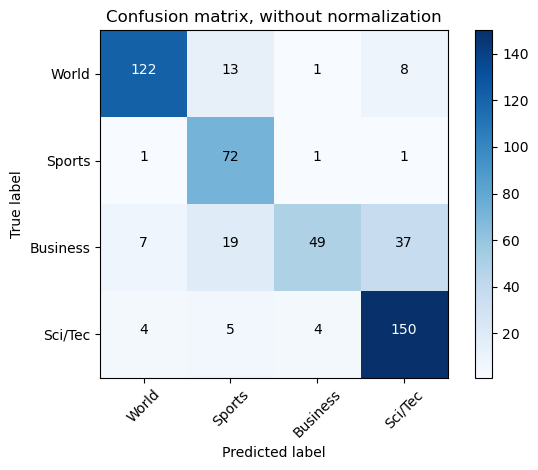

In [61]:
cnf_matrix = confusion_matrix(y_true, y_pred,labels=[0, 1, 2, 3])
numpy.set_printoptions(precision=2)

# Plot non-normalized confusion matrix
plt.figure()
plot_confusion_matrix(cnf_matrix, classes=['World', 'Sports', 'Business', 'Sci/Tec'],
                      title='Confusion matrix, without normalization')

You have now reached the end of exercise 2. Well done!